In [9]:
!pip install --upgrade pip

  Using cached pip-24.3.1-py3-none-any.whl (1.8 MB)


ERROR: To modify pip, please run the following command:
C:\Users\77479\anaconda3\python.exe -m pip install --upgrade pip


In [10]:
!pip install gymnasium

In [97]:
import pandas as pd
train_pd = pd.read_csv('C:/Users/77479/Downloads/train.csv')

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3499441080.py:2: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  train_pd = pd.read_csv('C:/Users/77479/Downloads/train.csv')


In [12]:
for col in store_pd.columns:
    print(f"{col}: {store_pd[col].dtype}")

Store: int64
StoreType: object
Assortment: object
CompetitionDistance: float64
CompetitionOpenSinceMonth: float64
CompetitionOpenSinceYear: float64
Promo2: int64
Promo2SinceWeek: float64
Promo2SinceYear: float64
PromoInterval: object


In [13]:
train_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 9 columns):
 #   Column         Non-Null Count    Dtype 
---  ------         --------------    ----- 
 0   Store          1017209 non-null  int64 
 1   DayOfWeek      1017209 non-null  int64 
 2   Date           1017209 non-null  object
 3   Sales          1017209 non-null  int64 
 4   Customers      1017209 non-null  int64 
 5   Open           1017209 non-null  int64 
 6   Promo          1017209 non-null  int64 
 7   StateHoliday   1017209 non-null  object
 8   SchoolHoliday  1017209 non-null  int64 
dtypes: int64(7), object(2)
memory usage: 69.8+ MB


In [14]:
train_pd.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [15]:
train_pd.isnull().sum()

Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64

In [16]:
train_pd['Date'] = pd.to_datetime(train_pd['Date'])
train_pd.dtypes

Store                     int64
DayOfWeek                 int64
Date             datetime64[ns]
Sales                     int64
Customers                 int64
Open                      int64
Promo                     int64
StateHoliday             object
SchoolHoliday             int64
dtype: object

In [17]:
train_pd.groupby('DayOfWeek')['Sales'].mean()

DayOfWeek
1    7809.044510
2    7005.244467
3    6555.884138
4    6247.575913
5    6723.274305
6    5847.562599
7     204.183189
Name: Sales, dtype: float64

In [18]:
train_pd.groupby('Promo')['Sales'].mean()

Promo
0    4406.050805
1    7991.152046
Name: Sales, dtype: float64

In [19]:
train_pd = train_pd[train_pd['Open'] == 1]

In [20]:
train_pd['Month'] = train_pd['Date'].dt.month
train_pd['Year'] = train_pd['Date'].dt.year

In [21]:
train_pd['WeekOfYear'] = train_pd['Date'].dt.isocalendar().week

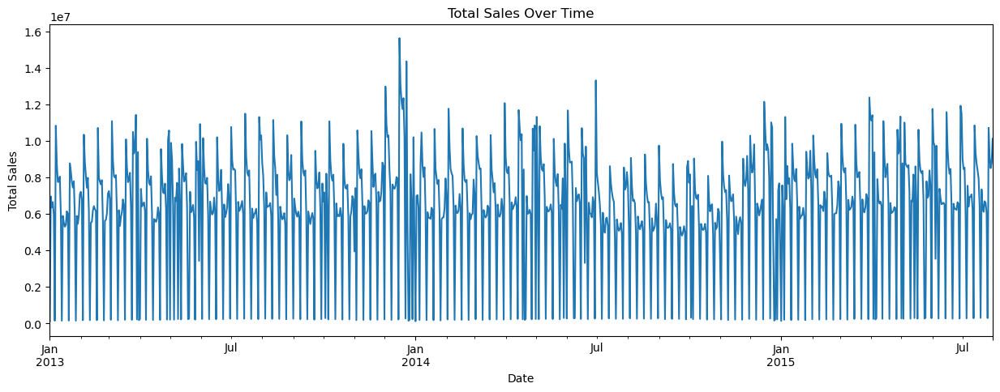

In [22]:
import matplotlib.pyplot as plt
train_pd.groupby('Date')['Sales'].sum().plot(figsize=(15, 5))
plt.title('Total Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Total Sales')
plt.show()

In [23]:
train_pd['IsHolidaySeason'] = train_pd['Month'].apply(lambda x: 1 if x in [11, 12] else 0)

In [24]:
store_avg_sales = train_pd.groupby('Store')['Sales'].mean()
train_pd['StoreAvgSales'] = train_pd['Store'].map(store_avg_sales)

In [25]:
train_pd[['IsHolidaySeason','StoreAvgSales']].head()

,IsHolidaySeason,StoreAvgSales
0,0,4759.096031
1,0,4953.900510
2,0,6942.568678
3,0,9638.401786
4,0,4676.274711


In [26]:
train_pd['IsHolidaySeason'].value_counts()

0    742598
1    101794
Name: IsHolidaySeason, dtype: int64

In [27]:
train_pd['StoreAvgSales'].describe()

count    844392.000000
mean       6955.514291
std        2408.273970
min        2703.736573
25%        5323.455243
50%        6608.028133
75%        7985.847436
max       21757.483418
Name: StoreAvgSales, dtype: float64

In [28]:
features = ['DayOfWeek', 'Promo', 'StateHoliday', 'IsHolidaySeason','StoreAvgSales']
target = 'Sales'
X = train_pd[features]
y = train_pd[target]

In [29]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [30]:
for col in X_train.columns:
    print(f"{col}: {X_train[col].unique()}")

DayOfWeek: [1 6 2 5 4 3 7]
Promo: [1 0]
StateHoliday: ['0' 0 'a' 'b' 'c']
IsHolidaySeason: [0 1]
StoreAvgSales: [7946.13992298 8737.57362356 7652.73954984 ... 9071.00481541 5350.00637755
 5413.25080386]


In [31]:
X = train_pd[features].copy()

In [32]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
X_train['StateHoliday'] = X_train['StateHoliday'].astype(str)
X_train['StateHoliday'] = label_encoder.fit_transform(X_train['StateHoliday']) 

X_test['StateHoliday'] = X_test['StateHoliday'].astype(str)
X_test['StateHoliday'] = label_encoder.fit_transform(X_test['StateHoliday']) 

In [33]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [34]:
pip install gym

Note: you may need to restart the kernel to use updated packages.


In [35]:
import gym
from gym import spaces
import numpy as np

In [85]:
class PricingEnv(gym.Env):
    def __init__(self, data, max_steps=200):
        super(PricingEnv, self). __init__()
        self.data = data.reset_index(drop=True) 
        self.current_step = 0
        self.max_steps = max_steps
        self.action_space = spaces.Discrete(3)
        self.observation_space = spaces.Box(
        low=np.min(data.values), high=np.max(data.values), shape=(len(data.columns),), dtype=np.float32
)
        
    def reset(self):
        self.current_step = 0
        return self._get_observation()
    
    def step(self, action):
        if action not in [0, 1, 2]:
            raise ValueError("Invalid action. Must be 0 (decrease price), 1 (do nothing), or 2 (increase price).")
        if action == 0:  
            self.data.at[self.current_step, 'Price'] *= 0.85 
            self.data.at[self.current_step, 'Sales'] *= 1.20  
        elif action == 2:  
            self.data.at[self.current_step, 'Price'] *= 1.15 
            self.data.at[self.current_step, 'Sales'] *= 0.80  
            
        reward = self.data.loc[self.current_step, 'Sales'] * self.data.loc[self.current_step, 'Price']
        self.current_step += 1
        done = self.current_step >= self.max_steps or self.current_step >= len(self.data)
        print(f"Step: {self.current_step - 1}, Price: {self.data.at[self.current_step - 1, 'Price']:.2f}, Sales: {self.data.at[self.current_step - 1, 'Sales']:.2f}")
        return self._get_observation(), reward, done, {}
    
    def _get_observation(self):
        if self.current_step < len(self.data):
            return self.data.iloc[self.current_step].values
        else:
            return np.zeros(self.observation_space.shape)

In [54]:
import pandas as pd
import numpy as np
data = pd.DataFrame({
    'Price': np.linspace(10, 20, 100),  
    'Sales': np.linspace(200, 100, 100)  
})


prices = []
sales = []
rewards = []
env = PricingEnv(data)
state = env.reset()
for _ in range(10):
    action = env.action_space.sample()
    state, reward, done, info = env.step(action)
    prices.append(env.data.at[env.current_step - 1, 'Price'])
    sales.append(env.data.at[env.current_step - 1, 'Sales'])
    rewards.append(reward)
    if done:
        break

Step: 0, Price: 8.50, Sales: 240.00
Step: 1, Price: 10.10, Sales: 198.99
Step: 2, Price: 8.67, Sales: 237.58
Step: 3, Price: 8.76, Sales: 236.36
Step: 4, Price: 10.40, Sales: 195.96
Step: 5, Price: 8.93, Sales: 233.94
Step: 6, Price: 10.61, Sales: 193.94
Step: 7, Price: 10.71, Sales: 192.93
Step: 8, Price: 10.81, Sales: 191.92
Step: 9, Price: 10.91, Sales: 190.91


In [55]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
prices_scaled = scaler.fit_transform(np.array(prices).reshape(-1, 1)).flatten()
sales_scaled = scaler.fit_transform(np.array(sales).reshape(-1, 1)).flatten()
rewards_scaled = scaler.fit_transform(np.array(rewards).reshape(-1, 1)).flatten()

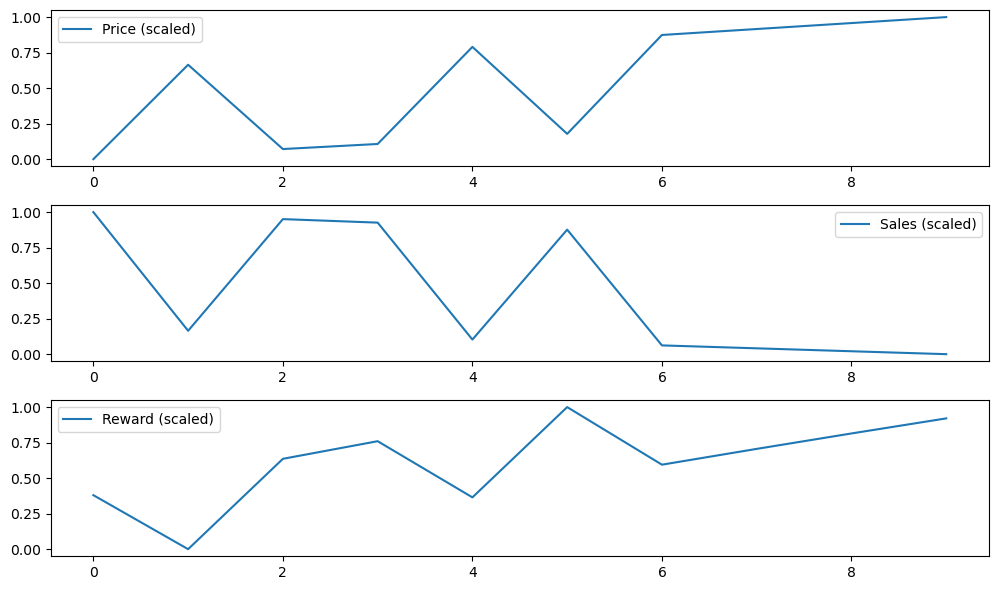

In [56]:
plt.figure(figsize=(10, 6))

plt.subplot(3, 1, 1)
plt.plot(prices_scaled, label="Price (scaled)")
plt.legend()

plt.subplot(3, 1, 2)
plt.plot(sales_scaled, label="Sales (scaled)")
plt.legend()

plt.subplot(3, 1, 3)
plt.plot(rewards_scaled, label="Reward (scaled)")
plt.legend()

plt.tight_layout()
plt.show()

In [40]:
pip install shimmy

Note: you may need to restart the kernel to use updated packages.


In [41]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
train_pd['StateHoliday'] = label_encoder.fit_transform(train_pd['StateHoliday'].astype(str))

In [57]:
from stable_baselines3 import DQN
train_pd['Price'] = np.where(train_pd['Promo'] == 1, 
                             np.random.uniform(8, 12, len(train_pd)),  
                             np.random.uniform(15, 20, len(train_pd)))
env_data = train_pd[['Price', 'Sales', 'DayOfWeek', 'Promo', 'StateHoliday']]
train_env = PricingEnv(env_data)
model = DQN("MlpPolicy", train_env, learning_rate=1e-3, buffer_size=50000, verbose=1)
model.learn(total_timesteps=10000)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Step: 0, Price: 10.11, Sales: 6315.60
Step: 1, Price: 7.81, Sales: 7276.80
Step: 2, Price: 7.29, Sales: 9976.80
Step: 3, Price: 10.81, Sales: 13995.00
Step: 4, Price: 9.56, Sales: 4822.00
Step: 5, Price: 9.00, Sales: 5651.00
Step: 6, Price: 7.69, Sales: 18412.80
Step: 7, Price: 10.33, Sales: 8492.00
Step: 8, Price: 10.30, Sales: 8565.00
Step: 9, Price: 9.91, Sales: 5748.00
Step: 10, Price: 11.69, Sales: 8365.60
Step: 11, Price: 8.22, Sales: 8959.00
Step: 12, Price: 8.03, Sales: 10585.20
Step: 13, Price: 10.79, Sales: 6544.00
Step: 14, Price: 12.53, Sales: 7352.80
Step: 15, Price: 9.64, Sales: 10231.00
Step: 16, Price: 13.56, Sales: 6744.00
Step: 17, Price: 10.03, Sales: 10071.00
Step: 18, Price: 10.01, Sales: 8234.00
Step: 19, Price: 9.63, Sales: 9593.00
Step: 20, Price: 11.47, Sales: 9515.00
Step: 21, Price: 11.28, Sales: 5252.80
Step: 22, Price: 10.78, Sales: 7273.00
Step: 23, Price: 12.96, 

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


Step: 112, Price: 11.33, Sales: 6762.40
Step: 113, Price: 9.81, Sales: 4600.00
Step: 114, Price: 12.81, Sales: 7772.80
Step: 115, Price: 6.80, Sales: 9699.60
Step: 116, Price: 9.33, Sales: 3589.60
Step: 117, Price: 11.32, Sales: 8623.20
Step: 118, Price: 8.97, Sales: 8445.60
Step: 119, Price: 8.72, Sales: 10392.00
Step: 120, Price: 9.57, Sales: 3652.00
Step: 121, Price: 9.84, Sales: 14803.20
Step: 122, Price: 7.02, Sales: 12900.00
Step: 123, Price: 10.83, Sales: 5971.20
Step: 124, Price: 9.02, Sales: 18227.00
Step: 125, Price: 9.40, Sales: 8742.00
Step: 126, Price: 8.21, Sales: 8560.00
Step: 127, Price: 12.63, Sales: 7664.80
Step: 128, Price: 11.97, Sales: 10241.00
Step: 129, Price: 12.63, Sales: 4323.20
Step: 130, Price: 10.06, Sales: 5291.00
Step: 131, Price: 12.31, Sales: 8309.60
Step: 132, Price: 10.82, Sales: 8519.00
Step: 133, Price: 10.28, Sales: 4872.00
Step: 134, Price: 11.66, Sales: 7475.00
Step: 135, Price: 11.35, Sales: 9568.00
Step: 136, Price: 12.06, Sales: 7237.60
Step: 

Step: 156, Price: 10.80, Sales: 10536.00
Step: 157, Price: 9.69, Sales: 9068.00
Step: 158, Price: 9.96, Sales: 7806.40
Step: 159, Price: 11.33, Sales: 7525.44
Step: 160, Price: 13.67, Sales: 7498.40
Step: 161, Price: 11.05, Sales: 8588.00
Step: 162, Price: 9.68, Sales: 6833.28
Step: 163, Price: 12.55, Sales: 5913.60
Step: 164, Price: 8.45, Sales: 4808.64
Step: 165, Price: 15.53, Sales: 4216.32
Step: 166, Price: 7.43, Sales: 16026.00
Step: 167, Price: 11.57, Sales: 10833.60
Step: 168, Price: 11.51, Sales: 7248.96
Step: 169, Price: 11.11, Sales: 4732.00
Step: 170, Price: 9.85, Sales: 10479.60
Step: 171, Price: 6.48, Sales: 11203.20
Step: 172, Price: 12.74, Sales: 7061.76
Step: 173, Price: 14.21, Sales: 4189.44
Step: 174, Price: 14.36, Sales: 5051.52
Step: 175, Price: 12.33, Sales: 4580.48
Step: 176, Price: 9.82, Sales: 4811.52
Step: 177, Price: 9.66, Sales: 12303.36
Step: 178, Price: 14.98, Sales: 6806.40
Step: 179, Price: 10.00, Sales: 7766.40
Step: 180, Price: 14.63, Sales: 5374.72
Ste

Step: 197, Price: 11.47, Sales: 2936.83
Step: 198, Price: 8.09, Sales: 14774.40
Step: 199, Price: 13.07, Sales: 5722.62
Step: 0, Price: 8.40, Sales: 7275.57
Step: 1, Price: 11.88, Sales: 3725.72
Step: 2, Price: 8.38, Sales: 7981.44
Step: 3, Price: 14.30, Sales: 8956.80
Step: 4, Price: 14.54, Sales: 2468.86
Step: 5, Price: 10.35, Sales: 4520.80
Step: 6, Price: 11.70, Sales: 9427.35
Step: 7, Price: 15.71, Sales: 4347.90
Step: 8, Price: 15.67, Sales: 4385.28
Step: 9, Price: 7.16, Sales: 8277.12
Step: 10, Price: 13.45, Sales: 6692.48
Step: 11, Price: 6.83, Sales: 10320.77
Step: 12, Price: 10.62, Sales: 6774.53
Step: 13, Price: 8.97, Sales: 7538.69
Step: 14, Price: 14.09, Sales: 5646.95
Step: 15, Price: 14.65, Sales: 5238.27
Step: 16, Price: 15.24, Sales: 5179.39
Step: 17, Price: 13.27, Sales: 6445.44
Step: 18, Price: 11.51, Sales: 6587.20
Step: 19, Price: 10.83, Sales: 7367.42
Step: 20, Price: 17.44, Sales: 4871.68
Step: 21, Price: 14.92, Sales: 3361.79
Step: 22, Price: 8.95, Sales: 8378.5

Step: 0, Price: 9.66, Sales: 5820.46
Step: 1, Price: 13.67, Sales: 2980.58
Step: 2, Price: 7.12, Sales: 9577.73
Step: 3, Price: 16.44, Sales: 7165.44
Step: 4, Price: 16.72, Sales: 1975.09
Step: 5, Price: 11.90, Sales: 3616.64
Step: 6, Price: 11.70, Sales: 9427.35
Step: 7, Price: 13.35, Sales: 5217.48
Step: 8, Price: 18.02, Sales: 3508.22
Step: 9, Price: 8.24, Sales: 6621.70
Step: 10, Price: 13.45, Sales: 6692.48
Step: 11, Price: 6.83, Sales: 10320.77
Step: 12, Price: 10.62, Sales: 6774.53
Step: 13, Price: 10.31, Sales: 6030.95
Step: 14, Price: 16.20, Sales: 4517.56
Step: 15, Price: 16.85, Sales: 4190.62
Step: 16, Price: 17.53, Sales: 4143.51
Step: 17, Price: 15.26, Sales: 5156.35
Step: 18, Price: 13.24, Sales: 5269.76
Step: 19, Price: 12.45, Sales: 5893.94
Step: 20, Price: 20.05, Sales: 3897.34
Step: 21, Price: 17.16, Sales: 2689.43
Step: 22, Price: 8.95, Sales: 8378.50
Step: 23, Price: 16.76, Sales: 6974.67
Step: 24, Price: 15.24, Sales: 8712.19
Step: 25, Price: 21.21, Sales: 2561.80


Step: 19, Price: 12.45, Sales: 5893.94
Step: 20, Price: 17.05, Sales: 4676.81
Step: 21, Price: 19.73, Sales: 2151.55
Step: 22, Price: 7.61, Sales: 10054.20
Step: 23, Price: 14.24, Sales: 8369.60
Step: 24, Price: 12.96, Sales: 10454.63
Step: 25, Price: 18.03, Sales: 3074.16
Step: 26, Price: 8.19, Sales: 14612.52
Step: 27, Price: 14.64, Sales: 4485.73
Step: 28, Price: 17.09, Sales: 3700.56
Step: 29, Price: 10.50, Sales: 2934.37
Step: 30, Price: 17.51, Sales: 3562.54
Step: 31, Price: 13.72, Sales: 3771.92
Step: 32, Price: 11.19, Sales: 6628.76
Step: 33, Price: 12.03, Sales: 6846.87
Step: 34, Price: 9.55, Sales: 11438.90
Step: 35, Price: 20.77, Sales: 4070.44
Step: 36, Price: 7.97, Sales: 8043.13
Step: 37, Price: 10.20, Sales: 5480.94
Step: 38, Price: 11.06, Sales: 6145.97
Step: 39, Price: 10.46, Sales: 4028.50
Step: 40, Price: 8.04, Sales: 9207.45
Step: 41, Price: 15.37, Sales: 4697.36
Step: 42, Price: 10.18, Sales: 4775.22
Step: 43, Price: 11.23, Sales: 4917.66
Step: 44, Price: 7.44, Sal

Step: 56, Price: 9.88, Sales: 8206.10
Step: 57, Price: 10.26, Sales: 7908.25
Step: 58, Price: 8.86, Sales: 7905.12
Step: 59, Price: 9.59, Sales: 10795.99
Step: 60, Price: 9.50, Sales: 4929.75
Step: 61, Price: 12.22, Sales: 4420.73
Step: 62, Price: 9.27, Sales: 10196.58
Step: 63, Price: 5.32, Sales: 21102.55
Step: 64, Price: 10.28, Sales: 6331.17
Step: 65, Price: 15.74, Sales: 3919.26
Step: 66, Price: 8.11, Sales: 11715.67
Step: 67, Price: 9.75, Sales: 7918.03
Step: 68, Price: 9.06, Sales: 9912.58
Step: 69, Price: 11.08, Sales: 7620.23
Step: 70, Price: 8.82, Sales: 12767.85
Step: 71, Price: 14.66, Sales: 3226.21
Step: 72, Price: 11.21, Sales: 4442.85
Step: 73, Price: 14.20, Sales: 4434.30
Step: 74, Price: 7.54, Sales: 7903.17
Step: 75, Price: 9.26, Sales: 14251.99
Step: 76, Price: 14.35, Sales: 4876.66
Step: 77, Price: 8.00, Sales: 6064.33
Step: 78, Price: 15.62, Sales: 3373.79
Step: 79, Price: 10.69, Sales: 7232.72
Step: 80, Price: 12.74, Sales: 6841.22
Step: 81, Price: 8.21, Sales: 12

Step: 84, Price: 8.72, Sales: 5514.38
Step: 85, Price: 5.90, Sales: 10648.26
Step: 86, Price: 8.47, Sales: 6772.48
Step: 87, Price: 10.16, Sales: 6678.41
Step: 88, Price: 6.72, Sales: 7744.98
Step: 89, Price: 5.82, Sales: 18306.07
Step: 90, Price: 8.79, Sales: 6544.22
Step: 91, Price: 8.20, Sales: 7278.72
Step: 92, Price: 6.64, Sales: 8342.28
Step: 93, Price: 7.99, Sales: 8888.41
Step: 94, Price: 6.81, Sales: 8965.91
Step: 95, Price: 6.18, Sales: 8453.65
Step: 96, Price: 8.83, Sales: 5931.27
Step: 97, Price: 14.47, Sales: 3308.68
Step: 98, Price: 8.13, Sales: 6976.32
Step: 99, Price: 8.02, Sales: 9095.09
Step: 100, Price: 14.40, Sales: 6271.01
Step: 101, Price: 10.47, Sales: 8919.55
Step: 102, Price: 5.27, Sales: 10367.34
Step: 103, Price: 9.30, Sales: 11129.62
Step: 104, Price: 9.30, Sales: 4569.48
Step: 105, Price: 4.37, Sales: 20725.12
Step: 106, Price: 8.11, Sales: 9761.12
Step: 107, Price: 6.89, Sales: 19017.29
Step: 108, Price: 10.65, Sales: 7974.13
Step: 109, Price: 10.95, Sales

Step: 110, Price: 5.37, Sales: 13601.95
Step: 111, Price: 7.32, Sales: 7984.54
Step: 112, Price: 13.99, Sales: 3829.08
Step: 113, Price: 12.39, Sales: 2713.19
Step: 114, Price: 11.70, Sales: 6601.80
Step: 115, Price: 5.40, Sales: 10297.90
Step: 116, Price: 7.41, Sales: 3811.02
Step: 117, Price: 7.82, Sales: 11443.88
Step: 118, Price: 6.05, Sales: 10759.86
Step: 119, Price: 6.02, Sales: 13791.26
Step: 120, Price: 8.73, Sales: 3101.81
Step: 121, Price: 10.57, Sales: 10477.54
Step: 122, Price: 6.41, Sales: 10956.57
Step: 123, Price: 9.89, Sales: 5071.62
Step: 124, Price: 8.23, Sales: 15481.04
Step: 125, Price: 7.47, Sales: 9281.23
Step: 126, Price: 7.50, Sales: 7270.41
Step: 127, Price: 10.03, Sales: 8137.59
Step: 128, Price: 9.51, Sales: 10872.70
Step: 129, Price: 11.53, Sales: 3671.90
Step: 130, Price: 6.79, Sales: 6740.84
Step: 131, Price: 8.31, Sales: 10586.60
Step: 132, Price: 8.59, Sales: 9044.48
Step: 133, Price: 9.38, Sales: 4138.02
Step: 134, Price: 7.87, Sales: 9523.30
Step: 135

Step: 135, Price: 6.66, Sales: 15237.28
Step: 136, Price: 12.95, Sales: 5122.69
Step: 137, Price: 8.86, Sales: 10754.85
Step: 138, Price: 11.02, Sales: 4513.99
Step: 139, Price: 9.97, Sales: 6956.15
Step: 140, Price: 12.24, Sales: 6149.98
Step: 141, Price: 7.51, Sales: 4487.10
Step: 142, Price: 8.30, Sales: 8899.03
Step: 143, Price: 9.59, Sales: 6064.33
Step: 144, Price: 8.18, Sales: 11564.92
Step: 145, Price: 11.15, Sales: 5735.92
Step: 146, Price: 9.96, Sales: 9629.89
Step: 147, Price: 10.21, Sales: 7075.06
Step: 148, Price: 5.79, Sales: 13652.40
Step: 149, Price: 11.19, Sales: 6130.02
Step: 150, Price: 13.96, Sales: 6006.01
Step: 151, Price: 8.81, Sales: 7326.68
Step: 152, Price: 8.66, Sales: 7424.70
Step: 153, Price: 8.83, Sales: 7926.50
Step: 154, Price: 6.49, Sales: 13788.08
Step: 155, Price: 5.56, Sales: 11247.05
Step: 156, Price: 7.46, Sales: 13982.37
Step: 157, Price: 6.69, Sales: 12034.18
Step: 158, Price: 7.91, Sales: 8287.92
Step: 159, Price: 10.58, Sales: 6658.03
Step: 160

Step: 176, Price: 4.90, Sales: 9194.96
Step: 177, Price: 7.67, Sales: 13062.27
Step: 178, Price: 8.99, Sales: 11291.00
Step: 179, Price: 6.90, Sales: 10306.82
Step: 180, Price: 13.36, Sales: 4565.00
Step: 181, Price: 3.70, Sales: 19363.51
Step: 182, Price: 8.45, Sales: 3796.92
Step: 183, Price: 6.49, Sales: 13042.78
Step: 184, Price: 6.56, Sales: 9733.10
Step: 185, Price: 6.89, Sales: 5052.25
Step: 186, Price: 8.21, Sales: 8229.15
Step: 187, Price: 5.92, Sales: 14768.44
Step: 188, Price: 7.78, Sales: 13568.62
Step: 189, Price: 5.94, Sales: 15562.15
Step: 190, Price: 10.76, Sales: 7297.59
Step: 191, Price: 7.71, Sales: 13201.70
Step: 192, Price: 8.17, Sales: 4813.96
Step: 193, Price: 9.37, Sales: 5469.52
Step: 194, Price: 4.34, Sales: 24662.37
Step: 195, Price: 7.10, Sales: 8297.23
Step: 196, Price: 7.67, Sales: 12396.93
Step: 197, Price: 5.72, Sales: 5612.37
Step: 198, Price: 4.04, Sales: 28234.32
Step: 199, Price: 5.67, Sales: 13670.13
Step: 0, Price: 4.93, Sales: 11586.53
Step: 1, Pr

Step: 198, Price: 4.04, Sales: 28234.32
Step: 199, Price: 5.67, Sales: 13670.13
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 200      |
|    ep_rew_mean      | 1.5e+07  |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 12       |
|    fps              | 248      |
|    time_elapsed     | 9        |
|    total_timesteps  | 2400     |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 1.92e+04 |
|    n_updates        | 574      |
----------------------------------
Step: 0, Price: 4.93, Sales: 11586.53
Step: 1, Price: 5.93, Sales: 7119.96
Step: 2, Price: 3.09, Sales: 22879.15
Step: 3, Price: 6.20, Sales: 21395.89
Step: 4, Price: 7.25, Sales: 4718.07
Step: 5, Price: 5.16, Sales: 8639.38
Step: 6, Price: 5.07, Sales: 22519.94
Step: 7, Price: 5.79, Sales: 12463.46
Step: 8, Price: 7.82, Sales: 8380.40
Step: 9, Price: 3.11, Sales: 19772.28
Step: 10, Price: 6.

Step: 4, Price: 6.16, Sales: 5661.69
Step: 5, Price: 4.39, Sales: 10367.26
Step: 6, Price: 4.31, Sales: 27023.93
Step: 7, Price: 4.92, Sales: 14956.15
Step: 8, Price: 6.64, Sales: 10056.48
Step: 9, Price: 2.64, Sales: 23726.73
Step: 10, Price: 5.83, Sales: 15986.91
Step: 11, Price: 2.52, Sales: 29584.94
Step: 12, Price: 3.92, Sales: 19419.49
Step: 13, Price: 3.80, Sales: 17287.99
Step: 14, Price: 7.03, Sales: 10791.49
Step: 15, Price: 6.21, Sales: 12012.59
Step: 16, Price: 6.46, Sales: 11877.57
Step: 17, Price: 6.62, Sales: 12317.43
Step: 18, Price: 4.15, Sales: 18127.20
Step: 19, Price: 5.40, Sales: 14079.37
Step: 20, Price: 11.77, Sales: 6206.62
Step: 21, Price: 11.58, Sales: 3426.39
Step: 22, Price: 3.88, Sales: 20014.44
Step: 23, Price: 8.55, Sales: 13884.17
Step: 24, Price: 6.61, Sales: 20811.57
Step: 25, Price: 9.20, Sales: 6119.60
Step: 26, Price: 4.18, Sales: 29088.50
Step: 27, Price: 7.47, Sales: 8929.55
Step: 28, Price: 8.72, Sales: 7366.53
Step: 29, Price: 7.25, Sales: 3894.

Step: 38, Price: 6.49, Sales: 9787.60
Step: 39, Price: 5.34, Sales: 8019.35
Step: 40, Price: 4.72, Sales: 14663.09
Step: 41, Price: 9.02, Sales: 7480.66
Step: 42, Price: 5.97, Sales: 7604.65
Step: 43, Price: 10.49, Sales: 4350.83
Step: 44, Price: 4.37, Sales: 11097.35
Step: 45, Price: 6.32, Sales: 8956.31
Step: 46, Price: 9.20, Sales: 7341.49
Step: 47, Price: 4.76, Sales: 5685.76
Step: 48, Price: 8.83, Sales: 8070.23
Step: 49, Price: 10.18, Sales: 4671.27
Step: 50, Price: 11.76, Sales: 5759.84
Step: 51, Price: 10.69, Sales: 5238.61
Step: 52, Price: 3.86, Sales: 15935.38
Step: 53, Price: 4.75, Sales: 18145.20
Step: 54, Price: 7.33, Sales: 6871.24
Step: 55, Price: 5.96, Sales: 11767.20
Step: 56, Price: 6.67, Sales: 10454.74
Step: 57, Price: 6.92, Sales: 10075.27
Step: 58, Price: 5.98, Sales: 10071.27
Step: 59, Price: 10.30, Sales: 7641.28
Step: 60, Price: 6.41, Sales: 6280.60
Step: 61, Price: 8.25, Sales: 5632.10
Step: 62, Price: 6.26, Sales: 12990.65
Step: 63, Price: 3.59, Sales: 26885.

Step: 49, Price: 10.18, Sales: 4671.27
Step: 50, Price: 11.76, Sales: 5759.84
Step: 51, Price: 10.69, Sales: 5238.61
Step: 52, Price: 3.86, Sales: 15935.38
Step: 53, Price: 4.75, Sales: 18145.20
Step: 54, Price: 7.33, Sales: 6871.24
Step: 55, Price: 5.96, Sales: 11767.20
Step: 56, Price: 6.67, Sales: 10454.74
Step: 57, Price: 6.92, Sales: 10075.27
Step: 58, Price: 5.98, Sales: 10071.27
Step: 59, Price: 10.30, Sales: 7641.28
Step: 60, Price: 6.41, Sales: 6280.60
Step: 61, Price: 8.25, Sales: 5632.10
Step: 62, Price: 6.26, Sales: 12990.65
Step: 63, Price: 3.59, Sales: 26885.06
Step: 64, Price: 5.13, Sales: 12099.06
Step: 65, Price: 7.85, Sales: 7489.83
Step: 66, Price: 4.05, Sales: 22389.00
Step: 67, Price: 4.86, Sales: 15131.60
Step: 68, Price: 5.32, Sales: 15786.03
Step: 69, Price: 6.35, Sales: 11649.99
Step: 70, Price: 3.74, Sales: 29279.68
Step: 71, Price: 7.31, Sales: 6165.39
Step: 72, Price: 4.13, Sales: 12735.63
Step: 73, Price: 8.33, Sales: 7061.73
Step: 74, Price: 3.27, Sales: 1

Step: 61, Price: 7.01, Sales: 6758.52
Step: 62, Price: 5.32, Sales: 15588.78
Step: 63, Price: 3.05, Sales: 32262.07
Step: 64, Price: 4.36, Sales: 14518.87
Step: 65, Price: 6.67, Sales: 8987.79
Step: 66, Price: 3.44, Sales: 26866.80
Step: 67, Price: 4.13, Sales: 18157.92
Step: 68, Price: 4.52, Sales: 18943.24
Step: 69, Price: 7.31, Sales: 9319.99
Step: 70, Price: 3.18, Sales: 35135.62
Step: 71, Price: 6.22, Sales: 7398.47
Step: 72, Price: 3.51, Sales: 15282.75
Step: 73, Price: 7.08, Sales: 8474.07
Step: 74, Price: 2.78, Sales: 22654.79
Step: 75, Price: 2.90, Sales: 49024.76
Step: 76, Price: 6.08, Sales: 11183.34
Step: 77, Price: 3.47, Sales: 14486.40
Step: 78, Price: 6.62, Sales: 7736.90
Step: 79, Price: 4.64, Sales: 17277.42
Step: 80, Price: 6.35, Sales: 13073.78
Step: 81, Price: 4.09, Sales: 23316.21
Step: 82, Price: 4.23, Sales: 6536.47
Step: 83, Price: 8.04, Sales: 13480.07
Step: 84, Price: 5.12, Sales: 8781.79
Step: 85, Price: 2.94, Sales: 20349.14
Step: 86, Price: 4.97, Sales: 107

Step: 88, Price: 3.35, Sales: 14800.89
Step: 89, Price: 2.90, Sales: 34983.45
Step: 90, Price: 4.38, Sales: 12506.19
Step: 91, Price: 4.09, Sales: 13909.86
Step: 92, Price: 3.31, Sales: 15942.35
Step: 93, Price: 3.98, Sales: 16986.02
Step: 94, Price: 3.39, Sales: 17134.13
Step: 95, Price: 3.08, Sales: 16155.18
Step: 96, Price: 4.40, Sales: 11334.83
Step: 97, Price: 7.22, Sales: 6322.98
Step: 98, Price: 4.05, Sales: 13331.96
Step: 99, Price: 4.00, Sales: 17380.98
Step: 100, Price: 7.18, Sales: 11984.08
Step: 101, Price: 5.22, Sales: 17045.53
Step: 102, Price: 2.63, Sales: 19812.29
Step: 103, Price: 5.46, Sales: 17724.20
Step: 104, Price: 4.64, Sales: 8732.42
Step: 105, Price: 1.90, Sales: 49507.90
Step: 106, Price: 4.05, Sales: 18653.78
Step: 107, Price: 3.43, Sales: 36342.62
Step: 108, Price: 6.25, Sales: 12698.99
Step: 109, Price: 5.46, Sales: 10242.60
Step: 110, Price: 3.70, Sales: 18051.20
Step: 111, Price: 5.05, Sales: 10596.31
Step: 112, Price: 9.66, Sales: 5081.59
Step: 113, Pric

Step: 119, Price: 4.78, Sales: 14641.95
Step: 120, Price: 6.93, Sales: 3293.14
Step: 121, Price: 8.39, Sales: 11123.83
Step: 122, Price: 4.42, Sales: 14540.51
Step: 123, Price: 7.85, Sales: 5384.45
Step: 124, Price: 6.53, Sales: 16435.96
Step: 125, Price: 6.82, Sales: 7882.98
Step: 126, Price: 5.95, Sales: 7718.87
Step: 127, Price: 7.96, Sales: 8639.54
Step: 128, Price: 7.55, Sales: 11543.36
Step: 129, Price: 9.15, Sales: 3898.39
Step: 130, Price: 5.39, Sales: 7156.64
Step: 131, Price: 6.60, Sales: 11239.61
Step: 132, Price: 4.28, Sales: 17284.27
Step: 133, Price: 5.51, Sales: 6589.89
Step: 134, Price: 4.62, Sales: 15166.09
Step: 135, Price: 2.89, Sales: 36398.61
Step: 136, Price: 7.60, Sales: 8158.01
Step: 137, Price: 8.27, Sales: 9515.20
Step: 138, Price: 6.47, Sales: 7188.65
Step: 139, Price: 5.85, Sales: 11077.84
Step: 140, Price: 7.19, Sales: 9793.99
Step: 141, Price: 4.41, Sales: 7145.81
Step: 142, Price: 4.87, Sales: 14171.92
Step: 143, Price: 5.63, Sales: 9657.60
Step: 144, Pri

Step: 136, Price: 6.46, Sales: 9789.62
Step: 137, Price: 7.03, Sales: 11418.24
Step: 138, Price: 5.50, Sales: 8626.38
Step: 139, Price: 4.97, Sales: 13293.41
Step: 140, Price: 6.11, Sales: 11752.79
Step: 141, Price: 3.75, Sales: 8574.98
Step: 142, Price: 4.14, Sales: 17006.31
Step: 143, Price: 4.78, Sales: 11589.12
Step: 144, Price: 5.52, Sales: 14733.93
Step: 145, Price: 7.53, Sales: 7307.68
Step: 146, Price: 4.97, Sales: 18403.01
Step: 147, Price: 8.10, Sales: 7511.47
Step: 148, Price: 3.32, Sales: 20872.11
Step: 149, Price: 8.68, Sales: 6247.81
Step: 150, Price: 9.42, Sales: 7651.78
Step: 151, Price: 5.05, Sales: 11201.20
Step: 152, Price: 5.84, Sales: 9459.22
Step: 153, Price: 5.06, Sales: 12118.22
Step: 154, Price: 3.72, Sales: 21079.54
Step: 155, Price: 3.19, Sales: 17194.75
Step: 156, Price: 4.28, Sales: 21376.58
Step: 157, Price: 3.84, Sales: 18398.14
Step: 158, Price: 4.54, Sales: 12670.78
Step: 159, Price: 6.07, Sales: 10178.95
Step: 160, Price: 7.32, Sales: 10142.38
Step: 16

Step: 168, Price: 2.93, Sales: 27576.51
Step: 169, Price: 3.33, Sales: 15001.24
Step: 170, Price: 2.51, Sales: 39866.52
Step: 171, Price: 1.90, Sales: 34095.40
Step: 172, Price: 3.24, Sales: 26864.37
Step: 173, Price: 3.53, Sales: 15299.98
Step: 174, Price: 6.69, Sales: 8540.89
Step: 175, Price: 4.15, Sales: 11152.05
Step: 176, Price: 2.44, Sales: 17571.84
Step: 177, Price: 3.83, Sales: 24962.39
Step: 178, Price: 5.16, Sales: 17261.95
Step: 179, Price: 4.66, Sales: 13131.09
Step: 180, Price: 6.66, Sales: 8723.85
Step: 181, Price: 1.84, Sales: 37004.24
Step: 182, Price: 4.21, Sales: 7256.02
Step: 183, Price: 3.24, Sales: 24925.14
Step: 184, Price: 3.27, Sales: 18600.25
Step: 185, Price: 3.44, Sales: 9655.01
Step: 186, Price: 4.09, Sales: 15726.15
Step: 187, Price: 2.95, Sales: 28222.92
Step: 188, Price: 3.88, Sales: 25930.03
Step: 189, Price: 2.96, Sales: 29739.74
Step: 190, Price: 5.37, Sales: 13945.90
Step: 191, Price: 3.84, Sales: 25228.84
Step: 192, Price: 3.01, Sales: 13799.43
Step

Step: 20, Price: 5.87, Sales: 11861.03
Step: 21, Price: 5.78, Sales: 6547.94
Step: 22, Price: 1.94, Sales: 38248.20
Step: 23, Price: 5.77, Sales: 17688.70
Step: 24, Price: 3.30, Sales: 39771.53
Step: 25, Price: 4.59, Sales: 11694.74
Step: 26, Price: 2.45, Sales: 46324.16
Step: 27, Price: 3.73, Sales: 17064.64
Step: 28, Price: 5.88, Sales: 9385.11
Step: 29, Price: 4.25, Sales: 6201.64
Step: 30, Price: 5.24, Sales: 11293.84
Step: 31, Price: 4.11, Sales: 11957.64
Step: 32, Price: 3.35, Sales: 21014.29
Step: 33, Price: 4.24, Sales: 18088.12
Step: 34, Price: 3.87, Sales: 24175.50
Step: 35, Price: 7.32, Sales: 10753.32
Step: 36, Price: 2.81, Sales: 21248.41
Step: 37, Price: 2.26, Sales: 26063.26
Step: 38, Price: 3.31, Sales: 19483.75
Step: 39, Price: 2.72, Sales: 15963.77
Step: 40, Price: 2.41, Sales: 29189.17
Step: 41, Price: 4.60, Sales: 14891.42
Step: 42, Price: 3.58, Sales: 12615.20
Step: 43, Price: 5.35, Sales: 8661.00
Step: 44, Price: 1.65, Sales: 33136.52
Step: 45, Price: 3.23, Sales:

Step: 54, Price: 4.30, Sales: 10942.61
Step: 55, Price: 3.04, Sales: 23424.44
Step: 56, Price: 4.60, Sales: 13874.53
Step: 57, Price: 4.78, Sales: 13370.93
Step: 58, Price: 5.58, Sales: 8910.42
Step: 59, Price: 6.19, Sales: 12675.97
Step: 60, Price: 4.42, Sales: 8335.01
Step: 61, Price: 5.69, Sales: 7474.38
Step: 62, Price: 3.67, Sales: 20687.93
Step: 63, Price: 2.48, Sales: 35679.27
Step: 64, Price: 3.54, Sales: 16056.71
Step: 65, Price: 5.42, Sales: 9939.78
Step: 66, Price: 2.79, Sales: 29712.53
Step: 67, Price: 3.36, Sales: 20081.20
Step: 68, Price: 3.67, Sales: 20949.71
Step: 69, Price: 5.93, Sales: 10307.17
Step: 70, Price: 2.58, Sales: 38857.18
Step: 71, Price: 5.05, Sales: 8182.12
Step: 72, Price: 2.85, Sales: 16901.50
Step: 73, Price: 5.75, Sales: 9371.65
Step: 74, Price: 1.67, Sales: 37581.58
Step: 75, Price: 2.71, Sales: 43373.97
Step: 76, Price: 4.20, Sales: 14841.46
Step: 77, Price: 2.40, Sales: 19224.97
Step: 78, Price: 4.57, Sales: 10267.68
Step: 79, Price: 3.20, Sales: 2

Step: 88, Price: 2.31, Sales: 19642.31
Step: 89, Price: 2.00, Sales: 46426.68
Step: 90, Price: 3.03, Sales: 16597.01
Step: 91, Price: 2.82, Sales: 18459.83
Step: 92, Price: 2.29, Sales: 21157.16
Step: 93, Price: 2.75, Sales: 22542.21
Step: 94, Price: 2.34, Sales: 22738.77
Step: 95, Price: 2.13, Sales: 21439.61
Step: 96, Price: 4.84, Sales: 8356.95
Step: 97, Price: 6.74, Sales: 5594.17
Step: 98, Price: 2.80, Sales: 17692.89
Step: 99, Price: 3.74, Sales: 15377.58
Step: 100, Price: 6.71, Sales: 10602.75
Step: 101, Price: 4.88, Sales: 15080.80
Step: 102, Price: 2.14, Sales: 21910.81
Step: 103, Price: 5.10, Sales: 15681.24
Step: 104, Price: 3.20, Sales: 11588.83
Step: 105, Price: 1.77, Sales: 43801.42
Step: 106, Price: 3.78, Sales: 16503.67
Step: 107, Price: 3.21, Sales: 32153.62
Step: 108, Price: 5.84, Sales: 11235.26
Step: 109, Price: 5.10, Sales: 9062.00
Step: 110, Price: 3.46, Sales: 15970.54
Step: 111, Price: 3.49, Sales: 14062.41
Step: 112, Price: 9.02, Sales: 4495.86
Step: 113, Price

Step: 120, Price: 3.54, Sales: 6555.52
Step: 121, Price: 4.28, Sales: 22143.71
Step: 122, Price: 2.26, Sales: 28945.15
Step: 123, Price: 4.00, Sales: 10718.59
Step: 124, Price: 3.33, Sales: 32718.34
Step: 125, Price: 3.48, Sales: 15692.31
Step: 126, Price: 3.04, Sales: 15365.61
Step: 127, Price: 4.06, Sales: 17198.36
Step: 128, Price: 3.85, Sales: 22978.86
Step: 129, Price: 6.32, Sales: 5173.57
Step: 130, Price: 2.75, Sales: 14246.40
Step: 131, Price: 3.37, Sales: 22374.20
Step: 132, Price: 2.19, Sales: 34407.03
Step: 133, Price: 3.80, Sales: 8745.47
Step: 134, Price: 2.35, Sales: 30190.47
Step: 135, Price: 1.73, Sales: 60380.93
Step: 136, Price: 3.88, Sales: 16239.80
Step: 137, Price: 4.22, Sales: 18941.50
Step: 138, Price: 3.30, Sales: 14310.12
Step: 139, Price: 2.98, Sales: 22052.17
Step: 140, Price: 3.67, Sales: 19496.47
Step: 141, Price: 3.04, Sales: 9483.24
Step: 142, Price: 2.48, Sales: 28211.42
Step: 143, Price: 2.87, Sales: 19224.97
Step: 144, Price: 3.81, Sales: 19553.46
Step

Step: 140, Price: 3.12, Sales: 23395.76
Step: 141, Price: 2.59, Sales: 11379.89
Step: 142, Price: 2.86, Sales: 22569.14
Step: 143, Price: 2.44, Sales: 23069.96
Step: 144, Price: 3.24, Sales: 23464.15
Step: 145, Price: 3.84, Sales: 14547.07
Step: 146, Price: 2.98, Sales: 30528.38
Step: 147, Price: 3.51, Sales: 17943.30
Step: 148, Price: 1.69, Sales: 41549.19
Step: 149, Price: 5.99, Sales: 8291.49
Step: 150, Price: 5.66, Sales: 12693.38
Step: 151, Price: 2.58, Sales: 22297.73
Step: 152, Price: 2.98, Sales: 18830.05
Step: 153, Price: 2.58, Sales: 24123.20
Step: 154, Price: 1.90, Sales: 41962.12
Step: 155, Price: 1.20, Sales: 51343.26
Step: 156, Price: 2.18, Sales: 42553.41
Step: 157, Price: 1.96, Sales: 36624.37
Step: 158, Price: 2.31, Sales: 25223.15
Step: 159, Price: 3.10, Sales: 20262.79
Step: 160, Price: 3.74, Sales: 20189.98
Step: 161, Price: 1.94, Sales: 43357.14
Step: 162, Price: 2.64, Sales: 18399.10
Step: 163, Price: 4.64, Sales: 10615.20
Step: 164, Price: 2.31, Sales: 12947.61
S

Step: 164, Price: 2.31, Sales: 12947.61
Step: 165, Price: 2.67, Sales: 20434.94
Step: 166, Price: 1.50, Sales: 64726.74
Step: 167, Price: 4.28, Sales: 19446.83
Step: 168, Price: 1.76, Sales: 45746.13
Step: 169, Price: 2.00, Sales: 24885.26
Step: 170, Price: 2.04, Sales: 44089.19
Step: 171, Price: 1.14, Sales: 56560.17
Step: 172, Price: 1.95, Sales: 44564.76
Step: 173, Price: 2.50, Sales: 21150.69
Step: 174, Price: 4.02, Sales: 14168.31
Step: 175, Price: 2.49, Sales: 18499.91
Step: 176, Price: 1.47, Sales: 29149.57
Step: 177, Price: 2.30, Sales: 41409.61
Step: 178, Price: 3.10, Sales: 28635.51
Step: 179, Price: 2.80, Sales: 21782.91
Step: 180, Price: 4.00, Sales: 14471.82
Step: 181, Price: 1.11, Sales: 61385.60
Step: 182, Price: 2.53, Sales: 12036.87
Step: 183, Price: 2.29, Sales: 34456.51
Step: 184, Price: 1.97, Sales: 30855.58
Step: 185, Price: 2.06, Sales: 16016.50
Step: 186, Price: 2.83, Sales: 20870.23
Step: 187, Price: 1.77, Sales: 46818.44
Step: 188, Price: 2.33, Sales: 43014.81


Step: 0, Price: 1.70, Sales: 29385.00
Step: 1, Price: 3.25, Sales: 10031.77
Step: 2, Price: 1.44, Sales: 38683.09
Step: 3, Price: 2.14, Sales: 54262.87
Step: 4, Price: 2.55, Sales: 12464.24
Step: 5, Price: 1.78, Sales: 21910.64
Step: 6, Price: 1.75, Sales: 57113.62
Step: 7, Price: 2.70, Sales: 21072.68
Step: 8, Price: 2.34, Sales: 26567.29
Step: 9, Price: 1.07, Sales: 50145.17
Step: 10, Price: 2.36, Sales: 33787.47
Step: 11, Price: 1.02, Sales: 62526.18
Step: 12, Price: 1.59, Sales: 41042.04
Step: 13, Price: 1.31, Sales: 43844.68
Step: 14, Price: 2.85, Sales: 22807.23
Step: 15, Price: 2.96, Sales: 21156.64
Step: 16, Price: 1.64, Sales: 45184.67
Step: 17, Price: 1.98, Sales: 39048.33
Step: 18, Price: 1.06, Sales: 68959.56
Step: 19, Price: 1.86, Sales: 35707.18
Step: 20, Price: 2.99, Sales: 23611.23
Step: 21, Price: 2.95, Sales: 13034.69
Step: 22, Price: 0.73, Sales: 114208.51
Step: 23, Price: 2.94, Sales: 35212.12
Step: 24, Price: 1.68, Sales: 79171.44
Step: 25, Price: 2.34, Sales: 2328

Step: 46, Price: 2.39, Sales: 29092.19
Step: 47, Price: 1.05, Sales: 27037.22
Step: 48, Price: 1.95, Sales: 38376.00
Step: 49, Price: 3.05, Sales: 14808.72
Step: 50, Price: 3.52, Sales: 18259.68
Step: 51, Price: 2.06, Sales: 31138.63
Step: 52, Price: 1.16, Sales: 50517.86
Step: 53, Price: 1.21, Sales: 69028.03
Step: 54, Price: 1.87, Sales: 26139.57
Step: 55, Price: 1.78, Sales: 37304.01
Step: 56, Price: 2.00, Sales: 33143.29
Step: 57, Price: 2.07, Sales: 31940.30
Step: 58, Price: 2.42, Sales: 21285.10
Step: 59, Price: 2.68, Sales: 30280.19
Step: 60, Price: 2.60, Sales: 13273.70
Step: 61, Price: 2.91, Sales: 14878.92
Step: 62, Price: 1.59, Sales: 49419.06
Step: 63, Price: 1.08, Sales: 85230.19
Step: 64, Price: 1.54, Sales: 38356.05
Step: 65, Price: 2.35, Sales: 23744.02
Step: 66, Price: 1.21, Sales: 70976.92
Step: 67, Price: 1.46, Sales: 47969.72
Step: 68, Price: 1.59, Sales: 50044.39
Step: 69, Price: 2.57, Sales: 24621.63
Step: 70, Price: 1.32, Sales: 77351.28
Step: 71, Price: 2.19, Sa

Step: 79, Price: 1.88, Sales: 36514.90
Step: 80, Price: 2.57, Sales: 27630.72
Step: 81, Price: 1.66, Sales: 49277.56
Step: 82, Price: 1.49, Sales: 17268.08
Step: 83, Price: 3.26, Sales: 28489.39
Step: 84, Price: 2.07, Sales: 18559.84
Step: 85, Price: 1.19, Sales: 43006.80
Step: 86, Price: 2.32, Sales: 18235.38
Step: 87, Price: 2.78, Sales: 17982.11
Step: 88, Price: 1.60, Sales: 26067.39
Step: 89, Price: 1.38, Sales: 61613.03
Step: 90, Price: 2.09, Sales: 22025.96
Step: 91, Price: 2.64, Sales: 16332.07
Step: 92, Price: 1.58, Sales: 28077.75
Step: 93, Price: 2.23, Sales: 24929.89
Step: 94, Price: 1.86, Sales: 24141.37
Step: 95, Price: 1.47, Sales: 28452.59
Step: 96, Price: 2.47, Sales: 16635.81
Step: 97, Price: 3.44, Sales: 11136.06
Step: 98, Price: 1.68, Sales: 29350.38
Step: 99, Price: 1.91, Sales: 30611.47
Step: 100, Price: 3.42, Sales: 21106.43
Step: 101, Price: 2.49, Sales: 30020.68
Step: 102, Price: 1.48, Sales: 29077.92
Step: 103, Price: 2.60, Sales: 31215.96
Step: 104, Price: 2.2

Step: 92, Price: 1.34, Sales: 33693.29
Step: 93, Price: 1.90, Sales: 29915.86
Step: 94, Price: 1.58, Sales: 28969.65
Step: 95, Price: 1.25, Sales: 34143.10
Step: 96, Price: 2.10, Sales: 19962.97
Step: 97, Price: 3.44, Sales: 11136.06
Step: 98, Price: 1.43, Sales: 35220.46
Step: 99, Price: 1.62, Sales: 36733.76
Step: 100, Price: 2.91, Sales: 25327.72
Step: 101, Price: 2.12, Sales: 36024.82
Step: 102, Price: 1.25, Sales: 34893.50
Step: 103, Price: 2.21, Sales: 37459.15
Step: 104, Price: 1.88, Sales: 18455.50
Step: 105, Price: 0.77, Sales: 104632.27
Step: 106, Price: 3.45, Sales: 14017.34
Step: 107, Price: 2.21, Sales: 42671.20
Step: 108, Price: 4.03, Sales: 14910.35
Step: 109, Price: 2.99, Sales: 14431.46
Step: 110, Price: 2.03, Sales: 25433.49
Step: 111, Price: 2.77, Sales: 14929.82
Step: 112, Price: 5.30, Sales: 7159.78
Step: 113, Price: 4.08, Sales: 6341.55
Step: 114, Price: 3.85, Sales: 15430.40
Step: 115, Price: 2.04, Sales: 19255.45
Step: 116, Price: 5.25, Sales: 3299.07
Step: 117,

Step: 112, Price: 4.50, Sales: 8591.73
Step: 113, Price: 3.47, Sales: 7609.86
Step: 114, Price: 3.27, Sales: 18516.48
Step: 115, Price: 1.74, Sales: 23106.54
Step: 116, Price: 4.46, Sales: 3958.89
Step: 117, Price: 2.51, Sales: 25677.90
Step: 118, Price: 1.95, Sales: 24143.09
Step: 119, Price: 2.23, Sales: 24755.98
Step: 120, Price: 2.08, Sales: 10439.82
Step: 121, Price: 3.40, Sales: 23509.61
Step: 122, Price: 2.11, Sales: 25608.82
Step: 123, Price: 2.76, Sales: 14224.69
Step: 124, Price: 1.96, Sales: 52104.77
Step: 125, Price: 2.04, Sales: 24990.39
Step: 126, Price: 1.78, Sales: 24470.12
Step: 127, Price: 2.07, Sales: 34236.01
Step: 128, Price: 2.66, Sales: 30495.34
Step: 129, Price: 3.71, Sales: 8239.04
Step: 130, Price: 1.61, Sales: 22687.74
Step: 131, Price: 1.98, Sales: 35631.46
Step: 132, Price: 1.28, Sales: 54794.05
Step: 133, Price: 2.62, Sales: 11606.15
Step: 134, Price: 1.38, Sales: 48079.07
Step: 135, Price: 1.02, Sales: 96158.13
Step: 136, Price: 2.28, Sales: 25862.28
Step

Step: 124, Price: 2.25, Sales: 41683.82
Step: 125, Price: 2.35, Sales: 19992.32
Step: 126, Price: 2.05, Sales: 19576.09
Step: 127, Price: 2.38, Sales: 27388.81
Step: 128, Price: 3.06, Sales: 24396.27
Step: 129, Price: 4.26, Sales: 6591.23
Step: 130, Price: 1.86, Sales: 18150.20
Step: 131, Price: 2.27, Sales: 28505.17
Step: 132, Price: 1.47, Sales: 43835.24
Step: 133, Price: 3.02, Sales: 9284.92
Step: 134, Price: 1.59, Sales: 38463.25
Step: 135, Price: 1.17, Sales: 76926.50
Step: 136, Price: 2.62, Sales: 20689.83
Step: 137, Price: 3.35, Sales: 20109.87
Step: 138, Price: 3.01, Sales: 12154.25
Step: 139, Price: 2.01, Sales: 28094.90
Step: 140, Price: 2.47, Sales: 24838.88
Step: 141, Price: 2.05, Sales: 12081.83
Step: 142, Price: 2.27, Sales: 23961.28
Step: 143, Price: 1.68, Sales: 30616.23
Step: 144, Price: 2.24, Sales: 31139.37
Step: 145, Price: 3.12, Sales: 16087.90
Step: 146, Price: 2.37, Sales: 32411.47
Step: 147, Price: 2.79, Sales: 19050.10
Step: 148, Price: 0.99, Sales: 66168.11
St

Step: 148, Price: 0.85, Sales: 79401.74
Step: 149, Price: 2.99, Sales: 15845.29
Step: 150, Price: 2.82, Sales: 24257.43
Step: 151, Price: 1.29, Sales: 42611.62
Step: 152, Price: 1.49, Sales: 35984.80
Step: 153, Price: 1.29, Sales: 46100.16
Step: 154, Price: 0.82, Sales: 100238.58
Step: 155, Price: 0.71, Sales: 81765.41
Step: 156, Price: 1.09, Sales: 81320.83
Step: 157, Price: 0.98, Sales: 69990.25
Step: 158, Price: 1.15, Sales: 48202.20
Step: 159, Price: 1.54, Sales: 38722.80
Step: 160, Price: 2.19, Sales: 32153.05
Step: 161, Price: 1.14, Sales: 69047.33
Step: 162, Price: 1.55, Sales: 29301.02
Step: 163, Price: 2.72, Sales: 16904.96
Step: 164, Price: 1.18, Sales: 25774.24
Step: 165, Price: 1.36, Sales: 40678.94
Step: 166, Price: 1.04, Sales: 85899.12
Step: 167, Price: 2.51, Sales: 30969.56
Step: 168, Price: 1.19, Sales: 58281.47
Step: 169, Price: 1.17, Sales: 39630.39
Step: 170, Price: 1.19, Sales: 70213.12
Step: 171, Price: 0.67, Sales: 90073.48
Step: 172, Price: 1.14, Sales: 70970.49

Step: 151, Price: 1.29, Sales: 42611.62
Step: 152, Price: 1.49, Sales: 35984.80
Step: 153, Price: 1.29, Sales: 46100.16
Step: 154, Price: 0.82, Sales: 100238.58
Step: 155, Price: 0.71, Sales: 81765.41
Step: 156, Price: 1.09, Sales: 81320.83
Step: 157, Price: 0.98, Sales: 69990.25
Step: 158, Price: 1.15, Sales: 48202.20
Step: 159, Price: 1.54, Sales: 38722.80
Step: 160, Price: 2.19, Sales: 32153.05
Step: 161, Price: 1.14, Sales: 69047.33
Step: 162, Price: 1.55, Sales: 29301.02
Step: 163, Price: 2.32, Sales: 20285.96
Step: 164, Price: 1.18, Sales: 25774.24
Step: 165, Price: 1.36, Sales: 40678.94
Step: 166, Price: 1.04, Sales: 85899.12
Step: 167, Price: 2.51, Sales: 30969.56
Step: 168, Price: 1.19, Sales: 58281.47
Step: 169, Price: 1.17, Sales: 39630.39
Step: 170, Price: 1.19, Sales: 70213.12
Step: 171, Price: 0.67, Sales: 90073.48
Step: 172, Price: 1.14, Sales: 70970.49
Step: 173, Price: 1.46, Sales: 33683.00
Step: 174, Price: 3.19, Sales: 15042.26
Step: 175, Price: 1.46, Sales: 29461.56

Step: 164, Price: 1.00, Sales: 30929.09
Step: 165, Price: 1.16, Sales: 48814.73
Step: 166, Price: 0.88, Sales: 103078.94
Step: 167, Price: 2.13, Sales: 37163.48
Step: 168, Price: 1.01, Sales: 69937.77
Step: 169, Price: 1.00, Sales: 47556.47
Step: 170, Price: 1.02, Sales: 84255.75
Step: 171, Price: 0.57, Sales: 108088.17
Step: 172, Price: 0.97, Sales: 85164.59
Step: 173, Price: 1.24, Sales: 40419.60
Step: 174, Price: 2.71, Sales: 18050.71
Step: 175, Price: 1.24, Sales: 35353.88
Step: 176, Price: 0.73, Sales: 55705.70
Step: 177, Price: 1.15, Sales: 79134.99
Step: 178, Price: 1.54, Sales: 54723.30
Step: 179, Price: 1.89, Sales: 27751.86
Step: 180, Price: 2.00, Sales: 27656.08
Step: 181, Price: 0.55, Sales: 117309.70
Step: 182, Price: 1.26, Sales: 23002.83
Step: 183, Price: 0.99, Sales: 82309.27
Step: 184, Price: 0.98, Sales: 58965.94
Step: 185, Price: 1.03, Sales: 30608.00
Step: 186, Price: 1.41, Sales: 39883.64
Step: 187, Price: 0.88, Sales: 89471.44
Step: 188, Price: 1.16, Sales: 82202.

Step: 190, Price: 1.37, Sales: 53053.05
Step: 191, Price: 0.98, Sales: 95975.63
Step: 192, Price: 0.77, Sales: 52495.84
Step: 193, Price: 1.19, Sales: 39763.11
Step: 194, Price: 0.63, Sales: 143435.28
Step: 195, Price: 1.22, Sales: 40213.62
Step: 196, Price: 0.97, Sales: 90124.97
Step: 197, Price: 0.85, Sales: 34001.37
Step: 198, Price: 0.51, Sales: 205261.94
Step: 199, Price: 0.85, Sales: 82817.58
Step: 0, Price: 0.63, Sales: 84233.42
Step: 1, Price: 1.20, Sales: 28756.53
Step: 2, Price: 0.53, Sales: 110886.79
Step: 3, Price: 0.79, Sales: 155546.93
Step: 4, Price: 0.94, Sales: 35729.30
Step: 5, Price: 0.66, Sales: 62807.84
Step: 6, Price: 0.64, Sales: 163718.73
Step: 7, Price: 0.99, Sales: 60405.78
Step: 8, Price: 0.86, Sales: 76156.31
Step: 9, Price: 0.34, Sales: 179679.22
Step: 10, Price: 1.59, Sales: 43045.91
Step: 11, Price: 0.38, Sales: 179234.08
Step: 12, Price: 0.58, Sales: 117648.83
Step: 13, Price: 0.48, Sales: 125682.72
Step: 14, Price: 1.05, Sales: 65377.95
Step: 15, Price:

Step: 0, Price: 0.53, Sales: 101080.10
Step: 1, Price: 1.02, Sales: 34507.83
Step: 2, Price: 0.45, Sales: 133064.15
Step: 3, Price: 0.67, Sales: 186656.32
Step: 4, Price: 0.80, Sales: 42875.16
Step: 5, Price: 0.56, Sales: 75369.41
Step: 6, Price: 0.55, Sales: 196462.48
Step: 7, Price: 0.85, Sales: 72486.94
Step: 8, Price: 0.73, Sales: 91387.58
Step: 9, Price: 0.34, Sales: 179679.22
Step: 10, Price: 1.36, Sales: 51655.09
Step: 11, Price: 0.32, Sales: 215080.90
Step: 12, Price: 0.50, Sales: 141178.60
Step: 13, Price: 0.41, Sales: 150819.27
Step: 14, Price: 0.89, Sales: 78453.54
Step: 15, Price: 0.93, Sales: 72775.74
Step: 16, Price: 0.52, Sales: 155428.66
Step: 17, Price: 0.62, Sales: 134320.53
Step: 18, Price: 0.33, Sales: 237210.78
Step: 19, Price: 0.58, Sales: 122827.46
Step: 20, Price: 0.94, Sales: 81219.17
Step: 21, Price: 0.92, Sales: 44837.42
Step: 22, Price: 0.27, Sales: 327383.79
Step: 23, Price: 0.92, Sales: 121124.55
Step: 24, Price: 0.71, Sales: 181558.78
Step: 25, Price: 0.9

Step: 19, Price: 0.50, Sales: 147392.95
Step: 20, Price: 0.94, Sales: 81219.17
Step: 21, Price: 0.92, Sales: 44837.42
Step: 22, Price: 0.27, Sales: 327383.79
Step: 23, Price: 0.92, Sales: 121124.55
Step: 24, Price: 0.71, Sales: 181558.78
Step: 25, Price: 0.99, Sales: 53386.99
Step: 26, Price: 0.53, Sales: 211471.81
Step: 27, Price: 0.81, Sales: 77900.84
Step: 28, Price: 2.03, Sales: 23801.91
Step: 29, Price: 0.92, Sales: 28310.76
Step: 30, Price: 1.13, Sales: 51556.89
Step: 31, Price: 1.02, Sales: 43669.71
Step: 32, Price: 1.33, Sales: 42636.07
Step: 33, Price: 1.43, Sales: 44038.97
Step: 34, Price: 0.71, Sales: 132434.63
Step: 35, Price: 1.58, Sales: 49089.38
Step: 36, Price: 0.61, Sales: 96999.94
Step: 37, Price: 0.42, Sales: 142775.88
Step: 38, Price: 0.72, Sales: 88944.17
Step: 39, Price: 0.80, Sales: 48583.55
Step: 40, Price: 0.60, Sales: 106599.85
Step: 41, Price: 1.17, Sales: 56649.98
Step: 42, Price: 0.78, Sales: 57588.93
Step: 43, Price: 1.33, Sales: 31630.28
Step: 44, Price: 

Step: 44, Price: 0.36, Sales: 151269.64
Step: 45, Price: 0.80, Sales: 65111.91
Step: 46, Price: 1.37, Sales: 44476.83
Step: 47, Price: 0.60, Sales: 41335.14
Step: 48, Price: 1.12, Sales: 58670.15
Step: 49, Price: 2.37, Sales: 15093.28
Step: 50, Price: 2.02, Sales: 27915.84
Step: 51, Price: 1.18, Sales: 47605.48
Step: 52, Price: 0.76, Sales: 61786.32
Step: 53, Price: 0.80, Sales: 84425.36
Step: 54, Price: 1.42, Sales: 25576.19
Step: 55, Price: 1.18, Sales: 45625.00
Step: 56, Price: 1.32, Sales: 40536.20
Step: 57, Price: 1.01, Sales: 58597.31
Step: 58, Price: 2.16, Sales: 17355.29
Step: 59, Price: 1.77, Sales: 37034.46
Step: 60, Price: 1.71, Sales: 16234.52
Step: 61, Price: 1.92, Sales: 18197.80
Step: 62, Price: 1.05, Sales: 60442.43
Step: 63, Price: 0.71, Sales: 104241.56
Step: 64, Price: 1.01, Sales: 46911.72
Step: 65, Price: 1.55, Sales: 29040.34
Step: 66, Price: 0.94, Sales: 72340.80
Step: 67, Price: 0.96, Sales: 58669.80
Step: 68, Price: 1.05, Sales: 61207.25
Step: 69, Price: 1.70, 

Step: 65, Price: 1.32, Sales: 34848.40
Step: 66, Price: 0.80, Sales: 86808.97
Step: 67, Price: 0.82, Sales: 70403.76
Step: 68, Price: 0.89, Sales: 73448.70
Step: 69, Price: 1.44, Sales: 36136.44
Step: 70, Price: 0.74, Sales: 113526.22
Step: 71, Price: 0.91, Sales: 43029.18
Step: 72, Price: 0.82, Sales: 49379.89
Step: 73, Price: 0.90, Sales: 61606.05
Step: 74, Price: 0.48, Sales: 109799.38
Step: 75, Price: 0.91, Sales: 105602.17
Step: 76, Price: 1.41, Sales: 36134.35
Step: 77, Price: 0.95, Sales: 39005.69
Step: 78, Price: 2.08, Sales: 16665.74
Step: 79, Price: 0.92, Sales: 66989.81
Step: 80, Price: 1.44, Sales: 40552.81
Step: 81, Price: 0.95, Sales: 75336.70
Step: 82, Price: 0.85, Sales: 26399.86
Step: 83, Price: 1.87, Sales: 43555.26
Step: 84, Price: 1.19, Sales: 28374.73
Step: 85, Price: 0.68, Sales: 65749.83
Step: 86, Price: 1.33, Sales: 27878.69
Step: 87, Price: 2.15, Sales: 18327.65
Step: 88, Price: 0.92, Sales: 39852.45
Step: 89, Price: 0.79, Sales: 94195.46
Step: 90, Price: 1.20,

Step: 84, Price: 1.01, Sales: 34049.67
Step: 85, Price: 0.58, Sales: 78899.79
Step: 86, Price: 1.13, Sales: 33454.43
Step: 87, Price: 1.83, Sales: 21993.18
Step: 88, Price: 0.78, Sales: 47822.94
Step: 89, Price: 0.91, Sales: 75356.37
Step: 90, Price: 1.02, Sales: 40408.58
Step: 91, Price: 1.29, Sales: 29962.63
Step: 92, Price: 0.77, Sales: 51511.11
Step: 93, Price: 1.09, Sales: 45736.08
Step: 94, Price: 0.91, Sales: 44289.49
Step: 95, Price: 0.97, Sales: 34799.19
Step: 96, Price: 1.20, Sales: 30519.86
Step: 97, Price: 1.97, Sales: 17025.08
Step: 98, Price: 0.82, Sales: 53845.88
Step: 99, Price: 0.81, Sales: 70199.32
Step: 100, Price: 1.67, Sales: 38721.61
Step: 101, Price: 1.64, Sales: 36717.06
Step: 102, Price: 0.72, Sales: 53346.02
Step: 103, Price: 1.08, Sales: 68722.13
Step: 104, Price: 0.92, Sales: 33858.25
Step: 105, Price: 0.33, Sales: 249944.22
Step: 106, Price: 1.98, Sales: 21430.04
Step: 107, Price: 1.08, Sales: 78284.09
Step: 108, Price: 2.31, Sales: 22795.30
Step: 109, Pric

Step: 106, Price: 1.68, Sales: 25716.05
Step: 107, Price: 0.92, Sales: 93940.91
Step: 108, Price: 1.97, Sales: 27354.36
Step: 109, Price: 1.97, Sales: 17650.53
Step: 110, Price: 1.16, Sales: 38883.32
Step: 111, Price: 1.00, Sales: 41085.12
Step: 112, Price: 2.58, Sales: 13135.24
Step: 113, Price: 1.99, Sales: 11634.13
Step: 114, Price: 1.88, Sales: 28308.44
Step: 115, Price: 1.00, Sales: 35325.83
Step: 116, Price: 2.56, Sales: 6052.44
Step: 117, Price: 1.44, Sales: 39256.99
Step: 118, Price: 0.95, Sales: 44292.63
Step: 119, Price: 1.09, Sales: 45417.05
Step: 120, Price: 1.19, Sales: 15960.65
Step: 121, Price: 1.95, Sales: 35942.05
Step: 122, Price: 1.21, Sales: 39151.37
Step: 123, Price: 1.59, Sales: 21747.04
Step: 124, Price: 1.12, Sales: 79659.01
Step: 125, Price: 1.17, Sales: 38205.91
Step: 126, Price: 1.20, Sales: 31175.42
Step: 127, Price: 1.40, Sales: 43617.36
Step: 128, Price: 1.30, Sales: 55946.40
Step: 129, Price: 1.81, Sales: 15115.24
Step: 130, Price: 0.79, Sales: 41622.68
S

Step: 115, Price: 0.85, Sales: 42390.99
Step: 116, Price: 2.17, Sales: 7262.93
Step: 117, Price: 1.23, Sales: 47108.38
Step: 118, Price: 0.81, Sales: 53151.16
Step: 119, Price: 0.92, Sales: 54500.45
Step: 120, Price: 1.01, Sales: 19152.78
Step: 121, Price: 1.66, Sales: 43130.46
Step: 122, Price: 1.03, Sales: 46981.64
Step: 123, Price: 1.35, Sales: 26096.45
Step: 124, Price: 0.95, Sales: 95590.82
Step: 125, Price: 1.00, Sales: 45847.09
Step: 126, Price: 1.02, Sales: 37410.50
Step: 127, Price: 1.19, Sales: 52340.83
Step: 128, Price: 1.10, Sales: 67135.68
Step: 129, Price: 1.54, Sales: 18138.29
Step: 130, Price: 0.67, Sales: 49947.21
Step: 131, Price: 0.82, Sales: 78442.89
Step: 132, Price: 0.53, Sales: 120629.45
Step: 133, Price: 1.09, Sales: 25551.02
Step: 134, Price: 0.57, Sales: 105846.36
Step: 135, Price: 0.50, Sales: 176410.61
Step: 136, Price: 0.70, Sales: 85403.97
Step: 137, Price: 0.89, Sales: 83010.01
Step: 138, Price: 0.80, Sales: 50170.63
Step: 139, Price: 0.54, Sales: 115970.

Step: 130, Price: 0.57, Sales: 59936.65
Step: 131, Price: 0.70, Sales: 94131.47
Step: 132, Price: 0.45, Sales: 144755.35
Step: 133, Price: 0.92, Sales: 30661.23
Step: 134, Price: 0.49, Sales: 127015.64
Step: 135, Price: 0.42, Sales: 211692.73
Step: 136, Price: 0.59, Sales: 102484.77
Step: 137, Price: 0.76, Sales: 99612.01
Step: 138, Price: 0.68, Sales: 60204.75
Step: 139, Price: 0.62, Sales: 92776.64
Step: 140, Price: 0.76, Sales: 82024.44
Step: 141, Price: 0.55, Sales: 49871.69
Step: 142, Price: 0.51, Sales: 118689.53
Step: 143, Price: 0.38, Sales: 151654.12
Step: 144, Price: 0.70, Sales: 107114.87
Step: 145, Price: 0.98, Sales: 55340.01
Step: 146, Price: 0.55, Sales: 167236.07
Step: 147, Price: 0.74, Sales: 78635.47
Step: 148, Price: 0.26, Sales: 273130.35
Step: 149, Price: 0.94, Sales: 54505.49
Step: 150, Price: 0.88, Sales: 83442.02
Step: 151, Price: 0.34, Sales: 175893.29
Step: 152, Price: 0.47, Sales: 123782.43
Step: 153, Price: 0.40, Sales: 158577.80
Step: 154, Price: 0.30, Sale

Step: 139, Price: 0.71, Sales: 74221.31
Step: 140, Price: 0.87, Sales: 65619.55
Step: 141, Price: 0.63, Sales: 39897.35
Step: 142, Price: 0.59, Sales: 94951.62
Step: 143, Price: 0.44, Sales: 121323.30
Step: 144, Price: 0.81, Sales: 85691.89
Step: 145, Price: 1.12, Sales: 44272.00
Step: 146, Price: 0.63, Sales: 133788.86
Step: 147, Price: 0.85, Sales: 62908.38
Step: 148, Price: 0.30, Sales: 218504.28
Step: 149, Price: 1.08, Sales: 43604.39
Step: 150, Price: 1.02, Sales: 66753.62
Step: 151, Price: 0.39, Sales: 140714.63
Step: 152, Price: 0.54, Sales: 99025.94
Step: 153, Price: 0.46, Sales: 126862.24
Step: 154, Price: 0.35, Sales: 229870.69
Step: 155, Price: 0.30, Sales: 187507.36
Step: 156, Price: 0.39, Sales: 223785.41
Step: 157, Price: 0.35, Sales: 192604.98
Step: 158, Price: 0.49, Sales: 110539.00
Step: 159, Price: 0.56, Sales: 106560.60
Step: 160, Price: 0.79, Sales: 88481.42
Step: 161, Price: 0.48, Sales: 158341.79
Step: 162, Price: 0.56, Sales: 80632.98
Step: 163, Price: 1.36, Sale

Step: 176, Price: 0.36, Sales: 102197.04
Step: 177, Price: 0.56, Sales: 145180.15
Step: 178, Price: 0.75, Sales: 100394.75
Step: 179, Price: 0.78, Sales: 61095.89
Step: 180, Price: 0.97, Sales: 50737.53
Step: 181, Price: 0.27, Sales: 215215.04
Step: 182, Price: 0.62, Sales: 42200.72
Step: 183, Price: 0.48, Sales: 151003.64
Step: 184, Price: 0.41, Sales: 129813.89
Step: 185, Price: 0.50, Sales: 56153.09
Step: 186, Price: 0.93, Sales: 48780.05
Step: 187, Price: 0.32, Sales: 246214.93
Step: 188, Price: 0.77, Sales: 100538.61
Step: 189, Price: 0.67, Sales: 92248.00
Step: 190, Price: 0.78, Sales: 81108.76
Step: 191, Price: 0.56, Sales: 146729.82
Step: 192, Price: 0.44, Sales: 80256.89
Step: 193, Price: 0.80, Sales: 50658.99
Step: 194, Price: 0.36, Sales: 219287.27
Step: 195, Price: 0.70, Sales: 61479.53
Step: 196, Price: 0.56, Sales: 137785.20
Step: 197, Price: 0.49, Sales: 51982.11
Step: 198, Price: 0.40, Sales: 209206.22
Step: 199, Price: 0.66, Sales: 84408.99


In [43]:
obs = train_env.reset()

for step in range(20): 
    action, _states = model.predict(obs, deterministic=True)
    obs, reward, done, info = train_env.step(action)
    
    print(f"Step: {step}, Action: {action}, Reward: {reward}, Obs: {obs}")
    
    if done:
        obs = train_env.reset()  

Step: 0, Price: 9.13, Sales: 5263.00
Step: 0, Action: 1, Reward: 48066.59047789362, Obs: [8.64430152e+00 7.27680000e+03 5.00000000e+00 1.00000000e+00
 0.00000000e+00]
Step: 1, Price: 8.64, Sales: 7276.80
Step: 1, Action: 1, Reward: 62902.853308806116, Obs: [1.09290849e+01 6.65120000e+03 5.00000000e+00 1.00000000e+00
 0.00000000e+00]
Step: 2, Price: 10.93, Sales: 6651.20
Step: 2, Action: 1, Reward: 72691.52975056945, Obs: [1.24867004e+01 1.11960000e+04 5.00000000e+00 1.00000000e+00
 0.00000000e+00]
Step: 3, Price: 12.49, Sales: 11196.00
Step: 3, Action: 1, Reward: 139801.09712813157, Obs: [9.68494802e+00 3.85760000e+03 5.00000000e+00 1.00000000e+00
 0.00000000e+00]
Step: 4, Price: 9.68, Sales: 3857.60
Step: 4, Action: 1, Reward: 37360.65547143619, Obs: [1.12331568e+01 5.65100000e+03 5.00000000e+00 1.00000000e+00
 0.00000000e+00]
Step: 5, Price: 11.23, Sales: 5651.00
Step: 5, Action: 1, Reward: 63478.569231170055, Obs: [9.27066202e+00 1.84128000e+04 5.00000000e+00 1.00000000e+00
 0.00000

Step: 0, Price: 9.13, Sales: 5263.00
Step: 1, Price: 8.64, Sales: 7276.80
Step: 2, Price: 10.93, Sales: 6651.20
Step: 3, Price: 12.49, Sales: 11196.00
Step: 4, Price: 9.68, Sales: 3857.60
Step: 5, Price: 11.23, Sales: 5651.00
Step: 6, Price: 9.27, Sales: 18412.80
Step: 7, Price: 13.23, Sales: 6793.60
Step: 8, Price: 11.10, Sales: 6852.00
Step: 9, Price: 11.12, Sales: 5748.00
Step: 10, Price: 8.56, Sales: 12548.40
Step: 11, Price: 13.22, Sales: 7167.20
Step: 12, Price: 9.36, Sales: 10585.20
Step: 13, Price: 8.42, Sales: 6544.00
Step: 14, Price: 7.94, Sales: 11029.20
Step: 15, Price: 9.72, Sales: 10231.00
Step: 16, Price: 8.40, Sales: 10116.00
Step: 17, Price: 9.54, Sales: 10071.00
Step: 18, Price: 11.12, Sales: 6587.20
Step: 19, Price: 9.55, Sales: 9593.00
Step: 20, Price: 7.63, Sales: 11418.00
Step: 21, Price: 11.86, Sales: 5252.80
Step: 22, Price: 9.83, Sales: 8727.60
Step: 23, Price: 10.82, Sales: 14190.00
Step: 24, Price: 11.78, Sales: 14180.00
Step: 25, Price: 8.83, Sales: 9381.60


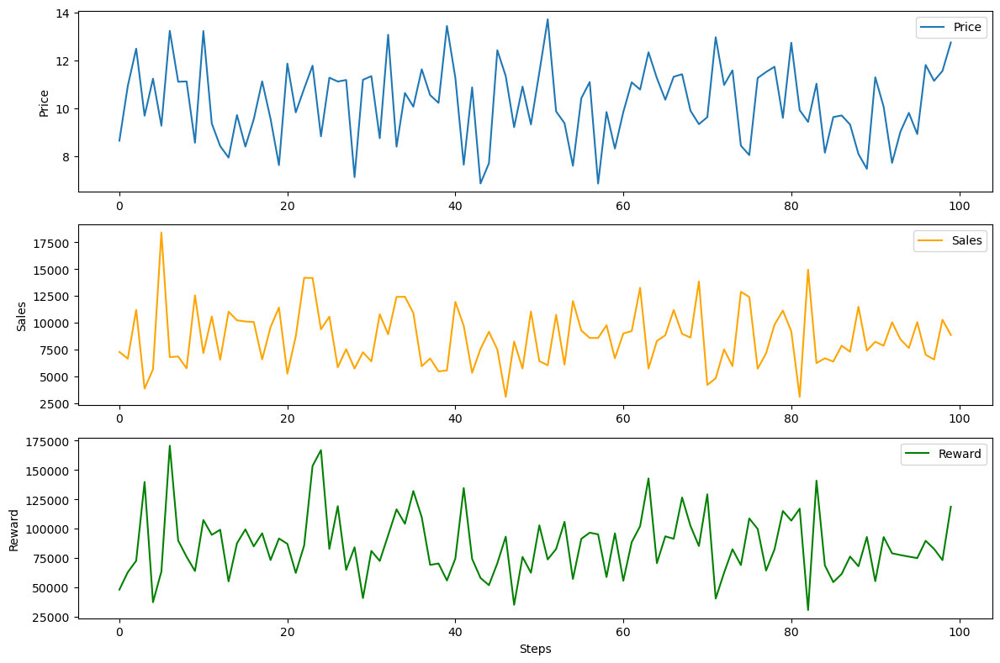

In [44]:
prices = []
sales = []
rewards = []
obs = train_env.reset()
for step in range(100):
    action, _states = model.predict(obs, deterministic=True) 
    obs, reward, done, info = train_env.step(action) 
    prices.append(obs[0])
    sales.append(obs[1]) 
    rewards.append(reward)

    if done:
        break
plt.figure(figsize=(12, 8))

plt.subplot(3, 1, 1)
plt.plot(prices, label='Price')
plt.ylabel('Price')
plt.legend()

plt.subplot(3, 1, 2)
plt.plot(sales, label='Sales', color='orange')
plt.ylabel('Sales')
plt.legend()

plt.subplot(3, 1, 3)
plt.plot(rewards, label='Reward', color='green')
plt.xlabel('Steps')
plt.ylabel('Reward')
plt.legend()

plt.tight_layout()
plt.show()

In [45]:
import numpy as np
from stable_baselines3.common.evaluation import evaluate_policy

In [46]:
mean_reward, std_reward = evaluate_policy(model, train_env, n_eval_episodes=3)
print(f"Trained Agent - Mean reward: {mean_reward}, Std reward: {std_reward}")

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 0, Price: 9.13, Sales: 5263.00
Step: 1, Price: 8.64, Sales: 7276.80
Step: 2, Price: 10.93, Sales: 6651.20
Step: 3, Price: 12.49, Sales: 11196.00
Step: 4, Price: 9.68, Sales: 3857.60
Step: 5, Price: 11.23, Sales: 5651.00
Step: 6, Price: 9.27, Sales: 18412.80
Step: 7, Price: 13.23, Sales: 6793.60
Step: 8, Price: 11.10, Sales: 6852.00
Step: 9, Price: 11.12, Sales: 5748.00
Step: 10, Price: 8.56, Sales: 12548.40
Step: 11, Price: 13.22, Sales: 7167.20
Step: 12, Price: 9.36, Sales: 10585.20
Step: 13, Price: 8.42, Sales: 6544.00
Step: 14, Price: 7.94, Sales: 11029.20
Step: 15, Price: 9.72, Sales: 10231.00
Step: 16, Price: 8.40, Sales: 10116.00
Step: 17, Price: 9.54, Sales: 10071.00
Step: 18, Price: 11.12, Sales: 6587.20
Step: 19, Price: 9.55, Sales: 9593.00
Step: 20, Price: 7.63, Sales: 11418.00
Step: 21, Price: 11.86, Sales: 5252.80
Step: 22, Price: 9.83, Sales: 8727.60
Step: 23, Price: 10.82, Sales: 14190.00
Step: 24, Price: 11.78, Sales: 14180.00
Step: 25, Price: 8.83, Sales: 9381.60


Step: 257, Price: 7.92, Sales: 8115.60
Step: 258, Price: 8.53, Sales: 14096.00
Step: 259, Price: 9.30, Sales: 8218.80
Step: 260, Price: 9.60, Sales: 13470.00
Step: 261, Price: 6.90, Sales: 30928.80
Step: 262, Price: 8.50, Sales: 5216.00
Step: 263, Price: 8.47, Sales: 8303.00
Step: 264, Price: 11.15, Sales: 6001.60
Step: 265, Price: 8.53, Sales: 4779.00
Step: 266, Price: 10.37, Sales: 11326.00
Step: 267, Price: 11.41, Sales: 5993.60
Step: 268, Price: 7.38, Sales: 14636.40
Step: 269, Price: 9.10, Sales: 13971.60
Step: 270, Price: 8.13, Sales: 12124.80
Step: 271, Price: 11.67, Sales: 7287.20
Step: 272, Price: 9.36, Sales: 7351.20
Step: 273, Price: 10.47, Sales: 6975.00
Step: 274, Price: 8.39, Sales: 8573.00
Step: 275, Price: 9.86, Sales: 4217.60
Step: 276, Price: 9.97, Sales: 9262.00
Step: 277, Price: 8.75, Sales: 9966.00
Step: 278, Price: 8.80, Sales: 12709.00
Step: 279, Price: 10.51, Sales: 8189.00
Step: 280, Price: 11.68, Sales: 8053.00
Step: 281, Price: 10.76, Sales: 4761.00
Step: 282

Step: 498, Price: 13.32, Sales: 5891.20
Step: 499, Price: 10.78, Sales: 5300.80
Step: 500, Price: 8.46, Sales: 18567.60
Step: 501, Price: 13.22, Sales: 7723.20
Step: 502, Price: 13.60, Sales: 8543.20
Step: 503, Price: 12.87, Sales: 5669.60
Step: 504, Price: 10.75, Sales: 11162.00
Step: 505, Price: 9.53, Sales: 8564.80
Step: 506, Price: 12.73, Sales: 8960.80
Step: 507, Price: 8.39, Sales: 8130.00
Step: 508, Price: 12.99, Sales: 9229.60
Step: 509, Price: 10.34, Sales: 5900.80
Step: 510, Price: 12.26, Sales: 6838.40
Step: 511, Price: 11.64, Sales: 19959.00
Step: 512, Price: 13.22, Sales: 6054.40
Step: 513, Price: 12.36, Sales: 10258.40
Step: 514, Price: 8.94, Sales: 7303.00
Step: 515, Price: 9.34, Sales: 7755.00
Step: 516, Price: 12.13, Sales: 6421.60
Step: 517, Price: 11.45, Sales: 6540.00
Step: 518, Price: 10.02, Sales: 5170.00
Step: 519, Price: 11.87, Sales: 6672.00
Step: 520, Price: 9.50, Sales: 11473.00
Step: 521, Price: 10.00, Sales: 15349.00
Step: 522, Price: 11.03, Sales: 9572.80


Step: 745, Price: 11.90, Sales: 8566.40
Step: 746, Price: 10.96, Sales: 5984.80
Step: 747, Price: 9.30, Sales: 5289.60
Step: 748, Price: 9.20, Sales: 5116.00
Step: 749, Price: 7.23, Sales: 5812.80
Step: 750, Price: 10.75, Sales: 6210.40
Step: 751, Price: 13.12, Sales: 7442.40
Step: 752, Price: 9.48, Sales: 10704.00
Step: 753, Price: 10.59, Sales: 9940.80
Step: 754, Price: 10.92, Sales: 20224.00
Step: 755, Price: 10.04, Sales: 7474.40
Step: 756, Price: 9.45, Sales: 7476.00
Step: 757, Price: 8.34, Sales: 11253.00
Step: 758, Price: 10.87, Sales: 6680.00
Step: 759, Price: 12.07, Sales: 10208.80
Step: 760, Price: 12.17, Sales: 5317.60
Step: 761, Price: 12.65, Sales: 6417.60
Step: 762, Price: 12.10, Sales: 4698.40
Step: 763, Price: 10.94, Sales: 9343.20
Step: 764, Price: 8.74, Sales: 8537.00
Step: 765, Price: 12.17, Sales: 6843.20
Step: 766, Price: 7.52, Sales: 23128.80
Step: 767, Price: 11.06, Sales: 10990.40
Step: 768, Price: 10.70, Sales: 5192.00
Step: 769, Price: 10.61, Sales: 6844.80
St

Step: 1029, Price: 8.11, Sales: 15362.40
Step: 1030, Price: 9.58, Sales: 21997.20
Step: 1031, Price: 9.52, Sales: 8674.80
Step: 1032, Price: 7.49, Sales: 7023.60
Step: 1033, Price: 8.06, Sales: 7933.20
Step: 1034, Price: 6.93, Sales: 11194.80
Step: 1035, Price: 10.20, Sales: 7978.80
Step: 1036, Price: 8.67, Sales: 11374.80
Step: 1037, Price: 8.73, Sales: 12638.40
Step: 1038, Price: 8.70, Sales: 8655.60
Step: 1039, Price: 9.92, Sales: 8348.40
Step: 1040, Price: 7.84, Sales: 12484.80
Step: 1041, Price: 6.96, Sales: 9672.00
Step: 1042, Price: 7.36, Sales: 14659.20
Step: 1043, Price: 9.58, Sales: 15069.60
Step: 1044, Price: 9.05, Sales: 10453.20
Step: 1045, Price: 12.48, Sales: 8245.60
Step: 1046, Price: 11.01, Sales: 4108.00
Step: 1047, Price: 9.30, Sales: 11691.60
Step: 1048, Price: 9.79, Sales: 13449.60
Step: 1049, Price: 7.24, Sales: 12410.40
Step: 1050, Price: 8.72, Sales: 13723.20
Step: 1051, Price: 9.63, Sales: 10701.60
Step: 1052, Price: 9.27, Sales: 12108.00
Step: 1053, Price: 8.9

Step: 1299, Price: 9.99, Sales: 6673.00
Step: 1300, Price: 7.47, Sales: 9156.00
Step: 1301, Price: 10.31, Sales: 7365.60
Step: 1302, Price: 10.07, Sales: 10894.80
Step: 1303, Price: 9.21, Sales: 9037.20
Step: 1304, Price: 7.52, Sales: 18744.00
Step: 1305, Price: 8.56, Sales: 7545.60
Step: 1306, Price: 8.53, Sales: 7903.20
Step: 1307, Price: 7.23, Sales: 13099.20
Step: 1308, Price: 7.42, Sales: 6344.40
Step: 1309, Price: 7.18, Sales: 9458.40
Step: 1310, Price: 9.09, Sales: 3853.20
Step: 1311, Price: 7.12, Sales: 11269.20
Step: 1312, Price: 7.26, Sales: 8523.60
Step: 1313, Price: 7.31, Sales: 7218.00
Step: 1314, Price: 9.86, Sales: 8791.20
Step: 1315, Price: 8.63, Sales: 8595.60
Step: 1316, Price: 10.11, Sales: 7196.40
Step: 1317, Price: 7.24, Sales: 8361.60
Step: 1318, Price: 9.43, Sales: 10375.20
Step: 1319, Price: 7.81, Sales: 13179.60
Step: 1320, Price: 7.26, Sales: 4143.60
Step: 1321, Price: 9.53, Sales: 9772.80
Step: 1322, Price: 9.46, Sales: 5205.60
Step: 1323, Price: 8.26, Sales:

Step: 1566, Price: 7.91, Sales: 11246.40
Step: 1567, Price: 9.12, Sales: 8677.20
Step: 1568, Price: 7.40, Sales: 7620.00
Step: 1569, Price: 8.48, Sales: 9037.20
Step: 1570, Price: 8.07, Sales: 13016.40
Step: 1571, Price: 9.40, Sales: 5366.40
Step: 1572, Price: 9.41, Sales: 5858.40
Step: 1573, Price: 7.17, Sales: 6310.80
Step: 1574, Price: 8.93, Sales: 7281.60
Step: 1575, Price: 7.21, Sales: 13143.60
Step: 1576, Price: 11.07, Sales: 7261.60
Step: 1577, Price: 9.16, Sales: 10642.80
Step: 1578, Price: 8.19, Sales: 17403.60
Step: 1579, Price: 8.12, Sales: 11349.60
Step: 1580, Price: 7.75, Sales: 15412.80
Step: 1581, Price: 7.71, Sales: 15091.20
Step: 1582, Price: 7.54, Sales: 9742.80
Step: 1583, Price: 8.73, Sales: 7537.20
Step: 1584, Price: 8.21, Sales: 5005.20
Step: 1585, Price: 9.11, Sales: 9505.20
Step: 1586, Price: 8.26, Sales: 6976.80
Step: 1587, Price: 11.30, Sales: 7205.00
Step: 1588, Price: 8.69, Sales: 8119.20
Step: 1589, Price: 9.87, Sales: 9582.00
Step: 1590, Price: 8.56, Sales

Step: 1807, Price: 7.75, Sales: 11739.60
Step: 1808, Price: 8.12, Sales: 13772.40
Step: 1809, Price: 9.12, Sales: 18955.20
Step: 1810, Price: 8.74, Sales: 11497.20
Step: 1811, Price: 9.32, Sales: 6621.60
Step: 1812, Price: 7.49, Sales: 9146.40
Step: 1813, Price: 7.12, Sales: 7276.80
Step: 1814, Price: 10.81, Sales: 2897.00
Step: 1815, Price: 8.63, Sales: 12790.80
Step: 1816, Price: 7.64, Sales: 10929.60
Step: 1817, Price: 9.34, Sales: 8546.40
Step: 1818, Price: 7.42, Sales: 12112.80
Step: 1819, Price: 9.14, Sales: 7909.20
Step: 1820, Price: 8.30, Sales: 12158.40
Step: 1821, Price: 8.35, Sales: 6884.40
Step: 1822, Price: 8.52, Sales: 8596.80
Step: 1823, Price: 6.94, Sales: 9121.20
Step: 1824, Price: 9.15, Sales: 11857.20
Step: 1825, Price: 9.24, Sales: 7496.40
Step: 1826, Price: 7.25, Sales: 9427.20
Step: 1827, Price: 7.73, Sales: 8031.60
Step: 1828, Price: 7.63, Sales: 6775.20
Step: 1829, Price: 8.60, Sales: 10923.60
Step: 1830, Price: 7.04, Sales: 8113.20
Step: 1831, Price: 9.07, Sale

Step: 2069, Price: 11.14, Sales: 8117.00
Step: 2070, Price: 11.72, Sales: 8959.00
Step: 2071, Price: 10.72, Sales: 7241.00
Step: 2072, Price: 9.58, Sales: 7332.00
Step: 2073, Price: 9.88, Sales: 14728.00
Step: 2074, Price: 8.30, Sales: 12407.00
Step: 2075, Price: 10.66, Sales: 9098.00
Step: 2076, Price: 9.28, Sales: 4733.00
Step: 2077, Price: 11.82, Sales: 9761.00
Step: 2078, Price: 10.22, Sales: 7794.00
Step: 2079, Price: 9.23, Sales: 4464.00
Step: 2080, Price: 10.89, Sales: 3110.00
Step: 2081, Price: 8.91, Sales: 10337.00
Step: 2082, Price: 9.09, Sales: 4327.00
Step: 2083, Price: 9.40, Sales: 7032.00
Step: 2084, Price: 11.25, Sales: 14235.00
Step: 2085, Price: 8.17, Sales: 8483.00
Step: 2086, Price: 9.11, Sales: 7347.00
Step: 2087, Price: 10.43, Sales: 5389.00
Step: 2088, Price: 11.48, Sales: 7265.00
Step: 2089, Price: 9.99, Sales: 7147.00
Step: 2090, Price: 8.37, Sales: 6995.00
Step: 2091, Price: 8.64, Sales: 8286.00
Step: 2092, Price: 8.04, Sales: 9593.00
Step: 2093, Price: 10.62, 

Step: 2319, Price: 9.66, Sales: 7718.00
Step: 2320, Price: 8.31, Sales: 7776.00
Step: 2321, Price: 10.19, Sales: 7216.00
Step: 2322, Price: 11.63, Sales: 7446.00
Step: 2323, Price: 9.82, Sales: 5431.00
Step: 2324, Price: 10.47, Sales: 7123.00
Step: 2325, Price: 9.71, Sales: 9512.00
Step: 2326, Price: 9.83, Sales: 8527.00
Step: 2327, Price: 10.30, Sales: 7126.00
Step: 2328, Price: 11.77, Sales: 4565.00
Step: 2329, Price: 9.55, Sales: 9870.00
Step: 2330, Price: 8.11, Sales: 6896.00
Step: 2331, Price: 8.51, Sales: 9141.00
Step: 2332, Price: 8.07, Sales: 7017.00
Step: 2333, Price: 9.51, Sales: 13273.00
Step: 2334, Price: 8.48, Sales: 6335.00
Step: 2335, Price: 8.02, Sales: 6045.00
Step: 2336, Price: 10.12, Sales: 8068.00
Step: 2337, Price: 8.71, Sales: 8338.80
Step: 2338, Price: 7.33, Sales: 7729.20
Step: 2339, Price: 8.14, Sales: 5812.00
Step: 2340, Price: 9.18, Sales: 8992.00
Step: 2341, Price: 11.97, Sales: 7326.00
Step: 2342, Price: 10.20, Sales: 3444.00
Step: 2343, Price: 8.97, Sales:

Step: 2576, Price: 8.47, Sales: 7900.80
Step: 2577, Price: 9.45, Sales: 7453.20
Step: 2578, Price: 7.19, Sales: 9200.40
Step: 2579, Price: 7.51, Sales: 11148.00
Step: 2580, Price: 7.64, Sales: 8204.40
Step: 2581, Price: 9.88, Sales: 9861.60
Step: 2582, Price: 7.60, Sales: 12391.20
Step: 2583, Price: 9.04, Sales: 7860.00
Step: 2584, Price: 9.50, Sales: 9565.20
Step: 2585, Price: 9.92, Sales: 8911.20
Step: 2586, Price: 9.26, Sales: 12229.20
Step: 2587, Price: 9.73, Sales: 8631.60
Step: 2588, Price: 9.66, Sales: 7500.00
Step: 2589, Price: 8.32, Sales: 8808.00
Step: 2590, Price: 8.15, Sales: 7620.00
Step: 2591, Price: 9.89, Sales: 5890.00
Step: 2592, Price: 9.77, Sales: 16408.80
Step: 2593, Price: 9.28, Sales: 9012.00
Step: 2594, Price: 9.69, Sales: 8574.00
Step: 2595, Price: 8.13, Sales: 9952.80
Step: 2596, Price: 6.98, Sales: 12056.40
Step: 2597, Price: 7.03, Sales: 5871.60
Step: 2598, Price: 9.72, Sales: 9765.60
Step: 2599, Price: 8.78, Sales: 12789.60
Step: 2600, Price: 6.95, Sales: 11

Step: 2819, Price: 7.74, Sales: 16720.80
Step: 2820, Price: 7.37, Sales: 6490.80
Step: 2821, Price: 8.87, Sales: 7304.40
Step: 2822, Price: 9.48, Sales: 7038.00
Step: 2823, Price: 7.37, Sales: 10825.20
Step: 2824, Price: 7.30, Sales: 10588.80
Step: 2825, Price: 9.11, Sales: 5395.20
Step: 2826, Price: 7.26, Sales: 8034.00
Step: 2827, Price: 7.50, Sales: 10128.00
Step: 2828, Price: 7.40, Sales: 10040.40
Step: 2829, Price: 11.22, Sales: 8413.00
Step: 2830, Price: 7.88, Sales: 7605.60
Step: 2831, Price: 9.46, Sales: 5110.80
Step: 2832, Price: 9.02, Sales: 13639.20
Step: 2833, Price: 9.70, Sales: 5660.40
Step: 2834, Price: 10.65, Sales: 4465.00
Step: 2835, Price: 8.88, Sales: 8143.20
Step: 2836, Price: 7.67, Sales: 9589.20
Step: 2837, Price: 7.06, Sales: 7878.00
Step: 2838, Price: 9.80, Sales: 8883.60
Step: 2839, Price: 7.61, Sales: 13412.40
Step: 2840, Price: 7.24, Sales: 9052.80
Step: 2841, Price: 7.71, Sales: 9270.00
Step: 2842, Price: 8.71, Sales: 9627.60
Step: 2843, Price: 9.59, Sales:

Step: 3051, Price: 7.28, Sales: 18354.00
Step: 3052, Price: 6.83, Sales: 7060.80
Step: 3053, Price: 6.97, Sales: 7762.80
Step: 3054, Price: 9.94, Sales: 9674.40
Step: 3055, Price: 7.32, Sales: 17442.00
Step: 3056, Price: 9.24, Sales: 9718.80
Step: 3057, Price: 8.83, Sales: 7227.60
Step: 3058, Price: 7.02, Sales: 7753.20
Step: 3059, Price: 10.01, Sales: 6392.40
Step: 3060, Price: 10.11, Sales: 8725.20
Step: 3061, Price: 9.28, Sales: 4894.80
Step: 3062, Price: 7.96, Sales: 11378.40
Step: 3063, Price: 9.10, Sales: 5539.20
Step: 3064, Price: 7.13, Sales: 9057.60
Step: 3065, Price: 7.90, Sales: 3523.20
Step: 3066, Price: 7.72, Sales: 26628.00
Step: 3067, Price: 7.37, Sales: 10476.00
Step: 3068, Price: 8.85, Sales: 5964.00
Step: 3069, Price: 7.52, Sales: 6375.60
Step: 3070, Price: 8.98, Sales: 12082.80
Step: 3071, Price: 7.62, Sales: 9028.80
Step: 3072, Price: 8.39, Sales: 11667.60
Step: 3073, Price: 7.83, Sales: 11402.40
Step: 3074, Price: 8.26, Sales: 7077.60
Step: 3075, Price: 9.97, Sales

Step: 3293, Price: 8.83, Sales: 10436.40
Step: 3294, Price: 10.09, Sales: 6936.00
Step: 3295, Price: 8.09, Sales: 9324.00
Step: 3296, Price: 7.00, Sales: 7833.60
Step: 3297, Price: 6.94, Sales: 6716.40
Step: 3298, Price: 6.83, Sales: 13916.40
Step: 3299, Price: 9.32, Sales: 3786.00
Step: 3300, Price: 9.54, Sales: 5347.20
Step: 3301, Price: 8.95, Sales: 11985.60
Step: 3302, Price: 7.22, Sales: 10918.80
Step: 3303, Price: 9.51, Sales: 13956.00
Step: 3304, Price: 8.45, Sales: 9248.40
Step: 3305, Price: 9.41, Sales: 8611.20
Step: 3306, Price: 8.07, Sales: 8406.00
Step: 3307, Price: 8.89, Sales: 7969.20
Step: 3308, Price: 8.40, Sales: 9100.80
Step: 3309, Price: 9.06, Sales: 7994.40
Step: 3310, Price: 7.97, Sales: 7016.40
Step: 3311, Price: 9.38, Sales: 6568.80
Step: 3312, Price: 7.79, Sales: 12165.60
Step: 3313, Price: 7.42, Sales: 9370.80
Step: 3314, Price: 8.57, Sales: 11632.80
Step: 3315, Price: 7.14, Sales: 17397.60
Step: 3316, Price: 7.54, Sales: 11002.80
Step: 3317, Price: 9.80, Sales

Step: 3516, Price: 9.60, Sales: 13428.00
Step: 3517, Price: 8.25, Sales: 9848.40
Step: 3518, Price: 9.46, Sales: 9145.20
Step: 3519, Price: 9.77, Sales: 9862.80
Step: 3520, Price: 9.20, Sales: 7125.60
Step: 3521, Price: 7.21, Sales: 7473.60
Step: 3522, Price: 7.75, Sales: 8512.80
Step: 3523, Price: 8.69, Sales: 9202.80
Step: 3524, Price: 8.73, Sales: 6068.40
Step: 3525, Price: 6.87, Sales: 9399.60
Step: 3526, Price: 7.76, Sales: 9274.80
Step: 3527, Price: 10.00, Sales: 12074.40
Step: 3528, Price: 8.56, Sales: 12163.20
Step: 3529, Price: 8.90, Sales: 9490.80
Step: 3530, Price: 9.49, Sales: 18163.20
Step: 3531, Price: 6.99, Sales: 9445.20
Step: 3532, Price: 8.17, Sales: 6680.40
Step: 3533, Price: 7.87, Sales: 14016.00
Step: 3534, Price: 7.69, Sales: 6730.80
Step: 3535, Price: 8.47, Sales: 7987.20
Step: 3536, Price: 7.87, Sales: 5516.40
Step: 3537, Price: 8.52, Sales: 12294.00
Step: 3538, Price: 7.05, Sales: 8958.00
Step: 3539, Price: 8.07, Sales: 6682.80
Step: 3540, Price: 12.87, Sales: 

Step: 3738, Price: 8.25, Sales: 9696.00
Step: 3739, Price: 11.06, Sales: 7798.00
Step: 3740, Price: 8.76, Sales: 8546.00
Step: 3741, Price: 9.41, Sales: 6700.00
Step: 3742, Price: 11.12, Sales: 6433.00
Step: 3743, Price: 10.53, Sales: 7878.00
Step: 3744, Price: 9.22, Sales: 4977.00
Step: 3745, Price: 8.68, Sales: 6338.00
Step: 3746, Price: 9.06, Sales: 7925.00
Step: 3747, Price: 9.30, Sales: 8175.00
Step: 3748, Price: 9.26, Sales: 10899.00
Step: 3749, Price: 11.03, Sales: 11699.00
Step: 3750, Price: 8.20, Sales: 9334.00
Step: 3751, Price: 9.73, Sales: 7052.00
Step: 3752, Price: 11.56, Sales: 7031.00
Step: 3753, Price: 11.40, Sales: 12498.00
Step: 3754, Price: 10.51, Sales: 8808.00
Step: 3755, Price: 11.38, Sales: 6205.00
Step: 3756, Price: 9.21, Sales: 5226.00
Step: 3757, Price: 10.80, Sales: 6268.00
Step: 3758, Price: 8.10, Sales: 12917.00
Step: 3759, Price: 8.58, Sales: 4230.00
Step: 3760, Price: 9.09, Sales: 10633.00
Step: 3761, Price: 9.57, Sales: 6272.00
Step: 3762, Price: 8.19, S

Step: 3973, Price: 7.97, Sales: 11606.40
Step: 3974, Price: 9.10, Sales: 14191.20
Step: 3975, Price: 9.11, Sales: 8358.00
Step: 3976, Price: 8.80, Sales: 6188.40
Step: 3977, Price: 8.71, Sales: 14734.80
Step: 3978, Price: 10.05, Sales: 7525.20
Step: 3979, Price: 6.81, Sales: 4293.60
Step: 3980, Price: 7.17, Sales: 10566.00
Step: 3981, Price: 8.35, Sales: 12715.20
Step: 3982, Price: 9.54, Sales: 18584.40
Step: 3983, Price: 9.63, Sales: 7221.60
Step: 3984, Price: 7.67, Sales: 7825.20
Step: 3985, Price: 9.00, Sales: 8072.40
Step: 3986, Price: 6.93, Sales: 4947.60
Step: 3987, Price: 6.92, Sales: 8918.40
Step: 3988, Price: 9.54, Sales: 9664.80
Step: 3989, Price: 8.74, Sales: 10024.80
Step: 3990, Price: 8.34, Sales: 8688.00
Step: 3991, Price: 7.11, Sales: 11253.60
Step: 3992, Price: 9.81, Sales: 11694.00
Step: 3993, Price: 6.84, Sales: 4822.80
Step: 3994, Price: 7.59, Sales: 7497.60
Step: 3995, Price: 8.04, Sales: 7398.00
Step: 3996, Price: 10.18, Sales: 7509.60
Step: 3997, Price: 10.05, Sal

Step: 4206, Price: 8.23, Sales: 9253.20
Step: 4207, Price: 7.27, Sales: 9164.40
Step: 4208, Price: 9.82, Sales: 8876.40
Step: 4209, Price: 7.15, Sales: 9541.20
Step: 4210, Price: 7.49, Sales: 4896.00
Step: 4211, Price: 7.49, Sales: 6067.20
Step: 4212, Price: 7.26, Sales: 7252.80
Step: 4213, Price: 8.55, Sales: 9072.00
Step: 4214, Price: 9.19, Sales: 11894.40
Step: 4215, Price: 7.32, Sales: 6384.00
Step: 4216, Price: 7.55, Sales: 13580.40
Step: 4217, Price: 9.54, Sales: 5558.40
Step: 4218, Price: 9.19, Sales: 8475.60
Step: 4219, Price: 7.75, Sales: 5691.60
Step: 4220, Price: 8.08, Sales: 10032.00
Step: 4221, Price: 7.81, Sales: 6840.00
Step: 4222, Price: 9.78, Sales: 9104.40
Step: 4223, Price: 7.38, Sales: 10846.80
Step: 4224, Price: 6.97, Sales: 10122.00
Step: 4225, Price: 7.71, Sales: 5931.60
Step: 4226, Price: 7.60, Sales: 8660.40
Step: 4227, Price: 7.49, Sales: 9196.80
Step: 4228, Price: 9.67, Sales: 11427.60
Step: 4229, Price: 9.76, Sales: 8587.20
Step: 4230, Price: 9.96, Sales: 11

Step: 4429, Price: 9.23, Sales: 11545.20
Step: 4430, Price: 6.95, Sales: 6664.80
Step: 4431, Price: 10.13, Sales: 6292.80
Step: 4432, Price: 9.40, Sales: 8253.60
Step: 4433, Price: 7.82, Sales: 12270.00
Step: 4434, Price: 8.99, Sales: 6774.00
Step: 4435, Price: 8.53, Sales: 11796.00
Step: 4436, Price: 7.76, Sales: 8295.60
Step: 4437, Price: 9.36, Sales: 13441.20
Step: 4438, Price: 8.05, Sales: 9764.40
Step: 4439, Price: 7.26, Sales: 9619.20
Step: 4440, Price: 6.82, Sales: 7360.80
Step: 4441, Price: 8.76, Sales: 7190.40
Step: 4442, Price: 7.98, Sales: 7244.40
Step: 4443, Price: 8.13, Sales: 11439.60
Step: 4444, Price: 8.28, Sales: 9853.20
Step: 4445, Price: 10.13, Sales: 7773.60
Step: 4446, Price: 7.60, Sales: 6338.40
Step: 4447, Price: 8.51, Sales: 8151.60
Step: 4448, Price: 8.07, Sales: 11499.60
Step: 4449, Price: 8.65, Sales: 7761.60
Step: 4450, Price: 7.56, Sales: 30621.60
Step: 4451, Price: 7.80, Sales: 9711.60
Step: 4452, Price: 6.81, Sales: 7322.40
Step: 4453, Price: 9.79, Sales:

Step: 4660, Price: 9.36, Sales: 12768.00
Step: 4661, Price: 6.93, Sales: 4618.80
Step: 4662, Price: 7.17, Sales: 24015.60
Step: 4663, Price: 7.38, Sales: 6969.60
Step: 4664, Price: 9.96, Sales: 15123.60
Step: 4665, Price: 7.62, Sales: 14664.00
Step: 4666, Price: 8.62, Sales: 11835.60
Step: 4667, Price: 8.70, Sales: 10950.00
Step: 4668, Price: 7.70, Sales: 7477.20
Step: 4669, Price: 8.42, Sales: 8125.20
Step: 4670, Price: 9.42, Sales: 4844.40
Step: 4671, Price: 8.77, Sales: 7051.20
Step: 4672, Price: 9.67, Sales: 8831.00
Step: 4673, Price: 11.83, Sales: 6878.00
Step: 4674, Price: 11.44, Sales: 10376.00
Step: 4675, Price: 8.86, Sales: 11346.00
Step: 4676, Price: 8.10, Sales: 8490.00
Step: 4677, Price: 11.57, Sales: 9360.00
Step: 4678, Price: 10.78, Sales: 7964.00
Step: 4679, Price: 12.85, Sales: 8244.80
Step: 4680, Price: 8.04, Sales: 12763.00
Step: 4681, Price: 8.35, Sales: 8526.00
Step: 4682, Price: 11.69, Sales: 7885.00
Step: 4683, Price: 11.38, Sales: 5436.00
Step: 4684, Price: 10.30

Step: 4893, Price: 6.94, Sales: 9560.40
Step: 4894, Price: 9.13, Sales: 17871.60
Step: 4895, Price: 7.02, Sales: 11617.20
Step: 4896, Price: 8.75, Sales: 8574.00
Step: 4897, Price: 9.73, Sales: 7118.40
Step: 4898, Price: 8.33, Sales: 13563.60
Step: 4899, Price: 8.58, Sales: 18069.60
Step: 4900, Price: 7.67, Sales: 16272.00
Step: 4901, Price: 9.48, Sales: 8875.20
Step: 4902, Price: 7.03, Sales: 9457.20
Step: 4903, Price: 9.95, Sales: 19791.60
Step: 4904, Price: 9.96, Sales: 11246.40
Step: 4905, Price: 8.50, Sales: 10806.00
Step: 4906, Price: 8.00, Sales: 8796.00
Step: 4907, Price: 9.66, Sales: 8936.40
Step: 4908, Price: 9.81, Sales: 12727.20
Step: 4909, Price: 7.41, Sales: 16818.00
Step: 4910, Price: 9.27, Sales: 8638.80
Step: 4911, Price: 10.00, Sales: 8480.40
Step: 4912, Price: 9.91, Sales: 7987.20
Step: 4913, Price: 7.79, Sales: 8703.60
Step: 4914, Price: 6.88, Sales: 15459.60
Step: 4915, Price: 7.84, Sales: 14643.60
Step: 4916, Price: 10.08, Sales: 10752.00
Step: 4917, Price: 7.42, 

Step: 5117, Price: 10.10, Sales: 16411.20
Step: 5118, Price: 9.16, Sales: 14648.40
Step: 5119, Price: 9.91, Sales: 7360.80
Step: 5120, Price: 8.86, Sales: 11931.60
Step: 5121, Price: 7.00, Sales: 11738.40
Step: 5122, Price: 7.70, Sales: 11984.40
Step: 5123, Price: 9.64, Sales: 14529.60
Step: 5124, Price: 8.03, Sales: 11424.00
Step: 5125, Price: 8.21, Sales: 5782.80
Step: 5126, Price: 8.30, Sales: 10528.80
Step: 5127, Price: 8.35, Sales: 11938.80
Step: 5128, Price: 7.62, Sales: 11353.20
Step: 5129, Price: 7.05, Sales: 15696.00
Step: 5130, Price: 8.70, Sales: 8679.60
Step: 5131, Price: 8.33, Sales: 5972.40
Step: 5132, Price: 8.72, Sales: 17666.40
Step: 5133, Price: 9.52, Sales: 12493.20
Step: 5134, Price: 8.15, Sales: 16197.60
Step: 5135, Price: 10.18, Sales: 10410.00
Step: 5136, Price: 7.62, Sales: 11882.40
Step: 5137, Price: 9.56, Sales: 14421.60
Step: 5138, Price: 9.09, Sales: 6313.20
Step: 5139, Price: 6.91, Sales: 12532.80
Step: 5140, Price: 8.23, Sales: 8128.80
Step: 5141, Price: 9

Step: 5329, Price: 10.04, Sales: 13880.40
Step: 5330, Price: 8.68, Sales: 5466.00
Step: 5331, Price: 7.78, Sales: 9093.60
Step: 5332, Price: 8.80, Sales: 6903.60
Step: 5333, Price: 7.61, Sales: 11334.00
Step: 5334, Price: 8.34, Sales: 7700.40
Step: 5335, Price: 8.72, Sales: 10591.20
Step: 5336, Price: 7.33, Sales: 12120.00
Step: 5337, Price: 6.87, Sales: 14763.60
Step: 5338, Price: 9.48, Sales: 7254.00
Step: 5339, Price: 7.98, Sales: 11218.80
Step: 5340, Price: 7.26, Sales: 10848.00
Step: 5341, Price: 9.40, Sales: 12648.00
Step: 5342, Price: 7.16, Sales: 9411.60
Step: 5343, Price: 8.93, Sales: 14564.40
Step: 5344, Price: 7.72, Sales: 18470.40
Step: 5345, Price: 7.69, Sales: 10749.60
Step: 5346, Price: 9.63, Sales: 4743.60
Step: 5347, Price: 9.63, Sales: 12420.00
Step: 5348, Price: 9.26, Sales: 9876.00
Step: 5349, Price: 8.92, Sales: 10869.60
Step: 5350, Price: 8.31, Sales: 11928.00
Step: 5351, Price: 8.23, Sales: 5762.40
Step: 5352, Price: 8.89, Sales: 19006.80
Step: 5353, Price: 8.77,

Step: 5562, Price: 8.46, Sales: 9098.40
Step: 5563, Price: 10.02, Sales: 32064.00
Step: 5564, Price: 7.68, Sales: 12854.40
Step: 5565, Price: 14.33, Sales: 13705.20
Step: 5566, Price: 12.97, Sales: 6927.60
Step: 5567, Price: 13.42, Sales: 4490.40
Step: 5568, Price: 12.96, Sales: 19197.60
Step: 5569, Price: 16.65, Sales: 39056.40
Step: 5570, Price: 16.53, Sales: 9300.00
Step: 5571, Price: 13.14, Sales: 5838.00
Step: 5572, Price: 14.85, Sales: 3790.80
Step: 5573, Price: 14.73, Sales: 9585.60
Step: 5574, Price: 16.02, Sales: 11745.60
Step: 5575, Price: 13.10, Sales: 19216.80
Step: 5576, Price: 14.00, Sales: 2571.60
Step: 5577, Price: 13.65, Sales: 8946.00
Step: 5578, Price: 14.36, Sales: 9364.80
Step: 5579, Price: 12.86, Sales: 9486.00
Step: 5580, Price: 13.55, Sales: 3027.60
Step: 5581, Price: 13.84, Sales: 7914.00
Step: 5582, Price: 14.93, Sales: 24372.00
Step: 5583, Price: 15.23, Sales: 8022.00
Step: 5584, Price: 14.77, Sales: 16759.20
Step: 5585, Price: 13.73, Sales: 8186.40
Step: 558

Step: 5879, Price: 13.29, Sales: 9594.00
Step: 5880, Price: 18.79, Sales: 5458.00
Step: 5881, Price: 13.32, Sales: 8428.80
Step: 5882, Price: 15.11, Sales: 1725.60
Step: 5883, Price: 13.72, Sales: 11871.60
Step: 5884, Price: 15.26, Sales: 6174.00
Step: 5885, Price: 15.57, Sales: 7488.00
Step: 5886, Price: 14.65, Sales: 3616.80
Step: 5887, Price: 15.45, Sales: 4958.40
Step: 5888, Price: 14.10, Sales: 4562.40
Step: 5889, Price: 15.26, Sales: 4770.00
Step: 5890, Price: 12.86, Sales: 7393.20
Step: 5891, Price: 16.65, Sales: 5742.00
Step: 5892, Price: 16.63, Sales: 6062.40
Step: 5893, Price: 16.95, Sales: 10141.20
Step: 5894, Price: 13.32, Sales: 13054.80
Step: 5895, Price: 15.51, Sales: 8178.00
Step: 5896, Price: 13.30, Sales: 4222.80
Step: 5897, Price: 14.04, Sales: 4994.40
Step: 5898, Price: 13.60, Sales: 4236.00
Step: 5899, Price: 13.84, Sales: 4947.60
Step: 5900, Price: 12.77, Sales: 7005.60
Step: 5901, Price: 13.64, Sales: 3472.80
Step: 5902, Price: 13.01, Sales: 1504.80
Step: 5903, P

Step: 6189, Price: 15.19, Sales: 2707.20
Step: 6190, Price: 13.65, Sales: 13906.80
Step: 6191, Price: 14.35, Sales: 5868.00
Step: 6192, Price: 13.85, Sales: 5512.80
Step: 6193, Price: 16.80, Sales: 6561.60
Step: 6194, Price: 15.55, Sales: 12157.20
Step: 6195, Price: 15.06, Sales: 7224.00
Step: 6196, Price: 15.61, Sales: 6327.60
Step: 6197, Price: 13.28, Sales: 5894.40
Step: 6198, Price: 12.76, Sales: 7441.20
Step: 6199, Price: 16.64, Sales: 7568.40
Step: 6200, Price: 16.19, Sales: 8829.60
Step: 6201, Price: 14.15, Sales: 4843.20
Step: 6202, Price: 14.47, Sales: 1220.40
Step: 6203, Price: 13.25, Sales: 4706.40
Step: 6204, Price: 16.62, Sales: 3176.40
Step: 6205, Price: 13.15, Sales: 2458.80
Step: 6206, Price: 13.74, Sales: 7917.60
Step: 6207, Price: 15.08, Sales: 8022.00
Step: 6208, Price: 14.89, Sales: 6614.40
Step: 6209, Price: 16.00, Sales: 6348.00
Step: 6210, Price: 14.46, Sales: 8947.20
Step: 6211, Price: 14.73, Sales: 5384.40
Step: 6212, Price: 16.92, Sales: 3364.80
Step: 6213, Pr

Step: 6442, Price: 19.94, Sales: 4935.00
Step: 6443, Price: 16.05, Sales: 5567.00
Step: 6444, Price: 17.87, Sales: 8204.00
Step: 6445, Price: 19.67, Sales: 4532.00
Step: 6446, Price: 16.68, Sales: 6395.00
Step: 6447, Price: 18.62, Sales: 2489.00
Step: 6448, Price: 17.51, Sales: 8191.00
Step: 6449, Price: 20.03, Sales: 4682.40
Step: 6450, Price: 19.65, Sales: 4401.00
Step: 6451, Price: 16.96, Sales: 6171.00
Step: 6452, Price: 15.24, Sales: 9984.00
Step: 6453, Price: 16.23, Sales: 4890.00
Step: 6454, Price: 18.29, Sales: 8808.00
Step: 6455, Price: 19.54, Sales: 6067.00
Step: 6456, Price: 16.91, Sales: 3084.00
Step: 6457, Price: 19.23, Sales: 4655.00
Step: 6458, Price: 15.36, Sales: 6087.00
Step: 6459, Price: 19.38, Sales: 2492.00
Step: 6460, Price: 19.17, Sales: 8697.00
Step: 6461, Price: 18.93, Sales: 6569.00
Step: 6462, Price: 15.59, Sales: 4841.00
Step: 6463, Price: 17.86, Sales: 9760.00
Step: 6464, Price: 16.97, Sales: 3453.00
Step: 6465, Price: 16.76, Sales: 4351.00
Step: 6466, Pric

Step: 6735, Price: 17.77, Sales: 6003.00
Step: 6736, Price: 19.06, Sales: 6382.00
Step: 6737, Price: 19.78, Sales: 3970.00
Step: 6738, Price: 16.76, Sales: 6419.00
Step: 6739, Price: 19.21, Sales: 2722.00
Step: 6740, Price: 16.98, Sales: 7027.20
Step: 6741, Price: 14.82, Sales: 4099.20
Step: 6742, Price: 15.90, Sales: 8146.80
Step: 6743, Price: 14.32, Sales: 7514.40
Step: 6744, Price: 14.62, Sales: 10322.40
Step: 6745, Price: 14.39, Sales: 11790.00
Step: 6746, Price: 14.43, Sales: 6656.40
Step: 6747, Price: 13.69, Sales: 5239.20
Step: 6748, Price: 16.34, Sales: 4137.60
Step: 6749, Price: 12.84, Sales: 4729.20
Step: 6750, Price: 16.35, Sales: 7245.60
Step: 6751, Price: 13.38, Sales: 10292.40
Step: 6752, Price: 15.23, Sales: 6664.80
Step: 6753, Price: 14.84, Sales: 5068.80
Step: 6754, Price: 16.09, Sales: 5887.20
Step: 6755, Price: 12.93, Sales: 5882.40
Step: 6756, Price: 14.45, Sales: 6718.80
Step: 6757, Price: 14.82, Sales: 3385.20
Step: 6758, Price: 13.36, Sales: 8638.80
Step: 6759, P

Step: 6957, Price: 16.50, Sales: 8258.40
Step: 6958, Price: 16.04, Sales: 5955.60
Step: 6959, Price: 13.04, Sales: 9081.60
Step: 6960, Price: 13.72, Sales: 17862.00
Step: 6961, Price: 15.73, Sales: 9369.60
Step: 6962, Price: 13.26, Sales: 4922.40
Step: 6963, Price: 16.94, Sales: 2944.80
Step: 6964, Price: 15.24, Sales: 6122.40
Step: 6965, Price: 14.28, Sales: 7060.80
Step: 6966, Price: 14.18, Sales: 4924.80
Step: 6967, Price: 15.83, Sales: 7839.60
Step: 6968, Price: 16.87, Sales: 11711.00
Step: 6969, Price: 16.20, Sales: 5322.00
Step: 6970, Price: 19.80, Sales: 8594.00
Step: 6971, Price: 19.16, Sales: 18985.00
Step: 6972, Price: 18.19, Sales: 3940.00
Step: 6973, Price: 16.53, Sales: 4748.00
Step: 6974, Price: 16.33, Sales: 5078.00
Step: 6975, Price: 19.72, Sales: 3716.00
Step: 6976, Price: 18.12, Sales: 7698.00
Step: 6977, Price: 16.13, Sales: 3775.00
Step: 6978, Price: 15.14, Sales: 5944.00
Step: 6979, Price: 19.91, Sales: 8210.00
Step: 6980, Price: 16.18, Sales: 5726.00
Step: 6981, P

Step: 7205, Price: 12.99, Sales: 10216.80
Step: 7206, Price: 13.86, Sales: 7462.80
Step: 7207, Price: 16.16, Sales: 6204.00
Step: 7208, Price: 14.29, Sales: 6842.40
Step: 7209, Price: 14.41, Sales: 4562.40
Step: 7210, Price: 13.85, Sales: 10852.80
Step: 7211, Price: 14.98, Sales: 7324.80
Step: 7212, Price: 15.55, Sales: 6225.60
Step: 7213, Price: 15.82, Sales: 3759.60
Step: 7214, Price: 15.79, Sales: 6496.80
Step: 7215, Price: 14.58, Sales: 8818.80
Step: 7216, Price: 14.67, Sales: 8022.00
Step: 7217, Price: 12.88, Sales: 6330.00
Step: 7218, Price: 15.93, Sales: 8566.80
Step: 7219, Price: 13.98, Sales: 7011.60
Step: 7220, Price: 13.71, Sales: 8120.40
Step: 7221, Price: 15.41, Sales: 17139.60
Step: 7222, Price: 13.57, Sales: 5894.40
Step: 7223, Price: 14.50, Sales: 9254.40
Step: 7224, Price: 14.86, Sales: 6159.60
Step: 7225, Price: 13.02, Sales: 6847.20
Step: 7226, Price: 12.77, Sales: 6572.40
Step: 7227, Price: 15.13, Sales: 5336.40
Step: 7228, Price: 19.61, Sales: 4422.00
Step: 7229, P

Step: 7419, Price: 17.00, Sales: 5804.40
Step: 7420, Price: 16.01, Sales: 7389.60
Step: 7421, Price: 14.15, Sales: 7014.00
Step: 7422, Price: 16.72, Sales: 5928.00
Step: 7423, Price: 15.46, Sales: 6819.60
Step: 7424, Price: 15.37, Sales: 6620.40
Step: 7425, Price: 14.39, Sales: 4251.60
Step: 7426, Price: 13.91, Sales: 7864.80
Step: 7427, Price: 13.17, Sales: 6297.60
Step: 7428, Price: 14.03, Sales: 6822.00
Step: 7429, Price: 15.19, Sales: 7654.80
Step: 7430, Price: 13.05, Sales: 7803.60
Step: 7431, Price: 15.12, Sales: 8704.80
Step: 7432, Price: 12.79, Sales: 6478.80
Step: 7433, Price: 15.84, Sales: 6578.40
Step: 7434, Price: 14.30, Sales: 10764.00
Step: 7435, Price: 16.14, Sales: 5047.20
Step: 7436, Price: 16.27, Sales: 4958.00
Step: 7437, Price: 13.58, Sales: 9836.40
Step: 7438, Price: 14.08, Sales: 7015.20
Step: 7439, Price: 15.85, Sales: 7813.20
Step: 7440, Price: 15.92, Sales: 9808.80
Step: 7441, Price: 14.40, Sales: 16850.40
Step: 7442, Price: 15.50, Sales: 4574.40
Step: 7443, Pr

Step: 7735, Price: 15.86, Sales: 4310.00
Step: 7736, Price: 16.74, Sales: 4954.00
Step: 7737, Price: 15.08, Sales: 3043.00
Step: 7738, Price: 16.24, Sales: 3765.00
Step: 7739, Price: 16.49, Sales: 8369.00
Step: 7740, Price: 18.92, Sales: 11407.00
Step: 7741, Price: 16.28, Sales: 5226.00
Step: 7742, Price: 15.35, Sales: 4108.00
Step: 7743, Price: 16.21, Sales: 4177.00
Step: 7744, Price: 15.82, Sales: 5292.00
Step: 7745, Price: 18.58, Sales: 4857.00
Step: 7746, Price: 18.11, Sales: 6375.00
Step: 7747, Price: 17.87, Sales: 6962.00
Step: 7748, Price: 15.15, Sales: 5281.00
Step: 7749, Price: 18.25, Sales: 3035.00
Step: 7750, Price: 18.09, Sales: 6555.00
Step: 7751, Price: 18.46, Sales: 4740.00
Step: 7752, Price: 18.26, Sales: 9082.00
Step: 7753, Price: 16.14, Sales: 7689.00
Step: 7754, Price: 16.65, Sales: 4727.00
Step: 7755, Price: 15.29, Sales: 6023.00
Step: 7756, Price: 15.89, Sales: 3052.00
Step: 7757, Price: 18.04, Sales: 6820.00
Step: 7758, Price: 15.54, Sales: 6492.00
Step: 7759, Pri

Step: 7999, Price: 18.38, Sales: 3050.00
Step: 8000, Price: 15.08, Sales: 9254.00
Step: 8001, Price: 17.56, Sales: 5068.00
Step: 8002, Price: 16.05, Sales: 6049.00
Step: 8003, Price: 18.95, Sales: 5290.00
Step: 8004, Price: 16.80, Sales: 5155.00
Step: 8005, Price: 18.83, Sales: 4979.00
Step: 8006, Price: 18.96, Sales: 5489.00
Step: 8007, Price: 16.34, Sales: 5231.00
Step: 8008, Price: 18.77, Sales: 3535.00
Step: 8009, Price: 18.58, Sales: 5244.00
Step: 8010, Price: 18.96, Sales: 4647.00
Step: 8011, Price: 19.21, Sales: 8031.00
Step: 8012, Price: 16.65, Sales: 6945.00
Step: 8013, Price: 17.01, Sales: 5930.00
Step: 8014, Price: 16.72, Sales: 10178.00
Step: 8015, Price: 15.58, Sales: 4060.00
Step: 8016, Price: 16.51, Sales: 4635.00
Step: 8017, Price: 18.70, Sales: 7893.00
Step: 8018, Price: 15.96, Sales: 4406.00
Step: 8019, Price: 17.12, Sales: 5327.00
Step: 8020, Price: 15.19, Sales: 2002.00
Step: 8021, Price: 15.47, Sales: 7303.00
Step: 8022, Price: 16.34, Sales: 6017.00
Step: 8023, Pri

Step: 8264, Price: 15.61, Sales: 4772.00
Step: 8265, Price: 16.43, Sales: 9854.00
Step: 8266, Price: 15.91, Sales: 7868.00
Step: 8267, Price: 17.38, Sales: 3981.00
Step: 8268, Price: 19.35, Sales: 4314.00
Step: 8269, Price: 17.78, Sales: 7436.00
Step: 8270, Price: 17.57, Sales: 9609.00
Step: 8271, Price: 17.49, Sales: 9251.00
Step: 8272, Price: 16.06, Sales: 4732.00
Step: 8273, Price: 15.38, Sales: 3873.00
Step: 8274, Price: 19.19, Sales: 13564.00
Step: 8275, Price: 18.44, Sales: 5067.00
Step: 8276, Price: 18.16, Sales: 7269.00
Step: 8277, Price: 18.27, Sales: 4579.00
Step: 8278, Price: 15.07, Sales: 4791.00
Step: 8279, Price: 15.19, Sales: 6832.00
Step: 8280, Price: 18.97, Sales: 7568.00
Step: 8281, Price: 15.04, Sales: 4010.00
Step: 8282, Price: 19.63, Sales: 4266.00
Step: 8283, Price: 19.81, Sales: 4282.00
Step: 8284, Price: 18.41, Sales: 3780.80
Step: 8285, Price: 18.63, Sales: 9175.00
Step: 8286, Price: 17.96, Sales: 7340.00
Step: 8287, Price: 17.61, Sales: 5465.00
Step: 8288, Pri

Step: 8539, Price: 15.82, Sales: 7054.00
Step: 8540, Price: 20.00, Sales: 4772.00
Step: 8541, Price: 19.56, Sales: 6479.00
Step: 8542, Price: 18.29, Sales: 6465.00
Step: 8543, Price: 19.71, Sales: 7357.00
Step: 8544, Price: 18.20, Sales: 6710.00
Step: 8545, Price: 17.29, Sales: 5338.00
Step: 8546, Price: 19.60, Sales: 4625.00
Step: 8547, Price: 19.76, Sales: 9749.00
Step: 8548, Price: 16.07, Sales: 4431.00
Step: 8549, Price: 16.73, Sales: 5036.00
Step: 8550, Price: 19.94, Sales: 8695.00
Step: 8551, Price: 18.49, Sales: 5580.00
Step: 8552, Price: 16.09, Sales: 6957.00
Step: 8553, Price: 18.14, Sales: 10766.00
Step: 8554, Price: 18.90, Sales: 12837.00
Step: 8555, Price: 16.28, Sales: 3801.00
Step: 8556, Price: 16.17, Sales: 4386.00
Step: 8557, Price: 19.50, Sales: 4521.00
Step: 8558, Price: 16.06, Sales: 5013.00
Step: 8559, Price: 18.32, Sales: 5671.20
Step: 8560, Price: 16.10, Sales: 8602.00
Step: 8561, Price: 18.41, Sales: 6691.00
Step: 8562, Price: 15.28, Sales: 7869.00
Step: 8563, Pr

Step: 8812, Price: 15.32, Sales: 3655.00
Step: 8813, Price: 18.95, Sales: 7003.00
Step: 8814, Price: 16.05, Sales: 4002.00
Step: 8815, Price: 16.72, Sales: 7986.00
Step: 8816, Price: 17.26, Sales: 5901.00
Step: 8817, Price: 17.05, Sales: 4646.00
Step: 8818, Price: 16.39, Sales: 4176.00
Step: 8819, Price: 16.71, Sales: 7181.00
Step: 8820, Price: 16.62, Sales: 5674.00
Step: 8821, Price: 17.95, Sales: 4540.00
Step: 8822, Price: 15.71, Sales: 5069.00
Step: 8823, Price: 19.60, Sales: 5586.00
Step: 8824, Price: 15.91, Sales: 4459.00
Step: 8825, Price: 19.26, Sales: 5460.00
Step: 8826, Price: 18.33, Sales: 5825.00
Step: 8827, Price: 18.37, Sales: 5419.00
Step: 8828, Price: 16.80, Sales: 4728.00
Step: 8829, Price: 17.67, Sales: 4676.00
Step: 8830, Price: 16.89, Sales: 7603.00
Step: 8831, Price: 16.48, Sales: 4995.00
Step: 8832, Price: 18.52, Sales: 5762.00
Step: 8833, Price: 18.36, Sales: 2770.00
Step: 8834, Price: 16.53, Sales: 7908.00
Step: 8835, Price: 15.77, Sales: 5279.00
Step: 8836, Pric

Step: 9060, Price: 17.13, Sales: 10110.00
Step: 9061, Price: 18.84, Sales: 3055.20
Step: 9062, Price: 19.68, Sales: 4383.00
Step: 9063, Price: 18.23, Sales: 6868.00
Step: 9064, Price: 17.55, Sales: 6233.00
Step: 9065, Price: 18.00, Sales: 5150.00
Step: 9066, Price: 17.83, Sales: 3543.00
Step: 9067, Price: 18.37, Sales: 5546.00
Step: 9068, Price: 16.94, Sales: 4572.00
Step: 9069, Price: 18.41, Sales: 3909.00
Step: 9070, Price: 18.73, Sales: 5090.00
Step: 9071, Price: 22.03, Sales: 3076.00
Step: 9072, Price: 19.15, Sales: 5048.00
Step: 9073, Price: 16.07, Sales: 6175.00
Step: 9074, Price: 16.98, Sales: 5630.00
Step: 9075, Price: 19.47, Sales: 6362.00
Step: 9076, Price: 19.63, Sales: 4367.00
Step: 9077, Price: 15.11, Sales: 3485.00
Step: 9078, Price: 18.73, Sales: 5245.00
Step: 9079, Price: 20.85, Sales: 4758.40
Step: 9080, Price: 19.09, Sales: 6250.00
Step: 9081, Price: 17.52, Sales: 6417.00
Step: 9082, Price: 17.97, Sales: 5365.00
Step: 9083, Price: 16.93, Sales: 6858.00
Step: 9084, Pri

Step: 9318, Price: 15.37, Sales: 6738.00
Step: 9319, Price: 15.66, Sales: 5280.00
Step: 9320, Price: 19.11, Sales: 5305.00
Step: 9321, Price: 17.63, Sales: 7560.00
Step: 9322, Price: 15.84, Sales: 7198.00
Step: 9323, Price: 17.39, Sales: 8989.00
Step: 9324, Price: 17.25, Sales: 8938.00
Step: 9325, Price: 18.76, Sales: 3766.00
Step: 9326, Price: 15.40, Sales: 5354.00
Step: 9327, Price: 16.29, Sales: 4364.00
Step: 9328, Price: 16.06, Sales: 6649.00
Step: 9329, Price: 16.32, Sales: 2545.00
Step: 9330, Price: 17.42, Sales: 8392.00
Step: 9331, Price: 18.64, Sales: 4649.00
Step: 9332, Price: 18.22, Sales: 3999.00
Step: 9333, Price: 17.52, Sales: 4301.00
Step: 9334, Price: 17.91, Sales: 6691.00
Step: 9335, Price: 18.46, Sales: 5859.00
Step: 9336, Price: 16.94, Sales: 4307.00
Step: 9337, Price: 19.77, Sales: 6258.00
Step: 9338, Price: 19.54, Sales: 4532.00
Step: 9339, Price: 16.61, Sales: 3212.00
Step: 9340, Price: 18.05, Sales: 5679.00
Step: 9341, Price: 18.07, Sales: 2974.00
Step: 9342, Pric

Step: 9557, Price: 21.71, Sales: 4536.00
Step: 9558, Price: 18.43, Sales: 5423.00
Step: 9559, Price: 18.01, Sales: 4863.00
Step: 9560, Price: 17.22, Sales: 5971.00
Step: 9561, Price: 17.12, Sales: 6067.00
Step: 9562, Price: 18.11, Sales: 5235.00
Step: 9563, Price: 18.72, Sales: 4505.00
Step: 9564, Price: 22.66, Sales: 3723.20
Step: 9565, Price: 15.14, Sales: 3897.00
Step: 9566, Price: 18.46, Sales: 5892.00
Step: 9567, Price: 18.81, Sales: 4584.00
Step: 9568, Price: 19.68, Sales: 5142.00
Step: 9569, Price: 17.59, Sales: 5177.00
Step: 9570, Price: 16.82, Sales: 4604.00
Step: 9571, Price: 15.18, Sales: 7526.00
Step: 9572, Price: 15.58, Sales: 4693.00
Step: 9573, Price: 17.23, Sales: 3533.00
Step: 9574, Price: 19.39, Sales: 9206.00
Step: 9575, Price: 19.97, Sales: 4356.00
Step: 9576, Price: 18.22, Sales: 2783.00
Step: 9577, Price: 19.46, Sales: 6073.00
Step: 9578, Price: 18.23, Sales: 6033.00
Step: 9579, Price: 15.32, Sales: 8116.00
Step: 9580, Price: 15.56, Sales: 4094.00
Step: 9581, Pric

Step: 9811, Price: 18.39, Sales: 6211.00
Step: 9812, Price: 18.07, Sales: 3099.00
Step: 9813, Price: 18.49, Sales: 6571.00
Step: 9814, Price: 17.44, Sales: 3451.00
Step: 9815, Price: 17.05, Sales: 4256.00
Step: 9816, Price: 16.24, Sales: 3852.00
Step: 9817, Price: 17.47, Sales: 4470.00
Step: 9818, Price: 16.65, Sales: 4836.00
Step: 9819, Price: 19.15, Sales: 4869.00
Step: 9820, Price: 19.99, Sales: 4577.60
Step: 9821, Price: 17.35, Sales: 6090.00
Step: 9822, Price: 18.79, Sales: 3313.00
Step: 9823, Price: 15.08, Sales: 4295.00
Step: 9824, Price: 18.29, Sales: 6144.00
Step: 9825, Price: 19.45, Sales: 5584.00
Step: 9826, Price: 15.07, Sales: 5620.00
Step: 9827, Price: 17.46, Sales: 6415.00
Step: 9828, Price: 17.37, Sales: 8514.00
Step: 9829, Price: 19.82, Sales: 5892.00
Step: 9830, Price: 18.96, Sales: 2453.00
Step: 9831, Price: 17.61, Sales: 5344.00
Step: 9832, Price: 16.23, Sales: 3846.00
Step: 9833, Price: 16.03, Sales: 4807.00
Step: 9834, Price: 15.85, Sales: 4796.00
Step: 9835, Pric

Step: 98, Price: 11.14, Sales: 6571.00
Step: 99, Price: 11.56, Sales: 10280.00
Step: 100, Price: 12.74, Sales: 8860.00
Step: 101, Price: 7.14, Sales: 15122.40
Step: 102, Price: 9.11, Sales: 6510.00
Step: 103, Price: 12.91, Sales: 8386.40
Step: 104, Price: 9.29, Sales: 6456.00
Step: 105, Price: 11.31, Sales: 10845.00
Step: 106, Price: 9.12, Sales: 11032.80
Step: 107, Price: 6.86, Sales: 17912.40
Step: 108, Price: 8.46, Sales: 9013.00
Step: 109, Price: 12.79, Sales: 4846.40
Step: 110, Price: 8.00, Sales: 8897.00
Step: 111, Price: 10.34, Sales: 6267.20
Step: 112, Price: 10.97, Sales: 6762.40
Step: 113, Price: 10.73, Sales: 4600.00
Step: 114, Price: 10.18, Sales: 7772.80
Step: 115, Price: 9.07, Sales: 8083.00
Step: 116, Price: 10.34, Sales: 3589.60
Step: 117, Price: 10.00, Sales: 12934.80
Step: 118, Price: 8.49, Sales: 7038.00
Step: 119, Price: 13.40, Sales: 8313.60
Step: 120, Price: 9.94, Sales: 5478.00
Step: 121, Price: 11.09, Sales: 12336.00
Step: 122, Price: 11.19, Sales: 10750.00
Step

Step: 389, Price: 12.11, Sales: 6744.80
Step: 390, Price: 11.13, Sales: 5808.80
Step: 391, Price: 9.29, Sales: 9748.80
Step: 392, Price: 7.35, Sales: 12658.80
Step: 393, Price: 8.58, Sales: 5959.20
Step: 394, Price: 11.07, Sales: 11024.00
Step: 395, Price: 13.50, Sales: 6504.00
Step: 396, Price: 9.99, Sales: 6596.80
Step: 397, Price: 10.57, Sales: 5533.60
Step: 398, Price: 9.01, Sales: 13300.80
Step: 399, Price: 10.51, Sales: 7160.80
Step: 400, Price: 9.20, Sales: 6904.00
Step: 401, Price: 10.67, Sales: 6958.40
Step: 402, Price: 12.52, Sales: 5352.00
Step: 403, Price: 12.47, Sales: 4455.20
Step: 404, Price: 10.54, Sales: 8732.80
Step: 405, Price: 10.19, Sales: 7671.60
Step: 406, Price: 9.10, Sales: 9582.00
Step: 407, Price: 9.39, Sales: 5788.00
Step: 408, Price: 9.28, Sales: 7959.00
Step: 409, Price: 13.27, Sales: 10381.60
Step: 410, Price: 10.53, Sales: 9621.60
Step: 411, Price: 10.84, Sales: 8182.40
Step: 412, Price: 11.53, Sales: 6244.00
Step: 413, Price: 8.51, Sales: 9255.60
Step: 

Step: 690, Price: 10.17, Sales: 5996.80
Step: 691, Price: 10.79, Sales: 8040.00
Step: 692, Price: 10.01, Sales: 8205.60
Step: 693, Price: 11.06, Sales: 5356.00
Step: 694, Price: 9.62, Sales: 11446.40
Step: 695, Price: 11.79, Sales: 11571.20
Step: 696, Price: 9.21, Sales: 14646.40
Step: 697, Price: 13.23, Sales: 9159.20
Step: 698, Price: 13.46, Sales: 4679.20
Step: 699, Price: 9.61, Sales: 6837.60
Step: 700, Price: 12.18, Sales: 5014.40
Step: 701, Price: 12.23, Sales: 2918.40
Step: 702, Price: 10.98, Sales: 10096.00
Step: 703, Price: 9.66, Sales: 12450.00
Step: 704, Price: 13.08, Sales: 6237.60
Step: 705, Price: 11.26, Sales: 13989.00
Step: 706, Price: 8.20, Sales: 8668.80
Step: 707, Price: 10.62, Sales: 10489.00
Step: 708, Price: 9.63, Sales: 6278.00
Step: 709, Price: 12.87, Sales: 6239.20
Step: 710, Price: 7.54, Sales: 8905.20
Step: 711, Price: 9.47, Sales: 9786.40
Step: 712, Price: 13.35, Sales: 6116.00
Step: 713, Price: 10.97, Sales: 7637.60
Step: 714, Price: 10.11, Sales: 6048.80
S

Step: 965, Price: 8.02, Sales: 10468.80
Step: 966, Price: 8.31, Sales: 6336.00
Step: 967, Price: 9.56, Sales: 3271.20
Step: 968, Price: 8.98, Sales: 12480.00
Step: 969, Price: 7.08, Sales: 5193.60
Step: 970, Price: 9.01, Sales: 12187.20
Step: 971, Price: 9.70, Sales: 17791.20
Step: 972, Price: 7.89, Sales: 11740.80
Step: 973, Price: 9.76, Sales: 11160.00
Step: 974, Price: 7.54, Sales: 7018.80
Step: 975, Price: 8.85, Sales: 13034.40
Step: 976, Price: 9.97, Sales: 9716.40
Step: 977, Price: 10.19, Sales: 10184.40
Step: 978, Price: 7.12, Sales: 12658.80
Step: 979, Price: 8.05, Sales: 11226.00
Step: 980, Price: 9.60, Sales: 9094.40
Step: 981, Price: 8.17, Sales: 8932.80
Step: 982, Price: 10.05, Sales: 13263.60
Step: 983, Price: 8.80, Sales: 8461.20
Step: 984, Price: 7.91, Sales: 14337.60
Step: 985, Price: 7.48, Sales: 6592.80
Step: 986, Price: 7.21, Sales: 8078.40
Step: 987, Price: 7.21, Sales: 10392.00
Step: 988, Price: 8.68, Sales: 7807.20
Step: 989, Price: 8.37, Sales: 6919.00
Step: 990,

Step: 1232, Price: 10.00, Sales: 9298.80
Step: 1233, Price: 7.96, Sales: 5306.40
Step: 1234, Price: 7.38, Sales: 12691.20
Step: 1235, Price: 6.90, Sales: 11682.00
Step: 1236, Price: 8.31, Sales: 4046.00
Step: 1237, Price: 7.02, Sales: 15775.20
Step: 1238, Price: 7.60, Sales: 7990.80
Step: 1239, Price: 9.79, Sales: 7881.60
Step: 1240, Price: 11.19, Sales: 8895.00
Step: 1241, Price: 9.37, Sales: 11883.60
Step: 1242, Price: 9.13, Sales: 6927.60
Step: 1243, Price: 9.09, Sales: 5529.60
Step: 1244, Price: 8.52, Sales: 11007.60
Step: 1245, Price: 7.75, Sales: 8499.60
Step: 1246, Price: 9.65, Sales: 5955.60
Step: 1247, Price: 7.53, Sales: 7881.60
Step: 1248, Price: 9.05, Sales: 9572.40
Step: 1249, Price: 7.14, Sales: 9631.20
Step: 1250, Price: 10.11, Sales: 12021.60
Step: 1251, Price: 8.43, Sales: 9699.60
Step: 1252, Price: 10.24, Sales: 7535.20
Step: 1253, Price: 6.95, Sales: 7869.60
Step: 1254, Price: 10.05, Sales: 5017.20
Step: 1255, Price: 10.14, Sales: 8088.00
Step: 1256, Price: 9.76, Sal

Step: 1482, Price: 9.04, Sales: 9159.60
Step: 1483, Price: 6.94, Sales: 11840.40
Step: 1484, Price: 8.83, Sales: 6033.60
Step: 1485, Price: 8.36, Sales: 8725.20
Step: 1486, Price: 7.94, Sales: 13796.40
Step: 1487, Price: 7.89, Sales: 9992.40
Step: 1488, Price: 7.28, Sales: 10852.80
Step: 1489, Price: 7.92, Sales: 9750.00
Step: 1490, Price: 6.84, Sales: 5583.60
Step: 1491, Price: 8.37, Sales: 17647.20
Step: 1492, Price: 9.56, Sales: 12277.20
Step: 1493, Price: 9.02, Sales: 10833.60
Step: 1494, Price: 8.42, Sales: 23032.80
Step: 1495, Price: 8.92, Sales: 13305.60
Step: 1496, Price: 8.99, Sales: 9238.80
Step: 1497, Price: 6.95, Sales: 10389.60
Step: 1498, Price: 9.19, Sales: 12916.80
Step: 1499, Price: 9.15, Sales: 12849.60
Step: 1500, Price: 8.81, Sales: 14400.00
Step: 1501, Price: 9.66, Sales: 14323.20
Step: 1502, Price: 8.11, Sales: 8132.40
Step: 1503, Price: 8.94, Sales: 8166.00
Step: 1504, Price: 9.90, Sales: 8222.40
Step: 1505, Price: 7.70, Sales: 10704.00
Step: 1506, Price: 7.55, S

Step: 1745, Price: 9.05, Sales: 9924.00
Step: 1746, Price: 9.78, Sales: 9211.20
Step: 1747, Price: 8.04, Sales: 10900.80
Step: 1748, Price: 10.11, Sales: 14163.60
Step: 1749, Price: 10.03, Sales: 8636.40
Step: 1750, Price: 8.24, Sales: 5834.40
Step: 1751, Price: 7.18, Sales: 13020.00
Step: 1752, Price: 8.00, Sales: 8071.20
Step: 1753, Price: 8.15, Sales: 3944.40
Step: 1754, Price: 9.13, Sales: 10251.60
Step: 1755, Price: 6.90, Sales: 12097.20
Step: 1756, Price: 9.36, Sales: 18817.20
Step: 1757, Price: 9.82, Sales: 7190.40
Step: 1758, Price: 7.42, Sales: 7512.00
Step: 1759, Price: 9.43, Sales: 8233.20
Step: 1760, Price: 9.75, Sales: 4245.60
Step: 1761, Price: 6.86, Sales: 8605.20
Step: 1762, Price: 7.98, Sales: 8689.20
Step: 1763, Price: 8.40, Sales: 10203.60
Step: 1764, Price: 6.90, Sales: 8875.20
Step: 1765, Price: 8.51, Sales: 9736.80
Step: 1766, Price: 7.49, Sales: 11985.60
Step: 1767, Price: 7.38, Sales: 4732.80
Step: 1768, Price: 8.24, Sales: 7516.80
Step: 1769, Price: 8.12, Sales

Step: 2019, Price: 10.85, Sales: 14894.00
Step: 2020, Price: 10.73, Sales: 6757.00
Step: 2021, Price: 10.04, Sales: 9869.00
Step: 2022, Price: 9.62, Sales: 6701.00
Step: 2023, Price: 9.35, Sales: 10626.00
Step: 2024, Price: 7.55, Sales: 12168.00
Step: 2025, Price: 11.38, Sales: 7603.00
Step: 2026, Price: 8.04, Sales: 5463.00
Step: 2027, Price: 11.08, Sales: 7245.00
Step: 2028, Price: 8.51, Sales: 5722.00
Step: 2029, Price: 8.87, Sales: 9324.00
Step: 2030, Price: 9.72, Sales: 8149.00
Step: 2031, Price: 10.39, Sales: 8874.00
Step: 2032, Price: 10.03, Sales: 8652.00
Step: 2033, Price: 10.49, Sales: 5127.00
Step: 2034, Price: 11.39, Sales: 5276.00
Step: 2035, Price: 10.87, Sales: 7307.00
Step: 2036, Price: 11.32, Sales: 8677.00
Step: 2037, Price: 11.49, Sales: 5818.00
Step: 2038, Price: 9.23, Sales: 9686.00
Step: 2039, Price: 10.50, Sales: 6658.00
Step: 2040, Price: 10.10, Sales: 7468.00
Step: 2041, Price: 8.85, Sales: 5720.00
Step: 2042, Price: 9.18, Sales: 10249.00
Step: 2043, Price: 10.

Step: 2235, Price: 10.06, Sales: 6628.80
Step: 2236, Price: 8.61, Sales: 10053.60
Step: 2237, Price: 10.13, Sales: 11083.20
Step: 2238, Price: 9.94, Sales: 7977.60
Step: 2239, Price: 9.00, Sales: 6494.40
Step: 2240, Price: 8.68, Sales: 7583.00
Step: 2241, Price: 7.09, Sales: 11365.20
Step: 2242, Price: 9.01, Sales: 8614.80
Step: 2243, Price: 8.49, Sales: 9399.60
Step: 2244, Price: 7.54, Sales: 8618.40
Step: 2245, Price: 7.15, Sales: 12873.60
Step: 2246, Price: 10.07, Sales: 8804.40
Step: 2247, Price: 8.60, Sales: 6661.20
Step: 2248, Price: 8.58, Sales: 7582.80
Step: 2249, Price: 9.43, Sales: 12434.40
Step: 2250, Price: 8.90, Sales: 12632.40
Step: 2251, Price: 10.16, Sales: 8757.60
Step: 2252, Price: 8.40, Sales: 12381.60
Step: 2253, Price: 10.06, Sales: 6656.40
Step: 2254, Price: 9.98, Sales: 9076.80
Step: 2255, Price: 8.73, Sales: 5461.20
Step: 2256, Price: 8.74, Sales: 7178.40
Step: 2257, Price: 6.86, Sales: 5842.80
Step: 2258, Price: 8.26, Sales: 8433.60
Step: 2259, Price: 8.10, Sal

Step: 2483, Price: 8.71, Sales: 7796.40
Step: 2484, Price: 7.94, Sales: 14355.60
Step: 2485, Price: 6.93, Sales: 6638.40
Step: 2486, Price: 8.16, Sales: 17070.00
Step: 2487, Price: 7.29, Sales: 25249.20
Step: 2488, Price: 7.11, Sales: 5448.00
Step: 2489, Price: 8.96, Sales: 8458.80
Step: 2490, Price: 9.60, Sales: 6592.80
Step: 2491, Price: 9.04, Sales: 5851.20
Step: 2492, Price: 8.53, Sales: 13802.40
Step: 2493, Price: 7.84, Sales: 6775.20
Step: 2494, Price: 9.70, Sales: 6093.60
Step: 2495, Price: 9.16, Sales: 11557.20
Step: 2496, Price: 10.02, Sales: 11550.00
Step: 2497, Price: 8.44, Sales: 8552.40
Step: 2498, Price: 7.08, Sales: 9169.20
Step: 2499, Price: 8.48, Sales: 6606.00
Step: 2500, Price: 7.02, Sales: 9040.80
Step: 2501, Price: 8.26, Sales: 4732.80
Step: 2502, Price: 8.89, Sales: 8163.60
Step: 2503, Price: 7.92, Sales: 8097.60
Step: 2504, Price: 7.34, Sales: 13603.20
Step: 2505, Price: 7.98, Sales: 8599.20
Step: 2506, Price: 8.53, Sales: 7928.40
Step: 2507, Price: 9.77, Sales: 

Step: 2732, Price: 8.89, Sales: 8578.80
Step: 2733, Price: 7.84, Sales: 8181.60
Step: 2734, Price: 8.29, Sales: 9566.40
Step: 2735, Price: 8.35, Sales: 7143.60
Step: 2736, Price: 7.32, Sales: 7744.80
Step: 2737, Price: 9.50, Sales: 22020.00
Step: 2738, Price: 7.39, Sales: 9038.40
Step: 2739, Price: 9.35, Sales: 11485.20
Step: 2740, Price: 8.82, Sales: 8042.40
Step: 2741, Price: 7.26, Sales: 8827.20
Step: 2742, Price: 8.16, Sales: 7971.60
Step: 2743, Price: 9.18, Sales: 7579.20
Step: 2744, Price: 6.95, Sales: 5600.40
Step: 2745, Price: 8.88, Sales: 6246.00
Step: 2746, Price: 7.29, Sales: 11617.20
Step: 2747, Price: 6.81, Sales: 15900.00
Step: 2748, Price: 8.09, Sales: 10765.20
Step: 2749, Price: 8.90, Sales: 11379.60
Step: 2750, Price: 9.77, Sales: 14937.60
Step: 2751, Price: 9.90, Sales: 12832.80
Step: 2752, Price: 7.21, Sales: 12912.00
Step: 2753, Price: 9.20, Sales: 9955.20
Step: 2754, Price: 8.54, Sales: 10856.40
Step: 2755, Price: 9.53, Sales: 5733.60
Step: 2756, Price: 7.22, Sales

Step: 2976, Price: 7.87, Sales: 6763.20
Step: 2977, Price: 7.17, Sales: 9315.60
Step: 2978, Price: 8.96, Sales: 9591.60
Step: 2979, Price: 8.39, Sales: 13380.00
Step: 2980, Price: 9.73, Sales: 20114.40
Step: 2981, Price: 7.26, Sales: 9592.80
Step: 2982, Price: 9.57, Sales: 7014.00
Step: 2983, Price: 8.56, Sales: 10264.80
Step: 2984, Price: 8.71, Sales: 9142.80
Step: 2985, Price: 7.09, Sales: 10980.00
Step: 2986, Price: 9.93, Sales: 6855.60
Step: 2987, Price: 7.66, Sales: 8113.20
Step: 2988, Price: 9.00, Sales: 5512.80
Step: 2989, Price: 7.79, Sales: 12224.40
Step: 2990, Price: 8.64, Sales: 9816.00
Step: 2991, Price: 9.16, Sales: 7489.20
Step: 2992, Price: 9.22, Sales: 16602.00
Step: 2993, Price: 7.96, Sales: 12860.40
Step: 2994, Price: 8.56, Sales: 6849.60
Step: 2995, Price: 8.32, Sales: 10219.20
Step: 2996, Price: 8.36, Sales: 4921.20
Step: 2997, Price: 7.78, Sales: 7111.20
Step: 2998, Price: 7.85, Sales: 6235.20
Step: 2999, Price: 7.75, Sales: 11156.40
Step: 3000, Price: 9.94, Sales:

Step: 3230, Price: 9.14, Sales: 10174.80
Step: 3231, Price: 8.77, Sales: 7959.60
Step: 3232, Price: 12.92, Sales: 4178.40
Step: 3233, Price: 10.04, Sales: 13110.00
Step: 3234, Price: 8.00, Sales: 9306.00
Step: 3235, Price: 9.28, Sales: 7651.20
Step: 3236, Price: 7.01, Sales: 4815.60
Step: 3237, Price: 8.26, Sales: 12729.60
Step: 3238, Price: 7.56, Sales: 8682.00
Step: 3239, Price: 7.95, Sales: 6706.80
Step: 3240, Price: 7.32, Sales: 7678.80
Step: 3241, Price: 7.36, Sales: 13989.60
Step: 3242, Price: 8.76, Sales: 12538.80
Step: 3243, Price: 9.05, Sales: 10592.40
Step: 3244, Price: 7.21, Sales: 10284.00
Step: 3245, Price: 8.80, Sales: 8100.00
Step: 3246, Price: 9.75, Sales: 7212.00
Step: 3247, Price: 8.25, Sales: 7964.40
Step: 3248, Price: 9.05, Sales: 9218.40
Step: 3249, Price: 7.41, Sales: 11581.20
Step: 3250, Price: 6.84, Sales: 23986.80
Step: 3251, Price: 7.21, Sales: 6133.20
Step: 3252, Price: 9.07, Sales: 6262.80
Step: 3253, Price: 9.54, Sales: 4386.00
Step: 3254, Price: 7.60, Sale

Step: 3469, Price: 7.66, Sales: 5562.00
Step: 3470, Price: 10.01, Sales: 10777.20
Step: 3471, Price: 6.88, Sales: 9000.00
Step: 3472, Price: 8.20, Sales: 5744.40
Step: 3473, Price: 8.39, Sales: 9316.80
Step: 3474, Price: 8.26, Sales: 9385.20
Step: 3475, Price: 7.02, Sales: 9501.60
Step: 3476, Price: 9.53, Sales: 12370.80
Step: 3477, Price: 7.41, Sales: 9229.20
Step: 3478, Price: 7.90, Sales: 10772.40
Step: 3479, Price: 7.55, Sales: 8844.00
Step: 3480, Price: 10.14, Sales: 5618.40
Step: 3481, Price: 8.57, Sales: 9856.80
Step: 3482, Price: 8.88, Sales: 11138.40
Step: 3483, Price: 9.51, Sales: 12232.80
Step: 3484, Price: 8.47, Sales: 10180.80
Step: 3485, Price: 7.90, Sales: 9778.80
Step: 3486, Price: 9.94, Sales: 11230.80
Step: 3487, Price: 8.37, Sales: 9684.00
Step: 3488, Price: 8.88, Sales: 12942.00
Step: 3489, Price: 9.07, Sales: 8822.40
Step: 3490, Price: 8.60, Sales: 7832.40
Step: 3491, Price: 9.39, Sales: 8028.00
Step: 3492, Price: 7.19, Sales: 12030.00
Step: 3493, Price: 6.86, Sale

Step: 3704, Price: 8.69, Sales: 7615.20
Step: 3705, Price: 10.00, Sales: 15441.60
Step: 3706, Price: 7.76, Sales: 8722.80
Step: 3707, Price: 6.95, Sales: 10675.20
Step: 3708, Price: 6.87, Sales: 10591.20
Step: 3709, Price: 6.92, Sales: 11572.80
Step: 3710, Price: 7.60, Sales: 5835.60
Step: 3711, Price: 8.11, Sales: 9082.80
Step: 3712, Price: 9.88, Sales: 15141.60
Step: 3713, Price: 8.44, Sales: 11662.80
Step: 3714, Price: 9.11, Sales: 11269.20
Step: 3715, Price: 10.07, Sales: 10162.80
Step: 3716, Price: 10.19, Sales: 5499.60
Step: 3717, Price: 8.14, Sales: 21348.00
Step: 3718, Price: 10.03, Sales: 9024.00
Step: 3719, Price: 7.14, Sales: 10660.80
Step: 3720, Price: 8.41, Sales: 21285.60
Step: 3721, Price: 9.56, Sales: 15087.60
Step: 3722, Price: 10.11, Sales: 10915.20
Step: 3723, Price: 8.20, Sales: 8982.00
Step: 3724, Price: 8.76, Sales: 12764.00
Step: 3725, Price: 10.65, Sales: 11052.00
Step: 3726, Price: 10.73, Sales: 11261.00
Step: 3727, Price: 11.03, Sales: 13157.00
Step: 3728, Pri

Step: 3948, Price: 8.07, Sales: 9094.80
Step: 3949, Price: 7.29, Sales: 9304.80
Step: 3950, Price: 10.18, Sales: 8392.80
Step: 3951, Price: 7.09, Sales: 8666.40
Step: 3952, Price: 9.86, Sales: 13506.00
Step: 3953, Price: 8.36, Sales: 10045.20
Step: 3954, Price: 9.02, Sales: 10022.40
Step: 3955, Price: 7.69, Sales: 9570.00
Step: 3956, Price: 8.05, Sales: 7018.80
Step: 3957, Price: 8.23, Sales: 10609.20
Step: 3958, Price: 7.67, Sales: 8179.20
Step: 3959, Price: 9.99, Sales: 5959.20
Step: 3960, Price: 8.32, Sales: 10177.20
Step: 3961, Price: 8.51, Sales: 8839.20
Step: 3962, Price: 8.52, Sales: 8688.00
Step: 3963, Price: 7.65, Sales: 13428.00
Step: 3964, Price: 7.25, Sales: 9099.60
Step: 3965, Price: 9.46, Sales: 6238.80
Step: 3966, Price: 7.52, Sales: 8568.00
Step: 3967, Price: 9.20, Sales: 9900.00
Step: 3968, Price: 8.98, Sales: 7297.20
Step: 3969, Price: 7.01, Sales: 9027.60
Step: 3970, Price: 7.89, Sales: 8155.20
Step: 3971, Price: 9.15, Sales: 9703.20
Step: 3972, Price: 9.26, Sales: 1

Step: 4198, Price: 7.54, Sales: 5569.20
Step: 4199, Price: 9.26, Sales: 10696.80
Step: 4200, Price: 8.84, Sales: 12561.60
Step: 4201, Price: 7.62, Sales: 7677.60
Step: 4202, Price: 7.74, Sales: 10783.20
Step: 4203, Price: 8.35, Sales: 9624.00
Step: 4204, Price: 10.13, Sales: 7732.80
Step: 4205, Price: 8.04, Sales: 11871.60
Step: 4206, Price: 8.23, Sales: 9253.20
Step: 4207, Price: 7.27, Sales: 9164.40
Step: 4208, Price: 9.82, Sales: 8876.40
Step: 4209, Price: 7.15, Sales: 9541.20
Step: 4210, Price: 7.49, Sales: 4896.00
Step: 4211, Price: 7.49, Sales: 6067.20
Step: 4212, Price: 7.26, Sales: 7252.80
Step: 4213, Price: 8.55, Sales: 9072.00
Step: 4214, Price: 9.19, Sales: 11894.40
Step: 4215, Price: 7.32, Sales: 6384.00
Step: 4216, Price: 7.55, Sales: 13580.40
Step: 4217, Price: 9.54, Sales: 5558.40
Step: 4218, Price: 9.19, Sales: 8475.60
Step: 4219, Price: 7.75, Sales: 5691.60
Step: 4220, Price: 8.08, Sales: 10032.00
Step: 4221, Price: 7.81, Sales: 6840.00
Step: 4222, Price: 9.78, Sales: 

Step: 4435, Price: 8.53, Sales: 11796.00
Step: 4436, Price: 7.76, Sales: 8295.60
Step: 4437, Price: 9.36, Sales: 13441.20
Step: 4438, Price: 8.05, Sales: 9764.40
Step: 4439, Price: 7.26, Sales: 9619.20
Step: 4440, Price: 6.82, Sales: 7360.80
Step: 4441, Price: 8.76, Sales: 7190.40
Step: 4442, Price: 7.98, Sales: 7244.40
Step: 4443, Price: 8.13, Sales: 11439.60
Step: 4444, Price: 8.28, Sales: 9853.20
Step: 4445, Price: 10.13, Sales: 7773.60
Step: 4446, Price: 7.60, Sales: 6338.40
Step: 4447, Price: 8.51, Sales: 8151.60
Step: 4448, Price: 8.07, Sales: 11499.60
Step: 4449, Price: 8.65, Sales: 7761.60
Step: 4450, Price: 7.56, Sales: 30621.60
Step: 4451, Price: 7.80, Sales: 9711.60
Step: 4452, Price: 6.81, Sales: 7322.40
Step: 4453, Price: 9.79, Sales: 7952.40
Step: 4454, Price: 8.27, Sales: 9728.40
Step: 4455, Price: 7.23, Sales: 14174.40
Step: 4456, Price: 9.67, Sales: 8470.80
Step: 4457, Price: 6.80, Sales: 6867.60
Step: 4458, Price: 9.67, Sales: 17842.80
Step: 4459, Price: 12.38, Sales:

Step: 4681, Price: 8.35, Sales: 8526.00
Step: 4682, Price: 11.69, Sales: 7885.00
Step: 4683, Price: 11.38, Sales: 5436.00
Step: 4684, Price: 10.30, Sales: 13459.00
Step: 4685, Price: 10.60, Sales: 15558.00
Step: 4686, Price: 11.19, Sales: 8297.00
Step: 4687, Price: 8.99, Sales: 9729.00
Step: 4688, Price: 10.63, Sales: 5327.00
Step: 4689, Price: 8.86, Sales: 8673.00
Step: 4690, Price: 8.19, Sales: 7390.00
Step: 4691, Price: 10.41, Sales: 5818.00
Step: 4692, Price: 10.29, Sales: 7670.00
Step: 4693, Price: 8.09, Sales: 7814.00
Step: 4694, Price: 10.99, Sales: 10655.00
Step: 4695, Price: 11.50, Sales: 9438.00
Step: 4696, Price: 8.19, Sales: 10722.00
Step: 4697, Price: 11.30, Sales: 8672.00
Step: 4698, Price: 10.95, Sales: 12762.00
Step: 4699, Price: 11.87, Sales: 8572.00
Step: 4700, Price: 9.87, Sales: 6286.00
Step: 4701, Price: 11.45, Sales: 14655.00
Step: 4702, Price: 8.41, Sales: 20411.00
Step: 4703, Price: 8.24, Sales: 16404.00
Step: 4704, Price: 9.43, Sales: 9388.00
Step: 4705, Price:

Step: 4920, Price: 11.68, Sales: 14938.00
Step: 4921, Price: 11.11, Sales: 10526.00
Step: 4922, Price: 10.75, Sales: 6181.00
Step: 4923, Price: 9.99, Sales: 4465.00
Step: 4924, Price: 11.91, Sales: 11427.00
Step: 4925, Price: 8.06, Sales: 8471.00
Step: 4926, Price: 9.70, Sales: 9121.00
Step: 4927, Price: 9.55, Sales: 8832.00
Step: 4928, Price: 10.39, Sales: 9334.00
Step: 4929, Price: 11.23, Sales: 16992.00
Step: 4930, Price: 8.96, Sales: 6725.00
Step: 4931, Price: 9.03, Sales: 8197.00
Step: 4932, Price: 10.22, Sales: 11626.00
Step: 4933, Price: 10.27, Sales: 5701.00
Step: 4934, Price: 8.58, Sales: 9039.00
Step: 4935, Price: 11.22, Sales: 7825.00
Step: 4936, Price: 9.73, Sales: 6375.00
Step: 4937, Price: 9.74, Sales: 9696.00
Step: 4938, Price: 9.50, Sales: 4519.00
Step: 4939, Price: 11.09, Sales: 12190.00
Step: 4940, Price: 9.50, Sales: 9968.00
Step: 4941, Price: 10.39, Sales: 10393.00
Step: 4942, Price: 10.36, Sales: 10171.00
Step: 4943, Price: 11.28, Sales: 10580.00
Step: 4944, Price:

Step: 5157, Price: 8.25, Sales: 12933.60
Step: 5158, Price: 7.89, Sales: 9439.20
Step: 5159, Price: 8.37, Sales: 15909.60
Step: 5160, Price: 8.62, Sales: 9625.20
Step: 5161, Price: 9.78, Sales: 10105.20
Step: 5162, Price: 9.34, Sales: 10472.40
Step: 5163, Price: 9.74, Sales: 11392.80
Step: 5164, Price: 8.67, Sales: 6813.00
Step: 5165, Price: 9.55, Sales: 10597.20
Step: 5166, Price: 7.39, Sales: 8877.60
Step: 5167, Price: 9.16, Sales: 9896.40
Step: 5168, Price: 8.67, Sales: 11804.40
Step: 5169, Price: 8.63, Sales: 9208.80
Step: 5170, Price: 9.24, Sales: 11000.40
Step: 5171, Price: 8.05, Sales: 10448.40
Step: 5172, Price: 8.59, Sales: 11686.80
Step: 5173, Price: 7.24, Sales: 14188.80
Step: 5174, Price: 10.11, Sales: 7254.00
Step: 5175, Price: 8.97, Sales: 9427.20
Step: 5176, Price: 9.67, Sales: 20955.60
Step: 5177, Price: 9.75, Sales: 7716.00
Step: 5178, Price: 9.28, Sales: 7899.60
Step: 5179, Price: 8.53, Sales: 17367.60
Step: 5180, Price: 9.67, Sales: 11040.00
Step: 5181, Price: 10.58,

Step: 5401, Price: 7.70, Sales: 8386.80
Step: 5402, Price: 8.09, Sales: 8877.60
Step: 5403, Price: 9.83, Sales: 10056.00
Step: 5404, Price: 10.12, Sales: 9118.80
Step: 5405, Price: 9.94, Sales: 4548.00
Step: 5406, Price: 8.46, Sales: 15428.40
Step: 5407, Price: 9.21, Sales: 5338.80
Step: 5408, Price: 8.40, Sales: 11300.40
Step: 5409, Price: 7.77, Sales: 13358.40
Step: 5410, Price: 9.93, Sales: 9754.80
Step: 5411, Price: 7.13, Sales: 10910.40
Step: 5412, Price: 7.36, Sales: 22542.00
Step: 5413, Price: 7.63, Sales: 14980.80
Step: 5414, Price: 7.77, Sales: 13258.80
Step: 5415, Price: 9.46, Sales: 7376.40
Step: 5416, Price: 11.98, Sales: 7517.60
Step: 5417, Price: 8.45, Sales: 11593.20
Step: 5418, Price: 8.37, Sales: 6579.60
Step: 5419, Price: 7.31, Sales: 4039.20
Step: 5420, Price: 8.44, Sales: 17412.00
Step: 5421, Price: 9.79, Sales: 7197.60
Step: 5422, Price: 7.65, Sales: 11365.20
Step: 5423, Price: 8.13, Sales: 18910.80
Step: 5424, Price: 8.69, Sales: 11359.20
Step: 5425, Price: 9.85, 

Step: 5648, Price: 14.64, Sales: 7340.40
Step: 5649, Price: 16.19, Sales: 2961.60
Step: 5650, Price: 15.44, Sales: 9770.40
Step: 5651, Price: 15.83, Sales: 3158.40
Step: 5652, Price: 14.12, Sales: 11074.80
Step: 5653, Price: 16.23, Sales: 7772.40
Step: 5654, Price: 14.10, Sales: 8209.20
Step: 5655, Price: 16.95, Sales: 3148.80
Step: 5656, Price: 15.87, Sales: 6300.00
Step: 5657, Price: 14.45, Sales: 5610.00
Step: 5658, Price: 15.68, Sales: 3651.60
Step: 5659, Price: 14.39, Sales: 8629.20
Step: 5660, Price: 15.68, Sales: 9630.00
Step: 5661, Price: 15.82, Sales: 2837.00
Step: 5662, Price: 19.89, Sales: 6398.00
Step: 5663, Price: 19.47, Sales: 6107.00
Step: 5664, Price: 17.57, Sales: 6854.00
Step: 5665, Price: 15.74, Sales: 7556.00
Step: 5666, Price: 16.17, Sales: 5470.00
Step: 5667, Price: 17.43, Sales: 5346.00
Step: 5668, Price: 20.64, Sales: 1689.60
Step: 5669, Price: 17.01, Sales: 2526.00
Step: 5670, Price: 17.98, Sales: 3312.00
Step: 5671, Price: 15.83, Sales: 5809.00
Step: 5672, Pri

Step: 5890, Price: 12.86, Sales: 7393.20
Step: 5891, Price: 16.65, Sales: 5742.00
Step: 5892, Price: 16.63, Sales: 6062.40
Step: 5893, Price: 16.95, Sales: 10141.20
Step: 5894, Price: 13.32, Sales: 13054.80
Step: 5895, Price: 15.51, Sales: 8178.00
Step: 5896, Price: 13.30, Sales: 4222.80
Step: 5897, Price: 14.04, Sales: 4994.40
Step: 5898, Price: 13.60, Sales: 4236.00
Step: 5899, Price: 13.84, Sales: 4947.60
Step: 5900, Price: 12.77, Sales: 7005.60
Step: 5901, Price: 13.64, Sales: 3472.80
Step: 5902, Price: 13.01, Sales: 1504.80
Step: 5903, Price: 14.57, Sales: 6854.40
Step: 5904, Price: 14.78, Sales: 5670.00
Step: 5905, Price: 13.77, Sales: 9082.80
Step: 5906, Price: 14.70, Sales: 6578.40
Step: 5907, Price: 16.31, Sales: 5692.80
Step: 5908, Price: 14.25, Sales: 5758.80
Step: 5909, Price: 16.67, Sales: 2950.80
Step: 5910, Price: 14.78, Sales: 2590.80
Step: 5911, Price: 12.76, Sales: 8989.20
Step: 5912, Price: 15.61, Sales: 6822.00
Step: 5913, Price: 13.08, Sales: 5905.20
Step: 5914, Pr

Step: 6107, Price: 13.26, Sales: 5929.20
Step: 6108, Price: 15.07, Sales: 18277.20
Step: 6109, Price: 15.73, Sales: 5606.40
Step: 6110, Price: 14.31, Sales: 9387.60
Step: 6111, Price: 16.41, Sales: 3390.00
Step: 6112, Price: 13.13, Sales: 3876.00
Step: 6113, Price: 15.69, Sales: 7786.80
Step: 6114, Price: 13.05, Sales: 6472.80
Step: 6115, Price: 14.21, Sales: 4047.60
Step: 6116, Price: 15.61, Sales: 5042.00
Step: 6117, Price: 13.79, Sales: 11302.80
Step: 6118, Price: 13.19, Sales: 15211.20
Step: 6119, Price: 15.63, Sales: 7920.00
Step: 6120, Price: 16.94, Sales: 10752.00
Step: 6121, Price: 15.60, Sales: 8420.40
Step: 6122, Price: 14.07, Sales: 10002.00
Step: 6123, Price: 14.16, Sales: 9604.80
Step: 6124, Price: 15.92, Sales: 8493.60
Step: 6125, Price: 15.42, Sales: 9241.20
Step: 6126, Price: 16.53, Sales: 4683.60
Step: 6127, Price: 16.76, Sales: 11712.00
Step: 6128, Price: 16.20, Sales: 8700.00
Step: 6129, Price: 14.87, Sales: 8217.60
Step: 6130, Price: 14.31, Sales: 5062.80
Step: 6131

Step: 6362, Price: 14.78, Sales: 3720.00
Step: 6363, Price: 13.69, Sales: 11288.40
Step: 6364, Price: 14.26, Sales: 12867.60
Step: 6365, Price: 16.83, Sales: 3051.60
Step: 6366, Price: 14.06, Sales: 6508.80
Step: 6367, Price: 16.08, Sales: 3836.40
Step: 6368, Price: 15.53, Sales: 4114.80
Step: 6369, Price: 16.49, Sales: 3523.00
Step: 6370, Price: 13.00, Sales: 9675.60
Step: 6371, Price: 12.96, Sales: 3739.20
Step: 6372, Price: 14.96, Sales: 5862.00
Step: 6373, Price: 15.52, Sales: 4981.20
Step: 6374, Price: 19.16, Sales: 2101.60
Step: 6375, Price: 16.75, Sales: 3502.80
Step: 6376, Price: 15.05, Sales: 2619.60
Step: 6377, Price: 13.02, Sales: 5720.40
Step: 6378, Price: 14.24, Sales: 6415.20
Step: 6379, Price: 15.45, Sales: 4837.20
Step: 6380, Price: 15.07, Sales: 7544.40
Step: 6381, Price: 13.50, Sales: 1168.80
Step: 6382, Price: 16.24, Sales: 8600.40
Step: 6383, Price: 14.09, Sales: 17276.40
Step: 6384, Price: 17.17, Sales: 3303.00
Step: 6385, Price: 16.21, Sales: 8067.00
Step: 6386, P

Step: 6607, Price: 16.37, Sales: 1908.00
Step: 6608, Price: 14.19, Sales: 3544.80
Step: 6609, Price: 15.45, Sales: 6592.80
Step: 6610, Price: 16.13, Sales: 4172.40
Step: 6611, Price: 15.60, Sales: 4826.40
Step: 6612, Price: 13.87, Sales: 11604.00
Step: 6613, Price: 13.36, Sales: 9546.00
Step: 6614, Price: 14.78, Sales: 11119.20
Step: 6615, Price: 16.93, Sales: 10652.40
Step: 6616, Price: 15.16, Sales: 6344.40
Step: 6617, Price: 16.38, Sales: 6117.60
Step: 6618, Price: 15.96, Sales: 7749.60
Step: 6619, Price: 15.08, Sales: 6832.80
Step: 6620, Price: 13.81, Sales: 7244.40
Step: 6621, Price: 12.93, Sales: 13652.40
Step: 6622, Price: 15.89, Sales: 3396.00
Step: 6623, Price: 20.18, Sales: 1383.20
Step: 6624, Price: 15.42, Sales: 1515.60
Step: 6625, Price: 12.94, Sales: 4767.60
Step: 6626, Price: 15.16, Sales: 5148.00
Step: 6627, Price: 13.55, Sales: 10735.20
Step: 6628, Price: 13.43, Sales: 3312.00
Step: 6629, Price: 16.71, Sales: 2059.20
Step: 6630, Price: 13.40, Sales: 5893.20
Step: 6631,

Step: 6838, Price: 15.47, Sales: 7293.00
Step: 6839, Price: 16.71, Sales: 4781.00
Step: 6840, Price: 19.83, Sales: 3342.00
Step: 6841, Price: 15.69, Sales: 5813.00
Step: 6842, Price: 18.76, Sales: 4903.00
Step: 6843, Price: 15.75, Sales: 3809.00
Step: 6844, Price: 13.33, Sales: 6452.40
Step: 6845, Price: 15.40, Sales: 5054.40
Step: 6846, Price: 15.14, Sales: 8056.80
Step: 6847, Price: 15.42, Sales: 8188.80
Step: 6848, Price: 14.38, Sales: 8162.40
Step: 6849, Price: 13.94, Sales: 7563.60
Step: 6850, Price: 14.68, Sales: 5266.80
Step: 6851, Price: 12.99, Sales: 4963.20
Step: 6852, Price: 16.63, Sales: 6049.20
Step: 6853, Price: 16.29, Sales: 9490.80
Step: 6854, Price: 13.39, Sales: 7260.00
Step: 6855, Price: 22.90, Sales: 5158.40
Step: 6856, Price: 15.17, Sales: 7590.00
Step: 6857, Price: 13.36, Sales: 8899.20
Step: 6858, Price: 14.53, Sales: 6733.20
Step: 6859, Price: 15.35, Sales: 8737.20
Step: 6860, Price: 16.31, Sales: 7222.80
Step: 6861, Price: 16.96, Sales: 4990.80
Step: 6862, Pric

Step: 7112, Price: 17.26, Sales: 4417.00
Step: 7113, Price: 18.83, Sales: 3400.00
Step: 7114, Price: 16.41, Sales: 6806.00
Step: 7115, Price: 16.03, Sales: 3736.00
Step: 7116, Price: 16.89, Sales: 3978.00
Step: 7117, Price: 16.45, Sales: 5026.00
Step: 7118, Price: 19.52, Sales: 4797.00
Step: 7119, Price: 17.28, Sales: 8577.00
Step: 7120, Price: 13.65, Sales: 10797.60
Step: 7121, Price: 12.90, Sales: 7398.00
Step: 7122, Price: 13.54, Sales: 8140.80
Step: 7123, Price: 13.77, Sales: 7184.40
Step: 7124, Price: 16.05, Sales: 10815.60
Step: 7125, Price: 14.02, Sales: 5678.40
Step: 7126, Price: 14.76, Sales: 5838.00
Step: 7127, Price: 13.17, Sales: 4393.20
Step: 7128, Price: 16.79, Sales: 5076.00
Step: 7129, Price: 15.63, Sales: 10344.00
Step: 7130, Price: 15.71, Sales: 4522.80
Step: 7131, Price: 15.08, Sales: 13364.40
Step: 7132, Price: 16.63, Sales: 6964.80
Step: 7133, Price: 16.36, Sales: 3304.80
Step: 7134, Price: 18.53, Sales: 3861.00
Step: 7135, Price: 15.42, Sales: 7491.60
Step: 7136, 

Step: 7388, Price: 13.10, Sales: 5856.00
Step: 7389, Price: 14.99, Sales: 5533.20
Step: 7390, Price: 13.71, Sales: 10946.40
Step: 7391, Price: 15.40, Sales: 7232.40
Step: 7392, Price: 14.09, Sales: 8911.20
Step: 7393, Price: 16.78, Sales: 6512.40
Step: 7394, Price: 13.29, Sales: 5822.40
Step: 7395, Price: 16.25, Sales: 9932.40
Step: 7396, Price: 14.01, Sales: 4130.40
Step: 7397, Price: 22.56, Sales: 5137.60
Step: 7398, Price: 13.35, Sales: 4958.40
Step: 7399, Price: 16.29, Sales: 7862.40
Step: 7400, Price: 13.95, Sales: 5457.60
Step: 7401, Price: 14.23, Sales: 5557.20
Step: 7402, Price: 14.45, Sales: 8341.20
Step: 7403, Price: 14.10, Sales: 4381.20
Step: 7404, Price: 13.88, Sales: 9340.80
Step: 7405, Price: 15.42, Sales: 9608.40
Step: 7406, Price: 15.98, Sales: 15772.80
Step: 7407, Price: 13.41, Sales: 8151.60
Step: 7408, Price: 16.74, Sales: 5158.80
Step: 7409, Price: 16.69, Sales: 6409.20
Step: 7410, Price: 14.49, Sales: 4639.20
Step: 7411, Price: 15.70, Sales: 3496.80
Step: 7412, Pr

Step: 7674, Price: 18.85, Sales: 5921.00
Step: 7675, Price: 15.93, Sales: 6689.00
Step: 7676, Price: 18.72, Sales: 3373.00
Step: 7677, Price: 15.78, Sales: 2332.00
Step: 7678, Price: 16.19, Sales: 6636.00
Step: 7679, Price: 19.87, Sales: 3097.00
Step: 7680, Price: 19.05, Sales: 5518.00
Step: 7681, Price: 18.21, Sales: 10436.00
Step: 7682, Price: 18.66, Sales: 6267.00
Step: 7683, Price: 18.20, Sales: 6008.00
Step: 7684, Price: 16.75, Sales: 3562.00
Step: 7685, Price: 15.64, Sales: 6050.00
Step: 7686, Price: 18.34, Sales: 5278.00
Step: 7687, Price: 17.17, Sales: 5361.00
Step: 7688, Price: 15.47, Sales: 5928.00
Step: 7689, Price: 19.43, Sales: 7720.00
Step: 7690, Price: 16.25, Sales: 5590.00
Step: 7691, Price: 17.32, Sales: 4380.00
Step: 7692, Price: 18.15, Sales: 6668.00
Step: 7693, Price: 19.09, Sales: 3675.00
Step: 7694, Price: 16.93, Sales: 5249.00
Step: 7695, Price: 16.09, Sales: 3710.00
Step: 7696, Price: 16.02, Sales: 5010.00
Step: 7697, Price: 15.76, Sales: 5792.00
Step: 7698, Pri

Step: 7964, Price: 16.51, Sales: 3498.00
Step: 7965, Price: 15.54, Sales: 5058.00
Step: 7966, Price: 15.98, Sales: 7514.00
Step: 7967, Price: 16.32, Sales: 7038.00
Step: 7968, Price: 17.27, Sales: 5933.00
Step: 7969, Price: 17.11, Sales: 6204.00
Step: 7970, Price: 19.46, Sales: 7140.00
Step: 7971, Price: 13.00, Sales: 6272.40
Step: 7972, Price: 15.39, Sales: 7575.00
Step: 7973, Price: 16.43, Sales: 5879.00
Step: 7974, Price: 16.04, Sales: 4170.00
Step: 7975, Price: 15.38, Sales: 3967.00
Step: 7976, Price: 17.08, Sales: 8266.00
Step: 7977, Price: 18.65, Sales: 6037.00
Step: 7978, Price: 19.16, Sales: 6454.00
Step: 7979, Price: 15.38, Sales: 8075.00
Step: 7980, Price: 18.80, Sales: 7479.00
Step: 7981, Price: 15.97, Sales: 6104.00
Step: 7982, Price: 16.73, Sales: 5525.00
Step: 7983, Price: 17.81, Sales: 6515.00
Step: 7984, Price: 16.23, Sales: 7160.00
Step: 7985, Price: 17.39, Sales: 5215.00
Step: 7986, Price: 17.73, Sales: 6027.00
Step: 7987, Price: 15.70, Sales: 3764.00
Step: 7988, Pric

Step: 8250, Price: 18.62, Sales: 4729.00
Step: 8251, Price: 15.76, Sales: 7660.00
Step: 8252, Price: 19.40, Sales: 8457.00
Step: 8253, Price: 15.85, Sales: 11301.00
Step: 8254, Price: 17.63, Sales: 5848.00
Step: 8255, Price: 18.91, Sales: 9731.00
Step: 8256, Price: 15.14, Sales: 2607.00
Step: 8257, Price: 18.85, Sales: 4577.00
Step: 8258, Price: 17.96, Sales: 6330.00
Step: 8259, Price: 18.32, Sales: 4392.00
Step: 8260, Price: 16.64, Sales: 5650.00
Step: 8261, Price: 17.28, Sales: 4509.00
Step: 8262, Price: 19.50, Sales: 4941.00
Step: 8263, Price: 16.39, Sales: 3316.00
Step: 8264, Price: 15.61, Sales: 4772.00
Step: 8265, Price: 16.43, Sales: 9854.00
Step: 8266, Price: 15.91, Sales: 7868.00
Step: 8267, Price: 17.38, Sales: 3981.00
Step: 8268, Price: 19.35, Sales: 4314.00
Step: 8269, Price: 17.78, Sales: 7436.00
Step: 8270, Price: 17.57, Sales: 9609.00
Step: 8271, Price: 17.49, Sales: 9251.00
Step: 8272, Price: 16.06, Sales: 4732.00
Step: 8273, Price: 15.38, Sales: 3873.00
Step: 8274, Pri

Step: 8537, Price: 17.84, Sales: 4700.00
Step: 8538, Price: 17.52, Sales: 3908.00
Step: 8539, Price: 15.82, Sales: 7054.00
Step: 8540, Price: 20.00, Sales: 4772.00
Step: 8541, Price: 19.56, Sales: 6479.00
Step: 8542, Price: 18.29, Sales: 6465.00
Step: 8543, Price: 19.71, Sales: 7357.00
Step: 8544, Price: 18.20, Sales: 6710.00
Step: 8545, Price: 17.29, Sales: 5338.00
Step: 8546, Price: 19.60, Sales: 4625.00
Step: 8547, Price: 19.76, Sales: 9749.00
Step: 8548, Price: 16.07, Sales: 4431.00
Step: 8549, Price: 16.73, Sales: 5036.00
Step: 8550, Price: 19.94, Sales: 8695.00
Step: 8551, Price: 18.49, Sales: 5580.00
Step: 8552, Price: 16.09, Sales: 6957.00
Step: 8553, Price: 18.14, Sales: 10766.00
Step: 8554, Price: 18.90, Sales: 12837.00
Step: 8555, Price: 16.28, Sales: 3801.00
Step: 8556, Price: 16.17, Sales: 4386.00
Step: 8557, Price: 19.50, Sales: 4521.00
Step: 8558, Price: 16.06, Sales: 5013.00
Step: 8559, Price: 18.32, Sales: 5671.20
Step: 8560, Price: 16.10, Sales: 8602.00
Step: 8561, Pr

Step: 8827, Price: 18.37, Sales: 5419.00
Step: 8828, Price: 16.80, Sales: 4728.00
Step: 8829, Price: 17.67, Sales: 4676.00
Step: 8830, Price: 16.89, Sales: 7603.00
Step: 8831, Price: 16.48, Sales: 4995.00
Step: 8832, Price: 18.52, Sales: 5762.00
Step: 8833, Price: 18.36, Sales: 2770.00
Step: 8834, Price: 16.53, Sales: 7908.00
Step: 8835, Price: 15.77, Sales: 5279.00
Step: 8836, Price: 16.52, Sales: 4069.00
Step: 8837, Price: 15.89, Sales: 5908.00
Step: 8838, Price: 19.69, Sales: 8643.00
Step: 8839, Price: 16.80, Sales: 7380.00
Step: 8840, Price: 17.31, Sales: 7437.00
Step: 8841, Price: 15.05, Sales: 8464.00
Step: 8842, Price: 16.41, Sales: 4640.00
Step: 8843, Price: 18.15, Sales: 4937.00
Step: 8844, Price: 19.12, Sales: 4745.00
Step: 8845, Price: 17.63, Sales: 7162.00
Step: 8846, Price: 16.49, Sales: 6621.00
Step: 8847, Price: 17.35, Sales: 11881.00
Step: 8848, Price: 17.53, Sales: 4099.00
Step: 8849, Price: 19.76, Sales: 5050.00
Step: 8850, Price: 18.70, Sales: 3285.00
Step: 8851, Pri

Step: 9108, Price: 15.32, Sales: 6483.00
Step: 9109, Price: 18.84, Sales: 4725.00
Step: 9110, Price: 16.09, Sales: 4820.00
Step: 9111, Price: 19.89, Sales: 3670.00
Step: 9112, Price: 16.05, Sales: 2849.00
Step: 9113, Price: 16.53, Sales: 7574.00
Step: 9114, Price: 17.80, Sales: 5699.00
Step: 9115, Price: 15.65, Sales: 5139.00
Step: 9116, Price: 17.91, Sales: 4563.00
Step: 9117, Price: 17.28, Sales: 3949.00
Step: 9118, Price: 16.49, Sales: 4107.00
Step: 9119, Price: 15.58, Sales: 4816.00
Step: 9120, Price: 18.68, Sales: 4408.00
Step: 9121, Price: 16.20, Sales: 2808.00
Step: 9122, Price: 15.87, Sales: 4401.00
Step: 9123, Price: 19.61, Sales: 3795.00
Step: 9124, Price: 18.90, Sales: 7530.00
Step: 9125, Price: 17.20, Sales: 6266.00
Step: 9126, Price: 18.29, Sales: 5168.00
Step: 9127, Price: 15.24, Sales: 9024.00
Step: 9128, Price: 19.35, Sales: 4202.00
Step: 9129, Price: 19.46, Sales: 3941.00
Step: 9130, Price: 16.74, Sales: 7938.00
Step: 9131, Price: 18.22, Sales: 3964.00
Step: 9132, Pric

Step: 9378, Price: 19.40, Sales: 8752.00
Step: 9379, Price: 15.87, Sales: 6944.00
Step: 9380, Price: 15.49, Sales: 3650.00
Step: 9381, Price: 18.68, Sales: 4006.00
Step: 9382, Price: 19.15, Sales: 7265.00
Step: 9383, Price: 15.42, Sales: 9447.00
Step: 9384, Price: 17.08, Sales: 7500.00
Step: 9385, Price: 18.11, Sales: 4727.00
Step: 9386, Price: 15.66, Sales: 3631.00
Step: 9387, Price: 19.45, Sales: 11734.00
Step: 9388, Price: 17.55, Sales: 5379.00
Step: 9389, Price: 16.92, Sales: 6091.00
Step: 9390, Price: 19.87, Sales: 4204.00
Step: 9391, Price: 15.41, Sales: 3692.00
Step: 9392, Price: 15.58, Sales: 6856.00
Step: 9393, Price: 19.17, Sales: 6575.00
Step: 9394, Price: 19.79, Sales: 3096.00
Step: 9395, Price: 16.68, Sales: 3286.00
Step: 9396, Price: 15.05, Sales: 3753.00
Step: 9397, Price: 15.01, Sales: 4877.00
Step: 9398, Price: 17.62, Sales: 8579.00
Step: 9399, Price: 15.22, Sales: 6914.00
Step: 9400, Price: 17.30, Sales: 6165.00
Step: 9401, Price: 19.92, Sales: 10922.00
Step: 9402, Pr

Step: 9646, Price: 19.87, Sales: 4575.00
Step: 9647, Price: 18.51, Sales: 6996.00
Step: 9648, Price: 17.09, Sales: 3842.00
Step: 9649, Price: 15.81, Sales: 5608.00
Step: 9650, Price: 16.93, Sales: 4423.00
Step: 9651, Price: 16.72, Sales: 3412.00
Step: 9652, Price: 18.85, Sales: 6275.00
Step: 9653, Price: 18.89, Sales: 3226.00
Step: 9654, Price: 15.83, Sales: 6256.00
Step: 9655, Price: 19.16, Sales: 6483.00
Step: 9656, Price: 16.89, Sales: 6926.00
Step: 9657, Price: 18.58, Sales: 5928.00
Step: 9658, Price: 16.06, Sales: 6054.00
Step: 9659, Price: 18.35, Sales: 4474.00
Step: 9660, Price: 18.62, Sales: 8718.00
Step: 9661, Price: 18.35, Sales: 4308.00
Step: 9662, Price: 19.99, Sales: 3946.00
Step: 9663, Price: 15.65, Sales: 8512.00
Step: 9664, Price: 19.39, Sales: 5405.00
Step: 9665, Price: 15.52, Sales: 6771.00
Step: 9666, Price: 16.99, Sales: 8097.00
Step: 9667, Price: 16.73, Sales: 12433.00
Step: 9668, Price: 15.45, Sales: 3547.00
Step: 9669, Price: 15.29, Sales: 3915.00
Step: 9670, Pri

Step: 9930, Price: 18.27, Sales: 2961.00
Step: 9931, Price: 19.15, Sales: 3990.00
Step: 9932, Price: 16.55, Sales: 6312.00
Step: 9933, Price: 19.07, Sales: 4981.00
Step: 9934, Price: 16.90, Sales: 3996.00
Step: 9935, Price: 15.26, Sales: 5392.00
Step: 9936, Price: 15.06, Sales: 5536.00
Step: 9937, Price: 15.55, Sales: 3798.00
Step: 9938, Price: 17.28, Sales: 4883.00
Step: 9939, Price: 15.11, Sales: 5584.00
Step: 9940, Price: 17.23, Sales: 5096.00
Step: 9941, Price: 20.00, Sales: 4832.00
Step: 9942, Price: 15.56, Sales: 4131.00
Step: 9943, Price: 16.46, Sales: 6901.00
Step: 9944, Price: 22.65, Sales: 6425.60
Step: 9945, Price: 15.69, Sales: 4332.00
Step: 9946, Price: 15.43, Sales: 2777.00
Step: 9947, Price: 18.79, Sales: 8065.00
Step: 9948, Price: 18.80, Sales: 4840.00
Step: 9949, Price: 17.61, Sales: 2876.80
Step: 9950, Price: 18.70, Sales: 5037.00
Step: 9951, Price: 16.65, Sales: 8034.00
Step: 9952, Price: 17.96, Sales: 6326.00
Step: 9953, Price: 16.88, Sales: 7225.00
Step: 9954, Pric

Step: 146, Price: 10.07, Sales: 11338.00
Step: 147, Price: 8.72, Sales: 9996.00
Step: 148, Price: 9.55, Sales: 7144.00
Step: 149, Price: 10.26, Sales: 10826.00
Step: 150, Price: 8.61, Sales: 10607.00
Step: 151, Price: 8.92, Sales: 6901.00
Step: 152, Price: 8.15, Sales: 10070.40
Step: 153, Price: 10.04, Sales: 10751.00
Step: 154, Price: 11.96, Sales: 8658.00
Step: 155, Price: 7.56, Sales: 10593.60
Step: 156, Price: 8.89, Sales: 10975.00
Step: 157, Price: 11.05, Sales: 9068.00
Step: 158, Price: 8.27, Sales: 11709.60
Step: 159, Price: 10.85, Sales: 6271.20
Step: 160, Price: 12.16, Sales: 7498.40
Step: 161, Price: 11.21, Sales: 10735.00
Step: 162, Price: 7.83, Sales: 8541.60
Step: 163, Price: 12.84, Sales: 7392.00
Step: 164, Price: 11.34, Sales: 4007.20
Step: 165, Price: 8.36, Sales: 7905.60
Step: 166, Price: 10.30, Sales: 10684.00
Step: 167, Price: 11.86, Sales: 11285.00
Step: 168, Price: 9.95, Sales: 9061.20
Step: 169, Price: 9.41, Sales: 5915.00
Step: 170, Price: 10.95, Sales: 6986.40
S

Step: 398, Price: 9.01, Sales: 13300.80
Step: 399, Price: 10.51, Sales: 7160.80
Step: 400, Price: 9.20, Sales: 6904.00
Step: 401, Price: 10.67, Sales: 6958.40
Step: 402, Price: 12.52, Sales: 5352.00
Step: 403, Price: 12.47, Sales: 4455.20
Step: 404, Price: 10.54, Sales: 8732.80
Step: 405, Price: 10.19, Sales: 7671.60
Step: 406, Price: 9.10, Sales: 9582.00
Step: 407, Price: 9.39, Sales: 5788.00
Step: 408, Price: 9.28, Sales: 7959.00
Step: 409, Price: 13.27, Sales: 10381.60
Step: 410, Price: 10.53, Sales: 9621.60
Step: 411, Price: 10.84, Sales: 8182.40
Step: 412, Price: 11.53, Sales: 6244.00
Step: 413, Price: 8.51, Sales: 9255.60
Step: 414, Price: 12.79, Sales: 10700.80
Step: 415, Price: 10.00, Sales: 10861.20
Step: 416, Price: 11.25, Sales: 6544.00
Step: 417, Price: 9.40, Sales: 9790.80
Step: 418, Price: 8.22, Sales: 7652.40
Step: 419, Price: 10.12, Sales: 11576.80
Step: 420, Price: 7.40, Sales: 6021.60
Step: 421, Price: 11.83, Sales: 13331.00
Step: 422, Price: 10.85, Sales: 8112.80
Ste

Step: 692, Price: 10.01, Sales: 8205.60
Step: 693, Price: 11.06, Sales: 5356.00
Step: 694, Price: 9.62, Sales: 11446.40
Step: 695, Price: 11.79, Sales: 11571.20
Step: 696, Price: 9.21, Sales: 14646.40
Step: 697, Price: 13.23, Sales: 9159.20
Step: 698, Price: 13.46, Sales: 4679.20
Step: 699, Price: 9.61, Sales: 6837.60
Step: 700, Price: 12.18, Sales: 5014.40
Step: 701, Price: 12.23, Sales: 2918.40
Step: 702, Price: 10.98, Sales: 10096.00
Step: 703, Price: 9.66, Sales: 12450.00
Step: 704, Price: 13.08, Sales: 6237.60
Step: 705, Price: 11.26, Sales: 13989.00
Step: 706, Price: 8.20, Sales: 8668.80
Step: 707, Price: 10.62, Sales: 10489.00
Step: 708, Price: 9.63, Sales: 6278.00
Step: 709, Price: 12.87, Sales: 6239.20
Step: 710, Price: 7.54, Sales: 8905.20
Step: 711, Price: 9.47, Sales: 9786.40
Step: 712, Price: 13.35, Sales: 6116.00
Step: 713, Price: 10.97, Sales: 7637.60
Step: 714, Price: 10.11, Sales: 6048.80
Step: 715, Price: 11.25, Sales: 6079.20
Step: 716, Price: 11.41, Sales: 7010.40
S

Step: 924, Price: 9.95, Sales: 10350.00
Step: 925, Price: 9.20, Sales: 15049.20
Step: 926, Price: 8.50, Sales: 9997.20
Step: 927, Price: 8.48, Sales: 11414.40
Step: 928, Price: 8.54, Sales: 7131.60
Step: 929, Price: 7.09, Sales: 13014.00
Step: 930, Price: 9.95, Sales: 11722.80
Step: 931, Price: 6.83, Sales: 11408.40
Step: 932, Price: 9.84, Sales: 10729.20
Step: 933, Price: 8.76, Sales: 8060.40
Step: 934, Price: 8.42, Sales: 10209.60
Step: 935, Price: 12.93, Sales: 9814.40
Step: 936, Price: 8.31, Sales: 9055.20
Step: 937, Price: 10.19, Sales: 12387.60
Step: 938, Price: 7.46, Sales: 7831.20
Step: 939, Price: 8.67, Sales: 10221.60
Step: 940, Price: 12.59, Sales: 6546.40
Step: 941, Price: 7.86, Sales: 11656.80
Step: 942, Price: 9.41, Sales: 6964.80
Step: 943, Price: 7.30, Sales: 6697.20
Step: 944, Price: 8.73, Sales: 11096.40
Step: 945, Price: 7.01, Sales: 11539.20
Step: 946, Price: 8.53, Sales: 8133.60
Step: 947, Price: 9.15, Sales: 9854.40
Step: 948, Price: 9.34, Sales: 12512.40
Step: 94

Step: 1185, Price: 7.56, Sales: 5997.60
Step: 1186, Price: 8.31, Sales: 7618.80
Step: 1187, Price: 6.85, Sales: 9061.20
Step: 1188, Price: 7.05, Sales: 12930.00
Step: 1189, Price: 8.30, Sales: 9769.20
Step: 1190, Price: 8.79, Sales: 4756.80
Step: 1191, Price: 9.30, Sales: 7645.20
Step: 1192, Price: 8.16, Sales: 10730.40
Step: 1193, Price: 8.36, Sales: 8851.20
Step: 1194, Price: 8.08, Sales: 12027.60
Step: 1195, Price: 9.38, Sales: 4081.20
Step: 1196, Price: 8.40, Sales: 15513.60
Step: 1197, Price: 9.25, Sales: 8624.40
Step: 1198, Price: 8.52, Sales: 4759.00
Step: 1199, Price: 10.00, Sales: 7572.00
Step: 1200, Price: 10.36, Sales: 7954.00
Step: 1201, Price: 9.92, Sales: 7719.60
Step: 1202, Price: 9.03, Sales: 10654.80
Step: 1203, Price: 10.07, Sales: 7381.20
Step: 1204, Price: 9.51, Sales: 8019.60
Step: 1205, Price: 9.43, Sales: 7076.40
Step: 1206, Price: 10.03, Sales: 9556.80
Step: 1207, Price: 7.60, Sales: 9030.00
Step: 1208, Price: 8.09, Sales: 7569.60
Step: 1209, Price: 8.84, Sales:

Step: 1475, Price: 7.78, Sales: 7500.00
Step: 1476, Price: 8.46, Sales: 9836.40
Step: 1477, Price: 9.34, Sales: 9858.00
Step: 1478, Price: 9.84, Sales: 5934.00
Step: 1479, Price: 10.03, Sales: 14776.80
Step: 1480, Price: 7.11, Sales: 8383.20
Step: 1481, Price: 8.99, Sales: 10944.00
Step: 1482, Price: 9.04, Sales: 9159.60
Step: 1483, Price: 6.94, Sales: 11840.40
Step: 1484, Price: 8.83, Sales: 6033.60
Step: 1485, Price: 8.36, Sales: 8725.20
Step: 1486, Price: 7.94, Sales: 13796.40
Step: 1487, Price: 7.89, Sales: 9992.40
Step: 1488, Price: 7.28, Sales: 10852.80
Step: 1489, Price: 7.92, Sales: 9750.00
Step: 1490, Price: 6.84, Sales: 5583.60
Step: 1491, Price: 8.37, Sales: 17647.20
Step: 1492, Price: 9.56, Sales: 12277.20
Step: 1493, Price: 9.02, Sales: 10833.60
Step: 1494, Price: 8.42, Sales: 23032.80
Step: 1495, Price: 8.92, Sales: 13305.60
Step: 1496, Price: 8.99, Sales: 9238.80
Step: 1497, Price: 6.95, Sales: 10389.60
Step: 1498, Price: 9.19, Sales: 12916.80
Step: 1499, Price: 9.15, Sa

Step: 1748, Price: 10.11, Sales: 14163.60
Step: 1749, Price: 10.03, Sales: 8636.40
Step: 1750, Price: 8.24, Sales: 5834.40
Step: 1751, Price: 7.18, Sales: 13020.00
Step: 1752, Price: 8.00, Sales: 8071.20
Step: 1753, Price: 8.15, Sales: 3944.40
Step: 1754, Price: 9.13, Sales: 10251.60
Step: 1755, Price: 6.90, Sales: 12097.20
Step: 1756, Price: 9.36, Sales: 18817.20
Step: 1757, Price: 9.82, Sales: 7190.40
Step: 1758, Price: 7.42, Sales: 7512.00
Step: 1759, Price: 9.43, Sales: 8233.20
Step: 1760, Price: 9.75, Sales: 4245.60
Step: 1761, Price: 6.86, Sales: 8605.20
Step: 1762, Price: 7.98, Sales: 8689.20
Step: 1763, Price: 8.40, Sales: 10203.60
Step: 1764, Price: 6.90, Sales: 8875.20
Step: 1765, Price: 8.51, Sales: 9736.80
Step: 1766, Price: 7.49, Sales: 11985.60
Step: 1767, Price: 7.38, Sales: 4732.80
Step: 1768, Price: 8.24, Sales: 7516.80
Step: 1769, Price: 8.12, Sales: 6918.00
Step: 1770, Price: 10.18, Sales: 6961.20
Step: 1771, Price: 9.15, Sales: 8432.40
Step: 1772, Price: 9.78, Sales

Step: 1966, Price: 9.77, Sales: 6757.60
Step: 1967, Price: 7.95, Sales: 9800.40
Step: 1968, Price: 7.85, Sales: 11200.80
Step: 1969, Price: 6.97, Sales: 7296.00
Step: 1970, Price: 9.13, Sales: 9758.40
Step: 1971, Price: 7.33, Sales: 9675.60
Step: 1972, Price: 8.37, Sales: 5907.60
Step: 1973, Price: 7.51, Sales: 11204.40
Step: 1974, Price: 8.18, Sales: 11407.20
Step: 1975, Price: 7.45, Sales: 6748.80
Step: 1976, Price: 8.75, Sales: 8792.40
Step: 1977, Price: 9.08, Sales: 10789.20
Step: 1978, Price: 10.15, Sales: 7484.40
Step: 1979, Price: 7.48, Sales: 14148.00
Step: 1980, Price: 7.59, Sales: 7792.80
Step: 1981, Price: 8.38, Sales: 8696.40
Step: 1982, Price: 10.15, Sales: 9282.00
Step: 1983, Price: 9.31, Sales: 9711.60
Step: 1984, Price: 9.65, Sales: 4184.40
Step: 1985, Price: 8.76, Sales: 6414.00
Step: 1986, Price: 9.60, Sales: 6828.00
Step: 1987, Price: 7.72, Sales: 7490.40
Step: 1988, Price: 7.99, Sales: 12776.40
Step: 1989, Price: 8.53, Sales: 7033.20
Step: 1990, Price: 7.24, Sales: 

Step: 2237, Price: 10.13, Sales: 11083.20
Step: 2238, Price: 9.94, Sales: 7977.60
Step: 2239, Price: 9.00, Sales: 6494.40
Step: 2240, Price: 8.68, Sales: 7583.00
Step: 2241, Price: 7.09, Sales: 11365.20
Step: 2242, Price: 9.01, Sales: 8614.80
Step: 2243, Price: 8.49, Sales: 9399.60
Step: 2244, Price: 7.54, Sales: 8618.40
Step: 2245, Price: 7.15, Sales: 12873.60
Step: 2246, Price: 10.07, Sales: 8804.40
Step: 2247, Price: 8.60, Sales: 6661.20
Step: 2248, Price: 8.58, Sales: 7582.80
Step: 2249, Price: 9.43, Sales: 12434.40
Step: 2250, Price: 8.90, Sales: 12632.40
Step: 2251, Price: 10.16, Sales: 8757.60
Step: 2252, Price: 8.40, Sales: 12381.60
Step: 2253, Price: 10.06, Sales: 6656.40
Step: 2254, Price: 9.98, Sales: 9076.80
Step: 2255, Price: 8.73, Sales: 5461.20
Step: 2256, Price: 8.74, Sales: 7178.40
Step: 2257, Price: 6.86, Sales: 5842.80
Step: 2258, Price: 8.26, Sales: 8433.60
Step: 2259, Price: 8.10, Sales: 10389.60
Step: 2260, Price: 9.10, Sales: 12760.80
Step: 2261, Price: 6.92, Sal

Step: 2452, Price: 9.01, Sales: 7248.00
Step: 2453, Price: 9.63, Sales: 9676.80
Step: 2454, Price: 7.70, Sales: 12097.20
Step: 2455, Price: 6.95, Sales: 9034.80
Step: 2456, Price: 8.33, Sales: 8108.40
Step: 2457, Price: 7.33, Sales: 5394.00
Step: 2458, Price: 7.60, Sales: 12267.60
Step: 2459, Price: 7.43, Sales: 11832.00
Step: 2460, Price: 7.19, Sales: 7362.00
Step: 2461, Price: 7.23, Sales: 9859.20
Step: 2462, Price: 7.18, Sales: 5396.40
Step: 2463, Price: 9.32, Sales: 9034.80
Step: 2464, Price: 8.38, Sales: 6700.80
Step: 2465, Price: 8.65, Sales: 6182.40
Step: 2466, Price: 9.50, Sales: 8373.60
Step: 2467, Price: 9.98, Sales: 4800.00
Step: 2468, Price: 13.19, Sales: 7320.80
Step: 2469, Price: 9.36, Sales: 7075.20
Step: 2470, Price: 9.98, Sales: 11896.80
Step: 2471, Price: 10.16, Sales: 8968.80
Step: 2472, Price: 9.70, Sales: 11640.00
Step: 2473, Price: 7.36, Sales: 9470.40
Step: 2474, Price: 9.62, Sales: 6010.80
Step: 2475, Price: 8.41, Sales: 12568.80
Step: 2476, Price: 8.29, Sales: 

Step: 2656, Price: 7.82, Sales: 17412.00
Step: 2657, Price: 7.35, Sales: 8448.00
Step: 2658, Price: 8.84, Sales: 12816.00
Step: 2659, Price: 7.72, Sales: 3961.20
Step: 2660, Price: 9.30, Sales: 6817.20
Step: 2661, Price: 8.80, Sales: 10581.60
Step: 2662, Price: 6.89, Sales: 8058.00
Step: 2663, Price: 8.92, Sales: 7948.80
Step: 2664, Price: 8.71, Sales: 7458.00
Step: 2665, Price: 9.39, Sales: 7988.40
Step: 2666, Price: 8.86, Sales: 6931.20
Step: 2667, Price: 7.84, Sales: 6258.00
Step: 2668, Price: 9.32, Sales: 15220.80
Step: 2669, Price: 8.42, Sales: 11157.60
Step: 2670, Price: 8.75, Sales: 5664.00
Step: 2671, Price: 8.88, Sales: 5899.20
Step: 2672, Price: 9.10, Sales: 10345.20
Step: 2673, Price: 9.03, Sales: 15052.80
Step: 2674, Price: 9.39, Sales: 14406.00
Step: 2675, Price: 7.90, Sales: 7044.00
Step: 2676, Price: 7.55, Sales: 7065.60
Step: 2677, Price: 9.34, Sales: 17407.20
Step: 2678, Price: 9.86, Sales: 8763.60
Step: 2679, Price: 9.28, Sales: 11242.80
Step: 2680, Price: 9.47, Sales

Step: 2920, Price: 8.48, Sales: 9778.00
Step: 2921, Price: 8.36, Sales: 10542.00
Step: 2922, Price: 11.28, Sales: 16845.00
Step: 2923, Price: 9.78, Sales: 9366.00
Step: 2924, Price: 8.65, Sales: 5452.00
Step: 2925, Price: 11.31, Sales: 8070.00
Step: 2926, Price: 11.26, Sales: 4321.00
Step: 2927, Price: 10.74, Sales: 3484.00
Step: 2928, Price: 11.09, Sales: 10613.00
Step: 2929, Price: 9.33, Sales: 7271.00
Step: 2930, Price: 8.14, Sales: 6699.00
Step: 2931, Price: 8.96, Sales: 7550.00
Step: 2932, Price: 9.40, Sales: 6579.00
Step: 2933, Price: 8.97, Sales: 10473.00
Step: 2934, Price: 8.01, Sales: 5390.00
Step: 2935, Price: 8.31, Sales: 6619.00
Step: 2936, Price: 9.39, Sales: 6805.00
Step: 2937, Price: 10.40, Sales: 9782.00
Step: 2938, Price: 8.56, Sales: 6285.00
Step: 2939, Price: 8.93, Sales: 8167.00
Step: 2940, Price: 8.16, Sales: 6263.00
Step: 2941, Price: 11.35, Sales: 6667.00
Step: 2942, Price: 10.99, Sales: 8025.00
Step: 2943, Price: 9.72, Sales: 6293.00
Step: 2944, Price: 11.46, Sa

Step: 3158, Price: 8.31, Sales: 8042.40
Step: 3159, Price: 10.14, Sales: 8148.00
Step: 3160, Price: 6.93, Sales: 10106.40
Step: 3161, Price: 10.08, Sales: 11517.60
Step: 3162, Price: 6.83, Sales: 7174.80
Step: 3163, Price: 7.11, Sales: 9543.60
Step: 3164, Price: 7.63, Sales: 7774.80
Step: 3165, Price: 8.35, Sales: 8296.80
Step: 3166, Price: 7.40, Sales: 8364.00
Step: 3167, Price: 6.85, Sales: 10273.20
Step: 3168, Price: 7.30, Sales: 5541.60
Step: 3169, Price: 8.51, Sales: 5632.80
Step: 3170, Price: 7.61, Sales: 10830.00
Step: 3171, Price: 6.92, Sales: 9957.60
Step: 3172, Price: 8.41, Sales: 7303.20
Step: 3173, Price: 7.55, Sales: 8917.20
Step: 3174, Price: 9.66, Sales: 9402.00
Step: 3175, Price: 7.31, Sales: 7826.40
Step: 3176, Price: 7.12, Sales: 7429.20
Step: 3177, Price: 9.35, Sales: 8874.00
Step: 3178, Price: 9.90, Sales: 6193.20
Step: 3179, Price: 6.87, Sales: 3806.40
Step: 3180, Price: 7.64, Sales: 10426.80
Step: 3181, Price: 6.92, Sales: 4506.00
Step: 3182, Price: 8.05, Sales: 9

Step: 3407, Price: 10.00, Sales: 10843.00
Step: 3408, Price: 11.11, Sales: 8317.00
Step: 3409, Price: 8.18, Sales: 11661.00
Step: 3410, Price: 10.03, Sales: 6659.00
Step: 3411, Price: 10.38, Sales: 4368.00
Step: 3412, Price: 9.60, Sales: 6983.00
Step: 3413, Price: 10.42, Sales: 6292.00
Step: 3414, Price: 9.27, Sales: 10676.00
Step: 3415, Price: 11.68, Sales: 9524.00
Step: 3416, Price: 9.40, Sales: 4887.00
Step: 3417, Price: 9.23, Sales: 6235.20
Step: 3418, Price: 11.39, Sales: 9331.00
Step: 3419, Price: 10.72, Sales: 8959.00
Step: 3420, Price: 8.50, Sales: 12734.40
Step: 3421, Price: 7.62, Sales: 4525.20
Step: 3422, Price: 7.51, Sales: 17870.40
Step: 3423, Price: 7.31, Sales: 9039.60
Step: 3424, Price: 10.69, Sales: 5083.00
Step: 3425, Price: 10.12, Sales: 6964.00
Step: 3426, Price: 10.58, Sales: 7308.00
Step: 3427, Price: 11.41, Sales: 7313.00
Step: 3428, Price: 9.05, Sales: 11828.40
Step: 3429, Price: 11.17, Sales: 6485.00
Step: 3430, Price: 7.96, Sales: 9312.00
Step: 3431, Price: 8.

Step: 3653, Price: 9.63, Sales: 13339.20
Step: 3654, Price: 7.70, Sales: 8224.80
Step: 3655, Price: 9.04, Sales: 10599.60
Step: 3656, Price: 7.84, Sales: 8440.80
Step: 3657, Price: 8.14, Sales: 20496.00
Step: 3658, Price: 7.17, Sales: 7720.80
Step: 3659, Price: 9.14, Sales: 9051.60
Step: 3660, Price: 8.72, Sales: 10794.00
Step: 3661, Price: 10.09, Sales: 9332.40
Step: 3662, Price: 8.80, Sales: 8660.40
Step: 3663, Price: 9.27, Sales: 7473.60
Step: 3664, Price: 7.55, Sales: 11623.20
Step: 3665, Price: 7.08, Sales: 6883.20
Step: 3666, Price: 9.43, Sales: 9614.40
Step: 3667, Price: 7.67, Sales: 5101.20
Step: 3668, Price: 9.69, Sales: 7808.40
Step: 3669, Price: 9.20, Sales: 4996.80
Step: 3670, Price: 9.02, Sales: 13458.00
Step: 3671, Price: 9.04, Sales: 5797.20
Step: 3672, Price: 7.18, Sales: 19950.00
Step: 3673, Price: 9.41, Sales: 20887.20
Step: 3674, Price: 6.97, Sales: 7003.20
Step: 3675, Price: 9.69, Sales: 9427.20
Step: 3676, Price: 9.30, Sales: 8467.20
Step: 3677, Price: 9.82, Sales:

Step: 3900, Price: 9.48, Sales: 5725.20
Step: 3901, Price: 6.97, Sales: 7156.80
Step: 3902, Price: 10.15, Sales: 9508.80
Step: 3903, Price: 7.19, Sales: 6710.40
Step: 3904, Price: 10.14, Sales: 6405.60
Step: 3905, Price: 7.09, Sales: 6812.40
Step: 3906, Price: 8.70, Sales: 5380.80
Step: 3907, Price: 8.31, Sales: 5646.00
Step: 3908, Price: 8.87, Sales: 11296.80
Step: 3909, Price: 7.64, Sales: 8540.40
Step: 3910, Price: 10.17, Sales: 6529.20
Step: 3911, Price: 9.33, Sales: 14020.80
Step: 3912, Price: 8.83, Sales: 9531.60
Step: 3913, Price: 6.80, Sales: 8830.80
Step: 3914, Price: 6.94, Sales: 6363.60
Step: 3915, Price: 8.31, Sales: 15469.20
Step: 3916, Price: 9.55, Sales: 10808.40
Step: 3917, Price: 8.75, Sales: 11496.00
Step: 3918, Price: 9.34, Sales: 9325.20
Step: 3919, Price: 7.22, Sales: 9798.00
Step: 3920, Price: 9.05, Sales: 6211.20
Step: 3921, Price: 7.01, Sales: 7310.40
Step: 3922, Price: 8.39, Sales: 6486.00
Step: 3923, Price: 8.30, Sales: 20860.80
Step: 3924, Price: 7.17, Sales:

Step: 4123, Price: 9.16, Sales: 4718.40
Step: 4124, Price: 7.30, Sales: 13971.60
Step: 4125, Price: 7.74, Sales: 21456.00
Step: 4126, Price: 7.83, Sales: 5572.80
Step: 4127, Price: 9.09, Sales: 9592.80
Step: 4128, Price: 7.64, Sales: 12502.80
Step: 4129, Price: 8.01, Sales: 8880.00
Step: 4130, Price: 7.33, Sales: 7376.40
Step: 4131, Price: 7.28, Sales: 4078.80
Step: 4132, Price: 7.60, Sales: 6904.80
Step: 4133, Price: 7.81, Sales: 11988.00
Step: 4134, Price: 6.90, Sales: 8101.20
Step: 4135, Price: 6.96, Sales: 11768.40
Step: 4136, Price: 6.93, Sales: 12685.20
Step: 4137, Price: 9.18, Sales: 6208.80
Step: 4138, Price: 8.29, Sales: 8350.80
Step: 4139, Price: 7.24, Sales: 9709.20
Step: 4140, Price: 8.65, Sales: 8788.80
Step: 4141, Price: 7.63, Sales: 7824.00
Step: 4142, Price: 6.97, Sales: 8512.80
Step: 4143, Price: 9.78, Sales: 10804.80
Step: 4144, Price: 9.07, Sales: 12397.20
Step: 4145, Price: 8.43, Sales: 11443.20
Step: 4146, Price: 9.47, Sales: 13113.60
Step: 4147, Price: 7.86, Sales

Step: 4356, Price: 9.28, Sales: 11115.60
Step: 4357, Price: 8.52, Sales: 11762.40
Step: 4358, Price: 8.04, Sales: 9645.60
Step: 4359, Price: 9.42, Sales: 7764.00
Step: 4360, Price: 7.47, Sales: 8672.40
Step: 4361, Price: 9.52, Sales: 10022.40
Step: 4362, Price: 10.19, Sales: 13534.80
Step: 4363, Price: 9.13, Sales: 22516.80
Step: 4364, Price: 7.45, Sales: 7996.80
Step: 4365, Price: 9.03, Sales: 7663.20
Step: 4366, Price: 6.83, Sales: 5883.60
Step: 4367, Price: 7.51, Sales: 6770.40
Step: 4368, Price: 7.33, Sales: 14121.60
Step: 4369, Price: 8.29, Sales: 18579.60
Step: 4370, Price: 7.50, Sales: 10461.60
Step: 4371, Price: 6.90, Sales: 8124.00
Step: 4372, Price: 8.40, Sales: 5536.80
Step: 4373, Price: 8.37, Sales: 8029.20
Step: 4374, Price: 6.83, Sales: 8031.60
Step: 4375, Price: 8.79, Sales: 10911.60
Step: 4376, Price: 8.46, Sales: 11940.00
Step: 4377, Price: 7.97, Sales: 9014.40
Step: 4378, Price: 9.07, Sales: 5451.60
Step: 4379, Price: 9.94, Sales: 11324.40
Step: 4380, Price: 7.30, Sal

Step: 4600, Price: 6.87, Sales: 11374.80
Step: 4601, Price: 10.10, Sales: 16521.60
Step: 4602, Price: 9.11, Sales: 11827.20
Step: 4603, Price: 7.78, Sales: 9856.80
Step: 4604, Price: 10.01, Sales: 8059.20
Step: 4605, Price: 11.45, Sales: 10548.00
Step: 4606, Price: 9.00, Sales: 11422.80
Step: 4607, Price: 8.17, Sales: 12309.60
Step: 4608, Price: 9.86, Sales: 14658.00
Step: 4609, Price: 7.95, Sales: 11553.60
Step: 4610, Price: 9.46, Sales: 14556.00
Step: 4611, Price: 6.86, Sales: 8749.20
Step: 4612, Price: 9.53, Sales: 10230.00
Step: 4613, Price: 7.14, Sales: 15572.40
Step: 4614, Price: 8.44, Sales: 8929.20
Step: 4615, Price: 8.68, Sales: 10513.00
Step: 4616, Price: 9.36, Sales: 7316.40
Step: 4617, Price: 8.65, Sales: 8050.80
Step: 4618, Price: 6.95, Sales: 15777.60
Step: 4619, Price: 9.81, Sales: 16020.00
Step: 4620, Price: 9.20, Sales: 9236.40
Step: 4621, Price: 9.13, Sales: 6322.80
Step: 4622, Price: 9.45, Sales: 13102.80
Step: 4623, Price: 9.91, Sales: 10050.00
Step: 4624, Price: 8.

Step: 4849, Price: 9.10, Sales: 10098.00
Step: 4850, Price: 8.95, Sales: 14806.80
Step: 4851, Price: 7.10, Sales: 13310.40
Step: 4852, Price: 8.16, Sales: 11778.00
Step: 4853, Price: 9.23, Sales: 12278.40
Step: 4854, Price: 10.00, Sales: 9434.40
Step: 4855, Price: 7.89, Sales: 9174.00
Step: 4856, Price: 9.99, Sales: 12812.40
Step: 4857, Price: 9.64, Sales: 7632.00
Step: 4858, Price: 9.88, Sales: 10093.20
Step: 4859, Price: 10.13, Sales: 10046.40
Step: 4860, Price: 8.79, Sales: 11272.80
Step: 4861, Price: 8.76, Sales: 16646.40
Step: 4862, Price: 8.30, Sales: 14626.80
Step: 4863, Price: 9.58, Sales: 12609.60
Step: 4864, Price: 7.99, Sales: 10116.00
Step: 4865, Price: 9.98, Sales: 9816.00
Step: 4866, Price: 8.34, Sales: 16620.00
Step: 4867, Price: 8.31, Sales: 10024.80
Step: 4868, Price: 7.68, Sales: 9484.80
Step: 4869, Price: 9.29, Sales: 7924.80
Step: 4870, Price: 9.95, Sales: 10018.80
Step: 4871, Price: 9.23, Sales: 16533.60
Step: 4872, Price: 7.94, Sales: 5678.40
Step: 4873, Price: 7.

Step: 5077, Price: 7.60, Sales: 12525.60
Step: 5078, Price: 9.54, Sales: 8460.00
Step: 5079, Price: 7.80, Sales: 9703.20
Step: 5080, Price: 10.18, Sales: 9310.80
Step: 5081, Price: 9.07, Sales: 8166.00
Step: 5082, Price: 8.57, Sales: 10490.40
Step: 5083, Price: 8.74, Sales: 10070.40
Step: 5084, Price: 8.84, Sales: 13546.80
Step: 5085, Price: 9.10, Sales: 10898.40
Step: 5086, Price: 7.94, Sales: 15702.00
Step: 5087, Price: 8.96, Sales: 15552.00
Step: 5088, Price: 9.79, Sales: 9316.80
Step: 5089, Price: 6.91, Sales: 7406.40
Step: 5090, Price: 6.85, Sales: 19893.60
Step: 5091, Price: 7.47, Sales: 8414.40
Step: 5092, Price: 8.76, Sales: 4621.20
Step: 5093, Price: 8.14, Sales: 11718.00
Step: 5094, Price: 6.97, Sales: 14221.20
Step: 5095, Price: 6.83, Sales: 20490.00
Step: 5096, Price: 6.96, Sales: 7717.20
Step: 5097, Price: 7.88, Sales: 9944.40
Step: 5098, Price: 9.30, Sales: 10072.80
Step: 5099, Price: 8.34, Sales: 7453.20
Step: 5100, Price: 9.61, Sales: 10233.60
Step: 5101, Price: 8.16, S

Step: 5308, Price: 7.34, Sales: 8995.20
Step: 5309, Price: 8.21, Sales: 12447.60
Step: 5310, Price: 13.30, Sales: 6718.40
Step: 5311, Price: 9.38, Sales: 6082.80
Step: 5312, Price: 9.32, Sales: 12862.80
Step: 5313, Price: 9.01, Sales: 14812.80
Step: 5314, Price: 8.73, Sales: 7318.80
Step: 5315, Price: 7.11, Sales: 11234.40
Step: 5316, Price: 7.70, Sales: 11817.60
Step: 5317, Price: 7.33, Sales: 9931.20
Step: 5318, Price: 9.68, Sales: 16275.60
Step: 5319, Price: 7.20, Sales: 11239.20
Step: 5320, Price: 7.77, Sales: 9838.80
Step: 5321, Price: 10.16, Sales: 12319.20
Step: 5322, Price: 13.65, Sales: 7708.00
Step: 5323, Price: 8.26, Sales: 5481.60
Step: 5324, Price: 9.45, Sales: 7146.00
Step: 5325, Price: 8.55, Sales: 8048.40
Step: 5326, Price: 9.13, Sales: 10254.00
Step: 5327, Price: 7.02, Sales: 14350.80
Step: 5328, Price: 8.50, Sales: 7060.80
Step: 5329, Price: 10.04, Sales: 13880.40
Step: 5330, Price: 8.68, Sales: 5466.00
Step: 5331, Price: 7.78, Sales: 9093.60
Step: 5332, Price: 8.80, 

Step: 5536, Price: 8.12, Sales: 9069.00
Step: 5537, Price: 9.89, Sales: 6984.00
Step: 5538, Price: 8.12, Sales: 13909.00
Step: 5539, Price: 9.91, Sales: 8864.00
Step: 5540, Price: 8.90, Sales: 15513.60
Step: 5541, Price: 7.27, Sales: 18898.80
Step: 5542, Price: 8.59, Sales: 14226.00
Step: 5543, Price: 7.23, Sales: 7896.00
Step: 5544, Price: 8.26, Sales: 7666.80
Step: 5545, Price: 7.14, Sales: 9843.60
Step: 5546, Price: 9.73, Sales: 13048.80
Step: 5547, Price: 7.19, Sales: 8780.40
Step: 5548, Price: 8.72, Sales: 15555.60
Step: 5549, Price: 6.92, Sales: 8997.60
Step: 5550, Price: 7.48, Sales: 17994.00
Step: 5551, Price: 9.58, Sales: 11193.60
Step: 5552, Price: 9.97, Sales: 10831.20
Step: 5553, Price: 8.92, Sales: 9423.60
Step: 5554, Price: 8.33, Sales: 8712.00
Step: 5555, Price: 8.02, Sales: 8450.40
Step: 5556, Price: 7.48, Sales: 13465.20
Step: 5557, Price: 8.41, Sales: 12860.40
Step: 5558, Price: 9.78, Sales: 9698.40
Step: 5559, Price: 8.14, Sales: 8113.20
Step: 5560, Price: 9.69, Sale

Step: 5769, Price: 16.65, Sales: 6552.00
Step: 5770, Price: 15.24, Sales: 7270.80
Step: 5771, Price: 13.60, Sales: 6411.60
Step: 5772, Price: 13.33, Sales: 2338.80
Step: 5773, Price: 15.56, Sales: 1764.00
Step: 5774, Price: 16.58, Sales: 7730.40
Step: 5775, Price: 13.54, Sales: 5412.00
Step: 5776, Price: 16.28, Sales: 7915.20
Step: 5777, Price: 14.16, Sales: 3994.80
Step: 5778, Price: 15.96, Sales: 6662.40
Step: 5779, Price: 13.44, Sales: 4249.20
Step: 5780, Price: 15.48, Sales: 5247.60
Step: 5781, Price: 14.80, Sales: 4962.00
Step: 5782, Price: 12.76, Sales: 4699.20
Step: 5783, Price: 13.00, Sales: 4503.60
Step: 5784, Price: 13.52, Sales: 6338.40
Step: 5785, Price: 13.22, Sales: 8449.20
Step: 5786, Price: 13.35, Sales: 8752.80
Step: 5787, Price: 16.42, Sales: 9547.20
Step: 5788, Price: 14.17, Sales: 19122.00
Step: 5789, Price: 16.90, Sales: 5208.00
Step: 5790, Price: 13.59, Sales: 6328.80
Step: 5791, Price: 15.46, Sales: 9928.80
Step: 5792, Price: 15.95, Sales: 4042.80
Step: 5793, Pri

Step: 5989, Price: 13.81, Sales: 10623.60
Step: 5990, Price: 16.88, Sales: 2845.20
Step: 5991, Price: 14.01, Sales: 6014.40
Step: 5992, Price: 14.53, Sales: 3294.00
Step: 5993, Price: 15.71, Sales: 6052.80
Step: 5994, Price: 15.73, Sales: 7032.00
Step: 5995, Price: 16.75, Sales: 6188.40
Step: 5996, Price: 16.15, Sales: 3958.80
Step: 5997, Price: 14.01, Sales: 6186.00
Step: 5998, Price: 16.58, Sales: 5211.60
Step: 5999, Price: 13.94, Sales: 3735.60
Step: 6000, Price: 13.58, Sales: 2852.40
Step: 6001, Price: 16.45, Sales: 9321.60
Step: 6002, Price: 14.68, Sales: 5104.80
Step: 6003, Price: 16.30, Sales: 5587.20
Step: 6004, Price: 14.63, Sales: 6246.00
Step: 6005, Price: 13.74, Sales: 4334.40
Step: 6006, Price: 14.29, Sales: 12324.00
Step: 6007, Price: 15.77, Sales: 15477.60
Step: 6008, Price: 13.14, Sales: 6676.80
Step: 6009, Price: 15.81, Sales: 9423.60
Step: 6010, Price: 13.04, Sales: 8259.60
Step: 6011, Price: 13.08, Sales: 10725.60
Step: 6012, Price: 14.16, Sales: 4012.80
Step: 6013, 

Step: 6194, Price: 15.55, Sales: 12157.20
Step: 6195, Price: 15.06, Sales: 7224.00
Step: 6196, Price: 15.61, Sales: 6327.60
Step: 6197, Price: 13.28, Sales: 5894.40
Step: 6198, Price: 12.76, Sales: 7441.20
Step: 6199, Price: 16.64, Sales: 7568.40
Step: 6200, Price: 16.19, Sales: 8829.60
Step: 6201, Price: 14.15, Sales: 4843.20
Step: 6202, Price: 14.47, Sales: 1220.40
Step: 6203, Price: 13.25, Sales: 4706.40
Step: 6204, Price: 16.62, Sales: 3176.40
Step: 6205, Price: 13.15, Sales: 2458.80
Step: 6206, Price: 13.74, Sales: 7917.60
Step: 6207, Price: 15.08, Sales: 8022.00
Step: 6208, Price: 14.89, Sales: 6614.40
Step: 6209, Price: 16.00, Sales: 6348.00
Step: 6210, Price: 14.46, Sales: 8947.20
Step: 6211, Price: 14.73, Sales: 5384.40
Step: 6212, Price: 16.92, Sales: 3364.80
Step: 6213, Price: 16.50, Sales: 9937.20
Step: 6214, Price: 14.96, Sales: 2682.00
Step: 6215, Price: 13.81, Sales: 12346.80
Step: 6216, Price: 16.97, Sales: 5823.60
Step: 6217, Price: 16.51, Sales: 3172.80
Step: 6218, Pr

Step: 6415, Price: 16.80, Sales: 10922.00
Step: 6416, Price: 15.17, Sales: 4082.00
Step: 6417, Price: 16.54, Sales: 7164.00
Step: 6418, Price: 17.81, Sales: 3242.00
Step: 6419, Price: 15.22, Sales: 4675.00
Step: 6420, Price: 18.55, Sales: 4936.00
Step: 6421, Price: 16.71, Sales: 5284.00
Step: 6422, Price: 16.84, Sales: 16626.00
Step: 6423, Price: 19.08, Sales: 2466.00
Step: 6424, Price: 18.97, Sales: 5654.00
Step: 6425, Price: 17.80, Sales: 3271.00
Step: 6426, Price: 17.13, Sales: 6419.00
Step: 6427, Price: 16.13, Sales: 6999.00
Step: 6428, Price: 19.44, Sales: 4867.00
Step: 6429, Price: 16.09, Sales: 3271.00
Step: 6430, Price: 19.90, Sales: 3502.00
Step: 6431, Price: 18.05, Sales: 2700.00
Step: 6432, Price: 16.60, Sales: 1867.00
Step: 6433, Price: 18.20, Sales: 6095.00
Step: 6434, Price: 19.62, Sales: 2072.00
Step: 6435, Price: 17.87, Sales: 3149.00
Step: 6436, Price: 18.43, Sales: 1352.00
Step: 6437, Price: 17.74, Sales: 23091.00
Step: 6438, Price: 17.42, Sales: 8338.00
Step: 6439, P

Step: 6707, Price: 16.85, Sales: 5740.80
Step: 6708, Price: 15.37, Sales: 25574.40
Step: 6709, Price: 14.92, Sales: 8276.40
Step: 6710, Price: 15.73, Sales: 4447.20
Step: 6711, Price: 16.70, Sales: 4624.80
Step: 6712, Price: 14.28, Sales: 6096.00
Step: 6713, Price: 13.85, Sales: 9986.40
Step: 6714, Price: 15.21, Sales: 4578.00
Step: 6715, Price: 14.96, Sales: 4564.80
Step: 6716, Price: 16.92, Sales: 11043.60
Step: 6717, Price: 14.39, Sales: 5900.40
Step: 6718, Price: 15.31, Sales: 6556.80
Step: 6719, Price: 14.63, Sales: 7382.40
Step: 6720, Price: 17.65, Sales: 6192.00
Step: 6721, Price: 20.42, Sales: 4862.40
Step: 6722, Price: 17.22, Sales: 3483.00
Step: 6723, Price: 17.90, Sales: 4775.00
Step: 6724, Price: 16.19, Sales: 5255.00
Step: 6725, Price: 19.77, Sales: 7781.00
Step: 6726, Price: 16.67, Sales: 4443.00
Step: 6727, Price: 18.34, Sales: 6409.00
Step: 6728, Price: 18.57, Sales: 5330.00
Step: 6729, Price: 15.09, Sales: 7988.00
Step: 6730, Price: 15.12, Sales: 4138.00
Step: 6731, Pr

Step: 6990, Price: 17.04, Sales: 5092.00
Step: 6991, Price: 17.22, Sales: 3364.00
Step: 6992, Price: 16.73, Sales: 5834.00
Step: 6993, Price: 19.87, Sales: 4549.00
Step: 6994, Price: 16.70, Sales: 4531.00
Step: 6995, Price: 16.90, Sales: 3081.00
Step: 6996, Price: 15.20, Sales: 7096.00
Step: 6997, Price: 17.25, Sales: 4368.00
Step: 6998, Price: 18.27, Sales: 4925.00
Step: 6999, Price: 19.89, Sales: 5471.00
Step: 7000, Price: 16.85, Sales: 6932.00
Step: 7001, Price: 19.96, Sales: 4826.00
Step: 7002, Price: 15.51, Sales: 5595.00
Step: 7003, Price: 19.19, Sales: 4853.00
Step: 7004, Price: 18.92, Sales: 6811.00
Step: 7005, Price: 15.12, Sales: 6427.00
Step: 7006, Price: 18.25, Sales: 8161.00
Step: 7007, Price: 15.19, Sales: 9137.00
Step: 7008, Price: 15.09, Sales: 7050.00
Step: 7009, Price: 15.34, Sales: 5562.00
Step: 7010, Price: 19.91, Sales: 3383.00
Step: 7011, Price: 19.43, Sales: 4792.00
Step: 7012, Price: 17.46, Sales: 5423.00
Step: 7013, Price: 18.64, Sales: 5220.00
Step: 7014, Pric

Step: 7261, Price: 15.69, Sales: 8887.20
Step: 7262, Price: 13.29, Sales: 6284.40
Step: 7263, Price: 16.90, Sales: 4886.40
Step: 7264, Price: 16.48, Sales: 6687.60
Step: 7265, Price: 15.17, Sales: 3282.00
Step: 7266, Price: 16.78, Sales: 3574.80
Step: 7267, Price: 15.20, Sales: 5703.60
Step: 7268, Price: 13.68, Sales: 13450.80
Step: 7269, Price: 13.12, Sales: 7108.80
Step: 7270, Price: 14.54, Sales: 19472.40
Step: 7271, Price: 13.89, Sales: 4023.60
Step: 7272, Price: 15.14, Sales: 6081.60
Step: 7273, Price: 13.07, Sales: 6564.00
Step: 7274, Price: 16.70, Sales: 5892.00
Step: 7275, Price: 13.12, Sales: 4676.40
Step: 7276, Price: 13.78, Sales: 5853.60
Step: 7277, Price: 16.37, Sales: 5337.60
Step: 7278, Price: 14.29, Sales: 3391.20
Step: 7279, Price: 13.19, Sales: 9374.40
Step: 7280, Price: 12.77, Sales: 7160.40
Step: 7281, Price: 15.96, Sales: 4026.00
Step: 7282, Price: 15.83, Sales: 10663.20
Step: 7283, Price: 13.59, Sales: 5181.60
Step: 7284, Price: 15.53, Sales: 6067.20
Step: 7285, P

Step: 7482, Price: 15.49, Sales: 4429.00
Step: 7483, Price: 15.82, Sales: 7894.00
Step: 7484, Price: 15.25, Sales: 4642.00
Step: 7485, Price: 17.33, Sales: 4267.00
Step: 7486, Price: 19.64, Sales: 4774.00
Step: 7487, Price: 19.69, Sales: 6510.00
Step: 7488, Price: 18.79, Sales: 4828.00
Step: 7489, Price: 19.70, Sales: 3807.00
Step: 7490, Price: 18.52, Sales: 4631.00
Step: 7491, Price: 19.08, Sales: 6690.00
Step: 7492, Price: 16.55, Sales: 4899.00
Step: 7493, Price: 16.80, Sales: 5696.00
Step: 7494, Price: 17.57, Sales: 2017.00
Step: 7495, Price: 18.87, Sales: 8748.00
Step: 7496, Price: 16.12, Sales: 14023.00
Step: 7497, Price: 15.24, Sales: 4148.00
Step: 7498, Price: 19.32, Sales: 7312.00
Step: 7499, Price: 16.31, Sales: 6798.00
Step: 7500, Price: 18.13, Sales: 5393.00
Step: 7501, Price: 17.96, Sales: 3452.00
Step: 7502, Price: 16.03, Sales: 3098.00
Step: 7503, Price: 18.47, Sales: 2810.00
Step: 7504, Price: 17.92, Sales: 6187.00
Step: 7505, Price: 17.13, Sales: 4301.00
Step: 7506, Pri

Step: 7767, Price: 17.47, Sales: 5544.00
Step: 7768, Price: 16.30, Sales: 7938.00
Step: 7769, Price: 15.94, Sales: 6576.00
Step: 7770, Price: 16.55, Sales: 2903.00
Step: 7771, Price: 19.46, Sales: 8451.00
Step: 7772, Price: 15.55, Sales: 3474.00
Step: 7773, Price: 18.43, Sales: 7822.00
Step: 7774, Price: 15.29, Sales: 5585.00
Step: 7775, Price: 19.29, Sales: 3879.00
Step: 7776, Price: 21.84, Sales: 3668.00
Step: 7777, Price: 16.12, Sales: 5881.00
Step: 7778, Price: 15.49, Sales: 4940.00
Step: 7779, Price: 15.57, Sales: 6363.00
Step: 7780, Price: 19.52, Sales: 7521.00
Step: 7781, Price: 19.82, Sales: 4654.00
Step: 7782, Price: 15.70, Sales: 9772.00
Step: 7783, Price: 18.59, Sales: 2913.00
Step: 7784, Price: 15.50, Sales: 3814.00
Step: 7785, Price: 16.87, Sales: 5678.00
Step: 7786, Price: 19.97, Sales: 7922.00
Step: 7787, Price: 19.06, Sales: 9691.00
Step: 7788, Price: 17.92, Sales: 5797.00
Step: 7789, Price: 17.78, Sales: 5353.00
Step: 7790, Price: 18.68, Sales: 5117.00
Step: 7791, Pric

Step: 8003, Price: 18.95, Sales: 5290.00
Step: 8004, Price: 16.80, Sales: 5155.00
Step: 8005, Price: 18.83, Sales: 4979.00
Step: 8006, Price: 18.96, Sales: 5489.00
Step: 8007, Price: 16.34, Sales: 5231.00
Step: 8008, Price: 18.77, Sales: 3535.00
Step: 8009, Price: 18.58, Sales: 5244.00
Step: 8010, Price: 18.96, Sales: 4647.00
Step: 8011, Price: 19.21, Sales: 8031.00
Step: 8012, Price: 16.65, Sales: 6945.00
Step: 8013, Price: 17.01, Sales: 5930.00
Step: 8014, Price: 16.72, Sales: 10178.00
Step: 8015, Price: 15.58, Sales: 4060.00
Step: 8016, Price: 16.51, Sales: 4635.00
Step: 8017, Price: 18.70, Sales: 7893.00
Step: 8018, Price: 15.96, Sales: 4406.00
Step: 8019, Price: 17.12, Sales: 5327.00
Step: 8020, Price: 15.19, Sales: 2002.00
Step: 8021, Price: 15.47, Sales: 7303.00
Step: 8022, Price: 16.34, Sales: 6017.00
Step: 8023, Price: 18.10, Sales: 5486.00
Step: 8024, Price: 19.18, Sales: 6154.00
Step: 8025, Price: 16.24, Sales: 6079.00
Step: 8026, Price: 19.76, Sales: 5620.00
Step: 8027, Pri

Step: 8289, Price: 19.06, Sales: 4968.00
Step: 8290, Price: 19.84, Sales: 8151.00
Step: 8291, Price: 15.45, Sales: 9511.00
Step: 8292, Price: 16.58, Sales: 7445.00
Step: 8293, Price: 19.59, Sales: 4339.00
Step: 8294, Price: 16.64, Sales: 2831.00
Step: 8295, Price: 18.53, Sales: 5968.00
Step: 8296, Price: 19.01, Sales: 4729.00
Step: 8297, Price: 18.68, Sales: 5383.00
Step: 8298, Price: 15.21, Sales: 5462.00
Step: 8299, Price: 19.44, Sales: 5452.00
Step: 8300, Price: 16.79, Sales: 10426.00
Step: 8301, Price: 17.95, Sales: 3871.00
Step: 8302, Price: 16.27, Sales: 5834.00
Step: 8303, Price: 16.10, Sales: 5691.00
Step: 8304, Price: 18.52, Sales: 3982.00
Step: 8305, Price: 19.66, Sales: 7273.00
Step: 8306, Price: 18.62, Sales: 4616.00
Step: 8307, Price: 16.01, Sales: 3947.00
Step: 8308, Price: 15.92, Sales: 6349.00
Step: 8309, Price: 17.14, Sales: 2601.00
Step: 8310, Price: 16.86, Sales: 6025.00
Step: 8311, Price: 16.03, Sales: 6669.00
Step: 8312, Price: 16.09, Sales: 5992.00
Step: 8313, Pri

Step: 8519, Price: 18.97, Sales: 13781.00
Step: 8520, Price: 19.42, Sales: 7142.00
Step: 8521, Price: 15.41, Sales: 4439.00
Step: 8522, Price: 13.74, Sales: 6607.20
Step: 8523, Price: 18.83, Sales: 4252.00
Step: 8524, Price: 17.36, Sales: 2658.00
Step: 8525, Price: 16.77, Sales: 9090.00
Step: 8526, Price: 15.94, Sales: 5909.00
Step: 8527, Price: 16.40, Sales: 4749.00
Step: 8528, Price: 15.71, Sales: 7258.00
Step: 8529, Price: 16.74, Sales: 5477.00
Step: 8530, Price: 15.79, Sales: 9323.00
Step: 8531, Price: 13.23, Sales: 5053.20
Step: 8532, Price: 17.34, Sales: 5090.00
Step: 8533, Price: 19.77, Sales: 6219.00
Step: 8534, Price: 19.29, Sales: 6358.00
Step: 8535, Price: 18.29, Sales: 5229.00
Step: 8536, Price: 18.19, Sales: 5241.00
Step: 8537, Price: 17.84, Sales: 4700.00
Step: 8538, Price: 17.52, Sales: 3908.00
Step: 8539, Price: 15.82, Sales: 7054.00
Step: 8540, Price: 20.00, Sales: 4772.00
Step: 8541, Price: 19.56, Sales: 6479.00
Step: 8542, Price: 18.29, Sales: 6465.00
Step: 8543, Pri

Step: 8784, Price: 18.72, Sales: 7962.00
Step: 8785, Price: 16.69, Sales: 7160.00
Step: 8786, Price: 15.04, Sales: 3966.00
Step: 8787, Price: 15.73, Sales: 6581.00
Step: 8788, Price: 16.01, Sales: 6475.00
Step: 8789, Price: 15.07, Sales: 3869.00
Step: 8790, Price: 18.20, Sales: 2782.00
Step: 8791, Price: 15.30, Sales: 7283.00
Step: 8792, Price: 16.19, Sales: 2430.00
Step: 8793, Price: 17.29, Sales: 5614.00
Step: 8794, Price: 16.92, Sales: 11307.00
Step: 8795, Price: 17.29, Sales: 6772.00
Step: 8796, Price: 19.45, Sales: 5612.00
Step: 8797, Price: 16.74, Sales: 3933.00
Step: 8798, Price: 19.67, Sales: 6038.00
Step: 8799, Price: 15.75, Sales: 5609.00
Step: 8800, Price: 16.58, Sales: 5560.00
Step: 8801, Price: 16.93, Sales: 6060.00
Step: 8802, Price: 17.45, Sales: 7746.00
Step: 8803, Price: 19.54, Sales: 6358.00
Step: 8804, Price: 18.77, Sales: 4774.00
Step: 8805, Price: 18.03, Sales: 7881.00
Step: 8806, Price: 15.94, Sales: 3318.00
Step: 8807, Price: 16.72, Sales: 5776.00
Step: 8808, Pri

Step: 9091, Price: 19.01, Sales: 4642.00
Step: 9092, Price: 19.78, Sales: 7062.00
Step: 9093, Price: 15.40, Sales: 6752.00
Step: 9094, Price: 17.11, Sales: 5662.00
Step: 9095, Price: 19.12, Sales: 4825.00
Step: 9096, Price: 17.32, Sales: 5509.00
Step: 9097, Price: 19.72, Sales: 4589.60
Step: 9098, Price: 18.80, Sales: 6031.00
Step: 9099, Price: 16.45, Sales: 4560.00
Step: 9100, Price: 15.57, Sales: 3164.00
Step: 9101, Price: 18.85, Sales: 4812.00
Step: 9102, Price: 16.12, Sales: 8163.00
Step: 9103, Price: 17.10, Sales: 6433.00
Step: 9104, Price: 18.07, Sales: 3941.00
Step: 9105, Price: 19.15, Sales: 2807.00
Step: 9106, Price: 18.66, Sales: 5479.00
Step: 9107, Price: 18.05, Sales: 6098.00
Step: 9108, Price: 15.32, Sales: 6483.00
Step: 9109, Price: 18.84, Sales: 4725.00
Step: 9110, Price: 16.09, Sales: 4820.00
Step: 9111, Price: 19.89, Sales: 3670.00
Step: 9112, Price: 16.05, Sales: 2849.00
Step: 9113, Price: 16.53, Sales: 7574.00
Step: 9114, Price: 17.80, Sales: 5699.00
Step: 9115, Pric

Step: 9389, Price: 16.92, Sales: 6091.00
Step: 9390, Price: 19.87, Sales: 4204.00
Step: 9391, Price: 15.41, Sales: 3692.00
Step: 9392, Price: 15.58, Sales: 6856.00
Step: 9393, Price: 19.17, Sales: 6575.00
Step: 9394, Price: 19.79, Sales: 3096.00
Step: 9395, Price: 16.68, Sales: 3286.00
Step: 9396, Price: 15.05, Sales: 3753.00
Step: 9397, Price: 15.01, Sales: 4877.00
Step: 9398, Price: 17.62, Sales: 8579.00
Step: 9399, Price: 15.22, Sales: 6914.00
Step: 9400, Price: 17.30, Sales: 6165.00
Step: 9401, Price: 19.92, Sales: 10922.00
Step: 9402, Price: 15.62, Sales: 4262.00
Step: 9403, Price: 19.01, Sales: 8505.00
Step: 9404, Price: 19.71, Sales: 9279.00
Step: 9405, Price: 19.52, Sales: 4936.00
Step: 9406, Price: 17.77, Sales: 4152.00
Step: 9407, Price: 17.50, Sales: 2427.00
Step: 9408, Price: 15.98, Sales: 5693.00
Step: 9409, Price: 19.33, Sales: 5131.00
Step: 9410, Price: 19.89, Sales: 4875.00
Step: 9411, Price: 17.39, Sales: 4935.00
Step: 9412, Price: 17.92, Sales: 5787.00
Step: 9413, Pri

Step: 9685, Price: 18.81, Sales: 3121.00
Step: 9686, Price: 16.85, Sales: 4267.00
Step: 9687, Price: 16.99, Sales: 5610.00
Step: 9688, Price: 17.18, Sales: 5538.00
Step: 9689, Price: 15.24, Sales: 7857.00
Step: 9690, Price: 15.22, Sales: 13464.00
Step: 9691, Price: 17.87, Sales: 5652.00
Step: 9692, Price: 15.30, Sales: 4465.00
Step: 9693, Price: 17.97, Sales: 5117.00
Step: 9694, Price: 15.53, Sales: 6800.00
Step: 9695, Price: 19.92, Sales: 6926.00
Step: 9696, Price: 18.36, Sales: 3228.00
Step: 9697, Price: 16.13, Sales: 4509.00
Step: 9698, Price: 17.52, Sales: 3777.00
Step: 9699, Price: 18.78, Sales: 7341.00
Step: 9700, Price: 16.04, Sales: 5077.00
Step: 9701, Price: 18.83, Sales: 4736.00
Step: 9702, Price: 17.06, Sales: 10113.00
Step: 9703, Price: 19.64, Sales: 11993.00
Step: 9704, Price: 15.75, Sales: 3312.00
Step: 9705, Price: 16.95, Sales: 5535.00
Step: 9706, Price: 16.10, Sales: 3961.00
Step: 9707, Price: 19.83, Sales: 4852.00
Step: 9708, Price: 18.49, Sales: 4802.00
Step: 9709, P

Step: 9979, Price: 16.67, Sales: 6613.00
Step: 9980, Price: 16.93, Sales: 3533.00
Step: 9981, Price: 16.81, Sales: 5163.00
Step: 9982, Price: 19.78, Sales: 3141.00
Step: 9983, Price: 19.61, Sales: 5753.00
Step: 9984, Price: 18.92, Sales: 7078.00
Step: 9985, Price: 16.52, Sales: 6068.00
Step: 9986, Price: 18.28, Sales: 6931.00
Step: 9987, Price: 19.51, Sales: 4905.00
Step: 9988, Price: 19.35, Sales: 5297.00
Step: 9989, Price: 15.04, Sales: 3220.00
Step: 9990, Price: 18.86, Sales: 3765.00
Step: 9991, Price: 18.86, Sales: 5331.00
Step: 9992, Price: 16.16, Sales: 7135.00
Step: 9993, Price: 17.26, Sales: 6172.00
Step: 9994, Price: 18.82, Sales: 6638.00
Step: 9995, Price: 16.00, Sales: 4708.00
Step: 9996, Price: 19.04, Sales: 3426.00
Step: 9997, Price: 15.41, Sales: 8328.00
Step: 9998, Price: 15.72, Sales: 3338.00
Step: 9999, Price: 16.05, Sales: 7311.00
Trained Agent - Mean reward: 921837727.3740234, Std reward: 0.0


In [47]:
random_rewards = []
for _ in range(10):
    obs = train_env.reset()
    total_reward = 0
    done = False
    while not done:
        action = train_env.action_space.sample()
        obs, reward, done, info = train_env.step(action)
        total_reward += reward
    random_rewards.append(total_reward)
print(f"Random Agent - Mean reward: {np.mean(random_rewards)}, Std reward: {np.std(random_rewards)}")

Step: 0, Price: 7.76, Sales: 6315.60
Step: 1, Price: 9.94, Sales: 5821.44
Step: 2, Price: 10.93, Sales: 6651.20
Step: 3, Price: 12.49, Sales: 11196.00
Step: 4, Price: 8.23, Sales: 4629.12
Step: 5, Price: 12.92, Sales: 4520.80
Step: 6, Price: 7.88, Sales: 22095.36
Step: 7, Price: 13.23, Sales: 6793.60
Step: 8, Price: 12.77, Sales: 5481.60
Step: 9, Price: 9.45, Sales: 6897.60
Step: 10, Price: 8.56, Sales: 12548.40
Step: 11, Price: 11.24, Sales: 8600.64
Step: 12, Price: 9.36, Sales: 10585.20
Step: 13, Price: 8.42, Sales: 6544.00
Step: 14, Price: 7.94, Sales: 11029.20
Step: 15, Price: 11.17, Sales: 8184.80
Step: 16, Price: 7.14, Sales: 12139.20
Step: 17, Price: 9.54, Sales: 10071.00
Step: 18, Price: 11.12, Sales: 6587.20
Step: 19, Price: 9.55, Sales: 9593.00
Step: 20, Price: 7.63, Sales: 11418.00
Step: 21, Price: 10.08, Sales: 6303.36
Step: 22, Price: 11.30, Sales: 6982.08
Step: 23, Price: 12.44, Sales: 11352.00
Step: 24, Price: 10.01, Sales: 17016.00
Step: 25, Price: 7.50, Sales: 11257.92

Step: 373, Price: 10.88, Sales: 8474.24
Step: 374, Price: 8.29, Sales: 13560.00
Step: 375, Price: 7.36, Sales: 17928.00
Step: 376, Price: 9.73, Sales: 10593.60
Step: 377, Price: 9.32, Sales: 5550.00
Step: 378, Price: 9.64, Sales: 16447.68
Step: 379, Price: 9.23, Sales: 10329.60
Step: 380, Price: 10.13, Sales: 10369.92
Step: 381, Price: 13.73, Sales: 17703.20
Step: 382, Price: 7.98, Sales: 11582.40
Step: 383, Price: 14.30, Sales: 5636.48
Step: 384, Price: 8.46, Sales: 9606.72
Step: 385, Price: 11.24, Sales: 11626.40
Step: 386, Price: 11.63, Sales: 11045.76
Step: 387, Price: 8.37, Sales: 12867.84
Step: 388, Price: 13.71, Sales: 12937.60
Step: 389, Price: 13.92, Sales: 5395.84
Step: 390, Price: 11.13, Sales: 5808.80
Step: 391, Price: 7.90, Sales: 11698.56
Step: 392, Price: 6.25, Sales: 15190.56
Step: 393, Price: 7.29, Sales: 7151.04
Step: 394, Price: 9.41, Sales: 13228.80
Step: 395, Price: 15.53, Sales: 5203.20
Step: 396, Price: 8.49, Sales: 7916.16
Step: 397, Price: 12.15, Sales: 4426.88

Step: 784, Price: 13.15, Sales: 3037.60
Step: 785, Price: 11.29, Sales: 11575.20
Step: 786, Price: 11.71, Sales: 17952.00
Step: 787, Price: 12.50, Sales: 3364.00
Step: 788, Price: 8.11, Sales: 9735.36
Step: 789, Price: 10.21, Sales: 11516.16
Step: 790, Price: 8.94, Sales: 9773.76
Step: 791, Price: 14.10, Sales: 4063.36
Step: 792, Price: 11.54, Sales: 3260.00
Step: 793, Price: 12.47, Sales: 4206.40
Step: 794, Price: 7.13, Sales: 10695.60
Step: 795, Price: 6.36, Sales: 8347.68
Step: 796, Price: 10.69, Sales: 9268.00
Step: 797, Price: 8.58, Sales: 13665.00
Step: 798, Price: 11.37, Sales: 4836.00
Step: 799, Price: 13.47, Sales: 5968.00
Step: 800, Price: 10.90, Sales: 8228.80
Step: 801, Price: 10.03, Sales: 4893.60
Step: 802, Price: 8.03, Sales: 7838.40
Step: 803, Price: 9.63, Sales: 6335.00
Step: 804, Price: 7.08, Sales: 12538.80
Step: 805, Price: 10.01, Sales: 15168.00
Step: 806, Price: 11.30, Sales: 10715.00
Step: 807, Price: 12.05, Sales: 8476.00
Step: 808, Price: 8.07, Sales: 7548.00
S

Step: 1008, Price: 6.37, Sales: 14592.96
Step: 1009, Price: 7.73, Sales: 9361.20
Step: 1010, Price: 9.96, Sales: 6718.80
Step: 1011, Price: 6.91, Sales: 20128.80
Step: 1012, Price: 7.56, Sales: 10384.80
Step: 1013, Price: 11.13, Sales: 6888.00
Step: 1014, Price: 8.36, Sales: 7191.36
Step: 1015, Price: 10.24, Sales: 12156.48
Step: 1016, Price: 6.80, Sales: 16130.88
Step: 1017, Price: 6.82, Sales: 15456.96
Step: 1018, Price: 7.13, Sales: 12303.60
Step: 1019, Price: 10.03, Sales: 11032.80
Step: 1020, Price: 11.27, Sales: 6894.72
Step: 1021, Price: 8.06, Sales: 8003.52
Step: 1022, Price: 6.84, Sales: 13969.44
Step: 1023, Price: 11.20, Sales: 11772.48
Step: 1024, Price: 7.33, Sales: 23433.12
Step: 1025, Price: 10.34, Sales: 7029.12
Step: 1026, Price: 7.72, Sales: 8569.44
Step: 1027, Price: 9.21, Sales: 6098.40
Step: 1028, Price: 8.79, Sales: 7216.80
Step: 1029, Price: 6.89, Sales: 18434.88
Step: 1030, Price: 11.02, Sales: 17597.76
Step: 1031, Price: 8.09, Sales: 10409.76
Step: 1032, Price: 

Step: 1241, Price: 10.78, Sales: 9506.88
Step: 1242, Price: 10.50, Sales: 5542.08
Step: 1243, Price: 9.09, Sales: 5529.60
Step: 1244, Price: 8.52, Sales: 11007.60
Step: 1245, Price: 8.92, Sales: 6799.68
Step: 1246, Price: 9.65, Sales: 5955.60
Step: 1247, Price: 8.66, Sales: 6305.28
Step: 1248, Price: 7.69, Sales: 11486.88
Step: 1249, Price: 6.07, Sales: 11557.44
Step: 1250, Price: 8.59, Sales: 14425.92
Step: 1251, Price: 7.17, Sales: 11639.52
Step: 1252, Price: 10.24, Sales: 7535.20
Step: 1253, Price: 6.95, Sales: 7869.60
Step: 1254, Price: 8.55, Sales: 6020.64
Step: 1255, Price: 8.62, Sales: 9705.60
Step: 1256, Price: 8.30, Sales: 13164.48
Step: 1257, Price: 8.28, Sales: 15084.00
Step: 1258, Price: 6.87, Sales: 10557.60
Step: 1259, Price: 9.23, Sales: 8163.84
Step: 1260, Price: 6.63, Sales: 13177.44
Step: 1261, Price: 7.23, Sales: 7634.40
Step: 1262, Price: 7.03, Sales: 16927.20
Step: 1263, Price: 6.78, Sales: 10501.92
Step: 1264, Price: 7.63, Sales: 7472.40
Step: 1265, Price: 7.89, S

Step: 1481, Price: 7.64, Sales: 13132.80
Step: 1482, Price: 7.69, Sales: 10991.52
Step: 1483, Price: 5.89, Sales: 14208.48
Step: 1484, Price: 7.51, Sales: 7240.32
Step: 1485, Price: 7.11, Sales: 10470.24
Step: 1486, Price: 7.94, Sales: 13796.40
Step: 1487, Price: 6.71, Sales: 11990.88
Step: 1488, Price: 6.19, Sales: 13023.36
Step: 1489, Price: 7.92, Sales: 9750.00
Step: 1490, Price: 7.87, Sales: 4466.88
Step: 1491, Price: 7.11, Sales: 21176.64
Step: 1492, Price: 9.56, Sales: 12277.20
Step: 1493, Price: 7.67, Sales: 13000.32
Step: 1494, Price: 9.68, Sales: 18426.24
Step: 1495, Price: 10.26, Sales: 10644.48
Step: 1496, Price: 10.34, Sales: 7391.04
Step: 1497, Price: 5.91, Sales: 12467.52
Step: 1498, Price: 7.81, Sales: 15500.16
Step: 1499, Price: 10.53, Sales: 10279.68
Step: 1500, Price: 7.49, Sales: 17280.00
Step: 1501, Price: 9.66, Sales: 14323.20
Step: 1502, Price: 8.11, Sales: 8132.40
Step: 1503, Price: 8.94, Sales: 8166.00
Step: 1504, Price: 8.41, Sales: 9866.88
Step: 1505, Price: 6

Step: 1799, Price: 8.09, Sales: 6030.72
Step: 1800, Price: 10.79, Sales: 7119.36
Step: 1801, Price: 9.87, Sales: 6678.00
Step: 1802, Price: 10.36, Sales: 7376.80
Step: 1803, Price: 8.03, Sales: 8876.40
Step: 1804, Price: 7.43, Sales: 9499.20
Step: 1805, Price: 7.91, Sales: 13553.28
Step: 1806, Price: 7.75, Sales: 8590.80
Step: 1807, Price: 8.91, Sales: 9391.68
Step: 1808, Price: 9.33, Sales: 11017.92
Step: 1809, Price: 9.12, Sales: 18955.20
Step: 1810, Price: 7.43, Sales: 13796.64
Step: 1811, Price: 10.72, Sales: 5297.28
Step: 1812, Price: 6.37, Sales: 10975.68
Step: 1813, Price: 8.19, Sales: 5821.44
Step: 1814, Price: 9.19, Sales: 3476.40
Step: 1815, Price: 8.63, Sales: 12790.80
Step: 1816, Price: 7.64, Sales: 10929.60
Step: 1817, Price: 7.94, Sales: 10255.68
Step: 1818, Price: 8.53, Sales: 9690.24
Step: 1819, Price: 10.51, Sales: 6327.36
Step: 1820, Price: 9.54, Sales: 9726.72
Step: 1821, Price: 8.35, Sales: 6884.40
Step: 1822, Price: 8.52, Sales: 8596.80
Step: 1823, Price: 6.94, Sal

Step: 2280, Price: 6.82, Sales: 8530.56
Step: 2281, Price: 7.83, Sales: 13029.12
Step: 2282, Price: 9.12, Sales: 9835.20
Step: 2283, Price: 6.60, Sales: 11808.00
Step: 2284, Price: 8.49, Sales: 7528.32
Step: 2285, Price: 10.30, Sales: 10690.56
Step: 2286, Price: 9.09, Sales: 6489.60
Step: 2287, Price: 9.17, Sales: 6547.20
Step: 2288, Price: 7.98, Sales: 12480.48
Step: 2289, Price: 6.94, Sales: 16659.36
Step: 2290, Price: 7.83, Sales: 7712.64
Step: 2291, Price: 7.16, Sales: 10152.00
Step: 2292, Price: 9.86, Sales: 10235.52
Step: 2293, Price: 8.45, Sales: 8280.96
Step: 2294, Price: 10.09, Sales: 11954.40
Step: 2295, Price: 8.15, Sales: 10451.52
Step: 2296, Price: 6.02, Sales: 12680.64
Step: 2297, Price: 6.94, Sales: 6439.20
Step: 2298, Price: 8.04, Sales: 6631.20
Step: 2299, Price: 7.24, Sales: 9797.76
Step: 2300, Price: 5.81, Sales: 10765.44
Step: 2301, Price: 8.49, Sales: 9628.80
Step: 2302, Price: 11.63, Sales: 7550.40
Step: 2303, Price: 10.06, Sales: 3960.00
Step: 2304, Price: 7.94, 

Step: 2634, Price: 7.70, Sales: 11028.96
Step: 2635, Price: 10.69, Sales: 10106.88
Step: 2636, Price: 8.39, Sales: 9996.48
Step: 2637, Price: 7.91, Sales: 7583.04
Step: 2638, Price: 7.11, Sales: 8020.80
Step: 2639, Price: 7.97, Sales: 8652.00
Step: 2640, Price: 8.04, Sales: 17510.40
Step: 2641, Price: 9.12, Sales: 8138.40
Step: 2642, Price: 8.77, Sales: 5099.52
Step: 2643, Price: 6.72, Sales: 6932.16
Step: 2644, Price: 11.62, Sales: 4963.20
Step: 2645, Price: 6.22, Sales: 17229.60
Step: 2646, Price: 10.71, Sales: 4358.40
Step: 2647, Price: 7.42, Sales: 16441.92
Step: 2648, Price: 9.63, Sales: 6233.28
Step: 2649, Price: 8.44, Sales: 3616.80
Step: 2650, Price: 9.56, Sales: 7207.20
Step: 2651, Price: 6.12, Sales: 12075.84
Step: 2652, Price: 9.53, Sales: 8642.40
Step: 2653, Price: 9.11, Sales: 7258.80
Step: 2654, Price: 11.27, Sales: 9713.28
Step: 2655, Price: 7.52, Sales: 11359.20
Step: 2656, Price: 6.65, Sales: 20894.40
Step: 2657, Price: 6.25, Sales: 10137.60
Step: 2658, Price: 10.17, S

Step: 2903, Price: 7.92, Sales: 14463.36
Step: 2904, Price: 10.18, Sales: 7191.60
Step: 2905, Price: 8.33, Sales: 6880.32
Step: 2906, Price: 9.67, Sales: 14784.00
Step: 2907, Price: 8.19, Sales: 8216.64
Step: 2908, Price: 7.45, Sales: 15667.20
Step: 2909, Price: 8.99, Sales: 8470.80
Step: 2910, Price: 8.72, Sales: 6634.56
Step: 2911, Price: 10.13, Sales: 11791.20
Step: 2912, Price: 7.78, Sales: 6086.88
Step: 2913, Price: 9.58, Sales: 5981.76
Step: 2914, Price: 8.92, Sales: 5923.20
Step: 2915, Price: 7.03, Sales: 11161.44
Step: 2916, Price: 12.13, Sales: 5140.80
Step: 2917, Price: 9.23, Sales: 5976.00
Step: 2918, Price: 9.05, Sales: 11247.60
Step: 2919, Price: 11.93, Sales: 8145.00
Step: 2920, Price: 9.76, Sales: 7822.40
Step: 2921, Price: 7.11, Sales: 12650.40
Step: 2922, Price: 12.97, Sales: 13476.00
Step: 2923, Price: 9.78, Sales: 9366.00
Step: 2924, Price: 8.65, Sales: 5452.00
Step: 2925, Price: 9.61, Sales: 9684.00
Step: 2926, Price: 9.57, Sales: 5185.20
Step: 2927, Price: 9.13, Sa

Step: 3253, Price: 8.11, Sales: 5263.20
Step: 3254, Price: 6.46, Sales: 7623.36
Step: 3255, Price: 7.03, Sales: 13805.28
Step: 3256, Price: 8.22, Sales: 21159.36
Step: 3257, Price: 7.28, Sales: 10000.80
Step: 3258, Price: 8.53, Sales: 7155.36
Step: 3259, Price: 6.93, Sales: 7562.88
Step: 3260, Price: 8.61, Sales: 8727.84
Step: 3261, Price: 11.05, Sales: 5621.76
Step: 3262, Price: 6.96, Sales: 13344.48
Step: 3263, Price: 8.93, Sales: 7997.76
Step: 3264, Price: 7.24, Sales: 8569.20
Step: 3265, Price: 6.29, Sales: 5906.88
Step: 3266, Price: 7.27, Sales: 11221.20
Step: 3267, Price: 8.32, Sales: 8485.20
Step: 3268, Price: 8.15, Sales: 13422.00
Step: 3269, Price: 9.95, Sales: 9049.92
Step: 3270, Price: 8.24, Sales: 7041.60
Step: 3271, Price: 6.03, Sales: 12349.44
Step: 3272, Price: 7.24, Sales: 5877.60
Step: 3273, Price: 10.57, Sales: 7327.68
Step: 3274, Price: 10.07, Sales: 9746.88
Step: 3275, Price: 6.22, Sales: 11149.92
Step: 3276, Price: 10.82, Sales: 9825.60
Step: 3277, Price: 9.83, Sal

Step: 3552, Price: 6.45, Sales: 14372.64
Step: 3553, Price: 10.39, Sales: 9331.20
Step: 3554, Price: 7.79, Sales: 11396.16
Step: 3555, Price: 6.41, Sales: 6982.56
Step: 3556, Price: 8.19, Sales: 6708.48
Step: 3557, Price: 11.67, Sales: 3544.32
Step: 3558, Price: 8.72, Sales: 8359.20
Step: 3559, Price: 11.28, Sales: 6651.84
Step: 3560, Price: 7.74, Sales: 7377.12
Step: 3561, Price: 8.51, Sales: 7118.40
Step: 3562, Price: 6.00, Sales: 11969.28
Step: 3563, Price: 8.36, Sales: 7179.84
Step: 3564, Price: 8.72, Sales: 10005.60
Step: 3565, Price: 11.06, Sales: 6669.12
Step: 3566, Price: 7.92, Sales: 8645.76
Step: 3567, Price: 6.52, Sales: 15472.80
Step: 3568, Price: 5.94, Sales: 10133.28
Step: 3569, Price: 9.96, Sales: 6025.92
Step: 3570, Price: 9.21, Sales: 5084.40
Step: 3571, Price: 8.09, Sales: 11416.32
Step: 3572, Price: 8.56, Sales: 13246.80
Step: 3573, Price: 8.09, Sales: 8913.60
Step: 3574, Price: 5.86, Sales: 11489.76
Step: 3575, Price: 7.77, Sales: 5438.40
Step: 3576, Price: 11.70, S

Step: 3754, Price: 12.09, Sales: 7046.40
Step: 3755, Price: 13.09, Sales: 4964.00
Step: 3756, Price: 10.59, Sales: 4180.80
Step: 3757, Price: 9.18, Sales: 7521.60
Step: 3758, Price: 6.89, Sales: 15500.40
Step: 3759, Price: 8.58, Sales: 4230.00
Step: 3760, Price: 7.72, Sales: 12759.60
Step: 3761, Price: 8.13, Sales: 7526.40
Step: 3762, Price: 8.19, Sales: 3624.00
Step: 3763, Price: 7.61, Sales: 6633.60
Step: 3764, Price: 8.56, Sales: 11474.40
Step: 3765, Price: 7.15, Sales: 9769.20
Step: 3766, Price: 9.50, Sales: 5510.00
Step: 3767, Price: 11.40, Sales: 7545.60
Step: 3768, Price: 11.64, Sales: 8103.20
Step: 3769, Price: 13.75, Sales: 10797.60
Step: 3770, Price: 9.66, Sales: 7106.00
Step: 3771, Price: 8.12, Sales: 12669.60
Step: 3772, Price: 11.21, Sales: 2426.40
Step: 3773, Price: 7.88, Sales: 7646.40
Step: 3774, Price: 10.02, Sales: 7635.20
Step: 3775, Price: 9.67, Sales: 5250.40
Step: 3776, Price: 10.05, Sales: 9870.00
Step: 3777, Price: 9.58, Sales: 6215.00
Step: 3778, Price: 13.41, 

Step: 4138, Price: 7.05, Sales: 10020.96
Step: 4139, Price: 8.33, Sales: 7767.36
Step: 4140, Price: 8.65, Sales: 8788.80
Step: 4141, Price: 6.48, Sales: 9388.80
Step: 4142, Price: 6.97, Sales: 8512.80
Step: 4143, Price: 8.31, Sales: 12965.76
Step: 4144, Price: 10.43, Sales: 9917.76
Step: 4145, Price: 8.43, Sales: 11443.20
Step: 4146, Price: 10.90, Sales: 10490.88
Step: 4147, Price: 7.86, Sales: 7396.80
Step: 4148, Price: 10.22, Sales: 4018.40
Step: 4149, Price: 10.86, Sales: 7808.64
Step: 4150, Price: 8.09, Sales: 6649.92
Step: 4151, Price: 8.81, Sales: 9568.32
Step: 4152, Price: 7.61, Sales: 11387.52
Step: 4153, Price: 6.74, Sales: 6743.52
Step: 4154, Price: 7.60, Sales: 33477.12
Step: 4155, Price: 7.80, Sales: 8413.20
Step: 4156, Price: 9.54, Sales: 5939.52
Step: 4157, Price: 8.00, Sales: 14870.40
Step: 4158, Price: 9.64, Sales: 6897.60
Step: 4159, Price: 6.69, Sales: 12267.36
Step: 4160, Price: 7.65, Sales: 9335.52
Step: 4161, Price: 9.29, Sales: 7512.00
Step: 4162, Price: 7.39, Sal

Step: 4412, Price: 7.98, Sales: 2983.68
Step: 4413, Price: 7.71, Sales: 7711.20
Step: 4414, Price: 8.22, Sales: 14833.44
Step: 4415, Price: 9.02, Sales: 12357.60
Step: 4416, Price: 9.05, Sales: 15410.40
Step: 4417, Price: 6.87, Sales: 10879.20
Step: 4418, Price: 8.27, Sales: 10743.60
Step: 4419, Price: 6.31, Sales: 9469.44
Step: 4420, Price: 10.04, Sales: 6772.80
Step: 4421, Price: 7.31, Sales: 11243.52
Step: 4422, Price: 6.32, Sales: 12816.00
Step: 4423, Price: 7.20, Sales: 10319.04
Step: 4424, Price: 6.17, Sales: 8543.52
Step: 4425, Price: 7.63, Sales: 13069.20
Step: 4426, Price: 7.17, Sales: 11967.84
Step: 4427, Price: 8.81, Sales: 11227.20
Step: 4428, Price: 5.98, Sales: 22874.40
Step: 4429, Price: 9.23, Sales: 11545.20
Step: 4430, Price: 6.95, Sales: 6664.80
Step: 4431, Price: 11.66, Sales: 5034.24
Step: 4432, Price: 9.40, Sales: 8253.60
Step: 4433, Price: 6.65, Sales: 14724.00
Step: 4434, Price: 7.64, Sales: 8128.80
Step: 4435, Price: 7.25, Sales: 14155.20
Step: 4436, Price: 8.92

Step: 4759, Price: 7.68, Sales: 14467.68
Step: 4760, Price: 8.79, Sales: 17137.20
Step: 4761, Price: 8.33, Sales: 12597.12
Step: 4762, Price: 6.77, Sales: 11685.60
Step: 4763, Price: 6.46, Sales: 16891.20
Step: 4764, Price: 9.11, Sales: 8752.80
Step: 4765, Price: 8.38, Sales: 7498.80
Step: 4766, Price: 6.17, Sales: 21306.24
Step: 4767, Price: 9.76, Sales: 9019.20
Step: 4768, Price: 9.21, Sales: 10742.40
Step: 4769, Price: 7.42, Sales: 10849.20
Step: 4770, Price: 9.46, Sales: 25604.40
Step: 4771, Price: 10.19, Sales: 8904.96
Step: 4772, Price: 7.09, Sales: 11486.88
Step: 4773, Price: 9.54, Sales: 11791.20
Step: 4774, Price: 8.01, Sales: 8905.20
Step: 4775, Price: 9.18, Sales: 6981.12
Step: 4776, Price: 9.21, Sales: 8912.40
Step: 4777, Price: 8.53, Sales: 14367.60
Step: 4778, Price: 7.34, Sales: 6747.60
Step: 4779, Price: 6.40, Sales: 14556.96
Step: 4780, Price: 9.97, Sales: 5834.40
Step: 4781, Price: 7.58, Sales: 8216.40
Step: 4782, Price: 8.54, Sales: 6241.20
Step: 4783, Price: 7.96, S

Step: 5084, Price: 8.84, Sales: 13546.80
Step: 5085, Price: 7.73, Sales: 13078.08
Step: 5086, Price: 6.75, Sales: 18842.40
Step: 5087, Price: 8.96, Sales: 15552.00
Step: 5088, Price: 9.79, Sales: 9316.80
Step: 5089, Price: 5.88, Sales: 8887.68
Step: 5090, Price: 5.83, Sales: 23872.32
Step: 5091, Price: 7.47, Sales: 8414.40
Step: 5092, Price: 7.44, Sales: 5545.44
Step: 5093, Price: 8.14, Sales: 11718.00
Step: 5094, Price: 5.92, Sales: 17065.44
Step: 5095, Price: 5.81, Sales: 24588.00
Step: 5096, Price: 6.96, Sales: 7717.20
Step: 5097, Price: 7.88, Sales: 9944.40
Step: 5098, Price: 7.90, Sales: 12087.36
Step: 5099, Price: 7.09, Sales: 8943.84
Step: 5100, Price: 8.17, Sales: 12280.32
Step: 5101, Price: 9.38, Sales: 8933.76
Step: 5102, Price: 8.31, Sales: 10950.72
Step: 5103, Price: 10.06, Sales: 7638.72
Step: 5104, Price: 8.40, Sales: 9056.64
Step: 5105, Price: 11.73, Sales: 12552.00
Step: 5106, Price: 8.31, Sales: 3576.00
Step: 5107, Price: 9.33, Sales: 6893.76
Step: 5108, Price: 5.88, S

Step: 5353, Price: 10.08, Sales: 7453.44
Step: 5354, Price: 8.96, Sales: 9396.00
Step: 5355, Price: 8.47, Sales: 20155.68
Step: 5356, Price: 10.39, Sales: 6569.28
Step: 5357, Price: 7.78, Sales: 9560.16
Step: 5358, Price: 7.62, Sales: 21939.84
Step: 5359, Price: 7.44, Sales: 10753.20
Step: 5360, Price: 10.10, Sales: 12536.64
Step: 5361, Price: 9.85, Sales: 8620.80
Step: 5362, Price: 7.82, Sales: 18365.76
Step: 5363, Price: 8.20, Sales: 13741.20
Step: 5364, Price: 9.64, Sales: 7984.32
Step: 5365, Price: 10.83, Sales: 6246.72
Step: 5366, Price: 9.56, Sales: 10584.00
Step: 5367, Price: 6.85, Sales: 9563.04
Step: 5368, Price: 7.79, Sales: 12515.04
Step: 5369, Price: 6.77, Sales: 12287.52
Step: 5370, Price: 8.03, Sales: 11348.40
Step: 5371, Price: 8.77, Sales: 9272.64
Step: 5372, Price: 7.05, Sales: 7371.60
Step: 5373, Price: 10.08, Sales: 6173.76
Step: 5374, Price: 9.68, Sales: 11080.80
Step: 5375, Price: 6.46, Sales: 17431.20
Step: 5376, Price: 10.62, Sales: 7947.84
Step: 5377, Price: 7.0

Step: 5810, Price: 13.88, Sales: 12156.48
Step: 5811, Price: 16.88, Sales: 8286.00
Step: 5812, Price: 14.55, Sales: 5883.60
Step: 5813, Price: 22.76, Sales: 2556.80
Step: 5814, Price: 16.60, Sales: 2154.00
Step: 5815, Price: 15.63, Sales: 1528.32
Step: 5816, Price: 18.77, Sales: 2456.64
Step: 5817, Price: 17.57, Sales: 5106.24
Step: 5818, Price: 12.10, Sales: 4026.24
Step: 5819, Price: 17.21, Sales: 5497.00
Step: 5820, Price: 14.36, Sales: 9403.20
Step: 5821, Price: 15.32, Sales: 3553.92
Step: 5822, Price: 13.15, Sales: 6394.80
Step: 5823, Price: 12.62, Sales: 4802.40
Step: 5824, Price: 17.79, Sales: 6395.52
Step: 5825, Price: 11.64, Sales: 11724.48
Step: 5826, Price: 17.36, Sales: 5785.92
Step: 5827, Price: 16.24, Sales: 6778.80
Step: 5828, Price: 15.51, Sales: 3723.60
Step: 5829, Price: 15.95, Sales: 10838.40
Step: 5830, Price: 17.51, Sales: 6972.48
Step: 5831, Price: 13.48, Sales: 4704.48
Step: 5832, Price: 19.53, Sales: 4323.84
Step: 5833, Price: 19.18, Sales: 3237.12
Step: 5834, P

Step: 6200, Price: 13.77, Sales: 10595.52
Step: 6201, Price: 12.03, Sales: 5811.84
Step: 6202, Price: 12.30, Sales: 1464.48
Step: 6203, Price: 13.25, Sales: 4706.40
Step: 6204, Price: 16.62, Sales: 3176.40
Step: 6205, Price: 11.18, Sales: 2950.56
Step: 6206, Price: 13.74, Sales: 7917.60
Step: 6207, Price: 12.81, Sales: 9626.40
Step: 6208, Price: 14.89, Sales: 6614.40
Step: 6209, Price: 16.00, Sales: 6348.00
Step: 6210, Price: 16.63, Sales: 7157.76
Step: 6211, Price: 16.94, Sales: 4307.52
Step: 6212, Price: 14.38, Sales: 4037.76
Step: 6213, Price: 14.02, Sales: 11924.64
Step: 6214, Price: 17.21, Sales: 2145.60
Step: 6215, Price: 13.81, Sales: 12346.80
Step: 6216, Price: 14.43, Sales: 6988.32
Step: 6217, Price: 16.51, Sales: 3172.80
Step: 6218, Price: 10.91, Sales: 5685.12
Step: 6219, Price: 15.55, Sales: 4113.60
Step: 6220, Price: 13.80, Sales: 5201.28
Step: 6221, Price: 13.14, Sales: 10540.80
Step: 6222, Price: 15.57, Sales: 7422.72
Step: 6223, Price: 12.77, Sales: 4560.48
Step: 6224, 

Step: 6517, Price: 15.09, Sales: 5446.80
Step: 6518, Price: 18.85, Sales: 1932.00
Step: 6519, Price: 12.96, Sales: 9183.60
Step: 6520, Price: 17.97, Sales: 4908.00
Step: 6521, Price: 14.95, Sales: 4321.20
Step: 6522, Price: 15.10, Sales: 6948.00
Step: 6523, Price: 18.13, Sales: 3208.00
Step: 6524, Price: 15.34, Sales: 6379.20
Step: 6525, Price: 16.03, Sales: 3785.00
Step: 6526, Price: 13.40, Sales: 6316.80
Step: 6527, Price: 15.82, Sales: 3399.00
Step: 6528, Price: 15.82, Sales: 4945.20
Step: 6529, Price: 17.50, Sales: 2679.20
Step: 6530, Price: 15.28, Sales: 5005.00
Step: 6531, Price: 18.40, Sales: 7124.00
Step: 6532, Price: 19.71, Sales: 7732.00
Step: 6533, Price: 19.00, Sales: 4462.40
Step: 6534, Price: 14.02, Sales: 5557.20
Step: 6535, Price: 14.94, Sales: 5409.60
Step: 6536, Price: 17.30, Sales: 5243.20
Step: 6537, Price: 15.58, Sales: 7366.80
Step: 6538, Price: 17.85, Sales: 7365.00
Step: 6539, Price: 19.73, Sales: 2039.20
Step: 6540, Price: 20.84, Sales: 1893.60
Step: 6541, Pric

Step: 6908, Price: 14.23, Sales: 8984.40
Step: 6909, Price: 19.37, Sales: 6008.64
Step: 6910, Price: 12.82, Sales: 6223.20
Step: 6911, Price: 18.39, Sales: 5449.92
Step: 6912, Price: 17.33, Sales: 4380.00
Step: 6913, Price: 18.84, Sales: 5570.88
Step: 6914, Price: 13.19, Sales: 6786.00
Step: 6915, Price: 15.64, Sales: 5670.72
Step: 6916, Price: 19.53, Sales: 8952.00
Step: 6917, Price: 18.61, Sales: 2598.72
Step: 6918, Price: 11.78, Sales: 8136.00
Step: 6919, Price: 15.46, Sales: 2850.00
Step: 6920, Price: 13.84, Sales: 12865.20
Step: 6921, Price: 13.92, Sales: 5955.84
Step: 6922, Price: 18.45, Sales: 6024.00
Step: 6923, Price: 12.40, Sales: 12974.40
Step: 6924, Price: 15.58, Sales: 5959.20
Step: 6925, Price: 14.00, Sales: 6379.20
Step: 6926, Price: 18.44, Sales: 3613.44
Step: 6927, Price: 11.82, Sales: 6050.88
Step: 6928, Price: 11.17, Sales: 5054.40
Step: 6929, Price: 12.51, Sales: 5512.32
Step: 6930, Price: 18.71, Sales: 5285.76
Step: 6931, Price: 15.01, Sales: 4152.00
Step: 6932, Pr

Step: 7139, Price: 13.34, Sales: 10739.52
Step: 7140, Price: 14.38, Sales: 15783.84
Step: 7141, Price: 12.08, Sales: 8431.20
Step: 7142, Price: 20.69, Sales: 5960.96
Step: 7143, Price: 12.36, Sales: 3816.00
Step: 7144, Price: 16.31, Sales: 5697.60
Step: 7145, Price: 12.75, Sales: 7495.20
Step: 7146, Price: 15.28, Sales: 4273.92
Step: 7147, Price: 18.09, Sales: 5140.80
Step: 7148, Price: 19.43, Sales: 4642.56
Step: 7149, Price: 18.75, Sales: 5096.64
Step: 7150, Price: 11.88, Sales: 4870.08
Step: 7151, Price: 18.80, Sales: 4504.32
Step: 7152, Price: 18.29, Sales: 9494.40
Step: 7153, Price: 19.01, Sales: 8649.60
Step: 7154, Price: 14.90, Sales: 4918.80
Step: 7155, Price: 16.99, Sales: 5179.20
Step: 7156, Price: 11.86, Sales: 10712.16
Step: 7157, Price: 14.36, Sales: 10647.60
Step: 7158, Price: 15.79, Sales: 6708.48
Step: 7159, Price: 16.99, Sales: 6525.60
Step: 7160, Price: 14.08, Sales: 5496.48
Step: 7161, Price: 15.39, Sales: 9367.68
Step: 7162, Price: 12.93, Sales: 8017.92
Step: 7163, 

Step: 7383, Price: 14.38, Sales: 3768.48
Step: 7384, Price: 18.63, Sales: 8336.64
Step: 7385, Price: 11.07, Sales: 7992.00
Step: 7386, Price: 11.37, Sales: 7875.36
Step: 7387, Price: 18.45, Sales: 8121.60
Step: 7388, Price: 15.07, Sales: 4684.80
Step: 7389, Price: 12.74, Sales: 6639.84
Step: 7390, Price: 11.65, Sales: 13135.68
Step: 7391, Price: 17.71, Sales: 5785.92
Step: 7392, Price: 14.09, Sales: 8911.20
Step: 7393, Price: 19.30, Sales: 5209.92
Step: 7394, Price: 15.28, Sales: 4657.92
Step: 7395, Price: 18.69, Sales: 7945.92
Step: 7396, Price: 16.11, Sales: 3304.32
Step: 7397, Price: 25.95, Sales: 4110.08
Step: 7398, Price: 13.35, Sales: 4958.40
Step: 7399, Price: 13.85, Sales: 9434.88
Step: 7400, Price: 11.85, Sales: 6549.12
Step: 7401, Price: 16.37, Sales: 4445.76
Step: 7402, Price: 16.62, Sales: 6672.96
Step: 7403, Price: 14.10, Sales: 4381.20
Step: 7404, Price: 13.88, Sales: 9340.80
Step: 7405, Price: 17.73, Sales: 7686.72
Step: 7406, Price: 15.98, Sales: 15772.80
Step: 7407, Pr

Step: 7630, Price: 23.38, Sales: 2922.88
Step: 7631, Price: 22.25, Sales: 2665.60
Step: 7632, Price: 19.58, Sales: 4835.20
Step: 7633, Price: 16.66, Sales: 8599.20
Step: 7634, Price: 25.55, Sales: 3658.88
Step: 7635, Price: 15.48, Sales: 7336.80
Step: 7636, Price: 13.77, Sales: 6012.00
Step: 7637, Price: 17.29, Sales: 5068.00
Step: 7638, Price: 18.89, Sales: 3540.80
Step: 7639, Price: 16.63, Sales: 8566.80
Step: 7640, Price: 15.08, Sales: 7772.40
Step: 7641, Price: 20.29, Sales: 4598.40
Step: 7642, Price: 18.45, Sales: 4325.60
Step: 7643, Price: 16.88, Sales: 6426.00
Step: 7644, Price: 14.38, Sales: 7261.20
Step: 7645, Price: 14.71, Sales: 10663.20
Step: 7646, Price: 17.68, Sales: 3880.00
Step: 7647, Price: 15.89, Sales: 7100.00
Step: 7648, Price: 21.75, Sales: 3397.60
Step: 7649, Price: 18.15, Sales: 5770.00
Step: 7650, Price: 15.00, Sales: 7754.40
Step: 7651, Price: 14.22, Sales: 7544.40
Step: 7652, Price: 16.00, Sales: 4446.00
Step: 7653, Price: 16.13, Sales: 4046.00
Step: 7654, Pri

Step: 7849, Price: 17.16, Sales: 6749.00
Step: 7850, Price: 16.53, Sales: 3462.72
Step: 7851, Price: 18.83, Sales: 5590.00
Step: 7852, Price: 16.51, Sales: 4036.80
Step: 7853, Price: 18.69, Sales: 4683.00
Step: 7854, Price: 21.38, Sales: 2822.40
Step: 7855, Price: 16.57, Sales: 7308.00
Step: 7856, Price: 16.00, Sales: 6713.00
Step: 7857, Price: 15.56, Sales: 9334.80
Step: 7858, Price: 19.58, Sales: 7959.20
Step: 7859, Price: 17.12, Sales: 5196.00
Step: 7860, Price: 16.16, Sales: 5078.40
Step: 7861, Price: 15.09, Sales: 3802.00
Step: 7862, Price: 15.99, Sales: 4832.40
Step: 7863, Price: 13.56, Sales: 6693.60
Step: 7864, Price: 15.09, Sales: 9643.20
Step: 7865, Price: 19.15, Sales: 3933.60
Step: 7866, Price: 15.23, Sales: 4460.00
Step: 7867, Price: 18.15, Sales: 3564.80
Step: 7868, Price: 18.05, Sales: 3480.00
Step: 7869, Price: 22.51, Sales: 4996.80
Step: 7870, Price: 13.47, Sales: 4080.96
Step: 7871, Price: 14.00, Sales: 7540.80
Step: 7872, Price: 17.41, Sales: 3794.00
Step: 7873, Pric

Step: 8215, Price: 17.40, Sales: 6358.40
Step: 8216, Price: 15.01, Sales: 3913.20
Step: 8217, Price: 17.86, Sales: 7986.40
Step: 8218, Price: 12.71, Sales: 6552.00
Step: 8219, Price: 15.99, Sales: 4585.00
Step: 8220, Price: 15.26, Sales: 5272.00
Step: 8221, Price: 22.79, Sales: 5673.60
Step: 8222, Price: 15.10, Sales: 6594.00
Step: 8223, Price: 18.37, Sales: 4315.20
Step: 8224, Price: 16.06, Sales: 7960.80
Step: 8225, Price: 13.02, Sales: 5505.60
Step: 8226, Price: 14.21, Sales: 3687.60
Step: 8227, Price: 17.58, Sales: 6160.00
Step: 8228, Price: 19.08, Sales: 3919.00
Step: 8229, Price: 22.88, Sales: 3546.40
Step: 8230, Price: 16.15, Sales: 6182.00
Step: 8231, Price: 16.53, Sales: 4045.00
Step: 8232, Price: 13.53, Sales: 10459.20
Step: 8233, Price: 19.78, Sales: 8851.00
Step: 8234, Price: 18.39, Sales: 6873.00
Step: 8235, Price: 15.03, Sales: 7232.40
Step: 8236, Price: 16.53, Sales: 7009.20
Step: 8237, Price: 16.26, Sales: 9419.00
Step: 8238, Price: 17.64, Sales: 4507.20
Step: 8239, Pri

Step: 8524, Price: 19.96, Sales: 2126.40
Step: 8525, Price: 14.25, Sales: 10908.00
Step: 8526, Price: 15.94, Sales: 5909.00
Step: 8527, Price: 18.86, Sales: 3799.20
Step: 8528, Price: 13.35, Sales: 8709.60
Step: 8529, Price: 16.74, Sales: 5477.00
Step: 8530, Price: 13.42, Sales: 11187.60
Step: 8531, Price: 13.23, Sales: 5053.20
Step: 8532, Price: 19.95, Sales: 4072.00
Step: 8533, Price: 22.73, Sales: 4975.20
Step: 8534, Price: 19.29, Sales: 6358.00
Step: 8535, Price: 15.55, Sales: 6274.80
Step: 8536, Price: 18.19, Sales: 5241.00
Step: 8537, Price: 17.84, Sales: 4700.00
Step: 8538, Price: 20.15, Sales: 3126.40
Step: 8539, Price: 18.20, Sales: 5643.20
Step: 8540, Price: 20.00, Sales: 4772.00
Step: 8541, Price: 16.63, Sales: 7774.80
Step: 8542, Price: 15.55, Sales: 7758.00
Step: 8543, Price: 16.75, Sales: 8828.40
Step: 8544, Price: 20.93, Sales: 5368.00
Step: 8545, Price: 17.29, Sales: 5338.00
Step: 8546, Price: 19.60, Sales: 4625.00
Step: 8547, Price: 19.76, Sales: 9749.00
Step: 8548, Pr

Step: 8825, Price: 16.37, Sales: 6552.00
Step: 8826, Price: 18.33, Sales: 5825.00
Step: 8827, Price: 21.13, Sales: 4335.20
Step: 8828, Price: 16.80, Sales: 4728.00
Step: 8829, Price: 20.32, Sales: 3740.80
Step: 8830, Price: 19.42, Sales: 6082.40
Step: 8831, Price: 18.95, Sales: 3996.00
Step: 8832, Price: 21.30, Sales: 4609.60
Step: 8833, Price: 15.61, Sales: 3324.00
Step: 8834, Price: 16.53, Sales: 7908.00
Step: 8835, Price: 18.14, Sales: 4223.20
Step: 8836, Price: 16.52, Sales: 4069.00
Step: 8837, Price: 13.51, Sales: 7089.60
Step: 8838, Price: 16.74, Sales: 10371.60
Step: 8839, Price: 14.28, Sales: 8856.00
Step: 8840, Price: 17.31, Sales: 7437.00
Step: 8841, Price: 17.30, Sales: 6771.20
Step: 8842, Price: 18.87, Sales: 3712.00
Step: 8843, Price: 18.15, Sales: 4937.00
Step: 8844, Price: 21.98, Sales: 3796.00
Step: 8845, Price: 14.98, Sales: 8594.40
Step: 8846, Price: 14.02, Sales: 7945.20
Step: 8847, Price: 19.95, Sales: 9504.80
Step: 8848, Price: 20.16, Sales: 3279.20
Step: 8849, Pri

Step: 9202, Price: 21.55, Sales: 5277.60
Step: 9203, Price: 12.82, Sales: 4918.80
Step: 9204, Price: 21.98, Sales: 4796.80
Step: 9205, Price: 13.65, Sales: 10544.40
Step: 9206, Price: 16.58, Sales: 5457.00
Step: 9207, Price: 18.33, Sales: 4621.00
Step: 9208, Price: 16.96, Sales: 5816.00
Step: 9209, Price: 18.65, Sales: 4301.60
Step: 9210, Price: 22.00, Sales: 4040.00
Step: 9211, Price: 20.61, Sales: 2087.20
Step: 9212, Price: 15.65, Sales: 5812.80
Step: 9213, Price: 18.29, Sales: 5299.00
Step: 9214, Price: 13.98, Sales: 8126.40
Step: 9215, Price: 18.80, Sales: 4228.00
Step: 9216, Price: 13.50, Sales: 6307.20
Step: 9217, Price: 21.26, Sales: 2927.20
Step: 9218, Price: 18.28, Sales: 5599.00
Step: 9219, Price: 13.42, Sales: 4276.80
Step: 9220, Price: 18.46, Sales: 3465.60
Step: 9221, Price: 21.05, Sales: 1959.20
Step: 9222, Price: 22.47, Sales: 5540.00
Step: 9223, Price: 12.87, Sales: 4034.40
Step: 9224, Price: 15.13, Sales: 5168.00
Step: 9225, Price: 16.03, Sales: 5884.80
Step: 9226, Pri

Step: 9465, Price: 14.84, Sales: 4819.20
Step: 9466, Price: 14.16, Sales: 10917.60
Step: 9467, Price: 20.80, Sales: 6811.20
Step: 9468, Price: 22.92, Sales: 3949.60
Step: 9469, Price: 17.83, Sales: 7009.00
Step: 9470, Price: 13.31, Sales: 7100.40
Step: 9471, Price: 15.19, Sales: 5246.00
Step: 9472, Price: 16.43, Sales: 3699.60
Step: 9473, Price: 16.91, Sales: 9275.00
Step: 9474, Price: 17.60, Sales: 4739.00
Step: 9475, Price: 16.54, Sales: 5882.40
Step: 9476, Price: 20.24, Sales: 4057.60
Step: 9477, Price: 16.70, Sales: 1844.00
Step: 9478, Price: 14.63, Sales: 12298.80
Step: 9479, Price: 18.60, Sales: 6777.60
Step: 9480, Price: 19.85, Sales: 13321.00
Step: 9481, Price: 22.79, Sales: 3904.80
Step: 9482, Price: 15.20, Sales: 4142.40
Step: 9483, Price: 15.98, Sales: 5648.40
Step: 9484, Price: 16.76, Sales: 5796.00
Step: 9485, Price: 21.85, Sales: 4049.60
Step: 9486, Price: 15.70, Sales: 7772.40
Step: 9487, Price: 15.68, Sales: 5815.00
Step: 9488, Price: 17.98, Sales: 4822.40
Step: 9489, P

Step: 9754, Price: 14.38, Sales: 11532.00
Step: 9755, Price: 21.23, Sales: 4594.40
Step: 9756, Price: 22.36, Sales: 3688.80
Step: 9757, Price: 20.25, Sales: 4091.20
Step: 9758, Price: 15.62, Sales: 5953.00
Step: 9759, Price: 21.92, Sales: 2869.60
Step: 9760, Price: 13.08, Sales: 7431.60
Step: 9761, Price: 14.34, Sales: 16540.80
Step: 9762, Price: 16.33, Sales: 4481.00
Step: 9763, Price: 16.87, Sales: 4271.00
Step: 9764, Price: 14.30, Sales: 6928.80
Step: 9765, Price: 16.94, Sales: 9975.00
Step: 9766, Price: 17.14, Sales: 4792.00
Step: 9767, Price: 19.93, Sales: 3208.00
Step: 9768, Price: 16.52, Sales: 4966.00
Step: 9769, Price: 15.49, Sales: 4952.40
Step: 9770, Price: 17.72, Sales: 4252.00
Step: 9771, Price: 21.60, Sales: 2954.40
Step: 9772, Price: 15.26, Sales: 7803.60
Step: 9773, Price: 14.46, Sales: 3330.00
Step: 9774, Price: 18.81, Sales: 4924.80
Step: 9775, Price: 15.36, Sales: 2383.20
Step: 9776, Price: 18.34, Sales: 12034.40
Step: 9777, Price: 17.54, Sales: 7418.00
Step: 9778, P

Step: 160, Price: 13.99, Sales: 5998.72
Step: 161, Price: 11.21, Sales: 10735.00
Step: 162, Price: 5.66, Sales: 12299.90
Step: 163, Price: 12.55, Sales: 7096.32
Step: 164, Price: 11.34, Sales: 4007.20
Step: 165, Price: 8.36, Sales: 7905.60
Step: 166, Price: 8.76, Sales: 12820.80
Step: 167, Price: 13.64, Sales: 9028.00
Step: 168, Price: 7.19, Sales: 13048.13
Step: 169, Price: 8.00, Sales: 7098.00
Step: 170, Price: 12.59, Sales: 5589.12
Step: 171, Price: 11.05, Sales: 6224.00
Step: 172, Price: 14.67, Sales: 5649.41
Step: 173, Price: 11.71, Sales: 6284.16
Step: 174, Price: 13.17, Sales: 6314.40
Step: 175, Price: 14.64, Sales: 4580.48
Step: 176, Price: 7.85, Sales: 4811.52
Step: 177, Price: 11.95, Sales: 8202.24
Step: 178, Price: 11.48, Sales: 8167.68
Step: 179, Price: 10.08, Sales: 9708.00
Step: 180, Price: 10.88, Sales: 8398.00
Step: 181, Price: 13.11, Sales: 5187.84
Step: 182, Price: 7.63, Sales: 6705.60
Step: 183, Price: 9.62, Sales: 9828.00
Step: 184, Price: 13.04, Sales: 6366.40
Step

Step: 554, Price: 13.08, Sales: 6939.65
Step: 555, Price: 6.45, Sales: 7800.48
Step: 556, Price: 8.68, Sales: 5251.20
Step: 557, Price: 10.46, Sales: 9950.00
Step: 558, Price: 7.43, Sales: 20962.94
Step: 559, Price: 9.68, Sales: 9141.12
Step: 560, Price: 11.07, Sales: 19490.88
Step: 561, Price: 11.49, Sales: 4419.07
Step: 562, Price: 9.75, Sales: 4549.63
Step: 563, Price: 7.24, Sales: 11927.52
Step: 564, Price: 8.42, Sales: 8642.40
Step: 565, Price: 12.95, Sales: 4403.71
Step: 566, Price: 9.40, Sales: 6393.60
Step: 567, Price: 9.93, Sales: 3744.00
Step: 568, Price: 8.34, Sales: 5857.92
Step: 569, Price: 6.68, Sales: 15374.88
Step: 570, Price: 9.61, Sales: 10237.20
Step: 571, Price: 13.78, Sales: 3075.84
Step: 572, Price: 8.75, Sales: 13353.98
Step: 573, Price: 6.05, Sales: 11269.44
Step: 574, Price: 12.08, Sales: 7298.40
Step: 575, Price: 13.80, Sales: 4666.88
Step: 576, Price: 10.13, Sales: 13399.00
Step: 577, Price: 6.78, Sales: 11121.41
Step: 578, Price: 13.76, Sales: 9802.40
Step: 

Step: 842, Price: 7.17, Sales: 7423.49
Step: 843, Price: 6.79, Sales: 7417.44
Step: 844, Price: 7.02, Sales: 14636.16
Step: 845, Price: 6.08, Sales: 14415.84
Step: 846, Price: 7.06, Sales: 18190.66
Step: 847, Price: 7.32, Sales: 15593.76
Step: 848, Price: 9.48, Sales: 9653.76
Step: 849, Price: 11.46, Sales: 6052.80
Step: 850, Price: 12.87, Sales: 4394.50
Step: 851, Price: 7.26, Sales: 15655.20
Step: 852, Price: 6.74, Sales: 8140.32
Step: 853, Price: 9.79, Sales: 12007.30
Step: 854, Price: 8.08, Sales: 9416.00
Step: 855, Price: 8.03, Sales: 13263.84
Step: 856, Price: 10.79, Sales: 5318.40
Step: 857, Price: 9.89, Sales: 8499.84
Step: 858, Price: 9.07, Sales: 8617.92
Step: 859, Price: 9.42, Sales: 5338.00
Step: 860, Price: 11.35, Sales: 11457.60
Step: 861, Price: 10.04, Sales: 15948.00
Step: 862, Price: 7.31, Sales: 9633.60
Step: 863, Price: 7.33, Sales: 13980.96
Step: 864, Price: 11.62, Sales: 9433.92
Step: 865, Price: 11.88, Sales: 4962.82
Step: 866, Price: 7.96, Sales: 10983.36
Step: 8

Step: 1083, Price: 5.35, Sales: 14214.53
Step: 1084, Price: 6.71, Sales: 11355.26
Step: 1085, Price: 6.61, Sales: 9792.00
Step: 1086, Price: 7.14, Sales: 16459.20
Step: 1087, Price: 10.75, Sales: 5710.85
Step: 1088, Price: 8.42, Sales: 15174.72
Step: 1089, Price: 5.95, Sales: 28902.53
Step: 1090, Price: 8.98, Sales: 14133.60
Step: 1091, Price: 9.42, Sales: 6711.55
Step: 1092, Price: 11.39, Sales: 3807.74
Step: 1093, Price: 9.89, Sales: 8945.28
Step: 1094, Price: 7.87, Sales: 13182.34
Step: 1095, Price: 10.15, Sales: 7692.00
Step: 1096, Price: 8.18, Sales: 14488.80
Step: 1097, Price: 9.73, Sales: 5583.36
Step: 1098, Price: 9.94, Sales: 12960.96
Step: 1099, Price: 6.60, Sales: 10383.84
Step: 1100, Price: 6.66, Sales: 9939.46
Step: 1101, Price: 8.05, Sales: 8253.60
Step: 1102, Price: 6.04, Sales: 11511.36
Step: 1103, Price: 6.65, Sales: 8497.44
Step: 1104, Price: 8.60, Sales: 13583.52
Step: 1105, Price: 6.43, Sales: 9506.88
Step: 1106, Price: 10.62, Sales: 5052.48
Step: 1107, Price: 8.72,

Step: 1454, Price: 5.17, Sales: 14549.76
Step: 1455, Price: 11.74, Sales: 8390.40
Step: 1456, Price: 8.57, Sales: 5240.64
Step: 1457, Price: 9.25, Sales: 5975.81
Step: 1458, Price: 9.04, Sales: 6584.83
Step: 1459, Price: 8.68, Sales: 11649.02
Step: 1460, Price: 6.31, Sales: 12168.00
Step: 1461, Price: 8.36, Sales: 8953.34
Step: 1462, Price: 8.73, Sales: 7222.08
Step: 1463, Price: 8.04, Sales: 7438.08
Step: 1464, Price: 5.82, Sales: 9380.16
Step: 1465, Price: 6.63, Sales: 11508.48
Step: 1466, Price: 8.98, Sales: 11337.98
Step: 1467, Price: 7.16, Sales: 12951.36
Step: 1468, Price: 8.51, Sales: 11498.11
Step: 1469, Price: 7.34, Sales: 13208.83
Step: 1470, Price: 5.17, Sales: 13295.23
Step: 1471, Price: 13.18, Sales: 6031.87
Step: 1472, Price: 7.30, Sales: 9093.89
Step: 1473, Price: 8.76, Sales: 12259.20
Step: 1474, Price: 6.43, Sales: 9996.48
Step: 1475, Price: 7.78, Sales: 7500.00
Step: 1476, Price: 6.11, Sales: 14164.42
Step: 1477, Price: 10.74, Sales: 7886.40
Step: 1478, Price: 11.31, 

Step: 1732, Price: 6.30, Sales: 8405.28
Step: 1733, Price: 11.44, Sales: 5195.52
Step: 1734, Price: 5.98, Sales: 10733.76
Step: 1735, Price: 10.49, Sales: 6266.11
Step: 1736, Price: 7.02, Sales: 7841.66
Step: 1737, Price: 12.79, Sales: 9431.81
Step: 1738, Price: 10.91, Sales: 5959.68
Step: 1739, Price: 8.31, Sales: 8835.84
Step: 1740, Price: 7.18, Sales: 10442.88
Step: 1741, Price: 7.98, Sales: 11185.92
Step: 1742, Price: 7.21, Sales: 6780.00
Step: 1743, Price: 8.46, Sales: 9326.40
Step: 1744, Price: 6.81, Sales: 7622.78
Step: 1745, Price: 9.05, Sales: 9924.00
Step: 1746, Price: 9.56, Sales: 8842.75
Step: 1747, Price: 6.84, Sales: 13080.96
Step: 1748, Price: 9.88, Sales: 13597.06
Step: 1749, Price: 8.53, Sales: 10363.68
Step: 1750, Price: 7.00, Sales: 7001.28
Step: 1751, Price: 6.10, Sales: 15624.00
Step: 1752, Price: 7.82, Sales: 7748.35
Step: 1753, Price: 7.97, Sales: 3786.62
Step: 1754, Price: 8.92, Sales: 9841.54
Step: 1755, Price: 6.74, Sales: 11613.31
Step: 1756, Price: 10.76, Sa

Step: 2177, Price: 5.91, Sales: 12059.71
Step: 2178, Price: 6.60, Sales: 7236.00
Step: 2179, Price: 7.27, Sales: 10632.96
Step: 2180, Price: 6.73, Sales: 10214.78
Step: 2181, Price: 9.92, Sales: 5849.28
Step: 2182, Price: 8.65, Sales: 11144.16
Step: 2183, Price: 6.37, Sales: 11013.12
Step: 2184, Price: 6.56, Sales: 9243.36
Step: 2185, Price: 10.97, Sales: 8453.38
Step: 2186, Price: 7.12, Sales: 4772.74
Step: 2187, Price: 5.83, Sales: 7234.56
Step: 2188, Price: 7.05, Sales: 11967.60
Step: 2189, Price: 11.07, Sales: 7464.96
Step: 2190, Price: 9.69, Sales: 12296.64
Step: 2191, Price: 7.40, Sales: 8219.52
Step: 2192, Price: 6.95, Sales: 11224.80
Step: 2193, Price: 11.21, Sales: 5133.12
Step: 2194, Price: 8.00, Sales: 8097.60
Step: 2195, Price: 7.29, Sales: 13540.61
Step: 2196, Price: 7.68, Sales: 8785.15
Step: 2197, Price: 5.95, Sales: 12602.30
Step: 2198, Price: 9.44, Sales: 5207.04
Step: 2199, Price: 9.84, Sales: 10017.60
Step: 2200, Price: 9.95, Sales: 6551.04
Step: 2201, Price: 9.86, S

Step: 2545, Price: 7.13, Sales: 8020.22
Step: 2546, Price: 9.75, Sales: 5110.08
Step: 2547, Price: 8.91, Sales: 7736.64
Step: 2548, Price: 9.17, Sales: 4147.20
Step: 2549, Price: 9.52, Sales: 7540.80
Step: 2550, Price: 4.94, Sales: 10336.90
Step: 2551, Price: 6.09, Sales: 12532.32
Step: 2552, Price: 10.82, Sales: 4541.76
Step: 2553, Price: 8.53, Sales: 8893.44
Step: 2554, Price: 8.41, Sales: 4268.16
Step: 2555, Price: 7.46, Sales: 7811.71
Step: 2556, Price: 8.69, Sales: 3566.40
Step: 2557, Price: 7.43, Sales: 11721.60
Step: 2558, Price: 7.05, Sales: 7279.20
Step: 2559, Price: 9.65, Sales: 12984.58
Step: 2560, Price: 9.34, Sales: 20338.80
Step: 2561, Price: 6.18, Sales: 8429.76
Step: 2562, Price: 11.56, Sales: 8109.12
Step: 2563, Price: 9.85, Sales: 7171.20
Step: 2564, Price: 9.39, Sales: 8527.10
Step: 2565, Price: 7.19, Sales: 6498.43
Step: 2566, Price: 8.38, Sales: 18884.16
Step: 2567, Price: 7.49, Sales: 8479.87
Step: 2568, Price: 7.54, Sales: 15105.60
Step: 2569, Price: 8.33, Sales:

Step: 2825, Price: 6.58, Sales: 7769.09
Step: 2826, Price: 7.26, Sales: 8034.00
Step: 2827, Price: 5.42, Sales: 14584.32
Step: 2828, Price: 5.35, Sales: 14458.18
Step: 2829, Price: 11.22, Sales: 8413.00
Step: 2830, Price: 9.06, Sales: 6084.48
Step: 2831, Price: 9.25, Sales: 4906.37
Step: 2832, Price: 10.37, Sales: 10911.36
Step: 2833, Price: 12.82, Sales: 3622.66
Step: 2834, Price: 9.06, Sales: 5358.00
Step: 2835, Price: 7.55, Sales: 9771.84
Step: 2836, Price: 6.52, Sales: 11507.04
Step: 2837, Price: 7.06, Sales: 7878.00
Step: 2838, Price: 8.33, Sales: 10660.32
Step: 2839, Price: 10.06, Sales: 8583.94
Step: 2840, Price: 6.16, Sales: 10863.36
Step: 2841, Price: 7.53, Sales: 8899.20
Step: 2842, Price: 8.51, Sales: 9242.50
Step: 2843, Price: 6.93, Sales: 9120.38
Step: 2844, Price: 11.36, Sales: 7353.60
Step: 2845, Price: 8.10, Sales: 7522.80
Step: 2846, Price: 7.16, Sales: 6135.55
Step: 2847, Price: 6.98, Sales: 10533.60
Step: 2848, Price: 8.82, Sales: 5853.12
Step: 2849, Price: 7.71, Sal

Step: 3137, Price: 6.04, Sales: 17124.48
Step: 3138, Price: 9.92, Sales: 7785.22
Step: 3139, Price: 8.52, Sales: 7022.59
Step: 3140, Price: 11.42, Sales: 5553.41
Step: 3141, Price: 7.34, Sales: 9825.41
Step: 3142, Price: 9.64, Sales: 7274.88
Step: 3143, Price: 6.27, Sales: 9610.56
Step: 3144, Price: 10.80, Sales: 8303.04
Step: 3145, Price: 9.92, Sales: 7807.10
Step: 3146, Price: 8.23, Sales: 7561.44
Step: 3147, Price: 10.22, Sales: 4066.40
Step: 3148, Price: 4.99, Sales: 15830.21
Step: 3149, Price: 6.05, Sales: 11233.44
Step: 3150, Price: 9.69, Sales: 8209.20
Step: 3151, Price: 7.15, Sales: 13260.96
Step: 3152, Price: 5.27, Sales: 11209.54
Step: 3153, Price: 9.27, Sales: 8317.44
Step: 3154, Price: 9.58, Sales: 6402.82
Step: 3155, Price: 9.50, Sales: 8476.80
Step: 3156, Price: 8.16, Sales: 8281.92
Step: 3157, Price: 11.67, Sales: 6506.88
Step: 3158, Price: 10.99, Sales: 5147.14
Step: 3159, Price: 8.62, Sales: 9777.60
Step: 3160, Price: 6.77, Sales: 9702.14
Step: 3161, Price: 13.33, Sale

Step: 3416, Price: 9.19, Sales: 4691.52
Step: 3417, Price: 9.03, Sales: 5985.79
Step: 3418, Price: 15.06, Sales: 5971.84
Step: 3419, Price: 12.32, Sales: 7167.20
Step: 3420, Price: 7.23, Sales: 15281.28
Step: 3421, Price: 6.48, Sales: 5430.24
Step: 3422, Price: 8.64, Sales: 14296.32
Step: 3423, Price: 6.21, Sales: 10847.52
Step: 3424, Price: 12.29, Sales: 4066.40
Step: 3425, Price: 8.61, Sales: 8356.80
Step: 3426, Price: 14.00, Sales: 4677.12
Step: 3427, Price: 11.15, Sales: 7020.48
Step: 3428, Price: 11.97, Sales: 7570.18
Step: 3429, Price: 9.49, Sales: 7782.00
Step: 3430, Price: 7.78, Sales: 8939.52
Step: 3431, Price: 7.04, Sales: 9034.56
Step: 3432, Price: 8.38, Sales: 10286.21
Step: 3433, Price: 8.75, Sales: 8742.72
Step: 3434, Price: 6.71, Sales: 12144.96
Step: 3435, Price: 7.14, Sales: 10030.80
Step: 3436, Price: 8.19, Sales: 4989.12
Step: 3437, Price: 9.62, Sales: 7357.82
Step: 3438, Price: 9.66, Sales: 10461.31
Step: 3439, Price: 9.14, Sales: 7960.32
Step: 3440, Price: 10.17, S

Step: 3661, Price: 8.58, Sales: 11198.88
Step: 3662, Price: 11.63, Sales: 5542.66
Step: 3663, Price: 10.66, Sales: 5978.88
Step: 3664, Price: 9.98, Sales: 7438.85
Step: 3665, Price: 8.15, Sales: 5506.56
Step: 3666, Price: 6.81, Sales: 13844.74
Step: 3667, Price: 7.67, Sales: 5101.20
Step: 3668, Price: 11.14, Sales: 6246.72
Step: 3669, Price: 10.58, Sales: 3997.44
Step: 3670, Price: 6.52, Sales: 19379.52
Step: 3671, Price: 7.69, Sales: 6956.64
Step: 3672, Price: 6.10, Sales: 23940.00
Step: 3673, Price: 8.00, Sales: 25064.64
Step: 3674, Price: 6.97, Sales: 7003.20
Step: 3675, Price: 8.23, Sales: 11312.64
Step: 3676, Price: 9.09, Sales: 8128.51
Step: 3677, Price: 9.82, Sales: 8506.80
Step: 3678, Price: 7.43, Sales: 8804.16
Step: 3679, Price: 10.52, Sales: 10640.64
Step: 3680, Price: 11.48, Sales: 7316.16
Step: 3681, Price: 6.46, Sales: 18733.25
Step: 3682, Price: 10.92, Sales: 6120.00
Step: 3683, Price: 7.86, Sales: 10022.40
Step: 3684, Price: 9.14, Sales: 6300.29
Step: 3685, Price: 8.11,

Step: 3924, Price: 6.09, Sales: 16750.08
Step: 3925, Price: 10.09, Sales: 8167.20
Step: 3926, Price: 9.72, Sales: 4856.06
Step: 3927, Price: 9.40, Sales: 5402.88
Step: 3928, Price: 9.00, Sales: 8922.24
Step: 3929, Price: 10.56, Sales: 3630.34
Step: 3930, Price: 11.27, Sales: 7660.03
Step: 3931, Price: 8.06, Sales: 4468.80
Step: 3932, Price: 7.88, Sales: 15204.48
Step: 3933, Price: 6.75, Sales: 9139.68
Step: 3934, Price: 6.93, Sales: 7651.58
Step: 3935, Price: 7.58, Sales: 7740.29
Step: 3936, Price: 10.49, Sales: 7856.64
Step: 3937, Price: 8.08, Sales: 7581.12
Step: 3938, Price: 9.27, Sales: 5437.44
Step: 3939, Price: 8.20, Sales: 9399.17
Step: 3940, Price: 9.19, Sales: 10804.80
Step: 3941, Price: 8.39, Sales: 9319.68
Step: 3942, Price: 7.29, Sales: 12362.40
Step: 3943, Price: 7.39, Sales: 8078.40
Step: 3944, Price: 12.70, Sales: 4149.50
Step: 3945, Price: 11.58, Sales: 13010.88
Step: 3946, Price: 6.36, Sales: 8474.11
Step: 3947, Price: 11.30, Sales: 4662.72
Step: 3948, Price: 5.83, Sal

Step: 4238, Price: 12.28, Sales: 3567.36
Step: 4239, Price: 8.95, Sales: 16078.80
Step: 4240, Price: 8.90, Sales: 8396.40
Step: 4241, Price: 9.19, Sales: 8667.65
Step: 4242, Price: 7.92, Sales: 11637.12
Step: 4243, Price: 7.53, Sales: 9030.53
Step: 4244, Price: 7.62, Sales: 5838.00
Step: 4245, Price: 7.91, Sales: 19172.16
Step: 4246, Price: 9.31, Sales: 5031.94
Step: 4247, Price: 8.90, Sales: 12259.58
Step: 4248, Price: 10.31, Sales: 5854.08
Step: 4249, Price: 6.23, Sales: 20851.78
Step: 4250, Price: 4.93, Sales: 18543.17
Step: 4251, Price: 9.42, Sales: 7548.48
Step: 4252, Price: 9.13, Sales: 8292.00
Step: 4253, Price: 11.95, Sales: 5340.67
Step: 4254, Price: 8.61, Sales: 9495.36
Step: 4255, Price: 7.33, Sales: 12566.02
Step: 4256, Price: 8.62, Sales: 11352.96
Step: 4257, Price: 10.97, Sales: 7229.18
Step: 4258, Price: 6.95, Sales: 13938.05
Step: 4259, Price: 12.91, Sales: 4220.16
Step: 4260, Price: 9.81, Sales: 5639.04
Step: 4261, Price: 7.67, Sales: 10211.33
Step: 4262, Price: 10.83,

Step: 4614, Price: 8.25, Sales: 8572.03
Step: 4615, Price: 6.27, Sales: 15138.72
Step: 4616, Price: 6.77, Sales: 10535.62
Step: 4617, Price: 8.45, Sales: 7728.77
Step: 4618, Price: 6.79, Sales: 15146.50
Step: 4619, Price: 9.59, Sales: 15379.20
Step: 4620, Price: 7.82, Sales: 11083.68
Step: 4621, Price: 7.76, Sales: 7587.36
Step: 4622, Price: 8.03, Sales: 15723.36
Step: 4623, Price: 8.42, Sales: 12060.00
Step: 4624, Price: 10.24, Sales: 11242.56
Step: 4625, Price: 10.01, Sales: 6168.58
Step: 4626, Price: 8.57, Sales: 10300.32
Step: 4627, Price: 11.46, Sales: 6899.52
Step: 4628, Price: 11.28, Sales: 4882.00
Step: 4629, Price: 7.43, Sales: 21967.20
Step: 4630, Price: 8.58, Sales: 13796.64
Step: 4631, Price: 7.60, Sales: 12939.84
Step: 4632, Price: 8.59, Sales: 11931.60
Step: 4633, Price: 11.25, Sales: 7416.80
Step: 4634, Price: 9.35, Sales: 8745.98
Step: 4635, Price: 10.40, Sales: 9001.92
Step: 4636, Price: 11.60, Sales: 9551.04
Step: 4637, Price: 5.63, Sales: 10238.40
Step: 4638, Price: 

Step: 4821, Price: 8.07, Sales: 13045.25
Step: 4822, Price: 7.22, Sales: 17946.72
Step: 4823, Price: 7.41, Sales: 6778.80
Step: 4824, Price: 10.07, Sales: 8819.52
Step: 4825, Price: 10.90, Sales: 14583.36
Step: 4826, Price: 8.44, Sales: 16140.96
Step: 4827, Price: 9.20, Sales: 12163.97
Step: 4828, Price: 8.09, Sales: 9478.66
Step: 4829, Price: 9.70, Sales: 6283.01
Step: 4830, Price: 7.28, Sales: 18400.90
Step: 4831, Price: 10.09, Sales: 11602.56
Step: 4832, Price: 7.26, Sales: 19114.56
Step: 4833, Price: 5.37, Sales: 35494.85
Step: 4834, Price: 7.27, Sales: 22564.22
Step: 4835, Price: 8.92, Sales: 13325.18
Step: 4836, Price: 6.55, Sales: 15026.40
Step: 4837, Price: 8.28, Sales: 15872.26
Step: 4838, Price: 8.23, Sales: 12555.84
Step: 4839, Price: 8.43, Sales: 12807.36
Step: 4840, Price: 9.48, Sales: 15599.04
Step: 4841, Price: 8.84, Sales: 7499.52
Step: 4842, Price: 7.62, Sales: 11975.04
Step: 4843, Price: 7.84, Sales: 8118.72
Step: 4844, Price: 9.23, Sales: 15139.58
Step: 4845, Price: 

Step: 5135, Price: 9.95, Sales: 9993.60
Step: 5136, Price: 6.47, Sales: 14258.88
Step: 5137, Price: 11.00, Sales: 11537.28
Step: 5138, Price: 10.46, Sales: 5050.56
Step: 5139, Price: 6.76, Sales: 12031.49
Step: 5140, Price: 8.23, Sales: 8128.80
Step: 5141, Price: 11.44, Sales: 10359.36
Step: 5142, Price: 8.48, Sales: 10391.04
Step: 5143, Price: 6.85, Sales: 15452.93
Step: 5144, Price: 9.76, Sales: 14112.00
Step: 5145, Price: 12.89, Sales: 7149.31
Step: 5146, Price: 10.20, Sales: 11796.48
Step: 5147, Price: 7.61, Sales: 19376.64
Step: 5148, Price: 8.94, Sales: 21724.80
Step: 5149, Price: 10.15, Sales: 9154.56
Step: 5150, Price: 7.15, Sales: 8848.80
Step: 5151, Price: 11.34, Sales: 7774.46
Step: 5152, Price: 7.65, Sales: 8090.50
Step: 5153, Price: 9.85, Sales: 5186.30
Step: 5154, Price: 7.47, Sales: 15342.34
Step: 5155, Price: 7.68, Sales: 15101.28
Step: 5156, Price: 9.13, Sales: 7007.04
Step: 5157, Price: 7.02, Sales: 15520.32
Step: 5158, Price: 7.71, Sales: 9061.63
Step: 5159, Price: 8

Step: 5591, Price: 11.81, Sales: 6766.85
Step: 5592, Price: 12.61, Sales: 13870.08
Step: 5593, Price: 17.30, Sales: 4583.42
Step: 5594, Price: 11.29, Sales: 8303.04
Step: 5595, Price: 17.26, Sales: 10219.78
Step: 5596, Price: 15.51, Sales: 6819.60
Step: 5597, Price: 12.99, Sales: 5236.80
Step: 5598, Price: 11.75, Sales: 3617.28
Step: 5599, Price: 20.54, Sales: 2481.92
Step: 5600, Price: 13.73, Sales: 13423.68
Step: 5601, Price: 13.84, Sales: 2436.00
Step: 5602, Price: 20.04, Sales: 2221.06
Step: 5603, Price: 11.15, Sales: 9466.56
Step: 5604, Price: 11.81, Sales: 4734.72
Step: 5605, Price: 13.87, Sales: 6140.16
Step: 5606, Price: 16.61, Sales: 5429.38
Step: 5607, Price: 13.31, Sales: 6785.28
Step: 5608, Price: 14.41, Sales: 5973.12
Step: 5609, Price: 14.38, Sales: 6279.84
Step: 5610, Price: 15.92, Sales: 3400.70
Step: 5611, Price: 14.28, Sales: 6250.80
Step: 5612, Price: 19.98, Sales: 4688.64
Step: 5613, Price: 17.18, Sales: 2469.12
Step: 5614, Price: 20.55, Sales: 3532.80
Step: 5615, P

Step: 6012, Price: 13.85, Sales: 3852.29
Step: 6013, Price: 14.36, Sales: 2305.15
Step: 6014, Price: 15.73, Sales: 3048.96
Step: 6015, Price: 21.38, Sales: 4157.95
Step: 6016, Price: 19.35, Sales: 9480.96
Step: 6017, Price: 13.05, Sales: 4826.88
Step: 6018, Price: 11.11, Sales: 13432.32
Step: 6019, Price: 13.95, Sales: 7547.04
Step: 6020, Price: 15.49, Sales: 1421.76
Step: 6021, Price: 11.14, Sales: 4919.04
Step: 6022, Price: 10.17, Sales: 11150.78
Step: 6023, Price: 9.21, Sales: 12044.16
Step: 6024, Price: 14.58, Sales: 6283.20
Step: 6025, Price: 11.54, Sales: 13497.12
Step: 6026, Price: 12.93, Sales: 10827.36
Step: 6027, Price: 13.20, Sales: 10772.64
Step: 6028, Price: 17.21, Sales: 4107.84
Step: 6029, Price: 18.57, Sales: 9974.40
Step: 6030, Price: 13.43, Sales: 1933.06
Step: 6031, Price: 12.00, Sales: 5437.44
Step: 6032, Price: 17.02, Sales: 6163.20
Step: 6033, Price: 15.66, Sales: 4514.40
Step: 6034, Price: 16.37, Sales: 4449.60
Step: 6035, Price: 14.79, Sales: 3036.48
Step: 6036,

Step: 6314, Price: 16.41, Sales: 7557.12
Step: 6315, Price: 16.37, Sales: 5878.08
Step: 6316, Price: 16.66, Sales: 6730.56
Step: 6317, Price: 13.12, Sales: 6807.17
Step: 6318, Price: 14.96, Sales: 9865.20
Step: 6319, Price: 19.04, Sales: 3721.92
Step: 6320, Price: 16.40, Sales: 5224.32
Step: 6321, Price: 19.72, Sales: 3932.93
Step: 6322, Price: 12.11, Sales: 5640.19
Step: 6323, Price: 20.77, Sales: 4444.42
Step: 6324, Price: 11.55, Sales: 10810.37
Step: 6325, Price: 13.01, Sales: 8344.80
Step: 6326, Price: 16.48, Sales: 5908.61
Step: 6327, Price: 19.97, Sales: 5719.30
Step: 6328, Price: 18.47, Sales: 9209.86
Step: 6329, Price: 19.22, Sales: 1910.02
Step: 6330, Price: 14.08, Sales: 4252.03
Step: 6331, Price: 18.45, Sales: 3623.04
Step: 6332, Price: 13.23, Sales: 2786.69
Step: 6333, Price: 21.06, Sales: 5289.98
Step: 6334, Price: 13.31, Sales: 13764.96
Step: 6335, Price: 11.78, Sales: 14755.39
Step: 6336, Price: 12.81, Sales: 10085.76
Step: 6337, Price: 19.82, Sales: 4737.79
Step: 6338, 

Step: 6599, Price: 10.91, Sales: 6366.24
Step: 6600, Price: 14.41, Sales: 6829.20
Step: 6601, Price: 16.83, Sales: 6372.48
Step: 6602, Price: 12.95, Sales: 6569.28
Step: 6603, Price: 12.28, Sales: 5307.84
Step: 6604, Price: 16.89, Sales: 7856.64
Step: 6605, Price: 11.18, Sales: 7053.12
Step: 6606, Price: 15.26, Sales: 7136.64
Step: 6607, Price: 16.00, Sales: 1831.68
Step: 6608, Price: 12.06, Sales: 4253.76
Step: 6609, Price: 11.17, Sales: 9493.63
Step: 6610, Price: 15.77, Sales: 4005.50
Step: 6611, Price: 15.25, Sales: 4633.34
Step: 6612, Price: 18.34, Sales: 7426.56
Step: 6613, Price: 15.37, Sales: 7636.80
Step: 6614, Price: 14.45, Sales: 10674.43
Step: 6615, Price: 22.39, Sales: 6817.54
Step: 6616, Price: 12.88, Sales: 7613.28
Step: 6617, Price: 11.84, Sales: 8809.34
Step: 6618, Price: 15.60, Sales: 7439.62
Step: 6619, Price: 12.82, Sales: 8199.36
Step: 6620, Price: 13.50, Sales: 6954.62
Step: 6621, Price: 12.64, Sales: 13106.30
Step: 6622, Price: 11.48, Sales: 4890.24
Step: 6623, Pr

Step: 6802, Price: 11.69, Sales: 7214.40
Step: 6803, Price: 16.69, Sales: 6628.80
Step: 6804, Price: 16.44, Sales: 5643.84
Step: 6805, Price: 16.97, Sales: 5256.00
Step: 6806, Price: 16.27, Sales: 5981.76
Step: 6807, Price: 21.27, Sales: 3596.54
Step: 6808, Price: 16.98, Sales: 3649.54
Step: 6809, Price: 11.89, Sales: 10677.60
Step: 6810, Price: 12.06, Sales: 8292.96
Step: 6811, Price: 12.64, Sales: 7197.12
Step: 6812, Price: 12.87, Sales: 6564.96
Step: 6813, Price: 12.12, Sales: 12965.76
Step: 6814, Price: 13.01, Sales: 5417.86
Step: 6815, Price: 21.37, Sales: 5888.26
Step: 6816, Price: 15.13, Sales: 7764.48
Step: 6817, Price: 15.33, Sales: 12847.20
Step: 6818, Price: 10.26, Sales: 9355.39
Step: 6819, Price: 11.66, Sales: 7169.47
Step: 6820, Price: 19.46, Sales: 4268.54
Step: 6821, Price: 12.81, Sales: 7173.50
Step: 6822, Price: 13.57, Sales: 6899.04
Step: 6823, Price: 16.26, Sales: 4483.20
Step: 6824, Price: 15.04, Sales: 6975.36
Step: 6825, Price: 14.97, Sales: 7543.20
Step: 6826, P

Step: 7047, Price: 17.67, Sales: 4602.24
Step: 7048, Price: 16.49, Sales: 5407.68
Step: 7049, Price: 13.52, Sales: 5793.60
Step: 7050, Price: 13.90, Sales: 11491.20
Step: 7051, Price: 24.33, Sales: 3628.16
Step: 7052, Price: 22.96, Sales: 6028.80
Step: 7053, Price: 16.81, Sales: 4862.40
Step: 7054, Price: 19.04, Sales: 5788.00
Step: 7055, Price: 16.42, Sales: 5044.80
Step: 7056, Price: 15.16, Sales: 9015.60
Step: 7057, Price: 21.84, Sales: 5970.40
Step: 7058, Price: 11.68, Sales: 9056.16
Step: 7059, Price: 13.82, Sales: 6878.40
Step: 7060, Price: 18.53, Sales: 5311.68
Step: 7061, Price: 25.81, Sales: 3891.20
Step: 7062, Price: 23.72, Sales: 4378.24
Step: 7063, Price: 20.97, Sales: 6256.00
Step: 7064, Price: 16.51, Sales: 5401.92
Step: 7065, Price: 16.60, Sales: 8104.80
Step: 7066, Price: 15.47, Sales: 7587.84
Step: 7067, Price: 21.89, Sales: 3980.80
Step: 7068, Price: 18.71, Sales: 4690.40
Step: 7069, Price: 16.07, Sales: 6123.60
Step: 7070, Price: 13.30, Sales: 9162.00
Step: 7071, Pri

Step: 7410, Price: 14.16, Sales: 4453.63
Step: 7411, Price: 18.05, Sales: 2797.44
Step: 7412, Price: 11.15, Sales: 15828.48
Step: 7413, Price: 14.69, Sales: 7362.43
Step: 7414, Price: 20.56, Sales: 3853.82
Step: 7415, Price: 16.89, Sales: 7105.92
Step: 7416, Price: 12.48, Sales: 7837.92
Step: 7417, Price: 20.83, Sales: 7064.80
Step: 7418, Price: 11.70, Sales: 6838.56
Step: 7419, Price: 17.00, Sales: 5804.40
Step: 7420, Price: 13.61, Sales: 8867.52
Step: 7421, Price: 18.71, Sales: 4488.96
Step: 7422, Price: 16.34, Sales: 5690.88
Step: 7423, Price: 17.77, Sales: 5455.68
Step: 7424, Price: 15.37, Sales: 6620.40
Step: 7425, Price: 14.39, Sales: 4251.60
Step: 7426, Price: 11.83, Sales: 9437.76
Step: 7427, Price: 11.20, Sales: 7557.12
Step: 7428, Price: 14.03, Sales: 6822.00
Step: 7429, Price: 15.19, Sales: 7654.80
Step: 7430, Price: 9.43, Sales: 11237.18
Step: 7431, Price: 10.92, Sales: 12534.91
Step: 7432, Price: 14.71, Sales: 5183.04
Step: 7433, Price: 15.48, Sales: 6315.26
Step: 7434, Pr

Step: 7863, Price: 15.59, Sales: 5354.88
Step: 7864, Price: 15.09, Sales: 9643.20
Step: 7865, Price: 16.28, Sales: 4720.32
Step: 7866, Price: 17.52, Sales: 3568.00
Step: 7867, Price: 20.87, Sales: 2851.84
Step: 7868, Price: 18.05, Sales: 3480.00
Step: 7869, Price: 22.51, Sales: 4996.80
Step: 7870, Price: 15.49, Sales: 3264.77
Step: 7871, Price: 16.09, Sales: 6032.64
Step: 7872, Price: 17.41, Sales: 3794.00
Step: 7873, Price: 15.91, Sales: 7042.00
Step: 7874, Price: 25.83, Sales: 3976.32
Step: 7875, Price: 13.19, Sales: 5420.40
Step: 7876, Price: 17.62, Sales: 5938.56
Step: 7877, Price: 16.39, Sales: 5287.20
Step: 7878, Price: 16.48, Sales: 7187.52
Step: 7879, Price: 16.24, Sales: 7809.60
Step: 7880, Price: 21.20, Sales: 4733.60
Step: 7881, Price: 16.77, Sales: 5440.80
Step: 7882, Price: 18.26, Sales: 8113.00
Step: 7883, Price: 19.31, Sales: 3142.40
Step: 7884, Price: 17.66, Sales: 4514.40
Step: 7885, Price: 24.38, Sales: 3985.92
Step: 7886, Price: 17.61, Sales: 8478.00
Step: 7887, Pric

Step: 8175, Price: 16.09, Sales: 6249.60
Step: 8176, Price: 18.65, Sales: 8525.00
Step: 8177, Price: 21.46, Sales: 4374.40
Step: 8178, Price: 17.92, Sales: 7291.00
Step: 8179, Price: 16.06, Sales: 8665.20
Step: 8180, Price: 17.73, Sales: 4628.80
Step: 8181, Price: 23.99, Sales: 3674.88
Step: 8182, Price: 16.70, Sales: 4892.00
Step: 8183, Price: 25.16, Sales: 5189.76
Step: 8184, Price: 24.19, Sales: 4207.36
Step: 8185, Price: 19.39, Sales: 4998.00
Step: 8186, Price: 16.09, Sales: 5233.20
Step: 8187, Price: 16.54, Sales: 5309.00
Step: 8188, Price: 11.39, Sales: 5404.32
Step: 8189, Price: 18.30, Sales: 5733.60
Step: 8190, Price: 20.74, Sales: 4898.40
Step: 8191, Price: 20.16, Sales: 4244.48
Step: 8192, Price: 16.66, Sales: 6380.40
Step: 8193, Price: 19.95, Sales: 5539.20
Step: 8194, Price: 16.80, Sales: 3727.68
Step: 8195, Price: 11.29, Sales: 9681.12
Step: 8196, Price: 22.31, Sales: 6820.80
Step: 8197, Price: 13.39, Sales: 6968.40
Step: 8198, Price: 16.57, Sales: 8440.80
Step: 8199, Pric

Step: 8431, Price: 12.99, Sales: 4018.80
Step: 8432, Price: 19.23, Sales: 4271.20
Step: 8433, Price: 11.68, Sales: 9214.56
Step: 8434, Price: 19.80, Sales: 4102.40
Step: 8435, Price: 18.50, Sales: 5790.00
Step: 8436, Price: 22.84, Sales: 6569.60
Step: 8437, Price: 20.73, Sales: 5251.20
Step: 8438, Price: 13.97, Sales: 6073.20
Step: 8439, Price: 13.51, Sales: 10440.00
Step: 8440, Price: 17.63, Sales: 2932.80
Step: 8441, Price: 12.41, Sales: 12280.32
Step: 8442, Price: 12.75, Sales: 5300.40
Step: 8443, Price: 14.24, Sales: 5716.80
Step: 8444, Price: 16.58, Sales: 7038.00
Step: 8445, Price: 15.90, Sales: 5939.52
Step: 8446, Price: 21.85, Sales: 4260.80
Step: 8447, Price: 24.52, Sales: 4759.68
Step: 8448, Price: 18.14, Sales: 5080.80
Step: 8449, Price: 14.44, Sales: 7099.20
Step: 8450, Price: 13.66, Sales: 7246.08
Step: 8451, Price: 17.12, Sales: 5395.20
Step: 8452, Price: 17.50, Sales: 4634.88
Step: 8453, Price: 22.81, Sales: 4677.60
Step: 8454, Price: 23.99, Sales: 4743.68
Step: 8455, Pr

Step: 8659, Price: 15.60, Sales: 9267.60
Step: 8660, Price: 19.47, Sales: 2396.00
Step: 8661, Price: 14.02, Sales: 6918.00
Step: 8662, Price: 24.85, Sales: 1374.08
Step: 8663, Price: 21.04, Sales: 15335.20
Step: 8664, Price: 18.48, Sales: 7027.20
Step: 8665, Price: 13.90, Sales: 3262.80
Step: 8666, Price: 15.74, Sales: 4281.00
Step: 8667, Price: 18.51, Sales: 7170.24
Step: 8668, Price: 26.26, Sales: 3239.68
Step: 8669, Price: 25.59, Sales: 4033.92
Step: 8670, Price: 12.60, Sales: 9884.16
Step: 8671, Price: 22.32, Sales: 3129.60
Step: 8672, Price: 16.40, Sales: 5036.16
Step: 8673, Price: 15.69, Sales: 4801.20
Step: 8674, Price: 17.35, Sales: 6928.00
Step: 8675, Price: 20.47, Sales: 3134.72
Step: 8676, Price: 14.91, Sales: 4664.64
Step: 8677, Price: 14.05, Sales: 7226.40
Step: 8678, Price: 16.47, Sales: 8395.20
Step: 8679, Price: 18.27, Sales: 4887.00
Step: 8680, Price: 21.88, Sales: 5582.40
Step: 8681, Price: 17.19, Sales: 5109.00
Step: 8682, Price: 16.66, Sales: 3552.00
Step: 8683, Pri

Step: 8944, Price: 17.56, Sales: 5423.04
Step: 8945, Price: 13.16, Sales: 6673.20
Step: 8946, Price: 11.34, Sales: 10346.40
Step: 8947, Price: 23.15, Sales: 3174.91
Step: 8948, Price: 14.70, Sales: 3796.80
Step: 8949, Price: 14.23, Sales: 6348.96
Step: 8950, Price: 21.74, Sales: 3919.20
Step: 8951, Price: 13.00, Sales: 9761.76
Step: 8952, Price: 20.64, Sales: 3961.60
Step: 8953, Price: 13.08, Sales: 8553.60
Step: 8954, Price: 17.28, Sales: 3860.80
Step: 8955, Price: 15.99, Sales: 6973.44
Step: 8956, Price: 16.67, Sales: 4994.40
Step: 8957, Price: 22.38, Sales: 3246.40
Step: 8958, Price: 17.24, Sales: 4364.00
Step: 8959, Price: 17.50, Sales: 7397.76
Step: 8960, Price: 15.14, Sales: 8685.12
Step: 8961, Price: 14.97, Sales: 4158.72
Step: 8962, Price: 20.91, Sales: 4344.96
Step: 8963, Price: 12.78, Sales: 3836.40
Step: 8964, Price: 18.62, Sales: 4449.60
Step: 8965, Price: 16.16, Sales: 3094.00
Step: 8966, Price: 21.72, Sales: 2913.92
Step: 8967, Price: 16.26, Sales: 3715.20
Step: 8968, Pri

Step: 9235, Price: 12.00, Sales: 6775.20
Step: 9236, Price: 19.92, Sales: 1591.68
Step: 9237, Price: 15.14, Sales: 4917.12
Step: 9238, Price: 26.32, Sales: 3022.34
Step: 9239, Price: 20.85, Sales: 4237.60
Step: 9240, Price: 15.45, Sales: 3822.72
Step: 9241, Price: 16.72, Sales: 1710.72
Step: 9242, Price: 13.52, Sales: 10074.24
Step: 9243, Price: 15.92, Sales: 4946.00
Step: 9244, Price: 16.36, Sales: 6334.08
Step: 9245, Price: 13.29, Sales: 7426.80
Step: 9246, Price: 24.14, Sales: 2948.48
Step: 9247, Price: 17.47, Sales: 3947.20
Step: 9248, Price: 12.00, Sales: 5461.92
Step: 9249, Price: 21.69, Sales: 3226.40
Step: 9250, Price: 14.63, Sales: 9001.20
Step: 9251, Price: 18.71, Sales: 3919.00
Step: 9252, Price: 16.10, Sales: 5483.52
Step: 9253, Price: 25.05, Sales: 3978.88
Step: 9254, Price: 18.41, Sales: 10148.80
Step: 9255, Price: 11.60, Sales: 6359.04
Step: 9256, Price: 17.37, Sales: 3515.52
Step: 9257, Price: 26.20, Sales: 4286.08
Step: 9258, Price: 24.12, Sales: 2427.52
Step: 9259, Pr

Step: 9645, Price: 20.88, Sales: 2965.76
Step: 9646, Price: 16.89, Sales: 5490.00
Step: 9647, Price: 15.73, Sales: 8395.20
Step: 9648, Price: 22.60, Sales: 2458.88
Step: 9649, Price: 15.46, Sales: 5383.68
Step: 9650, Price: 16.93, Sales: 4423.00
Step: 9651, Price: 16.34, Sales: 3275.52
Step: 9652, Price: 24.93, Sales: 4016.00
Step: 9653, Price: 21.73, Sales: 2580.80
Step: 9654, Price: 15.48, Sales: 6005.76
Step: 9655, Price: 22.04, Sales: 5186.40
Step: 9656, Price: 12.20, Sales: 9973.44
Step: 9657, Price: 15.79, Sales: 7113.60
Step: 9658, Price: 15.70, Sales: 5811.84
Step: 9659, Price: 15.60, Sales: 5368.80
Step: 9660, Price: 21.42, Sales: 6974.40
Step: 9661, Price: 13.26, Sales: 6203.52
Step: 9662, Price: 16.99, Sales: 4735.20
Step: 9663, Price: 20.69, Sales: 5447.68
Step: 9664, Price: 16.48, Sales: 6486.00
Step: 9665, Price: 11.22, Sales: 9750.24
Step: 9666, Price: 14.44, Sales: 9716.40
Step: 9667, Price: 14.22, Sales: 14919.60
Step: 9668, Price: 11.16, Sales: 5107.68
Step: 9669, Pri

Step: 3, Price: 10.61, Sales: 13435.20
Step: 4, Price: 5.95, Sales: 6665.93
Step: 5, Price: 10.98, Sales: 5424.96
Step: 6, Price: 7.88, Sales: 22095.36
Step: 7, Price: 15.21, Sales: 5434.88
Step: 8, Price: 14.68, Sales: 4385.28
Step: 9, Price: 9.45, Sales: 6897.60
Step: 10, Price: 11.32, Sales: 8030.98
Step: 11, Price: 14.86, Sales: 5504.41
Step: 12, Price: 10.77, Sales: 8468.16
Step: 13, Price: 6.08, Sales: 9423.36
Step: 14, Price: 9.13, Sales: 8823.36
Step: 15, Price: 14.78, Sales: 5238.27
Step: 16, Price: 6.07, Sales: 14567.04
Step: 17, Price: 10.97, Sales: 8056.80
Step: 18, Price: 12.79, Sales: 5269.76
Step: 19, Price: 9.55, Sales: 9593.00
Step: 20, Price: 7.63, Sales: 11418.00
Step: 21, Price: 9.86, Sales: 6051.23
Step: 22, Price: 11.04, Sales: 6702.80
Step: 23, Price: 12.16, Sales: 10897.92
Step: 24, Price: 10.01, Sales: 17016.00
Step: 25, Price: 7.33, Sales: 10807.60
Step: 26, Price: 8.15, Sales: 15221.38
Step: 27, Price: 12.49, Sales: 4485.73
Step: 28, Price: 9.50, Sales: 9034.

Step: 426, Price: 19.33, Sales: 3252.22
Step: 427, Price: 7.15, Sales: 10078.56
Step: 428, Price: 14.81, Sales: 6909.54
Step: 429, Price: 10.14, Sales: 12369.00
Step: 430, Price: 18.28, Sales: 5729.48
Step: 431, Price: 7.25, Sales: 12400.13
Step: 432, Price: 14.04, Sales: 7893.12
Step: 433, Price: 9.81, Sales: 3619.58
Step: 434, Price: 8.79, Sales: 8599.68
Step: 435, Price: 10.75, Sales: 7132.42
Step: 436, Price: 14.72, Sales: 4311.04
Step: 437, Price: 8.99, Sales: 8219.52
Step: 438, Price: 8.16, Sales: 7900.80
Step: 439, Price: 14.08, Sales: 3570.89
Step: 440, Price: 17.33, Sales: 3062.99
Step: 441, Price: 14.06, Sales: 3612.67
Step: 442, Price: 7.00, Sales: 20795.04
Step: 443, Price: 6.82, Sales: 15264.46
Step: 444, Price: 8.77, Sales: 9160.70
Step: 445, Price: 11.72, Sales: 3502.08
Step: 446, Price: 8.29, Sales: 12336.54
Step: 447, Price: 13.32, Sales: 8850.56
Step: 448, Price: 7.37, Sales: 12476.16
Step: 449, Price: 11.38, Sales: 6362.88
Step: 450, Price: 8.17, Sales: 7239.36
Step:

Step: 668, Price: 10.92, Sales: 7664.64
Step: 669, Price: 8.18, Sales: 10440.58
Step: 670, Price: 9.21, Sales: 7791.36
Step: 671, Price: 10.65, Sales: 8924.16
Step: 672, Price: 7.38, Sales: 14507.14
Step: 673, Price: 10.57, Sales: 3340.80
Step: 674, Price: 12.69, Sales: 7660.03
Step: 675, Price: 8.25, Sales: 11620.22
Step: 676, Price: 9.25, Sales: 11481.60
Step: 677, Price: 9.26, Sales: 9114.62
Step: 678, Price: 8.50, Sales: 10287.36
Step: 679, Price: 6.18, Sales: 6681.14
Step: 680, Price: 12.07, Sales: 10735.87
Step: 681, Price: 14.03, Sales: 6680.96
Step: 682, Price: 10.56, Sales: 9362.53
Step: 683, Price: 11.24, Sales: 5862.14
Step: 684, Price: 8.49, Sales: 6950.71
Step: 685, Price: 5.90, Sales: 14475.11
Step: 686, Price: 9.43, Sales: 5883.26
Step: 687, Price: 7.48, Sales: 9274.80
Step: 688, Price: 9.16, Sales: 5429.76
Step: 689, Price: 7.60, Sales: 11266.56
Step: 690, Price: 9.94, Sales: 5756.93
Step: 691, Price: 10.54, Sales: 7718.40
Step: 692, Price: 9.79, Sales: 7877.38
Step: 69

Step: 1066, Price: 7.86, Sales: 8923.39
Step: 1067, Price: 6.28, Sales: 16315.78
Step: 1068, Price: 6.97, Sales: 10427.04
Step: 1069, Price: 7.73, Sales: 14197.25
Step: 1070, Price: 8.02, Sales: 13012.53
Step: 1071, Price: 12.50, Sales: 4171.16
Step: 1072, Price: 9.61, Sales: 13434.62
Step: 1073, Price: 6.27, Sales: 10281.60
Step: 1074, Price: 11.08, Sales: 5391.36
Step: 1075, Price: 6.42, Sales: 16816.90
Step: 1076, Price: 6.84, Sales: 14401.84
Step: 1077, Price: 7.17, Sales: 17340.48
Step: 1078, Price: 5.54, Sales: 13203.65
Step: 1079, Price: 9.80, Sales: 9118.08
Step: 1080, Price: 12.62, Sales: 4703.23
Step: 1081, Price: 9.78, Sales: 9287.04
Step: 1082, Price: 10.96, Sales: 8766.26
Step: 1083, Price: 5.35, Sales: 14214.53
Step: 1084, Price: 5.71, Sales: 13626.32
Step: 1085, Price: 6.61, Sales: 9792.00
Step: 1086, Price: 7.14, Sales: 16459.20
Step: 1087, Price: 10.75, Sales: 5710.85
Step: 1088, Price: 7.16, Sales: 18209.66
Step: 1089, Price: 5.95, Sales: 28902.53
Step: 1090, Price: 7

Step: 1404, Price: 5.10, Sales: 11660.54
Step: 1405, Price: 7.12, Sales: 11311.20
Step: 1406, Price: 9.48, Sales: 8340.48
Step: 1407, Price: 6.09, Sales: 10918.20
Step: 1408, Price: 5.78, Sales: 11977.92
Step: 1409, Price: 7.93, Sales: 12621.60
Step: 1410, Price: 5.91, Sales: 14188.32
Step: 1411, Price: 8.11, Sales: 9325.44
Step: 1412, Price: 7.06, Sales: 8718.80
Step: 1413, Price: 13.37, Sales: 3148.03
Step: 1414, Price: 10.73, Sales: 6911.04
Step: 1415, Price: 10.33, Sales: 7008.00
Step: 1416, Price: 10.60, Sales: 3983.77
Step: 1417, Price: 6.05, Sales: 7800.88
Step: 1418, Price: 7.65, Sales: 3347.25
Step: 1419, Price: 8.57, Sales: 10720.51
Step: 1420, Price: 9.72, Sales: 7901.76
Step: 1421, Price: 6.84, Sales: 12827.52
Step: 1422, Price: 7.37, Sales: 9050.40
Step: 1423, Price: 10.57, Sales: 5591.35
Step: 1424, Price: 9.51, Sales: 10091.52
Step: 1425, Price: 8.08, Sales: 7596.00
Step: 1426, Price: 8.49, Sales: 4352.72
Step: 1427, Price: 10.91, Sales: 9630.72
Step: 1428, Price: 6.89, 

Step: 1813, Price: 8.01, Sales: 5588.58
Step: 1814, Price: 6.64, Sales: 5006.02
Step: 1815, Price: 9.92, Sales: 10232.64
Step: 1816, Price: 8.79, Sales: 8743.68
Step: 1817, Price: 6.75, Sales: 12306.82
Step: 1818, Price: 9.81, Sales: 7752.19
Step: 1819, Price: 8.93, Sales: 7592.83
Step: 1820, Price: 6.89, Sales: 14006.48
Step: 1821, Price: 6.04, Sales: 9913.54
Step: 1822, Price: 9.80, Sales: 6877.44
Step: 1823, Price: 7.98, Sales: 7296.96
Step: 1824, Price: 8.94, Sales: 11382.91
Step: 1825, Price: 7.85, Sales: 8995.68
Step: 1826, Price: 4.45, Sales: 16290.20
Step: 1827, Price: 5.59, Sales: 11565.50
Step: 1828, Price: 7.46, Sales: 6504.19
Step: 1829, Price: 7.14, Sales: 12583.99
Step: 1830, Price: 7.91, Sales: 6230.94
Step: 1831, Price: 10.43, Sales: 7933.44
Step: 1832, Price: 7.27, Sales: 14910.91
Step: 1833, Price: 14.48, Sales: 5235.30
Step: 1834, Price: 9.91, Sales: 11654.78
Step: 1835, Price: 13.39, Sales: 5995.78
Step: 1836, Price: 6.76, Sales: 9376.82
Step: 1837, Price: 9.20, Sal

Step: 2226, Price: 5.24, Sales: 9915.96
Step: 2227, Price: 10.30, Sales: 4916.74
Step: 2228, Price: 10.66, Sales: 7013.38
Step: 2229, Price: 8.74, Sales: 12112.13
Step: 2230, Price: 7.64, Sales: 7078.80
Step: 2231, Price: 10.44, Sales: 5064.00
Step: 2232, Price: 9.46, Sales: 11591.04
Step: 2233, Price: 7.85, Sales: 9716.89
Step: 2234, Price: 6.02, Sales: 16124.31
Step: 2235, Price: 13.30, Sales: 4242.43
Step: 2236, Price: 8.42, Sales: 9651.46
Step: 2237, Price: 9.90, Sales: 10639.87
Step: 2238, Price: 13.15, Sales: 5105.66
Step: 2239, Price: 6.51, Sales: 9351.94
Step: 2240, Price: 9.76, Sales: 5823.74
Step: 2241, Price: 6.93, Sales: 10910.59
Step: 2242, Price: 5.54, Sales: 14886.37
Step: 2243, Price: 8.30, Sales: 9023.62
Step: 2244, Price: 8.47, Sales: 6618.93
Step: 2245, Price: 6.99, Sales: 12358.66
Step: 2246, Price: 7.28, Sales: 12678.34
Step: 2247, Price: 7.31, Sales: 7993.44
Step: 2248, Price: 13.04, Sales: 3882.39
Step: 2249, Price: 9.22, Sales: 11937.02
Step: 2250, Price: 10.00,

Step: 2598, Price: 12.85, Sales: 6249.98
Step: 2599, Price: 11.61, Sales: 8185.34
Step: 2600, Price: 6.79, Sales: 10627.20
Step: 2601, Price: 8.18, Sales: 10469.38
Step: 2602, Price: 10.11, Sales: 6170.88
Step: 2603, Price: 12.87, Sales: 2233.96
Step: 2604, Price: 9.88, Sales: 17561.09
Step: 2605, Price: 9.09, Sales: 9599.04
Step: 2606, Price: 5.11, Sales: 17928.35
Step: 2607, Price: 8.98, Sales: 15426.66
Step: 2608, Price: 10.38, Sales: 7941.89
Step: 2609, Price: 5.31, Sales: 15982.27
Step: 2610, Price: 10.46, Sales: 6285.31
Step: 2611, Price: 11.75, Sales: 6521.24
Step: 2612, Price: 7.36, Sales: 16303.68
Step: 2613, Price: 7.61, Sales: 17896.32
Step: 2614, Price: 11.62, Sales: 10065.41
Step: 2615, Price: 5.69, Sales: 10849.08
Step: 2616, Price: 8.80, Sales: 7396.99
Step: 2617, Price: 6.67, Sales: 10428.48
Step: 2618, Price: 13.43, Sales: 7547.14
Step: 2619, Price: 8.26, Sales: 5602.87
Step: 2620, Price: 8.38, Sales: 15274.08
Step: 2621, Price: 11.37, Sales: 6658.56
Step: 2622, Price:

Step: 2959, Price: 8.80, Sales: 5379.84
Step: 2960, Price: 8.45, Sales: 7863.84
Step: 2961, Price: 15.44, Sales: 3658.88
Step: 2962, Price: 8.28, Sales: 7677.12
Step: 2963, Price: 8.21, Sales: 16374.24
Step: 2964, Price: 10.82, Sales: 5167.36
Step: 2965, Price: 8.20, Sales: 12303.36
Step: 2966, Price: 9.69, Sales: 8414.40
Step: 2967, Price: 14.89, Sales: 2272.26
Step: 2968, Price: 13.69, Sales: 5679.36
Step: 2969, Price: 10.16, Sales: 11005.20
Step: 2970, Price: 8.21, Sales: 8778.00
Step: 2971, Price: 6.95, Sales: 12903.84
Step: 2972, Price: 10.02, Sales: 6946.80
Step: 2973, Price: 8.60, Sales: 4566.72
Step: 2974, Price: 10.62, Sales: 5249.28
Step: 2975, Price: 10.14, Sales: 3656.64
Step: 2976, Price: 7.69, Sales: 6492.67
Step: 2977, Price: 5.96, Sales: 10731.57
Step: 2978, Price: 8.75, Sales: 9207.94
Step: 2979, Price: 9.65, Sales: 10704.00
Step: 2980, Price: 9.73, Sales: 20114.40
Step: 2981, Price: 8.16, Sales: 7367.27
Step: 2982, Price: 8.14, Sales: 8416.80
Step: 2983, Price: 6.19, 

Step: 3381, Price: 6.47, Sales: 10339.20
Step: 3382, Price: 6.93, Sales: 8827.20
Step: 3383, Price: 9.12, Sales: 5283.84
Step: 3384, Price: 6.96, Sales: 9194.40
Step: 3385, Price: 11.44, Sales: 7743.36
Step: 3386, Price: 9.45, Sales: 2763.26
Step: 3387, Price: 9.27, Sales: 9694.00
Step: 3388, Price: 15.25, Sales: 3273.60
Step: 3389, Price: 8.45, Sales: 7847.00
Step: 3390, Price: 5.85, Sales: 13455.94
Step: 3391, Price: 7.93, Sales: 5915.52
Step: 3392, Price: 14.93, Sales: 5754.88
Step: 3393, Price: 8.03, Sales: 7502.40
Step: 3394, Price: 12.95, Sales: 6451.20
Step: 3395, Price: 10.22, Sales: 8998.40
Step: 3396, Price: 8.99, Sales: 10186.80
Step: 3397, Price: 12.98, Sales: 4287.36
Step: 3398, Price: 11.69, Sales: 7827.20
Step: 3399, Price: 11.43, Sales: 6141.12
Step: 3400, Price: 12.38, Sales: 4859.52
Step: 3401, Price: 12.74, Sales: 6165.60
Step: 3402, Price: 8.78, Sales: 12092.16
Step: 3403, Price: 11.25, Sales: 6403.20
Step: 3404, Price: 7.00, Sales: 7979.90
Step: 3405, Price: 9.06, 

Step: 3648, Price: 10.06, Sales: 6855.17
Step: 3649, Price: 8.87, Sales: 7870.46
Step: 3650, Price: 6.91, Sales: 9128.45
Step: 3651, Price: 7.30, Sales: 10675.58
Step: 3652, Price: 5.96, Sales: 6612.02
Step: 3653, Price: 8.18, Sales: 16007.04
Step: 3654, Price: 7.53, Sales: 7895.81
Step: 3655, Price: 7.51, Sales: 12210.74
Step: 3656, Price: 6.66, Sales: 10128.96
Step: 3657, Price: 7.95, Sales: 19676.16
Step: 3658, Price: 8.06, Sales: 5929.57
Step: 3659, Price: 7.77, Sales: 10861.92
Step: 3660, Price: 9.80, Sales: 8289.79
Step: 3661, Price: 8.58, Sales: 11198.88
Step: 3662, Price: 13.38, Sales: 4434.12
Step: 3663, Price: 9.06, Sales: 7174.66
Step: 3664, Price: 9.98, Sales: 7438.85
Step: 3665, Price: 6.92, Sales: 6607.87
Step: 3666, Price: 5.79, Sales: 16613.68
Step: 3667, Price: 7.67, Sales: 5101.20
Step: 3668, Price: 11.14, Sales: 6246.72
Step: 3669, Price: 8.99, Sales: 4796.93
Step: 3670, Price: 5.54, Sales: 23255.42
Step: 3671, Price: 6.53, Sales: 8347.97
Step: 3672, Price: 7.02, Sal

Step: 3874, Price: 11.21, Sales: 7227.19
Step: 3875, Price: 5.75, Sales: 6256.74
Step: 3876, Price: 9.52, Sales: 14697.22
Step: 3877, Price: 8.33, Sales: 13901.41
Step: 3878, Price: 15.77, Sales: 3042.51
Step: 3879, Price: 6.06, Sales: 10310.40
Step: 3880, Price: 7.00, Sales: 5365.44
Step: 3881, Price: 9.69, Sales: 15561.22
Step: 3882, Price: 10.89, Sales: 7743.28
Step: 3883, Price: 8.21, Sales: 17167.10
Step: 3884, Price: 11.18, Sales: 6917.53
Step: 3885, Price: 10.33, Sales: 5054.98
Step: 3886, Price: 9.84, Sales: 4488.00
Step: 3887, Price: 5.98, Sales: 7791.84
Step: 3888, Price: 7.16, Sales: 7553.66
Step: 3889, Price: 12.44, Sales: 6794.65
Step: 3890, Price: 8.55, Sales: 11476.80
Step: 3891, Price: 6.57, Sales: 7789.82
Step: 3892, Price: 5.07, Sales: 11757.31
Step: 3893, Price: 8.30, Sales: 11834.73
Step: 3894, Price: 11.16, Sales: 3691.78
Step: 3895, Price: 6.31, Sales: 6490.37
Step: 3896, Price: 7.79, Sales: 10470.30
Step: 3897, Price: 11.03, Sales: 15520.32
Step: 3898, Price: 6.4

Step: 4253, Price: 10.16, Sales: 6408.81
Step: 4254, Price: 7.32, Sales: 11394.43
Step: 4255, Price: 7.33, Sales: 12566.02
Step: 4256, Price: 8.62, Sales: 11352.96
Step: 4257, Price: 10.97, Sales: 7229.18
Step: 4258, Price: 5.91, Sales: 16725.66
Step: 4259, Price: 12.91, Sales: 4220.16
Step: 4260, Price: 9.81, Sales: 5639.04
Step: 4261, Price: 6.52, Sales: 12253.59
Step: 4262, Price: 9.21, Sales: 10296.58
Step: 4263, Price: 12.68, Sales: 5736.19
Step: 4264, Price: 7.04, Sales: 13577.76
Step: 4265, Price: 9.37, Sales: 6043.20
Step: 4266, Price: 7.30, Sales: 10667.52
Step: 4267, Price: 8.26, Sales: 8015.16
Step: 4268, Price: 8.43, Sales: 8560.74
Step: 4269, Price: 12.75, Sales: 5808.54
Step: 4270, Price: 7.35, Sales: 10326.24
Step: 4271, Price: 7.17, Sales: 8166.00
Step: 4272, Price: 8.45, Sales: 11122.56
Step: 4273, Price: 8.93, Sales: 9777.60
Step: 4274, Price: 8.20, Sales: 15159.40
Step: 4275, Price: 10.56, Sales: 6652.80
Step: 4276, Price: 10.76, Sales: 8344.17
Step: 4277, Price: 6.0

Step: 4525, Price: 5.83, Sales: 13417.92
Step: 4526, Price: 7.36, Sales: 12693.89
Step: 4527, Price: 10.40, Sales: 9813.50
Step: 4528, Price: 8.54, Sales: 13022.40
Step: 4529, Price: 9.42, Sales: 4185.60
Step: 4530, Price: 8.00, Sales: 9072.00
Step: 4531, Price: 5.59, Sales: 18004.03
Step: 4532, Price: 7.01, Sales: 16635.46
Step: 4533, Price: 6.06, Sales: 20910.53
Step: 4534, Price: 14.81, Sales: 3351.68
Step: 4535, Price: 13.88, Sales: 9894.30
Step: 4536, Price: 7.23, Sales: 8971.78
Step: 4537, Price: 7.76, Sales: 5090.92
Step: 4538, Price: 11.97, Sales: 6453.50
Step: 4539, Price: 11.04, Sales: 8966.40
Step: 4540, Price: 5.90, Sales: 17283.46
Step: 4541, Price: 6.97, Sales: 12160.51
Step: 4542, Price: 12.23, Sales: 4734.57
Step: 4543, Price: 9.44, Sales: 7317.50
Step: 4544, Price: 7.04, Sales: 10027.20
Step: 4545, Price: 14.73, Sales: 6861.62
Step: 4546, Price: 8.49, Sales: 12826.37
Step: 4547, Price: 6.38, Sales: 15087.17
Step: 4548, Price: 7.78, Sales: 15174.72
Step: 4549, Price: 9.

Step: 4829, Price: 9.70, Sales: 6283.01
Step: 4830, Price: 7.28, Sales: 18400.90
Step: 4831, Price: 8.58, Sales: 13923.07
Step: 4832, Price: 8.35, Sales: 15291.65
Step: 4833, Price: 6.18, Sales: 28395.88
Step: 4834, Price: 8.36, Sales: 18051.38
Step: 4835, Price: 8.92, Sales: 13325.18
Step: 4836, Price: 7.53, Sales: 12021.12
Step: 4837, Price: 7.04, Sales: 19046.71
Step: 4838, Price: 6.99, Sales: 15067.01
Step: 4839, Price: 9.70, Sales: 10245.89
Step: 4840, Price: 8.06, Sales: 18718.85
Step: 4841, Price: 8.84, Sales: 7499.52
Step: 4842, Price: 8.77, Sales: 9580.03
Step: 4843, Price: 6.67, Sales: 9742.46
Step: 4844, Price: 9.23, Sales: 15139.58
Step: 4845, Price: 5.14, Sales: 10791.01
Step: 4846, Price: 13.89, Sales: 9126.30
Step: 4847, Price: 11.09, Sales: 6167.04
Step: 4848, Price: 9.20, Sales: 8692.99
Step: 4849, Price: 12.04, Sales: 6462.72
Step: 4850, Price: 6.47, Sales: 21321.79
Step: 4851, Price: 6.94, Sales: 12777.98
Step: 4852, Price: 9.18, Sales: 9045.50
Step: 4853, Price: 7.6

Step: 5078, Price: 6.89, Sales: 12182.40
Step: 5079, Price: 8.77, Sales: 7452.06
Step: 5080, Price: 8.46, Sales: 10726.04
Step: 5081, Price: 8.86, Sales: 7839.36
Step: 5082, Price: 13.03, Sales: 5371.08
Step: 5083, Price: 5.37, Sales: 17401.65
Step: 5084, Price: 8.64, Sales: 13004.93
Step: 5085, Price: 6.57, Sales: 15693.70
Step: 5086, Price: 6.75, Sales: 18842.40
Step: 5087, Price: 8.75, Sales: 14929.92
Step: 5088, Price: 8.32, Sales: 11180.16
Step: 5089, Price: 5.00, Sales: 10665.22
Step: 5090, Price: 4.95, Sales: 28646.78
Step: 5091, Price: 7.30, Sales: 8077.82
Step: 5092, Price: 6.33, Sales: 6654.53
Step: 5093, Price: 9.36, Sales: 9374.40
Step: 5094, Price: 5.92, Sales: 17065.44
Step: 5095, Price: 4.93, Sales: 29505.60
Step: 5096, Price: 6.96, Sales: 7717.20
Step: 5097, Price: 10.42, Sales: 6364.42
Step: 5098, Price: 7.90, Sales: 12087.36
Step: 5099, Price: 6.03, Sales: 10732.61
Step: 5100, Price: 7.99, Sales: 11789.11
Step: 5101, Price: 6.78, Sales: 12864.61
Step: 5102, Price: 9.5

Step: 5469, Price: 9.21, Sales: 9242.73
Step: 5470, Price: 13.47, Sales: 7076.48
Step: 5471, Price: 9.06, Sales: 11654.78
Step: 5472, Price: 9.94, Sales: 6320.64
Step: 5473, Price: 8.58, Sales: 7044.71
Step: 5474, Price: 9.76, Sales: 9956.74
Step: 5475, Price: 12.81, Sales: 10222.08
Step: 5476, Price: 12.44, Sales: 12809.63
Step: 5477, Price: 7.97, Sales: 10871.19
Step: 5478, Price: 12.71, Sales: 4853.76
Step: 5479, Price: 9.49, Sales: 6325.63
Step: 5480, Price: 8.81, Sales: 8692.99
Step: 5481, Price: 9.36, Sales: 14902.27
Step: 5482, Price: 8.82, Sales: 22506.62
Step: 5483, Price: 6.29, Sales: 17260.99
Step: 5484, Price: 4.82, Sales: 16302.64
Step: 5485, Price: 11.69, Sales: 4985.86
Step: 5486, Price: 5.50, Sales: 13220.93
Step: 5487, Price: 7.33, Sales: 11106.72
Step: 5488, Price: 9.14, Sales: 11065.20
Step: 5489, Price: 6.63, Sales: 17480.16
Step: 5490, Price: 11.86, Sales: 5690.11
Step: 5491, Price: 8.13, Sales: 6488.99
Step: 5492, Price: 10.70, Sales: 8731.39
Step: 5493, Price: 14

Step: 5775, Price: 13.23, Sales: 5195.52
Step: 5776, Price: 18.30, Sales: 6078.87
Step: 5777, Price: 8.69, Sales: 6903.01
Step: 5778, Price: 21.10, Sales: 4263.94
Step: 5779, Price: 9.71, Sales: 6118.85
Step: 5780, Price: 12.86, Sales: 6045.24
Step: 5781, Price: 10.69, Sales: 7145.28
Step: 5782, Price: 16.87, Sales: 3007.49
Step: 5783, Price: 13.00, Sales: 4503.60
Step: 5784, Price: 15.55, Sales: 5070.72
Step: 5785, Price: 14.86, Sales: 6488.99
Step: 5786, Price: 17.66, Sales: 5601.79
Step: 5787, Price: 16.05, Sales: 9165.31
Step: 5788, Price: 8.70, Sales: 33042.82
Step: 5789, Price: 16.52, Sales: 4999.68
Step: 5790, Price: 11.30, Sales: 7290.78
Step: 5791, Price: 20.45, Sales: 6354.43
Step: 5792, Price: 9.80, Sales: 6985.96
Step: 5793, Price: 15.87, Sales: 6143.62
Step: 5794, Price: 12.66, Sales: 815.62
Step: 5795, Price: 14.90, Sales: 9074.40
Step: 5796, Price: 13.17, Sales: 6894.72
Step: 5797, Price: 11.65, Sales: 8236.34
Step: 5798, Price: 13.27, Sales: 9274.52
Step: 5799, Price: 1

Step: 6053, Price: 14.84, Sales: 9640.86
Step: 6054, Price: 11.82, Sales: 7217.28
Step: 6055, Price: 11.28, Sales: 2708.64
Step: 6056, Price: 15.93, Sales: 5572.22
Step: 6057, Price: 15.39, Sales: 2008.17
Step: 6058, Price: 11.88, Sales: 4134.24
Step: 6059, Price: 13.28, Sales: 12890.88
Step: 6060, Price: 18.12, Sales: 7947.84
Step: 6061, Price: 16.29, Sales: 3420.29
Step: 6062, Price: 24.22, Sales: 6062.08
Step: 6063, Price: 12.35, Sales: 10585.44
Step: 6064, Price: 13.92, Sales: 11476.80
Step: 6065, Price: 14.07, Sales: 10467.07
Step: 6066, Price: 14.05, Sales: 7893.50
Step: 6067, Price: 12.29, Sales: 5714.84
Step: 6068, Price: 20.20, Sales: 1344.00
Step: 6069, Price: 17.62, Sales: 4689.60
Step: 6070, Price: 11.27, Sales: 8771.33
Step: 6071, Price: 14.14, Sales: 3082.75
Step: 6072, Price: 14.54, Sales: 5912.99
Step: 6073, Price: 17.12, Sales: 3796.99
Step: 6074, Price: 8.17, Sales: 13903.49
Step: 6075, Price: 15.67, Sales: 2839.20
Step: 6076, Price: 8.11, Sales: 10332.75
Step: 6077, 

Step: 6356, Price: 13.60, Sales: 8749.21
Step: 6357, Price: 15.39, Sales: 4364.16
Step: 6358, Price: 11.19, Sales: 7083.42
Step: 6359, Price: 19.66, Sales: 1128.04
Step: 6360, Price: 17.67, Sales: 4826.11
Step: 6361, Price: 17.78, Sales: 5531.90
Step: 6362, Price: 16.62, Sales: 2856.96
Step: 6363, Price: 11.64, Sales: 13546.08
Step: 6364, Price: 13.94, Sales: 12352.90
Step: 6365, Price: 14.31, Sales: 3661.92
Step: 6366, Price: 15.80, Sales: 4998.76
Step: 6367, Price: 11.62, Sales: 5524.42
Step: 6368, Price: 20.54, Sales: 2633.47
Step: 6369, Price: 14.02, Sales: 4227.60
Step: 6370, Price: 17.20, Sales: 6192.38
Step: 6371, Price: 12.67, Sales: 3589.63
Step: 6372, Price: 12.72, Sales: 7034.40
Step: 6373, Price: 15.17, Sales: 4781.95
Step: 6374, Price: 18.73, Sales: 2017.54
Step: 6375, Price: 13.92, Sales: 4035.23
Step: 6376, Price: 10.87, Sales: 3772.22
Step: 6377, Price: 10.82, Sales: 6589.90
Step: 6378, Price: 13.92, Sales: 6158.59
Step: 6379, Price: 17.37, Sales: 3714.97
Step: 6380, Pr

Step: 6643, Price: 10.50, Sales: 5584.90
Step: 6644, Price: 17.44, Sales: 6193.92
Step: 6645, Price: 18.71, Sales: 5748.02
Step: 6646, Price: 16.19, Sales: 4109.18
Step: 6647, Price: 13.74, Sales: 7289.40
Step: 6648, Price: 9.48, Sales: 6464.45
Step: 6649, Price: 13.36, Sales: 6452.35
Step: 6650, Price: 12.60, Sales: 6485.76
Step: 6651, Price: 14.07, Sales: 8385.64
Step: 6652, Price: 16.13, Sales: 4405.25
Step: 6653, Price: 12.64, Sales: 9048.96
Step: 6654, Price: 19.38, Sales: 3003.65
Step: 6655, Price: 12.86, Sales: 9998.21
Step: 6656, Price: 8.19, Sales: 10994.23
Step: 6657, Price: 11.92, Sales: 4980.10
Step: 6658, Price: 15.06, Sales: 7553.66
Step: 6659, Price: 12.02, Sales: 4705.92
Step: 6660, Price: 15.13, Sales: 8386.56
Step: 6661, Price: 30.29, Sales: 2605.57
Step: 6662, Price: 13.35, Sales: 6143.62
Step: 6663, Price: 12.43, Sales: 4278.53
Step: 6664, Price: 17.38, Sales: 6728.64
Step: 6665, Price: 16.33, Sales: 3818.88
Step: 6666, Price: 16.42, Sales: 4629.60
Step: 6667, Price

Step: 7069, Price: 18.48, Sales: 4898.88
Step: 7070, Price: 13.30, Sales: 9162.00
Step: 7071, Price: 21.37, Sales: 4622.40
Step: 7072, Price: 16.00, Sales: 5568.00
Step: 7073, Price: 10.07, Sales: 7312.90
Step: 7074, Price: 17.82, Sales: 4637.76
Step: 7075, Price: 10.98, Sales: 7143.55
Step: 7076, Price: 20.63, Sales: 5483.52
Step: 7077, Price: 22.72, Sales: 4720.80
Step: 7078, Price: 11.04, Sales: 8880.48
Step: 7079, Price: 17.39, Sales: 4868.16
Step: 7080, Price: 10.89, Sales: 11937.02
Step: 7081, Price: 16.05, Sales: 4381.44
Step: 7082, Price: 15.92, Sales: 6599.81
Step: 7083, Price: 24.17, Sales: 4581.76
Step: 7084, Price: 22.12, Sales: 5187.20
Step: 7085, Price: 22.63, Sales: 4469.12
Step: 7086, Price: 14.33, Sales: 6591.60
Step: 7087, Price: 12.60, Sales: 4291.20
Step: 7088, Price: 13.53, Sales: 16941.60
Step: 7089, Price: 9.94, Sales: 13172.54
Step: 7090, Price: 18.74, Sales: 7162.56
Step: 7091, Price: 17.23, Sales: 14176.32
Step: 7092, Price: 15.90, Sales: 7160.64
Step: 7093, P

Step: 7445, Price: 12.50, Sales: 5538.82
Step: 7446, Price: 12.86, Sales: 11110.35
Step: 7447, Price: 11.92, Sales: 13756.61
Step: 7448, Price: 22.38, Sales: 4435.97
Step: 7449, Price: 8.16, Sales: 15216.08
Step: 7450, Price: 15.90, Sales: 7637.76
Step: 7451, Price: 17.53, Sales: 3448.32
Step: 7452, Price: 15.36, Sales: 7963.78
Step: 7453, Price: 16.40, Sales: 6535.30
Step: 7454, Price: 12.49, Sales: 8045.28
Step: 7455, Price: 15.58, Sales: 7013.76
Step: 7456, Price: 21.56, Sales: 3712.51
Step: 7457, Price: 17.04, Sales: 4265.28
Step: 7458, Price: 12.81, Sales: 4953.60
Step: 7459, Price: 15.45, Sales: 3943.30
Step: 7460, Price: 13.76, Sales: 3792.38
Step: 7461, Price: 13.95, Sales: 6893.57
Step: 7462, Price: 21.23, Sales: 3268.61
Step: 7463, Price: 12.01, Sales: 14916.96
Step: 7464, Price: 16.08, Sales: 12575.04
Step: 7465, Price: 19.82, Sales: 4145.66
Step: 7466, Price: 8.34, Sales: 9198.49
Step: 7467, Price: 10.77, Sales: 10366.27
Step: 7468, Price: 11.86, Sales: 10670.40
Step: 7469,

Step: 7663, Price: 16.19, Sales: 2435.33
Step: 7664, Price: 16.03, Sales: 6899.33
Step: 7665, Price: 16.75, Sales: 3270.72
Step: 7666, Price: 12.67, Sales: 8187.84
Step: 7667, Price: 13.63, Sales: 8716.32
Step: 7668, Price: 15.83, Sales: 5394.24
Step: 7669, Price: 18.60, Sales: 4801.00
Step: 7670, Price: 16.32, Sales: 8539.78
Step: 7671, Price: 18.04, Sales: 7056.96
Step: 7672, Price: 19.47, Sales: 6675.00
Step: 7673, Price: 17.35, Sales: 3596.16
Step: 7674, Price: 11.58, Sales: 10231.49
Step: 7675, Price: 11.51, Sales: 9632.16
Step: 7676, Price: 13.52, Sales: 4857.12
Step: 7677, Price: 20.87, Sales: 1492.48
Step: 7678, Price: 18.61, Sales: 5308.80
Step: 7679, Price: 19.42, Sales: 2973.12
Step: 7680, Price: 21.91, Sales: 4414.40
Step: 7681, Price: 20.47, Sales: 8014.85
Step: 7682, Price: 15.86, Sales: 7520.40
Step: 7683, Price: 24.07, Sales: 3845.12
Step: 7684, Price: 12.10, Sales: 5129.28
Step: 7685, Price: 15.28, Sales: 5808.00
Step: 7686, Price: 15.59, Sales: 6333.60
Step: 7687, Pri

Step: 7958, Price: 18.48, Sales: 4098.00
Step: 7959, Price: 18.90, Sales: 6875.52
Step: 7960, Price: 15.68, Sales: 7720.80
Step: 7961, Price: 15.41, Sales: 5800.32
Step: 7962, Price: 17.53, Sales: 6411.84
Step: 7963, Price: 17.00, Sales: 3650.30
Step: 7964, Price: 16.14, Sales: 3358.08
Step: 7965, Price: 17.47, Sales: 3884.54
Step: 7966, Price: 15.62, Sales: 7213.44
Step: 7967, Price: 11.79, Sales: 10134.72
Step: 7968, Price: 14.35, Sales: 6834.82
Step: 7969, Price: 16.72, Sales: 5955.84
Step: 7970, Price: 14.06, Sales: 10281.60
Step: 7971, Price: 14.62, Sales: 4817.20
Step: 7972, Price: 20.36, Sales: 4848.00
Step: 7973, Price: 13.97, Sales: 7054.80
Step: 7974, Price: 9.85, Sales: 7205.76
Step: 7975, Price: 17.29, Sales: 3046.66
Step: 7976, Price: 19.64, Sales: 6612.80
Step: 7977, Price: 18.65, Sales: 6037.00
Step: 7978, Price: 13.84, Sales: 9293.76
Step: 7979, Price: 20.34, Sales: 5168.00
Step: 7980, Price: 24.86, Sales: 4786.56
Step: 7981, Price: 17.95, Sales: 4687.87
Step: 7982, Pri

Step: 8335, Price: 18.15, Sales: 3947.20
Step: 8336, Price: 11.90, Sales: 9256.32
Step: 8337, Price: 20.49, Sales: 3836.93
Step: 8338, Price: 15.63, Sales: 5919.36
Step: 8339, Price: 14.75, Sales: 6273.60
Step: 8340, Price: 14.25, Sales: 5401.20
Step: 8341, Price: 21.39, Sales: 3340.00
Step: 8342, Price: 18.00, Sales: 4621.44
Step: 8343, Price: 15.22, Sales: 10113.41
Step: 8344, Price: 14.34, Sales: 12904.70
Step: 8345, Price: 20.10, Sales: 5828.35
Step: 8346, Price: 20.40, Sales: 6688.51
Step: 8347, Price: 18.90, Sales: 8587.20
Step: 8348, Price: 19.07, Sales: 8464.32
Step: 8349, Price: 19.32, Sales: 7562.40
Step: 8350, Price: 10.30, Sales: 11969.86
Step: 8351, Price: 13.10, Sales: 9076.61
Step: 8352, Price: 15.03, Sales: 5185.15
Step: 8353, Price: 24.31, Sales: 5768.32
Step: 8354, Price: 23.55, Sales: 6040.96
Step: 8355, Price: 16.93, Sales: 6644.16
Step: 8356, Price: 14.29, Sales: 8393.47
Step: 8357, Price: 17.30, Sales: 6373.44
Step: 8358, Price: 16.78, Sales: 5571.84
Step: 8359, P

Step: 8626, Price: 14.31, Sales: 4969.73
Step: 8627, Price: 25.77, Sales: 3153.72
Step: 8628, Price: 17.62, Sales: 6613.25
Step: 8629, Price: 15.95, Sales: 8520.00
Step: 8630, Price: 19.94, Sales: 7329.00
Step: 8631, Price: 20.52, Sales: 3621.89
Step: 8632, Price: 20.89, Sales: 2970.40
Step: 8633, Price: 25.26, Sales: 3374.08
Step: 8634, Price: 16.15, Sales: 6886.66
Step: 8635, Price: 14.99, Sales: 7340.16
Step: 8636, Price: 25.21, Sales: 3710.72
Step: 8637, Price: 10.90, Sales: 6321.02
Step: 8638, Price: 19.47, Sales: 18750.72
Step: 8639, Price: 17.04, Sales: 3962.88
Step: 8640, Price: 17.97, Sales: 3905.60
Step: 8641, Price: 13.95, Sales: 13133.95
Step: 8642, Price: 21.50, Sales: 4785.41
Step: 8643, Price: 15.92, Sales: 6031.00
Step: 8644, Price: 11.56, Sales: 6979.68
Step: 8645, Price: 12.84, Sales: 6915.46
Step: 8646, Price: 16.75, Sales: 4172.16
Step: 8647, Price: 15.05, Sales: 8293.25
Step: 8648, Price: 15.73, Sales: 14507.52
Step: 8649, Price: 22.66, Sales: 2684.80
Step: 8650, P

Step: 8892, Price: 12.94, Sales: 6630.91
Step: 8893, Price: 21.35, Sales: 4799.36
Step: 8894, Price: 21.45, Sales: 3093.12
Step: 8895, Price: 20.27, Sales: 8150.40
Step: 8896, Price: 27.47, Sales: 1532.93
Step: 8897, Price: 11.07, Sales: 4629.60
Step: 8898, Price: 22.73, Sales: 4440.32
Step: 8899, Price: 18.91, Sales: 5769.98
Step: 8900, Price: 17.94, Sales: 9530.88
Step: 8901, Price: 25.10, Sales: 3572.48
Step: 8902, Price: 15.02, Sales: 5287.68
Step: 8903, Price: 17.74, Sales: 4704.96
Step: 8904, Price: 20.44, Sales: 4564.99
Step: 8905, Price: 19.26, Sales: 6328.32
Step: 8906, Price: 12.89, Sales: 7313.76
Step: 8907, Price: 16.50, Sales: 6872.40
Step: 8908, Price: 11.75, Sales: 5869.44
Step: 8909, Price: 22.64, Sales: 5295.36
Step: 8910, Price: 19.49, Sales: 5617.00
Step: 8911, Price: 12.75, Sales: 11005.92
Step: 8912, Price: 26.39, Sales: 7322.88
Step: 8913, Price: 18.65, Sales: 7232.64
Step: 8914, Price: 15.47, Sales: 5760.00
Step: 8915, Price: 24.88, Sales: 2479.36
Step: 8916, Pri

Step: 9203, Price: 10.90, Sales: 5902.56
Step: 9204, Price: 18.68, Sales: 5756.16
Step: 9205, Price: 11.60, Sales: 12653.28
Step: 9206, Price: 14.09, Sales: 6548.40
Step: 9207, Price: 17.91, Sales: 4436.16
Step: 9208, Price: 16.57, Sales: 5583.36
Step: 9209, Price: 18.65, Sales: 4301.60
Step: 9210, Price: 25.30, Sales: 3232.00
Step: 9211, Price: 17.52, Sales: 2504.64
Step: 9212, Price: 11.30, Sales: 8370.43
Step: 9213, Price: 18.29, Sales: 5299.00
Step: 9214, Price: 11.89, Sales: 9751.68
Step: 9215, Price: 18.80, Sales: 4228.00
Step: 9216, Price: 11.47, Sales: 7568.64
Step: 9217, Price: 20.78, Sales: 2810.11
Step: 9218, Price: 17.87, Sales: 5375.04
Step: 9219, Price: 11.41, Sales: 5132.16
Step: 9220, Price: 13.34, Sales: 4990.46
Step: 9221, Price: 17.89, Sales: 2351.04
Step: 9222, Price: 25.84, Sales: 4432.00
Step: 9223, Price: 14.80, Sales: 3227.52
Step: 9224, Price: 12.86, Sales: 6201.60
Step: 9225, Price: 15.67, Sales: 5649.41
Step: 9226, Price: 17.96, Sales: 4361.47
Step: 9227, Pri

Step: 9449, Price: 12.51, Sales: 8376.48
Step: 9450, Price: 11.79, Sales: 6160.32
Step: 9451, Price: 12.54, Sales: 7551.36
Step: 9452, Price: 22.71, Sales: 2721.28
Step: 9453, Price: 22.96, Sales: 3053.60
Step: 9454, Price: 19.29, Sales: 3597.12
Step: 9455, Price: 12.81, Sales: 5299.20
Step: 9456, Price: 18.19, Sales: 6336.96
Step: 9457, Price: 14.30, Sales: 15467.04
Step: 9458, Price: 25.73, Sales: 4218.88
Step: 9459, Price: 11.24, Sales: 14311.30
Step: 9460, Price: 13.52, Sales: 9964.80
Step: 9461, Price: 19.22, Sales: 7565.76
Step: 9462, Price: 23.08, Sales: 5698.56
Step: 9463, Price: 22.22, Sales: 4927.49
Step: 9464, Price: 15.28, Sales: 9084.67
Step: 9465, Price: 19.63, Sales: 3084.29
Step: 9466, Price: 12.03, Sales: 13101.12
Step: 9467, Price: 15.03, Sales: 9808.13
Step: 9468, Price: 19.48, Sales: 4739.52
Step: 9469, Price: 17.42, Sales: 6728.64
Step: 9470, Price: 13.31, Sales: 7100.40
Step: 9471, Price: 10.98, Sales: 7554.24
Step: 9472, Price: 13.96, Sales: 4439.52
Step: 9473, P

Step: 9785, Price: 14.19, Sales: 5601.60
Step: 9786, Price: 14.96, Sales: 3990.00
Step: 9787, Price: 17.59, Sales: 7816.32
Step: 9788, Price: 13.26, Sales: 6141.60
Step: 9789, Price: 14.03, Sales: 6596.40
Step: 9790, Price: 19.96, Sales: 5796.00
Step: 9791, Price: 10.88, Sales: 11551.68
Step: 9792, Price: 10.15, Sales: 9206.78
Step: 9793, Price: 20.56, Sales: 4449.28
Step: 9794, Price: 10.19, Sales: 7414.85
Step: 9795, Price: 18.17, Sales: 2883.84
Step: 9796, Price: 17.37, Sales: 6672.96
Step: 9797, Price: 13.97, Sales: 9613.44
Step: 9798, Price: 16.27, Sales: 4162.18
Step: 9799, Price: 16.15, Sales: 6541.06
Step: 9800, Price: 23.87, Sales: 3313.92
Step: 9801, Price: 18.36, Sales: 2985.22
Step: 9802, Price: 15.49, Sales: 8822.02
Step: 9803, Price: 18.50, Sales: 3163.39
Step: 9804, Price: 14.07, Sales: 9066.24
Step: 9805, Price: 11.51, Sales: 10036.22
Step: 9806, Price: 21.06, Sales: 4345.34
Step: 9807, Price: 13.18, Sales: 4943.52
Step: 9808, Price: 10.65, Sales: 6436.80
Step: 9809, Pr

Step: 30, Price: 17.01, Sales: 3710.98
Step: 31, Price: 11.09, Sales: 6139.20
Step: 32, Price: 11.57, Sales: 6904.96
Step: 33, Price: 12.77, Sales: 8558.59
Step: 34, Price: 10.85, Sales: 7625.93
Step: 35, Price: 16.18, Sales: 6360.06
Step: 36, Price: 8.36, Sales: 12567.40
Step: 37, Price: 15.37, Sales: 3806.21
Step: 38, Price: 10.08, Sales: 6145.97
Step: 39, Price: 13.52, Sales: 3496.96
Step: 40, Price: 12.84, Sales: 5115.25
Step: 41, Price: 14.91, Sales: 7645.44
Step: 42, Price: 7.47, Sales: 9326.59
Step: 43, Price: 9.03, Sales: 6147.07
Step: 44, Price: 7.71, Sales: 5807.00
Step: 45, Price: 6.55, Sales: 10984.32
Step: 46, Price: 16.43, Sales: 4802.05
Step: 47, Price: 12.75, Sales: 2380.19
Step: 48, Price: 6.65, Sales: 11877.12
Step: 49, Price: 5.69, Sales: 11879.65
Step: 50, Price: 10.48, Sales: 8476.88
Step: 51, Price: 12.92, Sales: 4934.25
Step: 52, Price: 11.39, Sales: 6948.86
Step: 53, Price: 8.20, Sales: 12363.26
Step: 54, Price: 9.16, Sales: 5852.16
Step: 55, Price: 7.60, Sales:

Step: 266, Price: 7.32, Sales: 15657.06
Step: 267, Price: 10.90, Sales: 5523.70
Step: 268, Price: 5.33, Sales: 21076.42
Step: 269, Price: 6.58, Sales: 20119.10
Step: 270, Price: 7.95, Sales: 11639.81
Step: 271, Price: 8.24, Sales: 10073.83
Step: 272, Price: 12.10, Sales: 4516.58
Step: 273, Price: 7.39, Sales: 9642.24
Step: 274, Price: 7.13, Sales: 10287.60
Step: 275, Price: 9.64, Sales: 4048.90
Step: 276, Price: 6.12, Sales: 16004.74
Step: 277, Price: 6.18, Sales: 13777.00
Step: 278, Price: 9.89, Sales: 9760.51
Step: 279, Price: 8.73, Sales: 9433.73
Step: 280, Price: 15.10, Sales: 4947.76
Step: 281, Price: 7.78, Sales: 6855.84
Step: 282, Price: 14.67, Sales: 5032.45
Step: 283, Price: 5.99, Sales: 11729.66
Step: 284, Price: 5.50, Sales: 12185.86
Step: 285, Price: 13.37, Sales: 3129.14
Step: 286, Price: 12.67, Sales: 7129.34
Step: 287, Price: 14.88, Sales: 4407.04
Step: 288, Price: 7.07, Sales: 10398.41
Step: 289, Price: 17.02, Sales: 4121.89
Step: 290, Price: 6.37, Sales: 17369.86
Step:

Step: 605, Price: 7.65, Sales: 6399.36
Step: 606, Price: 11.15, Sales: 11569.77
Step: 607, Price: 20.93, Sales: 2415.00
Step: 608, Price: 14.01, Sales: 2155.01
Step: 609, Price: 7.78, Sales: 6161.82
Step: 610, Price: 10.10, Sales: 7521.18
Step: 611, Price: 15.48, Sales: 2776.27
Step: 612, Price: 6.42, Sales: 10641.72
Step: 613, Price: 12.75, Sales: 6463.49
Step: 614, Price: 8.14, Sales: 10861.98
Step: 615, Price: 9.36, Sales: 6342.91
Step: 616, Price: 12.70, Sales: 4811.26
Step: 617, Price: 12.08, Sales: 5670.91
Step: 618, Price: 8.72, Sales: 11127.40
Step: 619, Price: 7.85, Sales: 10085.99
Step: 620, Price: 12.55, Sales: 4843.01
Step: 621, Price: 7.96, Sales: 10656.65
Step: 622, Price: 7.07, Sales: 10191.74
Step: 623, Price: 10.13, Sales: 6611.52
Step: 624, Price: 13.47, Sales: 5910.53
Step: 625, Price: 10.18, Sales: 6515.34
Step: 626, Price: 14.33, Sales: 7235.79
Step: 627, Price: 10.48, Sales: 5198.59
Step: 628, Price: 5.82, Sales: 10428.83
Step: 629, Price: 10.87, Sales: 7130.88
St

Step: 868, Price: 13.24, Sales: 5425.15
Step: 869, Price: 9.66, Sales: 7813.32
Step: 870, Price: 6.31, Sales: 16169.10
Step: 871, Price: 8.34, Sales: 5574.24
Step: 872, Price: 12.89, Sales: 3268.61
Step: 873, Price: 6.38, Sales: 9061.63
Step: 874, Price: 7.73, Sales: 9960.19
Step: 875, Price: 10.56, Sales: 6914.46
Step: 876, Price: 17.46, Sales: 3072.00
Step: 877, Price: 17.12, Sales: 5463.04
Step: 878, Price: 5.75, Sales: 12780.29
Step: 879, Price: 9.79, Sales: 5695.49
Step: 880, Price: 7.36, Sales: 10108.80
Step: 881, Price: 6.96, Sales: 8825.47
Step: 882, Price: 10.34, Sales: 6224.49
Step: 883, Price: 11.50, Sales: 4212.94
Step: 884, Price: 16.22, Sales: 4375.51
Step: 885, Price: 11.04, Sales: 9374.21
Step: 886, Price: 13.36, Sales: 4039.68
Step: 887, Price: 14.30, Sales: 4335.10
Step: 888, Price: 5.75, Sales: 16472.68
Step: 889, Price: 16.88, Sales: 4118.12
Step: 890, Price: 8.52, Sales: 6891.84
Step: 891, Price: 13.53, Sales: 9492.80
Step: 892, Price: 10.57, Sales: 9745.60
Step: 8

Step: 1277, Price: 20.69, Sales: 1844.84
Step: 1278, Price: 7.08, Sales: 8213.76
Step: 1279, Price: 12.02, Sales: 7136.87
Step: 1280, Price: 7.92, Sales: 12896.64
Step: 1281, Price: 11.53, Sales: 5856.77
Step: 1282, Price: 7.52, Sales: 5496.19
Step: 1283, Price: 11.04, Sales: 8639.04
Step: 1284, Price: 11.84, Sales: 5538.82
Step: 1285, Price: 5.97, Sales: 11634.28
Step: 1286, Price: 9.62, Sales: 6219.84
Step: 1287, Price: 7.60, Sales: 8222.40
Step: 1288, Price: 9.15, Sales: 5035.62
Step: 1289, Price: 10.14, Sales: 4336.32
Step: 1290, Price: 11.24, Sales: 11627.52
Step: 1291, Price: 8.11, Sales: 9281.28
Step: 1292, Price: 9.92, Sales: 10038.00
Step: 1293, Price: 6.10, Sales: 10865.66
Step: 1294, Price: 11.32, Sales: 4463.62
Step: 1295, Price: 8.04, Sales: 5590.43
Step: 1296, Price: 7.06, Sales: 7338.24
Step: 1297, Price: 8.72, Sales: 6835.20
Step: 1298, Price: 8.00, Sales: 4928.26
Step: 1299, Price: 12.91, Sales: 4099.89
Step: 1300, Price: 6.20, Sales: 10547.71
Step: 1301, Price: 6.33, 

Step: 1568, Price: 6.29, Sales: 9144.00
Step: 1569, Price: 7.21, Sales: 10844.64
Step: 1570, Price: 10.43, Sales: 7997.28
Step: 1571, Price: 9.19, Sales: 5151.74
Step: 1572, Price: 9.19, Sales: 5624.06
Step: 1573, Price: 6.85, Sales: 5816.03
Step: 1574, Price: 8.93, Sales: 7281.60
Step: 1575, Price: 9.54, Sales: 8411.90
Step: 1576, Price: 14.64, Sales: 4647.42
Step: 1577, Price: 7.78, Sales: 12771.36
Step: 1578, Price: 9.21, Sales: 13365.96
Step: 1579, Price: 7.94, Sales: 10895.62
Step: 1580, Price: 6.59, Sales: 18495.36
Step: 1581, Price: 7.54, Sales: 14487.55
Step: 1582, Price: 8.48, Sales: 7482.47
Step: 1583, Price: 7.25, Sales: 8682.85
Step: 1584, Price: 7.85, Sales: 4612.79
Step: 1585, Price: 7.57, Sales: 10949.99
Step: 1586, Price: 10.93, Sales: 4465.15
Step: 1587, Price: 14.94, Sales: 4611.20
Step: 1588, Price: 10.00, Sales: 6495.36
Step: 1589, Price: 8.20, Sales: 11038.46
Step: 1590, Price: 9.62, Sales: 13330.94
Step: 1591, Price: 6.99, Sales: 5463.24
Step: 1592, Price: 5.25, S

Step: 1995, Price: 8.33, Sales: 6845.18
Step: 1996, Price: 10.03, Sales: 7052.08
Step: 1997, Price: 8.85, Sales: 7333.17
Step: 1998, Price: 8.12, Sales: 10718.21
Step: 1999, Price: 8.42, Sales: 7556.20
Step: 2000, Price: 7.64, Sales: 8565.35
Step: 2001, Price: 8.18, Sales: 10954.14
Step: 2002, Price: 7.25, Sales: 10062.72
Step: 2003, Price: 7.01, Sales: 12206.04
Step: 2004, Price: 10.72, Sales: 5655.55
Step: 2005, Price: 6.67, Sales: 20739.46
Step: 2006, Price: 10.92, Sales: 4574.21
Step: 2007, Price: 7.08, Sales: 5298.74
Step: 2008, Price: 5.71, Sales: 12474.43
Step: 2009, Price: 9.64, Sales: 5570.88
Step: 2010, Price: 7.52, Sales: 8392.32
Step: 2011, Price: 8.38, Sales: 6186.70
Step: 2012, Price: 11.67, Sales: 3861.12
Step: 2013, Price: 7.04, Sales: 15850.37
Step: 2014, Price: 9.93, Sales: 6615.24
Step: 2015, Price: 8.69, Sales: 8475.26
Step: 2016, Price: 12.30, Sales: 7620.48
Step: 2017, Price: 11.79, Sales: 6039.55
Step: 2018, Price: 10.42, Sales: 4525.98
Step: 2019, Price: 12.48, 

Step: 2480, Price: 6.85, Sales: 9924.25
Step: 2481, Price: 6.47, Sales: 15000.42
Step: 2482, Price: 7.37, Sales: 8069.07
Step: 2483, Price: 8.51, Sales: 7484.54
Step: 2484, Price: 7.77, Sales: 13781.38
Step: 2485, Price: 7.79, Sales: 5098.29
Step: 2486, Price: 6.78, Sales: 19664.64
Step: 2487, Price: 8.19, Sales: 19391.39
Step: 2488, Price: 6.79, Sales: 5020.88
Step: 2489, Price: 10.30, Sales: 6767.04
Step: 2490, Price: 6.78, Sales: 9113.89
Step: 2491, Price: 10.16, Sales: 4493.72
Step: 2492, Price: 9.81, Sales: 11041.92
Step: 2493, Price: 13.71, Sales: 2775.12
Step: 2494, Price: 10.90, Sales: 4679.88
Step: 2495, Price: 12.11, Sales: 7396.61
Step: 2496, Price: 12.96, Sales: 7096.32
Step: 2497, Price: 8.07, Sales: 7881.89
Step: 2498, Price: 5.11, Sales: 13203.65
Step: 2499, Price: 7.05, Sales: 7610.11
Step: 2500, Price: 6.71, Sales: 8332.00
Step: 2501, Price: 9.49, Sales: 3786.24
Step: 2502, Price: 7.55, Sales: 9796.32
Step: 2503, Price: 7.56, Sales: 7462.75
Step: 2504, Price: 8.25, Sal

Step: 2987, Price: 10.13, Sales: 5192.45
Step: 2988, Price: 10.34, Sales: 4410.24
Step: 2989, Price: 5.63, Sales: 17603.14
Step: 2990, Price: 8.25, Sales: 9046.43
Step: 2991, Price: 12.11, Sales: 4793.09
Step: 2992, Price: 8.81, Sales: 15300.40
Step: 2993, Price: 6.77, Sales: 15432.48
Step: 2994, Price: 5.26, Sales: 11836.11
Step: 2995, Price: 7.95, Sales: 9418.01
Step: 2996, Price: 9.61, Sales: 3936.96
Step: 2997, Price: 6.46, Sales: 8192.10
Step: 2998, Price: 8.82, Sales: 4788.63
Step: 2999, Price: 10.01, Sales: 6854.49
Step: 3000, Price: 13.14, Sales: 3956.74
Step: 3001, Price: 7.96, Sales: 7587.99
Step: 3002, Price: 9.04, Sales: 7651.86
Step: 3003, Price: 10.85, Sales: 4939.16
Step: 3004, Price: 6.12, Sales: 12586.75
Step: 3005, Price: 5.21, Sales: 8826.62
Step: 3006, Price: 6.07, Sales: 10627.20
Step: 3007, Price: 9.53, Sales: 7967.23
Step: 3008, Price: 11.46, Sales: 7290.78
Step: 3009, Price: 9.55, Sales: 9418.75
Step: 3010, Price: 7.81, Sales: 4392.58
Step: 3011, Price: 8.44, Sa

Step: 3312, Price: 8.75, Sales: 9343.18
Step: 3313, Price: 8.35, Sales: 7196.77
Step: 3314, Price: 9.85, Sales: 9306.24
Step: 3315, Price: 6.98, Sales: 16701.70
Step: 3316, Price: 6.27, Sales: 12675.23
Step: 3317, Price: 11.01, Sales: 4781.26
Step: 3318, Price: 8.08, Sales: 5667.84
Step: 3319, Price: 7.99, Sales: 5056.82
Step: 3320, Price: 10.82, Sales: 9264.84
Step: 3321, Price: 6.04, Sales: 7571.40
Step: 3322, Price: 12.50, Sales: 7150.08
Step: 3323, Price: 11.11, Sales: 4866.05
Step: 3324, Price: 9.93, Sales: 10739.52
Step: 3325, Price: 8.68, Sales: 8187.13
Step: 3326, Price: 9.94, Sales: 6298.21
Step: 3327, Price: 4.90, Sales: 8750.59
Step: 3328, Price: 12.48, Sales: 3478.73
Step: 3329, Price: 11.33, Sales: 5314.56
Step: 3330, Price: 6.92, Sales: 9409.54
Step: 3331, Price: 10.76, Sales: 4839.94
Step: 3332, Price: 9.91, Sales: 4969.60
Step: 3333, Price: 13.78, Sales: 2826.24
Step: 3334, Price: 9.42, Sales: 4522.29
Step: 3335, Price: 8.37, Sales: 13217.76
Step: 3336, Price: 5.96, Sal

Step: 3791, Price: 8.87, Sales: 7508.16
Step: 3792, Price: 6.06, Sales: 15415.97
Step: 3793, Price: 12.34, Sales: 4147.20
Step: 3794, Price: 11.17, Sales: 4549.02
Step: 3795, Price: 11.86, Sales: 7141.63
Step: 3796, Price: 5.08, Sales: 20896.70
Step: 3797, Price: 6.39, Sales: 6577.46
Step: 3798, Price: 12.70, Sales: 4471.60
Step: 3799, Price: 9.86, Sales: 5808.96
Step: 3800, Price: 11.07, Sales: 5396.89
Step: 3801, Price: 6.45, Sales: 16048.28
Step: 3802, Price: 6.85, Sales: 11267.71
Step: 3803, Price: 7.62, Sales: 12731.04
Step: 3804, Price: 5.92, Sales: 19768.32
Step: 3805, Price: 7.34, Sales: 15607.30
Step: 3806, Price: 5.63, Sales: 23181.19
Step: 3807, Price: 13.01, Sales: 8594.23
Step: 3808, Price: 6.89, Sales: 14399.42
Step: 3809, Price: 11.86, Sales: 4071.94
Step: 3810, Price: 6.29, Sales: 5515.78
Step: 3811, Price: 8.86, Sales: 8603.52
Step: 3812, Price: 7.32, Sales: 8635.39
Step: 3813, Price: 8.31, Sales: 8210.35
Step: 3814, Price: 8.08, Sales: 6506.50
Step: 3815, Price: 8.45,

Step: 4135, Price: 5.03, Sales: 16946.50
Step: 4136, Price: 6.62, Sales: 11690.68
Step: 4137, Price: 13.95, Sales: 3178.91
Step: 4138, Price: 5.85, Sales: 11544.15
Step: 4139, Price: 8.14, Sales: 7456.67
Step: 4140, Price: 6.25, Sales: 12655.87
Step: 4141, Price: 5.51, Sales: 11266.56
Step: 4142, Price: 6.82, Sales: 8172.29
Step: 4143, Price: 8.31, Sales: 12965.76
Step: 4144, Price: 15.86, Sales: 5077.89
Step: 4145, Price: 6.09, Sales: 16478.21
Step: 4146, Price: 12.53, Sales: 8392.70
Step: 4147, Price: 10.40, Sales: 4733.95
Step: 4148, Price: 11.75, Sales: 3214.72
Step: 4149, Price: 7.85, Sales: 11244.44
Step: 4150, Price: 9.09, Sales: 5107.14
Step: 4151, Price: 8.61, Sales: 9185.59
Step: 4152, Price: 6.32, Sales: 13118.42
Step: 4153, Price: 8.92, Sales: 4315.85
Step: 4154, Price: 10.04, Sales: 21425.36
Step: 4155, Price: 7.62, Sales: 8076.67
Step: 4156, Price: 10.97, Sales: 4751.62
Step: 4157, Price: 6.64, Sales: 17130.70
Step: 4158, Price: 5.92, Sales: 11919.05
Step: 4159, Price: 8.

Step: 4614, Price: 9.49, Sales: 6857.63
Step: 4615, Price: 4.53, Sales: 21799.76
Step: 4616, Price: 6.77, Sales: 10535.62
Step: 4617, Price: 8.26, Sales: 7419.62
Step: 4618, Price: 5.77, Sales: 18175.80
Step: 4619, Price: 9.59, Sales: 15379.20
Step: 4620, Price: 7.64, Sales: 10640.33
Step: 4621, Price: 10.27, Sales: 4855.91
Step: 4622, Price: 5.80, Sales: 22641.64
Step: 4623, Price: 9.69, Sales: 9648.00
Step: 4624, Price: 10.24, Sales: 11242.56
Step: 4625, Price: 13.24, Sales: 3947.89
Step: 4626, Price: 7.28, Sales: 12360.38
Step: 4627, Price: 13.18, Sales: 5519.62
Step: 4628, Price: 9.59, Sales: 5858.40
Step: 4629, Price: 5.37, Sales: 31632.77
Step: 4630, Price: 8.39, Sales: 13244.77
Step: 4631, Price: 8.73, Sales: 10351.87
Step: 4632, Price: 9.88, Sales: 9545.28
Step: 4633, Price: 12.93, Sales: 5933.44
Step: 4634, Price: 6.75, Sales: 12594.22
Step: 4635, Price: 8.84, Sales: 10802.30
Step: 4636, Price: 13.34, Sales: 7640.83
Step: 4637, Price: 7.44, Sales: 6552.58
Step: 4638, Price: 7.

Step: 5132, Price: 8.53, Sales: 16959.74
Step: 5133, Price: 12.30, Sales: 7675.82
Step: 5134, Price: 6.93, Sales: 19437.12
Step: 5135, Price: 8.46, Sales: 11992.32
Step: 5136, Price: 7.44, Sales: 11407.10
Step: 5137, Price: 7.94, Sales: 16613.68
Step: 5138, Price: 10.22, Sales: 4848.54
Step: 5139, Price: 6.61, Sales: 11550.23
Step: 5140, Price: 8.05, Sales: 7803.65
Step: 5141, Price: 9.73, Sales: 12431.23
Step: 5142, Price: 7.20, Sales: 12469.25
Step: 5143, Price: 6.85, Sales: 15452.93
Step: 5144, Price: 9.54, Sales: 13547.52
Step: 5145, Price: 10.96, Sales: 8579.17
Step: 5146, Price: 11.73, Sales: 9437.18
Step: 5147, Price: 7.44, Sales: 18601.57
Step: 5148, Price: 10.28, Sales: 17379.84
Step: 5149, Price: 7.34, Sales: 13182.57
Step: 5150, Price: 6.99, Sales: 8494.85
Step: 5151, Price: 11.34, Sales: 7774.46
Step: 5152, Price: 10.12, Sales: 5177.92
Step: 5153, Price: 8.37, Sales: 6223.56
Step: 5154, Price: 5.40, Sales: 22092.96
Step: 5155, Price: 6.53, Sales: 18121.54
Step: 5156, Price:

Step: 5378, Price: 15.26, Sales: 3538.45
Step: 5379, Price: 8.31, Sales: 10427.44
Step: 5380, Price: 5.69, Sales: 14564.97
Step: 5381, Price: 7.00, Sales: 14397.12
Step: 5382, Price: 12.64, Sales: 8077.06
Step: 5383, Price: 9.02, Sales: 7241.93
Step: 5384, Price: 5.96, Sales: 10919.58
Step: 5385, Price: 5.45, Sales: 15920.06
Step: 5386, Price: 6.26, Sales: 15304.32
Step: 5387, Price: 11.87, Sales: 8281.50
Step: 5388, Price: 9.21, Sales: 9301.25
Step: 5389, Price: 7.72, Sales: 12066.05
Step: 5390, Price: 6.04, Sales: 10969.34
Step: 5391, Price: 10.57, Sales: 9447.36
Step: 5392, Price: 8.98, Sales: 7773.70
Step: 5393, Price: 12.78, Sales: 7385.33
Step: 5394, Price: 6.70, Sales: 5584.90
Step: 5395, Price: 9.97, Sales: 4617.98
Step: 5396, Price: 9.02, Sales: 11437.06
Step: 5397, Price: 10.41, Sales: 5029.48
Step: 5398, Price: 5.93, Sales: 15024.96
Step: 5399, Price: 6.48, Sales: 13110.68
Step: 5400, Price: 13.13, Sales: 6461.03
Step: 5401, Price: 10.19, Sales: 5367.55
Step: 5402, Price: 9.

Step: 5826, Price: 12.54, Sales: 8331.72
Step: 5827, Price: 18.26, Sales: 5206.12
Step: 5828, Price: 17.43, Sales: 2859.72
Step: 5829, Price: 15.59, Sales: 10404.86
Step: 5830, Price: 17.11, Sales: 6693.58
Step: 5831, Price: 17.82, Sales: 3010.87
Step: 5832, Price: 16.22, Sales: 4981.06
Step: 5833, Price: 21.56, Sales: 2486.11
Step: 5834, Price: 18.32, Sales: 3236.35
Step: 5835, Price: 10.48, Sales: 7153.09
Step: 5836, Price: 16.23, Sales: 3733.59
Step: 5837, Price: 13.79, Sales: 6244.99
Step: 5838, Price: 15.90, Sales: 3110.95
Step: 5839, Price: 14.08, Sales: 5693.28
Step: 5840, Price: 18.23, Sales: 3767.04
Step: 5841, Price: 15.63, Sales: 10288.51
Step: 5842, Price: 24.81, Sales: 2753.99
Step: 5843, Price: 16.58, Sales: 5959.07
Step: 5844, Price: 13.38, Sales: 7523.71
Step: 5845, Price: 17.14, Sales: 4442.11
Step: 5846, Price: 16.80, Sales: 5852.53
Step: 5847, Price: 15.14, Sales: 12385.38
Step: 5848, Price: 19.41, Sales: 6151.68
Step: 5849, Price: 13.74, Sales: 3927.40
Step: 5850, P

Step: 6183, Price: 14.77, Sales: 4396.03
Step: 6184, Price: 11.00, Sales: 3778.10
Step: 6185, Price: 16.31, Sales: 7224.19
Step: 6186, Price: 24.62, Sales: 2228.06
Step: 6187, Price: 15.25, Sales: 2245.20
Step: 6188, Price: 14.85, Sales: 6385.54
Step: 6189, Price: 14.85, Sales: 2598.91
Step: 6190, Price: 13.34, Sales: 13350.53
Step: 6191, Price: 11.92, Sales: 6759.94
Step: 6192, Price: 10.01, Sales: 7938.43
Step: 6193, Price: 14.28, Sales: 7873.92
Step: 6194, Price: 12.92, Sales: 14005.09
Step: 6195, Price: 10.88, Sales: 10402.56
Step: 6196, Price: 27.30, Sales: 2591.78
Step: 6197, Price: 17.17, Sales: 3621.52
Step: 6198, Price: 12.47, Sales: 7143.55
Step: 6199, Price: 18.70, Sales: 5812.53
Step: 6200, Price: 15.83, Sales: 8476.42
Step: 6201, Price: 15.90, Sales: 3719.58
Step: 6202, Price: 13.83, Sales: 1124.72
Step: 6203, Price: 17.52, Sales: 3012.10
Step: 6204, Price: 18.68, Sales: 2439.48
Step: 6205, Price: 10.93, Sales: 2832.54
Step: 6206, Price: 13.74, Sales: 7917.60
Step: 6207, P

Step: 6496, Price: 19.91, Sales: 2956.80
Step: 6497, Price: 12.77, Sales: 16485.12
Step: 6498, Price: 12.93, Sales: 7129.73
Step: 6499, Price: 21.47, Sales: 2736.38
Step: 6500, Price: 21.99, Sales: 6877.44
Step: 6501, Price: 10.10, Sales: 8411.90
Step: 6502, Price: 24.38, Sales: 1243.52
Step: 6503, Price: 13.11, Sales: 16834.18
Step: 6504, Price: 15.58, Sales: 4079.04
Step: 6505, Price: 14.89, Sales: 7007.04
Step: 6506, Price: 18.84, Sales: 5997.77
Step: 6507, Price: 11.17, Sales: 13989.89
Step: 6508, Price: 14.89, Sales: 6539.90
Step: 6509, Price: 16.01, Sales: 8263.07
Step: 6510, Price: 11.08, Sales: 5559.84
Step: 6511, Price: 17.56, Sales: 2347.01
Step: 6512, Price: 19.91, Sales: 2168.83
Step: 6513, Price: 9.29, Sales: 5901.12
Step: 6514, Price: 16.61, Sales: 8032.80
Step: 6515, Price: 22.46, Sales: 2690.30
Step: 6516, Price: 17.11, Sales: 5029.63
Step: 6517, Price: 12.83, Sales: 6536.16
Step: 6518, Price: 18.43, Sales: 1854.72
Step: 6519, Price: 19.71, Sales: 4702.00
Step: 6520, Pr

Step: 6740, Price: 16.59, Sales: 6746.11
Step: 6741, Price: 16.66, Sales: 3148.19
Step: 6742, Price: 11.23, Sales: 11262.14
Step: 6743, Price: 18.93, Sales: 4809.22
Step: 6744, Price: 22.23, Sales: 5285.07
Step: 6745, Price: 13.75, Sales: 10865.66
Step: 6746, Price: 16.22, Sales: 5112.12
Step: 6747, Price: 11.64, Sales: 6287.04
Step: 6748, Price: 18.37, Sales: 3177.68
Step: 6749, Price: 14.43, Sales: 3632.03
Step: 6750, Price: 15.98, Sales: 6955.78
Step: 6751, Price: 11.11, Sales: 11856.84
Step: 6752, Price: 14.55, Sales: 6142.28
Step: 6753, Price: 10.72, Sales: 7299.07
Step: 6754, Price: 9.88, Sales: 10173.08
Step: 6755, Price: 10.74, Sales: 6776.52
Step: 6756, Price: 12.01, Sales: 7740.06
Step: 6757, Price: 10.47, Sales: 4679.70
Step: 6758, Price: 20.32, Sales: 4423.07
Step: 6759, Price: 11.17, Sales: 6108.00
Step: 6760, Price: 19.27, Sales: 4406.02
Step: 6761, Price: 20.68, Sales: 4790.40
Step: 6762, Price: 11.63, Sales: 7153.92
Step: 6763, Price: 18.35, Sales: 6727.68
Step: 6764, P

Step: 7086, Price: 16.48, Sales: 5273.28
Step: 7087, Price: 14.50, Sales: 3432.96
Step: 7088, Price: 13.53, Sales: 16941.60
Step: 7089, Price: 9.94, Sales: 13172.54
Step: 7090, Price: 15.93, Sales: 8595.07
Step: 7091, Price: 17.23, Sales: 14176.32
Step: 7092, Price: 18.28, Sales: 5728.51
Step: 7093, Price: 15.87, Sales: 5114.88
Step: 7094, Price: 18.16, Sales: 4286.98
Step: 7095, Price: 15.23, Sales: 7212.48
Step: 7096, Price: 18.38, Sales: 5892.10
Step: 7097, Price: 23.93, Sales: 5929.60
Step: 7098, Price: 21.17, Sales: 5845.40
Step: 7099, Price: 21.81, Sales: 3483.65
Step: 7100, Price: 22.99, Sales: 2927.62
Step: 7101, Price: 19.80, Sales: 3902.21
Step: 7102, Price: 12.54, Sales: 10965.60
Step: 7103, Price: 17.99, Sales: 3049.92
Step: 7104, Price: 14.15, Sales: 9183.74
Step: 7105, Price: 27.48, Sales: 2310.14
Step: 7106, Price: 15.20, Sales: 4249.92
Step: 7107, Price: 17.00, Sales: 4499.52
Step: 7108, Price: 22.39, Sales: 4422.40
Step: 7109, Price: 23.86, Sales: 3558.60
Step: 7110, P

Step: 7490, Price: 15.38, Sales: 5334.91
Step: 7491, Price: 21.44, Sales: 5137.92
Step: 7492, Price: 18.60, Sales: 3762.43
Step: 7493, Price: 13.96, Sales: 6561.79
Step: 7494, Price: 17.18, Sales: 1936.32
Step: 7495, Price: 13.64, Sales: 12597.12
Step: 7496, Price: 11.65, Sales: 20193.12
Step: 7497, Price: 12.66, Sales: 4778.50
Step: 7498, Price: 25.55, Sales: 4679.68
Step: 7499, Price: 24.81, Sales: 3480.58
Step: 7500, Price: 15.41, Sales: 6471.60
Step: 7501, Price: 17.16, Sales: 3181.36
Step: 7502, Price: 11.58, Sales: 4461.12
Step: 7503, Price: 20.76, Sales: 2158.08
Step: 7504, Price: 17.51, Sales: 5939.52
Step: 7505, Price: 16.74, Sales: 4128.96
Step: 7506, Price: 20.35, Sales: 4032.64
Step: 7507, Price: 15.74, Sales: 7288.32
Step: 7508, Price: 16.95, Sales: 3573.12
Step: 7509, Price: 15.90, Sales: 5153.28
Step: 7510, Price: 26.37, Sales: 3073.54
Step: 7511, Price: 13.41, Sales: 6449.76
Step: 7512, Price: 18.56, Sales: 3255.55
Step: 7513, Price: 14.96, Sales: 5480.06
Step: 7514, Pr

Step: 7690, Price: 15.53, Sales: 5151.74
Step: 7691, Price: 16.93, Sales: 4204.80
Step: 7692, Price: 15.08, Sales: 7681.54
Step: 7693, Price: 18.25, Sales: 3386.88
Step: 7694, Price: 19.03, Sales: 4031.23
Step: 7695, Price: 15.38, Sales: 3419.14
Step: 7696, Price: 15.66, Sales: 4809.60
Step: 7697, Price: 15.41, Sales: 5560.32
Step: 7698, Price: 14.12, Sales: 6066.43
Step: 7699, Price: 10.59, Sales: 6592.32
Step: 7700, Price: 10.00, Sales: 10806.91
Step: 7701, Price: 12.51, Sales: 4072.32
Step: 7702, Price: 27.21, Sales: 3992.58
Step: 7703, Price: 14.76, Sales: 6785.28
Step: 7704, Price: 23.03, Sales: 2474.19
Step: 7705, Price: 22.99, Sales: 3298.40
Step: 7706, Price: 9.75, Sales: 11923.20
Step: 7707, Price: 19.05, Sales: 6226.56
Step: 7708, Price: 13.07, Sales: 6447.51
Step: 7709, Price: 15.05, Sales: 6008.83
Step: 7710, Price: 7.91, Sales: 13173.58
Step: 7711, Price: 17.86, Sales: 3214.08
Step: 7712, Price: 16.56, Sales: 4859.52
Step: 7713, Price: 21.29, Sales: 3400.09
Step: 7714, Pri

Step: 7897, Price: 22.46, Sales: 5091.84
Step: 7898, Price: 13.69, Sales: 11511.36
Step: 7899, Price: 12.35, Sales: 9250.56
Step: 7900, Price: 7.94, Sales: 5998.92
Step: 7901, Price: 22.29, Sales: 3412.99
Step: 7902, Price: 9.83, Sales: 16167.86
Step: 7903, Price: 11.36, Sales: 11349.50
Step: 7904, Price: 18.34, Sales: 7407.36
Step: 7905, Price: 24.72, Sales: 1387.52
Step: 7906, Price: 17.05, Sales: 8067.07
Step: 7907, Price: 26.18, Sales: 3342.72
Step: 7908, Price: 9.82, Sales: 6353.86
Step: 7909, Price: 18.77, Sales: 3280.90
Step: 7910, Price: 9.22, Sales: 7992.00
Step: 7911, Price: 13.62, Sales: 8788.32
Step: 7912, Price: 24.15, Sales: 3784.19
Step: 7913, Price: 19.33, Sales: 3837.12
Step: 7914, Price: 16.56, Sales: 4107.84
Step: 7915, Price: 29.39, Sales: 2426.88
Step: 7916, Price: 14.91, Sales: 5356.80
Step: 7917, Price: 20.73, Sales: 3413.12
Step: 7918, Price: 22.96, Sales: 2860.03
Step: 7919, Price: 13.38, Sales: 7822.08
Step: 7920, Price: 22.40, Sales: 3389.18
Step: 7921, Price

Step: 8221, Price: 22.28, Sales: 5446.66
Step: 8222, Price: 14.76, Sales: 6330.24
Step: 8223, Price: 15.61, Sales: 5178.24
Step: 8224, Price: 15.70, Sales: 7642.37
Step: 8225, Price: 12.73, Sales: 5285.38
Step: 8226, Price: 11.81, Sales: 4248.12
Step: 8227, Price: 23.25, Sales: 3942.40
Step: 8228, Price: 15.85, Sales: 4514.69
Step: 8229, Price: 30.25, Sales: 2269.70
Step: 8230, Price: 21.36, Sales: 3956.48
Step: 8231, Price: 16.16, Sales: 3883.20
Step: 8232, Price: 11.24, Sales: 12049.00
Step: 8233, Price: 14.29, Sales: 12745.44
Step: 8234, Price: 17.98, Sales: 6598.08
Step: 8235, Price: 12.49, Sales: 8331.72
Step: 8236, Price: 16.16, Sales: 6728.83
Step: 8237, Price: 11.75, Sales: 13563.36
Step: 8238, Price: 17.25, Sales: 4326.91
Step: 8239, Price: 17.40, Sales: 2932.00
Step: 8240, Price: 12.25, Sales: 6292.80
Step: 8241, Price: 24.23, Sales: 2851.84
Step: 8242, Price: 9.76, Sales: 14231.81
Step: 8243, Price: 23.47, Sales: 1837.06
Step: 8244, Price: 13.73, Sales: 13884.83
Step: 8245, 

Step: 8428, Price: 11.09, Sales: 4260.56
Step: 8429, Price: 14.59, Sales: 8253.85
Step: 8430, Price: 12.42, Sales: 5691.34
Step: 8431, Price: 9.38, Sales: 5787.07
Step: 8432, Price: 25.43, Sales: 2733.57
Step: 8433, Price: 13.43, Sales: 7371.65
Step: 8434, Price: 22.77, Sales: 3281.92
Step: 8435, Price: 13.37, Sales: 8337.60
Step: 8436, Price: 26.27, Sales: 5255.68
Step: 8437, Price: 20.26, Sales: 5041.15
Step: 8438, Price: 13.65, Sales: 5830.27
Step: 8439, Price: 13.21, Sales: 10022.40
Step: 8440, Price: 14.98, Sales: 3519.36
Step: 8441, Price: 12.41, Sales: 12280.32
Step: 8442, Price: 12.47, Sales: 5088.38
Step: 8443, Price: 13.91, Sales: 5488.13
Step: 8444, Price: 14.09, Sales: 8445.60
Step: 8445, Price: 11.49, Sales: 8552.91
Step: 8446, Price: 21.36, Sales: 4090.37
Step: 8447, Price: 28.20, Sales: 3807.74
Step: 8448, Price: 17.73, Sales: 4877.57
Step: 8449, Price: 12.27, Sales: 8519.04
Step: 8450, Price: 13.66, Sales: 7246.08
Step: 8451, Price: 22.64, Sales: 3452.93
Step: 8452, Pri

Step: 8684, Price: 18.94, Sales: 6773.76
Step: 8685, Price: 20.95, Sales: 2937.60
Step: 8686, Price: 22.57, Sales: 4687.36
Step: 8687, Price: 16.45, Sales: 6074.27
Step: 8688, Price: 20.26, Sales: 3728.00
Step: 8689, Price: 18.16, Sales: 8266.56
Step: 8690, Price: 15.25, Sales: 4608.96
Step: 8691, Price: 15.77, Sales: 6011.60
Step: 8692, Price: 21.54, Sales: 4905.22
Step: 8693, Price: 16.68, Sales: 5464.32
Step: 8694, Price: 14.38, Sales: 3444.48
Step: 8695, Price: 15.25, Sales: 4517.68
Step: 8696, Price: 17.28, Sales: 3167.23
Step: 8697, Price: 15.62, Sales: 6721.92
Step: 8698, Price: 12.70, Sales: 9270.37
Step: 8699, Price: 14.74, Sales: 5207.04
Step: 8700, Price: 14.11, Sales: 8932.61
Step: 8701, Price: 21.03, Sales: 2127.36
Step: 8702, Price: 15.00, Sales: 6717.31
Step: 8703, Price: 15.77, Sales: 3201.64
Step: 8704, Price: 13.23, Sales: 6180.00
Step: 8705, Price: 24.10, Sales: 2504.70
Step: 8706, Price: 25.00, Sales: 2969.60
Step: 8707, Price: 22.42, Sales: 4382.98
Step: 8708, Pric

Step: 9180, Price: 11.39, Sales: 12774.76
Step: 9181, Price: 15.99, Sales: 6872.40
Step: 9182, Price: 17.55, Sales: 4185.60
Step: 9183, Price: 12.66, Sales: 9256.55
Step: 9184, Price: 10.66, Sales: 4792.78
Step: 9185, Price: 13.14, Sales: 7468.42
Step: 9186, Price: 26.37, Sales: 9543.68
Step: 9187, Price: 16.50, Sales: 8638.85
Step: 9188, Price: 12.03, Sales: 6252.48
Step: 9189, Price: 21.37, Sales: 1374.08
Step: 9190, Price: 21.26, Sales: 3467.52
Step: 9191, Price: 15.16, Sales: 5416.32
Step: 9192, Price: 20.47, Sales: 2419.51
Step: 9193, Price: 14.29, Sales: 5016.96
Step: 9194, Price: 16.00, Sales: 10183.68
Step: 9195, Price: 11.02, Sales: 7662.24
Step: 9196, Price: 16.10, Sales: 8125.44
Step: 9197, Price: 20.79, Sales: 14130.40
Step: 9198, Price: 17.88, Sales: 2876.93
Step: 9199, Price: 21.60, Sales: 2876.80
Step: 9200, Price: 15.80, Sales: 3975.78
Step: 9201, Price: 23.07, Sales: 1674.61
Step: 9202, Price: 21.06, Sales: 5066.50
Step: 9203, Price: 9.27, Sales: 7083.07
Step: 9204, Pr

Step: 9557, Price: 15.33, Sales: 6270.57
Step: 9558, Price: 20.72, Sales: 4164.86
Step: 9559, Price: 20.25, Sales: 3734.78
Step: 9560, Price: 8.99, Sales: 12381.47
Step: 9561, Price: 26.03, Sales: 3106.30
Step: 9562, Price: 20.36, Sales: 4020.48
Step: 9563, Price: 15.56, Sales: 5189.76
Step: 9564, Price: 39.64, Sales: 1525.02
Step: 9565, Price: 10.94, Sales: 5611.68
Step: 9566, Price: 20.75, Sales: 4525.06
Step: 9567, Price: 15.63, Sales: 5280.77
Step: 9568, Price: 29.93, Sales: 2632.70
Step: 9569, Price: 12.71, Sales: 7454.88
Step: 9570, Price: 16.44, Sales: 4419.84
Step: 9571, Price: 20.07, Sales: 4816.64
Step: 9572, Price: 17.51, Sales: 3604.22
Step: 9573, Price: 12.17, Sales: 4884.02
Step: 9574, Price: 16.11, Sales: 10605.31
Step: 9575, Price: 26.41, Sales: 2787.84
Step: 9576, Price: 24.09, Sales: 1781.12
Step: 9577, Price: 11.95, Sales: 10494.14
Step: 9578, Price: 17.82, Sales: 5791.68
Step: 9579, Price: 17.22, Sales: 6233.09
Step: 9580, Price: 12.92, Sales: 4716.29
Step: 9581, Pr

Step: 1, Price: 9.50, Sales: 5365.04
Step: 2, Price: 9.08, Sales: 7662.18
Step: 3, Price: 12.21, Sales: 10748.16
Step: 4, Price: 5.81, Sales: 6399.30
Step: 5, Price: 10.73, Sales: 5207.96
Step: 6, Price: 7.70, Sales: 21211.55
Step: 7, Price: 17.50, Sales: 4347.90
Step: 8, Price: 14.35, Sales: 4209.87
Step: 9, Price: 9.45, Sales: 6897.60
Step: 10, Price: 13.02, Sales: 6424.78
Step: 11, Price: 17.09, Sales: 4403.53
Step: 12, Price: 9.15, Sales: 10161.79
Step: 13, Price: 6.08, Sales: 9423.36
Step: 14, Price: 8.92, Sales: 8470.43
Step: 15, Price: 19.54, Sales: 3352.49
Step: 16, Price: 8.02, Sales: 9322.91
Step: 17, Price: 12.62, Sales: 6445.44
Step: 18, Price: 12.50, Sales: 5058.97
Step: 19, Price: 10.99, Sales: 7674.40
Step: 20, Price: 6.48, Sales: 13701.60
Step: 21, Price: 9.86, Sales: 6051.23
Step: 22, Price: 10.80, Sales: 6434.68
Step: 23, Price: 11.89, Sales: 10462.00
Step: 24, Price: 11.51, Sales: 13612.80
Step: 25, Price: 7.33, Sales: 10807.60
Step: 26, Price: 9.37, Sales: 12177.10


Step: 366, Price: 12.51, Sales: 12715.01
Step: 367, Price: 14.95, Sales: 5219.33
Step: 368, Price: 8.05, Sales: 13474.25
Step: 369, Price: 12.58, Sales: 6420.48
Step: 370, Price: 6.09, Sales: 19027.35
Step: 371, Price: 11.65, Sales: 5084.93
Step: 372, Price: 11.99, Sales: 6959.62
Step: 373, Price: 12.23, Sales: 6508.22
Step: 374, Price: 5.09, Sales: 23431.68
Step: 375, Price: 6.12, Sales: 20653.06
Step: 376, Price: 14.80, Sales: 5423.92
Step: 377, Price: 7.75, Sales: 6393.60
Step: 378, Price: 6.96, Sales: 23684.66
Step: 379, Price: 6.52, Sales: 14279.64
Step: 380, Price: 10.13, Sales: 10369.92
Step: 381, Price: 11.41, Sales: 20394.09
Step: 382, Price: 5.77, Sales: 16678.66
Step: 383, Price: 13.66, Sales: 5194.58
Step: 384, Price: 12.87, Sales: 4918.64
Step: 385, Price: 9.34, Sales: 13393.61
Step: 386, Price: 15.04, Sales: 6786.51
Step: 387, Price: 8.18, Sales: 12353.13
Step: 388, Price: 13.40, Sales: 12420.10
Step: 389, Price: 13.61, Sales: 5180.01
Step: 390, Price: 5.81, Sales: 12045.

Step: 684, Price: 9.76, Sales: 5560.57
Step: 685, Price: 6.78, Sales: 11580.09
Step: 686, Price: 10.84, Sales: 4706.61
Step: 687, Price: 7.48, Sales: 9274.80
Step: 688, Price: 12.11, Sales: 3475.05
Step: 689, Price: 10.06, Sales: 7210.60
Step: 690, Price: 9.71, Sales: 5526.65
Step: 691, Price: 10.31, Sales: 7409.66
Step: 692, Price: 9.79, Sales: 7877.38
Step: 693, Price: 14.30, Sales: 3290.73
Step: 694, Price: 10.82, Sales: 8790.84
Step: 695, Price: 13.26, Sales: 8886.68
Step: 696, Price: 7.65, Sales: 16872.65
Step: 697, Price: 8.12, Sales: 15827.10
Step: 698, Price: 15.13, Sales: 3593.63
Step: 699, Price: 6.95, Sales: 9846.14
Step: 700, Price: 11.64, Sales: 4621.27
Step: 701, Price: 13.44, Sales: 2151.68
Step: 702, Price: 12.34, Sales: 7753.73
Step: 703, Price: 8.02, Sales: 14342.40
Step: 704, Price: 19.89, Sales: 3193.65
Step: 705, Price: 10.76, Sales: 12892.26
Step: 706, Price: 9.01, Sales: 6391.33
Step: 707, Price: 13.73, Sales: 6444.44
Step: 708, Price: 7.82, Sales: 6942.97
Step: 

Step: 1089, Price: 5.06, Sales: 34683.03
Step: 1090, Price: 7.46, Sales: 16281.91
Step: 1091, Price: 14.33, Sales: 3436.31
Step: 1092, Price: 17.32, Sales: 1949.56
Step: 1093, Price: 8.41, Sales: 10734.34
Step: 1094, Price: 7.69, Sales: 12655.04
Step: 1095, Price: 13.42, Sales: 4922.88
Step: 1096, Price: 6.80, Sales: 16691.10
Step: 1097, Price: 11.19, Sales: 4466.69
Step: 1098, Price: 8.26, Sales: 14931.03
Step: 1099, Price: 5.61, Sales: 12460.61
Step: 1100, Price: 8.81, Sales: 6361.25
Step: 1101, Price: 9.05, Sales: 6338.76
Step: 1102, Price: 6.95, Sales: 9209.09
Step: 1103, Price: 10.12, Sales: 4350.69
Step: 1104, Price: 11.37, Sales: 8693.45
Step: 1105, Price: 7.23, Sales: 7301.28
Step: 1106, Price: 10.38, Sales: 4850.38
Step: 1107, Price: 6.30, Sales: 10710.14
Step: 1108, Price: 8.02, Sales: 6329.18
Step: 1109, Price: 7.24, Sales: 13306.98
Step: 1110, Price: 8.22, Sales: 8396.93
Step: 1111, Price: 13.06, Sales: 20281.10
Step: 1112, Price: 5.14, Sales: 14999.04
Step: 1113, Price: 9.

Step: 1505, Price: 6.40, Sales: 12331.01
Step: 1506, Price: 11.48, Sales: 2109.85
Step: 1507, Price: 7.85, Sales: 15584.62
Step: 1508, Price: 11.68, Sales: 6458.88
Step: 1509, Price: 6.59, Sales: 11774.73
Step: 1510, Price: 10.84, Sales: 6414.34
Step: 1511, Price: 10.05, Sales: 8897.13
Step: 1512, Price: 18.64, Sales: 3423.34
Step: 1513, Price: 8.91, Sales: 7536.84
Step: 1514, Price: 6.46, Sales: 11373.00
Step: 1515, Price: 11.27, Sales: 6241.08
Step: 1516, Price: 10.89, Sales: 2998.67
Step: 1517, Price: 12.51, Sales: 4855.60
Step: 1518, Price: 5.99, Sales: 6427.16
Step: 1519, Price: 13.00, Sales: 4518.79
Step: 1520, Price: 8.54, Sales: 10186.63
Step: 1521, Price: 6.79, Sales: 9809.28
Step: 1522, Price: 9.10, Sales: 11418.62
Step: 1523, Price: 6.50, Sales: 17706.82
Step: 1524, Price: 7.35, Sales: 11468.83
Step: 1525, Price: 13.04, Sales: 4292.74
Step: 1526, Price: 7.37, Sales: 12540.10
Step: 1527, Price: 7.68, Sales: 11172.45
Step: 1528, Price: 8.24, Sales: 6851.17
Step: 1529, Price: 6

Step: 1815, Price: 11.41, Sales: 8186.11
Step: 1816, Price: 8.79, Sales: 8743.68
Step: 1817, Price: 7.76, Sales: 9845.45
Step: 1818, Price: 8.34, Sales: 9302.63
Step: 1819, Price: 11.81, Sales: 4859.41
Step: 1820, Price: 9.12, Sales: 8964.15
Step: 1821, Price: 5.90, Sales: 9516.99
Step: 1822, Price: 11.26, Sales: 5501.95
Step: 1823, Price: 7.98, Sales: 7296.96
Step: 1824, Price: 10.28, Sales: 9106.33
Step: 1825, Price: 9.03, Sales: 7196.54
Step: 1826, Price: 3.79, Sales: 19548.24
Step: 1827, Price: 5.46, Sales: 11102.88
Step: 1828, Price: 7.46, Sales: 6504.19
Step: 1829, Price: 8.21, Sales: 10067.19
Step: 1830, Price: 7.73, Sales: 5981.70
Step: 1831, Price: 10.20, Sales: 7616.10
Step: 1832, Price: 7.11, Sales: 14314.48
Step: 1833, Price: 14.16, Sales: 5025.89
Step: 1834, Price: 11.40, Sales: 9323.83
Step: 1835, Price: 15.40, Sales: 4796.62
Step: 1836, Price: 6.61, Sales: 9001.75
Step: 1837, Price: 10.58, Sales: 7718.09
Step: 1838, Price: 4.94, Sales: 13329.93
Step: 1839, Price: 13.46, 

Step: 2164, Price: 3.79, Sales: 18672.35
Step: 2165, Price: 14.95, Sales: 4743.36
Step: 2166, Price: 7.89, Sales: 7380.00
Step: 2167, Price: 8.22, Sales: 9600.77
Step: 2168, Price: 7.66, Sales: 6823.53
Step: 2169, Price: 6.83, Sales: 12910.07
Step: 2170, Price: 14.34, Sales: 5320.70
Step: 2171, Price: 9.08, Sales: 7532.24
Step: 2172, Price: 7.59, Sales: 8254.08
Step: 2173, Price: 9.74, Sales: 5505.41
Step: 2174, Price: 7.40, Sales: 13342.92
Step: 2175, Price: 6.12, Sales: 8538.26
Step: 2176, Price: 5.74, Sales: 13923.53
Step: 2177, Price: 8.99, Sales: 6174.57
Step: 2178, Price: 8.73, Sales: 4631.04
Step: 2179, Price: 6.18, Sales: 12759.55
Step: 2180, Price: 7.56, Sales: 7844.95
Step: 2181, Price: 11.40, Sales: 4679.42
Step: 2182, Price: 7.19, Sales: 12838.07
Step: 2183, Price: 5.41, Sales: 13215.74
Step: 2184, Price: 8.68, Sales: 5915.75
Step: 2185, Price: 12.34, Sales: 6492.19
Step: 2186, Price: 7.12, Sales: 4772.74
Step: 2187, Price: 4.21, Sales: 10417.77
Step: 2188, Price: 7.05, Sal

Step: 2634, Price: 8.65, Sales: 8470.24
Step: 2635, Price: 12.02, Sales: 7762.08
Step: 2636, Price: 10.84, Sales: 6141.84
Step: 2637, Price: 6.58, Sales: 8735.66
Step: 2638, Price: 10.81, Sales: 4106.65
Step: 2639, Price: 6.63, Sales: 9967.10
Step: 2640, Price: 10.40, Sales: 10758.39
Step: 2641, Price: 8.91, Sales: 7812.86
Step: 2642, Price: 4.58, Sales: 10574.36
Step: 2643, Price: 7.73, Sales: 5545.73
Step: 2644, Price: 17.68, Sales: 2541.16
Step: 2645, Price: 3.82, Sales: 29772.75
Step: 2646, Price: 7.74, Sales: 6276.10
Step: 2647, Price: 5.24, Sales: 22729.31
Step: 2648, Price: 9.41, Sales: 5983.95
Step: 2649, Price: 7.01, Sales: 4166.55
Step: 2650, Price: 10.75, Sales: 5535.13
Step: 2651, Price: 6.88, Sales: 9274.25
Step: 2652, Price: 7.92, Sales: 9956.04
Step: 2653, Price: 12.05, Sales: 4645.63
Step: 2654, Price: 11.02, Sales: 9324.75
Step: 2655, Price: 9.94, Sales: 7269.89
Step: 2656, Price: 5.53, Sales: 24070.35
Step: 2657, Price: 3.84, Sales: 17517.77
Step: 2658, Price: 9.72, S

Step: 2927, Price: 6.45, Sales: 5779.54
Step: 2928, Price: 7.83, Sales: 14671.41
Step: 2929, Price: 10.25, Sales: 5360.76
Step: 2930, Price: 9.15, Sales: 5144.83
Step: 2931, Price: 11.86, Sales: 4832.00
Step: 2932, Price: 10.33, Sales: 4850.57
Step: 2933, Price: 9.86, Sales: 7721.53
Step: 2934, Price: 10.59, Sales: 3449.60
Step: 2935, Price: 10.75, Sales: 4066.71
Step: 2936, Price: 12.13, Sales: 4180.99
Step: 2937, Price: 6.39, Sales: 16903.30
Step: 2938, Price: 6.95, Sales: 6950.71
Step: 2939, Price: 15.61, Sales: 3345.20
Step: 2940, Price: 6.78, Sales: 7214.98
Step: 2941, Price: 14.67, Sales: 4096.20
Step: 2942, Price: 9.13, Sales: 9244.80
Step: 2943, Price: 12.86, Sales: 4027.52
Step: 2944, Price: 7.04, Sales: 12447.13
Step: 2945, Price: 18.08, Sales: 3986.94
Step: 2946, Price: 12.67, Sales: 6154.81
Step: 2947, Price: 13.13, Sales: 7766.02
Step: 2948, Price: 9.74, Sales: 6391.68
Step: 2949, Price: 14.54, Sales: 3913.73
Step: 2950, Price: 9.52, Sales: 10797.47
Step: 2951, Price: 15.2

Step: 3192, Price: 9.11, Sales: 3611.93
Step: 3193, Price: 8.02, Sales: 2869.86
Step: 3194, Price: 5.41, Sales: 16114.36
Step: 3195, Price: 11.36, Sales: 3225.60
Step: 3196, Price: 7.20, Sales: 9074.74
Step: 3197, Price: 7.82, Sales: 19368.81
Step: 3198, Price: 8.14, Sales: 6921.29
Step: 3199, Price: 7.82, Sales: 8284.45
Step: 3200, Price: 9.88, Sales: 5868.29
Step: 3201, Price: 7.47, Sales: 8225.83
Step: 3202, Price: 10.98, Sales: 6466.87
Step: 3203, Price: 6.35, Sales: 9839.92
Step: 3204, Price: 6.39, Sales: 10994.23
Step: 3205, Price: 13.06, Sales: 5598.61
Step: 3206, Price: 4.36, Sales: 20271.51
Step: 3207, Price: 11.39, Sales: 4902.30
Step: 3208, Price: 9.06, Sales: 11264.90
Step: 3209, Price: 7.69, Sales: 4431.64
Step: 3210, Price: 7.89, Sales: 7192.90
Step: 3211, Price: 12.89, Sales: 3333.98
Step: 3212, Price: 9.80, Sales: 4486.35
Step: 3213, Price: 9.78, Sales: 6722.88
Step: 3214, Price: 6.58, Sales: 8149.25
Step: 3215, Price: 12.37, Sales: 3181.36
Step: 3216, Price: 4.30, Sale

Step: 3511, Price: 9.44, Sales: 10249.34
Step: 3512, Price: 6.55, Sales: 8435.07
Step: 3513, Price: 8.59, Sales: 9000.00
Step: 3514, Price: 5.88, Sales: 9143.75
Step: 3515, Price: 7.38, Sales: 5877.96
Step: 3516, Price: 9.18, Sales: 12375.24
Step: 3517, Price: 10.67, Sales: 6050.86
Step: 3518, Price: 6.68, Sales: 12642.32
Step: 3519, Price: 6.00, Sales: 17042.92
Step: 3520, Price: 12.17, Sales: 4560.38
Step: 3521, Price: 7.04, Sales: 7174.66
Step: 3522, Price: 8.71, Sales: 6537.83
Step: 3523, Price: 9.55, Sales: 6785.04
Step: 3524, Price: 6.31, Sales: 8738.50
Step: 3525, Price: 5.84, Sales: 11279.52
Step: 3526, Price: 6.44, Sales: 10684.57
Step: 3527, Price: 12.93, Sales: 7418.51
Step: 3528, Price: 8.18, Sales: 11209.61
Step: 3529, Price: 7.40, Sales: 10933.40
Step: 3530, Price: 10.67, Sales: 13949.34
Step: 3531, Price: 14.06, Sales: 3095.00
Step: 3532, Price: 7.81, Sales: 6156.66
Step: 3533, Price: 4.72, Sales: 23250.86
Step: 3534, Price: 9.94, Sales: 4135.40
Step: 3535, Price: 9.52, 

Step: 3713, Price: 5.96, Sales: 16122.65
Step: 3714, Price: 7.57, Sales: 12982.12
Step: 3715, Price: 8.18, Sales: 11239.24
Step: 3716, Price: 11.45, Sales: 4223.69
Step: 3717, Price: 7.96, Sales: 20494.08
Step: 3718, Price: 6.16, Sales: 15593.47
Step: 3719, Price: 9.23, Sales: 6550.00
Step: 3720, Price: 9.24, Sales: 15693.45
Step: 3721, Price: 9.56, Sales: 15087.60
Step: 3722, Price: 7.14, Sales: 15089.17
Step: 3723, Price: 5.79, Sales: 12416.72
Step: 3724, Price: 13.32, Sales: 6535.17
Step: 3725, Price: 6.39, Sales: 18333.94
Step: 3726, Price: 12.34, Sales: 9008.80
Step: 3727, Price: 10.78, Sales: 12630.72
Step: 3728, Price: 12.10, Sales: 3012.53
Step: 3729, Price: 6.31, Sales: 11173.94
Step: 3730, Price: 12.37, Sales: 4663.30
Step: 3731, Price: 7.49, Sales: 14657.59
Step: 3732, Price: 10.15, Sales: 4279.68
Step: 3733, Price: 10.00, Sales: 15866.40
Step: 3734, Price: 5.97, Sales: 9759.74
Step: 3735, Price: 8.44, Sales: 6333.12
Step: 3736, Price: 8.59, Sales: 9594.00
Step: 3737, Price:

Step: 3941, Price: 9.43, Sales: 7157.51
Step: 3942, Price: 8.38, Sales: 9889.92
Step: 3943, Price: 6.14, Sales: 9306.32
Step: 3944, Price: 14.61, Sales: 3319.60
Step: 3945, Price: 13.32, Sales: 10408.70
Step: 3946, Price: 7.31, Sales: 6779.29
Step: 3947, Price: 9.60, Sales: 5595.26
Step: 3948, Price: 4.96, Sales: 15715.81
Step: 3949, Price: 6.06, Sales: 10719.13
Step: 3950, Price: 9.72, Sales: 7734.80
Step: 3951, Price: 5.89, Sales: 9983.69
Step: 3952, Price: 15.00, Sales: 6915.07
Step: 3953, Price: 9.39, Sales: 7714.71
Step: 3954, Price: 7.32, Sales: 11083.97
Step: 3955, Price: 11.70, Sales: 4899.84
Step: 3956, Price: 6.85, Sales: 8422.56
Step: 3957, Price: 10.89, Sales: 6789.89
Step: 3958, Price: 9.91, Sales: 5025.30
Step: 3959, Price: 11.23, Sales: 4576.67
Step: 3960, Price: 6.91, Sales: 11724.13
Step: 3961, Price: 7.07, Sales: 10182.76
Step: 3962, Price: 9.80, Sales: 6950.40
Step: 3963, Price: 9.89, Sales: 8250.16
Step: 3964, Price: 5.24, Sales: 13103.42
Step: 3965, Price: 7.68, Sa

Step: 4374, Price: 8.83, Sales: 4934.62
Step: 4375, Price: 5.40, Sales: 18855.24
Step: 4376, Price: 11.18, Sales: 7641.60
Step: 4377, Price: 7.79, Sales: 8653.82
Step: 4378, Price: 6.55, Sales: 7850.30
Step: 4379, Price: 9.50, Sales: 10436.57
Step: 4380, Price: 9.43, Sales: 5409.42
Step: 4381, Price: 3.72, Sales: 27125.18
Step: 4382, Price: 6.23, Sales: 13503.28
Step: 4383, Price: 12.38, Sales: 4132.45
Step: 4384, Price: 10.78, Sales: 7841.89
Step: 4385, Price: 7.17, Sales: 6838.73
Step: 4386, Price: 7.36, Sales: 9285.30
Step: 4387, Price: 4.75, Sales: 26050.22
Step: 4388, Price: 5.02, Sales: 21175.60
Step: 4389, Price: 9.87, Sales: 8576.41
Step: 4390, Price: 5.61, Sales: 13973.99
Step: 4391, Price: 8.02, Sales: 11700.63
Step: 4392, Price: 14.14, Sales: 3030.22
Step: 4393, Price: 7.99, Sales: 6873.98
Step: 4394, Price: 9.67, Sales: 10136.86
Step: 4395, Price: 11.17, Sales: 8372.26
Step: 4396, Price: 9.25, Sales: 8364.07
Step: 4397, Price: 10.20, Sales: 9036.29
Step: 4398, Price: 7.69, 

Step: 4674, Price: 9.29, Sales: 11475.03
Step: 4675, Price: 9.96, Sales: 8713.73
Step: 4676, Price: 6.73, Sales: 9780.48
Step: 4677, Price: 7.11, Sales: 16174.08
Step: 4678, Price: 8.76, Sales: 8807.55
Step: 4679, Price: 22.48, Sales: 3377.07
Step: 4680, Price: 12.23, Sales: 6534.66
Step: 4681, Price: 9.38, Sales: 6547.97
Step: 4682, Price: 6.10, Sales: 16350.34
Step: 4683, Price: 9.46, Sales: 6262.27
Step: 4684, Price: 9.84, Sales: 12403.81
Step: 4685, Price: 11.91, Sales: 11948.54
Step: 4686, Price: 10.69, Sales: 7646.52
Step: 4687, Price: 5.52, Sales: 16811.71
Step: 4688, Price: 11.95, Sales: 4091.14
Step: 4689, Price: 6.26, Sales: 11989.56
Step: 4690, Price: 7.83, Sales: 6810.62
Step: 4691, Price: 11.70, Sales: 4468.22
Step: 4692, Price: 8.55, Sales: 8835.84
Step: 4693, Price: 9.30, Sales: 6251.20
Step: 4694, Price: 12.35, Sales: 8183.04
Step: 4695, Price: 9.55, Sales: 10872.58
Step: 4696, Price: 9.21, Sales: 8234.50
Step: 4697, Price: 9.39, Sales: 9990.14
Step: 4698, Price: 6.72, 

Step: 4963, Price: 6.00, Sales: 39293.56
Step: 4964, Price: 6.41, Sales: 14350.97
Step: 4965, Price: 9.16, Sales: 11393.28
Step: 4966, Price: 7.79, Sales: 8552.08
Step: 4967, Price: 6.93, Sales: 16476.48
Step: 4968, Price: 9.18, Sales: 11031.55
Step: 4969, Price: 6.40, Sales: 10652.77
Step: 4970, Price: 13.57, Sales: 3638.48
Step: 4971, Price: 8.49, Sales: 7664.03
Step: 4972, Price: 8.65, Sales: 11637.96
Step: 4973, Price: 6.97, Sales: 27252.29
Step: 4974, Price: 4.19, Sales: 29484.10
Step: 4975, Price: 7.14, Sales: 20580.07
Step: 4976, Price: 11.41, Sales: 14450.88
Step: 4977, Price: 8.00, Sales: 18540.75
Step: 4978, Price: 11.95, Sales: 8879.21
Step: 4979, Price: 8.05, Sales: 10288.74
Step: 4980, Price: 10.61, Sales: 6397.75
Step: 4981, Price: 10.72, Sales: 5356.34
Step: 4982, Price: 6.54, Sales: 20760.88
Step: 4983, Price: 13.32, Sales: 10687.49
Step: 4984, Price: 4.30, Sales: 25657.57
Step: 4985, Price: 7.37, Sales: 18131.90
Step: 4986, Price: 7.50, Sales: 10714.15
Step: 4987, Pric

Step: 5349, Price: 8.72, Sales: 10434.82
Step: 5350, Price: 10.75, Sales: 7328.56
Step: 5351, Price: 7.86, Sales: 5310.63
Step: 5352, Price: 13.21, Sales: 9342.22
Step: 5353, Price: 6.19, Sales: 12879.54
Step: 5354, Price: 10.07, Sales: 7216.13
Step: 5355, Price: 10.95, Sales: 12383.65
Step: 5356, Price: 6.38, Sales: 11351.72
Step: 5357, Price: 6.46, Sales: 11013.30
Step: 5358, Price: 4.68, Sales: 37912.04
Step: 5359, Price: 5.37, Sales: 15484.61
Step: 5360, Price: 8.39, Sales: 14442.21
Step: 5361, Price: 6.96, Sales: 11917.39
Step: 5362, Price: 5.65, Sales: 26446.69
Step: 5363, Price: 10.60, Sales: 8442.59
Step: 5364, Price: 14.66, Sales: 4087.97
Step: 5365, Price: 7.82, Sales: 8995.28
Step: 5366, Price: 9.14, Sales: 9754.21
Step: 5367, Price: 5.83, Sales: 11475.65
Step: 5368, Price: 7.62, Sales: 12014.44
Step: 5369, Price: 6.61, Sales: 11796.02
Step: 5370, Price: 7.85, Sales: 10894.46
Step: 5371, Price: 8.57, Sales: 8901.73
Step: 5372, Price: 5.10, Sales: 10615.10
Step: 5373, Price: 

Step: 5709, Price: 21.80, Sales: 4642.65
Step: 5710, Price: 24.68, Sales: 2352.91
Step: 5711, Price: 15.12, Sales: 11529.22
Step: 5712, Price: 17.89, Sales: 4948.07
Step: 5713, Price: 14.24, Sales: 1807.07
Step: 5714, Price: 20.97, Sales: 5200.04
Step: 5715, Price: 17.49, Sales: 3243.29
Step: 5716, Price: 6.37, Sales: 20209.14
Step: 5717, Price: 11.71, Sales: 3126.99
Step: 5718, Price: 7.92, Sales: 16984.86
Step: 5719, Price: 8.43, Sales: 8534.94
Step: 5720, Price: 19.50, Sales: 1139.10
Step: 5721, Price: 11.10, Sales: 14273.28
Step: 5722, Price: 28.46, Sales: 1727.69
Step: 5723, Price: 25.15, Sales: 2537.23
Step: 5724, Price: 9.25, Sales: 15959.09
Step: 5725, Price: 11.27, Sales: 12322.16
Step: 5726, Price: 18.12, Sales: 4178.88
Step: 5727, Price: 10.71, Sales: 6448.90
Step: 5728, Price: 14.75, Sales: 8171.64
Step: 5729, Price: 11.43, Sales: 3681.33
Step: 5730, Price: 15.11, Sales: 3245.18
Step: 5731, Price: 15.18, Sales: 5997.77
Step: 5732, Price: 7.89, Sales: 9786.06
Step: 5733, Pri

Step: 5967, Price: 12.45, Sales: 9352.10
Step: 5968, Price: 14.75, Sales: 5547.29
Step: 5969, Price: 13.22, Sales: 5352.65
Step: 5970, Price: 12.97, Sales: 4384.51
Step: 5971, Price: 10.22, Sales: 9233.33
Step: 5972, Price: 11.30, Sales: 7049.58
Step: 5973, Price: 11.96, Sales: 6183.48
Step: 5974, Price: 15.59, Sales: 3578.11
Step: 5975, Price: 14.56, Sales: 10421.08
Step: 5976, Price: 12.91, Sales: 6786.20
Step: 5977, Price: 15.75, Sales: 5948.74
Step: 5978, Price: 15.07, Sales: 13441.54
Step: 5979, Price: 11.86, Sales: 7182.72
Step: 5980, Price: 21.38, Sales: 4470.99
Step: 5981, Price: 11.34, Sales: 7513.34
Step: 5982, Price: 13.51, Sales: 7118.21
Step: 5983, Price: 12.96, Sales: 9291.11
Step: 5984, Price: 13.28, Sales: 9332.58
Step: 5985, Price: 14.82, Sales: 7954.33
Step: 5986, Price: 21.36, Sales: 1637.38
Step: 5987, Price: 16.92, Sales: 2756.69
Step: 5988, Price: 9.91, Sales: 8669.31
Step: 5989, Price: 11.47, Sales: 12238.39
Step: 5990, Price: 14.35, Sales: 3414.24
Step: 5991, Pr

Step: 6243, Price: 15.76, Sales: 5301.34
Step: 6244, Price: 13.83, Sales: 1847.52
Step: 6245, Price: 17.64, Sales: 5289.22
Step: 6246, Price: 10.84, Sales: 7668.01
Step: 6247, Price: 13.39, Sales: 6813.85
Step: 6248, Price: 8.83, Sales: 8443.70
Step: 6249, Price: 15.58, Sales: 2487.88
Step: 6250, Price: 10.27, Sales: 10913.77
Step: 6251, Price: 10.64, Sales: 3597.00
Step: 6252, Price: 6.66, Sales: 8635.47
Step: 6253, Price: 22.15, Sales: 2549.76
Step: 6254, Price: 11.12, Sales: 5077.56
Step: 6255, Price: 17.32, Sales: 2480.95
Step: 6256, Price: 11.02, Sales: 10276.76
Step: 6257, Price: 14.23, Sales: 6115.74
Step: 6258, Price: 20.36, Sales: 5918.88
Step: 6259, Price: 13.62, Sales: 3959.19
Step: 6260, Price: 27.38, Sales: 2221.18
Step: 6261, Price: 9.62, Sales: 15500.57
Step: 6262, Price: 12.76, Sales: 9649.15
Step: 6263, Price: 11.22, Sales: 8229.43
Step: 6264, Price: 11.75, Sales: 8928.09
Step: 6265, Price: 15.22, Sales: 5925.52
Step: 6266, Price: 10.73, Sales: 9638.78
Step: 6267, Pric

Step: 6670, Price: 9.97, Sales: 5548.61
Step: 6671, Price: 19.29, Sales: 1620.54
Step: 6672, Price: 25.43, Sales: 3447.40
Step: 6673, Price: 14.26, Sales: 5929.50
Step: 6674, Price: 20.65, Sales: 7313.20
Step: 6675, Price: 9.07, Sales: 5339.52
Step: 6676, Price: 10.07, Sales: 7740.33
Step: 6677, Price: 10.44, Sales: 9526.95
Step: 6678, Price: 8.64, Sales: 10771.44
Step: 6679, Price: 13.17, Sales: 4702.37
Step: 6680, Price: 19.20, Sales: 2326.12
Step: 6681, Price: 23.05, Sales: 3123.61
Step: 6682, Price: 12.30, Sales: 2613.29
Step: 6683, Price: 21.51, Sales: 5983.76
Step: 6684, Price: 17.64, Sales: 2501.22
Step: 6685, Price: 13.68, Sales: 9476.64
Step: 6686, Price: 20.74, Sales: 11170.53
Step: 6687, Price: 8.77, Sales: 12682.14
Step: 6688, Price: 14.55, Sales: 6833.66
Step: 6689, Price: 18.24, Sales: 2338.65
Step: 6690, Price: 16.53, Sales: 3933.39
Step: 6691, Price: 6.90, Sales: 19408.90
Step: 6692, Price: 14.25, Sales: 2095.94
Step: 6693, Price: 10.14, Sales: 14746.78
Step: 6694, Pric

Step: 6968, Price: 18.96, Sales: 8994.05
Step: 6969, Price: 18.21, Sales: 4087.30
Step: 6970, Price: 18.92, Sales: 7920.23
Step: 6971, Price: 18.31, Sales: 17496.58
Step: 6972, Price: 17.78, Sales: 3782.40
Step: 6973, Price: 18.17, Sales: 3500.61
Step: 6974, Price: 18.36, Sales: 3899.90
Step: 6975, Price: 16.02, Sales: 4109.60
Step: 6976, Price: 20.37, Sales: 5912.06
Step: 6977, Price: 13.40, Sales: 4348.80
Step: 6978, Price: 17.02, Sales: 4564.99
Step: 6979, Price: 16.54, Sales: 9457.92
Step: 6980, Price: 13.45, Sales: 6596.35
Step: 6981, Price: 38.46, Sales: 1735.39
Step: 6982, Price: 15.41, Sales: 5110.27
Step: 6983, Price: 15.89, Sales: 6538.20
Step: 6984, Price: 16.11, Sales: 5167.68
Step: 6985, Price: 15.94, Sales: 3000.73
Step: 6986, Price: 12.39, Sales: 7821.62
Step: 6987, Price: 22.88, Sales: 3795.76
Step: 6988, Price: 16.54, Sales: 9309.31
Step: 6989, Price: 16.50, Sales: 5629.13
Step: 6990, Price: 12.03, Sales: 7039.18
Step: 6991, Price: 18.92, Sales: 2480.21
Step: 6992, Pri

Step: 7281, Price: 13.26, Sales: 4637.95
Step: 7282, Price: 15.13, Sales: 9827.21
Step: 7283, Price: 9.82, Sales: 7461.50
Step: 7284, Price: 13.20, Sales: 7280.64
Step: 7285, Price: 14.12, Sales: 4746.61
Step: 7286, Price: 14.98, Sales: 8643.69
Step: 7287, Price: 13.14, Sales: 6742.79
Step: 7288, Price: 18.83, Sales: 7172.81
Step: 7289, Price: 19.45, Sales: 3696.96
Step: 7290, Price: 13.21, Sales: 7008.77
Step: 7291, Price: 18.39, Sales: 3593.28
Step: 7292, Price: 18.16, Sales: 3802.52
Step: 7293, Price: 11.98, Sales: 5376.15
Step: 7294, Price: 9.59, Sales: 25723.01
Step: 7295, Price: 13.18, Sales: 12699.06
Step: 7296, Price: 17.46, Sales: 5704.32
Step: 7297, Price: 19.01, Sales: 4204.80
Step: 7298, Price: 10.84, Sales: 8415.50
Step: 7299, Price: 20.46, Sales: 3521.25
Step: 7300, Price: 16.45, Sales: 2800.74
Step: 7301, Price: 15.76, Sales: 7778.30
Step: 7302, Price: 14.96, Sales: 3914.96
Step: 7303, Price: 15.03, Sales: 12436.99
Step: 7304, Price: 9.55, Sales: 8890.27
Step: 7305, Pric

Step: 7721, Price: 18.67, Sales: 8596.80
Step: 7722, Price: 20.31, Sales: 4793.86
Step: 7723, Price: 25.02, Sales: 2053.57
Step: 7724, Price: 17.84, Sales: 4994.15
Step: 7725, Price: 21.54, Sales: 6506.50
Step: 7726, Price: 19.06, Sales: 6262.27
Step: 7727, Price: 19.00, Sales: 5617.15
Step: 7728, Price: 15.22, Sales: 9354.24
Step: 7729, Price: 20.48, Sales: 3363.84
Step: 7730, Price: 9.68, Sales: 7834.75
Step: 7731, Price: 20.96, Sales: 3097.19
Step: 7732, Price: 15.25, Sales: 7847.42
Step: 7733, Price: 17.67, Sales: 7191.36
Step: 7734, Price: 18.13, Sales: 9227.06
Step: 7735, Price: 20.98, Sales: 2758.40
Step: 7736, Price: 12.10, Sales: 7133.76
Step: 7737, Price: 19.50, Sales: 1869.62
Step: 7738, Price: 17.84, Sales: 2775.86
Step: 7739, Price: 10.13, Sales: 14461.63
Step: 7740, Price: 9.87, Sales: 23653.56
Step: 7741, Price: 15.92, Sales: 5016.96
Step: 7742, Price: 19.85, Sales: 2523.96
Step: 7743, Price: 8.46, Sales: 8661.43
Step: 7744, Price: 15.12, Sales: 4877.11
Step: 7745, Price

Step: 8042, Price: 7.43, Sales: 13262.75
Step: 8043, Price: 10.53, Sales: 8368.70
Step: 8044, Price: 14.73, Sales: 4737.02
Step: 8045, Price: 9.95, Sales: 9151.49
Step: 8046, Price: 23.34, Sales: 4132.45
Step: 8047, Price: 14.68, Sales: 4589.57
Step: 8048, Price: 16.40, Sales: 7254.14
Step: 8049, Price: 20.12, Sales: 3095.35
Step: 8050, Price: 23.62, Sales: 4283.52
Step: 8051, Price: 19.19, Sales: 6034.94
Step: 8052, Price: 20.49, Sales: 4528.13
Step: 8053, Price: 12.94, Sales: 5131.01
Step: 8054, Price: 13.56, Sales: 4777.57
Step: 8055, Price: 13.14, Sales: 10955.52
Step: 8056, Price: 16.08, Sales: 6458.57
Step: 8057, Price: 17.60, Sales: 3729.41
Step: 8058, Price: 13.78, Sales: 8341.40
Step: 8059, Price: 15.38, Sales: 4391.42
Step: 8060, Price: 16.20, Sales: 6454.66
Step: 8061, Price: 23.14, Sales: 2495.69
Step: 8062, Price: 10.60, Sales: 4810.75
Step: 8063, Price: 15.95, Sales: 4894.62
Step: 8064, Price: 14.51, Sales: 2973.08
Step: 8065, Price: 15.98, Sales: 5514.85
Step: 8066, Pric

Step: 8266, Price: 13.53, Sales: 9441.60
Step: 8267, Price: 12.27, Sales: 5503.33
Step: 8268, Price: 11.88, Sales: 7454.59
Step: 8269, Price: 17.38, Sales: 7138.56
Step: 8270, Price: 26.12, Sales: 4723.02
Step: 8271, Price: 20.11, Sales: 7400.80
Step: 8272, Price: 15.34, Sales: 4361.01
Step: 8273, Price: 12.78, Sales: 4461.70
Step: 8274, Price: 13.87, Sales: 19532.16
Step: 8275, Price: 15.32, Sales: 5837.18
Step: 8276, Price: 14.75, Sales: 8038.93
Step: 8277, Price: 17.46, Sales: 4220.01
Step: 8278, Price: 19.93, Sales: 3066.24
Step: 8279, Price: 22.59, Sales: 3358.06
Step: 8280, Price: 28.86, Sales: 3874.82
Step: 8281, Price: 12.21, Sales: 4434.74
Step: 8282, Price: 18.76, Sales: 3931.55
Step: 8283, Price: 10.34, Sales: 8879.16
Step: 8284, Price: 20.23, Sales: 2787.51
Step: 8285, Price: 18.21, Sales: 8808.00
Step: 8286, Price: 17.96, Sales: 7340.00
Step: 8287, Price: 12.44, Sales: 7554.82
Step: 8288, Price: 14.53, Sales: 13622.40
Step: 8289, Price: 21.42, Sales: 3815.42
Step: 8290, Pr

Step: 8481, Price: 14.47, Sales: 6096.38
Step: 8482, Price: 12.65, Sales: 7787.52
Step: 8483, Price: 15.30, Sales: 4775.73
Step: 8484, Price: 15.85, Sales: 5914.80
Step: 8485, Price: 22.41, Sales: 2964.48
Step: 8486, Price: 21.06, Sales: 4599.68
Step: 8487, Price: 17.40, Sales: 3760.87
Step: 8488, Price: 9.74, Sales: 11302.85
Step: 8489, Price: 23.58, Sales: 4876.16
Step: 8490, Price: 12.93, Sales: 6723.99
Step: 8491, Price: 9.54, Sales: 8617.88
Step: 8492, Price: 13.27, Sales: 8337.60
Step: 8493, Price: 13.84, Sales: 8064.00
Step: 8494, Price: 13.49, Sales: 9918.72
Step: 8495, Price: 10.23, Sales: 11102.40
Step: 8496, Price: 18.76, Sales: 3846.76
Step: 8497, Price: 15.09, Sales: 9764.35
Step: 8498, Price: 14.87, Sales: 6024.50
Step: 8499, Price: 21.87, Sales: 4823.04
Step: 8500, Price: 23.15, Sales: 4940.16
Step: 8501, Price: 22.34, Sales: 2563.28
Step: 8502, Price: 26.32, Sales: 1713.36
Step: 8503, Price: 10.67, Sales: 13913.86
Step: 8504, Price: 28.04, Sales: 3456.00
Step: 8505, Pri

Step: 8831, Price: 11.64, Sales: 6905.09
Step: 8832, Price: 37.26, Sales: 1888.09
Step: 8833, Price: 23.74, Sales: 1701.89
Step: 8834, Price: 18.58, Sales: 6073.34
Step: 8835, Price: 15.07, Sales: 4865.13
Step: 8836, Price: 21.85, Sales: 2604.16
Step: 8837, Price: 15.19, Sales: 5444.81
Step: 8838, Price: 13.91, Sales: 11948.08
Step: 8839, Price: 18.89, Sales: 5667.84
Step: 8840, Price: 14.38, Sales: 8567.42
Step: 8841, Price: 19.45, Sales: 5200.28
Step: 8842, Price: 21.70, Sales: 2969.60
Step: 8843, Price: 15.42, Sales: 5924.40
Step: 8844, Price: 21.98, Sales: 3796.00
Step: 8845, Price: 9.20, Sales: 14851.12
Step: 8846, Price: 11.65, Sales: 9152.87
Step: 8847, Price: 22.43, Sales: 7299.69
Step: 8848, Price: 30.66, Sales: 1678.95
Step: 8849, Price: 12.14, Sales: 8726.40
Step: 8850, Price: 20.55, Sales: 2421.96
Step: 8851, Price: 16.91, Sales: 3632.03
Step: 8852, Price: 19.01, Sales: 6352.90
Step: 8853, Price: 12.88, Sales: 16967.52
Step: 8854, Price: 19.14, Sales: 3899.90
Step: 8855, Pr

Step: 9263, Price: 17.26, Sales: 4563.76
Step: 9264, Price: 13.52, Sales: 3203.71
Step: 9265, Price: 18.75, Sales: 3310.08
Step: 9266, Price: 15.56, Sales: 2880.92
Step: 9267, Price: 19.94, Sales: 8447.00
Step: 9268, Price: 14.86, Sales: 3297.60
Step: 9269, Price: 14.11, Sales: 14004.86
Step: 9270, Price: 16.59, Sales: 12699.65
Step: 9271, Price: 11.48, Sales: 6357.66
Step: 9272, Price: 14.39, Sales: 7325.28
Step: 9273, Price: 18.29, Sales: 3755.70
Step: 9274, Price: 10.26, Sales: 10274.69
Step: 9275, Price: 18.78, Sales: 3674.42
Step: 9276, Price: 16.04, Sales: 10808.06
Step: 9277, Price: 14.15, Sales: 8827.20
Step: 9278, Price: 10.33, Sales: 12937.54
Step: 9279, Price: 15.25, Sales: 3105.79
Step: 9280, Price: 17.18, Sales: 4665.51
Step: 9281, Price: 13.89, Sales: 5669.28
Step: 9282, Price: 20.29, Sales: 6112.51
Step: 9283, Price: 18.52, Sales: 5327.62
Step: 9284, Price: 14.99, Sales: 4904.76
Step: 9285, Price: 16.24, Sales: 4156.42
Step: 9286, Price: 30.27, Sales: 2622.46
Step: 9287,

Step: 9688, Price: 16.42, Sales: 5103.82
Step: 9689, Price: 10.76, Sales: 10861.52
Step: 9690, Price: 7.94, Sales: 27918.95
Step: 9691, Price: 19.64, Sales: 4167.11
Step: 9692, Price: 17.20, Sales: 3429.12
Step: 9693, Price: 36.15, Sales: 1676.74
Step: 9694, Price: 12.91, Sales: 7833.60
Step: 9695, Price: 22.40, Sales: 5319.17
Step: 9696, Price: 20.64, Sales: 2479.10
Step: 9697, Price: 15.77, Sales: 4328.64
Step: 9698, Price: 16.74, Sales: 3480.88
Step: 9699, Price: 15.60, Sales: 8456.83
Step: 9700, Price: 15.68, Sales: 4873.92
Step: 9701, Price: 13.30, Sales: 6547.05
Step: 9702, Price: 29.84, Sales: 4142.28
Step: 9703, Price: 25.97, Sales: 7675.52
Step: 9704, Price: 9.45, Sales: 5494.21
Step: 9705, Price: 11.97, Sales: 7651.58
Step: 9706, Price: 20.81, Sales: 2433.64
Step: 9707, Price: 18.95, Sales: 4471.60
Step: 9708, Price: 23.91, Sales: 2950.35
Step: 9709, Price: 20.01, Sales: 4103.04
Step: 9710, Price: 14.00, Sales: 4590.95
Step: 9711, Price: 10.71, Sales: 4393.27
Step: 9712, Pric

Step: 9891, Price: 16.28, Sales: 2945.43
Step: 9892, Price: 16.13, Sales: 7163.14
Step: 9893, Price: 6.77, Sales: 13912.20
Step: 9894, Price: 19.84, Sales: 3502.82
Step: 9895, Price: 11.02, Sales: 5721.75
Step: 9896, Price: 16.45, Sales: 7118.44
Step: 9897, Price: 20.45, Sales: 5046.53
Step: 9898, Price: 8.43, Sales: 16724.00
Step: 9899, Price: 12.57, Sales: 4167.94
Step: 9900, Price: 23.64, Sales: 3554.30
Step: 9901, Price: 17.19, Sales: 4906.60
Step: 9902, Price: 35.76, Sales: 1137.05
Step: 9903, Price: 25.32, Sales: 1529.24
Step: 9904, Price: 14.50, Sales: 7060.19
Step: 9905, Price: 17.67, Sales: 1895.42
Step: 9906, Price: 19.43, Sales: 3823.87
Step: 9907, Price: 17.31, Sales: 8458.40
Step: 9908, Price: 18.51, Sales: 4152.58
Step: 9909, Price: 22.37, Sales: 3369.37
Step: 9910, Price: 25.24, Sales: 2352.00
Step: 9911, Price: 12.95, Sales: 6591.74
Step: 9912, Price: 17.58, Sales: 2916.86
Step: 9913, Price: 30.28, Sales: 2248.70
Step: 9914, Price: 16.68, Sales: 5291.52
Step: 9915, Pric

Step: 162, Price: 8.60, Sales: 6297.55
Step: 163, Price: 16.22, Sales: 4359.98
Step: 164, Price: 8.19, Sales: 5770.37
Step: 165, Price: 8.17, Sales: 7589.38
Step: 166, Price: 9.84, Sales: 9846.37
Step: 167, Price: 13.33, Sales: 8666.88
Step: 168, Price: 5.97, Sales: 15031.44
Step: 169, Price: 5.78, Sales: 10221.12
Step: 170, Price: 14.48, Sales: 4471.30
Step: 171, Price: 10.80, Sales: 5975.04
Step: 172, Price: 12.19, Sales: 6508.12
Step: 173, Price: 11.44, Sales: 6032.79
Step: 174, Price: 10.95, Sales: 7274.19
Step: 175, Price: 14.31, Sales: 4397.26
Step: 176, Price: 7.50, Sales: 4434.30
Step: 177, Price: 13.74, Sales: 6561.79
Step: 178, Price: 9.54, Sales: 9409.17
Step: 179, Price: 17.63, Sales: 3976.40
Step: 180, Price: 10.40, Sales: 7739.60
Step: 181, Price: 14.73, Sales: 3984.26
Step: 182, Price: 10.09, Sales: 4291.58
Step: 183, Price: 5.91, Sales: 16982.78
Step: 184, Price: 10.84, Sales: 7334.09
Step: 185, Price: 8.88, Sales: 3654.70
Step: 186, Price: 12.52, Sales: 4762.24
Step: 1

Step: 626, Price: 18.94, Sales: 4630.90
Step: 627, Price: 10.24, Sales: 4990.65
Step: 628, Price: 6.70, Sales: 8343.06
Step: 629, Price: 9.24, Sales: 8557.06
Step: 630, Price: 14.38, Sales: 5580.32
Step: 631, Price: 12.90, Sales: 4257.18
Step: 632, Price: 12.47, Sales: 5639.66
Step: 633, Price: 12.54, Sales: 5037.69
Step: 634, Price: 12.03, Sales: 8266.75
Step: 635, Price: 7.09, Sales: 16894.03
Step: 636, Price: 14.41, Sales: 3318.99
Step: 637, Price: 10.98, Sales: 5395.20
Step: 638, Price: 6.21, Sales: 19923.81
Step: 639, Price: 15.16, Sales: 4063.30
Step: 640, Price: 12.28, Sales: 2819.33
Step: 641, Price: 11.34, Sales: 10093.82
Step: 642, Price: 8.28, Sales: 13222.38
Step: 643, Price: 12.50, Sales: 13958.92
Step: 644, Price: 12.84, Sales: 3696.23
Step: 645, Price: 15.16, Sales: 5141.30
Step: 646, Price: 6.77, Sales: 10985.93
Step: 647, Price: 8.21, Sales: 4619.06
Step: 648, Price: 9.66, Sales: 8304.35
Step: 649, Price: 8.45, Sales: 10007.42
Step: 650, Price: 8.46, Sales: 9262.08
Ste

Step: 1032, Price: 8.23, Sales: 5178.36
Step: 1033, Price: 7.52, Sales: 7018.79
Step: 1034, Price: 7.62, Sales: 8253.70
Step: 1035, Price: 11.46, Sales: 6127.72
Step: 1036, Price: 11.20, Sales: 6988.68
Step: 1037, Price: 12.98, Sales: 6212.03
Step: 1038, Price: 5.22, Sales: 14358.60
Step: 1039, Price: 9.70, Sales: 8014.46
Step: 1040, Price: 4.09, Sales: 25888.48
Step: 1041, Price: 8.99, Sales: 5942.48
Step: 1042, Price: 6.12, Sales: 16887.40
Step: 1043, Price: 9.16, Sales: 13888.14
Step: 1044, Price: 6.39, Sales: 14450.50
Step: 1045, Price: 11.93, Sales: 7599.14
Step: 1046, Price: 7.95, Sales: 5915.52
Step: 1047, Price: 10.22, Sales: 8619.98
Step: 1048, Price: 14.55, Sales: 6610.75
Step: 1049, Price: 6.92, Sales: 11437.42
Step: 1050, Price: 8.33, Sales: 12647.30
Step: 1051, Price: 9.20, Sales: 9862.59
Step: 1052, Price: 4.11, Sales: 30128.58
Step: 1053, Price: 8.52, Sales: 7239.35
Step: 1054, Price: 12.82, Sales: 5365.19
Step: 1055, Price: 7.85, Sales: 10176.68
Step: 1056, Price: 12.68

Step: 1334, Price: 6.30, Sales: 7801.78
Step: 1335, Price: 13.91, Sales: 3222.80
Step: 1336, Price: 9.15, Sales: 10772.35
Step: 1337, Price: 9.06, Sales: 5752.26
Step: 1338, Price: 9.04, Sales: 6056.90
Step: 1339, Price: 5.98, Sales: 8712.44
Step: 1340, Price: 9.53, Sales: 9993.09
Step: 1341, Price: 12.62, Sales: 7490.03
Step: 1342, Price: 4.33, Sales: 15138.94
Step: 1343, Price: 4.87, Sales: 11890.85
Step: 1344, Price: 3.15, Sales: 13708.65
Step: 1345, Price: 6.68, Sales: 20254.92
Step: 1346, Price: 16.87, Sales: 5075.93
Step: 1347, Price: 5.17, Sales: 10578.82
Step: 1348, Price: 5.33, Sales: 13215.74
Step: 1349, Price: 4.00, Sales: 10861.52
Step: 1350, Price: 10.26, Sales: 7813.32
Step: 1351, Price: 7.49, Sales: 7600.32
Step: 1352, Price: 5.35, Sales: 7260.92
Step: 1353, Price: 5.25, Sales: 10535.55
Step: 1354, Price: 6.77, Sales: 6794.50
Step: 1355, Price: 5.82, Sales: 12343.39
Step: 1356, Price: 23.03, Sales: 1923.93
Step: 1357, Price: 6.22, Sales: 17241.98
Step: 1358, Price: 6.28,

Step: 1852, Price: 7.82, Sales: 10870.27
Step: 1853, Price: 13.00, Sales: 5516.62
Step: 1854, Price: 5.73, Sales: 6596.81
Step: 1855, Price: 4.72, Sales: 16791.18
Step: 1856, Price: 7.89, Sales: 10647.80
Step: 1857, Price: 9.24, Sales: 8136.25
Step: 1858, Price: 9.53, Sales: 8799.58
Step: 1859, Price: 9.37, Sales: 5073.08
Step: 1860, Price: 11.71, Sales: 3865.56
Step: 1861, Price: 6.84, Sales: 8075.98
Step: 1862, Price: 5.43, Sales: 6904.26
Step: 1863, Price: 11.13, Sales: 5952.61
Step: 1864, Price: 12.69, Sales: 5291.90
Step: 1865, Price: 11.00, Sales: 7598.11
Step: 1866, Price: 7.18, Sales: 15203.30
Step: 1867, Price: 10.76, Sales: 16580.84
Step: 1868, Price: 10.94, Sales: 7200.46
Step: 1869, Price: 6.79, Sales: 6627.46
Step: 1870, Price: 12.24, Sales: 7218.71
Step: 1871, Price: 6.81, Sales: 10021.02
Step: 1872, Price: 6.98, Sales: 12850.79
Step: 1873, Price: 5.96, Sales: 7556.20
Step: 1874, Price: 16.69, Sales: 3271.40
Step: 1875, Price: 15.32, Sales: 3104.56
Step: 1876, Price: 7.48

Step: 2062, Price: 7.64, Sales: 8626.18
Step: 2063, Price: 8.93, Sales: 7593.98
Step: 2064, Price: 12.23, Sales: 5080.32
Step: 2065, Price: 8.95, Sales: 6239.23
Step: 2066, Price: 11.16, Sales: 3588.71
Step: 2067, Price: 14.29, Sales: 5137.96
Step: 2068, Price: 12.27, Sales: 2909.95
Step: 2069, Price: 10.65, Sales: 7480.63
Step: 2070, Price: 14.81, Sales: 5284.23
Step: 2071, Price: 6.44, Sales: 12011.95
Step: 2072, Price: 10.77, Sales: 5630.98
Step: 2073, Price: 8.21, Sales: 16966.66
Step: 2074, Price: 8.12, Sales: 11910.72
Step: 2075, Price: 7.53, Sales: 12577.08
Step: 2076, Price: 10.44, Sales: 3634.94
Step: 2077, Price: 9.82, Sales: 11244.67
Step: 2078, Price: 11.23, Sales: 5746.36
Step: 2079, Price: 5.67, Sales: 7713.79
Step: 2080, Price: 14.07, Sales: 1910.78
Step: 2081, Price: 4.65, Sales: 21434.80
Step: 2082, Price: 8.68, Sales: 3987.76
Step: 2083, Price: 5.64, Sales: 11665.24
Step: 2084, Price: 6.91, Sales: 24598.08
Step: 2085, Price: 6.63, Sales: 9381.52
Step: 2086, Price: 5.4

Step: 2383, Price: 8.08, Sales: 9081.45
Step: 2384, Price: 9.43, Sales: 7575.99
Step: 2385, Price: 8.91, Sales: 6331.20
Step: 2386, Price: 7.57, Sales: 8233.34
Step: 2387, Price: 13.15, Sales: 3975.91
Step: 2388, Price: 6.79, Sales: 10062.77
Step: 2389, Price: 11.86, Sales: 4311.02
Step: 2390, Price: 6.94, Sales: 5080.15
Step: 2391, Price: 6.70, Sales: 6084.77
Step: 2392, Price: 7.74, Sales: 14854.28
Step: 2393, Price: 9.43, Sales: 10066.08
Step: 2394, Price: 8.82, Sales: 4563.03
Step: 2395, Price: 8.99, Sales: 4188.67
Step: 2396, Price: 13.46, Sales: 3821.08
Step: 2397, Price: 8.96, Sales: 5713.92
Step: 2398, Price: 7.32, Sales: 9304.10
Step: 2399, Price: 13.29, Sales: 4082.17
Step: 2400, Price: 12.21, Sales: 3632.14
Step: 2401, Price: 5.58, Sales: 6861.13
Step: 2402, Price: 9.91, Sales: 3125.15
Step: 2403, Price: 7.43, Sales: 12402.43
Step: 2404, Price: 12.76, Sales: 4933.88
Step: 2405, Price: 5.20, Sales: 12804.89
Step: 2406, Price: 9.53, Sales: 6509.89
Step: 2407, Price: 5.95, Sale

Step: 2585, Price: 9.70, Sales: 8554.75
Step: 2586, Price: 10.18, Sales: 9016.34
Step: 2587, Price: 14.80, Sales: 4419.38
Step: 2588, Price: 7.85, Sales: 8294.40
Step: 2589, Price: 9.36, Sales: 6764.54
Step: 2590, Price: 7.78, Sales: 7022.59
Step: 2591, Price: 10.87, Sales: 4342.58
Step: 2592, Price: 14.52, Sales: 8065.25
Step: 2593, Price: 5.57, Sales: 14949.83
Step: 2594, Price: 6.69, Sales: 11378.59
Step: 2595, Price: 7.94, Sales: 9554.69
Step: 2596, Price: 5.67, Sales: 13333.41
Step: 2597, Price: 9.09, Sales: 3607.51
Step: 2598, Price: 12.57, Sales: 5999.98
Step: 2599, Price: 17.65, Sales: 4190.90
Step: 2600, Price: 4.91, Sales: 15303.17
Step: 2601, Price: 9.40, Sales: 8375.50
Step: 2602, Price: 11.62, Sales: 4936.70
Step: 2603, Price: 14.47, Sales: 1715.68
Step: 2604, Price: 8.21, Sales: 20230.37
Step: 2605, Price: 12.02, Sales: 6143.39
Step: 2606, Price: 3.14, Sales: 30980.18
Step: 2607, Price: 11.87, Sales: 9873.06
Step: 2608, Price: 6.38, Sales: 13723.58
Step: 2609, Price: 4.52

Step: 2797, Price: 10.85, Sales: 4061.49
Step: 2798, Price: 5.04, Sales: 21560.80
Step: 2799, Price: 5.98, Sales: 9143.19
Step: 2800, Price: 6.38, Sales: 9991.99
Step: 2801, Price: 4.38, Sales: 12847.20
Step: 2802, Price: 4.19, Sales: 26708.63
Step: 2803, Price: 11.64, Sales: 5793.96
Step: 2804, Price: 9.54, Sales: 10189.95
Step: 2805, Price: 6.95, Sales: 6582.44
Step: 2806, Price: 4.30, Sales: 16221.36
Step: 2807, Price: 6.15, Sales: 9640.17
Step: 2808, Price: 9.70, Sales: 4127.12
Step: 2809, Price: 10.24, Sales: 3690.82
Step: 2810, Price: 10.70, Sales: 17112.27
Step: 2811, Price: 10.54, Sales: 7444.07
Step: 2812, Price: 9.33, Sales: 6718.33
Step: 2813, Price: 6.83, Sales: 11643.26
Step: 2814, Price: 7.20, Sales: 9170.29
Step: 2815, Price: 4.87, Sales: 10888.89
Step: 2816, Price: 15.67, Sales: 2119.93
Step: 2817, Price: 10.40, Sales: 9145.96
Step: 2818, Price: 12.14, Sales: 2835.28
Step: 2819, Price: 7.39, Sales: 15409.89
Step: 2820, Price: 9.75, Sales: 4154.11
Step: 2821, Price: 11.4

Step: 3115, Price: 11.39, Sales: 5633.56
Step: 3116, Price: 7.63, Sales: 10123.15
Step: 3117, Price: 5.59, Sales: 15843.96
Step: 3118, Price: 12.39, Sales: 6917.53
Step: 3119, Price: 6.24, Sales: 15102.03
Step: 3120, Price: 9.16, Sales: 3868.51
Step: 3121, Price: 10.77, Sales: 6070.03
Step: 3122, Price: 7.12, Sales: 7636.38
Step: 3123, Price: 6.01, Sales: 9445.94
Step: 3124, Price: 6.10, Sales: 8708.46
Step: 3125, Price: 7.58, Sales: 5354.86
Step: 3126, Price: 12.30, Sales: 6615.86
Step: 3127, Price: 5.88, Sales: 10664.94
Step: 3128, Price: 11.96, Sales: 5099.03
Step: 3129, Price: 11.21, Sales: 9339.27
Step: 3130, Price: 7.10, Sales: 7833.23
Step: 3131, Price: 13.03, Sales: 2915.94
Step: 3132, Price: 10.15, Sales: 9323.52
Step: 3133, Price: 8.19, Sales: 9017.40
Step: 3134, Price: 7.92, Sales: 9228.68
Step: 3135, Price: 9.59, Sales: 5986.71
Step: 3136, Price: 5.03, Sales: 19521.22
Step: 3137, Price: 6.95, Sales: 13699.58
Step: 3138, Price: 9.69, Sales: 7473.81
Step: 3139, Price: 7.08, S

Step: 3321, Price: 5.90, Sales: 7268.55
Step: 3322, Price: 16.53, Sales: 4576.05
Step: 3323, Price: 10.86, Sales: 4671.41
Step: 3324, Price: 11.42, Sales: 8591.62
Step: 3325, Price: 9.98, Sales: 6549.70
Step: 3326, Price: 8.45, Sales: 7557.86
Step: 3327, Price: 4.17, Sales: 10500.71
Step: 3328, Price: 9.02, Sales: 5009.38
Step: 3329, Price: 9.63, Sales: 6377.47
Step: 3330, Price: 5.88, Sales: 11291.44
Step: 3331, Price: 14.23, Sales: 3097.56
Step: 3332, Price: 8.42, Sales: 5963.52
Step: 3333, Price: 15.84, Sales: 2260.99
Step: 3334, Price: 10.83, Sales: 3617.83
Step: 3335, Price: 7.11, Sales: 15861.31
Step: 3336, Price: 6.85, Sales: 9179.14
Step: 3337, Price: 5.45, Sales: 42865.46
Step: 3338, Price: 6.55, Sales: 12708.68
Step: 3339, Price: 12.29, Sales: 3694.51
Step: 3340, Price: 5.84, Sales: 7839.59
Step: 3341, Price: 8.38, Sales: 10211.33
Step: 3342, Price: 10.19, Sales: 7891.20
Step: 3343, Price: 18.03, Sales: 2491.60
Step: 3344, Price: 9.35, Sales: 5351.55
Step: 3345, Price: 6.70, 

Step: 3790, Price: 7.89, Sales: 17357.41
Step: 3791, Price: 8.67, Sales: 7207.83
Step: 3792, Price: 5.15, Sales: 18499.17
Step: 3793, Price: 12.34, Sales: 4147.20
Step: 3794, Price: 10.92, Sales: 4367.06
Step: 3795, Price: 11.86, Sales: 7141.63
Step: 3796, Price: 6.72, Sales: 13373.89
Step: 3797, Price: 7.34, Sales: 5261.97
Step: 3798, Price: 12.41, Sales: 4292.74
Step: 3799, Price: 9.86, Sales: 5808.96
Step: 3800, Price: 10.82, Sales: 5181.01
Step: 3801, Price: 4.66, Sales: 23109.53
Step: 3802, Price: 5.82, Sales: 13521.25
Step: 3803, Price: 7.45, Sales: 12221.80
Step: 3804, Price: 6.81, Sales: 15814.66
Step: 3805, Price: 8.44, Sales: 12485.84
Step: 3806, Price: 4.07, Sales: 33380.91
Step: 3807, Price: 12.72, Sales: 8250.46
Step: 3808, Price: 5.86, Sales: 17279.31
Step: 3809, Price: 11.86, Sales: 4071.94
Step: 3810, Price: 7.23, Sales: 4412.62
Step: 3811, Price: 7.53, Sales: 10324.22
Step: 3812, Price: 7.32, Sales: 8635.39
Step: 3813, Price: 7.06, Sales: 9852.42
Step: 3814, Price: 7.9

Step: 4218, Price: 7.46, Sales: 9373.34
Step: 4219, Price: 13.25, Sales: 2238.03
Step: 4220, Price: 12.29, Sales: 5136.38
Step: 4221, Price: 11.61, Sales: 3362.00
Step: 4222, Price: 7.94, Sales: 10068.74
Step: 4223, Price: 6.13, Sales: 12495.51
Step: 4224, Price: 5.79, Sales: 11660.54
Step: 4225, Price: 8.67, Sales: 4555.47
Step: 4226, Price: 8.54, Sales: 6651.19
Step: 4227, Price: 6.09, Sales: 10170.93
Step: 4228, Price: 9.04, Sales: 10110.41
Step: 4229, Price: 14.84, Sales: 4396.65
Step: 4230, Price: 8.09, Sales: 12871.58
Step: 4231, Price: 12.65, Sales: 7907.94
Step: 4232, Price: 5.90, Sales: 10786.70
Step: 4233, Price: 9.65, Sales: 3974.40
Step: 4234, Price: 9.29, Sales: 10744.70
Step: 4235, Price: 6.95, Sales: 7631.95
Step: 4236, Price: 9.64, Sales: 7539.61
Step: 4237, Price: 4.38, Sales: 16154.17
Step: 4238, Price: 15.87, Sales: 2191.79
Step: 4239, Price: 11.57, Sales: 9878.81
Step: 4240, Price: 8.50, Sales: 7738.12
Step: 4241, Price: 6.64, Sales: 12481.41
Step: 4242, Price: 4.86

Step: 4583, Price: 6.50, Sales: 10749.54
Step: 4584, Price: 8.70, Sales: 6994.94
Step: 4585, Price: 5.75, Sales: 12286.08
Step: 4586, Price: 5.46, Sales: 16182.37
Step: 4587, Price: 5.07, Sales: 16827.02
Step: 4588, Price: 11.05, Sales: 6583.17
Step: 4589, Price: 8.67, Sales: 12747.94
Step: 4590, Price: 9.12, Sales: 11748.10
Step: 4591, Price: 7.14, Sales: 12229.26
Step: 4592, Price: 6.29, Sales: 14658.62
Step: 4593, Price: 8.55, Sales: 7738.56
Step: 4594, Price: 9.09, Sales: 7175.21
Step: 4595, Price: 10.10, Sales: 9340.16
Step: 4596, Price: 19.76, Sales: 4466.15
Step: 4597, Price: 11.35, Sales: 6868.50
Step: 4598, Price: 9.82, Sales: 9588.33
Step: 4599, Price: 10.38, Sales: 9328.44
Step: 4600, Price: 8.88, Sales: 6988.68
Step: 4601, Price: 15.01, Sales: 8120.70
Step: 4602, Price: 8.71, Sales: 10899.95
Step: 4603, Price: 5.49, Sales: 13626.04
Step: 4604, Price: 11.00, Sales: 5941.89
Step: 4605, Price: 6.87, Sales: 17497.87
Step: 4606, Price: 8.41, Sales: 10106.16
Step: 4607, Price: 6.

Step: 4909, Price: 8.14, Sales: 12399.58
Step: 4910, Price: 9.06, Sales: 8293.25
Step: 4911, Price: 6.00, Sales: 14067.97
Step: 4912, Price: 5.17, Sales: 16562.26
Step: 4913, Price: 7.44, Sales: 8021.24
Step: 4914, Price: 4.13, Sales: 25645.62
Step: 4915, Price: 10.13, Sales: 8997.03
Step: 4916, Price: 8.19, Sales: 11890.85
Step: 4917, Price: 8.15, Sales: 12803.90
Step: 4918, Price: 11.81, Sales: 7405.06
Step: 4919, Price: 6.07, Sales: 26185.42
Step: 4920, Price: 12.83, Sales: 11013.49
Step: 4921, Price: 9.23, Sales: 12125.95
Step: 4922, Price: 8.93, Sales: 7120.51
Step: 4923, Price: 9.33, Sales: 3950.35
Step: 4924, Price: 11.38, Sales: 10531.12
Step: 4925, Price: 8.85, Sales: 6245.50
Step: 4926, Price: 14.41, Sales: 4483.15
Step: 4927, Price: 10.49, Sales: 6511.66
Step: 4928, Price: 8.44, Sales: 10322.66
Step: 4929, Price: 9.12, Sales: 18791.79
Step: 4930, Price: 7.27, Sales: 7437.31
Step: 4931, Price: 10.15, Sales: 6295.30
Step: 4932, Price: 7.22, Sales: 16071.78
Step: 4933, Price: 1

Step: 5114, Price: 7.52, Sales: 9240.63
Step: 5115, Price: 14.99, Sales: 6778.68
Step: 5116, Price: 7.67, Sales: 18725.99
Step: 5117, Price: 9.65, Sales: 15124.56
Step: 5118, Price: 7.61, Sales: 16874.96
Step: 5119, Price: 10.89, Sales: 5426.97
Step: 5120, Price: 13.17, Sales: 5864.62
Step: 5121, Price: 6.69, Sales: 10818.11
Step: 5122, Price: 4.62, Sales: 19880.68
Step: 5123, Price: 12.47, Sales: 8926.99
Step: 5124, Price: 7.50, Sales: 10107.22
Step: 5125, Price: 6.82, Sales: 6661.79
Step: 5126, Price: 5.87, Sales: 14555.01
Step: 5127, Price: 7.80, Sales: 10562.69
Step: 5128, Price: 9.85, Sales: 6975.41
Step: 5129, Price: 4.87, Sales: 20830.22
Step: 5130, Price: 8.31, Sales: 7999.12
Step: 5131, Price: 8.14, Sales: 5733.50
Step: 5132, Price: 8.34, Sales: 16281.35
Step: 5133, Price: 14.15, Sales: 6140.66
Step: 5134, Price: 6.93, Sales: 19437.12
Step: 5135, Price: 7.19, Sales: 14390.78
Step: 5136, Price: 7.44, Sales: 11407.10
Step: 5137, Price: 6.75, Sales: 19936.42
Step: 5138, Price: 13

Step: 5422, Price: 6.21, Sales: 12569.00
Step: 5423, Price: 4.88, Sales: 31370.75
Step: 5424, Price: 9.55, Sales: 8374.91
Step: 5425, Price: 8.00, Sales: 12575.64
Step: 5426, Price: 10.14, Sales: 4719.77
Step: 5427, Price: 10.07, Sales: 6750.89
Step: 5428, Price: 8.96, Sales: 9527.04
Step: 5429, Price: 16.64, Sales: 3555.07
Step: 5430, Price: 8.30, Sales: 14074.21
Step: 5431, Price: 13.69, Sales: 8513.13
Step: 5432, Price: 8.93, Sales: 13377.21
Step: 5433, Price: 7.24, Sales: 15508.80
Step: 5434, Price: 9.39, Sales: 11167.95
Step: 5435, Price: 11.54, Sales: 4361.47
Step: 5436, Price: 6.89, Sales: 13271.04
Step: 5437, Price: 9.60, Sales: 4431.79
Step: 5438, Price: 9.50, Sales: 6875.28
Step: 5439, Price: 5.75, Sales: 12969.68
Step: 5440, Price: 4.85, Sales: 14710.12
Step: 5441, Price: 8.27, Sales: 6200.64
Step: 5442, Price: 8.58, Sales: 10422.19
Step: 5443, Price: 7.98, Sales: 9707.90
Step: 5444, Price: 10.32, Sales: 7649.43
Step: 5445, Price: 8.34, Sales: 12786.91
Step: 5446, Price: 7.7

Step: 5846, Price: 14.28, Sales: 7023.03
Step: 5847, Price: 17.41, Sales: 9908.31
Step: 5848, Price: 25.67, Sales: 3937.08
Step: 5849, Price: 15.80, Sales: 3141.92
Step: 5850, Price: 11.02, Sales: 5193.68
Step: 5851, Price: 10.89, Sales: 10406.02
Step: 5852, Price: 13.12, Sales: 5511.17
Step: 5853, Price: 22.11, Sales: 1580.14
Step: 5854, Price: 19.34, Sales: 3293.34
Step: 5855, Price: 19.84, Sales: 6879.74
Step: 5856, Price: 12.58, Sales: 6499.49
Step: 5857, Price: 13.97, Sales: 9675.42
Step: 5858, Price: 9.10, Sales: 34076.05
Step: 5859, Price: 21.10, Sales: 4136.88
Step: 5860, Price: 18.53, Sales: 4536.04
Step: 5861, Price: 13.62, Sales: 2882.30
Step: 5862, Price: 10.65, Sales: 3176.76
Step: 5863, Price: 16.54, Sales: 8704.33
Step: 5864, Price: 10.09, Sales: 4850.57
Step: 5865, Price: 12.02, Sales: 5105.20
Step: 5866, Price: 12.92, Sales: 9639.20
Step: 5867, Price: 20.88, Sales: 1597.48
Step: 5868, Price: 15.25, Sales: 3075.38
Step: 5869, Price: 9.79, Sales: 8727.37
Step: 5870, Pric

Step: 6071, Price: 8.69, Sales: 5327.00
Step: 6072, Price: 14.22, Sales: 5676.47
Step: 6073, Price: 14.55, Sales: 4556.39
Step: 6074, Price: 10.81, Sales: 8898.23
Step: 6075, Price: 20.73, Sales: 1817.09
Step: 6076, Price: 12.33, Sales: 5290.37
Step: 6077, Price: 18.35, Sales: 5298.09
Step: 6078, Price: 19.04, Sales: 1099.20
Step: 6079, Price: 12.82, Sales: 9187.98
Step: 6080, Price: 10.54, Sales: 10172.25
Step: 6081, Price: 21.16, Sales: 1507.00
Step: 6082, Price: 10.89, Sales: 11147.67
Step: 6083, Price: 12.24, Sales: 3682.98
Step: 6084, Price: 9.21, Sales: 5971.97
Step: 6085, Price: 18.83, Sales: 8364.44
Step: 6086, Price: 17.74, Sales: 5423.43
Step: 6087, Price: 7.50, Sales: 19516.39
Step: 6088, Price: 13.79, Sales: 9364.05
Step: 6089, Price: 10.44, Sales: 6193.59
Step: 6090, Price: 23.62, Sales: 2387.31
Step: 6091, Price: 10.10, Sales: 9545.20
Step: 6092, Price: 11.42, Sales: 12125.38
Step: 6093, Price: 7.00, Sales: 20001.12
Step: 6094, Price: 10.12, Sales: 9683.71
Step: 6095, Pri

Step: 6329, Price: 21.60, Sales: 1466.89
Step: 6330, Price: 15.82, Sales: 3265.56
Step: 6331, Price: 21.22, Sales: 2898.43
Step: 6332, Price: 9.56, Sales: 4012.83
Step: 6333, Price: 27.22, Sales: 3250.17
Step: 6334, Price: 13.01, Sales: 13214.36
Step: 6335, Price: 11.51, Sales: 14165.18
Step: 6336, Price: 19.48, Sales: 5163.91
Step: 6337, Price: 16.46, Sales: 5457.94
Step: 6338, Price: 15.50, Sales: 2325.89
Step: 6339, Price: 8.39, Sales: 15405.69
Step: 6340, Price: 12.69, Sales: 3634.33
Step: 6341, Price: 10.86, Sales: 7998.46
Step: 6342, Price: 10.34, Sales: 9790.71
Step: 6343, Price: 18.04, Sales: 3388.54
Step: 6344, Price: 10.20, Sales: 2904.70
Step: 6345, Price: 10.16, Sales: 7766.88
Step: 6346, Price: 13.49, Sales: 2324.64
Step: 6347, Price: 16.71, Sales: 2420.12
Step: 6348, Price: 10.73, Sales: 7541.93
Step: 6349, Price: 17.78, Sales: 3028.75
Step: 6350, Price: 24.66, Sales: 5009.82
Step: 6351, Price: 14.98, Sales: 11821.36
Step: 6352, Price: 13.95, Sales: 8174.13
Step: 6353, Pr

Step: 6840, Price: 25.64, Sales: 2053.32
Step: 6841, Price: 11.08, Sales: 8035.89
Step: 6842, Price: 15.59, Sales: 5648.26
Step: 6843, Price: 8.22, Sales: 7898.34
Step: 6844, Price: 14.99, Sales: 4955.44
Step: 6845, Price: 19.91, Sales: 3105.42
Step: 6846, Price: 17.02, Sales: 6187.62
Step: 6847, Price: 17.33, Sales: 6289.00
Step: 6848, Price: 8.63, Sales: 13540.44
Step: 6849, Price: 11.32, Sales: 8364.74
Step: 6850, Price: 10.61, Sales: 7584.19
Step: 6851, Price: 9.17, Sales: 6861.13
Step: 6852, Price: 15.89, Sales: 5574.94
Step: 6853, Price: 13.23, Sales: 10496.07
Step: 6854, Price: 13.08, Sales: 6969.60
Step: 6855, Price: 34.83, Sales: 2641.10
Step: 6856, Price: 17.05, Sales: 5829.12
Step: 6857, Price: 12.76, Sales: 8201.50
Step: 6858, Price: 10.50, Sales: 9695.81
Step: 6859, Price: 12.47, Sales: 9662.64
Step: 6860, Price: 17.92, Sales: 5325.23
Step: 6861, Price: 14.09, Sales: 5749.40
Step: 6862, Price: 8.68, Sales: 11461.20
Step: 6863, Price: 10.91, Sales: 11055.05
Step: 6864, Pric

Step: 7179, Price: 18.46, Sales: 5608.86
Step: 7180, Price: 13.81, Sales: 5940.17
Step: 7181, Price: 12.03, Sales: 5152.90
Step: 7182, Price: 15.16, Sales: 6287.16
Step: 7183, Price: 11.09, Sales: 7279.72
Step: 7184, Price: 12.39, Sales: 7330.87
Step: 7185, Price: 12.31, Sales: 8412.48
Step: 7186, Price: 18.32, Sales: 4559.04
Step: 7187, Price: 9.45, Sales: 19866.75
Step: 7188, Price: 19.05, Sales: 3507.61
Step: 7189, Price: 15.86, Sales: 6433.14
Step: 7190, Price: 21.35, Sales: 4571.61
Step: 7191, Price: 15.47, Sales: 4172.64
Step: 7192, Price: 9.84, Sales: 13695.71
Step: 7193, Price: 19.60, Sales: 2799.82
Step: 7194, Price: 9.25, Sales: 6122.93
Step: 7195, Price: 14.91, Sales: 6022.40
Step: 7196, Price: 17.54, Sales: 2829.12
Step: 7197, Price: 24.20, Sales: 2970.35
Step: 7198, Price: 12.84, Sales: 8235.48
Step: 7199, Price: 11.36, Sales: 7760.90
Step: 7200, Price: 9.69, Sales: 10467.53
Step: 7201, Price: 16.95, Sales: 6447.96
Step: 7202, Price: 11.32, Sales: 8437.73
Step: 7203, Price

Step: 7495, Price: 18.03, Sales: 8062.16
Step: 7496, Price: 9.90, Sales: 24231.74
Step: 7497, Price: 10.76, Sales: 5734.20
Step: 7498, Price: 33.79, Sales: 2995.00
Step: 7499, Price: 32.81, Sales: 2227.57
Step: 7500, Price: 15.06, Sales: 6212.74
Step: 7501, Price: 14.59, Sales: 3817.64
Step: 7502, Price: 9.85, Sales: 5353.34
Step: 7503, Price: 23.87, Sales: 1726.46
Step: 7504, Price: 20.14, Sales: 4751.62
Step: 7505, Price: 12.10, Sales: 5945.70
Step: 7506, Price: 20.35, Sales: 4032.64
Step: 7507, Price: 18.10, Sales: 5830.66
Step: 7508, Price: 16.57, Sales: 3430.20
Step: 7509, Price: 18.28, Sales: 4122.62
Step: 7510, Price: 26.37, Sales: 3073.54
Step: 7511, Price: 13.11, Sales: 6191.77
Step: 7512, Price: 18.56, Sales: 3255.55
Step: 7513, Price: 14.62, Sales: 5260.86
Step: 7514, Price: 14.00, Sales: 5550.34
Step: 7515, Price: 11.73, Sales: 15565.82
Step: 7516, Price: 13.26, Sales: 7200.65
Step: 7517, Price: 14.16, Sales: 8337.53
Step: 7518, Price: 20.96, Sales: 4719.36
Step: 7519, Pric

Step: 7696, Price: 18.01, Sales: 3847.68
Step: 7697, Price: 11.13, Sales: 8006.86
Step: 7698, Price: 10.20, Sales: 8735.66
Step: 7699, Price: 9.00, Sales: 7910.78
Step: 7700, Price: 8.50, Sales: 12968.29
Step: 7701, Price: 10.63, Sales: 4886.78
Step: 7702, Price: 23.13, Sales: 4791.09
Step: 7703, Price: 12.55, Sales: 8142.34
Step: 7704, Price: 16.64, Sales: 3562.83
Step: 7705, Price: 16.61, Sales: 4749.70
Step: 7706, Price: 9.53, Sales: 11446.27
Step: 7707, Price: 25.20, Sales: 3985.00
Step: 7708, Price: 12.77, Sales: 6189.61
Step: 7709, Price: 12.79, Sales: 7210.60
Step: 7710, Price: 9.09, Sales: 10538.86
Step: 7711, Price: 17.46, Sales: 3085.52
Step: 7712, Price: 11.97, Sales: 6997.71
Step: 7713, Price: 24.48, Sales: 2720.07
Step: 7714, Price: 13.65, Sales: 7986.12
Step: 7715, Price: 10.36, Sales: 6326.30
Step: 7716, Price: 9.85, Sales: 8456.83
Step: 7717, Price: 17.73, Sales: 5970.43
Step: 7718, Price: 19.75, Sales: 3418.03
Step: 7719, Price: 13.23, Sales: 5908.93
Step: 7720, Price:

Step: 8124, Price: 9.07, Sales: 8126.85
Step: 8125, Price: 12.85, Sales: 8022.07
Step: 8126, Price: 20.93, Sales: 3121.77
Step: 8127, Price: 18.43, Sales: 4310.32
Step: 8128, Price: 16.21, Sales: 2932.90
Step: 8129, Price: 33.53, Sales: 2868.02
Step: 8130, Price: 21.87, Sales: 4347.20
Step: 8131, Price: 20.75, Sales: 5848.32
Step: 8132, Price: 9.86, Sales: 9901.44
Step: 8133, Price: 7.62, Sales: 12006.14
Step: 8134, Price: 18.47, Sales: 5628.21
Step: 8135, Price: 13.10, Sales: 5608.34
Step: 8136, Price: 14.35, Sales: 3894.68
Step: 8137, Price: 13.23, Sales: 9786.01
Step: 8138, Price: 13.38, Sales: 5595.96
Step: 8139, Price: 15.32, Sales: 6914.76
Step: 8140, Price: 19.21, Sales: 3617.98
Step: 8141, Price: 16.96, Sales: 13672.32
Step: 8142, Price: 16.57, Sales: 5644.80
Step: 8143, Price: 11.96, Sales: 6464.10
Step: 8144, Price: 15.91, Sales: 6639.36
Step: 8145, Price: 18.72, Sales: 3307.44
Step: 8146, Price: 13.89, Sales: 7467.26
Step: 8147, Price: 19.93, Sales: 3525.67
Step: 8148, Price

Step: 8602, Price: 16.57, Sales: 4121.86
Step: 8603, Price: 19.08, Sales: 4550.86
Step: 8604, Price: 21.07, Sales: 3584.95
Step: 8605, Price: 18.70, Sales: 5005.21
Step: 8606, Price: 14.82, Sales: 6098.04
Step: 8607, Price: 24.00, Sales: 1481.32
Step: 8608, Price: 15.42, Sales: 7268.66
Step: 8609, Price: 25.03, Sales: 9068.16
Step: 8610, Price: 29.70, Sales: 2081.59
Step: 8611, Price: 19.14, Sales: 4637.95
Step: 8612, Price: 15.00, Sales: 6292.68
Step: 8613, Price: 27.03, Sales: 2844.43
Step: 8614, Price: 25.89, Sales: 1726.71
Step: 8615, Price: 20.44, Sales: 2198.94
Step: 8616, Price: 11.61, Sales: 4201.11
Step: 8617, Price: 15.37, Sales: 8092.80
Step: 8618, Price: 11.07, Sales: 7076.78
Step: 8619, Price: 12.15, Sales: 11155.97
Step: 8620, Price: 24.54, Sales: 4653.12
Step: 8621, Price: 18.51, Sales: 2993.66
Step: 8622, Price: 24.52, Sales: 2681.58
Step: 8623, Price: 15.81, Sales: 6388.99
Step: 8624, Price: 16.34, Sales: 5626.37
Step: 8625, Price: 15.50, Sales: 5682.22
Step: 8626, Pri

Step: 8962, Price: 27.65, Sales: 2780.77
Step: 8963, Price: 12.21, Sales: 3535.63
Step: 8964, Price: 28.32, Sales: 2278.20
Step: 8965, Price: 18.17, Sales: 2376.19
Step: 8966, Price: 15.70, Sales: 4196.04
Step: 8967, Price: 11.75, Sales: 5349.89
Step: 8968, Price: 14.51, Sales: 6046.62
Step: 8969, Price: 17.09, Sales: 4768.51
Step: 8970, Price: 11.66, Sales: 11780.64
Step: 8971, Price: 14.72, Sales: 11498.11
Step: 8972, Price: 17.10, Sales: 3540.42
Step: 8973, Price: 25.62, Sales: 2034.40
Step: 8974, Price: 9.35, Sales: 6595.78
Step: 8975, Price: 20.06, Sales: 2935.85
Step: 8976, Price: 9.85, Sales: 6842.88
Step: 8977, Price: 15.77, Sales: 8702.40
Step: 8978, Price: 15.78, Sales: 4162.87
Step: 8979, Price: 10.37, Sales: 6910.89
Step: 8980, Price: 13.24, Sales: 5935.68
Step: 8981, Price: 19.64, Sales: 2243.17
Step: 8982, Price: 24.24, Sales: 2890.63
Step: 8983, Price: 22.14, Sales: 1724.16
Step: 8984, Price: 13.24, Sales: 8273.66
Step: 8985, Price: 14.88, Sales: 3016.40
Step: 8986, Pric

Step: 9286, Price: 25.73, Sales: 3146.96
Step: 9287, Price: 11.82, Sales: 7997.18
Step: 9288, Price: 18.57, Sales: 5959.99
Step: 9289, Price: 12.28, Sales: 10745.28
Step: 9290, Price: 13.16, Sales: 7210.60
Step: 9291, Price: 14.99, Sales: 7005.31
Step: 9292, Price: 13.43, Sales: 9790.05
Step: 9293, Price: 20.13, Sales: 4052.83
Step: 9294, Price: 24.45, Sales: 2763.78
Step: 9295, Price: 11.24, Sales: 6046.62
Step: 9296, Price: 14.82, Sales: 6715.15
Step: 9297, Price: 19.54, Sales: 4526.31
Step: 9298, Price: 13.01, Sales: 6021.50
Step: 9299, Price: 15.24, Sales: 4823.42
Step: 9300, Price: 16.97, Sales: 4362.85
Step: 9301, Price: 12.07, Sales: 4774.92
Step: 9302, Price: 26.44, Sales: 3721.22
Step: 9303, Price: 18.54, Sales: 3782.98
Step: 9304, Price: 14.22, Sales: 6774.91
Step: 9305, Price: 10.70, Sales: 6727.09
Step: 9306, Price: 17.24, Sales: 6581.15
Step: 9307, Price: 14.62, Sales: 4290.05
Step: 9308, Price: 7.96, Sales: 11368.64
Step: 9309, Price: 15.37, Sales: 6099.15
Step: 9310, Pri

Step: 9769, Price: 6.87, Sales: 12323.16
Step: 9770, Price: 19.47, Sales: 3134.91
Step: 9771, Price: 20.64, Sales: 2722.78
Step: 9772, Price: 17.15, Sales: 5993.16
Step: 9773, Price: 14.14, Sales: 3196.80
Step: 9774, Price: 15.63, Sales: 5673.37
Step: 9775, Price: 23.36, Sales: 1220.20
Step: 9776, Price: 17.52, Sales: 11090.90
Step: 9777, Price: 17.14, Sales: 7121.28
Step: 9778, Price: 7.95, Sales: 7467.45
Step: 9779, Price: 17.11, Sales: 3493.79
Step: 9780, Price: 22.06, Sales: 5421.60
Step: 9781, Price: 21.42, Sales: 3939.84
Step: 9782, Price: 10.27, Sales: 9975.74
Step: 9783, Price: 19.55, Sales: 5152.51
Step: 9784, Price: 13.72, Sales: 6187.62
Step: 9785, Price: 12.06, Sales: 6721.92
Step: 9786, Price: 16.82, Sales: 3064.32
Step: 9787, Price: 14.61, Sales: 9004.40
Step: 9788, Price: 9.58, Sales: 8843.90
Step: 9789, Price: 14.03, Sales: 6596.40
Step: 9790, Price: 12.26, Sales: 10015.49
Step: 9791, Price: 9.25, Sales: 13862.02
Step: 9792, Price: 13.43, Sales: 5892.34
Step: 9793, Pric

Step: 9973, Price: 21.04, Sales: 4644.86
Step: 9974, Price: 19.07, Sales: 4548.10
Step: 9975, Price: 14.30, Sales: 3335.04
Step: 9976, Price: 31.14, Sales: 2300.31
Step: 9977, Price: 15.21, Sales: 4643.71
Step: 9978, Price: 32.40, Sales: 3036.36
Step: 9979, Price: 21.55, Sales: 4063.03
Step: 9980, Price: 19.04, Sales: 2713.34
Step: 9981, Price: 8.77, Sales: 10706.00
Step: 9982, Price: 21.73, Sales: 2315.80
Step: 9983, Price: 25.34, Sales: 3534.64
Step: 9984, Price: 13.06, Sales: 9393.24
Step: 9985, Price: 13.42, Sales: 6710.72
Step: 9986, Price: 15.18, Sales: 7984.51
Step: 9987, Price: 11.71, Sales: 8136.81
Step: 9988, Price: 21.27, Sales: 3905.37
Step: 9989, Price: 14.04, Sales: 2848.85
Step: 9990, Price: 13.32, Sales: 5204.74
Step: 9991, Price: 24.95, Sales: 3411.84
Step: 9992, Price: 24.02, Sales: 3507.00
Step: 9993, Price: 10.36, Sales: 10238.61
Step: 9994, Price: 15.29, Sales: 7341.10
Step: 9995, Price: 15.28, Sales: 4338.89
Step: 9996, Price: 25.18, Sales: 2192.64
Step: 9997, Pri

Step: 296, Price: 14.84, Sales: 6355.35
Step: 297, Price: 7.95, Sales: 11334.53
Step: 298, Price: 14.15, Sales: 6625.69
Step: 299, Price: 8.10, Sales: 7370.96
Step: 300, Price: 11.17, Sales: 4936.09
Step: 301, Price: 12.24, Sales: 6654.69
Step: 302, Price: 13.24, Sales: 5180.13
Step: 303, Price: 14.92, Sales: 4440.78
Step: 304, Price: 7.85, Sales: 5501.29
Step: 305, Price: 29.82, Sales: 717.02
Step: 306, Price: 9.17, Sales: 10610.88
Step: 307, Price: 6.65, Sales: 12010.29
Step: 308, Price: 16.29, Sales: 6005.88
Step: 309, Price: 9.05, Sales: 6606.34
Step: 310, Price: 11.32, Sales: 4923.56
Step: 311, Price: 17.62, Sales: 5127.54
Step: 312, Price: 7.64, Sales: 7366.53
Step: 313, Price: 6.67, Sales: 9885.27
Step: 314, Price: 11.31, Sales: 8609.96
Step: 315, Price: 7.49, Sales: 7828.85
Step: 316, Price: 13.81, Sales: 4733.93
Step: 317, Price: 10.96, Sales: 6653.21
Step: 318, Price: 6.85, Sales: 22005.60
Step: 319, Price: 17.76, Sales: 3696.23
Step: 320, Price: 5.84, Sales: 14154.39
Step: 3

Step: 788, Price: 5.72, Sales: 13458.16
Step: 789, Price: 8.68, Sales: 13819.39
Step: 790, Price: 7.43, Sales: 11259.37
Step: 791, Price: 9.96, Sales: 5617.19
Step: 792, Price: 17.56, Sales: 1669.12
Step: 793, Price: 15.76, Sales: 2481.04
Step: 794, Price: 9.02, Sales: 6308.52
Step: 795, Price: 3.32, Sales: 17309.75
Step: 796, Price: 12.02, Sales: 7117.82
Step: 797, Price: 9.43, Sales: 10074.93
Step: 798, Price: 9.45, Sales: 5571.07
Step: 799, Price: 9.73, Sales: 8593.92
Step: 800, Price: 9.06, Sales: 9479.58
Step: 801, Price: 8.15, Sales: 5411.93
Step: 802, Price: 7.50, Sales: 6934.91
Step: 803, Price: 5.78, Sales: 10509.00
Step: 804, Price: 4.89, Sales: 16640.29
Step: 805, Price: 7.24, Sales: 21841.92
Step: 806, Price: 19.33, Sales: 4213.31
Step: 807, Price: 13.54, Sales: 6509.57
Step: 808, Price: 8.86, Sales: 5564.99
Step: 809, Price: 9.24, Sales: 5789.49
Step: 810, Price: 13.42, Sales: 3890.38
Step: 811, Price: 7.95, Sales: 11338.78
Step: 812, Price: 9.50, Sales: 9972.63
Step: 813,

Step: 1204, Price: 5.71, Sales: 13303.55
Step: 1205, Price: 5.79, Sales: 12228.02
Step: 1206, Price: 6.92, Sales: 12682.87
Step: 1207, Price: 7.43, Sales: 8668.80
Step: 1208, Price: 4.75, Sales: 12054.78
Step: 1209, Price: 7.18, Sales: 10212.07
Step: 1210, Price: 12.55, Sales: 4717.85
Step: 1211, Price: 9.69, Sales: 4279.29
Step: 1212, Price: 11.39, Sales: 6816.71
Step: 1213, Price: 4.35, Sales: 17229.13
Step: 1214, Price: 8.35, Sales: 8007.97
Step: 1215, Price: 9.23, Sales: 4736.17
Step: 1216, Price: 12.43, Sales: 6171.33
Step: 1217, Price: 5.35, Sales: 10883.91
Step: 1218, Price: 14.48, Sales: 3894.25
Step: 1219, Price: 5.00, Sales: 19425.62
Step: 1220, Price: 5.03, Sales: 29200.44
Step: 1221, Price: 4.39, Sales: 12611.64
Step: 1222, Price: 7.53, Sales: 6816.00
Step: 1223, Price: 6.97, Sales: 8966.98
Step: 1224, Price: 6.18, Sales: 8392.55
Step: 1225, Price: 5.79, Sales: 13574.28
Step: 1226, Price: 17.38, Sales: 2591.29
Step: 1227, Price: 7.87, Sales: 12953.09
Step: 1228, Price: 13.4

Step: 1408, Price: 6.50, Sales: 9199.04
Step: 1409, Price: 5.60, Sales: 17448.10
Step: 1410, Price: 5.77, Sales: 13620.79
Step: 1411, Price: 14.18, Sales: 3819.70
Step: 1412, Price: 5.10, Sales: 12555.07
Step: 1413, Price: 15.03, Sales: 2417.69
Step: 1414, Price: 7.75, Sales: 9951.90
Step: 1415, Price: 15.72, Sales: 3588.10
Step: 1416, Price: 10.36, Sales: 3824.42
Step: 1417, Price: 4.27, Sales: 10783.94
Step: 1418, Price: 9.90, Sales: 2056.55
Step: 1419, Price: 11.34, Sales: 6861.13
Step: 1420, Price: 7.02, Sales: 11378.53
Step: 1421, Price: 7.68, Sales: 9851.54
Step: 1422, Price: 4.53, Sales: 15639.09
Step: 1423, Price: 16.08, Sales: 2862.77
Step: 1424, Price: 9.51, Sales: 10091.52
Step: 1425, Price: 9.08, Sales: 5833.73
Step: 1426, Price: 6.00, Sales: 6017.20
Step: 1427, Price: 16.60, Sales: 4930.93
Step: 1428, Price: 9.11, Sales: 6856.70
Step: 1429, Price: 9.99, Sales: 5898.24
Step: 1430, Price: 6.57, Sales: 13196.39
Step: 1431, Price: 6.28, Sales: 28054.98
Step: 1432, Price: 6.04,

Step: 1704, Price: 16.07, Sales: 5931.74
Step: 1705, Price: 10.79, Sales: 3937.96
Step: 1706, Price: 6.75, Sales: 20705.59
Step: 1707, Price: 5.55, Sales: 9815.05
Step: 1708, Price: 3.99, Sales: 15479.84
Step: 1709, Price: 16.11, Sales: 2764.31
Step: 1710, Price: 8.14, Sales: 13581.58
Step: 1711, Price: 11.97, Sales: 6863.34
Step: 1712, Price: 8.24, Sales: 7256.22
Step: 1713, Price: 7.23, Sales: 7439.21
Step: 1714, Price: 4.16, Sales: 21680.73
Step: 1715, Price: 7.20, Sales: 12728.59
Step: 1716, Price: 5.22, Sales: 15324.87
Step: 1717, Price: 9.47, Sales: 4062.00
Step: 1718, Price: 6.66, Sales: 7184.61
Step: 1719, Price: 9.27, Sales: 13892.12
Step: 1720, Price: 14.96, Sales: 3068.93
Step: 1721, Price: 7.99, Sales: 4675.83
Step: 1722, Price: 10.93, Sales: 3710.58
Step: 1723, Price: 9.08, Sales: 8681.47
Step: 1724, Price: 6.76, Sales: 7916.54
Step: 1725, Price: 11.98, Sales: 4160.62
Step: 1726, Price: 9.18, Sales: 8916.37
Step: 1727, Price: 10.20, Sales: 7199.10
Step: 1728, Price: 8.12, 

Step: 2028, Price: 5.11, Sales: 9492.11
Step: 2029, Price: 9.53, Sales: 6599.42
Step: 2030, Price: 10.68, Sales: 6008.09
Step: 2031, Price: 9.93, Sales: 8178.28
Step: 2032, Price: 7.08, Sales: 11960.52
Step: 2033, Price: 5.35, Sales: 10206.09
Step: 2034, Price: 12.51, Sales: 3889.89
Step: 2035, Price: 13.74, Sales: 4309.84
Step: 2036, Price: 10.58, Sales: 7676.85
Step: 2037, Price: 14.86, Sales: 3574.58
Step: 2038, Price: 9.23, Sales: 9686.00
Step: 2039, Price: 15.61, Sales: 3272.54
Step: 2040, Price: 9.44, Sales: 6607.21
Step: 2041, Price: 8.27, Sales: 5060.69
Step: 2042, Price: 8.58, Sales: 9067.66
Step: 2043, Price: 11.28, Sales: 6313.73
Step: 2044, Price: 11.85, Sales: 5390.99
Step: 2045, Price: 16.23, Sales: 3186.03
Step: 2046, Price: 12.97, Sales: 4341.69
Step: 2047, Price: 9.59, Sales: 8539.91
Step: 2048, Price: 7.10, Sales: 17977.28
Step: 2049, Price: 6.30, Sales: 7575.11
Step: 2050, Price: 6.40, Sales: 11478.07
Step: 2051, Price: 8.81, Sales: 4661.82
Step: 2052, Price: 7.87, S

Step: 2329, Price: 12.07, Sales: 5821.56
Step: 2330, Price: 10.48, Sales: 4236.90
Step: 2331, Price: 5.11, Sales: 15163.82
Step: 2332, Price: 16.22, Sales: 2299.33
Step: 2333, Price: 6.56, Sales: 17614.65
Step: 2334, Price: 5.99, Sales: 8757.50
Step: 2335, Price: 6.51, Sales: 6685.29
Step: 2336, Price: 7.15, Sales: 11153.20
Step: 2337, Price: 8.33, Sales: 7685.04
Step: 2338, Price: 5.96, Sales: 8547.88
Step: 2339, Price: 6.76, Sales: 6695.42
Step: 2340, Price: 4.69, Sales: 17899.98
Step: 2341, Price: 4.51, Sales: 21875.32
Step: 2342, Price: 9.75, Sales: 3173.99
Step: 2343, Price: 11.60, Sales: 5517.31
Step: 2344, Price: 11.11, Sales: 4688.36
Step: 2345, Price: 11.80, Sales: 5911.30
Step: 2346, Price: 12.75, Sales: 3193.04
Step: 2347, Price: 11.71, Sales: 5400.90
Step: 2348, Price: 17.78, Sales: 4918.64
Step: 2349, Price: 13.50, Sales: 2709.50
Step: 2350, Price: 11.06, Sales: 12789.12
Step: 2351, Price: 7.07, Sales: 6674.69
Step: 2352, Price: 15.64, Sales: 2924.54
Step: 2353, Price: 10.

Step: 2601, Price: 7.99, Sales: 10050.60
Step: 2602, Price: 9.88, Sales: 5924.04
Step: 2603, Price: 12.30, Sales: 2058.82
Step: 2604, Price: 9.44, Sales: 16184.30
Step: 2605, Price: 12.02, Sales: 6143.39
Step: 2606, Price: 2.67, Sales: 37176.22
Step: 2607, Price: 10.09, Sales: 11847.68
Step: 2608, Price: 7.33, Sales: 10978.87
Step: 2609, Price: 5.19, Sales: 15342.98
Step: 2610, Price: 7.39, Sales: 8688.82
Step: 2611, Price: 8.30, Sales: 9014.96
Step: 2612, Price: 9.73, Sales: 10434.36
Step: 2613, Price: 8.55, Sales: 13744.37
Step: 2614, Price: 11.36, Sales: 9662.79
Step: 2615, Price: 8.65, Sales: 5554.73
Step: 2616, Price: 10.12, Sales: 5917.59
Step: 2617, Price: 4.82, Sales: 15017.01
Step: 2618, Price: 12.83, Sales: 6955.44
Step: 2619, Price: 10.67, Sales: 3442.40
Step: 2620, Price: 6.96, Sales: 17595.74
Step: 2621, Price: 12.78, Sales: 5113.77
Step: 2622, Price: 7.35, Sales: 10834.56
Step: 2623, Price: 8.80, Sales: 5697.70
Step: 2624, Price: 11.24, Sales: 5984.94
Step: 2625, Price: 4

Step: 2976, Price: 7.52, Sales: 6232.97
Step: 2977, Price: 4.95, Sales: 12362.77
Step: 2978, Price: 9.84, Sales: 7071.69
Step: 2979, Price: 6.97, Sales: 15413.76
Step: 2980, Price: 10.93, Sales: 15447.86
Step: 2981, Price: 5.90, Sales: 10608.87
Step: 2982, Price: 7.95, Sales: 8080.13
Step: 2983, Price: 6.05, Sales: 14190.06
Step: 2984, Price: 11.25, Sales: 5617.34
Step: 2985, Price: 7.62, Sales: 7771.52
Step: 2986, Price: 9.70, Sales: 6581.38
Step: 2987, Price: 9.91, Sales: 4984.75
Step: 2988, Price: 10.11, Sales: 4233.83
Step: 2989, Price: 5.50, Sales: 16899.01
Step: 2990, Price: 6.86, Sales: 10421.48
Step: 2991, Price: 10.06, Sales: 5521.64
Step: 2992, Price: 5.41, Sales: 26439.10
Step: 2993, Price: 5.62, Sales: 17778.22
Step: 2994, Price: 6.05, Sales: 9468.89
Step: 2995, Price: 7.77, Sales: 9041.29
Step: 2996, Price: 9.40, Sales: 3779.48
Step: 2997, Price: 6.32, Sales: 7864.42
Step: 2998, Price: 9.92, Sales: 3677.67
Step: 2999, Price: 8.51, Sales: 8225.39
Step: 3000, Price: 9.50, Sa

Step: 3419, Price: 13.54, Sales: 5284.23
Step: 3420, Price: 5.87, Sales: 16899.87
Step: 3421, Price: 8.56, Sales: 3475.35
Step: 3422, Price: 11.17, Sales: 8783.66
Step: 3423, Price: 8.03, Sales: 6664.72
Step: 3424, Price: 11.75, Sales: 3747.59
Step: 3425, Price: 8.41, Sales: 8022.53
Step: 3426, Price: 11.63, Sales: 5388.04
Step: 3427, Price: 6.85, Sales: 12131.39
Step: 3428, Price: 8.45, Sales: 10465.01
Step: 3429, Price: 4.96, Sales: 16136.76
Step: 3430, Price: 5.50, Sales: 12357.99
Step: 3431, Price: 5.85, Sales: 10407.81
Step: 3432, Price: 5.03, Sales: 17063.58
Step: 3433, Price: 6.18, Sales: 12085.94
Step: 3434, Price: 8.67, Sales: 7461.86
Step: 3435, Price: 5.93, Sales: 11555.48
Step: 3436, Price: 5.79, Sales: 6896.96
Step: 3437, Price: 6.80, Sales: 10171.46
Step: 3438, Price: 5.04, Sales: 21692.58
Step: 3439, Price: 13.59, Sales: 3912.66
Step: 3440, Price: 8.65, Sales: 10092.67
Step: 3441, Price: 7.49, Sales: 6958.01
Step: 3442, Price: 10.83, Sales: 9128.71
Step: 3443, Price: 7.0

Step: 3648, Price: 7.26, Sales: 9871.44
Step: 3649, Price: 6.26, Sales: 10880.13
Step: 3650, Price: 10.51, Sales: 4673.77
Step: 3651, Price: 8.20, Sales: 8198.85
Step: 3652, Price: 6.70, Sales: 5078.03
Step: 3653, Price: 6.80, Sales: 18440.11
Step: 3654, Price: 6.26, Sales: 9095.97
Step: 3655, Price: 9.93, Sales: 7814.87
Step: 3656, Price: 8.81, Sales: 6482.53
Step: 3657, Price: 8.94, Sales: 15111.29
Step: 3658, Price: 7.88, Sales: 5692.39
Step: 3659, Price: 5.62, Sales: 15641.16
Step: 3660, Price: 9.36, Sales: 7639.87
Step: 3661, Price: 8.19, Sales: 10320.89
Step: 3662, Price: 15.04, Sales: 3405.41
Step: 3663, Price: 7.53, Sales: 8265.20
Step: 3664, Price: 8.30, Sales: 8569.55
Step: 3665, Price: 6.62, Sales: 6089.81
Step: 3666, Price: 5.66, Sales: 15949.14
Step: 3667, Price: 9.92, Sales: 3134.18
Step: 3668, Price: 16.94, Sales: 3198.32
Step: 3669, Price: 10.10, Sales: 3684.04
Step: 3670, Price: 3.40, Sales: 40185.37
Step: 3671, Price: 5.43, Sales: 9616.86
Step: 3672, Price: 5.96, Sale

Step: 3902, Price: 15.10, Sales: 4673.77
Step: 3903, Price: 7.90, Sales: 4947.44
Step: 3904, Price: 17.74, Sales: 2623.73
Step: 3905, Price: 6.93, Sales: 6539.90
Step: 3906, Price: 12.93, Sales: 2644.77
Step: 3907, Price: 7.76, Sales: 4995.22
Step: 3908, Price: 8.67, Sales: 10844.93
Step: 3909, Price: 6.49, Sales: 10248.48
Step: 3910, Price: 15.12, Sales: 3209.23
Step: 3911, Price: 6.44, Sales: 18607.06
Step: 3912, Price: 6.10, Sales: 12649.42
Step: 3913, Price: 7.65, Sales: 6782.05
Step: 3914, Price: 10.56, Sales: 3258.16
Step: 3915, Price: 10.49, Sales: 9124.11
Step: 3916, Price: 9.12, Sales: 9961.02
Step: 3917, Price: 6.04, Sales: 15256.39
Step: 3918, Price: 7.59, Sales: 10312.93
Step: 3919, Price: 4.34, Sales: 16253.71
Step: 3920, Price: 8.65, Sales: 5724.24
Step: 3921, Price: 6.70, Sales: 6737.26
Step: 3922, Price: 9.43, Sales: 4981.25
Step: 3923, Price: 9.55, Sales: 16688.64
Step: 3924, Price: 6.85, Sales: 12864.06
Step: 3925, Price: 9.86, Sales: 7840.51
Step: 3926, Price: 5.97, 

Step: 4112, Price: 10.82, Sales: 8704.03
Step: 4113, Price: 7.15, Sales: 7591.03
Step: 4114, Price: 9.15, Sales: 4500.17
Step: 4115, Price: 8.41, Sales: 6800.49
Step: 4116, Price: 15.60, Sales: 3647.47
Step: 4117, Price: 9.16, Sales: 6639.06
Step: 4118, Price: 3.81, Sales: 13549.20
Step: 4119, Price: 6.18, Sales: 8606.27
Step: 4120, Price: 8.68, Sales: 6522.16
Step: 4121, Price: 6.62, Sales: 10536.65
Step: 4122, Price: 9.31, Sales: 10880.04
Step: 4123, Price: 10.06, Sales: 3478.78
Step: 4124, Price: 8.02, Sales: 10300.98
Step: 4125, Price: 7.39, Sales: 19773.85
Step: 4126, Price: 6.51, Sales: 6419.87
Step: 4127, Price: 7.22, Sales: 10184.51
Step: 4128, Price: 9.87, Sales: 7681.72
Step: 4129, Price: 6.50, Sales: 9820.57
Step: 4130, Price: 9.26, Sales: 4350.78
Step: 4131, Price: 8.00, Sales: 3007.22
Step: 4132, Price: 4.67, Sales: 11931.49
Step: 4133, Price: 6.20, Sales: 12727.46
Step: 4134, Price: 5.73, Sales: 9332.58
Step: 4135, Price: 5.78, Sales: 13557.20
Step: 4136, Price: 6.47, Sal

Step: 4322, Price: 12.87, Sales: 4314.56
Step: 4323, Price: 8.96, Sales: 7958.20
Step: 4324, Price: 7.75, Sales: 4062.71
Step: 4325, Price: 5.00, Sales: 11434.66
Step: 4326, Price: 19.84, Sales: 2139.72
Step: 4327, Price: 11.76, Sales: 4566.71
Step: 4328, Price: 7.75, Sales: 6992.73
Step: 4329, Price: 4.11, Sales: 18137.58
Step: 4330, Price: 9.46, Sales: 6177.60
Step: 4331, Price: 12.73, Sales: 6577.72
Step: 4332, Price: 9.60, Sales: 10708.62
Step: 4333, Price: 6.61, Sales: 9095.97
Step: 4334, Price: 10.86, Sales: 5132.35
Step: 4335, Price: 10.13, Sales: 10089.53
Step: 4336, Price: 9.37, Sales: 7651.20
Step: 4337, Price: 10.49, Sales: 6343.77
Step: 4338, Price: 16.94, Sales: 3029.81
Step: 4339, Price: 6.49, Sales: 12958.06
Step: 4340, Price: 6.70, Sales: 7997.66
Step: 4341, Price: 13.97, Sales: 2736.78
Step: 4342, Price: 5.48, Sales: 17808.08
Step: 4343, Price: 8.18, Sales: 9013.69
Step: 4344, Price: 9.44, Sales: 6739.56
Step: 4345, Price: 5.70, Sales: 9935.76
Step: 4346, Price: 13.81,

Step: 4676, Price: 6.58, Sales: 9389.26
Step: 4677, Price: 6.95, Sales: 15527.12
Step: 4678, Price: 7.44, Sales: 10569.06
Step: 4679, Price: 25.85, Sales: 2701.66
Step: 4680, Price: 16.17, Sales: 4182.18
Step: 4681, Price: 9.17, Sales: 6286.05
Step: 4682, Price: 5.97, Sales: 15696.32
Step: 4683, Price: 9.25, Sales: 6011.78
Step: 4684, Price: 7.11, Sales: 17861.49
Step: 4685, Price: 11.91, Sales: 11948.54
Step: 4686, Price: 10.45, Sales: 7340.65
Step: 4687, Price: 5.39, Sales: 16139.24
Step: 4688, Price: 11.95, Sales: 4091.14
Step: 4689, Price: 5.32, Sales: 14387.47
Step: 4690, Price: 6.65, Sales: 8172.75
Step: 4691, Price: 9.95, Sales: 5361.87
Step: 4692, Price: 9.83, Sales: 7068.67
Step: 4693, Price: 10.69, Sales: 5000.96
Step: 4694, Price: 14.21, Sales: 6546.43
Step: 4695, Price: 6.90, Sales: 15656.51
Step: 4696, Price: 7.82, Sales: 9881.40
Step: 4697, Price: 10.79, Sales: 7992.12
Step: 4698, Price: 5.71, Sales: 26463.28
Step: 4699, Price: 6.19, Sales: 17774.90
Step: 4700, Price: 7.8

Step: 4951, Price: 10.85, Sales: 6815.12
Step: 4952, Price: 5.39, Sales: 26181.11
Step: 4953, Price: 9.44, Sales: 8257.54
Step: 4954, Price: 4.94, Sales: 17820.35
Step: 4955, Price: 6.80, Sales: 7825.49
Step: 4956, Price: 4.53, Sales: 28717.70
Step: 4957, Price: 8.26, Sales: 12121.99
Step: 4958, Price: 8.73, Sales: 8840.00
Step: 4959, Price: 9.49, Sales: 8672.18
Step: 4960, Price: 14.36, Sales: 6529.84
Step: 4961, Price: 8.09, Sales: 6295.36
Step: 4962, Price: 16.25, Sales: 2632.19
Step: 4963, Price: 6.90, Sales: 31434.85
Step: 4964, Price: 5.45, Sales: 17221.17
Step: 4965, Price: 8.95, Sales: 10937.55
Step: 4966, Price: 7.79, Sales: 8552.08
Step: 4967, Price: 7.97, Sales: 13181.18
Step: 4968, Price: 8.97, Sales: 10590.29
Step: 4969, Price: 6.40, Sales: 10652.77
Step: 4970, Price: 13.27, Sales: 3492.94
Step: 4971, Price: 9.76, Sales: 6131.22
Step: 4972, Price: 8.65, Sales: 11637.96
Step: 4973, Price: 6.81, Sales: 26162.20
Step: 4974, Price: 4.82, Sales: 23587.28
Step: 4975, Price: 6.98

Step: 5320, Price: 8.54, Sales: 7253.95
Step: 5321, Price: 6.24, Sales: 21287.58
Step: 5322, Price: 17.64, Sales: 4735.80
Step: 5323, Price: 6.71, Sales: 6062.21
Step: 5324, Price: 10.38, Sales: 5268.60
Step: 5325, Price: 5.90, Sales: 10681.06
Step: 5326, Price: 6.45, Sales: 14175.13
Step: 5327, Price: 6.71, Sales: 13225.70
Step: 5328, Price: 6.75, Sales: 7496.33
Step: 5329, Price: 8.34, Sales: 15990.22
Step: 5330, Price: 12.90, Sales: 2686.65
Step: 5331, Price: 8.94, Sales: 7274.88
Step: 5332, Price: 5.28, Sales: 11452.24
Step: 5333, Price: 4.57, Sales: 18801.75
Step: 5334, Price: 9.38, Sales: 5913.91
Step: 5335, Price: 8.33, Sales: 9760.85
Step: 5336, Price: 7.01, Sales: 11169.79
Step: 5337, Price: 6.71, Sales: 14173.06
Step: 5338, Price: 6.54, Sales: 9626.81
Step: 5339, Price: 4.07, Sales: 22332.77
Step: 5340, Price: 6.03, Sales: 12496.90
Step: 5341, Price: 6.64, Sales: 17484.60
Step: 5342, Price: 12.25, Sales: 3700.79
Step: 5343, Price: 9.82, Sales: 10738.04
Step: 5344, Price: 8.48

Step: 5526, Price: 12.71, Sales: 3203.24
Step: 5527, Price: 10.79, Sales: 9324.41
Step: 5528, Price: 10.26, Sales: 12216.73
Step: 5529, Price: 7.07, Sales: 13956.89
Step: 5530, Price: 7.61, Sales: 12089.09
Step: 5531, Price: 11.08, Sales: 8692.53
Step: 5532, Price: 7.77, Sales: 8388.86
Step: 5533, Price: 9.63, Sales: 6426.32
Step: 5534, Price: 14.65, Sales: 6013.13
Step: 5535, Price: 12.59, Sales: 5472.26
Step: 5536, Price: 16.33, Sales: 2971.73
Step: 5537, Price: 10.87, Sales: 5149.16
Step: 5538, Price: 4.87, Sales: 23073.36
Step: 5539, Price: 10.89, Sales: 6535.25
Step: 5540, Price: 6.15, Sales: 20588.16
Step: 5541, Price: 11.05, Sales: 9676.19
Step: 5542, Price: 12.77, Sales: 6992.36
Step: 5543, Price: 4.34, Sales: 13098.52
Step: 5544, Price: 4.96, Sales: 12718.30
Step: 5545, Price: 4.93, Sales: 13063.48
Step: 5546, Price: 4.32, Sales: 32469.59
Step: 5547, Price: 10.69, Sales: 4315.74
Step: 5548, Price: 12.96, Sales: 7645.89
Step: 5549, Price: 9.15, Sales: 5758.46
Step: 5550, Price:

Step: 5890, Price: 12.01, Sales: 6541.03
Step: 5891, Price: 11.50, Sales: 7620.23
Step: 5892, Price: 18.27, Sales: 4469.69
Step: 5893, Price: 18.63, Sales: 7476.90
Step: 5894, Price: 6.80, Sales: 25987.62
Step: 5895, Price: 10.95, Sales: 11305.27
Step: 5896, Price: 14.95, Sales: 3243.11
Step: 5897, Price: 18.57, Sales: 3196.42
Step: 5898, Price: 9.60, Sales: 5855.85
Step: 5899, Price: 15.20, Sales: 3647.77
Step: 5900, Price: 14.03, Sales: 5165.09
Step: 5901, Price: 14.65, Sales: 2458.01
Step: 5902, Price: 7.99, Sales: 2600.29
Step: 5903, Price: 16.38, Sales: 5264.18
Step: 5904, Price: 14.12, Sales: 5225.47
Step: 5905, Price: 24.09, Sales: 3720.31
Step: 5906, Price: 16.15, Sales: 4850.12
Step: 5907, Price: 15.59, Sales: 5246.48
Step: 5908, Price: 11.57, Sales: 6368.77
Step: 5909, Price: 21.55, Sales: 1812.97
Step: 5910, Price: 12.01, Sales: 2865.22
Step: 5911, Price: 21.81, Sales: 3534.70
Step: 5912, Price: 11.02, Sales: 9430.73
Step: 5913, Price: 16.90, Sales: 3628.15
Step: 5914, Price

Step: 6316, Price: 13.85, Sales: 7753.61
Step: 6317, Price: 9.27, Sales: 9410.23
Step: 6318, Price: 12.15, Sales: 10910.12
Step: 6319, Price: 24.61, Sales: 2286.75
Step: 6320, Price: 18.44, Sales: 4012.28
Step: 6321, Price: 21.67, Sales: 2899.67
Step: 6322, Price: 10.06, Sales: 6497.50
Step: 6323, Price: 23.35, Sales: 3413.31
Step: 6324, Price: 11.29, Sales: 10377.95
Step: 6325, Price: 16.82, Sales: 5127.05
Step: 6326, Price: 13.69, Sales: 6806.72
Step: 6327, Price: 30.37, Sales: 2928.28
Step: 6328, Price: 13.34, Sales: 13262.19
Step: 6329, Price: 18.36, Sales: 1760.27
Step: 6330, Price: 13.45, Sales: 3918.67
Step: 6331, Price: 21.22, Sales: 2898.43
Step: 6332, Price: 9.56, Sales: 4012.83
Step: 6333, Price: 27.22, Sales: 3250.17
Step: 6334, Price: 13.01, Sales: 13214.36
Step: 6335, Price: 9.79, Sales: 16998.21
Step: 6336, Price: 22.40, Sales: 4131.13
Step: 6337, Price: 16.46, Sales: 5457.94
Step: 6338, Price: 13.18, Sales: 2791.07
Step: 6339, Price: 9.65, Sales: 12324.55
Step: 6340, Pr

Step: 6597, Price: 15.51, Sales: 3802.15
Step: 6598, Price: 8.71, Sales: 12483.90
Step: 6599, Price: 14.10, Sales: 3911.42
Step: 6600, Price: 25.21, Sales: 2797.24
Step: 6601, Price: 18.91, Sales: 4894.06
Step: 6602, Price: 14.89, Sales: 5255.42
Step: 6603, Price: 18.26, Sales: 2608.91
Step: 6604, Price: 18.99, Sales: 6033.90
Step: 6605, Price: 9.29, Sales: 8125.19
Step: 6606, Price: 14.58, Sales: 6577.13
Step: 6607, Price: 17.58, Sales: 1350.46
Step: 6608, Price: 9.79, Sales: 4704.32
Step: 6609, Price: 12.55, Sales: 7291.11
Step: 6610, Price: 27.58, Sales: 1640.65
Step: 6611, Price: 10.77, Sales: 6405.13
Step: 6612, Price: 9.57, Sales: 15399.71
Step: 6613, Price: 10.85, Sales: 10557.11
Step: 6614, Price: 14.12, Sales: 10247.45
Step: 6615, Price: 16.18, Sales: 9817.25
Step: 6616, Price: 10.95, Sales: 9135.94
Step: 6617, Price: 11.31, Sales: 8118.69
Step: 6618, Price: 14.91, Sales: 6856.35
Step: 6619, Price: 14.74, Sales: 6559.49
Step: 6620, Price: 20.53, Sales: 3560.77
Step: 6621, Pric

Step: 6957, Price: 13.40, Sales: 9133.13
Step: 6958, Price: 15.33, Sales: 5488.68
Step: 6959, Price: 9.01, Sales: 12052.23
Step: 6960, Price: 11.40, Sales: 20577.02
Step: 6961, Price: 27.52, Sales: 3837.79
Step: 6962, Price: 11.02, Sales: 5670.60
Step: 6963, Price: 16.18, Sales: 2713.93
Step: 6964, Price: 10.76, Sales: 8463.61
Step: 6965, Price: 9.86, Sales: 9370.42
Step: 6966, Price: 6.29, Sales: 12254.48
Step: 6967, Price: 20.00, Sales: 4623.98
Step: 6968, Price: 25.08, Sales: 5756.19
Step: 6969, Price: 17.80, Sales: 3923.80
Step: 6970, Price: 16.08, Sales: 9504.28
Step: 6971, Price: 21.05, Sales: 13997.26
Step: 6972, Price: 20.44, Sales: 3025.92
Step: 6973, Price: 15.44, Sales: 4200.73
Step: 6974, Price: 17.94, Sales: 3743.91
Step: 6975, Price: 15.66, Sales: 3945.21
Step: 6976, Price: 20.37, Sales: 5912.06
Step: 6977, Price: 13.10, Sales: 4174.85
Step: 6978, Price: 16.63, Sales: 4382.39
Step: 6979, Price: 11.95, Sales: 13619.40
Step: 6980, Price: 9.71, Sales: 9498.75
Step: 6981, Pri

Step: 7221, Price: 22.91, Sales: 8424.46
Step: 7222, Price: 11.28, Sales: 6790.35
Step: 7223, Price: 18.32, Sales: 5458.47
Step: 7224, Price: 16.32, Sales: 4541.35
Step: 7225, Price: 7.81, Sales: 11358.68
Step: 7226, Price: 16.51, Sales: 4038.08
Step: 7227, Price: 30.44, Sales: 1748.63
Step: 7228, Price: 18.74, Sales: 4075.32
Step: 7229, Price: 8.24, Sales: 10214.55
Step: 7230, Price: 14.99, Sales: 10247.04
Step: 7231, Price: 17.18, Sales: 9920.54
Step: 7232, Price: 21.25, Sales: 4192.47
Step: 7233, Price: 16.24, Sales: 9986.69
Step: 7234, Price: 11.24, Sales: 12784.79
Step: 7235, Price: 16.51, Sales: 6656.75
Step: 7236, Price: 18.53, Sales: 8171.42
Step: 7237, Price: 16.73, Sales: 7288.93
Step: 7238, Price: 11.60, Sales: 11436.32
Step: 7239, Price: 17.74, Sales: 2781.61
Step: 7240, Price: 12.61, Sales: 12465.10
Step: 7241, Price: 16.47, Sales: 8357.07
Step: 7242, Price: 16.16, Sales: 6365.68
Step: 7243, Price: 8.32, Sales: 13405.82
Step: 7244, Price: 13.48, Sales: 9276.46
Step: 7245, 

Step: 7665, Price: 18.83, Sales: 2511.91
Step: 7666, Price: 12.39, Sales: 7860.33
Step: 7667, Price: 20.73, Sales: 4462.76
Step: 7668, Price: 27.68, Sales: 2209.48
Step: 7669, Price: 15.81, Sales: 5761.20
Step: 7670, Price: 13.56, Sales: 9837.82
Step: 7671, Price: 14.99, Sales: 8129.62
Step: 7672, Price: 21.88, Sales: 5126.40
Step: 7673, Price: 14.42, Sales: 4142.78
Step: 7674, Price: 15.31, Sales: 6548.15
Step: 7675, Price: 8.13, Sales: 13315.50
Step: 7676, Price: 9.77, Sales: 6994.25
Step: 7677, Price: 23.46, Sales: 1146.22
Step: 7678, Price: 32.56, Sales: 2174.48
Step: 7679, Price: 13.72, Sales: 4110.04
Step: 7680, Price: 33.32, Sales: 2260.17
Step: 7681, Price: 20.01, Sales: 7694.25
Step: 7682, Price: 20.51, Sales: 4620.53
Step: 7683, Price: 42.09, Sales: 1574.96
Step: 7684, Price: 8.55, Sales: 7090.72
Step: 7685, Price: 7.98, Sales: 12043.47
Step: 7686, Price: 11.26, Sales: 9120.38
Step: 7687, Price: 12.12, Sales: 7411.05
Step: 7688, Price: 10.93, Sales: 8194.87
Step: 7689, Price:

Step: 7926, Price: 18.07, Sales: 6492.49
Step: 7927, Price: 11.87, Sales: 8611.25
Step: 7928, Price: 13.28, Sales: 10300.80
Step: 7929, Price: 12.96, Sales: 9300.34
Step: 7930, Price: 15.27, Sales: 11154.12
Step: 7931, Price: 21.37, Sales: 4147.20
Step: 7932, Price: 17.03, Sales: 4344.05
Step: 7933, Price: 19.17, Sales: 4026.73
Step: 7934, Price: 14.63, Sales: 8445.91
Step: 7935, Price: 13.57, Sales: 6989.41
Step: 7936, Price: 15.56, Sales: 3282.74
Step: 7937, Price: 11.75, Sales: 9569.75
Step: 7938, Price: 15.50, Sales: 6892.09
Step: 7939, Price: 25.03, Sales: 1596.21
Step: 7940, Price: 19.73, Sales: 4402.30
Step: 7941, Price: 13.69, Sales: 6903.36
Step: 7942, Price: 15.51, Sales: 5192.52
Step: 7943, Price: 8.58, Sales: 8076.67
Step: 7944, Price: 18.27, Sales: 9367.58
Step: 7945, Price: 23.46, Sales: 3178.17
Step: 7946, Price: 23.22, Sales: 1976.52
Step: 7947, Price: 13.62, Sales: 12174.34
Step: 7948, Price: 16.70, Sales: 3710.40
Step: 7949, Price: 16.77, Sales: 4485.43
Step: 7950, Pr

Step: 8153, Price: 13.55, Sales: 3332.14
Step: 8154, Price: 12.30, Sales: 12789.96
Step: 8155, Price: 14.86, Sales: 5488.13
Step: 8156, Price: 15.93, Sales: 13326.34
Step: 8157, Price: 21.79, Sales: 8952.05
Step: 8158, Price: 14.49, Sales: 6373.42
Step: 8159, Price: 22.65, Sales: 2800.96
Step: 8160, Price: 15.49, Sales: 5325.00
Step: 8161, Price: 9.74, Sales: 8712.44
Step: 8162, Price: 16.09, Sales: 4386.08
Step: 8163, Price: 13.07, Sales: 11244.99
Step: 8164, Price: 18.29, Sales: 4253.81
Step: 8165, Price: 11.45, Sales: 14463.36
Step: 8166, Price: 9.44, Sales: 6867.76
Step: 8167, Price: 17.40, Sales: 6116.16
Step: 8168, Price: 11.08, Sales: 9087.55
Step: 8169, Price: 10.95, Sales: 11918.72
Step: 8170, Price: 11.37, Sales: 10363.85
Step: 8171, Price: 20.18, Sales: 4609.47
Step: 8172, Price: 9.80, Sales: 7650.75
Step: 8173, Price: 13.65, Sales: 6255.08
Step: 8174, Price: 12.68, Sales: 7134.34
Step: 8175, Price: 28.14, Sales: 2559.84
Step: 8176, Price: 17.82, Sales: 7856.64
Step: 8177, P

Step: 8546, Price: 11.77, Sales: 7672.32
Step: 8547, Price: 16.05, Sales: 10781.61
Step: 8548, Price: 13.05, Sales: 4900.33
Step: 8549, Price: 24.31, Sales: 2376.28
Step: 8550, Price: 21.91, Sales: 6410.65
Step: 8551, Price: 12.76, Sales: 7405.24
Step: 8552, Price: 23.92, Sales: 3419.50
Step: 8553, Price: 23.45, Sales: 6614.63
Step: 8554, Price: 11.35, Sales: 21295.04
Step: 8555, Price: 13.22, Sales: 4203.60
Step: 8556, Price: 31.79, Sales: 1379.72
Step: 8557, Price: 13.77, Sales: 6249.83
Step: 8558, Price: 11.35, Sales: 6929.97
Step: 8559, Price: 15.22, Sales: 6533.22
Step: 8560, Price: 11.12, Sales: 11415.75
Step: 8561, Price: 10.81, Sales: 10655.58
Step: 8562, Price: 12.41, Sales: 8702.48
Step: 8563, Price: 21.47, Sales: 4605.79
Step: 8564, Price: 16.20, Sales: 3625.34
Step: 8565, Price: 18.44, Sales: 4919.13
Step: 8566, Price: 21.90, Sales: 3482.91
Step: 8567, Price: 15.81, Sales: 4739.53
Step: 8568, Price: 36.91, Sales: 2493.64
Step: 8569, Price: 18.45, Sales: 3039.81
Step: 8570, 

Step: 8822, Price: 22.82, Sales: 2391.85
Step: 8823, Price: 24.76, Sales: 3294.76
Step: 8824, Price: 6.00, Sales: 13314.50
Step: 8825, Price: 15.64, Sales: 6038.32
Step: 8826, Price: 20.14, Sales: 4294.66
Step: 8827, Price: 20.19, Sales: 3995.32
Step: 8828, Price: 13.65, Sales: 5228.79
Step: 8829, Price: 16.50, Sales: 4137.03
Step: 8830, Price: 28.87, Sales: 2989.62
Step: 8831, Price: 11.38, Sales: 6628.88
Step: 8832, Price: 26.92, Sales: 2718.85
Step: 8833, Price: 27.30, Sales: 1361.51
Step: 8834, Price: 21.36, Sales: 4858.68
Step: 8835, Price: 10.89, Sales: 7005.78
Step: 8836, Price: 28.89, Sales: 1666.66
Step: 8837, Price: 10.97, Sales: 7840.53
Step: 8838, Price: 10.05, Sales: 17205.24
Step: 8839, Price: 24.98, Sales: 3627.42
Step: 8840, Price: 14.06, Sales: 8224.73
Step: 8841, Price: 22.37, Sales: 4160.23
Step: 8842, Price: 21.70, Sales: 2969.60
Step: 8843, Price: 17.74, Sales: 4739.52
Step: 8844, Price: 25.28, Sales: 3036.80
Step: 8845, Price: 6.65, Sales: 21385.62
Step: 8846, Pri

Step: 9204, Price: 24.71, Sales: 3683.94
Step: 9205, Price: 15.34, Sales: 8098.10
Step: 9206, Price: 14.09, Sales: 6548.40
Step: 9207, Price: 12.94, Sales: 6388.07
Step: 9208, Price: 16.20, Sales: 5360.03
Step: 9209, Price: 17.82, Sales: 3964.35
Step: 9210, Price: 21.50, Sales: 3878.40
Step: 9211, Price: 19.70, Sales: 1923.56
Step: 9212, Price: 9.39, Sales: 9642.74
Step: 9213, Price: 15.20, Sales: 6104.45
Step: 9214, Price: 15.37, Sales: 5991.43
Step: 9215, Price: 24.31, Sales: 2597.68
Step: 9216, Price: 11.22, Sales: 7265.89
Step: 9217, Price: 17.26, Sales: 3237.25
Step: 9218, Price: 14.85, Sales: 6192.05
Step: 9219, Price: 17.35, Sales: 2627.67
Step: 9220, Price: 13.04, Sales: 4790.85
Step: 9221, Price: 17.09, Sales: 2166.72
Step: 9222, Price: 15.87, Sales: 7658.50
Step: 9223, Price: 12.30, Sales: 3718.10
Step: 9224, Price: 9.29, Sales: 8930.30
Step: 9225, Price: 20.72, Sales: 3615.62
Step: 9226, Price: 12.98, Sales: 6280.52
Step: 9227, Price: 11.83, Sales: 6184.30
Step: 9228, Price:

Step: 9496, Price: 17.15, Sales: 13122.40
Step: 9497, Price: 14.83, Sales: 3132.48
Step: 9498, Price: 15.02, Sales: 5237.64
Step: 9499, Price: 15.94, Sales: 5380.80
Step: 9500, Price: 25.43, Sales: 2644.38
Step: 9501, Price: 27.35, Sales: 2255.36
Step: 9502, Price: 14.85, Sales: 4421.91
Step: 9503, Price: 24.94, Sales: 1817.64
Step: 9504, Price: 22.39, Sales: 1964.11
Step: 9505, Price: 32.66, Sales: 2167.80
Step: 9506, Price: 15.68, Sales: 4651.32
Step: 9507, Price: 19.30, Sales: 2152.86
Step: 9508, Price: 26.79, Sales: 3588.49
Step: 9509, Price: 14.21, Sales: 3064.73
Step: 9510, Price: 16.17, Sales: 3785.93
Step: 9511, Price: 13.10, Sales: 4227.93
Step: 9512, Price: 21.36, Sales: 7347.73
Step: 9513, Price: 21.71, Sales: 4377.60
Step: 9514, Price: 25.51, Sales: 4553.73
Step: 9515, Price: 22.38, Sales: 2240.10
Step: 9516, Price: 24.99, Sales: 3204.10
Step: 9517, Price: 19.01, Sales: 1928.13
Step: 9518, Price: 9.30, Sales: 5963.67
Step: 9519, Price: 20.41, Sales: 2109.80
Step: 9520, Pric

Step: 9701, Price: 17.58, Sales: 4190.11
Step: 9702, Price: 25.36, Sales: 4970.74
Step: 9703, Price: 34.35, Sales: 4912.33
Step: 9704, Price: 9.45, Sales: 5494.21
Step: 9705, Price: 11.70, Sales: 7345.52
Step: 9706, Price: 23.93, Sales: 1946.91
Step: 9707, Price: 18.52, Sales: 4292.74
Step: 9708, Price: 20.32, Sales: 3540.42
Step: 9709, Price: 14.46, Sales: 5908.38
Step: 9710, Price: 18.51, Sales: 2938.21
Step: 9711, Price: 12.32, Sales: 3514.61
Step: 9712, Price: 10.64, Sales: 7786.78
Step: 9713, Price: 14.01, Sales: 5531.81
Step: 9714, Price: 13.60, Sales: 6382.54
Step: 9715, Price: 14.42, Sales: 4068.68
Step: 9716, Price: 17.69, Sales: 4443.14
Step: 9717, Price: 12.24, Sales: 7747.63
Step: 9718, Price: 23.77, Sales: 2471.42
Step: 9719, Price: 9.00, Sales: 9881.62
Step: 9720, Price: 19.55, Sales: 1290.53
Step: 9721, Price: 9.33, Sales: 14063.98
Step: 9722, Price: 12.24, Sales: 15176.54
Step: 9723, Price: 21.23, Sales: 2461.78
Step: 9724, Price: 13.81, Sales: 6497.28
Step: 9725, Price

Step: 9938, Price: 25.68, Sales: 2400.09
Step: 9939, Price: 21.96, Sales: 2634.86
Step: 9940, Price: 13.68, Sales: 5410.34
Step: 9941, Price: 34.97, Sales: 1979.19
Step: 9942, Price: 20.12, Sales: 2538.09
Step: 9943, Price: 8.40, Sales: 13737.52
Step: 9944, Price: 18.82, Sales: 7402.29
Step: 9945, Price: 14.99, Sales: 3992.37
Step: 9946, Price: 17.34, Sales: 2132.74
Step: 9947, Price: 18.36, Sales: 7742.40
Step: 9948, Price: 13.28, Sales: 6690.82
Step: 9949, Price: 26.79, Sales: 1472.92
Step: 9950, Price: 17.46, Sales: 4456.42
Step: 9951, Price: 7.39, Sales: 19991.16
Step: 9952, Price: 20.19, Sales: 4858.37
Step: 9953, Price: 18.13, Sales: 5113.77
Step: 9954, Price: 10.56, Sales: 14954.11
Step: 9955, Price: 13.38, Sales: 6353.28
Step: 9956, Price: 18.46, Sales: 3737.12
Step: 9957, Price: 15.52, Sales: 3923.80
Step: 9958, Price: 11.41, Sales: 10996.38
Step: 9959, Price: 16.27, Sales: 6014.44
Step: 9960, Price: 18.27, Sales: 9871.88
Step: 9961, Price: 18.29, Sales: 3444.48
Step: 9962, Pr

Step: 151, Price: 12.96, Sales: 3256.30
Step: 152, Price: 12.12, Sales: 4949.80
Step: 153, Price: 5.89, Sales: 17121.23
Step: 154, Price: 6.24, Sales: 17953.23
Step: 155, Price: 8.30, Sales: 7810.45
Step: 156, Price: 9.77, Sales: 8091.65
Step: 157, Price: 8.77, Sales: 9627.34
Step: 158, Price: 4.96, Sales: 19424.82
Step: 159, Price: 15.77, Sales: 2959.12
Step: 160, Price: 10.11, Sales: 8638.16
Step: 161, Price: 10.96, Sales: 10305.60
Step: 162, Price: 8.41, Sales: 6045.65
Step: 163, Price: 13.79, Sales: 5231.97
Step: 164, Price: 8.01, Sales: 5539.55
Step: 165, Price: 7.99, Sales: 7285.80
Step: 166, Price: 11.32, Sales: 7877.10
Step: 167, Price: 9.63, Sales: 12480.31
Step: 168, Price: 5.84, Sales: 14430.19
Step: 169, Price: 5.65, Sales: 9812.28
Step: 170, Price: 14.16, Sales: 4292.44
Step: 171, Price: 10.80, Sales: 5975.04
Step: 172, Price: 14.02, Sales: 5206.49
Step: 173, Price: 11.19, Sales: 5791.48
Step: 174, Price: 14.48, Sales: 4655.48
Step: 175, Price: 12.16, Sales: 5276.71
Step: 

Step: 458, Price: 6.36, Sales: 8819.40
Step: 459, Price: 8.08, Sales: 8297.05
Step: 460, Price: 12.67, Sales: 3124.46
Step: 461, Price: 7.59, Sales: 5438.37
Step: 462, Price: 4.06, Sales: 28586.62
Step: 463, Price: 12.45, Sales: 5974.92
Step: 464, Price: 12.84, Sales: 4401.97
Step: 465, Price: 12.61, Sales: 12179.63
Step: 466, Price: 16.86, Sales: 3125.97
Step: 467, Price: 10.14, Sales: 14408.32
Step: 468, Price: 8.14, Sales: 16029.29
Step: 469, Price: 8.86, Sales: 10081.57
Step: 470, Price: 7.38, Sales: 6778.63
Step: 471, Price: 20.15, Sales: 1398.21
Step: 472, Price: 6.52, Sales: 9591.25
Step: 473, Price: 5.16, Sales: 10883.31
Step: 474, Price: 6.39, Sales: 9634.14
Step: 475, Price: 9.10, Sales: 8720.18
Step: 476, Price: 8.94, Sales: 9278.67
Step: 477, Price: 11.68, Sales: 11819.37
Step: 478, Price: 6.68, Sales: 10339.80
Step: 479, Price: 5.53, Sales: 16759.33
Step: 480, Price: 10.60, Sales: 5556.99
Step: 481, Price: 12.22, Sales: 3047.42
Step: 482, Price: 15.31, Sales: 4183.03
Step:

Step: 692, Price: 11.00, Sales: 6049.82
Step: 693, Price: 13.97, Sales: 3159.10
Step: 694, Price: 10.57, Sales: 8439.20
Step: 695, Price: 17.53, Sales: 5687.48
Step: 696, Price: 8.60, Sales: 12958.20
Step: 697, Price: 7.94, Sales: 15194.01
Step: 698, Price: 14.79, Sales: 3449.88
Step: 699, Price: 9.19, Sales: 6301.53
Step: 700, Price: 17.70, Sales: 2366.09
Step: 701, Price: 20.45, Sales: 1101.66
Step: 702, Price: 10.49, Sales: 9304.47
Step: 703, Price: 7.84, Sales: 13768.70
Step: 704, Price: 14.37, Sales: 4598.86
Step: 705, Price: 12.37, Sales: 10313.81
Step: 706, Price: 7.66, Sales: 7669.60
Step: 707, Price: 18.16, Sales: 4124.44
Step: 708, Price: 8.79, Sales: 5332.20
Step: 709, Price: 16.26, Sales: 3680.03
Step: 710, Price: 7.05, Sales: 7878.75
Step: 711, Price: 8.85, Sales: 8658.38
Step: 712, Price: 6.66, Sales: 11687.86
Step: 713, Price: 8.91, Sales: 8446.57
Step: 714, Price: 10.86, Sales: 4281.27
Step: 715, Price: 18.80, Sales: 2294.82
Step: 716, Price: 14.42, Sales: 4134.90
Step:

Step: 1032, Price: 10.89, Sales: 3314.15
Step: 1033, Price: 7.35, Sales: 6738.04
Step: 1034, Price: 8.76, Sales: 6602.96
Step: 1035, Price: 11.20, Sales: 5882.61
Step: 1036, Price: 10.95, Sales: 6709.13
Step: 1037, Price: 12.98, Sales: 6212.03
Step: 1038, Price: 3.77, Sales: 20676.39
Step: 1039, Price: 7.01, Sales: 11540.83
Step: 1040, Price: 5.41, Sales: 16568.63
Step: 1041, Price: 11.90, Sales: 3803.19
Step: 1042, Price: 5.98, Sales: 16211.90
Step: 1043, Price: 7.78, Sales: 16665.77
Step: 1044, Price: 6.25, Sales: 13872.48
Step: 1045, Price: 13.72, Sales: 6079.32
Step: 1046, Price: 10.52, Sales: 3785.93
Step: 1047, Price: 11.75, Sales: 6895.99
Step: 1048, Price: 10.51, Sales: 9519.48
Step: 1049, Price: 5.00, Sales: 16469.89
Step: 1050, Price: 8.14, Sales: 12141.41
Step: 1051, Price: 12.17, Sales: 6312.06
Step: 1052, Price: 5.44, Sales: 19282.29
Step: 1053, Price: 9.80, Sales: 5791.48
Step: 1054, Price: 9.26, Sales: 7725.87
Step: 1055, Price: 10.38, Sales: 6513.07
Step: 1056, Price: 1

Step: 1403, Price: 5.05, Sales: 22469.53
Step: 1404, Price: 7.75, Sales: 5970.20
Step: 1405, Price: 9.20, Sales: 6949.60
Step: 1406, Price: 9.27, Sales: 8006.86
Step: 1407, Price: 7.87, Sales: 6708.14
Step: 1408, Price: 6.50, Sales: 9199.04
Step: 1409, Price: 4.76, Sales: 20937.72
Step: 1410, Price: 4.91, Sales: 16344.94
Step: 1411, Price: 16.31, Sales: 3055.76
Step: 1412, Price: 4.34, Sales: 15066.08
Step: 1413, Price: 15.03, Sales: 2417.69
Step: 1414, Price: 6.59, Sales: 11942.28
Step: 1415, Price: 13.36, Sales: 4305.72
Step: 1416, Price: 11.92, Sales: 3059.54
Step: 1417, Price: 4.91, Sales: 8627.15
Step: 1418, Price: 8.41, Sales: 2467.86
Step: 1419, Price: 9.64, Sales: 8233.35
Step: 1420, Price: 5.97, Sales: 13654.24
Step: 1421, Price: 7.68, Sales: 9851.54
Step: 1422, Price: 3.85, Sales: 18766.91
Step: 1423, Price: 13.67, Sales: 3435.32
Step: 1424, Price: 8.08, Sales: 12109.82
Step: 1425, Price: 7.72, Sales: 7000.47
Step: 1426, Price: 6.00, Sales: 6017.20
Step: 1427, Price: 14.11, S

Step: 1723, Price: 9.08, Sales: 8681.47
Step: 1724, Price: 6.76, Sales: 7916.54
Step: 1725, Price: 11.98, Sales: 4160.62
Step: 1726, Price: 9.18, Sales: 8916.37
Step: 1727, Price: 10.20, Sales: 7199.10
Step: 1728, Price: 9.34, Sales: 5407.95
Step: 1729, Price: 10.53, Sales: 5031.32
Step: 1730, Price: 7.86, Sales: 6503.69
Step: 1731, Price: 9.11, Sales: 9193.88
Step: 1732, Price: 4.45, Sales: 11619.46
Step: 1733, Price: 9.50, Sales: 5985.24
Step: 1734, Price: 5.71, Sales: 9892.23
Step: 1735, Price: 11.53, Sales: 4619.88
Step: 1736, Price: 6.70, Sales: 7226.88
Step: 1737, Price: 14.05, Sales: 6953.88
Step: 1738, Price: 7.88, Sales: 8581.94
Step: 1739, Price: 4.99, Sales: 14657.60
Step: 1740, Price: 4.96, Sales: 13858.79
Step: 1741, Price: 4.90, Sales: 19329.27
Step: 1742, Price: 5.99, Sales: 7810.56
Step: 1743, Price: 11.19, Sales: 5968.90
Step: 1744, Price: 8.81, Sales: 4683.44
Step: 1745, Price: 6.25, Sales: 13170.18
Step: 1746, Price: 6.91, Sales: 12733.56
Step: 1747, Price: 5.55, Sal

Step: 1936, Price: 8.31, Sales: 6380.05
Step: 1937, Price: 7.99, Sales: 12091.85
Step: 1938, Price: 5.98, Sales: 25996.31
Step: 1939, Price: 4.62, Sales: 14484.51
Step: 1940, Price: 7.93, Sales: 9350.03
Step: 1941, Price: 11.59, Sales: 4490.92
Step: 1942, Price: 14.42, Sales: 5379.59
Step: 1943, Price: 8.50, Sales: 8098.52
Step: 1944, Price: 6.34, Sales: 8434.01
Step: 1945, Price: 9.38, Sales: 5661.43
Step: 1946, Price: 7.74, Sales: 5449.09
Step: 1947, Price: 6.00, Sales: 10101.38
Step: 1948, Price: 12.94, Sales: 2636.51
Step: 1949, Price: 6.55, Sales: 9235.58
Step: 1950, Price: 5.44, Sales: 6967.30
Step: 1951, Price: 7.80, Sales: 10425.30
Step: 1952, Price: 14.81, Sales: 1553.60
Step: 1953, Price: 12.14, Sales: 12511.03
Step: 1954, Price: 12.71, Sales: 6875.87
Step: 1955, Price: 4.13, Sales: 8544.21
Step: 1956, Price: 10.90, Sales: 3127.30
Step: 1957, Price: 7.02, Sales: 20697.98
Step: 1958, Price: 8.00, Sales: 9402.27
Step: 1959, Price: 7.74, Sales: 8381.99
Step: 1960, Price: 6.02, S

Step: 2267, Price: 16.64, Sales: 4298.64
Step: 2268, Price: 5.35, Sales: 11545.80
Step: 2269, Price: 9.93, Sales: 4997.87
Step: 2270, Price: 5.74, Sales: 10206.81
Step: 2271, Price: 8.81, Sales: 7691.67
Step: 2272, Price: 10.29, Sales: 6838.09
Step: 2273, Price: 6.28, Sales: 4645.08
Step: 2274, Price: 11.58, Sales: 6859.18
Step: 2275, Price: 7.45, Sales: 5251.09
Step: 2276, Price: 9.39, Sales: 6669.14
Step: 2277, Price: 8.33, Sales: 7729.73
Step: 2278, Price: 4.06, Sales: 19262.58
Step: 2279, Price: 7.55, Sales: 12686.28
Step: 2280, Price: 8.81, Sales: 5241.18
Step: 2281, Price: 5.40, Sales: 17291.00
Step: 2282, Price: 8.52, Sales: 8701.56
Step: 2283, Price: 6.31, Sales: 10882.25
Step: 2284, Price: 14.51, Sales: 2960.26
Step: 2285, Price: 6.32, Sales: 18473.29
Step: 2286, Price: 7.38, Sales: 7176.98
Step: 2287, Price: 11.59, Sales: 3861.70
Step: 2288, Price: 7.45, Sales: 11041.93
Step: 2289, Price: 5.77, Sales: 19191.58
Step: 2290, Price: 5.40, Sales: 10235.48
Step: 2291, Price: 9.26, 

Step: 2750, Price: 5.87, Sales: 24779.69
Step: 2751, Price: 19.91, Sales: 4205.05
Step: 2752, Price: 5.09, Sales: 17849.55
Step: 2753, Price: 8.59, Sales: 8807.72
Step: 2754, Price: 7.98, Sales: 9605.05
Step: 2755, Price: 8.70, Sales: 4869.81
Step: 2756, Price: 4.33, Sales: 21441.36
Step: 2757, Price: 5.34, Sales: 19920.57
Step: 2758, Price: 4.25, Sales: 19126.89
Step: 2759, Price: 4.89, Sales: 12784.79
Step: 2760, Price: 5.92, Sales: 14407.37
Step: 2761, Price: 6.72, Sales: 9694.49
Step: 2762, Price: 6.40, Sales: 5080.79
Step: 2763, Price: 10.64, Sales: 6771.77
Step: 2764, Price: 12.83, Sales: 5087.02
Step: 2765, Price: 6.33, Sales: 12617.44
Step: 2766, Price: 8.12, Sales: 7106.91
Step: 2767, Price: 9.52, Sales: 3083.30
Step: 2768, Price: 12.54, Sales: 11133.67
Step: 2769, Price: 6.24, Sales: 16165.45
Step: 2770, Price: 6.82, Sales: 20764.93
Step: 2771, Price: 9.05, Sales: 8136.74
Step: 2772, Price: 6.39, Sales: 6851.84
Step: 2773, Price: 9.11, Sales: 5515.44
Step: 2774, Price: 7.78, 

Step: 2987, Price: 8.42, Sales: 5981.70
Step: 2988, Price: 10.11, Sales: 4233.83
Step: 2989, Price: 6.33, Sales: 13519.21
Step: 2990, Price: 7.88, Sales: 8337.19
Step: 2991, Price: 8.55, Sales: 6625.96
Step: 2992, Price: 6.22, Sales: 21151.28
Step: 2993, Price: 4.78, Sales: 21333.86
Step: 2994, Price: 6.05, Sales: 9468.89
Step: 2995, Price: 7.77, Sales: 9041.29
Step: 2996, Price: 9.40, Sales: 3779.48
Step: 2997, Price: 7.26, Sales: 6291.53
Step: 2998, Price: 8.43, Sales: 4413.20
Step: 2999, Price: 8.51, Sales: 8225.39
Step: 3000, Price: 10.92, Sales: 4558.16
Step: 3001, Price: 6.77, Sales: 9105.59
Step: 3002, Price: 8.84, Sales: 7345.79
Step: 3003, Price: 10.61, Sales: 4741.60
Step: 3004, Price: 5.84, Sales: 11599.95
Step: 3005, Price: 5.09, Sales: 8473.56
Step: 3006, Price: 5.80, Sales: 9794.03
Step: 3007, Price: 10.96, Sales: 6373.79
Step: 3008, Price: 8.28, Sales: 10498.72
Step: 3009, Price: 12.35, Sales: 5786.88
Step: 3010, Price: 11.87, Sales: 2249.00
Step: 3011, Price: 6.10, Sale

Step: 3331, Price: 16.37, Sales: 2478.05
Step: 3332, Price: 6.08, Sales: 8587.47
Step: 3333, Price: 15.49, Sales: 2170.55
Step: 3334, Price: 7.82, Sales: 5209.68
Step: 3335, Price: 8.18, Sales: 12689.05
Step: 3336, Price: 6.70, Sales: 8811.97
Step: 3337, Price: 4.63, Sales: 51438.55
Step: 3338, Price: 6.41, Sales: 12200.33
Step: 3339, Price: 12.02, Sales: 3546.73
Step: 3340, Price: 5.70, Sales: 7526.01
Step: 3341, Price: 8.38, Sales: 10211.33
Step: 3342, Price: 8.66, Sales: 9469.44
Step: 3343, Price: 18.03, Sales: 2491.60
Step: 3344, Price: 7.95, Sales: 6421.86
Step: 3345, Price: 6.55, Sales: 13649.26
Step: 3346, Price: 4.83, Sales: 10696.99
Step: 3347, Price: 11.22, Sales: 6451.94
Step: 3348, Price: 3.68, Sales: 14667.15
Step: 3349, Price: 5.68, Sales: 9207.45
Step: 3350, Price: 8.98, Sales: 9756.43
Step: 3351, Price: 9.01, Sales: 5791.69
Step: 3352, Price: 10.93, Sales: 5718.72
Step: 3353, Price: 10.54, Sales: 6926.75
Step: 3354, Price: 7.16, Sales: 10721.89
Step: 3355, Price: 6.75, 

Step: 3617, Price: 12.07, Sales: 11194.12
Step: 3618, Price: 9.15, Sales: 6885.90
Step: 3619, Price: 9.10, Sales: 6115.30
Step: 3620, Price: 4.62, Sales: 9188.23
Step: 3621, Price: 6.40, Sales: 14555.01
Step: 3622, Price: 6.24, Sales: 16086.99
Step: 3623, Price: 9.10, Sales: 5888.10
Step: 3624, Price: 9.74, Sales: 4117.56
Step: 3625, Price: 7.64, Sales: 12404.44
Step: 3626, Price: 8.13, Sales: 7107.75
Step: 3627, Price: 6.15, Sales: 8650.06
Step: 3628, Price: 9.77, Sales: 6758.25
Step: 3629, Price: 5.29, Sales: 16520.85
Step: 3630, Price: 10.94, Sales: 6090.66
Step: 3631, Price: 7.89, Sales: 11625.98
Step: 3632, Price: 8.09, Sales: 9597.19
Step: 3633, Price: 14.25, Sales: 5343.22
Step: 3634, Price: 14.26, Sales: 4777.10
Step: 3635, Price: 8.52, Sales: 10604.67
Step: 3636, Price: 8.29, Sales: 10580.73
Step: 3637, Price: 6.28, Sales: 13971.22
Step: 3638, Price: 9.41, Sales: 5712.92
Step: 3639, Price: 4.78, Sales: 9090.66
Step: 3640, Price: 8.43, Sales: 9016.70
Step: 3641, Price: 6.83, Sa

Step: 4069, Price: 8.94, Sales: 10006.36
Step: 4070, Price: 6.72, Sales: 19952.18
Step: 4071, Price: 8.86, Sales: 6963.98
Step: 4072, Price: 19.36, Sales: 2914.30
Step: 4073, Price: 6.88, Sales: 8883.63
Step: 4074, Price: 5.53, Sales: 13402.09
Step: 4075, Price: 6.57, Sales: 16587.14
Step: 4076, Price: 3.18, Sales: 32980.19
Step: 4077, Price: 12.06, Sales: 5852.77
Step: 4078, Price: 9.46, Sales: 10578.82
Step: 4079, Price: 8.45, Sales: 7752.94
Step: 4080, Price: 14.80, Sales: 2786.92
Step: 4081, Price: 5.12, Sales: 17915.90
Step: 4082, Price: 9.66, Sales: 7868.93
Step: 4083, Price: 4.86, Sales: 18525.54
Step: 4084, Price: 15.25, Sales: 5752.63
Step: 4085, Price: 9.29, Sales: 7235.37
Step: 4086, Price: 10.81, Sales: 3407.41
Step: 4087, Price: 9.92, Sales: 6424.95
Step: 4088, Price: 9.31, Sales: 5257.46
Step: 4089, Price: 9.09, Sales: 5067.33
Step: 4090, Price: 20.67, Sales: 2928.99
Step: 4091, Price: 5.68, Sales: 20060.01
Step: 4092, Price: 10.21, Sales: 9389.57
Step: 4093, Price: 8.43,

Step: 4491, Price: 5.04, Sales: 8411.72
Step: 4492, Price: 7.76, Sales: 6195.98
Step: 4493, Price: 4.62, Sales: 24723.95
Step: 4494, Price: 5.87, Sales: 11231.76
Step: 4495, Price: 6.80, Sales: 8363.69
Step: 4496, Price: 4.16, Sales: 18537.98
Step: 4497, Price: 6.86, Sales: 16701.60
Step: 4498, Price: 6.79, Sales: 11934.26
Step: 4499, Price: 7.37, Sales: 5845.89
Step: 4500, Price: 15.00, Sales: 3986.64
Step: 4501, Price: 6.92, Sales: 8515.55
Step: 4502, Price: 12.01, Sales: 6137.94
Step: 4503, Price: 6.56, Sales: 12100.53
Step: 4504, Price: 7.01, Sales: 10913.57
Step: 4505, Price: 9.12, Sales: 9941.78
Step: 4506, Price: 8.21, Sales: 7985.18
Step: 4507, Price: 4.37, Sales: 19826.93
Step: 4508, Price: 4.98, Sales: 26907.30
Step: 4509, Price: 16.73, Sales: 5072.49
Step: 4510, Price: 9.00, Sales: 7982.80
Step: 4511, Price: 5.70, Sales: 18619.27
Step: 4512, Price: 6.73, Sales: 10936.17
Step: 4513, Price: 5.36, Sales: 14297.89
Step: 4514, Price: 8.68, Sales: 12033.52
Step: 4515, Price: 13.39

Step: 4866, Price: 5.76, Sales: 22056.47
Step: 4867, Price: 5.73, Sales: 13303.95
Step: 4868, Price: 8.25, Sales: 6713.24
Step: 4869, Price: 11.74, Sales: 4674.24
Step: 4870, Price: 10.93, Sales: 7386.66
Step: 4871, Price: 13.72, Sales: 8126.60
Step: 4872, Price: 7.59, Sales: 5233.21
Step: 4873, Price: 4.53, Sales: 25855.72
Step: 4874, Price: 16.04, Sales: 3742.56
Step: 4875, Price: 5.54, Sales: 7693.89
Step: 4876, Price: 9.68, Sales: 4623.84
Step: 4877, Price: 6.66, Sales: 20881.98
Step: 4878, Price: 8.25, Sales: 8014.43
Step: 4879, Price: 14.67, Sales: 4243.34
Step: 4880, Price: 6.02, Sales: 20174.10
Step: 4881, Price: 4.80, Sales: 19500.47
Step: 4882, Price: 11.76, Sales: 11265.87
Step: 4883, Price: 12.29, Sales: 5268.67
Step: 4884, Price: 4.42, Sales: 23790.41
Step: 4885, Price: 14.18, Sales: 2182.35
Step: 4886, Price: 11.77, Sales: 5450.68
Step: 4887, Price: 11.67, Sales: 8605.30
Step: 4888, Price: 13.39, Sales: 4074.03
Step: 4889, Price: 10.25, Sales: 8592.84
Step: 4890, Price: 1

Step: 5307, Price: 7.29, Sales: 17390.59
Step: 5308, Price: 3.74, Sales: 17906.35
Step: 5309, Price: 4.93, Sales: 20649.07
Step: 5310, Price: 12.71, Sales: 6191.68
Step: 5311, Price: 10.31, Sales: 4484.73
Step: 5312, Price: 10.01, Sales: 9104.15
Step: 5313, Price: 11.92, Sales: 9480.19
Step: 5314, Price: 11.29, Sales: 4496.67
Step: 5315, Price: 4.91, Sales: 14909.22
Step: 5316, Price: 11.45, Sales: 5808.59
Step: 5317, Price: 9.48, Sales: 6101.73
Step: 5318, Price: 10.88, Sales: 12499.66
Step: 5319, Price: 4.32, Sales: 18644.48
Step: 5320, Price: 7.26, Sales: 8704.74
Step: 5321, Price: 6.24, Sales: 21287.58
Step: 5322, Price: 20.29, Sales: 3788.64
Step: 5323, Price: 7.71, Sales: 4849.77
Step: 5324, Price: 10.38, Sales: 5268.60
Step: 5325, Price: 5.02, Sales: 12817.28
Step: 5326, Price: 7.41, Sales: 11340.10
Step: 5327, Price: 6.71, Sales: 13225.70
Step: 5328, Price: 5.74, Sales: 8995.60
Step: 5329, Price: 9.59, Sales: 12792.18
Step: 5330, Price: 14.83, Sales: 2149.32
Step: 5331, Price: 

Step: 5782, Price: 33.94, Sales: 985.49
Step: 5783, Price: 9.18, Sales: 6225.78
Step: 5784, Price: 12.63, Sales: 5607.81
Step: 5785, Price: 16.33, Sales: 4784.20
Step: 5786, Price: 14.67, Sales: 6453.26
Step: 5787, Price: 13.34, Sales: 10558.44
Step: 5788, Price: 11.25, Sales: 20301.51
Step: 5789, Price: 15.79, Sales: 4607.71
Step: 5790, Price: 7.98, Sales: 10078.77
Step: 5791, Price: 17.38, Sales: 7625.32
Step: 5792, Price: 5.11, Sales: 14486.08
Step: 5793, Price: 11.47, Sales: 8846.81
Step: 5794, Price: 14.56, Sales: 652.49
Step: 5795, Price: 22.66, Sales: 4646.09
Step: 5796, Price: 10.70, Sales: 7625.01
Step: 5797, Price: 11.65, Sales: 8236.34
Step: 5798, Price: 11.03, Sales: 10684.25
Step: 5799, Price: 14.64, Sales: 5715.39
Step: 5800, Price: 5.70, Sales: 13868.34
Step: 5801, Price: 17.21, Sales: 4017.44
Step: 5802, Price: 16.60, Sales: 3356.69
Step: 5803, Price: 8.94, Sales: 11556.95
Step: 5804, Price: 8.61, Sales: 6514.22
Step: 5805, Price: 12.82, Sales: 5772.90
Step: 5806, Price

Step: 6112, Price: 19.52, Sales: 1905.13
Step: 6113, Price: 14.65, Sales: 6889.26
Step: 6114, Price: 19.40, Sales: 3181.51
Step: 6115, Price: 9.81, Sales: 5371.59
Step: 6116, Price: 20.18, Sales: 3097.80
Step: 6117, Price: 11.20, Sales: 12499.99
Step: 6118, Price: 12.32, Sales: 13457.90
Step: 6119, Price: 11.04, Sales: 10948.61
Step: 6120, Price: 13.76, Sales: 11890.85
Step: 6121, Price: 10.77, Sales: 11174.75
Step: 6122, Price: 13.14, Sales: 8849.13
Step: 6123, Price: 8.50, Sales: 15933.21
Step: 6124, Price: 12.93, Sales: 9393.24
Step: 6125, Price: 9.05, Sales: 14716.84
Step: 6126, Price: 9.92, Sales: 7769.53
Step: 6127, Price: 11.57, Sales: 15543.04
Step: 6128, Price: 15.13, Sales: 7697.20
Step: 6129, Price: 15.97, Sales: 5816.33
Step: 6130, Price: 11.62, Sales: 5599.05
Step: 6131, Price: 17.41, Sales: 2963.51
Step: 6132, Price: 14.38, Sales: 5862.48
Step: 6133, Price: 11.62, Sales: 2691.37
Step: 6134, Price: 11.20, Sales: 17281.55
Step: 6135, Price: 24.22, Sales: 3943.23
Step: 6136,

Step: 6403, Price: 10.93, Sales: 7143.14
Step: 6404, Price: 32.03, Sales: 2282.23
Step: 6405, Price: 27.96, Sales: 2618.82
Step: 6406, Price: 28.33, Sales: 1386.50
Step: 6407, Price: 14.45, Sales: 3440.92
Step: 6408, Price: 36.26, Sales: 1814.36
Step: 6409, Price: 14.65, Sales: 4713.98
Step: 6410, Price: 7.87, Sales: 13048.75
Step: 6411, Price: 11.36, Sales: 3511.52
Step: 6412, Price: 9.41, Sales: 26989.31
Step: 6413, Price: 11.21, Sales: 6804.17
Step: 6414, Price: 28.75, Sales: 1623.95
Step: 6415, Price: 13.65, Sales: 12078.86
Step: 6416, Price: 14.17, Sales: 3611.49
Step: 6417, Price: 16.17, Sales: 6877.44
Step: 6418, Price: 12.29, Sales: 4302.47
Step: 6419, Price: 19.67, Sales: 2872.32
Step: 6420, Price: 27.58, Sales: 2426.14
Step: 6421, Price: 8.72, Sales: 10956.90
Step: 6422, Price: 18.50, Sales: 12258.02
Step: 6423, Price: 20.97, Sales: 1818.13
Step: 6424, Price: 15.06, Sales: 6002.76
Step: 6425, Price: 22.49, Sales: 1929.31
Step: 6426, Price: 10.28, Sales: 10648.35
Step: 6427, P

Step: 6865, Price: 17.59, Sales: 3561.82
Step: 6866, Price: 9.45, Sales: 15198.42
Step: 6867, Price: 15.98, Sales: 6659.41
Step: 6868, Price: 15.74, Sales: 7183.35
Step: 6869, Price: 10.00, Sales: 7495.82
Step: 6870, Price: 10.84, Sales: 8262.55
Step: 6871, Price: 23.51, Sales: 4234.35
Step: 6872, Price: 9.89, Sales: 10308.09
Step: 6873, Price: 8.41, Sales: 10387.24
Step: 6874, Price: 12.20, Sales: 5353.54
Step: 6875, Price: 21.10, Sales: 3028.75
Step: 6876, Price: 17.82, Sales: 5688.85
Step: 6877, Price: 12.62, Sales: 7974.79
Step: 6878, Price: 18.38, Sales: 3198.50
Step: 6879, Price: 7.48, Sales: 10522.61
Step: 6880, Price: 16.23, Sales: 6915.32
Step: 6881, Price: 8.83, Sales: 12704.53
Step: 6882, Price: 11.87, Sales: 9161.16
Step: 6883, Price: 11.64, Sales: 7602.98
Step: 6884, Price: 9.16, Sales: 6948.19
Step: 6885, Price: 8.87, Sales: 6288.88
Step: 6886, Price: 11.32, Sales: 3850.26
Step: 6887, Price: 14.97, Sales: 9460.66
Step: 6888, Price: 26.36, Sales: 2035.29
Step: 6889, Price:

Step: 7086, Price: 10.12, Sales: 9112.23
Step: 7087, Price: 14.17, Sales: 3295.64
Step: 7088, Price: 11.24, Sales: 19516.72
Step: 7089, Price: 13.14, Sales: 8430.43
Step: 7090, Price: 15.57, Sales: 8251.27
Step: 7091, Price: 22.79, Sales: 9072.84
Step: 7092, Price: 23.64, Sales: 3519.60
Step: 7093, Price: 17.84, Sales: 3928.23
Step: 7094, Price: 20.41, Sales: 3292.40
Step: 7095, Price: 17.12, Sales: 5539.18
Step: 7096, Price: 15.27, Sales: 6787.69
Step: 7097, Price: 26.90, Sales: 4553.93
Step: 7098, Price: 13.00, Sales: 10100.85
Step: 7099, Price: 15.41, Sales: 4815.79
Step: 7100, Price: 22.47, Sales: 2810.51
Step: 7101, Price: 22.77, Sales: 3121.77
Step: 7102, Price: 10.42, Sales: 12632.37
Step: 7103, Price: 17.19, Sales: 2810.81
Step: 7104, Price: 10.23, Sales: 13224.59
Step: 7105, Price: 30.89, Sales: 1774.19
Step: 7106, Price: 10.98, Sales: 6119.88
Step: 7107, Price: 21.97, Sales: 2764.51
Step: 7108, Price: 13.75, Sales: 7641.91
Step: 7109, Price: 36.29, Sales: 1822.01
Step: 7110, 

Step: 7457, Price: 19.16, Sales: 3275.74
Step: 7458, Price: 14.40, Sales: 3804.36
Step: 7459, Price: 14.76, Sales: 3634.14
Step: 7460, Price: 13.15, Sales: 3495.06
Step: 7461, Price: 9.85, Sales: 9529.67
Step: 7462, Price: 27.44, Sales: 2008.23
Step: 7463, Price: 11.48, Sales: 13747.47
Step: 7464, Price: 18.07, Sales: 9657.63
Step: 7465, Price: 8.79, Sales: 10315.74
Step: 7466, Price: 7.97, Sales: 8477.33
Step: 7467, Price: 16.38, Sales: 5307.53
Step: 7468, Price: 11.33, Sales: 9833.84
Step: 7469, Price: 13.42, Sales: 7144.07
Step: 7470, Price: 16.79, Sales: 2417.10
Step: 7471, Price: 7.43, Sales: 13033.82
Step: 7472, Price: 26.54, Sales: 1524.29
Step: 7473, Price: 5.81, Sales: 20464.26
Step: 7474, Price: 18.48, Sales: 5874.65
Step: 7475, Price: 17.39, Sales: 5342.04
Step: 7476, Price: 16.53, Sales: 9278.67
Step: 7477, Price: 13.33, Sales: 13233.44
Step: 7478, Price: 11.50, Sales: 5816.03
Step: 7479, Price: 15.41, Sales: 6628.09
Step: 7480, Price: 30.59, Sales: 1305.87
Step: 7481, Pric

Step: 7739, Price: 13.39, Sales: 9255.44
Step: 7740, Price: 15.02, Sales: 12110.62
Step: 7741, Price: 13.23, Sales: 5779.54
Step: 7742, Price: 19.40, Sales: 2423.00
Step: 7743, Price: 8.27, Sales: 8314.97
Step: 7744, Price: 22.99, Sales: 2497.08
Step: 7745, Price: 12.83, Sales: 6445.74
Step: 7746, Price: 8.04, Sales: 15863.04
Step: 7747, Price: 26.57, Sales: 3421.96
Step: 7748, Price: 7.91, Sales: 10950.68
Step: 7749, Price: 26.53, Sales: 1432.09
Step: 7750, Price: 17.68, Sales: 6292.80
Step: 7751, Price: 8.01, Sales: 11322.85
Step: 7752, Price: 21.00, Sales: 7265.60
Step: 7753, Price: 15.42, Sales: 7086.18
Step: 7754, Price: 15.90, Sales: 4356.40
Step: 7755, Price: 22.23, Sales: 2842.01
Step: 7756, Price: 27.80, Sales: 1250.10
Step: 7757, Price: 19.83, Sales: 5028.25
Step: 7758, Price: 17.07, Sales: 4786.42
Step: 7759, Price: 6.53, Sales: 14320.78
Step: 7760, Price: 18.05, Sales: 6044.77
Step: 7761, Price: 24.40, Sales: 3516.29
Step: 7762, Price: 17.03, Sales: 4874.90
Step: 7763, Pric

Step: 7962, Price: 16.75, Sales: 5909.15
Step: 7963, Price: 14.12, Sales: 4205.15
Step: 7964, Price: 17.74, Sales: 2475.85
Step: 7965, Price: 10.73, Sales: 6712.49
Step: 7966, Price: 12.69, Sales: 7977.49
Step: 7967, Price: 8.33, Sales: 14010.24
Step: 7968, Price: 12.20, Sales: 8201.78
Step: 7969, Price: 16.34, Sales: 5717.61
Step: 7970, Price: 24.60, Sales: 4211.34
Step: 7971, Price: 10.32, Sales: 6659.30
Step: 7972, Price: 14.38, Sales: 6701.88
Step: 7973, Price: 15.70, Sales: 5418.09
Step: 7974, Price: 7.11, Sales: 10376.29
Step: 7975, Price: 10.62, Sales: 5264.62
Step: 7976, Price: 16.32, Sales: 7617.95
Step: 7977, Price: 28.36, Sales: 3090.94
Step: 7978, Price: 11.24, Sales: 10278.16
Step: 7979, Price: 26.30, Sales: 3175.22
Step: 7980, Price: 17.56, Sales: 6616.94
Step: 7981, Price: 14.91, Sales: 5400.43
Step: 7982, Price: 12.09, Sales: 7956.00
Step: 7983, Price: 23.02, Sales: 4002.82
Step: 7984, Price: 20.98, Sales: 4399.10
Step: 7985, Price: 19.55, Sales: 4005.12
Step: 7986, Pri

Step: 8184, Price: 14.52, Sales: 6979.51
Step: 8185, Price: 18.53, Sales: 4606.16
Step: 8186, Price: 18.09, Sales: 4019.10
Step: 8187, Price: 13.74, Sales: 6115.97
Step: 8188, Price: 22.90, Sales: 1770.89
Step: 8189, Price: 14.86, Sales: 6340.90
Step: 8190, Price: 17.24, Sales: 5642.96
Step: 8191, Price: 34.47, Sales: 1669.00
Step: 8192, Price: 8.70, Sales: 13230.40
Step: 8193, Price: 25.21, Sales: 3267.15
Step: 8194, Price: 13.96, Sales: 4294.29
Step: 8195, Price: 9.38, Sales: 11152.65
Step: 8196, Price: 39.02, Sales: 2793.80
Step: 8197, Price: 11.13, Sales: 8027.60
Step: 8198, Price: 14.08, Sales: 10128.96
Step: 8199, Price: 32.58, Sales: 2402.30
Step: 8200, Price: 11.25, Sales: 6062.74
Step: 8201, Price: 10.55, Sales: 18481.58
Step: 8202, Price: 10.56, Sales: 10253.21
Step: 8203, Price: 16.12, Sales: 7751.39
Step: 8204, Price: 13.27, Sales: 22076.38
Step: 8205, Price: 42.18, Sales: 2321.55
Step: 8206, Price: 19.94, Sales: 4091.17
Step: 8207, Price: 14.82, Sales: 4216.65
Step: 8208, 

Step: 8456, Price: 20.33, Sales: 3617.10
Step: 8457, Price: 21.39, Sales: 3937.08
Step: 8458, Price: 14.47, Sales: 9564.70
Step: 8459, Price: 37.50, Sales: 1475.47
Step: 8460, Price: 19.85, Sales: 2231.50
Step: 8461, Price: 18.50, Sales: 8798.70
Step: 8462, Price: 9.90, Sales: 6585.75
Step: 8463, Price: 20.81, Sales: 1630.18
Step: 8464, Price: 25.74, Sales: 3019.90
Step: 8465, Price: 18.05, Sales: 6401.28
Step: 8466, Price: 15.33, Sales: 7495.48
Step: 8467, Price: 16.65, Sales: 3552.22
Step: 8468, Price: 9.65, Sales: 6507.06
Step: 8469, Price: 20.70, Sales: 3007.51
Step: 8470, Price: 19.02, Sales: 2083.73
Step: 8471, Price: 12.78, Sales: 5899.77
Step: 8472, Price: 15.07, Sales: 5195.17
Step: 8473, Price: 14.12, Sales: 5263.29
Step: 8474, Price: 31.67, Sales: 1655.44
Step: 8475, Price: 15.42, Sales: 5487.21
Step: 8476, Price: 16.98, Sales: 4669.93
Step: 8477, Price: 14.63, Sales: 2966.08
Step: 8478, Price: 18.48, Sales: 3439.85
Step: 8479, Price: 18.36, Sales: 4235.23
Step: 8480, Price:

Step: 8815, Price: 11.81, Sales: 11039.85
Step: 8816, Price: 14.02, Sales: 6526.03
Step: 8817, Price: 18.73, Sales: 3425.40
Step: 8818, Price: 11.58, Sales: 5772.90
Step: 8819, Price: 11.53, Sales: 9529.93
Step: 8820, Price: 24.70, Sales: 2788.88
Step: 8821, Price: 14.91, Sales: 5230.08
Step: 8822, Price: 19.40, Sales: 2870.23
Step: 8823, Price: 28.48, Sales: 2635.81
Step: 8824, Price: 6.90, Sales: 10651.60
Step: 8825, Price: 15.64, Sales: 6038.32
Step: 8826, Price: 20.14, Sales: 4294.66
Step: 8827, Price: 20.19, Sales: 3995.32
Step: 8828, Price: 11.60, Sales: 6274.55
Step: 8829, Price: 14.03, Sales: 4964.43
Step: 8830, Price: 33.20, Sales: 2391.70
Step: 8831, Price: 9.67, Sales: 7954.66
Step: 8832, Price: 30.96, Sales: 2175.08
Step: 8833, Price: 27.30, Sales: 1361.51
Step: 8834, Price: 24.57, Sales: 3886.94
Step: 8835, Price: 10.89, Sales: 7005.78
Step: 8836, Price: 24.56, Sales: 1999.99
Step: 8837, Price: 9.33, Sales: 9408.64
Step: 8838, Price: 8.54, Sales: 20646.29
Step: 8839, Price

Step: 9155, Price: 13.91, Sales: 3795.52
Step: 9156, Price: 18.20, Sales: 4554.62
Step: 9157, Price: 18.57, Sales: 3500.24
Step: 9158, Price: 17.48, Sales: 4877.55
Step: 9159, Price: 18.63, Sales: 5296.44
Step: 9160, Price: 12.49, Sales: 4283.23
Step: 9161, Price: 8.77, Sales: 12894.47
Step: 9162, Price: 18.06, Sales: 3512.40
Step: 9163, Price: 18.01, Sales: 4896.00
Step: 9164, Price: 11.68, Sales: 11957.21
Step: 9165, Price: 10.91, Sales: 8422.96
Step: 9166, Price: 32.58, Sales: 1140.33
Step: 9167, Price: 36.45, Sales: 917.18
Step: 9168, Price: 28.40, Sales: 4043.74
Step: 9169, Price: 17.11, Sales: 5186.68
Step: 9170, Price: 23.99, Sales: 2788.76
Step: 9171, Price: 15.80, Sales: 4893.93
Step: 9172, Price: 18.99, Sales: 3048.65
Step: 9173, Price: 25.36, Sales: 3183.08
Step: 9174, Price: 19.74, Sales: 2590.46
Step: 9175, Price: 17.47, Sales: 3304.86
Step: 9176, Price: 17.72, Sales: 3869.95
Step: 9177, Price: 14.02, Sales: 2481.68
Step: 9178, Price: 11.17, Sales: 6002.49
Step: 9179, Pric

Step: 9398, Price: 16.83, Sales: 7906.41
Step: 9399, Price: 14.22, Sales: 6117.06
Step: 9400, Price: 11.67, Sales: 7854.33
Step: 9401, Price: 22.40, Sales: 8388.10
Step: 9402, Price: 17.16, Sales: 3142.29
Step: 9403, Price: 13.12, Sales: 11287.02
Step: 9404, Price: 16.37, Sales: 10689.41
Step: 9405, Price: 28.37, Sales: 2329.10
Step: 9406, Price: 9.07, Sales: 8265.20
Step: 9407, Price: 16.72, Sales: 2236.72
Step: 9408, Price: 15.62, Sales: 5465.28
Step: 9409, Price: 10.09, Sales: 10639.64
Step: 9410, Price: 19.00, Sales: 4492.80
Step: 9411, Price: 12.28, Sales: 6822.14
Step: 9412, Price: 30.64, Sales: 2275.54
Step: 9413, Price: 17.93, Sales: 6407.61
Step: 9414, Price: 10.22, Sales: 6924.10
Step: 9415, Price: 19.37, Sales: 2543.32
Step: 9416, Price: 8.97, Sales: 9978.76
Step: 9417, Price: 14.84, Sales: 3929.33
Step: 9418, Price: 19.12, Sales: 4373.54
Step: 9419, Price: 24.92, Sales: 2217.15
Step: 9420, Price: 31.85, Sales: 1090.85
Step: 9421, Price: 23.53, Sales: 3250.52
Step: 9422, Pri

Step: 9599, Price: 19.23, Sales: 4947.15
Step: 9600, Price: 18.41, Sales: 3678.29
Step: 9601, Price: 18.06, Sales: 4439.25
Step: 9602, Price: 17.69, Sales: 6025.94
Step: 9603, Price: 25.84, Sales: 2083.33
Step: 9604, Price: 13.96, Sales: 5609.23
Step: 9605, Price: 21.91, Sales: 3063.55
Step: 9606, Price: 34.09, Sales: 2018.51
Step: 9607, Price: 14.09, Sales: 6996.10
Step: 9608, Price: 14.16, Sales: 6117.95
Step: 9609, Price: 23.32, Sales: 1218.97
Step: 9610, Price: 19.75, Sales: 6994.18
Step: 9611, Price: 20.98, Sales: 3532.57
Step: 9612, Price: 24.50, Sales: 3310.68
Step: 9613, Price: 31.72, Sales: 3099.72
Step: 9614, Price: 12.22, Sales: 5432.42
Step: 9615, Price: 24.50, Sales: 2265.51
Step: 9616, Price: 22.02, Sales: 5797.38
Step: 9617, Price: 15.28, Sales: 7127.08
Step: 9618, Price: 6.54, Sales: 14839.15
Step: 9619, Price: 24.03, Sales: 2335.70
Step: 9620, Price: 18.47, Sales: 3503.62
Step: 9621, Price: 24.05, Sales: 3322.18
Step: 9622, Price: 20.00, Sales: 1877.11
Step: 9623, Pric

Step: 9803, Price: 11.11, Sales: 5247.69
Step: 9804, Price: 13.45, Sales: 8355.45
Step: 9805, Price: 17.12, Sales: 4933.00
Step: 9806, Price: 23.67, Sales: 3337.22
Step: 9807, Price: 8.09, Sales: 8542.40
Step: 9808, Price: 6.39, Sales: 10677.88
Step: 9809, Price: 14.89, Sales: 3857.82
Step: 9810, Price: 20.47, Sales: 3424.57
Step: 9811, Price: 30.73, Sales: 2344.57
Step: 9812, Price: 19.41, Sales: 2193.44
Step: 9813, Price: 12.77, Sales: 8720.40
Step: 9814, Price: 18.73, Sales: 2442.58
Step: 9815, Price: 12.32, Sales: 6128.64
Step: 9816, Price: 18.26, Sales: 2958.34
Step: 9817, Price: 26.56, Sales: 2288.64
Step: 9818, Price: 13.83, Sales: 5571.07
Step: 9819, Price: 15.91, Sales: 5609.09
Step: 9820, Price: 19.10, Sales: 4218.72
Step: 9821, Price: 16.20, Sales: 5388.04
Step: 9822, Price: 18.36, Sales: 3180.48
Step: 9823, Price: 26.38, Sales: 1759.23
Step: 9824, Price: 35.97, Sales: 1932.74
Step: 9825, Price: 15.79, Sales: 6175.46
Step: 9826, Price: 14.08, Sales: 4972.22
Step: 9827, Price

Step: 70, Price: 8.72, Sales: 12257.13
Step: 71, Price: 7.64, Sales: 4459.92
Step: 72, Price: 5.62, Sales: 11515.87
Step: 73, Price: 10.25, Sales: 6651.45
Step: 74, Price: 11.07, Sales: 5488.31
Step: 75, Price: 10.66, Sales: 7601.06
Step: 76, Price: 6.53, Sales: 13715.62
Step: 77, Price: 6.76, Sales: 9475.52
Step: 78, Price: 4.99, Sales: 17079.83
Step: 79, Price: 7.92, Sales: 12498.13
Step: 80, Price: 6.48, Sales: 14185.96
Step: 81, Price: 16.09, Sales: 5422.61
Step: 82, Price: 14.09, Sales: 1400.99
Step: 83, Price: 5.66, Sales: 24798.60
Step: 84, Price: 8.95, Sales: 6892.98
Step: 85, Price: 7.43, Sales: 5679.07
Step: 86, Price: 6.50, Sales: 8126.97
Step: 87, Price: 6.69, Sales: 10435.02
Step: 88, Price: 6.43, Sales: 9681.22
Step: 89, Price: 7.73, Sales: 10593.79
Step: 90, Price: 10.85, Sales: 3490.25
Step: 91, Price: 8.96, Sales: 8734.47
Step: 92, Price: 8.17, Sales: 8689.88
Step: 93, Price: 5.33, Sales: 13332.62
Step: 94, Price: 5.29, Sales: 13448.87
Step: 95, Price: 9.16, Sales: 676

Step: 499, Price: 11.32, Sales: 3601.77
Step: 500, Price: 9.29, Sales: 13689.52
Step: 501, Price: 19.21, Sales: 3644.26
Step: 502, Price: 10.80, Sales: 9070.17
Step: 503, Price: 4.74, Sales: 16252.16
Step: 504, Price: 6.31, Sales: 17775.76
Step: 505, Price: 8.90, Sales: 7577.59
Step: 506, Price: 8.79, Sales: 11891.91
Step: 507, Price: 16.50, Sales: 2557.48
Step: 508, Price: 21.71, Sales: 3484.06
Step: 509, Price: 15.03, Sales: 2784.35
Step: 510, Price: 15.49, Sales: 4033.45
Step: 511, Price: 12.79, Sales: 14715.37
Step: 512, Price: 7.76, Sales: 9641.78
Step: 513, Price: 21.14, Sales: 4033.77
Step: 514, Price: 9.38, Sales: 4962.22
Step: 515, Price: 7.42, Sales: 8233.35
Step: 516, Price: 11.59, Sales: 5918.15
Step: 517, Price: 6.88, Sales: 10849.08
Step: 518, Price: 12.66, Sales: 3049.39
Step: 519, Price: 15.00, Sales: 3935.31
Step: 520, Price: 9.08, Sales: 10573.52
Step: 521, Price: 6.90, Sales: 20369.72
Step: 522, Price: 7.79, Sales: 13233.44
Step: 523, Price: 9.88, Sales: 9640.86
Step

Step: 942, Price: 16.08, Sales: 2738.67
Step: 943, Price: 12.19, Sales: 2528.11
Step: 944, Price: 6.03, Sales: 14726.08
Step: 945, Price: 8.66, Sales: 6533.85
Step: 946, Price: 5.12, Sales: 13492.67
Step: 947, Price: 7.27, Sales: 10462.25
Step: 948, Price: 11.54, Sales: 7084.91
Step: 949, Price: 4.96, Sales: 14774.65
Step: 950, Price: 9.68, Sales: 7605.41
Step: 951, Price: 6.94, Sales: 14198.95
Step: 952, Price: 5.35, Sales: 13092.46
Step: 953, Price: 5.17, Sales: 9236.01
Step: 954, Price: 12.68, Sales: 7981.03
Step: 955, Price: 8.22, Sales: 3700.60
Step: 956, Price: 10.93, Sales: 6063.20
Step: 957, Price: 17.35, Sales: 4284.95
Step: 958, Price: 12.13, Sales: 5264.77
Step: 959, Price: 16.14, Sales: 4244.47
Step: 960, Price: 6.08, Sales: 20626.89
Step: 961, Price: 9.21, Sales: 8834.62
Step: 962, Price: 6.00, Sales: 16519.13
Step: 963, Price: 4.34, Sales: 10113.17
Step: 964, Price: 6.56, Sales: 13797.90
Step: 965, Price: 4.71, Sales: 16671.82
Step: 966, Price: 5.74, Sales: 8408.53
Step: 

Step: 1199, Price: 9.34, Sales: 6699.22
Step: 1200, Price: 15.06, Sales: 3753.17
Step: 1201, Price: 7.88, Sales: 8195.77
Step: 1202, Price: 11.42, Sales: 6284.46
Step: 1203, Price: 11.07, Sales: 5442.01
Step: 1204, Price: 5.71, Sales: 13303.55
Step: 1205, Price: 4.92, Sales: 14673.62
Step: 1206, Price: 6.92, Sales: 12682.87
Step: 1207, Price: 6.31, Sales: 10402.56
Step: 1208, Price: 4.03, Sales: 14465.73
Step: 1209, Price: 6.10, Sales: 12254.48
Step: 1210, Price: 10.67, Sales: 5661.43
Step: 1211, Price: 9.69, Sales: 4279.29
Step: 1212, Price: 11.14, Sales: 6544.05
Step: 1213, Price: 3.70, Sales: 20674.95
Step: 1214, Price: 9.61, Sales: 6406.37
Step: 1215, Price: 7.85, Sales: 5683.40
Step: 1216, Price: 14.30, Sales: 4937.06
Step: 1217, Price: 7.07, Sales: 6965.70
Step: 1218, Price: 14.15, Sales: 3738.48
Step: 1219, Price: 4.25, Sales: 23310.74
Step: 1220, Price: 5.03, Sales: 29200.44
Step: 1221, Price: 5.05, Sales: 10089.31
Step: 1222, Price: 7.36, Sales: 6543.36
Step: 1223, Price: 6.81

Step: 1447, Price: 7.86, Sales: 16943.40
Step: 1448, Price: 7.77, Sales: 5558.17
Step: 1449, Price: 4.48, Sales: 14405.34
Step: 1450, Price: 6.75, Sales: 8776.40
Step: 1451, Price: 9.29, Sales: 5956.04
Step: 1452, Price: 4.74, Sales: 8142.52
Step: 1453, Price: 13.83, Sales: 7753.83
Step: 1454, Price: 7.68, Sales: 7151.50
Step: 1455, Price: 10.97, Sales: 7423.29
Step: 1456, Price: 3.80, Sales: 13040.39
Step: 1457, Price: 7.51, Sales: 6608.77
Step: 1458, Price: 7.34, Sales: 7282.30
Step: 1459, Price: 12.91, Sales: 5725.73
Step: 1460, Price: 6.93, Sales: 8971.22
Step: 1461, Price: 5.90, Sales: 12377.10
Step: 1462, Price: 8.53, Sales: 6933.20
Step: 1463, Price: 5.68, Sales: 10282.40
Step: 1464, Price: 6.55, Sales: 7203.96
Step: 1465, Price: 8.38, Sales: 6787.98
Step: 1466, Price: 6.20, Sales: 15046.68
Step: 1467, Price: 3.11, Sales: 30938.04
Step: 1468, Price: 9.79, Sales: 9198.49
Step: 1469, Price: 7.01, Sales: 12173.26
Step: 1470, Price: 6.53, Sales: 7841.85
Step: 1471, Price: 12.88, Sal

Step: 1658, Price: 7.64, Sales: 8668.64
Step: 1659, Price: 8.69, Sales: 3969.85
Step: 1660, Price: 16.00, Sales: 2184.24
Step: 1661, Price: 6.92, Sales: 7402.06
Step: 1662, Price: 8.35, Sales: 5460.45
Step: 1663, Price: 5.50, Sales: 14420.31
Step: 1664, Price: 9.99, Sales: 5038.32
Step: 1665, Price: 7.69, Sales: 6479.66
Step: 1666, Price: 6.75, Sales: 6359.48
Step: 1667, Price: 7.49, Sales: 6656.33
Step: 1668, Price: 6.93, Sales: 6682.23
Step: 1669, Price: 4.20, Sales: 8709.12
Step: 1670, Price: 6.61, Sales: 7842.65
Step: 1671, Price: 14.53, Sales: 7202.24
Step: 1672, Price: 8.00, Sales: 6399.83
Step: 1673, Price: 11.29, Sales: 10957.16
Step: 1674, Price: 5.42, Sales: 7800.19
Step: 1675, Price: 16.09, Sales: 1936.66
Step: 1676, Price: 8.85, Sales: 7672.87
Step: 1677, Price: 6.35, Sales: 7314.15
Step: 1678, Price: 7.63, Sales: 6352.05
Step: 1679, Price: 8.14, Sales: 8483.79
Step: 1680, Price: 9.03, Sales: 4569.48
Step: 1681, Price: 5.94, Sales: 4978.87
Step: 1682, Price: 24.16, Sales: 2

Step: 1925, Price: 8.25, Sales: 10850.40
Step: 1926, Price: 12.05, Sales: 4708.56
Step: 1927, Price: 8.80, Sales: 3717.28
Step: 1928, Price: 3.44, Sales: 63571.36
Step: 1929, Price: 10.45, Sales: 3823.19
Step: 1930, Price: 17.02, Sales: 2988.76
Step: 1931, Price: 9.15, Sales: 15084.39
Step: 1932, Price: 6.11, Sales: 9734.79
Step: 1933, Price: 10.98, Sales: 5451.11
Step: 1934, Price: 5.99, Sales: 8506.74
Step: 1935, Price: 5.22, Sales: 10977.27
Step: 1936, Price: 9.55, Sales: 5104.04
Step: 1937, Price: 9.19, Sales: 9673.48
Step: 1938, Price: 5.98, Sales: 25996.31
Step: 1939, Price: 3.92, Sales: 17381.41
Step: 1940, Price: 7.93, Sales: 9350.03
Step: 1941, Price: 11.59, Sales: 4490.92
Step: 1942, Price: 12.26, Sales: 6455.51
Step: 1943, Price: 8.50, Sales: 8098.52
Step: 1944, Price: 6.34, Sales: 8434.01
Step: 1945, Price: 9.38, Sales: 5661.43
Step: 1946, Price: 7.74, Sales: 5449.09
Step: 1947, Price: 5.10, Sales: 12121.66
Step: 1948, Price: 12.94, Sales: 2636.51
Step: 1949, Price: 5.57, S

Step: 2190, Price: 3.65, Sales: 36717.57
Step: 2191, Price: 8.52, Sales: 6575.62
Step: 2192, Price: 6.50, Sales: 9930.98
Step: 2193, Price: 14.16, Sales: 3027.64
Step: 2194, Price: 4.69, Sales: 12895.63
Step: 2195, Price: 3.16, Sales: 32345.63
Step: 2196, Price: 7.33, Sales: 8096.40
Step: 2197, Price: 3.57, Sales: 20905.71
Step: 2198, Price: 7.66, Sales: 5758.57
Step: 2199, Price: 4.37, Sales: 24926.99
Step: 2200, Price: 10.93, Sales: 4829.95
Step: 2201, Price: 10.83, Sales: 7352.79
Step: 2202, Price: 5.53, Sales: 29857.85
Step: 2203, Price: 8.72, Sales: 7453.87
Step: 2204, Price: 10.22, Sales: 4810.70
Step: 2205, Price: 8.25, Sales: 5600.38
Step: 2206, Price: 6.79, Sales: 7821.21
Step: 2207, Price: 6.22, Sales: 13152.98
Step: 2208, Price: 6.71, Sales: 7575.11
Step: 2209, Price: 4.86, Sales: 18453.38
Step: 2210, Price: 19.34, Sales: 2001.82
Step: 2211, Price: 13.51, Sales: 6262.06
Step: 2212, Price: 5.60, Sales: 11220.66
Step: 2213, Price: 11.24, Sales: 3821.38
Step: 2214, Price: 4.52,

Step: 2579, Price: 6.86, Sales: 9468.52
Step: 2580, Price: 7.30, Sales: 7561.18
Step: 2581, Price: 10.61, Sales: 6979.93
Step: 2582, Price: 4.46, Sales: 19733.29
Step: 2583, Price: 7.02, Sales: 8011.04
Step: 2584, Price: 6.56, Sales: 12694.02
Step: 2585, Price: 9.48, Sales: 8212.56
Step: 2586, Price: 11.70, Sales: 7213.08
Step: 2587, Price: 16.64, Sales: 3394.08
Step: 2588, Price: 4.82, Sales: 14332.72
Step: 2589, Price: 10.52, Sales: 5195.17
Step: 2590, Price: 6.62, Sales: 8427.11
Step: 2591, Price: 10.63, Sales: 4168.88
Step: 2592, Price: 16.70, Sales: 6452.20
Step: 2593, Price: 4.03, Sales: 21527.75
Step: 2594, Price: 7.69, Sales: 9102.87
Step: 2595, Price: 10.50, Sales: 6115.00
Step: 2596, Price: 8.62, Sales: 6826.71
Step: 2597, Price: 8.89, Sales: 3463.21
Step: 2598, Price: 16.62, Sales: 3839.99
Step: 2599, Price: 23.35, Sales: 2682.17
Step: 2600, Price: 6.49, Sales: 9794.03
Step: 2601, Price: 6.79, Sales: 12060.72
Step: 2602, Price: 8.40, Sales: 7108.85
Step: 2603, Price: 16.26, 

Step: 2864, Price: 7.73, Sales: 12111.68
Step: 2865, Price: 9.01, Sales: 5954.26
Step: 2866, Price: 8.00, Sales: 4910.28
Step: 2867, Price: 8.74, Sales: 8069.85
Step: 2868, Price: 8.68, Sales: 9519.21
Step: 2869, Price: 10.01, Sales: 11370.20
Step: 2870, Price: 18.39, Sales: 2095.43
Step: 2871, Price: 11.06, Sales: 4352.90
Step: 2872, Price: 6.75, Sales: 7332.24
Step: 2873, Price: 4.27, Sales: 9488.26
Step: 2874, Price: 5.77, Sales: 10588.63
Step: 2875, Price: 8.98, Sales: 5254.62
Step: 2876, Price: 8.05, Sales: 10416.44
Step: 2877, Price: 5.84, Sales: 9539.22
Step: 2878, Price: 8.17, Sales: 8046.71
Step: 2879, Price: 7.17, Sales: 11138.83
Step: 2880, Price: 8.55, Sales: 2263.34
Step: 2881, Price: 6.81, Sales: 9630.00
Step: 2882, Price: 10.69, Sales: 4365.43
Step: 2883, Price: 5.78, Sales: 12475.20
Step: 2884, Price: 15.42, Sales: 2275.12
Step: 2885, Price: 9.78, Sales: 4775.45
Step: 2886, Price: 7.53, Sales: 6872.06
Step: 2887, Price: 8.15, Sales: 7237.14
Step: 2888, Price: 6.65, Sale

Step: 3095, Price: 7.14, Sales: 12592.56
Step: 3096, Price: 9.28, Sales: 6606.32
Step: 3097, Price: 8.05, Sales: 4374.13
Step: 3098, Price: 11.80, Sales: 3102.95
Step: 3099, Price: 4.91, Sales: 11319.41
Step: 3100, Price: 8.36, Sales: 11761.46
Step: 3101, Price: 7.09, Sales: 9808.89
Step: 3102, Price: 8.14, Sales: 4537.81
Step: 3103, Price: 3.94, Sales: 29925.53
Step: 3104, Price: 5.13, Sales: 10436.61
Step: 3105, Price: 3.85, Sales: 14117.73
Step: 3106, Price: 15.09, Sales: 1601.68
Step: 3107, Price: 7.82, Sales: 7502.45
Step: 3108, Price: 6.93, Sales: 6701.88
Step: 3109, Price: 15.33, Sales: 3273.27
Step: 3110, Price: 10.43, Sales: 5128.01
Step: 3111, Price: 9.28, Sales: 6583.91
Step: 3112, Price: 12.70, Sales: 2716.73
Step: 3113, Price: 6.82, Sales: 8924.77
Step: 3114, Price: 11.10, Sales: 7943.16
Step: 3115, Price: 9.68, Sales: 6760.27
Step: 3116, Price: 6.34, Sales: 11661.87
Step: 3117, Price: 5.46, Sales: 15210.20
Step: 3118, Price: 13.93, Sales: 5312.66
Step: 3119, Price: 7.02, 

Step: 3496, Price: 11.50, Sales: 5557.32
Step: 3497, Price: 6.67, Sales: 16098.83
Step: 3498, Price: 19.85, Sales: 1807.11
Step: 3499, Price: 4.86, Sales: 12362.07
Step: 3500, Price: 7.52, Sales: 11743.91
Step: 3501, Price: 6.12, Sales: 10548.88
Step: 3502, Price: 8.21, Sales: 7180.38
Step: 3503, Price: 12.94, Sales: 2800.48
Step: 3504, Price: 12.98, Sales: 3301.83
Step: 3505, Price: 9.80, Sales: 8225.75
Step: 3506, Price: 6.60, Sales: 11849.00
Step: 3507, Price: 3.65, Sales: 18646.87
Step: 3508, Price: 11.21, Sales: 3095.96
Step: 3509, Price: 10.23, Sales: 6489.72
Step: 3510, Price: 5.61, Sales: 11475.35
Step: 3511, Price: 5.80, Sales: 17710.87
Step: 3512, Price: 6.26, Sales: 7773.76
Step: 3513, Price: 8.21, Sales: 8294.40
Step: 3514, Price: 3.61, Sales: 15800.39
Step: 3515, Price: 9.75, Sales: 3761.90
Step: 3516, Price: 10.32, Sales: 9504.19
Step: 3517, Price: 12.27, Sales: 4840.69
Step: 3518, Price: 6.39, Sales: 11651.17
Step: 3519, Price: 6.74, Sales: 13088.96
Step: 3520, Price: 16

Step: 3849, Price: 11.78, Sales: 4382.39
Step: 3850, Price: 8.66, Sales: 15198.21
Step: 3851, Price: 10.86, Sales: 6866.97
Step: 3852, Price: 9.09, Sales: 9549.84
Step: 3853, Price: 8.73, Sales: 6458.43
Step: 3854, Price: 5.77, Sales: 10040.09
Step: 3855, Price: 7.67, Sales: 9834.16
Step: 3856, Price: 6.38, Sales: 11164.26
Step: 3857, Price: 7.01, Sales: 5668.33
Step: 3858, Price: 6.02, Sales: 7398.60
Step: 3859, Price: 3.87, Sales: 24886.39
Step: 3860, Price: 13.28, Sales: 8296.86
Step: 3861, Price: 6.02, Sales: 12839.57
Step: 3862, Price: 13.85, Sales: 5776.12
Step: 3863, Price: 6.40, Sales: 15054.67
Step: 3864, Price: 7.15, Sales: 12728.52
Step: 3865, Price: 3.60, Sales: 34788.39
Step: 3866, Price: 7.11, Sales: 8400.04
Step: 3867, Price: 12.88, Sales: 4267.49
Step: 3868, Price: 15.21, Sales: 1703.59
Step: 3869, Price: 11.32, Sales: 7678.09
Step: 3870, Price: 7.26, Sales: 13825.24
Step: 3871, Price: 12.30, Sales: 5587.00
Step: 3872, Price: 7.54, Sales: 8462.50
Step: 3873, Price: 11.0

Step: 4099, Price: 4.09, Sales: 15616.70
Step: 4100, Price: 13.79, Sales: 4019.11
Step: 4101, Price: 5.68, Sales: 10968.51
Step: 4102, Price: 4.77, Sales: 19534.55
Step: 4103, Price: 9.52, Sales: 8501.21
Step: 4104, Price: 7.33, Sales: 8534.66
Step: 4105, Price: 14.87, Sales: 7064.30
Step: 4106, Price: 10.84, Sales: 8842.55
Step: 4107, Price: 7.58, Sales: 7631.95
Step: 4108, Price: 12.61, Sales: 5839.26
Step: 4109, Price: 5.76, Sales: 6744.34
Step: 4110, Price: 8.01, Sales: 4765.68
Step: 4111, Price: 10.44, Sales: 4004.17
Step: 4112, Price: 10.57, Sales: 8355.87
Step: 4113, Price: 6.99, Sales: 7287.39
Step: 4114, Price: 8.94, Sales: 4320.17
Step: 4115, Price: 8.41, Sales: 6800.49
Step: 4116, Price: 13.26, Sales: 4376.97
Step: 4117, Price: 9.16, Sales: 6639.06
Step: 4118, Price: 3.24, Sales: 16259.04
Step: 4119, Price: 5.26, Sales: 10327.52
Step: 4120, Price: 8.68, Sales: 6522.16
Step: 4121, Price: 6.62, Sales: 10536.65
Step: 4122, Price: 7.91, Sales: 13056.05
Step: 4123, Price: 10.06, 

Step: 4405, Price: 11.21, Sales: 5257.12
Step: 4406, Price: 6.96, Sales: 11801.25
Step: 4407, Price: 8.02, Sales: 8621.29
Step: 4408, Price: 9.19, Sales: 7285.69
Step: 4409, Price: 2.93, Sales: 26859.52
Step: 4410, Price: 10.06, Sales: 6038.85
Step: 4411, Price: 9.75, Sales: 7413.78
Step: 4412, Price: 7.46, Sales: 2639.77
Step: 4413, Price: 7.54, Sales: 7402.75
Step: 4414, Price: 8.82, Sales: 10498.94
Step: 4415, Price: 8.62, Sales: 11388.76
Step: 4416, Price: 4.62, Sales: 30676.81
Step: 4417, Price: 4.75, Sales: 14437.83
Step: 4418, Price: 9.08, Sales: 7921.04
Step: 4419, Price: 3.79, Sales: 15708.66
Step: 4420, Price: 6.93, Sales: 8988.21
Step: 4421, Price: 6.08, Sales: 12952.54
Step: 4422, Price: 6.78, Sales: 9071.02
Step: 4423, Price: 9.30, Sales: 6340.02
Step: 4424, Price: 6.78, Sales: 6298.97
Step: 4425, Price: 9.42, Sales: 7400.19
Step: 4426, Price: 4.95, Sales: 15882.57
Step: 4427, Price: 6.99, Sales: 11919.73
Step: 4428, Price: 6.72, Sales: 17567.54
Step: 4429, Price: 13.73, S

Step: 4739, Price: 5.63, Sales: 15502.23
Step: 4740, Price: 7.34, Sales: 8911.77
Step: 4741, Price: 10.78, Sales: 5638.13
Step: 4742, Price: 14.11, Sales: 6620.37
Step: 4743, Price: 6.85, Sales: 13101.70
Step: 4744, Price: 8.97, Sales: 7284.92
Step: 4745, Price: 11.03, Sales: 6923.06
Step: 4746, Price: 7.25, Sales: 10586.04
Step: 4747, Price: 5.88, Sales: 14551.85
Step: 4748, Price: 9.22, Sales: 12878.44
Step: 4749, Price: 5.27, Sales: 25260.45
Step: 4750, Price: 8.48, Sales: 8807.04
Step: 4751, Price: 13.08, Sales: 3663.40
Step: 4752, Price: 5.57, Sales: 7261.91
Step: 4753, Price: 10.83, Sales: 6557.66
Step: 4754, Price: 8.81, Sales: 9454.29
Step: 4755, Price: 5.10, Sales: 18005.07
Step: 4756, Price: 5.48, Sales: 10469.26
Step: 4757, Price: 4.11, Sales: 7609.72
Step: 4758, Price: 5.91, Sales: 16754.95
Step: 4759, Price: 13.14, Sales: 5688.92
Step: 4760, Price: 6.98, Sales: 18194.28
Step: 4761, Price: 13.92, Sales: 4755.25
Step: 4762, Price: 7.27, Sales: 8270.94
Step: 4763, Price: 3.88

Step: 5043, Price: 6.30, Sales: 16287.55
Step: 5044, Price: 10.63, Sales: 3969.52
Step: 5045, Price: 10.25, Sales: 14945.10
Step: 5046, Price: 4.48, Sales: 15734.94
Step: 5047, Price: 6.19, Sales: 10594.75
Step: 5048, Price: 15.13, Sales: 3288.86
Step: 5049, Price: 11.13, Sales: 8803.31
Step: 5050, Price: 11.56, Sales: 6051.00
Step: 5051, Price: 9.75, Sales: 5288.51
Step: 5052, Price: 13.32, Sales: 4644.23
Step: 5053, Price: 8.42, Sales: 8220.83
Step: 5054, Price: 14.03, Sales: 4020.62
Step: 5055, Price: 9.25, Sales: 11501.21
Step: 5056, Price: 7.35, Sales: 6737.87
Step: 5057, Price: 5.55, Sales: 7538.38
Step: 5058, Price: 5.48, Sales: 18077.07
Step: 5059, Price: 13.14, Sales: 4818.86
Step: 5060, Price: 12.22, Sales: 4314.68
Step: 5061, Price: 7.33, Sales: 6573.09
Step: 5062, Price: 6.72, Sales: 11163.60
Step: 5063, Price: 12.90, Sales: 6317.02
Step: 5064, Price: 7.37, Sales: 6557.80
Step: 5065, Price: 9.46, Sales: 10541.14
Step: 5066, Price: 11.05, Sales: 8789.85
Step: 5067, Price: 8.

Step: 5362, Price: 4.69, Sales: 30466.59
Step: 5363, Price: 10.13, Sales: 7780.69
Step: 5364, Price: 12.46, Sales: 4905.57
Step: 5365, Price: 7.48, Sales: 8290.05
Step: 5366, Price: 7.59, Sales: 11236.85
Step: 5367, Price: 4.84, Sales: 13219.95
Step: 5368, Price: 7.44, Sales: 11533.86
Step: 5369, Price: 5.50, Sales: 13589.01
Step: 5370, Price: 7.50, Sales: 10040.34
Step: 5371, Price: 7.28, Sales: 10682.08
Step: 5372, Price: 4.98, Sales: 10190.50
Step: 5373, Price: 11.08, Sales: 4551.79
Step: 5374, Price: 9.25, Sales: 10212.07
Step: 5375, Price: 8.35, Sales: 10709.73
Step: 5376, Price: 8.43, Sales: 8438.09
Step: 5377, Price: 5.71, Sales: 20917.81
Step: 5378, Price: 19.73, Sales: 2174.03
Step: 5379, Price: 9.13, Sales: 7687.95
Step: 5380, Price: 5.43, Sales: 13423.07
Step: 5381, Price: 10.40, Sales: 7076.47
Step: 5382, Price: 18.78, Sales: 3970.03
Step: 5383, Price: 6.52, Sales: 10428.38
Step: 5384, Price: 7.71, Sales: 6708.99
Step: 5385, Price: 8.10, Sales: 7825.03
Step: 5386, Price: 5.

Step: 5579, Price: 5.58, Sales: 22660.04
Step: 5580, Price: 20.15, Sales: 1488.13
Step: 5581, Price: 12.93, Sales: 7001.80
Step: 5582, Price: 25.53, Sales: 9583.46
Step: 5583, Price: 13.90, Sales: 6813.46
Step: 5584, Price: 24.69, Sales: 6326.39
Step: 5585, Price: 14.75, Sales: 5794.24
Step: 5586, Price: 9.60, Sales: 8956.29
Step: 5587, Price: 11.75, Sales: 21461.93
Step: 5588, Price: 12.86, Sales: 14109.77
Step: 5589, Price: 22.77, Sales: 1712.28
Step: 5590, Price: 13.59, Sales: 2267.76
Step: 5591, Price: 14.92, Sales: 3991.25
Step: 5592, Price: 14.17, Sales: 10652.22
Step: 5593, Price: 16.16, Sales: 4055.12
Step: 5594, Price: 9.17, Sales: 9182.50
Step: 5595, Price: 16.49, Sales: 9418.55
Step: 5596, Price: 12.60, Sales: 7541.93
Step: 5597, Price: 19.31, Sales: 2573.99
Step: 5598, Price: 9.54, Sales: 4000.42
Step: 5599, Price: 16.68, Sales: 2744.80
Step: 5600, Price: 20.42, Sales: 6598.01
Step: 5601, Price: 9.77, Sales: 3367.53
Step: 5602, Price: 34.26, Sales: 873.35
Step: 5603, Price:

Step: 5917, Price: 15.41, Sales: 1907.97
Step: 5918, Price: 13.97, Sales: 8509.43
Step: 5919, Price: 17.77, Sales: 1123.97
Step: 5920, Price: 11.55, Sales: 3736.70
Step: 5921, Price: 20.84, Sales: 3802.24
Step: 5922, Price: 15.09, Sales: 6029.30
Step: 5923, Price: 19.14, Sales: 1418.41
Step: 5924, Price: 12.03, Sales: 3644.72
Step: 5925, Price: 9.33, Sales: 7289.78
Step: 5926, Price: 29.10, Sales: 1762.59
Step: 5927, Price: 8.19, Sales: 3151.29
Step: 5928, Price: 11.72, Sales: 10541.24
Step: 5929, Price: 25.39, Sales: 2111.10
Step: 5930, Price: 22.84, Sales: 3202.04
Step: 5931, Price: 24.79, Sales: 4599.15
Step: 5932, Price: 6.73, Sales: 17972.64
Step: 5933, Price: 17.55, Sales: 3611.93
Step: 5934, Price: 24.14, Sales: 2190.02
Step: 5935, Price: 18.37, Sales: 2906.89
Step: 5936, Price: 32.58, Sales: 1440.49
Step: 5937, Price: 17.49, Sales: 9331.97
Step: 5938, Price: 12.25, Sales: 5676.69
Step: 5939, Price: 26.42, Sales: 2844.67
Step: 5940, Price: 17.53, Sales: 2511.35
Step: 5941, Price

Step: 6213, Price: 15.76, Sales: 9158.12
Step: 6214, Price: 34.61, Sales: 703.07
Step: 6215, Price: 11.22, Sales: 13654.57
Step: 6216, Price: 11.72, Sales: 7728.52
Step: 6217, Price: 11.66, Sales: 4386.08
Step: 6218, Price: 4.73, Sales: 13580.54
Step: 6219, Price: 14.86, Sales: 3791.09
Step: 6220, Price: 17.43, Sales: 3067.84
Step: 6221, Price: 9.28, Sales: 14571.60
Step: 6222, Price: 14.21, Sales: 6304.46
Step: 6223, Price: 6.52, Sales: 9078.35
Step: 6224, Price: 21.39, Sales: 4070.49
Step: 6225, Price: 7.50, Sales: 5579.44
Step: 6226, Price: 9.54, Sales: 6285.70
Step: 6227, Price: 21.80, Sales: 4396.55
Step: 6228, Price: 19.84, Sales: 6060.80
Step: 6229, Price: 16.02, Sales: 2350.31
Step: 6230, Price: 15.13, Sales: 1865.17
Step: 6231, Price: 22.96, Sales: 3385.00
Step: 6232, Price: 16.46, Sales: 6324.09
Step: 6233, Price: 12.66, Sales: 8535.93
Step: 6234, Price: 28.85, Sales: 848.40
Step: 6235, Price: 7.33, Sales: 25094.21
Step: 6236, Price: 12.01, Sales: 3477.01
Step: 6237, Price: 1

Step: 6548, Price: 17.36, Sales: 3461.97
Step: 6549, Price: 14.28, Sales: 4276.46
Step: 6550, Price: 19.67, Sales: 639.84
Step: 6551, Price: 16.99, Sales: 2879.62
Step: 6552, Price: 44.01, Sales: 662.96
Step: 6553, Price: 13.22, Sales: 5121.29
Step: 6554, Price: 23.55, Sales: 4058.74
Step: 6555, Price: 15.88, Sales: 4344.05
Step: 6556, Price: 15.20, Sales: 4373.25
Step: 6557, Price: 37.59, Sales: 1199.47
Step: 6558, Price: 32.39, Sales: 3643.54
Step: 6559, Price: 12.73, Sales: 6612.16
Step: 6560, Price: 20.32, Sales: 2348.24
Step: 6561, Price: 26.02, Sales: 2163.00
Step: 6562, Price: 19.24, Sales: 3653.22
Step: 6563, Price: 16.12, Sales: 2240.86
Step: 6564, Price: 18.63, Sales: 703.54
Step: 6565, Price: 30.98, Sales: 2484.50
Step: 6566, Price: 13.20, Sales: 2346.32
Step: 6567, Price: 17.44, Sales: 2926.00
Step: 6568, Price: 14.20, Sales: 10437.41
Step: 6569, Price: 24.04, Sales: 2749.76
Step: 6570, Price: 39.20, Sales: 1137.05
Step: 6571, Price: 11.30, Sales: 3907.42
Step: 6572, Price:

Step: 6915, Price: 23.25, Sales: 2787.27
Step: 6916, Price: 29.03, Sales: 4400.09
Step: 6917, Price: 37.43, Sales: 851.55
Step: 6918, Price: 17.51, Sales: 3999.01
Step: 6919, Price: 22.47, Sales: 1344.80
Step: 6920, Price: 24.20, Sales: 5269.59
Step: 6921, Price: 11.05, Sales: 6323.22
Step: 6922, Price: 20.27, Sales: 4441.37
Step: 6923, Price: 10.07, Sales: 14348.65
Step: 6924, Price: 12.94, Sales: 6865.00
Step: 6925, Price: 7.31, Sales: 13227.91
Step: 6926, Price: 32.26, Sales: 1480.07
Step: 6927, Price: 11.56, Sales: 5808.84
Step: 6928, Price: 12.28, Sales: 3726.51
Step: 6929, Price: 6.38, Sales: 10973.13
Step: 6930, Price: 20.56, Sales: 3897.09
Step: 6931, Price: 19.41, Sales: 2550.99
Step: 6932, Price: 13.74, Sales: 5410.34
Step: 6933, Price: 8.83, Sales: 11861.76
Step: 6934, Price: 19.83, Sales: 2900.80
Step: 6935, Price: 16.28, Sales: 4504.08
Step: 6936, Price: 17.81, Sales: 4165.34
Step: 6937, Price: 12.45, Sales: 6664.19
Step: 6938, Price: 18.26, Sales: 6788.58
Step: 6939, Pric

Step: 7243, Price: 11.00, Sales: 8579.73
Step: 7244, Price: 11.46, Sales: 11131.75
Step: 7245, Price: 15.55, Sales: 4177.09
Step: 7246, Price: 24.13, Sales: 1708.13
Step: 7247, Price: 11.16, Sales: 13075.27
Step: 7248, Price: 10.91, Sales: 9365.64
Step: 7249, Price: 13.42, Sales: 5213.31
Step: 7250, Price: 26.11, Sales: 2705.64
Step: 7251, Price: 15.87, Sales: 1187.73
Step: 7252, Price: 12.03, Sales: 13381.19
Step: 7253, Price: 10.82, Sales: 12751.35
Step: 7254, Price: 17.29, Sales: 9563.64
Step: 7255, Price: 27.13, Sales: 2927.41
Step: 7256, Price: 11.27, Sales: 4597.94
Step: 7257, Price: 26.40, Sales: 2194.15
Step: 7258, Price: 23.25, Sales: 2709.50
Step: 7259, Price: 18.65, Sales: 3962.91
Step: 7260, Price: 18.66, Sales: 5354.42
Step: 7261, Price: 12.18, Sales: 9057.98
Step: 7262, Price: 10.32, Sales: 6405.16
Step: 7263, Price: 28.25, Sales: 1844.55
Step: 7264, Price: 24.49, Sales: 3287.09
Step: 7265, Price: 18.73, Sales: 1858.37
Step: 7266, Price: 15.32, Sales: 3036.24
Step: 7267, 

Step: 7621, Price: 43.79, Sales: 1956.38
Step: 7622, Price: 37.36, Sales: 2014.21
Step: 7623, Price: 21.32, Sales: 5493.86
Step: 7624, Price: 14.63, Sales: 4682.02
Step: 7625, Price: 9.03, Sales: 7907.88
Step: 7626, Price: 13.33, Sales: 5145.85
Step: 7627, Price: 21.38, Sales: 3484.02
Step: 7628, Price: 13.35, Sales: 9874.48
Step: 7629, Price: 14.62, Sales: 6950.71
Step: 7630, Price: 14.03, Sales: 4848.71
Step: 7631, Price: 21.26, Sales: 2456.62
Step: 7632, Price: 13.52, Sales: 6416.81
Step: 7633, Price: 15.92, Sales: 7925.02
Step: 7634, Price: 20.28, Sales: 3884.57
Step: 7635, Price: 16.62, Sales: 5192.90
Step: 7636, Price: 17.40, Sales: 3546.02
Step: 7637, Price: 34.77, Sales: 1660.68
Step: 7638, Price: 23.34, Sales: 2004.91
Step: 7639, Price: 11.48, Sales: 11369.03
Step: 7640, Price: 18.62, Sales: 4400.97
Step: 7641, Price: 25.64, Sales: 2712.25
Step: 7642, Price: 32.27, Sales: 1771.77
Step: 7643, Price: 18.55, Sales: 4737.76
Step: 7644, Price: 11.68, Sales: 8030.31
Step: 7645, Pric

Step: 7852, Price: 8.23, Sales: 7714.44
Step: 7853, Price: 21.01, Sales: 3596.54
Step: 7854, Price: 15.10, Sales: 3901.69
Step: 7855, Price: 17.80, Sales: 5172.52
Step: 7856, Price: 19.76, Sales: 3801.11
Step: 7857, Price: 10.74, Sales: 12388.25
Step: 7858, Price: 15.55, Sales: 8450.15
Step: 7859, Price: 29.27, Sales: 2043.15
Step: 7860, Price: 15.10, Sales: 4493.04
Step: 7861, Price: 12.26, Sales: 4204.71
Step: 7862, Price: 15.28, Sales: 4453.54
Step: 7863, Price: 23.18, Sales: 2632.03
Step: 7864, Price: 12.83, Sales: 11571.84
Step: 7865, Price: 28.47, Sales: 1933.44
Step: 7866, Price: 19.69, Sales: 2740.22
Step: 7867, Price: 19.49, Sales: 2523.13
Step: 7868, Price: 20.76, Sales: 2784.00
Step: 7869, Price: 33.47, Sales: 2456.03
Step: 7870, Price: 23.56, Sales: 1671.56
Step: 7871, Price: 13.37, Sales: 6949.60
Step: 7872, Price: 16.64, Sales: 3496.55
Step: 7873, Price: 23.65, Sales: 3461.28
Step: 7874, Price: 27.74, Sales: 2814.39
Step: 7875, Price: 11.21, Sales: 6504.48
Step: 7876, Pri

Step: 8308, Price: 8.12, Sales: 12638.67
Step: 8309, Price: 13.92, Sales: 2876.50
Step: 8310, Price: 13.70, Sales: 6663.17
Step: 8311, Price: 9.63, Sales: 11063.07
Step: 8312, Price: 9.44, Sales: 9542.41
Step: 8313, Price: 14.27, Sales: 7614.26
Step: 8314, Price: 18.65, Sales: 3589.90
Step: 8315, Price: 21.45, Sales: 3293.58
Step: 8316, Price: 17.85, Sales: 3791.48
Step: 8317, Price: 10.67, Sales: 9268.49
Step: 8318, Price: 19.09, Sales: 6472.58
Step: 8319, Price: 19.10, Sales: 3722.97
Step: 8320, Price: 12.07, Sales: 7119.36
Step: 8321, Price: 20.79, Sales: 4211.34
Step: 8322, Price: 11.99, Sales: 4918.99
Step: 8323, Price: 10.42, Sales: 14708.56
Step: 8324, Price: 18.39, Sales: 5294.59
Step: 8325, Price: 28.85, Sales: 2239.63
Step: 8326, Price: 9.86, Sales: 6906.78
Step: 8327, Price: 7.68, Sales: 13878.85
Step: 8328, Price: 19.86, Sales: 5120.41
Step: 8329, Price: 16.82, Sales: 4161.95
Step: 8330, Price: 27.34, Sales: 2503.68
Step: 8331, Price: 9.70, Sales: 11739.89
Step: 8332, Price

Step: 8762, Price: 28.26, Sales: 2811.34
Step: 8763, Price: 14.39, Sales: 5873.76
Step: 8764, Price: 19.52, Sales: 3567.85
Step: 8765, Price: 10.46, Sales: 4769.61
Step: 8766, Price: 14.33, Sales: 3933.54
Step: 8767, Price: 14.28, Sales: 8077.64
Step: 8768, Price: 19.19, Sales: 4431.94
Step: 8769, Price: 9.02, Sales: 8153.73
Step: 8770, Price: 26.25, Sales: 1993.89
Step: 8771, Price: 24.56, Sales: 3429.58
Step: 8772, Price: 25.12, Sales: 3096.58
Step: 8773, Price: 15.76, Sales: 4101.64
Step: 8774, Price: 13.25, Sales: 6372.31
Step: 8775, Price: 24.97, Sales: 1889.40
Step: 8776, Price: 13.36, Sales: 2648.90
Step: 8777, Price: 15.34, Sales: 7517.95
Step: 8778, Price: 21.57, Sales: 1918.96
Step: 8779, Price: 20.07, Sales: 3452.88
Step: 8780, Price: 15.51, Sales: 6951.81
Step: 8781, Price: 16.57, Sales: 4724.12
Step: 8782, Price: 25.01, Sales: 3164.77
Step: 8783, Price: 14.13, Sales: 11768.83
Step: 8784, Price: 24.20, Sales: 4891.85
Step: 8785, Price: 29.20, Sales: 2932.74
Step: 8786, Pric

Step: 9047, Price: 16.52, Sales: 4670.67
Step: 9048, Price: 10.27, Sales: 7174.77
Step: 9049, Price: 24.63, Sales: 2369.13
Step: 9050, Price: 12.41, Sales: 6241.64
Step: 9051, Price: 28.92, Sales: 2907.83
Step: 9052, Price: 13.97, Sales: 2475.85
Step: 9053, Price: 13.30, Sales: 6012.89
Step: 9054, Price: 15.35, Sales: 5488.90
Step: 9055, Price: 14.63, Sales: 5936.95
Step: 9056, Price: 21.30, Sales: 1796.60
Step: 9057, Price: 12.49, Sales: 8402.16
Step: 9058, Price: 11.72, Sales: 10948.61
Step: 9059, Price: 10.51, Sales: 5074.85
Step: 9060, Price: 13.30, Sales: 10304.27
Step: 9061, Price: 9.83, Sales: 6335.26
Step: 9062, Price: 10.04, Sales: 8725.05
Step: 9063, Price: 10.69, Sales: 10937.46
Step: 9064, Price: 30.70, Sales: 2553.04
Step: 9065, Price: 14.62, Sales: 5695.49
Step: 9066, Price: 31.18, Sales: 1451.21
Step: 9067, Price: 17.15, Sales: 4906.75
Step: 9068, Price: 13.76, Sales: 5056.27
Step: 9069, Price: 14.95, Sales: 4323.04
Step: 9070, Price: 13.23, Sales: 7036.42
Step: 9071, Pr

Step: 9250, Price: 12.16, Sales: 10369.38
Step: 9251, Price: 13.21, Sales: 5417.63
Step: 9252, Price: 15.04, Sales: 4851.47
Step: 9253, Price: 20.81, Sales: 4583.67
Step: 9254, Price: 14.95, Sales: 11223.76
Step: 9255, Price: 15.00, Sales: 3906.99
Step: 9256, Price: 14.10, Sales: 3887.88
Step: 9257, Price: 15.73, Sales: 7110.09
Step: 9258, Price: 42.18, Sales: 994.31
Step: 9259, Price: 18.52, Sales: 4163.52
Step: 9260, Price: 14.69, Sales: 3184.16
Step: 9261, Price: 14.68, Sales: 5254.96
Step: 9262, Price: 7.93, Sales: 7964.61
Step: 9263, Price: 16.50, Sales: 4205.96
Step: 9264, Price: 23.64, Sales: 1312.24
Step: 9265, Price: 21.08, Sales: 2542.14
Step: 9266, Price: 20.11, Sales: 1770.04
Step: 9267, Price: 26.37, Sales: 5406.08
Step: 9268, Price: 16.70, Sales: 2532.56
Step: 9269, Price: 18.24, Sales: 8604.59
Step: 9270, Price: 16.22, Sales: 12191.66
Step: 9271, Price: 13.20, Sales: 5086.13
Step: 9272, Price: 14.07, Sales: 7032.27
Step: 9273, Price: 20.56, Sales: 2884.38
Step: 9274, Pri

Step: 9699, Price: 8.14, Sales: 17536.09
Step: 9700, Price: 11.07, Sales: 6737.71
Step: 9701, Price: 14.95, Sales: 5028.13
Step: 9702, Price: 29.17, Sales: 3976.59
Step: 9703, Price: 29.20, Sales: 5894.80
Step: 9704, Price: 8.03, Sales: 6593.05
Step: 9705, Price: 11.44, Sales: 7051.70
Step: 9706, Price: 23.93, Sales: 1946.91
Step: 9707, Price: 15.74, Sales: 5151.29
Step: 9708, Price: 26.88, Sales: 2265.87
Step: 9709, Price: 16.63, Sales: 4726.70
Step: 9710, Price: 15.73, Sales: 3525.85
Step: 9711, Price: 14.17, Sales: 2811.69
Step: 9712, Price: 10.40, Sales: 7475.31
Step: 9713, Price: 13.70, Sales: 5310.54
Step: 9714, Price: 13.30, Sales: 6127.24
Step: 9715, Price: 10.42, Sales: 5858.90
Step: 9716, Price: 17.69, Sales: 4443.14
Step: 9717, Price: 10.40, Sales: 9297.16
Step: 9718, Price: 31.44, Sales: 1581.71
Step: 9719, Price: 8.80, Sales: 9486.35
Step: 9720, Price: 22.48, Sales: 1032.43
Step: 9721, Price: 6.74, Sales: 20252.14
Step: 9722, Price: 11.96, Sales: 14569.48
Step: 9723, Price

Step: 9994, Price: 12.70, Sales: 8456.94
Step: 9995, Price: 17.18, Sales: 3332.27
Step: 9996, Price: 33.30, Sales: 1403.29
Step: 9997, Price: 9.04, Sales: 13262.55
Step: 9998, Price: 8.02, Sales: 6644.81
Step: 9999, Price: 14.66, Sales: 6209.57
Step: 0, Price: 8.53, Sales: 4656.37
Step: 1, Price: 12.28, Sales: 3296.28
Step: 2, Price: 6.56, Sales: 11033.54
Step: 3, Price: 15.78, Sales: 6603.67
Step: 4, Price: 5.56, Sales: 5897.59
Step: 5, Price: 15.96, Sales: 2559.82
Step: 6, Price: 10.19, Sales: 13575.39
Step: 7, Price: 16.72, Sales: 4007.03
Step: 8, Price: 13.72, Sales: 3879.82
Step: 9, Price: 7.68, Sales: 7628.19
Step: 10, Price: 12.72, Sales: 6167.79
Step: 11, Price: 14.20, Sales: 5072.86
Step: 12, Price: 8.95, Sales: 9755.32
Step: 13, Price: 5.05, Sales: 10855.71
Step: 14, Price: 6.30, Sales: 11709.52
Step: 15, Price: 16.24, Sales: 3862.07
Step: 16, Price: 7.67, Sales: 8591.99
Step: 17, Price: 12.06, Sales: 5940.12
Step: 18, Price: 7.68, Sales: 8741.90
Step: 19, Price: 9.13, Sales:

Step: 270, Price: 6.46, Sales: 12872.70
Step: 271, Price: 7.87, Sales: 9284.04
Step: 272, Price: 7.43, Sales: 7804.65
Step: 273, Price: 9.34, Sales: 5687.22
Step: 274, Price: 6.97, Sales: 9876.10
Step: 275, Price: 12.75, Sales: 2591.29
Step: 276, Price: 4.32, Sales: 22124.95
Step: 277, Price: 4.37, Sales: 19045.32
Step: 278, Price: 12.78, Sales: 5996.86
Step: 279, Price: 9.59, Sales: 6955.30
Step: 280, Price: 30.36, Sales: 1621.28
Step: 281, Price: 4.78, Sales: 11846.89
Step: 282, Price: 21.81, Sales: 2473.55
Step: 283, Price: 4.23, Sales: 16215.09
Step: 284, Price: 3.88, Sales: 16845.73
Step: 285, Price: 13.07, Sales: 3003.97
Step: 286, Price: 13.92, Sales: 5256.32
Step: 287, Price: 14.22, Sales: 4061.53
Step: 288, Price: 4.88, Sales: 13799.78
Step: 289, Price: 14.14, Sales: 4748.41
Step: 290, Price: 6.23, Sales: 16675.06
Step: 291, Price: 7.73, Sales: 6630.21
Step: 292, Price: 2.57, Sales: 27332.50
Step: 293, Price: 9.43, Sales: 6528.93
Step: 294, Price: 11.62, Sales: 6072.12
Step: 2

Step: 612, Price: 6.13, Sales: 9807.40
Step: 613, Price: 10.60, Sales: 7445.94
Step: 614, Price: 4.89, Sales: 18018.72
Step: 615, Price: 5.62, Sales: 10522.13
Step: 616, Price: 16.42, Sales: 2956.04
Step: 617, Price: 18.37, Sales: 2903.51
Step: 618, Price: 7.25, Sales: 12818.76
Step: 619, Price: 4.71, Sales: 16731.45
Step: 620, Price: 14.10, Sales: 3719.43
Step: 621, Price: 5.50, Sales: 14142.48
Step: 622, Price: 7.77, Sales: 7514.17
Step: 623, Price: 8.42, Sales: 7616.47
Step: 624, Price: 15.14, Sales: 4539.29
Step: 625, Price: 4.52, Sales: 16212.26
Step: 626, Price: 24.49, Sales: 2845.23
Step: 627, Price: 11.78, Sales: 3992.52
Step: 628, Price: 4.11, Sales: 14416.81
Step: 629, Price: 6.52, Sales: 11829.27
Step: 630, Price: 16.54, Sales: 4464.26
Step: 631, Price: 17.05, Sales: 2724.59
Step: 632, Price: 14.34, Sales: 4511.73
Step: 633, Price: 8.86, Sales: 6964.10
Step: 634, Price: 10.00, Sales: 9523.30
Step: 635, Price: 5.89, Sales: 19461.93
Step: 636, Price: 14.08, Sales: 3186.23
Step

Step: 985, Price: 2.76, Sales: 18898.56
Step: 986, Price: 4.23, Sales: 12865.05
Step: 987, Price: 3.06, Sales: 23831.31
Step: 988, Price: 5.86, Sales: 9946.53
Step: 989, Price: 6.64, Sales: 7345.79
Step: 990, Price: 7.76, Sales: 13543.10
Step: 991, Price: 7.65, Sales: 8683.72
Step: 992, Price: 8.17, Sales: 10206.72
Step: 993, Price: 3.03, Sales: 25559.49
Step: 994, Price: 7.30, Sales: 8552.50
Step: 995, Price: 6.52, Sales: 8323.17
Step: 996, Price: 4.07, Sales: 21544.95
Step: 997, Price: 8.79, Sales: 6324.09
Step: 998, Price: 4.69, Sales: 14760.79
Step: 999, Price: 8.50, Sales: 7265.31
Step: 1000, Price: 6.40, Sales: 14403.05
Step: 1001, Price: 14.28, Sales: 4207.87
Step: 1002, Price: 6.26, Sales: 10139.92
Step: 1003, Price: 10.82, Sales: 7227.23
Step: 1004, Price: 15.56, Sales: 4025.04
Step: 1005, Price: 7.29, Sales: 6349.31
Step: 1006, Price: 7.28, Sales: 7236.43
Step: 1007, Price: 5.03, Sales: 25311.59
Step: 1008, Price: 10.89, Sales: 5738.19
Step: 1009, Price: 6.13, Sales: 9938.63


Step: 1316, Price: 5.28, Sales: 14922.46
Step: 1317, Price: 7.96, Sales: 6164.84
Step: 1318, Price: 9.90, Sales: 7049.71
Step: 1319, Price: 13.05, Sales: 4975.13
Step: 1320, Price: 5.76, Sales: 4399.19
Step: 1321, Price: 16.30, Sales: 3842.82
Step: 1322, Price: 11.95, Sales: 3070.39
Step: 1323, Price: 8.87, Sales: 12295.99
Step: 1324, Price: 5.59, Sales: 7999.57
Step: 1325, Price: 6.73, Sales: 15752.72
Step: 1326, Price: 7.91, Sales: 7548.14
Step: 1327, Price: 7.76, Sales: 6797.32
Step: 1328, Price: 6.38, Sales: 8998.05
Step: 1329, Price: 8.23, Sales: 6103.35
Step: 1330, Price: 11.03, Sales: 5299.57
Step: 1331, Price: 4.70, Sales: 9067.84
Step: 1332, Price: 7.81, Sales: 3969.00
Step: 1333, Price: 6.02, Sales: 9110.57
Step: 1334, Price: 5.24, Sales: 8987.65
Step: 1335, Price: 15.99, Sales: 2578.24
Step: 1336, Price: 8.95, Sales: 10341.46
Step: 1337, Price: 11.98, Sales: 3681.45
Step: 1338, Price: 10.16, Sales: 4651.70
Step: 1339, Price: 6.72, Sales: 6691.15
Step: 1340, Price: 9.31, Sale

Step: 1787, Price: 9.93, Sales: 6729.89
Step: 1788, Price: 7.01, Sales: 10299.65
Step: 1789, Price: 4.43, Sales: 21441.85
Step: 1790, Price: 5.71, Sales: 15221.35
Step: 1791, Price: 15.39, Sales: 2591.83
Step: 1792, Price: 6.73, Sales: 7739.67
Step: 1793, Price: 8.47, Sales: 13276.31
Step: 1794, Price: 7.23, Sales: 11783.36
Step: 1795, Price: 10.92, Sales: 8991.57
Step: 1796, Price: 5.66, Sales: 11015.18
Step: 1797, Price: 7.85, Sales: 7002.01
Step: 1798, Price: 12.57, Sales: 5331.63
Step: 1799, Price: 8.69, Sales: 4268.48
Step: 1800, Price: 13.63, Sales: 4199.17
Step: 1801, Price: 9.22, Sales: 5908.27
Step: 1802, Price: 15.06, Sales: 3480.81
Step: 1803, Price: 5.54, Sales: 11779.91
Step: 1804, Price: 9.38, Sales: 5602.86
Step: 1805, Price: 7.39, Sales: 11991.07
Step: 1806, Price: 6.15, Sales: 9120.71
Step: 1807, Price: 6.15, Sales: 12463.74
Step: 1808, Price: 6.30, Sales: 14037.05
Step: 1809, Price: 5.35, Sales: 30186.63
Step: 1810, Price: 8.17, Sales: 10171.99
Step: 1811, Price: 11.5

Step: 1997, Price: 6.25, Sales: 10137.38
Step: 1998, Price: 6.75, Sales: 12347.38
Step: 1999, Price: 5.81, Sales: 10027.86
Step: 2000, Price: 7.47, Sales: 8222.74
Step: 2001, Price: 5.77, Sales: 15143.00
Step: 2002, Price: 5.12, Sales: 13910.70
Step: 2003, Price: 5.82, Sales: 14061.36
Step: 2004, Price: 12.33, Sales: 4524.44
Step: 2005, Price: 8.62, Sales: 12742.32
Step: 2006, Price: 10.43, Sales: 4215.59
Step: 2007, Price: 9.16, Sales: 3255.55
Step: 2008, Price: 4.64, Sales: 13795.72
Step: 2009, Price: 10.59, Sales: 4107.30
Step: 2010, Price: 7.35, Sales: 8056.63
Step: 2011, Price: 9.42, Sales: 4751.39
Step: 2012, Price: 15.43, Sales: 2471.12
Step: 2013, Price: 4.86, Sales: 21035.09
Step: 2014, Price: 11.17, Sales: 5080.51
Step: 2015, Price: 9.55, Sales: 6248.64
Step: 2016, Price: 18.70, Sales: 3901.69
Step: 2017, Price: 15.24, Sales: 3710.70
Step: 2018, Price: 8.47, Sales: 5005.37
Step: 2019, Price: 8.61, Sales: 15812.71
Step: 2020, Price: 10.02, Sales: 5978.16
Step: 2021, Price: 12.

Step: 2463, Price: 12.05, Sales: 5550.98
Step: 2464, Price: 2.69, Sales: 24010.18
Step: 2465, Price: 9.51, Sales: 4558.16
Step: 2466, Price: 9.97, Sales: 5689.67
Step: 2467, Price: 7.93, Sales: 5096.08
Step: 2468, Price: 13.84, Sales: 4974.32
Step: 2469, Price: 6.61, Sales: 9780.76
Step: 2470, Price: 12.33, Sales: 6736.34
Step: 2471, Price: 9.28, Sales: 7617.62
Step: 2472, Price: 7.87, Sales: 12872.91
Step: 2473, Price: 9.30, Sales: 5585.87
Step: 2474, Price: 12.16, Sales: 3545.31
Step: 2475, Price: 6.83, Sales: 13900.09
Step: 2476, Price: 19.17, Sales: 6049.23
Step: 2477, Price: 5.78, Sales: 24795.61
Step: 2478, Price: 13.50, Sales: 2926.73
Step: 2479, Price: 14.51, Sales: 2114.31
Step: 2480, Price: 6.40, Sales: 8780.34
Step: 2481, Price: 4.57, Sales: 20736.58
Step: 2482, Price: 4.42, Sales: 13385.62
Step: 2483, Price: 12.65, Sales: 3678.80
Step: 2484, Price: 10.04, Sales: 8467.28
Step: 2485, Price: 8.56, Sales: 3758.87
Step: 2486, Price: 8.76, Sales: 12081.95
Step: 2487, Price: 6.96,

Step: 2949, Price: 13.89, Sales: 3606.89
Step: 2950, Price: 9.30, Sales: 10365.57
Step: 2951, Price: 22.66, Sales: 1543.47
Step: 2952, Price: 12.88, Sales: 4241.07
Step: 2953, Price: 11.21, Sales: 7638.00
Step: 2954, Price: 12.26, Sales: 5410.34
Step: 2955, Price: 7.61, Sales: 13085.25
Step: 2956, Price: 4.64, Sales: 20728.94
Step: 2957, Price: 11.27, Sales: 10011.67
Step: 2958, Price: 18.68, Sales: 2027.03
Step: 2959, Price: 8.41, Sales: 4958.06
Step: 2960, Price: 6.86, Sales: 8696.78
Step: 2961, Price: 16.97, Sales: 2697.62
Step: 2962, Price: 6.72, Sales: 8490.28
Step: 2963, Price: 6.67, Sales: 18108.60
Step: 2964, Price: 10.34, Sales: 4762.24
Step: 2965, Price: 6.66, Sales: 13606.53
Step: 2966, Price: 12.81, Sales: 5385.22
Step: 2967, Price: 12.37, Sales: 2617.64
Step: 2968, Price: 20.35, Sales: 2791.52
Step: 2969, Price: 11.16, Sales: 8113.91
Step: 2970, Price: 12.20, Sales: 4314.56
Step: 2971, Price: 11.88, Sales: 5074.00
Step: 2972, Price: 11.01, Sales: 5121.74
Step: 2973, Price:

Step: 3360, Price: 7.48, Sales: 5096.96
Step: 3361, Price: 11.89, Sales: 2683.03
Step: 3362, Price: 10.66, Sales: 9846.23
Step: 3363, Price: 10.75, Sales: 8010.55
Step: 3364, Price: 11.47, Sales: 5843.68
Step: 3365, Price: 11.42, Sales: 4962.90
Step: 3366, Price: 8.40, Sales: 8295.78
Step: 3367, Price: 9.06, Sales: 5741.58
Step: 3368, Price: 9.55, Sales: 4538.88
Step: 3369, Price: 10.79, Sales: 4405.25
Step: 3370, Price: 7.41, Sales: 7850.65
Step: 3371, Price: 6.58, Sales: 8778.00
Step: 3372, Price: 17.25, Sales: 4506.75
Step: 3373, Price: 12.53, Sales: 6415.52
Step: 3374, Price: 9.49, Sales: 9595.85
Step: 3375, Price: 9.00, Sales: 7056.65
Step: 3376, Price: 5.77, Sales: 10590.29
Step: 3377, Price: 5.94, Sales: 11743.28
Step: 3378, Price: 9.90, Sales: 3050.29
Step: 3379, Price: 18.01, Sales: 1761.61
Step: 3380, Price: 6.49, Sales: 18075.16
Step: 3381, Price: 5.26, Sales: 11434.33
Step: 3382, Price: 3.07, Sales: 21964.90
Step: 3383, Price: 13.56, Sales: 2597.11
Step: 3384, Price: 7.82, 

Step: 3744, Price: 9.90, Sales: 3522.66
Step: 3745, Price: 9.33, Sales: 4485.97
Step: 3746, Price: 4.73, Sales: 16433.28
Step: 3747, Price: 11.49, Sales: 4628.94
Step: 3748, Price: 13.77, Sales: 5357.08
Step: 3749, Price: 10.31, Sales: 10350.53
Step: 3750, Price: 9.22, Sales: 7168.51
Step: 3751, Price: 5.71, Sales: 11230.48
Step: 3752, Price: 14.61, Sales: 4147.05
Step: 3753, Price: 12.24, Sales: 8845.94
Step: 3754, Price: 17.97, Sales: 3463.45
Step: 3755, Price: 7.68, Sales: 7905.29
Step: 3756, Price: 15.39, Sales: 1972.75
Step: 3757, Price: 7.46, Sales: 8318.29
Step: 3758, Price: 5.47, Sales: 16456.51
Step: 3759, Price: 9.43, Sales: 3118.69
Step: 3760, Price: 8.49, Sales: 9407.40
Step: 3761, Price: 11.82, Sales: 3551.40
Step: 3762, Price: 7.83, Sales: 3339.88
Step: 3763, Price: 4.57, Sales: 11004.35
Step: 3764, Price: 12.44, Sales: 5414.30
Step: 3765, Price: 9.25, Sales: 6002.20
Step: 3766, Price: 5.57, Sales: 8774.81
Step: 3767, Price: 14.74, Sales: 4636.02
Step: 3768, Price: 12.79,

Step: 3967, Price: 11.90, Sales: 6082.56
Step: 3968, Price: 4.58, Sales: 14526.21
Step: 3969, Price: 6.55, Sales: 7987.04
Step: 3970, Price: 9.97, Sales: 4810.13
Step: 3971, Price: 6.18, Sales: 12362.07
Step: 3972, Price: 4.83, Sales: 21668.29
Step: 3973, Price: 4.78, Sales: 19253.62
Step: 3974, Price: 7.23, Sales: 15066.56
Step: 3975, Price: 7.40, Sales: 9243.28
Step: 3976, Price: 11.12, Sales: 3650.07
Step: 3977, Price: 5.00, Sales: 22526.91
Step: 3978, Price: 6.94, Sales: 9986.72
Step: 3979, Price: 4.09, Sales: 7122.57
Step: 3980, Price: 3.58, Sales: 20191.94
Step: 3981, Price: 6.63, Sales: 13499.51
Step: 3982, Price: 5.60, Sales: 29596.12
Step: 3983, Price: 11.90, Sales: 4089.09
Step: 3984, Price: 4.40, Sales: 11963.35
Step: 3985, Price: 4.59, Sales: 16069.37
Step: 3986, Price: 11.59, Sales: 1867.66
Step: 3987, Price: 6.31, Sales: 7574.81
Step: 3988, Price: 8.71, Sales: 8208.76
Step: 3989, Price: 5.89, Sales: 12771.79
Step: 3990, Price: 12.12, Sales: 4099.51
Step: 3991, Price: 2.62

Step: 4252, Price: 7.42, Sales: 9170.29
Step: 4253, Price: 13.13, Sales: 3937.57
Step: 4254, Price: 6.84, Sales: 10081.06
Step: 4255, Price: 5.18, Sales: 17371.26
Step: 4256, Price: 7.00, Sales: 12555.47
Step: 4257, Price: 8.91, Sales: 7994.90
Step: 4258, Price: 7.47, Sales: 9865.19
Step: 4259, Price: 16.31, Sales: 2489.15
Step: 4260, Price: 6.93, Sales: 7795.41
Step: 4261, Price: 8.62, Sales: 7842.30
Step: 4262, Price: 7.48, Sales: 11387.19
Step: 4263, Price: 10.07, Sales: 6090.02
Step: 4264, Price: 10.46, Sales: 6673.74
Step: 4265, Price: 10.53, Sales: 4641.18
Step: 4266, Price: 9.23, Sales: 6291.96
Step: 4267, Price: 12.28, Sales: 3939.61
Step: 4268, Price: 12.53, Sales: 4207.78
Step: 4269, Price: 6.51, Sales: 11562.80
Step: 4270, Price: 5.19, Sales: 14274.99
Step: 4271, Price: 4.95, Sales: 10837.13
Step: 4272, Price: 10.67, Sales: 6560.35
Step: 4273, Price: 7.26, Sales: 10813.24
Step: 4274, Price: 14.34, Sales: 6209.29
Step: 4275, Price: 13.35, Sales: 3923.98
Step: 4276, Price: 6.4

Step: 4567, Price: 6.09, Sales: 10133.55
Step: 4568, Price: 7.20, Sales: 3947.22
Step: 4569, Price: 13.65, Sales: 7252.47
Step: 4570, Price: 7.99, Sales: 10245.24
Step: 4571, Price: 8.94, Sales: 11839.98
Step: 4572, Price: 10.98, Sales: 4494.46
Step: 4573, Price: 4.04, Sales: 26529.99
Step: 4574, Price: 7.47, Sales: 11638.43
Step: 4575, Price: 10.74, Sales: 2549.40
Step: 4576, Price: 13.43, Sales: 6749.95
Step: 4577, Price: 10.57, Sales: 5486.10
Step: 4578, Price: 9.26, Sales: 6708.99
Step: 4579, Price: 5.22, Sales: 18030.95
Step: 4580, Price: 9.07, Sales: 8614.38
Step: 4581, Price: 5.19, Sales: 10271.78
Step: 4582, Price: 7.81, Sales: 7726.40
Step: 4583, Price: 4.70, Sales: 15479.34
Step: 4584, Price: 11.51, Sales: 4476.76
Step: 4585, Price: 6.46, Sales: 9435.71
Step: 4586, Price: 4.54, Sales: 18642.10
Step: 4587, Price: 4.95, Sales: 16153.93
Step: 4588, Price: 7.81, Sales: 9100.58
Step: 4589, Price: 9.97, Sales: 10198.35
Step: 4590, Price: 6.59, Sales: 16917.26
Step: 4591, Price: 9.4

Step: 4909, Price: 6.92, Sales: 14879.49
Step: 4910, Price: 11.72, Sales: 5095.37
Step: 4911, Price: 4.99, Sales: 16206.30
Step: 4912, Price: 4.94, Sales: 15263.78
Step: 4913, Price: 7.27, Sales: 7700.39
Step: 4914, Price: 2.92, Sales: 35452.51
Step: 4915, Price: 8.42, Sales: 10364.58
Step: 4916, Price: 6.80, Sales: 13698.26
Step: 4917, Price: 7.97, Sales: 12291.74
Step: 4918, Price: 10.03, Sales: 8886.07
Step: 4919, Price: 4.29, Sales: 36198.73
Step: 4920, Price: 14.43, Sales: 8458.36
Step: 4921, Price: 7.67, Sales: 13969.10
Step: 4922, Price: 5.49, Sales: 12304.24
Step: 4923, Price: 10.48, Sales: 3033.87
Step: 4924, Price: 8.22, Sales: 15164.82
Step: 4925, Price: 9.95, Sales: 4796.54
Step: 4926, Price: 13.77, Sales: 4131.67
Step: 4927, Price: 12.06, Sales: 5209.33
Step: 4928, Price: 8.25, Sales: 9909.75
Step: 4929, Price: 10.26, Sales: 14432.10
Step: 4930, Price: 8.18, Sales: 5711.86
Step: 4931, Price: 15.44, Sales: 3223.19
Step: 4932, Price: 8.11, Sales: 12343.13
Step: 4933, Price: 

Step: 5210, Price: 9.42, Sales: 9463.84
Step: 5211, Price: 6.70, Sales: 17144.23
Step: 5212, Price: 17.52, Sales: 2710.44
Step: 5213, Price: 7.78, Sales: 8107.01
Step: 5214, Price: 16.54, Sales: 2626.84
Step: 5215, Price: 5.42, Sales: 21894.03
Step: 5216, Price: 4.55, Sales: 18703.25
Step: 5217, Price: 17.08, Sales: 4251.92
Step: 5218, Price: 5.70, Sales: 35942.65
Step: 5219, Price: 4.76, Sales: 20318.07
Step: 5220, Price: 12.60, Sales: 5423.79
Step: 5221, Price: 8.50, Sales: 10397.06
Step: 5222, Price: 11.82, Sales: 3855.33
Step: 5223, Price: 5.93, Sales: 9851.74
Step: 5224, Price: 10.47, Sales: 3772.51
Step: 5225, Price: 18.13, Sales: 3728.97
Step: 5226, Price: 4.88, Sales: 15880.66
Step: 5227, Price: 7.14, Sales: 6662.06
Step: 5228, Price: 11.75, Sales: 4351.37
Step: 5229, Price: 11.24, Sales: 7533.70
Step: 5230, Price: 7.73, Sales: 9617.16
Step: 5231, Price: 6.14, Sales: 9153.37
Step: 5232, Price: 13.84, Sales: 4310.43
Step: 5233, Price: 11.50, Sales: 6881.12
Step: 5234, Price: 9.8

Step: 5612, Price: 25.83, Sales: 2880.70
Step: 5613, Price: 16.05, Sales: 2184.52
Step: 5614, Price: 16.69, Sales: 3906.99
Step: 5615, Price: 8.78, Sales: 6807.09
Step: 5616, Price: 9.48, Sales: 13114.44
Step: 5617, Price: 8.05, Sales: 11099.26
Step: 5618, Price: 16.81, Sales: 2405.35
Step: 5619, Price: 10.72, Sales: 6407.30
Step: 5620, Price: 7.12, Sales: 13566.78
Step: 5621, Price: 13.22, Sales: 9281.23
Step: 5622, Price: 23.54, Sales: 3152.77
Step: 5623, Price: 22.03, Sales: 2783.14
Step: 5624, Price: 21.13, Sales: 1319.32
Step: 5625, Price: 10.28, Sales: 8929.31
Step: 5626, Price: 11.86, Sales: 2458.84
Step: 5627, Price: 15.06, Sales: 4589.02
Step: 5628, Price: 16.36, Sales: 1720.44
Step: 5629, Price: 15.78, Sales: 6359.48
Step: 5630, Price: 7.05, Sales: 20320.93
Step: 5631, Price: 36.45, Sales: 2062.65
Step: 5632, Price: 9.25, Sales: 16557.16
Step: 5633, Price: 19.31, Sales: 4633.89
Step: 5634, Price: 7.65, Sales: 10623.41
Step: 5635, Price: 9.46, Sales: 4025.11
Step: 5636, Price:

Step: 5873, Price: 15.14, Sales: 5599.57
Step: 5874, Price: 13.70, Sales: 5707.93
Step: 5875, Price: 7.25, Sales: 23183.18
Step: 5876, Price: 12.02, Sales: 6439.11
Step: 5877, Price: 12.47, Sales: 7096.03
Step: 5878, Price: 9.56, Sales: 4283.76
Step: 5879, Price: 9.39, Sales: 13262.75
Step: 5880, Price: 14.92, Sales: 5794.67
Step: 5881, Price: 8.99, Sales: 10738.46
Step: 5882, Price: 9.07, Sales: 2862.56
Step: 5883, Price: 17.33, Sales: 7002.15
Step: 5884, Price: 10.53, Sales: 8193.54
Step: 5885, Price: 26.01, Sales: 2826.63
Step: 5886, Price: 21.29, Sales: 1706.62
Step: 5887, Price: 26.41, Sales: 1949.72
Step: 5888, Price: 11.19, Sales: 4843.82
Step: 5889, Price: 13.62, Sales: 3889.33
Step: 5890, Price: 18.26, Sales: 3349.01
Step: 5891, Price: 9.55, Sales: 8778.51
Step: 5892, Price: 27.78, Sales: 2288.48
Step: 5893, Price: 15.48, Sales: 8613.39
Step: 5894, Price: 7.82, Sales: 20790.09
Step: 5895, Price: 9.10, Sales: 13023.67
Step: 5896, Price: 19.78, Sales: 2075.59
Step: 5897, Price: 

Step: 6242, Price: 20.79, Sales: 2234.91
Step: 6243, Price: 17.71, Sales: 4071.43
Step: 6244, Price: 15.55, Sales: 1418.90
Step: 6245, Price: 10.59, Sales: 8774.17
Step: 6246, Price: 9.01, Sales: 8833.54
Step: 6247, Price: 8.04, Sales: 11303.36
Step: 6248, Price: 4.61, Sales: 17508.85
Step: 6249, Price: 11.25, Sales: 3582.54
Step: 6250, Price: 6.30, Sales: 18859.00
Step: 6251, Price: 12.24, Sales: 2877.60
Step: 6252, Price: 7.49, Sales: 6632.04
Step: 6253, Price: 24.90, Sales: 1958.22
Step: 6254, Price: 14.38, Sales: 3119.65
Step: 6255, Price: 14.39, Sales: 2858.05
Step: 6256, Price: 12.67, Sales: 8221.41
Step: 6257, Price: 13.59, Sales: 5636.26
Step: 6258, Price: 12.50, Sales: 10227.83
Step: 6259, Price: 15.31, Sales: 3040.66
Step: 6260, Price: 26.77, Sales: 2132.33
Step: 6261, Price: 12.43, Sales: 9523.55
Step: 6262, Price: 16.88, Sales: 6175.46
Step: 6263, Price: 6.74, Sales: 13651.63
Step: 6264, Price: 13.21, Sales: 6856.77
Step: 6265, Price: 14.88, Sales: 5688.50
Step: 6266, Price

Step: 6514, Price: 21.48, Sales: 4935.35
Step: 6515, Price: 18.24, Sales: 2975.26
Step: 6516, Price: 25.43, Sales: 2472.16
Step: 6517, Price: 25.81, Sales: 2141.77
Step: 6518, Price: 23.82, Sales: 1139.54
Step: 6519, Price: 18.83, Sales: 4333.37
Step: 6520, Price: 26.11, Sales: 2315.88
Step: 6521, Price: 14.29, Sales: 3982.42
Step: 6522, Price: 13.79, Sales: 5901.26
Step: 6523, Price: 6.68, Sales: 9195.88
Step: 6524, Price: 7.83, Sales: 12698.79
Step: 6525, Price: 32.24, Sales: 1240.27
Step: 6526, Price: 16.93, Sales: 3725.80
Step: 6527, Price: 10.92, Sales: 4510.83
Step: 6528, Price: 12.56, Sales: 5250.24
Step: 6529, Price: 14.54, Sales: 3086.44
Step: 6530, Price: 16.41, Sales: 3542.48
Step: 6531, Price: 23.25, Sales: 4201.91
Step: 6532, Price: 16.01, Sales: 8550.97
Step: 6533, Price: 17.74, Sales: 3948.05
Step: 6534, Price: 6.99, Sales: 10619.97
Step: 6535, Price: 8.76, Sales: 8614.92
Step: 6536, Price: 21.86, Sales: 3092.57
Step: 6537, Price: 16.73, Sales: 5214.14
Step: 6538, Price:

Step: 6720, Price: 18.96, Sales: 4382.63
Step: 6721, Price: 22.44, Sales: 3584.95
Step: 6722, Price: 18.49, Sales: 2465.23
Step: 6723, Price: 9.14, Sales: 9505.38
Step: 6724, Price: 24.07, Sales: 2582.94
Step: 6725, Price: 18.46, Sales: 6884.13
Step: 6726, Price: 11.51, Sales: 5896.32
Step: 6727, Price: 19.70, Sales: 4536.22
Step: 6728, Price: 17.34, Sales: 4715.64
Step: 6729, Price: 10.41, Sales: 10600.91
Step: 6730, Price: 19.11, Sales: 2440.69
Step: 6731, Price: 11.59, Sales: 6928.81
Step: 6732, Price: 18.00, Sales: 3046.10
Step: 6733, Price: 36.34, Sales: 2419.69
Step: 6734, Price: 22.69, Sales: 3380.87
Step: 6735, Price: 16.59, Sales: 5311.07
Step: 6736, Price: 13.16, Sales: 8469.58
Step: 6737, Price: 7.46, Sales: 11854.36
Step: 6738, Price: 23.80, Sales: 2907.71
Step: 6739, Price: 12.96, Sales: 3467.88
Step: 6740, Price: 13.79, Sales: 7771.52
Step: 6741, Price: 15.92, Sales: 2901.37
Step: 6742, Price: 8.11, Sales: 16217.48
Step: 6743, Price: 7.14, Sales: 14360.24
Step: 6744, Pric

Step: 7069, Price: 15.35, Sales: 5643.51
Step: 7070, Price: 16.81, Sales: 5403.97
Step: 7071, Price: 27.63, Sales: 2840.00
Step: 7072, Price: 27.35, Sales: 2189.43
Step: 7073, Price: 12.72, Sales: 4313.32
Step: 7074, Price: 10.94, Sales: 8014.05
Step: 7075, Price: 4.87, Sales: 17775.44
Step: 7076, Price: 26.67, Sales: 3369.07
Step: 7077, Price: 18.87, Sales: 5438.36
Step: 7078, Price: 12.14, Sales: 6547.40
Step: 7079, Price: 19.11, Sales: 3589.20
Step: 7080, Price: 10.41, Sales: 11001.16
Step: 7081, Price: 18.04, Sales: 3364.95
Step: 7082, Price: 12.93, Sales: 7298.86
Step: 7083, Price: 20.08, Sales: 5278.19
Step: 7084, Price: 20.66, Sales: 4589.30
Step: 7085, Price: 38.69, Sales: 1757.33
Step: 7086, Price: 10.12, Sales: 9112.23
Step: 7087, Price: 14.17, Sales: 3295.64
Step: 7088, Price: 9.55, Sales: 23420.07
Step: 7089, Price: 15.12, Sales: 6744.34
Step: 7090, Price: 20.59, Sales: 5280.81
Step: 7091, Price: 22.28, Sales: 8709.93
Step: 7092, Price: 20.09, Sales: 4223.52
Step: 7093, Pri

Step: 7387, Price: 14.64, Sales: 8622.57
Step: 7388, Price: 12.24, Sales: 5181.01
Step: 7389, Price: 7.47, Sales: 10574.11
Step: 7390, Price: 17.32, Sales: 6456.45
Step: 7391, Price: 5.68, Sales: 20732.00
Step: 7392, Price: 9.72, Sales: 11826.09
Step: 7393, Price: 9.63, Sales: 9956.31
Step: 7394, Price: 16.41, Sales: 3296.82
Step: 7395, Price: 17.06, Sales: 6748.84
Step: 7396, Price: 20.36, Sales: 1948.97
Step: 7397, Price: 21.07, Sales: 4545.42
Step: 7398, Price: 16.48, Sales: 2807.60
Step: 7399, Price: 9.56, Sales: 12521.07
Step: 7400, Price: 12.45, Sales: 4449.98
Step: 7401, Price: 15.29, Sales: 3933.32
Step: 7402, Price: 24.71, Sales: 3279.89
Step: 7403, Price: 24.11, Sales: 1722.76
Step: 7404, Price: 12.96, Sales: 8264.14
Step: 7405, Price: 12.52, Sales: 10626.12
Step: 7406, Price: 20.20, Sales: 9303.18
Step: 7407, Price: 16.56, Sales: 4615.69
Step: 7408, Price: 13.59, Sales: 5705.22
Step: 7409, Price: 17.93, Sales: 4536.36
Step: 7410, Price: 7.06, Sales: 8511.02
Step: 7411, Price

Step: 7734, Price: 27.58, Sales: 4724.25
Step: 7735, Price: 23.58, Sales: 2118.45
Step: 7736, Price: 15.64, Sales: 4382.98
Step: 7737, Price: 29.66, Sales: 957.25
Step: 7738, Price: 19.61, Sales: 2046.59
Step: 7739, Price: 11.38, Sales: 11106.53
Step: 7740, Price: 19.86, Sales: 7750.80
Step: 7741, Price: 15.21, Sales: 4623.63
Step: 7742, Price: 19.40, Sales: 2423.00
Step: 7743, Price: 8.09, Sales: 7982.37
Step: 7744, Price: 22.99, Sales: 2497.08
Step: 7745, Price: 14.75, Sales: 5156.60
Step: 7746, Price: 5.81, Sales: 22842.78
Step: 7747, Price: 22.58, Sales: 4106.35
Step: 7748, Price: 5.71, Sales: 15768.98
Step: 7749, Price: 22.55, Sales: 1718.51
Step: 7750, Price: 12.77, Sales: 9061.63
Step: 7751, Price: 7.83, Sales: 10869.94
Step: 7752, Price: 24.15, Sales: 5812.48
Step: 7753, Price: 11.14, Sales: 10204.10
Step: 7754, Price: 21.03, Sales: 2788.10
Step: 7755, Price: 18.89, Sales: 3410.41
Step: 7756, Price: 36.76, Sales: 800.06
Step: 7757, Price: 16.85, Sales: 6033.90
Step: 7758, Price

Step: 8057, Price: 19.78, Sales: 2864.19
Step: 8058, Price: 17.81, Sales: 5124.96
Step: 8059, Price: 14.69, Sales: 4047.14
Step: 8060, Price: 18.63, Sales: 5163.72
Step: 8061, Price: 16.35, Sales: 3450.05
Step: 8062, Price: 7.66, Sales: 6927.48
Step: 8063, Price: 24.25, Sales: 2506.04
Step: 8064, Price: 18.76, Sales: 1826.66
Step: 8065, Price: 11.28, Sales: 7623.73
Step: 8066, Price: 19.79, Sales: 2026.05
Step: 8067, Price: 18.06, Sales: 8020.68
Step: 8068, Price: 7.63, Sales: 10663.55
Step: 8069, Price: 13.85, Sales: 7386.13
Step: 8070, Price: 14.85, Sales: 8001.33
Step: 8071, Price: 19.40, Sales: 3806.58
Step: 8072, Price: 24.05, Sales: 3695.84
Step: 8073, Price: 15.80, Sales: 14279.21
Step: 8074, Price: 27.53, Sales: 2746.90
Step: 8075, Price: 19.91, Sales: 2223.05
Step: 8076, Price: 37.98, Sales: 693.82
Step: 8077, Price: 20.17, Sales: 2569.86
Step: 8078, Price: 24.88, Sales: 3010.56
Step: 8079, Price: 12.18, Sales: 5482.11
Step: 8080, Price: 16.60, Sales: 4172.41
Step: 8081, Price

Step: 8267, Price: 13.79, Sales: 4226.56
Step: 8268, Price: 17.67, Sales: 3664.08
Step: 8269, Price: 22.47, Sales: 4385.93
Step: 8270, Price: 22.20, Sales: 5667.62
Step: 8271, Price: 12.35, Sales: 12788.58
Step: 8272, Price: 17.25, Sales: 3349.26
Step: 8273, Price: 16.90, Sales: 2855.49
Step: 8274, Price: 11.26, Sales: 21601.01
Step: 8275, Price: 17.22, Sales: 4482.96
Step: 8276, Price: 10.41, Sales: 11113.02
Step: 8277, Price: 16.68, Sales: 3889.16
Step: 8278, Price: 16.56, Sales: 3532.31
Step: 8279, Price: 29.20, Sales: 2063.19
Step: 8280, Price: 27.57, Sales: 3571.03
Step: 8281, Price: 8.62, Sales: 6130.58
Step: 8282, Price: 11.26, Sales: 6521.96
Step: 8283, Price: 18.09, Sales: 3636.90
Step: 8284, Price: 26.76, Sales: 1784.01
Step: 8285, Price: 15.13, Sales: 10146.82
Step: 8286, Price: 27.31, Sales: 3758.08
Step: 8287, Price: 11.89, Sales: 6962.52
Step: 8288, Price: 10.26, Sales: 18831.61
Step: 8289, Price: 32.58, Sales: 1953.50
Step: 8290, Price: 33.16, Sales: 3076.90
Step: 8291, 

Step: 8718, Price: 6.30, Sales: 14607.91
Step: 8719, Price: 17.27, Sales: 2803.55
Step: 8720, Price: 13.52, Sales: 6284.49
Step: 8721, Price: 19.98, Sales: 3868.88
Step: 8722, Price: 13.26, Sales: 4835.64
Step: 8723, Price: 16.62, Sales: 8396.50
Step: 8724, Price: 15.23, Sales: 5657.67
Step: 8725, Price: 7.93, Sales: 12122.04
Step: 8726, Price: 41.28, Sales: 2182.51
Step: 8727, Price: 6.73, Sales: 13644.75
Step: 8728, Price: 12.12, Sales: 4400.68
Step: 8729, Price: 9.63, Sales: 24658.65
Step: 8730, Price: 7.86, Sales: 9541.77
Step: 8731, Price: 11.97, Sales: 7995.54
Step: 8732, Price: 24.08, Sales: 2869.49
Step: 8733, Price: 23.68, Sales: 4155.90
Step: 8734, Price: 20.18, Sales: 5700.81
Step: 8735, Price: 26.24, Sales: 2550.76
Step: 8736, Price: 16.11, Sales: 4711.22
Step: 8737, Price: 12.86, Sales: 6397.70
Step: 8738, Price: 16.44, Sales: 3652.19
Step: 8739, Price: 12.83, Sales: 5000.53
Step: 8740, Price: 20.48, Sales: 3093.63
Step: 8741, Price: 15.98, Sales: 6591.28
Step: 8742, Price

Step: 9066, Price: 31.18, Sales: 1451.21
Step: 9067, Price: 19.73, Sales: 3925.40
Step: 9068, Price: 15.83, Sales: 4045.01
Step: 9069, Price: 12.71, Sales: 5187.65
Step: 9070, Price: 15.22, Sales: 5629.13
Step: 9071, Price: 24.20, Sales: 2267.87
Step: 9072, Price: 8.50, Sales: 12561.04
Step: 9073, Price: 8.20, Sales: 12292.30
Step: 9074, Price: 18.24, Sales: 3984.85
Step: 9075, Price: 11.17, Sales: 9726.38
Step: 9076, Price: 21.57, Sales: 3219.70
Step: 9077, Price: 10.43, Sales: 4624.96
Step: 9078, Price: 12.64, Sales: 6682.23
Step: 9079, Price: 19.48, Sales: 4209.93
Step: 9080, Price: 17.43, Sales: 5308.42
Step: 9081, Price: 15.99, Sales: 5450.26
Step: 9082, Price: 25.53, Sales: 2430.26
Step: 9083, Price: 13.75, Sales: 7584.40
Step: 9084, Price: 19.78, Sales: 3544.10
Step: 9085, Price: 19.36, Sales: 4242.60
Step: 9086, Price: 17.97, Sales: 4783.77
Step: 9087, Price: 18.18, Sales: 3558.76
Step: 9088, Price: 43.07, Sales: 1038.34
Step: 9089, Price: 14.56, Sales: 6384.54
Step: 9090, Pric

Step: 9471, Price: 12.06, Sales: 5569.59
Step: 9472, Price: 11.60, Sales: 5114.33
Step: 9473, Price: 33.25, Sales: 2917.66
Step: 9474, Price: 14.30, Sales: 5240.95
Step: 9475, Price: 9.70, Sales: 9367.87
Step: 9476, Price: 11.88, Sales: 6461.83
Step: 9477, Price: 15.25, Sales: 1566.20
Step: 9478, Price: 8.78, Sales: 20402.23
Step: 9479, Price: 15.11, Sales: 7495.48
Step: 9480, Price: 16.49, Sales: 15345.79
Step: 9481, Price: 28.80, Sales: 2303.14
Step: 9482, Price: 22.59, Sales: 2036.07
Step: 9483, Price: 9.38, Sales: 8995.22
Step: 9484, Price: 11.57, Sales: 7691.89
Step: 9485, Price: 28.24, Sales: 2488.07
Step: 9486, Price: 15.00, Sales: 7163.04
Step: 9487, Price: 19.37, Sales: 3292.63
Step: 9488, Price: 26.72, Sales: 2370.31
Step: 9489, Price: 8.13, Sales: 7269.56
Step: 9490, Price: 11.33, Sales: 8453.12
Step: 9491, Price: 26.89, Sales: 1566.10
Step: 9492, Price: 9.27, Sales: 5331.77
Step: 9493, Price: 20.97, Sales: 3243.80
Step: 9494, Price: 11.54, Sales: 14726.87
Step: 9495, Price:

Step: 9680, Price: 11.24, Sales: 6375.20
Step: 9681, Price: 18.55, Sales: 5445.55
Step: 9682, Price: 10.84, Sales: 5645.50
Step: 9683, Price: 40.40, Sales: 1070.55
Step: 9684, Price: 40.69, Sales: 692.06
Step: 9685, Price: 11.04, Sales: 4970.27
Step: 9686, Price: 24.49, Sales: 2013.42
Step: 9687, Price: 9.97, Sales: 8934.06
Step: 9688, Price: 13.64, Sales: 5879.60
Step: 9689, Price: 11.83, Sales: 8007.98
Step: 9690, Price: 5.61, Sales: 38595.16
Step: 9691, Price: 18.76, Sales: 3840.41
Step: 9692, Price: 14.29, Sales: 3950.35
Step: 9693, Price: 30.03, Sales: 1931.60
Step: 9694, Price: 16.68, Sales: 4812.96
Step: 9695, Price: 29.62, Sales: 3404.27
Step: 9696, Price: 14.58, Sales: 3427.11
Step: 9697, Price: 15.41, Sales: 4155.49
Step: 9698, Price: 25.46, Sales: 1782.21
Step: 9699, Price: 8.14, Sales: 17536.09
Step: 9700, Price: 12.74, Sales: 5390.17
Step: 9701, Price: 14.95, Sales: 5028.13
Step: 9702, Price: 33.54, Sales: 3181.27
Step: 9703, Price: 24.82, Sales: 7073.76
Step: 9704, Price:

Step: 9984, Price: 11.10, Sales: 11271.89
Step: 9985, Price: 9.69, Sales: 9663.44
Step: 9986, Price: 12.62, Sales: 9198.16
Step: 9987, Price: 11.45, Sales: 7811.33
Step: 9988, Price: 20.32, Sales: 3599.19
Step: 9989, Price: 10.15, Sales: 4102.34
Step: 9990, Price: 17.22, Sales: 3197.79
Step: 9991, Price: 24.38, Sales: 3275.37
Step: 9992, Price: 17.36, Sales: 5050.07
Step: 9993, Price: 10.13, Sales: 9829.06
Step: 9994, Price: 12.70, Sales: 8456.94
Step: 9995, Price: 17.18, Sales: 3332.27
Step: 9996, Price: 33.30, Sales: 1403.29
Step: 9997, Price: 7.68, Sales: 15915.06
Step: 9998, Price: 6.82, Sales: 7973.77
Step: 9999, Price: 12.46, Sales: 7451.49
Random Agent - Mean reward: 826846024.1100518, Std reward: 47840755.45329391


In [48]:
pip install optuna

Note: you may need to restart the kernel to use updated packages.


In [59]:
import optuna

def optimize_rl(trial, train_env):
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
    batch_size = trial.suggest_categorical('batch_size', [32, 64, 128])
    buffer_size = trial.suggest_categorical('buffer_size', [10000, 50000, 100000])
    model = DQN('MlpPolicy', train_env, learning_rate=learning_rate, gamma=gamma, batch_size=batch_size, buffer_size=buffer_size,verbose=0)
    model.learn(total_timesteps=5000)
    mean_reward, _ = evaluate_policy(model, train_env, n_eval_episodes=5)
    return mean_reward
study = optuna.create_study(direction="maximize")
study.optimize(lambda trial: optimize_rl(trial, train_env), n_trials=20)


[I 2024-12-03 02:46:52,652] A new study created in memory with name: no-name-52abecea-2c8b-4476-aa90-7f14b58351f2
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)


Step: 0, Price: 0.27, Sales: 193167.08
Step: 1, Price: 0.69, Sales: 43963.67
Step: 2, Price: 0.22, Sales: 254289.55
Step: 3, Price: 0.39, Sales: 297254.82
Step: 4, Price: 0.62, Sales: 43699.04
Step: 5, Price: 0.32, Sales: 115226.55
Step: 6, Price: 0.57, Sales: 133491.79
Step: 7, Price: 0.48, Sales: 110819.76
Step: 8, Price: 0.57, Sales: 93143.67
Step: 9, Price: 0.23, Sales: 228914.89
Step: 10, Price: 1.05, Sales: 52647.69
Step: 11, Price: 0.22, Sales: 274017.33
Step: 12, Price: 0.34, Sales: 179864.34
Step: 13, Price: 0.32, Sales: 153717.39
Step: 14, Price: 0.51, Sales: 119941.64
Step: 15, Price: 0.72, Sales: 74174.19
Step: 16, Price: 0.40, Sales: 158415.36
Step: 17, Price: 0.42, Sales: 171127.02
Step: 18, Price: 0.26, Sales: 251842.70
Step: 19, Price: 0.25, Sales: 281672.32
Step: 20, Price: 0.54, Sales: 124169.81
Step: 21, Price: 0.53, Sales: 68548.52
Step: 22, Price: 0.15, Sales: 500512.13
Step: 23, Price: 0.72, Sales: 123452.06
Step: 24, Price: 0.55, Sales: 185047.59
Step: 25, Price:

Step: 21, Price: 0.45, Sales: 82258.22
Step: 22, Price: 0.13, Sales: 600614.55
Step: 23, Price: 0.72, Sales: 123452.06
Step: 24, Price: 0.55, Sales: 185047.59
Step: 25, Price: 0.57, Sales: 81619.30
Step: 26, Price: 0.26, Sales: 387963.77
Step: 27, Price: 0.53, Sales: 95277.33
Step: 28, Price: 1.16, Sales: 36388.92
Step: 29, Price: 0.53, Sales: 43282.17
Step: 30, Price: 0.65, Sales: 78821.40
Step: 31, Price: 0.67, Sales: 53410.63
Step: 32, Price: 1.03, Sales: 43455.36
Step: 33, Price: 1.11, Sales: 44885.21
Step: 34, Price: 0.41, Sales: 202469.21
Step: 35, Price: 0.91, Sales: 75049.01
Step: 36, Price: 0.40, Sales: 118636.65
Step: 37, Price: 0.20, Sales: 261935.00
Step: 38, Price: 0.41, Sales: 135979.97
Step: 39, Price: 0.46, Sales: 74275.69
Step: 40, Price: 0.46, Sales: 108648.25
Step: 41, Price: 0.67, Sales: 86607.84
Step: 42, Price: 0.38, Sales: 105652.00
Step: 43, Price: 0.76, Sales: 48357.13
Step: 44, Price: 0.15, Sales: 346896.95
Step: 45, Price: 0.34, Sales: 149316.97
Step: 46, Pri

Step: 48, Price: 0.40, Sales: 161453.37
Step: 49, Price: 1.60, Sales: 19229.14
Step: 50, Price: 1.16, Sales: 42678.40
Step: 51, Price: 1.05, Sales: 38816.21
Step: 52, Price: 0.24, Sales: 212535.91
Step: 53, Price: 0.29, Sales: 232328.69
Step: 54, Price: 0.69, Sales: 46921.79
Step: 55, Price: 0.59, Sales: 87190.74
Step: 56, Price: 0.66, Sales: 77465.88
Step: 57, Price: 0.58, Sales: 89584.96
Step: 58, Price: 0.92, Sales: 39799.76
Step: 59, Price: 0.75, Sales: 84928.75
Step: 60, Price: 0.73, Sales: 37229.59
Step: 61, Price: 0.69, Sales: 50078.21
Step: 62, Price: 0.38, Sales: 166330.49
Step: 63, Price: 0.26, Sales: 286860.56
Step: 64, Price: 0.32, Sales: 161369.44
Step: 65, Price: 0.41, Sales: 119873.41
Step: 66, Price: 0.34, Sales: 199073.42
Step: 67, Price: 0.26, Sales: 242178.63
Step: 68, Price: 0.45, Sales: 140362.65
Step: 69, Price: 0.83, Sales: 55246.26
Step: 70, Price: 0.43, Sales: 180793.33
Step: 71, Price: 0.61, Sales: 54820.02
Step: 72, Price: 0.35, Sales: 113239.73
Step: 73, Pri

Step: 68, Price: 0.38, Sales: 168435.17
Step: 69, Price: 0.70, Sales: 66295.51
Step: 70, Price: 0.37, Sales: 216951.99
Step: 71, Price: 0.52, Sales: 65784.03
Step: 72, Price: 0.29, Sales: 135887.68
Step: 73, Price: 0.44, Sales: 113021.75
Step: 74, Price: 0.23, Sales: 201436.68
Step: 75, Price: 0.60, Sales: 129157.69
Step: 76, Price: 0.51, Sales: 99437.49
Step: 77, Price: 0.46, Sales: 71559.39
Step: 78, Price: 0.88, Sales: 38218.46
Step: 79, Price: 0.33, Sales: 184348.12
Step: 80, Price: 0.70, Sales: 74397.71
Step: 81, Price: 0.46, Sales: 138211.85
Step: 82, Price: 0.42, Sales: 48432.88
Step: 83, Price: 0.91, Sales: 79905.98
Step: 84, Price: 0.50, Sales: 65069.94
Step: 85, Price: 0.25, Sales: 180935.82
Step: 86, Price: 0.49, Sales: 79915.50
Step: 87, Price: 1.05, Sales: 33623.69
Step: 88, Price: 0.39, Sales: 91391.07
Step: 89, Price: 0.46, Sales: 144008.27
Step: 90, Price: 0.43, Sales: 92666.41
Step: 91, Price: 0.64, Sales: 57259.48
Step: 92, Price: 0.38, Sales: 98439.26
Step: 93, Price

Step: 89, Price: 0.39, Sales: 172809.92
Step: 90, Price: 0.37, Sales: 111199.69
Step: 91, Price: 0.64, Sales: 57259.48
Step: 92, Price: 0.33, Sales: 118127.12
Step: 93, Price: 0.62, Sales: 69922.41
Step: 94, Price: 0.44, Sales: 81252.98
Step: 95, Price: 0.48, Sales: 66502.29
Step: 96, Price: 0.43, Sales: 83987.07
Step: 97, Price: 0.96, Sales: 31234.02
Step: 98, Price: 0.30, Sales: 148177.55
Step: 99, Price: 0.34, Sales: 160983.58
Step: 100, Price: 0.60, Sales: 106557.35
Step: 101, Price: 1.27, Sales: 37422.61
Step: 102, Price: 0.26, Sales: 146801.99
Step: 103, Price: 0.53, Sales: 126076.83
Step: 104, Price: 0.39, Sales: 77644.95
Step: 105, Price: 0.16, Sales: 458544.81
Step: 106, Price: 0.84, Sales: 49144.13
Step: 107, Price: 0.46, Sales: 179523.87
Step: 108, Price: 0.83, Sales: 62730.00
Step: 109, Price: 1.16, Sales: 28108.91
Step: 110, Price: 0.49, Sales: 89168.62
Step: 111, Price: 0.42, Sales: 94217.86
Step: 112, Price: 1.74, Sales: 16734.56
Step: 113, Price: 1.14, Sales: 17786.53
S

Step: 106, Price: 0.96, Sales: 39315.30
Step: 107, Price: 0.53, Sales: 143619.10
Step: 108, Price: 0.96, Sales: 50184.00
Step: 109, Price: 1.33, Sales: 22487.13
Step: 110, Price: 0.57, Sales: 71334.89
Step: 111, Price: 0.49, Sales: 75374.29
Step: 112, Price: 2.00, Sales: 13387.65
Step: 113, Price: 1.31, Sales: 14229.23
Step: 114, Price: 1.24, Sales: 34622.90
Step: 115, Price: 0.57, Sales: 54006.96
Step: 116, Price: 1.25, Sales: 11103.74
Step: 117, Price: 0.95, Sales: 48013.61
Step: 118, Price: 0.63, Sales: 54172.50
Step: 119, Price: 0.46, Sales: 104151.99
Step: 120, Price: 0.80, Sales: 20334.18
Step: 121, Price: 1.32, Sales: 45790.88
Step: 122, Price: 0.69, Sales: 59855.55
Step: 123, Price: 1.23, Sales: 22164.93
Step: 124, Price: 0.49, Sales: 190288.43
Step: 125, Price: 0.67, Sales: 58410.10
Step: 126, Price: 0.69, Sales: 47661.72
Step: 127, Price: 1.09, Sales: 44455.50
Step: 128, Price: 1.01, Sales: 57021.45
Step: 129, Price: 1.40, Sales: 15405.69
Step: 130, Price: 0.53, Sales: 53028.

Step: 152, Price: 0.31, Sales: 157701.27
Step: 153, Price: 0.20, Sales: 303046.89
Step: 154, Price: 0.28, Sales: 254218.59
Step: 155, Price: 0.27, Sales: 159258.74
Step: 156, Price: 0.13, Sales: 801863.58
Step: 157, Price: 0.18, Sales: 383410.26
Step: 158, Price: 0.29, Sales: 176036.11
Step: 159, Price: 0.28, Sales: 212125.49
Step: 160, Price: 0.46, Sales: 140908.86
Step: 161, Price: 0.33, Sales: 210136.03
Step: 162, Price: 0.24, Sales: 192615.03
Step: 163, Price: 1.46, Sales: 22865.75
Step: 164, Price: 0.18, Sales: 169431.14
Step: 165, Price: 0.35, Sales: 154750.94
Step: 166, Price: 0.19, Sales: 470559.85
Step: 167, Price: 0.46, Sales: 169652.89
Step: 168, Price: 0.25, Sales: 255415.17
Step: 169, Price: 0.34, Sales: 115785.25
Step: 170, Price: 0.19, Sales: 461557.38
Step: 171, Price: 0.17, Sales: 328951.46
Step: 172, Price: 0.24, Sales: 311024.03
Step: 173, Price: 0.23, Sales: 221420.70
Step: 174, Price: 0.59, Sales: 82402.29
Step: 175, Price: 0.27, Sales: 161391.99
Step: 176, Price: 

Step: 160, Price: 0.53, Sales: 112727.09
Step: 161, Price: 0.38, Sales: 168108.82
Step: 162, Price: 0.28, Sales: 154092.03
Step: 163, Price: 1.68, Sales: 18292.60
Step: 164, Price: 0.21, Sales: 135544.91
Step: 165, Price: 0.40, Sales: 123800.76
Step: 166, Price: 0.22, Sales: 376447.88
Step: 167, Price: 0.53, Sales: 135722.31
Step: 168, Price: 0.29, Sales: 204332.13
Step: 169, Price: 0.39, Sales: 92628.20
Step: 170, Price: 0.21, Sales: 369245.90
Step: 171, Price: 0.19, Sales: 263161.17
Step: 172, Price: 0.28, Sales: 248819.22
Step: 173, Price: 0.26, Sales: 177136.56
Step: 174, Price: 0.67, Sales: 65921.84
Step: 175, Price: 0.31, Sales: 129113.59
Step: 176, Price: 0.15, Sales: 244126.97
Step: 177, Price: 0.33, Sales: 231202.98
Step: 178, Price: 0.38, Sales: 199851.40
Step: 179, Price: 0.40, Sales: 121620.90
Step: 180, Price: 0.42, Sales: 121201.17
Step: 181, Price: 0.19, Sales: 285612.74
Step: 182, Price: 0.42, Sales: 56004.75
Step: 183, Price: 0.21, Sales: 360715.57
Step: 184, Price: 0.

Step: 176, Price: 0.13, Sales: 292952.37
Step: 177, Price: 0.28, Sales: 277443.58
Step: 178, Price: 0.33, Sales: 239821.68
Step: 179, Price: 0.34, Sales: 145945.08
Step: 180, Price: 0.36, Sales: 145441.40
Step: 181, Price: 0.16, Sales: 342735.29
Step: 182, Price: 0.36, Sales: 67205.69
Step: 183, Price: 0.18, Sales: 432858.69
Step: 184, Price: 0.18, Sales: 310097.76
Step: 185, Price: 0.25, Sales: 107310.22
Step: 186, Price: 0.64, Sales: 64736.19
Step: 187, Price: 0.14, Sales: 588155.06
Step: 188, Price: 0.33, Sales: 240165.35
Step: 189, Price: 0.34, Sales: 176288.67
Step: 190, Price: 0.29, Sales: 232501.88
Step: 191, Price: 0.28, Sales: 280405.06
Step: 192, Price: 0.30, Sales: 102248.87
Step: 193, Price: 0.35, Sales: 121013.55
Step: 194, Price: 0.13, Sales: 628596.75
Step: 195, Price: 0.26, Sales: 176233.83
Step: 196, Price: 0.24, Sales: 329139.53
Step: 197, Price: 0.24, Sales: 99339.35
Step: 198, Price: 0.15, Sales: 599698.98
Step: 199, Price: 0.24, Sales: 241962.15
Step: 0, Price: 0.1

Step: 0, Price: 0.12, Sales: 461435.05
Step: 1, Price: 0.22, Sales: 151228.57
Step: 2, Price: 0.11, Sales: 485954.90
Step: 3, Price: 0.20, Sales: 568062.81
Step: 4, Price: 0.27, Sales: 104387.71
Step: 5, Price: 0.14, Sales: 275251.70
Step: 6, Price: 0.29, Sales: 255106.78
Step: 7, Price: 0.18, Sales: 317669.78
Step: 8, Price: 0.29, Sales: 185417.00
Step: 9, Price: 0.14, Sales: 364552.63
Step: 10, Price: 0.54, Sales: 104803.44
Step: 11, Price: 0.09, Sales: 654569.10
Step: 12, Price: 0.15, Sales: 429657.63
Step: 13, Price: 0.19, Sales: 244798.76
Step: 14, Price: 0.26, Sales: 238762.54
Step: 15, Price: 0.37, Sales: 147655.29
Step: 16, Price: 0.13, Sales: 567630.86
Step: 17, Price: 0.25, Sales: 272524.02
Step: 18, Price: 0.10, Sales: 751998.26
Step: 19, Price: 0.11, Sales: 672855.24
Step: 20, Price: 0.23, Sales: 296615.24
Step: 21, Price: 0.17, Sales: 245621.74
Step: 22, Price: 0.05, Sales: 1793425.44
Step: 23, Price: 0.27, Sales: 368625.88
Step: 24, Price: 0.21, Sales: 552549.16
Step: 25,

Step: 8, Price: 0.25, Sales: 222500.40
Step: 9, Price: 0.12, Sales: 437463.16
Step: 10, Price: 0.46, Sales: 125764.13
Step: 11, Price: 0.08, Sales: 785482.92
Step: 12, Price: 0.12, Sales: 515589.15
Step: 13, Price: 0.16, Sales: 293758.51
Step: 14, Price: 0.22, Sales: 286515.05
Step: 15, Price: 0.31, Sales: 177186.35
Step: 16, Price: 0.11, Sales: 681157.04
Step: 17, Price: 0.21, Sales: 327028.83
Step: 18, Price: 0.08, Sales: 902397.91
Step: 19, Price: 0.09, Sales: 807426.29
Step: 20, Price: 0.20, Sales: 355938.29
Step: 21, Price: 0.14, Sales: 294746.09
Step: 22, Price: 0.04, Sales: 2152110.53
Step: 23, Price: 0.27, Sales: 368625.88
Step: 24, Price: 0.18, Sales: 663058.99
Step: 25, Price: 0.18, Sales: 292456.71
Step: 26, Price: 0.08, Sales: 1390144.31
Step: 27, Price: 0.17, Sales: 341395.89
Step: 28, Price: 0.32, Sales: 156465.71
Step: 29, Price: 0.20, Sales: 129239.87
Step: 30, Price: 0.18, Sales: 338917.60
Step: 31, Price: 0.25, Sales: 153103.97
Step: 32, Price: 0.32, Sales: 149480.09


Step: 21, Price: 0.12, Sales: 353695.30
Step: 22, Price: 0.04, Sales: 2582532.63
Step: 23, Price: 0.23, Sales: 442351.06
Step: 24, Price: 0.15, Sales: 795670.78
Step: 25, Price: 0.16, Sales: 350948.05
Step: 26, Price: 0.07, Sales: 1668173.18
Step: 27, Price: 0.14, Sales: 409675.06
Step: 28, Price: 0.27, Sales: 187758.85
Step: 29, Price: 0.17, Sales: 155087.84
Step: 30, Price: 0.15, Sales: 406701.12
Step: 31, Price: 0.21, Sales: 183724.76
Step: 32, Price: 0.27, Sales: 179376.11
Step: 33, Price: 0.40, Sales: 123518.85
Step: 34, Price: 0.11, Sales: 835757.33
Step: 35, Price: 0.24, Sales: 309789.14
Step: 36, Price: 0.14, Sales: 326474.16
Step: 37, Price: 0.06, Sales: 901018.04
Step: 38, Price: 0.11, Sales: 561301.41
Step: 39, Price: 0.12, Sales: 306596.98
Step: 40, Price: 0.17, Sales: 298987.27
Step: 41, Price: 0.18, Sales: 357501.95
Step: 42, Price: 0.14, Sales: 290741.92
Step: 43, Price: 0.28, Sales: 133073.16
Step: 44, Price: 0.04, Sales: 1431929.66
Step: 45, Price: 0.09, Sales: 616354.

Step: 79, Price: 0.12, Sales: 528442.11
Step: 80, Price: 0.26, Sales: 213264.37
Step: 81, Price: 0.17, Sales: 396190.45
Step: 82, Price: 0.18, Sales: 111068.01
Step: 83, Price: 0.34, Sales: 229054.07
Step: 84, Price: 0.19, Sales: 186525.88
Step: 85, Price: 0.09, Sales: 518660.60
Step: 86, Price: 0.18, Sales: 229081.36
Step: 87, Price: 0.39, Sales: 96383.82
Step: 88, Price: 0.19, Sales: 174651.05
Step: 89, Price: 0.23, Sales: 275204.08
Step: 90, Price: 0.22, Sales: 177088.26
Step: 91, Price: 0.38, Sales: 91187.15
Step: 92, Price: 0.23, Sales: 156766.97
Step: 93, Price: 0.43, Sales: 92794.31
Step: 94, Price: 0.31, Sales: 107831.16
Step: 95, Price: 0.33, Sales: 88255.46
Step: 96, Price: 0.41, Sales: 74306.39
Step: 97, Price: 0.66, Sales: 41450.79
Step: 98, Price: 0.20, Sales: 196647.02
Step: 99, Price: 0.32, Sales: 142427.97
Step: 100, Price: 0.42, Sales: 141412.68
Step: 101, Price: 0.88, Sales: 49663.70
Step: 102, Price: 0.18, Sales: 194821.51
Step: 103, Price: 0.36, Sales: 167317.06
Ste

Step: 128, Price: 0.50, Sales: 108969.70
Step: 129, Price: 0.70, Sales: 29440.74
Step: 130, Price: 0.26, Sales: 101338.31
Step: 131, Price: 0.37, Sales: 127322.74
Step: 132, Price: 0.16, Sales: 367119.13
Step: 133, Price: 0.58, Sales: 34560.45
Step: 134, Price: 0.19, Sales: 257703.07
Step: 135, Price: 0.23, Sales: 286336.74
Step: 136, Price: 0.28, Sales: 173276.82
Step: 137, Price: 0.42, Sales: 140349.74
Step: 138, Price: 0.32, Sales: 101791.59
Step: 139, Price: 0.40, Sales: 108932.46
Step: 140, Price: 0.48, Sales: 92455.59
Step: 141, Price: 0.34, Sales: 56213.94
Step: 142, Price: 0.38, Sales: 111486.18
Step: 143, Price: 0.24, Sales: 170940.16
Step: 144, Price: 0.33, Sales: 181105.19
Step: 145, Price: 0.83, Sales: 41585.11
Step: 146, Price: 0.35, Sales: 196358.01
Step: 147, Price: 0.35, Sales: 132953.46
Step: 148, Price: 0.12, Sales: 461797.00
Step: 149, Price: 0.51, Sales: 76796.27
Step: 150, Price: 0.66, Sales: 78377.87
Step: 151, Price: 0.16, Sales: 297392.79
Step: 152, Price: 0.22,

Step: 188, Price: 0.20, Sales: 398405.49
Step: 189, Price: 0.20, Sales: 292441.75
Step: 190, Price: 0.17, Sales: 385692.72
Step: 191, Price: 0.17, Sales: 465158.34
Step: 192, Price: 0.18, Sales: 169618.61
Step: 193, Price: 0.21, Sales: 200746.95
Step: 194, Price: 0.08, Sales: 1042766.58
Step: 195, Price: 0.15, Sales: 292350.77
Step: 196, Price: 0.15, Sales: 546002.98
Step: 197, Price: 0.15, Sales: 164792.06
Step: 198, Price: 0.09, Sales: 994828.64
Step: 199, Price: 0.15, Sales: 401386.17
Step: 0, Price: 0.07, Sales: 765465.37
Step: 1, Price: 0.13, Sales: 250870.06
Step: 2, Price: 0.07, Sales: 806140.87
Step: 3, Price: 0.12, Sales: 942348.04
Step: 4, Price: 0.14, Sales: 207800.03
Step: 5, Price: 0.08, Sales: 456609.54
Step: 6, Price: 0.17, Sales: 423191.53
Step: 7, Price: 0.09, Sales: 632371.26
Step: 8, Price: 0.13, Sales: 461376.83
Step: 9, Price: 0.07, Sales: 755936.34
Step: 10, Price: 0.24, Sales: 260784.50
Step: 11, Price: 0.04, Sales: 1628777.37
Step: 12, Price: 0.06, Sales: 106912

Step: 8, Price: 0.15, Sales: 369101.46
Step: 9, Price: 0.08, Sales: 604749.07
Step: 10, Price: 0.27, Sales: 208627.60
Step: 11, Price: 0.05, Sales: 1303021.90
Step: 12, Price: 0.07, Sales: 855300.53
Step: 13, Price: 0.10, Sales: 487310.12
Step: 14, Price: 0.13, Sales: 475294.09
Step: 15, Price: 0.25, Sales: 195953.93
Step: 16, Price: 0.07, Sales: 1129957.78
Step: 17, Price: 0.13, Sales: 542501.58
Step: 18, Price: 0.05, Sales: 1496969.85
Step: 19, Price: 0.05, Sales: 1339423.32
Step: 20, Price: 0.12, Sales: 590458.92
Step: 21, Price: 0.09, Sales: 488948.39
Step: 22, Price: 0.03, Sales: 3570093.11
Step: 23, Price: 0.16, Sales: 611506.10
Step: 24, Price: 0.11, Sales: 1099935.29
Step: 25, Price: 0.11, Sales: 485150.58
Step: 26, Price: 0.05, Sales: 2306082.60
Step: 27, Price: 0.10, Sales: 566334.81
Step: 28, Price: 0.22, Sales: 216298.20
Step: 29, Price: 0.16, Sales: 142928.96
Step: 30, Price: 0.14, Sales: 374815.75
Step: 31, Price: 0.20, Sales: 169320.74
Step: 32, Price: 0.26, Sales: 16531

Step: 32, Price: 0.22, Sales: 198375.63
Step: 33, Price: 0.32, Sales: 136601.97
Step: 34, Price: 0.09, Sales: 924280.75
Step: 35, Price: 0.20, Sales: 342602.00
Step: 36, Price: 0.12, Sales: 361054.30
Step: 37, Price: 0.05, Sales: 996453.88
Step: 38, Price: 0.07, Sales: 931131.68
Step: 39, Price: 0.10, Sales: 339071.73
Step: 40, Price: 0.18, Sales: 220437.33
Step: 41, Price: 0.15, Sales: 395368.56
Step: 42, Price: 0.11, Sales: 321537.30
Step: 43, Price: 0.22, Sales: 147168.27
Step: 44, Price: 0.03, Sales: 1583599.64
Step: 45, Price: 0.07, Sales: 681638.43
Step: 46, Price: 0.20, Sales: 258675.27
Step: 47, Price: 0.07, Sales: 288484.02
Step: 48, Price: 0.12, Sales: 511834.49
Step: 49, Price: 0.41, Sales: 73151.54
Step: 50, Price: 0.47, Sales: 90198.49
Step: 51, Price: 0.27, Sales: 147664.72
Step: 52, Price: 0.06, Sales: 808529.70
Step: 53, Price: 0.07, Sales: 883825.47
Step: 54, Price: 0.18, Sales: 178500.02
Step: 55, Price: 0.15, Sales: 331691.25
Step: 56, Price: 0.17, Sales: 294695.93
S

Step: 45, Price: 0.07, Sales: 681638.43
Step: 46, Price: 0.20, Sales: 258675.27
Step: 47, Price: 0.07, Sales: 288484.02
Step: 48, Price: 0.12, Sales: 511834.49
Step: 49, Price: 0.41, Sales: 73151.54
Step: 50, Price: 0.47, Sales: 90198.49
Step: 51, Price: 0.27, Sales: 147664.72
Step: 52, Price: 0.06, Sales: 808529.70
Step: 53, Price: 0.07, Sales: 883825.47
Step: 54, Price: 0.20, Sales: 142800.02
Step: 55, Price: 0.15, Sales: 331691.25
Step: 56, Price: 0.17, Sales: 294695.93
Step: 57, Price: 0.15, Sales: 340799.36
Step: 58, Price: 0.32, Sales: 100937.58
Step: 59, Price: 0.14, Sales: 484629.32
Step: 60, Price: 0.18, Sales: 141628.92
Step: 61, Price: 0.18, Sales: 190507.68
Step: 62, Price: 0.10, Sales: 632754.91
Step: 63, Price: 0.07, Sales: 1091275.75
Step: 64, Price: 0.08, Sales: 613882.07
Step: 65, Price: 0.16, Sales: 243212.14
Step: 66, Price: 0.09, Sales: 757315.67
Step: 67, Price: 0.07, Sales: 921296.64
Step: 68, Price: 0.11, Sales: 533967.98
Step: 69, Price: 0.21, Sales: 210167.97
S

Step: 61, Price: 0.15, Sales: 228609.21
Step: 62, Price: 0.08, Sales: 759305.90
Step: 63, Price: 0.06, Sales: 1309530.90
Step: 64, Price: 0.07, Sales: 736658.49
Step: 65, Price: 0.14, Sales: 291854.57
Step: 66, Price: 0.07, Sales: 908778.80
Step: 67, Price: 0.06, Sales: 1105555.97
Step: 68, Price: 0.10, Sales: 640761.57
Step: 69, Price: 0.18, Sales: 252201.56
Step: 70, Price: 0.09, Sales: 825329.39
Step: 71, Price: 0.16, Sales: 208546.49
Step: 72, Price: 0.07, Sales: 516944.29
Step: 73, Price: 0.11, Sales: 429957.65
Step: 74, Price: 0.05, Sales: 919567.21
Step: 75, Price: 0.15, Sales: 491342.04
Step: 76, Price: 0.11, Sales: 453936.45
Step: 77, Price: 0.14, Sales: 217781.16
Step: 78, Price: 0.22, Sales: 145390.78
Step: 79, Price: 0.11, Sales: 467531.76
Step: 80, Price: 0.15, Sales: 339628.80
Step: 81, Price: 0.10, Sales: 630943.12
Step: 82, Price: 0.10, Sales: 176878.56
Step: 83, Price: 0.20, Sales: 364774.29
Step: 84, Price: 0.20, Sales: 132020.93
Step: 85, Price: 0.05, Sales: 825979.8

Step: 129, Price: 0.36, Sales: 58606.38
Step: 130, Price: 0.14, Sales: 201729.71
Step: 131, Price: 0.19, Sales: 253455.78
Step: 132, Price: 0.09, Sales: 609006.59
Step: 133, Price: 0.30, Sales: 68797.97
Step: 134, Price: 0.10, Sales: 512998.15
Step: 135, Price: 0.12, Sales: 569997.95
Step: 136, Price: 0.14, Sales: 344934.54
Step: 137, Price: 0.21, Sales: 279388.05
Step: 138, Price: 0.16, Sales: 202632.05
Step: 139, Price: 0.20, Sales: 216847.05
Step: 140, Price: 0.24, Sales: 184047.28
Step: 141, Price: 0.24, Sales: 74601.74
Step: 142, Price: 0.19, Sales: 221930.64
Step: 143, Price: 0.12, Sales: 340283.06
Step: 144, Price: 0.23, Sales: 240345.43
Step: 145, Price: 0.43, Sales: 82781.64
Step: 146, Price: 0.18, Sales: 390881.25
Step: 147, Price: 0.18, Sales: 264664.60
Step: 148, Price: 0.06, Sales: 919278.97
Step: 149, Price: 0.31, Sales: 127395.80
Step: 150, Price: 0.39, Sales: 130019.48
Step: 151, Price: 0.11, Sales: 394671.15
Step: 152, Price: 0.11, Sales: 416616.39
Step: 153, Price: 0.

Step: 150, Price: 0.33, Sales: 156023.38
Step: 151, Price: 0.09, Sales: 473605.39
Step: 152, Price: 0.09, Sales: 499939.67
Step: 153, Price: 0.06, Sales: 960709.86
Step: 154, Price: 0.08, Sales: 805915.92
Step: 155, Price: 0.07, Sales: 605852.54
Step: 156, Price: 0.04, Sales: 2542043.11
Step: 157, Price: 0.05, Sales: 1215475.35
Step: 158, Price: 0.07, Sales: 697580.27
Step: 159, Price: 0.10, Sales: 560394.72
Step: 160, Price: 0.19, Sales: 297803.28
Step: 161, Price: 0.10, Sales: 666166.73
Step: 162, Price: 0.07, Sales: 610622.22
Step: 163, Price: 0.44, Sales: 72488.28
Step: 164, Price: 0.06, Sales: 447604.47
Step: 165, Price: 0.17, Sales: 272548.14
Step: 166, Price: 0.10, Sales: 663001.90
Step: 167, Price: 0.22, Sales: 298793.52
Step: 168, Price: 0.09, Sales: 674757.71
Step: 169, Price: 0.14, Sales: 254901.95
Step: 170, Price: 0.07, Sales: 1219345.76
Step: 171, Price: 0.05, Sales: 1086283.06
Step: 172, Price: 0.09, Sales: 821665.63
Step: 173, Price: 0.13, Sales: 311973.79
Step: 174, Pr

Step: 160, Price: 0.22, Sales: 238242.62
Step: 161, Price: 0.11, Sales: 532933.39
Step: 162, Price: 0.08, Sales: 488497.77
Step: 163, Price: 0.50, Sales: 57990.62
Step: 164, Price: 0.07, Sales: 358083.58
Step: 165, Price: 0.19, Sales: 218038.51
Step: 166, Price: 0.12, Sales: 530401.52
Step: 167, Price: 0.25, Sales: 239034.81
Step: 168, Price: 0.10, Sales: 539806.17
Step: 169, Price: 0.16, Sales: 203921.56
Step: 170, Price: 0.08, Sales: 975476.60
Step: 171, Price: 0.06, Sales: 869026.45
Step: 172, Price: 0.10, Sales: 657332.50
Step: 173, Price: 0.14, Sales: 249579.03
Step: 174, Price: 0.24, Sales: 174152.80
Step: 175, Price: 0.11, Sales: 341093.25
Step: 176, Price: 0.05, Sales: 644936.47
Step: 177, Price: 0.18, Sales: 325756.69
Step: 178, Price: 0.18, Sales: 351979.29
Step: 179, Price: 0.14, Sales: 321299.01
Step: 180, Price: 0.15, Sales: 320190.15
Step: 181, Price: 0.06, Sales: 943167.36
Step: 182, Price: 0.15, Sales: 147953.76
Step: 183, Price: 0.07, Sales: 952941.12
Step: 184, Price:

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 45, Price: 0.03, Sales: 1696134.55
Step: 46, Price: 0.09, Sales: 643666.85
Step: 47, Price: 0.03, Sales: 717840.55
Step: 48, Price: 0.05, Sales: 1273607.99
Step: 49, Price: 0.18, Sales: 182024.43
Step: 50, Price: 0.21, Sales: 224442.70
Step: 51, Price: 0.12, Sales: 367437.07
Step: 52, Price: 0.03, Sales: 2011880.62
Step: 53, Price: 0.03, Sales: 2199240.60
Step: 54, Price: 0.09, Sales: 355332.14
Step: 55, Price: 0.07, Sales: 825353.98
Step: 56, Price: 0.07, Sales: 733297.77
Step: 57, Price: 0.07, Sales: 848017.86
Step: 58, Price: 0.14, Sales: 251164.99
Step: 59, Price: 0.06, Sales: 1205912.82
Step: 60, Price: 0.08, Sales: 352418.08
Step: 61, Price: 0.08, Sales: 474044.06
Step: 62, Price: 0.05, Sales: 1312080.59
Step: 63, Price: 0.03, Sales: 2715443.28
Step: 64, Price: 0.04, Sales: 1527535.04
Step: 65, Price: 0.07, Sales: 605189.63
Step: 66, Price: 0.04, Sales: 1884443.73
Step: 67, Price: 0.03, Sales: 2292480.86
Step: 68, Price: 0.05, Sales: 1328683.20
Step: 69, Price: 0.09, Sales:

Step: 167, Price: 0.16, Sales: 413052.16
Step: 168, Price: 0.06, Sales: 932785.06
Step: 169, Price: 0.10, Sales: 352376.45
Step: 170, Price: 0.05, Sales: 1685623.57
Step: 171, Price: 0.04, Sales: 1501677.71
Step: 172, Price: 0.08, Sales: 757247.04
Step: 173, Price: 0.09, Sales: 431272.57
Step: 174, Price: 0.15, Sales: 300936.04
Step: 175, Price: 0.07, Sales: 589409.14
Step: 176, Price: 0.03, Sales: 1114450.23
Step: 177, Price: 0.11, Sales: 562907.56
Step: 178, Price: 0.11, Sales: 608220.22
Step: 179, Price: 0.09, Sales: 555204.69
Step: 180, Price: 0.09, Sales: 553288.58
Step: 181, Price: 0.03, Sales: 1629793.20
Step: 182, Price: 0.09, Sales: 255664.10
Step: 183, Price: 0.05, Sales: 1646682.25
Step: 184, Price: 0.04, Sales: 1474593.46
Step: 185, Price: 0.06, Sales: 510287.33
Step: 186, Price: 0.16, Sales: 246269.62
Step: 187, Price: 0.04, Sales: 2237461.18
Step: 188, Price: 0.10, Sales: 761364.75
Step: 189, Price: 0.09, Sales: 670637.85
Step: 190, Price: 0.06, Sales: 1105605.39
Step: 19

Step: 134, Price: 0.04, Sales: 1225443.42
Step: 135, Price: 0.05, Sales: 1361603.80
Step: 136, Price: 0.06, Sales: 823975.22
Step: 137, Price: 0.09, Sales: 667398.59
Step: 138, Price: 0.07, Sales: 484044.84
Step: 139, Price: 0.12, Sales: 345334.30
Step: 140, Price: 0.11, Sales: 439649.78
Step: 141, Price: 0.10, Sales: 178207.68
Step: 142, Price: 0.08, Sales: 530145.07
Step: 143, Price: 0.05, Sales: 812863.81
Step: 144, Price: 0.10, Sales: 574134.08
Step: 145, Price: 0.18, Sales: 197747.73
Step: 146, Price: 0.08, Sales: 933732.13
Step: 147, Price: 0.08, Sales: 632227.41
Step: 148, Price: 0.03, Sales: 2195961.83
Step: 149, Price: 0.13, Sales: 304321.46
Step: 150, Price: 0.17, Sales: 310588.87
Step: 151, Price: 0.05, Sales: 942785.40
Step: 152, Price: 0.05, Sales: 995207.91
Step: 153, Price: 0.03, Sales: 1912442.84
Step: 154, Price: 0.04, Sales: 1604301.36
Step: 155, Price: 0.04, Sales: 1206043.98
Step: 156, Price: 0.02, Sales: 5060333.37
Step: 157, Price: 0.02, Sales: 3024491.62
Step: 15

[I 2024-12-03 02:47:13,851] Trial 0 finished with value: 10651874.94375 and parameters: {'learning_rate': 0.00021193457926903345, 'gamma': 0.8338881194900615, 'batch_size': 32, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 79, Price: 0.04, Sales: 1340200.67
Step: 80, Price: 0.05, Sales: 1168273.33
Step: 81, Price: 0.03, Sales: 2170351.94
Step: 82, Price: 0.03, Sales: 608436.35
Step: 83, Price: 0.06, Sales: 1254770.13
Step: 84, Price: 0.06, Sales: 454132.67
Step: 85, Price: 0.02, Sales: 2841249.81
Step: 86, Price: 0.03, Sales: 1254919.64
Step: 87, Price: 0.07, Sales: 527995.59
Step: 88, Price: 0.04, Sales: 956747.53
Step: 89, Price: 0.07, Sales: 837545.72
Step: 90, Price: 0.05, Sales: 808415.60
Step: 91, Price: 0.07, Sales: 499527.96
Step: 92, Price: 0.04, Sales: 858777.64
Step: 93, Price: 0.09, Sales: 423610.07
Step: 94, Price: 0.06, Sales: 590704.71
Step: 95, Price: 0.10, Sales: 268593.34
Step: 96, Price: 0.07, Sales: 407054.27
Step: 97, Price: 0.12, Sales: 227069.57
Step: 98, Price: 0.03, Sales: 1615863.96
Step: 99, Price: 0.04, Sales: 1170341.73
Step: 100, Price: 0.09, Sales: 645555.03
Step: 101, Price: 0.12, Sales: 408090.52
Step: 102, Price: 0.02, Sales: 1600863.55
Step: 103, Price: 0.05, Sale

Step: 151, Price: 0.03, Sales: 1357610.98
Step: 152, Price: 0.05, Sales: 955399.59
Step: 153, Price: 0.03, Sales: 1835945.13
Step: 154, Price: 0.04, Sales: 1925161.63
Step: 155, Price: 0.03, Sales: 1157802.22
Step: 156, Price: 0.02, Sales: 6072400.04
Step: 157, Price: 0.02, Sales: 4355267.93
Step: 158, Price: 0.03, Sales: 1666370.81
Step: 159, Price: 0.06, Sales: 892442.49
Step: 160, Price: 0.08, Sales: 711388.65
Step: 161, Price: 0.04, Sales: 1909596.68
Step: 162, Price: 0.04, Sales: 1166917.23
Step: 163, Price: 0.19, Sales: 173159.08
Step: 164, Price: 0.02, Sales: 1283078.20
Step: 165, Price: 0.06, Sales: 781271.41
Step: 166, Price: 0.05, Sales: 1583770.45
Step: 167, Price: 0.08, Sales: 856504.96
Step: 168, Price: 0.04, Sales: 1289482.06
Step: 169, Price: 0.05, Sales: 730687.80
Step: 170, Price: 0.03, Sales: 2330206.03
Step: 171, Price: 0.02, Sales: 3113878.89
Step: 172, Price: 0.05, Sales: 1308522.89
Step: 173, Price: 0.05, Sales: 894286.81
Step: 174, Price: 0.10, Sales: 416013.98
S

Step: 180, Price: 0.05, Sales: 917839.36
Step: 181, Price: 0.02, Sales: 4055447.02
Step: 182, Price: 0.04, Sales: 636174.08
Step: 183, Price: 0.03, Sales: 2276373.55
Step: 184, Price: 0.03, Sales: 2038478.00
Step: 185, Price: 0.02, Sales: 1269758.16
Step: 186, Price: 0.10, Sales: 408531.74
Step: 187, Price: 0.02, Sales: 5567519.40
Step: 188, Price: 0.06, Sales: 1263012.76
Step: 189, Price: 0.06, Sales: 927089.77
Step: 190, Price: 0.03, Sales: 2292583.33
Step: 191, Price: 0.04, Sales: 2211945.87
Step: 192, Price: 0.03, Sales: 967895.38
Step: 193, Price: 0.05, Sales: 954602.67
Step: 194, Price: 0.02, Sales: 3966895.61
Step: 195, Price: 0.03, Sales: 1390202.04
Step: 196, Price: 0.03, Sales: 2596382.64
Step: 197, Price: 0.02, Sales: 1410530.46
Step: 198, Price: 0.01, Sales: 7095993.67
Step: 199, Price: 0.02, Sales: 2863039.54
Step: 0, Price: 0.01, Sales: 5459972.90
Step: 1, Price: 0.03, Sales: 1192950.73
Step: 2, Price: 0.01, Sales: 3833404.25
Step: 3, Price: 0.03, Sales: 3734253.22
Step: 

Step: 28, Price: 0.05, Sales: 1071409.15
Step: 29, Price: 0.03, Sales: 1061974.12
Step: 30, Price: 0.03, Sales: 2320760.33
Step: 31, Price: 0.06, Sales: 559141.01
Step: 32, Price: 0.06, Sales: 786105.33
Step: 33, Price: 0.07, Sales: 676642.71
Step: 34, Price: 0.03, Sales: 3052214.80
Step: 35, Price: 0.04, Sales: 2036449.26
Step: 36, Price: 0.03, Sales: 1430753.97
Step: 37, Price: 0.02, Sales: 2742124.34
Step: 38, Price: 0.01, Sales: 4612257.56
Step: 39, Price: 0.03, Sales: 895762.26
Step: 40, Price: 0.06, Sales: 698823.61
Step: 41, Price: 0.04, Sales: 1566731.47
Step: 42, Price: 0.02, Sales: 2293487.12
Step: 43, Price: 0.07, Sales: 466548.31
Step: 44, Price: 0.00, Sales: 14119533.50
Step: 45, Price: 0.02, Sales: 3376420.41
Step: 46, Price: 0.04, Sales: 1230066.50
Step: 47, Price: 0.02, Sales: 1371814.65
Step: 48, Price: 0.04, Sales: 1622601.85
Step: 49, Price: 0.08, Sales: 434817.62
Step: 50, Price: 0.11, Sales: 446788.20
Step: 51, Price: 0.03, Sales: 1579912.15
Step: 52, Price: 0.01, 

Step: 76, Price: 0.02, Sales: 2248523.90
Step: 77, Price: 0.04, Sales: 719169.87
Step: 78, Price: 0.06, Sales: 576141.69
Step: 79, Price: 0.03, Sales: 2315866.75
Step: 80, Price: 0.04, Sales: 1401928.00
Step: 81, Price: 0.02, Sales: 3125306.80
Step: 82, Price: 0.03, Sales: 584098.89
Step: 83, Price: 0.04, Sales: 2168242.78
Step: 84, Price: 0.06, Sales: 435967.36
Step: 85, Price: 0.02, Sales: 2727599.81
Step: 86, Price: 0.02, Sales: 1807084.28
Step: 87, Price: 0.07, Sales: 506875.76
Step: 88, Price: 0.03, Sales: 1148097.04
Step: 89, Price: 0.06, Sales: 1005054.87
Step: 90, Price: 0.05, Sales: 620863.18
Step: 91, Price: 0.07, Sales: 479546.84
Step: 92, Price: 0.04, Sales: 824426.53
Step: 93, Price: 0.09, Sales: 390399.04
Step: 94, Price: 0.04, Sales: 850614.79
Step: 95, Price: 0.07, Sales: 386774.41
Step: 96, Price: 0.06, Sales: 468926.51
Step: 97, Price: 0.06, Sales: 470851.46
Step: 98, Price: 0.02, Sales: 2233770.34
Step: 99, Price: 0.04, Sales: 1348233.67
Step: 100, Price: 0.06, Sales

Step: 88, Price: 0.03, Sales: 1377716.45
Step: 89, Price: 0.05, Sales: 1206065.84
Step: 90, Price: 0.04, Sales: 745035.82
Step: 91, Price: 0.06, Sales: 575456.21
Step: 92, Price: 0.03, Sales: 989311.84
Step: 93, Price: 0.08, Sales: 468478.85
Step: 94, Price: 0.03, Sales: 1020737.75
Step: 95, Price: 0.06, Sales: 464129.30
Step: 96, Price: 0.05, Sales: 562711.82
Step: 97, Price: 0.05, Sales: 565021.75
Step: 98, Price: 0.02, Sales: 2680524.41
Step: 99, Price: 0.03, Sales: 1617880.41
Step: 100, Price: 0.07, Sales: 743679.40
Step: 101, Price: 0.08, Sales: 564144.34
Step: 102, Price: 0.01, Sales: 2655640.52
Step: 103, Price: 0.03, Sales: 1900602.81
Step: 104, Price: 0.02, Sales: 1685511.79
Step: 105, Price: 0.01, Sales: 5530034.85
Step: 106, Price: 0.05, Sales: 889014.83
Step: 107, Price: 0.05, Sales: 1443367.90
Step: 108, Price: 0.05, Sales: 1134782.58
Step: 109, Price: 0.05, Sales: 732223.71
Step: 110, Price: 0.04, Sales: 1032355.66
Step: 111, Price: 0.04, Sales: 727209.11
Step: 112, Price

Step: 120, Price: 0.05, Sales: 294275.45
Step: 121, Price: 0.07, Sales: 828354.77
Step: 122, Price: 0.05, Sales: 721855.85
Step: 123, Price: 0.07, Sales: 400962.39
Step: 124, Price: 0.03, Sales: 3442308.12
Step: 125, Price: 0.04, Sales: 880529.84
Step: 126, Price: 0.04, Sales: 862198.06
Step: 127, Price: 0.11, Sales: 372313.79
Step: 128, Price: 0.07, Sales: 859596.02
Step: 129, Price: 0.08, Sales: 278688.20
Step: 130, Price: 0.03, Sales: 1151131.10
Step: 131, Price: 0.04, Sales: 1205246.52
Step: 132, Price: 0.02, Sales: 2895980.75
Step: 133, Price: 0.08, Sales: 272626.49
Step: 134, Price: 0.03, Sales: 1626290.87
Step: 135, Price: 0.03, Sales: 1806989.85
Step: 136, Price: 0.04, Sales: 1366876.02
Step: 137, Price: 0.06, Sales: 1107134.17
Step: 138, Price: 0.04, Sales: 802972.30
Step: 139, Price: 0.08, Sales: 477390.13
Step: 140, Price: 0.10, Sales: 405181.23
Step: 141, Price: 0.05, Sales: 369531.44
Step: 142, Price: 0.06, Sales: 732872.55
Step: 143, Price: 0.04, Sales: 898962.34
Step: 14

Step: 138, Price: 0.05, Sales: 642377.84
Step: 139, Price: 0.10, Sales: 381912.11
Step: 140, Price: 0.12, Sales: 324144.99
Step: 141, Price: 0.06, Sales: 295625.15
Step: 142, Price: 0.05, Sales: 879447.05
Step: 143, Price: 0.05, Sales: 719169.87
Step: 144, Price: 0.08, Sales: 609548.51
Step: 145, Price: 0.17, Sales: 174954.54
Step: 146, Price: 0.06, Sales: 991327.72
Step: 147, Price: 0.07, Sales: 559354.35
Step: 148, Price: 0.02, Sales: 1865132.62
Step: 149, Price: 0.14, Sales: 215395.32
Step: 150, Price: 0.16, Sales: 263797.59
Step: 151, Price: 0.04, Sales: 800751.54
Step: 152, Price: 0.07, Sales: 469598.01
Step: 153, Price: 0.04, Sales: 902403.75
Step: 154, Price: 0.05, Sales: 946255.44
Step: 155, Price: 0.04, Sales: 853624.42
Step: 156, Price: 0.02, Sales: 4477059.10
Step: 157, Price: 0.02, Sales: 3211051.94
Step: 158, Price: 0.05, Sales: 819054.58
Step: 159, Price: 0.09, Sales: 438653.33
Step: 160, Price: 0.11, Sales: 437077.19
Step: 161, Price: 0.04, Sales: 1759884.30
Step: 162, P

Step: 142, Price: 0.04, Sales: 1055336.47
Step: 143, Price: 0.04, Sales: 863003.85
Step: 144, Price: 0.07, Sales: 731458.21
Step: 145, Price: 0.15, Sales: 209945.44
Step: 146, Price: 0.05, Sales: 1189593.26
Step: 147, Price: 0.06, Sales: 671225.22
Step: 148, Price: 0.02, Sales: 2238159.15
Step: 149, Price: 0.12, Sales: 258474.38
Step: 150, Price: 0.13, Sales: 316557.11
Step: 151, Price: 0.04, Sales: 960901.85
Step: 152, Price: 0.06, Sales: 563517.61
Step: 153, Price: 0.04, Sales: 1082884.50
Step: 154, Price: 0.05, Sales: 1135506.53
Step: 155, Price: 0.03, Sales: 1024349.31
Step: 156, Price: 0.02, Sales: 4477059.10
Step: 157, Price: 0.02, Sales: 3853262.33
Step: 158, Price: 0.04, Sales: 982865.50
Step: 159, Price: 0.07, Sales: 526384.00
Step: 160, Price: 0.09, Sales: 524492.63
Step: 161, Price: 0.03, Sales: 2111861.16
Step: 162, Price: 0.04, Sales: 860344.73
Step: 163, Price: 0.25, Sales: 106388.94
Step: 164, Price: 0.02, Sales: 1182484.87
Step: 165, Price: 0.06, Sales: 720019.73
Step: 

Step: 190, Price: 0.02, Sales: 4753900.79
Step: 191, Price: 0.02, Sales: 4586690.96
Step: 192, Price: 0.02, Sales: 1338018.57
Step: 193, Price: 0.03, Sales: 1649553.41
Step: 194, Price: 0.01, Sales: 6854795.61
Step: 195, Price: 0.02, Sales: 1921815.30
Step: 196, Price: 0.02, Sales: 4486549.20
Step: 197, Price: 0.01, Sales: 2437396.64
Step: 198, Price: 0.01, Sales: 12261877.06
Step: 199, Price: 0.01, Sales: 4947332.32
Step: 0, Price: 0.01, Sales: 7547866.54
Step: 1, Price: 0.02, Sales: 1649135.09
Step: 2, Price: 0.01, Sales: 5299298.03
Step: 3, Price: 0.02, Sales: 5162231.65
Step: 4, Price: 0.02, Sales: 2049010.91
Step: 5, Price: 0.01, Sales: 4502395.53
Step: 6, Price: 0.03, Sales: 2781918.29
Step: 7, Price: 0.01, Sales: 4156995.27
Step: 8, Price: 0.01, Sales: 4549403.38
Step: 9, Price: 0.01, Sales: 4969270.42
Step: 10, Price: 0.03, Sales: 2571463.92
Step: 11, Price: 0.01, Sales: 10707032.80
Step: 12, Price: 0.01, Sales: 7028071.31
Step: 13, Price: 0.01, Sales: 5005331.68
Step: 14, Pric

Step: 41, Price: 0.04, Sales: 1155119.77
Step: 42, Price: 0.02, Sales: 2029130.62
Step: 43, Price: 0.06, Sales: 412772.08
Step: 44, Price: 0.00, Sales: 12492059.59
Step: 45, Price: 0.02, Sales: 2987240.69
Step: 46, Price: 0.04, Sales: 1088284.12
Step: 47, Price: 0.02, Sales: 1011411.50
Step: 48, Price: 0.03, Sales: 1722689.12
Step: 49, Price: 0.10, Sales: 256465.87
Step: 50, Price: 0.13, Sales: 263526.40
Step: 51, Price: 0.04, Sales: 931870.11
Step: 52, Price: 0.02, Sales: 2952778.55
Step: 53, Price: 0.01, Sales: 5809970.41
Step: 54, Price: 0.05, Sales: 521510.63
Step: 55, Price: 0.03, Sales: 1453617.58
Step: 56, Price: 0.04, Sales: 1076239.77
Step: 57, Price: 0.04, Sales: 1244611.10
Step: 58, Price: 0.06, Sales: 552941.31
Step: 59, Price: 0.03, Sales: 2123859.73
Step: 60, Price: 0.02, Sales: 1396531.11
Step: 61, Price: 0.02, Sales: 1502799.80
Step: 62, Price: 0.02, Sales: 3466264.39
Step: 63, Price: 0.01, Sales: 5738942.82
Step: 64, Price: 0.02, Sales: 2582690.29
Step: 65, Price: 0.02

Step: 48, Price: 0.03, Sales: 1722689.12
Step: 49, Price: 0.10, Sales: 256465.87
Step: 50, Price: 0.13, Sales: 263526.40
Step: 51, Price: 0.04, Sales: 931870.11
Step: 52, Price: 0.02, Sales: 2952778.55
Step: 53, Price: 0.01, Sales: 5809970.41
Step: 54, Price: 0.05, Sales: 521510.63
Step: 55, Price: 0.03, Sales: 1453617.58
Step: 56, Price: 0.04, Sales: 1076239.77
Step: 57, Price: 0.04, Sales: 1244611.10
Step: 58, Price: 0.06, Sales: 552941.31
Step: 59, Price: 0.03, Sales: 2123859.73
Step: 60, Price: 0.02, Sales: 1396531.11
Step: 61, Price: 0.02, Sales: 1502799.80
Step: 62, Price: 0.02, Sales: 3466264.39
Step: 63, Price: 0.01, Sales: 5738942.82
Step: 64, Price: 0.02, Sales: 2582690.29
Step: 65, Price: 0.02, Sales: 1534842.74
Step: 66, Price: 0.01, Sales: 4978337.64
Step: 67, Price: 0.01, Sales: 3876027.67
Step: 68, Price: 0.02, Sales: 2808100.23
Step: 69, Price: 0.06, Sales: 614032.57
Step: 70, Price: 0.02, Sales: 3014131.60
Step: 71, Price: 0.04, Sales: 731154.27
Step: 72, Price: 0.02, 

Step: 52, Price: 0.02, Sales: 2362222.84
Step: 53, Price: 0.01, Sales: 4647976.33
Step: 54, Price: 0.06, Sales: 417208.50
Step: 55, Price: 0.04, Sales: 1162894.06
Step: 56, Price: 0.05, Sales: 860991.82
Step: 57, Price: 0.04, Sales: 995688.88
Step: 58, Price: 0.07, Sales: 442353.05
Step: 59, Price: 0.03, Sales: 1699087.78
Step: 60, Price: 0.02, Sales: 1675837.33
Step: 61, Price: 0.03, Sales: 1202239.84
Step: 62, Price: 0.02, Sales: 4159517.27
Step: 63, Price: 0.01, Sales: 6886731.38
Step: 64, Price: 0.01, Sales: 3099228.35
Step: 65, Price: 0.02, Sales: 1841811.29
Step: 66, Price: 0.01, Sales: 5974005.17
Step: 67, Price: 0.01, Sales: 4651233.20
Step: 68, Price: 0.02, Sales: 3369720.28
Step: 69, Price: 0.05, Sales: 736839.09
Step: 70, Price: 0.02, Sales: 3616957.92
Step: 71, Price: 0.03, Sales: 877385.12
Step: 72, Price: 0.02, Sales: 1449906.06
Step: 73, Price: 0.02, Sales: 2713340.64
Step: 74, Price: 0.01, Sales: 6963753.01
Step: 75, Price: 0.02, Sales: 3875900.15
Step: 76, Price: 0.01,

Step: 110, Price: 0.04, Sales: 951418.98
Step: 111, Price: 0.04, Sales: 670195.91
Step: 112, Price: 0.09, Sales: 278993.50
Step: 113, Price: 0.07, Sales: 237225.33
Step: 114, Price: 0.04, Sales: 1039000.43
Step: 115, Price: 0.05, Sales: 480206.79
Step: 116, Price: 0.04, Sales: 333212.89
Step: 117, Price: 0.05, Sales: 768449.68
Step: 118, Price: 0.05, Sales: 602098.40
Step: 119, Price: 0.02, Sales: 1666934.82
Step: 120, Price: 0.04, Sales: 339005.32
Step: 121, Price: 0.07, Sales: 763411.76
Step: 122, Price: 0.04, Sales: 831577.94
Step: 123, Price: 0.06, Sales: 461908.67
Step: 124, Price: 0.02, Sales: 5710376.09
Step: 125, Price: 0.03, Sales: 1217244.45
Step: 126, Price: 0.04, Sales: 794601.73
Step: 127, Price: 0.08, Sales: 514686.58
Step: 128, Price: 0.04, Sales: 1425966.64
Step: 129, Price: 0.05, Sales: 462310.28
Step: 130, Price: 0.01, Sales: 2291506.03
Step: 131, Price: 0.02, Sales: 2999039.02
Step: 132, Price: 0.01, Sales: 3843267.64
Step: 133, Price: 0.05, Sales: 361803.70
Step: 13

Step: 120, Price: 0.04, Sales: 339005.32
Step: 121, Price: 0.07, Sales: 763411.76
Step: 122, Price: 0.04, Sales: 831577.94
Step: 123, Price: 0.06, Sales: 461908.67
Step: 124, Price: 0.01, Sales: 6852451.31
Step: 125, Price: 0.03, Sales: 1460693.34
Step: 126, Price: 0.03, Sales: 953522.08
Step: 127, Price: 0.07, Sales: 617623.89
Step: 128, Price: 0.03, Sales: 1711159.97
Step: 129, Price: 0.04, Sales: 554772.33
Step: 130, Price: 0.01, Sales: 2749807.24
Step: 131, Price: 0.02, Sales: 3598846.82
Step: 132, Price: 0.01, Sales: 4611921.16
Step: 133, Price: 0.05, Sales: 434164.44
Step: 134, Price: 0.02, Sales: 2589908.54
Step: 135, Price: 0.02, Sales: 2877676.16
Step: 136, Price: 0.02, Sales: 3265175.94
Step: 137, Price: 0.02, Sales: 2644707.93
Step: 138, Price: 0.02, Sales: 2301755.95
Step: 139, Price: 0.04, Sales: 1140383.44
Step: 140, Price: 0.05, Sales: 774313.39
Step: 141, Price: 0.03, Sales: 706185.58
Step: 142, Price: 0.02, Sales: 2100811.87
Step: 143, Price: 0.02, Sales: 1717943.79
St

Step: 148, Price: 0.01, Sales: 4455404.94
Step: 149, Price: 0.06, Sales: 514533.58
Step: 150, Price: 0.07, Sales: 630156.30
Step: 151, Price: 0.02, Sales: 1594020.85
Step: 152, Price: 0.04, Sales: 747846.47
Step: 153, Price: 0.02, Sales: 2155650.53
Step: 154, Price: 0.02, Sales: 2260402.89
Step: 155, Price: 0.03, Sales: 906278.71
Step: 156, Price: 0.01, Sales: 8912284.56
Step: 157, Price: 0.01, Sales: 7670519.78
Step: 158, Price: 0.02, Sales: 1956547.10
Step: 159, Price: 0.04, Sales: 873207.89
Step: 160, Price: 0.05, Sales: 870070.33
Step: 161, Price: 0.02, Sales: 4203989.09
Step: 162, Price: 0.02, Sales: 1712650.41
Step: 163, Price: 0.13, Sales: 211783.78
Step: 164, Price: 0.01, Sales: 2353920.60
Step: 165, Price: 0.03, Sales: 1433311.60
Step: 166, Price: 0.02, Sales: 2905567.16
Step: 167, Price: 0.04, Sales: 1571334.20
Step: 168, Price: 0.02, Sales: 2365669.05
Step: 169, Price: 0.02, Sales: 1340511.49
Step: 170, Price: 0.02, Sales: 4274969.34
Step: 171, Price: 0.01, Sales: 4760572.18

Step: 13, Price: 0.01, Sales: 3690330.94
Step: 14, Price: 0.02, Sales: 3749307.53
Step: 15, Price: 0.04, Sales: 1187145.19
Step: 16, Price: 0.01, Sales: 8214730.81
Step: 17, Price: 0.01, Sales: 6815157.01
Step: 18, Price: 0.01, Sales: 12537087.31
Step: 19, Price: 0.01, Sales: 9348032.34
Step: 20, Price: 0.04, Sales: 1221007.30
Step: 21, Price: 0.03, Sales: 842578.45
Step: 22, Price: 0.01, Sales: 6152149.35
Step: 23, Price: 0.04, Sales: 1580663.35
Step: 24, Price: 0.05, Sales: 1263639.54
Step: 25, Price: 0.02, Sales: 1504861.02
Step: 26, Price: 0.02, Sales: 3179158.45
Step: 27, Price: 0.03, Sales: 1463901.45
Step: 28, Price: 0.11, Sales: 248490.03
Step: 29, Price: 0.04, Sales: 369452.67
Step: 30, Price: 0.05, Sales: 672812.31
Step: 31, Price: 0.10, Sales: 194520.88
Step: 32, Price: 0.07, Sales: 410220.05
Step: 33, Price: 0.10, Sales: 294248.53
Step: 34, Price: 0.03, Sales: 1592763.27
Step: 35, Price: 0.06, Sales: 708465.12
Step: 36, Price: 0.05, Sales: 497748.36
Step: 37, Price: 0.03, S

Step: 53, Price: 0.01, Sales: 5140289.98
Step: 54, Price: 0.04, Sales: 576749.04
Step: 55, Price: 0.03, Sales: 1543281.36
Step: 56, Price: 0.04, Sales: 952188.07
Step: 57, Price: 0.03, Sales: 1101152.24
Step: 58, Price: 0.05, Sales: 489207.09
Step: 59, Price: 0.04, Sales: 1252703.44
Step: 60, Price: 0.02, Sales: 1235561.34
Step: 61, Price: 0.03, Sales: 886387.39
Step: 62, Price: 0.02, Sales: 3066728.89
Step: 63, Price: 0.01, Sales: 5077449.31
Step: 64, Price: 0.01, Sales: 3427498.61
Step: 65, Price: 0.02, Sales: 2036895.94
Step: 66, Price: 0.01, Sales: 6606771.80
Step: 67, Price: 0.01, Sales: 5143891.83
Step: 68, Price: 0.01, Sales: 6987451.97
Step: 69, Price: 0.03, Sales: 1527909.53
Step: 70, Price: 0.01, Sales: 7500123.94
Step: 71, Price: 0.02, Sales: 1212897.19
Step: 72, Price: 0.01, Sales: 3006525.21
Step: 73, Price: 0.01, Sales: 3750922.09
Step: 74, Price: 0.00, Sales: 11552030.59
Step: 75, Price: 0.01, Sales: 8037066.55
Step: 76, Price: 0.01, Sales: 7425209.23
Step: 77, Price: 0.

Step: 108, Price: 0.03, Sales: 1505974.50
Step: 109, Price: 0.03, Sales: 1166084.42
Step: 110, Price: 0.03, Sales: 1370043.33
Step: 111, Price: 0.03, Sales: 965082.11
Step: 112, Price: 0.07, Sales: 401750.63
Step: 113, Price: 0.05, Sales: 341604.48
Step: 114, Price: 0.03, Sales: 1496160.62
Step: 115, Price: 0.03, Sales: 691497.77
Step: 116, Price: 0.03, Sales: 575791.88
Step: 117, Price: 0.03, Sales: 1327881.04
Step: 118, Price: 0.03, Sales: 867021.69
Step: 119, Price: 0.01, Sales: 2880463.36
Step: 120, Price: 0.03, Sales: 585801.19
Step: 121, Price: 0.04, Sales: 1319175.51
Step: 122, Price: 0.03, Sales: 1197472.23
Step: 123, Price: 0.04, Sales: 665148.48
Step: 124, Price: 0.02, Sales: 5481961.05
Step: 125, Price: 0.03, Sales: 1460693.34
Step: 126, Price: 0.04, Sales: 762817.66
Step: 127, Price: 0.08, Sales: 494099.12
Step: 128, Price: 0.04, Sales: 1368927.98
Step: 129, Price: 0.05, Sales: 443817.87
Step: 130, Price: 0.01, Sales: 2199845.79
Step: 131, Price: 0.02, Sales: 2879077.46
Ste

Step: 137, Price: 0.02, Sales: 3173649.52
Step: 138, Price: 0.01, Sales: 2762107.14
Step: 139, Price: 0.03, Sales: 1368460.13
Step: 140, Price: 0.04, Sales: 1115011.29
Step: 141, Price: 0.02, Sales: 1016907.23
Step: 142, Price: 0.02, Sales: 3025169.09
Step: 143, Price: 0.02, Sales: 2473839.06
Step: 144, Price: 0.03, Sales: 1397838.41
Step: 145, Price: 0.07, Sales: 401211.99
Step: 146, Price: 0.03, Sales: 1894456.77
Step: 147, Price: 0.03, Sales: 1282731.36
Step: 148, Price: 0.01, Sales: 4277188.74
Step: 149, Price: 0.05, Sales: 592742.69
Step: 150, Price: 0.07, Sales: 604950.05
Step: 151, Price: 0.02, Sales: 1836312.02
Step: 152, Price: 0.03, Sales: 1033822.96
Step: 153, Price: 0.02, Sales: 1986647.52
Step: 154, Price: 0.02, Sales: 2083187.30
Step: 155, Price: 0.03, Sales: 835226.46
Step: 156, Price: 0.01, Sales: 9856273.74
Step: 157, Price: 0.01, Sales: 8482981.23
Step: 158, Price: 0.02, Sales: 2163784.56
Step: 159, Price: 0.04, Sales: 965698.07
Step: 160, Price: 0.05, Sales: 801856.8

Step: 165, Price: 0.03, Sales: 1056751.98
Step: 166, Price: 0.02, Sales: 3213324.84
Step: 167, Price: 0.03, Sales: 1737769.92
Step: 168, Price: 0.01, Sales: 5886541.62
Step: 169, Price: 0.01, Sales: 2779684.64
Step: 170, Price: 0.01, Sales: 7387147.03
Step: 171, Price: 0.01, Sales: 9871522.48
Step: 172, Price: 0.01, Sales: 8960195.70
Step: 173, Price: 0.01, Sales: 9185530.74
Step: 174, Price: 0.01, Sales: 3418419.42
Step: 175, Price: 0.01, Sales: 8369085.89
Step: 176, Price: 0.00, Sales: 12659362.07
Step: 177, Price: 0.01, Sales: 5328524.60
Step: 178, Price: 0.01, Sales: 8636186.45
Step: 179, Price: 0.01, Sales: 5474592.41
Step: 180, Price: 0.01, Sales: 5237470.70
Step: 181, Price: 0.00, Sales: 23141614.74
Step: 182, Price: 0.01, Sales: 2420135.27
Step: 183, Price: 0.01, Sales: 12989680.12
Step: 184, Price: 0.01, Sales: 11632175.76
Step: 185, Price: 0.01, Sales: 4025348.02
Step: 186, Price: 0.02, Sales: 1554137.61
Step: 187, Price: 0.00, Sales: 25415967.84
Step: 188, Price: 0.01, Sales

Step: 4, Price: 0.01, Sales: 3132576.67
Step: 5, Price: 0.01, Sales: 6883369.48
Step: 6, Price: 0.02, Sales: 4253062.92
Step: 7, Price: 0.01, Sales: 6355313.33
Step: 8, Price: 0.01, Sales: 6955236.20
Step: 9, Price: 0.01, Sales: 7597138.92
Step: 10, Price: 0.02, Sales: 3931315.26
Step: 11, Price: 0.00, Sales: 20461458.32
Step: 12, Price: 0.01, Sales: 7163121.83
Step: 13, Price: 0.01, Sales: 5101513.49
Step: 14, Price: 0.01, Sales: 5183042.74
Step: 15, Price: 0.03, Sales: 1641109.52
Step: 16, Price: 0.00, Sales: 17034065.80
Step: 17, Price: 0.01, Sales: 11305527.66
Step: 18, Price: 0.00, Sales: 25996904.25
Step: 19, Price: 0.00, Sales: 19384079.86
Step: 20, Price: 0.02, Sales: 2531880.73
Step: 21, Price: 0.02, Sales: 1455975.55
Step: 22, Price: 0.00, Sales: 12757096.90
Step: 23, Price: 0.02, Sales: 3277663.52
Step: 24, Price: 0.03, Sales: 2183569.12
Step: 25, Price: 0.02, Sales: 2600399.83
Step: 26, Price: 0.01, Sales: 5493585.80
Step: 27, Price: 0.02, Sales: 2529621.71
Step: 28, Price:

Step: 54, Price: 0.03, Sales: 996622.34
Step: 55, Price: 0.02, Sales: 2666790.19
Step: 56, Price: 0.02, Sales: 1645380.99
Step: 57, Price: 0.02, Sales: 2283349.29
Step: 58, Price: 0.03, Sales: 845349.84
Step: 59, Price: 0.02, Sales: 2164671.54
Step: 60, Price: 0.01, Sales: 1779208.34
Step: 61, Price: 0.02, Sales: 1021118.27
Step: 62, Price: 0.01, Sales: 5299307.53
Step: 63, Price: 0.01, Sales: 8773832.41
Step: 64, Price: 0.01, Sales: 4738174.08
Step: 65, Price: 0.01, Sales: 3519756.19
Step: 66, Price: 0.01, Sales: 11416501.67
Step: 67, Price: 0.01, Sales: 8888645.07
Step: 68, Price: 0.00, Sales: 14489180.41
Step: 69, Price: 0.01, Sales: 3168273.19
Step: 70, Price: 0.01, Sales: 15552256.99
Step: 71, Price: 0.01, Sales: 2515063.61
Step: 72, Price: 0.01, Sales: 4156220.45
Step: 73, Price: 0.01, Sales: 5185274.70
Step: 74, Price: 0.00, Sales: 13307939.25
Step: 75, Price: 0.01, Sales: 13888050.99
Step: 76, Price: 0.01, Sales: 10264609.24
Step: 77, Price: 0.01, Sales: 1823912.06
Step: 78, Pr

Step: 105, Price: 0.01, Sales: 12174406.46
Step: 106, Price: 0.02, Sales: 2446464.68
Step: 107, Price: 0.02, Sales: 4137478.50
Step: 108, Price: 0.02, Sales: 3122788.72
Step: 109, Price: 0.01, Sales: 2417992.66
Step: 110, Price: 0.02, Sales: 1893947.90
Step: 111, Price: 0.02, Sales: 2001194.27
Step: 112, Price: 0.04, Sales: 833070.12
Step: 113, Price: 0.03, Sales: 708351.05
Step: 114, Price: 0.02, Sales: 2585365.55
Step: 115, Price: 0.02, Sales: 1433889.78
Step: 116, Price: 0.02, Sales: 663312.25
Step: 117, Price: 0.03, Sales: 1529718.96
Step: 118, Price: 0.03, Sales: 998808.99
Step: 119, Price: 0.01, Sales: 3318293.79
Step: 120, Price: 0.02, Sales: 674842.97
Step: 121, Price: 0.04, Sales: 1519690.19
Step: 122, Price: 0.03, Sales: 1379488.01
Step: 123, Price: 0.03, Sales: 766251.05
Step: 124, Price: 0.01, Sales: 6315219.12
Step: 125, Price: 0.02, Sales: 1682718.73
Step: 126, Price: 0.03, Sales: 878765.94
Step: 127, Price: 0.07, Sales: 569202.18
Step: 128, Price: 0.04, Sales: 1261604.02

Step: 192, Price: 0.01, Sales: 5090094.08
Step: 193, Price: 0.01, Sales: 4183490.52
Step: 194, Price: 0.00, Sales: 26077033.06
Step: 195, Price: 0.01, Sales: 7310975.24
Step: 196, Price: 0.00, Sales: 24577550.32
Step: 197, Price: 0.00, Sales: 11126821.52
Step: 198, Price: 0.00, Sales: 55976001.29
Step: 199, Price: 0.00, Sales: 22584786.89
Step: 0, Price: 0.00, Sales: 28713615.47
Step: 1, Price: 0.01, Sales: 6273644.41
Step: 2, Price: 0.00, Sales: 20159604.71
Step: 3, Price: 0.01, Sales: 19638176.39
Step: 4, Price: 0.00, Sales: 6495710.98
Step: 5, Price: 0.00, Sales: 14273354.96
Step: 6, Price: 0.01, Sales: 8819151.27
Step: 7, Price: 0.00, Sales: 13178377.73
Step: 8, Price: 0.00, Sales: 14422377.78
Step: 9, Price: 0.00, Sales: 15753427.27
Step: 10, Price: 0.01, Sales: 8151975.33
Step: 11, Price: 0.00, Sales: 42428879.98
Step: 12, Price: 0.00, Sales: 14853449.43
Step: 13, Price: 0.00, Sales: 10578498.37
Step: 14, Price: 0.01, Sales: 10747557.42
Step: 15, Price: 0.01, Sales: 3403004.70
St

Step: 82, Price: 0.00, Sales: 4607602.82
Step: 83, Price: 0.01, Sales: 13683164.49
Step: 84, Price: 0.01, Sales: 5158624.13
Step: 85, Price: 0.00, Sales: 21516384.87
Step: 86, Price: 0.00, Sales: 11879162.25
Step: 87, Price: 0.01, Sales: 3332030.21
Step: 88, Price: 0.01, Sales: 6037762.01
Step: 89, Price: 0.01, Sales: 5285513.23
Step: 90, Price: 0.01, Sales: 3265076.02
Step: 91, Price: 0.01, Sales: 2521903.28
Step: 92, Price: 0.01, Sales: 2408667.47
Step: 93, Price: 0.02, Sales: 2053081.25
Step: 94, Price: 0.01, Sales: 2982215.77
Step: 95, Price: 0.01, Sales: 1695016.32
Step: 96, Price: 0.01, Sales: 2055043.10
Step: 97, Price: 0.02, Sales: 1375652.72
Step: 98, Price: 0.00, Sales: 9789368.26
Step: 99, Price: 0.01, Sales: 4726844.37
Step: 100, Price: 0.01, Sales: 4888697.41
Step: 101, Price: 0.02, Sales: 3090412.07
Step: 102, Price: 0.00, Sales: 12123114.32
Step: 103, Price: 0.01, Sales: 10411601.22
Step: 104, Price: 0.00, Sales: 7694434.51
Step: 105, Price: 0.00, Sales: 21037374.36
Step

[I 2024-12-03 02:47:32,713] Trial 1 finished with value: 9142246.8921875 and parameters: {'learning_rate': 0.0011458922907296488, 'gamma': 0.8929587601571688, 'batch_size': 64, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 173, Price: 0.00, Sales: 18285231.88
Step: 174, Price: 0.01, Sales: 6804897.12
Step: 175, Price: 0.00, Sales: 16659971.04
Step: 176, Price: 0.00, Sales: 25200435.06
Step: 177, Price: 0.01, Sales: 10607259.47
Step: 178, Price: 0.00, Sales: 17191676.37
Step: 179, Price: 0.01, Sales: 10898030.24
Step: 180, Price: 0.00, Sales: 15639003.70
Step: 181, Price: 0.00, Sales: 46066994.24
Step: 182, Price: 0.01, Sales: 4817656.80
Step: 183, Price: 0.00, Sales: 25857984.67
Step: 184, Price: 0.00, Sales: 23155660.47
Step: 185, Price: 0.00, Sales: 8013083.20
Step: 186, Price: 0.01, Sales: 3093753.36
Step: 187, Price: 0.00, Sales: 50594448.88
Step: 188, Price: 0.01, Sales: 11477541.41
Step: 189, Price: 0.01, Sales: 13163850.61
Step: 190, Price: 0.00, Sales: 31250539.51
Step: 191, Price: 0.00, Sales: 25126132.10
Step: 192, Price: 0.00, Sales: 7329735.48
Step: 193, Price: 0.01, Sales: 6024226.36
Step: 194, Price: 0.00, Sales: 37550927.61
Step: 195, Price: 0.00, Sales: 10527804.35
Step: 196, Price:

Step: 184, Price: 0.00, Sales: 23155660.47
Step: 185, Price: 0.00, Sales: 8013083.20
Step: 186, Price: 0.01, Sales: 3093753.36
Step: 187, Price: 0.00, Sales: 60713338.66
Step: 188, Price: 0.01, Sales: 11477541.41
Step: 189, Price: 0.01, Sales: 13163850.61
Step: 190, Price: 0.00, Sales: 25000431.61
Step: 191, Price: 0.00, Sales: 25126132.10
Step: 192, Price: 0.00, Sales: 8795682.57
Step: 193, Price: 0.01, Sales: 6024226.36
Step: 194, Price: 0.00, Sales: 30040742.09
Step: 195, Price: 0.00, Sales: 10527804.35
Step: 196, Price: 0.00, Sales: 42470006.94
Step: 197, Price: 0.00, Sales: 12818098.39
Step: 198, Price: 0.00, Sales: 80605441.85
Step: 199, Price: 0.00, Sales: 26017674.49
Step: 0, Price: 0.00, Sales: 22052056.68
Step: 1, Price: 0.01, Sales: 4818158.91
Step: 2, Price: 0.00, Sales: 19353220.52
Step: 3, Price: 0.00, Sales: 33934768.81
Step: 4, Price: 0.00, Sales: 7483059.04
Step: 5, Price: 0.00, Sales: 16442904.91
Step: 6, Price: 0.01, Sales: 12699577.82
Step: 7, Price: 0.00, Sales: 18

Step: 184, Price: 0.00, Sales: 18524528.37
Step: 185, Price: 0.00, Sales: 6410466.56
Step: 186, Price: 0.01, Sales: 2475002.69
Step: 187, Price: 0.00, Sales: 48570670.93
Step: 188, Price: 0.01, Sales: 9182033.13
Step: 189, Price: 0.01, Sales: 10531080.49
Step: 190, Price: 0.00, Sales: 20000345.29
Step: 191, Price: 0.00, Sales: 20100905.68
Step: 192, Price: 0.00, Sales: 8795682.57
Step: 193, Price: 0.01, Sales: 4819381.08
Step: 194, Price: 0.00, Sales: 24032593.67
Step: 195, Price: 0.01, Sales: 8422243.48
Step: 196, Price: 0.00, Sales: 33976005.56
Step: 197, Price: 0.00, Sales: 10254478.71
Step: 198, Price: 0.00, Sales: 64484353.48
Step: 199, Price: 0.00, Sales: 20814139.60
Step: 0, Price: 0.00, Sales: 17641645.35
Step: 1, Price: 0.01, Sales: 4818158.91
Step: 2, Price: 0.00, Sales: 15482576.42
Step: 3, Price: 0.00, Sales: 27147815.05
Step: 4, Price: 0.00, Sales: 7483059.04
Step: 5, Price: 0.00, Sales: 19731485.90
Step: 6, Price: 0.00, Sales: 15239493.39
Step: 7, Price: 0.00, Sales: 2277

Step: 192, Price: 0.00, Sales: 8795682.57
Step: 193, Price: 0.01, Sales: 4819381.08
Step: 194, Price: 0.00, Sales: 24032593.67
Step: 195, Price: 0.01, Sales: 8422243.48
Step: 196, Price: 0.00, Sales: 33976005.56
Step: 197, Price: 0.00, Sales: 10254478.71
Step: 198, Price: 0.00, Sales: 64484353.48
Step: 199, Price: 0.00, Sales: 16651311.68
Step: 0, Price: 0.00, Sales: 17641645.35
Step: 1, Price: 0.00, Sales: 5781790.69
Step: 2, Price: 0.00, Sales: 15482576.42
Step: 3, Price: 0.00, Sales: 27147815.05
Step: 4, Price: 0.00, Sales: 7483059.04
Step: 5, Price: 0.00, Sales: 19731485.90
Step: 6, Price: 0.00, Sales: 15239493.39
Step: 7, Price: 0.00, Sales: 22772236.72
Step: 8, Price: 0.00, Sales: 19937495.04
Step: 9, Price: 0.00, Sales: 27221922.33
Step: 10, Price: 0.01, Sales: 11269290.70
Step: 11, Price: 0.00, Sales: 48878069.74
Step: 12, Price: 0.00, Sales: 17111173.74
Step: 13, Price: 0.00, Sales: 12694198.05
Step: 14, Price: 0.00, Sales: 14857423.37
Step: 15, Price: 0.01, Sales: 3920261.41


Step: 24, Price: 0.01, Sales: 9388947.52
Step: 25, Price: 0.01, Sales: 3312960.98
Step: 26, Price: 0.00, Sales: 16403759.30
Step: 27, Price: 0.01, Sales: 9064091.93
Step: 28, Price: 0.03, Sales: 1068461.65
Step: 29, Price: 0.01, Sales: 1830042.86
Step: 30, Price: 0.01, Sales: 4165876.46
Step: 31, Price: 0.02, Sales: 963537.61
Step: 32, Price: 0.02, Sales: 2116645.35
Step: 33, Price: 0.04, Sales: 809737.48
Step: 34, Price: 0.01, Sales: 8218308.65
Step: 35, Price: 0.01, Sales: 4386629.29
Step: 36, Price: 0.02, Sales: 1369745.18
Step: 37, Price: 0.01, Sales: 3418225.78
Step: 38, Price: 0.01, Sales: 6899353.54
Step: 39, Price: 0.01, Sales: 1929523.62
Step: 40, Price: 0.02, Sales: 1003537.61
Step: 41, Price: 0.02, Sales: 2249886.69
Step: 42, Price: 0.01, Sales: 3430766.45
Step: 43, Price: 0.04, Sales: 446654.22
Step: 44, Price: 0.00, Sales: 16896828.02
Step: 45, Price: 0.01, Sales: 4040558.07
Step: 46, Price: 0.02, Sales: 1472019.04
Step: 47, Price: 0.01, Sales: 2052061.08
Step: 48, Price: 

Step: 54, Price: 0.01, Sales: 3571078.02
Step: 55, Price: 0.01, Sales: 7962992.84
Step: 56, Price: 0.01, Sales: 7074837.07
Step: 57, Price: 0.01, Sales: 6545322.68
Step: 58, Price: 0.01, Sales: 2423233.06
Step: 59, Price: 0.01, Sales: 6205127.61
Step: 60, Price: 0.01, Sales: 4250150.10
Step: 61, Price: 0.01, Sales: 2927081.12
Step: 62, Price: 0.00, Sales: 12658917.98
Step: 63, Price: 0.00, Sales: 25150582.28
Step: 64, Price: 0.00, Sales: 16298625.02
Step: 65, Price: 0.01, Sales: 6726358.83
Step: 66, Price: 0.00, Sales: 21817274.44
Step: 67, Price: 0.00, Sales: 21233081.58
Step: 68, Price: 0.00, Sales: 89713186.09
Step: 69, Price: 0.00, Sales: 19617112.54
Step: 70, Price: 0.00, Sales: 42797989.37
Step: 71, Price: 0.01, Sales: 5767633.70
Step: 72, Price: 0.00, Sales: 6354128.78
Step: 73, Price: 0.00, Sales: 9909214.27
Step: 74, Price: 0.00, Sales: 38147801.91
Step: 75, Price: 0.00, Sales: 33175598.44
Step: 76, Price: 0.00, Sales: 13077315.82
Step: 77, Price: 0.01, Sales: 4356937.79
Step:

Step: 73, Price: 0.00, Sales: 9909214.27
Step: 74, Price: 0.00, Sales: 38147801.91
Step: 75, Price: 0.00, Sales: 33175598.44
Step: 76, Price: 0.00, Sales: 13077315.82
Step: 77, Price: 0.01, Sales: 4356937.79
Step: 78, Price: 0.01, Sales: 5235647.93
Step: 79, Price: 0.00, Sales: 16836223.62
Step: 80, Price: 0.00, Sales: 12739924.08
Step: 81, Price: 0.00, Sales: 28401010.18
Step: 82, Price: 0.01, Sales: 2830911.17
Step: 83, Price: 0.01, Sales: 8406936.27
Step: 84, Price: 0.01, Sales: 3169458.67
Step: 85, Price: 0.00, Sales: 35693100.53
Step: 86, Price: 0.00, Sales: 13684794.91
Step: 87, Price: 0.01, Sales: 3070799.04
Step: 88, Price: 0.00, Sales: 6955501.83
Step: 89, Price: 0.01, Sales: 4059274.16
Step: 90, Price: 0.01, Sales: 3134472.98
Step: 91, Price: 0.01, Sales: 2421027.15
Step: 92, Price: 0.01, Sales: 2312320.77
Step: 93, Price: 0.02, Sales: 1313972.00
Step: 94, Price: 0.02, Sales: 1526894.48
Step: 95, Price: 0.01, Sales: 1952658.80
Step: 96, Price: 0.02, Sales: 1644034.48
Step: 97

Step: 108, Price: 0.01, Sales: 3453554.50
Step: 109, Price: 0.01, Sales: 2139285.16
Step: 110, Price: 0.01, Sales: 3141832.29
Step: 111, Price: 0.01, Sales: 2655792.92
Step: 112, Price: 0.02, Sales: 1151636.13
Step: 113, Price: 0.02, Sales: 1224030.62
Step: 114, Price: 0.01, Sales: 3574009.33
Step: 115, Price: 0.01, Sales: 2477761.55
Step: 116, Price: 0.02, Sales: 586856.22
Step: 117, Price: 0.02, Sales: 1353397.44
Step: 118, Price: 0.02, Sales: 1380753.54
Step: 119, Price: 0.01, Sales: 3669767.47
Step: 120, Price: 0.02, Sales: 597057.87
Step: 121, Price: 0.03, Sales: 1680655.78
Step: 122, Price: 0.02, Sales: 2288405.07
Step: 123, Price: 0.02, Sales: 1059265.46
Step: 124, Price: 0.01, Sales: 12571428.84
Step: 125, Price: 0.02, Sales: 2233142.75
Step: 126, Price: 0.02, Sales: 932971.04
Step: 127, Price: 0.05, Sales: 604312.39
Step: 128, Price: 0.03, Sales: 1607308.56
Step: 129, Price: 0.02, Sales: 977067.82
Step: 130, Price: 0.01, Sales: 4842974.34
Step: 131, Price: 0.01, Sales: 4225538

Step: 116, Price: 0.02, Sales: 586856.22
Step: 117, Price: 0.02, Sales: 1353397.44
Step: 118, Price: 0.02, Sales: 1380753.54
Step: 119, Price: 0.01, Sales: 3669767.47
Step: 120, Price: 0.02, Sales: 597057.87
Step: 121, Price: 0.03, Sales: 1680655.78
Step: 122, Price: 0.02, Sales: 2288405.07
Step: 123, Price: 0.02, Sales: 1059265.46
Step: 124, Price: 0.01, Sales: 12571428.84
Step: 125, Price: 0.02, Sales: 1786514.20
Step: 126, Price: 0.02, Sales: 932971.04
Step: 127, Price: 0.05, Sales: 604312.39
Step: 128, Price: 0.03, Sales: 1607308.56
Step: 129, Price: 0.02, Sales: 977067.82
Step: 130, Price: 0.01, Sales: 4842974.34
Step: 131, Price: 0.01, Sales: 4225538.08
Step: 132, Price: 0.01, Sales: 8122538.74
Step: 133, Price: 0.02, Sales: 611722.08
Step: 134, Price: 0.01, Sales: 3801133.28
Step: 135, Price: 0.01, Sales: 6081813.25
Step: 136, Price: 0.01, Sales: 6900773.14
Step: 137, Price: 0.02, Sales: 2981038.66
Step: 138, Price: 0.00, Sales: 9121194.34
Step: 139, Price: 0.01, Sales: 3012673.

Step: 132, Price: 0.00, Sales: 9747046.49
Step: 133, Price: 0.03, Sales: 489377.66
Step: 134, Price: 0.01, Sales: 4561359.94
Step: 135, Price: 0.01, Sales: 7298175.90
Step: 136, Price: 0.01, Sales: 8280927.77
Step: 137, Price: 0.01, Sales: 3577246.39
Step: 138, Price: 0.00, Sales: 10945433.21
Step: 139, Price: 0.01, Sales: 3615208.29
Step: 140, Price: 0.02, Sales: 1963763.48
Step: 141, Price: 0.01, Sales: 1790982.13
Step: 142, Price: 0.01, Sales: 6659928.76
Step: 143, Price: 0.01, Sales: 3630781.49
Step: 144, Price: 0.01, Sales: 2954256.04
Step: 145, Price: 0.03, Sales: 678351.91
Step: 146, Price: 0.02, Sales: 1708301.71
Step: 147, Price: 0.02, Sales: 1735029.45
Step: 148, Price: 0.00, Sales: 7231686.05
Step: 149, Price: 0.03, Sales: 835153.12
Step: 150, Price: 0.03, Sales: 1227388.11
Step: 151, Price: 0.01, Sales: 2587297.57
Step: 152, Price: 0.01, Sales: 1747943.23
Step: 153, Price: 0.01, Sales: 2239291.91
Step: 154, Price: 0.01, Sales: 3668919.95
Step: 155, Price: 0.01, Sales: 14121

Step: 138, Price: 0.00, Sales: 8756346.57
Step: 139, Price: 0.01, Sales: 2892166.63
Step: 140, Price: 0.02, Sales: 1571010.79
Step: 141, Price: 0.01, Sales: 1432785.70
Step: 142, Price: 0.01, Sales: 5327943.01
Step: 143, Price: 0.01, Sales: 2904625.19
Step: 144, Price: 0.02, Sales: 2363404.83
Step: 145, Price: 0.04, Sales: 542681.53
Step: 146, Price: 0.03, Sales: 1366641.37
Step: 147, Price: 0.02, Sales: 1388023.56
Step: 148, Price: 0.01, Sales: 5785348.84
Step: 149, Price: 0.03, Sales: 668122.50
Step: 150, Price: 0.03, Sales: 981910.49
Step: 151, Price: 0.01, Sales: 2069838.06
Step: 152, Price: 0.02, Sales: 1398354.59
Step: 153, Price: 0.01, Sales: 1791433.53
Step: 154, Price: 0.01, Sales: 2935135.96
Step: 155, Price: 0.02, Sales: 1129731.87
Step: 156, Price: 0.00, Sales: 11109708.07
Step: 157, Price: 0.00, Sales: 9561772.28
Step: 158, Price: 0.01, Sales: 2438955.68
Step: 159, Price: 0.03, Sales: 870805.66
Step: 160, Price: 0.03, Sales: 1129787.40
Step: 161, Price: 0.01, Sales: 436710

Step: 175, Price: 0.00, Sales: 8188708.97
Step: 176, Price: 0.00, Sales: 10322098.20
Step: 177, Price: 0.01, Sales: 6517100.22
Step: 178, Price: 0.01, Sales: 10562565.96
Step: 179, Price: 0.01, Sales: 6974739.35
Step: 180, Price: 0.01, Sales: 8007169.89
Step: 181, Price: 0.00, Sales: 28303561.26
Step: 182, Price: 0.01, Sales: 2466640.28
Step: 183, Price: 0.00, Sales: 15887145.78
Step: 184, Price: 0.00, Sales: 17072205.35
Step: 185, Price: 0.00, Sales: 5907885.98
Step: 186, Price: 0.01, Sales: 2280962.48
Step: 187, Price: 0.00, Sales: 35810184.26
Step: 188, Price: 0.01, Sales: 8462161.73
Step: 189, Price: 0.00, Sales: 12131804.73
Step: 190, Price: 0.00, Sales: 27648477.32
Step: 191, Price: 0.00, Sales: 27787492.01
Step: 192, Price: 0.00, Sales: 5404067.37
Step: 193, Price: 0.01, Sales: 5551927.01
Step: 194, Price: 0.00, Sales: 27685547.91
Step: 195, Price: 0.00, Sales: 9702424.49
Step: 196, Price: 0.00, Sales: 46968430.08
Step: 197, Price: 0.00, Sales: 11813159.47
Step: 198, Price: 0.00

Step: 179, Price: 0.01, Sales: 5579791.48
Step: 180, Price: 0.01, Sales: 6405735.91
Step: 181, Price: 0.00, Sales: 22642849.01
Step: 182, Price: 0.01, Sales: 1973312.22
Step: 183, Price: 0.00, Sales: 12709716.63
Step: 184, Price: 0.00, Sales: 13657764.28
Step: 185, Price: 0.00, Sales: 4726308.78
Step: 186, Price: 0.02, Sales: 1824769.98
Step: 187, Price: 0.00, Sales: 28648147.41
Step: 188, Price: 0.01, Sales: 8462161.73
Step: 189, Price: 0.00, Sales: 12131804.73
Step: 190, Price: 0.00, Sales: 27648477.32
Step: 191, Price: 0.00, Sales: 27787492.01
Step: 192, Price: 0.00, Sales: 5404067.37
Step: 193, Price: 0.01, Sales: 5551927.01
Step: 194, Price: 0.00, Sales: 27685547.91
Step: 195, Price: 0.00, Sales: 9702424.49
Step: 196, Price: 0.00, Sales: 46968430.08
Step: 197, Price: 0.00, Sales: 11813159.47
Step: 198, Price: 0.00, Sales: 74285975.21
Step: 199, Price: 0.00, Sales: 12788207.37
Step: 0, Price: 0.00, Sales: 20323175.44
Step: 1, Price: 0.00, Sales: 6660622.88
Step: 2, Price: 0.00, Sal

Step: 195, Price: 0.00, Sales: 9702424.49
Step: 196, Price: 0.00, Sales: 46968430.08
Step: 197, Price: 0.00, Sales: 9450527.58
Step: 198, Price: 0.00, Sales: 74285975.21
Step: 199, Price: 0.00, Sales: 12788207.37
Step: 0, Price: 0.00, Sales: 20323175.44
Step: 1, Price: 0.00, Sales: 6660622.88
Step: 2, Price: 0.00, Sales: 17835928.03
Step: 3, Price: 0.00, Sales: 25019426.35
Step: 4, Price: 0.00, Sales: 6896387.22
Step: 5, Price: 0.00, Sales: 22730671.75
Step: 6, Price: 0.00, Sales: 21067075.66
Step: 7, Price: 0.00, Sales: 26233616.70
Step: 8, Price: 0.00, Sales: 15311996.19
Step: 9, Price: 0.00, Sales: 20906436.35
Step: 10, Price: 0.01, Sales: 6923852.20
Step: 11, Price: 0.00, Sales: 37538357.56
Step: 12, Price: 0.01, Sales: 8760920.96
Step: 13, Price: 0.01, Sales: 6499429.40
Step: 14, Price: 0.01, Sales: 7607000.77
Step: 15, Price: 0.02, Sales: 2408608.61
Step: 16, Price: 0.00, Sales: 20833668.28
Step: 17, Price: 0.00, Sales: 13827327.88
Step: 18, Price: 0.00, Sales: 31795748.92
Step: 

Step: 20, Price: 0.01, Sales: 3715967.56
Step: 21, Price: 0.01, Sales: 2564271.46
Step: 22, Price: 0.00, Sales: 22467863.19
Step: 23, Price: 0.02, Sales: 3207020.81
Step: 24, Price: 0.01, Sales: 4807141.13
Step: 25, Price: 0.02, Sales: 1696236.02
Step: 26, Price: 0.01, Sales: 8398724.76
Step: 27, Price: 0.01, Sales: 5568978.08
Step: 28, Price: 0.05, Sales: 547052.37
Step: 29, Price: 0.01, Sales: 936981.94
Step: 30, Price: 0.01, Sales: 2666160.93
Step: 31, Price: 0.03, Sales: 591997.51
Step: 32, Price: 0.02, Sales: 1300466.90
Step: 33, Price: 0.05, Sales: 497502.71
Step: 34, Price: 0.01, Sales: 5049328.84
Step: 35, Price: 0.02, Sales: 2695145.03
Step: 36, Price: 0.02, Sales: 841571.44
Step: 37, Price: 0.01, Sales: 2100157.92
Step: 38, Price: 0.01, Sales: 5086755.38
Step: 39, Price: 0.01, Sales: 1185499.31
Step: 40, Price: 0.05, Sales: 263071.36
Step: 41, Price: 0.03, Sales: 737242.87
Step: 42, Price: 0.01, Sales: 1349032.26
Step: 43, Price: 0.07, Sales: 182949.57
Step: 44, Price: 0.00, 

Step: 28, Price: 0.05, Sales: 547052.37
Step: 29, Price: 0.01, Sales: 936981.94
Step: 30, Price: 0.01, Sales: 3199393.12
Step: 31, Price: 0.03, Sales: 591997.51
Step: 32, Price: 0.02, Sales: 1300466.90
Step: 33, Price: 0.05, Sales: 497502.71
Step: 34, Price: 0.01, Sales: 5049328.84
Step: 35, Price: 0.02, Sales: 2695145.03
Step: 36, Price: 0.02, Sales: 841571.44
Step: 37, Price: 0.01, Sales: 2100157.92
Step: 38, Price: 0.01, Sales: 5086755.38
Step: 39, Price: 0.02, Sales: 948399.45
Step: 40, Price: 0.05, Sales: 263071.36
Step: 41, Price: 0.03, Sales: 737242.87
Step: 42, Price: 0.01, Sales: 1349032.26
Step: 43, Price: 0.07, Sales: 182949.57
Step: 44, Price: 0.00, Sales: 6920940.76
Step: 45, Price: 0.01, Sales: 2068765.73
Step: 46, Price: 0.04, Sales: 602939.00
Step: 47, Price: 0.01, Sales: 1008629.06
Step: 48, Price: 0.02, Sales: 1491275.98
Step: 49, Price: 0.04, Sales: 416276.56
Step: 50, Price: 0.11, Sales: 175200.95
Step: 51, Price: 0.03, Sales: 645351.73
Step: 52, Price: 0.00, Sales:

Step: 55, Price: 0.01, Sales: 4892462.80
Step: 56, Price: 0.01, Sales: 3622316.58
Step: 57, Price: 0.01, Sales: 4021446.26
Step: 58, Price: 0.02, Sales: 1550869.16
Step: 59, Price: 0.01, Sales: 3177025.34
Step: 60, Price: 0.01, Sales: 2506840.53
Step: 61, Price: 0.01, Sales: 1438718.91
Step: 62, Price: 0.00, Sales: 9333167.05
Step: 63, Price: 0.00, Sales: 15452517.75
Step: 64, Price: 0.00, Sales: 12016650.26
Step: 65, Price: 0.01, Sales: 6199012.30
Step: 66, Price: 0.00, Sales: 20106800.12
Step: 67, Price: 0.00, Sales: 19568407.98
Step: 68, Price: 0.00, Sales: 66143737.84
Step: 69, Price: 0.00, Sales: 18079130.91
Step: 70, Price: 0.00, Sales: 39442627.00
Step: 71, Price: 0.00, Sales: 5315451.21
Step: 72, Price: 0.00, Sales: 4684772.07
Step: 73, Price: 0.00, Sales: 7305865.50
Step: 74, Price: 0.00, Sales: 23438009.50
Step: 75, Price: 0.00, Sales: 29351646.26
Step: 76, Price: 0.00, Sales: 9641643.41
Step: 77, Price: 0.01, Sales: 3212283.09
Step: 78, Price: 0.01, Sales: 3860138.51
Step: 7

Step: 84, Price: 0.01, Sales: 2336778.48
Step: 85, Price: 0.00, Sales: 26315809.16
Step: 86, Price: 0.00, Sales: 15134288.39
Step: 87, Price: 0.01, Sales: 2264038.72
Step: 88, Price: 0.01, Sales: 4273460.32
Step: 89, Price: 0.01, Sales: 2494018.05
Step: 90, Price: 0.01, Sales: 2407275.25
Step: 91, Price: 0.02, Sales: 1487479.08
Step: 92, Price: 0.01, Sales: 1420689.88
Step: 93, Price: 0.03, Sales: 807304.40
Step: 94, Price: 0.02, Sales: 938123.97
Step: 95, Price: 0.02, Sales: 1199713.56
Step: 96, Price: 0.02, Sales: 969690.99
Step: 97, Price: 0.03, Sales: 649114.39
Step: 98, Price: 0.01, Sales: 2463575.19
Step: 99, Price: 0.02, Sales: 1486936.67
Step: 100, Price: 0.02, Sales: 1845421.48
Step: 101, Price: 0.03, Sales: 1166591.50
Step: 102, Price: 0.00, Sales: 5720403.03
Step: 103, Price: 0.01, Sales: 3930247.86
Step: 104, Price: 0.01, Sales: 2904551.77
Step: 105, Price: 0.01, Sales: 7941342.91
Step: 106, Price: 0.02, Sales: 1994780.51
Step: 107, Price: 0.02, Sales: 2249058.01
Step: 108,

Step: 84, Price: 0.01, Sales: 1869422.79
Step: 85, Price: 0.00, Sales: 21052647.33
Step: 86, Price: 0.00, Sales: 12107430.71
Step: 87, Price: 0.01, Sales: 1811230.97
Step: 88, Price: 0.01, Sales: 3418768.26
Step: 89, Price: 0.02, Sales: 1995214.44
Step: 90, Price: 0.01, Sales: 1925820.20
Step: 91, Price: 0.02, Sales: 1189983.27
Step: 92, Price: 0.02, Sales: 1136551.90
Step: 93, Price: 0.03, Sales: 645843.52
Step: 94, Price: 0.02, Sales: 750499.17
Step: 95, Price: 0.02, Sales: 959770.85
Step: 96, Price: 0.02, Sales: 775752.80
Step: 97, Price: 0.03, Sales: 519291.51
Step: 98, Price: 0.01, Sales: 1970860.15
Step: 99, Price: 0.02, Sales: 1189549.33
Step: 100, Price: 0.02, Sales: 1476337.18
Step: 101, Price: 0.03, Sales: 933273.20
Step: 102, Price: 0.01, Sales: 4576322.42
Step: 103, Price: 0.01, Sales: 3144198.29
Step: 104, Price: 0.01, Sales: 2323641.42
Step: 105, Price: 0.01, Sales: 6353074.33
Step: 106, Price: 0.02, Sales: 1595824.40
Step: 107, Price: 0.02, Sales: 1799246.40
Step: 108, P

Step: 100, Price: 0.03, Sales: 1181069.75
Step: 101, Price: 0.03, Sales: 746618.56
Step: 102, Price: 0.01, Sales: 3661057.94
Step: 103, Price: 0.01, Sales: 2515358.63
Step: 104, Price: 0.01, Sales: 1858913.13
Step: 105, Price: 0.01, Sales: 5082459.46
Step: 106, Price: 0.02, Sales: 1276659.52
Step: 107, Price: 0.03, Sales: 1439397.12
Step: 108, Price: 0.02, Sales: 1357992.89
Step: 109, Price: 0.02, Sales: 1261801.73
Step: 110, Price: 0.02, Sales: 1235418.73
Step: 111, Price: 0.01, Sales: 1566450.40
Step: 112, Price: 0.03, Sales: 652092.12
Step: 113, Price: 0.03, Sales: 385046.74
Step: 114, Price: 0.02, Sales: 1349143.35
Step: 115, Price: 0.02, Sales: 779436.39
Step: 116, Price: 0.04, Sales: 184609.01
Step: 117, Price: 0.03, Sales: 638613.03
Step: 118, Price: 0.02, Sales: 814401.58
Step: 119, Price: 0.02, Sales: 1443011.29
Step: 120, Price: 0.04, Sales: 234772.71
Step: 121, Price: 0.05, Sales: 660860.74
Step: 122, Price: 0.03, Sales: 899837.49
Step: 123, Price: 0.04, Sales: 416520.13
Ste

Step: 100, Price: 0.03, Sales: 944855.80
Step: 101, Price: 0.04, Sales: 597294.85
Step: 102, Price: 0.01, Sales: 2928846.35
Step: 103, Price: 0.02, Sales: 2012286.90
Step: 104, Price: 0.01, Sales: 1487130.51
Step: 105, Price: 0.01, Sales: 5082459.46
Step: 106, Price: 0.02, Sales: 1021327.62
Step: 107, Price: 0.03, Sales: 1151517.70
Step: 108, Price: 0.02, Sales: 1357992.89
Step: 109, Price: 0.02, Sales: 1261801.73
Step: 110, Price: 0.02, Sales: 1235418.73
Step: 111, Price: 0.01, Sales: 1566450.40
Step: 112, Price: 0.03, Sales: 652092.12
Step: 113, Price: 0.03, Sales: 385046.74
Step: 114, Price: 0.02, Sales: 1349143.35
Step: 115, Price: 0.02, Sales: 779436.39
Step: 116, Price: 0.03, Sales: 221530.81
Step: 117, Price: 0.03, Sales: 638613.03
Step: 118, Price: 0.02, Sales: 814401.58
Step: 119, Price: 0.02, Sales: 1443011.29
Step: 120, Price: 0.04, Sales: 234772.71
Step: 121, Price: 0.05, Sales: 660860.74
Step: 122, Price: 0.03, Sales: 899837.49
Step: 123, Price: 0.04, Sales: 416520.13
Step

Step: 111, Price: 0.02, Sales: 1253160.32
Step: 112, Price: 0.04, Sales: 521673.70
Step: 113, Price: 0.04, Sales: 308037.39
Step: 114, Price: 0.03, Sales: 1079314.68
Step: 115, Price: 0.03, Sales: 623549.11
Step: 116, Price: 0.04, Sales: 177224.65
Step: 117, Price: 0.04, Sales: 510890.43
Step: 118, Price: 0.03, Sales: 651521.26
Step: 119, Price: 0.02, Sales: 1443011.29
Step: 120, Price: 0.04, Sales: 187818.17
Step: 121, Price: 0.06, Sales: 528688.59
Step: 122, Price: 0.03, Sales: 719869.99
Step: 123, Price: 0.05, Sales: 333216.10
Step: 124, Price: 0.01, Sales: 7414930.44
Step: 125, Price: 0.03, Sales: 561988.77
Step: 126, Price: 0.03, Sales: 550288.71
Step: 127, Price: 0.09, Sales: 237625.30
Step: 128, Price: 0.04, Sales: 758423.33
Step: 129, Price: 0.03, Sales: 368830.75
Step: 130, Price: 0.01, Sales: 2742242.39
Step: 131, Price: 0.02, Sales: 1595087.21
Step: 132, Price: 0.01, Sales: 3066155.70
Step: 133, Price: 0.06, Sales: 153944.90
Step: 134, Price: 0.02, Sales: 1147903.81
Step: 13

Step: 131, Price: 0.02, Sales: 1276069.77
Step: 132, Price: 0.01, Sales: 2452924.56
Step: 133, Price: 0.06, Sales: 123155.92
Step: 134, Price: 0.02, Sales: 1377484.58
Step: 135, Price: 0.02, Sales: 1836646.10
Step: 136, Price: 0.01, Sales: 2083963.71
Step: 137, Price: 0.03, Sales: 900243.53
Step: 138, Price: 0.01, Sales: 4131762.69
Step: 139, Price: 0.02, Sales: 1137246.19
Step: 140, Price: 0.05, Sales: 411831.05
Step: 141, Price: 0.02, Sales: 563394.26
Step: 142, Price: 0.02, Sales: 1396688.29
Step: 143, Price: 0.02, Sales: 761430.07
Step: 144, Price: 0.03, Sales: 774440.50
Step: 145, Price: 0.09, Sales: 142260.71
Step: 146, Price: 0.06, Sales: 358256.84
Step: 147, Price: 0.03, Sales: 523961.35
Step: 148, Price: 0.01, Sales: 1516594.49
Step: 149, Price: 0.05, Sales: 315259.75
Step: 150, Price: 0.07, Sales: 257401.94
Step: 151, Price: 0.03, Sales: 542595.63
Step: 152, Price: 0.04, Sales: 293256.21
Step: 153, Price: 0.04, Sales: 375690.84
Step: 154, Price: 0.03, Sales: 615542.63
Step: 1

Step: 137, Price: 0.03, Sales: 900243.53
Step: 138, Price: 0.01, Sales: 4131762.69
Step: 139, Price: 0.02, Sales: 1137246.19
Step: 140, Price: 0.05, Sales: 411831.05
Step: 141, Price: 0.02, Sales: 563394.26
Step: 142, Price: 0.02, Sales: 1396688.29
Step: 143, Price: 0.02, Sales: 761430.07
Step: 144, Price: 0.03, Sales: 774440.50
Step: 145, Price: 0.09, Sales: 142260.71
Step: 146, Price: 0.06, Sales: 358256.84
Step: 147, Price: 0.03, Sales: 523961.35
Step: 148, Price: 0.01, Sales: 1516594.49
Step: 149, Price: 0.05, Sales: 315259.75
Step: 150, Price: 0.07, Sales: 257401.94
Step: 151, Price: 0.03, Sales: 542595.63
Step: 152, Price: 0.04, Sales: 293256.21
Step: 153, Price: 0.04, Sales: 375690.84
Step: 154, Price: 0.03, Sales: 615542.63
Step: 155, Price: 0.04, Sales: 236921.95
Step: 156, Price: 0.01, Sales: 2236679.66
Step: 157, Price: 0.01, Sales: 3007873.48
Step: 158, Price: 0.03, Sales: 491026.64
Step: 159, Price: 0.09, Sales: 116877.56
Step: 160, Price: 0.09, Sales: 189546.87
Step: 161,

Step: 11, Price: 0.00, Sales: 19219639.07
Step: 12, Price: 0.01, Sales: 4485591.53
Step: 13, Price: 0.01, Sales: 5989874.14
Step: 14, Price: 0.01, Sales: 3894784.39
Step: 15, Price: 0.02, Sales: 1233207.61
Step: 16, Price: 0.00, Sales: 10666838.16
Step: 17, Price: 0.01, Sales: 8849489.84
Step: 18, Price: 0.00, Sales: 16279423.45
Step: 19, Price: 0.00, Sales: 9710745.29
Step: 20, Price: 0.02, Sales: 1902575.39
Step: 21, Price: 0.01, Sales: 1312906.99
Step: 22, Price: 0.00, Sales: 11503545.95
Step: 23, Price: 0.02, Sales: 2462991.98
Step: 24, Price: 0.02, Sales: 2461256.26
Step: 25, Price: 0.02, Sales: 868472.84
Step: 26, Price: 0.01, Sales: 4300147.08
Step: 27, Price: 0.01, Sales: 2851316.78
Step: 28, Price: 0.07, Sales: 280090.81
Step: 29, Price: 0.02, Sales: 479734.76
Step: 30, Price: 0.02, Sales: 1638089.28
Step: 31, Price: 0.04, Sales: 303102.72
Step: 32, Price: 0.03, Sales: 665839.05
Step: 33, Price: 0.06, Sales: 305665.66
Step: 34, Price: 0.01, Sales: 3102307.64
Step: 35, Price: 0

Step: 61, Price: 0.02, Sales: 1104936.12
Step: 62, Price: 0.01, Sales: 7167872.30
Step: 63, Price: 0.00, Sales: 11867533.63
Step: 64, Price: 0.00, Sales: 9228787.40
Step: 65, Price: 0.01, Sales: 3808673.16
Step: 66, Price: 0.00, Sales: 15442022.50
Step: 67, Price: 0.00, Sales: 15028537.33
Step: 68, Price: 0.00, Sales: 50798390.66
Step: 69, Price: 0.00, Sales: 13884772.54
Step: 70, Price: 0.00, Sales: 30291937.54
Step: 71, Price: 0.01, Sales: 4082266.53
Step: 72, Price: 0.01, Sales: 2878323.96
Step: 73, Price: 0.01, Sales: 4488723.76
Step: 74, Price: 0.00, Sales: 14400313.03
Step: 75, Price: 0.00, Sales: 18033651.46
Step: 76, Price: 0.01, Sales: 4936521.42
Step: 77, Price: 0.01, Sales: 1973626.73
Step: 78, Price: 0.01, Sales: 2371669.10
Step: 79, Price: 0.00, Sales: 7626553.93
Step: 80, Price: 0.01, Sales: 4809160.31
Step: 81, Price: 0.00, Sales: 10721022.35
Step: 82, Price: 0.01, Sales: 854906.55
Step: 83, Price: 0.01, Sales: 3808214.61
Step: 84, Price: 0.01, Sales: 1196430.58
Step: 85

Step: 90, Price: 0.02, Sales: 1232524.93
Step: 91, Price: 0.02, Sales: 1142383.94
Step: 92, Price: 0.03, Sales: 465531.66
Step: 93, Price: 0.06, Sales: 264537.50
Step: 94, Price: 0.04, Sales: 307404.46
Step: 95, Price: 0.03, Sales: 393122.14
Step: 96, Price: 0.04, Sales: 317748.35
Step: 97, Price: 0.05, Sales: 212701.80
Step: 98, Price: 0.02, Sales: 807264.32
Step: 99, Price: 0.03, Sales: 487239.41
Step: 100, Price: 0.03, Sales: 907061.56
Step: 101, Price: 0.05, Sales: 477835.88
Step: 102, Price: 0.01, Sales: 2811692.49
Step: 103, Price: 0.02, Sales: 1287863.62
Step: 104, Price: 0.01, Sales: 1189704.41
Step: 105, Price: 0.01, Sales: 4879161.08
Step: 106, Price: 0.03, Sales: 653649.68
Step: 107, Price: 0.04, Sales: 736971.33
Step: 108, Price: 0.03, Sales: 869115.45
Step: 109, Price: 0.02, Sales: 807553.11
Step: 110, Price: 0.02, Sales: 790667.99
Step: 111, Price: 0.02, Sales: 1002528.26
Step: 112, Price: 0.04, Sales: 417338.96
Step: 113, Price: 0.04, Sales: 246429.91
Step: 114, Price: 0

[I 2024-12-03 02:47:59,574] Trial 2 finished with value: 5223948.01953125 and parameters: {'learning_rate': 0.0018117693945754782, 'gamma': 0.8283380285466989, 'batch_size': 128, 'buffer_size': 10000}. Best is trial 0 with value: 10651874.94375.


Step: 169, Price: 0.02, Sales: 712972.63
Step: 170, Price: 0.01, Sales: 4263208.71
Step: 171, Price: 0.01, Sales: 2531987.00
Step: 172, Price: 0.02, Sales: 1470871.74
Step: 173, Price: 0.01, Sales: 2827241.02
Step: 174, Price: 0.03, Sales: 701443.45
Step: 175, Price: 0.01, Sales: 1373837.39
Step: 176, Price: 0.01, Sales: 1731760.71
Step: 177, Price: 0.03, Sales: 1093387.98
Step: 178, Price: 0.02, Sales: 1772104.51
Step: 179, Price: 0.02, Sales: 1170167.09
Step: 180, Price: 0.02, Sales: 1343380.19
Step: 181, Price: 0.01, Sales: 4748549.61
Step: 182, Price: 0.02, Sales: 413833.57
Step: 183, Price: 0.01, Sales: 2665420.76
Step: 184, Price: 0.01, Sales: 3580300.96
Step: 185, Price: 0.01, Sales: 1238973.49
Step: 186, Price: 0.04, Sales: 478352.50
Step: 187, Price: 0.00, Sales: 7509939.95
Step: 188, Price: 0.01, Sales: 3466101.45
Step: 189, Price: 0.01, Sales: 5963024.66
Step: 190, Price: 0.00, Sales: 11324816.31
Step: 191, Price: 0.00, Sales: 14227195.91
Step: 192, Price: 0.01, Sales: 27668

Step: 12, Price: 0.01, Sales: 4306167.87
Step: 13, Price: 0.01, Sales: 5750279.17
Step: 14, Price: 0.01, Sales: 3115827.51
Step: 15, Price: 0.02, Sales: 1183879.30
Step: 16, Price: 0.01, Sales: 8533470.53
Step: 17, Price: 0.01, Sales: 8849489.84
Step: 18, Price: 0.00, Sales: 16279423.45
Step: 19, Price: 0.00, Sales: 13983473.21
Step: 20, Price: 0.02, Sales: 1522060.31
Step: 21, Price: 0.01, Sales: 1260390.71
Step: 22, Price: 0.00, Sales: 7362269.41
Step: 23, Price: 0.02, Sales: 2955590.38
Step: 24, Price: 0.02, Sales: 2461256.26
Step: 25, Price: 0.02, Sales: 833733.93
Step: 26, Price: 0.01, Sales: 4300147.08
Step: 27, Price: 0.01, Sales: 2737264.11
Step: 28, Price: 0.06, Sales: 336108.97
Step: 29, Price: 0.03, Sales: 383787.80
Step: 30, Price: 0.02, Sales: 1048377.14
Step: 31, Price: 0.05, Sales: 242482.18
Step: 32, Price: 0.03, Sales: 799006.87
Step: 33, Price: 0.06, Sales: 293439.04
Step: 34, Price: 0.01, Sales: 2978215.33
Step: 35, Price: 0.02, Sales: 1324717.69
Step: 36, Price: 0.0

Step: 36, Price: 0.05, Sales: 275766.13
Step: 37, Price: 0.02, Sales: 1238723.55
Step: 38, Price: 0.01, Sales: 3000290.40
Step: 39, Price: 0.03, Sales: 310771.53
Step: 40, Price: 0.07, Sales: 155165.80
Step: 41, Price: 0.04, Sales: 434843.54
Step: 42, Price: 0.02, Sales: 828845.42
Step: 43, Price: 0.09, Sales: 107908.05
Step: 44, Price: 0.00, Sales: 11959385.63
Step: 45, Price: 0.01, Sales: 2859861.74
Step: 46, Price: 0.03, Sales: 833502.87
Step: 47, Price: 0.01, Sales: 1161940.68
Step: 48, Price: 0.02, Sales: 1374359.94
Step: 49, Price: 0.04, Sales: 383640.48
Step: 50, Price: 0.12, Sales: 129172.16
Step: 51, Price: 0.04, Sales: 475804.92
Step: 52, Price: 0.00, Sales: 7632546.59
Step: 53, Price: 0.00, Sales: 7689223.21
Step: 54, Price: 0.01, Sales: 2022055.22
Step: 55, Price: 0.01, Sales: 3607114.97
Step: 56, Price: 0.01, Sales: 1780441.05
Step: 57, Price: 0.01, Sales: 4447397.84
Step: 58, Price: 0.02, Sales: 1429281.02
Step: 59, Price: 0.01, Sales: 3513535.86
Step: 60, Price: 0.01, Sa

Step: 71, Price: 0.00, Sales: 4702771.04
Step: 72, Price: 0.01, Sales: 2652663.36
Step: 73, Price: 0.01, Sales: 5171009.77
Step: 74, Price: 0.00, Sales: 13824300.51
Step: 75, Price: 0.00, Sales: 25968458.11
Step: 76, Price: 0.01, Sales: 4549498.14
Step: 77, Price: 0.01, Sales: 2728341.59
Step: 78, Price: 0.01, Sales: 2185730.24
Step: 79, Price: 0.00, Sales: 10542948.15
Step: 80, Price: 0.01, Sales: 4616793.89
Step: 81, Price: 0.00, Sales: 14820741.30
Step: 82, Price: 0.01, Sales: 525254.58
Step: 83, Price: 0.01, Sales: 4387063.23
Step: 84, Price: 0.01, Sales: 1102630.43
Step: 85, Price: 0.00, Sales: 15521695.82
Step: 86, Price: 0.00, Sales: 7141253.21
Step: 87, Price: 0.02, Sales: 890256.25
Step: 88, Price: 0.01, Sales: 2625614.02
Step: 89, Price: 0.02, Sales: 1765238.04
Step: 90, Price: 0.02, Sales: 1135894.97
Step: 91, Price: 0.02, Sales: 1096688.58
Step: 92, Price: 0.03, Sales: 429033.98
Step: 93, Price: 0.05, Sales: 243797.76
Step: 94, Price: 0.03, Sales: 354129.94
Step: 95, Price:

Step: 100, Price: 0.02, Sales: 1253921.91
Step: 101, Price: 0.03, Sales: 660560.32
Step: 102, Price: 0.01, Sales: 3239069.75
Step: 103, Price: 0.02, Sales: 1186895.11
Step: 104, Price: 0.01, Sales: 1644647.37
Step: 105, Price: 0.00, Sales: 8431190.35
Step: 106, Price: 0.02, Sales: 903605.31
Step: 107, Price: 0.03, Sales: 1273486.45
Step: 108, Price: 0.02, Sales: 1501831.49
Step: 109, Price: 0.02, Sales: 744240.94
Step: 110, Price: 0.02, Sales: 910849.52
Step: 111, Price: 0.01, Sales: 1732368.83
Step: 112, Price: 0.03, Sales: 721161.72
Step: 113, Price: 0.02, Sales: 510997.07
Step: 114, Price: 0.02, Sales: 1243370.51
Step: 115, Price: 0.02, Sales: 861994.29
Step: 116, Price: 0.05, Sales: 104531.35
Step: 117, Price: 0.03, Sales: 588545.77
Step: 118, Price: 0.03, Sales: 600442.00
Step: 119, Price: 0.01, Sales: 1595855.04
Step: 120, Price: 0.05, Sales: 115395.48
Step: 121, Price: 0.04, Sales: 730859.11
Step: 122, Price: 0.03, Sales: 530745.75
Step: 123, Price: 0.05, Sales: 245673.57
Step: 

Step: 104, Price: 0.01, Sales: 1644647.37
Step: 105, Price: 0.00, Sales: 8431190.35
Step: 106, Price: 0.02, Sales: 903605.31
Step: 107, Price: 0.03, Sales: 1273486.45
Step: 108, Price: 0.02, Sales: 1501831.49
Step: 109, Price: 0.02, Sales: 744240.94
Step: 110, Price: 0.02, Sales: 910849.52
Step: 111, Price: 0.01, Sales: 1732368.83
Step: 112, Price: 0.03, Sales: 721161.72
Step: 113, Price: 0.02, Sales: 510997.07
Step: 114, Price: 0.02, Sales: 1243370.51
Step: 115, Price: 0.02, Sales: 861994.29
Step: 116, Price: 0.05, Sales: 104531.35
Step: 117, Price: 0.03, Sales: 588545.77
Step: 118, Price: 0.03, Sales: 600442.00
Step: 119, Price: 0.01, Sales: 1595855.04
Step: 120, Price: 0.06, Sales: 92316.38
Step: 121, Price: 0.04, Sales: 730859.11
Step: 122, Price: 0.03, Sales: 530745.75
Step: 123, Price: 0.05, Sales: 245673.57
Step: 124, Price: 0.01, Sales: 8200319.88
Step: 125, Price: 0.03, Sales: 517928.85
Step: 126, Price: 0.02, Sales: 608575.29
Step: 127, Price: 0.09, Sales: 218995.48
Step: 128

Step: 140, Price: 0.04, Sales: 379543.50
Step: 141, Price: 0.02, Sales: 346149.44
Step: 142, Price: 0.01, Sales: 1930781.89
Step: 143, Price: 0.02, Sales: 701733.95
Step: 144, Price: 0.03, Sales: 713724.36
Step: 145, Price: 0.14, Sales: 72837.48
Step: 146, Price: 0.05, Sales: 396203.40
Step: 147, Price: 0.03, Sales: 386306.22
Step: 148, Price: 0.01, Sales: 1455930.71
Step: 149, Price: 0.05, Sales: 242119.49
Step: 150, Price: 0.07, Sales: 237221.63
Step: 151, Price: 0.03, Sales: 500056.13
Step: 152, Price: 0.04, Sales: 281525.96
Step: 153, Price: 0.04, Sales: 288530.57
Step: 154, Price: 0.04, Sales: 472736.74
Step: 155, Price: 0.03, Sales: 272934.08
Step: 156, Price: 0.01, Sales: 1717769.98
Step: 157, Price: 0.01, Sales: 2772056.20
Step: 158, Price: 0.02, Sales: 543036.18
Step: 159, Price: 0.07, Sales: 161571.53
Step: 160, Price: 0.08, Sales: 174686.40
Step: 161, Price: 0.03, Sales: 562697.59
Step: 162, Price: 0.03, Sales: 429816.88
Step: 163, Price: 0.20, Sales: 44292.09
Step: 164, Pri

Step: 153, Price: 0.03, Sales: 346236.68
Step: 154, Price: 0.03, Sales: 567284.08
Step: 155, Price: 0.03, Sales: 327520.90
Step: 156, Price: 0.01, Sales: 2061323.98
Step: 157, Price: 0.01, Sales: 3326467.44
Step: 158, Price: 0.02, Sales: 651643.41
Step: 159, Price: 0.06, Sales: 193885.84
Step: 160, Price: 0.09, Sales: 139749.12
Step: 161, Price: 0.04, Sales: 450158.07
Step: 162, Price: 0.03, Sales: 343853.50
Step: 163, Price: 0.23, Sales: 35433.67
Step: 164, Price: 0.02, Sales: 590753.84
Step: 165, Price: 0.04, Sales: 359712.36
Step: 166, Price: 0.03, Sales: 607665.27
Step: 167, Price: 0.04, Sales: 567865.91
Step: 168, Price: 0.01, Sales: 1602996.22
Step: 169, Price: 0.02, Sales: 630792.55
Step: 170, Price: 0.01, Sales: 3771814.22
Step: 171, Price: 0.01, Sales: 1244522.25
Step: 172, Price: 0.02, Sales: 1301333.18
Step: 173, Price: 0.01, Sales: 1667574.61
Step: 174, Price: 0.03, Sales: 517160.23
Step: 175, Price: 0.01, Sales: 1519354.25
Step: 176, Price: 0.01, Sales: 1276792.54
Step: 17

Step: 188, Price: 0.01, Sales: 3066584.73
Step: 189, Price: 0.01, Sales: 5275702.58
Step: 190, Price: 0.00, Sales: 15029209.03
Step: 191, Price: 0.00, Sales: 18880968.60
Step: 192, Price: 0.01, Sales: 3671940.83
Step: 193, Price: 0.01, Sales: 3017926.47
Step: 194, Price: 0.00, Sales: 21671078.29
Step: 195, Price: 0.01, Sales: 5274061.35
Step: 196, Price: 0.00, Sales: 30637420.43
Step: 197, Price: 0.00, Sales: 6164561.73
Step: 198, Price: 0.00, Sales: 60570756.00
Step: 199, Price: 0.00, Sales: 10427155.14
Step: 0, Price: 0.00, Sales: 16570962.38
Step: 1, Price: 0.00, Sales: 5430890.04
Step: 2, Price: 0.00, Sales: 18178660.94
Step: 3, Price: 0.01, Sales: 10444880.46
Step: 4, Price: 0.01, Sales: 2499167.04
Step: 5, Price: 0.00, Sales: 12355979.43
Step: 6, Price: 0.01, Sales: 6107562.07
Step: 7, Price: 0.00, Sales: 11408093.23
Step: 8, Price: 0.00, Sales: 8323322.43
Step: 9, Price: 0.00, Sales: 17046537.40
Step: 10, Price: 0.01, Sales: 2509120.02
Step: 11, Price: 0.00, Sales: 13603445.27
S

Step: 24, Price: 0.01, Sales: 4703533.96
Step: 25, Price: 0.01, Sales: 1593290.35
Step: 26, Price: 0.00, Sales: 10272136.30
Step: 27, Price: 0.01, Sales: 5230993.17
Step: 28, Price: 0.02, Sales: 963471.38
Step: 29, Price: 0.01, Sales: 916787.39
Step: 30, Price: 0.01, Sales: 2504349.89
Step: 31, Price: 0.02, Sales: 579238.33
Step: 32, Price: 0.02, Sales: 1060365.21
Step: 33, Price: 0.04, Sales: 389424.12
Step: 34, Price: 0.01, Sales: 4940501.85
Step: 35, Price: 0.02, Sales: 1758038.14
Step: 36, Price: 0.03, Sales: 457462.92
Step: 37, Price: 0.01, Sales: 2054893.71
Step: 38, Price: 0.01, Sales: 4977121.75
Step: 39, Price: 0.02, Sales: 515532.68
Step: 40, Price: 0.06, Sales: 171600.97
Step: 41, Price: 0.02, Sales: 721353.25
Step: 42, Price: 0.01, Sales: 1374955.09
Step: 43, Price: 0.05, Sales: 179006.50
Step: 44, Price: 0.00, Sales: 11021769.79
Step: 45, Price: 0.01, Sales: 2635648.58
Step: 46, Price: 0.03, Sales: 768156.25
Step: 47, Price: 0.01, Sales: 1070844.53
Step: 48, Price: 0.02, S

Step: 38, Price: 0.00, Sales: 5972546.09
Step: 39, Price: 0.02, Sales: 618639.21
Step: 40, Price: 0.05, Sales: 205921.16
Step: 41, Price: 0.02, Sales: 865623.90
Step: 42, Price: 0.01, Sales: 1649946.11
Step: 43, Price: 0.04, Sales: 214807.80
Step: 44, Price: 0.00, Sales: 13226123.75
Step: 45, Price: 0.01, Sales: 3162778.30
Step: 46, Price: 0.02, Sales: 921787.49
Step: 47, Price: 0.01, Sales: 1285013.44
Step: 48, Price: 0.02, Sales: 1519932.15
Step: 49, Price: 0.03, Sales: 424275.68
Step: 50, Price: 0.10, Sales: 142854.07
Step: 51, Price: 0.03, Sales: 526202.18
Step: 52, Price: 0.00, Sales: 10551232.41
Step: 53, Price: 0.00, Sales: 10629582.17
Step: 54, Price: 0.01, Sales: 2795289.14
Step: 55, Price: 0.01, Sales: 4986475.74
Step: 56, Price: 0.01, Sales: 2953538.04
Step: 57, Price: 0.00, Sales: 7377699.33
Step: 58, Price: 0.01, Sales: 2371005.69
Step: 59, Price: 0.01, Sales: 5828534.37
Step: 60, Price: 0.00, Sales: 5518825.18
Step: 61, Price: 0.01, Sales: 2199547.72
Step: 62, Price: 0.00

Step: 58, Price: 0.01, Sales: 2845206.83
Step: 59, Price: 0.01, Sales: 6994241.24
Step: 60, Price: 0.00, Sales: 6622590.22
Step: 61, Price: 0.01, Sales: 2639457.27
Step: 62, Price: 0.00, Sales: 10958413.82
Step: 63, Price: 0.00, Sales: 18143367.96
Step: 64, Price: 0.00, Sales: 21163784.84
Step: 65, Price: 0.00, Sales: 7278487.75
Step: 66, Price: 0.00, Sales: 23608131.64
Step: 67, Price: 0.00, Sales: 43079973.13
Step: 68, Price: 0.00, Sales: 77661789.05
Step: 69, Price: 0.00, Sales: 14151580.55
Step: 70, Price: 0.00, Sales: 26800367.65
Step: 71, Price: 0.00, Sales: 5200888.55
Step: 72, Price: 0.01, Sales: 2444694.55
Step: 73, Price: 0.00, Sales: 5718723.13
Step: 74, Price: 0.00, Sales: 15288570.42
Step: 75, Price: 0.00, Sales: 28719037.19
Step: 76, Price: 0.00, Sales: 5031380.99
Step: 77, Price: 0.01, Sales: 3017327.54
Step: 78, Price: 0.01, Sales: 2417242.79
Step: 79, Price: 0.00, Sales: 14574571.52
Step: 80, Price: 0.00, Sales: 7352358.77
Step: 81, Price: 0.00, Sales: 19668665.07
Step

Step: 65, Price: 0.00, Sales: 8734185.30
Step: 66, Price: 0.00, Sales: 28329757.96
Step: 67, Price: 0.00, Sales: 43079973.13
Step: 68, Price: 0.00, Sales: 93194146.86
Step: 69, Price: 0.00, Sales: 16981896.66
Step: 70, Price: 0.00, Sales: 26800367.65
Step: 71, Price: 0.00, Sales: 6241066.26
Step: 72, Price: 0.00, Sales: 2933633.46
Step: 73, Price: 0.00, Sales: 6862467.76
Step: 74, Price: 0.00, Sales: 18346284.51
Step: 75, Price: 0.00, Sales: 34462844.63
Step: 76, Price: 0.00, Sales: 6037657.19
Step: 77, Price: 0.00, Sales: 3620793.04
Step: 78, Price: 0.01, Sales: 2900691.35
Step: 79, Price: 0.00, Sales: 17489485.83
Step: 80, Price: 0.00, Sales: 8822830.53
Step: 81, Price: 0.00, Sales: 23602398.08
Step: 82, Price: 0.01, Sales: 836480.95
Step: 83, Price: 0.00, Sales: 8733133.75
Step: 84, Price: 0.01, Sales: 2194957.87
Step: 85, Price: 0.00, Sales: 21457192.30
Step: 86, Price: 0.00, Sales: 14215778.56
Step: 87, Price: 0.01, Sales: 1772193.94
Step: 88, Price: 0.00, Sales: 7840041.46
Step: 

Step: 108, Price: 0.01, Sales: 2870044.68
Step: 109, Price: 0.01, Sales: 1422266.59
Step: 110, Price: 0.01, Sales: 1740660.54
Step: 111, Price: 0.00, Sales: 4965912.59
Step: 112, Price: 0.01, Sales: 1378161.51
Step: 113, Price: 0.01, Sales: 976530.60
Step: 114, Price: 0.01, Sales: 3564177.07
Step: 115, Price: 0.01, Sales: 1647296.74
Step: 116, Price: 0.03, Sales: 133175.01
Step: 117, Price: 0.02, Sales: 749818.99
Step: 118, Price: 0.02, Sales: 764975.01
Step: 119, Price: 0.01, Sales: 1626520.79
Step: 120, Price: 0.04, Sales: 117612.91
Step: 121, Price: 0.03, Sales: 931129.01
Step: 122, Price: 0.02, Sales: 676180.61
Step: 123, Price: 0.03, Sales: 391241.25
Step: 124, Price: 0.00, Sales: 10882677.31
Step: 125, Price: 0.02, Sales: 687345.45
Step: 126, Price: 0.02, Sales: 807642.70
Step: 127, Price: 0.06, Sales: 290629.78
Step: 128, Price: 0.03, Sales: 618397.68
Step: 129, Price: 0.02, Sales: 375918.16
Step: 130, Price: 0.00, Sales: 3353924.37
Step: 131, Price: 0.01, Sales: 1950885.85
Step

Step: 120, Price: 0.05, Sales: 94090.32
Step: 121, Price: 0.03, Sales: 744903.21
Step: 122, Price: 0.03, Sales: 540944.49
Step: 123, Price: 0.04, Sales: 312993.00
Step: 124, Price: 0.01, Sales: 8706141.85
Step: 125, Price: 0.03, Sales: 549876.36
Step: 126, Price: 0.02, Sales: 646114.16
Step: 127, Price: 0.07, Sales: 232503.82
Step: 128, Price: 0.03, Sales: 618397.68
Step: 129, Price: 0.03, Sales: 300734.53
Step: 130, Price: 0.00, Sales: 2683139.49
Step: 131, Price: 0.01, Sales: 1560708.68
Step: 132, Price: 0.01, Sales: 4500107.37
Step: 133, Price: 0.03, Sales: 216902.83
Step: 134, Price: 0.01, Sales: 2021693.97
Step: 135, Price: 0.01, Sales: 2695591.96
Step: 136, Price: 0.01, Sales: 2039048.53
Step: 137, Price: 0.02, Sales: 1101050.99
Step: 138, Price: 0.00, Sales: 5053389.73
Step: 139, Price: 0.01, Sales: 1390919.24
Step: 140, Price: 0.03, Sales: 503693.69
Step: 141, Price: 0.02, Sales: 367501.04
Step: 142, Price: 0.01, Sales: 2669112.89
Step: 143, Price: 0.02, Sales: 931273.93
Step: 

Step: 134, Price: 0.01, Sales: 2426032.76
Step: 135, Price: 0.01, Sales: 3234710.35
Step: 136, Price: 0.01, Sales: 2446858.24
Step: 137, Price: 0.02, Sales: 1321261.19
Step: 138, Price: 0.00, Sales: 6064067.68
Step: 139, Price: 0.01, Sales: 1669103.09
Step: 140, Price: 0.03, Sales: 604432.43
Step: 141, Price: 0.02, Sales: 441001.25
Step: 142, Price: 0.01, Sales: 3202935.47
Step: 143, Price: 0.01, Sales: 1117528.72
Step: 144, Price: 0.02, Sales: 757749.16
Step: 145, Price: 0.08, Sales: 115995.50
Step: 146, Price: 0.04, Sales: 420642.49
Step: 147, Price: 0.03, Sales: 410134.83
Step: 148, Price: 0.01, Sales: 2898257.20
Step: 149, Price: 0.04, Sales: 257054.19
Step: 150, Price: 0.05, Sales: 251854.22
Step: 151, Price: 0.02, Sales: 530901.19
Step: 152, Price: 0.03, Sales: 358669.66
Step: 153, Price: 0.03, Sales: 306328.05
Step: 154, Price: 0.03, Sales: 501896.65
Step: 155, Price: 0.03, Sales: 289769.53
Step: 156, Price: 0.01, Sales: 1215818.35
Step: 157, Price: 0.01, Sales: 2452537.91
Step:

Step: 137, Price: 0.02, Sales: 1321261.19
Step: 138, Price: 0.00, Sales: 6064067.68
Step: 139, Price: 0.01, Sales: 1669103.09
Step: 140, Price: 0.03, Sales: 604432.43
Step: 141, Price: 0.02, Sales: 441001.25
Step: 142, Price: 0.01, Sales: 3202935.47
Step: 143, Price: 0.01, Sales: 1117528.72
Step: 144, Price: 0.02, Sales: 757749.16
Step: 145, Price: 0.08, Sales: 115995.50
Step: 146, Price: 0.04, Sales: 420642.49
Step: 147, Price: 0.03, Sales: 410134.83
Step: 148, Price: 0.01, Sales: 3477908.64
Step: 149, Price: 0.04, Sales: 257054.19
Step: 150, Price: 0.04, Sales: 302225.06
Step: 151, Price: 0.02, Sales: 637081.43
Step: 152, Price: 0.02, Sales: 430403.60
Step: 153, Price: 0.03, Sales: 367593.66
Step: 154, Price: 0.03, Sales: 602275.98
Step: 155, Price: 0.02, Sales: 347723.43
Step: 156, Price: 0.01, Sales: 1458982.02
Step: 157, Price: 0.01, Sales: 2943045.50
Step: 158, Price: 0.02, Sales: 576532.39
Step: 159, Price: 0.05, Sales: 171537.78
Step: 160, Price: 0.14, Sales: 65941.91
Step: 161

Step: 174, Price: 0.02, Sales: 527097.91
Step: 175, Price: 0.01, Sales: 1548549.96
Step: 176, Price: 0.01, Sales: 1626659.02
Step: 177, Price: 0.02, Sales: 1232435.46
Step: 178, Price: 0.02, Sales: 1109702.89
Step: 179, Price: 0.02, Sales: 879319.11
Step: 180, Price: 0.01, Sales: 2957459.93
Step: 181, Price: 0.00, Sales: 5575446.29
Step: 182, Price: 0.02, Sales: 466461.29
Step: 183, Price: 0.01, Sales: 4506578.35
Step: 184, Price: 0.00, Sales: 5044515.24
Step: 185, Price: 0.01, Sales: 1454724.23
Step: 186, Price: 0.03, Sales: 449320.98
Step: 187, Price: 0.00, Sales: 15871852.80
Step: 188, Price: 0.01, Sales: 4883612.23
Step: 189, Price: 0.00, Sales: 10082024.64
Step: 190, Price: 0.00, Sales: 23934388.10
Step: 191, Price: 0.00, Sales: 30068410.75
Step: 192, Price: 0.00, Sales: 5847656.83
Step: 193, Price: 0.00, Sales: 6007653.43
Step: 194, Price: 0.00, Sales: 34511729.61
Step: 195, Price: 0.00, Sales: 8399073.50
Step: 196, Price: 0.00, Sales: 73186277.76
Step: 197, Price: 0.00, Sales: 1

Step: 16, Price: 0.00, Sales: 17313628.25
Step: 17, Price: 0.00, Sales: 14363841.94
Step: 18, Price: 0.00, Sales: 33029455.58
Step: 19, Price: 0.00, Sales: 34045420.00
Step: 20, Price: 0.01, Sales: 1787106.85
Step: 21, Price: 0.01, Sales: 1775845.16
Step: 22, Price: 0.00, Sales: 10373172.72
Step: 23, Price: 0.01, Sales: 3470267.09
Step: 24, Price: 0.01, Sales: 5201732.28
Step: 25, Price: 0.01, Sales: 2643077.50
Step: 26, Price: 0.00, Sales: 11360160.97
Step: 27, Price: 0.00, Sales: 5785059.96
Step: 28, Price: 0.02, Sales: 1065522.26
Step: 29, Price: 0.01, Sales: 1013893.51
Step: 30, Price: 0.01, Sales: 2769610.63
Step: 31, Price: 0.02, Sales: 640591.25
Step: 32, Price: 0.02, Sales: 1221540.72
Step: 33, Price: 0.03, Sales: 538339.90
Step: 34, Price: 0.01, Sales: 5463799.80
Step: 35, Price: 0.01, Sales: 2025259.94
Step: 36, Price: 0.02, Sales: 728521.04
Step: 37, Price: 0.01, Sales: 2617975.36
Step: 38, Price: 0.00, Sales: 14861605.90
Step: 39, Price: 0.01, Sales: 1026248.22
Step: 40, Pr

Step: 17, Price: 0.00, Sales: 11491073.55
Step: 18, Price: 0.00, Sales: 26423564.46
Step: 19, Price: 0.00, Sales: 27236336.00
Step: 20, Price: 0.01, Sales: 2144528.22
Step: 21, Price: 0.01, Sales: 2131014.20
Step: 22, Price: 0.00, Sales: 12447807.26
Step: 23, Price: 0.01, Sales: 4164320.51
Step: 24, Price: 0.01, Sales: 6242078.73
Step: 25, Price: 0.01, Sales: 3171693.00
Step: 26, Price: 0.00, Sales: 13632193.17
Step: 27, Price: 0.00, Sales: 6942071.96
Step: 28, Price: 0.01, Sales: 1278626.72
Step: 29, Price: 0.01, Sales: 1216672.22
Step: 30, Price: 0.01, Sales: 3323532.75
Step: 31, Price: 0.02, Sales: 640591.25
Step: 32, Price: 0.01, Sales: 1465848.86
Step: 33, Price: 0.02, Sales: 646007.89
Step: 34, Price: 0.01, Sales: 6556559.76
Step: 35, Price: 0.01, Sales: 2430311.93
Step: 36, Price: 0.01, Sales: 874225.25
Step: 37, Price: 0.01, Sales: 3141570.43
Step: 38, Price: 0.00, Sales: 17833927.08
Step: 39, Price: 0.01, Sales: 1231497.86
Step: 40, Price: 0.02, Sales: 512397.74
Step: 41, Pric

Step: 32, Price: 0.01, Sales: 1759018.63
Step: 33, Price: 0.02, Sales: 775209.46
Step: 34, Price: 0.00, Sales: 7867871.72
Step: 35, Price: 0.01, Sales: 2916374.31
Step: 36, Price: 0.01, Sales: 1049070.30
Step: 37, Price: 0.00, Sales: 3769884.52
Step: 38, Price: 0.00, Sales: 21400712.49
Step: 39, Price: 0.01, Sales: 1477797.44
Step: 40, Price: 0.02, Sales: 614877.28
Step: 41, Price: 0.01, Sales: 2584739.12
Step: 42, Price: 0.00, Sales: 3941370.15
Step: 43, Price: 0.02, Sales: 641412.65
Step: 44, Price: 0.00, Sales: 37913274.15
Step: 45, Price: 0.00, Sales: 7555204.32
Step: 46, Price: 0.01, Sales: 2201954.17
Step: 47, Price: 0.00, Sales: 3069623.65
Step: 48, Price: 0.01, Sales: 2420529.64
Step: 49, Price: 0.02, Sales: 1013504.32
Step: 50, Price: 0.05, Sales: 272998.39
Step: 51, Price: 0.01, Sales: 1256985.03
Step: 52, Price: 0.00, Sales: 13442479.42
Step: 53, Price: 0.00, Sales: 13542298.57
Step: 54, Price: 0.00, Sales: 4451567.27
Step: 55, Price: 0.00, Sales: 7941086.28
Step: 56, Price:

Step: 67, Price: 0.00, Sales: 68605925.59
Step: 68, Price: 0.00, Sales: 103065270.90
Step: 69, Price: 0.00, Sales: 18780619.16
Step: 70, Price: 0.00, Sales: 29639062.59
Step: 71, Price: 0.00, Sales: 6902120.00
Step: 72, Price: 0.00, Sales: 3244363.92
Step: 73, Price: 0.00, Sales: 6324450.28
Step: 74, Price: 0.00, Sales: 20289522.96
Step: 75, Price: 0.00, Sales: 38113149.13
Step: 76, Price: 0.00, Sales: 6677165.83
Step: 77, Price: 0.00, Sales: 4004307.44
Step: 78, Price: 0.00, Sales: 3207932.57
Step: 79, Price: 0.00, Sales: 19341972.17
Step: 80, Price: 0.00, Sales: 8131120.61
Step: 81, Price: 0.00, Sales: 17401576.06
Step: 82, Price: 0.01, Sales: 770900.84
Step: 83, Price: 0.00, Sales: 8048456.06
Step: 84, Price: 0.01, Sales: 2022873.18
Step: 85, Price: 0.00, Sales: 19774948.43
Step: 86, Price: 0.00, Sales: 13101261.52
Step: 87, Price: 0.01, Sales: 1633253.94
Step: 88, Price: 0.00, Sales: 7225382.21
Step: 89, Price: 0.01, Sales: 3886182.64
Step: 90, Price: 0.01, Sales: 2083899.94
Step: 

Step: 112, Price: 0.01, Sales: 1463170.92
Step: 113, Price: 0.01, Sales: 1036766.14
Step: 114, Price: 0.01, Sales: 3784026.91
Step: 115, Price: 0.01, Sales: 1748907.27
Step: 116, Price: 0.02, Sales: 176737.09
Step: 117, Price: 0.02, Sales: 995087.78
Step: 118, Price: 0.01, Sales: 1015201.40
Step: 119, Price: 0.01, Sales: 1798801.87
Step: 120, Price: 0.02, Sales: 187301.47
Step: 121, Price: 0.02, Sales: 1482846.04
Step: 122, Price: 0.02, Sales: 717889.60
Step: 123, Price: 0.02, Sales: 519217.82
Step: 124, Price: 0.00, Sales: 13864746.81
Step: 125, Price: 0.02, Sales: 875691.75
Step: 126, Price: 0.02, Sales: 457312.37
Step: 127, Price: 0.04, Sales: 370268.10
Step: 128, Price: 0.02, Sales: 984813.64
Step: 129, Price: 0.02, Sales: 383141.75
Step: 130, Price: 0.00, Sales: 3418372.95
Step: 131, Price: 0.01, Sales: 1656978.18
Step: 132, Price: 0.00, Sales: 7166532.58
Step: 133, Price: 0.01, Sales: 518134.70
Step: 134, Price: 0.01, Sales: 3219597.78
Step: 135, Price: 0.00, Sales: 5151356.45
St

Step: 146, Price: 0.02, Sales: 837354.50
Step: 147, Price: 0.02, Sales: 453576.31
Step: 148, Price: 0.00, Sales: 4615546.47
Step: 149, Price: 0.04, Sales: 227425.10
Step: 150, Price: 0.04, Sales: 320867.27
Step: 151, Price: 0.01, Sales: 704561.10
Step: 152, Price: 0.01, Sales: 856785.50
Step: 153, Price: 0.02, Sales: 487835.02
Step: 154, Price: 0.02, Sales: 799282.86
Step: 155, Price: 0.02, Sales: 384554.30
Step: 156, Price: 0.01, Sales: 1290813.92
Step: 157, Price: 0.01, Sales: 2603818.30
Step: 158, Price: 0.02, Sales: 510078.96
Step: 159, Price: 0.05, Sales: 151765.65
Step: 160, Price: 0.13, Sales: 60772.06
Step: 161, Price: 0.03, Sales: 352364.74
Step: 162, Price: 0.04, Sales: 179436.01
Step: 163, Price: 0.20, Sales: 27735.98
Step: 164, Price: 0.01, Sales: 462417.17
Step: 165, Price: 0.03, Sales: 281567.65
Step: 166, Price: 0.03, Sales: 570785.67
Step: 167, Price: 0.04, Sales: 296334.31
Step: 168, Price: 0.01, Sales: 1254757.78
Step: 169, Price: 0.02, Sales: 493757.79
Step: 170, Pri

Step: 191, Price: 0.00, Sales: 15395026.30
Step: 192, Price: 0.00, Sales: 3592800.36
Step: 193, Price: 0.01, Sales: 3844898.20
Step: 194, Price: 0.00, Sales: 17670005.56
Step: 195, Price: 0.00, Sales: 4300325.63
Step: 196, Price: 0.00, Sales: 37471374.21
Step: 197, Price: 0.00, Sales: 7539622.99
Step: 198, Price: 0.00, Sales: 74081611.07
Step: 199, Price: 0.00, Sales: 10202421.14
Step: 0, Price: 0.00, Sales: 16213812.36
Step: 1, Price: 0.00, Sales: 4251071.49
Step: 2, Price: 0.00, Sales: 26680290.86
Step: 3, Price: 0.00, Sales: 10219764.43
Step: 4, Price: 0.00, Sales: 3667954.63
Step: 5, Price: 0.00, Sales: 15112092.42
Step: 6, Price: 0.00, Sales: 7171112.67
Step: 7, Price: 0.00, Sales: 16743325.96
Step: 8, Price: 0.00, Sales: 10179914.79
Step: 9, Price: 0.00, Sales: 31273382.67
Step: 10, Price: 0.01, Sales: 4603202.91
Step: 11, Price: 0.00, Sales: 16637816.80
Step: 12, Price: 0.00, Sales: 5591564.33
Step: 13, Price: 0.00, Sales: 7466744.65
Step: 14, Price: 0.01, Sales: 3371588.25
Step

Step: 12, Price: 0.00, Sales: 5591564.33
Step: 13, Price: 0.00, Sales: 7466744.65
Step: 14, Price: 0.01, Sales: 3371588.25
Step: 15, Price: 0.01, Sales: 1537268.75
Step: 16, Price: 0.00, Sales: 13296866.49
Step: 17, Price: 0.00, Sales: 11031430.61
Step: 18, Price: 0.00, Sales: 25366621.88
Step: 19, Price: 0.00, Sales: 17431255.04
Step: 20, Price: 0.01, Sales: 2573433.86
Step: 21, Price: 0.01, Sales: 2557217.03
Step: 22, Price: 0.00, Sales: 14937368.71
Step: 23, Price: 0.01, Sales: 4997184.61
Step: 24, Price: 0.01, Sales: 8988593.37
Step: 25, Price: 0.00, Sales: 4567237.92
Step: 26, Price: 0.00, Sales: 19630358.16
Step: 27, Price: 0.00, Sales: 9996583.62
Step: 28, Price: 0.01, Sales: 1472977.98
Step: 29, Price: 0.00, Sales: 2102409.59
Step: 30, Price: 0.01, Sales: 4785887.16
Step: 31, Price: 0.01, Sales: 1106941.68
Step: 32, Price: 0.01, Sales: 2532986.83
Step: 33, Price: 0.02, Sales: 1116301.63
Step: 34, Price: 0.00, Sales: 11329735.27
Step: 35, Price: 0.01, Sales: 4199579.01
Step: 36,

Step: 53, Price: 0.00, Sales: 13000606.63
Step: 54, Price: 0.00, Sales: 4273504.58
Step: 55, Price: 0.00, Sales: 7623442.83
Step: 56, Price: 0.00, Sales: 5418527.13
Step: 57, Price: 0.00, Sales: 13535042.87
Step: 58, Price: 0.01, Sales: 3624849.95
Step: 59, Price: 0.00, Sales: 16039443.79
Step: 60, Price: 0.00, Sales: 10124773.59
Step: 61, Price: 0.00, Sales: 3228212.09
Step: 62, Price: 0.00, Sales: 20941854.93
Step: 63, Price: 0.00, Sales: 34672516.12
Step: 64, Price: 0.00, Sales: 40444622.66
Step: 65, Price: 0.00, Sales: 13909406.69
Step: 66, Price: 0.00, Sales: 45115842.13
Step: 67, Price: 0.00, Sales: 68605925.59
Step: 68, Price: 0.00, Sales: 103065270.90
Step: 69, Price: 0.00, Sales: 18780619.16
Step: 70, Price: 0.00, Sales: 29639062.59
Step: 71, Price: 0.00, Sales: 6902120.00
Step: 72, Price: 0.00, Sales: 3244363.92
Step: 73, Price: 0.00, Sales: 6324450.28
Step: 74, Price: 0.00, Sales: 20289522.96
Step: 75, Price: 0.00, Sales: 38113149.13
Step: 76, Price: 0.00, Sales: 6677165.83


[I 2024-12-03 02:48:24,963] Trial 3 finished with value: 3970306.7763671875 and parameters: {'learning_rate': 0.00017947629077018007, 'gamma': 0.9113262662841646, 'batch_size': 64, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 172, Price: 0.01, Sales: 1527943.02
Step: 173, Price: 0.01, Sales: 1957960.52
Step: 174, Price: 0.02, Sales: 485773.44
Step: 175, Price: 0.01, Sales: 2140715.47
Step: 176, Price: 0.01, Sales: 1499128.96
Step: 177, Price: 0.02, Sales: 1135812.52
Step: 178, Price: 0.02, Sales: 1022702.18
Step: 179, Price: 0.01, Sales: 1215570.73
Step: 180, Price: 0.01, Sales: 2725595.07
Step: 181, Price: 0.00, Sales: 5138331.30
Step: 182, Price: 0.01, Sales: 429890.72
Step: 183, Price: 0.01, Sales: 4153262.61
Step: 184, Price: 0.01, Sales: 3228489.75
Step: 185, Price: 0.01, Sales: 1117228.21
Step: 186, Price: 0.04, Sales: 287565.43
Step: 187, Price: 0.00, Sales: 10157985.79
Step: 188, Price: 0.01, Sales: 2500409.46
Step: 189, Price: 0.01, Sales: 5161996.62
Step: 190, Price: 0.00, Sales: 12254406.71
Step: 191, Price: 0.00, Sales: 15395026.30
Step: 192, Price: 0.00, Sales: 3592800.36
Step: 193, Price: 0.01, Sales: 3844898.20
Step: 194, Price: 0.00, Sales: 17670005.56
Step: 195, Price: 0.00, Sales: 43

Step: 10, Price: 0.01, Sales: 4419074.80
Step: 11, Price: 0.00, Sales: 10648202.75
Step: 12, Price: 0.01, Sales: 3578601.17
Step: 13, Price: 0.00, Sales: 8960093.57
Step: 14, Price: 0.01, Sales: 3236724.72
Step: 15, Price: 0.02, Sales: 983852.00
Step: 16, Price: 0.00, Sales: 13296866.49
Step: 17, Price: 0.00, Sales: 13237716.73
Step: 18, Price: 0.00, Sales: 20293297.51
Step: 19, Price: 0.00, Sales: 11156003.23
Step: 20, Price: 0.01, Sales: 2573433.86
Step: 21, Price: 0.00, Sales: 3682392.53
Step: 22, Price: 0.00, Sales: 21509810.94
Step: 23, Price: 0.01, Sales: 4797297.23
Step: 24, Price: 0.01, Sales: 7190874.70
Step: 25, Price: 0.00, Sales: 5480685.50
Step: 26, Price: 0.00, Sales: 19630358.16
Step: 27, Price: 0.00, Sales: 14395080.41
Step: 28, Price: 0.01, Sales: 1414058.86
Step: 29, Price: 0.00, Sales: 2522891.51
Step: 30, Price: 0.00, Sales: 6891677.51
Step: 31, Price: 0.01, Sales: 1062664.01
Step: 32, Price: 0.01, Sales: 3039584.20
Step: 33, Price: 0.01, Sales: 1339561.95
Step: 34,

Step: 36, Price: 0.01, Sales: 1812793.47
Step: 37, Price: 0.00, Sales: 5211488.36
Step: 38, Price: 0.00, Sales: 36980431.19
Step: 39, Price: 0.00, Sales: 3064360.77
Step: 40, Price: 0.01, Sales: 850006.36
Step: 41, Price: 0.01, Sales: 2858514.69
Step: 42, Price: 0.00, Sales: 4540458.41
Step: 43, Price: 0.02, Sales: 591125.90
Step: 44, Price: 0.00, Sales: 29117394.55
Step: 45, Price: 0.00, Sales: 7252996.15
Step: 46, Price: 0.01, Sales: 3043981.44
Step: 47, Price: 0.00, Sales: 3394758.19
Step: 48, Price: 0.01, Sales: 1239311.17
Step: 49, Price: 0.02, Sales: 622697.05
Step: 50, Price: 0.07, Sales: 134184.17
Step: 51, Price: 0.01, Sales: 1158437.41
Step: 52, Price: 0.00, Sales: 15485736.30
Step: 53, Price: 0.00, Sales: 8320388.24
Step: 54, Price: 0.00, Sales: 4102564.40
Step: 55, Price: 0.00, Sales: 5854804.09
Step: 56, Price: 0.00, Sales: 6502232.56
Step: 57, Price: 0.00, Sales: 8662427.44
Step: 58, Price: 0.00, Sales: 4349819.94
Step: 59, Price: 0.00, Sales: 10265244.03
Step: 60, Price:

Step: 56, Price: 0.00, Sales: 5201786.05
Step: 57, Price: 0.00, Sales: 6929941.95
Step: 58, Price: 0.01, Sales: 3479855.96
Step: 59, Price: 0.00, Sales: 8212195.22
Step: 60, Price: 0.00, Sales: 12149728.31
Step: 61, Price: 0.00, Sales: 3099083.61
Step: 62, Price: 0.00, Sales: 25130225.92
Step: 63, Price: 0.00, Sales: 27738012.90
Step: 64, Price: 0.00, Sales: 25884558.50
Step: 65, Price: 0.00, Sales: 13353030.43
Step: 66, Price: 0.00, Sales: 28874138.97
Step: 67, Price: 0.00, Sales: 82327110.71
Step: 68, Price: 0.00, Sales: 98942660.06
Step: 69, Price: 0.00, Sales: 21635273.27
Step: 70, Price: 0.00, Sales: 23711250.07
Step: 71, Price: 0.00, Sales: 4417356.80
Step: 72, Price: 0.00, Sales: 3114589.36
Step: 73, Price: 0.00, Sales: 7589340.34
Step: 74, Price: 0.00, Sales: 24347427.56
Step: 75, Price: 0.00, Sales: 36588623.17
Step: 76, Price: 0.00, Sales: 9615118.80
Step: 77, Price: 0.00, Sales: 6919443.26
Step: 78, Price: 0.00, Sales: 3079615.27
Step: 79, Price: 0.00, Sales: 18568293.28
Ste

Step: 71, Price: 0.00, Sales: 5300828.16
Step: 72, Price: 0.00, Sales: 2491671.49
Step: 73, Price: 0.00, Sales: 6071472.27
Step: 74, Price: 0.00, Sales: 19477942.04
Step: 75, Price: 0.00, Sales: 29270898.53
Step: 76, Price: 0.00, Sales: 7692095.04
Step: 77, Price: 0.00, Sales: 5535554.61
Step: 78, Price: 0.01, Sales: 2463692.22
Step: 79, Price: 0.00, Sales: 14854634.62
Step: 80, Price: 0.00, Sales: 4795930.08
Step: 81, Price: 0.00, Sales: 24055938.74
Step: 82, Price: 0.01, Sales: 852554.66
Step: 83, Price: 0.00, Sales: 16021707.35
Step: 84, Price: 0.00, Sales: 2237135.90
Step: 85, Price: 0.00, Sales: 21869510.96
Step: 86, Price: 0.00, Sales: 21733420.70
Step: 87, Price: 0.01, Sales: 2257810.24
Step: 88, Price: 0.00, Sales: 11986042.05
Step: 89, Price: 0.00, Sales: 7736052.78
Step: 90, Price: 0.01, Sales: 2304626.62
Step: 91, Price: 0.01, Sales: 1780064.35
Step: 92, Price: 0.01, Sales: 1253477.59
Step: 93, Price: 0.02, Sales: 395714.62
Step: 94, Price: 0.02, Sales: 306558.78
Step: 95, P

Step: 109, Price: 0.00, Sales: 3131128.83
Step: 110, Price: 0.00, Sales: 3193395.93
Step: 111, Price: 0.00, Sales: 9110406.47
Step: 112, Price: 0.01, Sales: 2106966.13
Step: 113, Price: 0.01, Sales: 1194354.59
Step: 114, Price: 0.00, Sales: 7846558.21
Step: 115, Price: 0.00, Sales: 2417689.42
Step: 116, Price: 0.01, Sales: 366482.03
Step: 117, Price: 0.01, Sales: 2063414.02
Step: 118, Price: 0.01, Sales: 1754268.02
Step: 119, Price: 0.00, Sales: 3729995.56
Step: 120, Price: 0.02, Sales: 224761.76
Step: 121, Price: 0.02, Sales: 1138825.76
Step: 122, Price: 0.02, Sales: 827008.81
Step: 123, Price: 0.02, Sales: 747673.67
Step: 124, Price: 0.00, Sales: 15972188.32
Step: 125, Price: 0.01, Sales: 1008796.89
Step: 126, Price: 0.02, Sales: 351215.90
Step: 127, Price: 0.04, Sales: 341239.08
Step: 128, Price: 0.02, Sales: 605069.50
Step: 129, Price: 0.01, Sales: 529655.16
Step: 130, Price: 0.00, Sales: 3780447.01
Step: 131, Price: 0.01, Sales: 1527071.09
Step: 132, Price: 0.00, Sales: 9907014.64

Step: 119, Price: 0.01, Sales: 2983996.45
Step: 120, Price: 0.02, Sales: 179809.41
Step: 121, Price: 0.02, Sales: 911060.61
Step: 122, Price: 0.02, Sales: 661607.05
Step: 123, Price: 0.02, Sales: 598138.93
Step: 124, Price: 0.00, Sales: 12777750.66
Step: 125, Price: 0.01, Sales: 1210556.27
Step: 126, Price: 0.02, Sales: 421459.08
Step: 127, Price: 0.03, Sales: 409486.90
Step: 128, Price: 0.02, Sales: 726083.40
Step: 129, Price: 0.01, Sales: 635586.19
Step: 130, Price: 0.00, Sales: 4536536.41
Step: 131, Price: 0.01, Sales: 1832485.31
Step: 132, Price: 0.00, Sales: 11888417.57
Step: 133, Price: 0.01, Sales: 458412.42
Step: 134, Price: 0.00, Sales: 2967181.32
Step: 135, Price: 0.00, Sales: 8545482.19
Step: 136, Price: 0.01, Sales: 2872946.02
Step: 137, Price: 0.01, Sales: 2908764.82
Step: 138, Price: 0.00, Sales: 5933370.26
Step: 139, Price: 0.01, Sales: 2449693.96
Step: 140, Price: 0.02, Sales: 739256.55
Step: 141, Price: 0.01, Sales: 647244.68
Step: 142, Price: 0.00, Sales: 4700855.04
S

Step: 138, Price: 0.00, Sales: 7120044.32
Step: 139, Price: 0.01, Sales: 2939632.76
Step: 140, Price: 0.01, Sales: 887107.86
Step: 141, Price: 0.01, Sales: 776693.62
Step: 142, Price: 0.00, Sales: 5641026.05
Step: 143, Price: 0.01, Sales: 2460246.49
Step: 144, Price: 0.02, Sales: 889701.09
Step: 145, Price: 0.03, Sales: 255364.81
Step: 146, Price: 0.01, Sales: 1333507.81
Step: 147, Price: 0.02, Sales: 334412.74
Step: 148, Price: 0.00, Sales: 4253687.62
Step: 149, Price: 0.04, Sales: 209594.97
Step: 150, Price: 0.03, Sales: 354853.54
Step: 151, Price: 0.02, Sales: 415567.04
Step: 152, Price: 0.01, Sales: 1364452.16
Step: 153, Price: 0.01, Sales: 647407.81
Step: 154, Price: 0.01, Sales: 1060731.48
Step: 155, Price: 0.01, Sales: 612412.26
Step: 156, Price: 0.01, Sales: 951691.29
Step: 157, Price: 0.00, Sales: 3599518.42
Step: 158, Price: 0.01, Sales: 564106.52
Step: 159, Price: 0.05, Sales: 134272.54
Step: 160, Price: 0.09, Sales: 84011.30
Step: 161, Price: 0.02, Sales: 487109.01
Step: 16

Step: 139, Price: 0.01, Sales: 2351706.21
Step: 140, Price: 0.02, Sales: 709686.29
Step: 141, Price: 0.01, Sales: 621354.89
Step: 142, Price: 0.00, Sales: 4512820.84
Step: 143, Price: 0.01, Sales: 1968197.19
Step: 144, Price: 0.02, Sales: 711760.87
Step: 145, Price: 0.04, Sales: 204291.85
Step: 146, Price: 0.01, Sales: 1066806.25
Step: 147, Price: 0.03, Sales: 267530.19
Step: 148, Price: 0.00, Sales: 3402950.10
Step: 149, Price: 0.04, Sales: 167675.97
Step: 150, Price: 0.03, Sales: 283882.83
Step: 151, Price: 0.02, Sales: 332453.64
Step: 152, Price: 0.01, Sales: 1091561.72
Step: 153, Price: 0.01, Sales: 517926.25
Step: 154, Price: 0.01, Sales: 848585.19
Step: 155, Price: 0.01, Sales: 489929.81
Step: 156, Price: 0.01, Sales: 761353.03
Step: 157, Price: 0.00, Sales: 2879614.73
Step: 158, Price: 0.02, Sales: 451285.22
Step: 159, Price: 0.05, Sales: 107418.03
Step: 160, Price: 0.09, Sales: 84011.30
Step: 161, Price: 0.02, Sales: 584530.81
Step: 162, Price: 0.02, Sales: 297662.80
Step: 163,

Step: 172, Price: 0.01, Sales: 2433287.15
Step: 173, Price: 0.00, Sales: 2598417.24
Step: 174, Price: 0.02, Sales: 644671.87
Step: 175, Price: 0.00, Sales: 4261428.10
Step: 176, Price: 0.01, Sales: 884222.24
Step: 177, Price: 0.02, Sales: 837411.86
Step: 178, Price: 0.02, Sales: 603214.29
Step: 179, Price: 0.01, Sales: 1120269.99
Step: 180, Price: 0.01, Sales: 1339684.49
Step: 181, Price: 0.01, Sales: 2525592.60
Step: 182, Price: 0.02, Sales: 211299.89
Step: 183, Price: 0.01, Sales: 2041411.64
Step: 184, Price: 0.01, Sales: 2856361.11
Step: 185, Price: 0.01, Sales: 988452.01
Step: 186, Price: 0.03, Sales: 381629.23
Step: 187, Price: 0.00, Sales: 7189708.57
Step: 188, Price: 0.01, Sales: 2304377.36
Step: 189, Price: 0.01, Sales: 3044669.49
Step: 190, Price: 0.00, Sales: 10841914.77
Step: 191, Price: 0.00, Sales: 13620533.99
Step: 192, Price: 0.00, Sales: 3051532.62
Step: 193, Price: 0.01, Sales: 3265651.06
Step: 194, Price: 0.00, Sales: 15007958.44
Step: 195, Price: 0.00, Sales: 3652466

Step: 8, Price: 0.00, Sales: 12450636.87
Step: 9, Price: 0.00, Sales: 30599354.87
Step: 10, Price: 0.01, Sales: 3753325.98
Step: 11, Price: 0.00, Sales: 16279225.88
Step: 12, Price: 0.01, Sales: 1350876.71
Step: 13, Price: 0.00, Sales: 3382322.07
Step: 14, Price: 0.01, Sales: 1832734.00
Step: 15, Price: 0.03, Sales: 371391.69
Step: 16, Price: 0.00, Sales: 6274248.79
Step: 17, Price: 0.00, Sales: 4164225.62
Step: 18, Price: 0.00, Sales: 6383719.42
Step: 19, Price: 0.00, Sales: 3509375.17
Step: 20, Price: 0.01, Sales: 2371676.65
Step: 21, Price: 0.00, Sales: 2828077.46
Step: 22, Price: 0.00, Sales: 15858753.41
Step: 23, Price: 0.01, Sales: 4421189.12
Step: 24, Price: 0.01, Sales: 5522591.77
Step: 25, Price: 0.00, Sales: 5261458.08
Step: 26, Price: 0.00, Sales: 12060892.05
Step: 27, Price: 0.00, Sales: 13819277.19
Step: 28, Price: 0.02, Sales: 868797.76
Step: 29, Price: 0.01, Sales: 1240051.64
Step: 30, Price: 0.01, Sales: 3387397.33
Step: 31, Price: 0.02, Sales: 522320.62
Step: 32, Price

Step: 28, Price: 0.02, Sales: 868797.76
Step: 29, Price: 0.01, Sales: 1240051.64
Step: 30, Price: 0.01, Sales: 3387397.33
Step: 31, Price: 0.02, Sales: 522320.62
Step: 32, Price: 0.01, Sales: 2151383.65
Step: 33, Price: 0.01, Sales: 987632.24
Step: 34, Price: 0.00, Sales: 15035737.00
Step: 35, Price: 0.01, Sales: 2853518.39
Step: 36, Price: 0.00, Sales: 5196453.42
Step: 37, Price: 0.00, Sales: 8299424.46
Step: 38, Price: 0.00, Sales: 88338380.68
Step: 39, Price: 0.00, Sales: 7320105.77
Step: 40, Price: 0.01, Sales: 1692070.26
Step: 41, Price: 0.00, Sales: 4741932.84
Step: 42, Price: 0.00, Sales: 9038490.78
Step: 43, Price: 0.01, Sales: 1176728.32
Step: 44, Price: 0.00, Sales: 104332889.10
Step: 45, Price: 0.00, Sales: 14438220.30
Step: 46, Price: 0.00, Sales: 6059519.92
Step: 47, Price: 0.00, Sales: 5406236.61
Step: 48, Price: 0.01, Sales: 1644694.82
Step: 49, Price: 0.01, Sales: 826383.75
Step: 50, Price: 0.05, Sales: 178076.35
Step: 51, Price: 0.01, Sales: 1024911.28
Step: 52, Price:

Step: 32, Price: 0.01, Sales: 1721106.92
Step: 33, Price: 0.02, Sales: 790105.79
Step: 34, Price: 0.00, Sales: 12028589.60
Step: 35, Price: 0.01, Sales: 2282814.71
Step: 36, Price: 0.00, Sales: 4157162.73
Step: 37, Price: 0.00, Sales: 6639539.57
Step: 38, Price: 0.00, Sales: 70670704.54
Step: 39, Price: 0.00, Sales: 5856084.62
Step: 40, Price: 0.01, Sales: 2030484.31
Step: 41, Price: 0.00, Sales: 5690319.41
Step: 42, Price: 0.00, Sales: 10846188.93
Step: 43, Price: 0.01, Sales: 1412073.98
Step: 44, Price: 0.00, Sales: 125199466.92
Step: 45, Price: 0.00, Sales: 17325864.36
Step: 46, Price: 0.00, Sales: 7271423.90
Step: 47, Price: 0.00, Sales: 6487483.93
Step: 48, Price: 0.01, Sales: 1973633.78
Step: 49, Price: 0.01, Sales: 991660.50
Step: 50, Price: 0.04, Sales: 213691.61
Step: 51, Price: 0.01, Sales: 1229893.53
Step: 52, Price: 0.00, Sales: 16440946.07
Step: 53, Price: 0.00, Sales: 5889077.61
Step: 54, Price: 0.00, Sales: 7840122.66
Step: 55, Price: 0.00, Sales: 7769933.93
Step: 56, Pr

Step: 72, Price: 0.00, Sales: 4761658.37
Step: 73, Price: 0.00, Sales: 7735176.13
Step: 74, Price: 0.00, Sales: 24815284.61
Step: 75, Price: 0.00, Sales: 37291705.47
Step: 76, Price: 0.00, Sales: 10208210.10
Step: 77, Price: 0.00, Sales: 7346256.66
Step: 78, Price: 0.00, Sales: 3269575.79
Step: 79, Price: 0.00, Sales: 19713645.03
Step: 80, Price: 0.00, Sales: 3394505.60
Step: 81, Price: 0.00, Sales: 17026524.01
Step: 82, Price: 0.01, Sales: 754285.80
Step: 83, Price: 0.00, Sales: 11339985.02
Step: 84, Price: 0.00, Sales: 2850155.53
Step: 85, Price: 0.00, Sales: 22289752.69
Step: 86, Price: 0.00, Sales: 22151047.33
Step: 87, Price: 0.01, Sales: 2301196.04
Step: 88, Price: 0.00, Sales: 12725379.47
Step: 89, Price: 0.00, Sales: 5475491.51
Step: 90, Price: 0.00, Sales: 2446783.36
Step: 91, Price: 0.01, Sales: 1574887.01
Step: 92, Price: 0.01, Sales: 1108996.75
Step: 93, Price: 0.02, Sales: 525154.46
Step: 94, Price: 0.02, Sales: 339029.48
Step: 95, Price: 0.01, Sales: 780418.06
Step: 96, P

Step: 78, Price: 0.00, Sales: 3269575.79
Step: 79, Price: 0.00, Sales: 19713645.03
Step: 80, Price: 0.00, Sales: 4073406.72
Step: 81, Price: 0.00, Sales: 20431828.82
Step: 82, Price: 0.00, Sales: 905142.96
Step: 83, Price: 0.00, Sales: 13607982.02
Step: 84, Price: 0.00, Sales: 2850155.53
Step: 85, Price: 0.00, Sales: 26747703.22
Step: 86, Price: 0.00, Sales: 26581256.80
Step: 87, Price: 0.00, Sales: 2761435.24
Step: 88, Price: 0.00, Sales: 10180303.58
Step: 89, Price: 0.00, Sales: 4380393.21
Step: 90, Price: 0.01, Sales: 1957426.69
Step: 91, Price: 0.01, Sales: 1259909.61
Step: 92, Price: 0.01, Sales: 887197.40
Step: 93, Price: 0.02, Sales: 420123.57
Step: 94, Price: 0.02, Sales: 339029.48
Step: 95, Price: 0.01, Sales: 624334.45
Step: 96, Price: 0.01, Sales: 504630.03
Step: 97, Price: 0.01, Sales: 633376.93
Step: 98, Price: 0.00, Sales: 2403847.00
Step: 99, Price: 0.01, Sales: 1450886.61
Step: 100, Price: 0.00, Sales: 6330516.07
Step: 101, Price: 0.00, Sales: 9004194.53
Step: 102, Pric

Step: 122, Price: 0.01, Sales: 1053625.64
Step: 123, Price: 0.01, Sales: 952551.09
Step: 124, Price: 0.00, Sales: 11304936.00
Step: 125, Price: 0.01, Sales: 1071022.71
Step: 126, Price: 0.02, Sales: 372880.02
Step: 127, Price: 0.03, Sales: 362287.80
Step: 128, Price: 0.01, Sales: 1204485.23
Step: 129, Price: 0.01, Sales: 1054361.22
Step: 130, Price: 0.00, Sales: 13546025.15
Step: 131, Price: 0.01, Sales: 3039873.23
Step: 132, Price: 0.00, Sales: 23665749.77
Step: 133, Price: 0.01, Sales: 912541.44
Step: 134, Price: 0.00, Sales: 5906637.29
Step: 135, Price: 0.00, Sales: 17011115.39
Step: 136, Price: 0.00, Sales: 2928152.18
Step: 137, Price: 0.00, Sales: 4446988.91
Step: 138, Price: 0.00, Sales: 4031590.10
Step: 139, Price: 0.01, Sales: 2496766.97
Step: 140, Price: 0.01, Sales: 753462.01
Step: 141, Price: 0.01, Sales: 659682.05
Step: 142, Price: 0.00, Sales: 4791186.07
Step: 143, Price: 0.01, Sales: 1741334.91
Step: 144, Price: 0.02, Sales: 419813.64
Step: 145, Price: 0.05, Sales: 120496

Step: 156, Price: 0.01, Sales: 673596.43
Step: 157, Price: 0.01, Sales: 1698465.88
Step: 158, Price: 0.02, Sales: 266178.85
Step: 159, Price: 0.07, Sales: 63357.73
Step: 160, Price: 0.10, Sales: 59462.26
Step: 161, Price: 0.02, Sales: 413724.36
Step: 162, Price: 0.02, Sales: 210682.40
Step: 163, Price: 0.17, Sales: 21710.56
Step: 164, Price: 0.01, Sales: 814411.45
Step: 165, Price: 0.03, Sales: 286978.22
Step: 166, Price: 0.01, Sales: 837725.49
Step: 167, Price: 0.03, Sales: 289947.49
Step: 168, Price: 0.01, Sales: 1473257.13
Step: 169, Price: 0.01, Sales: 869608.69
Step: 170, Price: 0.01, Sales: 2773232.85
Step: 171, Price: 0.01, Sales: 953163.66
Step: 172, Price: 0.00, Sales: 4036531.39
Step: 173, Price: 0.00, Sales: 6465693.60
Step: 174, Price: 0.01, Sales: 1069433.28
Step: 175, Price: 0.00, Sales: 5890998.20
Step: 176, Price: 0.00, Sales: 1833523.23
Step: 177, Price: 0.01, Sales: 1736457.22
Step: 178, Price: 0.01, Sales: 1250825.15
Step: 179, Price: 0.01, Sales: 2322991.84
Step: 18

Step: 184, Price: 0.01, Sales: 1684750.33
Step: 185, Price: 0.01, Sales: 583012.72
Step: 186, Price: 0.03, Sales: 225094.08
Step: 187, Price: 0.00, Sales: 4240662.67
Step: 188, Price: 0.01, Sales: 1359177.07
Step: 189, Price: 0.01, Sales: 1795819.14
Step: 190, Price: 0.00, Sales: 6394821.54
Step: 191, Price: 0.00, Sales: 6426974.27
Step: 192, Price: 0.00, Sales: 2249833.97
Step: 193, Price: 0.01, Sales: 1926159.37
Step: 194, Price: 0.00, Sales: 11065067.60
Step: 195, Price: 0.01, Sales: 2154312.57
Step: 196, Price: 0.00, Sales: 23464808.05
Step: 197, Price: 0.00, Sales: 2518058.08
Step: 198, Price: 0.00, Sales: 24741528.81
Step: 199, Price: 0.00, Sales: 7666583.63
Step: 0, Price: 0.00, Sales: 5415034.85
Step: 1, Price: 0.00, Sales: 1703710.37
Step: 2, Price: 0.00, Sales: 8554170.57
Step: 3, Price: 0.01, Sales: 4095795.31
Step: 4, Price: 0.00, Sales: 2116819.40
Step: 5, Price: 0.00, Sales: 6977091.83
Step: 6, Price: 0.00, Sales: 3310826.21
Step: 7, Price: 0.00, Sales: 6184171.96
Step: 8

Step: 198, Price: 0.00, Sales: 19793223.05
Step: 199, Price: 0.00, Sales: 6133266.91
Step: 0, Price: 0.00, Sales: 6498041.82
Step: 1, Price: 0.00, Sales: 2044452.45
Step: 2, Price: 0.00, Sales: 10265004.69
Step: 3, Price: 0.00, Sales: 4914954.37
Step: 4, Price: 0.00, Sales: 2540183.28
Step: 5, Price: 0.00, Sales: 8372510.20
Step: 6, Price: 0.00, Sales: 3972991.45
Step: 7, Price: 0.00, Sales: 7421006.35
Step: 8, Price: 0.00, Sales: 16523290.00
Step: 9, Price: 0.00, Sales: 40608526.24
Step: 10, Price: 0.00, Sales: 4981053.92
Step: 11, Price: 0.00, Sales: 21604225.79
Step: 12, Price: 0.00, Sales: 2801177.94
Step: 13, Price: 0.00, Sales: 7013583.04
Step: 14, Price: 0.00, Sales: 3800357.23
Step: 15, Price: 0.01, Sales: 770117.82
Step: 16, Price: 0.00, Sales: 13010282.28
Step: 17, Price: 0.00, Sales: 8634938.24
Step: 18, Price: 0.00, Sales: 13237280.58
Step: 19, Price: 0.00, Sales: 7277040.36
Step: 20, Price: 0.00, Sales: 4917908.69
Step: 21, Price: 0.00, Sales: 7037161.71
Step: 22, Price: 0

Step: 32, Price: 0.01, Sales: 2284087.88
Step: 33, Price: 0.01, Sales: 2831091.89
Step: 34, Price: 0.00, Sales: 35917176.09
Step: 35, Price: 0.00, Sales: 4544298.80
Step: 36, Price: 0.00, Sales: 5746861.76
Step: 37, Price: 0.00, Sales: 9178499.50
Step: 38, Price: 0.00, Sales: 97695181.96
Step: 39, Price: 0.00, Sales: 8095451.38
Step: 40, Price: 0.01, Sales: 1497035.47
Step: 41, Price: 0.00, Sales: 4195358.70
Step: 42, Price: 0.00, Sales: 6397342.54
Step: 43, Price: 0.01, Sales: 1041093.90
Step: 44, Price: 0.00, Sales: 138460594.45
Step: 45, Price: 0.00, Sales: 28741529.87
Step: 46, Price: 0.00, Sales: 8041613.12
Step: 47, Price: 0.00, Sales: 4783092.15
Step: 48, Price: 0.01, Sales: 1455120.71
Step: 49, Price: 0.01, Sales: 731131.45
Step: 50, Price: 0.05, Sales: 157550.55
Step: 51, Price: 0.01, Sales: 906775.90
Step: 52, Price: 0.00, Sales: 9697264.57
Step: 53, Price: 0.00, Sales: 3473519.31
Step: 54, Price: 0.00, Sales: 4624292.51
Step: 55, Price: 0.00, Sales: 4582893.51
Step: 56, Pric

Step: 48, Price: 0.01, Sales: 1455120.71
Step: 49, Price: 0.01, Sales: 731131.45
Step: 50, Price: 0.05, Sales: 157550.55
Step: 51, Price: 0.01, Sales: 906775.90
Step: 52, Price: 0.00, Sales: 9697264.57
Step: 53, Price: 0.00, Sales: 3473519.31
Step: 54, Price: 0.00, Sales: 4624292.51
Step: 55, Price: 0.00, Sales: 4582893.51
Step: 56, Price: 0.01, Sales: 1809661.58
Step: 57, Price: 0.01, Sales: 1928699.04
Step: 58, Price: 0.01, Sales: 807076.85
Step: 59, Price: 0.00, Sales: 3428351.88
Step: 60, Price: 0.00, Sales: 4057725.64
Step: 61, Price: 0.01, Sales: 690014.39
Step: 62, Price: 0.00, Sales: 3730181.71
Step: 63, Price: 0.00, Sales: 6175899.21
Step: 64, Price: 0.00, Sales: 16884449.83
Step: 65, Price: 0.00, Sales: 8710157.15
Step: 66, Price: 0.00, Sales: 18834547.66
Step: 67, Price: 0.00, Sales: 53701822.68
Step: 68, Price: 0.00, Sales: 200745573.42
Step: 69, Price: 0.00, Sales: 54869978.94
Step: 70, Price: 0.00, Sales: 26726638.60
Step: 71, Price: 0.00, Sales: 11203014.25
Step: 72, Pri

Step: 72, Price: 0.00, Sales: 7899019.84
Step: 73, Price: 0.00, Sales: 12831728.98
Step: 74, Price: 0.00, Sales: 41165579.33
Step: 75, Price: 0.00, Sales: 61862464.36
Step: 76, Price: 0.00, Sales: 20321034.68
Step: 77, Price: 0.00, Sales: 12186558.25
Step: 78, Price: 0.00, Sales: 5423833.89
Step: 79, Price: 0.00, Sales: 32702571.47
Step: 80, Price: 0.00, Sales: 4504861.96
Step: 81, Price: 0.00, Sales: 33893952.19
Step: 82, Price: 0.00, Sales: 1001015.70
Step: 83, Price: 0.00, Sales: 15049339.48
Step: 84, Price: 0.00, Sales: 2521635.20
Step: 85, Price: 0.00, Sales: 23664655.96
Step: 86, Price: 0.00, Sales: 23517394.82
Step: 87, Price: 0.00, Sales: 2443141.17
Step: 88, Price: 0.00, Sales: 16212385.92
Step: 89, Price: 0.00, Sales: 4650589.88
Step: 90, Price: 0.00, Sales: 2078167.03
Step: 91, Price: 0.01, Sales: 1337624.87
Step: 92, Price: 0.01, Sales: 1177403.22
Step: 93, Price: 0.01, Sales: 557547.67
Step: 94, Price: 0.01, Sales: 449927.38
Step: 95, Price: 0.01, Sales: 828556.74
Step: 96

Step: 112, Price: 0.00, Sales: 3710799.33
Step: 113, Price: 0.00, Sales: 1402335.54
Step: 114, Price: 0.00, Sales: 9212931.84
Step: 115, Price: 0.00, Sales: 2956976.91
Step: 116, Price: 0.01, Sales: 286866.67
Step: 117, Price: 0.01, Sales: 1615153.39
Step: 118, Price: 0.01, Sales: 1098533.57
Step: 119, Price: 0.00, Sales: 2919683.08
Step: 120, Price: 0.01, Sales: 316681.24
Step: 121, Price: 0.01, Sales: 2005705.65
Step: 122, Price: 0.01, Sales: 1456532.08
Step: 123, Price: 0.01, Sales: 1316806.62
Step: 124, Price: 0.00, Sales: 15627943.53
Step: 125, Price: 0.01, Sales: 987054.53
Step: 126, Price: 0.01, Sales: 515469.34
Step: 127, Price: 0.02, Sales: 500826.65
Step: 128, Price: 0.01, Sales: 1665080.38
Step: 129, Price: 0.01, Sales: 971699.30
Step: 130, Price: 0.00, Sales: 15605020.97
Step: 131, Price: 0.00, Sales: 2801547.17
Step: 132, Price: 0.00, Sales: 26172425.99
Step: 133, Price: 0.01, Sales: 672798.55
Step: 134, Price: 0.00, Sales: 5225814.65
Step: 135, Price: 0.00, Sales: 2257551

Step: 171, Price: 0.01, Sales: 1264947.30
Step: 172, Price: 0.00, Sales: 5356896.96
Step: 173, Price: 0.00, Sales: 10296777.40
Step: 174, Price: 0.01, Sales: 1419249.18
Step: 175, Price: 0.00, Sales: 7817967.28
Step: 176, Price: 0.00, Sales: 2027730.01
Step: 177, Price: 0.01, Sales: 2304459.33
Step: 178, Price: 0.01, Sales: 1659975.06
Step: 179, Price: 0.01, Sales: 2569043.14
Step: 180, Price: 0.01, Sales: 1365427.69
Step: 181, Price: 0.00, Sales: 3217655.08
Step: 182, Price: 0.02, Sales: 224333.54
Step: 183, Price: 0.01, Sales: 2600798.93
Step: 184, Price: 0.01, Sales: 1552665.91
Step: 185, Price: 0.01, Sales: 537304.52
Step: 186, Price: 0.03, Sales: 207446.70
Step: 187, Price: 0.00, Sales: 3126555.77
Step: 188, Price: 0.01, Sales: 1878926.39
Step: 189, Price: 0.01, Sales: 1986032.30
Step: 190, Price: 0.00, Sales: 7072161.04
Step: 191, Price: 0.00, Sales: 8529263.26
Step: 192, Price: 0.00, Sales: 2985763.67
Step: 193, Price: 0.01, Sales: 2130178.17
Step: 194, Price: 0.00, Sales: 14684

Step: 15, Price: 0.01, Sales: 1022026.43
Step: 16, Price: 0.00, Sales: 31078795.79
Step: 17, Price: 0.00, Sales: 17189191.62
Step: 18, Price: 0.00, Sales: 21080697.62
Step: 19, Price: 0.00, Sales: 17383300.86
Step: 20, Price: 0.00, Sales: 7831891.56
Step: 21, Price: 0.00, Sales: 11206854.55
Step: 22, Price: 0.00, Sales: 52369717.93
Step: 23, Price: 0.00, Sales: 14599913.45
Step: 24, Price: 0.00, Sales: 15197525.60
Step: 25, Price: 0.00, Sales: 14478916.28
Step: 26, Price: 0.00, Sales: 39828194.46
Step: 27, Price: 0.00, Sales: 45634838.35
Step: 28, Price: 0.00, Sales: 4131353.66
Step: 29, Price: 0.00, Sales: 3275977.76
Step: 30, Price: 0.00, Sales: 10738622.18
Step: 31, Price: 0.00, Sales: 2483766.98
Step: 32, Price: 0.00, Sales: 4546833.25
Step: 33, Price: 0.00, Sales: 5635730.06
Step: 34, Price: 0.00, Sales: 71498742.08
Step: 35, Price: 0.00, Sales: 9046135.67
Step: 36, Price: 0.00, Sales: 11440024.85
Step: 37, Price: 0.00, Sales: 18271235.10
Step: 38, Price: 0.00, Sales: 194477500.14

Step: 48, Price: 0.00, Sales: 3620805.97
Step: 49, Price: 0.01, Sales: 1819289.02
Step: 50, Price: 0.02, Sales: 392036.19
Step: 51, Price: 0.00, Sales: 2256348.61
Step: 52, Price: 0.00, Sales: 24129897.38
Step: 53, Price: 0.00, Sales: 8643227.57
Step: 54, Price: 0.00, Sales: 11506719.53
Step: 55, Price: 0.00, Sales: 11403705.58
Step: 56, Price: 0.00, Sales: 4503017.10
Step: 57, Price: 0.00, Sales: 3199480.26
Step: 58, Price: 0.01, Sales: 2008265.46
Step: 59, Price: 0.00, Sales: 8530836.56
Step: 60, Price: 0.00, Sales: 8077535.90
Step: 61, Price: 0.00, Sales: 1373581.28
Step: 62, Price: 0.00, Sales: 7425508.59
Step: 63, Price: 0.00, Sales: 12294090.82
Step: 64, Price: 0.00, Sales: 22407420.91
Step: 65, Price: 0.00, Sales: 17338926.60
Step: 66, Price: 0.00, Sales: 24995403.54
Step: 67, Price: 0.00, Sales: 71267903.68
Step: 68, Price: 0.00, Sales: 266410253.47
Step: 69, Price: 0.00, Sales: 72818168.53
Step: 70, Price: 0.00, Sales: 35469029.00
Step: 71, Price: 0.00, Sales: 14867565.02
Step

Step: 98, Price: 0.00, Sales: 7620601.35
Step: 99, Price: 0.00, Sales: 4599555.82
Step: 100, Price: 0.00, Sales: 8919469.38
Step: 101, Price: 0.00, Sales: 12686586.13
Step: 102, Price: 0.00, Sales: 33178085.49
Step: 103, Price: 0.00, Sales: 15196842.94
Step: 104, Price: 0.00, Sales: 21057840.36
Step: 105, Price: 0.00, Sales: 89959841.71
Step: 106, Price: 0.00, Sales: 6427577.24
Step: 107, Price: 0.00, Sales: 16984944.45
Step: 108, Price: 0.00, Sales: 37557119.85
Step: 109, Price: 0.00, Sales: 11911449.26
Step: 110, Price: 0.00, Sales: 18222488.87
Step: 111, Price: 0.00, Sales: 34657834.33
Step: 112, Price: 0.00, Sales: 9233656.19
Step: 113, Price: 0.00, Sales: 3489459.57
Step: 114, Price: 0.00, Sales: 22924722.55
Step: 115, Price: 0.00, Sales: 7357904.79
Step: 116, Price: 0.00, Sales: 713816.06
Step: 117, Price: 0.00, Sales: 4019018.50
Step: 118, Price: 0.00, Sales: 2733503.05
Step: 119, Price: 0.00, Sales: 7265105.80
Step: 120, Price: 0.00, Sales: 788004.26
Step: 121, Price: 0.00, Sal

[I 2024-12-03 02:48:50,063] Trial 4 finished with value: 2767996.724511719 and parameters: {'learning_rate': 0.00052976653438983, 'gamma': 0.9003028979123155, 'batch_size': 64, 'buffer_size': 10000}. Best is trial 0 with value: 10651874.94375.


Step: 182, Price: 0.01, Sales: 465178.03
Step: 183, Price: 0.00, Sales: 5393016.66
Step: 184, Price: 0.00, Sales: 3219608.03
Step: 185, Price: 0.00, Sales: 1114154.66
Step: 186, Price: 0.02, Sales: 430161.48
Step: 187, Price: 0.00, Sales: 6483226.05
Step: 188, Price: 0.00, Sales: 3896141.75
Step: 189, Price: 0.00, Sales: 4118236.58
Step: 190, Price: 0.00, Sales: 14664833.12
Step: 191, Price: 0.00, Sales: 17686280.31
Step: 192, Price: 0.00, Sales: 6191279.54
Step: 193, Price: 0.00, Sales: 4417137.45
Step: 194, Price: 0.00, Sales: 30449769.81
Step: 195, Price: 0.00, Sales: 5928415.82
Step: 196, Price: 0.00, Sales: 80715503.68
Step: 197, Price: 0.00, Sales: 8661751.08
Step: 198, Price: 0.00, Sales: 85107236.14
Step: 199, Price: 0.00, Sales: 26371925.07
Step: 0, Price: 0.00, Sales: 23283658.68
Step: 1, Price: 0.00, Sales: 5860514.20
Step: 2, Price: 0.00, Sales: 36781367.71
Step: 3, Price: 0.00, Sales: 17611170.14
Step: 4, Price: 0.00, Sales: 6067957.30
Step: 5, Price: 0.00, Sales: 20000145

Step: 24, Price: 0.00, Sales: 14006039.59
Step: 25, Price: 0.00, Sales: 25019567.34
Step: 26, Price: 0.00, Sales: 45882080.02
Step: 27, Price: 0.00, Sales: 78857000.68
Step: 28, Price: 0.00, Sales: 3807455.54
Step: 29, Price: 0.00, Sales: 4717407.98
Step: 30, Price: 0.00, Sales: 14845071.30
Step: 31, Price: 0.00, Sales: 2861299.56
Step: 32, Price: 0.00, Sales: 5237951.90
Step: 33, Price: 0.00, Sales: 7790833.24
Step: 34, Price: 0.00, Sales: 148259791.58
Step: 35, Price: 0.00, Sales: 8336918.63
Step: 36, Price: 0.00, Sales: 15814690.35
Step: 37, Price: 0.00, Sales: 16838770.27
Step: 38, Price: 0.00, Sales: 179230464.13
Step: 39, Price: 0.00, Sales: 18564778.20
Step: 40, Price: 0.00, Sales: 3433055.20
Step: 41, Price: 0.00, Sales: 14431419.58
Step: 42, Price: 0.00, Sales: 18338267.97
Step: 43, Price: 0.00, Sales: 3581210.58
Step: 44, Price: 0.00, Sales: 330752895.73
Step: 45, Price: 0.00, Sales: 68657398.66
Step: 46, Price: 0.00, Sales: 15367762.00
Step: 47, Price: 0.00, Sales: 9140631.4

Step: 32, Price: 0.00, Sales: 4190361.52
Step: 33, Price: 0.00, Sales: 9348999.88
Step: 34, Price: 0.00, Sales: 118607833.27
Step: 35, Price: 0.00, Sales: 6669534.91
Step: 36, Price: 0.00, Sales: 12651752.28
Step: 37, Price: 0.00, Sales: 13471016.22
Step: 38, Price: 0.00, Sales: 143384371.30
Step: 39, Price: 0.00, Sales: 14851822.56
Step: 40, Price: 0.00, Sales: 4119666.24
Step: 41, Price: 0.00, Sales: 17317703.49
Step: 42, Price: 0.00, Sales: 14670614.38
Step: 43, Price: 0.00, Sales: 2864968.46
Step: 44, Price: 0.00, Sales: 264602316.59
Step: 45, Price: 0.00, Sales: 54925918.93
Step: 46, Price: 0.00, Sales: 12294209.60
Step: 47, Price: 0.00, Sales: 7312505.16
Step: 48, Price: 0.00, Sales: 4171168.48
Step: 49, Price: 0.01, Sales: 1397213.97
Step: 50, Price: 0.03, Sales: 240867.04
Step: 51, Price: 0.00, Sales: 2079450.88
Step: 52, Price: 0.00, Sales: 14825408.95
Step: 53, Price: 0.00, Sales: 6637998.78
Step: 54, Price: 0.00, Sales: 13255740.90
Step: 55, Price: 0.00, Sales: 10509655.07
S

Step: 60, Price: 0.00, Sales: 6203547.57
Step: 61, Price: 0.01, Sales: 843928.34
Step: 62, Price: 0.00, Sales: 6843348.72
Step: 63, Price: 0.00, Sales: 7553489.40
Step: 64, Price: 0.00, Sales: 16520543.29
Step: 65, Price: 0.00, Sales: 8522429.20
Step: 66, Price: 0.00, Sales: 15357175.94
Step: 67, Price: 0.00, Sales: 43787000.02
Step: 68, Price: 0.00, Sales: 130945967.79
Step: 69, Price: 0.00, Sales: 44739482.75
Step: 70, Price: 0.00, Sales: 21792171.42
Step: 71, Price: 0.00, Sales: 13701947.92
Step: 72, Price: 0.00, Sales: 8050806.39
Step: 73, Price: 0.00, Sales: 10462641.48
Step: 74, Price: 0.00, Sales: 50347934.20
Step: 75, Price: 0.00, Sales: 75661446.67
Step: 76, Price: 0.00, Sales: 16569216.87
Step: 77, Price: 0.00, Sales: 12420733.60
Step: 78, Price: 0.00, Sales: 5528057.59
Step: 79, Price: 0.00, Sales: 41663724.87
Step: 80, Price: 0.00, Sales: 5739283.51
Step: 81, Price: 0.00, Sales: 34545254.03
Step: 82, Price: 0.00, Sales: 1020251.09
Step: 83, Price: 0.00, Sales: 18406230.79
S

Step: 104, Price: 0.00, Sales: 10350349.69
Step: 105, Price: 0.00, Sales: 36847551.17
Step: 106, Price: 0.00, Sales: 2106188.51
Step: 107, Price: 0.00, Sales: 10435549.87
Step: 108, Price: 0.00, Sales: 15383396.29
Step: 109, Price: 0.00, Sales: 5854715.54
Step: 110, Price: 0.00, Sales: 5971145.15
Step: 111, Price: 0.00, Sales: 11356679.15
Step: 112, Price: 0.00, Sales: 4727631.97
Step: 113, Price: 0.00, Sales: 1715139.17
Step: 114, Price: 0.00, Sales: 9389966.36
Step: 115, Price: 0.00, Sales: 4520696.70
Step: 116, Price: 0.01, Sales: 233903.25
Step: 117, Price: 0.01, Sales: 1646189.98
Step: 118, Price: 0.01, Sales: 895714.28
Step: 119, Price: 0.00, Sales: 2975787.33
Step: 120, Price: 0.01, Sales: 387319.85
Step: 121, Price: 0.00, Sales: 3066370.55
Step: 122, Price: 0.00, Sales: 1781424.74
Step: 123, Price: 0.00, Sales: 1610532.25
Step: 124, Price: 0.00, Sales: 19113897.71
Step: 125, Price: 0.01, Sales: 1207225.97
Step: 126, Price: 0.01, Sales: 420299.62
Step: 127, Price: 0.02, Sales: 5

Step: 144, Price: 0.03, Sales: 161519.57
Step: 145, Price: 0.05, Sales: 69539.78
Step: 146, Price: 0.01, Sales: 544702.17
Step: 147, Price: 0.05, Sales: 60710.50
Step: 148, Price: 0.00, Sales: 2502024.87
Step: 149, Price: 0.02, Sales: 147940.86
Step: 150, Price: 0.01, Sales: 375705.60
Step: 151, Price: 0.01, Sales: 234659.62
Step: 152, Price: 0.01, Sales: 668810.52
Step: 153, Price: 0.02, Sales: 176299.15
Step: 154, Price: 0.01, Sales: 519936.42
Step: 155, Price: 0.01, Sales: 288177.38
Step: 156, Price: 0.01, Sales: 388740.36
Step: 157, Price: 0.01, Sales: 980204.47
Step: 158, Price: 0.02, Sales: 192018.65
Step: 159, Price: 0.05, Sales: 57132.01
Step: 160, Price: 0.05, Sales: 77211.81
Step: 161, Price: 0.01, Sales: 429777.28
Step: 162, Price: 0.02, Sales: 145904.72
Step: 163, Price: 0.09, Sales: 28191.19
Step: 164, Price: 0.01, Sales: 391671.95
Step: 165, Price: 0.03, Sales: 165618.48
Step: 166, Price: 0.01, Sales: 503605.37
Step: 167, Price: 0.04, Sales: 139443.40
Step: 168, Price: 0.

Step: 172, Price: 0.00, Sales: 2329529.35
Step: 173, Price: 0.00, Sales: 6716568.93
Step: 174, Price: 0.01, Sales: 617182.42
Step: 175, Price: 0.00, Sales: 3399763.77
Step: 176, Price: 0.00, Sales: 881789.70
Step: 177, Price: 0.01, Sales: 1002129.72
Step: 178, Price: 0.01, Sales: 902332.23
Step: 179, Price: 0.01, Sales: 1675782.11
Step: 180, Price: 0.01, Sales: 890665.97
Step: 181, Price: 0.01, Sales: 1399246.99
Step: 182, Price: 0.02, Sales: 97554.90
Step: 183, Price: 0.01, Sales: 1413746.96
Step: 184, Price: 0.01, Sales: 675200.74
Step: 185, Price: 0.01, Sales: 233655.17
Step: 186, Price: 0.04, Sales: 90211.40
Step: 187, Price: 0.01, Sales: 1359631.05
Step: 188, Price: 0.01, Sales: 1532025.28
Step: 189, Price: 0.01, Sales: 863656.81
Step: 190, Price: 0.00, Sales: 3075438.41
Step: 191, Price: 0.00, Sales: 4636352.26
Step: 192, Price: 0.00, Sales: 1947608.14
Step: 193, Price: 0.00, Sales: 1736889.12
Step: 194, Price: 0.00, Sales: 7982224.46
Step: 195, Price: 0.00, Sales: 1864918.36
Ste

Step: 12, Price: 0.01, Sales: 1293273.97
Step: 13, Price: 0.00, Sales: 1439153.98
Step: 14, Price: 0.01, Sales: 1462153.65
Step: 15, Price: 0.02, Sales: 246913.32
Step: 16, Price: 0.00, Sales: 9010062.78
Step: 17, Price: 0.00, Sales: 3322215.71
Step: 18, Price: 0.00, Sales: 6111511.21
Step: 19, Price: 0.00, Sales: 4199664.86
Step: 20, Price: 0.00, Sales: 2838182.46
Step: 21, Price: 0.00, Sales: 2165988.32
Step: 22, Price: 0.00, Sales: 12652100.20
Step: 23, Price: 0.00, Sales: 3527220.98
Step: 24, Price: 0.01, Sales: 2937279.39
Step: 25, Price: 0.00, Sales: 5246983.57
Step: 26, Price: 0.00, Sales: 9622169.59
Step: 27, Price: 0.00, Sales: 20671889.59
Step: 28, Price: 0.01, Sales: 798481.30
Step: 29, Price: 0.00, Sales: 989312.16
Step: 30, Price: 0.00, Sales: 3113237.10
Step: 31, Price: 0.01, Sales: 600058.01
Step: 32, Price: 0.01, Sales: 1098478.13
Step: 33, Price: 0.00, Sales: 2450784.23
Step: 34, Price: 0.00, Sales: 31092331.84
Step: 35, Price: 0.01, Sales: 1748378.56
Step: 36, Price: 

Step: 28, Price: 0.01, Sales: 638785.04
Step: 29, Price: 0.00, Sales: 791449.73
Step: 30, Price: 0.00, Sales: 2490589.68
Step: 31, Price: 0.01, Sales: 480046.41
Step: 32, Price: 0.01, Sales: 878782.50
Step: 33, Price: 0.00, Sales: 1960627.38
Step: 34, Price: 0.00, Sales: 24873865.47
Step: 35, Price: 0.01, Sales: 1398702.85
Step: 36, Price: 0.00, Sales: 2653264.76
Step: 37, Price: 0.00, Sales: 2825076.86
Step: 38, Price: 0.00, Sales: 30069882.10
Step: 39, Price: 0.00, Sales: 3893316.17
Step: 40, Price: 0.01, Sales: 863956.63
Step: 41, Price: 0.00, Sales: 3631785.65
Step: 42, Price: 0.00, Sales: 3076650.83
Step: 43, Price: 0.01, Sales: 600827.43
Step: 44, Price: 0.00, Sales: 69363909.68
Step: 45, Price: 0.00, Sales: 11518800.07
Step: 46, Price: 0.00, Sales: 2578282.62
Step: 47, Price: 0.00, Sales: 2300315.22
Step: 48, Price: 0.01, Sales: 874757.43
Step: 49, Price: 0.02, Sales: 293017.01
Step: 50, Price: 0.07, Sales: 50513.48
Step: 51, Price: 0.01, Sales: 436092.46
Step: 52, Price: 0.00, 

Step: 43, Price: 0.01, Sales: 480661.95
Step: 44, Price: 0.00, Sales: 55491127.74
Step: 45, Price: 0.00, Sales: 9215040.06
Step: 46, Price: 0.00, Sales: 2062626.10
Step: 47, Price: 0.00, Sales: 1840252.18
Step: 48, Price: 0.01, Sales: 699805.95
Step: 49, Price: 0.02, Sales: 234413.60
Step: 50, Price: 0.08, Sales: 40410.78
Step: 51, Price: 0.01, Sales: 348873.97
Step: 52, Price: 0.00, Sales: 2487290.88
Step: 53, Price: 0.01, Sales: 1113671.39
Step: 54, Price: 0.00, Sales: 2779930.35
Step: 55, Price: 0.00, Sales: 1763227.53
Step: 56, Price: 0.01, Sales: 580209.33
Step: 57, Price: 0.01, Sales: 742049.81
Step: 58, Price: 0.01, Sales: 323453.79
Step: 59, Price: 0.01, Sales: 1099189.92
Step: 60, Price: 0.00, Sales: 1300978.22
Step: 61, Price: 0.02, Sales: 176984.60
Step: 62, Price: 0.00, Sales: 1435154.25
Step: 63, Price: 0.00, Sales: 1980101.93
Step: 64, Price: 0.00, Sales: 3464609.04
Step: 65, Price: 0.00, Sales: 1787282.94
Step: 66, Price: 0.00, Sales: 4025791.53
Step: 67, Price: 0.00, Sa

Step: 65, Price: 0.00, Sales: 1429826.36
Step: 66, Price: 0.00, Sales: 3220633.22
Step: 67, Price: 0.00, Sales: 7346239.57
Step: 68, Price: 0.00, Sales: 21969087.86
Step: 69, Price: 0.00, Sales: 11259059.49
Step: 70, Price: 0.00, Sales: 3656119.67
Step: 71, Price: 0.00, Sales: 2298805.40
Step: 72, Price: 0.00, Sales: 1350701.18
Step: 73, Price: 0.00, Sales: 1755339.96
Step: 74, Price: 0.00, Sales: 8446981.67
Step: 75, Price: 0.00, Sales: 12693884.34
Step: 76, Price: 0.00, Sales: 2779853.30
Step: 77, Price: 0.00, Sales: 2083853.30
Step: 78, Price: 0.01, Sales: 927454.16
Step: 79, Price: 0.00, Sales: 6990013.11
Step: 80, Price: 0.01, Sales: 962891.99
Step: 81, Price: 0.00, Sales: 7244664.86
Step: 82, Price: 0.01, Sales: 171169.73
Step: 83, Price: 0.00, Sales: 3088053.10
Step: 84, Price: 0.01, Sales: 646784.48
Step: 85, Price: 0.00, Sales: 4855875.19
Step: 86, Price: 0.00, Sales: 6032072.37
Step: 87, Price: 0.01, Sales: 751981.47
Step: 88, Price: 0.00, Sales: 3465317.41
Step: 89, Price: 0

Step: 102, Price: 0.00, Sales: 2279980.67
Step: 103, Price: 0.00, Sales: 2447622.88
Step: 104, Price: 0.00, Sales: 1736500.52
Step: 105, Price: 0.00, Sales: 6181993.25
Step: 106, Price: 0.01, Sales: 353359.80
Step: 107, Price: 0.01, Sales: 1750794.74
Step: 108, Price: 0.00, Sales: 3226132.03
Step: 109, Price: 0.01, Sales: 982258.27
Step: 110, Price: 0.01, Sales: 1001791.92
Step: 111, Price: 0.00, Sales: 2381668.24
Step: 112, Price: 0.01, Sales: 793165.03
Step: 113, Price: 0.01, Sales: 287752.60
Step: 114, Price: 0.00, Sales: 1575374.94
Step: 115, Price: 0.00, Sales: 1137670.58
Step: 116, Price: 0.02, Sales: 49053.07
Step: 117, Price: 0.02, Sales: 276184.85
Step: 118, Price: 0.02, Sales: 225413.88
Step: 119, Price: 0.01, Sales: 499254.27
Step: 120, Price: 0.02, Sales: 64981.49
Step: 121, Price: 0.02, Sales: 514451.61
Step: 122, Price: 0.01, Sales: 298873.48
Step: 123, Price: 0.01, Sales: 270202.47
Step: 124, Price: 0.00, Sales: 4008474.88
Step: 125, Price: 0.02, Sales: 202538.91
Step: 1

Step: 144, Price: 0.06, Sales: 40647.73
Step: 145, Price: 0.14, Sales: 11666.84
Step: 146, Price: 0.04, Sales: 91385.86
Step: 147, Price: 0.14, Sales: 10185.53
Step: 148, Price: 0.01, Sales: 629655.18
Step: 149, Price: 0.07, Sales: 24820.36
Step: 150, Price: 0.04, Sales: 63032.94
Step: 151, Price: 0.04, Sales: 39369.35
Step: 152, Price: 0.02, Sales: 112207.79
Step: 153, Price: 0.06, Sales: 29578.09
Step: 154, Price: 0.03, Sales: 109038.57
Step: 155, Price: 0.03, Sales: 60435.18
Step: 156, Price: 0.04, Sales: 65219.81
Step: 157, Price: 0.02, Sales: 164451.02
Step: 158, Price: 0.05, Sales: 32215.38
Step: 159, Price: 0.11, Sales: 14377.74
Step: 160, Price: 0.16, Sales: 12953.99
Step: 161, Price: 0.03, Sales: 108156.99
Step: 162, Price: 0.05, Sales: 30598.44
Step: 163, Price: 0.27, Sales: 4729.70
Step: 164, Price: 0.02, Sales: 65711.65
Step: 165, Price: 0.08, Sales: 27786.17
Step: 166, Price: 0.04, Sales: 84490.96
Step: 167, Price: 0.12, Sales: 23394.72
Step: 168, Price: 0.01, Sales: 33432

Step: 152, Price: 0.02, Sales: 134649.34
Step: 153, Price: 0.05, Sales: 35493.71
Step: 154, Price: 0.02, Sales: 130846.29
Step: 155, Price: 0.02, Sales: 72522.21
Step: 156, Price: 0.03, Sales: 78263.77
Step: 157, Price: 0.01, Sales: 197341.23
Step: 158, Price: 0.04, Sales: 38658.46
Step: 159, Price: 0.09, Sales: 17253.29
Step: 160, Price: 0.14, Sales: 15544.79
Step: 161, Price: 0.02, Sales: 129788.39
Step: 162, Price: 0.04, Sales: 36718.13
Step: 163, Price: 0.23, Sales: 5675.64
Step: 164, Price: 0.02, Sales: 78853.98
Step: 165, Price: 0.07, Sales: 33343.40
Step: 166, Price: 0.04, Sales: 101389.15
Step: 167, Price: 0.10, Sales: 28073.66
Step: 168, Price: 0.01, Sales: 401190.68
Step: 169, Price: 0.02, Sales: 157871.92
Step: 170, Price: 0.01, Sales: 503462.76
Step: 171, Price: 0.02, Sales: 207648.95
Step: 172, Price: 0.01, Sales: 586245.26
Step: 173, Price: 0.00, Sales: 2112849.90
Step: 174, Price: 0.02, Sales: 155319.04
Step: 175, Price: 0.00, Sales: 855578.57
Step: 176, Price: 0.01, Sal

Step: 164, Price: 0.02, Sales: 94624.78
Step: 165, Price: 0.06, Sales: 40012.08
Step: 166, Price: 0.03, Sales: 121666.98
Step: 167, Price: 0.08, Sales: 33688.40
Step: 168, Price: 0.01, Sales: 481428.81
Step: 169, Price: 0.01, Sales: 189446.30
Step: 170, Price: 0.01, Sales: 604155.32
Step: 171, Price: 0.01, Sales: 249178.74
Step: 172, Price: 0.01, Sales: 703494.31
Step: 173, Price: 0.00, Sales: 2535419.87
Step: 174, Price: 0.02, Sales: 186382.85
Step: 175, Price: 0.00, Sales: 1026694.28
Step: 176, Price: 0.01, Sales: 266291.57
Step: 177, Price: 0.02, Sales: 302633.04
Step: 178, Price: 0.02, Sales: 272495.21
Step: 179, Price: 0.01, Sales: 506069.25
Step: 180, Price: 0.02, Sales: 268972.12
Step: 181, Price: 0.01, Sales: 422558.44
Step: 182, Price: 0.05, Sales: 24550.50
Step: 183, Price: 0.01, Sales: 667089.51
Step: 184, Price: 0.02, Sales: 203903.80
Step: 185, Price: 0.02, Sales: 70561.50
Step: 186, Price: 0.08, Sales: 27242.93
Step: 187, Price: 0.01, Sales: 410594.83
Step: 188, Price: 0.

Step: 172, Price: 0.01, Sales: 844193.17
Step: 173, Price: 0.00, Sales: 3042503.85
Step: 174, Price: 0.01, Sales: 223659.42
Step: 175, Price: 0.00, Sales: 1232033.14
Step: 176, Price: 0.01, Sales: 319549.89
Step: 177, Price: 0.01, Sales: 363159.65
Step: 178, Price: 0.02, Sales: 326994.25
Step: 179, Price: 0.01, Sales: 607283.10
Step: 180, Price: 0.02, Sales: 268972.12
Step: 181, Price: 0.01, Sales: 507070.13
Step: 182, Price: 0.05, Sales: 29460.59
Step: 183, Price: 0.01, Sales: 800507.41
Step: 184, Price: 0.01, Sales: 244684.56
Step: 185, Price: 0.02, Sales: 84673.80
Step: 186, Price: 0.07, Sales: 32691.52
Step: 187, Price: 0.01, Sales: 492713.79
Step: 188, Price: 0.01, Sales: 555187.37
Step: 189, Price: 0.01, Sales: 391223.43
Step: 190, Price: 0.01, Sales: 1114501.56
Step: 191, Price: 0.01, Sales: 1680157.80
Step: 192, Price: 0.00, Sales: 705789.56
Step: 193, Price: 0.01, Sales: 629427.54
Step: 194, Price: 0.00, Sales: 2892661.28
Step: 195, Price: 0.01, Sales: 675823.79
Step: 196, Pri

Step: 190, Price: 0.01, Sales: 1337401.87
Step: 191, Price: 0.00, Sales: 2016189.36
Step: 192, Price: 0.00, Sales: 846947.47
Step: 193, Price: 0.01, Sales: 755313.05
Step: 194, Price: 0.00, Sales: 3471193.54
Step: 195, Price: 0.01, Sales: 810988.54
Step: 196, Price: 0.00, Sales: 7361083.82
Step: 197, Price: 0.00, Sales: 2221687.81
Step: 198, Price: 0.00, Sales: 11642400.85
Step: 199, Price: 0.00, Sales: 1603375.99
Step: 0, Price: 0.00, Sales: 1769517.17
Step: 1, Price: 0.00, Sales: 1002124.77
Step: 2, Price: 0.00, Sales: 2795319.35
Step: 3, Price: 0.01, Sales: 1606101.60
Step: 4, Price: 0.00, Sales: 830077.38
Step: 5, Price: 0.00, Sales: 2279963.86
Step: 6, Price: 0.01, Sales: 692420.45
Step: 7, Price: 0.00, Sales: 6820384.50
Step: 8, Price: 0.00, Sales: 7030542.36
Step: 9, Price: 0.00, Sales: 13822911.26
Step: 10, Price: 0.00, Sales: 1953241.82
Step: 11, Price: 0.00, Sales: 5883164.42
Step: 12, Price: 0.01, Sales: 703000.19
Step: 13, Price: 0.01, Sales: 782297.91
Step: 14, Price: 0.01

Step: 198, Price: 0.00, Sales: 9313920.68
Step: 199, Price: 0.00, Sales: 1282700.79
Step: 0, Price: 0.00, Sales: 1415613.73
Step: 1, Price: 0.00, Sales: 1002124.77
Step: 2, Price: 0.00, Sales: 2236255.48
Step: 3, Price: 0.01, Sales: 1606101.60
Step: 4, Price: 0.00, Sales: 664061.90
Step: 5, Price: 0.00, Sales: 1823971.09
Step: 6, Price: 0.01, Sales: 553936.36
Step: 7, Price: 0.00, Sales: 5456307.60
Step: 8, Price: 0.00, Sales: 5624433.89
Step: 9, Price: 0.00, Sales: 11058329.00
Step: 10, Price: 0.00, Sales: 1562593.45
Step: 11, Price: 0.00, Sales: 4706531.53
Step: 12, Price: 0.01, Sales: 562400.15
Step: 13, Price: 0.01, Sales: 625838.33
Step: 14, Price: 0.01, Sales: 635840.09
Step: 15, Price: 0.03, Sales: 107374.07
Step: 16, Price: 0.00, Sales: 6122132.66
Step: 17, Price: 0.00, Sales: 2167075.19
Step: 18, Price: 0.00, Sales: 1476491.67
Step: 19, Price: 0.00, Sales: 1826289.10
Step: 20, Price: 0.01, Sales: 1234227.46
Step: 21, Price: 0.00, Sales: 941913.46
Step: 22, Price: 0.00, Sales: 

Step: 18, Price: 0.00, Sales: 1771790.00
Step: 19, Price: 0.00, Sales: 1461031.28
Step: 20, Price: 0.00, Sales: 1481072.96
Step: 21, Price: 0.00, Sales: 1130296.15
Step: 22, Price: 0.00, Sales: 5501961.11
Step: 23, Price: 0.00, Sales: 2300799.75
Step: 24, Price: 0.01, Sales: 1277321.29
Step: 25, Price: 0.00, Sales: 2738078.17
Step: 26, Price: 0.00, Sales: 3347479.20
Step: 27, Price: 0.00, Sales: 10787388.40
Step: 28, Price: 0.01, Sales: 520847.88
Step: 29, Price: 0.01, Sales: 430217.67
Step: 30, Price: 0.00, Sales: 1624607.06
Step: 31, Price: 0.01, Sales: 260944.49
Step: 32, Price: 0.01, Sales: 573228.21
Step: 33, Price: 0.00, Sales: 1278913.63
Step: 34, Price: 0.00, Sales: 16225176.63
Step: 35, Price: 0.01, Sales: 912371.29
Step: 36, Price: 0.00, Sales: 1730719.72
Step: 37, Price: 0.00, Sales: 1842792.43
Step: 38, Price: 0.00, Sales: 19614528.71
Step: 39, Price: 0.00, Sales: 2539602.97
Step: 40, Price: 0.01, Sales: 563557.32
Step: 41, Price: 0.00, Sales: 2369007.09
Step: 42, Price: 0.

Step: 52, Price: 0.00, Sales: 3650524.34
Step: 53, Price: 0.00, Sales: 1089668.70
Step: 54, Price: 0.00, Sales: 1813343.45
Step: 55, Price: 0.00, Sales: 1725225.11
Step: 56, Price: 0.01, Sales: 567704.22
Step: 57, Price: 0.01, Sales: 726056.58
Step: 58, Price: 0.01, Sales: 316482.47
Step: 59, Price: 0.01, Sales: 1075499.34
Step: 60, Price: 0.00, Sales: 1909407.82
Step: 61, Price: 0.01, Sales: 259755.14
Step: 62, Price: 0.00, Sales: 2106334.06
Step: 63, Price: 0.00, Sales: 2421781.57
Step: 64, Price: 0.00, Sales: 5084905.71
Step: 65, Price: 0.00, Sales: 2623143.09
Step: 66, Price: 0.00, Sales: 5908536.90
Step: 67, Price: 0.00, Sales: 13477327.15
Step: 68, Price: 0.00, Sales: 40304237.47
Step: 69, Price: 0.00, Sales: 20655741.84
Step: 70, Price: 0.00, Sales: 6707475.35
Step: 71, Price: 0.00, Sales: 3514468.42
Step: 72, Price: 0.00, Sales: 1101324.86
Step: 73, Price: 0.00, Sales: 3220326.63
Step: 74, Price: 0.00, Sales: 23245104.03
Step: 75, Price: 0.00, Sales: 15525370.07
Step: 76, Price

Step: 76, Price: 0.00, Sales: 5099887.10
Step: 77, Price: 0.00, Sales: 4587616.14
Step: 78, Price: 0.00, Sales: 2041796.17
Step: 79, Price: 0.00, Sales: 12823798.16
Step: 80, Price: 0.00, Sales: 2119812.77
Step: 81, Price: 0.00, Sales: 15949175.21
Step: 82, Price: 0.00, Sales: 376831.24
Step: 83, Price: 0.00, Sales: 4532245.53
Step: 84, Price: 0.00, Sales: 1423900.10
Step: 85, Price: 0.00, Sales: 7126826.49
Step: 86, Price: 0.00, Sales: 8853096.82
Step: 87, Price: 0.00, Sales: 1655491.94
Step: 88, Price: 0.00, Sales: 5085945.37
Step: 89, Price: 0.00, Sales: 2100851.19
Step: 90, Price: 0.00, Sales: 782323.64
Step: 91, Price: 0.00, Sales: 1359577.92
Step: 92, Price: 0.00, Sales: 531878.54
Step: 93, Price: 0.01, Sales: 708372.65
Step: 94, Price: 0.01, Sales: 254061.99
Step: 95, Price: 0.01, Sales: 467863.88
Step: 96, Price: 0.01, Sales: 302527.81
Step: 97, Price: 0.01, Sales: 168760.94
Step: 98, Price: 0.00, Sales: 768595.36
Step: 99, Price: 0.00, Sales: 1043775.08
Step: 100, Price: 0.00,

Step: 104, Price: 0.00, Sales: 5734375.23
Step: 105, Price: 0.00, Sales: 13609696.98
Step: 106, Price: 0.01, Sales: 777923.81
Step: 107, Price: 0.00, Sales: 4817982.03
Step: 108, Price: 0.00, Sales: 13316906.13
Step: 109, Price: 0.00, Sales: 2703059.70
Step: 110, Price: 0.00, Sales: 3308176.81
Step: 111, Price: 0.00, Sales: 7864886.39
Step: 112, Price: 0.00, Sales: 2619236.69
Step: 113, Price: 0.00, Sales: 950233.74
Step: 114, Price: 0.00, Sales: 5202296.74
Step: 115, Price: 0.00, Sales: 3756883.38
Step: 116, Price: 0.01, Sales: 161985.95
Step: 117, Price: 0.01, Sales: 912034.02
Step: 118, Price: 0.00, Sales: 744375.11
Step: 119, Price: 0.00, Sales: 1099111.41
Step: 120, Price: 0.01, Sales: 214585.73
Step: 121, Price: 0.00, Sales: 1698852.68
Step: 122, Price: 0.00, Sales: 1233697.19
Step: 123, Price: 0.00, Sales: 892278.67
Step: 124, Price: 0.00, Sales: 13237023.96
Step: 125, Price: 0.01, Sales: 557363.35
Step: 126, Price: 0.01, Sales: 232857.42
Step: 127, Price: 0.02, Sales: 282803.45

Step: 143, Price: 0.00, Sales: 835150.03
Step: 144, Price: 0.02, Sales: 111857.79
Step: 145, Price: 0.05, Sales: 32105.78
Step: 146, Price: 0.01, Sales: 301779.81
Step: 147, Price: 0.04, Sales: 33635.27
Step: 148, Price: 0.00, Sales: 2079284.74
Step: 149, Price: 0.02, Sales: 81963.26
Step: 150, Price: 0.02, Sales: 138767.41
Step: 151, Price: 0.01, Sales: 130007.81
Step: 152, Price: 0.01, Sales: 370539.22
Step: 153, Price: 0.02, Sales: 97674.52
Step: 154, Price: 0.00, Sales: 810165.71
Step: 155, Price: 0.01, Sales: 299358.95
Step: 156, Price: 0.01, Sales: 269215.91
Step: 157, Price: 0.01, Sales: 565687.43
Step: 158, Price: 0.01, Sales: 159575.33
Step: 159, Price: 0.02, Sales: 71218.55
Step: 160, Price: 0.04, Sales: 64166.17
Step: 161, Price: 0.01, Sales: 535743.68
Step: 162, Price: 0.02, Sales: 101043.98
Step: 163, Price: 0.07, Sales: 19523.35
Step: 164, Price: 0.01, Sales: 325495.37
Step: 165, Price: 0.02, Sales: 137635.71
Step: 166, Price: 0.01, Sales: 279011.07
Step: 167, Price: 0.03

Step: 31, Price: 0.01, Sales: 519450.71
Step: 32, Price: 0.00, Sales: 1711650.26
Step: 33, Price: 0.00, Sales: 3818815.63
Step: 34, Price: 0.00, Sales: 48448117.83
Step: 35, Price: 0.00, Sales: 2724326.08
Step: 36, Price: 0.00, Sales: 5167901.38
Step: 37, Price: 0.00, Sales: 3668365.81
Step: 38, Price: 0.00, Sales: 58568668.90
Step: 39, Price: 0.00, Sales: 7583213.83
Step: 40, Price: 0.00, Sales: 1682773.14
Step: 41, Price: 0.00, Sales: 7073817.27
Step: 42, Price: 0.00, Sales: 3329195.77
Step: 43, Price: 0.00, Sales: 1170262.76
Step: 44, Price: 0.00, Sales: 135103684.32
Step: 45, Price: 0.00, Sales: 22435764.31
Step: 46, Price: 0.00, Sales: 7532782.18
Step: 47, Price: 0.00, Sales: 4667128.40
Step: 48, Price: 0.00, Sales: 2129763.02
Step: 49, Price: 0.01, Sales: 570724.42
Step: 50, Price: 0.04, Sales: 65591.82
Step: 51, Price: 0.00, Sales: 849399.90
Step: 52, Price: 0.00, Sales: 9083672.72
Step: 53, Price: 0.00, Sales: 2711444.41
Step: 54, Price: 0.00, Sales: 4512178.77
Step: 55, Price:

Step: 91, Price: 0.00, Sales: 3383064.92
Step: 92, Price: 0.00, Sales: 1323484.01
Step: 93, Price: 0.00, Sales: 1762657.83
Step: 94, Price: 0.00, Sales: 632187.52
Step: 95, Price: 0.00, Sales: 1164195.05
Step: 96, Price: 0.00, Sales: 752785.99
Step: 97, Price: 0.01, Sales: 419931.22
Step: 98, Price: 0.00, Sales: 1912511.20
Step: 99, Price: 0.00, Sales: 2597246.42
Step: 100, Price: 0.00, Sales: 5246444.08
Step: 101, Price: 0.00, Sales: 7163776.61
Step: 102, Price: 0.00, Sales: 10408210.80
Step: 103, Price: 0.00, Sales: 11173504.74
Step: 104, Price: 0.00, Sales: 11890800.47
Step: 105, Price: 0.00, Sales: 28221067.67
Step: 106, Price: 0.00, Sales: 1613102.81
Step: 107, Price: 0.00, Sales: 9990567.54
Step: 108, Price: 0.00, Sales: 27613936.55
Step: 109, Price: 0.00, Sales: 5605064.59
Step: 110, Price: 0.00, Sales: 6859835.43
Step: 111, Price: 0.00, Sales: 16308628.43
Step: 112, Price: 0.00, Sales: 5431249.20
Step: 113, Price: 0.00, Sales: 1970404.69
Step: 114, Price: 0.00, Sales: 10787482.

Step: 148, Price: 0.00, Sales: 4311604.84
Step: 149, Price: 0.01, Sales: 169959.01
Step: 150, Price: 0.01, Sales: 287748.11
Step: 151, Price: 0.01, Sales: 269584.20
Step: 152, Price: 0.00, Sales: 768350.12
Step: 153, Price: 0.01, Sales: 202537.89
Step: 154, Price: 0.00, Sales: 1679959.62
Step: 155, Price: 0.00, Sales: 620750.72
Step: 156, Price: 0.01, Sales: 558246.12
Step: 157, Price: 0.00, Sales: 1173009.46
Step: 158, Price: 0.01, Sales: 330895.41
Step: 159, Price: 0.01, Sales: 147678.78
Step: 160, Price: 0.02, Sales: 133054.96
Step: 161, Price: 0.00, Sales: 1110918.09
Step: 162, Price: 0.01, Sales: 209524.80
Step: 163, Price: 0.04, Sales: 40483.63
Step: 164, Price: 0.00, Sales: 674947.20
Step: 165, Price: 0.01, Sales: 285401.41
Step: 166, Price: 0.01, Sales: 578557.35
Step: 167, Price: 0.01, Sales: 240295.30
Step: 168, Price: 0.00, Sales: 3433974.11
Step: 169, Price: 0.00, Sales: 1351297.83
Step: 170, Price: 0.00, Sales: 4309367.59
Step: 171, Price: 0.00, Sales: 1777362.15
Step: 172

[I 2024-12-03 02:49:14,613] Trial 5 finished with value: 1134227.3725097657 and parameters: {'learning_rate': 1.828429838859145e-05, 'gamma': 0.949635431900951, 'batch_size': 64, 'buffer_size': 10000}. Best is trial 0 with value: 10651874.94375.


Step: 0, Price: 0.00, Sales: 10518128.54
Step: 1, Price: 0.00, Sales: 6204892.44
Step: 2, Price: 0.00, Sales: 13846304.49
Step: 3, Price: 0.00, Sales: 11933469.34
Step: 4, Price: 0.00, Sales: 4111696.26
Step: 5, Price: 0.00, Sales: 11293548.23
Step: 6, Price: 0.00, Sales: 2743862.33
Step: 7, Price: 0.00, Sales: 27027214.81
Step: 8, Price: 0.00, Sales: 41790014.62
Step: 9, Price: 0.00, Sales: 82164310.16
Step: 10, Price: 0.00, Sales: 7740133.43
Step: 11, Price: 0.00, Sales: 34969923.27
Step: 12, Price: 0.00, Sales: 4178680.20
Step: 13, Price: 0.00, Sales: 3100020.77
Step: 14, Price: 0.00, Sales: 4724345.09
Step: 15, Price: 0.00, Sales: 797798.32
Step: 16, Price: 0.00, Sales: 45487958.12
Step: 17, Price: 0.00, Sales: 16101550.06
Step: 18, Price: 0.00, Sales: 7313637.80
Step: 19, Price: 0.00, Sales: 7538600.50
Step: 20, Price: 0.00, Sales: 9170413.36
Step: 21, Price: 0.00, Sales: 5832079.88
Step: 22, Price: 0.00, Sales: 28388910.81
Step: 23, Price: 0.00, Sales: 7914414.23
Step: 24, Price:

Step: 36, Price: 0.00, Sales: 12859392.36
Step: 37, Price: 0.00, Sales: 5071148.90
Step: 38, Price: 0.00, Sales: 121447991.82
Step: 39, Price: 0.00, Sales: 18869462.64
Step: 40, Price: 0.00, Sales: 2791518.70
Step: 41, Price: 0.00, Sales: 11734613.99
Step: 42, Price: 0.00, Sales: 8284104.42
Step: 43, Price: 0.00, Sales: 1941325.48
Step: 44, Price: 0.00, Sales: 186767333.20
Step: 45, Price: 0.00, Sales: 55827361.04
Step: 46, Price: 0.00, Sales: 13016647.61
Step: 47, Price: 0.00, Sales: 9677757.45
Step: 48, Price: 0.00, Sales: 2355347.52
Step: 49, Price: 0.00, Sales: 1420144.99
Step: 50, Price: 0.02, Sales: 136011.19
Step: 51, Price: 0.00, Sales: 1409052.50
Step: 52, Price: 0.00, Sales: 18835903.75
Step: 53, Price: 0.00, Sales: 4685375.95
Step: 54, Price: 0.00, Sales: 6237635.93
Step: 55, Price: 0.00, Sales: 3165078.26
Step: 56, Price: 0.00, Sales: 2343383.27
Step: 57, Price: 0.00, Sales: 1998022.66
Step: 58, Price: 0.00, Sales: 1306384.02
Step: 59, Price: 0.00, Sales: 4439472.29
Step: 6

Step: 44, Price: 0.00, Sales: 224120799.84
Step: 45, Price: 0.00, Sales: 66992833.24
Step: 46, Price: 0.00, Sales: 15619977.13
Step: 47, Price: 0.00, Sales: 9677757.45
Step: 48, Price: 0.00, Sales: 2826417.03
Step: 49, Price: 0.00, Sales: 1704173.99
Step: 50, Price: 0.02, Sales: 163213.43
Step: 51, Price: 0.00, Sales: 1690863.00
Step: 52, Price: 0.00, Sales: 18835903.75
Step: 53, Price: 0.00, Sales: 5622451.14
Step: 54, Price: 0.00, Sales: 6237635.93
Step: 55, Price: 0.00, Sales: 3165078.26
Step: 56, Price: 0.00, Sales: 2343383.27
Step: 57, Price: 0.00, Sales: 1998022.66
Step: 58, Price: 0.00, Sales: 1045107.22
Step: 59, Price: 0.00, Sales: 4439472.29
Step: 60, Price: 0.00, Sales: 9852124.94
Step: 61, Price: 0.00, Sales: 1072223.57
Step: 62, Price: 0.00, Sales: 5796384.58
Step: 63, Price: 0.00, Sales: 8330573.98
Step: 64, Price: 0.00, Sales: 20989597.28
Step: 65, Price: 0.00, Sales: 9023228.11
Step: 66, Price: 0.00, Sales: 10839734.26
Step: 67, Price: 0.00, Sales: 46360031.89
Step: 68,

Step: 84, Price: 0.00, Sales: 3918406.27
Step: 85, Price: 0.00, Sales: 16343493.02
Step: 86, Price: 0.00, Sales: 30453356.68
Step: 87, Price: 0.00, Sales: 2530955.49
Step: 88, Price: 0.00, Sales: 14579089.43
Step: 89, Price: 0.00, Sales: 4817746.99
Step: 90, Price: 0.00, Sales: 2691078.77
Step: 91, Price: 0.00, Sales: 3117832.63
Step: 92, Price: 0.00, Sales: 2744376.45
Step: 93, Price: 0.00, Sales: 2436698.19
Step: 94, Price: 0.00, Sales: 1310904.04
Step: 95, Price: 0.00, Sales: 2011729.05
Step: 96, Price: 0.00, Sales: 1248781.63
Step: 97, Price: 0.00, Sales: 696615.49
Step: 98, Price: 0.00, Sales: 3172626.58
Step: 99, Price: 0.00, Sales: 4488041.81
Step: 100, Price: 0.00, Sales: 8703221.16
Step: 101, Price: 0.00, Sales: 14260614.90
Step: 102, Price: 0.00, Sales: 14388310.60
Step: 103, Price: 0.00, Sales: 27803255.31
Step: 104, Price: 0.00, Sales: 19725411.08
Step: 105, Price: 0.00, Sales: 31210243.15
Step: 106, Price: 0.00, Sales: 1486635.55
Step: 107, Price: 0.00, Sales: 13810960.57


Step: 90, Price: 0.00, Sales: 2691078.77
Step: 91, Price: 0.00, Sales: 3117832.63
Step: 92, Price: 0.00, Sales: 3293251.74
Step: 93, Price: 0.00, Sales: 2436698.19
Step: 94, Price: 0.00, Sales: 1310904.04
Step: 95, Price: 0.00, Sales: 2011729.05
Step: 96, Price: 0.00, Sales: 1248781.63
Step: 97, Price: 0.00, Sales: 557292.40
Step: 98, Price: 0.00, Sales: 2538101.27
Step: 99, Price: 0.00, Sales: 4488041.81
Step: 100, Price: 0.00, Sales: 10443865.39
Step: 101, Price: 0.00, Sales: 17112737.88
Step: 102, Price: 0.00, Sales: 17265972.72
Step: 103, Price: 0.00, Sales: 33363906.37
Step: 104, Price: 0.00, Sales: 23670493.30
Step: 105, Price: 0.00, Sales: 37452291.78
Step: 106, Price: 0.00, Sales: 1783962.66
Step: 107, Price: 0.00, Sales: 16573152.69
Step: 108, Price: 0.00, Sales: 45808207.07
Step: 109, Price: 0.00, Sales: 7438503.64
Step: 110, Price: 0.00, Sales: 13655572.56
Step: 111, Price: 0.00, Sales: 32464869.03
Step: 112, Price: 0.00, Sales: 5766266.03
Step: 113, Price: 0.00, Sales: 3137

Step: 132, Price: 0.00, Sales: 21690517.48
Step: 133, Price: 0.00, Sales: 464654.06
Step: 134, Price: 0.00, Sales: 12180706.14
Step: 135, Price: 0.00, Sales: 14967651.70
Step: 136, Price: 0.00, Sales: 3354697.01
Step: 137, Price: 0.00, Sales: 4245652.63
Step: 138, Price: 0.00, Sales: 5773591.34
Step: 139, Price: 0.00, Sales: 2860471.79
Step: 140, Price: 0.00, Sales: 863219.06
Step: 141, Price: 0.00, Sales: 403081.67
Step: 142, Price: 0.00, Sales: 2342024.37
Step: 143, Price: 0.00, Sales: 1276797.25
Step: 144, Price: 0.01, Sales: 256516.28
Step: 145, Price: 0.02, Sales: 70681.07
Step: 146, Price: 0.01, Sales: 576710.20
Step: 147, Price: 0.01, Sales: 115700.40
Step: 148, Price: 0.00, Sales: 3814632.02
Step: 149, Price: 0.01, Sales: 281941.60
Step: 150, Price: 0.01, Sales: 318226.39
Step: 151, Price: 0.01, Sales: 238510.84
Step: 152, Price: 0.00, Sales: 1019680.52
Step: 153, Price: 0.01, Sales: 179192.56
Step: 154, Price: 0.00, Sales: 2229481.13
Step: 155, Price: 0.00, Sales: 1029750.96
S

Step: 148, Price: 0.00, Sales: 4577558.42
Step: 149, Price: 0.01, Sales: 338329.93
Step: 150, Price: 0.01, Sales: 381871.67
Step: 151, Price: 0.01, Sales: 286213.01
Step: 152, Price: 0.00, Sales: 1223616.62
Step: 153, Price: 0.01, Sales: 179192.56
Step: 154, Price: 0.00, Sales: 2675377.36
Step: 155, Price: 0.00, Sales: 1235701.15
Step: 156, Price: 0.00, Sales: 889020.79
Step: 157, Price: 0.00, Sales: 1868046.65
Step: 158, Price: 0.00, Sales: 351306.09
Step: 159, Price: 0.01, Sales: 156788.08
Step: 160, Price: 0.01, Sales: 211893.33
Step: 161, Price: 0.00, Sales: 1842879.80
Step: 162, Price: 0.00, Sales: 417091.79
Step: 163, Price: 0.02, Sales: 96706.77
Step: 164, Price: 0.00, Sales: 895725.13
Step: 165, Price: 0.01, Sales: 315631.13
Step: 166, Price: 0.00, Sales: 921366.94
Step: 167, Price: 0.01, Sales: 212597.91
Step: 168, Price: 0.00, Sales: 3797700.65
Step: 169, Price: 0.00, Sales: 1494427.29
Step: 170, Price: 0.00, Sales: 3812652.64
Step: 171, Price: 0.00, Sales: 1965620.34
Step: 1

Step: 152, Price: 0.00, Sales: 978893.30
Step: 153, Price: 0.01, Sales: 143354.05
Step: 154, Price: 0.00, Sales: 2140301.89
Step: 155, Price: 0.00, Sales: 988560.92
Step: 156, Price: 0.00, Sales: 711216.63
Step: 157, Price: 0.00, Sales: 1494437.32
Step: 158, Price: 0.01, Sales: 281044.88
Step: 159, Price: 0.01, Sales: 125430.46
Step: 160, Price: 0.01, Sales: 254271.99
Step: 161, Price: 0.00, Sales: 2211455.76
Step: 162, Price: 0.00, Sales: 500510.15
Step: 163, Price: 0.01, Sales: 116048.13
Step: 164, Price: 0.00, Sales: 1074870.16
Step: 165, Price: 0.01, Sales: 378757.35
Step: 166, Price: 0.00, Sales: 1105640.32
Step: 167, Price: 0.01, Sales: 255117.49
Step: 168, Price: 0.00, Sales: 4557240.78
Step: 169, Price: 0.00, Sales: 1793312.75
Step: 170, Price: 0.00, Sales: 3050122.11
Step: 171, Price: 0.00, Sales: 2358744.41
Step: 172, Price: 0.00, Sales: 9589434.05
Step: 173, Price: 0.00, Sales: 51841020.15
Step: 174, Price: 0.00, Sales: 2540611.94
Step: 175, Price: 0.00, Sales: 20992530.42
S

Step: 163, Price: 0.02, Sales: 92838.50
Step: 164, Price: 0.00, Sales: 859896.13
Step: 165, Price: 0.01, Sales: 303005.88
Step: 166, Price: 0.00, Sales: 884512.26
Step: 167, Price: 0.01, Sales: 204093.99
Step: 168, Price: 0.00, Sales: 3645792.62
Step: 169, Price: 0.00, Sales: 1434650.20
Step: 170, Price: 0.00, Sales: 2440097.69
Step: 171, Price: 0.00, Sales: 1886995.53
Step: 172, Price: 0.00, Sales: 7671547.24
Step: 173, Price: 0.00, Sales: 41472816.12
Step: 174, Price: 0.00, Sales: 2032489.56
Step: 175, Price: 0.00, Sales: 16794024.34
Step: 176, Price: 0.00, Sales: 3024882.90
Step: 177, Price: 0.00, Sales: 3437696.13
Step: 178, Price: 0.00, Sales: 3095351.79
Step: 179, Price: 0.00, Sales: 7185733.52
Step: 180, Price: 0.00, Sales: 3182637.47
Step: 181, Price: 0.00, Sales: 7199945.10
Step: 182, Price: 0.00, Sales: 348595.21
Step: 183, Price: 0.00, Sales: 7577662.43
Step: 184, Price: 0.00, Sales: 1340394.75
Step: 185, Price: 0.01, Sales: 309231.65
Step: 186, Price: 0.02, Sales: 95512.44


Step: 0, Price: 0.00, Sales: 4135896.43
Step: 1, Price: 0.00, Sales: 1561512.31
Step: 2, Price: 0.00, Sales: 6533506.16
Step: 3, Price: 0.00, Sales: 7038646.62
Step: 4, Price: 0.00, Sales: 1293427.80
Step: 5, Price: 0.00, Sales: 6661205.79
Step: 6, Price: 0.00, Sales: 1078930.57
Step: 7, Price: 0.00, Sales: 12753039.96
Step: 8, Price: 0.00, Sales: 20540627.99
Step: 9, Price: 0.00, Sales: 60578102.59
Step: 10, Price: 0.00, Sales: 4755537.98
Step: 11, Price: 0.00, Sales: 17188416.68
Step: 12, Price: 0.00, Sales: 4436434.57
Step: 13, Price: 0.00, Sales: 2742699.98
Step: 14, Price: 0.00, Sales: 3343838.55
Step: 15, Price: 0.00, Sales: 705840.89
Step: 16, Price: 0.00, Sales: 48293800.94
Step: 17, Price: 0.00, Sales: 21368431.50
Step: 18, Price: 0.00, Sales: 7764766.38
Step: 19, Price: 0.00, Sales: 9604326.61
Step: 20, Price: 0.00, Sales: 9736073.80
Step: 21, Price: 0.00, Sales: 9674720.68
Step: 22, Price: 0.00, Sales: 37675037.09
Step: 23, Price: 0.00, Sales: 10503250.78
Step: 24, Price: 0.

Step: 27, Price: 0.00, Sales: 73867344.81
Step: 28, Price: 0.00, Sales: 1521723.65
Step: 29, Price: 0.00, Sales: 2356754.79
Step: 30, Price: 0.00, Sales: 11124602.67
Step: 31, Price: 0.00, Sales: 952978.34
Step: 32, Price: 0.00, Sales: 3768208.80
Step: 33, Price: 0.00, Sales: 13136166.58
Step: 34, Price: 0.00, Sales: 133323544.77
Step: 35, Price: 0.00, Sales: 7497026.22
Step: 36, Price: 0.00, Sales: 13652600.83
Step: 37, Price: 0.00, Sales: 5383953.59
Step: 38, Price: 0.00, Sales: 161174115.74
Step: 39, Price: 0.00, Sales: 10684475.45
Step: 40, Price: 0.00, Sales: 4445562.76
Step: 41, Price: 0.00, Sales: 15573053.17
Step: 42, Price: 0.00, Sales: 13192641.73
Step: 43, Price: 0.00, Sales: 2473287.18
Step: 44, Price: 0.00, Sales: 297431609.96
Step: 45, Price: 0.00, Sales: 88906456.97
Step: 46, Price: 0.00, Sales: 20729334.12
Step: 47, Price: 0.00, Sales: 12843390.62
Step: 48, Price: 0.00, Sales: 4884048.62
Step: 49, Price: 0.00, Sales: 3533775.18
Step: 50, Price: 0.01, Sales: 338439.36
St

Step: 60, Price: 0.00, Sales: 18827703.96
Step: 61, Price: 0.00, Sales: 2049051.16
Step: 62, Price: 0.00, Sales: 11077063.44
Step: 63, Price: 0.00, Sales: 15919974.80
Step: 64, Price: 0.00, Sales: 26741163.36
Step: 65, Price: 0.00, Sales: 11495771.63
Step: 66, Price: 0.00, Sales: 13810036.50
Step: 67, Price: 0.00, Sales: 88595400.61
Step: 68, Price: 0.00, Sales: 75362547.49
Step: 69, Price: 0.00, Sales: 48278711.58
Step: 70, Price: 0.00, Sales: 15677397.14
Step: 71, Price: 0.00, Sales: 12321562.36
Step: 72, Price: 0.00, Sales: 1144057.36
Step: 73, Price: 0.00, Sales: 2787732.08
Step: 74, Price: 0.00, Sales: 24147037.17
Step: 75, Price: 0.00, Sales: 16799760.27
Step: 76, Price: 0.00, Sales: 6898135.13
Step: 77, Price: 0.00, Sales: 7446281.58
Step: 78, Price: 0.00, Sales: 3314093.57
Step: 79, Price: 0.00, Sales: 20814647.30
Step: 80, Price: 0.00, Sales: 5376131.87
Step: 81, Price: 0.00, Sales: 21572941.48
Step: 82, Price: 0.00, Sales: 764555.98
Step: 83, Price: 0.00, Sales: 7662925.07
St

Step: 72, Price: 0.00, Sales: 1372868.83
Step: 73, Price: 0.00, Sales: 3345278.50
Step: 74, Price: 0.00, Sales: 28976444.60
Step: 75, Price: 0.00, Sales: 20159712.32
Step: 76, Price: 0.00, Sales: 8277762.16
Step: 77, Price: 0.00, Sales: 8935537.89
Step: 78, Price: 0.00, Sales: 3976912.29
Step: 79, Price: 0.00, Sales: 24977576.76
Step: 80, Price: 0.00, Sales: 6451358.24
Step: 81, Price: 0.00, Sales: 25887529.77
Step: 82, Price: 0.00, Sales: 917467.18
Step: 83, Price: 0.00, Sales: 9195510.08
Step: 84, Price: 0.00, Sales: 4333443.87
Step: 85, Price: 0.00, Sales: 18074595.80
Step: 86, Price: 0.00, Sales: 26943180.98
Step: 87, Price: 0.00, Sales: 2799034.30
Step: 88, Price: 0.00, Sales: 10748871.05
Step: 89, Price: 0.00, Sales: 2841622.80
Step: 90, Price: 0.00, Sales: 1322719.04
Step: 91, Price: 0.00, Sales: 3448073.46
Step: 92, Price: 0.00, Sales: 1942438.91
Step: 93, Price: 0.00, Sales: 1437223.07
Step: 94, Price: 0.00, Sales: 773202.67
Step: 95, Price: 0.00, Sales: 988805.06
Step: 96, Pr

Step: 91, Price: 0.00, Sales: 2758458.77
Step: 92, Price: 0.00, Sales: 1942438.91
Step: 93, Price: 0.00, Sales: 1149778.46
Step: 94, Price: 0.00, Sales: 618562.13
Step: 95, Price: 0.00, Sales: 791044.05
Step: 96, Price: 0.00, Sales: 1104842.06
Step: 97, Price: 0.00, Sales: 394445.32
Step: 98, Price: 0.00, Sales: 3368324.34
Step: 99, Price: 0.00, Sales: 3970732.16
Step: 100, Price: 0.00, Sales: 11088076.43
Step: 101, Price: 0.00, Sales: 18168306.31
Step: 102, Price: 0.00, Sales: 18330993.17
Step: 103, Price: 0.00, Sales: 35421898.88
Step: 104, Price: 0.00, Sales: 25130565.07
Step: 105, Price: 0.00, Sales: 39762468.99
Step: 106, Price: 0.00, Sales: 1578335.99
Step: 107, Price: 0.00, Sales: 17595437.78
Step: 108, Price: 0.00, Sales: 113985477.80
Step: 109, Price: 0.00, Sales: 18509377.37
Step: 110, Price: 0.00, Sales: 28316195.27
Step: 111, Price: 0.00, Sales: 64626386.32
Step: 112, Price: 0.00, Sales: 7652434.71
Step: 113, Price: 0.00, Sales: 4164343.98
Step: 114, Price: 0.00, Sales: 158

Step: 136, Price: 0.00, Sales: 7693111.00
Step: 137, Price: 0.00, Sales: 6490854.82
Step: 138, Price: 0.00, Sales: 7355669.91
Step: 139, Price: 0.00, Sales: 4373157.37
Step: 140, Price: 0.00, Sales: 1319709.85
Step: 141, Price: 0.00, Sales: 616240.86
Step: 142, Price: 0.00, Sales: 4475678.27
Step: 143, Price: 0.00, Sales: 1951998.04
Step: 144, Price: 0.01, Sales: 392168.20
Step: 145, Price: 0.01, Sales: 108058.90
Step: 146, Price: 0.00, Sales: 881688.29
Step: 147, Price: 0.01, Sales: 176885.53
Step: 148, Price: 0.00, Sales: 7289875.31
Step: 149, Price: 0.00, Sales: 431039.04
Step: 150, Price: 0.00, Sales: 608140.10
Step: 151, Price: 0.00, Sales: 546961.59
Step: 152, Price: 0.00, Sales: 1299093.21
Step: 153, Price: 0.01, Sales: 190245.73
Step: 154, Price: 0.00, Sales: 2840403.19
Step: 155, Price: 0.00, Sales: 1311923.15
Step: 156, Price: 0.00, Sales: 906104.10
Step: 157, Price: 0.00, Sales: 1903942.80
Step: 158, Price: 0.00, Sales: 358056.75
Step: 159, Price: 0.01, Sales: 159800.89
Step

Step: 168, Price: 0.00, Sales: 2239974.99
Step: 169, Price: 0.00, Sales: 881449.08
Step: 170, Price: 0.00, Sales: 1799035.22
Step: 171, Price: 0.00, Sales: 1159370.05
Step: 172, Price: 0.00, Sales: 3142265.75
Step: 173, Price: 0.00, Sales: 16987265.48
Step: 174, Price: 0.00, Sales: 832507.72
Step: 175, Price: 0.00, Sales: 8598540.46
Step: 176, Price: 0.00, Sales: 1238992.04
Step: 177, Price: 0.00, Sales: 1408080.34
Step: 178, Price: 0.00, Sales: 1584820.12
Step: 179, Price: 0.00, Sales: 2943276.45
Step: 180, Price: 0.00, Sales: 1955412.46
Step: 181, Price: 0.00, Sales: 4423646.27
Step: 182, Price: 0.01, Sales: 214176.90
Step: 183, Price: 0.00, Sales: 4655715.80
Step: 184, Price: 0.00, Sales: 1235307.80
Step: 185, Price: 0.00, Sales: 284987.89
Step: 186, Price: 0.02, Sales: 88024.27
Step: 187, Price: 0.00, Sales: 1105556.21
Step: 188, Price: 0.00, Sales: 1148069.42
Step: 189, Price: 0.00, Sales: 1053397.33
Step: 190, Price: 0.00, Sales: 2880840.86
Step: 191, Price: 0.00, Sales: 2895325.

Step: 198, Price: 0.00, Sales: 19260214.02
Step: 199, Price: 0.00, Sales: 3315613.89
Step: 0, Price: 0.00, Sales: 2927341.17
Step: 1, Price: 0.00, Sales: 1105220.92
Step: 2, Price: 0.00, Sales: 4624342.49
Step: 3, Price: 0.00, Sales: 5978250.29
Step: 4, Price: 0.00, Sales: 1144342.14
Step: 5, Price: 0.00, Sales: 5893408.57
Step: 6, Price: 0.00, Sales: 954568.72
Step: 7, Price: 0.00, Sales: 11283073.56
Step: 8, Price: 0.00, Sales: 12115355.36
Step: 9, Price: 0.00, Sales: 53595628.18
Step: 10, Price: 0.00, Sales: 4207395.65
Step: 11, Price: 0.00, Sales: 15207211.02
Step: 12, Price: 0.00, Sales: 3925073.38
Step: 13, Price: 0.00, Sales: 2426565.41
Step: 14, Price: 0.00, Sales: 2958414.34
Step: 15, Price: 0.00, Sales: 624482.85
Step: 16, Price: 0.00, Sales: 34181811.42
Step: 17, Price: 0.00, Sales: 15124336.49
Step: 18, Price: 0.00, Sales: 6869768.35
Step: 19, Price: 0.00, Sales: 6797834.81
Step: 20, Price: 0.00, Sales: 10767318.74
Step: 21, Price: 0.00, Sales: 12839360.51
Step: 22, Price: 

Step: 20, Price: 0.00, Sales: 8613854.99
Step: 21, Price: 0.00, Sales: 10271488.41
Step: 22, Price: 0.00, Sales: 39998953.94
Step: 23, Price: 0.00, Sales: 11151124.90
Step: 24, Price: 0.00, Sales: 7738379.49
Step: 25, Price: 0.00, Sales: 16588064.49
Step: 26, Price: 0.00, Sales: 16899992.53
Step: 27, Price: 0.00, Sales: 78423719.01
Step: 28, Price: 0.00, Sales: 718039.30
Step: 29, Price: 0.00, Sales: 1112056.43
Step: 30, Price: 0.00, Sales: 5249246.12
Step: 31, Price: 0.00, Sales: 449671.60
Step: 32, Price: 0.00, Sales: 2667095.99
Step: 33, Price: 0.00, Sales: 11622039.48
Step: 34, Price: 0.00, Sales: 94364911.77
Step: 35, Price: 0.00, Sales: 4245048.95
Step: 36, Price: 0.00, Sales: 8052631.63
Step: 37, Price: 0.00, Sales: 4763377.56
Step: 38, Price: 0.00, Sales: 118830452.05
Step: 39, Price: 0.00, Sales: 9452940.08
Step: 40, Price: 0.00, Sales: 4916436.76
Step: 41, Price: 0.00, Sales: 17222550.96
Step: 42, Price: 0.00, Sales: 14590006.34
Step: 43, Price: 0.00, Sales: 2279381.46
Step: 

Step: 34, Price: 0.00, Sales: 94364911.77
Step: 35, Price: 0.00, Sales: 4245048.95
Step: 36, Price: 0.00, Sales: 8052631.63
Step: 37, Price: 0.00, Sales: 4763377.56
Step: 38, Price: 0.00, Sales: 118830452.05
Step: 39, Price: 0.00, Sales: 9452940.08
Step: 40, Price: 0.00, Sales: 4916436.76
Step: 41, Price: 0.00, Sales: 17222550.96
Step: 42, Price: 0.00, Sales: 14590006.34
Step: 43, Price: 0.00, Sales: 2279381.46
Step: 44, Price: 0.00, Sales: 328935566.08
Step: 45, Price: 0.00, Sales: 98323428.89
Step: 46, Price: 0.00, Sales: 34387477.79
Step: 47, Price: 0.00, Sales: 14203762.55
Step: 48, Price: 0.00, Sales: 3000759.47
Step: 49, Price: 0.00, Sales: 2171151.47
Step: 50, Price: 0.01, Sales: 207937.14
Step: 51, Price: 0.00, Sales: 3231289.52
Step: 52, Price: 0.00, Sales: 27644906.98
Step: 53, Price: 0.00, Sales: 5730491.44
Step: 54, Price: 0.00, Sales: 6357497.55
Step: 55, Price: 0.00, Sales: 2150598.67
Step: 56, Price: 0.00, Sales: 1910730.74
Step: 57, Price: 0.00, Sales: 1629133.13
Step: 

Step: 47, Price: 0.00, Sales: 11363010.04
Step: 48, Price: 0.00, Sales: 2400607.58
Step: 49, Price: 0.00, Sales: 1736921.18
Step: 50, Price: 0.01, Sales: 166349.71
Step: 51, Price: 0.00, Sales: 2585031.61
Step: 52, Price: 0.00, Sales: 22115925.58
Step: 53, Price: 0.00, Sales: 4584393.15
Step: 54, Price: 0.00, Sales: 5085998.04
Step: 55, Price: 0.00, Sales: 1720478.93
Step: 56, Price: 0.00, Sales: 1528584.59
Step: 57, Price: 0.00, Sales: 1303306.50
Step: 58, Price: 0.00, Sales: 852151.89
Step: 59, Price: 0.00, Sales: 2895859.60
Step: 60, Price: 0.00, Sales: 11105031.66
Step: 61, Price: 0.00, Sales: 1208579.55
Step: 62, Price: 0.00, Sales: 6533517.87
Step: 63, Price: 0.00, Sales: 9389983.22
Step: 64, Price: 0.00, Sales: 19715724.93
Step: 65, Price: 0.00, Sales: 8475602.51
Step: 66, Price: 0.00, Sales: 10181863.71
Step: 67, Price: 0.00, Sales: 65319616.96
Step: 68, Price: 0.00, Sales: 53340767.05
Step: 69, Price: 0.00, Sales: 34171131.34
Step: 70, Price: 0.00, Sales: 11096286.11
Step: 71,

Step: 52, Price: 0.00, Sales: 22115925.58
Step: 53, Price: 0.00, Sales: 4584393.15
Step: 54, Price: 0.00, Sales: 5085998.04
Step: 55, Price: 0.00, Sales: 1720478.93
Step: 56, Price: 0.00, Sales: 1528584.59
Step: 57, Price: 0.00, Sales: 1303306.50
Step: 58, Price: 0.00, Sales: 852151.89
Step: 59, Price: 0.00, Sales: 2895859.60
Step: 60, Price: 0.00, Sales: 11105031.66
Step: 61, Price: 0.00, Sales: 1208579.55
Step: 62, Price: 0.00, Sales: 6533517.87
Step: 63, Price: 0.00, Sales: 9389983.22
Step: 64, Price: 0.00, Sales: 19715724.93
Step: 65, Price: 0.00, Sales: 8475602.51
Step: 66, Price: 0.00, Sales: 10181863.71
Step: 67, Price: 0.00, Sales: 65319616.96
Step: 68, Price: 0.00, Sales: 42672613.64
Step: 69, Price: 0.00, Sales: 27336905.07
Step: 70, Price: 0.00, Sales: 8877028.89
Step: 71, Price: 0.00, Sales: 8721063.84
Step: 72, Price: 0.00, Sales: 777360.95
Step: 73, Price: 0.00, Sales: 1894200.52
Step: 74, Price: 0.00, Sales: 19688834.84
Step: 75, Price: 0.00, Sales: 17122582.31
Step: 76,

Step: 82, Price: 0.00, Sales: 1168871.38
Step: 83, Price: 0.00, Sales: 11715262.28
Step: 84, Price: 0.00, Sales: 4600744.55
Step: 85, Price: 0.00, Sales: 23027393.65
Step: 86, Price: 0.00, Sales: 42907683.90
Step: 87, Price: 0.00, Sales: 2971687.69
Step: 88, Price: 0.00, Sales: 17117843.73
Step: 89, Price: 0.00, Sales: 3771128.98
Step: 90, Price: 0.00, Sales: 1404308.58
Step: 91, Price: 0.00, Sales: 4575952.08
Step: 92, Price: 0.00, Sales: 1718545.63
Step: 93, Price: 0.00, Sales: 1017250.39
Step: 94, Price: 0.00, Sales: 364842.79
Step: 95, Price: 0.00, Sales: 466576.77
Step: 96, Price: 0.00, Sales: 434441.58
Step: 97, Price: 0.00, Sales: 290816.64
Step: 98, Price: 0.00, Sales: 1324479.03
Step: 99, Price: 0.00, Sales: 1561355.42
Step: 100, Price: 0.00, Sales: 3488007.25
Step: 101, Price: 0.00, Sales: 5715254.99
Step: 102, Price: 0.00, Sales: 4613145.48
Step: 103, Price: 0.00, Sales: 11142765.91
Step: 104, Price: 0.00, Sales: 11858088.33
Step: 105, Price: 0.00, Sales: 42215145.32
Step: 1

Step: 88, Price: 0.00, Sales: 20541412.47
Step: 89, Price: 0.00, Sales: 4525354.78
Step: 90, Price: 0.00, Sales: 1685170.29
Step: 91, Price: 0.00, Sales: 4575952.08
Step: 92, Price: 0.00, Sales: 2062254.76
Step: 93, Price: 0.00, Sales: 1220700.47
Step: 94, Price: 0.00, Sales: 437811.35
Step: 95, Price: 0.00, Sales: 559892.12
Step: 96, Price: 0.00, Sales: 434441.58
Step: 97, Price: 0.00, Sales: 290816.64
Step: 98, Price: 0.00, Sales: 1324479.03
Step: 99, Price: 0.00, Sales: 1561355.42
Step: 100, Price: 0.00, Sales: 2790405.80
Step: 101, Price: 0.00, Sales: 4572203.99
Step: 102, Price: 0.00, Sales: 3690516.38
Step: 103, Price: 0.00, Sales: 8914212.73
Step: 104, Price: 0.00, Sales: 9486470.66
Step: 105, Price: 0.00, Sales: 33772116.25
Step: 106, Price: 0.00, Sales: 893702.83
Step: 107, Price: 0.00, Sales: 9963083.03
Step: 108, Price: 0.00, Sales: 35856730.91
Step: 109, Price: 0.00, Sales: 5822546.67
Step: 110, Price: 0.00, Sales: 13361257.25
Step: 111, Price: 0.00, Sales: 30494554.95
Step

Step: 104, Price: 0.00, Sales: 7589176.53
Step: 105, Price: 0.00, Sales: 27017693.00
Step: 106, Price: 0.00, Sales: 714962.26
Step: 107, Price: 0.00, Sales: 7970466.43
Step: 108, Price: 0.00, Sales: 28685384.73
Step: 109, Price: 0.00, Sales: 4658037.33
Step: 110, Price: 0.00, Sales: 10689005.80
Step: 111, Price: 0.00, Sales: 24395643.96
Step: 112, Price: 0.00, Sales: 2888697.38
Step: 113, Price: 0.00, Sales: 1047991.48
Step: 114, Price: 0.00, Sales: 3824997.57
Step: 115, Price: 0.00, Sales: 1841503.28
Step: 116, Price: 0.01, Sales: 91469.14
Step: 117, Price: 0.00, Sales: 536459.66
Step: 118, Price: 0.00, Sales: 656763.68
Step: 119, Price: 0.00, Sales: 969748.25
Step: 120, Price: 0.00, Sales: 157774.53
Step: 121, Price: 0.00, Sales: 1626411.89
Step: 122, Price: 0.00, Sales: 755898.31
Step: 123, Price: 0.00, Sales: 1230092.65
Step: 124, Price: 0.00, Sales: 12672583.97
Step: 125, Price: 0.00, Sales: 444664.02
Step: 126, Price: 0.01, Sales: 222928.15
Step: 127, Price: 0.01, Sales: 225620.3

Step: 144, Price: 0.01, Sales: 213175.49
Step: 145, Price: 0.01, Sales: 88108.28
Step: 146, Price: 0.00, Sales: 718904.56
Step: 147, Price: 0.01, Sales: 144227.63
Step: 148, Price: 0.00, Sales: 7429956.62
Step: 149, Price: 0.00, Sales: 439321.83
Step: 150, Price: 0.00, Sales: 516521.70
Step: 151, Price: 0.00, Sales: 464559.94
Step: 152, Price: 0.00, Sales: 1059245.14
Step: 153, Price: 0.01, Sales: 155121.18
Step: 154, Price: 0.00, Sales: 2315987.21
Step: 155, Price: 0.00, Sales: 1069706.32
Step: 156, Price: 0.00, Sales: 615677.12
Step: 157, Price: 0.00, Sales: 1293685.81
Step: 158, Price: 0.01, Sales: 162194.28
Step: 159, Price: 0.01, Sales: 60322.82
Step: 160, Price: 0.02, Sales: 54349.38
Step: 161, Price: 0.00, Sales: 472687.74
Step: 162, Price: 0.01, Sales: 106981.57
Step: 163, Price: 0.03, Sales: 24804.71
Step: 164, Price: 0.00, Sales: 199434.19
Step: 165, Price: 0.01, Sales: 84330.74
Step: 166, Price: 0.01, Sales: 205143.37
Step: 167, Price: 0.02, Sales: 59168.95
Step: 168, Price:

Step: 164, Price: 0.00, Sales: 159547.35
Step: 165, Price: 0.02, Sales: 67464.59
Step: 166, Price: 0.01, Sales: 164114.69
Step: 167, Price: 0.03, Sales: 47335.16
Step: 168, Price: 0.00, Sales: 845562.24
Step: 169, Price: 0.00, Sales: 399283.07
Step: 170, Price: 0.00, Sales: 1018669.59
Step: 171, Price: 0.00, Sales: 437647.54
Step: 172, Price: 0.00, Sales: 1853383.75
Step: 173, Price: 0.00, Sales: 8015597.50
Step: 174, Price: 0.00, Sales: 491033.03
Step: 175, Price: 0.00, Sales: 4057300.42
Step: 176, Price: 0.00, Sales: 584629.79
Step: 177, Price: 0.00, Sales: 664415.66
Step: 178, Price: 0.00, Sales: 623176.63
Step: 179, Price: 0.00, Sales: 1388812.07
Step: 180, Price: 0.00, Sales: 1328658.28
Step: 181, Price: 0.00, Sales: 3005766.99
Step: 182, Price: 0.01, Sales: 174633.99
Step: 183, Price: 0.00, Sales: 3163452.96
Step: 184, Price: 0.00, Sales: 559575.70
Step: 185, Price: 0.01, Sales: 129095.19
Step: 186, Price: 0.03, Sales: 39873.66
Step: 187, Price: 0.00, Sales: 500800.19
Step: 188, 

Step: 174, Price: 0.00, Sales: 392826.43
Step: 175, Price: 0.00, Sales: 3245840.34
Step: 176, Price: 0.00, Sales: 467703.83
Step: 177, Price: 0.00, Sales: 531532.53
Step: 178, Price: 0.01, Sales: 498541.30
Step: 179, Price: 0.00, Sales: 1111049.66
Step: 180, Price: 0.00, Sales: 1062926.62
Step: 181, Price: 0.00, Sales: 2404613.60
Step: 182, Price: 0.01, Sales: 139707.20
Step: 183, Price: 0.00, Sales: 2530762.37
Step: 184, Price: 0.00, Sales: 447660.56
Step: 185, Price: 0.01, Sales: 103276.15
Step: 186, Price: 0.03, Sales: 31898.93
Step: 187, Price: 0.00, Sales: 400640.15
Step: 188, Price: 0.01, Sales: 416046.43
Step: 189, Price: 0.01, Sales: 381738.41
Step: 190, Price: 0.00, Sales: 1043981.77
Step: 191, Price: 0.00, Sales: 1573846.26
Step: 192, Price: 0.00, Sales: 352603.15
Step: 193, Price: 0.00, Sales: 471680.54
Step: 194, Price: 0.00, Sales: 1806419.27
Step: 195, Price: 0.00, Sales: 659438.76
Step: 196, Price: 0.00, Sales: 3064583.64
Step: 197, Price: 0.00, Sales: 924938.27
Step: 19

[I 2024-12-03 02:49:42,470] Trial 6 finished with value: 528115.2768737793 and parameters: {'learning_rate': 0.00021602341788582282, 'gamma': 0.9863147238231029, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 120, Price: 0.01, Sales: 64624.45
Step: 121, Price: 0.00, Sales: 666178.31
Step: 122, Price: 0.01, Sales: 309615.95
Step: 123, Price: 0.00, Sales: 503845.95
Step: 124, Price: 0.00, Sales: 5190690.39
Step: 125, Price: 0.01, Sales: 182134.38
Step: 126, Price: 0.01, Sales: 91311.37
Step: 127, Price: 0.02, Sales: 92414.10
Step: 128, Price: 0.01, Sales: 181220.96
Step: 129, Price: 0.00, Sales: 258193.42
Step: 130, Price: 0.00, Sales: 1474297.42
Step: 131, Price: 0.01, Sales: 317614.22
Step: 132, Price: 0.00, Sales: 2967194.22
Step: 133, Price: 0.01, Sales: 79454.01
Step: 134, Price: 0.00, Sales: 1666282.09
Step: 135, Price: 0.00, Sales: 2047527.44
Step: 136, Price: 0.00, Sales: 3345468.09
Step: 137, Price: 0.00, Sales: 2822648.43
Step: 138, Price: 0.00, Sales: 3198726.62
Step: 139, Price: 0.00, Sales: 1901735.00
Step: 140, Price: 0.00, Sales: 573896.20
Step: 141, Price: 0.00, Sales: 267981.85
Step: 142, Price: 0.00, Sales: 1946317.80
Step: 143, Price: 0.00, Sales: 848856.48
Step: 144,

Step: 151, Price: 0.00, Sales: 285425.63
Step: 152, Price: 0.00, Sales: 433866.81
Step: 153, Price: 0.01, Sales: 79422.04
Step: 154, Price: 0.00, Sales: 1422942.54
Step: 155, Price: 0.00, Sales: 547689.63
Step: 156, Price: 0.00, Sales: 378272.02
Step: 157, Price: 0.00, Sales: 529893.71
Step: 158, Price: 0.01, Sales: 83043.47
Step: 159, Price: 0.02, Sales: 30885.28
Step: 160, Price: 0.03, Sales: 27826.88
Step: 161, Price: 0.01, Sales: 193612.90
Step: 162, Price: 0.01, Sales: 54774.57
Step: 163, Price: 0.04, Sales: 12700.01
Step: 164, Price: 0.01, Sales: 102110.31
Step: 165, Price: 0.02, Sales: 34541.87
Step: 166, Price: 0.01, Sales: 105033.40
Step: 167, Price: 0.03, Sales: 36353.40
Step: 168, Price: 0.00, Sales: 649391.80
Step: 169, Price: 0.00, Sales: 306649.39
Step: 170, Price: 0.00, Sales: 782338.24
Step: 171, Price: 0.01, Sales: 224075.54
Step: 172, Price: 0.00, Sales: 1186165.60
Step: 173, Price: 0.00, Sales: 5129982.40
Step: 174, Price: 0.00, Sales: 314261.14
Step: 175, Price: 0.0

Step: 180, Price: 0.00, Sales: 850341.30
Step: 181, Price: 0.00, Sales: 2770114.86
Step: 182, Price: 0.01, Sales: 89412.61
Step: 183, Price: 0.00, Sales: 2024609.89
Step: 184, Price: 0.00, Sales: 343803.31
Step: 185, Price: 0.01, Sales: 99145.11
Step: 186, Price: 0.04, Sales: 20415.31
Step: 187, Price: 0.00, Sales: 384614.55
Step: 188, Price: 0.01, Sales: 332837.14
Step: 189, Price: 0.01, Sales: 305390.73
Step: 190, Price: 0.00, Sales: 835185.42
Step: 191, Price: 0.00, Sales: 1007261.61
Step: 192, Price: 0.00, Sales: 225666.02
Step: 193, Price: 0.00, Sales: 362250.66
Step: 194, Price: 0.00, Sales: 1156108.33
Step: 195, Price: 0.00, Sales: 527551.01
Step: 196, Price: 0.00, Sales: 2942000.29
Step: 197, Price: 0.00, Sales: 710352.59
Step: 198, Price: 0.00, Sales: 4846991.56
Step: 199, Price: 0.00, Sales: 667521.24
Step: 0, Price: 0.00, Sales: 589351.62
Step: 1, Price: 0.00, Sales: 267012.43
Step: 2, Price: 0.00, Sales: 2094757.00
Step: 3, Price: 0.00, Sales: 1444296.91
Step: 4, Price: 0.0

Step: 8, Price: 0.00, Sales: 1198887.67
Step: 9, Price: 0.00, Sales: 17899688.72
Step: 10, Price: 0.00, Sales: 1170976.61
Step: 11, Price: 0.00, Sales: 2257268.22
Step: 12, Price: 0.00, Sales: 1092402.40
Step: 13, Price: 0.00, Sales: 675346.84
Step: 14, Price: 0.00, Sales: 988041.33
Step: 15, Price: 0.01, Sales: 260703.37
Step: 16, Price: 0.00, Sales: 14269908.88
Step: 17, Price: 0.00, Sales: 2338507.10
Step: 18, Price: 0.00, Sales: 1593293.24
Step: 19, Price: 0.00, Sales: 1891931.79
Step: 20, Price: 0.00, Sales: 2497245.22
Step: 21, Price: 0.00, Sales: 3573372.25
Step: 22, Price: 0.00, Sales: 11596108.43
Step: 23, Price: 0.00, Sales: 2694021.57
Step: 24, Price: 0.00, Sales: 2804294.83
Step: 25, Price: 0.00, Sales: 3206033.75
Step: 26, Price: 0.00, Sales: 6124352.22
Step: 27, Price: 0.00, Sales: 18946536.10
Step: 28, Price: 0.00, Sales: 843076.29
Step: 29, Price: 0.00, Sales: 402995.76
Step: 30, Price: 0.00, Sales: 1826172.57
Step: 31, Price: 0.00, Sales: 234655.96
Step: 32, Price: 0.0

Step: 16, Price: 0.00, Sales: 11415927.10
Step: 17, Price: 0.00, Sales: 1870805.68
Step: 18, Price: 0.00, Sales: 1274634.59
Step: 19, Price: 0.00, Sales: 1513545.43
Step: 20, Price: 0.00, Sales: 1997796.18
Step: 21, Price: 0.00, Sales: 2858697.80
Step: 22, Price: 0.00, Sales: 9276886.75
Step: 23, Price: 0.00, Sales: 2155217.25
Step: 24, Price: 0.00, Sales: 2243435.86
Step: 25, Price: 0.00, Sales: 2564827.00
Step: 26, Price: 0.00, Sales: 4899481.78
Step: 27, Price: 0.00, Sales: 15157228.88
Step: 28, Price: 0.00, Sales: 843076.29
Step: 29, Price: 0.00, Sales: 483594.91
Step: 30, Price: 0.00, Sales: 1826172.57
Step: 31, Price: 0.00, Sales: 234655.96
Step: 32, Price: 0.00, Sales: 927862.29
Step: 33, Price: 0.00, Sales: 5054023.30
Step: 34, Price: 0.00, Sales: 32828831.00
Step: 35, Price: 0.00, Sales: 1230683.38
Step: 36, Price: 0.00, Sales: 3501811.19
Step: 37, Price: 0.00, Sales: 2071428.27
Step: 38, Price: 0.00, Sales: 28708475.93
Step: 39, Price: 0.00, Sales: 2854692.31
Step: 40, Price:

Step: 53, Price: 0.00, Sales: 1442125.39
Step: 54, Price: 0.00, Sales: 1843103.97
Step: 55, Price: 0.00, Sales: 541215.88
Step: 56, Price: 0.00, Sales: 384680.91
Step: 57, Price: 0.00, Sales: 409984.78
Step: 58, Price: 0.01, Sales: 257341.25
Step: 59, Price: 0.00, Sales: 728766.93
Step: 60, Price: 0.00, Sales: 2794672.72
Step: 61, Price: 0.00, Sales: 364978.80
Step: 62, Price: 0.00, Sales: 1973056.33
Step: 63, Price: 0.00, Sales: 3544599.98
Step: 64, Price: 0.00, Sales: 8930924.34
Step: 65, Price: 0.00, Sales: 2559546.25
Step: 66, Price: 0.00, Sales: 3074819.88
Step: 67, Price: 0.00, Sales: 36985994.65
Step: 68, Price: 0.00, Sales: 23196056.06
Step: 69, Price: 0.00, Sales: 18574805.03
Step: 70, Price: 0.00, Sales: 7238086.99
Step: 71, Price: 0.00, Sales: 3792489.25
Step: 72, Price: 0.00, Sales: 293443.93
Step: 73, Price: 0.00, Sales: 686435.28
Step: 74, Price: 0.00, Sales: 10702492.25
Step: 75, Price: 0.00, Sales: 9307524.09
Step: 76, Price: 0.00, Sales: 2123196.93
Step: 77, Price: 0.0

Step: 84, Price: 0.00, Sales: 1667254.00
Step: 85, Price: 0.00, Sales: 6954040.03
Step: 86, Price: 0.00, Sales: 8292919.46
Step: 87, Price: 0.00, Sales: 717935.71
Step: 88, Price: 0.00, Sales: 4135532.57
Step: 89, Price: 0.00, Sales: 1366611.38
Step: 90, Price: 0.00, Sales: 271415.67
Step: 91, Price: 0.00, Sales: 1658269.51
Step: 92, Price: 0.00, Sales: 345988.94
Step: 93, Price: 0.00, Sales: 294911.36
Step: 94, Price: 0.01, Sales: 165268.25
Step: 95, Price: 0.01, Sales: 135265.41
Step: 96, Price: 0.01, Sales: 131196.96
Step: 97, Price: 0.01, Sales: 73186.40
Step: 98, Price: 0.00, Sales: 416645.08
Step: 99, Price: 0.00, Sales: 392927.96
Step: 100, Price: 0.00, Sales: 1053342.92
Step: 101, Price: 0.00, Sales: 2071139.06
Step: 102, Price: 0.00, Sales: 928748.86
Step: 103, Price: 0.00, Sales: 3365002.63
Step: 104, Price: 0.00, Sales: 2984185.64
Step: 105, Price: 0.00, Sales: 10198837.60
Step: 106, Price: 0.01, Sales: 179926.15
Step: 107, Price: 0.00, Sales: 3008750.33
Step: 108, Price: 0.

Step: 131, Price: 0.00, Sales: 351255.91
Step: 132, Price: 0.00, Sales: 2187652.95
Step: 133, Price: 0.01, Sales: 58579.85
Step: 134, Price: 0.00, Sales: 1842774.69
Step: 135, Price: 0.00, Sales: 2264401.54
Step: 136, Price: 0.00, Sales: 4439784.08
Step: 137, Price: 0.00, Sales: 2497298.68
Step: 138, Price: 0.00, Sales: 2830028.60
Step: 139, Price: 0.00, Sales: 2103166.77
Step: 140, Price: 0.00, Sales: 406197.30
Step: 141, Price: 0.00, Sales: 355639.79
Step: 142, Price: 0.00, Sales: 1721977.42
Step: 143, Price: 0.00, Sales: 901216.67
Step: 144, Price: 0.01, Sales: 173817.48
Step: 145, Price: 0.02, Sales: 39911.71
Step: 146, Price: 0.00, Sales: 325652.86
Step: 147, Price: 0.01, Sales: 97999.40
Step: 148, Price: 0.00, Sales: 4207072.07
Step: 149, Price: 0.00, Sales: 248757.66
Step: 150, Price: 0.00, Sales: 438705.93
Step: 151, Price: 0.00, Sales: 315657.91
Step: 152, Price: 0.00, Sales: 479821.98
Step: 153, Price: 0.01, Sales: 87834.43
Step: 154, Price: 0.00, Sales: 1573660.62
Step: 155,

Step: 177, Price: 0.00, Sales: 489860.38
Step: 178, Price: 0.00, Sales: 827020.20
Step: 179, Price: 0.00, Sales: 1228732.04
Step: 180, Price: 0.00, Sales: 1224491.47
Step: 181, Price: 0.00, Sales: 3191172.32
Step: 182, Price: 0.00, Sales: 154504.98
Step: 183, Price: 0.00, Sales: 4198231.07
Step: 184, Price: 0.00, Sales: 594092.12
Step: 185, Price: 0.00, Sales: 171322.74
Step: 186, Price: 0.03, Sales: 35277.66
Step: 187, Price: 0.00, Sales: 664613.94
Step: 188, Price: 0.00, Sales: 575142.58
Step: 189, Price: 0.00, Sales: 527715.18
Step: 190, Price: 0.00, Sales: 1443200.40
Step: 191, Price: 0.00, Sales: 1740548.06
Step: 192, Price: 0.00, Sales: 311960.70
Step: 193, Price: 0.00, Sales: 521640.95
Step: 194, Price: 0.00, Sales: 1997755.20
Step: 195, Price: 0.00, Sales: 911608.15
Step: 196, Price: 0.00, Sales: 2711347.47
Step: 197, Price: 0.00, Sales: 654660.95
Step: 198, Price: 0.00, Sales: 4466987.42
Step: 199, Price: 0.00, Sales: 615187.58
Step: 0, Price: 0.00, Sales: 543146.45
Step: 1, P

Step: 20, Price: 0.00, Sales: 3314104.12
Step: 21, Price: 0.00, Sales: 3161491.07
Step: 22, Price: 0.00, Sales: 15389241.89
Step: 23, Price: 0.00, Sales: 3575246.80
Step: 24, Price: 0.00, Sales: 2481060.59
Step: 25, Price: 0.00, Sales: 2836493.48
Step: 26, Price: 0.00, Sales: 5418434.89
Step: 27, Price: 0.00, Sales: 16762682.56
Step: 28, Price: 0.00, Sales: 932374.93
Step: 29, Price: 0.00, Sales: 534817.28
Step: 30, Price: 0.00, Sales: 1346400.51
Step: 31, Price: 0.00, Sales: 259510.72
Step: 32, Price: 0.00, Sales: 684094.31
Step: 33, Price: 0.00, Sales: 3726230.30
Step: 34, Price: 0.00, Sales: 24204040.52
Step: 35, Price: 0.00, Sales: 907358.25
Step: 36, Price: 0.00, Sales: 2065452.28
Step: 37, Price: 0.00, Sales: 1527222.64
Step: 38, Price: 0.00, Sales: 17638487.61
Step: 39, Price: 0.00, Sales: 1683766.04
Step: 40, Price: 0.00, Sales: 1050864.07
Step: 41, Price: 0.00, Sales: 4601543.99
Step: 42, Price: 0.00, Sales: 4060601.28
Step: 43, Price: 0.00, Sales: 507506.80
Step: 44, Price: 0

Step: 64, Price: 0.00, Sales: 15432637.26
Step: 65, Price: 0.00, Sales: 4422895.93
Step: 66, Price: 0.00, Sales: 5313288.76
Step: 67, Price: 0.00, Sales: 63911798.75
Step: 68, Price: 0.00, Sales: 21377485.27
Step: 69, Price: 0.00, Sales: 21398175.39
Step: 70, Price: 0.00, Sales: 8338276.22
Step: 71, Price: 0.00, Sales: 4368947.62
Step: 72, Price: 0.00, Sales: 281706.17
Step: 73, Price: 0.00, Sales: 790773.45
Step: 74, Price: 0.00, Sales: 8219514.05
Step: 75, Price: 0.00, Sales: 10722267.75
Step: 76, Price: 0.00, Sales: 2935107.43
Step: 77, Price: 0.00, Sales: 1689781.25
Step: 78, Price: 0.00, Sales: 626721.44
Step: 79, Price: 0.00, Sales: 8856484.37
Step: 80, Price: 0.00, Sales: 813335.42
Step: 81, Price: 0.00, Sales: 5099518.42
Step: 82, Price: 0.00, Sales: 144583.61
Step: 83, Price: 0.00, Sales: 2717100.09
Step: 84, Price: 0.00, Sales: 1280451.07
Step: 85, Price: 0.00, Sales: 5340702.74
Step: 86, Price: 0.00, Sales: 6368962.14
Step: 87, Price: 0.00, Sales: 551374.62
Step: 88, Price: 

Step: 66, Price: 0.00, Sales: 6375946.51
Step: 67, Price: 0.00, Sales: 76694158.50
Step: 68, Price: 0.00, Sales: 25652982.32
Step: 69, Price: 0.00, Sales: 25677810.47
Step: 70, Price: 0.00, Sales: 10005931.46
Step: 71, Price: 0.00, Sales: 5242737.14
Step: 72, Price: 0.00, Sales: 338047.41
Step: 73, Price: 0.00, Sales: 948928.14
Step: 74, Price: 0.00, Sales: 9863416.86
Step: 75, Price: 0.00, Sales: 12866721.30
Step: 76, Price: 0.00, Sales: 3522128.92
Step: 77, Price: 0.00, Sales: 2027737.50
Step: 78, Price: 0.00, Sales: 752065.73
Step: 79, Price: 0.00, Sales: 10627781.25
Step: 80, Price: 0.00, Sales: 976002.50
Step: 81, Price: 0.00, Sales: 6119422.10
Step: 82, Price: 0.00, Sales: 173500.34
Step: 83, Price: 0.00, Sales: 3260520.11
Step: 84, Price: 0.00, Sales: 1536541.28
Step: 85, Price: 0.00, Sales: 6408843.29
Step: 86, Price: 0.00, Sales: 7642754.57
Step: 87, Price: 0.00, Sales: 661649.55
Step: 88, Price: 0.00, Sales: 3811306.81
Step: 89, Price: 0.00, Sales: 1259469.05
Step: 90, Price:

Step: 84, Price: 0.00, Sales: 1843849.54
Step: 85, Price: 0.00, Sales: 7690611.95
Step: 86, Price: 0.00, Sales: 9171305.49
Step: 87, Price: 0.00, Sales: 793979.46
Step: 88, Price: 0.00, Sales: 3049045.45
Step: 89, Price: 0.00, Sales: 1511362.86
Step: 90, Price: 0.00, Sales: 200109.35
Step: 91, Price: 0.00, Sales: 1833913.42
Step: 92, Price: 0.00, Sales: 478295.10
Step: 93, Price: 0.00, Sales: 407685.46
Step: 94, Price: 0.00, Sales: 228466.83
Step: 95, Price: 0.00, Sales: 186990.90
Step: 96, Price: 0.00, Sales: 181366.68
Step: 97, Price: 0.01, Sales: 121407.46
Step: 98, Price: 0.00, Sales: 863955.23
Step: 99, Price: 0.00, Sales: 543183.61
Step: 100, Price: 0.00, Sales: 1456141.25
Step: 101, Price: 0.00, Sales: 2863142.63
Step: 102, Price: 0.00, Sales: 1283902.42
Step: 103, Price: 0.00, Sales: 3721423.71
Step: 104, Price: 0.00, Sales: 4950405.87
Step: 105, Price: 0.00, Sales: 25377971.59
Step: 106, Price: 0.00, Sales: 298475.88
Step: 107, Price: 0.00, Sales: 4991155.75
Step: 108, Price: 

Step: 128, Price: 0.01, Sales: 153919.40
Step: 129, Price: 0.00, Sales: 175436.55
Step: 130, Price: 0.00, Sales: 1001751.55
Step: 131, Price: 0.00, Sales: 269764.54
Step: 132, Price: 0.00, Sales: 1344093.98
Step: 133, Price: 0.01, Sales: 35991.46
Step: 134, Price: 0.00, Sales: 1132200.77
Step: 135, Price: 0.00, Sales: 1391248.31
Step: 136, Price: 0.00, Sales: 2727803.34
Step: 137, Price: 0.00, Sales: 2301510.46
Step: 138, Price: 0.00, Sales: 1738769.57
Step: 139, Price: 0.00, Sales: 1292185.66
Step: 140, Price: 0.00, Sales: 249567.62
Step: 141, Price: 0.00, Sales: 262206.10
Step: 142, Price: 0.00, Sales: 846386.34
Step: 143, Price: 0.00, Sales: 553707.52
Step: 144, Price: 0.01, Sales: 71195.64
Step: 145, Price: 0.02, Sales: 24521.76
Step: 146, Price: 0.01, Sales: 200081.12
Step: 147, Price: 0.01, Sales: 60210.83
Step: 148, Price: 0.00, Sales: 2067860.06
Step: 149, Price: 0.01, Sales: 122269.36
Step: 150, Price: 0.00, Sales: 215632.74
Step: 151, Price: 0.00, Sales: 155152.18
Step: 152, 

Step: 176, Price: 0.00, Sales: 397242.64
Step: 177, Price: 0.01, Sales: 200646.81
Step: 178, Price: 0.01, Sales: 423434.34
Step: 179, Price: 0.00, Sales: 629110.80
Step: 180, Price: 0.00, Sales: 626939.63
Step: 181, Price: 0.00, Sales: 2042350.29
Step: 182, Price: 0.01, Sales: 79106.55
Step: 183, Price: 0.00, Sales: 2579393.17
Step: 184, Price: 0.00, Sales: 380218.95
Step: 185, Price: 0.01, Sales: 109646.56
Step: 186, Price: 0.03, Sales: 22577.70
Step: 187, Price: 0.00, Sales: 638029.38
Step: 188, Price: 0.01, Sales: 294473.00
Step: 189, Price: 0.01, Sales: 270190.17
Step: 190, Price: 0.00, Sales: 1064042.79
Step: 191, Price: 0.00, Sales: 1113950.76
Step: 192, Price: 0.00, Sales: 127779.10
Step: 193, Price: 0.01, Sales: 213664.13
Step: 194, Price: 0.00, Sales: 818280.53
Step: 195, Price: 0.00, Sales: 373394.70
Step: 196, Price: 0.00, Sales: 1665851.89
Step: 197, Price: 0.00, Sales: 402223.69
Step: 198, Price: 0.00, Sales: 3293420.49
Step: 199, Price: 0.00, Sales: 314976.04
Step: 0, Pri

Step: 16, Price: 0.00, Sales: 12120098.02
Step: 17, Price: 0.00, Sales: 2482753.70
Step: 18, Price: 0.00, Sales: 1691572.67
Step: 19, Price: 0.00, Sales: 1339088.13
Step: 20, Price: 0.00, Sales: 3817847.95
Step: 21, Price: 0.00, Sales: 3642037.71
Step: 22, Price: 0.00, Sales: 17728406.65
Step: 23, Price: 0.00, Sales: 4118684.31
Step: 24, Price: 0.00, Sales: 2858181.80
Step: 25, Price: 0.00, Sales: 3267640.49
Step: 26, Price: 0.00, Sales: 6242036.99
Step: 27, Price: 0.00, Sales: 15448488.25
Step: 28, Price: 0.00, Sales: 859276.73
Step: 29, Price: 0.00, Sales: 492887.61
Step: 30, Price: 0.00, Sales: 1489011.26
Step: 31, Price: 0.00, Sales: 239165.08
Step: 32, Price: 0.00, Sales: 504369.05
Step: 33, Price: 0.00, Sales: 2747275.07
Step: 34, Price: 0.00, Sales: 17845155.00
Step: 35, Price: 0.00, Sales: 668977.09
Step: 36, Price: 0.00, Sales: 2855281.24
Step: 37, Price: 0.00, Sales: 2111232.57
Step: 38, Price: 0.00, Sales: 24383445.27
Step: 39, Price: 0.00, Sales: 2327638.17
Step: 40, Price:

Step: 44, Price: 0.00, Sales: 46872234.97
Step: 45, Price: 0.00, Sales: 37829065.05
Step: 46, Price: 0.00, Sales: 15876331.60
Step: 47, Price: 0.00, Sales: 5464771.35
Step: 48, Price: 0.00, Sales: 769677.02
Step: 49, Price: 0.00, Sales: 445509.99
Step: 50, Price: 0.01, Sales: 96002.36
Step: 51, Price: 0.00, Sales: 994567.93
Step: 52, Price: 0.00, Sales: 8508905.73
Step: 53, Price: 0.00, Sales: 1531080.30
Step: 54, Price: 0.00, Sales: 1956792.52
Step: 55, Price: 0.00, Sales: 574599.80
Step: 56, Price: 0.00, Sales: 408409.26
Step: 57, Price: 0.00, Sales: 290182.63
Step: 58, Price: 0.01, Sales: 182143.26
Step: 59, Price: 0.00, Sales: 773719.61
Step: 60, Price: 0.00, Sales: 8344848.03
Step: 61, Price: 0.00, Sales: 1307785.04
Step: 62, Price: 0.00, Sales: 7069817.56
Step: 63, Price: 0.00, Sales: 10584118.81
Step: 64, Price: 0.00, Sales: 17067262.20
Step: 65, Price: 0.00, Sales: 5095176.11
Step: 66, Price: 0.00, Sales: 6120908.65
Step: 67, Price: 0.00, Sales: 73626392.16
Step: 68, Price: 0.0

Step: 75, Price: 0.00, Sales: 26680433.28
Step: 76, Price: 0.00, Sales: 8764183.83
Step: 77, Price: 0.00, Sales: 3363773.19
Step: 78, Price: 0.00, Sales: 1871380.20
Step: 79, Price: 0.00, Sales: 26445320.63
Step: 80, Price: 0.00, Sales: 2428606.55
Step: 81, Price: 0.00, Sales: 15227080.40
Step: 82, Price: 0.00, Sales: 431724.36
Step: 83, Price: 0.00, Sales: 8113217.40
Step: 84, Price: 0.00, Sales: 3186172.01
Step: 85, Price: 0.00, Sales: 13289377.45
Step: 86, Price: 0.00, Sales: 15848015.88
Step: 87, Price: 0.00, Sales: 1646395.80
Step: 88, Price: 0.00, Sales: 6322500.65
Step: 89, Price: 0.00, Sales: 3133962.03
Step: 90, Price: 0.00, Sales: 414946.74
Step: 91, Price: 0.00, Sales: 3802802.86
Step: 92, Price: 0.00, Sales: 661195.15
Step: 93, Price: 0.00, Sales: 845376.58
Step: 94, Price: 0.00, Sales: 473748.82
Step: 95, Price: 0.00, Sales: 387744.33
Step: 96, Price: 0.00, Sales: 250721.30
Step: 97, Price: 0.00, Sales: 251750.51
Step: 98, Price: 0.00, Sales: 1791497.56
Step: 99, Price: 0.

Step: 91, Price: 0.00, Sales: 3802802.86
Step: 92, Price: 0.00, Sales: 661195.15
Step: 93, Price: 0.00, Sales: 845376.58
Step: 94, Price: 0.00, Sales: 473748.82
Step: 95, Price: 0.00, Sales: 387744.33
Step: 96, Price: 0.00, Sales: 250721.30
Step: 97, Price: 0.00, Sales: 251750.51
Step: 98, Price: 0.00, Sales: 1791497.56
Step: 99, Price: 0.00, Sales: 1126345.53
Step: 100, Price: 0.00, Sales: 2516212.08
Step: 101, Price: 0.00, Sales: 3298340.31
Step: 102, Price: 0.00, Sales: 2218583.38
Step: 103, Price: 0.00, Sales: 6430620.17
Step: 104, Price: 0.00, Sales: 8554301.35
Step: 105, Price: 0.00, Sales: 29235423.27
Step: 106, Price: 0.00, Sales: 515766.33
Step: 107, Price: 0.00, Sales: 6899773.70
Step: 108, Price: 0.00, Sales: 44697609.24
Step: 109, Price: 0.00, Sales: 2150566.14
Step: 110, Price: 0.00, Sales: 11103749.84
Step: 111, Price: 0.00, Sales: 38013328.78
Step: 112, Price: 0.00, Sales: 2500651.42
Step: 113, Price: 0.00, Sales: 1959578.26
Step: 114, Price: 0.00, Sales: 2119152.68
Step

Step: 111, Price: 0.00, Sales: 38013328.78
Step: 112, Price: 0.00, Sales: 2500651.42
Step: 113, Price: 0.00, Sales: 1959578.26
Step: 114, Price: 0.00, Sales: 2119152.68
Step: 115, Price: 0.00, Sales: 2295546.53
Step: 116, Price: 0.00, Sales: 95018.24
Step: 117, Price: 0.00, Sales: 1003094.68
Step: 118, Price: 0.00, Sales: 818696.12
Step: 119, Price: 0.00, Sales: 1511063.17
Step: 120, Price: 0.00, Sales: 131117.07
Step: 121, Price: 0.00, Sales: 1351614.63
Step: 122, Price: 0.00, Sales: 1130728.19
Step: 123, Price: 0.00, Sales: 1022257.18
Step: 124, Price: 0.00, Sales: 10110176.88
Step: 125, Price: 0.00, Sales: 246355.96
Step: 126, Price: 0.00, Sales: 266777.84
Step: 127, Price: 0.01, Sales: 79999.88
Step: 128, Price: 0.01, Sales: 170222.54
Step: 129, Price: 0.00, Sales: 232822.55
Step: 130, Price: 0.00, Sales: 1329428.49
Step: 131, Price: 0.00, Sales: 358005.60
Step: 132, Price: 0.00, Sales: 1783752.49
Step: 133, Price: 0.01, Sales: 47764.41
Step: 134, Price: 0.00, Sales: 1502548.17
Ste

Step: 144, Price: 0.01, Sales: 52491.12
Step: 145, Price: 0.02, Sales: 18079.40
Step: 146, Price: 0.01, Sales: 147515.81
Step: 147, Price: 0.01, Sales: 44392.24
Step: 148, Price: 0.00, Sales: 1270493.22
Step: 149, Price: 0.01, Sales: 112683.44
Step: 150, Price: 0.00, Sales: 198727.13
Step: 151, Price: 0.00, Sales: 214482.37
Step: 152, Price: 0.00, Sales: 260822.49
Step: 153, Price: 0.01, Sales: 39787.66
Step: 154, Price: 0.00, Sales: 855413.27
Step: 155, Price: 0.00, Sales: 329248.00
Step: 156, Price: 0.00, Sales: 181921.00
Step: 157, Price: 0.00, Sales: 382259.80
Step: 158, Price: 0.01, Sales: 59906.69
Step: 159, Price: 0.02, Sales: 22280.32
Step: 160, Price: 0.03, Sales: 12847.38
Step: 161, Price: 0.01, Sales: 71511.21
Step: 162, Price: 0.01, Sales: 21952.11
Step: 163, Price: 0.02, Sales: 20613.73
Step: 164, Price: 0.00, Sales: 92076.64
Step: 165, Price: 0.02, Sales: 20765.12
Step: 166, Price: 0.01, Sales: 63141.67
Step: 167, Price: 0.03, Sales: 17483.31
Step: 168, Price: 0.00, Sales

Step: 148, Price: 0.00, Sales: 1270493.22
Step: 149, Price: 0.01, Sales: 112683.44
Step: 150, Price: 0.00, Sales: 198727.13
Step: 151, Price: 0.00, Sales: 214482.37
Step: 152, Price: 0.00, Sales: 260822.49
Step: 153, Price: 0.01, Sales: 39787.66
Step: 154, Price: 0.00, Sales: 855413.27
Step: 155, Price: 0.00, Sales: 329248.00
Step: 156, Price: 0.00, Sales: 181921.00
Step: 157, Price: 0.00, Sales: 382259.80
Step: 158, Price: 0.01, Sales: 59906.69
Step: 159, Price: 0.02, Sales: 22280.32
Step: 160, Price: 0.03, Sales: 12847.38
Step: 161, Price: 0.01, Sales: 71511.21
Step: 162, Price: 0.01, Sales: 21952.11
Step: 163, Price: 0.02, Sales: 20613.73
Step: 164, Price: 0.00, Sales: 92076.64
Step: 165, Price: 0.02, Sales: 20765.12
Step: 166, Price: 0.01, Sales: 63141.67
Step: 167, Price: 0.03, Sales: 17483.31
Step: 168, Price: 0.00, Sales: 325322.56
Step: 169, Price: 0.00, Sales: 153620.61
Step: 170, Price: 0.00, Sales: 489905.08
Step: 171, Price: 0.01, Sales: 140317.50
Step: 172, Price: 0.00, Sa

Step: 156, Price: 0.00, Sales: 145536.80
Step: 157, Price: 0.00, Sales: 305807.84
Step: 158, Price: 0.01, Sales: 47925.35
Step: 159, Price: 0.02, Sales: 17824.26
Step: 160, Price: 0.03, Sales: 12847.38
Step: 161, Price: 0.01, Sales: 57208.97
Step: 162, Price: 0.02, Sales: 17561.69
Step: 163, Price: 0.02, Sales: 16490.98
Step: 164, Price: 0.00, Sales: 73661.31
Step: 165, Price: 0.03, Sales: 16612.10
Step: 166, Price: 0.01, Sales: 50513.34
Step: 167, Price: 0.04, Sales: 13986.65
Step: 168, Price: 0.00, Sales: 260258.04
Step: 169, Price: 0.01, Sales: 122896.49
Step: 170, Price: 0.00, Sales: 391924.07
Step: 171, Price: 0.01, Sales: 112254.00
Step: 172, Price: 0.00, Sales: 475381.95
Step: 173, Price: 0.00, Sales: 3854912.34
Step: 174, Price: 0.00, Sales: 283380.89
Step: 175, Price: 0.00, Sales: 2341515.40
Step: 176, Price: 0.00, Sales: 527182.30
Step: 177, Price: 0.01, Sales: 266279.19
Step: 178, Price: 0.00, Sales: 561941.41
Step: 179, Price: 0.00, Sales: 834895.46
Step: 180, Price: 0.00, 

Step: 2, Price: 0.00, Sales: 910937.42
Step: 3, Price: 0.00, Sales: 628074.81
Step: 4, Price: 0.00, Sales: 92332.46
Step: 5, Price: 0.00, Sales: 2507603.43
Step: 6, Price: 0.00, Sales: 207955.05
Step: 7, Price: 0.00, Sales: 2560462.69
Step: 8, Price: 0.00, Sales: 977540.27
Step: 9, Price: 0.00, Sales: 14594917.48
Step: 10, Price: 0.00, Sales: 954782.36
Step: 11, Price: 0.00, Sales: 1472411.90
Step: 12, Price: 0.00, Sales: 742262.58
Step: 13, Price: 0.00, Sales: 550659.37
Step: 14, Price: 0.00, Sales: 671351.60
Step: 15, Price: 0.01, Sales: 177142.01
Step: 16, Price: 0.00, Sales: 7756862.73
Step: 17, Price: 0.00, Sales: 1986202.96
Step: 18, Price: 0.00, Sales: 866085.21
Step: 19, Price: 0.00, Sales: 857016.40
Step: 20, Price: 0.00, Sales: 2932107.22
Step: 21, Price: 0.00, Sales: 2797084.96
Step: 22, Price: 0.00, Sales: 13615416.31
Step: 23, Price: 0.00, Sales: 3795779.46
Step: 24, Price: 0.00, Sales: 2634100.34
Step: 25, Price: 0.00, Sales: 3011457.47
Step: 26, Price: 0.00, Sales: 71908

Step: 44, Price: 0.00, Sales: 56246681.96
Step: 45, Price: 0.00, Sales: 54473853.68
Step: 46, Price: 0.00, Sales: 22861917.51
Step: 47, Price: 0.00, Sales: 7869270.75
Step: 48, Price: 0.00, Sales: 1108334.91
Step: 49, Price: 0.00, Sales: 641534.38
Step: 50, Price: 0.01, Sales: 138243.40
Step: 51, Price: 0.00, Sales: 1432177.82
Step: 52, Price: 0.00, Sales: 14703389.10
Step: 53, Price: 0.00, Sales: 2645706.76
Step: 54, Price: 0.00, Sales: 3381337.48
Step: 55, Price: 0.00, Sales: 992908.46
Step: 56, Price: 0.00, Sales: 705731.20
Step: 57, Price: 0.00, Sales: 501435.59
Step: 58, Price: 0.00, Sales: 314743.55
Step: 59, Price: 0.00, Sales: 1114156.23
Step: 60, Price: 0.00, Sales: 14419897.40
Step: 61, Price: 0.00, Sales: 2259852.55
Step: 62, Price: 0.00, Sales: 12216644.74
Step: 63, Price: 0.00, Sales: 18289357.31
Step: 64, Price: 0.00, Sales: 29492229.09
Step: 65, Price: 0.00, Sales: 8804464.31
Step: 66, Price: 0.00, Sales: 10576930.14
Step: 67, Price: 0.00, Sales: 127226405.65
Step: 68, P

Step: 124, Price: 0.00, Sales: 14558654.71
Step: 125, Price: 0.00, Sales: 354752.58
Step: 126, Price: 0.00, Sales: 384160.08
Step: 127, Price: 0.01, Sales: 115199.83
Step: 128, Price: 0.01, Sales: 245120.46
Step: 129, Price: 0.00, Sales: 335264.48
Step: 130, Price: 0.00, Sales: 1914377.03
Step: 131, Price: 0.00, Sales: 515528.07
Step: 132, Price: 0.00, Sales: 2054882.87
Step: 133, Price: 0.01, Sales: 55024.60
Step: 134, Price: 0.00, Sales: 1730935.49
Step: 135, Price: 0.00, Sales: 2126973.53
Step: 136, Price: 0.00, Sales: 2316850.38
Step: 137, Price: 0.00, Sales: 1954779.99
Step: 138, Price: 0.00, Sales: 1230681.63
Step: 139, Price: 0.00, Sales: 1097513.45
Step: 140, Price: 0.01, Sales: 147200.97
Step: 141, Price: 0.00, Sales: 231983.18
Step: 142, Price: 0.00, Sales: 499218.98
Step: 143, Price: 0.00, Sales: 489884.98
Step: 144, Price: 0.01, Sales: 41992.90
Step: 145, Price: 0.03, Sales: 14463.52
Step: 146, Price: 0.01, Sales: 118012.65
Step: 147, Price: 0.01, Sales: 35513.79
Step: 148,

[I 2024-12-03 02:50:09,796] Trial 7 finished with value: 332311.460357666 and parameters: {'learning_rate': 0.0008461786874007517, 'gamma': 0.8015462095771084, 'batch_size': 64, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 161, Price: 0.01, Sales: 57208.97
Step: 162, Price: 0.02, Sales: 17561.69
Step: 163, Price: 0.02, Sales: 16490.98
Step: 164, Price: 0.00, Sales: 73661.31
Step: 165, Price: 0.03, Sales: 16612.10
Step: 166, Price: 0.01, Sales: 50513.34
Step: 167, Price: 0.04, Sales: 13986.65
Step: 168, Price: 0.00, Sales: 260258.04
Step: 169, Price: 0.01, Sales: 122896.49
Step: 170, Price: 0.00, Sales: 391924.07
Step: 171, Price: 0.01, Sales: 112254.00
Step: 172, Price: 0.00, Sales: 475381.95
Step: 173, Price: 0.00, Sales: 3854912.34
Step: 174, Price: 0.00, Sales: 283380.89
Step: 175, Price: 0.00, Sales: 2341515.40
Step: 176, Price: 0.00, Sales: 527182.30
Step: 177, Price: 0.01, Sales: 266279.19
Step: 178, Price: 0.00, Sales: 561941.41
Step: 179, Price: 0.00, Sales: 834895.46
Step: 180, Price: 0.00, Sales: 577787.56
Step: 181, Price: 0.00, Sales: 1882230.02
Step: 182, Price: 0.01, Sales: 72904.60
Step: 183, Price: 0.00, Sales: 2377168.75
Step: 184, Price: 0.00, Sales: 350409.79
Step: 185, Price: 0.

Step: 176, Price: 0.00, Sales: 421745.84
Step: 177, Price: 0.01, Sales: 266279.19
Step: 178, Price: 0.00, Sales: 561941.41
Step: 179, Price: 0.00, Sales: 667916.37
Step: 180, Price: 0.00, Sales: 462230.05
Step: 181, Price: 0.00, Sales: 1882230.02
Step: 182, Price: 0.01, Sales: 58323.68
Step: 183, Price: 0.00, Sales: 1901735.00
Step: 184, Price: 0.00, Sales: 350409.79
Step: 185, Price: 0.01, Sales: 80840.21
Step: 186, Price: 0.04, Sales: 16646.09
Step: 187, Price: 0.00, Sales: 588007.88
Step: 188, Price: 0.01, Sales: 271386.32
Step: 189, Price: 0.01, Sales: 249007.26
Step: 190, Price: 0.00, Sales: 980621.84
Step: 191, Price: 0.00, Sales: 1231940.42
Step: 192, Price: 0.00, Sales: 117761.22
Step: 193, Price: 0.01, Sales: 196912.86
Step: 194, Price: 0.00, Sales: 603301.87
Step: 195, Price: 0.00, Sales: 412944.66
Step: 196, Price: 0.00, Sales: 1842298.92
Step: 197, Price: 0.00, Sales: 296551.48
Step: 198, Price: 0.00, Sales: 4552824.48
Step: 199, Price: 0.00, Sales: 348338.30
Step: 0, Price

Step: 8, Price: 0.00, Sales: 1173048.33
Step: 9, Price: 0.00, Sales: 14011120.78
Step: 10, Price: 0.00, Sales: 763825.89
Step: 11, Price: 0.00, Sales: 1766894.28
Step: 12, Price: 0.00, Sales: 742262.58
Step: 13, Price: 0.00, Sales: 550659.37
Step: 14, Price: 0.00, Sales: 537081.28
Step: 15, Price: 0.01, Sales: 113370.88
Step: 16, Price: 0.00, Sales: 7446588.22
Step: 17, Price: 0.00, Sales: 1588962.37
Step: 18, Price: 0.00, Sales: 1247162.70
Step: 19, Price: 0.00, Sales: 1028419.68
Step: 20, Price: 0.00, Sales: 1876548.62
Step: 21, Price: 0.00, Sales: 2237667.97
Step: 22, Price: 0.00, Sales: 13070799.66
Step: 23, Price: 0.00, Sales: 3036623.57
Step: 24, Price: 0.00, Sales: 2634100.34
Step: 25, Price: 0.00, Sales: 2409165.98
Step: 26, Price: 0.00, Sales: 7190826.61
Step: 27, Price: 0.00, Sales: 13667833.70
Step: 28, Price: 0.00, Sales: 633527.55
Step: 29, Price: 0.00, Sales: 363396.17
Step: 30, Price: 0.00, Sales: 1646727.33
Step: 31, Price: 0.00, Sales: 264497.45
Step: 32, Price: 0.00, 

Step: 44, Price: 0.00, Sales: 28798301.16
Step: 45, Price: 0.00, Sales: 65368624.41
Step: 46, Price: 0.00, Sales: 27434301.01
Step: 47, Price: 0.00, Sales: 7554499.92
Step: 48, Price: 0.00, Sales: 886667.92
Step: 49, Price: 0.00, Sales: 615873.00
Step: 50, Price: 0.01, Sales: 110594.72
Step: 51, Price: 0.00, Sales: 1718613.38
Step: 52, Price: 0.00, Sales: 17644066.92
Step: 53, Price: 0.00, Sales: 2539878.49
Step: 54, Price: 0.00, Sales: 4057604.98
Step: 55, Price: 0.00, Sales: 1191490.15
Step: 56, Price: 0.00, Sales: 677501.95
Step: 57, Price: 0.00, Sales: 601722.71
Step: 58, Price: 0.01, Sales: 201435.87
Step: 59, Price: 0.00, Sales: 1114156.23
Step: 60, Price: 0.00, Sales: 14419897.40
Step: 61, Price: 0.00, Sales: 1807882.04
Step: 62, Price: 0.00, Sales: 14659973.68
Step: 63, Price: 0.00, Sales: 11705188.68
Step: 64, Price: 0.00, Sales: 29492229.09
Step: 65, Price: 0.00, Sales: 8452285.74
Step: 66, Price: 0.00, Sales: 12692316.17
Step: 67, Price: 0.00, Sales: 152671686.78
Step: 68, P

Step: 63, Price: 0.00, Sales: 11705188.68
Step: 64, Price: 0.00, Sales: 29492229.09
Step: 65, Price: 0.00, Sales: 8452285.74
Step: 66, Price: 0.00, Sales: 10153852.94
Step: 67, Price: 0.00, Sales: 152671686.78
Step: 68, Price: 0.00, Sales: 51066263.18
Step: 69, Price: 0.00, Sales: 92008237.45
Step: 70, Price: 0.00, Sales: 13278911.66
Step: 71, Price: 0.00, Sales: 8015221.36
Step: 72, Price: 0.00, Sales: 1009404.16
Step: 73, Price: 0.00, Sales: 1888989.49
Step: 74, Price: 0.00, Sales: 28273924.72
Step: 75, Price: 0.00, Sales: 30735859.14
Step: 76, Price: 0.00, Sales: 10096339.78
Step: 77, Price: 0.00, Sales: 4650080.05
Step: 78, Price: 0.00, Sales: 2694787.48
Step: 79, Price: 0.00, Sales: 43869613.49
Step: 80, Price: 0.00, Sales: 5035958.54
Step: 81, Price: 0.00, Sales: 17541596.62
Step: 82, Price: 0.00, Sales: 716178.90
Step: 83, Price: 0.00, Sales: 11215711.74
Step: 84, Price: 0.00, Sales: 4404564.18
Step: 85, Price: 0.00, Sales: 18371235.38
Step: 86, Price: 0.00, Sales: 32862445.74
S

Step: 79, Price: 0.00, Sales: 43869613.49
Step: 80, Price: 0.00, Sales: 5035958.54
Step: 81, Price: 0.00, Sales: 17541596.62
Step: 82, Price: 0.00, Sales: 716178.90
Step: 83, Price: 0.00, Sales: 11215711.74
Step: 84, Price: 0.00, Sales: 3523651.35
Step: 85, Price: 0.00, Sales: 18371235.38
Step: 86, Price: 0.00, Sales: 32862445.74
Step: 87, Price: 0.00, Sales: 2844971.95
Step: 88, Price: 0.00, Sales: 8740224.90
Step: 89, Price: 0.00, Sales: 3610324.25
Step: 90, Price: 0.00, Sales: 478018.65
Step: 91, Price: 0.00, Sales: 6571243.34
Step: 92, Price: 0.00, Sales: 761696.82
Step: 93, Price: 0.00, Sales: 973873.82
Step: 94, Price: 0.00, Sales: 982365.55
Step: 95, Price: 0.00, Sales: 428814.20
Step: 96, Price: 0.00, Sales: 361038.67
Step: 97, Price: 0.00, Sales: 362520.74
Step: 98, Price: 0.00, Sales: 1719837.66
Step: 99, Price: 0.00, Sales: 1621937.56
Step: 100, Price: 0.00, Sales: 3019454.50
Step: 101, Price: 0.00, Sales: 3298340.31
Step: 102, Price: 0.00, Sales: 2662300.06
Step: 103, Price

Step: 91, Price: 0.00, Sales: 6571243.34
Step: 92, Price: 0.00, Sales: 609357.45
Step: 93, Price: 0.00, Sales: 973873.82
Step: 94, Price: 0.00, Sales: 982365.55
Step: 95, Price: 0.00, Sales: 428814.20
Step: 96, Price: 0.00, Sales: 361038.67
Step: 97, Price: 0.00, Sales: 362520.74
Step: 98, Price: 0.00, Sales: 1719837.66
Step: 99, Price: 0.00, Sales: 1621937.56
Step: 100, Price: 0.00, Sales: 3019454.50
Step: 101, Price: 0.00, Sales: 3958008.37
Step: 102, Price: 0.00, Sales: 2662300.06
Step: 103, Price: 0.00, Sales: 7716744.20
Step: 104, Price: 0.00, Sales: 12318193.94
Step: 105, Price: 0.00, Sales: 50518811.41
Step: 106, Price: 0.00, Sales: 618919.59
Step: 107, Price: 0.00, Sales: 6623782.75
Step: 108, Price: 0.00, Sales: 53637131.09
Step: 109, Price: 0.00, Sales: 2972942.63
Step: 110, Price: 0.00, Sales: 5685119.92
Step: 111, Price: 0.00, Sales: 43791354.75
Step: 112, Price: 0.00, Sales: 3600938.05
Step: 113, Price: 0.00, Sales: 3386151.23
Step: 114, Price: 0.00, Sales: 1953011.11
Step

Step: 112, Price: 0.00, Sales: 3600938.05
Step: 113, Price: 0.00, Sales: 3386151.23
Step: 114, Price: 0.00, Sales: 1953011.11
Step: 115, Price: 0.00, Sales: 3173363.52
Step: 116, Price: 0.00, Sales: 164191.51
Step: 117, Price: 0.00, Sales: 1733347.61
Step: 118, Price: 0.00, Sales: 1131765.52
Step: 119, Price: 0.00, Sales: 2611117.16
Step: 120, Price: 0.00, Sales: 151046.86
Step: 121, Price: 0.00, Sales: 1868472.07
Step: 122, Price: 0.00, Sales: 1085499.07
Step: 123, Price: 0.00, Sales: 1766460.40
Step: 124, Price: 0.00, Sales: 17470385.65
Step: 125, Price: 0.00, Sales: 272449.98
Step: 126, Price: 0.00, Sales: 460992.10
Step: 127, Price: 0.01, Sales: 165887.75
Step: 128, Price: 0.01, Sales: 235315.64
Step: 129, Price: 0.00, Sales: 402317.37
Step: 130, Price: 0.00, Sales: 1914377.03
Step: 131, Price: 0.00, Sales: 412422.45
Step: 132, Price: 0.00, Sales: 1643906.30
Step: 133, Price: 0.00, Sales: 79235.43
Step: 134, Price: 0.00, Sales: 1661698.07
Step: 135, Price: 0.00, Sales: 1701578.83
S

Step: 154, Price: 0.00, Sales: 547464.49
Step: 155, Price: 0.00, Sales: 379293.69
Step: 156, Price: 0.01, Sales: 116429.44
Step: 157, Price: 0.00, Sales: 195717.02
Step: 158, Price: 0.01, Sales: 57510.43
Step: 159, Price: 0.02, Sales: 21389.11
Step: 160, Price: 0.03, Sales: 12847.38
Step: 161, Price: 0.01, Sales: 57208.97
Step: 162, Price: 0.02, Sales: 17561.69
Step: 163, Price: 0.02, Sales: 16490.98
Step: 164, Price: 0.00, Sales: 73661.31
Step: 165, Price: 0.04, Sales: 10631.74
Step: 166, Price: 0.01, Sales: 50513.34
Step: 167, Price: 0.05, Sales: 8951.45
Step: 168, Price: 0.00, Sales: 249847.72
Step: 169, Price: 0.00, Sales: 117980.63
Step: 170, Price: 0.00, Sales: 470308.88
Step: 171, Price: 0.01, Sales: 89803.20
Step: 172, Price: 0.00, Sales: 475381.95
Step: 173, Price: 0.00, Sales: 3854912.34
Step: 174, Price: 0.00, Sales: 340057.07
Step: 175, Price: 0.00, Sales: 2809818.47
Step: 176, Price: 0.00, Sales: 421745.84
Step: 177, Price: 0.01, Sales: 266279.19
Step: 178, Price: 0.00, Sa

Step: 174, Price: 0.00, Sales: 340057.07
Step: 175, Price: 0.00, Sales: 2809818.47
Step: 176, Price: 0.00, Sales: 421745.84
Step: 177, Price: 0.01, Sales: 266279.19
Step: 178, Price: 0.00, Sales: 449553.13
Step: 179, Price: 0.00, Sales: 641199.71
Step: 180, Price: 0.00, Sales: 295827.23
Step: 181, Price: 0.00, Sales: 1882230.02
Step: 182, Price: 0.01, Sales: 55990.73
Step: 183, Price: 0.00, Sales: 1901735.00
Step: 184, Price: 0.00, Sales: 350409.79
Step: 185, Price: 0.01, Sales: 80840.21
Step: 186, Price: 0.04, Sales: 16646.09
Step: 187, Price: 0.00, Sales: 705609.45
Step: 188, Price: 0.01, Sales: 271386.32
Step: 189, Price: 0.01, Sales: 249007.26
Step: 190, Price: 0.00, Sales: 980621.84
Step: 191, Price: 0.00, Sales: 985552.34
Step: 192, Price: 0.00, Sales: 141313.47
Step: 193, Price: 0.01, Sales: 196912.86
Step: 194, Price: 0.00, Sales: 603301.87
Step: 195, Price: 0.00, Sales: 412944.66
Step: 196, Price: 0.00, Sales: 1768606.96
Step: 197, Price: 0.00, Sales: 296551.48
Step: 198, Pric

Step: 190, Price: 0.00, Sales: 1176746.20
Step: 191, Price: 0.00, Sales: 1182662.80
Step: 192, Price: 0.00, Sales: 169576.16
Step: 193, Price: 0.00, Sales: 236295.44
Step: 194, Price: 0.00, Sales: 723962.24
Step: 195, Price: 0.00, Sales: 495533.60
Step: 196, Price: 0.00, Sales: 2122328.35
Step: 197, Price: 0.00, Sales: 355861.77
Step: 198, Price: 0.00, Sales: 4370711.50
Step: 199, Price: 0.00, Sales: 418005.96
Step: 0, Price: 0.00, Sales: 196829.68
Step: 1, Price: 0.01, Sales: 85608.88
Step: 2, Price: 0.00, Sales: 699599.94
Step: 3, Price: 0.00, Sales: 753689.77
Step: 4, Price: 0.00, Sales: 88639.16
Step: 5, Price: 0.00, Sales: 3009124.11
Step: 6, Price: 0.00, Sales: 299455.27
Step: 7, Price: 0.00, Sales: 2458044.18
Step: 8, Price: 0.00, Sales: 1407657.99
Step: 9, Price: 0.00, Sales: 16813344.94
Step: 10, Price: 0.00, Sales: 916591.06
Step: 11, Price: 0.00, Sales: 2120273.14
Step: 12, Price: 0.00, Sales: 1068858.11
Step: 13, Price: 0.00, Sales: 660791.25
Step: 14, Price: 0.00, Sales: 6

Step: 5, Price: 0.00, Sales: 3009124.11
Step: 6, Price: 0.00, Sales: 299455.27
Step: 7, Price: 0.00, Sales: 2458044.18
Step: 8, Price: 0.00, Sales: 1689189.59
Step: 9, Price: 0.00, Sales: 20176013.93
Step: 10, Price: 0.00, Sales: 1099909.28
Step: 11, Price: 0.00, Sales: 2544327.77
Step: 12, Price: 0.00, Sales: 1282629.74
Step: 13, Price: 0.00, Sales: 792949.50
Step: 14, Price: 0.00, Sales: 773397.05
Step: 15, Price: 0.01, Sales: 163254.07
Step: 16, Price: 0.00, Sales: 10723087.04
Step: 17, Price: 0.00, Sales: 2288105.81
Step: 18, Price: 0.00, Sales: 1795914.28
Step: 19, Price: 0.00, Sales: 1480924.34
Step: 20, Price: 0.00, Sales: 2702230.02
Step: 21, Price: 0.00, Sales: 3222241.88
Step: 22, Price: 0.00, Sales: 22586341.81
Step: 23, Price: 0.00, Sales: 4372737.94
Step: 24, Price: 0.00, Sales: 3793104.49
Step: 25, Price: 0.00, Sales: 3469199.01
Step: 26, Price: 0.00, Sales: 8283832.26
Step: 27, Price: 0.00, Sales: 15745344.42
Step: 28, Price: 0.00, Sales: 912279.67
Step: 29, Price: 0.00,

Step: 12, Price: 0.00, Sales: 1539155.68
Step: 13, Price: 0.00, Sales: 951539.39
Step: 14, Price: 0.00, Sales: 928076.46
Step: 15, Price: 0.00, Sales: 195904.89
Step: 16, Price: 0.00, Sales: 12867704.45
Step: 17, Price: 0.00, Sales: 2745726.97
Step: 18, Price: 0.00, Sales: 1436731.42
Step: 19, Price: 0.00, Sales: 1777109.21
Step: 20, Price: 0.00, Sales: 3242676.02
Step: 21, Price: 0.00, Sales: 3866690.25
Step: 22, Price: 0.00, Sales: 27103610.17
Step: 23, Price: 0.00, Sales: 5247285.53
Step: 24, Price: 0.00, Sales: 4551725.39
Step: 25, Price: 0.00, Sales: 4163038.81
Step: 26, Price: 0.00, Sales: 9940598.71
Step: 27, Price: 0.00, Sales: 18894413.30
Step: 28, Price: 0.00, Sales: 1094735.60
Step: 29, Price: 0.00, Sales: 627948.59
Step: 30, Price: 0.00, Sales: 2276435.86
Step: 31, Price: 0.00, Sales: 457051.59
Step: 32, Price: 0.00, Sales: 535480.15
Step: 33, Price: 0.00, Sales: 5250124.42
Step: 34, Price: 0.00, Sales: 18945901.26
Step: 35, Price: 0.00, Sales: 710241.73
Step: 36, Price: 0.

Step: 20, Price: 0.00, Sales: 3891211.22
Step: 21, Price: 0.00, Sales: 4640028.31
Step: 22, Price: 0.00, Sales: 32524332.21
Step: 23, Price: 0.00, Sales: 6296742.63
Step: 24, Price: 0.00, Sales: 5462070.47
Step: 25, Price: 0.00, Sales: 4995646.57
Step: 26, Price: 0.00, Sales: 11928718.45
Step: 27, Price: 0.00, Sales: 22673295.96
Step: 28, Price: 0.00, Sales: 1313682.72
Step: 29, Price: 0.00, Sales: 753538.31
Step: 30, Price: 0.00, Sales: 2731723.03
Step: 31, Price: 0.00, Sales: 548461.91
Step: 32, Price: 0.00, Sales: 642576.18
Step: 33, Price: 0.00, Sales: 6300149.31
Step: 34, Price: 0.00, Sales: 22735081.51
Step: 35, Price: 0.00, Sales: 852290.08
Step: 36, Price: 0.00, Sales: 5238266.32
Step: 37, Price: 0.00, Sales: 4034628.28
Step: 38, Price: 0.00, Sales: 35786871.98
Step: 39, Price: 0.00, Sales: 3706821.52
Step: 40, Price: 0.00, Sales: 3470225.79
Step: 41, Price: 0.00, Sales: 15195492.03
Step: 42, Price: 0.00, Sales: 19309188.77
Step: 43, Price: 0.00, Sales: 2011102.94
Step: 44, Pri

Step: 30, Price: 0.00, Sales: 3278067.64
Step: 31, Price: 0.00, Sales: 658154.29
Step: 32, Price: 0.00, Sales: 771091.42
Step: 33, Price: 0.00, Sales: 7560179.17
Step: 34, Price: 0.00, Sales: 27282097.82
Step: 35, Price: 0.00, Sales: 1022748.10
Step: 36, Price: 0.00, Sales: 6285919.58
Step: 37, Price: 0.00, Sales: 4841553.94
Step: 38, Price: 0.00, Sales: 42944246.38
Step: 39, Price: 0.00, Sales: 4448185.82
Step: 40, Price: 0.00, Sales: 4164270.95
Step: 41, Price: 0.00, Sales: 18234590.43
Step: 42, Price: 0.00, Sales: 23171026.52
Step: 43, Price: 0.00, Sales: 2413323.53
Step: 44, Price: 0.00, Sales: 71659388.75
Step: 45, Price: 0.00, Sales: 162658055.49
Step: 46, Price: 0.00, Sales: 68265319.88
Step: 47, Price: 0.00, Sales: 22557615.88
Step: 48, Price: 0.00, Sales: 2206313.53
Step: 49, Price: 0.00, Sales: 1277074.26
Step: 50, Price: 0.01, Sales: 229329.21
Step: 51, Price: 0.00, Sales: 2375811.14
Step: 52, Price: 0.00, Sales: 36586737.17
Step: 53, Price: 0.00, Sales: 5266692.03
Step: 54,

Step: 32, Price: 0.00, Sales: 771091.42
Step: 33, Price: 0.00, Sales: 7560179.17
Step: 34, Price: 0.00, Sales: 27282097.82
Step: 35, Price: 0.00, Sales: 1022748.10
Step: 36, Price: 0.00, Sales: 6285919.58
Step: 37, Price: 0.00, Sales: 4841553.94
Step: 38, Price: 0.00, Sales: 42944246.38
Step: 39, Price: 0.00, Sales: 4448185.82
Step: 40, Price: 0.00, Sales: 4164270.95
Step: 41, Price: 0.00, Sales: 18234590.43
Step: 42, Price: 0.00, Sales: 23171026.52
Step: 43, Price: 0.00, Sales: 2413323.53
Step: 44, Price: 0.00, Sales: 71659388.75
Step: 45, Price: 0.00, Sales: 162658055.49
Step: 46, Price: 0.00, Sales: 68265319.88
Step: 47, Price: 0.00, Sales: 22557615.88
Step: 48, Price: 0.00, Sales: 2206313.53
Step: 49, Price: 0.00, Sales: 1277074.26
Step: 50, Price: 0.01, Sales: 229329.21
Step: 51, Price: 0.00, Sales: 2375811.14
Step: 52, Price: 0.00, Sales: 36586737.17
Step: 53, Price: 0.00, Sales: 5266692.03
Step: 54, Price: 0.00, Sales: 8413849.68
Step: 55, Price: 0.00, Sales: 2470673.98
Step: 56

Step: 32, Price: 0.00, Sales: 925309.70
Step: 33, Price: 0.00, Sales: 9072215.00
Step: 34, Price: 0.00, Sales: 32738517.38
Step: 35, Price: 0.00, Sales: 1227297.72
Step: 36, Price: 0.00, Sales: 7543103.50
Step: 37, Price: 0.00, Sales: 5809864.72
Step: 38, Price: 0.00, Sales: 51533095.66
Step: 39, Price: 0.00, Sales: 5337822.98
Step: 40, Price: 0.00, Sales: 4997125.14
Step: 41, Price: 0.00, Sales: 21881508.52
Step: 42, Price: 0.00, Sales: 27805231.82
Step: 43, Price: 0.00, Sales: 2895988.23
Step: 44, Price: 0.00, Sales: 85991266.51
Step: 45, Price: 0.00, Sales: 195189666.59
Step: 46, Price: 0.00, Sales: 81918383.86
Step: 47, Price: 0.00, Sales: 27069139.06
Step: 48, Price: 0.00, Sales: 2647576.24
Step: 49, Price: 0.00, Sales: 1532489.11
Step: 50, Price: 0.01, Sales: 183463.37
Step: 51, Price: 0.00, Sales: 2850973.37
Step: 52, Price: 0.00, Sales: 43904084.61
Step: 53, Price: 0.00, Sales: 6320030.43
Step: 54, Price: 0.00, Sales: 10096619.62
Step: 55, Price: 0.00, Sales: 2964808.77
Step: 5

Step: 44, Price: 0.00, Sales: 85991266.51
Step: 45, Price: 0.00, Sales: 195189666.59
Step: 46, Price: 0.00, Sales: 81918383.86
Step: 47, Price: 0.00, Sales: 27069139.06
Step: 48, Price: 0.00, Sales: 2647576.24
Step: 49, Price: 0.00, Sales: 1532489.11
Step: 50, Price: 0.01, Sales: 183463.37
Step: 51, Price: 0.00, Sales: 2850973.37
Step: 52, Price: 0.00, Sales: 43904084.61
Step: 53, Price: 0.00, Sales: 6320030.43
Step: 54, Price: 0.00, Sales: 10096619.62
Step: 55, Price: 0.00, Sales: 2964808.77
Step: 56, Price: 0.00, Sales: 749262.95
Step: 57, Price: 0.00, Sales: 1796734.37
Step: 58, Price: 0.00, Sales: 501236.91
Step: 59, Price: 0.00, Sales: 2772377.24
Step: 60, Price: 0.00, Sales: 51669099.51
Step: 61, Price: 0.00, Sales: 5398306.85
Step: 62, Price: 0.00, Sales: 43774446.86
Step: 63, Price: 0.00, Sales: 34951506.11
Step: 64, Price: 0.00, Sales: 70450659.35
Step: 65, Price: 0.00, Sales: 20190711.98
Step: 66, Price: 0.00, Sales: 20212828.27
Step: 67, Price: 0.00, Sales: 455875213.98
Step

Step: 68, Price: 0.00, Sales: 219575584.50
Step: 69, Price: 0.00, Sales: 228945937.42
Step: 70, Price: 0.00, Sales: 57096889.57
Step: 71, Price: 0.00, Sales: 28719987.29
Step: 72, Price: 0.00, Sales: 3616877.59
Step: 73, Price: 0.00, Sales: 8122309.05
Step: 74, Price: 0.00, Sales: 121572701.05
Step: 75, Price: 0.00, Sales: 132158568.42
Step: 76, Price: 0.00, Sales: 24118007.22
Step: 77, Price: 0.00, Sales: 16662077.56
Step: 78, Price: 0.00, Sales: 9655910.77
Step: 79, Price: 0.00, Sales: 188631308.13
Step: 80, Price: 0.00, Sales: 18044749.96
Step: 81, Price: 0.00, Sales: 62854712.22
Step: 82, Price: 0.00, Sales: 2566198.49
Step: 83, Price: 0.00, Sales: 40187922.95
Step: 84, Price: 0.00, Sales: 8417253.23
Step: 85, Price: 0.00, Sales: 65827457.89
Step: 86, Price: 0.00, Sales: 117752084.61
Step: 87, Price: 0.00, Sales: 4530688.38
Step: 88, Price: 0.00, Sales: 31317806.04
Step: 89, Price: 0.00, Sales: 12936444.55
Step: 90, Price: 0.00, Sales: 1427356.04
Step: 91, Price: 0.00, Sales: 15697

Step: 102, Price: 0.00, Sales: 13736883.54
Step: 103, Price: 0.00, Sales: 39816705.11
Step: 104, Price: 0.00, Sales: 63559175.06
Step: 105, Price: 0.00, Sales: 217221642.10
Step: 106, Price: 0.00, Sales: 3193489.15
Step: 107, Price: 0.00, Sales: 34177264.11
Step: 108, Price: 0.00, Sales: 276755815.15
Step: 109, Price: 0.00, Sales: 10226487.31
Step: 110, Price: 0.00, Sales: 29333970.06
Step: 111, Price: 0.00, Sales: 271144526.22
Step: 112, Price: 0.00, Sales: 15483374.48
Step: 113, Price: 0.00, Sales: 14559830.48
Step: 114, Price: 0.00, Sales: 8397590.29
Step: 115, Price: 0.00, Sales: 13644882.29
Step: 116, Price: 0.00, Sales: 705993.46
Step: 117, Price: 0.00, Sales: 3974974.64
Step: 118, Price: 0.00, Sales: 4866384.56
Step: 119, Price: 0.00, Sales: 16167349.21
Step: 120, Price: 0.00, Sales: 779368.63
Step: 121, Price: 0.00, Sales: 9640905.47
Step: 122, Price: 0.00, Sales: 5600936.76
Step: 123, Price: 0.00, Sales: 9114547.66
Step: 124, Price: 0.00, Sales: 108172023.17
Step: 125, Price: 

Step: 112, Price: 0.00, Sales: 18580049.37
Step: 113, Price: 0.00, Sales: 17471796.58
Step: 114, Price: 0.00, Sales: 10077108.35
Step: 115, Price: 0.00, Sales: 16373858.75
Step: 116, Price: 0.00, Sales: 847192.15
Step: 117, Price: 0.00, Sales: 4769969.57
Step: 118, Price: 0.00, Sales: 5839661.47
Step: 119, Price: 0.00, Sales: 19400819.05
Step: 120, Price: 0.00, Sales: 935242.36
Step: 121, Price: 0.00, Sales: 11569086.56
Step: 122, Price: 0.00, Sales: 6721124.11
Step: 123, Price: 0.00, Sales: 10937457.20
Step: 124, Price: 0.00, Sales: 129806427.81
Step: 125, Price: 0.00, Sales: 1349550.78
Step: 126, Price: 0.00, Sales: 3425209.89
Step: 127, Price: 0.00, Sales: 1232559.86
Step: 128, Price: 0.00, Sales: 1165609.95
Step: 129, Price: 0.00, Sales: 2491043.11
Step: 130, Price: 0.00, Sales: 11853317.97
Step: 131, Price: 0.00, Sales: 2553611.13
Step: 132, Price: 0.00, Sales: 10178634.49
Step: 133, Price: 0.00, Sales: 490604.87
Step: 134, Price: 0.00, Sales: 10288796.49
Step: 135, Price: 0.00, S

Step: 112, Price: 0.00, Sales: 18580049.37
Step: 113, Price: 0.00, Sales: 17471796.58
Step: 114, Price: 0.00, Sales: 12092530.01
Step: 115, Price: 0.00, Sales: 16373858.75
Step: 116, Price: 0.00, Sales: 847192.15
Step: 117, Price: 0.00, Sales: 4769969.57
Step: 118, Price: 0.00, Sales: 5839661.47
Step: 119, Price: 0.00, Sales: 19400819.05
Step: 120, Price: 0.00, Sales: 935242.36
Step: 121, Price: 0.00, Sales: 11569086.56
Step: 122, Price: 0.00, Sales: 6721124.11
Step: 123, Price: 0.00, Sales: 10937457.20
Step: 124, Price: 0.00, Sales: 129806427.81
Step: 125, Price: 0.00, Sales: 1349550.78
Step: 126, Price: 0.00, Sales: 3425209.89
Step: 127, Price: 0.00, Sales: 1232559.86
Step: 128, Price: 0.00, Sales: 1165609.95
Step: 129, Price: 0.00, Sales: 2491043.11
Step: 130, Price: 0.00, Sales: 11853317.97
Step: 131, Price: 0.00, Sales: 2553611.13
Step: 132, Price: 0.00, Sales: 10178634.49
Step: 133, Price: 0.00, Sales: 490604.87
Step: 134, Price: 0.00, Sales: 10288796.49
Step: 135, Price: 0.00, S

Step: 119, Price: 0.00, Sales: 19400819.05
Step: 120, Price: 0.00, Sales: 935242.36
Step: 121, Price: 0.00, Sales: 11569086.56
Step: 122, Price: 0.00, Sales: 6721124.11
Step: 123, Price: 0.00, Sales: 10937457.20
Step: 124, Price: 0.00, Sales: 129806427.81
Step: 125, Price: 0.00, Sales: 1349550.78
Step: 126, Price: 0.00, Sales: 3425209.89
Step: 127, Price: 0.00, Sales: 1232559.86
Step: 128, Price: 0.00, Sales: 1165609.95
Step: 129, Price: 0.00, Sales: 2491043.11
Step: 130, Price: 0.00, Sales: 11853317.97
Step: 131, Price: 0.00, Sales: 2553611.13
Step: 132, Price: 0.00, Sales: 12214361.38
Step: 133, Price: 0.00, Sales: 588725.85
Step: 134, Price: 0.00, Sales: 12346555.79
Step: 135, Price: 0.00, Sales: 12642873.13
Step: 136, Price: 0.00, Sales: 17214392.28
Step: 137, Price: 0.00, Sales: 17429014.79
Step: 138, Price: 0.00, Sales: 13167457.22
Step: 139, Price: 0.00, Sales: 8154616.78
Step: 140, Price: 0.00, Sales: 1574950.40
Step: 141, Price: 0.00, Sales: 1723654.43
Step: 142, Price: 0.00, 

Step: 136, Price: 0.00, Sales: 17214392.28
Step: 137, Price: 0.00, Sales: 17429014.79
Step: 138, Price: 0.00, Sales: 13167457.22
Step: 139, Price: 0.00, Sales: 8154616.78
Step: 140, Price: 0.00, Sales: 1574950.40
Step: 141, Price: 0.00, Sales: 1723654.43
Step: 142, Price: 0.00, Sales: 4451086.55
Step: 143, Price: 0.00, Sales: 4367863.66
Step: 144, Price: 0.00, Sales: 312010.74
Step: 145, Price: 0.00, Sales: 85972.13
Step: 146, Price: 0.00, Sales: 701475.07
Step: 147, Price: 0.00, Sales: 146594.69
Step: 148, Price: 0.00, Sales: 7551896.79
Step: 149, Price: 0.00, Sales: 535838.35
Step: 150, Price: 0.00, Sales: 1306365.11
Step: 151, Price: 0.00, Sales: 815934.44
Step: 152, Price: 0.00, Sales: 1860415.65
Step: 153, Price: 0.00, Sales: 236500.53
Step: 154, Price: 0.00, Sales: 4067707.01
Step: 155, Price: 0.00, Sales: 2254547.10
Step: 156, Price: 0.00, Sales: 865080.47
Step: 157, Price: 0.00, Sales: 1454193.82
Step: 158, Price: 0.00, Sales: 427307.27
Step: 159, Price: 0.00, Sales: 158922.87


Step: 194, Price: 0.00, Sales: 4482583.39
Step: 195, Price: 0.00, Sales: 2454570.73
Step: 196, Price: 0.00, Sales: 18922892.79
Step: 197, Price: 0.00, Sales: 3172899.33
Step: 198, Price: 0.00, Sales: 38969702.80
Step: 199, Price: 0.00, Sales: 3105819.29
Step: 0, Price: 0.00, Sales: 1169968.82
Step: 1, Price: 0.00, Sales: 763297.40
Step: 2, Price: 0.00, Sales: 5198086.12
Step: 3, Price: 0.00, Sales: 6719973.70
Step: 4, Price: 0.00, Sales: 790315.64
Step: 5, Price: 0.00, Sales: 22358044.04
Step: 6, Price: 0.00, Sales: 2224977.69
Step: 7, Price: 0.00, Sales: 12175649.36
Step: 8, Price: 0.00, Sales: 10459016.71
Step: 9, Price: 0.00, Sales: 149909472.35
Step: 10, Price: 0.00, Sales: 6810348.33
Step: 11, Price: 0.00, Sales: 15753806.92
Step: 12, Price: 0.00, Sales: 7941705.26
Step: 13, Price: 0.00, Sales: 2618524.94
Step: 14, Price: 0.00, Sales: 4788670.67
Step: 15, Price: 0.00, Sales: 561570.11
Step: 16, Price: 0.00, Sales: 66394528.60
Step: 17, Price: 0.00, Sales: 14167348.09
Step: 18, Pri

Step: 31, Price: 0.00, Sales: 2358285.82
Step: 32, Price: 0.00, Sales: 2762959.96
Step: 33, Price: 0.00, Sales: 27089488.84
Step: 34, Price: 0.00, Sales: 117308026.89
Step: 35, Price: 0.00, Sales: 3664691.35
Step: 36, Price: 0.00, Sales: 27028303.62
Step: 37, Price: 0.00, Sales: 20817795.73
Step: 38, Price: 0.00, Sales: 153876999.10
Step: 39, Price: 0.00, Sales: 19126384.83
Step: 40, Price: 0.00, Sales: 17905602.85
Step: 41, Price: 0.00, Sales: 78405401.21
Step: 42, Price: 0.00, Sales: 99631172.80
Step: 43, Price: 0.00, Sales: 10376849.42
Step: 44, Price: 0.00, Sales: 308122255.11
Step: 45, Price: 0.00, Sales: 466266577.13
Step: 46, Price: 0.00, Sales: 195685586.80
Step: 47, Price: 0.00, Sales: 96993619.35
Step: 48, Price: 0.00, Sales: 11384093.21
Step: 49, Price: 0.00, Sales: 5491185.57
Step: 50, Price: 0.00, Sales: 657382.41
Step: 51, Price: 0.00, Sales: 6810368.69
Step: 52, Price: 0.00, Sales: 131096894.17
Step: 53, Price: 0.00, Sales: 18871509.75
Step: 54, Price: 0.00, Sales: 30148

Step: 74, Price: 0.00, Sales: 363014140.16
Step: 75, Price: 0.00, Sales: 315698696.61
Step: 76, Price: 0.00, Sales: 86419180.42
Step: 77, Price: 0.00, Sales: 59703236.40
Step: 78, Price: 0.00, Sales: 34598874.06
Step: 79, Price: 0.00, Sales: 675900081.57
Step: 80, Price: 0.00, Sales: 64657601.61
Step: 81, Price: 0.00, Sales: 225219798.03
Step: 82, Price: 0.00, Sales: 9195153.17
Step: 83, Price: 0.00, Sales: 96000395.93
Step: 84, Price: 0.00, Sales: 30160540.17
Step: 85, Price: 0.00, Sales: 157247788.81
Step: 86, Price: 0.00, Sales: 421927008.72
Step: 87, Price: 0.00, Sales: 16234275.61
Step: 88, Price: 0.00, Sales: 134660833.55
Step: 89, Price: 0.00, Sales: 55624343.68
Step: 90, Price: 0.00, Sales: 6137369.70
Step: 91, Price: 0.00, Sales: 67495525.25
Step: 92, Price: 0.00, Sales: 5007137.82
Step: 93, Price: 0.00, Sales: 18005393.85
Step: 94, Price: 0.00, Sales: 18162392.63
Step: 95, Price: 0.00, Sales: 7928099.65
Step: 96, Price: 0.00, Sales: 6675036.74
Step: 97, Price: 0.00, Sales: 55

Step: 109, Price: 0.00, Sales: 30536127.49
Step: 110, Price: 0.00, Sales: 87590765.26
Step: 111, Price: 0.00, Sales: 809633216.98
Step: 112, Price: 0.00, Sales: 46233108.46
Step: 113, Price: 0.00, Sales: 43475420.86
Step: 114, Price: 0.00, Sales: 30090084.29
Step: 115, Price: 0.00, Sales: 40743400.21
Step: 116, Price: 0.00, Sales: 2108085.16
Step: 117, Price: 0.00, Sales: 11869210.69
Step: 118, Price: 0.00, Sales: 14530946.43
Step: 119, Price: 0.00, Sales: 48275446.05
Step: 120, Price: 0.00, Sales: 2327182.26
Step: 121, Price: 0.00, Sales: 28787589.46
Step: 122, Price: 0.00, Sales: 16724307.54
Step: 123, Price: 0.00, Sales: 27215893.49
Step: 124, Price: 0.00, Sales: 322999930.44
Step: 125, Price: 0.00, Sales: 3358114.19
Step: 126, Price: 0.00, Sales: 8523018.27
Step: 127, Price: 0.00, Sales: 3067003.36
Step: 128, Price: 0.00, Sales: 2900410.55
Step: 129, Price: 0.00, Sales: 6198512.40
Step: 130, Price: 0.00, Sales: 29494848.16
Step: 131, Price: 0.00, Sales: 6354201.66
Step: 132, Price:

[I 2024-12-03 02:50:39,697] Trial 8 finished with value: 404535.6794799805 and parameters: {'learning_rate': 2.305087409356482e-05, 'gamma': 0.9384502813113245, 'batch_size': 32, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 179, Price: 0.00, Sales: 9878977.84
Step: 180, Price: 0.00, Sales: 5469379.87
Step: 181, Price: 0.00, Sales: 34799470.29
Step: 182, Price: 0.00, Sales: 862650.39
Step: 183, Price: 0.00, Sales: 35160086.56
Step: 184, Price: 0.00, Sales: 6478525.39
Step: 185, Price: 0.00, Sales: 1494608.29
Step: 186, Price: 0.00, Sales: 307759.98
Step: 187, Price: 0.00, Sales: 10871340.09
Step: 188, Price: 0.00, Sales: 5017505.84
Step: 189, Price: 0.00, Sales: 5524502.78
Step: 190, Price: 0.00, Sales: 15108461.77
Step: 191, Price: 0.00, Sales: 15184426.11
Step: 192, Price: 0.00, Sales: 2612663.55
Step: 193, Price: 0.00, Sales: 3640608.89
Step: 194, Price: 0.00, Sales: 9295084.91
Step: 195, Price: 0.00, Sales: 5089797.87
Step: 196, Price: 0.00, Sales: 39238510.49
Step: 197, Price: 0.00, Sales: 6579324.04
Step: 198, Price: 0.00, Sales: 80807575.73
Step: 199, Price: 0.00, Sales: 6440226.89
Step: 0, Price: 0.00, Sales: 2021706.13
Step: 1, Price: 0.00, Sales: 1318977.91
Step: 2, Price: 0.00, Sales: 1077

Step: 4, Price: 0.00, Sales: 1966558.22
Step: 5, Price: 0.00, Sales: 24726208.06
Step: 6, Price: 0.00, Sales: 5536456.50
Step: 7, Price: 0.00, Sales: 13465294.14
Step: 8, Price: 0.00, Sales: 17350253.64
Step: 9, Price: 0.00, Sales: 248681825.49
Step: 10, Price: 0.00, Sales: 11297550.64
Step: 11, Price: 0.00, Sales: 21778062.68
Step: 12, Price: 0.00, Sales: 13174336.01
Step: 13, Price: 0.00, Sales: 2895879.11
Step: 14, Price: 0.00, Sales: 9929787.51
Step: 15, Price: 0.00, Sales: 621051.61
Step: 16, Price: 0.00, Sales: 110140555.60
Step: 17, Price: 0.00, Sales: 23501930.41
Step: 18, Price: 0.00, Sales: 10248033.36
Step: 19, Price: 0.00, Sales: 10140725.91
Step: 20, Price: 0.00, Sales: 27755544.11
Step: 21, Price: 0.00, Sales: 41370958.46
Step: 22, Price: 0.00, Sales: 231992170.37
Step: 23, Price: 0.00, Sales: 67370867.78
Step: 24, Price: 0.00, Sales: 58440442.77
Step: 25, Price: 0.00, Sales: 35633349.30
Step: 26, Price: 0.00, Sales: 70905101.30
Step: 27, Price: 0.00, Sales: 89847726.36
S

Step: 20, Price: 0.00, Sales: 33306652.94
Step: 21, Price: 0.00, Sales: 49645150.15
Step: 22, Price: 0.00, Sales: 278390604.44
Step: 23, Price: 0.00, Sales: 80845041.34
Step: 24, Price: 0.00, Sales: 70128531.33
Step: 25, Price: 0.00, Sales: 42760019.16
Step: 26, Price: 0.00, Sales: 85086121.56
Step: 27, Price: 0.00, Sales: 107817271.64
Step: 28, Price: 0.00, Sales: 6507181.74
Step: 29, Price: 0.00, Sales: 2986054.77
Step: 30, Price: 0.00, Sales: 13531287.19
Step: 31, Price: 0.00, Sales: 3260094.32
Step: 32, Price: 0.00, Sales: 3055612.68
Step: 33, Price: 0.00, Sales: 37448509.38
Step: 34, Price: 0.00, Sales: 162166616.38
Step: 35, Price: 0.00, Sales: 5066069.32
Step: 36, Price: 0.00, Sales: 37363926.93
Step: 37, Price: 0.00, Sales: 43167781.22
Step: 38, Price: 0.00, Sales: 255263476.27
Step: 39, Price: 0.00, Sales: 33050392.98
Step: 40, Price: 0.00, Sales: 19802164.31
Step: 41, Price: 0.00, Sales: 130065151.95
Step: 42, Price: 0.00, Sales: 206595199.92
Step: 43, Price: 0.00, Sales: 215

Step: 40, Price: 0.00, Sales: 23762597.17
Step: 41, Price: 0.00, Sales: 156078182.34
Step: 42, Price: 0.00, Sales: 247914239.91
Step: 43, Price: 0.00, Sales: 25820921.96
Step: 44, Price: 0.00, Sales: 613365415.87
Step: 45, Price: 0.00, Sales: 1160220449.20
Step: 46, Price: 0.00, Sales: 259695124.98
Step: 47, Price: 0.00, Sales: 289621395.49
Step: 48, Price: 0.00, Sales: 18884844.54
Step: 49, Price: 0.00, Sales: 13663826.88
Step: 50, Price: 0.00, Sales: 1308622.25
Step: 51, Price: 0.00, Sales: 20335651.93
Step: 52, Price: 0.00, Sales: 260968818.95
Step: 53, Price: 0.00, Sales: 25044456.07
Step: 54, Price: 0.00, Sales: 40009988.76
Step: 55, Price: 0.00, Sales: 22028777.34
Step: 56, Price: 0.00, Sales: 2969112.78
Step: 57, Price: 0.00, Sales: 13349886.79
Step: 58, Price: 0.00, Sales: 3575262.89
Step: 59, Price: 0.00, Sales: 13732663.30
Step: 60, Price: 0.00, Sales: 136499816.68
Step: 61, Price: 0.00, Sales: 22283262.09
Step: 62, Price: 0.00, Sales: 180693224.66
Step: 63, Price: 0.00, Sale

Step: 72, Price: 0.00, Sales: 14929835.15
Step: 73, Price: 0.00, Sales: 33527464.52
Step: 74, Price: 0.00, Sales: 602196896.83
Step: 75, Price: 0.00, Sales: 418965003.07
Step: 76, Price: 0.00, Sales: 114687240.01
Step: 77, Price: 0.00, Sales: 52821602.56
Step: 78, Price: 0.00, Sales: 45916304.16
Step: 79, Price: 0.00, Sales: 747491418.21
Step: 80, Price: 0.00, Sales: 107259202.15
Step: 81, Price: 0.00, Sales: 448335142.26
Step: 82, Price: 0.00, Sales: 12711379.74
Step: 83, Price: 0.00, Sales: 127402509.44
Step: 84, Price: 0.00, Sales: 75049075.33
Step: 85, Price: 0.00, Sales: 391282817.86
Step: 86, Price: 0.00, Sales: 699926276.22
Step: 87, Price: 0.00, Sales: 48475287.22
Step: 88, Price: 0.00, Sales: 232693920.37
Step: 89, Price: 0.00, Sales: 96118865.88
Step: 90, Price: 0.00, Sales: 8484299.87
Step: 91, Price: 0.00, Sales: 62203876.07
Step: 92, Price: 0.00, Sales: 7210278.46
Step: 93, Price: 0.00, Sales: 25927767.15
Step: 94, Price: 0.00, Sales: 20923076.31
Step: 95, Price: 0.00, Sal

Step: 108, Price: 0.00, Sales: 1713599060.80
Step: 109, Price: 0.00, Sales: 63319713.96
Step: 110, Price: 0.00, Sales: 96868379.12
Step: 111, Price: 0.00, Sales: 746157972.77
Step: 112, Price: 0.00, Sales: 63912649.13
Step: 113, Price: 0.00, Sales: 60100421.80
Step: 114, Price: 0.00, Sales: 22184817.34
Step: 115, Price: 0.00, Sales: 56323676.45
Step: 116, Price: 0.00, Sales: 4371325.39
Step: 117, Price: 0.00, Sales: 16407996.85
Step: 118, Price: 0.00, Sales: 30131370.51
Step: 119, Price: 0.00, Sales: 100103964.93
Step: 120, Price: 0.00, Sales: 3217096.76
Step: 121, Price: 0.00, Sales: 59693945.51
Step: 122, Price: 0.00, Sales: 24083002.86
Step: 123, Price: 0.00, Sales: 37623251.16
Step: 124, Price: 0.00, Sales: 446515103.84
Step: 125, Price: 0.00, Sales: 4642257.06
Step: 126, Price: 0.00, Sales: 11782220.46
Step: 127, Price: 0.00, Sales: 6359738.17
Step: 128, Price: 0.00, Sales: 4009527.55
Step: 129, Price: 0.00, Sales: 12853235.31
Step: 130, Price: 0.00, Sales: 61160517.14
Step: 131, 

Step: 115, Price: 0.00, Sales: 45058941.16
Step: 116, Price: 0.00, Sales: 3497060.31
Step: 117, Price: 0.00, Sales: 13126397.48
Step: 118, Price: 0.00, Sales: 24105096.41
Step: 119, Price: 0.00, Sales: 80083171.95
Step: 120, Price: 0.00, Sales: 2573677.41
Step: 121, Price: 0.00, Sales: 47755156.41
Step: 122, Price: 0.00, Sales: 19266402.29
Step: 123, Price: 0.00, Sales: 30098600.93
Step: 124, Price: 0.00, Sales: 357212083.07
Step: 125, Price: 0.00, Sales: 3713805.64
Step: 126, Price: 0.00, Sales: 9425776.37
Step: 127, Price: 0.00, Sales: 5087790.53
Step: 128, Price: 0.00, Sales: 3207622.04
Step: 129, Price: 0.00, Sales: 10282588.25
Step: 130, Price: 0.00, Sales: 48928413.72
Step: 131, Price: 0.00, Sales: 5856032.25
Step: 132, Price: 0.00, Sales: 42015614.58
Step: 133, Price: 0.00, Sales: 2025130.72
Step: 134, Price: 0.00, Sales: 53087929.97
Step: 135, Price: 0.00, Sales: 36241360.19
Step: 136, Price: 0.00, Sales: 47371990.97
Step: 137, Price: 0.00, Sales: 59953258.70
Step: 138, Price: 

Step: 144, Price: 0.00, Sales: 1236408.48
Step: 145, Price: 0.00, Sales: 340682.75
Step: 146, Price: 0.00, Sales: 2779743.18
Step: 147, Price: 0.00, Sales: 258183.31
Step: 148, Price: 0.00, Sales: 29925986.82
Step: 149, Price: 0.00, Sales: 2123372.71
Step: 150, Price: 0.00, Sales: 4313956.50
Step: 151, Price: 0.00, Sales: 2245355.99
Step: 152, Price: 0.00, Sales: 6143575.11
Step: 153, Price: 0.00, Sales: 780986.10
Step: 154, Price: 0.00, Sales: 10746099.04
Step: 155, Price: 0.00, Sales: 5956079.53
Step: 156, Price: 0.00, Sales: 2285376.10
Step: 157, Price: 0.00, Sales: 2561133.47
Step: 158, Price: 0.00, Sales: 1128863.58
Step: 159, Price: 0.00, Sales: 349869.69
Step: 160, Price: 0.00, Sales: 145937.05
Step: 161, Price: 0.00, Sales: 519882.54
Step: 162, Price: 0.00, Sales: 106393.76
Step: 163, Price: 0.00, Sales: 149860.67
Step: 164, Price: 0.00, Sales: 836740.10
Step: 165, Price: 0.01, Sales: 44729.27
Step: 166, Price: 0.00, Sales: 212516.88
Step: 167, Price: 0.01, Sales: 56490.09
Step

Step: 156, Price: 0.00, Sales: 2742451.33
Step: 157, Price: 0.00, Sales: 3073360.16
Step: 158, Price: 0.00, Sales: 903090.86
Step: 159, Price: 0.00, Sales: 419843.62
Step: 160, Price: 0.00, Sales: 175124.46
Step: 161, Price: 0.00, Sales: 623859.05
Step: 162, Price: 0.00, Sales: 127672.51
Step: 163, Price: 0.00, Sales: 179832.81
Step: 164, Price: 0.00, Sales: 1004088.12
Step: 165, Price: 0.01, Sales: 53675.13
Step: 166, Price: 0.00, Sales: 255020.25
Step: 167, Price: 0.01, Sales: 67788.11
Step: 168, Price: 0.00, Sales: 2838092.46
Step: 169, Price: 0.00, Sales: 1608211.24
Step: 170, Price: 0.00, Sales: 5128679.44
Step: 171, Price: 0.00, Sales: 1020100.49
Step: 172, Price: 0.00, Sales: 14580002.31
Step: 173, Price: 0.00, Sales: 78820313.04
Step: 174, Price: 0.00, Sales: 5562441.34
Step: 175, Price: 0.00, Sales: 31917539.71
Step: 176, Price: 0.00, Sales: 5518924.20
Step: 177, Price: 0.00, Sales: 3024742.19
Step: 178, Price: 0.00, Sales: 8824211.38
Step: 179, Price: 0.00, Sales: 6992229.87


Step: 180, Price: 0.00, Sales: 6968098.47
Step: 181, Price: 0.00, Sales: 66502823.35
Step: 182, Price: 0.00, Sales: 1099033.72
Step: 183, Price: 0.00, Sales: 37328873.21
Step: 184, Price: 0.00, Sales: 8253769.89
Step: 185, Price: 0.00, Sales: 1904160.61
Step: 186, Price: 0.00, Sales: 261394.88
Step: 187, Price: 0.00, Sales: 11541919.14
Step: 188, Price: 0.00, Sales: 2959445.37
Step: 189, Price: 0.00, Sales: 4887726.50
Step: 190, Price: 0.00, Sales: 13367000.04
Step: 191, Price: 0.00, Sales: 10747366.73
Step: 192, Price: 0.00, Sales: 1541011.66
Step: 193, Price: 0.00, Sales: 2684148.12
Step: 194, Price: 0.00, Sales: 5482464.16
Step: 195, Price: 0.00, Sales: 3002084.94
Step: 196, Price: 0.00, Sales: 34715722.82
Step: 197, Price: 0.00, Sales: 3880643.22
Step: 198, Price: 0.00, Sales: 59577809.43
Step: 199, Price: 0.00, Sales: 4748250.48
Step: 0, Price: 0.00, Sales: 1788676.19
Step: 1, Price: 0.00, Sales: 1166947.24
Step: 2, Price: 0.00, Sales: 7946957.82
Step: 3, Price: 0.00, Sales: 68491

Step: 192, Price: 0.00, Sales: 1232809.33
Step: 193, Price: 0.00, Sales: 2147318.50
Step: 194, Price: 0.00, Sales: 4385971.33
Step: 195, Price: 0.00, Sales: 2401667.95
Step: 196, Price: 0.00, Sales: 27772578.25
Step: 197, Price: 0.00, Sales: 3104514.58
Step: 198, Price: 0.00, Sales: 47662247.55
Step: 199, Price: 0.00, Sales: 3798600.38
Step: 0, Price: 0.00, Sales: 1430940.95
Step: 1, Price: 0.00, Sales: 933557.79
Step: 2, Price: 0.00, Sales: 6357566.26
Step: 3, Price: 0.00, Sales: 5479283.09
Step: 4, Price: 0.00, Sales: 927938.59
Step: 5, Price: 0.00, Sales: 11667288.75
Step: 6, Price: 0.00, Sales: 2612427.93
Step: 7, Price: 0.00, Sales: 5082978.34
Step: 8, Price: 0.00, Sales: 10233596.01
Step: 9, Price: 0.00, Sales: 117342807.23
Step: 10, Price: 0.00, Sales: 5330853.21
Step: 11, Price: 0.00, Sales: 10276179.24
Step: 12, Price: 0.00, Sales: 6216431.65
Step: 13, Price: 0.00, Sales: 1366447.20
Step: 14, Price: 0.00, Sales: 4685461.59
Step: 15, Price: 0.00, Sales: 659360.06
Step: 16, Pric

Step: 24, Price: 0.00, Sales: 74454283.55
Step: 25, Price: 0.00, Sales: 30265062.65
Step: 26, Price: 0.00, Sales: 90334505.81
Step: 27, Price: 0.00, Sales: 114467785.97
Step: 28, Price: 0.00, Sales: 5526852.42
Step: 29, Price: 0.00, Sales: 3170244.18
Step: 30, Price: 0.00, Sales: 11971616.90
Step: 31, Price: 0.00, Sales: 3461187.37
Step: 32, Price: 0.00, Sales: 3244092.65
Step: 33, Price: 0.00, Sales: 33132044.39
Step: 34, Price: 0.00, Sales: 172169572.21
Step: 35, Price: 0.00, Sales: 5378560.68
Step: 36, Price: 0.00, Sales: 39668653.50
Step: 37, Price: 0.00, Sales: 30553672.07
Step: 38, Price: 0.00, Sales: 325210733.20
Step: 39, Price: 0.00, Sales: 35089046.99
Step: 40, Price: 0.00, Sales: 21023625.17
Step: 41, Price: 0.00, Sales: 138087986.73
Step: 42, Price: 0.00, Sales: 219338652.96
Step: 43, Price: 0.00, Sales: 28555874.01
Step: 44, Price: 0.00, Sales: 542666464.57
Step: 45, Price: 0.00, Sales: 1026488799.34
Step: 46, Price: 0.00, Sales: 229761626.10
Step: 47, Price: 0.00, Sales: 

Step: 48, Price: 0.00, Sales: 20049722.18
Step: 49, Price: 0.00, Sales: 14506655.45
Step: 50, Price: 0.00, Sales: 1157785.21
Step: 51, Price: 0.00, Sales: 17991683.35
Step: 52, Price: 0.00, Sales: 277066210.81
Step: 53, Price: 0.00, Sales: 26589278.27
Step: 54, Price: 0.00, Sales: 53097416.13
Step: 55, Price: 0.00, Sales: 23387582.82
Step: 56, Price: 0.00, Sales: 3152257.16
Step: 57, Price: 0.00, Sales: 14173350.53
Step: 58, Price: 0.00, Sales: 3795796.55
Step: 59, Price: 0.00, Sales: 17495685.50
Step: 60, Price: 0.00, Sales: 144919562.17
Step: 61, Price: 0.00, Sales: 23657765.00
Step: 62, Price: 0.00, Sales: 127892640.65
Step: 63, Price: 0.00, Sales: 102115291.71
Step: 64, Price: 0.00, Sales: 197597380.33
Step: 65, Price: 0.00, Sales: 70787694.39
Step: 66, Price: 0.00, Sales: 88581541.33
Step: 67, Price: 0.00, Sales: 2397415853.08
Step: 68, Price: 0.00, Sales: 513214504.61
Step: 69, Price: 0.00, Sales: 696765431.54
Step: 70, Price: 0.00, Sales: 200179031.50
Step: 71, Price: 0.00, Sale

Step: 46, Price: 0.00, Sales: 330856741.58
Step: 47, Price: 0.00, Sales: 368983403.94
Step: 48, Price: 0.00, Sales: 24059666.62
Step: 49, Price: 0.00, Sales: 17407986.54
Step: 50, Price: 0.00, Sales: 1389342.25
Step: 51, Price: 0.00, Sales: 21590020.01
Step: 52, Price: 0.00, Sales: 221652968.65
Step: 53, Price: 0.00, Sales: 31907133.92
Step: 54, Price: 0.00, Sales: 63716899.35
Step: 55, Price: 0.00, Sales: 23387582.82
Step: 56, Price: 0.00, Sales: 3782708.59
Step: 57, Price: 0.00, Sales: 17008020.63
Step: 58, Price: 0.00, Sales: 4554955.86
Step: 59, Price: 0.00, Sales: 20994822.60
Step: 60, Price: 0.00, Sales: 173903474.60
Step: 61, Price: 0.00, Sales: 28389318.00
Step: 62, Price: 0.00, Sales: 102314112.52
Step: 63, Price: 0.00, Sales: 122538350.06
Step: 64, Price: 0.00, Sales: 237116856.40
Step: 65, Price: 0.00, Sales: 84945233.27
Step: 66, Price: 0.00, Sales: 106297849.60
Step: 67, Price: 0.00, Sales: 2876899023.69
Step: 68, Price: 0.00, Sales: 615857405.53
Step: 69, Price: 0.00, Sal

Step: 60, Price: 0.00, Sales: 173903474.60
Step: 61, Price: 0.00, Sales: 28389318.00
Step: 62, Price: 0.00, Sales: 102314112.52
Step: 63, Price: 0.00, Sales: 122538350.06
Step: 64, Price: 0.00, Sales: 237116856.40
Step: 65, Price: 0.00, Sales: 84945233.27
Step: 66, Price: 0.00, Sales: 106297849.60
Step: 67, Price: 0.00, Sales: 3452278828.43
Step: 68, Price: 0.00, Sales: 615857405.53
Step: 69, Price: 0.00, Sales: 836118517.85
Step: 70, Price: 0.00, Sales: 240214837.80
Step: 71, Price: 0.00, Sales: 100690935.75
Step: 72, Price: 0.00, Sales: 19020906.19
Step: 73, Price: 0.00, Sales: 42714654.98
Step: 74, Price: 0.00, Sales: 767210794.15
Step: 75, Price: 0.00, Sales: 444808105.15
Step: 76, Price: 0.00, Sales: 146113819.17
Step: 77, Price: 0.00, Sales: 44863846.43
Step: 78, Price: 0.00, Sales: 58498282.48
Step: 79, Price: 0.00, Sales: 1142782676.44
Step: 80, Price: 0.00, Sales: 136650351.56
Step: 81, Price: 0.00, Sales: 475989888.51
Step: 82, Price: 0.00, Sales: 16194549.98
Step: 83, Price:

Step: 55, Price: 0.00, Sales: 23387582.82
Step: 56, Price: 0.00, Sales: 3782708.59
Step: 57, Price: 0.00, Sales: 17008020.63
Step: 58, Price: 0.00, Sales: 4554955.86
Step: 59, Price: 0.00, Sales: 20994822.60
Step: 60, Price: 0.00, Sales: 173903474.60
Step: 61, Price: 0.00, Sales: 28389318.00
Step: 62, Price: 0.00, Sales: 102314112.52
Step: 63, Price: 0.00, Sales: 122538350.06
Step: 64, Price: 0.00, Sales: 237116856.40
Step: 65, Price: 0.00, Sales: 84945233.27
Step: 66, Price: 0.00, Sales: 106297849.60
Step: 67, Price: 0.00, Sales: 3452278828.43
Step: 68, Price: 0.00, Sales: 615857405.53
Step: 69, Price: 0.00, Sales: 836118517.85
Step: 70, Price: 0.00, Sales: 240214837.80
Step: 71, Price: 0.00, Sales: 100690935.75
Step: 72, Price: 0.00, Sales: 19020906.19
Step: 73, Price: 0.00, Sales: 42714654.98
Step: 74, Price: 0.00, Sales: 767210794.15
Step: 75, Price: 0.00, Sales: 444808105.15
Step: 76, Price: 0.00, Sales: 146113819.17
Step: 77, Price: 0.00, Sales: 44863846.43
Step: 78, Price: 0.00,

Step: 92, Price: 0.00, Sales: 7348830.25
Step: 93, Price: 0.00, Sales: 39638987.71
Step: 94, Price: 0.00, Sales: 31987697.20
Step: 95, Price: 0.00, Sales: 17453761.19
Step: 96, Price: 0.00, Sales: 22042702.99
Step: 97, Price: 0.00, Sales: 9836972.69
Step: 98, Price: 0.00, Sales: 56001196.71
Step: 99, Price: 0.00, Sales: 79220073.87
Step: 100, Price: 0.00, Sales: 141579650.02
Step: 101, Price: 0.00, Sales: 123725094.69
Step: 102, Price: 0.00, Sales: 104027485.51
Step: 103, Price: 0.00, Sales: 167514613.00
Step: 104, Price: 0.00, Sales: 626724852.11
Step: 105, Price: 0.00, Sales: 2570295188.24
Step: 106, Price: 0.00, Sales: 15477660.05
Step: 107, Price: 0.00, Sales: 323524513.12
Step: 108, Price: 0.00, Sales: 2183159201.26
Step: 109, Price: 0.00, Sales: 121005857.76
Step: 110, Price: 0.00, Sales: 185118355.29
Step: 111, Price: 0.00, Sales: 1425930091.62
Step: 112, Price: 0.00, Sales: 122138974.54
Step: 113, Price: 0.00, Sales: 95711412.20
Step: 114, Price: 0.00, Sales: 42395846.16
Step: 

Step: 116, Price: 0.00, Sales: 10024479.50
Step: 117, Price: 0.00, Sales: 37627404.35
Step: 118, Price: 0.00, Sales: 69098334.90
Step: 119, Price: 0.00, Sales: 229561987.30
Step: 120, Price: 0.00, Sales: 4918374.11
Step: 121, Price: 0.00, Sales: 136892287.64
Step: 122, Price: 0.00, Sales: 55228002.21
Step: 123, Price: 0.00, Sales: 86278983.17
Step: 124, Price: 0.00, Sales: 819171505.65
Step: 125, Price: 0.00, Sales: 5677754.49
Step: 126, Price: 0.00, Sales: 18012939.15
Step: 127, Price: 0.00, Sales: 6222668.24
Step: 128, Price: 0.00, Sales: 4086574.12
Step: 129, Price: 0.00, Sales: 15720265.72
Step: 130, Price: 0.00, Sales: 74802923.78
Step: 131, Price: 0.00, Sales: 10743409.82
Step: 132, Price: 0.00, Sales: 64234471.89
Step: 133, Price: 0.00, Sales: 3096068.05
Step: 134, Price: 0.00, Sales: 81162091.25
Step: 135, Price: 0.00, Sales: 55406654.29
Step: 136, Price: 0.00, Sales: 72423427.63
Step: 137, Price: 0.00, Sales: 91657969.27
Step: 138, Price: 0.00, Sales: 103870104.31
Step: 139, P

Step: 133, Price: 0.00, Sales: 2476854.44
Step: 134, Price: 0.00, Sales: 64929673.00
Step: 135, Price: 0.00, Sales: 44325323.44
Step: 136, Price: 0.00, Sales: 57938742.10
Step: 137, Price: 0.00, Sales: 73326375.42
Step: 138, Price: 0.00, Sales: 83096083.45
Step: 139, Price: 0.00, Sales: 34307647.27
Step: 140, Price: 0.00, Sales: 7951251.81
Step: 141, Price: 0.00, Sales: 15663590.88
Step: 142, Price: 0.00, Sales: 22471634.63
Step: 143, Price: 0.00, Sales: 33077216.69
Step: 144, Price: 0.00, Sales: 1260167.14
Step: 145, Price: 0.00, Sales: 347229.26
Step: 146, Price: 0.00, Sales: 2833158.37
Step: 147, Price: 0.00, Sales: 263144.52
Step: 148, Price: 0.00, Sales: 30501040.76
Step: 149, Price: 0.00, Sales: 2597010.20
Step: 150, Price: 0.00, Sales: 4396852.93
Step: 151, Price: 0.00, Sales: 2288502.47
Step: 152, Price: 0.00, Sales: 7827036.58
Step: 153, Price: 0.00, Sales: 795993.43
Step: 154, Price: 0.00, Sales: 7301729.80
Step: 155, Price: 0.00, Sales: 6070530.79
Step: 156, Price: 0.00, Sal

Step: 148, Price: 0.00, Sales: 24400832.60
Step: 149, Price: 0.00, Sales: 2077608.16
Step: 150, Price: 0.00, Sales: 3517482.35
Step: 151, Price: 0.00, Sales: 1830801.97
Step: 152, Price: 0.00, Sales: 6261629.27
Step: 153, Price: 0.00, Sales: 636794.75
Step: 154, Price: 0.00, Sales: 5841383.84
Step: 155, Price: 0.00, Sales: 4856424.63
Step: 156, Price: 0.00, Sales: 1863433.28
Step: 157, Price: 0.00, Sales: 2610347.88
Step: 158, Price: 0.00, Sales: 613629.70
Step: 159, Price: 0.00, Sales: 190182.79
Step: 160, Price: 0.00, Sales: 118993.08
Step: 161, Price: 0.00, Sales: 423898.03
Step: 162, Price: 0.00, Sales: 130125.85
Step: 163, Price: 0.00, Sales: 122192.30
Step: 164, Price: 0.00, Sales: 682255.03
Step: 165, Price: 0.01, Sales: 30392.52
Step: 166, Price: 0.00, Sales: 144400.38
Step: 167, Price: 0.01, Sales: 30706.98
Step: 168, Price: 0.00, Sales: 1928419.25
Step: 169, Price: 0.00, Sales: 1092742.95
Step: 170, Price: 0.00, Sales: 3484820.99
Step: 171, Price: 0.00, Sales: 693135.07
Step:

Step: 145, Price: 0.00, Sales: 222226.73
Step: 146, Price: 0.00, Sales: 1813221.36
Step: 147, Price: 0.00, Sales: 252618.74
Step: 148, Price: 0.00, Sales: 19520666.08
Step: 149, Price: 0.00, Sales: 1662086.53
Step: 150, Price: 0.00, Sales: 2813985.88
Step: 151, Price: 0.00, Sales: 1464641.58
Step: 152, Price: 0.00, Sales: 5009303.41
Step: 153, Price: 0.00, Sales: 509435.80
Step: 154, Price: 0.00, Sales: 4673107.07
Step: 155, Price: 0.00, Sales: 3885139.71
Step: 156, Price: 0.00, Sales: 1490746.62
Step: 157, Price: 0.00, Sales: 2088278.31
Step: 158, Price: 0.00, Sales: 490903.76
Step: 159, Price: 0.00, Sales: 152146.23
Step: 160, Price: 0.00, Sales: 95194.47
Step: 161, Price: 0.00, Sales: 339118.42
Step: 162, Price: 0.00, Sales: 104100.68
Step: 163, Price: 0.00, Sales: 97753.84
Step: 164, Price: 0.00, Sales: 545804.03
Step: 165, Price: 0.01, Sales: 24314.02
Step: 166, Price: 0.00, Sales: 115520.31
Step: 167, Price: 0.01, Sales: 24565.59
Step: 168, Price: 0.00, Sales: 1542735.40
Step: 16

Step: 151, Price: 0.00, Sales: 1464641.58
Step: 152, Price: 0.00, Sales: 5009303.41
Step: 153, Price: 0.00, Sales: 509435.80
Step: 154, Price: 0.00, Sales: 4673107.07
Step: 155, Price: 0.00, Sales: 3885139.71
Step: 156, Price: 0.00, Sales: 1490746.62
Step: 157, Price: 0.00, Sales: 2088278.31
Step: 158, Price: 0.00, Sales: 490903.76
Step: 159, Price: 0.00, Sales: 152146.23
Step: 160, Price: 0.00, Sales: 95194.47
Step: 161, Price: 0.00, Sales: 339118.42
Step: 162, Price: 0.00, Sales: 104100.68
Step: 163, Price: 0.00, Sales: 97753.84
Step: 164, Price: 0.00, Sales: 654964.83
Step: 165, Price: 0.01, Sales: 29176.82
Step: 166, Price: 0.00, Sales: 138624.37
Step: 167, Price: 0.01, Sales: 29478.70
Step: 168, Price: 0.00, Sales: 1851282.48
Step: 169, Price: 0.00, Sales: 1049033.23
Step: 170, Price: 0.00, Sales: 3345428.15
Step: 171, Price: 0.00, Sales: 665409.67
Step: 172, Price: 0.00, Sales: 9510508.65
Step: 173, Price: 0.00, Sales: 42845287.51
Step: 174, Price: 0.00, Sales: 3628370.24
Step: 1

Step: 152, Price: 0.00, Sales: 6011164.10
Step: 153, Price: 0.00, Sales: 611322.96
Step: 154, Price: 0.00, Sales: 5607728.49
Step: 155, Price: 0.00, Sales: 4662167.65
Step: 156, Price: 0.00, Sales: 1788895.95
Step: 157, Price: 0.00, Sales: 2505933.97
Step: 158, Price: 0.00, Sales: 589084.51
Step: 159, Price: 0.00, Sales: 182575.48
Step: 160, Price: 0.00, Sales: 114233.36
Step: 161, Price: 0.00, Sales: 406942.11
Step: 162, Price: 0.00, Sales: 124920.82
Step: 163, Price: 0.00, Sales: 117304.61
Step: 164, Price: 0.00, Sales: 785957.80
Step: 165, Price: 0.01, Sales: 35012.19
Step: 166, Price: 0.00, Sales: 166349.24
Step: 167, Price: 0.01, Sales: 35374.45
Step: 168, Price: 0.00, Sales: 2221538.98
Step: 169, Price: 0.00, Sales: 1258839.87
Step: 170, Price: 0.00, Sales: 4014513.78
Step: 171, Price: 0.00, Sales: 798491.61
Step: 172, Price: 0.00, Sales: 11412610.38
Step: 173, Price: 0.00, Sales: 51414345.01
Step: 174, Price: 0.00, Sales: 4354044.29
Step: 175, Price: 0.00, Sales: 16655801.89
Ste

Step: 168, Price: 0.00, Sales: 2221538.98
Step: 169, Price: 0.00, Sales: 1258839.87
Step: 170, Price: 0.00, Sales: 4014513.78
Step: 171, Price: 0.00, Sales: 798491.61
Step: 172, Price: 0.00, Sales: 11412610.38
Step: 173, Price: 0.00, Sales: 51414345.01
Step: 174, Price: 0.00, Sales: 4354044.29
Step: 175, Price: 0.00, Sales: 16655801.89
Step: 176, Price: 0.00, Sales: 6479971.36
Step: 177, Price: 0.00, Sales: 1578427.01
Step: 178, Price: 0.00, Sales: 6907220.20
Step: 179, Price: 0.00, Sales: 4561018.67
Step: 180, Price: 0.00, Sales: 4545277.80
Step: 181, Price: 0.00, Sales: 52055603.01
Step: 182, Price: 0.00, Sales: 1290415.80
Step: 183, Price: 0.00, Sales: 29219466.29
Step: 184, Price: 0.00, Sales: 9691054.01
Step: 185, Price: 0.00, Sales: 993664.37
Step: 186, Price: 0.00, Sales: 204608.88
Step: 187, Price: 0.00, Sales: 11293158.89
Step: 188, Price: 0.00, Sales: 2316528.91
Step: 189, Price: 0.00, Sales: 4782382.49
Step: 190, Price: 0.00, Sales: 10463123.40
Step: 191, Price: 0.00, Sales:

Step: 41, Price: 0.00, Sales: 202667713.65
Step: 42, Price: 0.00, Sales: 579450507.25
Step: 43, Price: 0.00, Sales: 27940416.03
Step: 44, Price: 0.00, Sales: 796455754.41
Step: 45, Price: 0.00, Sales: 2259821541.71
Step: 46, Price: 0.00, Sales: 337214442.38
Step: 47, Price: 0.00, Sales: 376073741.80
Step: 48, Price: 0.00, Sales: 20434995.08
Step: 49, Price: 0.00, Sales: 12321177.90
Step: 50, Price: 0.00, Sales: 1770049.60
Step: 51, Price: 0.00, Sales: 18337409.23
Step: 52, Price: 0.00, Sales: 188260186.43
Step: 53, Price: 0.00, Sales: 33875268.04
Step: 54, Price: 0.00, Sales: 54117729.28
Step: 55, Price: 0.00, Sales: 16553469.18
Step: 56, Price: 0.00, Sales: 2677358.77
Step: 57, Price: 0.00, Sales: 14445703.82
Step: 58, Price: 0.00, Sales: 3868736.09
Step: 59, Price: 0.00, Sales: 17831880.35
Step: 60, Price: 0.00, Sales: 184630397.41
Step: 61, Price: 0.00, Sales: 24112369.58
Step: 62, Price: 0.00, Sales: 108625174.39
Step: 63, Price: 0.00, Sales: 130096907.61
Step: 64, Price: 0.00, Sal

Step: 36, Price: 0.00, Sales: 58220526.63
Step: 37, Price: 0.00, Sales: 44842734.03
Step: 38, Price: 0.00, Sales: 477302315.07
Step: 39, Price: 0.00, Sales: 28610650.90
Step: 40, Price: 0.00, Sales: 30855761.94
Step: 41, Price: 0.00, Sales: 202667713.65
Step: 42, Price: 0.00, Sales: 579450507.25
Step: 43, Price: 0.00, Sales: 27940416.03
Step: 44, Price: 0.00, Sales: 796455754.41
Step: 45, Price: 0.00, Sales: 2259821541.71
Step: 46, Price: 0.00, Sales: 337214442.38
Step: 47, Price: 0.00, Sales: 376073741.80
Step: 48, Price: 0.00, Sales: 20434995.08
Step: 49, Price: 0.00, Sales: 12321177.90
Step: 50, Price: 0.00, Sales: 1770049.60
Step: 51, Price: 0.00, Sales: 18337409.23
Step: 52, Price: 0.00, Sales: 188260186.43
Step: 53, Price: 0.00, Sales: 33875268.04
Step: 54, Price: 0.00, Sales: 54117729.28
Step: 55, Price: 0.00, Sales: 16553469.18
Step: 56, Price: 0.00, Sales: 2677358.77
Step: 57, Price: 0.00, Sales: 14445703.82
Step: 58, Price: 0.00, Sales: 3868736.09
Step: 59, Price: 0.00, Sales

Step: 38, Price: 0.00, Sales: 477302315.07
Step: 39, Price: 0.00, Sales: 28610650.90
Step: 40, Price: 0.00, Sales: 30855761.94
Step: 41, Price: 0.00, Sales: 202667713.65
Step: 42, Price: 0.00, Sales: 579450507.25
Step: 43, Price: 0.00, Sales: 27940416.03
Step: 44, Price: 0.00, Sales: 796455754.41
Step: 45, Price: 0.00, Sales: 2259821541.71
Step: 46, Price: 0.00, Sales: 337214442.38
Step: 47, Price: 0.00, Sales: 376073741.80
Step: 48, Price: 0.00, Sales: 20434995.08
Step: 49, Price: 0.00, Sales: 12321177.90
Step: 50, Price: 0.00, Sales: 1770049.60
Step: 51, Price: 0.00, Sales: 18337409.23
Step: 52, Price: 0.00, Sales: 188260186.43
Step: 53, Price: 0.00, Sales: 33875268.04
Step: 54, Price: 0.00, Sales: 54117729.28
Step: 55, Price: 0.00, Sales: 16553469.18
Step: 56, Price: 0.00, Sales: 2677358.77
Step: 57, Price: 0.00, Sales: 14445703.82
Step: 58, Price: 0.00, Sales: 3868736.09
Step: 59, Price: 0.00, Sales: 17831880.35
Step: 60, Price: 0.00, Sales: 184630397.41
Step: 61, Price: 0.00, Sale

Step: 42, Price: 0.00, Sales: 579450507.25
Step: 43, Price: 0.00, Sales: 27940416.03
Step: 44, Price: 0.00, Sales: 796455754.41
Step: 45, Price: 0.00, Sales: 2259821541.71
Step: 46, Price: 0.00, Sales: 337214442.38
Step: 47, Price: 0.00, Sales: 376073741.80
Step: 48, Price: 0.00, Sales: 20434995.08
Step: 49, Price: 0.00, Sales: 12321177.90
Step: 50, Price: 0.00, Sales: 1770049.60
Step: 51, Price: 0.00, Sales: 18337409.23
Step: 52, Price: 0.00, Sales: 188260186.43
Step: 53, Price: 0.00, Sales: 33875268.04
Step: 54, Price: 0.00, Sales: 54117729.28
Step: 55, Price: 0.00, Sales: 16553469.18
Step: 56, Price: 0.00, Sales: 2677358.77
Step: 57, Price: 0.00, Sales: 14445703.82
Step: 58, Price: 0.00, Sales: 3868736.09
Step: 59, Price: 0.00, Sales: 17831880.35
Step: 60, Price: 0.00, Sales: 184630397.41
Step: 61, Price: 0.00, Sales: 24112369.58
Step: 62, Price: 0.00, Sales: 108625174.39
Step: 63, Price: 0.00, Sales: 130096907.61
Step: 64, Price: 0.00, Sales: 251742982.87
Step: 65, Price: 0.00, Sal

[I 2024-12-03 02:51:04,437] Trial 9 finished with value: 273600.27923583984 and parameters: {'learning_rate': 0.004569224628142119, 'gamma': 0.8061216139512121, 'batch_size': 32, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 146, Price: 0.00, Sales: 3133246.51
Step: 147, Price: 0.00, Sales: 363770.99
Step: 148, Price: 0.00, Sales: 23424799.30
Step: 149, Price: 0.00, Sales: 1994503.83
Step: 150, Price: 0.00, Sales: 3376783.05
Step: 151, Price: 0.00, Sales: 1757569.89
Step: 152, Price: 0.00, Sales: 6011164.10
Step: 153, Price: 0.00, Sales: 489058.36
Step: 154, Price: 0.00, Sales: 5607728.49
Step: 155, Price: 0.00, Sales: 4662167.65
Step: 156, Price: 0.00, Sales: 1788895.95
Step: 157, Price: 0.00, Sales: 2505933.97
Step: 158, Price: 0.00, Sales: 589084.51
Step: 159, Price: 0.00, Sales: 182575.48
Step: 160, Price: 0.00, Sales: 114233.36
Step: 161, Price: 0.00, Sales: 406942.11
Step: 162, Price: 0.00, Sales: 124920.82
Step: 163, Price: 0.00, Sales: 117304.61
Step: 164, Price: 0.00, Sales: 785957.80
Step: 165, Price: 0.01, Sales: 35012.19
Step: 166, Price: 0.00, Sales: 166349.24
Step: 167, Price: 0.01, Sales: 35374.45
Step: 168, Price: 0.00, Sales: 2221538.98
Step: 169, Price: 0.00, Sales: 1258839.87
Step:

Step: 162, Price: 0.00, Sales: 149904.98
Step: 163, Price: 0.00, Sales: 140765.53
Step: 164, Price: 0.00, Sales: 943149.36
Step: 165, Price: 0.01, Sales: 42014.62
Step: 166, Price: 0.00, Sales: 133079.39
Step: 167, Price: 0.01, Sales: 35374.45
Step: 168, Price: 0.00, Sales: 1777231.18
Step: 169, Price: 0.00, Sales: 1007071.90
Step: 170, Price: 0.00, Sales: 4817416.54
Step: 171, Price: 0.00, Sales: 958189.93
Step: 172, Price: 0.00, Sales: 11412610.38
Step: 173, Price: 0.00, Sales: 51414345.01
Step: 174, Price: 0.00, Sales: 4354044.29
Step: 175, Price: 0.00, Sales: 16655801.89
Step: 176, Price: 0.00, Sales: 5183977.09
Step: 177, Price: 0.00, Sales: 1894112.41
Step: 178, Price: 0.00, Sales: 8288664.24
Step: 179, Price: 0.00, Sales: 5473222.40
Step: 180, Price: 0.00, Sales: 3636222.24
Step: 181, Price: 0.00, Sales: 62466723.62
Step: 182, Price: 0.00, Sales: 1548498.97
Step: 183, Price: 0.00, Sales: 23375573.03
Step: 184, Price: 0.00, Sales: 11629264.81
Step: 185, Price: 0.00, Sales: 119239

Step: 165, Price: 0.00, Sales: 50417.55
Step: 166, Price: 0.00, Sales: 159695.27
Step: 167, Price: 0.01, Sales: 42449.34
Step: 168, Price: 0.00, Sales: 2132677.42
Step: 169, Price: 0.00, Sales: 1007071.90
Step: 170, Price: 0.00, Sales: 5780899.85
Step: 171, Price: 0.00, Sales: 1149827.91
Step: 172, Price: 0.00, Sales: 13695132.45
Step: 173, Price: 0.00, Sales: 51414345.01
Step: 174, Price: 0.00, Sales: 3483235.43
Step: 175, Price: 0.00, Sales: 19986962.27
Step: 176, Price: 0.00, Sales: 5183977.09
Step: 177, Price: 0.00, Sales: 2272934.89
Step: 178, Price: 0.00, Sales: 9946397.09
Step: 179, Price: 0.00, Sales: 6567866.88
Step: 180, Price: 0.00, Sales: 4363466.68
Step: 181, Price: 0.00, Sales: 74960068.34
Step: 182, Price: 0.00, Sales: 1858198.76
Step: 183, Price: 0.00, Sales: 28050687.63
Step: 184, Price: 0.00, Sales: 13955117.77
Step: 185, Price: 0.00, Sales: 1430876.69
Step: 186, Price: 0.00, Sales: 294636.79
Step: 187, Price: 0.00, Sales: 13551790.67
Step: 188, Price: 0.00, Sales: 33

Step: 184, Price: 0.00, Sales: 11164094.22
Step: 185, Price: 0.00, Sales: 1144701.35
Step: 186, Price: 0.00, Sales: 235709.43
Step: 187, Price: 0.00, Sales: 10841432.54
Step: 188, Price: 0.00, Sales: 2668641.31
Step: 189, Price: 0.00, Sales: 5509304.62
Step: 190, Price: 0.00, Sales: 10044598.47
Step: 191, Price: 0.00, Sales: 8076081.63
Step: 192, Price: 0.00, Sales: 1447486.66
Step: 193, Price: 0.00, Sales: 3025494.51
Step: 194, Price: 0.00, Sales: 4291441.53
Step: 195, Price: 0.00, Sales: 2819886.45
Step: 196, Price: 0.00, Sales: 32608802.95
Step: 197, Price: 0.00, Sales: 3645124.46
Step: 198, Price: 0.00, Sales: 67154391.97
Step: 199, Price: 0.00, Sales: 4460076.06
Step: 0, Price: 0.00, Sales: 2419373.19
Step: 1, Price: 0.00, Sales: 876899.56
Step: 2, Price: 0.00, Sales: 7166065.70
Step: 3, Price: 0.00, Sales: 7720112.73
Step: 4, Price: 0.00, Sales: 871621.39
Step: 5, Price: 0.00, Sales: 16438790.08
Step: 6, Price: 0.00, Sales: 3680816.97
Step: 7, Price: 0.00, Sales: 5968111.33
Step:

Step: 8, Price: 0.00, Sales: 11535014.87
Step: 9, Price: 0.00, Sales: 110221195.71
Step: 10, Price: 0.00, Sales: 9013176.45
Step: 11, Price: 0.00, Sales: 11583013.46
Step: 12, Price: 0.00, Sales: 5605586.27
Step: 13, Price: 0.00, Sales: 821450.64
Step: 14, Price: 0.00, Sales: 3520878.30
Step: 15, Price: 0.00, Sales: 1161268.26
Step: 16, Price: 0.00, Sales: 58580028.73
Step: 17, Price: 0.00, Sales: 9999904.22
Step: 18, Price: 0.00, Sales: 3488372.24
Step: 19, Price: 0.00, Sales: 4142214.47
Step: 20, Price: 0.00, Sales: 17714679.89
Step: 21, Price: 0.00, Sales: 33005716.04
Step: 22, Price: 0.00, Sales: 277624739.08
Step: 23, Price: 0.00, Sales: 51598485.06
Step: 24, Price: 0.00, Sales: 83922725.41
Step: 25, Price: 0.00, Sales: 34113907.50
Step: 26, Price: 0.00, Sales: 81457963.89
Step: 27, Price: 0.00, Sales: 68813223.27
Step: 28, Price: 0.00, Sales: 4983767.18
Step: 29, Price: 0.00, Sales: 2858726.39
Step: 30, Price: 0.00, Sales: 7196833.06
Step: 31, Price: 0.00, Sales: 4681620.93
Step:

Step: 24, Price: 0.00, Sales: 67138180.33
Step: 25, Price: 0.00, Sales: 27291126.00
Step: 26, Price: 0.00, Sales: 65166371.11
Step: 27, Price: 0.00, Sales: 55050578.62
Step: 28, Price: 0.00, Sales: 3987013.74
Step: 29, Price: 0.00, Sales: 2286981.11
Step: 30, Price: 0.00, Sales: 5757466.45
Step: 31, Price: 0.00, Sales: 3745296.75
Step: 32, Price: 0.00, Sales: 1625176.83
Step: 33, Price: 0.00, Sales: 19917592.96
Step: 34, Price: 0.00, Sales: 155251669.01
Step: 35, Price: 0.00, Sales: 4041705.86
Step: 36, Price: 0.00, Sales: 37261137.05
Step: 37, Price: 0.00, Sales: 34439219.73
Step: 38, Price: 0.00, Sales: 366568177.97
Step: 39, Price: 0.00, Sales: 34332781.08
Step: 40, Price: 0.00, Sales: 24684609.55
Step: 41, Price: 0.00, Sales: 129707336.73
Step: 42, Price: 0.00, Sales: 556272486.96
Step: 43, Price: 0.00, Sales: 21458239.51
Step: 44, Price: 0.00, Sales: 1146896286.35
Step: 45, Price: 0.00, Sales: 3123977299.26
Step: 46, Price: 0.00, Sales: 258980691.75
Step: 47, Price: 0.00, Sales: 3

Step: 52, Price: 0.00, Sales: 77111372.36
Step: 53, Price: 0.00, Sales: 31219447.03
Step: 54, Price: 0.00, Sales: 27708277.39
Step: 55, Price: 0.00, Sales: 10170451.46
Step: 56, Price: 0.00, Sales: 1713509.62
Step: 57, Price: 0.00, Sales: 11094300.53
Step: 58, Price: 0.00, Sales: 1980792.88
Step: 59, Price: 0.00, Sales: 9129922.74
Step: 60, Price: 0.00, Sales: 113436916.17
Step: 61, Price: 0.00, Sales: 15431916.53
Step: 62, Price: 0.00, Sales: 69520111.61
Step: 63, Price: 0.00, Sales: 42630154.69
Step: 64, Price: 0.00, Sales: 123736710.94
Step: 65, Price: 0.00, Sales: 36939746.13
Step: 66, Price: 0.00, Sales: 83205469.80
Step: 67, Price: 0.00, Sales: 2251915120.96
Step: 68, Price: 0.00, Sales: 267815100.84
Step: 69, Price: 0.00, Sales: 545398569.13
Step: 70, Price: 0.00, Sales: 125353356.99
Step: 71, Price: 0.00, Sales: 65680511.92
Step: 72, Price: 0.00, Sales: 9925841.66
Step: 73, Price: 0.00, Sales: 23218908.97
Step: 74, Price: 0.00, Sales: 500450187.88
Step: 75, Price: 0.00, Sales: 

Step: 69, Price: 0.00, Sales: 436318855.31
Step: 70, Price: 0.00, Sales: 100282685.59
Step: 71, Price: 0.00, Sales: 52544409.54
Step: 72, Price: 0.00, Sales: 9925841.66
Step: 73, Price: 0.00, Sales: 23218908.97
Step: 74, Price: 0.00, Sales: 500450187.88
Step: 75, Price: 0.00, Sales: 193431671.79
Step: 76, Price: 0.00, Sales: 63539850.08
Step: 77, Price: 0.00, Sales: 28094020.21
Step: 78, Price: 0.00, Sales: 31798601.60
Step: 79, Price: 0.00, Sales: 414130574.96
Step: 80, Price: 0.00, Sales: 71309418.10
Step: 81, Price: 0.00, Sales: 206991551.69
Step: 82, Price: 0.00, Sales: 10563675.12
Step: 83, Price: 0.00, Sales: 70584455.16
Step: 84, Price: 0.00, Sales: 26610706.44
Step: 85, Price: 0.00, Sales: 260137587.21
Step: 86, Price: 0.00, Sales: 248178043.32
Step: 87, Price: 0.00, Sales: 72512894.22
Step: 88, Price: 0.00, Sales: 68756672.20
Step: 89, Price: 0.00, Sales: 28401315.10
Step: 90, Price: 0.00, Sales: 3610009.25
Step: 91, Price: 0.00, Sales: 33084133.52
Step: 92, Price: 0.00, Sales

Step: 92, Price: 0.00, Sales: 2045281.47
Step: 93, Price: 0.00, Sales: 16548120.75
Step: 94, Price: 0.00, Sales: 11128275.18
Step: 95, Price: 0.00, Sales: 8743723.22
Step: 96, Price: 0.00, Sales: 9585609.71
Step: 97, Price: 0.00, Sales: 3422207.56
Step: 98, Price: 0.00, Sales: 16235323.32
Step: 99, Price: 0.00, Sales: 33072069.29
Step: 100, Price: 0.00, Sales: 59105372.76
Step: 101, Price: 0.00, Sales: 43043014.07
Step: 102, Price: 0.00, Sales: 36190366.50
Step: 103, Price: 0.00, Sales: 69932463.05
Step: 104, Price: 0.00, Sales: 145355188.14
Step: 105, Price: 0.00, Sales: 858418594.31
Step: 106, Price: 0.00, Sales: 4307647.63
Step: 107, Price: 0.00, Sales: 135062044.16
Step: 108, Price: 0.00, Sales: 607603509.67
Step: 109, Price: 0.00, Sales: 21553670.32
Step: 110, Price: 0.00, Sales: 41216806.29
Step: 111, Price: 0.00, Sales: 317484910.02
Step: 112, Price: 0.00, Sales: 33992972.00
Step: 113, Price: 0.00, Sales: 25572301.98
Step: 114, Price: 0.00, Sales: 7866234.98
Step: 115, Price: 0.

Step: 89, Price: 0.00, Sales: 40897893.74
Step: 90, Price: 0.00, Sales: 3465608.88
Step: 91, Price: 0.00, Sales: 47641152.27
Step: 92, Price: 0.00, Sales: 2454337.76
Step: 93, Price: 0.00, Sales: 19857744.90
Step: 94, Price: 0.00, Sales: 13353930.22
Step: 95, Price: 0.00, Sales: 6994978.58
Step: 96, Price: 0.00, Sales: 9585609.71
Step: 97, Price: 0.00, Sales: 4106649.07
Step: 98, Price: 0.00, Sales: 12988258.65
Step: 99, Price: 0.00, Sales: 39686483.15
Step: 100, Price: 0.00, Sales: 70926447.31
Step: 101, Price: 0.00, Sales: 51651616.88
Step: 102, Price: 0.00, Sales: 43428439.80
Step: 103, Price: 0.00, Sales: 83918955.66
Step: 104, Price: 0.00, Sales: 145355188.14
Step: 105, Price: 0.00, Sales: 1030102313.17
Step: 106, Price: 0.00, Sales: 3446118.11
Step: 107, Price: 0.00, Sales: 162074452.99
Step: 108, Price: 0.00, Sales: 729124211.60
Step: 109, Price: 0.00, Sales: 25864404.38
Step: 110, Price: 0.00, Sales: 49460167.55
Step: 111, Price: 0.00, Sales: 380981892.02
Step: 112, Price: 0.00

Step: 129, Price: 0.00, Sales: 9844128.36
Step: 130, Price: 0.00, Sales: 46842057.02
Step: 131, Price: 0.00, Sales: 6727590.18
Step: 132, Price: 0.00, Sales: 32179221.27
Step: 133, Price: 0.00, Sales: 1551021.69
Step: 134, Price: 0.00, Sales: 40659365.86
Step: 135, Price: 0.00, Sales: 23130661.47
Step: 136, Price: 0.00, Sales: 45352001.71
Step: 137, Price: 0.00, Sales: 68876149.86
Step: 138, Price: 0.00, Sales: 93663513.53
Step: 139, Price: 0.00, Sales: 25780395.02
Step: 140, Price: 0.00, Sales: 6223904.29
Step: 141, Price: 0.00, Sales: 9808638.22
Step: 142, Price: 0.00, Sales: 14071877.64
Step: 143, Price: 0.00, Sales: 38837173.54
Step: 144, Price: 0.00, Sales: 631299.61
Step: 145, Price: 0.00, Sales: 217437.13
Step: 146, Price: 0.00, Sales: 1703175.77
Step: 147, Price: 0.00, Sales: 247174.11
Step: 148, Price: 0.00, Sales: 28649912.69
Step: 149, Price: 0.00, Sales: 2439395.96
Step: 150, Price: 0.00, Sales: 2294447.25
Step: 151, Price: 0.00, Sales: 1791343.13
Step: 152, Price: 0.00, Sa

Step: 140, Price: 0.00, Sales: 6223904.29
Step: 141, Price: 0.00, Sales: 9808638.22
Step: 142, Price: 0.00, Sales: 14071877.64
Step: 143, Price: 0.00, Sales: 38837173.54
Step: 144, Price: 0.00, Sales: 631299.61
Step: 145, Price: 0.00, Sales: 217437.13
Step: 146, Price: 0.00, Sales: 1703175.77
Step: 147, Price: 0.00, Sales: 247174.11
Step: 148, Price: 0.00, Sales: 28649912.69
Step: 149, Price: 0.00, Sales: 2439395.96
Step: 150, Price: 0.00, Sales: 2294447.25
Step: 151, Price: 0.00, Sales: 1433074.51
Step: 152, Price: 0.00, Sales: 7352008.63
Step: 153, Price: 0.00, Sales: 332304.03
Step: 154, Price: 0.00, Sales: 6858583.06
Step: 155, Price: 0.00, Sales: 5702106.32
Step: 156, Price: 0.00, Sales: 972411.28
Step: 157, Price: 0.00, Sales: 1362180.09
Step: 158, Price: 0.00, Sales: 400269.52
Step: 159, Price: 0.00, Sales: 148867.06
Step: 160, Price: 0.00, Sales: 139714.15
Step: 161, Price: 0.00, Sales: 414761.86
Step: 162, Price: 0.00, Sales: 127321.28
Step: 163, Price: 0.00, Sales: 119558.72


Step: 140, Price: 0.00, Sales: 4979123.44
Step: 141, Price: 0.00, Sales: 7846910.58
Step: 142, Price: 0.00, Sales: 11257502.11
Step: 143, Price: 0.00, Sales: 31069738.83
Step: 144, Price: 0.00, Sales: 505039.69
Step: 145, Price: 0.00, Sales: 173949.70
Step: 146, Price: 0.00, Sales: 1362540.62
Step: 147, Price: 0.00, Sales: 197739.29
Step: 148, Price: 0.00, Sales: 22919930.16
Step: 149, Price: 0.00, Sales: 1951516.76
Step: 150, Price: 0.00, Sales: 1835557.80
Step: 151, Price: 0.00, Sales: 1433074.51
Step: 152, Price: 0.00, Sales: 5881606.90
Step: 153, Price: 0.00, Sales: 265843.23
Step: 154, Price: 0.00, Sales: 5486866.45
Step: 155, Price: 0.00, Sales: 4561685.05
Step: 156, Price: 0.00, Sales: 777929.02
Step: 157, Price: 0.00, Sales: 1089744.07
Step: 158, Price: 0.00, Sales: 320215.62
Step: 159, Price: 0.00, Sales: 119093.65
Step: 160, Price: 0.00, Sales: 111771.32
Step: 161, Price: 0.00, Sales: 331809.49
Step: 162, Price: 0.00, Sales: 101857.02
Step: 163, Price: 0.00, Sales: 95646.98
S

Step: 163, Price: 0.00, Sales: 76517.58
Step: 164, Price: 0.00, Sales: 410143.06
Step: 165, Price: 0.01, Sales: 22838.38
Step: 166, Price: 0.00, Sales: 108509.30
Step: 167, Price: 0.01, Sales: 24036.13
Step: 168, Price: 0.00, Sales: 1449105.78
Step: 169, Price: 0.00, Sales: 456188.30
Step: 170, Price: 0.00, Sales: 2094927.96
Step: 171, Price: 0.00, Sales: 520854.60
Step: 172, Price: 0.00, Sales: 5169739.40
Step: 173, Price: 0.00, Sales: 19408265.37
Step: 174, Price: 0.00, Sales: 1314877.35
Step: 175, Price: 0.00, Sales: 7544825.62
Step: 176, Price: 0.00, Sales: 1565508.66
Step: 177, Price: 0.00, Sales: 858004.19
Step: 178, Price: 0.00, Sales: 3754639.18
Step: 179, Price: 0.00, Sales: 2479286.73
Step: 180, Price: 0.00, Sales: 1976584.22
Step: 181, Price: 0.00, Sales: 42444717.45
Step: 182, Price: 0.00, Sales: 841735.85
Step: 183, Price: 0.00, Sales: 12706536.03
Step: 184, Price: 0.00, Sales: 7901820.85
Step: 185, Price: 0.00, Sales: 648165.44
Step: 186, Price: 0.00, Sales: 88977.33
Step

Step: 166, Price: 0.00, Sales: 108509.30
Step: 167, Price: 0.01, Sales: 24036.13
Step: 168, Price: 0.00, Sales: 1449105.78
Step: 169, Price: 0.00, Sales: 456188.30
Step: 170, Price: 0.00, Sales: 2094927.96
Step: 171, Price: 0.00, Sales: 520854.60
Step: 172, Price: 0.00, Sales: 6203687.27
Step: 173, Price: 0.00, Sales: 23289918.44
Step: 174, Price: 0.00, Sales: 1577852.82
Step: 175, Price: 0.00, Sales: 9053790.75
Step: 176, Price: 0.00, Sales: 1878610.39
Step: 177, Price: 0.00, Sales: 1029605.03
Step: 178, Price: 0.00, Sales: 4505567.01
Step: 179, Price: 0.00, Sales: 2975144.07
Step: 180, Price: 0.00, Sales: 2371901.07
Step: 181, Price: 0.00, Sales: 50933660.94
Step: 182, Price: 0.00, Sales: 1010083.02
Step: 183, Price: 0.00, Sales: 15247843.23
Step: 184, Price: 0.00, Sales: 9482185.02
Step: 185, Price: 0.00, Sales: 777798.52
Step: 186, Price: 0.00, Sales: 106772.80
Step: 187, Price: 0.00, Sales: 7366506.74
Step: 188, Price: 0.00, Sales: 2719921.58
Step: 189, Price: 0.00, Sales: 5615170

Step: 196, Price: 0.00, Sales: 74779671.45
Step: 197, Price: 0.00, Sales: 6687303.66
Step: 198, Price: 0.00, Sales: 123200679.91
Step: 199, Price: 0.00, Sales: 8182404.56
Step: 0, Price: 0.00, Sales: 4438554.39
Step: 1, Price: 0.00, Sales: 1608749.92
Step: 2, Price: 0.00, Sales: 13146782.22
Step: 3, Price: 0.00, Sales: 14163230.57
Step: 4, Price: 0.00, Sales: 852835.54
Step: 5, Price: 0.00, Sales: 24126733.11
Step: 6, Price: 0.00, Sales: 5402227.79
Step: 7, Price: 0.00, Sales: 5839482.04
Step: 8, Price: 0.00, Sales: 11756670.23
Step: 9, Price: 0.00, Sales: 112339192.10
Step: 10, Price: 0.00, Sales: 9186372.49
Step: 11, Price: 0.00, Sales: 7870394.11
Step: 12, Price: 0.00, Sales: 8569953.74
Step: 13, Price: 0.00, Sales: 837235.53
Step: 14, Price: 0.00, Sales: 3588535.04
Step: 15, Price: 0.00, Sales: 1420299.65
Step: 16, Price: 0.00, Sales: 47764556.05
Step: 17, Price: 0.00, Sales: 8153648.88
Step: 18, Price: 0.00, Sales: 4266485.23
Step: 19, Price: 0.00, Sales: 3377448.59
Step: 20, Pric

Step: 14, Price: 0.00, Sales: 2870828.03
Step: 15, Price: 0.00, Sales: 1136239.72
Step: 16, Price: 0.00, Sales: 38211644.84
Step: 17, Price: 0.00, Sales: 6522919.10
Step: 18, Price: 0.00, Sales: 3413188.18
Step: 19, Price: 0.00, Sales: 2701958.87
Step: 20, Price: 0.00, Sales: 7703502.04
Step: 21, Price: 0.00, Sales: 14353045.19
Step: 22, Price: 0.00, Sales: 144875284.75
Step: 23, Price: 0.00, Sales: 17950718.27
Step: 24, Price: 0.00, Sales: 36495092.80
Step: 25, Price: 0.00, Sales: 22252439.03
Step: 26, Price: 0.00, Sales: 35423253.20
Step: 27, Price: 0.00, Sales: 29924492.53
Step: 28, Price: 0.00, Sales: 2709085.13
Step: 29, Price: 0.00, Sales: 1553951.63
Step: 30, Price: 0.00, Sales: 3260056.22
Step: 31, Price: 0.00, Sales: 2544843.93
Step: 32, Price: 0.00, Sales: 1656406.02
Step: 33, Price: 0.00, Sales: 20300326.88
Step: 34, Price: 0.00, Sales: 189881958.25
Step: 35, Price: 0.00, Sales: 3432808.97
Step: 36, Price: 0.00, Sales: 36458056.59
Step: 37, Price: 0.00, Sales: 35100999.37
St

Step: 48, Price: 0.00, Sales: 23993477.37
Step: 49, Price: 0.00, Sales: 9644497.98
Step: 50, Price: 0.00, Sales: 1662624.13
Step: 51, Price: 0.00, Sales: 9569166.61
Step: 52, Price: 0.00, Sales: 117889701.94
Step: 53, Price: 0.00, Sales: 47729033.89
Step: 54, Price: 0.00, Sales: 42361074.15
Step: 55, Price: 0.00, Sales: 23323242.50
Step: 56, Price: 0.00, Sales: 2619654.30
Step: 57, Price: 0.00, Sales: 11307487.19
Step: 58, Price: 0.00, Sales: 3028283.31
Step: 59, Price: 0.00, Sales: 16749651.90
Step: 60, Price: 0.00, Sales: 115616705.43
Step: 61, Price: 0.00, Sales: 15728454.27
Step: 62, Price: 0.00, Sales: 70856001.17
Step: 63, Price: 0.00, Sales: 43449330.28
Step: 64, Price: 0.00, Sales: 70063566.52
Step: 65, Price: 0.00, Sales: 20916430.87
Step: 66, Price: 0.00, Sales: 47113519.70
Step: 67, Price: 0.00, Sales: 1275104240.93
Step: 68, Price: 0.00, Sales: 121316178.46
Step: 69, Price: 0.00, Sales: 247057279.21
Step: 70, Price: 0.00, Sales: 56783169.36
Step: 71, Price: 0.00, Sales: 297

Step: 48, Price: 0.00, Sales: 23993477.37
Step: 49, Price: 0.00, Sales: 9644497.98
Step: 50, Price: 0.00, Sales: 1662624.13
Step: 51, Price: 0.00, Sales: 9569166.61
Step: 52, Price: 0.00, Sales: 117889701.94
Step: 53, Price: 0.00, Sales: 47729033.89
Step: 54, Price: 0.00, Sales: 42361074.15
Step: 55, Price: 0.00, Sales: 23323242.50
Step: 56, Price: 0.00, Sales: 2619654.30
Step: 57, Price: 0.00, Sales: 11307487.19
Step: 58, Price: 0.00, Sales: 3028283.31
Step: 59, Price: 0.00, Sales: 16749651.90
Step: 60, Price: 0.00, Sales: 115616705.43
Step: 61, Price: 0.00, Sales: 15728454.27
Step: 62, Price: 0.00, Sales: 70856001.17
Step: 63, Price: 0.00, Sales: 43449330.28
Step: 64, Price: 0.00, Sales: 70063566.52
Step: 65, Price: 0.00, Sales: 20916430.87
Step: 66, Price: 0.00, Sales: 47113519.70
Step: 67, Price: 0.00, Sales: 1275104240.93
Step: 68, Price: 0.00, Sales: 121316178.46
Step: 69, Price: 0.00, Sales: 247057279.21
Step: 70, Price: 0.00, Sales: 56783169.36
Step: 71, Price: 0.00, Sales: 297

Step: 72, Price: 0.00, Sales: 5854499.63
Step: 73, Price: 0.00, Sales: 13695069.77
Step: 74, Price: 0.00, Sales: 295177531.62
Step: 75, Price: 0.00, Sales: 91272513.91
Step: 76, Price: 0.00, Sales: 37477328.53
Step: 77, Price: 0.00, Sales: 16570527.38
Step: 78, Price: 0.00, Sales: 23444472.98
Step: 79, Price: 0.00, Sales: 244264152.24
Step: 80, Price: 0.00, Sales: 75708011.20
Step: 81, Price: 0.00, Sales: 219759452.97
Step: 82, Price: 0.00, Sales: 11215276.41
Step: 83, Price: 0.00, Sales: 74938330.22
Step: 84, Price: 0.00, Sales: 35315174.96
Step: 85, Price: 0.00, Sales: 345229632.54
Step: 86, Price: 0.00, Sales: 329358074.00
Step: 87, Price: 0.00, Sales: 96232151.97
Step: 88, Price: 0.00, Sales: 109496705.65
Step: 89, Price: 0.00, Sales: 37691498.87
Step: 90, Price: 0.00, Sales: 3832686.17
Step: 91, Price: 0.00, Sales: 43906085.93
Step: 92, Price: 0.00, Sales: 2261917.68
Step: 93, Price: 0.00, Sales: 9760478.77
Step: 94, Price: 0.00, Sales: 12306982.09
Step: 95, Price: 0.00, Sales: 77

Step: 72, Price: 0.00, Sales: 5854499.63
Step: 73, Price: 0.00, Sales: 13695069.77
Step: 74, Price: 0.00, Sales: 295177531.62
Step: 75, Price: 0.00, Sales: 91272513.91
Step: 76, Price: 0.00, Sales: 37477328.53
Step: 77, Price: 0.00, Sales: 16570527.38
Step: 78, Price: 0.00, Sales: 23444472.98
Step: 79, Price: 0.00, Sales: 244264152.24
Step: 80, Price: 0.00, Sales: 75708011.20
Step: 81, Price: 0.00, Sales: 219759452.97
Step: 82, Price: 0.00, Sales: 11215276.41
Step: 83, Price: 0.00, Sales: 74938330.22
Step: 84, Price: 0.00, Sales: 35315174.96
Step: 85, Price: 0.00, Sales: 345229632.54
Step: 86, Price: 0.00, Sales: 329358074.00
Step: 87, Price: 0.00, Sales: 96232151.97
Step: 88, Price: 0.00, Sales: 109496705.65
Step: 89, Price: 0.00, Sales: 37691498.87
Step: 90, Price: 0.00, Sales: 3832686.17
Step: 91, Price: 0.00, Sales: 43906085.93
Step: 92, Price: 0.00, Sales: 1809534.14
Step: 93, Price: 0.00, Sales: 11712574.53
Step: 94, Price: 0.00, Sales: 9845585.67
Step: 95, Price: 0.00, Sales: 61

Step: 72, Price: 0.00, Sales: 4683599.70
Step: 73, Price: 0.00, Sales: 10956055.81
Step: 74, Price: 0.00, Sales: 236142025.29
Step: 75, Price: 0.00, Sales: 73018011.12
Step: 76, Price: 0.00, Sales: 29981862.82
Step: 77, Price: 0.00, Sales: 13256421.90
Step: 78, Price: 0.00, Sales: 18755578.39
Step: 79, Price: 0.00, Sales: 195411321.80
Step: 80, Price: 0.00, Sales: 60566408.96
Step: 81, Price: 0.00, Sales: 175807562.38
Step: 82, Price: 0.00, Sales: 8972221.13
Step: 83, Price: 0.00, Sales: 59950664.18
Step: 84, Price: 0.00, Sales: 28252139.97
Step: 85, Price: 0.00, Sales: 276183706.03
Step: 86, Price: 0.00, Sales: 263486459.20
Step: 87, Price: 0.00, Sales: 76985721.57
Step: 88, Price: 0.00, Sales: 87597364.52
Step: 89, Price: 0.00, Sales: 30153199.10
Step: 90, Price: 0.00, Sales: 3066148.94
Step: 91, Price: 0.00, Sales: 35124868.74
Step: 92, Price: 0.00, Sales: 1447627.32
Step: 93, Price: 0.00, Sales: 9370059.62
Step: 94, Price: 0.00, Sales: 7876468.54
Step: 95, Price: 0.00, Sales: 49509

Step: 88, Price: 0.00, Sales: 105116837.42
Step: 89, Price: 0.00, Sales: 36183838.92
Step: 90, Price: 0.00, Sales: 3679378.72
Step: 91, Price: 0.00, Sales: 42149842.49
Step: 92, Price: 0.00, Sales: 1737152.78
Step: 93, Price: 0.00, Sales: 11244071.55
Step: 94, Price: 0.00, Sales: 9451762.24
Step: 95, Price: 0.00, Sales: 5941160.99
Step: 96, Price: 0.00, Sales: 7815844.44
Step: 97, Price: 0.00, Sales: 2906640.21
Step: 98, Price: 0.00, Sales: 9192944.01
Step: 99, Price: 0.00, Sales: 28089648.28
Step: 100, Price: 0.00, Sales: 50200945.03
Step: 101, Price: 0.00, Sales: 24372290.62
Step: 102, Price: 0.00, Sales: 36885795.95
Step: 103, Price: 0.00, Sales: 59396896.92
Step: 104, Price: 0.00, Sales: 102880774.19
Step: 105, Price: 0.00, Sales: 729094880.12
Step: 106, Price: 0.00, Sales: 3658685.70
Step: 107, Price: 0.00, Sales: 114714482.59
Step: 108, Price: 0.00, Sales: 286703305.99
Step: 109, Price: 0.00, Sales: 12204357.16
Step: 110, Price: 0.00, Sales: 23338235.09
Step: 111, Price: 0.00, Sa

Step: 93, Price: 0.00, Sales: 11244071.55
Step: 94, Price: 0.00, Sales: 9451762.24
Step: 95, Price: 0.00, Sales: 5941160.99
Step: 96, Price: 0.00, Sales: 7815844.44
Step: 97, Price: 0.00, Sales: 2906640.21
Step: 98, Price: 0.00, Sales: 9192944.01
Step: 99, Price: 0.00, Sales: 28089648.28
Step: 100, Price: 0.00, Sales: 50200945.03
Step: 101, Price: 0.00, Sales: 24372290.62
Step: 102, Price: 0.00, Sales: 36885795.95
Step: 103, Price: 0.00, Sales: 59396896.92
Step: 104, Price: 0.00, Sales: 102880774.19
Step: 105, Price: 0.00, Sales: 729094880.12
Step: 106, Price: 0.00, Sales: 3658685.70
Step: 107, Price: 0.00, Sales: 114714482.59
Step: 108, Price: 0.00, Sales: 286703305.99
Step: 109, Price: 0.00, Sales: 9763485.73
Step: 110, Price: 0.00, Sales: 23338235.09
Step: 111, Price: 0.00, Sales: 179769810.78
Step: 112, Price: 0.00, Sales: 12831917.26
Step: 113, Price: 0.00, Sales: 14479831.15
Step: 114, Price: 0.00, Sales: 4454106.42
Step: 115, Price: 0.00, Sales: 16283892.20
Step: 116, Price: 0.0

Step: 122, Price: 0.00, Sales: 12532865.12
Step: 123, Price: 0.00, Sales: 16316041.62
Step: 124, Price: 0.00, Sales: 232367765.94
Step: 125, Price: 0.00, Sales: 2415844.15
Step: 126, Price: 0.00, Sales: 9197252.98
Step: 127, Price: 0.00, Sales: 2206417.56
Step: 128, Price: 0.00, Sales: 1738808.22
Step: 129, Price: 0.00, Sales: 8361076.56
Step: 130, Price: 0.00, Sales: 39785140.00
Step: 131, Price: 0.00, Sales: 3809370.39
Step: 132, Price: 0.00, Sales: 32797573.07
Step: 133, Price: 0.00, Sales: 1580825.92
Step: 134, Price: 0.00, Sales: 51800838.79
Step: 135, Price: 0.00, Sales: 23575137.30
Step: 136, Price: 0.00, Sales: 38519566.64
Step: 137, Price: 0.00, Sales: 58499720.95
Step: 138, Price: 0.00, Sales: 79552783.01
Step: 139, Price: 0.00, Sales: 17517191.86
Step: 140, Price: 0.00, Sales: 5286251.70
Step: 141, Price: 0.00, Sales: 8330933.13
Step: 142, Price: 0.00, Sales: 9561520.69
Step: 143, Price: 0.00, Sales: 41232774.69
Step: 144, Price: 0.00, Sales: 536192.16
Step: 145, Price: 0.00

Step: 176, Price: 0.00, Sales: 7754573.60
Step: 177, Price: 0.00, Sales: 2833352.42
Step: 178, Price: 0.00, Sales: 14878551.13
Step: 179, Price: 0.00, Sales: 12280871.95
Step: 180, Price: 0.00, Sales: 9790790.82
Step: 181, Price: 0.00, Sales: 210245202.40
Step: 182, Price: 0.00, Sales: 3474537.69
Step: 183, Price: 0.00, Sales: 41960278.35
Step: 184, Price: 0.00, Sales: 39140793.57
Step: 185, Price: 0.00, Sales: 3210615.63
Step: 186, Price: 0.00, Sales: 440739.34
Step: 187, Price: 0.00, Sales: 30407645.41
Step: 188, Price: 0.00, Sales: 13472830.01
Step: 189, Price: 0.00, Sales: 23178438.03
Step: 190, Price: 0.00, Sales: 42259072.42
Step: 191, Price: 0.00, Sales: 40772686.28
Step: 192, Price: 0.00, Sales: 9134677.28
Step: 193, Price: 0.00, Sales: 19093036.71
Step: 194, Price: 0.00, Sales: 27082068.88
Step: 195, Price: 0.00, Sales: 14236402.10
Step: 196, Price: 0.00, Sales: 257231119.65
Step: 197, Price: 0.00, Sales: 23003345.35
Step: 198, Price: 0.00, Sales: 529740372.98
Step: 199, Price

Step: 197, Price: 0.00, Sales: 27604014.43
Step: 198, Price: 0.00, Sales: 635688447.57
Step: 199, Price: 0.00, Sales: 33775528.22
Step: 0, Price: 0.00, Sales: 18321572.60
Step: 1, Price: 0.00, Sales: 6640636.96
Step: 2, Price: 0.00, Sales: 54267606.86
Step: 3, Price: 0.00, Sales: 58463327.06
Step: 4, Price: 0.00, Sales: 3520355.26
Step: 5, Price: 0.00, Sales: 99590914.75
Step: 6, Price: 0.00, Sales: 18582872.53
Step: 7, Price: 0.00, Sales: 24104355.76
Step: 8, Price: 0.00, Sales: 58235362.64
Step: 9, Price: 0.00, Sales: 556459733.90
Step: 10, Price: 0.00, Sales: 56879597.16
Step: 11, Price: 0.00, Sales: 25990083.12
Step: 12, Price: 0.00, Sales: 42450315.77
Step: 13, Price: 0.00, Sales: 4147153.39
Step: 14, Price: 0.00, Sales: 17775410.50
Step: 15, Price: 0.00, Sales: 4690197.89
Step: 16, Price: 0.00, Sales: 236596433.10
Step: 17, Price: 0.00, Sales: 40388195.79
Step: 18, Price: 0.00, Sales: 11740867.54
Step: 19, Price: 0.00, Sales: 16729817.16
Step: 20, Price: 0.00, Sales: 31798702.79


Step: 46, Price: 0.00, Sales: 945806484.18
Step: 47, Price: 0.00, Sales: 1582196395.65
Step: 48, Price: 0.00, Sales: 85972967.42
Step: 49, Price: 0.00, Sales: 34557979.99
Step: 50, Price: 0.00, Sales: 5957482.86
Step: 51, Price: 0.00, Sales: 34288054.07
Step: 52, Price: 0.00, Sales: 422420116.50
Step: 53, Price: 0.00, Sales: 171021757.84
Step: 54, Price: 0.00, Sales: 151787387.57
Step: 55, Price: 0.00, Sales: 55714263.14
Step: 56, Price: 0.00, Sales: 9386694.98
Step: 57, Price: 0.00, Sales: 40516771.00
Step: 58, Price: 0.00, Sales: 13021063.94
Step: 59, Price: 0.00, Sales: 60017031.10
Step: 60, Price: 0.00, Sales: 414275559.05
Step: 61, Price: 0.00, Sales: 56357895.34
Step: 62, Price: 0.00, Sales: 253889862.97
Step: 63, Price: 0.00, Sales: 155686806.04
Step: 64, Price: 0.00, Sales: 167366950.90
Step: 65, Price: 0.00, Sales: 74947353.50
Step: 66, Price: 0.00, Sales: 168816259.21
Step: 67, Price: 0.00, Sales: 5482714840.94
Step: 68, Price: 0.00, Sales: 241498778.55
Step: 69, Price: 0.00,

[I 2024-12-03 02:51:33,791] Trial 10 finished with value: 173758.6736328125 and parameters: {'learning_rate': 6.29540249383664e-05, 'gamma': 0.8556188163163547, 'batch_size': 32, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 135, Price: 0.00, Sales: 48885404.70
Step: 136, Price: 0.00, Sales: 79874173.38
Step: 137, Price: 0.00, Sales: 121305021.36
Step: 138, Price: 0.00, Sales: 164960650.85
Step: 139, Price: 0.00, Sales: 36323649.04
Step: 140, Price: 0.00, Sales: 10961571.53
Step: 141, Price: 0.00, Sales: 17275022.94
Step: 142, Price: 0.00, Sales: 19826769.31
Step: 143, Price: 0.00, Sales: 85500281.59
Step: 144, Price: 0.00, Sales: 1111848.05
Step: 145, Price: 0.00, Sales: 382951.36
Step: 146, Price: 0.00, Sales: 1999761.15
Step: 147, Price: 0.00, Sales: 435324.29
Step: 148, Price: 0.00, Sales: 48440035.45
Step: 149, Price: 0.00, Sales: 4124425.36
Step: 150, Price: 0.00, Sales: 3879352.36
Step: 151, Price: 0.00, Sales: 3028725.63
Step: 152, Price: 0.00, Sales: 12430458.77
Step: 153, Price: 0.00, Sales: 842767.96
Step: 154, Price: 0.00, Sales: 11596196.12
Step: 155, Price: 0.00, Sales: 9640875.17
Step: 156, Price: 0.00, Sales: 1972933.20
Step: 157, Price: 0.00, Sales: 2763738.35
Step: 158, Price: 0.00,

Step: 128, Price: 0.00, Sales: 2884474.18
Step: 129, Price: 0.00, Sales: 13870022.68
Step: 130, Price: 0.00, Sales: 98998159.55
Step: 131, Price: 0.00, Sales: 6319288.35
Step: 132, Price: 0.00, Sales: 81610857.02
Step: 133, Price: 0.00, Sales: 3278000.63
Step: 134, Price: 0.00, Sales: 107414219.31
Step: 135, Price: 0.00, Sales: 48885404.70
Step: 136, Price: 0.00, Sales: 63899338.70
Step: 137, Price: 0.00, Sales: 121305021.36
Step: 138, Price: 0.00, Sales: 197952781.02
Step: 139, Price: 0.00, Sales: 29058919.23
Step: 140, Price: 0.00, Sales: 8769257.22
Step: 141, Price: 0.00, Sales: 17275022.94
Step: 142, Price: 0.00, Sales: 19826769.31
Step: 143, Price: 0.00, Sales: 85500281.59
Step: 144, Price: 0.00, Sales: 1111848.05
Step: 145, Price: 0.00, Sales: 382951.36
Step: 146, Price: 0.00, Sales: 1999761.15
Step: 147, Price: 0.00, Sales: 348259.43
Step: 148, Price: 0.00, Sales: 38752028.36
Step: 149, Price: 0.00, Sales: 4124425.36
Step: 150, Price: 0.00, Sales: 3879352.36
Step: 151, Price: 0.

Step: 154, Price: 0.00, Sales: 13915435.34
Step: 155, Price: 0.00, Sales: 9640875.17
Step: 156, Price: 0.00, Sales: 1972933.20
Step: 157, Price: 0.00, Sales: 3316486.02
Step: 158, Price: 0.00, Sales: 1218165.16
Step: 159, Price: 0.00, Sales: 362445.12
Step: 160, Price: 0.00, Sales: 489831.28
Step: 161, Price: 0.00, Sales: 1009816.47
Step: 162, Price: 0.00, Sales: 258323.19
Step: 163, Price: 0.00, Sales: 291088.40
Step: 164, Price: 0.00, Sales: 1950334.25
Step: 165, Price: 0.00, Sales: 130322.77
Step: 166, Price: 0.00, Sales: 619187.10
Step: 167, Price: 0.00, Sales: 137157.48
Step: 168, Price: 0.00, Sales: 8269038.54
Step: 169, Price: 0.00, Sales: 1735432.82
Step: 170, Price: 0.00, Sales: 7969530.92
Step: 171, Price: 0.00, Sales: 3566585.83
Step: 172, Price: 0.00, Sales: 42480152.74
Step: 173, Price: 0.00, Sales: 199349042.14
Step: 174, Price: 0.00, Sales: 16206674.91
Step: 175, Price: 0.00, Sales: 64579606.19
Step: 176, Price: 0.00, Sales: 12863907.05
Step: 177, Price: 0.00, Sales: 705

Step: 152, Price: 0.00, Sales: 14319888.50
Step: 153, Price: 0.00, Sales: 1011321.56
Step: 154, Price: 0.00, Sales: 16698522.41
Step: 155, Price: 0.00, Sales: 11569050.21
Step: 156, Price: 0.00, Sales: 2367519.85
Step: 157, Price: 0.00, Sales: 3979783.22
Step: 158, Price: 0.00, Sales: 1461798.19
Step: 159, Price: 0.00, Sales: 434934.15
Step: 160, Price: 0.00, Sales: 587797.54
Step: 161, Price: 0.00, Sales: 1211779.77
Step: 162, Price: 0.00, Sales: 309987.82
Step: 163, Price: 0.00, Sales: 349306.08
Step: 164, Price: 0.00, Sales: 2340401.09
Step: 165, Price: 0.00, Sales: 156387.33
Step: 166, Price: 0.00, Sales: 743024.52
Step: 167, Price: 0.00, Sales: 164588.97
Step: 168, Price: 0.00, Sales: 9922846.25
Step: 169, Price: 0.00, Sales: 2082519.38
Step: 170, Price: 0.00, Sales: 9563437.11
Step: 171, Price: 0.00, Sales: 4279902.99
Step: 172, Price: 0.00, Sales: 50976183.29
Step: 173, Price: 0.00, Sales: 239218850.57
Step: 174, Price: 0.00, Sales: 19448009.90
Step: 175, Price: 0.00, Sales: 774

Step: 188, Price: 0.00, Sales: 33524712.36
Step: 189, Price: 0.00, Sales: 57675370.91
Step: 190, Price: 0.00, Sales: 87628412.57
Step: 191, Price: 0.00, Sales: 84546242.26
Step: 192, Price: 0.00, Sales: 22730000.16
Step: 193, Price: 0.00, Sales: 47509585.11
Step: 194, Price: 0.00, Sales: 44925902.43
Step: 195, Price: 0.00, Sales: 23616482.72
Step: 196, Price: 0.00, Sales: 426715559.77
Step: 197, Price: 0.00, Sales: 47699736.93
Step: 198, Price: 0.00, Sales: 878775709.93
Step: 199, Price: 0.00, Sales: 48636760.64
Step: 0, Price: 0.00, Sales: 37991612.95
Step: 1, Price: 0.00, Sales: 7650013.78
Step: 2, Price: 0.00, Sales: 78145353.88
Step: 3, Price: 0.00, Sales: 67349752.77
Step: 4, Price: 0.00, Sales: 3244359.41
Step: 5, Price: 0.00, Sales: 137674480.55
Step: 6, Price: 0.00, Sales: 32111203.73
Step: 7, Price: 0.00, Sales: 27768217.84
Step: 8, Price: 0.00, Sales: 100630706.64
Step: 9, Price: 0.00, Sales: 961562420.17
Step: 10, Price: 0.00, Sales: 81906619.91
Step: 11, Price: 0.00, Sales:

Step: 16, Price: 0.00, Sales: 392485090.94
Step: 17, Price: 0.00, Sales: 58159001.94
Step: 18, Price: 0.00, Sales: 20288219.12
Step: 19, Price: 0.00, Sales: 34690948.86
Step: 20, Price: 0.00, Sales: 35166821.39
Step: 21, Price: 0.00, Sales: 98283411.93
Step: 22, Price: 0.00, Sales: 992042950.13
Step: 23, Price: 0.00, Sales: 68288173.76
Step: 24, Price: 0.00, Sales: 312378156.78
Step: 25, Price: 0.00, Sales: 158723985.28
Step: 26, Price: 0.00, Sales: 242563033.94
Step: 27, Price: 0.00, Sales: 136606607.99
Step: 28, Price: 0.00, Sales: 12367091.25
Step: 29, Price: 0.00, Sales: 8867320.87
Step: 30, Price: 0.00, Sales: 18602872.76
Step: 31, Price: 0.00, Sales: 15126722.71
Step: 32, Price: 0.00, Sales: 9451956.76
Step: 33, Price: 0.00, Sales: 115839842.30
Step: 34, Price: 0.00, Sales: 1083524232.38
Step: 35, Price: 0.00, Sales: 13059101.69
Step: 36, Price: 0.00, Sales: 208040764.63
Step: 37, Price: 0.00, Sales: 208642690.83
Step: 38, Price: 0.00, Sales: 2131944357.29
Step: 39, Price: 0.00, 

Step: 22, Price: 0.00, Sales: 793634360.11
Step: 23, Price: 0.00, Sales: 68288173.76
Step: 24, Price: 0.00, Sales: 312378156.78
Step: 25, Price: 0.00, Sales: 158723985.28
Step: 26, Price: 0.00, Sales: 242563033.94
Step: 27, Price: 0.00, Sales: 136606607.99
Step: 28, Price: 0.00, Sales: 12367091.25
Step: 29, Price: 0.00, Sales: 8867320.87
Step: 30, Price: 0.00, Sales: 18602872.76
Step: 31, Price: 0.00, Sales: 15126722.71
Step: 32, Price: 0.00, Sales: 9451956.76
Step: 33, Price: 0.00, Sales: 115839842.30
Step: 34, Price: 0.00, Sales: 1083524232.38
Step: 35, Price: 0.00, Sales: 10447281.36
Step: 36, Price: 0.00, Sales: 208040764.63
Step: 37, Price: 0.00, Sales: 208642690.83
Step: 38, Price: 0.00, Sales: 2131944357.29
Step: 39, Price: 0.00, Sales: 166398283.87
Step: 40, Price: 0.00, Sales: 323020351.24
Step: 41, Price: 0.00, Sales: 1357869870.56
Step: 42, Price: 0.00, Sales: 5823461254.27
Step: 43, Price: 0.00, Sales: 224640314.42
Step: 44, Price: 0.00, Sales: 10005447334.34
Step: 45, Pric

Step: 39, Price: 0.00, Sales: 166398283.87
Step: 40, Price: 0.00, Sales: 323020351.24
Step: 41, Price: 0.00, Sales: 1357869870.56
Step: 42, Price: 0.00, Sales: 5823461254.27
Step: 43, Price: 0.00, Sales: 224640314.42
Step: 44, Price: 0.00, Sales: 10005447334.34
Step: 45, Price: 0.00, Sales: 27253371306.04
Step: 46, Price: 0.00, Sales: 1882775352.57
Step: 47, Price: 0.00, Sales: 2099739165.46
Step: 48, Price: 0.00, Sales: 118849030.17
Step: 49, Price: 0.00, Sales: 68793050.22
Step: 50, Price: 0.00, Sales: 14824123.76
Step: 51, Price: 0.00, Sales: 56879767.14
Step: 52, Price: 0.00, Sales: 583953569.04
Step: 53, Price: 0.00, Sales: 157613652.03
Step: 54, Price: 0.00, Sales: 314746326.87
Step: 55, Price: 0.00, Sales: 96274246.71
Step: 56, Price: 0.00, Sales: 16220208.92
Step: 57, Price: 0.00, Sales: 84015576.35
Step: 58, Price: 0.00, Sales: 18000318.79
Step: 59, Price: 0.00, Sales: 99561052.55
Step: 60, Price: 0.00, Sales: 859041799.25
Step: 61, Price: 0.00, Sales: 77909154.52
Step: 62, Pr

Step: 68, Price: 0.00, Sales: 865333786.54
Step: 69, Price: 0.00, Sales: 1762230014.33
Step: 70, Price: 0.00, Sales: 583239676.90
Step: 71, Price: 0.00, Sales: 169775538.14
Step: 72, Price: 0.00, Sales: 26726045.07
Step: 73, Price: 0.00, Sales: 78148235.32
Step: 74, Price: 0.00, Sales: 2105466017.58
Step: 75, Price: 0.00, Sales: 542529934.77
Step: 76, Price: 0.00, Sales: 142571360.31
Step: 77, Price: 0.00, Sales: 94556471.42
Step: 78, Price: 0.00, Sales: 89187531.13
Step: 79, Price: 0.00, Sales: 1393845579.08
Step: 80, Price: 0.00, Sales: 540016186.07
Step: 81, Price: 0.00, Sales: 1254014308.59
Step: 82, Price: 0.00, Sales: 79997224.81
Step: 83, Price: 0.00, Sales: 427620914.98
Step: 84, Price: 0.00, Sales: 111955074.60
Step: 85, Price: 0.00, Sales: 1313323554.76
Step: 86, Price: 0.00, Sales: 1566181157.99
Step: 87, Price: 0.00, Sales: 366086627.53
Step: 88, Price: 0.00, Sales: 277698453.71
Step: 89, Price: 0.00, Sales: 114708886.19
Step: 90, Price: 0.00, Sales: 9720210.45
Step: 91, Pr

Step: 92, Price: 0.00, Sales: 10325752.44
Step: 93, Price: 0.00, Sales: 80202617.08
Step: 94, Price: 0.00, Sales: 46818256.43
Step: 95, Price: 0.00, Sales: 42377590.55
Step: 96, Price: 0.00, Sales: 46457902.77
Step: 97, Price: 0.00, Sales: 13821811.26
Step: 98, Price: 0.00, Sales: 36428983.19
Step: 99, Price: 0.00, Sales: 200360100.52
Step: 100, Price: 0.00, Sales: 159145482.12
Step: 101, Price: 0.00, Sales: 173844633.05
Step: 102, Price: 0.00, Sales: 146167760.81
Step: 103, Price: 0.00, Sales: 353059132.84
Step: 104, Price: 0.00, Sales: 489224169.00
Step: 105, Price: 0.00, Sales: 2773624826.64
Step: 106, Price: 0.00, Sales: 14498315.20
Step: 107, Price: 0.00, Sales: 545496453.16
Step: 108, Price: 0.00, Sales: 1363346920.02
Step: 109, Price: 0.00, Sales: 30951900.26
Step: 110, Price: 0.00, Sales: 92482688.16
Step: 111, Price: 0.00, Sales: 712375862.45
Step: 112, Price: 0.00, Sales: 61019020.38
Step: 113, Price: 0.00, Sales: 45903512.52
Step: 114, Price: 0.00, Sales: 21180405.44
Step: 1

Step: 92, Price: 0.00, Sales: 10325752.44
Step: 93, Price: 0.00, Sales: 80202617.08
Step: 94, Price: 0.00, Sales: 46818256.43
Step: 95, Price: 0.00, Sales: 42377590.55
Step: 96, Price: 0.00, Sales: 46457902.77
Step: 97, Price: 0.00, Sales: 13821811.26
Step: 98, Price: 0.00, Sales: 36428983.19
Step: 99, Price: 0.00, Sales: 200360100.52
Step: 100, Price: 0.00, Sales: 159145482.12
Step: 101, Price: 0.00, Sales: 173844633.05
Step: 102, Price: 0.00, Sales: 146167760.81
Step: 103, Price: 0.00, Sales: 353059132.84
Step: 104, Price: 0.00, Sales: 489224169.00
Step: 105, Price: 0.00, Sales: 2773624826.64
Step: 106, Price: 0.00, Sales: 14498315.20
Step: 107, Price: 0.00, Sales: 545496453.16
Step: 108, Price: 0.00, Sales: 1363346920.02
Step: 109, Price: 0.00, Sales: 30951900.26
Step: 110, Price: 0.00, Sales: 92482688.16
Step: 111, Price: 0.00, Sales: 712375862.45
Step: 112, Price: 0.00, Sales: 61019020.38
Step: 113, Price: 0.00, Sales: 45903512.52
Step: 114, Price: 0.00, Sales: 21180405.44
Step: 1

Step: 111, Price: 0.00, Sales: 712375862.45
Step: 112, Price: 0.00, Sales: 61019020.38
Step: 113, Price: 0.00, Sales: 45903512.52
Step: 114, Price: 0.00, Sales: 21180405.44
Step: 115, Price: 0.00, Sales: 92920843.84
Step: 116, Price: 0.00, Sales: 11268219.85
Step: 117, Price: 0.00, Sales: 42295848.34
Step: 118, Price: 0.00, Sales: 33139791.89
Step: 119, Price: 0.00, Sales: 165148042.18
Step: 120, Price: 0.00, Sales: 3071443.53
Step: 121, Price: 0.00, Sales: 123101245.76
Step: 122, Price: 0.00, Sales: 49664126.37
Step: 123, Price: 0.00, Sales: 43103841.77
Step: 124, Price: 0.00, Sales: 736645099.41
Step: 125, Price: 0.00, Sales: 7658634.35
Step: 126, Price: 0.00, Sales: 20247810.23
Step: 127, Price: 0.00, Sales: 5828930.55
Step: 128, Price: 0.00, Sales: 2449918.22
Step: 129, Price: 0.00, Sales: 11780456.05
Step: 130, Price: 0.00, Sales: 126125619.39
Step: 131, Price: 0.00, Sales: 5367265.82
Step: 132, Price: 0.00, Sales: 162459142.18
Step: 133, Price: 0.00, Sales: 6525371.62
Step: 134, 

Step: 136, Price: 0.00, Sales: 81409025.27
Step: 137, Price: 0.00, Sales: 185454004.68
Step: 138, Price: 0.00, Sales: 252195770.40
Step: 139, Price: 0.00, Sales: 37021639.63
Step: 140, Price: 0.00, Sales: 13406649.22
Step: 141, Price: 0.00, Sales: 26410466.36
Step: 142, Price: 0.00, Sales: 20207757.97
Step: 143, Price: 0.00, Sales: 108929055.07
Step: 144, Price: 0.00, Sales: 2549729.66
Step: 145, Price: 0.00, Sales: 487887.63
Step: 146, Price: 0.00, Sales: 2038188.31
Step: 147, Price: 0.00, Sales: 295792.95
Step: 148, Price: 0.00, Sales: 39496682.37
Step: 149, Price: 0.00, Sales: 6305519.69
Step: 150, Price: 0.00, Sales: 5930846.24
Step: 151, Price: 0.00, Sales: 4630387.85
Step: 152, Price: 0.00, Sales: 12669320.88
Step: 153, Price: 0.00, Sales: 858962.49
Step: 154, Price: 0.00, Sales: 21274248.85
Step: 155, Price: 0.00, Sales: 12282666.25
Step: 156, Price: 0.00, Sales: 2010844.84
Step: 157, Price: 0.00, Sales: 4225268.98
Step: 158, Price: 0.00, Sales: 1862359.90
Step: 159, Price: 0.00

Step: 136, Price: 0.00, Sales: 65127220.22
Step: 137, Price: 0.00, Sales: 148363203.75
Step: 138, Price: 0.00, Sales: 201756616.32
Step: 139, Price: 0.00, Sales: 29617311.71
Step: 140, Price: 0.00, Sales: 10725319.38
Step: 141, Price: 0.00, Sales: 21128373.09
Step: 142, Price: 0.00, Sales: 16166206.38
Step: 143, Price: 0.00, Sales: 87143244.06
Step: 144, Price: 0.00, Sales: 2039783.73
Step: 145, Price: 0.00, Sales: 390310.11
Step: 146, Price: 0.00, Sales: 1630550.65
Step: 147, Price: 0.00, Sales: 236634.36
Step: 148, Price: 0.00, Sales: 31597345.90
Step: 149, Price: 0.00, Sales: 5044415.75
Step: 150, Price: 0.00, Sales: 4744677.00
Step: 151, Price: 0.00, Sales: 3704310.28
Step: 152, Price: 0.00, Sales: 10135456.70
Step: 153, Price: 0.00, Sales: 687169.99
Step: 154, Price: 0.00, Sales: 17019399.08
Step: 155, Price: 0.00, Sales: 9826133.00
Step: 156, Price: 0.00, Sales: 1608675.87
Step: 157, Price: 0.00, Sales: 3380215.19
Step: 158, Price: 0.00, Sales: 1489887.92
Step: 159, Price: 0.00, 

Step: 161, Price: 0.00, Sales: 548917.86
Step: 162, Price: 0.00, Sales: 210629.67
Step: 163, Price: 0.00, Sales: 237345.53
Step: 164, Price: 0.00, Sales: 3578060.91
Step: 165, Price: 0.00, Sales: 199240.56
Step: 166, Price: 0.00, Sales: 757302.38
Step: 167, Price: 0.00, Sales: 167751.69
Step: 168, Price: 0.00, Sales: 15170283.59
Step: 169, Price: 0.00, Sales: 3183805.21
Step: 170, Price: 0.00, Sales: 14620810.33
Step: 171, Price: 0.00, Sales: 4362145.06
Step: 172, Price: 0.00, Sales: 64944668.88
Step: 173, Price: 0.00, Sales: 457154342.58
Step: 174, Price: 0.00, Sales: 29732580.55
Step: 175, Price: 0.00, Sales: 148096259.17
Step: 176, Price: 0.00, Sales: 24583309.20
Step: 177, Price: 0.00, Sales: 16167971.08
Step: 178, Price: 0.00, Sales: 58959402.86
Step: 179, Price: 0.00, Sales: 48665550.19
Step: 180, Price: 0.00, Sales: 29796923.53
Step: 181, Price: 0.00, Sales: 355473511.03
Step: 182, Price: 0.00, Sales: 13217846.21
Step: 183, Price: 0.00, Sales: 127700328.66
Step: 184, Price: 0.00

Step: 176, Price: 0.00, Sales: 24583309.20
Step: 177, Price: 0.00, Sales: 16167971.08
Step: 178, Price: 0.00, Sales: 58959402.86
Step: 179, Price: 0.00, Sales: 48665550.19
Step: 180, Price: 0.00, Sales: 29796923.53
Step: 181, Price: 0.00, Sales: 284378808.83
Step: 182, Price: 0.00, Sales: 13217846.21
Step: 183, Price: 0.00, Sales: 127700328.66
Step: 184, Price: 0.00, Sales: 79413076.67
Step: 185, Price: 0.00, Sales: 6514044.35
Step: 186, Price: 0.00, Sales: 1117774.58
Step: 187, Price: 0.00, Sales: 92541481.25
Step: 188, Price: 0.00, Sales: 42711148.68
Step: 189, Price: 0.00, Sales: 73479566.82
Step: 190, Price: 0.00, Sales: 74426890.78
Step: 191, Price: 0.00, Sales: 107713590.04
Step: 192, Price: 0.00, Sales: 43437706.76
Step: 193, Price: 0.00, Sales: 48422523.21
Step: 194, Price: 0.00, Sales: 57236491.03
Step: 195, Price: 0.00, Sales: 30087867.53
Step: 196, Price: 0.00, Sales: 543644089.19
Step: 197, Price: 0.00, Sales: 60770411.21
Step: 198, Price: 0.00, Sales: 1119577689.36
Step: 1

Step: 184, Price: 0.00, Sales: 63530461.33
Step: 185, Price: 0.00, Sales: 5211235.48
Step: 186, Price: 0.00, Sales: 894219.66
Step: 187, Price: 0.00, Sales: 74033185.00
Step: 188, Price: 0.00, Sales: 34168918.94
Step: 189, Price: 0.00, Sales: 58783653.45
Step: 190, Price: 0.00, Sales: 59541512.62
Step: 191, Price: 0.00, Sales: 86170872.03
Step: 192, Price: 0.00, Sales: 34750165.41
Step: 193, Price: 0.00, Sales: 38738018.57
Step: 194, Price: 0.00, Sales: 45789192.82
Step: 195, Price: 0.00, Sales: 24070294.03
Step: 196, Price: 0.00, Sales: 434915271.35
Step: 197, Price: 0.00, Sales: 48616328.97
Step: 198, Price: 0.00, Sales: 895662151.49
Step: 199, Price: 0.00, Sales: 49571358.40
Step: 0, Price: 0.00, Sales: 38721654.92
Step: 1, Price: 0.00, Sales: 7797015.47
Step: 2, Price: 0.00, Sales: 79646985.00
Step: 3, Price: 0.00, Sales: 68643937.00
Step: 4, Price: 0.00, Sales: 2645362.08
Step: 5, Price: 0.00, Sales: 74837341.73
Step: 6, Price: 0.00, Sales: 26182598.81
Step: 7, Price: 0.00, Sales:

Step: 180, Price: 0.00, Sales: 19070031.06
Step: 181, Price: 0.00, Sales: 182002437.65
Step: 182, Price: 0.00, Sales: 8459421.57
Step: 183, Price: 0.00, Sales: 81728210.34
Step: 184, Price: 0.00, Sales: 50824369.07
Step: 185, Price: 0.00, Sales: 4168988.38
Step: 186, Price: 0.00, Sales: 715375.73
Step: 187, Price: 0.00, Sales: 59226548.00
Step: 188, Price: 0.00, Sales: 27335135.16
Step: 189, Price: 0.00, Sales: 47026922.76
Step: 190, Price: 0.00, Sales: 47633210.10
Step: 191, Price: 0.00, Sales: 68936697.63
Step: 192, Price: 0.00, Sales: 27800132.32
Step: 193, Price: 0.00, Sales: 30990414.86
Step: 194, Price: 0.00, Sales: 36631354.26
Step: 195, Price: 0.00, Sales: 19256235.22
Step: 196, Price: 0.00, Sales: 347932217.08
Step: 197, Price: 0.00, Sales: 38893063.17
Step: 198, Price: 0.00, Sales: 716529721.19
Step: 199, Price: 0.00, Sales: 39657086.72
Step: 0, Price: 0.00, Sales: 30977323.94
Step: 1, Price: 0.00, Sales: 6237612.37
Step: 2, Price: 0.00, Sales: 95576382.00
Step: 3, Price: 0.0

Step: 188, Price: 0.00, Sales: 27335135.16
Step: 189, Price: 0.00, Sales: 47026922.76
Step: 190, Price: 0.00, Sales: 47633210.10
Step: 191, Price: 0.00, Sales: 68936697.63
Step: 192, Price: 0.00, Sales: 27800132.32
Step: 193, Price: 0.00, Sales: 30990414.86
Step: 194, Price: 0.00, Sales: 36631354.26
Step: 195, Price: 0.00, Sales: 19256235.22
Step: 196, Price: 0.00, Sales: 278345773.66
Step: 197, Price: 0.00, Sales: 31114450.54
Step: 198, Price: 0.00, Sales: 573223776.95
Step: 199, Price: 0.00, Sales: 31725669.38
Step: 0, Price: 0.00, Sales: 24781859.15
Step: 1, Price: 0.00, Sales: 4990089.90
Step: 2, Price: 0.00, Sales: 76461105.60
Step: 3, Price: 0.00, Sales: 43932119.68
Step: 4, Price: 0.00, Sales: 1693031.73
Step: 5, Price: 0.00, Sales: 47895898.71
Step: 6, Price: 0.00, Sales: 16756863.24
Step: 7, Price: 0.00, Sales: 18113157.35
Step: 8, Price: 0.00, Sales: 65641224.59
Step: 9, Price: 0.00, Sales: 627225395.56
Step: 10, Price: 0.00, Sales: 53427537.30
Step: 11, Price: 0.00, Sales: 1

Step: 31, Price: 0.00, Sales: 10278263.92
Step: 32, Price: 0.00, Sales: 12041980.43
Step: 33, Price: 0.00, Sales: 98388171.56
Step: 34, Price: 0.00, Sales: 920287579.45
Step: 35, Price: 0.00, Sales: 10648034.98
Step: 36, Price: 0.00, Sales: 176698707.78
Step: 37, Price: 0.00, Sales: 177209951.72
Step: 38, Price: 0.00, Sales: 1810759605.98
Step: 39, Price: 0.00, Sales: 211994715.00
Step: 40, Price: 0.00, Sales: 152420124.52
Step: 41, Price: 0.00, Sales: 1153302103.49
Step: 42, Price: 0.00, Sales: 4946136783.60
Step: 43, Price: 0.00, Sales: 190797478.29
Step: 44, Price: 0.00, Sales: 12747138412.03
Step: 45, Price: 0.00, Sales: 15431704778.13
Step: 46, Price: 0.00, Sales: 1599128768.96
Step: 47, Price: 0.00, Sales: 1426724989.66
Step: 48, Price: 0.00, Sales: 67296009.95
Step: 49, Price: 0.00, Sales: 46743312.44
Step: 50, Price: 0.00, Sales: 15738523.15
Step: 51, Price: 0.00, Sales: 48310634.56
Step: 52, Price: 0.00, Sales: 743968432.60
Step: 53, Price: 0.00, Sales: 133868613.16
Step: 54, 

Step: 38, Price: 0.00, Sales: 2172911527.17
Step: 39, Price: 0.00, Sales: 254393658.00
Step: 40, Price: 0.00, Sales: 182904149.42
Step: 41, Price: 0.00, Sales: 1383962524.19
Step: 42, Price: 0.00, Sales: 5935364140.32
Step: 43, Price: 0.00, Sales: 228956973.95
Step: 44, Price: 0.00, Sales: 15296566094.44
Step: 45, Price: 0.00, Sales: 18518045733.75
Step: 46, Price: 0.00, Sales: 1918954522.75
Step: 47, Price: 0.00, Sales: 1712069987.59
Step: 48, Price: 0.00, Sales: 80755211.95
Step: 49, Price: 0.00, Sales: 56091974.93
Step: 50, Price: 0.00, Sales: 18886227.78
Step: 51, Price: 0.00, Sales: 57972761.47
Step: 52, Price: 0.00, Sales: 892762119.12
Step: 53, Price: 0.00, Sales: 160642335.79
Step: 54, Price: 0.00, Sales: 320794452.00
Step: 55, Price: 0.00, Sales: 98124240.32
Step: 56, Price: 0.00, Sales: 19838273.25
Step: 57, Price: 0.00, Sales: 71358340.76
Step: 58, Price: 0.00, Sales: 18346210.61
Step: 59, Price: 0.00, Sales: 101474205.00
Step: 60, Price: 0.00, Sales: 875549036.51
Step: 61, 

Step: 68, Price: 0.00, Sales: 734968274.85
Step: 69, Price: 0.00, Sales: 2694139201.09
Step: 70, Price: 0.00, Sales: 594447135.88
Step: 71, Price: 0.00, Sales: 173037923.15
Step: 72, Price: 0.00, Sales: 27239609.33
Step: 73, Price: 0.00, Sales: 79649921.80
Step: 74, Price: 0.00, Sales: 1430616255.38
Step: 75, Price: 0.00, Sales: 552955120.55
Step: 76, Price: 0.00, Sales: 174373191.98
Step: 77, Price: 0.00, Sales: 115648147.76
Step: 78, Price: 0.00, Sales: 109081616.77
Step: 79, Price: 0.00, Sales: 1704755444.78
Step: 80, Price: 0.00, Sales: 440314454.38
Step: 81, Price: 0.00, Sales: 1022489029.62
Step: 82, Price: 0.00, Sales: 65227552.99
Step: 83, Price: 0.00, Sales: 348670419.00
Step: 84, Price: 0.00, Sales: 171159583.47
Step: 85, Price: 0.00, Sales: 1070848169.66
Step: 86, Price: 0.00, Sales: 1277021355.72
Step: 87, Price: 0.00, Sales: 298497041.05
Step: 88, Price: 0.00, Sales: 530690009.35
Step: 89, Price: 0.00, Sales: 263054514.29
Step: 90, Price: 0.00, Sales: 17832586.99
Step: 91,

Step: 92, Price: 0.00, Sales: 10524170.78
Step: 93, Price: 0.00, Sales: 81743780.31
Step: 94, Price: 0.00, Sales: 21207960.03
Step: 95, Price: 0.00, Sales: 43191912.90
Step: 96, Price: 0.00, Sales: 31567087.92
Step: 97, Price: 0.00, Sales: 11739507.85
Step: 98, Price: 0.00, Sales: 20627221.04
Step: 99, Price: 0.00, Sales: 170175162.14
Step: 100, Price: 0.00, Sales: 108135734.22
Step: 101, Price: 0.00, Sales: 147654341.06
Step: 102, Price: 0.00, Sales: 124147084.82
Step: 103, Price: 0.00, Sales: 299869559.95
Step: 104, Price: 0.00, Sales: 332416692.01
Step: 105, Price: 0.00, Sales: 1884614964.19
Step: 106, Price: 0.00, Sales: 9851275.32
Step: 107, Price: 0.00, Sales: 370652428.79
Step: 108, Price: 0.00, Sales: 741090570.63
Step: 109, Price: 0.00, Sales: 21031112.01
Step: 110, Price: 0.00, Sales: 141389735.49
Step: 111, Price: 0.00, Sales: 484043190.56
Step: 112, Price: 0.00, Sales: 51826295.06
Step: 113, Price: 0.00, Sales: 38987990.45
Step: 114, Price: 0.00, Sales: 17989504.50
Step: 11

Step: 92, Price: 0.00, Sales: 12629004.94
Step: 93, Price: 0.00, Sales: 98092536.37
Step: 94, Price: 0.00, Sales: 25449552.03
Step: 95, Price: 0.00, Sales: 43191912.90
Step: 96, Price: 0.00, Sales: 37880505.51
Step: 97, Price: 0.00, Sales: 14087409.42
Step: 98, Price: 0.00, Sales: 24752665.24
Step: 99, Price: 0.00, Sales: 204210194.57
Step: 100, Price: 0.00, Sales: 129762881.07
Step: 101, Price: 0.00, Sales: 177185209.27
Step: 102, Price: 0.00, Sales: 148976501.79
Step: 103, Price: 0.00, Sales: 359843471.95
Step: 104, Price: 0.00, Sales: 398900030.41
Step: 105, Price: 0.00, Sales: 2261537957.02
Step: 106, Price: 0.00, Sales: 11821530.38
Step: 107, Price: 0.00, Sales: 444782914.54
Step: 108, Price: 0.00, Sales: 889308684.75
Step: 109, Price: 0.00, Sales: 25237334.41
Step: 110, Price: 0.00, Sales: 169667682.59
Step: 111, Price: 0.00, Sales: 580851828.67
Step: 112, Price: 0.00, Sales: 62191554.07
Step: 113, Price: 0.00, Sales: 46785588.55
Step: 114, Price: 0.00, Sales: 21587405.40
Step: 1

Step: 92, Price: 0.00, Sales: 12629004.94
Step: 93, Price: 0.00, Sales: 98092536.37
Step: 94, Price: 0.00, Sales: 25449552.03
Step: 95, Price: 0.00, Sales: 43191912.90
Step: 96, Price: 0.00, Sales: 37880505.51
Step: 97, Price: 0.00, Sales: 14087409.42
Step: 98, Price: 0.00, Sales: 24752665.24
Step: 99, Price: 0.00, Sales: 204210194.57
Step: 100, Price: 0.00, Sales: 129762881.07
Step: 101, Price: 0.00, Sales: 177185209.27
Step: 102, Price: 0.00, Sales: 148976501.79
Step: 103, Price: 0.00, Sales: 359843471.95
Step: 104, Price: 0.00, Sales: 398900030.41
Step: 105, Price: 0.00, Sales: 2261537957.02
Step: 106, Price: 0.00, Sales: 11821530.38
Step: 107, Price: 0.00, Sales: 444782914.54
Step: 108, Price: 0.00, Sales: 889308684.75
Step: 109, Price: 0.00, Sales: 25237334.41
Step: 110, Price: 0.00, Sales: 169667682.59
Step: 111, Price: 0.00, Sales: 580851828.67
Step: 112, Price: 0.00, Sales: 62191554.07
Step: 113, Price: 0.00, Sales: 46785588.55
Step: 114, Price: 0.00, Sales: 21587405.40
Step: 1

Step: 130, Price: 0.00, Sales: 89270300.80
Step: 131, Price: 0.00, Sales: 3798890.63
Step: 132, Price: 0.00, Sales: 137984113.55
Step: 133, Price: 0.00, Sales: 5542301.94
Step: 134, Price: 0.00, Sales: 145289059.58
Step: 135, Price: 0.00, Sales: 66122665.34
Step: 136, Price: 0.00, Sales: 60021246.15
Step: 137, Price: 0.00, Sales: 164077834.29
Step: 138, Price: 0.00, Sales: 223126677.12
Step: 139, Price: 0.00, Sales: 40942971.70
Step: 140, Price: 0.00, Sales: 7907563.47
Step: 141, Price: 0.00, Sales: 15577526.91
Step: 142, Price: 0.00, Sales: 9932517.20
Step: 143, Price: 0.00, Sales: 64248970.98
Step: 144, Price: 0.00, Sales: 1503891.75
Step: 145, Price: 0.00, Sales: 230214.27
Step: 146, Price: 0.00, Sales: 801448.25
Step: 147, Price: 0.00, Sales: 139572.62
Step: 148, Price: 0.00, Sales: 18636872.95
Step: 149, Price: 0.00, Sales: 2479431.23
Step: 150, Price: 0.00, Sales: 2332103.64
Step: 151, Price: 0.00, Sales: 1820742.59
Step: 152, Price: 0.00, Sales: 6227224.60
Step: 153, Price: 0.00

Step: 144, Price: 0.00, Sales: 1503891.75
Step: 145, Price: 0.00, Sales: 230214.27
Step: 146, Price: 0.00, Sales: 801448.25
Step: 147, Price: 0.00, Sales: 139572.62
Step: 148, Price: 0.00, Sales: 18636872.95
Step: 149, Price: 0.00, Sales: 2479431.23
Step: 150, Price: 0.00, Sales: 2332103.64
Step: 151, Price: 0.00, Sales: 1820742.59
Step: 152, Price: 0.00, Sales: 6227224.60
Step: 153, Price: 0.00, Sales: 337757.79
Step: 154, Price: 0.00, Sales: 8365375.04
Step: 155, Price: 0.00, Sales: 4829740.89
Step: 156, Price: 0.00, Sales: 1423253.45
Step: 157, Price: 0.00, Sales: 2492165.05
Step: 158, Price: 0.00, Sales: 1098464.57
Step: 159, Price: 0.00, Sales: 181572.32
Step: 160, Price: 0.00, Sales: 282687.34
Step: 161, Price: 0.00, Sales: 485647.39
Step: 162, Price: 0.00, Sales: 186351.65
Step: 163, Price: 0.00, Sales: 209988.14
Step: 164, Price: 0.00, Sales: 2532511.44
Step: 165, Price: 0.00, Sales: 211530.35
Step: 166, Price: 0.00, Sales: 804015.22
Step: 167, Price: 0.00, Sales: 178099.16
Ste

Step: 177, Price: 0.00, Sales: 14304386.06
Step: 178, Price: 0.00, Sales: 52163506.25
Step: 179, Price: 0.00, Sales: 43056164.21
Step: 180, Price: 0.00, Sales: 17574940.62
Step: 181, Price: 0.00, Sales: 167733446.54
Step: 182, Price: 0.00, Sales: 7796202.92
Step: 183, Price: 0.00, Sales: 75320718.65
Step: 184, Price: 0.00, Sales: 46839738.53
Step: 185, Price: 0.00, Sales: 3842139.69
Step: 186, Price: 0.00, Sales: 988935.41
Step: 187, Price: 0.00, Sales: 43666549.31
Step: 188, Price: 0.00, Sales: 25192060.56
Step: 189, Price: 0.00, Sales: 43340012.02
Step: 190, Price: 0.00, Sales: 43898766.43
Step: 191, Price: 0.00, Sales: 63532060.53
Step: 192, Price: 0.00, Sales: 30744722.34
Step: 193, Price: 0.00, Sales: 28560766.33
Step: 194, Price: 0.00, Sales: 33759456.08
Step: 195, Price: 0.00, Sales: 17746546.38
Step: 196, Price: 0.00, Sales: 256523465.01
Step: 197, Price: 0.00, Sales: 35843847.02
Step: 198, Price: 0.00, Sales: 528283032.84
Step: 199, Price: 0.00, Sales: 29238376.90
Step: 0, Pri

[I 2024-12-03 02:51:57,522] Trial 11 finished with value: 123826.95400238037 and parameters: {'learning_rate': 0.00437486176880898, 'gamma': 0.8604804490586064, 'batch_size': 32, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 178, Price: 0.00, Sales: 52163506.25
Step: 179, Price: 0.00, Sales: 43056164.21
Step: 180, Price: 0.00, Sales: 17574940.62
Step: 181, Price: 0.00, Sales: 167733446.54
Step: 182, Price: 0.00, Sales: 7796202.92
Step: 183, Price: 0.00, Sales: 75320718.65
Step: 184, Price: 0.00, Sales: 46839738.53
Step: 185, Price: 0.00, Sales: 3842139.69
Step: 186, Price: 0.00, Sales: 988935.41
Step: 187, Price: 0.00, Sales: 43666549.31
Step: 188, Price: 0.00, Sales: 25192060.56
Step: 189, Price: 0.00, Sales: 43340012.02
Step: 190, Price: 0.00, Sales: 43898766.43
Step: 191, Price: 0.00, Sales: 63532060.53
Step: 192, Price: 0.00, Sales: 30744722.34
Step: 193, Price: 0.00, Sales: 28560766.33
Step: 194, Price: 0.00, Sales: 33759456.08
Step: 195, Price: 0.00, Sales: 17746546.38
Step: 196, Price: 0.00, Sales: 256523465.01
Step: 197, Price: 0.00, Sales: 35843847.02
Step: 198, Price: 0.00, Sales: 528283032.84
Step: 199, Price: 0.00, Sales: 29238376.90
Step: 0, Price: 0.00, Sales: 18271169.11
Step: 1, Price

Step: 6, Price: 0.00, Sales: 18531750.19
Step: 7, Price: 0.00, Sales: 10683574.92
Step: 8, Price: 0.00, Sales: 63015575.60
Step: 9, Price: 0.00, Sales: 308293826.42
Step: 10, Price: 0.00, Sales: 49238818.38
Step: 11, Price: 0.00, Sales: 25918583.21
Step: 12, Price: 0.00, Sales: 42333533.00
Step: 13, Price: 0.00, Sales: 4308067.06
Step: 14, Price: 0.00, Sales: 15387595.07
Step: 15, Price: 0.00, Sales: 5075189.83
Step: 16, Price: 0.00, Sales: 196621287.86
Step: 17, Price: 0.00, Sales: 29135623.56
Step: 18, Price: 0.00, Sales: 14635709.85
Step: 19, Price: 0.00, Sales: 13903160.55
Step: 20, Price: 0.00, Sales: 17617346.16
Step: 21, Price: 0.00, Sales: 110782233.05
Step: 22, Price: 0.00, Sales: 858779335.36
Step: 23, Price: 0.00, Sales: 19005546.65
Step: 24, Price: 0.00, Sales: 338019520.51
Step: 25, Price: 0.00, Sales: 95418190.76
Step: 26, Price: 0.00, Sales: 97212469.41
Step: 27, Price: 0.00, Sales: 82122152.86
Step: 28, Price: 0.00, Sales: 3441933.16
Step: 29, Price: 0.00, Sales: 370184

Step: 48, Price: 0.00, Sales: 77525003.47
Step: 49, Price: 0.00, Sales: 64617955.12
Step: 50, Price: 0.00, Sales: 18130778.67
Step: 51, Price: 0.00, Sales: 80141545.45
Step: 52, Price: 0.00, Sales: 822769568.98
Step: 53, Price: 0.00, Sales: 78958920.89
Step: 54, Price: 0.00, Sales: 205308449.28
Step: 55, Price: 0.00, Sales: 90431299.87
Step: 56, Price: 0.00, Sales: 27424428.94
Step: 57, Price: 0.00, Sales: 52611077.47
Step: 58, Price: 0.00, Sales: 25361801.55
Step: 59, Price: 0.00, Sales: 74814901.86
Step: 60, Price: 0.00, Sales: 968287190.45
Step: 61, Price: 0.00, Sales: 73180797.11
Step: 62, Price: 0.00, Sales: 329676302.44
Step: 63, Price: 0.00, Sales: 349331635.06
Step: 64, Price: 0.00, Sales: 208633145.89
Step: 65, Price: 0.00, Sales: 140139693.53
Step: 66, Price: 0.00, Sales: 328812183.43
Step: 67, Price: 0.00, Sales: 15377713987.88
Step: 68, Price: 0.00, Sales: 846683452.62
Step: 69, Price: 0.00, Sales: 2482918687.72
Step: 70, Price: 0.00, Sales: 456535400.35
Step: 71, Price: 0.

Step: 48, Price: 0.00, Sales: 93030004.16
Step: 49, Price: 0.00, Sales: 77541546.15
Step: 50, Price: 0.00, Sales: 21756934.40
Step: 51, Price: 0.00, Sales: 96169854.54
Step: 52, Price: 0.00, Sales: 987323482.78
Step: 53, Price: 0.00, Sales: 94750705.06
Step: 54, Price: 0.00, Sales: 246370139.14
Step: 55, Price: 0.00, Sales: 108517559.85
Step: 56, Price: 0.00, Sales: 32909314.73
Step: 57, Price: 0.00, Sales: 63133292.97
Step: 58, Price: 0.00, Sales: 30434161.86
Step: 59, Price: 0.00, Sales: 89777882.23
Step: 60, Price: 0.00, Sales: 1161944628.54
Step: 61, Price: 0.00, Sales: 87816956.53
Step: 62, Price: 0.00, Sales: 395611562.93
Step: 63, Price: 0.00, Sales: 419197962.07
Step: 64, Price: 0.00, Sales: 250359775.07
Step: 65, Price: 0.00, Sales: 168167632.23
Step: 66, Price: 0.00, Sales: 394574620.11
Step: 67, Price: 0.00, Sales: 18453256785.46
Step: 68, Price: 0.00, Sales: 1016020143.15
Step: 69, Price: 0.00, Sales: 2979502425.27
Step: 70, Price: 0.00, Sales: 547842480.43
Step: 71, Price:

Step: 72, Price: 0.00, Sales: 24099863.00
Step: 73, Price: 0.00, Sales: 70469153.22
Step: 74, Price: 0.00, Sales: 1582147129.15
Step: 75, Price: 0.00, Sales: 489219301.53
Step: 76, Price: 0.00, Sales: 231411360.57
Step: 77, Price: 0.00, Sales: 153477119.49
Step: 78, Price: 0.00, Sales: 180953312.43
Step: 79, Price: 0.00, Sales: 1508258513.20
Step: 80, Price: 0.00, Sales: 584343073.67
Step: 81, Price: 0.00, Sales: 603088569.41
Step: 82, Price: 0.00, Sales: 57709164.33
Step: 83, Price: 0.00, Sales: 205654181.22
Step: 84, Price: 0.00, Sales: 100954030.16
Step: 85, Price: 0.00, Sales: 986893673.16
Step: 86, Price: 0.00, Sales: 1694740149.26
Step: 87, Price: 0.00, Sales: 330113847.63
Step: 88, Price: 0.00, Sales: 391267130.09
Step: 89, Price: 0.00, Sales: 242431040.37
Step: 90, Price: 0.00, Sales: 13147609.74
Step: 91, Price: 0.00, Sales: 353003940.15
Step: 92, Price: 0.00, Sales: 11638890.95
Step: 93, Price: 0.00, Sales: 75335067.93
Step: 94, Price: 0.00, Sales: 15636204.77
Step: 95, Price

Step: 81, Price: 0.00, Sales: 482470855.53
Step: 82, Price: 0.00, Sales: 46167331.46
Step: 83, Price: 0.00, Sales: 164523344.97
Step: 84, Price: 0.00, Sales: 80763224.13
Step: 85, Price: 0.00, Sales: 789514938.53
Step: 86, Price: 0.00, Sales: 1355792119.41
Step: 87, Price: 0.00, Sales: 264091078.11
Step: 88, Price: 0.00, Sales: 391267130.09
Step: 89, Price: 0.00, Sales: 193944832.30
Step: 90, Price: 0.00, Sales: 10518087.79
Step: 91, Price: 0.00, Sales: 282403152.12
Step: 92, Price: 0.00, Sales: 9311112.76
Step: 93, Price: 0.00, Sales: 60268054.34
Step: 94, Price: 0.00, Sales: 12508963.81
Step: 95, Price: 0.00, Sales: 39805666.93
Step: 96, Price: 0.00, Sales: 29092228.23
Step: 97, Price: 0.00, Sales: 12982956.52
Step: 98, Price: 0.00, Sales: 12166430.02
Step: 99, Price: 0.00, Sales: 125466743.54
Step: 100, Price: 0.00, Sales: 119589471.19
Step: 101, Price: 0.00, Sales: 130635111.09
Step: 102, Price: 0.00, Sales: 91531162.70
Step: 103, Price: 0.00, Sales: 265305395.00
Step: 104, Price: 

Step: 100, Price: 0.00, Sales: 143507365.43
Step: 101, Price: 0.00, Sales: 156762133.31
Step: 102, Price: 0.00, Sales: 109837395.24
Step: 103, Price: 0.00, Sales: 318366474.00
Step: 104, Price: 0.00, Sales: 235280811.54
Step: 105, Price: 0.00, Sales: 1333909363.96
Step: 106, Price: 0.00, Sales: 6972622.33
Step: 107, Price: 0.00, Sales: 327929547.24
Step: 108, Price: 0.00, Sales: 655669507.09
Step: 109, Price: 0.00, Sales: 27910472.87
Step: 110, Price: 0.00, Sales: 187638883.53
Step: 111, Price: 0.00, Sales: 642375654.36
Step: 112, Price: 0.00, Sales: 68778883.47
Step: 113, Price: 0.00, Sales: 34494078.72
Step: 114, Price: 0.00, Sales: 10610641.50
Step: 115, Price: 0.00, Sales: 130922125.82
Step: 116, Price: 0.00, Sales: 4704152.99
Step: 117, Price: 0.00, Sales: 47674662.86
Step: 118, Price: 0.00, Sales: 32425537.81
Step: 119, Price: 0.00, Sales: 103416733.17
Step: 120, Price: 0.00, Sales: 2404196.35
Step: 121, Price: 0.00, Sales: 138756181.02
Step: 122, Price: 0.00, Sales: 46649978.14


Step: 105, Price: 0.00, Sales: 1067127491.17
Step: 106, Price: 0.00, Sales: 5578097.87
Step: 107, Price: 0.00, Sales: 262343637.79
Step: 108, Price: 0.00, Sales: 786803408.51
Step: 109, Price: 0.00, Sales: 33492567.44
Step: 110, Price: 0.00, Sales: 225166660.24
Step: 111, Price: 0.00, Sales: 770850785.23
Step: 112, Price: 0.00, Sales: 82534660.17
Step: 113, Price: 0.00, Sales: 41392894.47
Step: 114, Price: 0.00, Sales: 12732769.80
Step: 115, Price: 0.00, Sales: 157106550.98
Step: 116, Price: 0.00, Sales: 5644983.59
Step: 117, Price: 0.00, Sales: 57209595.43
Step: 118, Price: 0.00, Sales: 38910645.37
Step: 119, Price: 0.00, Sales: 124100079.81
Step: 120, Price: 0.00, Sales: 2885035.62
Step: 121, Price: 0.00, Sales: 166507417.22
Step: 122, Price: 0.00, Sales: 55979973.77
Step: 123, Price: 0.00, Sales: 32390273.20
Step: 124, Price: 0.00, Sales: 720768362.26
Step: 125, Price: 0.00, Sales: 5994855.69
Step: 126, Price: 0.00, Sales: 10566087.45
Step: 127, Price: 0.00, Sales: 4562640.79
Step: 

Step: 137, Price: 0.00, Sales: 181456958.50
Step: 138, Price: 0.00, Sales: 296112305.72
Step: 139, Price: 0.00, Sales: 54335581.52
Step: 140, Price: 0.00, Sales: 8745132.59
Step: 141, Price: 0.00, Sales: 13781998.85
Step: 142, Price: 0.00, Sales: 10984569.42
Step: 143, Price: 0.00, Sales: 85265066.38
Step: 144, Price: 0.00, Sales: 1663183.96
Step: 145, Price: 0.00, Sales: 135785.90
Step: 146, Price: 0.00, Sales: 1329506.48
Step: 147, Price: 0.00, Sales: 85753.42
Step: 148, Price: 0.00, Sales: 13740593.69
Step: 149, Price: 0.00, Sales: 1828035.06
Step: 150, Price: 0.00, Sales: 1719413.37
Step: 151, Price: 0.00, Sales: 1342397.10
Step: 152, Price: 0.00, Sales: 8608515.28
Step: 153, Price: 0.00, Sales: 311277.58
Step: 154, Price: 0.00, Sales: 7709529.63
Step: 155, Price: 0.00, Sales: 3709241.00
Step: 156, Price: 0.00, Sales: 1093058.65
Step: 157, Price: 0.00, Sales: 2870974.14
Step: 158, Price: 0.00, Sales: 1054525.98
Step: 159, Price: 0.00, Sales: 174309.42
Step: 160, Price: 0.00, Sales:

Step: 172, Price: 0.00, Sales: 28242191.93
Step: 173, Price: 0.00, Sales: 447301403.44
Step: 174, Price: 0.00, Sales: 16162089.60
Step: 175, Price: 0.00, Sales: 67085359.08
Step: 176, Price: 0.00, Sales: 16703799.28
Step: 177, Price: 0.00, Sales: 10985768.50
Step: 178, Price: 0.00, Sales: 32049258.24
Step: 179, Price: 0.00, Sales: 39680560.94
Step: 180, Price: 0.00, Sales: 8638434.82
Step: 181, Price: 0.00, Sales: 98933212.37
Step: 182, Price: 0.00, Sales: 5747984.49
Step: 183, Price: 0.00, Sales: 46277049.54
Step: 184, Price: 0.00, Sales: 34534002.43
Step: 185, Price: 0.00, Sales: 1258992.33
Step: 186, Price: 0.00, Sales: 729122.30
Step: 187, Price: 0.00, Sales: 17885818.60
Step: 188, Price: 0.00, Sales: 12382401.61
Step: 189, Price: 0.00, Sales: 26628103.38
Step: 190, Price: 0.00, Sales: 26971402.09
Step: 191, Price: 0.00, Sales: 31227278.39
Step: 192, Price: 0.00, Sales: 15111645.92
Step: 193, Price: 0.00, Sales: 11698489.89
Step: 194, Price: 0.00, Sales: 31112714.73
Step: 195, Pric

Step: 0, Price: 0.00, Sales: 14032257.88
Step: 1, Price: 0.00, Sales: 2604021.16
Step: 2, Price: 0.00, Sales: 33250292.23
Step: 3, Price: 0.00, Sales: 51582313.35
Step: 4, Price: 0.00, Sales: 1104361.48
Step: 5, Price: 0.00, Sales: 24993925.21
Step: 6, Price: 0.00, Sales: 10930471.03
Step: 7, Price: 0.00, Sales: 7561714.67
Step: 8, Price: 0.00, Sales: 35681374.91
Step: 9, Price: 0.00, Sales: 218206917.45
Step: 10, Price: 0.00, Sales: 34850684.17
Step: 11, Price: 0.00, Sales: 22013859.49
Step: 12, Price: 0.00, Sales: 29963200.52
Step: 13, Price: 0.00, Sales: 3049201.61
Step: 14, Price: 0.00, Sales: 10891167.45
Step: 15, Price: 0.00, Sales: 3592162.52
Step: 16, Price: 0.00, Sales: 139166345.39
Step: 17, Price: 0.00, Sales: 20621868.04
Step: 18, Price: 0.00, Sales: 8632492.92
Step: 19, Price: 0.00, Sales: 9840501.32
Step: 20, Price: 0.00, Sales: 15586700.38
Step: 21, Price: 0.00, Sales: 78410423.79
Step: 22, Price: 0.00, Sales: 506528662.70
Step: 23, Price: 0.00, Sales: 13451913.06
Step: 

Step: 36, Price: 0.00, Sales: 59013243.71
Step: 37, Price: 0.00, Sales: 39455991.50
Step: 38, Price: 0.00, Sales: 1133908949.48
Step: 39, Price: 0.00, Sales: 56641028.96
Step: 40, Price: 0.00, Sales: 33936509.09
Step: 41, Price: 0.00, Sales: 385175980.96
Step: 42, Price: 0.00, Sales: 1321515382.19
Step: 43, Price: 0.00, Sales: 53101586.63
Step: 44, Price: 0.00, Sales: 4434631950.38
Step: 45, Price: 0.00, Sales: 4473810045.69
Step: 46, Price: 0.00, Sales: 556324666.95
Step: 47, Price: 0.00, Sales: 330897807.23
Step: 48, Price: 0.00, Sales: 36580886.12
Step: 49, Price: 0.00, Sales: 30490576.61
Step: 50, Price: 0.00, Sales: 8555174.72
Step: 51, Price: 0.00, Sales: 37815525.52
Step: 52, Price: 0.00, Sales: 582347085.91
Step: 53, Price: 0.00, Sales: 55886239.86
Step: 54, Price: 0.00, Sales: 96876680.63
Step: 55, Price: 0.00, Sales: 42670840.81
Step: 56, Price: 0.00, Sales: 19410703.65
Step: 57, Price: 0.00, Sales: 55856297.09
Step: 58, Price: 0.00, Sales: 17950799.08
Step: 59, Price: 0.00, 

Step: 61, Price: 0.00, Sales: 51796548.57
Step: 62, Price: 0.00, Sales: 233341194.49
Step: 63, Price: 0.00, Sales: 296703622.54
Step: 64, Price: 0.00, Sales: 147668203.97
Step: 65, Price: 0.00, Sales: 99189305.51
Step: 66, Price: 0.00, Sales: 232729580.73
Step: 67, Price: 0.00, Sales: 10884173730.23
Step: 68, Price: 0.00, Sales: 719127677.90
Step: 69, Price: 0.00, Sales: 2108858446.18
Step: 70, Price: 0.00, Sales: 387756771.81
Step: 71, Price: 0.00, Sales: 135446782.26
Step: 72, Price: 0.00, Sales: 11371742.08
Step: 73, Price: 0.00, Sales: 49877277.39
Step: 74, Price: 0.00, Sales: 746550678.64
Step: 75, Price: 0.00, Sales: 230842628.25
Step: 76, Price: 0.00, Sales: 90994649.56
Step: 77, Price: 0.00, Sales: 60349659.02
Step: 78, Price: 0.00, Sales: 71153737.70
Step: 79, Price: 0.00, Sales: 593071379.52
Step: 80, Price: 0.00, Sales: 229773046.06
Step: 81, Price: 0.00, Sales: 237144074.91
Step: 82, Price: 0.00, Sales: 22692166.76
Step: 83, Price: 0.00, Sales: 80866514.52
Step: 84, Price: 

Step: 106, Price: 0.00, Sales: 2741746.66
Step: 107, Price: 0.00, Sales: 154736573.81
Step: 108, Price: 0.00, Sales: 464075533.62
Step: 109, Price: 0.00, Sales: 19754720.10
Step: 110, Price: 0.00, Sales: 199213050.31
Step: 111, Price: 0.00, Sales: 454666293.55
Step: 112, Price: 0.00, Sales: 48680923.40
Step: 113, Price: 0.00, Sales: 24414522.59
Step: 114, Price: 0.00, Sales: 7510093.22
Step: 115, Price: 0.00, Sales: 92665214.33
Step: 116, Price: 0.00, Sales: 2219697.87
Step: 117, Price: 0.00, Sales: 22495728.28
Step: 118, Price: 0.00, Sales: 15300288.33
Step: 119, Price: 0.00, Sales: 32532091.32
Step: 120, Price: 0.00, Sales: 907553.73
Step: 121, Price: 0.00, Sales: 65473380.57
Step: 122, Price: 0.00, Sales: 17609777.09
Step: 123, Price: 0.00, Sales: 10189098.93
Step: 124, Price: 0.00, Sales: 369033401.48
Step: 125, Price: 0.00, Sales: 1964394.31
Step: 126, Price: 0.00, Sales: 3462295.54
Step: 127, Price: 0.00, Sales: 1495086.14
Step: 128, Price: 0.00, Sales: 1085857.06
Step: 129, Pric

Step: 136, Price: 0.00, Sales: 17400777.03
Step: 137, Price: 0.00, Sales: 47567852.93
Step: 138, Price: 0.00, Sales: 77624064.27
Step: 139, Price: 0.00, Sales: 14243746.68
Step: 140, Price: 0.00, Sales: 2292484.04
Step: 141, Price: 0.00, Sales: 3612868.31
Step: 142, Price: 0.00, Sales: 2879538.97
Step: 143, Price: 0.00, Sales: 22351725.56
Step: 144, Price: 0.00, Sales: 348794.96
Step: 145, Price: 0.00, Sales: 35595.46
Step: 146, Price: 0.00, Sales: 348522.15
Step: 147, Price: 0.00, Sales: 22479.74
Step: 148, Price: 0.00, Sales: 3602014.19
Step: 149, Price: 0.00, Sales: 479208.42
Step: 150, Price: 0.00, Sales: 450733.90
Step: 151, Price: 0.00, Sales: 351901.34
Step: 152, Price: 0.00, Sales: 2256670.63
Step: 153, Price: 0.00, Sales: 81599.55
Step: 154, Price: 0.00, Sales: 2021006.94
Step: 155, Price: 0.00, Sales: 2187799.37
Step: 156, Price: 0.00, Sales: 286538.77
Step: 157, Price: 0.00, Sales: 752608.65
Step: 158, Price: 0.00, Sales: 414656.49
Step: 159, Price: 0.00, Sales: 45694.17
Ste

Step: 144, Price: 0.00, Sales: 348794.96
Step: 145, Price: 0.00, Sales: 35595.46
Step: 146, Price: 0.00, Sales: 348522.15
Step: 147, Price: 0.00, Sales: 22479.74
Step: 148, Price: 0.00, Sales: 3602014.19
Step: 149, Price: 0.00, Sales: 479208.42
Step: 150, Price: 0.00, Sales: 450733.90
Step: 151, Price: 0.00, Sales: 351901.34
Step: 152, Price: 0.00, Sales: 2256670.63
Step: 153, Price: 0.00, Sales: 81599.55
Step: 154, Price: 0.00, Sales: 1616805.55
Step: 155, Price: 0.00, Sales: 2187799.37
Step: 156, Price: 0.00, Sales: 286538.77
Step: 157, Price: 0.00, Sales: 752608.65
Step: 158, Price: 0.00, Sales: 414656.49
Step: 159, Price: 0.00, Sales: 45694.17
Step: 160, Price: 0.00, Sales: 56912.48
Step: 161, Price: 0.00, Sales: 146660.60
Step: 162, Price: 0.00, Sales: 67531.58
Step: 163, Price: 0.00, Sales: 63414.29
Step: 164, Price: 0.00, Sales: 509861.90
Step: 165, Price: 0.00, Sales: 35488.90
Step: 166, Price: 0.00, Sales: 129495.72
Step: 167, Price: 0.00, Sales: 44820.12
Step: 168, Price: 0.0

Step: 144, Price: 0.00, Sales: 418553.95
Step: 145, Price: 0.00, Sales: 42714.55
Step: 146, Price: 0.00, Sales: 418226.58
Step: 147, Price: 0.00, Sales: 26975.69
Step: 148, Price: 0.00, Sales: 4322417.03
Step: 149, Price: 0.00, Sales: 575050.11
Step: 150, Price: 0.00, Sales: 540880.68
Step: 151, Price: 0.00, Sales: 422281.61
Step: 152, Price: 0.00, Sales: 2708004.76
Step: 153, Price: 0.00, Sales: 97919.46
Step: 154, Price: 0.00, Sales: 1940166.66
Step: 155, Price: 0.00, Sales: 2625359.24
Step: 156, Price: 0.00, Sales: 343846.52
Step: 157, Price: 0.00, Sales: 903130.37
Step: 158, Price: 0.00, Sales: 497587.79
Step: 159, Price: 0.00, Sales: 54833.00
Step: 160, Price: 0.00, Sales: 68294.98
Step: 161, Price: 0.00, Sales: 175992.72
Step: 162, Price: 0.00, Sales: 81037.89
Step: 163, Price: 0.00, Sales: 76097.15
Step: 164, Price: 0.00, Sales: 611834.28
Step: 165, Price: 0.00, Sales: 42586.69
Step: 166, Price: 0.00, Sales: 155394.86
Step: 167, Price: 0.00, Sales: 53784.14
Step: 168, Price: 0.0

Step: 172, Price: 0.00, Sales: 16657922.61
Step: 173, Price: 0.00, Sales: 263829102.98
Step: 174, Price: 0.00, Sales: 7943990.28
Step: 175, Price: 0.00, Sales: 59352832.25
Step: 176, Price: 0.00, Sales: 14778452.56
Step: 177, Price: 0.00, Sales: 9719504.88
Step: 178, Price: 0.00, Sales: 28355132.54
Step: 179, Price: 0.00, Sales: 35106820.76
Step: 180, Price: 0.00, Sales: 13756921.68
Step: 181, Price: 0.00, Sales: 87529774.58
Step: 182, Price: 0.00, Sales: 5085448.81
Step: 183, Price: 0.00, Sales: 40942971.70
Step: 184, Price: 0.00, Sales: 30553475.17
Step: 185, Price: 0.00, Sales: 742583.89
Step: 186, Price: 0.00, Sales: 645080.75
Step: 187, Price: 0.00, Sales: 15824227.60
Step: 188, Price: 0.00, Sales: 8764125.17
Step: 189, Price: 0.00, Sales: 18847073.34
Step: 190, Price: 0.00, Sales: 23862570.40
Step: 191, Price: 0.00, Sales: 22102317.90
Step: 192, Price: 0.00, Sales: 13369817.17
Step: 193, Price: 0.00, Sales: 8280060.12
Step: 194, Price: 0.00, Sales: 22021231.02
Step: 195, Price: 0

Step: 168, Price: 0.00, Sales: 4669305.38
Step: 169, Price: 0.00, Sales: 1837411.12
Step: 170, Price: 0.00, Sales: 10125408.20
Step: 171, Price: 0.00, Sales: 1118864.35
Step: 172, Price: 0.00, Sales: 16657922.61
Step: 173, Price: 0.00, Sales: 263829102.98
Step: 174, Price: 0.00, Sales: 7943990.28
Step: 175, Price: 0.00, Sales: 71223398.70
Step: 176, Price: 0.00, Sales: 14778452.56
Step: 177, Price: 0.00, Sales: 9719504.88
Step: 178, Price: 0.00, Sales: 28355132.54
Step: 179, Price: 0.00, Sales: 35106820.76
Step: 180, Price: 0.00, Sales: 13756921.68
Step: 181, Price: 0.00, Sales: 87529774.58
Step: 182, Price: 0.00, Sales: 5085448.81
Step: 183, Price: 0.00, Sales: 40942971.70
Step: 184, Price: 0.00, Sales: 30553475.17
Step: 185, Price: 0.00, Sales: 742583.89
Step: 186, Price: 0.00, Sales: 645080.75
Step: 187, Price: 0.00, Sales: 15824227.60
Step: 188, Price: 0.00, Sales: 8764125.17
Step: 189, Price: 0.00, Sales: 18847073.34
Step: 190, Price: 0.00, Sales: 23862570.40
Step: 191, Price: 0.0

Step: 0, Price: 0.00, Sales: 22346718.67
Step: 1, Price: 0.00, Sales: 4146968.28
Step: 2, Price: 0.00, Sales: 52951914.99
Step: 3, Price: 0.00, Sales: 82146113.24
Step: 4, Price: 0.00, Sales: 1172482.03
Step: 5, Price: 0.00, Sales: 26535630.49
Step: 6, Price: 0.00, Sales: 7736464.97
Step: 7, Price: 0.00, Sales: 14450661.78
Step: 8, Price: 0.00, Sales: 37882316.30
Step: 9, Price: 0.00, Sales: 231666618.38
Step: 10, Price: 0.00, Sales: 37000385.90
Step: 11, Price: 0.00, Sales: 23371744.78
Step: 12, Price: 0.00, Sales: 21207617.74
Step: 13, Price: 0.00, Sales: 1726552.60
Step: 14, Price: 0.00, Sales: 7708646.34
Step: 15, Price: 0.00, Sales: 2542492.40
Step: 16, Price: 0.00, Sales: 78800304.48
Step: 17, Price: 0.00, Sales: 14595927.23
Step: 18, Price: 0.00, Sales: 6109981.81
Step: 19, Price: 0.00, Sales: 6964996.62
Step: 20, Price: 0.00, Sales: 11032091.96
Step: 21, Price: 0.00, Sales: 36998679.84
Step: 22, Price: 0.00, Sales: 537772971.50
Step: 23, Price: 0.00, Sales: 9521113.40
Step: 24,

Step: 197, Price: 0.00, Sales: 17956512.30
Step: 198, Price: 0.00, Sales: 264651301.84
Step: 199, Price: 0.00, Sales: 17576883.67
Step: 0, Price: 0.00, Sales: 26816062.41
Step: 1, Price: 0.00, Sales: 4976361.93
Step: 2, Price: 0.00, Sales: 63542297.98
Step: 3, Price: 0.00, Sales: 98575335.89
Step: 4, Price: 0.00, Sales: 1406978.44
Step: 5, Price: 0.00, Sales: 31842756.59
Step: 6, Price: 0.00, Sales: 9283757.97
Step: 7, Price: 0.00, Sales: 14450661.78
Step: 8, Price: 0.00, Sales: 45458779.56
Step: 9, Price: 0.00, Sales: 277999942.06
Step: 10, Price: 0.00, Sales: 44400463.08
Step: 11, Price: 0.00, Sales: 28046093.74
Step: 12, Price: 0.00, Sales: 25449141.29
Step: 13, Price: 0.00, Sales: 2071863.12
Step: 14, Price: 0.00, Sales: 9250375.61
Step: 15, Price: 0.00, Sales: 3050990.88
Step: 16, Price: 0.00, Sales: 94560365.38
Step: 17, Price: 0.00, Sales: 17515112.68
Step: 18, Price: 0.00, Sales: 7331978.17
Step: 19, Price: 0.00, Sales: 8357995.95
Step: 20, Price: 0.00, Sales: 13238510.35
Step:

Step: 195, Price: 0.00, Sales: 13335597.52
Step: 196, Price: 0.00, Sales: 192763910.86
Step: 197, Price: 0.00, Sales: 21547814.76
Step: 198, Price: 0.00, Sales: 317581562.20
Step: 199, Price: 0.00, Sales: 14061506.93
Step: 0, Price: 0.00, Sales: 26816062.41
Step: 1, Price: 0.00, Sales: 4976361.93
Step: 2, Price: 0.00, Sales: 63542297.98
Step: 3, Price: 0.00, Sales: 98575335.89
Step: 4, Price: 0.00, Sales: 1406978.44
Step: 5, Price: 0.00, Sales: 31842756.59
Step: 6, Price: 0.00, Sales: 9283757.97
Step: 7, Price: 0.00, Sales: 14450661.78
Step: 8, Price: 0.00, Sales: 45458779.56
Step: 9, Price: 0.00, Sales: 277999942.06
Step: 10, Price: 0.00, Sales: 44400463.08
Step: 11, Price: 0.00, Sales: 28046093.74
Step: 12, Price: 0.00, Sales: 25449141.29
Step: 13, Price: 0.00, Sales: 2071863.12
Step: 14, Price: 0.00, Sales: 9250375.61
Step: 15, Price: 0.00, Sales: 3050990.88
Step: 16, Price: 0.00, Sales: 94560365.38
Step: 17, Price: 0.00, Sales: 17515112.68
Step: 18, Price: 0.00, Sales: 7331978.17
S

Step: 192, Price: 0.00, Sales: 18482435.25
Step: 193, Price: 0.00, Sales: 11446355.11
Step: 194, Price: 0.00, Sales: 30442149.76
Step: 195, Price: 0.00, Sales: 10668478.02
Step: 196, Price: 0.00, Sales: 154211128.68
Step: 197, Price: 0.00, Sales: 17238251.81
Step: 198, Price: 0.00, Sales: 254065249.76
Step: 199, Price: 0.00, Sales: 11249205.55
Step: 0, Price: 0.00, Sales: 21452849.93
Step: 1, Price: 0.00, Sales: 3981089.55
Step: 2, Price: 0.00, Sales: 50833838.39
Step: 3, Price: 0.00, Sales: 78860268.71
Step: 4, Price: 0.00, Sales: 1125582.75
Step: 5, Price: 0.00, Sales: 25474205.27
Step: 6, Price: 0.00, Sales: 7427006.37
Step: 7, Price: 0.00, Sales: 11560529.42
Step: 8, Price: 0.00, Sales: 36367023.64
Step: 9, Price: 0.00, Sales: 222399953.65
Step: 10, Price: 0.00, Sales: 35520370.46
Step: 11, Price: 0.00, Sales: 22436874.99
Step: 12, Price: 0.00, Sales: 20359313.03
Step: 13, Price: 0.00, Sales: 1657490.50
Step: 14, Price: 0.00, Sales: 7400300.49
Step: 15, Price: 0.00, Sales: 2440792.

Step: 23, Price: 0.00, Sales: 8774658.11
Step: 24, Price: 0.00, Sales: 195075007.67
Step: 25, Price: 0.00, Sales: 45889125.64
Step: 26, Price: 0.00, Sales: 70128062.38
Step: 27, Price: 0.00, Sales: 41140323.11
Step: 28, Price: 0.00, Sales: 1103544.32
Step: 29, Price: 0.00, Sales: 2136379.50
Step: 30, Price: 0.00, Sales: 1912294.20
Step: 31, Price: 0.00, Sales: 3796291.83
Step: 32, Price: 0.00, Sales: 1457429.91
Step: 33, Price: 0.00, Sales: 33490773.74
Step: 34, Price: 0.00, Sales: 217542121.71
Step: 35, Price: 0.00, Sales: 1610902.45
Step: 36, Price: 0.00, Sales: 40098156.43
Step: 37, Price: 0.00, Sales: 26809448.52
Step: 38, Price: 0.00, Sales: 770465332.47
Step: 39, Price: 0.00, Sales: 38486290.48
Step: 40, Price: 0.00, Sales: 23059085.80
Step: 41, Price: 0.00, Sales: 261718315.54
Step: 42, Price: 0.00, Sales: 897939635.08
Step: 43, Price: 0.00, Sales: 36081319.94
Step: 44, Price: 0.00, Sales: 4519847270.30
Step: 45, Price: 0.00, Sales: 3166512643.67
Step: 46, Price: 0.00, Sales: 85

Step: 64, Price: 0.00, Sales: 53513165.25
Step: 65, Price: 0.00, Sales: 53917501.07
Step: 66, Price: 0.00, Sales: 189761346.05
Step: 67, Price: 0.00, Sales: 5916438730.37
Step: 68, Price: 0.00, Sales: 312723773.14
Step: 69, Price: 0.00, Sales: 917069653.39
Step: 70, Price: 0.00, Sales: 168622018.69
Step: 71, Price: 0.00, Sales: 58901124.39
Step: 72, Price: 0.00, Sales: 7417766.41
Step: 73, Price: 0.00, Sales: 21689904.12
Step: 74, Price: 0.00, Sales: 324649088.40
Step: 75, Price: 0.00, Sales: 100385480.81
Step: 76, Price: 0.00, Sales: 39570428.20
Step: 77, Price: 0.00, Sales: 26243980.94
Step: 78, Price: 0.00, Sales: 30942301.36
Step: 79, Price: 0.00, Sales: 257906245.65
Step: 80, Price: 0.00, Sales: 99920356.48
Step: 81, Price: 0.00, Sales: 103125762.17
Step: 82, Price: 0.00, Sales: 9868039.05
Step: 83, Price: 0.00, Sales: 29305043.60
Step: 84, Price: 0.00, Sales: 20715288.27
Step: 85, Price: 0.00, Sales: 202505901.91
Step: 86, Price: 0.00, Sales: 347752642.21
Step: 87, Price: 0.00, S

Step: 82, Price: 0.00, Sales: 7894431.24
Step: 83, Price: 0.00, Sales: 23444034.88
Step: 84, Price: 0.00, Sales: 16572230.61
Step: 85, Price: 0.00, Sales: 162004721.52
Step: 86, Price: 0.00, Sales: 278202113.77
Step: 87, Price: 0.00, Sales: 45158530.76
Step: 88, Price: 0.00, Sales: 80286159.71
Step: 89, Price: 0.00, Sales: 39796559.91
Step: 90, Price: 0.00, Sales: 959227.44
Step: 91, Price: 0.00, Sales: 57947787.67
Step: 92, Price: 0.00, Sales: 1273730.79
Step: 93, Price: 0.00, Sales: 14840062.75
Step: 94, Price: 0.00, Sales: 3080136.07
Step: 95, Price: 0.00, Sales: 8167934.10
Step: 96, Price: 0.00, Sales: 11192976.15
Step: 97, Price: 0.00, Sales: 4995077.09
Step: 98, Price: 0.00, Sales: 4680925.78
Step: 99, Price: 0.00, Sales: 60340267.53
Step: 100, Price: 0.00, Sales: 46010985.75
Step: 101, Price: 0.00, Sales: 50260697.49
Step: 102, Price: 0.00, Sales: 35215801.03
Step: 103, Price: 0.00, Sales: 68049261.23
Step: 104, Price: 0.00, Sales: 90522200.31
Step: 105, Price: 0.00, Sales: 5132

Step: 89, Price: 0.00, Sales: 31837247.92
Step: 90, Price: 0.00, Sales: 767381.95
Step: 91, Price: 0.00, Sales: 46358230.13
Step: 92, Price: 0.00, Sales: 1018984.63
Step: 93, Price: 0.00, Sales: 11872050.20
Step: 94, Price: 0.00, Sales: 2464108.86
Step: 95, Price: 0.00, Sales: 6534347.28
Step: 96, Price: 0.00, Sales: 8954380.92
Step: 97, Price: 0.00, Sales: 3996061.67
Step: 98, Price: 0.00, Sales: 3744740.62
Step: 99, Price: 0.00, Sales: 48272214.03
Step: 100, Price: 0.00, Sales: 36808788.60
Step: 101, Price: 0.00, Sales: 40208557.99
Step: 102, Price: 0.00, Sales: 28172640.82
Step: 103, Price: 0.00, Sales: 54439408.98
Step: 104, Price: 0.00, Sales: 72417760.25
Step: 105, Price: 0.00, Sales: 410567814.18
Step: 106, Price: 0.00, Sales: 1788436.30
Step: 107, Price: 0.00, Sales: 100934382.09
Step: 108, Price: 0.00, Sales: 302715615.79
Step: 109, Price: 0.00, Sales: 6872516.02
Step: 110, Price: 0.00, Sales: 86630870.52
Step: 111, Price: 0.00, Sales: 197718657.22
Step: 112, Price: 0.00, Sale

Step: 96, Price: 0.00, Sales: 7163504.73
Step: 97, Price: 0.00, Sales: 3196849.34
Step: 98, Price: 0.00, Sales: 2995792.50
Step: 99, Price: 0.00, Sales: 38617771.22
Step: 100, Price: 0.00, Sales: 29447030.88
Step: 101, Price: 0.00, Sales: 32166846.39
Step: 102, Price: 0.00, Sales: 22538112.66
Step: 103, Price: 0.00, Sales: 43551527.18
Step: 104, Price: 0.00, Sales: 57934208.20
Step: 105, Price: 0.00, Sales: 328454251.34
Step: 106, Price: 0.00, Sales: 1430749.04
Step: 107, Price: 0.00, Sales: 80747505.67
Step: 108, Price: 0.00, Sales: 242172492.63
Step: 109, Price: 0.00, Sales: 5498012.81
Step: 110, Price: 0.00, Sales: 69304696.42
Step: 111, Price: 0.00, Sales: 158174925.77
Step: 112, Price: 0.00, Sales: 16935720.89
Step: 113, Price: 0.00, Sales: 8493625.66
Step: 114, Price: 0.00, Sales: 2177253.32
Step: 115, Price: 0.00, Sales: 32237519.27
Step: 116, Price: 0.00, Sales: 772215.91
Step: 117, Price: 0.00, Sales: 7826091.80
Step: 118, Price: 0.00, Sales: 4435711.06
Step: 119, Price: 0.00,

[I 2024-12-03 02:52:26,100] Trial 12 finished with value: 51407.63017539978 and parameters: {'learning_rate': 7.62959681317711e-05, 'gamma': 0.8630051659362985, 'batch_size': 64, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 156, Price: 0.00, Sales: 66456.43
Step: 157, Price: 0.00, Sales: 218188.99
Step: 158, Price: 0.00, Sales: 120213.18
Step: 159, Price: 0.00, Sales: 13247.21
Step: 160, Price: 0.00, Sales: 24749.27
Step: 161, Price: 0.00, Sales: 42518.42
Step: 162, Price: 0.00, Sales: 29367.15
Step: 163, Price: 0.00, Sales: 27576.68
Step: 164, Price: 0.00, Sales: 221721.32
Step: 165, Price: 0.00, Sales: 15432.90
Step: 166, Price: 0.00, Sales: 56313.21
Step: 167, Price: 0.00, Sales: 16242.27
Step: 168, Price: 0.00, Sales: 1692099.61
Step: 169, Price: 0.00, Sales: 665855.49
Step: 170, Price: 0.00, Sales: 3669325.07
Step: 171, Price: 0.00, Sales: 405462.86
Step: 172, Price: 0.00, Sales: 6036629.02
Step: 173, Price: 0.00, Sales: 95608465.51
Step: 174, Price: 0.00, Sales: 2878805.68
Step: 175, Price: 0.00, Sales: 25810495.44
Step: 176, Price: 0.00, Sales: 5355531.88
Step: 177, Price: 0.00, Sales: 2935192.19
Step: 178, Price: 0.00, Sales: 10275555.96
Step: 179, Price: 0.00, Sales: 12722285.84
Step: 180, 

Step: 187, Price: 0.00, Sales: 7168135.08
Step: 188, Price: 0.00, Sales: 3176012.62
Step: 189, Price: 0.00, Sales: 8195940.82
Step: 190, Price: 0.00, Sales: 10377007.15
Step: 191, Price: 0.00, Sales: 8009611.81
Step: 192, Price: 0.00, Sales: 5814071.41
Step: 193, Price: 0.00, Sales: 5401067.97
Step: 194, Price: 0.00, Sales: 9576272.29
Step: 195, Price: 0.00, Sales: 4195016.25
Step: 196, Price: 0.00, Sales: 48510626.54
Step: 197, Price: 0.00, Sales: 5422685.14
Step: 198, Price: 0.00, Sales: 53281344.67
Step: 199, Price: 0.00, Sales: 3538694.09
Step: 0, Price: 0.00, Sales: 6748483.07
Step: 1, Price: 0.00, Sales: 1043618.74
Step: 2, Price: 0.00, Sales: 19988678.60
Step: 3, Price: 0.00, Sales: 37210943.31
Step: 4, Price: 0.00, Sales: 295064.76
Step: 5, Price: 0.00, Sales: 8347387.58
Step: 6, Price: 0.00, Sales: 2433681.45
Step: 7, Price: 0.00, Sales: 4545785.14
Step: 8, Price: 0.00, Sales: 14300095.57
Step: 9, Price: 0.00, Sales: 87451220.17
Step: 10, Price: 0.00, Sales: 11639314.99
Step: 

Step: 1, Price: 0.00, Sales: 1043618.74
Step: 2, Price: 0.00, Sales: 19988678.60
Step: 3, Price: 0.00, Sales: 37210943.31
Step: 4, Price: 0.00, Sales: 236051.81
Step: 5, Price: 0.00, Sales: 6677910.07
Step: 6, Price: 0.00, Sales: 1946945.16
Step: 7, Price: 0.00, Sales: 3636628.11
Step: 8, Price: 0.00, Sales: 11440076.46
Step: 9, Price: 0.00, Sales: 69960976.14
Step: 10, Price: 0.00, Sales: 9311451.99
Step: 11, Price: 0.00, Sales: 8822538.24
Step: 12, Price: 0.00, Sales: 6404486.11
Step: 13, Price: 0.00, Sales: 651751.78
Step: 14, Price: 0.00, Sales: 2327933.25
Step: 15, Price: 0.00, Sales: 614245.60
Step: 16, Price: 0.00, Sales: 23796895.12
Step: 17, Price: 0.00, Sales: 2350838.63
Step: 18, Price: 0.00, Sales: 1476122.18
Step: 19, Price: 0.00, Sales: 1682686.84
Step: 20, Price: 0.00, Sales: 2221053.48
Step: 21, Price: 0.00, Sales: 13407872.62
Step: 22, Price: 0.00, Sales: 108267999.62
Step: 23, Price: 0.00, Sales: 3594099.96
Step: 24, Price: 0.00, Sales: 51137742.81
Step: 25, Price: 0.

Step: 12, Price: 0.00, Sales: 5123588.88
Step: 13, Price: 0.00, Sales: 521401.43
Step: 14, Price: 0.00, Sales: 1862346.60
Step: 15, Price: 0.00, Sales: 491396.48
Step: 16, Price: 0.00, Sales: 19037516.10
Step: 17, Price: 0.00, Sales: 1880670.90
Step: 18, Price: 0.00, Sales: 1476122.18
Step: 19, Price: 0.00, Sales: 1346149.47
Step: 20, Price: 0.00, Sales: 1776842.78
Step: 21, Price: 0.00, Sales: 10726298.09
Step: 22, Price: 0.00, Sales: 86614399.70
Step: 23, Price: 0.00, Sales: 2875279.97
Step: 24, Price: 0.00, Sales: 40910194.25
Step: 25, Price: 0.00, Sales: 12029558.95
Step: 26, Price: 0.00, Sales: 14706920.63
Step: 27, Price: 0.00, Sales: 12941626.63
Step: 28, Price: 0.00, Sales: 416574.03
Step: 29, Price: 0.00, Sales: 1209684.38
Step: 30, Price: 0.00, Sales: 902333.61
Step: 31, Price: 0.00, Sales: 1194210.15
Step: 32, Price: 0.00, Sales: 458467.81
Step: 33, Price: 0.00, Sales: 8779405.39
Step: 34, Price: 0.00, Sales: 45621889.56
Step: 35, Price: 0.00, Sales: 633432.62
Step: 36, Pric

Step: 36, Price: 0.00, Sales: 13139363.90
Step: 37, Price: 0.00, Sales: 10541904.11
Step: 38, Price: 0.00, Sales: 302959296.17
Step: 39, Price: 0.00, Sales: 21792132.29
Step: 40, Price: 0.00, Sales: 10880641.78
Step: 41, Price: 0.00, Sales: 148193033.99
Step: 42, Price: 0.00, Sales: 338960862.29
Step: 43, Price: 0.00, Sales: 17025302.76
Step: 44, Price: 0.00, Sales: 2132731517.09
Step: 45, Price: 0.00, Sales: 1556404294.62
Step: 46, Price: 0.00, Sales: 481592180.72
Step: 47, Price: 0.00, Sales: 132614572.14
Step: 48, Price: 0.00, Sales: 17592713.36
Step: 49, Price: 0.00, Sales: 12728926.06
Step: 50, Price: 0.00, Sales: 2857228.65
Step: 51, Price: 0.00, Sales: 18944254.19
Step: 52, Price: 0.00, Sales: 291735499.39
Step: 53, Price: 0.00, Sales: 62993361.01
Step: 54, Price: 0.00, Sales: 38825459.92
Step: 55, Price: 0.00, Sales: 20521533.26
Step: 56, Price: 0.00, Sales: 14586124.31
Step: 57, Price: 0.00, Sales: 21490213.67
Step: 58, Price: 0.00, Sales: 10791266.16
Step: 59, Price: 0.00, Sa

Step: 59, Price: 0.00, Sales: 25466566.87
Step: 60, Price: 0.00, Sales: 343332760.12
Step: 61, Price: 0.00, Sales: 16606884.61
Step: 62, Price: 0.00, Sales: 93516614.47
Step: 63, Price: 0.00, Sales: 79273667.16
Step: 64, Price: 0.00, Sales: 26302790.99
Step: 65, Price: 0.00, Sales: 21201224.10
Step: 66, Price: 0.00, Sales: 139907245.22
Step: 67, Price: 0.00, Sales: 4362071947.13
Step: 68, Price: 0.00, Sales: 184451986.77
Step: 69, Price: 0.00, Sales: 360606460.83
Step: 70, Price: 0.00, Sales: 82881094.63
Step: 71, Price: 0.00, Sales: 52111945.19
Step: 72, Price: 0.00, Sales: 4200169.59
Step: 73, Price: 0.00, Sales: 12281496.96
Step: 74, Price: 0.00, Sales: 183826390.96
Step: 75, Price: 0.00, Sales: 47367812.67
Step: 76, Price: 0.00, Sales: 22406004.71
Step: 77, Price: 0.00, Sales: 15479329.82
Step: 78, Price: 0.00, Sales: 26280737.22
Step: 79, Price: 0.00, Sales: 182543152.12
Step: 80, Price: 0.00, Sales: 70722509.21
Step: 81, Price: 0.00, Sales: 105107413.62
Step: 82, Price: 0.00, Sal

Step: 100, Price: 0.00, Sales: 21710706.93
Step: 101, Price: 0.00, Sales: 28459167.01
Step: 102, Price: 0.00, Sales: 24925349.55
Step: 103, Price: 0.00, Sales: 48164504.94
Step: 104, Price: 0.00, Sales: 64070599.53
Step: 105, Price: 0.00, Sales: 544866188.46
Step: 106, Price: 0.00, Sales: 1898752.77
Step: 107, Price: 0.00, Sales: 71440225.18
Step: 108, Price: 0.00, Sales: 334779253.82
Step: 109, Price: 0.00, Sales: 4053574.89
Step: 110, Price: 0.00, Sales: 63871208.22
Step: 111, Price: 0.00, Sales: 116619209.27
Step: 112, Price: 0.00, Sales: 12486368.30
Step: 113, Price: 0.00, Sales: 6262180.33
Step: 114, Price: 0.00, Sales: 2006556.66
Step: 115, Price: 0.00, Sales: 44565146.63
Step: 116, Price: 0.00, Sales: 1281013.53
Step: 117, Price: 0.00, Sales: 10818789.30
Step: 118, Price: 0.00, Sales: 4905541.58
Step: 119, Price: 0.00, Sales: 8344288.59
Step: 120, Price: 0.00, Sales: 436466.54
Step: 121, Price: 0.00, Sales: 25190301.04
Step: 122, Price: 0.00, Sales: 5646004.30
Step: 123, Price: 

Step: 114, Price: 0.00, Sales: 2407867.99
Step: 115, Price: 0.00, Sales: 53478175.96
Step: 116, Price: 0.00, Sales: 1024810.82
Step: 117, Price: 0.00, Sales: 12982547.16
Step: 118, Price: 0.00, Sales: 5886649.90
Step: 119, Price: 0.00, Sales: 10013146.31
Step: 120, Price: 0.00, Sales: 436466.54
Step: 121, Price: 0.00, Sales: 25190301.04
Step: 122, Price: 0.00, Sales: 5646004.30
Step: 123, Price: 0.00, Sales: 4900206.53
Step: 124, Price: 0.00, Sales: 94654880.04
Step: 125, Price: 0.00, Sales: 629819.37
Step: 126, Price: 0.00, Sales: 2081386.60
Step: 127, Price: 0.00, Sales: 479350.91
Step: 128, Price: 0.00, Sales: 123784.84
Step: 129, Price: 0.00, Sales: 2179763.12
Step: 130, Price: 0.00, Sales: 19447745.54
Step: 131, Price: 0.00, Sales: 1241395.92
Step: 132, Price: 0.00, Sales: 13360073.12
Step: 133, Price: 0.00, Sales: 429299.04
Step: 134, Price: 0.00, Sales: 21101042.83
Step: 135, Price: 0.00, Sales: 6146124.19
Step: 136, Price: 0.00, Sales: 6973744.01
Step: 137, Price: 0.00, Sales: 

Step: 112, Price: 0.00, Sales: 17980370.35
Step: 113, Price: 0.00, Sales: 9017539.67
Step: 114, Price: 0.00, Sales: 2889441.59
Step: 115, Price: 0.00, Sales: 64173811.15
Step: 116, Price: 0.00, Sales: 1229772.99
Step: 117, Price: 0.00, Sales: 15579056.59
Step: 118, Price: 0.00, Sales: 7063979.88
Step: 119, Price: 0.00, Sales: 12015775.57
Step: 120, Price: 0.00, Sales: 523759.84
Step: 121, Price: 0.00, Sales: 30228361.24
Step: 122, Price: 0.00, Sales: 6775205.16
Step: 123, Price: 0.00, Sales: 5880247.83
Step: 124, Price: 0.00, Sales: 113585856.05
Step: 125, Price: 0.00, Sales: 755783.25
Step: 126, Price: 0.00, Sales: 2497663.92
Step: 127, Price: 0.00, Sales: 575221.10
Step: 128, Price: 0.00, Sales: 148541.81
Step: 129, Price: 0.00, Sales: 2615715.75
Step: 130, Price: 0.00, Sales: 23337294.65
Step: 131, Price: 0.00, Sales: 1489675.11
Step: 132, Price: 0.00, Sales: 10688058.50
Step: 133, Price: 0.00, Sales: 515158.85
Step: 134, Price: 0.00, Sales: 25321251.40
Step: 135, Price: 0.00, Sales

Step: 133, Price: 0.00, Sales: 618190.62
Step: 134, Price: 0.00, Sales: 30385501.68
Step: 135, Price: 0.00, Sales: 8850418.83
Step: 136, Price: 0.00, Sales: 10042191.37
Step: 137, Price: 0.00, Sales: 18301308.48
Step: 138, Price: 0.00, Sales: 31109550.58
Step: 139, Price: 0.00, Sales: 8220232.34
Step: 140, Price: 0.00, Sales: 882012.85
Step: 141, Price: 0.00, Sales: 1390018.96
Step: 142, Price: 0.00, Sales: 1107877.01
Step: 143, Price: 0.00, Sales: 6879702.14
Step: 144, Price: 0.00, Sales: 59642.56
Step: 145, Price: 0.00, Sales: 9130.02
Step: 146, Price: 0.00, Sales: 89393.86
Step: 147, Price: 0.00, Sales: 4004.11
Step: 148, Price: 0.00, Sales: 3118146.60
Step: 149, Price: 0.00, Sales: 276556.77
Step: 150, Price: 0.00, Sales: 115610.57
Step: 151, Price: 0.00, Sales: 169238.64
Step: 152, Price: 0.00, Sales: 1130512.97
Step: 153, Price: 0.00, Sales: 47092.05
Step: 154, Price: 0.00, Sales: 971955.56
Step: 155, Price: 0.00, Sales: 1262604.53
Step: 156, Price: 0.00, Sales: 88194.59
Step: 15

Step: 148, Price: 0.00, Sales: 2494517.28
Step: 149, Price: 0.00, Sales: 221245.42
Step: 150, Price: 0.00, Sales: 92488.46
Step: 151, Price: 0.00, Sales: 135390.91
Step: 152, Price: 0.00, Sales: 904410.38
Step: 153, Price: 0.00, Sales: 37673.64
Step: 154, Price: 0.00, Sales: 777564.45
Step: 155, Price: 0.00, Sales: 1010083.62
Step: 156, Price: 0.00, Sales: 70555.68
Step: 157, Price: 0.00, Sales: 347471.38
Step: 158, Price: 0.00, Sales: 153153.98
Step: 159, Price: 0.00, Sales: 16877.21
Step: 160, Price: 0.00, Sales: 21020.71
Step: 161, Price: 0.00, Sales: 43335.45
Step: 162, Price: 0.00, Sales: 44897.20
Step: 163, Price: 0.00, Sales: 42159.89
Step: 164, Price: 0.00, Sales: 225981.89
Step: 165, Price: 0.00, Sales: 24577.27
Step: 166, Price: 0.00, Sales: 89680.18
Step: 167, Price: 0.00, Sales: 31039.46
Step: 168, Price: 0.00, Sales: 2245592.16
Step: 169, Price: 0.00, Sales: 706927.59
Step: 170, Price: 0.00, Sales: 3895660.78
Step: 171, Price: 0.00, Sales: 645709.67
Step: 172, Price: 0.00,

Step: 180, Price: 0.00, Sales: 6616066.62
Step: 181, Price: 0.00, Sales: 35079481.80
Step: 182, Price: 0.00, Sales: 2934871.82
Step: 183, Price: 0.00, Sales: 13127036.94
Step: 184, Price: 0.00, Sales: 22040958.59
Step: 185, Price: 0.00, Sales: 297606.82
Step: 186, Price: 0.00, Sales: 484744.30
Step: 187, Price: 0.00, Sales: 6341907.16
Step: 188, Price: 0.00, Sales: 1873288.47
Step: 189, Price: 0.00, Sales: 7251243.89
Step: 190, Price: 0.00, Sales: 7650759.83
Step: 191, Price: 0.00, Sales: 10629587.87
Step: 192, Price: 0.00, Sales: 5143918.28
Step: 193, Price: 0.00, Sales: 4587378.50
Step: 194, Price: 0.00, Sales: 8472472.84
Step: 195, Price: 0.00, Sales: 3711481.90
Step: 196, Price: 0.00, Sales: 51502917.22
Step: 197, Price: 0.00, Sales: 4797644.76
Step: 198, Price: 0.00, Sales: 37711939.00
Step: 199, Price: 0.00, Sales: 1669765.36
Step: 0, Price: 0.00, Sales: 8955938.88
Step: 1, Price: 0.00, Sales: 1661988.72
Step: 2, Price: 0.00, Sales: 21221644.25
Step: 3, Price: 0.00, Sales: 493827

Step: 6, Price: 0.00, Sales: 1722532.47
Step: 7, Price: 0.00, Sales: 3860946.97
Step: 8, Price: 0.00, Sales: 12651809.35
Step: 9, Price: 0.00, Sales: 92845491.28
Step: 10, Price: 0.00, Sales: 14828718.22
Step: 11, Price: 0.00, Sales: 9366740.63
Step: 12, Price: 0.00, Sales: 6799535.30
Step: 13, Price: 0.00, Sales: 691953.92
Step: 14, Price: 0.00, Sales: 1647685.08
Step: 15, Price: 0.00, Sales: 652134.23
Step: 16, Price: 0.00, Sales: 31580954.71
Step: 17, Price: 0.00, Sales: 3119807.35
Step: 18, Price: 0.00, Sales: 1632473.04
Step: 19, Price: 0.00, Sales: 2233100.44
Step: 20, Price: 0.00, Sales: 727794.80
Step: 21, Price: 0.00, Sales: 4393491.70
Step: 22, Price: 0.00, Sales: 35477258.12
Step: 23, Price: 0.00, Sales: 1177714.68
Step: 24, Price: 0.00, Sales: 24129814.41
Step: 25, Price: 0.00, Sales: 4927307.35
Step: 26, Price: 0.00, Sales: 7228745.63
Step: 27, Price: 0.00, Sales: 5300890.27
Step: 28, Price: 0.00, Sales: 204754.47
Step: 29, Price: 0.00, Sales: 396389.38
Step: 30, Price: 0.

Step: 35, Price: 0.00, Sales: 249075.84
Step: 36, Price: 0.00, Sales: 6458260.14
Step: 37, Price: 0.00, Sales: 5181556.71
Step: 38, Price: 0.00, Sales: 79418961.74
Step: 39, Price: 0.00, Sales: 10711268.86
Step: 40, Price: 0.00, Sales: 6685066.31
Step: 41, Price: 0.00, Sales: 91049800.09
Step: 42, Price: 0.00, Sales: 208257553.79
Step: 43, Price: 0.00, Sales: 10460346.02
Step: 44, Price: 0.00, Sales: 1310350244.10
Step: 45, Price: 0.00, Sales: 1147505758.33
Step: 46, Price: 0.00, Sales: 236712188.67
Step: 47, Price: 0.00, Sales: 81478393.12
Step: 48, Price: 0.00, Sales: 10808963.09
Step: 49, Price: 0.00, Sales: 9384782.60
Step: 50, Price: 0.00, Sales: 1755481.28
Step: 51, Price: 0.00, Sales: 11639349.78
Step: 52, Price: 0.00, Sales: 179242290.83
Step: 53, Price: 0.00, Sales: 30962496.80
Step: 54, Price: 0.00, Sales: 44726929.83
Step: 55, Price: 0.00, Sales: 12608430.03
Step: 56, Price: 0.00, Sales: 8961714.78
Step: 57, Price: 0.00, Sales: 15844304.74
Step: 58, Price: 0.00, Sales: 66301

Step: 65, Price: 0.00, Sales: 13026032.09
Step: 66, Price: 0.00, Sales: 85959011.46
Step: 67, Price: 0.00, Sales: 2680057004.32
Step: 68, Price: 0.00, Sales: 90661840.54
Step: 69, Price: 0.00, Sales: 221556609.53
Step: 70, Price: 0.00, Sales: 50922144.54
Step: 71, Price: 0.00, Sales: 25614063.30
Step: 72, Price: 0.00, Sales: 2580584.20
Step: 73, Price: 0.00, Sales: 9054902.08
Step: 74, Price: 0.00, Sales: 169414401.91
Step: 75, Price: 0.00, Sales: 23282227.28
Step: 76, Price: 0.00, Sales: 30974060.92
Step: 77, Price: 0.00, Sales: 21398625.54
Step: 78, Price: 0.00, Sales: 24220327.42
Step: 79, Price: 0.00, Sales: 252347653.49
Step: 80, Price: 0.00, Sales: 122208495.91
Step: 81, Price: 0.00, Sales: 181625610.74
Step: 82, Price: 0.00, Sales: 14483033.32
Step: 83, Price: 0.00, Sales: 41289752.07
Step: 84, Price: 0.00, Sales: 15566451.13
Step: 85, Price: 0.00, Sales: 158513072.18
Step: 86, Price: 0.00, Sales: 326647307.49
Step: 87, Price: 0.00, Sales: 79533431.38
Step: 88, Price: 0.00, Sale

Step: 62, Price: 0.00, Sales: 57456607.93
Step: 63, Price: 0.00, Sales: 48705741.11
Step: 64, Price: 0.00, Sales: 16160434.78
Step: 65, Price: 0.00, Sales: 10420825.67
Step: 66, Price: 0.00, Sales: 68767209.17
Step: 67, Price: 0.00, Sales: 2144045603.45
Step: 68, Price: 0.00, Sales: 72529472.43
Step: 69, Price: 0.00, Sales: 177245287.63
Step: 70, Price: 0.00, Sales: 40737715.63
Step: 71, Price: 0.00, Sales: 20491250.64
Step: 72, Price: 0.00, Sales: 2064467.36
Step: 73, Price: 0.00, Sales: 7243921.67
Step: 74, Price: 0.00, Sales: 135531521.52
Step: 75, Price: 0.00, Sales: 18625781.83
Step: 76, Price: 0.00, Sales: 24779248.73
Step: 77, Price: 0.00, Sales: 17118900.43
Step: 78, Price: 0.00, Sales: 19376261.94
Step: 79, Price: 0.00, Sales: 201878122.79
Step: 80, Price: 0.00, Sales: 97766796.73
Step: 81, Price: 0.00, Sales: 145300488.59
Step: 82, Price: 0.00, Sales: 11586426.66
Step: 83, Price: 0.00, Sales: 33031801.66
Step: 84, Price: 0.00, Sales: 12453160.90
Step: 85, Price: 0.00, Sales: 

Step: 95, Price: 0.00, Sales: 13809990.33
Step: 96, Price: 0.00, Sales: 8410933.70
Step: 97, Price: 0.00, Sales: 2606623.67
Step: 98, Price: 0.00, Sales: 2931224.89
Step: 99, Price: 0.00, Sales: 45342541.87
Step: 100, Price: 0.00, Sales: 28812366.00
Step: 101, Price: 0.00, Sales: 37768274.37
Step: 102, Price: 0.00, Sales: 26462824.87
Step: 103, Price: 0.00, Sales: 63919307.17
Step: 104, Price: 0.00, Sales: 102034018.70
Step: 105, Price: 0.00, Sales: 867712917.81
Step: 106, Price: 0.00, Sales: 3023810.88
Step: 107, Price: 0.00, Sales: 113770330.31
Step: 108, Price: 0.00, Sales: 639773117.07
Step: 109, Price: 0.00, Sales: 9295802.69
Step: 110, Price: 0.00, Sales: 122059779.71
Step: 111, Price: 0.00, Sales: 222862779.51
Step: 112, Price: 0.00, Sales: 19884851.18
Step: 113, Price: 0.00, Sales: 11967212.97
Step: 114, Price: 0.00, Sales: 3834589.49
Step: 115, Price: 0.00, Sales: 68132257.18
Step: 116, Price: 0.00, Sales: 1632036.65
Step: 117, Price: 0.00, Sales: 13783352.21
Step: 118, Price:

Step: 92, Price: 0.00, Sales: 1722855.22
Step: 93, Price: 0.00, Sales: 30109124.88
Step: 94, Price: 0.00, Sales: 4339800.90
Step: 95, Price: 0.00, Sales: 16571988.39
Step: 96, Price: 0.00, Sales: 10093120.44
Step: 97, Price: 0.00, Sales: 3127948.40
Step: 98, Price: 0.00, Sales: 3517469.87
Step: 99, Price: 0.00, Sales: 54411050.24
Step: 100, Price: 0.00, Sales: 34574839.20
Step: 101, Price: 0.00, Sales: 45321929.25
Step: 102, Price: 0.00, Sales: 31755389.84
Step: 103, Price: 0.00, Sales: 76703168.60
Step: 104, Price: 0.00, Sales: 122440822.44
Step: 105, Price: 0.00, Sales: 1041255501.37
Step: 106, Price: 0.00, Sales: 3628573.06
Step: 107, Price: 0.00, Sales: 136524396.37
Step: 108, Price: 0.00, Sales: 767727740.49
Step: 109, Price: 0.00, Sales: 11154963.23
Step: 110, Price: 0.00, Sales: 146471735.66
Step: 111, Price: 0.00, Sales: 267435335.41
Step: 112, Price: 0.00, Sales: 23861821.41
Step: 113, Price: 0.00, Sales: 14360655.56
Step: 114, Price: 0.00, Sales: 4601507.39
Step: 115, Price: 

Step: 96, Price: 0.00, Sales: 8074496.35
Step: 97, Price: 0.00, Sales: 2502358.72
Step: 98, Price: 0.00, Sales: 2813975.90
Step: 99, Price: 0.00, Sales: 43528840.19
Step: 100, Price: 0.00, Sales: 27659871.36
Step: 101, Price: 0.00, Sales: 36257543.40
Step: 102, Price: 0.00, Sales: 25404311.88
Step: 103, Price: 0.00, Sales: 61362534.88
Step: 104, Price: 0.00, Sales: 97952657.95
Step: 105, Price: 0.00, Sales: 833004401.10
Step: 106, Price: 0.00, Sales: 2902858.44
Step: 107, Price: 0.00, Sales: 109219517.10
Step: 108, Price: 0.00, Sales: 614182192.39
Step: 109, Price: 0.00, Sales: 8923970.59
Step: 110, Price: 0.00, Sales: 146471735.66
Step: 111, Price: 0.00, Sales: 213948268.33
Step: 112, Price: 0.00, Sales: 19089457.13
Step: 113, Price: 0.00, Sales: 11488524.45
Step: 114, Price: 0.00, Sales: 3681205.91
Step: 115, Price: 0.00, Sales: 65406966.89
Step: 116, Price: 0.00, Sales: 1566755.18
Step: 117, Price: 0.00, Sales: 16540022.65
Step: 118, Price: 0.00, Sales: 8999650.51
Step: 119, Price: 

Step: 96, Price: 0.00, Sales: 8074496.35
Step: 97, Price: 0.00, Sales: 2502358.72
Step: 98, Price: 0.00, Sales: 2813975.90
Step: 99, Price: 0.00, Sales: 43528840.19
Step: 100, Price: 0.00, Sales: 27659871.36
Step: 101, Price: 0.00, Sales: 36257543.40
Step: 102, Price: 0.00, Sales: 25404311.88
Step: 103, Price: 0.00, Sales: 61362534.88
Step: 104, Price: 0.00, Sales: 97952657.95
Step: 105, Price: 0.00, Sales: 833004401.10
Step: 106, Price: 0.00, Sales: 2902858.44
Step: 107, Price: 0.00, Sales: 109219517.10
Step: 108, Price: 0.00, Sales: 614182192.39
Step: 109, Price: 0.00, Sales: 8923970.59
Step: 110, Price: 0.00, Sales: 146471735.66
Step: 111, Price: 0.00, Sales: 213948268.33
Step: 112, Price: 0.00, Sales: 19089457.13
Step: 113, Price: 0.00, Sales: 11488524.45
Step: 114, Price: 0.00, Sales: 3681205.91
Step: 115, Price: 0.00, Sales: 65406966.89
Step: 116, Price: 0.00, Sales: 1566755.18
Step: 117, Price: 0.00, Sales: 16540022.65
Step: 118, Price: 0.00, Sales: 8999650.51
Step: 119, Price: 

Step: 96, Price: 0.00, Sales: 8074496.35
Step: 97, Price: 0.00, Sales: 2502358.72
Step: 98, Price: 0.00, Sales: 2813975.90
Step: 99, Price: 0.00, Sales: 43528840.19
Step: 100, Price: 0.00, Sales: 27659871.36
Step: 101, Price: 0.00, Sales: 36257543.40
Step: 102, Price: 0.00, Sales: 25404311.88
Step: 103, Price: 0.00, Sales: 61362534.88
Step: 104, Price: 0.00, Sales: 97952657.95
Step: 105, Price: 0.00, Sales: 833004401.10
Step: 106, Price: 0.00, Sales: 2902858.44
Step: 107, Price: 0.00, Sales: 109219517.10
Step: 108, Price: 0.00, Sales: 614182192.39
Step: 109, Price: 0.00, Sales: 8923970.59
Step: 110, Price: 0.00, Sales: 146471735.66
Step: 111, Price: 0.00, Sales: 213948268.33
Step: 112, Price: 0.00, Sales: 19089457.13
Step: 113, Price: 0.00, Sales: 11488524.45
Step: 114, Price: 0.00, Sales: 3681205.91
Step: 115, Price: 0.00, Sales: 65406966.89
Step: 116, Price: 0.00, Sales: 1566755.18
Step: 117, Price: 0.00, Sales: 16540022.65
Step: 118, Price: 0.00, Sales: 8999650.51
Step: 119, Price: 

Step: 103, Price: 0.00, Sales: 61362534.88
Step: 104, Price: 0.00, Sales: 97952657.95
Step: 105, Price: 0.00, Sales: 833004401.10
Step: 106, Price: 0.00, Sales: 2902858.44
Step: 107, Price: 0.00, Sales: 109219517.10
Step: 108, Price: 0.00, Sales: 614182192.39
Step: 109, Price: 0.00, Sales: 8923970.59
Step: 110, Price: 0.00, Sales: 146471735.66
Step: 111, Price: 0.00, Sales: 213948268.33
Step: 112, Price: 0.00, Sales: 19089457.13
Step: 113, Price: 0.00, Sales: 11488524.45
Step: 114, Price: 0.00, Sales: 3681205.91
Step: 115, Price: 0.00, Sales: 65406966.89
Step: 116, Price: 0.00, Sales: 1566755.18
Step: 117, Price: 0.00, Sales: 16540022.65
Step: 118, Price: 0.00, Sales: 8999650.51
Step: 119, Price: 0.00, Sales: 27555005.65
Step: 120, Price: 0.00, Sales: 800736.52
Step: 121, Price: 0.00, Sales: 30809225.57
Step: 122, Price: 0.00, Sales: 4603597.76
Step: 123, Price: 0.00, Sales: 7491552.40
Step: 124, Price: 0.00, Sales: 96473756.10
Step: 125, Price: 0.00, Sales: 802402.38
Step: 126, Price:

Step: 128, Price: 0.00, Sales: 80744.63
Step: 129, Price: 0.00, Sales: 2221649.17
Step: 130, Price: 0.00, Sales: 15857160.75
Step: 131, Price: 0.00, Sales: 1012200.34
Step: 132, Price: 0.00, Sales: 9077865.72
Step: 133, Price: 0.00, Sales: 233359.14
Step: 134, Price: 0.00, Sales: 14337678.51
Step: 135, Price: 0.00, Sales: 4176151.55
Step: 136, Price: 0.00, Sales: 4738500.39
Step: 137, Price: 0.00, Sales: 8635640.78
Step: 138, Price: 0.00, Sales: 14679327.65
Step: 139, Price: 0.00, Sales: 3878792.25
Step: 140, Price: 0.00, Sales: 520232.35
Step: 141, Price: 0.00, Sales: 546577.69
Step: 142, Price: 0.00, Sales: 435634.97
Step: 143, Price: 0.00, Sales: 2705208.96
Step: 144, Price: 0.00, Sales: 23452.41
Step: 145, Price: 0.00, Sales: 3590.07
Step: 146, Price: 0.00, Sales: 35151.10
Step: 147, Price: 0.01, Sales: 1574.48
Step: 148, Price: 0.00, Sales: 1226105.13
Step: 149, Price: 0.00, Sales: 108746.55
Step: 150, Price: 0.00, Sales: 43641.53
Step: 151, Price: 0.00, Sales: 66547.34
Step: 152,

Step: 134, Price: 0.00, Sales: 11470142.81
Step: 135, Price: 0.00, Sales: 3340921.24
Step: 136, Price: 0.00, Sales: 3790800.31
Step: 137, Price: 0.00, Sales: 6908512.62
Step: 138, Price: 0.00, Sales: 11743462.12
Step: 139, Price: 0.00, Sales: 3103033.80
Step: 140, Price: 0.00, Sales: 416185.88
Step: 141, Price: 0.00, Sales: 546577.69
Step: 142, Price: 0.00, Sales: 348507.97
Step: 143, Price: 0.00, Sales: 2164167.17
Step: 144, Price: 0.00, Sales: 18761.93
Step: 145, Price: 0.00, Sales: 2872.06
Step: 146, Price: 0.00, Sales: 28120.88
Step: 147, Price: 0.01, Sales: 1259.58
Step: 148, Price: 0.00, Sales: 980884.11
Step: 149, Price: 0.00, Sales: 86997.24
Step: 150, Price: 0.00, Sales: 34913.22
Step: 151, Price: 0.00, Sales: 53237.87
Step: 152, Price: 0.00, Sales: 533442.95
Step: 153, Price: 0.00, Sales: 14813.88
Step: 154, Price: 0.00, Sales: 305750.78
Step: 155, Price: 0.00, Sales: 397181.04
Step: 156, Price: 0.00, Sales: 22194.90
Step: 157, Price: 0.00, Sales: 109305.05
Step: 158, Price: 

Step: 158, Price: 0.00, Sales: 48178.08
Step: 159, Price: 0.00, Sales: 6636.39
Step: 160, Price: 0.00, Sales: 6612.54
Step: 161, Price: 0.00, Sales: 13632.15
Step: 162, Price: 0.00, Sales: 17654.30
Step: 163, Price: 0.00, Sales: 13262.36
Step: 164, Price: 0.00, Sales: 111074.62
Step: 165, Price: 0.00, Sales: 11597.01
Step: 166, Price: 0.00, Sales: 35263.68
Step: 167, Price: 0.00, Sales: 15256.51
Step: 168, Price: 0.00, Sales: 1986756.23
Step: 169, Price: 0.00, Sales: 521203.57
Step: 170, Price: 0.00, Sales: 2872192.78
Step: 171, Price: 0.00, Sales: 476068.82
Step: 172, Price: 0.00, Sales: 7087827.58
Step: 173, Price: 0.00, Sales: 112257406.71
Step: 174, Price: 0.00, Sales: 3380111.36
Step: 175, Price: 0.00, Sales: 31567759.94
Step: 176, Price: 0.00, Sales: 5240105.37
Step: 177, Price: 0.00, Sales: 1914620.46
Step: 178, Price: 0.00, Sales: 8043271.47
Step: 179, Price: 0.00, Sales: 8298723.62
Step: 180, Price: 0.00, Sales: 5853472.32
Step: 181, Price: 0.00, Sales: 31036080.41
Step: 182, 

Step: 160, Price: 0.00, Sales: 6612.54
Step: 161, Price: 0.00, Sales: 13632.15
Step: 162, Price: 0.00, Sales: 17654.30
Step: 163, Price: 0.00, Sales: 13262.36
Step: 164, Price: 0.00, Sales: 111074.62
Step: 165, Price: 0.00, Sales: 11597.01
Step: 166, Price: 0.00, Sales: 35263.68
Step: 167, Price: 0.00, Sales: 15256.51
Step: 168, Price: 0.00, Sales: 1986756.23
Step: 169, Price: 0.00, Sales: 521203.57
Step: 170, Price: 0.00, Sales: 2872192.78
Step: 171, Price: 0.00, Sales: 476068.82
Step: 172, Price: 0.00, Sales: 7087827.58
Step: 173, Price: 0.00, Sales: 112257406.71
Step: 174, Price: 0.00, Sales: 3380111.36
Step: 175, Price: 0.00, Sales: 31567759.94
Step: 176, Price: 0.00, Sales: 5240105.37
Step: 177, Price: 0.00, Sales: 1914620.46
Step: 178, Price: 0.00, Sales: 8043271.47
Step: 179, Price: 0.00, Sales: 8298723.62
Step: 180, Price: 0.00, Sales: 5853472.32
Step: 181, Price: 0.00, Sales: 31036080.41
Step: 182, Price: 0.00, Sales: 2596586.75
Step: 183, Price: 0.00, Sales: 11613962.16
Step:

Step: 169, Price: 0.00, Sales: 521203.57
Step: 170, Price: 0.00, Sales: 2872192.78
Step: 171, Price: 0.00, Sales: 476068.82
Step: 172, Price: 0.00, Sales: 7087827.58
Step: 173, Price: 0.00, Sales: 112257406.71
Step: 174, Price: 0.00, Sales: 3380111.36
Step: 175, Price: 0.00, Sales: 31567759.94
Step: 176, Price: 0.00, Sales: 5240105.37
Step: 177, Price: 0.00, Sales: 1914620.46
Step: 178, Price: 0.00, Sales: 8043271.47
Step: 179, Price: 0.00, Sales: 8298723.62
Step: 180, Price: 0.00, Sales: 5853472.32
Step: 181, Price: 0.00, Sales: 31036080.41
Step: 182, Price: 0.00, Sales: 2596586.75
Step: 183, Price: 0.00, Sales: 11613962.16
Step: 184, Price: 0.00, Sales: 19500429.54
Step: 185, Price: 0.00, Sales: 394955.21
Step: 186, Price: 0.00, Sales: 428870.73
Step: 187, Price: 0.00, Sales: 6733096.29
Step: 188, Price: 0.00, Sales: 1325892.59
Step: 189, Price: 0.00, Sales: 4276957.68
Step: 190, Price: 0.00, Sales: 5415122.12
Step: 191, Price: 0.00, Sales: 7523503.24
Step: 192, Price: 0.00, Sales: 3

Step: 180, Price: 0.00, Sales: 5853472.32
Step: 181, Price: 0.00, Sales: 31036080.41
Step: 182, Price: 0.00, Sales: 2596586.75
Step: 183, Price: 0.00, Sales: 11613962.16
Step: 184, Price: 0.00, Sales: 19500429.54
Step: 185, Price: 0.00, Sales: 394955.21
Step: 186, Price: 0.00, Sales: 428870.73
Step: 187, Price: 0.00, Sales: 6733096.29
Step: 188, Price: 0.00, Sales: 1325892.59
Step: 189, Price: 0.00, Sales: 4276957.68
Step: 190, Price: 0.00, Sales: 5415122.12
Step: 191, Price: 0.00, Sales: 7523503.24
Step: 192, Price: 0.00, Sales: 3640807.75
Step: 193, Price: 0.00, Sales: 3246895.12
Step: 194, Price: 0.00, Sales: 5996721.38
Step: 195, Price: 0.00, Sales: 2626945.32
Step: 196, Price: 0.00, Sales: 29162550.38
Step: 197, Price: 0.00, Sales: 4074863.07
Step: 198, Price: 0.00, Sales: 26692088.05
Step: 199, Price: 0.00, Sales: 787894.15
Step: 0, Price: 0.00, Sales: 5071130.58
Step: 1, Price: 0.00, Sales: 941069.60
Step: 2, Price: 0.00, Sales: 27036795.82
Step: 3, Price: 0.00, Sales: 27962069.

[I 2024-12-03 02:52:54,290] Trial 13 finished with value: 25298.8710565567 and parameters: {'learning_rate': 0.0013722225268892217, 'gamma': 0.8726864650386906, 'batch_size': 32, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 147, Price: 0.01, Sales: 1259.58
Step: 148, Price: 0.00, Sales: 980884.11
Step: 149, Price: 0.00, Sales: 86997.24
Step: 150, Price: 0.00, Sales: 34913.22
Step: 151, Price: 0.00, Sales: 53237.87
Step: 152, Price: 0.00, Sales: 533442.95
Step: 153, Price: 0.00, Sales: 14813.88
Step: 154, Price: 0.00, Sales: 305750.78
Step: 155, Price: 0.00, Sales: 397181.04
Step: 156, Price: 0.00, Sales: 22194.90
Step: 157, Price: 0.00, Sales: 109305.05
Step: 158, Price: 0.00, Sales: 48178.08
Step: 159, Price: 0.00, Sales: 6636.39
Step: 160, Price: 0.00, Sales: 6612.54
Step: 161, Price: 0.00, Sales: 13632.15
Step: 162, Price: 0.00, Sales: 17654.30
Step: 163, Price: 0.00, Sales: 13262.36
Step: 164, Price: 0.00, Sales: 111074.62
Step: 165, Price: 0.00, Sales: 11597.01
Step: 166, Price: 0.00, Sales: 35263.68
Step: 167, Price: 0.00, Sales: 15256.51
Step: 168, Price: 0.00, Sales: 1986756.23
Step: 169, Price: 0.00, Sales: 521203.57
Step: 170, Price: 0.00, Sales: 2872192.78
Step: 171, Price: 0.00, Sales: 4

Step: 192, Price: 0.00, Sales: 3640807.75
Step: 193, Price: 0.00, Sales: 3246895.12
Step: 194, Price: 0.00, Sales: 4797377.11
Step: 195, Price: 0.00, Sales: 3152334.38
Step: 196, Price: 0.00, Sales: 23330040.30
Step: 197, Price: 0.00, Sales: 3259890.46
Step: 198, Price: 0.00, Sales: 21353670.44
Step: 199, Price: 0.00, Sales: 630315.32
Step: 0, Price: 0.00, Sales: 4868285.36
Step: 1, Price: 0.00, Sales: 903426.82
Step: 2, Price: 0.00, Sales: 38932985.98
Step: 3, Price: 0.00, Sales: 17895724.48
Step: 4, Price: 0.00, Sales: 113523.54
Step: 5, Price: 0.00, Sales: 2230266.08
Step: 6, Price: 0.00, Sales: 650234.24
Step: 7, Price: 0.00, Sales: 1457458.68
Step: 8, Price: 0.00, Sales: 3820718.49
Step: 9, Price: 0.00, Sales: 28038399.51
Step: 10, Price: 0.00, Sales: 5597653.69
Step: 11, Price: 0.00, Sales: 4242991.43
Step: 12, Price: 0.00, Sales: 2053390.90
Step: 13, Price: 0.00, Sales: 261203.86
Step: 14, Price: 0.00, Sales: 1343477.43
Step: 15, Price: 0.00, Sales: 369258.64
Step: 16, Price: 0.

Step: 24, Price: 0.00, Sales: 3886378.64
Step: 25, Price: 0.00, Sales: 1239997.49
Step: 26, Price: 0.00, Sales: 2619609.70
Step: 27, Price: 0.00, Sales: 1600815.26
Step: 28, Price: 0.00, Sales: 32978.02
Step: 29, Price: 0.00, Sales: 119705.58
Step: 30, Price: 0.00, Sales: 89291.37
Step: 31, Price: 0.00, Sales: 147717.89
Step: 32, Price: 0.00, Sales: 29035.62
Step: 33, Price: 0.00, Sales: 1251036.36
Step: 34, Price: 0.00, Sales: 3611649.46
Step: 35, Price: 0.00, Sales: 75218.39
Step: 36, Price: 0.00, Sales: 1625274.38
Step: 37, Price: 0.00, Sales: 1303981.44
Step: 38, Price: 0.00, Sales: 28780468.03
Step: 39, Price: 0.00, Sales: 3234694.88
Step: 40, Price: 0.00, Sales: 1615057.94
Step: 41, Price: 0.00, Sales: 32995342.72
Step: 42, Price: 0.00, Sales: 75470010.41
Step: 43, Price: 0.00, Sales: 2527134.98
Step: 44, Price: 0.00, Sales: 263808348.97
Step: 45, Price: 0.00, Sales: 1169556082.11
Step: 46, Price: 0.00, Sales: 107227031.02
Step: 47, Price: 0.00, Sales: 44290171.46
Step: 48, Price

Step: 25, Price: 0.00, Sales: 1487996.99
Step: 26, Price: 0.00, Sales: 3143531.64
Step: 27, Price: 0.00, Sales: 1920978.31
Step: 28, Price: 0.00, Sales: 39573.62
Step: 29, Price: 0.00, Sales: 143646.70
Step: 30, Price: 0.00, Sales: 107149.64
Step: 31, Price: 0.00, Sales: 177261.47
Step: 32, Price: 0.00, Sales: 34842.75
Step: 33, Price: 0.00, Sales: 1501243.63
Step: 34, Price: 0.00, Sales: 4333979.35
Step: 35, Price: 0.00, Sales: 90262.06
Step: 36, Price: 0.00, Sales: 1950329.26
Step: 37, Price: 0.00, Sales: 1564777.73
Step: 38, Price: 0.00, Sales: 34536561.64
Step: 39, Price: 0.00, Sales: 3881633.86
Step: 40, Price: 0.00, Sales: 1938069.53
Step: 41, Price: 0.00, Sales: 39594411.26
Step: 42, Price: 0.00, Sales: 90564012.50
Step: 43, Price: 0.00, Sales: 3032561.97
Step: 44, Price: 0.00, Sales: 316570018.76
Step: 45, Price: 0.00, Sales: 1403467298.53
Step: 46, Price: 0.00, Sales: 128672437.22
Step: 47, Price: 0.00, Sales: 53148205.76
Step: 48, Price: 0.00, Sales: 7050666.71
Step: 49, Pric

Step: 32, Price: 0.00, Sales: 41811.30
Step: 33, Price: 0.00, Sales: 1801492.35
Step: 34, Price: 0.00, Sales: 5200775.22
Step: 35, Price: 0.00, Sales: 108314.47
Step: 36, Price: 0.00, Sales: 2340395.11
Step: 37, Price: 0.00, Sales: 1877733.28
Step: 38, Price: 0.00, Sales: 41443873.97
Step: 39, Price: 0.00, Sales: 4657960.63
Step: 40, Price: 0.00, Sales: 2325683.43
Step: 41, Price: 0.00, Sales: 47513293.51
Step: 42, Price: 0.00, Sales: 108676814.99
Step: 43, Price: 0.00, Sales: 3639074.37
Step: 44, Price: 0.00, Sales: 379884022.52
Step: 45, Price: 0.00, Sales: 1684160758.23
Step: 46, Price: 0.00, Sales: 154406924.66
Step: 47, Price: 0.00, Sales: 63777846.91
Step: 48, Price: 0.00, Sales: 8460800.05
Step: 49, Price: 0.00, Sales: 3264894.08
Step: 50, Price: 0.00, Sales: 1099293.32
Step: 51, Price: 0.00, Sales: 6073861.14
Step: 52, Price: 0.00, Sales: 62357021.95
Step: 53, Price: 0.00, Sales: 20196779.63
Step: 54, Price: 0.00, Sales: 23340235.15
Step: 55, Price: 0.00, Sales: 11843216.19
Ste

Step: 62, Price: 0.00, Sales: 70272824.11
Step: 63, Price: 0.00, Sales: 59569997.27
Step: 64, Price: 0.00, Sales: 10541421.84
Step: 65, Price: 0.00, Sales: 10621070.92
Step: 66, Price: 0.00, Sales: 56070904.85
Step: 67, Price: 0.00, Sales: 2097835496.96
Step: 68, Price: 0.00, Sales: 39425701.06
Step: 69, Price: 0.00, Sales: 180651210.39
Step: 70, Price: 0.00, Sales: 34600438.63
Step: 71, Price: 0.00, Sales: 20885007.89
Step: 72, Price: 0.00, Sales: 1683310.32
Step: 73, Price: 0.00, Sales: 10631692.71
Step: 74, Price: 0.00, Sales: 248644580.21
Step: 75, Price: 0.00, Sales: 18224344.77
Step: 76, Price: 0.00, Sales: 30306484.33
Step: 77, Price: 0.00, Sales: 17447855.03
Step: 78, Price: 0.00, Sales: 23698312.45
Step: 79, Price: 0.00, Sales: 257196733.70
Step: 80, Price: 0.00, Sales: 149468206.47
Step: 81, Price: 0.00, Sales: 185115705.22
Step: 82, Price: 0.00, Sales: 11809069.95
Step: 83, Price: 0.00, Sales: 17955486.15
Step: 84, Price: 0.00, Sales: 15230951.10
Step: 85, Price: 0.00, Sales

Step: 91, Price: 0.00, Sales: 55476835.81
Step: 92, Price: 0.00, Sales: 3292427.60
Step: 93, Price: 0.00, Sales: 39957940.06
Step: 94, Price: 0.00, Sales: 5759367.14
Step: 95, Price: 0.00, Sales: 17594201.67
Step: 96, Price: 0.00, Sales: 16073544.61
Step: 97, Price: 0.00, Sales: 4981335.40
Step: 98, Price: 0.00, Sales: 2987550.93
Step: 99, Price: 0.00, Sales: 72209122.42
Step: 100, Price: 0.00, Sales: 29366020.74
Step: 101, Price: 0.00, Sales: 72176296.31
Step: 102, Price: 0.00, Sales: 42142704.88
Step: 103, Price: 0.00, Sales: 127241352.33
Step: 104, Price: 0.00, Sales: 155992037.02
Step: 105, Price: 0.00, Sales: 1989870250.88
Step: 106, Price: 0.00, Sales: 6934311.10
Step: 107, Price: 0.00, Sales: 260902184.43
Step: 108, Price: 0.00, Sales: 1222625466.38
Step: 109, Price: 0.00, Sales: 21317466.71
Step: 110, Price: 0.00, Sales: 233259871.53
Step: 111, Price: 0.00, Sales: 227145282.15
Step: 112, Price: 0.00, Sales: 45600650.84
Step: 113, Price: 0.00, Sales: 22869700.13
Step: 114, Price

Step: 88, Price: 0.00, Sales: 92235212.69
Step: 89, Price: 0.00, Sales: 82295124.40
Step: 90, Price: 0.00, Sales: 1377487.53
Step: 91, Price: 0.00, Sales: 66572202.97
Step: 92, Price: 0.00, Sales: 3950913.12
Step: 93, Price: 0.00, Sales: 47949528.07
Step: 94, Price: 0.00, Sales: 6911240.56
Step: 95, Price: 0.00, Sales: 21113042.00
Step: 96, Price: 0.00, Sales: 19288253.53
Step: 97, Price: 0.00, Sales: 5977602.48
Step: 98, Price: 0.00, Sales: 3585061.12
Step: 99, Price: 0.00, Sales: 86650946.90
Step: 100, Price: 0.00, Sales: 35239224.89
Step: 101, Price: 0.00, Sales: 86611555.58
Step: 102, Price: 0.00, Sales: 50571245.86
Step: 103, Price: 0.00, Sales: 127241352.33
Step: 104, Price: 0.00, Sales: 187190444.42
Step: 105, Price: 0.00, Sales: 2387844301.06
Step: 106, Price: 0.00, Sales: 8321173.31
Step: 107, Price: 0.00, Sales: 313082621.32
Step: 108, Price: 0.00, Sales: 1467150559.65
Step: 109, Price: 0.00, Sales: 25580960.05
Step: 110, Price: 0.00, Sales: 279911845.84
Step: 111, Price: 0.0

Step: 125, Price: 0.00, Sales: 1533414.82
Step: 126, Price: 0.00, Sales: 5067530.78
Step: 127, Price: 0.00, Sales: 1400484.96
Step: 128, Price: 0.00, Sales: 154305.38
Step: 129, Price: 0.00, Sales: 4245637.68
Step: 130, Price: 0.00, Sales: 45455259.14
Step: 131, Price: 0.00, Sales: 1547475.98
Step: 132, Price: 0.00, Sales: 17348071.55
Step: 133, Price: 0.00, Sales: 464537.78
Step: 134, Price: 0.00, Sales: 27399730.33
Step: 135, Price: 0.00, Sales: 6650624.91
Step: 136, Price: 0.00, Sales: 13583122.88
Step: 137, Price: 0.00, Sales: 19803559.83
Step: 138, Price: 0.00, Sales: 42078947.99
Step: 139, Price: 0.00, Sales: 7412487.43
Step: 140, Price: 0.00, Sales: 994179.50
Step: 141, Price: 0.00, Sales: 1958486.70
Step: 142, Price: 0.00, Sales: 1498520.50
Step: 143, Price: 0.00, Sales: 4135787.86
Step: 144, Price: 0.00, Sales: 80672.85
Step: 145, Price: 0.00, Sales: 3659.06
Step: 146, Price: 0.00, Sales: 44783.20
Step: 147, Price: 0.00, Sales: 2507.40
Step: 148, Price: 0.00, Sales: 2343123.40

Step: 132, Price: 0.00, Sales: 20817685.85
Step: 133, Price: 0.00, Sales: 557445.34
Step: 134, Price: 0.00, Sales: 32879676.39
Step: 135, Price: 0.00, Sales: 7980749.90
Step: 136, Price: 0.00, Sales: 16299747.46
Step: 137, Price: 0.00, Sales: 23764271.79
Step: 138, Price: 0.00, Sales: 50494737.59
Step: 139, Price: 0.00, Sales: 8894984.92
Step: 140, Price: 0.00, Sales: 1193015.40
Step: 141, Price: 0.00, Sales: 2350184.04
Step: 142, Price: 0.00, Sales: 1798224.60
Step: 143, Price: 0.00, Sales: 4962945.43
Step: 144, Price: 0.00, Sales: 96807.42
Step: 145, Price: 0.00, Sales: 4390.87
Step: 146, Price: 0.00, Sales: 53739.84
Step: 147, Price: 0.00, Sales: 3008.88
Step: 148, Price: 0.00, Sales: 2811748.08
Step: 149, Price: 0.00, Sales: 311726.83
Step: 150, Price: 0.00, Sales: 125100.39
Step: 151, Price: 0.00, Sales: 152608.74
Step: 152, Price: 0.00, Sales: 2293707.02
Step: 153, Price: 0.00, Sales: 42464.64
Step: 154, Price: 0.00, Sales: 876448.27
Step: 155, Price: 0.00, Sales: 1423171.49
Step

Step: 160, Price: 0.00, Sales: 23693.94
Step: 161, Price: 0.00, Sales: 70338.91
Step: 162, Price: 0.00, Sales: 91092.29
Step: 163, Price: 0.00, Sales: 57025.70
Step: 164, Price: 0.00, Sales: 477600.52
Step: 165, Price: 0.00, Sales: 41554.19
Step: 166, Price: 0.00, Sales: 151627.38
Step: 167, Price: 0.00, Sales: 34986.78
Step: 168, Price: 0.00, Sales: 8200980.60
Step: 169, Price: 0.00, Sales: 1792863.98
Step: 170, Price: 0.00, Sales: 6586615.05
Step: 171, Price: 0.00, Sales: 1091738.03
Step: 172, Price: 0.00, Sales: 13545049.45
Step: 173, Price: 0.00, Sales: 482686301.26
Step: 174, Price: 0.00, Sales: 14533860.15
Step: 175, Price: 0.00, Sales: 135735589.56
Step: 176, Price: 0.00, Sales: 21630234.19
Step: 177, Price: 0.00, Sales: 7903216.82
Step: 178, Price: 0.00, Sales: 49801816.92
Step: 179, Price: 0.00, Sales: 22837115.25
Step: 180, Price: 0.00, Sales: 28994526.22
Step: 181, Price: 0.00, Sales: 85407657.54
Step: 182, Price: 0.00, Sales: 8574603.08
Step: 183, Price: 0.00, Sales: 575284

Step: 190, Price: 0.00, Sales: 14305710.44
Step: 191, Price: 0.00, Sales: 67080310.64
Step: 192, Price: 0.00, Sales: 18034337.55
Step: 193, Price: 0.00, Sales: 10722090.02
Step: 194, Price: 0.00, Sales: 23763275.65
Step: 195, Price: 0.00, Sales: 15614738.89
Step: 196, Price: 0.00, Sales: 96302306.86
Step: 197, Price: 0.00, Sales: 13456254.99
Step: 198, Price: 0.00, Sales: 105773039.23
Step: 199, Price: 0.00, Sales: 3122197.05
Step: 0, Price: 0.00, Sales: 16076341.22
Step: 1, Price: 0.00, Sales: 3729187.16
Step: 2, Price: 0.00, Sales: 241062787.31
Step: 3, Price: 0.00, Sales: 59096324.85
Step: 4, Price: 0.00, Sales: 374884.20
Step: 5, Price: 0.00, Sales: 11047375.77
Step: 6, Price: 0.00, Sales: 2147242.13
Step: 7, Price: 0.00, Sales: 4812906.66
Step: 8, Price: 0.00, Sales: 18925505.47
Step: 9, Price: 0.00, Sales: 138885103.59
Step: 10, Price: 0.00, Sales: 18484904.67
Step: 11, Price: 0.00, Sales: 31525781.49
Step: 12, Price: 0.00, Sales: 12714055.25
Step: 13, Price: 0.00, Sales: 1617305

Step: 11, Price: 0.00, Sales: 37830937.79
Step: 12, Price: 0.00, Sales: 15256866.31
Step: 13, Price: 0.00, Sales: 1940766.53
Step: 14, Price: 0.00, Sales: 9982149.74
Step: 15, Price: 0.00, Sales: 2743622.63
Step: 16, Price: 0.00, Sales: 132865624.89
Step: 17, Price: 0.00, Sales: 8750319.23
Step: 18, Price: 0.00, Sales: 5494439.35
Step: 19, Price: 0.00, Sales: 7515980.13
Step: 20, Price: 0.00, Sales: 1306426.69
Step: 21, Price: 0.00, Sales: 14787241.88
Step: 22, Price: 0.00, Sales: 119406347.60
Step: 23, Price: 0.00, Sales: 3963852.21
Step: 24, Price: 0.00, Sales: 28876118.62
Step: 25, Price: 0.00, Sales: 9213285.18
Step: 26, Price: 0.00, Sales: 19463919.34
Step: 27, Price: 0.00, Sales: 11894191.37
Step: 28, Price: 0.00, Sales: 245029.41
Step: 29, Price: 0.00, Sales: 592948.34
Step: 30, Price: 0.00, Sales: 663442.33
Step: 31, Price: 0.00, Sales: 1097556.32
Step: 32, Price: 0.00, Sales: 215737.11
Step: 33, Price: 0.00, Sales: 9295304.85
Step: 34, Price: 0.00, Sales: 26834857.81
Step: 35,

Step: 17, Price: 0.00, Sales: 10500383.07
Step: 18, Price: 0.00, Sales: 6593327.22
Step: 19, Price: 0.00, Sales: 9019176.15
Step: 20, Price: 0.00, Sales: 1567712.03
Step: 21, Price: 0.00, Sales: 17744690.26
Step: 22, Price: 0.00, Sales: 143287617.11
Step: 23, Price: 0.00, Sales: 4756622.65
Step: 24, Price: 0.00, Sales: 34651342.34
Step: 25, Price: 0.00, Sales: 11055942.22
Step: 26, Price: 0.00, Sales: 23356703.21
Step: 27, Price: 0.00, Sales: 14273029.64
Step: 28, Price: 0.00, Sales: 294035.30
Step: 29, Price: 0.00, Sales: 711538.01
Step: 30, Price: 0.00, Sales: 796130.80
Step: 31, Price: 0.00, Sales: 1317067.58
Step: 32, Price: 0.00, Sales: 258884.54
Step: 33, Price: 0.00, Sales: 11154365.82
Step: 34, Price: 0.00, Sales: 32201829.37
Step: 35, Price: 0.00, Sales: 670654.68
Step: 36, Price: 0.00, Sales: 9660739.76
Step: 37, Price: 0.00, Sales: 11626429.52
Step: 38, Price: 0.00, Sales: 256609543.92
Step: 39, Price: 0.00, Sales: 28840864.50
Step: 40, Price: 0.00, Sales: 14400018.83
Step: 

Step: 28, Price: 0.00, Sales: 352842.36
Step: 29, Price: 0.00, Sales: 853845.61
Step: 30, Price: 0.00, Sales: 955356.96
Step: 31, Price: 0.00, Sales: 1580481.10
Step: 32, Price: 0.00, Sales: 310661.44
Step: 33, Price: 0.00, Sales: 13385238.99
Step: 34, Price: 0.00, Sales: 25761463.50
Step: 35, Price: 0.00, Sales: 804785.61
Step: 36, Price: 0.00, Sales: 11592887.71
Step: 37, Price: 0.00, Sales: 13951715.42
Step: 38, Price: 0.00, Sales: 307931452.70
Step: 39, Price: 0.00, Sales: 34609037.40
Step: 40, Price: 0.00, Sales: 17280022.60
Step: 41, Price: 0.00, Sales: 353027747.98
Step: 42, Price: 0.00, Sales: 672898193.67
Step: 43, Price: 0.00, Sales: 27038627.17
Step: 44, Price: 0.00, Sales: 2822570086.21
Step: 45, Price: 0.00, Sales: 12513455409.51
Step: 46, Price: 0.00, Sales: 1147256375.17
Step: 47, Price: 0.00, Sales: 473874741.17
Step: 48, Price: 0.00, Sales: 62864452.63
Step: 49, Price: 0.00, Sales: 24258436.33
Step: 50, Price: 0.00, Sales: 8167841.38
Step: 51, Price: 0.00, Sales: 37607

Step: 52, Price: 0.00, Sales: 463317892.80
Step: 53, Price: 0.00, Sales: 180076515.95
Step: 54, Price: 0.00, Sales: 208103881.12
Step: 55, Price: 0.00, Sales: 105595305.19
Step: 56, Price: 0.00, Sales: 62545125.50
Step: 57, Price: 0.00, Sales: 138224666.42
Step: 58, Price: 0.00, Sales: 21422601.59
Step: 59, Price: 0.00, Sales: 50555709.38
Step: 60, Price: 0.00, Sales: 1064964368.94
Step: 61, Price: 0.00, Sales: 61814341.44
Step: 62, Price: 0.00, Sales: 522132965.44
Step: 63, Price: 0.00, Sales: 442610066.14
Step: 64, Price: 0.00, Sales: 52215764.45
Step: 65, Price: 0.00, Sales: 65762871.68
Step: 66, Price: 0.00, Sales: 416611516.53
Step: 67, Price: 0.00, Sales: 8659496303.15
Step: 68, Price: 0.00, Sales: 292936259.08
Step: 69, Price: 0.00, Sales: 1342253614.92
Step: 70, Price: 0.00, Sales: 178530663.43
Step: 71, Price: 0.00, Sales: 155177356.83
Step: 72, Price: 0.00, Sales: 10422613.80
Step: 73, Price: 0.00, Sales: 78994366.78
Step: 74, Price: 0.00, Sales: 1847450044.22
Step: 75, Price

Step: 48, Price: 0.00, Sales: 90524811.79
Step: 49, Price: 0.00, Sales: 34932148.31
Step: 50, Price: 0.00, Sales: 11761691.59
Step: 51, Price: 0.00, Sales: 54155156.00
Step: 52, Price: 0.00, Sales: 555981471.36
Step: 53, Price: 0.00, Sales: 180076515.95
Step: 54, Price: 0.00, Sales: 249724657.34
Step: 55, Price: 0.00, Sales: 126714366.22
Step: 56, Price: 0.00, Sales: 75054150.60
Step: 57, Price: 0.00, Sales: 165869599.71
Step: 58, Price: 0.00, Sales: 25707121.91
Step: 59, Price: 0.00, Sales: 60666851.26
Step: 60, Price: 0.00, Sales: 851971495.15
Step: 61, Price: 0.00, Sales: 74177209.73
Step: 62, Price: 0.00, Sales: 626559558.53
Step: 63, Price: 0.00, Sales: 531132079.37
Step: 64, Price: 0.00, Sales: 62658917.34
Step: 65, Price: 0.00, Sales: 78915446.01
Step: 66, Price: 0.00, Sales: 499933819.84
Step: 67, Price: 0.00, Sales: 10391395563.78
Step: 68, Price: 0.00, Sales: 351523510.90
Step: 69, Price: 0.00, Sales: 1610704337.90
Step: 70, Price: 0.00, Sales: 214236796.12
Step: 71, Price: 0

Step: 68, Price: 0.00, Sales: 351523510.90
Step: 69, Price: 0.00, Sales: 1932845205.49
Step: 70, Price: 0.00, Sales: 257084155.34
Step: 71, Price: 0.00, Sales: 223455393.83
Step: 72, Price: 0.00, Sales: 15008563.88
Step: 73, Price: 0.00, Sales: 113751888.16
Step: 74, Price: 0.00, Sales: 2660328063.68
Step: 75, Price: 0.00, Sales: 194988106.24
Step: 76, Price: 0.00, Sales: 324258790.18
Step: 77, Price: 0.00, Sales: 186680193.67
Step: 78, Price: 0.00, Sales: 211296534.24
Step: 79, Price: 0.00, Sales: 1528794608.43
Step: 80, Price: 0.00, Sales: 1599208251.27
Step: 81, Price: 0.00, Sales: 1980612266.79
Step: 82, Price: 0.00, Sales: 126349024.64
Step: 83, Price: 0.00, Sales: 192111501.73
Step: 84, Price: 0.00, Sales: 162960827.88
Step: 85, Price: 0.00, Sales: 2592857917.38
Step: 86, Price: 0.00, Sales: 8014639226.21
Step: 87, Price: 0.00, Sales: 1300958239.09
Step: 88, Price: 0.00, Sales: 685315351.02
Step: 89, Price: 0.00, Sales: 509549719.12
Step: 90, Price: 0.00, Sales: 10234847.63
Step:

Step: 85, Price: 0.00, Sales: 3111429500.86
Step: 86, Price: 0.00, Sales: 9617567071.46
Step: 87, Price: 0.00, Sales: 1561149886.91
Step: 88, Price: 0.00, Sales: 822378421.23
Step: 89, Price: 0.00, Sales: 611459662.94
Step: 90, Price: 0.00, Sales: 12281817.16
Step: 91, Price: 0.00, Sales: 494637040.64
Step: 92, Price: 0.00, Sales: 29355615.21
Step: 93, Price: 0.00, Sales: 427522808.72
Step: 94, Price: 0.00, Sales: 61621315.09
Step: 95, Price: 0.00, Sales: 156871669.36
Step: 96, Price: 0.00, Sales: 114650670.61
Step: 97, Price: 0.00, Sales: 53296904.16
Step: 98, Price: 0.00, Sales: 31964765.06
Step: 99, Price: 0.00, Sales: 772588546.51
Step: 100, Price: 0.00, Sales: 116369062.53
Step: 101, Price: 0.00, Sales: 514824886.33
Step: 102, Price: 0.00, Sales: 450898307.89
Step: 103, Price: 0.00, Sales: 1134496678.57
Step: 104, Price: 0.00, Sales: 1669008805.40
Step: 105, Price: 0.00, Sales: 14193506428.69
Step: 106, Price: 0.00, Sales: 49461611.41
Step: 107, Price: 0.00, Sales: 2326230083.58
S

Step: 103, Price: 0.00, Sales: 1361396014.28
Step: 104, Price: 0.00, Sales: 2002810566.48
Step: 105, Price: 0.00, Sales: 17032207714.43
Step: 106, Price: 0.00, Sales: 59353933.69
Step: 107, Price: 0.00, Sales: 2791476100.30
Step: 108, Price: 0.00, Sales: 15697514115.10
Step: 109, Price: 0.00, Sales: 273698891.27
Step: 110, Price: 0.00, Sales: 2994866560.99
Step: 111, Price: 0.00, Sales: 1944240145.95
Step: 112, Price: 0.00, Sales: 390316784.08
Step: 113, Price: 0.00, Sales: 293628302.69
Step: 114, Price: 0.00, Sales: 94085733.05
Step: 115, Price: 0.00, Sales: 1671697419.34
Step: 116, Price: 0.00, Sales: 17797224.73
Step: 117, Price: 0.00, Sales: 338189211.35
Step: 118, Price: 0.00, Sales: 153344444.80
Step: 119, Price: 0.00, Sales: 586884879.10
Step: 120, Price: 0.00, Sales: 20465544.20
Step: 121, Price: 0.00, Sales: 629947607.31
Step: 122, Price: 0.00, Sales: 62752316.14
Step: 123, Price: 0.00, Sales: 127648061.67
Step: 124, Price: 0.00, Sales: 3082143553.89
Step: 125, Price: 0.00, Sa

Step: 132, Price: 0.00, Sales: 185612578.18
Step: 133, Price: 0.00, Sales: 4970238.60
Step: 134, Price: 0.00, Sales: 293158497.41
Step: 135, Price: 0.00, Sales: 71157167.73
Step: 136, Price: 0.00, Sales: 145330185.65
Step: 137, Price: 0.00, Sales: 211884634.38
Step: 138, Price: 0.00, Sales: 450216152.44
Step: 139, Price: 0.00, Sales: 52872386.01
Step: 140, Price: 0.00, Sales: 7091363.42
Step: 141, Price: 0.00, Sales: 20954476.98
Step: 142, Price: 0.00, Sales: 11134132.75
Step: 143, Price: 0.00, Sales: 29500079.99
Step: 144, Price: 0.00, Sales: 863144.70
Step: 145, Price: 0.00, Sales: 39149.43
Step: 146, Price: 0.00, Sales: 479149.77
Step: 147, Price: 0.00, Sales: 22356.23
Step: 148, Price: 0.00, Sales: 20891523.60
Step: 149, Price: 0.00, Sales: 2779387.73
Step: 150, Price: 0.00, Sales: 929506.40
Step: 151, Price: 0.00, Sales: 1360674.86
Step: 152, Price: 0.00, Sales: 20450922.22
Step: 153, Price: 0.00, Sales: 315515.86
Step: 154, Price: 0.00, Sales: 4341389.32
Step: 155, Price: 0.00, S

Step: 156, Price: 0.00, Sales: 680719.25
Step: 157, Price: 0.00, Sales: 3352394.48
Step: 158, Price: 0.00, Sales: 1477625.47
Step: 159, Price: 0.00, Sales: 176682.78
Step: 160, Price: 0.00, Sales: 140838.35
Step: 161, Price: 0.00, Sales: 627148.81
Step: 162, Price: 0.00, Sales: 812188.02
Step: 163, Price: 0.00, Sales: 423705.73
Step: 164, Price: 0.00, Sales: 4258334.22
Step: 165, Price: 0.00, Sales: 370501.35
Step: 166, Price: 0.00, Sales: 1351924.99
Step: 167, Price: 0.00, Sales: 311945.67
Step: 168, Price: 0.00, Sales: 73120766.80
Step: 169, Price: 0.00, Sales: 15985355.29
Step: 170, Price: 0.00, Sales: 58726921.42
Step: 171, Price: 0.00, Sales: 6489363.94
Step: 172, Price: 0.00, Sales: 120769021.44
Step: 173, Price: 0.00, Sales: 3586399622.55
Step: 174, Price: 0.00, Sales: 86390238.01
Step: 175, Price: 0.00, Sales: 1210232150.94
Step: 176, Price: 0.00, Sales: 160714450.64
Step: 177, Price: 0.00, Sales: 70465875.02
Step: 178, Price: 0.00, Sales: 444038002.17
Step: 179, Price: 0.00, S

Step: 180, Price: 0.00, Sales: 310221729.82
Step: 181, Price: 0.00, Sales: 913803904.38
Step: 182, Price: 0.00, Sales: 91742426.83
Step: 183, Price: 0.00, Sales: 615515583.26
Step: 184, Price: 0.00, Sales: 861234815.23
Step: 185, Price: 0.00, Sales: 17443163.17
Step: 186, Price: 0.00, Sales: 15152831.63
Step: 187, Price: 0.00, Sales: 297366625.99
Step: 188, Price: 0.00, Sales: 58557933.89
Step: 189, Price: 0.00, Sales: 188891472.83
Step: 190, Price: 0.00, Sales: 127551151.30
Step: 191, Price: 0.00, Sales: 598094787.75
Step: 192, Price: 0.00, Sales: 160795965.13
Step: 193, Price: 0.00, Sales: 95599231.61
Step: 194, Price: 0.00, Sales: 211875752.72
Step: 195, Price: 0.00, Sales: 139222580.45
Step: 196, Price: 0.00, Sales: 858641041.37
Step: 197, Price: 0.00, Sales: 119977321.11
Step: 198, Price: 0.00, Sales: 628722028.30
Step: 199, Price: 0.00, Sales: 27837822.51
Step: 0, Price: 0.00, Sales: 95558848.75
Step: 1, Price: 0.00, Sales: 33249807.29
Step: 2, Price: 0.00, Sales: 2149340026.04
S

Step: 180, Price: 0.00, Sales: 372266075.79
Step: 181, Price: 0.00, Sales: 1096564685.26
Step: 182, Price: 0.00, Sales: 91742426.83
Step: 183, Price: 0.00, Sales: 738618699.92
Step: 184, Price: 0.00, Sales: 1033481778.27
Step: 185, Price: 0.00, Sales: 20931795.80
Step: 186, Price: 0.00, Sales: 18183397.95
Step: 187, Price: 0.00, Sales: 356839951.19
Step: 188, Price: 0.00, Sales: 70269520.67
Step: 189, Price: 0.00, Sales: 226669767.39
Step: 190, Price: 0.00, Sales: 153061381.56
Step: 191, Price: 0.00, Sales: 717713745.30
Step: 192, Price: 0.00, Sales: 192955158.16
Step: 193, Price: 0.00, Sales: 114719077.94
Step: 194, Price: 0.00, Sales: 254250903.26
Step: 195, Price: 0.00, Sales: 167067096.54
Step: 196, Price: 0.00, Sales: 1030369249.64
Step: 197, Price: 0.00, Sales: 143972785.33
Step: 198, Price: 0.00, Sales: 754466433.96
Step: 199, Price: 0.00, Sales: 33405387.01
Step: 0, Price: 0.00, Sales: 114670618.50
Step: 1, Price: 0.00, Sales: 39899768.75
Step: 2, Price: 0.00, Sales: 2579208031

Step: 58, Price: 0.00, Sales: 132643102.52
Step: 59, Price: 0.00, Sales: 313027627.13
Step: 60, Price: 0.00, Sales: 4395985781.15
Step: 61, Price: 0.00, Sales: 255158739.56
Step: 62, Price: 0.00, Sales: 3232909699.47
Step: 63, Price: 0.00, Sales: 2283770722.88
Step: 64, Price: 0.00, Sales: 179614583.65
Step: 65, Price: 0.00, Sales: 407186367.80
Step: 66, Price: 0.00, Sales: 2579548700.91
Step: 67, Price: 0.00, Sales: 35744879106.56
Step: 68, Price: 0.00, Sales: 1007657836.00
Step: 69, Price: 0.00, Sales: 6925733829.67
Step: 70, Price: 0.00, Sales: 1105414811.28
Step: 71, Price: 0.00, Sales: 960817292.20
Step: 72, Price: 0.00, Sales: 64534077.50
Step: 73, Price: 0.00, Sales: 489112297.95
Step: 74, Price: 0.00, Sales: 11438923727.37
Step: 75, Price: 0.00, Sales: 838413166.23
Step: 76, Price: 0.00, Sales: 1394253445.43
Step: 77, Price: 0.00, Sales: 802690662.83
Step: 78, Price: 0.00, Sales: 908536421.53
Step: 79, Price: 0.00, Sales: 6573536985.66
Step: 80, Price: 0.00, Sales: 5730252301.1

Step: 59, Price: 0.00, Sales: 375633152.55
Step: 60, Price: 0.00, Sales: 5275182937.38
Step: 61, Price: 0.00, Sales: 306190487.47
Step: 62, Price: 0.00, Sales: 3879491639.36
Step: 63, Price: 0.00, Sales: 2740524867.45
Step: 64, Price: 0.00, Sales: 215537500.38
Step: 65, Price: 0.00, Sales: 488623641.37
Step: 66, Price: 0.00, Sales: 3095458441.10
Step: 67, Price: 0.00, Sales: 42893854927.87
Step: 68, Price: 0.00, Sales: 1209189403.20
Step: 69, Price: 0.00, Sales: 8310880595.60
Step: 70, Price: 0.00, Sales: 1326497773.53
Step: 71, Price: 0.00, Sales: 1152980750.64
Step: 72, Price: 0.00, Sales: 77440893.00
Step: 73, Price: 0.00, Sales: 586934757.54
Step: 74, Price: 0.00, Sales: 13726708472.84
Step: 75, Price: 0.00, Sales: 1006095799.47
Step: 76, Price: 0.00, Sales: 1673104134.52
Step: 77, Price: 0.00, Sales: 963228795.39
Step: 78, Price: 0.00, Sales: 1090243705.84
Step: 79, Price: 0.00, Sales: 7888244382.80
Step: 80, Price: 0.00, Sales: 6876302761.38
Step: 81, Price: 0.00, Sales: 10219524

Step: 55, Price: 0.00, Sales: 941498347.90
Step: 56, Price: 0.00, Sales: 557658621.53
Step: 57, Price: 0.00, Sales: 1232425010.25
Step: 58, Price: 0.00, Sales: 191006067.63
Step: 59, Price: 0.00, Sales: 450759783.06
Step: 60, Price: 0.00, Sales: 6330219524.86
Step: 61, Price: 0.00, Sales: 367428584.96
Step: 62, Price: 0.00, Sales: 4655389967.23
Step: 63, Price: 0.00, Sales: 3288629840.94
Step: 64, Price: 0.00, Sales: 258645000.45
Step: 65, Price: 0.00, Sales: 586348369.64
Step: 66, Price: 0.00, Sales: 3714550129.32
Step: 67, Price: 0.00, Sales: 51472625913.44
Step: 68, Price: 0.00, Sales: 1451027283.84
Step: 69, Price: 0.00, Sales: 9973056714.72
Step: 70, Price: 0.00, Sales: 1591797328.24
Step: 71, Price: 0.00, Sales: 1383576900.77
Step: 72, Price: 0.00, Sales: 92929071.60
Step: 73, Price: 0.00, Sales: 704321709.05
Step: 74, Price: 0.00, Sales: 16472050167.41
Step: 75, Price: 0.00, Sales: 1207314959.36
Step: 76, Price: 0.00, Sales: 2007724961.42
Step: 77, Price: 0.00, Sales: 1155874554

Step: 64, Price: 0.00, Sales: 310374000.54
Step: 65, Price: 0.00, Sales: 703618043.57
Step: 66, Price: 0.00, Sales: 4457460155.18
Step: 67, Price: 0.00, Sales: 61767151096.13
Step: 68, Price: 0.00, Sales: 1741232740.61
Step: 69, Price: 0.00, Sales: 11967668057.66
Step: 70, Price: 0.00, Sales: 1910156793.89
Step: 71, Price: 0.00, Sales: 1660292280.92
Step: 72, Price: 0.00, Sales: 111514885.92
Step: 73, Price: 0.00, Sales: 845186050.86
Step: 74, Price: 0.00, Sales: 19766460200.89
Step: 75, Price: 0.00, Sales: 1448777951.24
Step: 76, Price: 0.00, Sales: 2409269953.70
Step: 77, Price: 0.00, Sales: 1387049465.36
Step: 78, Price: 0.00, Sales: 1569950936.41
Step: 79, Price: 0.00, Sales: 11359071911.23
Step: 80, Price: 0.00, Sales: 9901875976.39
Step: 81, Price: 0.00, Sales: 14716114933.16
Step: 82, Price: 0.00, Sales: 938783829.32
Step: 83, Price: 0.00, Sales: 1189503782.45
Step: 84, Price: 0.00, Sales: 1210812592.12
Step: 85, Price: 0.00, Sales: 19265151366.20
Step: 86, Price: 0.00, Sales: 4

[I 2024-12-03 02:53:22,729] Trial 14 finished with value: 38218.53191890717 and parameters: {'learning_rate': 0.009562720655486683, 'gamma': 0.8324025597934578, 'batch_size': 128, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 171, Price: 0.00, Sales: 23252564.28
Step: 172, Price: 0.00, Sales: 432737238.85
Step: 173, Price: 0.00, Sales: 12850718268.63
Step: 174, Price: 0.00, Sales: 309551842.15
Step: 175, Price: 0.00, Sales: 4336480606.79
Step: 176, Price: 0.00, Sales: 575868933.82
Step: 177, Price: 0.00, Sales: 252491970.43
Step: 178, Price: 0.00, Sales: 1591068443.85
Step: 179, Price: 0.00, Sales: 729600156.57
Step: 180, Price: 0.00, Sales: 926317121.70
Step: 181, Price: 0.00, Sales: 2728603837.63
Step: 182, Price: 0.00, Sales: 228284515.54
Step: 183, Price: 0.00, Sales: 1837919683.38
Step: 184, Price: 0.00, Sales: 2571633378.52
Step: 185, Price: 0.00, Sales: 52085006.14
Step: 186, Price: 0.00, Sales: 45246112.79
Step: 187, Price: 0.00, Sales: 887931987.34
Step: 188, Price: 0.00, Sales: 174853053.68
Step: 189, Price: 0.00, Sales: 564026915.60
Step: 190, Price: 0.00, Sales: 380865696.97
Step: 191, Price: 0.00, Sales: 1785901466.71
Step: 192, Price: 0.00, Sales: 480134179.15
Step: 193, Price: 0.00, Sal

Step: 160, Price: 0.00, Sales: 605579.11
Step: 161, Price: 0.00, Sales: 2696625.11
Step: 162, Price: 0.00, Sales: 3492259.82
Step: 163, Price: 0.00, Sales: 1821857.08
Step: 164, Price: 0.00, Sales: 18310057.69
Step: 165, Price: 0.00, Sales: 885048.87
Step: 166, Price: 0.00, Sales: 4844191.68
Step: 167, Price: 0.00, Sales: 1341309.27
Step: 168, Price: 0.00, Sales: 262004927.68
Step: 169, Price: 0.00, Sales: 68734101.81
Step: 170, Price: 0.00, Sales: 252515012.74
Step: 171, Price: 0.00, Sales: 27903077.14
Step: 172, Price: 0.00, Sales: 346189791.08
Step: 173, Price: 0.00, Sales: 12850718268.63
Step: 174, Price: 0.00, Sales: 247641473.72
Step: 175, Price: 0.00, Sales: 5203776728.15
Step: 176, Price: 0.00, Sales: 691042720.58
Step: 177, Price: 0.00, Sales: 302990364.52
Step: 178, Price: 0.00, Sales: 1909282132.62
Step: 179, Price: 0.00, Sales: 875520187.89
Step: 180, Price: 0.00, Sales: 741053697.36
Step: 181, Price: 0.00, Sales: 2728603837.63
Step: 182, Price: 0.00, Sales: 273941418.65
St

Step: 184, Price: 0.00, Sales: 2057306702.81
Step: 185, Price: 0.00, Sales: 62502007.36
Step: 186, Price: 0.00, Sales: 65154402.41
Step: 187, Price: 0.00, Sales: 1278622061.77
Step: 188, Price: 0.00, Sales: 174853053.68
Step: 189, Price: 0.00, Sales: 451221532.48
Step: 190, Price: 0.00, Sales: 457038836.36
Step: 191, Price: 0.00, Sales: 1142976938.70
Step: 192, Price: 0.00, Sales: 576161014.98
Step: 193, Price: 0.00, Sales: 342549331.21
Step: 194, Price: 0.00, Sales: 759189129.12
Step: 195, Price: 0.00, Sales: 498859677.19
Step: 196, Price: 0.00, Sales: 3076666093.51
Step: 197, Price: 0.00, Sales: 429900433.42
Step: 198, Price: 0.00, Sales: 1877353916.96
Step: 199, Price: 0.00, Sales: 99747951.13
Step: 0, Price: 0.00, Sales: 237780994.51
Step: 1, Price: 0.00, Sales: 142968085.30
Step: 2, Price: 0.00, Sales: 6417894928.30
Step: 3, Price: 0.00, Sales: 839115281.14
Step: 4, Price: 0.00, Sales: 11976800.24
Step: 5, Price: 0.00, Sales: 235294373.67
Step: 6, Price: 0.00, Sales: 47638952.43
S

Step: 0, Price: 0.00, Sales: 237780994.51
Step: 1, Price: 0.00, Sales: 142968085.30
Step: 2, Price: 0.00, Sales: 6417894928.30
Step: 3, Price: 0.00, Sales: 839115281.14
Step: 4, Price: 0.00, Sales: 11976800.24
Step: 5, Price: 0.00, Sales: 235294373.67
Step: 6, Price: 0.00, Sales: 47638952.43
Step: 7, Price: 0.00, Sales: 102508494.39
Step: 8, Price: 0.00, Sales: 335906693.02
Step: 9, Price: 0.00, Sales: 2958067520.48
Step: 10, Price: 0.00, Sales: 328086518.52
Step: 11, Price: 0.00, Sales: 1007185665.02
Step: 12, Price: 0.00, Sales: 144422626.30
Step: 13, Price: 0.00, Sales: 22964299.62
Step: 14, Price: 0.00, Sales: 147643388.56
Step: 15, Price: 0.00, Sales: 50725263.59
Step: 16, Price: 0.00, Sales: 2358217208.67
Step: 17, Price: 0.00, Sales: 155308443.42
Step: 18, Price: 0.00, Sales: 67722356.50
Step: 19, Price: 0.00, Sales: 200100443.82
Step: 20, Price: 0.00, Sales: 23187622.13
Step: 21, Price: 0.00, Sales: 328071390.73
Step: 22, Price: 0.00, Sales: 2649162489.91
Step: 23, Price: 0.00,

Step: 28, Price: 0.00, Sales: 5436249.80
Step: 29, Price: 0.00, Sales: 15786261.29
Step: 30, Price: 0.00, Sales: 11775364.18
Step: 31, Price: 0.00, Sales: 12986936.73
Step: 32, Price: 0.00, Sales: 4786367.54
Step: 33, Price: 0.00, Sales: 206226665.90
Step: 34, Price: 0.00, Sales: 396907423.87
Step: 35, Price: 0.00, Sales: 12399349.30
Step: 36, Price: 0.00, Sales: 142889496.87
Step: 37, Price: 0.00, Sales: 179128650.40
Step: 38, Price: 0.00, Sales: 4744306535.28
Step: 39, Price: 0.00, Sales: 639866623.14
Step: 40, Price: 0.00, Sales: 170389555.82
Step: 41, Price: 0.00, Sales: 5439106129.61
Step: 42, Price: 0.00, Sales: 9952662707.87
Step: 43, Price: 0.00, Sales: 599881985.55
Step: 44, Price: 0.00, Sales: 43487398214.08
Step: 45, Price: 0.00, Sales: 185083274368.22
Step: 46, Price: 0.00, Sales: 14140642979.02
Step: 47, Price: 0.00, Sales: 10513437639.55
Step: 48, Price: 0.00, Sales: 1394717728.23
Step: 49, Price: 0.00, Sales: 299000201.51
Step: 50, Price: 0.00, Sales: 144970108.87
Step: 

Step: 20, Price: 0.00, Sales: 23187622.13
Step: 21, Price: 0.00, Sales: 328071390.73
Step: 22, Price: 0.00, Sales: 2649162489.91
Step: 23, Price: 0.00, Sales: 105530958.41
Step: 24, Price: 0.00, Sales: 512519019.90
Step: 25, Price: 0.00, Sales: 170339140.30
Step: 26, Price: 0.00, Sales: 191923856.13
Step: 27, Price: 0.00, Sales: 211108680.64
Step: 28, Price: 0.00, Sales: 6523499.77
Step: 29, Price: 0.00, Sales: 18943513.55
Step: 30, Price: 0.00, Sales: 14130437.01
Step: 31, Price: 0.00, Sales: 15584324.07
Step: 32, Price: 0.00, Sales: 5743641.05
Step: 33, Price: 0.00, Sales: 247471999.07
Step: 34, Price: 0.00, Sales: 476288908.64
Step: 35, Price: 0.00, Sales: 14879219.16
Step: 36, Price: 0.00, Sales: 171467396.24
Step: 37, Price: 0.00, Sales: 214954380.48
Step: 38, Price: 0.00, Sales: 5693167842.34
Step: 39, Price: 0.00, Sales: 767839947.77
Step: 40, Price: 0.00, Sales: 204467466.98
Step: 41, Price: 0.00, Sales: 6526927355.53
Step: 42, Price: 0.00, Sales: 11943195249.45
Step: 43, Price

Step: 12, Price: 0.00, Sales: 144422626.30
Step: 13, Price: 0.00, Sales: 22964299.62
Step: 14, Price: 0.00, Sales: 147643388.56
Step: 15, Price: 0.00, Sales: 50725263.59
Step: 16, Price: 0.00, Sales: 2358217208.67
Step: 17, Price: 0.00, Sales: 155308443.42
Step: 18, Price: 0.00, Sales: 67722356.50
Step: 19, Price: 0.00, Sales: 200100443.82
Step: 20, Price: 0.00, Sales: 23187622.13
Step: 21, Price: 0.00, Sales: 328071390.73
Step: 22, Price: 0.00, Sales: 2649162489.91
Step: 23, Price: 0.00, Sales: 105530958.41
Step: 24, Price: 0.00, Sales: 615022823.88
Step: 25, Price: 0.00, Sales: 204406968.36
Step: 26, Price: 0.00, Sales: 230308627.35
Step: 27, Price: 0.00, Sales: 253330416.77
Step: 28, Price: 0.00, Sales: 7828199.72
Step: 29, Price: 0.00, Sales: 22732216.26
Step: 30, Price: 0.00, Sales: 16956524.41
Step: 31, Price: 0.00, Sales: 18701188.88
Step: 32, Price: 0.00, Sales: 6892369.26
Step: 33, Price: 0.00, Sales: 296966398.89
Step: 34, Price: 0.00, Sales: 571546690.37
Step: 35, Price: 0.0

Step: 32, Price: 0.00, Sales: 8270843.11
Step: 33, Price: 0.00, Sales: 356359678.67
Step: 34, Price: 0.00, Sales: 685856028.45
Step: 35, Price: 0.00, Sales: 21426075.59
Step: 36, Price: 0.00, Sales: 246913050.58
Step: 37, Price: 0.00, Sales: 309534307.89
Step: 38, Price: 0.00, Sales: 6831801410.81
Step: 39, Price: 0.00, Sales: 1105689524.79
Step: 40, Price: 0.00, Sales: 196288768.30
Step: 41, Price: 0.00, Sales: 9398775391.96
Step: 42, Price: 0.00, Sales: 17198201159.21
Step: 43, Price: 0.00, Sales: 1036596071.03
Step: 44, Price: 0.00, Sales: 75146224113.93
Step: 45, Price: 0.00, Sales: 266519915090.24
Step: 46, Price: 0.00, Sales: 24435031067.75
Step: 47, Price: 0.00, Sales: 18167220241.14
Step: 48, Price: 0.00, Sales: 2008393528.65
Step: 49, Price: 0.00, Sales: 430560290.17
Step: 50, Price: 0.00, Sales: 208756956.77
Step: 51, Price: 0.00, Sales: 961193844.67
Step: 52, Price: 0.00, Sales: 8566018524.31
Step: 53, Price: 0.00, Sales: 2774442766.35
Step: 54, Price: 0.00, Sales: 164160562

Step: 35, Price: 0.00, Sales: 25711290.71
Step: 36, Price: 0.00, Sales: 296295660.70
Step: 37, Price: 0.00, Sales: 371441169.46
Step: 38, Price: 0.00, Sales: 8198161692.97
Step: 39, Price: 0.00, Sales: 1326827429.75
Step: 40, Price: 0.00, Sales: 235546521.96
Step: 41, Price: 0.00, Sales: 11278530470.35
Step: 42, Price: 0.00, Sales: 20637841391.05
Step: 43, Price: 0.00, Sales: 1243915285.24
Step: 44, Price: 0.00, Sales: 90175468936.72
Step: 45, Price: 0.00, Sales: 319823898108.28
Step: 46, Price: 0.00, Sales: 29322037281.30
Step: 47, Price: 0.00, Sales: 21800664289.37
Step: 48, Price: 0.00, Sales: 2410072234.38
Step: 49, Price: 0.00, Sales: 516672348.21
Step: 50, Price: 0.00, Sales: 250508348.12
Step: 51, Price: 0.00, Sales: 1153432613.60
Step: 52, Price: 0.00, Sales: 10279222229.17
Step: 53, Price: 0.00, Sales: 3329331319.62
Step: 54, Price: 0.00, Sales: 1969926749.87
Step: 55, Price: 0.00, Sales: 2811299002.87
Step: 56, Price: 0.00, Sales: 925088734.08
Step: 57, Price: 0.00, Sales: 24

Step: 29, Price: 0.00, Sales: 39281269.69
Step: 30, Price: 0.00, Sales: 29300874.19
Step: 31, Price: 0.00, Sales: 21543769.60
Step: 32, Price: 0.00, Sales: 11910014.08
Step: 33, Price: 0.00, Sales: 513157937.28
Step: 34, Price: 0.00, Sales: 987632680.97
Step: 35, Price: 0.00, Sales: 30853548.86
Step: 36, Price: 0.00, Sales: 355554792.84
Step: 37, Price: 0.00, Sales: 445729403.36
Step: 38, Price: 0.00, Sales: 9837794031.56
Step: 39, Price: 0.00, Sales: 1592192915.70
Step: 40, Price: 0.00, Sales: 282655826.36
Step: 41, Price: 0.00, Sales: 13534236564.42
Step: 42, Price: 0.00, Sales: 24765409669.26
Step: 43, Price: 0.00, Sales: 1492698342.29
Step: 44, Price: 0.00, Sales: 90175468936.72
Step: 45, Price: 0.00, Sales: 383788677729.94
Step: 46, Price: 0.00, Sales: 35186444737.56
Step: 47, Price: 0.00, Sales: 26160797147.24
Step: 48, Price: 0.00, Sales: 2892086681.26
Step: 49, Price: 0.00, Sales: 620006817.85
Step: 50, Price: 0.00, Sales: 300610017.74
Step: 51, Price: 0.00, Sales: 1384119136.3

Step: 45, Price: 0.00, Sales: 460546413275.93
Step: 46, Price: 0.00, Sales: 42223733685.08
Step: 47, Price: 0.00, Sales: 20928637717.79
Step: 48, Price: 0.00, Sales: 3470504017.51
Step: 49, Price: 0.00, Sales: 744008181.42
Step: 50, Price: 0.00, Sales: 360732021.29
Step: 51, Price: 0.00, Sales: 1660942963.59
Step: 52, Price: 0.00, Sales: 14802080010.01
Step: 53, Price: 0.00, Sales: 4794237100.25
Step: 54, Price: 0.00, Sales: 2836694519.81
Step: 55, Price: 0.00, Sales: 4048270564.13
Step: 56, Price: 0.00, Sales: 1332127777.07
Step: 57, Price: 0.00, Sales: 3532801307.34
Step: 58, Price: 0.00, Sales: 684409274.23
Step: 59, Price: 0.00, Sales: 861415360.04
Step: 60, Price: 0.00, Sales: 18145856849.01
Step: 61, Price: 0.00, Sales: 702166960.54
Step: 62, Price: 0.00, Sales: 11120735964.74
Step: 63, Price: 0.00, Sales: 14140506365.25
Step: 64, Price: 0.00, Sales: 379605729.13
Step: 65, Price: 0.00, Sales: 2420343037.67
Step: 66, Price: 0.00, Sales: 15971885644.80
Step: 67, Price: 0.00, Sales:

Step: 55, Price: 0.00, Sales: 4857924676.96
Step: 56, Price: 0.00, Sales: 1598553332.49
Step: 57, Price: 0.00, Sales: 4239361568.80
Step: 58, Price: 0.00, Sales: 821291129.08
Step: 59, Price: 0.00, Sales: 1033698432.05
Step: 60, Price: 0.00, Sales: 21775028218.82
Step: 61, Price: 0.00, Sales: 842600352.64
Step: 62, Price: 0.00, Sales: 11120735964.74
Step: 63, Price: 0.00, Sales: 16968607638.29
Step: 64, Price: 0.00, Sales: 455526874.96
Step: 65, Price: 0.00, Sales: 2904411645.20
Step: 66, Price: 0.00, Sales: 19166262773.76
Step: 67, Price: 0.00, Sales: 212469955083.23
Step: 68, Price: 0.00, Sales: 4791668524.40
Step: 69, Price: 0.00, Sales: 34305854724.00
Step: 70, Price: 0.00, Sales: 9855989494.33
Step: 71, Price: 0.00, Sales: 4759301938.71
Step: 72, Price: 0.00, Sales: 460313853.86
Step: 73, Price: 0.00, Sales: 2907316252.67
Step: 74, Price: 0.00, Sales: 81592474378.52
Step: 75, Price: 0.00, Sales: 4983584004.81
Step: 76, Price: 0.00, Sales: 12431303769.78
Step: 77, Price: 0.00, Sale

Step: 82, Price: 0.00, Sales: 2583423123.90
Step: 83, Price: 0.00, Sales: 3409765691.84
Step: 84, Price: 0.00, Sales: 2221342941.43
Step: 85, Price: 0.00, Sales: 66269299665.09
Step: 86, Price: 0.00, Sales: 136560903197.15
Step: 87, Price: 0.00, Sales: 27708675827.10
Step: 88, Price: 0.00, Sales: 9730868796.17
Step: 89, Price: 0.00, Sales: 7235153064.16
Step: 90, Price: 0.00, Sales: 217988607.64
Step: 91, Price: 0.00, Sales: 8779257857.28
Step: 92, Price: 0.00, Sales: 625235461.97
Step: 93, Price: 0.00, Sales: 7284532621.91
Step: 94, Price: 0.00, Sales: 839969182.12
Step: 95, Price: 0.00, Sales: 4009388866.35
Step: 96, Price: 0.00, Sales: 2441906411.71
Step: 97, Price: 0.00, Sales: 1135152993.83
Step: 98, Price: 0.00, Sales: 816968249.81
Step: 99, Price: 0.00, Sales: 9141725494.60
Step: 100, Price: 0.00, Sales: 1268995004.51
Step: 101, Price: 0.00, Sales: 10526480279.17
Step: 102, Price: 0.00, Sales: 7682826193.07
Step: 103, Price: 0.00, Sales: 23196735881.91
Step: 104, Price: 0.00, Sa

Step: 98, Price: 0.00, Sales: 816968249.81
Step: 99, Price: 0.00, Sales: 9141725494.60
Step: 100, Price: 0.00, Sales: 1268995004.51
Step: 101, Price: 0.00, Sales: 10526480279.17
Step: 102, Price: 0.00, Sales: 7682826193.07
Step: 103, Price: 0.00, Sales: 23196735881.91
Step: 104, Price: 0.00, Sales: 22750503769.53
Step: 105, Price: 0.00, Sales: 107485426368.14
Step: 106, Price: 0.00, Sales: 449478985.45
Step: 107, Price: 0.00, Sales: 39636479234.11
Step: 108, Price: 0.00, Sales: 222890746649.42
Step: 109, Price: 0.00, Sales: 2590853973.65
Step: 110, Price: 0.00, Sales: 51029331574.40
Step: 111, Price: 0.00, Sales: 33127778165.52
Step: 112, Price: 0.00, Sales: 9576837575.68
Step: 113, Price: 0.00, Sales: 3335408709.66
Step: 114, Price: 0.00, Sales: 1603120529.84
Step: 115, Price: 0.00, Sales: 28483940825.45
Step: 116, Price: 0.00, Sales: 168469847.24
Step: 117, Price: 0.00, Sales: 4801986179.09
Step: 118, Price: 0.00, Sales: 1451569870.45
Step: 119, Price: 0.00, Sales: 5555495727.59
Step

Step: 92, Price: 0.00, Sales: 500188369.57
Step: 93, Price: 0.00, Sales: 4662100878.02
Step: 94, Price: 0.00, Sales: 671975345.69
Step: 95, Price: 0.00, Sales: 3207511093.08
Step: 96, Price: 0.00, Sales: 1953525129.37
Step: 97, Price: 0.00, Sales: 908122395.06
Step: 98, Price: 0.00, Sales: 653574599.85
Step: 99, Price: 0.00, Sales: 7313380395.68
Step: 100, Price: 0.00, Sales: 1015196003.61
Step: 101, Price: 0.00, Sales: 8421184223.34
Step: 102, Price: 0.00, Sales: 6146260954.46
Step: 103, Price: 0.00, Sales: 18557388705.53
Step: 104, Price: 0.00, Sales: 18200403015.62
Step: 105, Price: 0.00, Sales: 85988341094.51
Step: 106, Price: 0.00, Sales: 359583188.36
Step: 107, Price: 0.00, Sales: 31709183387.29
Step: 108, Price: 0.00, Sales: 178312597319.54
Step: 109, Price: 0.00, Sales: 2072683178.92
Step: 110, Price: 0.00, Sales: 40823465259.52
Step: 111, Price: 0.00, Sales: 26502222532.41
Step: 112, Price: 0.00, Sales: 7661470060.54
Step: 113, Price: 0.00, Sales: 2668326967.73
Step: 114, Pric

Step: 95, Price: 0.00, Sales: 3849013311.70
Step: 96, Price: 0.00, Sales: 2344230155.24
Step: 97, Price: 0.00, Sales: 1089746874.08
Step: 98, Price: 0.00, Sales: 784289519.81
Step: 99, Price: 0.00, Sales: 8776056474.82
Step: 100, Price: 0.00, Sales: 1218235204.33
Step: 101, Price: 0.00, Sales: 10105421068.00
Step: 102, Price: 0.00, Sales: 7375513145.35
Step: 103, Price: 0.00, Sales: 22268866446.64
Step: 104, Price: 0.00, Sales: 21840483618.75
Step: 105, Price: 0.00, Sales: 103186009313.41
Step: 106, Price: 0.00, Sales: 287666550.69
Step: 107, Price: 0.00, Sales: 38051020064.75
Step: 108, Price: 0.00, Sales: 213975116783.45
Step: 109, Price: 0.00, Sales: 2487219814.71
Step: 110, Price: 0.00, Sales: 48988158311.43
Step: 111, Price: 0.00, Sales: 31802667038.89
Step: 112, Price: 0.00, Sales: 9193764072.65
Step: 113, Price: 0.00, Sales: 3201992361.28
Step: 114, Price: 0.00, Sales: 1538995708.64
Step: 115, Price: 0.00, Sales: 27344583192.43
Step: 116, Price: 0.00, Sales: 161731053.35
Step: 1

Step: 126, Price: 0.00, Sales: 591255196.94
Step: 127, Price: 0.00, Sales: 72623053.50
Step: 128, Price: 0.00, Sales: 16279308.01
Step: 129, Price: 0.00, Sales: 645000846.91
Step: 130, Price: 0.00, Sales: 4603734125.96
Step: 131, Price: 0.00, Sales: 150460065.64
Step: 132, Price: 0.00, Sales: 1124494342.83
Step: 133, Price: 0.00, Sales: 20074089.26
Step: 134, Price: 0.00, Sales: 1480032024.77
Step: 135, Price: 0.00, Sales: 431090572.33
Step: 136, Price: 0.00, Sales: 489140017.71
Step: 137, Price: 0.00, Sales: 713143338.76
Step: 138, Price: 0.00, Sales: 2727538841.59
Step: 139, Price: 0.00, Sales: 256252887.77
Step: 140, Price: 0.00, Sales: 34369214.10
Step: 141, Price: 0.00, Sales: 152337892.55
Step: 142, Price: 0.00, Sales: 56211480.08
Step: 143, Price: 0.00, Sales: 178719962.75
Step: 144, Price: 0.00, Sales: 6275014.37
Step: 145, Price: 0.00, Sales: 197648.77
Step: 146, Price: 0.00, Sales: 2419022.51
Step: 147, Price: 0.00, Sales: 135440.46
Step: 148, Price: 0.00, Sales: 70314918.93


Step: 116, Price: 0.00, Sales: 129384842.68
Step: 117, Price: 0.00, Sales: 3687925385.54
Step: 118, Price: 0.00, Sales: 1114805660.50
Step: 119, Price: 0.00, Sales: 4266620718.79
Step: 120, Price: 0.00, Sales: 401715121.10
Step: 121, Price: 0.00, Sales: 10304289852.71
Step: 122, Price: 0.00, Sales: 855386023.23
Step: 123, Price: 0.00, Sales: 2505584803.64
Step: 124, Price: 0.00, Sales: 40332624718.08
Step: 125, Price: 0.00, Sales: 223639361.87
Step: 126, Price: 0.00, Sales: 591255196.94
Step: 127, Price: 0.00, Sales: 72623053.50
Step: 128, Price: 0.00, Sales: 16279308.01
Step: 129, Price: 0.00, Sales: 645000846.91
Step: 130, Price: 0.00, Sales: 4603734125.96
Step: 131, Price: 0.00, Sales: 150460065.64
Step: 132, Price: 0.00, Sales: 1124494342.83
Step: 133, Price: 0.00, Sales: 20074089.26
Step: 134, Price: 0.00, Sales: 1480032024.77
Step: 135, Price: 0.00, Sales: 431090572.33
Step: 136, Price: 0.00, Sales: 586968021.26
Step: 137, Price: 0.00, Sales: 713143338.76
Step: 138, Price: 0.00, 

Step: 145, Price: 0.00, Sales: 197648.77
Step: 146, Price: 0.00, Sales: 2419022.51
Step: 147, Price: 0.00, Sales: 135440.46
Step: 148, Price: 0.00, Sales: 70314918.93
Step: 149, Price: 0.00, Sales: 5986961.66
Step: 150, Price: 0.00, Sales: 3128453.84
Step: 151, Price: 0.00, Sales: 5724555.11
Step: 152, Price: 0.00, Sales: 44052467.31
Step: 153, Price: 0.00, Sales: 1274323.86
Step: 154, Price: 0.00, Sales: 14027404.92
Step: 155, Price: 0.00, Sales: 28472020.91
Step: 156, Price: 0.00, Sales: 1466308.56
Step: 157, Price: 0.00, Sales: 3209445.01
Step: 158, Price: 0.00, Sales: 4774335.86
Step: 159, Price: 0.00, Sales: 169148.85
Step: 160, Price: 0.00, Sales: 655287.69
Step: 161, Price: 0.00, Sales: 4376963.81
Step: 162, Price: 0.00, Sales: 2519279.84
Step: 163, Price: 0.00, Sales: 1971403.07
Step: 164, Price: 0.00, Sales: 11465872.23
Step: 165, Price: 0.00, Sales: 1039168.35
Step: 166, Price: 0.00, Sales: 5687743.16
Step: 167, Price: 0.00, Sales: 1049920.28
Step: 168, Price: 0.00, Sales: 20

Step: 166, Price: 0.00, Sales: 4550194.53
Step: 167, Price: 0.00, Sales: 839936.22
Step: 168, Price: 0.00, Sales: 164069118.46
Step: 169, Price: 0.00, Sales: 64562584.33
Step: 170, Price: 0.00, Sales: 70278433.15
Step: 171, Price: 0.00, Sales: 14560900.66
Step: 172, Price: 0.00, Sales: 144524136.36
Step: 173, Price: 0.00, Sales: 6705999885.31
Step: 174, Price: 0.00, Sales: 103383089.39
Step: 175, Price: 0.00, Sales: 1508628433.26
Step: 176, Price: 0.00, Sales: 230792137.62
Step: 177, Price: 0.00, Sales: 126489636.28
Step: 178, Price: 0.00, Sales: 797069579.75
Step: 179, Price: 0.00, Sales: 365504131.79
Step: 180, Price: 0.00, Sales: 386710369.46
Step: 181, Price: 0.00, Sales: 1423890605.93
Step: 182, Price: 0.00, Sales: 119127655.20
Step: 183, Price: 0.00, Sales: 1150916759.20
Step: 184, Price: 0.00, Sales: 745542984.92
Step: 185, Price: 0.00, Sales: 27179962.85
Step: 186, Price: 0.00, Sales: 28333397.79
Step: 187, Price: 0.00, Sales: 444822835.08
Step: 188, Price: 0.00, Sales: 5069169

Step: 172, Price: 0.00, Sales: 173428963.64
Step: 173, Price: 0.00, Sales: 5364799908.25
Step: 174, Price: 0.00, Sales: 82706471.51
Step: 175, Price: 0.00, Sales: 1206902746.61
Step: 176, Price: 0.00, Sales: 184633710.10
Step: 177, Price: 0.00, Sales: 101191709.03
Step: 178, Price: 0.00, Sales: 956483495.70
Step: 179, Price: 0.00, Sales: 292403305.43
Step: 180, Price: 0.00, Sales: 309368295.57
Step: 181, Price: 0.00, Sales: 1139112484.75
Step: 182, Price: 0.00, Sales: 95302124.16
Step: 183, Price: 0.00, Sales: 920733407.36
Step: 184, Price: 0.00, Sales: 745542984.92
Step: 185, Price: 0.00, Sales: 21743970.28
Step: 186, Price: 0.00, Sales: 22666718.23
Step: 187, Price: 0.00, Sales: 355858268.06
Step: 188, Price: 0.00, Sales: 40553359.95
Step: 189, Price: 0.00, Sales: 130813766.45
Step: 190, Price: 0.00, Sales: 207031660.51
Step: 191, Price: 0.00, Sales: 497041167.89
Step: 192, Price: 0.00, Sales: 167035008.37
Step: 193, Price: 0.00, Sales: 79446861.44
Step: 194, Price: 0.00, Sales: 3301

Step: 180, Price: 0.00, Sales: 309368295.57
Step: 181, Price: 0.00, Sales: 1139112484.75
Step: 182, Price: 0.00, Sales: 95302124.16
Step: 183, Price: 0.00, Sales: 920733407.36
Step: 184, Price: 0.00, Sales: 745542984.92
Step: 185, Price: 0.00, Sales: 21743970.28
Step: 186, Price: 0.00, Sales: 22666718.23
Step: 187, Price: 0.00, Sales: 355858268.06
Step: 188, Price: 0.00, Sales: 40553359.95
Step: 189, Price: 0.00, Sales: 130813766.45
Step: 190, Price: 0.00, Sales: 207031660.51
Step: 191, Price: 0.00, Sales: 497041167.89
Step: 192, Price: 0.00, Sales: 200442010.04
Step: 193, Price: 0.00, Sales: 95336233.73
Step: 194, Price: 0.00, Sales: 396174136.45
Step: 195, Price: 0.00, Sales: 92559715.15
Step: 196, Price: 0.00, Sales: 1337935750.55
Step: 197, Price: 0.00, Sales: 280423260.88
Step: 198, Price: 0.00, Sales: 816396334.73
Step: 199, Price: 0.00, Sales: 28917957.69
Step: 0, Price: 0.00, Sales: 124083283.80
Step: 1, Price: 0.00, Sales: 41447919.43
Step: 2, Price: 0.00, Sales: 1860613795.77

Step: 0, Price: 0.00, Sales: 124083283.80
Step: 1, Price: 0.00, Sales: 41447919.43
Step: 2, Price: 0.00, Sales: 1860613795.77
Step: 3, Price: 0.00, Sales: 194614525.26
Step: 4, Price: 0.00, Sales: 6249955.79
Step: 5, Price: 0.00, Sales: 102321391.03
Step: 6, Price: 0.00, Sales: 25895667.43
Step: 7, Price: 0.00, Sales: 44577401.38
Step: 8, Price: 0.00, Sales: 146074211.43
Step: 9, Price: 0.00, Sales: 1029089064.04
Step: 10, Price: 0.00, Sales: 171208185.38
Step: 11, Price: 0.00, Sales: 291993490.73
Step: 12, Price: 0.00, Sales: 75365290.50
Step: 13, Price: 0.00, Sales: 17975484.41
Step: 14, Price: 0.00, Sales: 144461265.61
Step: 15, Price: 0.00, Sales: 39705595.21
Step: 16, Price: 0.00, Sales: 2215095467.86
Step: 17, Price: 0.00, Sales: 116706138.14
Step: 18, Price: 0.00, Sales: 50889794.01
Step: 19, Price: 0.00, Sales: 125304144.90
Step: 20, Price: 0.00, Sales: 26136420.26
Step: 21, Price: 0.00, Sales: 369792628.81
Step: 22, Price: 0.00, Sales: 2986059708.22
Step: 23, Price: 0.00, Sale

Step: 8, Price: 0.00, Sales: 146074211.43
Step: 9, Price: 0.00, Sales: 1234906876.85
Step: 10, Price: 0.00, Sales: 171208185.38
Step: 11, Price: 0.00, Sales: 291993490.73
Step: 12, Price: 0.00, Sales: 75365290.50
Step: 13, Price: 0.00, Sales: 17975484.41
Step: 14, Price: 0.00, Sales: 144461265.61
Step: 15, Price: 0.00, Sales: 39705595.21
Step: 16, Price: 0.00, Sales: 2215095467.86
Step: 17, Price: 0.00, Sales: 116706138.14
Step: 18, Price: 0.00, Sales: 50889794.01
Step: 19, Price: 0.00, Sales: 125304144.90
Step: 20, Price: 0.00, Sales: 26136420.26
Step: 21, Price: 0.00, Sales: 369792628.81
Step: 22, Price: 0.00, Sales: 2986059708.22
Step: 23, Price: 0.00, Sales: 118951458.84
Step: 24, Price: 0.00, Sales: 693236024.98
Step: 25, Price: 0.00, Sales: 153601100.88
Step: 26, Price: 0.00, Sales: 259597255.81
Step: 27, Price: 0.00, Sales: 285546754.21
Step: 28, Price: 0.00, Sales: 7058977.12
Step: 29, Price: 0.00, Sales: 17082066.58
Step: 30, Price: 0.00, Sales: 15290325.01
Step: 31, Price: 0.

Step: 32, Price: 0.00, Sales: 5179253.50
Step: 33, Price: 0.00, Sales: 502097965.94
Step: 34, Price: 0.00, Sales: 644230978.65
Step: 35, Price: 0.00, Sales: 25157141.36
Step: 36, Price: 0.00, Sales: 231927736.47
Step: 37, Price: 0.00, Sales: 290748468.81
Step: 38, Price: 0.00, Sales: 7700609911.63
Step: 39, Price: 0.00, Sales: 1038584506.22
Step: 40, Price: 0.00, Sales: 221251049.88
Step: 41, Price: 0.00, Sales: 23836565471.37
Step: 42, Price: 0.00, Sales: 19385317333.62
Step: 43, Price: 0.00, Sales: 1168421255.09
Step: 44, Price: 0.00, Sales: 88231938437.13
Step: 45, Price: 0.00, Sales: 375516971362.80
Step: 46, Price: 0.00, Sales: 22952053091.70
Step: 47, Price: 0.00, Sales: 17064639793.05
Step: 48, Price: 0.00, Sales: 3395705067.35
Step: 49, Price: 0.00, Sales: 727972749.50
Step: 50, Price: 0.00, Sales: 529435874.36
Step: 51, Price: 0.00, Sales: 1354287544.78
Step: 52, Price: 0.00, Sales: 9655369526.28
Step: 53, Price: 0.00, Sales: 3127272029.89
Step: 54, Price: 0.00, Sales: 2312963

Step: 76, Price: 0.00, Sales: 5865825051.76
Step: 77, Price: 0.00, Sales: 1500904544.77
Step: 78, Price: 0.00, Sales: 3822343577.01
Step: 79, Price: 0.00, Sales: 15364342694.41
Step: 80, Price: 0.00, Sales: 16071997818.95
Step: 81, Price: 0.00, Sales: 12739262347.09
Step: 82, Price: 0.00, Sales: 1219011968.51
Step: 83, Price: 0.00, Sales: 1608929311.54
Step: 84, Price: 0.00, Sales: 1048161103.27
Step: 85, Price: 0.00, Sales: 20846519149.69
Step: 86, Price: 0.00, Sales: 42958345689.26
Step: 87, Price: 0.00, Sales: 10459674887.07
Step: 88, Price: 0.00, Sales: 4591599965.47
Step: 89, Price: 0.00, Sales: 3413973536.73
Step: 90, Price: 0.00, Sales: 102859930.01
Step: 91, Price: 0.00, Sales: 4142573589.13
Step: 92, Price: 0.00, Sales: 295023104.90
Step: 93, Price: 0.00, Sales: 2749818988.28
Step: 94, Price: 0.00, Sales: 396347186.30
Step: 95, Price: 0.00, Sales: 1891867022.96
Step: 96, Price: 0.00, Sales: 1152236005.90
Step: 97, Price: 0.00, Sales: 642758860.25
Step: 98, Price: 0.00, Sales: 

Step: 91, Price: 0.00, Sales: 4142573589.13
Step: 92, Price: 0.00, Sales: 295023104.90
Step: 93, Price: 0.00, Sales: 2749818988.28
Step: 94, Price: 0.00, Sales: 396347186.30
Step: 95, Price: 0.00, Sales: 1891867022.96
Step: 96, Price: 0.00, Sales: 1152236005.90
Step: 97, Price: 0.00, Sales: 642758860.25
Step: 98, Price: 0.00, Sales: 385493984.78
Step: 99, Price: 0.00, Sales: 6470410917.75
Step: 100, Price: 0.00, Sales: 935604636.93
Step: 101, Price: 0.00, Sales: 9701204225.28
Step: 102, Price: 0.00, Sales: 4531515276.50
Step: 103, Price: 0.00, Sales: 13681991544.81
Step: 104, Price: 0.00, Sales: 13418793135.36
Step: 105, Price: 0.00, Sales: 63397484122.16
Step: 106, Price: 0.00, Sales: 265113493.11
Step: 107, Price: 0.00, Sales: 23378546727.78
Step: 108, Price: 0.00, Sales: 131466311751.75
Step: 109, Price: 0.00, Sales: 1528147854.16
Step: 110, Price: 0.00, Sales: 28894391487.88
Step: 111, Price: 0.00, Sales: 15631646902.96
Step: 112, Price: 0.00, Sales: 4518918916.99
Step: 113, Price:

Step: 138, Price: 0.00, Sales: 2094749830.34
Step: 139, Price: 0.00, Sales: 196802217.80
Step: 140, Price: 0.00, Sales: 26395556.43
Step: 141, Price: 0.00, Sales: 116995501.48
Step: 142, Price: 0.00, Sales: 43170416.70
Step: 143, Price: 0.00, Sales: 137256931.39
Step: 144, Price: 0.00, Sales: 4819211.04
Step: 145, Price: 0.00, Sales: 151794.25
Step: 146, Price: 0.00, Sales: 1857809.29
Step: 147, Price: 0.00, Sales: 104018.27
Step: 148, Price: 0.00, Sales: 81002786.61
Step: 149, Price: 0.00, Sales: 5517583.86
Step: 150, Price: 0.00, Sales: 3003315.68
Step: 151, Price: 0.00, Sales: 4396458.32
Step: 152, Price: 0.00, Sales: 50748442.34
Step: 153, Price: 0.00, Sales: 1468021.08
Step: 154, Price: 0.00, Sales: 16159570.47
Step: 155, Price: 0.00, Sales: 32799768.09
Step: 156, Price: 0.00, Sales: 1689187.47
Step: 157, Price: 0.00, Sales: 3697280.66
Step: 158, Price: 0.00, Sales: 5500034.91
Step: 159, Price: 0.00, Sales: 233831.37
Step: 160, Price: 0.00, Sales: 754891.42
Step: 161, Price: 0.00,

[I 2024-12-03 02:53:50,712] Trial 15 finished with value: 27270.872799873352 and parameters: {'learning_rate': 0.0003751275775977531, 'gamma': 0.9241226309668747, 'batch_size': 64, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 140, Price: 0.00, Sales: 26395556.43
Step: 141, Price: 0.00, Sales: 116995501.48
Step: 142, Price: 0.00, Sales: 43170416.70
Step: 143, Price: 0.00, Sales: 137256931.39
Step: 144, Price: 0.00, Sales: 4819211.04
Step: 145, Price: 0.00, Sales: 151794.25
Step: 146, Price: 0.00, Sales: 1857809.29
Step: 147, Price: 0.00, Sales: 104018.27
Step: 148, Price: 0.00, Sales: 81002786.61
Step: 149, Price: 0.00, Sales: 5517583.86
Step: 150, Price: 0.00, Sales: 3003315.68
Step: 151, Price: 0.00, Sales: 4396458.32
Step: 152, Price: 0.00, Sales: 50748442.34
Step: 153, Price: 0.00, Sales: 1468021.08
Step: 154, Price: 0.00, Sales: 16159570.47
Step: 155, Price: 0.00, Sales: 32799768.09
Step: 156, Price: 0.00, Sales: 1689187.47
Step: 157, Price: 0.00, Sales: 3697280.66
Step: 158, Price: 0.00, Sales: 5500034.91
Step: 159, Price: 0.00, Sales: 233831.37
Step: 160, Price: 0.00, Sales: 754891.42
Step: 161, Price: 0.00, Sales: 3361508.21
Step: 162, Price: 0.00, Sales: 2902210.38
Step: 163, Price: 0.00, Sale

Step: 144, Price: 0.00, Sales: 4819211.04
Step: 145, Price: 0.00, Sales: 182153.11
Step: 146, Price: 0.00, Sales: 1857809.29
Step: 147, Price: 0.00, Sales: 83214.62
Step: 148, Price: 0.00, Sales: 81002786.61
Step: 149, Price: 0.00, Sales: 5517583.86
Step: 150, Price: 0.00, Sales: 3003315.68
Step: 151, Price: 0.00, Sales: 5275749.99
Step: 152, Price: 0.00, Sales: 60898130.81
Step: 153, Price: 0.00, Sales: 1468021.08
Step: 154, Price: 0.00, Sales: 12927656.37
Step: 155, Price: 0.00, Sales: 26239814.47
Step: 156, Price: 0.00, Sales: 1689187.47
Step: 157, Price: 0.00, Sales: 3697280.66
Step: 158, Price: 0.00, Sales: 5500034.91
Step: 159, Price: 0.00, Sales: 233831.37
Step: 160, Price: 0.00, Sales: 603913.13
Step: 161, Price: 0.00, Sales: 4033809.85
Step: 162, Price: 0.00, Sales: 2321768.30
Step: 163, Price: 0.00, Sales: 2271056.33
Step: 164, Price: 0.00, Sales: 8805789.87
Step: 165, Price: 0.00, Sales: 638465.03
Step: 166, Price: 0.00, Sales: 4368186.75
Step: 167, Price: 0.00, Sales: 80633

Step: 133, Price: 0.00, Sales: 14800224.53
Step: 134, Price: 0.00, Sales: 1363997514.03
Step: 135, Price: 0.00, Sales: 264862047.64
Step: 136, Price: 0.00, Sales: 811424592.59
Step: 137, Price: 0.00, Sales: 525786320.80
Step: 138, Price: 0.00, Sales: 2513699796.41
Step: 139, Price: 0.00, Sales: 236162661.37
Step: 140, Price: 0.00, Sales: 31674667.71
Step: 141, Price: 0.00, Sales: 140394601.78
Step: 142, Price: 0.00, Sales: 51804500.04
Step: 143, Price: 0.00, Sales: 197649981.20
Step: 144, Price: 0.00, Sales: 4819211.04
Step: 145, Price: 0.00, Sales: 218583.73
Step: 146, Price: 0.00, Sales: 2229371.14
Step: 147, Price: 0.00, Sales: 99857.54
Step: 148, Price: 0.00, Sales: 97203343.93
Step: 149, Price: 0.00, Sales: 6621100.64
Step: 150, Price: 0.00, Sales: 3603978.82
Step: 151, Price: 0.00, Sales: 6330899.99
Step: 152, Price: 0.00, Sales: 73077756.97
Step: 153, Price: 0.00, Sales: 1761625.30
Step: 154, Price: 0.00, Sales: 15513187.65
Step: 155, Price: 0.00, Sales: 31487777.36
Step: 156, P

Step: 144, Price: 0.00, Sales: 3855368.83
Step: 145, Price: 0.00, Sales: 174866.98
Step: 146, Price: 0.00, Sales: 1783496.92
Step: 147, Price: 0.00, Sales: 79886.03
Step: 148, Price: 0.00, Sales: 116644012.71
Step: 149, Price: 0.00, Sales: 7945320.77
Step: 150, Price: 0.00, Sales: 4324774.58
Step: 151, Price: 0.00, Sales: 7597079.98
Step: 152, Price: 0.00, Sales: 87693308.37
Step: 153, Price: 0.00, Sales: 2113950.36
Step: 154, Price: 0.00, Sales: 18615825.18
Step: 155, Price: 0.00, Sales: 31487777.36
Step: 156, Price: 0.00, Sales: 2027024.96
Step: 157, Price: 0.00, Sales: 5324084.15
Step: 158, Price: 0.00, Sales: 7920050.27
Step: 159, Price: 0.00, Sales: 336717.17
Step: 160, Price: 0.00, Sales: 579756.61
Step: 161, Price: 0.00, Sales: 5808686.18
Step: 162, Price: 0.00, Sales: 3343346.36
Step: 163, Price: 0.00, Sales: 3270321.12
Step: 164, Price: 0.00, Sales: 12680337.41
Step: 165, Price: 0.00, Sales: 766158.04
Step: 166, Price: 0.00, Sales: 6290188.92
Step: 167, Price: 0.00, Sales: 116

Step: 136, Price: 0.00, Sales: 778967608.88
Step: 137, Price: 0.00, Sales: 504754867.97
Step: 138, Price: 0.00, Sales: 2413151804.56
Step: 139, Price: 0.00, Sales: 226716154.91
Step: 140, Price: 0.00, Sales: 30407681.00
Step: 141, Price: 0.00, Sales: 134778817.70
Step: 142, Price: 0.00, Sales: 49732320.04
Step: 143, Price: 0.00, Sales: 189743981.96
Step: 144, Price: 0.00, Sales: 4626442.59
Step: 145, Price: 0.00, Sales: 209840.38
Step: 146, Price: 0.00, Sales: 2140196.30
Step: 147, Price: 0.00, Sales: 95863.24
Step: 148, Price: 0.00, Sales: 139972815.25
Step: 149, Price: 0.00, Sales: 9534384.92
Step: 150, Price: 0.00, Sales: 5189729.50
Step: 151, Price: 0.00, Sales: 9116495.98
Step: 152, Price: 0.00, Sales: 105231970.04
Step: 153, Price: 0.00, Sales: 2536740.43
Step: 154, Price: 0.00, Sales: 22338990.22
Step: 155, Price: 0.00, Sales: 37785332.84
Step: 156, Price: 0.00, Sales: 2027024.96
Step: 157, Price: 0.00, Sales: 5324084.15
Step: 158, Price: 0.00, Sales: 7920050.27
Step: 159, Price

Step: 134, Price: 0.00, Sales: 1309437613.47
Step: 135, Price: 0.00, Sales: 254267565.74
Step: 136, Price: 0.00, Sales: 623174087.11
Step: 137, Price: 0.00, Sales: 504754867.97
Step: 138, Price: 0.00, Sales: 2413151804.56
Step: 139, Price: 0.00, Sales: 226716154.91
Step: 140, Price: 0.00, Sales: 36489217.20
Step: 141, Price: 0.00, Sales: 134778817.70
Step: 142, Price: 0.00, Sales: 59678784.05
Step: 143, Price: 0.00, Sales: 227692778.35
Step: 144, Price: 0.00, Sales: 3701154.08
Step: 145, Price: 0.00, Sales: 251808.45
Step: 146, Price: 0.00, Sales: 2568235.56
Step: 147, Price: 0.00, Sales: 95863.24
Step: 148, Price: 0.00, Sales: 167967378.30
Step: 149, Price: 0.00, Sales: 11441261.90
Step: 150, Price: 0.00, Sales: 6227675.40
Step: 151, Price: 0.00, Sales: 10939795.18
Step: 152, Price: 0.00, Sales: 126278364.05
Step: 153, Price: 0.00, Sales: 2536740.43
Step: 154, Price: 0.00, Sales: 26806788.26
Step: 155, Price: 0.00, Sales: 45342399.40
Step: 156, Price: 0.00, Sales: 2432429.95
Step: 157

Step: 144, Price: 0.00, Sales: 3701154.08
Step: 145, Price: 0.00, Sales: 251808.45
Step: 146, Price: 0.00, Sales: 2568235.56
Step: 147, Price: 0.00, Sales: 95863.24
Step: 148, Price: 0.00, Sales: 167967378.30
Step: 149, Price: 0.00, Sales: 13729514.28
Step: 150, Price: 0.00, Sales: 6227675.40
Step: 151, Price: 0.00, Sales: 10939795.18
Step: 152, Price: 0.00, Sales: 126278364.05
Step: 153, Price: 0.00, Sales: 2536740.43
Step: 154, Price: 0.00, Sales: 26806788.26
Step: 155, Price: 0.00, Sales: 45342399.40
Step: 156, Price: 0.00, Sales: 2432429.95
Step: 157, Price: 0.00, Sales: 6388900.97
Step: 158, Price: 0.00, Sales: 9504060.33
Step: 159, Price: 0.00, Sales: 404060.60
Step: 160, Price: 0.00, Sales: 695707.93
Step: 161, Price: 0.00, Sales: 5808686.18
Step: 162, Price: 0.00, Sales: 4012015.63
Step: 163, Price: 0.00, Sales: 3924385.35
Step: 164, Price: 0.00, Sales: 15216404.90
Step: 165, Price: 0.00, Sales: 919389.65
Step: 166, Price: 0.00, Sales: 7548226.70
Step: 167, Price: 0.00, Sales: 

Step: 176, Price: 0.00, Sales: 367542202.81
Step: 177, Price: 0.00, Sales: 111909934.85
Step: 178, Price: 0.00, Sales: 1586691341.35
Step: 179, Price: 0.00, Sales: 388049596.25
Step: 180, Price: 0.00, Sales: 427670731.79
Step: 181, Price: 0.00, Sales: 1259767279.13
Step: 182, Price: 0.00, Sales: 87830437.63
Step: 183, Price: 0.00, Sales: 1272821862.33
Step: 184, Price: 0.00, Sales: 1030638622.35
Step: 185, Price: 0.00, Sales: 25049053.76
Step: 186, Price: 0.00, Sales: 31334471.28
Step: 187, Price: 0.00, Sales: 590326163.73
Step: 188, Price: 0.00, Sales: 56060964.79
Step: 189, Price: 0.00, Sales: 180836950.75
Step: 190, Price: 0.00, Sales: 228960453.99
Step: 191, Price: 0.00, Sales: 458073140.33
Step: 192, Price: 0.00, Sales: 277091034.68
Step: 193, Price: 0.00, Sales: 87861873.00
Step: 194, Price: 0.00, Sales: 438136900.98
Step: 195, Price: 0.00, Sales: 153545460.27
Step: 196, Price: 0.00, Sales: 1479649905.25
Step: 197, Price: 0.00, Sales: 248100554.14
Step: 198, Price: 0.00, Sales: 1

Step: 192, Price: 0.00, Sales: 332509241.62
Step: 193, Price: 0.00, Sales: 105434247.60
Step: 194, Price: 0.00, Sales: 525764281.17
Step: 195, Price: 0.00, Sales: 184254552.32
Step: 196, Price: 0.00, Sales: 1775579886.30
Step: 197, Price: 0.00, Sales: 297720664.97
Step: 198, Price: 0.00, Sales: 1354303551.76
Step: 199, Price: 0.00, Sales: 57565705.98
Step: 0, Price: 0.00, Sales: 197605706.71
Step: 1, Price: 0.00, Sales: 66006839.59
Step: 2, Price: 0.00, Sales: 2057690009.02
Step: 3, Price: 0.00, Sales: 258273714.94
Step: 4, Price: 0.00, Sales: 15551889.99
Step: 5, Price: 0.00, Sales: 169738909.16
Step: 6, Price: 0.00, Sales: 51549365.75
Step: 7, Price: 0.00, Sales: 59158847.69
Step: 8, Price: 0.00, Sales: 290783505.42
Step: 9, Price: 0.00, Sales: 1311079884.72
Step: 10, Price: 0.00, Sales: 408979921.76
Step: 11, Price: 0.00, Sales: 387505729.52
Step: 12, Price: 0.00, Sales: 100017578.48
Step: 13, Price: 0.00, Sales: 42939607.08
Step: 14, Price: 0.00, Sales: 191715123.44
Step: 15, Price

Step: 10, Price: 0.00, Sales: 408979921.76
Step: 11, Price: 0.00, Sales: 387505729.52
Step: 12, Price: 0.00, Sales: 100017578.48
Step: 13, Price: 0.00, Sales: 42939607.08
Step: 14, Price: 0.00, Sales: 191715123.44
Step: 15, Price: 0.00, Sales: 63232145.07
Step: 16, Price: 0.00, Sales: 3674577569.73
Step: 17, Price: 0.00, Sales: 129067652.29
Step: 18, Price: 0.00, Sales: 56280040.99
Step: 19, Price: 0.00, Sales: 138576359.93
Step: 20, Price: 0.00, Sales: 45163734.21
Step: 21, Price: 0.00, Sales: 340800886.71
Step: 22, Price: 0.00, Sales: 4299925979.83
Step: 23, Price: 0.00, Sales: 205548120.87
Step: 24, Price: 0.00, Sales: 798607900.78
Step: 25, Price: 0.00, Sales: 176948468.22
Step: 26, Price: 0.00, Sales: 249213365.58
Step: 27, Price: 0.00, Sales: 210527910.94
Step: 28, Price: 0.00, Sales: 8131941.65
Step: 29, Price: 0.00, Sales: 29517811.05
Step: 30, Price: 0.00, Sales: 22018068.01
Step: 31, Price: 0.00, Sales: 19426813.60
Step: 32, Price: 0.00, Sales: 8949750.05
Step: 33, Price: 0.0

Step: 29, Price: 0.00, Sales: 29517811.05
Step: 30, Price: 0.00, Sales: 22018068.01
Step: 31, Price: 0.00, Sales: 19426813.60
Step: 32, Price: 0.00, Sales: 8949750.05
Step: 33, Price: 0.00, Sales: 867625285.14
Step: 34, Price: 0.00, Sales: 712467923.91
Step: 35, Price: 0.00, Sales: 43471540.27
Step: 36, Price: 0.00, Sales: 267180752.41
Step: 37, Price: 0.00, Sales: 321544546.63
Step: 38, Price: 0.00, Sales: 13306653927.30
Step: 39, Price: 0.00, Sales: 957159480.93
Step: 40, Price: 0.00, Sales: 254881209.47
Step: 41, Price: 0.00, Sales: 34324654278.78
Step: 42, Price: 0.00, Sales: 22331885568.34
Step: 43, Price: 0.00, Sales: 2422838314.56
Step: 44, Price: 0.00, Sales: 81314554463.66
Step: 45, Price: 0.00, Sales: 432595551009.94
Step: 46, Price: 0.00, Sales: 33050956452.04
Step: 47, Price: 0.00, Sales: 24573081301.99
Step: 48, Price: 0.00, Sales: 3911852237.59
Step: 49, Price: 0.00, Sales: 670899685.94
Step: 50, Price: 0.00, Sales: 762387659.08
Step: 51, Price: 0.00, Sales: 1560139251.59

Step: 44, Price: 0.00, Sales: 65051643570.93
Step: 45, Price: 0.00, Sales: 346076440807.96
Step: 46, Price: 0.00, Sales: 26440765161.63
Step: 47, Price: 0.00, Sales: 19658465041.59
Step: 48, Price: 0.00, Sales: 3129481790.07
Step: 49, Price: 0.00, Sales: 536719748.75
Step: 50, Price: 0.00, Sales: 609910127.26
Step: 51, Price: 0.00, Sales: 1248111401.27
Step: 52, Price: 0.00, Sales: 16017099399.76
Step: 53, Price: 0.00, Sales: 5187769024.94
Step: 54, Price: 0.00, Sales: 1705301554.46
Step: 55, Price: 0.00, Sales: 1946920131.91
Step: 56, Price: 0.00, Sales: 800819246.88
Step: 57, Price: 0.00, Sales: 3185657559.67
Step: 58, Price: 0.00, Sales: 329150478.79
Step: 59, Price: 0.00, Sales: 517846719.93
Step: 60, Price: 0.00, Sales: 7272351129.23
Step: 61, Price: 0.00, Sales: 281408848.91
Step: 62, Price: 0.00, Sales: 4642582775.23
Step: 63, Price: 0.00, Sales: 12751017416.80
Step: 64, Price: 0.00, Sales: 616148138.52
Step: 65, Price: 0.00, Sales: 1746010244.94
Step: 66, Price: 0.00, Sales: 76

Step: 72, Price: 0.00, Sales: 415082021.54
Step: 73, Price: 0.00, Sales: 3277043199.19
Step: 74, Price: 0.00, Sales: 73574950925.21
Step: 75, Price: 0.00, Sales: 9706785031.05
Step: 76, Price: 0.00, Sales: 9730699861.87
Step: 77, Price: 0.00, Sales: 1327904283.32
Step: 78, Price: 0.00, Sales: 5072647450.43
Step: 79, Price: 0.00, Sales: 20390080647.13
Step: 80, Price: 0.00, Sales: 47990728335.42
Step: 81, Price: 0.00, Sales: 24345109465.74
Step: 82, Price: 0.00, Sales: 4367940280.52
Step: 83, Price: 0.00, Sales: 5765084617.66
Step: 84, Price: 0.00, Sales: 2086528189.18
Step: 85, Price: 0.00, Sales: 39838318487.46
Step: 86, Price: 0.00, Sales: 147770418694.57
Step: 87, Price: 0.00, Sales: 24985937486.39
Step: 88, Price: 0.00, Sales: 5849789453.35
Step: 89, Price: 0.00, Sales: 8155256285.68
Step: 90, Price: 0.00, Sales: 196568387.36
Step: 91, Price: 0.00, Sales: 7916581411.82
Step: 92, Price: 0.00, Sales: 375865288.90
Step: 93, Price: 0.00, Sales: 7882478881.82
Step: 94, Price: 0.00, Sale

Step: 64, Price: 0.00, Sales: 616148138.52
Step: 65, Price: 0.00, Sales: 1746010244.94
Step: 66, Price: 0.00, Sales: 7681301240.59
Step: 67, Price: 0.00, Sales: 191592014305.25
Step: 68, Price: 0.00, Sales: 1920366521.92
Step: 69, Price: 0.00, Sales: 30934857620.03
Step: 70, Price: 0.00, Sales: 5925006759.82
Step: 71, Price: 0.00, Sales: 2197318925.97
Step: 72, Price: 0.00, Sales: 498098425.85
Step: 73, Price: 0.00, Sales: 3277043199.19
Step: 74, Price: 0.00, Sales: 73574950925.21
Step: 75, Price: 0.00, Sales: 9706785031.05
Step: 76, Price: 0.00, Sales: 9730699861.87
Step: 77, Price: 0.00, Sales: 1327904283.32
Step: 78, Price: 0.00, Sales: 5072647450.43
Step: 79, Price: 0.00, Sales: 20390080647.13
Step: 80, Price: 0.00, Sales: 47990728335.42
Step: 81, Price: 0.00, Sales: 24345109465.74
Step: 82, Price: 0.00, Sales: 4367940280.52
Step: 83, Price: 0.00, Sales: 5765084617.66
Step: 84, Price: 0.00, Sales: 2086528189.18
Step: 85, Price: 0.00, Sales: 39838318487.46
Step: 86, Price: 0.00, Sal

Step: 76, Price: 0.00, Sales: 9730699861.87
Step: 77, Price: 0.00, Sales: 1327904283.32
Step: 78, Price: 0.00, Sales: 5072647450.43
Step: 79, Price: 0.00, Sales: 20390080647.13
Step: 80, Price: 0.00, Sales: 47990728335.42
Step: 81, Price: 0.00, Sales: 24345109465.74
Step: 82, Price: 0.00, Sales: 4367940280.52
Step: 83, Price: 0.00, Sales: 5765084617.66
Step: 84, Price: 0.00, Sales: 2086528189.18
Step: 85, Price: 0.00, Sales: 39838318487.46
Step: 86, Price: 0.00, Sales: 147770418694.57
Step: 87, Price: 0.00, Sales: 19988749989.11
Step: 88, Price: 0.00, Sales: 5849789453.35
Step: 89, Price: 0.00, Sales: 9786307542.82
Step: 90, Price: 0.00, Sales: 196568387.36
Step: 91, Price: 0.00, Sales: 7916581411.82
Step: 92, Price: 0.00, Sales: 375865288.90
Step: 93, Price: 0.00, Sales: 7882478881.82
Step: 94, Price: 0.00, Sales: 1363376282.96
Step: 95, Price: 0.00, Sales: 6507745529.13
Step: 96, Price: 0.00, Sales: 3302935946.74
Step: 97, Price: 0.00, Sales: 2210996358.81
Step: 98, Price: 0.00, Sale

Step: 67, Price: 0.00, Sales: 191592014305.25
Step: 68, Price: 0.00, Sales: 1920366521.92
Step: 69, Price: 0.00, Sales: 30934857620.03
Step: 70, Price: 0.00, Sales: 5925006759.82
Step: 71, Price: 0.00, Sales: 2197318925.97
Step: 72, Price: 0.00, Sales: 498098425.85
Step: 73, Price: 0.00, Sales: 3277043199.19
Step: 74, Price: 0.00, Sales: 73574950925.21
Step: 75, Price: 0.00, Sales: 7765428024.84
Step: 76, Price: 0.00, Sales: 11676839834.24
Step: 77, Price: 0.00, Sales: 1327904283.32
Step: 78, Price: 0.00, Sales: 5072647450.43
Step: 79, Price: 0.00, Sales: 20390080647.13
Step: 80, Price: 0.00, Sales: 47990728335.42
Step: 81, Price: 0.00, Sales: 29214131358.88
Step: 82, Price: 0.00, Sales: 4367940280.52
Step: 83, Price: 0.00, Sales: 5765084617.66
Step: 84, Price: 0.00, Sales: 2086528189.18
Step: 85, Price: 0.00, Sales: 39838318487.46
Step: 86, Price: 0.00, Sales: 147770418694.57
Step: 87, Price: 0.00, Sales: 19988749989.11
Step: 88, Price: 0.00, Sales: 5849789453.35
Step: 89, Price: 0.00

Step: 56, Price: 0.00, Sales: 960983096.26
Step: 57, Price: 0.00, Sales: 2548526047.73
Step: 58, Price: 0.00, Sales: 473976689.46
Step: 59, Price: 0.00, Sales: 621416063.91
Step: 60, Price: 0.00, Sales: 10472185626.09
Step: 61, Price: 0.00, Sales: 337690618.69
Step: 62, Price: 0.00, Sales: 5571099330.27
Step: 63, Price: 0.00, Sales: 15301220900.16
Step: 64, Price: 0.00, Sales: 739377766.22
Step: 65, Price: 0.00, Sales: 2095212293.93
Step: 66, Price: 0.00, Sales: 9217561488.70
Step: 67, Price: 0.00, Sales: 229910417166.31
Step: 68, Price: 0.00, Sales: 2304439826.30
Step: 69, Price: 0.00, Sales: 37121829144.04
Step: 70, Price: 0.00, Sales: 7110008111.79
Step: 71, Price: 0.00, Sales: 2636782711.16
Step: 72, Price: 0.00, Sales: 498098425.85
Step: 73, Price: 0.00, Sales: 3932451839.03
Step: 74, Price: 0.00, Sales: 88289941110.26
Step: 75, Price: 0.00, Sales: 9318513629.81
Step: 76, Price: 0.00, Sales: 14012207801.09
Step: 77, Price: 0.00, Sales: 1593485139.99
Step: 78, Price: 0.00, Sales: 6

Step: 88, Price: 0.00, Sales: 8423696812.82
Step: 89, Price: 0.00, Sales: 14092282861.66
Step: 90, Price: 0.00, Sales: 283058477.80
Step: 91, Price: 0.00, Sales: 11399877233.02
Step: 92, Price: 0.00, Sales: 541246016.01
Step: 93, Price: 0.00, Sales: 9080615671.85
Step: 94, Price: 0.00, Sales: 1963261847.46
Step: 95, Price: 0.00, Sales: 9371153561.94
Step: 96, Price: 0.00, Sales: 4756227763.31
Step: 97, Price: 0.00, Sales: 3183834756.69
Step: 98, Price: 0.00, Sales: 1273001144.63
Step: 99, Price: 0.00, Sales: 26708719298.23
Step: 100, Price: 0.00, Sales: 2574674358.86
Step: 101, Price: 0.00, Sales: 40044866361.89
Step: 102, Price: 0.00, Sales: 12470199193.86
Step: 103, Price: 0.00, Sales: 31376031621.85
Step: 104, Price: 0.00, Sales: 44312336107.12
Step: 105, Price: 0.00, Sales: 209354939481.45
Step: 106, Price: 0.00, Sales: 700378825.12
Step: 107, Price: 0.00, Sales: 51468017520.77
Step: 108, Price: 0.00, Sales: 416770432405.45
Step: 109, Price: 0.00, Sales: 4844487028.42
Step: 110, Pr

Step: 90, Price: 0.00, Sales: 283058477.80
Step: 91, Price: 0.00, Sales: 11399877233.02
Step: 92, Price: 0.00, Sales: 541246016.01
Step: 93, Price: 0.00, Sales: 9080615671.85
Step: 94, Price: 0.00, Sales: 1570609477.96
Step: 95, Price: 0.00, Sales: 11245384274.33
Step: 96, Price: 0.00, Sales: 4756227763.31
Step: 97, Price: 0.00, Sales: 3183834756.69
Step: 98, Price: 0.00, Sales: 1273001144.63
Step: 99, Price: 0.00, Sales: 26708719298.23
Step: 100, Price: 0.00, Sales: 2574674358.86
Step: 101, Price: 0.00, Sales: 40044866361.89
Step: 102, Price: 0.00, Sales: 12470199193.86
Step: 103, Price: 0.00, Sales: 31376031621.85
Step: 104, Price: 0.00, Sales: 44312336107.12
Step: 105, Price: 0.00, Sales: 209354939481.45
Step: 106, Price: 0.00, Sales: 700378825.12
Step: 107, Price: 0.00, Sales: 51468017520.77
Step: 108, Price: 0.00, Sales: 416770432405.45
Step: 109, Price: 0.00, Sales: 4844487028.42
Step: 110, Price: 0.00, Sales: 79513980523.81
Step: 111, Price: 0.00, Sales: 61943703981.53
Step: 112

Step: 84, Price: 0.00, Sales: 3004600592.43
Step: 85, Price: 0.00, Sales: 57367178621.95
Step: 86, Price: 0.00, Sales: 255347283504.21
Step: 87, Price: 0.00, Sales: 28783799984.33
Step: 88, Price: 0.00, Sales: 8423696812.82
Step: 89, Price: 0.00, Sales: 14092282861.66
Step: 90, Price: 0.00, Sales: 283058477.80
Step: 91, Price: 0.00, Sales: 11399877233.02
Step: 92, Price: 0.00, Sales: 541246016.01
Step: 93, Price: 0.00, Sales: 9080615671.85
Step: 94, Price: 0.00, Sales: 1570609477.96
Step: 95, Price: 0.00, Sales: 11245384274.33
Step: 96, Price: 0.00, Sales: 4756227763.31
Step: 97, Price: 0.00, Sales: 3183834756.69
Step: 98, Price: 0.00, Sales: 1273001144.63
Step: 99, Price: 0.00, Sales: 26708719298.23
Step: 100, Price: 0.00, Sales: 2574674358.86
Step: 101, Price: 0.00, Sales: 40044866361.89
Step: 102, Price: 0.00, Sales: 12470199193.86
Step: 103, Price: 0.00, Sales: 31376031621.85
Step: 104, Price: 0.00, Sales: 44312336107.12
Step: 105, Price: 0.00, Sales: 209354939481.45
Step: 106, Pri

Step: 88, Price: 0.00, Sales: 6738957450.26
Step: 89, Price: 0.00, Sales: 11273826289.33
Step: 90, Price: 0.00, Sales: 226446782.24
Step: 91, Price: 0.00, Sales: 9119901786.42
Step: 92, Price: 0.00, Sales: 432996812.81
Step: 93, Price: 0.00, Sales: 7264492537.48
Step: 94, Price: 0.00, Sales: 1256487582.37
Step: 95, Price: 0.00, Sales: 13494461129.20
Step: 96, Price: 0.00, Sales: 3804982210.65
Step: 97, Price: 0.00, Sales: 2547067805.35
Step: 98, Price: 0.00, Sales: 1018400915.70
Step: 99, Price: 0.00, Sales: 21366975438.58
Step: 100, Price: 0.00, Sales: 2059739487.09
Step: 101, Price: 0.00, Sales: 32035893089.51
Step: 102, Price: 0.00, Sales: 9976159355.09
Step: 103, Price: 0.00, Sales: 25100825297.48
Step: 104, Price: 0.00, Sales: 35449868885.69
Step: 105, Price: 0.00, Sales: 167483951585.16
Step: 106, Price: 0.00, Sales: 560303060.10
Step: 107, Price: 0.00, Sales: 41174414016.62
Step: 108, Price: 0.00, Sales: 333416345924.36
Step: 109, Price: 0.00, Sales: 3875589622.74
Step: 110, Pri

Step: 97, Price: 0.00, Sales: 2547067805.35
Step: 98, Price: 0.00, Sales: 1222081098.84
Step: 99, Price: 0.00, Sales: 21366975438.58
Step: 100, Price: 0.00, Sales: 2059739487.09
Step: 101, Price: 0.00, Sales: 32035893089.51
Step: 102, Price: 0.00, Sales: 9976159355.09
Step: 103, Price: 0.00, Sales: 25100825297.48
Step: 104, Price: 0.00, Sales: 35449868885.69
Step: 105, Price: 0.00, Sales: 167483951585.16
Step: 106, Price: 0.00, Sales: 560303060.10
Step: 107, Price: 0.00, Sales: 41174414016.62
Step: 108, Price: 0.00, Sales: 333416345924.36
Step: 109, Price: 0.00, Sales: 3875589622.74
Step: 110, Price: 0.00, Sales: 76333421302.86
Step: 111, Price: 0.00, Sales: 59465955822.27
Step: 112, Price: 0.00, Sales: 9168471604.66
Step: 113, Price: 0.00, Sales: 3326232846.83
Step: 114, Price: 0.00, Sales: 1918452325.80
Step: 115, Price: 0.00, Sales: 42608370290.42
Step: 116, Price: 0.00, Sales: 71682721.68
Step: 117, Price: 0.00, Sales: 3677779733.11
Step: 118, Price: 0.00, Sales: 1389673473.54
Step

Step: 110, Price: 0.00, Sales: 76333421302.86
Step: 111, Price: 0.00, Sales: 59465955822.27
Step: 112, Price: 0.00, Sales: 9168471604.66
Step: 113, Price: 0.00, Sales: 3326232846.83
Step: 114, Price: 0.00, Sales: 1918452325.80
Step: 115, Price: 0.00, Sales: 42608370290.42
Step: 116, Price: 0.00, Sales: 71682721.68
Step: 117, Price: 0.00, Sales: 2942223786.49
Step: 118, Price: 0.00, Sales: 1389673473.54
Step: 119, Price: 0.00, Sales: 2836588699.25
Step: 120, Price: 0.00, Sales: 417302067.00
Step: 121, Price: 0.00, Sales: 10704106538.75
Step: 122, Price: 0.00, Sales: 710860680.77
Step: 123, Price: 0.00, Sales: 1807502766.60
Step: 124, Price: 0.00, Sales: 90498752576.25
Step: 125, Price: 0.00, Sales: 401443415.46
Step: 126, Price: 0.00, Sales: 1326664410.04
Step: 127, Price: 0.00, Sales: 195542813.16
Step: 128, Price: 0.00, Sales: 30439730.40
Step: 129, Price: 0.00, Sales: 1447259444.79
Step: 130, Price: 0.00, Sales: 8608254452.90
Step: 131, Price: 0.00, Sales: 337603821.93
Step: 132, Pri

Step: 116, Price: 0.00, Sales: 86019266.02
Step: 117, Price: 0.00, Sales: 3530668543.79
Step: 118, Price: 0.00, Sales: 1667608168.25
Step: 119, Price: 0.00, Sales: 3403906439.10
Step: 120, Price: 0.00, Sales: 500762480.40
Step: 121, Price: 0.00, Sales: 12844927846.50
Step: 122, Price: 0.00, Sales: 853032816.92
Step: 123, Price: 0.00, Sales: 2169003319.92
Step: 124, Price: 0.00, Sales: 108598503091.50
Step: 125, Price: 0.00, Sales: 481732098.55
Step: 126, Price: 0.00, Sales: 1591997292.05
Step: 127, Price: 0.00, Sales: 234651375.80
Step: 128, Price: 0.00, Sales: 36527676.48
Step: 129, Price: 0.00, Sales: 1736711333.75
Step: 130, Price: 0.00, Sales: 10329905343.48
Step: 131, Price: 0.00, Sales: 405124586.31
Step: 132, Price: 0.00, Sales: 1614817162.30
Step: 133, Price: 0.00, Sales: 36033956.12
Step: 134, Price: 0.00, Sales: 3320910874.28
Step: 135, Price: 0.00, Sales: 967285400.25
Step: 136, Price: 0.00, Sales: 1317044801.75
Step: 137, Price: 0.00, Sales: 1066772172.93
Step: 138, Price: 

Step: 134, Price: 0.00, Sales: 3985093049.13
Step: 135, Price: 0.00, Sales: 1160742480.30
Step: 136, Price: 0.00, Sales: 1580453762.10
Step: 137, Price: 0.00, Sales: 1280126607.51
Step: 138, Price: 0.00, Sales: 4896063462.13
Step: 139, Price: 0.00, Sales: 574982829.63
Step: 140, Price: 0.00, Sales: 77117991.32
Step: 141, Price: 0.00, Sales: 284847757.50
Step: 142, Price: 0.00, Sales: 84085259.57
Step: 143, Price: 0.00, Sales: 577459678.75
Step: 144, Price: 0.00, Sales: 4171834.34
Step: 145, Price: 0.00, Sales: 425746.86
Step: 146, Price: 0.00, Sales: 2894841.20
Step: 147, Price: 0.00, Sales: 108054.29
Step: 148, Price: 0.00, Sales: 157773328.54
Step: 149, Price: 0.00, Sales: 12896261.10
Step: 150, Price: 0.00, Sales: 7019656.46
Step: 151, Price: 0.00, Sales: 10275851.87
Step: 152, Price: 0.00, Sales: 63261038.80
Step: 153, Price: 0.00, Sales: 2978480.00
Step: 154, Price: 0.00, Sales: 20143893.43
Step: 155, Price: 0.00, Sales: 42590539.60
Step: 156, Price: 0.00, Sales: 1904003.49
Step: 

Step: 2, Price: 0.00, Sales: 1342227402.78
Step: 3, Price: 0.00, Sales: 112314312.36
Step: 4, Price: 0.00, Sales: 8115575.36
Step: 5, Price: 0.00, Sales: 88576302.24
Step: 6, Price: 0.00, Sales: 26900445.06
Step: 7, Price: 0.00, Sales: 30871365.90
Step: 8, Price: 0.00, Sales: 151742035.99
Step: 9, Price: 0.00, Sales: 821006394.14
Step: 10, Price: 0.00, Sales: 266776849.66
Step: 11, Price: 0.00, Sales: 202215418.89
Step: 12, Price: 0.00, Sales: 27836280.41
Step: 13, Price: 0.00, Sales: 14938360.86
Step: 14, Price: 0.00, Sales: 66696225.01
Step: 15, Price: 0.00, Sales: 17598383.68
Step: 16, Price: 0.00, Sales: 1997433483.71
Step: 17, Price: 0.00, Sales: 44901648.99
Step: 18, Price: 0.00, Sales: 19579395.77
Step: 19, Price: 0.00, Sales: 48209655.64
Step: 20, Price: 0.00, Sales: 12569694.14
Step: 21, Price: 0.00, Sales: 118562021.69
Step: 22, Price: 0.00, Sales: 1495911358.15
Step: 23, Price: 0.00, Sales: 71508619.01
Step: 24, Price: 0.00, Sales: 277829580.11
Step: 25, Price: 0.00, Sales: 

Step: 45, Price: 0.00, Sales: 235151067597.82
Step: 46, Price: 0.00, Sales: 11977265564.69
Step: 47, Price: 0.00, Sales: 11131233105.31
Step: 48, Price: 0.00, Sales: 1181339819.10
Step: 49, Price: 0.00, Sales: 162083936.81
Step: 50, Price: 0.00, Sales: 230233363.78
Step: 51, Price: 0.00, Sales: 471146277.85
Step: 52, Price: 0.00, Sales: 6046252567.27
Step: 53, Price: 0.00, Sales: 1958317233.52
Step: 54, Price: 0.00, Sales: 643729781.80
Step: 55, Price: 0.00, Sales: 734937740.73
Step: 56, Price: 0.00, Sales: 377873929.18
Step: 57, Price: 0.00, Sales: 1803818193.09
Step: 58, Price: 0.00, Sales: 186375217.92
Step: 59, Price: 0.00, Sales: 244350738.99
Step: 60, Price: 0.00, Sales: 4117830943.15
Step: 61, Price: 0.00, Sales: 159342425.18
Step: 62, Price: 0.00, Sales: 2628774473.10
Step: 63, Price: 0.00, Sales: 4813347901.98
Step: 64, Price: 0.00, Sales: 348882201.27
Step: 65, Price: 0.00, Sales: 823870997.37
Step: 66, Price: 0.00, Sales: 5436738987.51
Step: 67, Price: 0.00, Sales: 904044545

Step: 104, Price: 0.00, Sales: 14520266295.58
Step: 105, Price: 0.00, Sales: 68601426569.28
Step: 106, Price: 0.00, Sales: 229500133.42
Step: 107, Price: 0.00, Sales: 16865039981.21
Step: 108, Price: 0.00, Sales: 136567335290.62
Step: 109, Price: 0.00, Sales: 1587441509.47
Step: 110, Price: 0.00, Sales: 31266169365.65
Step: 111, Price: 0.00, Sales: 24357255504.80
Step: 112, Price: 0.00, Sales: 3755405969.27
Step: 113, Price: 0.00, Sales: 1362424974.06
Step: 114, Price: 0.00, Sales: 785798072.65
Step: 115, Price: 0.00, Sales: 20942866165.15
Step: 116, Price: 0.00, Sales: 42280189.63
Step: 117, Price: 0.00, Sales: 1446161835.54
Step: 118, Price: 0.00, Sales: 683052305.72
Step: 119, Price: 0.00, Sales: 1394240077.46
Step: 120, Price: 0.00, Sales: 205112311.97
Step: 121, Price: 0.00, Sales: 5261282445.92
Step: 122, Price: 0.00, Sales: 349402241.81
Step: 123, Price: 0.00, Sales: 888423759.84
Step: 124, Price: 0.00, Sales: 44481946866.28
Step: 125, Price: 0.00, Sales: 197317467.57
Step: 126,

[I 2024-12-03 02:54:17,252] Trial 16 finished with value: 16730.503375339507 and parameters: {'learning_rate': 9.808129982587222e-05, 'gamma': 0.8830690246959988, 'batch_size': 32, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 147, Price: 0.00, Sales: 35407.23
Step: 148, Price: 0.00, Sales: 51699164.30
Step: 149, Price: 0.00, Sales: 4225846.84
Step: 150, Price: 0.00, Sales: 2300201.03
Step: 151, Price: 0.00, Sales: 3367191.14
Step: 152, Price: 0.00, Sales: 20729377.20
Step: 153, Price: 0.00, Sales: 975988.33
Step: 154, Price: 0.00, Sales: 6600751.00
Step: 155, Price: 0.00, Sales: 13956068.02
Step: 156, Price: 0.00, Sales: 623903.86
Step: 157, Price: 0.00, Sales: 1638715.23
Step: 158, Price: 0.00, Sales: 2925282.17
Step: 159, Price: 0.00, Sales: 103639.15
Step: 160, Price: 0.00, Sales: 142755.97
Step: 161, Price: 0.00, Sales: 1191914.86
Step: 162, Price: 0.00, Sales: 686038.82
Step: 163, Price: 0.00, Sales: 1006581.58
Step: 164, Price: 0.00, Sales: 3902917.66
Step: 165, Price: 0.00, Sales: 282981.59
Step: 166, Price: 0.00, Sales: 4356169.67
Step: 167, Price: 0.00, Sales: 357386.89
Step: 168, Price: 0.00, Sales: 157073046.50
Step: 169, Price: 0.00, Sales: 21976736.32
Step: 170, Price: 0.00, Sales: 645904

Step: 180, Price: 0.00, Sales: 164542511.55
Step: 181, Price: 0.00, Sales: 465296889.40
Step: 182, Price: 0.00, Sales: 27033583.97
Step: 183, Price: 0.00, Sales: 489706894.61
Step: 184, Price: 0.00, Sales: 176235131.70
Step: 185, Price: 0.00, Sales: 2855526.14
Step: 186, Price: 0.00, Sales: 5143747.94
Step: 187, Price: 0.00, Sales: 121132129.48
Step: 188, Price: 0.00, Sales: 9202755.31
Step: 189, Price: 0.00, Sales: 24737923.18
Step: 190, Price: 0.00, Sales: 31321066.29
Step: 191, Price: 0.00, Sales: 78328696.85
Step: 192, Price: 0.00, Sales: 20216094.70
Step: 193, Price: 0.00, Sales: 12019226.47
Step: 194, Price: 0.00, Sales: 59935742.96
Step: 195, Price: 0.00, Sales: 26255666.95
Step: 196, Price: 0.00, Sales: 316267858.43
Step: 197, Price: 0.00, Sales: 50909057.22
Step: 198, Price: 0.00, Sales: 289475694.52
Step: 199, Price: 0.00, Sales: 17718314.84
Step: 0, Price: 0.00, Sales: 35197703.10
Step: 1, Price: 0.00, Sales: 11757196.60
Step: 2, Price: 0.00, Sales: 659731613.02
Step: 3, Pri

Step: 196, Price: 0.00, Sales: 316267858.43
Step: 197, Price: 0.00, Sales: 40727245.78
Step: 198, Price: 0.00, Sales: 289475694.52
Step: 199, Price: 0.00, Sales: 21261977.80
Step: 0, Price: 0.00, Sales: 35197703.10
Step: 1, Price: 0.00, Sales: 11757196.60
Step: 2, Price: 0.00, Sales: 659731613.02
Step: 3, Price: 0.00, Sales: 57504927.93
Step: 4, Price: 0.00, Sales: 4155174.58
Step: 5, Price: 0.00, Sales: 43537024.08
Step: 6, Price: 0.00, Sales: 13773027.87
Step: 7, Price: 0.00, Sales: 15173893.77
Step: 8, Price: 0.00, Sales: 39778264.28
Step: 9, Price: 0.00, Sales: 336284219.04
Step: 10, Price: 0.00, Sales: 131126157.14
Step: 11, Price: 0.00, Sales: 66261948.46
Step: 12, Price: 0.00, Sales: 10945670.84
Step: 13, Price: 0.00, Sales: 8811003.75
Step: 14, Price: 0.00, Sales: 49173792.78
Step: 15, Price: 0.00, Sales: 8649957.55
Step: 16, Price: 0.00, Sales: 1178134207.10
Step: 17, Price: 0.00, Sales: 22070058.51
Step: 18, Price: 0.00, Sales: 14435496.91
Step: 19, Price: 0.00, Sales: 296200

Step: 23, Price: 0.00, Sales: 35147916.41
Step: 24, Price: 0.00, Sales: 245805831.39
Step: 25, Price: 0.00, Sales: 54463479.89
Step: 26, Price: 0.00, Sales: 51137400.85
Step: 27, Price: 0.00, Sales: 28799552.67
Step: 28, Price: 0.00, Sales: 1390529.89
Step: 29, Price: 0.00, Sales: 6056914.85
Step: 30, Price: 0.00, Sales: 5647503.93
Step: 31, Price: 0.00, Sales: 5979435.04
Step: 32, Price: 0.00, Sales: 1912964.86
Step: 33, Price: 0.00, Sales: 278175928.52
Step: 34, Price: 0.00, Sales: 182743799.35
Step: 35, Price: 0.00, Sales: 5946769.28
Step: 36, Price: 0.00, Sales: 71385707.59
Step: 37, Price: 0.00, Sales: 103092837.83
Step: 38, Price: 0.00, Sales: 6399520982.86
Step: 39, Price: 0.00, Sales: 460323249.98
Step: 40, Price: 0.00, Sales: 56749582.84
Step: 41, Price: 0.00, Sales: 9170906629.23
Step: 42, Price: 0.00, Sales: 9322910606.51
Step: 43, Price: 0.00, Sales: 431558101.65
Step: 44, Price: 0.00, Sales: 27157163060.09
Step: 45, Price: 0.00, Sales: 144476815932.10
Step: 46, Price: 0.00

Step: 53, Price: 0.00, Sales: 962552086.62
Step: 54, Price: 0.00, Sales: 494384472.42
Step: 55, Price: 0.00, Sales: 451545747.90
Step: 56, Price: 0.00, Sales: 232165742.09
Step: 57, Price: 0.00, Sales: 1385332372.30
Step: 58, Price: 0.00, Sales: 171763400.84
Step: 59, Price: 0.00, Sales: 150129094.03
Step: 60, Price: 0.00, Sales: 3035994397.76
Step: 61, Price: 0.00, Sales: 146849979.05
Step: 62, Price: 0.00, Sales: 2422678554.41
Step: 63, Price: 0.00, Sales: 3696651188.72
Step: 64, Price: 0.00, Sales: 137186063.65
Step: 65, Price: 0.00, Sales: 404949072.63
Step: 66, Price: 0.00, Sales: 3340332433.93
Step: 67, Price: 0.00, Sales: 44435597523.25
Step: 68, Price: 0.00, Sales: 1002121236.07
Step: 69, Price: 0.00, Sales: 13452500430.67
Step: 70, Price: 0.00, Sales: 3091896796.83
Step: 71, Price: 0.00, Sales: 955538058.75
Step: 72, Price: 0.00, Sales: 120336550.27
Step: 73, Price: 0.00, Sales: 1425072828.52
Step: 74, Price: 0.00, Sales: 25596162650.32
Step: 75, Price: 0.00, Sales: 4862759421

Step: 92, Price: 0.00, Sales: 136209019.80
Step: 93, Price: 0.00, Sales: 2856514697.62
Step: 94, Price: 0.00, Sales: 395256816.95
Step: 95, Price: 0.00, Sales: 6367485632.85
Step: 96, Price: 0.00, Sales: 1795415861.93
Step: 97, Price: 0.00, Sales: 1001547814.15
Step: 98, Price: 0.00, Sales: 384433473.09
Step: 99, Price: 0.00, Sales: 8065763149.49
Step: 100, Price: 0.00, Sales: 777525621.27
Step: 101, Price: 0.00, Sales: 12093144707.60
Step: 102, Price: 0.00, Sales: 3138228381.58
Step: 103, Price: 0.00, Sales: 9475244275.37
Step: 104, Price: 0.00, Sales: 13381877418.01
Step: 105, Price: 0.00, Sales: 63223074726.25
Step: 106, Price: 0.00, Sales: 264384153.70
Step: 107, Price: 0.00, Sales: 12952350705.57
Step: 108, Price: 0.00, Sales: 83906970802.56
Step: 109, Price: 0.00, Sales: 1219155079.28
Step: 110, Price: 0.00, Sales: 24012418072.82
Step: 111, Price: 0.00, Sales: 33671470009.84
Step: 112, Price: 0.00, Sales: 4326227676.60
Step: 113, Price: 0.00, Sales: 1569513570.12
Step: 114, Price

Step: 136, Price: 0.00, Sales: 859105898.29
Step: 137, Price: 0.00, Sales: 1043780285.24
Step: 138, Price: 0.00, Sales: 3326763727.28
Step: 139, Price: 0.00, Sales: 468825300.87
Step: 140, Price: 0.00, Sales: 33535949.13
Step: 141, Price: 0.00, Sales: 185805667.55
Step: 142, Price: 0.00, Sales: 68560824.93
Step: 143, Price: 0.00, Sales: 313896570.68
Step: 144, Price: 0.00, Sales: 2721279.86
Step: 145, Price: 0.00, Sales: 277713.89
Step: 146, Price: 0.00, Sales: 2832449.37
Step: 147, Price: 0.00, Sales: 58736.34
Step: 148, Price: 0.00, Sales: 128644064.50
Step: 149, Price: 0.00, Sales: 10515259.21
Step: 150, Price: 0.00, Sales: 2442084.79
Step: 151, Price: 0.00, Sales: 8378649.06
Step: 152, Price: 0.00, Sales: 49518070.91
Step: 153, Price: 0.00, Sales: 2914285.53
Step: 154, Price: 0.00, Sales: 16424780.73
Step: 155, Price: 0.00, Sales: 41672595.80
Step: 156, Price: 0.00, Sales: 1862966.96
Step: 157, Price: 0.00, Sales: 4077647.88
Step: 158, Price: 0.00, Sales: 7279038.12
Step: 159, Pric

Step: 160, Price: 0.00, Sales: 284178.02
Step: 161, Price: 0.00, Sales: 2965865.58
Step: 162, Price: 0.00, Sales: 1365667.29
Step: 163, Price: 0.00, Sales: 3005636.49
Step: 164, Price: 0.00, Sales: 7769366.46
Step: 165, Price: 0.00, Sales: 450655.21
Step: 166, Price: 0.00, Sales: 13007452.93
Step: 167, Price: 0.00, Sales: 889292.94
Step: 168, Price: 0.00, Sales: 390848003.07
Step: 169, Price: 0.00, Sales: 43748122.02
Step: 170, Price: 0.00, Sales: 128577312.26
Step: 171, Price: 0.00, Sales: 22199810.41
Step: 172, Price: 0.00, Sales: 220344091.55
Step: 173, Price: 0.00, Sales: 5452846801.76
Step: 174, Price: 0.00, Sales: 87566507.29
Step: 175, Price: 0.00, Sales: 654245540.75
Step: 176, Price: 0.00, Sales: 337795040.83
Step: 177, Price: 0.00, Sales: 45712206.01
Step: 178, Price: 0.00, Sales: 843907349.58
Step: 179, Price: 0.00, Sales: 297202217.44
Step: 180, Price: 0.00, Sales: 341195351.95
Step: 181, Price: 0.00, Sales: 964839629.86
Step: 182, Price: 0.00, Sales: 56056839.71
Step: 183,

Step: 150, Price: 0.00, Sales: 2930501.75
Step: 151, Price: 0.00, Sales: 10054378.87
Step: 152, Price: 0.00, Sales: 59421685.09
Step: 153, Price: 0.00, Sales: 3497142.63
Step: 154, Price: 0.00, Sales: 19709736.87
Step: 155, Price: 0.00, Sales: 50007114.96
Step: 156, Price: 0.00, Sales: 2235560.35
Step: 157, Price: 0.00, Sales: 4893177.46
Step: 158, Price: 0.00, Sales: 8734845.74
Step: 159, Price: 0.00, Sales: 445629.38
Step: 160, Price: 0.00, Sales: 341013.63
Step: 161, Price: 0.00, Sales: 3559038.70
Step: 162, Price: 0.00, Sales: 1638800.75
Step: 163, Price: 0.00, Sales: 3606763.79
Step: 164, Price: 0.00, Sales: 9323239.75
Step: 165, Price: 0.00, Sales: 540786.25
Step: 166, Price: 0.00, Sales: 15608943.51
Step: 167, Price: 0.00, Sales: 1067151.53
Step: 168, Price: 0.00, Sales: 469017603.68
Step: 169, Price: 0.00, Sales: 52497746.42
Step: 170, Price: 0.00, Sales: 154292774.71
Step: 171, Price: 0.00, Sales: 26639772.49
Step: 172, Price: 0.00, Sales: 264412909.86
Step: 173, Price: 0.00, 

Step: 146, Price: 0.00, Sales: 4078727.10
Step: 147, Price: 0.00, Sales: 101496.40
Step: 148, Price: 0.00, Sales: 185247452.88
Step: 149, Price: 0.00, Sales: 15141973.26
Step: 150, Price: 0.00, Sales: 3516602.10
Step: 151, Price: 0.00, Sales: 12065254.65
Step: 152, Price: 0.00, Sales: 71306022.11
Step: 153, Price: 0.00, Sales: 4196571.16
Step: 154, Price: 0.00, Sales: 23651684.25
Step: 155, Price: 0.00, Sales: 60008537.96
Step: 156, Price: 0.00, Sales: 2682672.42
Step: 157, Price: 0.00, Sales: 5871812.95
Step: 158, Price: 0.00, Sales: 10481814.89
Step: 159, Price: 0.00, Sales: 534755.25
Step: 160, Price: 0.00, Sales: 409216.36
Step: 161, Price: 0.00, Sales: 4270846.44
Step: 162, Price: 0.00, Sales: 1966560.90
Step: 163, Price: 0.00, Sales: 4328116.55
Step: 164, Price: 0.00, Sales: 11187887.70
Step: 165, Price: 0.00, Sales: 648943.50
Step: 166, Price: 0.00, Sales: 18730732.21
Step: 167, Price: 0.00, Sales: 1280581.84
Step: 168, Price: 0.00, Sales: 562821124.42
Step: 169, Price: 0.00, Sa

Step: 176, Price: 0.00, Sales: 389139887.04
Step: 177, Price: 0.00, Sales: 78990691.99
Step: 178, Price: 0.00, Sales: 1458271900.08
Step: 179, Price: 0.00, Sales: 513565431.73
Step: 180, Price: 0.00, Sales: 491321306.80
Step: 181, Price: 0.00, Sales: 1667242880.40
Step: 182, Price: 0.00, Sales: 96866219.03
Step: 183, Price: 0.00, Sales: 1403766673.91
Step: 184, Price: 0.00, Sales: 631482340.19
Step: 185, Price: 0.00, Sales: 10231866.44
Step: 186, Price: 0.00, Sales: 22117174.61
Step: 187, Price: 0.00, Sales: 361698600.52
Step: 188, Price: 0.00, Sales: 22899400.09
Step: 189, Price: 0.00, Sales: 49244695.20
Step: 190, Price: 0.00, Sales: 93524202.80
Step: 191, Price: 0.00, Sales: 233888235.54
Step: 192, Price: 0.00, Sales: 72437922.40
Step: 193, Price: 0.00, Sales: 35889217.92
Step: 194, Price: 0.00, Sales: 257712724.10
Step: 195, Price: 0.00, Sales: 94078801.70
Step: 196, Price: 0.00, Sales: 944370764.98
Step: 197, Price: 0.00, Sales: 121610904.26
Step: 198, Price: 0.00, Sales: 86436979

Step: 174, Price: 0.00, Sales: 181577909.52
Step: 175, Price: 0.00, Sales: 1356643553.30
Step: 176, Price: 0.00, Sales: 466967864.45
Step: 177, Price: 0.00, Sales: 94788830.39
Step: 178, Price: 0.00, Sales: 1749926280.09
Step: 179, Price: 0.00, Sales: 616278518.08
Step: 180, Price: 0.00, Sales: 589585568.16
Step: 181, Price: 0.00, Sales: 2000691456.48
Step: 182, Price: 0.00, Sales: 116239462.83
Step: 183, Price: 0.00, Sales: 1684520008.69
Step: 184, Price: 0.00, Sales: 757778808.23
Step: 185, Price: 0.00, Sales: 12278239.72
Step: 186, Price: 0.00, Sales: 26540609.54
Step: 187, Price: 0.00, Sales: 434038320.63
Step: 188, Price: 0.00, Sales: 27479280.11
Step: 189, Price: 0.00, Sales: 59093634.24
Step: 190, Price: 0.00, Sales: 112229043.36
Step: 191, Price: 0.00, Sales: 280665882.65
Step: 192, Price: 0.00, Sales: 86925506.88
Step: 193, Price: 0.00, Sales: 43067061.51
Step: 194, Price: 0.00, Sales: 309255268.93
Step: 195, Price: 0.00, Sales: 112894562.04
Step: 196, Price: 0.00, Sales: 1133

Step: 196, Price: 0.00, Sales: 1359893901.57
Step: 197, Price: 0.00, Sales: 175119702.13
Step: 198, Price: 0.00, Sales: 1244692500.83
Step: 199, Price: 0.00, Sales: 91422612.76
Step: 0, Price: 0.00, Sales: 126119733.97
Step: 1, Price: 0.00, Sales: 50553793.34
Step: 2, Price: 0.00, Sales: 2836725178.69
Step: 3, Price: 0.00, Sales: 247260664.38
Step: 4, Price: 0.00, Sales: 14293192.11
Step: 5, Price: 0.00, Sales: 156001028.76
Step: 6, Price: 0.00, Sales: 59221498.84
Step: 7, Price: 0.00, Sales: 65244965.78
Step: 8, Price: 0.00, Sales: 171039255.40
Step: 9, Price: 0.00, Sales: 1204967157.01
Step: 10, Price: 0.00, Sales: 469848728.65
Step: 11, Price: 0.00, Sales: 237428541.50
Step: 12, Price: 0.00, Sales: 47064381.11
Step: 13, Price: 0.00, Sales: 37885703.38
Step: 14, Price: 0.00, Sales: 211438308.17
Step: 15, Price: 0.00, Sales: 37193234.17
Step: 16, Price: 0.00, Sales: 5065761444.83
Step: 17, Price: 0.00, Sales: 94897211.90
Step: 18, Price: 0.00, Sales: 41379996.31
Step: 19, Price: 0.00,

Step: 13, Price: 0.00, Sales: 45462844.05
Step: 14, Price: 0.00, Sales: 253725969.80
Step: 15, Price: 0.00, Sales: 44631881.00
Step: 16, Price: 0.00, Sales: 6078913733.80
Step: 17, Price: 0.00, Sales: 113876654.28
Step: 18, Price: 0.00, Sales: 49655995.57
Step: 19, Price: 0.00, Sales: 152832758.15
Step: 20, Price: 0.00, Sales: 11806831.20
Step: 21, Price: 0.00, Sales: 250574434.31
Step: 22, Price: 0.00, Sales: 2107685282.91
Step: 23, Price: 0.00, Sales: 100753071.41
Step: 24, Price: 0.00, Sales: 391451882.47
Step: 25, Price: 0.00, Sales: 130101663.62
Step: 26, Price: 0.00, Sales: 146587642.32
Step: 27, Price: 0.00, Sales: 68796002.79
Step: 28, Price: 0.00, Sales: 3321680.00
Step: 29, Price: 0.00, Sales: 11574944.54
Step: 30, Price: 0.00, Sales: 11242237.59
Step: 31, Price: 0.00, Sales: 13712253.98
Step: 32, Price: 0.00, Sales: 3808054.99
Step: 33, Price: 0.00, Sales: 553752581.16
Step: 34, Price: 0.00, Sales: 363780040.64
Step: 35, Price: 0.00, Sales: 11837971.95
Step: 36, Price: 0.00,

Step: 28, Price: 0.00, Sales: 3986015.99
Step: 29, Price: 0.00, Sales: 13889933.45
Step: 30, Price: 0.00, Sales: 13490685.11
Step: 31, Price: 0.00, Sales: 16454704.77
Step: 32, Price: 0.00, Sales: 4569665.98
Step: 33, Price: 0.00, Sales: 664503097.39
Step: 34, Price: 0.00, Sales: 436536048.77
Step: 35, Price: 0.00, Sales: 9470377.56
Step: 36, Price: 0.00, Sales: 204630317.46
Step: 37, Price: 0.00, Sales: 295520221.70
Step: 38, Price: 0.00, Sales: 18344512572.00
Step: 39, Price: 0.00, Sales: 1319537144.90
Step: 40, Price: 0.00, Sales: 135562677.08
Step: 41, Price: 0.00, Sales: 26288813241.97
Step: 42, Price: 0.00, Sales: 21379631542.64
Step: 43, Price: 0.00, Sales: 1030900469.28
Step: 44, Price: 0.00, Sales: 116770830311.27
Step: 45, Price: 0.00, Sales: 345124368595.37
Step: 46, Price: 0.00, Sales: 32960031750.08
Step: 47, Price: 0.00, Sales: 25526541275.68
Step: 48, Price: 0.00, Sales: 3250908793.40
Step: 49, Price: 0.00, Sales: 642291849.64
Step: 50, Price: 0.00, Sales: 422383497.53
S

Step: 62, Price: 0.00, Sales: 12500489204.27
Step: 63, Price: 0.00, Sales: 19073908171.77
Step: 64, Price: 0.00, Sales: 589874963.17
Step: 65, Price: 0.00, Sales: 1160804593.61
Step: 66, Price: 0.00, Sales: 14362818051.44
Step: 67, Price: 0.00, Sales: 191064935858.23
Step: 68, Price: 0.00, Sales: 6204870557.02
Step: 69, Price: 0.00, Sales: 83294336888.96
Step: 70, Price: 0.00, Sales: 15953508342.72
Step: 71, Price: 0.00, Sales: 5916439801.34
Step: 72, Price: 0.00, Sales: 620910167.70
Step: 73, Price: 0.00, Sales: 8823675336.93
Step: 74, Price: 0.00, Sales: 158484692555.64
Step: 75, Price: 0.00, Sales: 30108924622.95
Step: 76, Price: 0.00, Sales: 31440734038.56
Step: 77, Price: 0.00, Sales: 2288306000.23
Step: 78, Price: 0.00, Sales: 13658469382.48
Step: 79, Price: 0.00, Sales: 54901763812.07
Step: 80, Price: 0.00, Sales: 193827749716.03
Step: 81, Price: 0.00, Sales: 81938705454.26
Step: 82, Price: 0.00, Sales: 14701243080.92
Step: 83, Price: 0.00, Sales: 19403633040.55
Step: 84, Price:

Step: 75, Price: 0.00, Sales: 36130709547.54
Step: 76, Price: 0.00, Sales: 37728880846.27
Step: 77, Price: 0.00, Sales: 2745967200.27
Step: 78, Price: 0.00, Sales: 16390163258.98
Step: 79, Price: 0.00, Sales: 65882116574.49
Step: 80, Price: 0.00, Sales: 232593299659.24
Step: 81, Price: 0.00, Sales: 98326446545.12
Step: 82, Price: 0.00, Sales: 17641491697.11
Step: 83, Price: 0.00, Sales: 23284359648.66
Step: 84, Price: 0.00, Sales: 6741753295.38
Step: 85, Price: 0.00, Sales: 128721057466.35
Step: 86, Price: 0.00, Sales: 687540990720.77
Step: 87, Price: 0.00, Sales: 116253688425.89
Step: 88, Price: 0.00, Sales: 34022117482.93
Step: 89, Price: 0.00, Sales: 26350339393.28
Step: 90, Price: 0.00, Sales: 441062142.03
Step: 91, Price: 0.00, Sales: 25579160203.98
Step: 92, Price: 0.00, Sales: 843370348.93
Step: 93, Price: 0.00, Sales: 17686786094.37
Step: 94, Price: 0.00, Sales: 1631550686.48
Step: 95, Price: 0.00, Sales: 26283861808.04
Step: 96, Price: 0.00, Sales: 11116741785.66
Step: 97, Pri

Step: 81, Price: 0.00, Sales: 117991735854.14
Step: 82, Price: 0.00, Sales: 21169790036.53
Step: 83, Price: 0.00, Sales: 27941231578.39
Step: 84, Price: 0.00, Sales: 8090103954.46
Step: 85, Price: 0.00, Sales: 154465268959.62
Step: 86, Price: 0.00, Sales: 825049188864.92
Step: 87, Price: 0.00, Sales: 139504426111.07
Step: 88, Price: 0.00, Sales: 40826540979.52
Step: 89, Price: 0.00, Sales: 31620407271.94
Step: 90, Price: 0.00, Sales: 529274570.43
Step: 91, Price: 0.00, Sales: 30694992244.78
Step: 92, Price: 0.00, Sales: 1012044418.72
Step: 93, Price: 0.00, Sales: 21224143313.24
Step: 94, Price: 0.00, Sales: 1957860823.78
Step: 95, Price: 0.00, Sales: 31540634169.64
Step: 96, Price: 0.00, Sales: 13340090142.80
Step: 97, Price: 0.00, Sales: 6201320079.64
Step: 98, Price: 0.00, Sales: 1904248589.85
Step: 99, Price: 0.00, Sales: 59929295360.61
Step: 100, Price: 0.00, Sales: 5777080450.27
Step: 101, Price: 0.00, Sales: 89853077456.89
Step: 102, Price: 0.00, Sales: 15544866377.62
Step: 103, 

Step: 88, Price: 0.00, Sales: 48991849175.42
Step: 89, Price: 0.00, Sales: 37944488726.33
Step: 90, Price: 0.00, Sales: 635129484.52
Step: 91, Price: 0.00, Sales: 36833990693.73
Step: 92, Price: 0.00, Sales: 1214453302.46
Step: 93, Price: 0.00, Sales: 25468971975.89
Step: 94, Price: 0.00, Sales: 2349432988.53
Step: 95, Price: 0.00, Sales: 37848761003.57
Step: 96, Price: 0.00, Sales: 16008108171.36
Step: 97, Price: 0.00, Sales: 7441584095.57
Step: 98, Price: 0.00, Sales: 1904248589.85
Step: 99, Price: 0.00, Sales: 71915154432.73
Step: 100, Price: 0.00, Sales: 6932496540.32
Step: 101, Price: 0.00, Sales: 107823692948.27
Step: 102, Price: 0.00, Sales: 18653839653.14
Step: 103, Price: 0.00, Sales: 70401858109.11
Step: 104, Price: 0.00, Sales: 119314163245.19
Step: 105, Price: 0.00, Sales: 563703284906.83
Step: 106, Price: 0.00, Sales: 2357275671.27
Step: 107, Price: 0.00, Sales: 64158033295.49
Step: 108, Price: 0.00, Sales: 519529847211.44
Step: 109, Price: 0.00, Sales: 9058424290.69
Step:

Step: 88, Price: 0.00, Sales: 58790219010.51
Step: 89, Price: 0.00, Sales: 45533386471.59
Step: 90, Price: 0.00, Sales: 762155381.43
Step: 91, Price: 0.00, Sales: 44200788832.48
Step: 92, Price: 0.00, Sales: 1457343962.95
Step: 93, Price: 0.00, Sales: 30562766371.07
Step: 94, Price: 0.00, Sales: 2819319586.24
Step: 95, Price: 0.00, Sales: 45418513204.29
Step: 96, Price: 0.00, Sales: 19209729805.63
Step: 97, Price: 0.00, Sales: 8929900914.68
Step: 98, Price: 0.00, Sales: 2285098307.82
Step: 99, Price: 0.00, Sales: 86298185319.28
Step: 100, Price: 0.00, Sales: 8318995848.39
Step: 101, Price: 0.00, Sales: 129388431537.93
Step: 102, Price: 0.00, Sales: 22384607583.77
Step: 103, Price: 0.00, Sales: 84482229730.93
Step: 104, Price: 0.00, Sales: 143176995894.23
Step: 105, Price: 0.00, Sales: 676443941888.20
Step: 106, Price: 0.00, Sales: 2828730805.53
Step: 107, Price: 0.00, Sales: 76989639954.58
Step: 108, Price: 0.00, Sales: 623435816653.73
Step: 109, Price: 0.00, Sales: 10870109148.83
Step

Step: 99, Price: 0.00, Sales: 86298185319.28
Step: 100, Price: 0.00, Sales: 9982795018.07
Step: 101, Price: 0.00, Sales: 103510745230.34
Step: 102, Price: 0.00, Sales: 26861529100.52
Step: 103, Price: 0.00, Sales: 101378675677.11
Step: 104, Price: 0.00, Sales: 171812395073.08
Step: 105, Price: 0.00, Sales: 811732730265.84
Step: 106, Price: 0.00, Sales: 3394476966.63
Step: 107, Price: 0.00, Sales: 92387567945.50
Step: 108, Price: 0.00, Sales: 748122979984.47
Step: 109, Price: 0.00, Sales: 13044130978.59
Step: 110, Price: 0.00, Sales: 256916557851.34
Step: 111, Price: 0.00, Sales: 200145472565.43
Step: 112, Price: 0.00, Sales: 30858464421.24
Step: 113, Price: 0.00, Sales: 16792728775.31
Step: 114, Price: 0.00, Sales: 9685446286.82
Step: 115, Price: 0.00, Sales: 258133752672.06
Step: 116, Price: 0.00, Sales: 521129435.07
Step: 117, Price: 0.00, Sales: 14259869824.29
Step: 118, Price: 0.00, Sales: 10102849546.31
Step: 119, Price: 0.00, Sales: 17184869562.81
Step: 120, Price: 0.00, Sales: 1

Step: 103, Price: 0.00, Sales: 121654410812.54
Step: 104, Price: 0.00, Sales: 206174874087.70
Step: 105, Price: 0.00, Sales: 974079276319.00
Step: 106, Price: 0.00, Sales: 4073372359.96
Step: 107, Price: 0.00, Sales: 110865081534.60
Step: 108, Price: 0.00, Sales: 897747575981.37
Step: 109, Price: 0.00, Sales: 15652957174.31
Step: 110, Price: 0.00, Sales: 308299869421.61
Step: 111, Price: 0.00, Sales: 240174567078.51
Step: 112, Price: 0.00, Sales: 37030157305.49
Step: 113, Price: 0.00, Sales: 20151274530.37
Step: 114, Price: 0.00, Sales: 11622535544.19
Step: 115, Price: 0.00, Sales: 309760503206.48
Step: 116, Price: 0.00, Sales: 625355322.09
Step: 117, Price: 0.00, Sales: 17111843789.15
Step: 118, Price: 0.00, Sales: 12123419455.58
Step: 119, Price: 0.00, Sales: 20621843475.37
Step: 120, Price: 0.00, Sales: 1685423901.75
Step: 121, Price: 0.00, Sales: 51878842978.79
Step: 122, Price: 0.00, Sales: 3445278641.80
Step: 123, Price: 0.00, Sales: 10950371228.20
Step: 124, Price: 0.00, Sales: 

Step: 101, Price: 0.00, Sales: 149055473131.69
Step: 102, Price: 0.00, Sales: 38680601904.75
Step: 103, Price: 0.00, Sales: 145985292975.04
Step: 104, Price: 0.00, Sales: 247409848905.23
Step: 105, Price: 0.00, Sales: 1168895131582.80
Step: 106, Price: 0.00, Sales: 4888046831.95
Step: 107, Price: 0.00, Sales: 133038097841.52
Step: 108, Price: 0.00, Sales: 1077297091177.64
Step: 109, Price: 0.00, Sales: 18783548609.18
Step: 110, Price: 0.00, Sales: 369959843305.93
Step: 111, Price: 0.00, Sales: 288209480494.22
Step: 112, Price: 0.00, Sales: 44436188766.59
Step: 113, Price: 0.00, Sales: 24181529436.45
Step: 114, Price: 0.00, Sales: 13947042653.02
Step: 115, Price: 0.00, Sales: 371712603847.77
Step: 116, Price: 0.00, Sales: 750426386.51
Step: 117, Price: 0.00, Sales: 20534212546.98
Step: 118, Price: 0.00, Sales: 14548103346.69
Step: 119, Price: 0.00, Sales: 24746212170.44
Step: 120, Price: 0.00, Sales: 2022508682.10
Step: 121, Price: 0.00, Sales: 62254611574.55
Step: 122, Price: 0.00, Sal

Step: 120, Price: 0.00, Sales: 2427010418.52
Step: 121, Price: 0.00, Sales: 74705533889.45
Step: 122, Price: 0.00, Sales: 4961201244.19
Step: 123, Price: 0.00, Sales: 15768534568.60
Step: 124, Price: 0.00, Sales: 1136887388547.36
Step: 125, Price: 0.00, Sales: 2801732640.62
Step: 126, Price: 0.00, Sales: 13332939901.84
Step: 127, Price: 0.00, Sales: 1364722053.42
Step: 128, Price: 0.00, Sales: 254932026.64
Step: 129, Price: 0.00, Sales: 15150954791.25
Step: 130, Price: 0.00, Sales: 60078273925.26
Step: 131, Price: 0.00, Sales: 1636240783.23
Step: 132, Price: 0.00, Sales: 11270046482.34
Step: 133, Price: 0.00, Sales: 543210364.02
Step: 134, Price: 0.00, Sales: 41718825773.60
Step: 135, Price: 0.00, Sales: 8438533845.37
Step: 136, Price: 0.00, Sales: 13236263109.82
Step: 137, Price: 0.00, Sales: 16081545373.79
Step: 138, Price: 0.00, Sales: 61506624623.73
Step: 139, Price: 0.00, Sales: 8667841830.29
Step: 140, Price: 0.00, Sales: 744032292.10
Step: 141, Price: 0.00, Sales: 3435254314.34


Step: 159, Price: 0.00, Sales: 8238985.67
Step: 160, Price: 0.00, Sales: 6304805.22
Step: 161, Price: 0.00, Sales: 43867348.85
Step: 162, Price: 0.00, Sales: 30298846.17
Step: 163, Price: 0.00, Sales: 66683385.03
Step: 164, Price: 0.00, Sales: 95762237.33
Step: 165, Price: 0.00, Sales: 8331905.40
Step: 166, Price: 0.00, Sales: 240487329.42
Step: 167, Price: 0.00, Sales: 16441626.66
Step: 168, Price: 0.00, Sales: 7226164338.75
Step: 169, Price: 0.00, Sales: 808833911.71
Step: 170, Price: 0.00, Sales: 1980993423.93
Step: 171, Price: 0.00, Sales: 410439549.56
Step: 172, Price: 0.00, Sales: 3394846172.31
Step: 173, Price: 0.00, Sales: 44806468436.08
Step: 174, Price: 0.00, Sales: 1618966880.43
Step: 175, Price: 0.00, Sales: 8063980129.15
Step: 176, Price: 0.00, Sales: 4163532385.55
Step: 177, Price: 0.00, Sales: 845146733.15
Step: 178, Price: 0.00, Sales: 15602518490.34
Step: 179, Price: 0.00, Sales: 5494801171.31
Step: 180, Price: 0.00, Sales: 5256804148.59
Step: 181, Price: 0.00, Sales: 

Step: 192, Price: 0.00, Sales: 1116052633.20
Step: 193, Price: 0.00, Sales: 552945954.86
Step: 194, Price: 0.00, Sales: 3970585500.32
Step: 195, Price: 0.00, Sales: 1449474127.50
Step: 196, Price: 0.00, Sales: 12124950625.35
Step: 197, Price: 0.00, Sales: 1873661825.57
Step: 198, Price: 0.00, Sales: 8878242691.64
Step: 199, Price: 0.00, Sales: 978159838.38
Step: 0, Price: 0.00, Sales: 1349395459.85
Step: 1, Price: 0.00, Sales: 540891239.32
Step: 2, Price: 0.00, Sales: 20234021309.85
Step: 3, Price: 0.00, Sales: 2645521104.61
Step: 4, Price: 0.00, Sales: 152927443.92
Step: 5, Price: 0.00, Sales: 1669105010.96
Step: 6, Price: 0.00, Sales: 633629798.82
Step: 7, Price: 0.00, Sales: 387820445.74
Step: 8, Price: 0.00, Sales: 1830003818.11
Step: 9, Price: 0.00, Sales: 10743608208.75
Step: 10, Price: 0.00, Sales: 5027062152.18
Step: 11, Price: 0.00, Sales: 2540324070.33
Step: 12, Price: 0.00, Sales: 503556899.42
Step: 13, Price: 0.00, Sales: 405351284.23
Step: 14, Price: 0.00, Sales: 226224623

Step: 197, Price: 0.00, Sales: 2248394190.68
Step: 198, Price: 0.00, Sales: 10653891229.97
Step: 199, Price: 0.00, Sales: 1173791806.05
Step: 0, Price: 0.00, Sales: 1619274551.83
Step: 1, Price: 0.00, Sales: 649069487.18
Step: 2, Price: 0.00, Sales: 24280825571.82
Step: 3, Price: 0.00, Sales: 3174625325.53
Step: 4, Price: 0.00, Sales: 183512932.70
Step: 5, Price: 0.00, Sales: 2002926013.15
Step: 6, Price: 0.00, Sales: 760355758.58
Step: 7, Price: 0.00, Sales: 465384534.89
Step: 8, Price: 0.00, Sales: 2196004581.73
Step: 9, Price: 0.00, Sales: 12892329850.50
Step: 10, Price: 0.00, Sales: 6032474582.62
Step: 11, Price: 0.00, Sales: 3048388884.40
Step: 12, Price: 0.00, Sales: 604268279.30
Step: 13, Price: 0.00, Sales: 486421541.07
Step: 14, Price: 0.00, Sales: 2714695479.69
Step: 15, Price: 0.00, Sales: 477530801.06
Step: 16, Price: 0.00, Sales: 65040246560.22
Step: 17, Price: 0.00, Sales: 974722260.72
Step: 18, Price: 0.00, Sales: 354190275.48
Step: 19, Price: 0.00, Sales: 1635206668.15


Step: 25, Price: 0.00, Sales: 1670399281.96
Step: 26, Price: 0.00, Sales: 1882065806.47
Step: 27, Price: 0.00, Sales: 883284582.65
Step: 28, Price: 0.00, Sales: 42647662.79
Step: 29, Price: 0.00, Sales: 123844041.85
Step: 30, Price: 0.00, Sales: 144341164.27
Step: 31, Price: 0.00, Sales: 176054160.73
Step: 32, Price: 0.00, Sales: 48892321.10
Step: 33, Price: 0.00, Sales: 7109731637.40
Step: 34, Price: 0.00, Sales: 3113759408.06
Step: 35, Price: 0.00, Sales: 101326605.14
Step: 36, Price: 0.00, Sales: 2189405358.33
Step: 37, Price: 0.00, Sales: 2195739984.33
Step: 38, Price: 0.00, Sales: 196273820119.46
Step: 39, Price: 0.00, Sales: 14118150874.95
Step: 40, Price: 0.00, Sales: 1208690445.91
Step: 41, Price: 0.00, Sales: 234393699530.86
Step: 42, Price: 0.00, Sales: 228747530857.08
Step: 43, Price: 0.00, Sales: 11029934563.50
Step: 44, Price: 0.00, Sales: 1249368542977.81
Step: 45, Price: 0.00, Sales: 3692596245044.64
Step: 46, Price: 0.00, Sales: 352649944633.69
Step: 47, Price: 0.00, Sa

[I 2024-12-03 02:54:44,426] Trial 17 finished with value: 19880.15546798706 and parameters: {'learning_rate': 0.0018960771729481176, 'gamma': 0.9771128825147583, 'batch_size': 64, 'buffer_size': 100000}. Best is trial 0 with value: 10651874.94375.


Step: 175, Price: 0.00, Sales: 16721469195.81
Step: 176, Price: 0.00, Sales: 8633500754.67
Step: 177, Price: 0.00, Sales: 1752496265.86
Step: 178, Price: 0.00, Sales: 32353382341.56
Step: 179, Price: 0.00, Sales: 11394019708.83
Step: 180, Price: 0.00, Sales: 10900509082.52
Step: 181, Price: 0.00, Sales: 36989635720.84
Step: 182, Price: 0.00, Sales: 1432723129.33
Step: 183, Price: 0.00, Sales: 20762748893.39
Step: 184, Price: 0.00, Sales: 16812164803.99
Step: 185, Price: 0.00, Sales: 272406390.20
Step: 186, Price: 0.00, Sales: 588832910.97
Step: 187, Price: 0.00, Sales: 8024685324.10
Step: 188, Price: 0.00, Sales: 508048633.74
Step: 189, Price: 0.00, Sales: 1311057932.73
Step: 190, Price: 0.00, Sales: 2074938350.84
Step: 191, Price: 0.00, Sales: 6226884445.33
Step: 192, Price: 0.00, Sales: 1928538950.17
Step: 193, Price: 0.00, Sales: 955490609.99
Step: 194, Price: 0.00, Sales: 6861171744.55
Step: 195, Price: 0.00, Sales: 2504691292.32
Step: 196, Price: 0.00, Sales: 20951914680.60
Step: 

Step: 192, Price: 0.00, Sales: 2314246740.20
Step: 193, Price: 0.00, Sales: 1146588731.99
Step: 194, Price: 0.00, Sales: 8233406093.46
Step: 195, Price: 0.00, Sales: 2504691292.32
Step: 196, Price: 0.00, Sales: 25142297616.72
Step: 197, Price: 0.00, Sales: 3237687634.58
Step: 198, Price: 0.00, Sales: 15341603371.16
Step: 199, Price: 0.00, Sales: 2028312240.86
Step: 0, Price: 0.00, Sales: 2798106425.55
Step: 1, Price: 0.00, Sales: 1121592073.85
Step: 2, Price: 0.00, Sales: 34964388823.41
Step: 3, Price: 0.00, Sales: 5485752562.52
Step: 4, Price: 0.00, Sales: 264258623.09
Step: 5, Price: 0.00, Sales: 2884213458.94
Step: 6, Price: 0.00, Sales: 875929833.89
Step: 7, Price: 0.00, Sales: 804184476.29
Step: 8, Price: 0.00, Sales: 3794695917.23
Step: 9, Price: 0.00, Sales: 22277945981.66
Step: 10, Price: 0.00, Sales: 5791175599.31
Step: 11, Price: 0.00, Sales: 2926453329.02
Step: 12, Price: 0.00, Sales: 696117057.76
Step: 13, Price: 0.00, Sales: 373571743.54
Step: 14, Price: 0.00, Sales: 39091

Step: 180, Price: 0.00, Sales: 8720407266.01
Step: 181, Price: 0.00, Sales: 44387562865.00
Step: 182, Price: 0.00, Sales: 2063121306.24
Step: 183, Price: 0.00, Sales: 29898358406.48
Step: 184, Price: 0.00, Sales: 20174597764.78
Step: 185, Price: 0.00, Sales: 392265201.89
Step: 186, Price: 0.00, Sales: 847919391.79
Step: 187, Price: 0.00, Sales: 7703697911.13
Step: 188, Price: 0.00, Sales: 487726688.39
Step: 189, Price: 0.00, Sales: 1887923423.13
Step: 190, Price: 0.00, Sales: 2987911225.21
Step: 191, Price: 0.00, Sales: 8966713601.27
Step: 192, Price: 0.00, Sales: 2777096088.24
Step: 193, Price: 0.00, Sales: 1375906478.39
Step: 194, Price: 0.00, Sales: 9880087312.16
Step: 195, Price: 0.00, Sales: 3005629550.79
Step: 196, Price: 0.00, Sales: 30170757140.06
Step: 197, Price: 0.00, Sales: 3885225161.50
Step: 198, Price: 0.00, Sales: 18409924045.39
Step: 199, Price: 0.00, Sales: 2433974689.03
Step: 0, Price: 0.00, Sales: 3357727710.67
Step: 1, Price: 0.00, Sales: 1345910488.62
Step: 2, Pri

Step: 8, Price: 0.00, Sales: 4553635100.68
Step: 9, Price: 0.00, Sales: 26733535178.00
Step: 10, Price: 0.00, Sales: 6949410719.18
Step: 11, Price: 0.00, Sales: 3511743994.83
Step: 12, Price: 0.00, Sales: 835340469.31
Step: 13, Price: 0.00, Sales: 358628873.80
Step: 14, Price: 0.00, Sales: 5629192546.68
Step: 15, Price: 0.00, Sales: 792166295.26
Step: 16, Price: 0.00, Sales: 89911636844.84
Step: 17, Price: 0.00, Sales: 1684320066.53
Step: 18, Price: 0.00, Sales: 734448955.23
Step: 19, Price: 0.00, Sales: 3390764547.08
Step: 20, Price: 0.00, Sales: 314337202.07
Step: 21, Price: 0.00, Sales: 4632726858.58
Step: 22, Price: 0.00, Sales: 37409071825.42
Step: 23, Price: 0.00, Sales: 2235318832.58
Step: 24, Price: 0.00, Sales: 2573272575.41
Step: 25, Price: 0.00, Sales: 2886449959.23
Step: 26, Price: 0.00, Sales: 1734511847.25
Step: 27, Price: 0.00, Sales: 1271929799.02
Step: 28, Price: 0.00, Sales: 58956129.05
Step: 29, Price: 0.00, Sales: 178335420.26
Step: 30, Price: 0.00, Sales: 110854014

Step: 21, Price: 0.00, Sales: 5559272230.30
Step: 22, Price: 0.00, Sales: 44890886190.51
Step: 23, Price: 0.00, Sales: 2682382599.10
Step: 24, Price: 0.00, Sales: 3087927090.49
Step: 25, Price: 0.00, Sales: 3463739951.07
Step: 26, Price: 0.00, Sales: 2081414216.70
Step: 27, Price: 0.00, Sales: 1526315758.83
Step: 28, Price: 0.00, Sales: 70747354.86
Step: 29, Price: 0.00, Sales: 214002504.31
Step: 30, Price: 0.00, Sales: 133024816.99
Step: 31, Price: 0.00, Sales: 438079089.24
Step: 32, Price: 0.00, Sales: 54070995.75
Step: 33, Price: 0.00, Sales: 9828493015.55
Step: 34, Price: 0.00, Sales: 4304461005.70
Step: 35, Price: 0.00, Sales: 168088678.74
Step: 36, Price: 0.00, Sales: 2421307173.88
Step: 37, Price: 0.00, Sales: 3642469145.21
Step: 38, Price: 0.00, Sales: 488392072079.66
Step: 39, Price: 0.00, Sales: 35130477185.15
Step: 40, Price: 0.00, Sales: 2005072406.92
Step: 41, Price: 0.00, Sales: 486038775347.19
Step: 42, Price: 0.00, Sales: 474330879985.24
Step: 43, Price: 0.00, Sales: 19

Step: 14, Price: 0.00, Sales: 4503354037.34
Step: 15, Price: 0.00, Sales: 760479643.45
Step: 16, Price: 0.00, Sales: 86315171371.05
Step: 17, Price: 0.00, Sales: 1616947263.87
Step: 18, Price: 0.00, Sales: 705070997.02
Step: 19, Price: 0.00, Sales: 3255133965.20
Step: 20, Price: 0.00, Sales: 452645570.98
Step: 21, Price: 0.00, Sales: 6671126676.36
Step: 22, Price: 0.00, Sales: 53869063428.61
Step: 23, Price: 0.00, Sales: 3218859118.92
Step: 24, Price: 0.00, Sales: 3705512508.59
Step: 25, Price: 0.00, Sales: 4156487941.29
Step: 26, Price: 0.00, Sales: 2497697060.04
Step: 27, Price: 0.00, Sales: 1831578910.59
Step: 28, Price: 0.00, Sales: 84896825.83
Step: 29, Price: 0.00, Sales: 256803005.17
Step: 30, Price: 0.00, Sales: 159629780.39
Step: 31, Price: 0.00, Sales: 525694907.08
Step: 32, Price: 0.00, Sales: 64885194.90
Step: 33, Price: 0.00, Sales: 11794191618.66
Step: 34, Price: 0.00, Sales: 5165353206.85
Step: 35, Price: 0.00, Sales: 201706414.49
Step: 36, Price: 0.00, Sales: 2421307173

Step: 196, Price: 0.00, Sales: 28963926854.46
Step: 197, Price: 0.00, Sales: 3729816155.04
Step: 198, Price: 0.00, Sales: 17673527083.58
Step: 199, Price: 0.00, Sales: 2336615701.47
Step: 0, Price: 0.00, Sales: 4835127903.36
Step: 1, Price: 0.00, Sales: 1938111103.61
Step: 2, Price: 0.00, Sales: 60418463886.86
Step: 3, Price: 0.00, Sales: 9479380428.03
Step: 4, Price: 0.00, Sales: 304425933.80
Step: 5, Price: 0.00, Sales: 2215075936.46
Step: 6, Price: 0.00, Sales: 840892640.53
Step: 7, Price: 0.00, Sales: 926420516.69
Step: 8, Price: 0.00, Sales: 4371489696.65
Step: 9, Price: 0.00, Sales: 25664193770.88
Step: 10, Price: 0.00, Sales: 6671434290.41
Step: 11, Price: 0.00, Sales: 2697019388.03
Step: 12, Price: 0.00, Sales: 668272375.45
Step: 13, Price: 0.00, Sales: 344283718.85
Step: 14, Price: 0.00, Sales: 4503354037.34
Step: 15, Price: 0.00, Sales: 760479643.45
Step: 16, Price: 0.00, Sales: 86315171371.05
Step: 17, Price: 0.00, Sales: 1616947263.87
Step: 18, Price: 0.00, Sales: 705070997

Step: 191, Price: 0.00, Sales: 8608045057.22
Step: 192, Price: 0.00, Sales: 2132809795.77
Step: 193, Price: 0.00, Sales: 1056696175.40
Step: 194, Price: 0.00, Sales: 7587907055.74
Step: 195, Price: 0.00, Sales: 2308323495.01
Step: 196, Price: 0.00, Sales: 34756712225.35
Step: 197, Price: 0.00, Sales: 4475779386.05
Step: 198, Price: 0.00, Sales: 21208232500.29
Step: 199, Price: 0.00, Sales: 2803938841.76
Step: 0, Price: 0.00, Sales: 5802153484.03
Step: 1, Price: 0.00, Sales: 2325733324.33
Step: 2, Price: 0.00, Sales: 72502156664.23
Step: 3, Price: 0.00, Sales: 11375256513.64
Step: 4, Price: 0.00, Sales: 365311120.55
Step: 5, Price: 0.00, Sales: 2658091123.75
Step: 6, Price: 0.00, Sales: 1009071168.64
Step: 7, Price: 0.00, Sales: 1111704620.03
Step: 8, Price: 0.00, Sales: 4371489696.65
Step: 9, Price: 0.00, Sales: 30797032525.05
Step: 10, Price: 0.00, Sales: 8005721148.49
Step: 11, Price: 0.00, Sales: 3236423265.63
Step: 12, Price: 0.00, Sales: 801926850.54
Step: 13, Price: 0.00, Sales: 

Step: 176, Price: 0.00, Sales: 4420352386.39
Step: 177, Price: 0.00, Sales: 861386964.59
Step: 178, Price: 0.00, Sales: 15902334488.53
Step: 179, Price: 0.00, Sales: 5600388567.28
Step: 180, Price: 0.00, Sales: 5357818224.24
Step: 181, Price: 0.00, Sales: 27271718624.26
Step: 182, Price: 0.00, Sales: 1901372595.83
Step: 183, Price: 0.00, Sales: 18369551404.94
Step: 184, Price: 0.00, Sales: 15494091083.35
Step: 185, Price: 0.00, Sales: 301259675.05
Step: 186, Price: 0.00, Sales: 651202092.90
Step: 187, Price: 0.00, Sales: 5916439995.75
Step: 188, Price: 0.00, Sales: 299659277.34
Step: 189, Price: 0.00, Sales: 1159940151.17
Step: 190, Price: 0.00, Sales: 1835772656.77
Step: 191, Price: 0.00, Sales: 6886436045.78
Step: 192, Price: 0.00, Sales: 1706247836.62
Step: 193, Price: 0.00, Sales: 845356940.32
Step: 194, Price: 0.00, Sales: 6070325644.59
Step: 195, Price: 0.00, Sales: 1846658796.00
Step: 196, Price: 0.00, Sales: 27805369780.28
Step: 197, Price: 0.00, Sales: 3580623508.84
Step: 198,

Step: 182, Price: 0.00, Sales: 1521098076.66
Step: 183, Price: 0.00, Sales: 14695641123.95
Step: 184, Price: 0.00, Sales: 12395272866.68
Step: 185, Price: 0.00, Sales: 241007740.04
Step: 186, Price: 0.00, Sales: 520961674.32
Step: 187, Price: 0.00, Sales: 4733151996.60
Step: 188, Price: 0.00, Sales: 239727421.88
Step: 189, Price: 0.00, Sales: 927952120.94
Step: 190, Price: 0.00, Sales: 1468618125.41
Step: 191, Price: 0.00, Sales: 5509148836.62
Step: 192, Price: 0.00, Sales: 1364998269.29
Step: 193, Price: 0.00, Sales: 676285552.26
Step: 194, Price: 0.00, Sales: 4856260515.67
Step: 195, Price: 0.00, Sales: 1477327036.80
Step: 196, Price: 0.00, Sales: 22244295824.22
Step: 197, Price: 0.00, Sales: 2864498807.07
Step: 198, Price: 0.00, Sales: 13573268800.19
Step: 199, Price: 0.00, Sales: 1794520858.73
Step: 0, Price: 0.00, Sales: 3713378229.78
Step: 1, Price: 0.00, Sales: 1488469327.57
Step: 2, Price: 0.00, Sales: 46401380265.11
Step: 3, Price: 0.00, Sales: 7280164168.73
Step: 4, Price: 0.

Step: 166, Price: 0.00, Sales: 196086802.53
Step: 167, Price: 0.00, Sales: 16757566.85
Step: 168, Price: 0.00, Sales: 7070420532.23
Step: 169, Price: 0.00, Sales: 659501088.51
Step: 170, Price: 0.00, Sales: 1938297542.39
Step: 171, Price: 0.00, Sales: 401593443.27
Step: 172, Price: 0.00, Sales: 2214451905.16
Step: 173, Price: 0.00, Sales: 36533971038.66
Step: 174, Price: 0.00, Sales: 1584073671.15
Step: 175, Price: 0.00, Sales: 5260119385.04
Step: 176, Price: 0.00, Sales: 3536281909.11
Step: 177, Price: 0.00, Sales: 689109571.67
Step: 178, Price: 0.00, Sales: 12721867590.82
Step: 179, Price: 0.00, Sales: 4480310853.83
Step: 180, Price: 0.00, Sales: 5143505495.27
Step: 181, Price: 0.00, Sales: 26180849879.29
Step: 182, Price: 0.00, Sales: 1825317691.99
Step: 183, Price: 0.00, Sales: 17634769348.74
Step: 184, Price: 0.00, Sales: 14874327440.02
Step: 185, Price: 0.00, Sales: 192806192.03
Step: 186, Price: 0.00, Sales: 625154009.18
Step: 187, Price: 0.00, Sales: 5679782395.92
Step: 188, Pr

Step: 152, Price: 0.00, Sales: 2015503624.61
Step: 153, Price: 0.00, Sales: 142342048.50
Step: 154, Price: 0.00, Sales: 297123449.51
Step: 155, Price: 0.00, Sales: 603084113.90
Step: 156, Price: 0.00, Sales: 75827199.71
Step: 157, Price: 0.00, Sales: 132775997.67
Step: 158, Price: 0.00, Sales: 355529061.08
Step: 159, Price: 0.00, Sales: 12092119.16
Step: 160, Price: 0.00, Sales: 9253378.88
Step: 161, Price: 0.00, Sales: 44710298.21
Step: 162, Price: 0.00, Sales: 37057277.91
Step: 163, Price: 0.00, Sales: 97869260.77
Step: 164, Price: 0.00, Sales: 175684306.00
Step: 165, Price: 0.00, Sales: 8152329.82
Step: 166, Price: 0.00, Sales: 235304163.04
Step: 167, Price: 0.00, Sales: 20109080.22
Step: 168, Price: 0.00, Sales: 8484504638.67
Step: 169, Price: 0.00, Sales: 791401306.21
Step: 170, Price: 0.00, Sales: 2325957050.87
Step: 171, Price: 0.00, Sales: 481912131.92
Step: 172, Price: 0.00, Sales: 2657342286.19
Step: 173, Price: 0.00, Sales: 43840765246.39
Step: 174, Price: 0.00, Sales: 19008

Step: 148, Price: 0.00, Sales: 4021340421.18
Step: 149, Price: 0.00, Sales: 219134021.95
Step: 150, Price: 0.00, Sales: 50892122.71
Step: 151, Price: 0.00, Sales: 261911812.80
Step: 152, Price: 0.00, Sales: 2418604349.53
Step: 153, Price: 0.00, Sales: 170810458.20
Step: 154, Price: 0.00, Sales: 356548139.41
Step: 155, Price: 0.00, Sales: 723700936.69
Step: 156, Price: 0.00, Sales: 90992639.66
Step: 157, Price: 0.00, Sales: 159331197.20
Step: 158, Price: 0.00, Sales: 426634873.29
Step: 159, Price: 0.00, Sales: 14510542.99
Step: 160, Price: 0.00, Sales: 7402703.10
Step: 161, Price: 0.00, Sales: 53652357.85
Step: 162, Price: 0.00, Sales: 44468733.49
Step: 163, Price: 0.00, Sales: 117443112.92
Step: 164, Price: 0.00, Sales: 210821167.20
Step: 165, Price: 0.00, Sales: 9782795.78
Step: 166, Price: 0.00, Sales: 282364995.64
Step: 167, Price: 0.00, Sales: 24130896.27
Step: 168, Price: 0.00, Sales: 10181405566.41
Step: 169, Price: 0.00, Sales: 949681567.45
Step: 170, Price: 0.00, Sales: 2791148

Step: 174, Price: 0.00, Sales: 1824852869.16
Step: 175, Price: 0.00, Sales: 6059657531.57
Step: 176, Price: 0.00, Sales: 3394830632.75
Step: 177, Price: 0.00, Sales: 661545188.81
Step: 178, Price: 0.00, Sales: 14655591464.63
Step: 179, Price: 0.00, Sales: 5161318103.61
Step: 180, Price: 0.00, Sales: 5925318330.55
Step: 181, Price: 0.00, Sales: 30160339060.94
Step: 182, Price: 0.00, Sales: 2102765981.18
Step: 183, Price: 0.00, Sales: 20315254289.75
Step: 184, Price: 0.00, Sales: 17135225210.90
Step: 185, Price: 0.00, Sales: 222112733.22
Step: 186, Price: 0.00, Sales: 720177418.58
Step: 187, Price: 0.00, Sales: 6543109320.10
Step: 188, Price: 0.00, Sales: 276165990.00
Step: 189, Price: 0.00, Sales: 1069000843.32
Step: 190, Price: 0.00, Sales: 1691848080.48
Step: 191, Price: 0.00, Sales: 6346539459.79
Step: 192, Price: 0.00, Sales: 1572478006.22
Step: 193, Price: 0.00, Sales: 1168621434.30
Step: 194, Price: 0.00, Sales: 6713294536.86
Step: 195, Price: 0.00, Sales: 2552821119.60
Step: 196,

Step: 192, Price: 0.00, Sales: 1886973607.47
Step: 193, Price: 0.00, Sales: 1402345721.16
Step: 194, Price: 0.00, Sales: 8055953444.24
Step: 195, Price: 0.00, Sales: 2042256895.68
Step: 196, Price: 0.00, Sales: 46125771821.11
Step: 197, Price: 0.00, Sales: 5939824726.34
Step: 198, Price: 0.00, Sales: 28145530184.07
Step: 199, Price: 0.00, Sales: 3721118452.65
Step: 0, Price: 0.00, Sales: 5133374064.85
Step: 1, Price: 0.00, Sales: 3086489997.65
Step: 2, Price: 0.00, Sales: 96217902117.73
Step: 3, Price: 0.00, Sales: 15096148420.27
Step: 4, Price: 0.00, Sales: 484805849.33
Step: 5, Price: 0.00, Sales: 3527563362.70
Step: 6, Price: 0.00, Sales: 1339142384.18
Step: 7, Price: 0.00, Sales: 1475347648.06
Step: 8, Price: 0.00, Sales: 8702132193.58
Step: 9, Price: 0.00, Sales: 61306297578.19
Step: 10, Price: 0.00, Sales: 13280530698.81
Step: 11, Price: 0.00, Sales: 3579225217.93
Step: 12, Price: 0.00, Sales: 1330300413.82
Step: 13, Price: 0.00, Sales: 685350450.63
Step: 14, Price: 0.00, Sales: 

Step: 180, Price: 0.00, Sales: 8532458395.99
Step: 181, Price: 0.00, Sales: 43430888247.75
Step: 182, Price: 0.00, Sales: 3027983012.90
Step: 183, Price: 0.00, Sales: 29253966177.24
Step: 184, Price: 0.00, Sales: 24674724303.70
Step: 185, Price: 0.00, Sales: 319842335.84
Step: 186, Price: 0.00, Sales: 1037055482.75
Step: 187, Price: 0.00, Sales: 9422077420.94
Step: 188, Price: 0.00, Sales: 397679025.60
Step: 189, Price: 0.00, Sales: 1539361214.38
Step: 190, Price: 0.00, Sales: 2436261235.88
Step: 191, Price: 0.00, Sales: 9139016822.09
Step: 192, Price: 0.00, Sales: 2264368328.96
Step: 193, Price: 0.00, Sales: 1682814865.39
Step: 194, Price: 0.00, Sales: 9667144133.08
Step: 195, Price: 0.00, Sales: 2450708274.81
Step: 196, Price: 0.00, Sales: 55350926185.34
Step: 197, Price: 0.00, Sales: 7127789671.61
Step: 198, Price: 0.00, Sales: 33774636220.88
Step: 199, Price: 0.00, Sales: 4465342143.18
Step: 0, Price: 0.00, Sales: 6160048877.82
Step: 1, Price: 0.00, Sales: 3703787997.18
Step: 2, Pr

Step: 171, Price: 0.00, Sales: 666195331.17
Step: 172, Price: 0.00, Sales: 3673509976.43
Step: 173, Price: 0.00, Sales: 60605473876.61
Step: 174, Price: 0.00, Sales: 2627788131.59
Step: 175, Price: 0.00, Sales: 6980725476.36
Step: 176, Price: 0.00, Sales: 3259037407.44
Step: 177, Price: 0.00, Sales: 952625071.88
Step: 178, Price: 0.00, Sales: 21104051709.06
Step: 179, Price: 0.00, Sales: 7432298069.19
Step: 180, Price: 0.00, Sales: 8532458395.99
Step: 181, Price: 0.00, Sales: 43430888247.75
Step: 182, Price: 0.00, Sales: 3027983012.90
Step: 183, Price: 0.00, Sales: 35104759412.69
Step: 184, Price: 0.00, Sales: 24674724303.70
Step: 185, Price: 0.00, Sales: 319842335.84
Step: 186, Price: 0.00, Sales: 1037055482.75
Step: 187, Price: 0.00, Sales: 9422077420.94
Step: 188, Price: 0.00, Sales: 397679025.60
Step: 189, Price: 0.00, Sales: 1539361214.38
Step: 190, Price: 0.00, Sales: 2436261235.88
Step: 191, Price: 0.00, Sales: 9139016822.09
Step: 192, Price: 0.00, Sales: 2264368328.96
Step: 193

Step: 171, Price: 0.00, Sales: 799434397.40
Step: 172, Price: 0.00, Sales: 4408211971.72
Step: 173, Price: 0.00, Sales: 72726568651.93
Step: 174, Price: 0.00, Sales: 3153345757.91
Step: 175, Price: 0.00, Sales: 8376870571.64
Step: 176, Price: 0.00, Sales: 3910844888.92
Step: 177, Price: 0.00, Sales: 1143150086.26
Step: 178, Price: 0.00, Sales: 25324862050.87
Step: 179, Price: 0.00, Sales: 8918757683.03
Step: 180, Price: 0.00, Sales: 8532458395.99
Step: 181, Price: 0.00, Sales: 43430888247.75
Step: 182, Price: 0.00, Sales: 3027983012.90
Step: 183, Price: 0.00, Sales: 35104759412.69
Step: 184, Price: 0.00, Sales: 24674724303.70
Step: 185, Price: 0.00, Sales: 319842335.84
Step: 186, Price: 0.00, Sales: 1037055482.75
Step: 187, Price: 0.00, Sales: 9422077420.94
Step: 188, Price: 0.00, Sales: 397679025.60
Step: 189, Price: 0.00, Sales: 1539361214.38
Step: 190, Price: 0.00, Sales: 2436261235.88
Step: 191, Price: 0.00, Sales: 7311213457.68
Step: 192, Price: 0.00, Sales: 2264368328.96
Step: 19

Step: 156, Price: 0.00, Sales: 150945870.08
Step: 157, Price: 0.00, Sales: 264311336.41
Step: 158, Price: 0.00, Sales: 707736058.61
Step: 159, Price: 0.00, Sales: 24071249.55
Step: 160, Price: 0.00, Sales: 12280196.12
Step: 161, Price: 0.00, Sales: 89002823.39
Step: 162, Price: 0.00, Sales: 73768292.61
Step: 163, Price: 0.00, Sales: 129882687.44
Step: 164, Price: 0.00, Sales: 349727017.85
Step: 165, Price: 0.00, Sales: 9015824.59
Step: 166, Price: 0.00, Sales: 468409643.97
Step: 167, Price: 0.00, Sales: 40030261.20
Step: 168, Price: 0.00, Sales: 14074775055.00
Step: 169, Price: 0.00, Sales: 1312839798.84
Step: 170, Price: 0.00, Sales: 3858483632.55
Step: 171, Price: 0.00, Sales: 799434397.40
Step: 172, Price: 0.00, Sales: 4408211971.72
Step: 173, Price: 0.00, Sales: 72726568651.93
Step: 174, Price: 0.00, Sales: 3153345757.91
Step: 175, Price: 0.00, Sales: 8376870571.64
Step: 176, Price: 0.00, Sales: 3910844888.92
Step: 177, Price: 0.00, Sales: 1143150086.26
Step: 178, Price: 0.00, Sale

Step: 151, Price: 0.00, Sales: 289653512.01
Step: 152, Price: 0.00, Sales: 3209739506.68
Step: 153, Price: 0.00, Sales: 226683242.31
Step: 154, Price: 0.00, Sales: 473176462.00
Step: 155, Price: 0.00, Sales: 960426407.88
Step: 156, Price: 0.00, Sales: 120756696.06
Step: 157, Price: 0.00, Sales: 211449069.13
Step: 158, Price: 0.00, Sales: 566188846.89
Step: 159, Price: 0.00, Sales: 19256999.64
Step: 160, Price: 0.00, Sales: 12280196.12
Step: 161, Price: 0.00, Sales: 89002823.39
Step: 162, Price: 0.00, Sales: 73768292.61
Step: 163, Price: 0.00, Sales: 129882687.44
Step: 164, Price: 0.00, Sales: 349727017.85
Step: 165, Price: 0.00, Sales: 9015824.59
Step: 166, Price: 0.00, Sales: 468409643.97
Step: 167, Price: 0.00, Sales: 40030261.20
Step: 168, Price: 0.00, Sales: 14074775055.00
Step: 169, Price: 0.00, Sales: 1312839798.84
Step: 170, Price: 0.00, Sales: 3858483632.55
Step: 171, Price: 0.00, Sales: 799434397.40
Step: 172, Price: 0.00, Sales: 4408211971.72
Step: 173, Price: 0.00, Sales: 72

Step: 140, Price: 0.00, Sales: 772901484.40
Step: 141, Price: 0.00, Sales: 8029227589.83
Step: 142, Price: 0.00, Sales: 2962721613.01
Step: 143, Price: 0.00, Sales: 24415964647.09
Step: 144, Price: 0.00, Sales: 41811474.89
Step: 145, Price: 0.00, Sales: 6944942.92
Step: 146, Price: 0.00, Sales: 54399442.57
Step: 147, Price: 0.00, Sales: 2436648.88
Step: 148, Price: 0.00, Sales: 4447280798.59
Step: 149, Price: 0.00, Sales: 242344697.56
Step: 150, Price: 0.00, Sales: 45026093.08
Step: 151, Price: 0.00, Sales: 289653512.01
Step: 152, Price: 0.00, Sales: 3209739506.68
Step: 153, Price: 0.00, Sales: 226683242.31
Step: 154, Price: 0.00, Sales: 473176462.00
Step: 155, Price: 0.00, Sales: 960426407.88
Step: 156, Price: 0.00, Sales: 120756696.06
Step: 157, Price: 0.00, Sales: 211449069.13
Step: 158, Price: 0.00, Sales: 566188846.89
Step: 159, Price: 0.00, Sales: 19256999.64
Step: 160, Price: 0.00, Sales: 12280196.12
Step: 161, Price: 0.00, Sales: 89002823.39
Step: 162, Price: 0.00, Sales: 73768

Step: 144, Price: 0.00, Sales: 50173769.87
Step: 145, Price: 0.00, Sales: 8333931.51
Step: 146, Price: 0.00, Sales: 65279331.08
Step: 147, Price: 0.00, Sales: 2923978.65
Step: 148, Price: 0.00, Sales: 5336736958.31
Step: 149, Price: 0.00, Sales: 290813637.07
Step: 150, Price: 0.00, Sales: 54031311.70
Step: 151, Price: 0.00, Sales: 347584214.41
Step: 152, Price: 0.00, Sales: 3851687408.01
Step: 153, Price: 0.00, Sales: 226683242.31
Step: 154, Price: 0.00, Sales: 567811754.40
Step: 155, Price: 0.00, Sales: 1152511689.45
Step: 156, Price: 0.00, Sales: 144908035.27
Step: 157, Price: 0.00, Sales: 253738882.95
Step: 158, Price: 0.00, Sales: 679426616.26
Step: 159, Price: 0.00, Sales: 23108399.57
Step: 160, Price: 0.00, Sales: 14736235.35
Step: 161, Price: 0.00, Sales: 106803388.07
Step: 162, Price: 0.00, Sales: 88521951.13
Step: 163, Price: 0.00, Sales: 155859224.93
Step: 164, Price: 0.00, Sales: 335737937.14
Step: 165, Price: 0.00, Sales: 8655191.61
Step: 166, Price: 0.00, Sales: 449673258.

Step: 136, Price: 0.00, Sales: 13749843271.85
Step: 137, Price: 0.00, Sales: 25058287972.67
Step: 138, Price: 0.00, Sales: 92006125603.95
Step: 139, Price: 0.00, Sales: 9004162706.86
Step: 140, Price: 0.00, Sales: 1112978137.54
Step: 141, Price: 0.00, Sales: 9635073107.79
Step: 142, Price: 0.00, Sales: 3555265935.62
Step: 143, Price: 0.00, Sales: 29299157576.51
Step: 144, Price: 0.00, Sales: 50173769.87
Step: 145, Price: 0.00, Sales: 8333931.51
Step: 146, Price: 0.00, Sales: 65279331.08
Step: 147, Price: 0.00, Sales: 2923978.65
Step: 148, Price: 0.00, Sales: 4269389566.65
Step: 149, Price: 0.00, Sales: 290813637.07
Step: 150, Price: 0.00, Sales: 54031311.70
Step: 151, Price: 0.00, Sales: 347584214.41
Step: 152, Price: 0.00, Sales: 3851687408.01
Step: 153, Price: 0.00, Sales: 226683242.31
Step: 154, Price: 0.00, Sales: 567811754.40
Step: 155, Price: 0.00, Sales: 1152511689.45
Step: 156, Price: 0.00, Sales: 144908035.27
Step: 157, Price: 0.00, Sales: 253738882.95
Step: 158, Price: 0.00, 

Step: 140, Price: 0.00, Sales: 890382510.03
Step: 141, Price: 0.00, Sales: 7708058486.23
Step: 142, Price: 0.00, Sales: 2844212748.49
Step: 143, Price: 0.00, Sales: 23439326061.20
Step: 144, Price: 0.00, Sales: 40139015.90
Step: 145, Price: 0.00, Sales: 6667145.21
Step: 146, Price: 0.00, Sales: 52223464.87
Step: 147, Price: 0.00, Sales: 2339182.92
Step: 148, Price: 0.00, Sales: 3415511653.32
Step: 149, Price: 0.00, Sales: 232650909.66
Step: 150, Price: 0.00, Sales: 43225049.36
Step: 151, Price: 0.00, Sales: 278067371.53
Step: 152, Price: 0.00, Sales: 3081349926.41
Step: 153, Price: 0.00, Sales: 181346593.85
Step: 154, Price: 0.00, Sales: 454249403.52
Step: 155, Price: 0.00, Sales: 922009351.56
Step: 156, Price: 0.00, Sales: 115926428.22
Step: 157, Price: 0.00, Sales: 202991106.36
Step: 158, Price: 0.00, Sales: 543541293.01
Step: 159, Price: 0.00, Sales: 18486719.65
Step: 160, Price: 0.00, Sales: 11788988.28
Step: 161, Price: 0.00, Sales: 68354168.36
Step: 162, Price: 0.00, Sales: 70817

Step: 157, Price: 0.00, Sales: 243589327.63
Step: 158, Price: 0.00, Sales: 543541293.01
Step: 159, Price: 0.00, Sales: 22184063.58
Step: 160, Price: 0.00, Sales: 14146785.93
Step: 161, Price: 0.00, Sales: 82025002.04
Step: 162, Price: 0.00, Sales: 84981073.08
Step: 163, Price: 0.00, Sales: 149624855.93
Step: 164, Price: 0.00, Sales: 322308419.65
Step: 165, Price: 0.00, Sales: 8308983.95
Step: 166, Price: 0.00, Sales: 518023593.46
Step: 167, Price: 0.00, Sales: 36891888.72
Step: 168, Price: 0.00, Sales: 10809427242.24
Step: 169, Price: 0.00, Sales: 1209913158.61
Step: 170, Price: 0.00, Sales: 3555978515.76
Step: 171, Price: 0.00, Sales: 736758740.65
Step: 172, Price: 0.00, Sales: 4062608153.14
Step: 173, Price: 0.00, Sales: 67024805669.62
Step: 174, Price: 0.00, Sales: 2906123450.49
Step: 175, Price: 0.00, Sales: 7720123918.82
Step: 176, Price: 0.00, Sales: 3604234649.63
Step: 177, Price: 0.00, Sales: 1053527119.50
Step: 178, Price: 0.00, Sales: 23339392866.08
Step: 179, Price: 0.00, Sa

Step: 167, Price: 0.00, Sales: 44270266.46
Step: 168, Price: 0.00, Sales: 8647541793.79
Step: 169, Price: 0.00, Sales: 967930526.89
Step: 170, Price: 0.00, Sales: 2844782812.61
Step: 171, Price: 0.00, Sales: 589406992.52
Step: 172, Price: 0.00, Sales: 3250086522.51
Step: 173, Price: 0.00, Sales: 53619844535.70
Step: 174, Price: 0.00, Sales: 2324898760.39
Step: 175, Price: 0.00, Sales: 6176099135.06
Step: 176, Price: 0.00, Sales: 2883387719.71
Step: 177, Price: 0.00, Sales: 842821695.60
Step: 178, Price: 0.00, Sales: 18671514292.87
Step: 179, Price: 0.00, Sales: 6575621664.55
Step: 180, Price: 0.00, Sales: 9058767733.72
Step: 181, Price: 0.00, Sales: 46109844413.72
Step: 182, Price: 0.00, Sales: 4018448368.35
Step: 183, Price: 0.00, Sales: 25882037019.79
Step: 184, Price: 0.00, Sales: 31436088309.44
Step: 185, Price: 0.00, Sales: 339571234.61
Step: 186, Price: 0.00, Sales: 1101024383.50
Step: 187, Price: 0.00, Sales: 6668840871.28
Step: 188, Price: 0.00, Sales: 351840950.39
Step: 189, P

Step: 9, Price: 0.00, Sales: 43391910795.31
Step: 10, Price: 0.00, Sales: 11279773064.01
Step: 11, Price: 0.00, Sales: 3040002626.31
Step: 12, Price: 0.00, Sales: 941571733.54
Step: 13, Price: 0.00, Sales: 582100047.64
Step: 14, Price: 0.00, Sales: 4230042542.99
Step: 15, Price: 0.00, Sales: 892907047.22
Step: 16, Price: 0.00, Sales: 121614970967.34
Step: 17, Price: 0.00, Sales: 2278220519.37
Step: 18, Price: 0.00, Sales: 993419667.38
Step: 19, Price: 0.00, Sales: 4586366641.97
Step: 20, Price: 0.00, Sales: 531467769.99
Step: 21, Price: 0.00, Sales: 7832814557.96
Step: 22, Price: 0.00, Sales: 63249643533.55
Step: 23, Price: 0.00, Sales: 2519587049.27
Step: 24, Price: 0.00, Sales: 5220933805.64
Step: 25, Price: 0.00, Sales: 4685073571.90
Step: 26, Price: 0.00, Sales: 3519165294.08
Step: 27, Price: 0.00, Sales: 1720419191.65
Step: 28, Price: 0.00, Sales: 143539887.75
Step: 29, Price: 0.00, Sales: 542739292.34
Step: 30, Price: 0.00, Sales: 337368925.98
Step: 31, Price: 0.00, Sales: 111102

Step: 196, Price: 0.00, Sales: 39176765623.61
Step: 197, Price: 0.00, Sales: 4204141415.27
Step: 198, Price: 0.00, Sales: 19124247392.97
Step: 199, Price: 0.00, Sales: 2022732260.55
Step: 0, Price: 0.00, Sales: 2325340588.36
Step: 1, Price: 0.00, Sales: 1398133153.05
Step: 2, Price: 0.00, Sales: 43585250226.19
Step: 3, Price: 0.00, Sales: 6838326256.01
Step: 4, Price: 0.00, Sales: 219609696.21
Step: 5, Price: 0.00, Sales: 2396899045.83
Step: 6, Price: 0.00, Sales: 909916781.88
Step: 7, Price: 0.00, Sales: 1002465159.75
Step: 8, Price: 0.00, Sales: 7095481001.55
Step: 9, Price: 0.00, Sales: 34713528636.25
Step: 10, Price: 0.00, Sales: 9023818451.21
Step: 11, Price: 0.00, Sales: 2432002101.05
Step: 12, Price: 0.00, Sales: 753257386.83
Step: 13, Price: 0.00, Sales: 465680038.11
Step: 14, Price: 0.00, Sales: 3384034034.39
Step: 15, Price: 0.00, Sales: 714325637.78
Step: 16, Price: 0.00, Sales: 97291976773.87
Step: 17, Price: 0.00, Sales: 1822576415.50
Step: 18, Price: 0.00, Sales: 79473573

Step: 83, Price: 0.00, Sales: 110418430238.11
Step: 84, Price: 0.00, Sales: 38364661626.65
Step: 85, Price: 0.00, Sales: 879000983433.61
Step: 86, Price: 0.00, Sales: 4890656092668.66
Step: 87, Price: 0.00, Sales: 661553934696.19
Step: 88, Price: 0.00, Sales: 653421820193.12
Step: 89, Price: 0.00, Sales: 269908918125.83
Step: 90, Price: 0.00, Sales: 3268113103.55
Step: 91, Price: 0.00, Sales: 218341383077.35
Step: 92, Price: 0.00, Sales: 13497998490.05
Step: 93, Price: 0.00, Sales: 353842490873.34
Step: 94, Price: 0.00, Sales: 26112690267.67
Step: 95, Price: 0.00, Sales: 350557268471.66
Step: 96, Price: 0.00, Sales: 320258798817.43
Step: 97, Price: 0.00, Sales: 124063836808.75
Step: 98, Price: 0.00, Sales: 38096467084.56
Step: 99, Price: 0.00, Sales: 799298453038.76
Step: 100, Price: 0.00, Sales: 61640791058.14
Step: 101, Price: 0.00, Sales: 798935093762.39
Step: 102, Price: 0.00, Sales: 165861955473.47
Step: 103, Price: 0.00, Sales: 652065811922.59
Step: 104, Price: 0.00, Sales: 10608

Step: 87, Price: 0.00, Sales: 529243147756.95
Step: 88, Price: 0.00, Sales: 522737456154.50
Step: 89, Price: 0.00, Sales: 215927134500.67
Step: 90, Price: 0.00, Sales: 2614490482.84
Step: 91, Price: 0.00, Sales: 174673106461.88
Step: 92, Price: 0.00, Sales: 10798398792.04
Step: 93, Price: 0.00, Sales: 283073992698.67
Step: 94, Price: 0.00, Sales: 20890152214.13
Step: 95, Price: 0.00, Sales: 280445814777.33
Step: 96, Price: 0.00, Sales: 256207039053.94
Step: 97, Price: 0.00, Sales: 99251069447.00
Step: 98, Price: 0.00, Sales: 30477173667.65
Step: 99, Price: 0.00, Sales: 639438762431.01
Step: 100, Price: 0.00, Sales: 49312632846.51
Step: 101, Price: 0.00, Sales: 639148075009.91
Step: 102, Price: 0.00, Sales: 132689564378.77
Step: 103, Price: 0.00, Sales: 521652649538.07
Step: 104, Price: 0.00, Sales: 848712363760.38
Step: 105, Price: 0.00, Sales: 2673177737273.84
Step: 106, Price: 0.00, Sales: 13414327034.34
Step: 107, Price: 0.00, Sales: 365098088015.11
Step: 108, Price: 0.00, Sales: 17

[I 2024-12-03 02:55:14,329] Trial 18 finished with value: 11620.77898607254 and parameters: {'learning_rate': 0.0007317753165476658, 'gamma': 0.8363016096871885, 'batch_size': 32, 'buffer_size': 50000}. Best is trial 0 with value: 10651874.94375.


Step: 191, Price: 0.00, Sales: 2119596031.90
Step: 192, Price: 0.00, Sales: 547053070.44
Step: 193, Price: 0.00, Sales: 487865349.82
Step: 194, Price: 0.00, Sales: 2802604583.07
Step: 195, Price: 0.00, Sales: 1065728329.10
Step: 196, Price: 0.00, Sales: 20058503999.29
Step: 197, Price: 0.00, Sales: 2152520404.62
Step: 198, Price: 0.00, Sales: 9791614665.20
Step: 199, Price: 0.00, Sales: 1035638917.40
Step: 0, Price: 0.00, Sales: 1488217976.55
Step: 1, Price: 0.00, Sales: 894805217.96
Step: 2, Price: 0.00, Sales: 33473472173.72
Step: 3, Price: 0.00, Sales: 3501223043.07
Step: 4, Price: 0.00, Sales: 168660246.69
Step: 5, Price: 0.00, Sales: 1840818467.20
Step: 6, Price: 0.00, Sales: 465877392.32
Step: 7, Price: 0.00, Sales: 513262161.79
Step: 8, Price: 0.00, Sales: 4541107840.99
Step: 9, Price: 0.00, Sales: 17773326661.76
Step: 10, Price: 0.00, Sales: 6930292570.53
Step: 11, Price: 0.00, Sales: 1867777613.61
Step: 12, Price: 0.00, Sales: 578501673.09
Step: 13, Price: 0.00, Sales: 2384281

Step: 177, Price: 0.00, Sales: 276175813.21
Step: 178, Price: 0.00, Sales: 7341938164.18
Step: 179, Price: 0.00, Sales: 2154699707.04
Step: 180, Price: 0.00, Sales: 2968377010.99
Step: 181, Price: 0.00, Sales: 15109273817.49
Step: 182, Price: 0.00, Sales: 1053412129.07
Step: 183, Price: 0.00, Sales: 8481025890.64
Step: 184, Price: 0.00, Sales: 12361172900.69
Step: 185, Price: 0.00, Sales: 133524842.59
Step: 186, Price: 0.00, Sales: 432940403.98
Step: 187, Price: 0.00, Sales: 1748196621.36
Step: 188, Price: 0.00, Sales: 115291242.63
Step: 189, Price: 0.00, Sales: 446276659.89
Step: 190, Price: 0.00, Sales: 706297207.45
Step: 191, Price: 0.00, Sales: 1695676825.52
Step: 192, Price: 0.00, Sales: 437642456.35
Step: 193, Price: 0.00, Sales: 390292279.85
Step: 194, Price: 0.00, Sales: 2242083666.45
Step: 195, Price: 0.00, Sales: 1065728329.10
Step: 196, Price: 0.00, Sales: 16046803199.43
Step: 197, Price: 0.00, Sales: 2152520404.62
Step: 198, Price: 0.00, Sales: 7833291732.16
Step: 199, Pric

Step: 167, Price: 0.00, Sales: 14506480.91
Step: 168, Price: 0.00, Sales: 2833626494.99
Step: 169, Price: 0.00, Sales: 253737180.04
Step: 170, Price: 0.00, Sales: 932178432.04
Step: 171, Price: 0.00, Sales: 154509506.65
Step: 172, Price: 0.00, Sales: 1277986022.03
Step: 173, Price: 0.00, Sales: 17570150657.46
Step: 174, Price: 0.00, Sales: 731349912.77
Step: 175, Price: 0.00, Sales: 2023784164.58
Step: 176, Price: 0.00, Sales: 1133794185.59
Step: 177, Price: 0.00, Sales: 276175813.21
Step: 178, Price: 0.00, Sales: 7341938164.18
Step: 179, Price: 0.00, Sales: 2154699707.04
Step: 180, Price: 0.00, Sales: 2374701608.79
Step: 181, Price: 0.00, Sales: 15109273817.49
Step: 182, Price: 0.00, Sales: 1053412129.07
Step: 183, Price: 0.00, Sales: 8481025890.64
Step: 184, Price: 0.00, Sales: 12361172900.69
Step: 185, Price: 0.00, Sales: 160229811.11
Step: 186, Price: 0.00, Sales: 432940403.98
Step: 187, Price: 0.00, Sales: 1398557297.09
Step: 188, Price: 0.00, Sales: 115291242.63
Step: 189, Price:

Step: 192, Price: 0.00, Sales: 437642456.35
Step: 193, Price: 0.00, Sales: 390292279.85
Step: 194, Price: 0.00, Sales: 2242083666.45
Step: 195, Price: 0.00, Sales: 852582663.28
Step: 196, Price: 0.00, Sales: 16046803199.43
Step: 197, Price: 0.00, Sales: 2152520404.62
Step: 198, Price: 0.00, Sales: 7833291732.16
Step: 199, Price: 0.00, Sales: 1242766700.88
Step: 0, Price: 0.00, Sales: 1190574381.24
Step: 1, Price: 0.00, Sales: 572675339.49
Step: 2, Price: 0.00, Sales: 33473472173.72
Step: 3, Price: 0.00, Sales: 3501223043.07
Step: 4, Price: 0.00, Sales: 134928197.35
Step: 5, Price: 0.00, Sales: 1840818467.20
Step: 6, Price: 0.00, Sales: 447242296.63
Step: 7, Price: 0.00, Sales: 410609729.43
Step: 8, Price: 0.00, Sales: 3632886272.79
Step: 9, Price: 0.00, Sales: 17773326661.76
Step: 10, Price: 0.00, Sales: 6653080867.71
Step: 11, Price: 0.00, Sales: 1867777613.61
Step: 12, Price: 0.00, Sales: 578501673.09
Step: 13, Price: 0.00, Sales: 238428179.51
Step: 14, Price: 0.00, Sales: 2165781782

Step: 10, Price: 0.00, Sales: 6653080867.71
Step: 11, Price: 0.00, Sales: 1867777613.61
Step: 12, Price: 0.00, Sales: 578501673.09
Step: 13, Price: 0.00, Sales: 238428179.51
Step: 14, Price: 0.00, Sales: 2165781782.01
Step: 15, Price: 0.00, Sales: 292587781.23
Step: 16, Price: 0.00, Sales: 49813492108.22
Step: 17, Price: 0.00, Sales: 1399738687.10
Step: 18, Price: 0.00, Sales: 610357043.64
Step: 19, Price: 0.00, Sales: 2817863664.83
Step: 20, Price: 0.00, Sales: 261227038.31
Step: 21, Price: 0.00, Sales: 6929973020.75
Step: 22, Price: 0.00, Sales: 25907053991.34
Step: 23, Price: 0.00, Sales: 1238427426.46
Step: 24, Price: 0.00, Sales: 2138494486.79
Step: 25, Price: 0.00, Sales: 2763368834.47
Step: 26, Price: 0.00, Sales: 2162175156.68
Step: 27, Price: 0.00, Sales: 704683700.90
Step: 28, Price: 0.00, Sales: 58793938.02
Step: 29, Price: 0.00, Sales: 277882517.68
Step: 30, Price: 0.00, Sales: 110549049.67
Step: 31, Price: 0.00, Sales: 568846241.54
Step: 32, Price: 0.00, Sales: 23006824.09

Step: 28, Price: 0.00, Sales: 58793938.02
Step: 29, Price: 0.00, Sales: 277882517.68
Step: 30, Price: 0.00, Sales: 110549049.67
Step: 31, Price: 0.00, Sales: 568846241.54
Step: 32, Price: 0.00, Sales: 23006824.09
Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 1999556360.47
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 27370501545.56
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 2262489749218.11
Step: 46, Price: 0.00, Sales: 259286474398.64
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 22199569229.00
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00

Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 1999556360.47
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 32844601854.67
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 2262489749218.11
Step: 46, Price: 0.00, Sales: 259286474398.64
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 22199569229.00
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Pr

Step: 32, Price: 0.00, Sales: 23006824.09
Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 1999556360.47
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 32844601854.67
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 259286474398.64
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 22199569229.00
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price

Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 1999556360.47
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 32844601854.67
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 259286474398.64
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 22199569229.00
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Pri

Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 2399467632.56
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 32844601854.67
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 207429179518.91
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 22199569229.00
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Pr

Step: 43, Price: 0.00, Sales: 26275681483.74
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 207429179518.91
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 26639483074.80
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Price: 0.00, Sales: 1652609693.24
Step: 59, Price: 0.00, Sales: 1632641494.33
Step: 60, Price: 0.00, Sales: 47543311079.43
Step: 61, Price: 0.00, Sales: 1533102134.20
Step: 62, Price: 0.00, Sales: 12949796842.90
Step: 63, Price: 0.00, Sales: 20582797449.99
Step: 64, Price: 0.00, Sales: 763846199.43
Step: 65, Price: 

Step: 48, Price: 0.00, Sales: 26639483074.80
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Price: 0.00, Sales: 1652609693.24
Step: 59, Price: 0.00, Sales: 1632641494.33
Step: 60, Price: 0.00, Sales: 47543311079.43
Step: 61, Price: 0.00, Sales: 1533102134.20
Step: 62, Price: 0.00, Sales: 12949796842.90
Step: 63, Price: 0.00, Sales: 20582797449.99
Step: 64, Price: 0.00, Sales: 763846199.43
Step: 65, Price: 0.00, Sales: 1202527630.39
Step: 66, Price: 0.00, Sales: 14879063756.50
Step: 67, Price: 0.00, Sales: 171816338456.93
Step: 68, Price: 0.00, Sales: 12052300289.54
Step: 69, Price: 0.00, Sales: 194148455097.44
Step: 70, Price: 0.00,

Step: 40, Price: 0.00, Sales: 2399467632.56
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 26275681483.74
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 207429179518.91
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 26639483074.80
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Price: 0.00, Sales: 1652609693.24
Step: 59, Price: 0.00, Sales: 1632641494.33
Step: 60, Price: 0.00, Sales: 47543311079.43
Step: 61, Price: 0.00, Sales: 1533102134.20
Step: 62, Pric

Step: 32, Price: 0.00, Sales: 23006824.09
Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 2399467632.56
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 26275681483.74
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 165943343615.13
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 26639483074.80
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price

Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 2399467632.56
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 26275681483.74
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 165943343615.13
Step: 47, Price: 0.00, Sales: 301214222477.84
Step: 48, Price: 0.00, Sales: 26639483074.80
Step: 49, Price: 0.00, Sales: 4386035809.48
Step: 50, Price: 0.00, Sales: 820434963.59
Step: 51, Price: 0.00, Sales: 10624456309.39
Step: 52, Price: 0.00, Sales: 20683947133.32
Step: 53, Price: 0.00, Sales: 5582759689.80
Step: 54, Price: 0.00, Sales: 4667005462.49
Step: 55, Pri

Step: 25, Price: 0.00, Sales: 2210695067.58
Step: 26, Price: 0.00, Sales: 2162175156.68
Step: 27, Price: 0.00, Sales: 704683700.90
Step: 28, Price: 0.00, Sales: 58793938.02
Step: 29, Price: 0.00, Sales: 333459021.21
Step: 30, Price: 0.00, Sales: 110549049.67
Step: 31, Price: 0.00, Sales: 568846241.54
Step: 32, Price: 0.00, Sales: 23006824.09
Step: 33, Price: 0.00, Sales: 9801454379.03
Step: 34, Price: 0.00, Sales: 1907830771.30
Step: 35, Price: 0.00, Sales: 167626259.05
Step: 36, Price: 0.00, Sales: 1676837532.25
Step: 37, Price: 0.00, Sales: 3027040454.16
Step: 38, Price: 0.00, Sales: 144310661634.70
Step: 39, Price: 0.00, Sales: 30411312175.32
Step: 40, Price: 0.00, Sales: 2399467632.56
Step: 41, Price: 0.00, Sales: 403918050260.19
Step: 42, Price: 0.00, Sales: 473025973909.13
Step: 43, Price: 0.00, Sales: 26275681483.74
Step: 44, Price: 0.00, Sales: 1377900534210.09
Step: 45, Price: 0.00, Sales: 1809991799374.49
Step: 46, Price: 0.00, Sales: 165943343615.13
Step: 47, Price: 0.00, Sa

Step: 55, Price: 0.00, Sales: 9207230067.92
Step: 56, Price: 0.00, Sales: 1861472205.07
Step: 57, Price: 0.00, Sales: 5142314699.47
Step: 58, Price: 0.00, Sales: 1652609693.24
Step: 59, Price: 0.00, Sales: 1632641494.33
Step: 60, Price: 0.00, Sales: 47543311079.43
Step: 61, Price: 0.00, Sales: 1533102134.20
Step: 62, Price: 0.00, Sales: 12949796842.90
Step: 63, Price: 0.00, Sales: 20582797449.99
Step: 64, Price: 0.00, Sales: 916615439.32
Step: 65, Price: 0.00, Sales: 1202527630.39
Step: 66, Price: 0.00, Sales: 17854876507.80
Step: 67, Price: 0.00, Sales: 171816338456.93
Step: 68, Price: 0.00, Sales: 12052300289.54
Step: 69, Price: 0.00, Sales: 194148455097.44
Step: 70, Price: 0.00, Sales: 83667575804.91
Step: 71, Price: 0.00, Sales: 11492054262.13
Step: 72, Price: 0.00, Sales: 1206051878.96
Step: 73, Price: 0.00, Sales: 21423812116.81
Step: 74, Price: 0.00, Sales: 369407565574.22
Step: 75, Price: 0.00, Sales: 131587604388.62
Step: 76, Price: 0.00, Sales: 214700195008.82
Step: 77, Price

Step: 76, Price: 0.00, Sales: 214700195008.82
Step: 77, Price: 0.00, Sales: 13021847811.78
Step: 78, Price: 0.00, Sales: 51816645041.58
Step: 79, Price: 0.00, Sales: 249939444423.15
Step: 80, Price: 0.00, Sales: 451787715322.67
Step: 81, Price: 0.00, Sales: 298419767905.34
Step: 82, Price: 0.00, Sales: 53541748356.98
Step: 83, Price: 0.00, Sales: 70667795352.39
Step: 84, Price: 0.00, Sales: 23571248103.41
Step: 85, Price: 0.00, Sales: 703200786746.89
Step: 86, Price: 0.00, Sales: 2504015919446.35
Step: 87, Price: 0.00, Sales: 423394518205.56
Step: 88, Price: 0.00, Sales: 627284947385.39
Step: 89, Price: 0.00, Sales: 215927134500.67
Step: 90, Price: 0.00, Sales: 4517839554.34
Step: 91, Price: 0.00, Sales: 139738485169.50
Step: 92, Price: 0.00, Sales: 10798398792.04
Step: 93, Price: 0.00, Sales: 226459194158.94
Step: 94, Price: 0.00, Sales: 10695757933.64
Step: 95, Price: 0.00, Sales: 280445814777.33
Step: 96, Price: 0.00, Sales: 236120407192.11
Step: 97, Price: 0.00, Sales: 119101283336

Step: 82, Price: 0.00, Sales: 64250098028.38
Step: 83, Price: 0.00, Sales: 84801354422.87
Step: 84, Price: 0.00, Sales: 28285497724.09
Step: 85, Price: 0.00, Sales: 843840944096.27
Step: 86, Price: 0.00, Sales: 2504015919446.35
Step: 87, Price: 0.00, Sales: 508073421846.68
Step: 88, Price: 0.00, Sales: 627284947385.39
Step: 89, Price: 0.00, Sales: 215927134500.67
Step: 90, Price: 0.00, Sales: 4517839554.34
Step: 91, Price: 0.00, Sales: 139738485169.50
Step: 92, Price: 0.00, Sales: 10798398792.04
Step: 93, Price: 0.00, Sales: 226459194158.94
Step: 94, Price: 0.00, Sales: 10695757933.64
Step: 95, Price: 0.00, Sales: 280445814777.33
Step: 96, Price: 0.00, Sales: 236120407192.11
Step: 97, Price: 0.00, Sales: 119101283336.40
Step: 98, Price: 0.00, Sales: 29258086720.94
Step: 99, Price: 0.00, Sales: 639438762431.01
Step: 100, Price: 0.00, Sales: 49312632846.51
Step: 101, Price: 0.00, Sales: 766977690011.89
Step: 102, Price: 0.00, Sales: 159227477254.53
Step: 103, Price: 0.00, Sales: 52165264

Step: 79, Price: 0.00, Sales: 359912799969.34
Step: 80, Price: 0.00, Sales: 650574310064.65
Step: 81, Price: 0.00, Sales: 429724465783.69
Step: 82, Price: 0.00, Sales: 77100117634.05
Step: 83, Price: 0.00, Sales: 101761625307.44
Step: 84, Price: 0.00, Sales: 33942597268.91
Step: 85, Price: 0.00, Sales: 1012609132915.52
Step: 86, Price: 0.00, Sales: 3004819103335.62
Step: 87, Price: 0.00, Sales: 609688106216.01
Step: 88, Price: 0.00, Sales: 752741936862.47
Step: 89, Price: 0.00, Sales: 259112561400.80
Step: 90, Price: 0.00, Sales: 5421407465.21
Step: 91, Price: 0.00, Sales: 167686182203.40
Step: 92, Price: 0.00, Sales: 12958078550.45
Step: 93, Price: 0.00, Sales: 271751032990.72
Step: 94, Price: 0.00, Sales: 12834909520.36
Step: 95, Price: 0.00, Sales: 336534977732.80
Step: 96, Price: 0.00, Sales: 283344488630.54
Step: 97, Price: 0.00, Sales: 142921540003.68
Step: 98, Price: 0.00, Sales: 35109704065.13
Step: 99, Price: 0.00, Sales: 767326514917.21
Step: 100, Price: 0.00, Sales: 59175159

Step: 74, Price: 0.00, Sales: 638336273312.25
Step: 75, Price: 0.00, Sales: 272860056460.25
Step: 76, Price: 0.00, Sales: 371001936975.24
Step: 77, Price: 0.00, Sales: 22501753018.76
Step: 78, Price: 0.00, Sales: 89539162631.85
Step: 79, Price: 0.00, Sales: 431895359963.20
Step: 80, Price: 0.00, Sales: 780689172077.57
Step: 81, Price: 0.00, Sales: 515669358940.43
Step: 82, Price: 0.00, Sales: 92520141160.86
Step: 83, Price: 0.00, Sales: 122113950368.93
Step: 84, Price: 0.00, Sales: 40731116722.70
Step: 85, Price: 0.00, Sales: 1215130959498.62
Step: 86, Price: 0.00, Sales: 3605782924002.75
Step: 87, Price: 0.00, Sales: 731625727459.21
Step: 88, Price: 0.00, Sales: 903290324234.97
Step: 89, Price: 0.00, Sales: 310935073680.96
Step: 90, Price: 0.00, Sales: 6505688958.25
Step: 91, Price: 0.00, Sales: 201223418644.09
Step: 92, Price: 0.00, Sales: 15549694260.54
Step: 93, Price: 0.00, Sales: 326101239588.87
Step: 94, Price: 0.00, Sales: 15401891424.44
Step: 95, Price: 0.00, Sales: 4038419732

Step: 67, Price: 0.00, Sales: 356278359424.28
Step: 68, Price: 0.00, Sales: 24991649880.38
Step: 69, Price: 0.00, Sales: 402586236490.05
Step: 70, Price: 0.00, Sales: 173493085189.05
Step: 71, Price: 0.00, Sales: 19063938974.36
Step: 72, Price: 0.00, Sales: 2500869176.21
Step: 73, Price: 0.00, Sales: 44424416805.41
Step: 74, Price: 0.00, Sales: 766003527974.70
Step: 75, Price: 0.00, Sales: 327432067752.30
Step: 76, Price: 0.00, Sales: 445202324370.29
Step: 77, Price: 0.00, Sales: 27002103622.51
Step: 78, Price: 0.00, Sales: 107446995158.23
Step: 79, Price: 0.00, Sales: 518274431955.84
Step: 80, Price: 0.00, Sales: 936827006493.09
Step: 81, Price: 0.00, Sales: 618803230728.52
Step: 82, Price: 0.00, Sales: 111024169393.04
Step: 83, Price: 0.00, Sales: 146536740442.72
Step: 84, Price: 0.00, Sales: 48877340067.24
Step: 85, Price: 0.00, Sales: 1458157151398.35
Step: 86, Price: 0.00, Sales: 4326939508803.30
Step: 87, Price: 0.00, Sales: 585300581967.37
Step: 88, Price: 0.00, Sales: 108394838

Step: 89, Price: 0.00, Sales: 447746506100.58
Step: 90, Price: 0.00, Sales: 9368192099.88
Step: 91, Price: 0.00, Sales: 289761722847.48
Step: 92, Price: 0.00, Sales: 22391559735.17
Step: 93, Price: 0.00, Sales: 469585785007.97
Step: 94, Price: 0.00, Sales: 22178723651.19
Step: 95, Price: 0.00, Sales: 581532441522.27
Step: 96, Price: 0.00, Sales: 489619276353.57
Step: 97, Price: 0.00, Sales: 246968421126.36
Step: 98, Price: 0.00, Sales: 60669568624.54
Step: 99, Price: 0.00, Sales: 1325940217776.94
Step: 100, Price: 0.00, Sales: 102254675470.52
Step: 101, Price: 0.00, Sales: 1590404938008.66
Step: 102, Price: 0.00, Sales: 330174096834.99
Step: 103, Price: 0.00, Sales: 1081698934082.15
Step: 104, Price: 0.00, Sales: 2111867948992.22
Step: 105, Price: 0.00, Sales: 5543101356011.04
Step: 106, Price: 0.00, Sales: 22252758830.73
Step: 107, Price: 0.00, Sales: 908480874369.75
Step: 108, Price: 0.00, Sales: 3547727587161.39
Step: 109, Price: 0.00, Sales: 106889774064.06
Step: 110, Price: 0.00, 

Step: 84, Price: 0.00, Sales: 70383369696.82
Step: 85, Price: 0.00, Sales: 2099746298013.62
Step: 86, Price: 0.00, Sales: 6230792892676.75
Step: 87, Price: 0.00, Sales: 842832838033.01
Step: 88, Price: 0.00, Sales: 1560885680278.02
Step: 89, Price: 0.00, Sales: 537295807320.70
Step: 90, Price: 0.00, Sales: 11241830519.86
Step: 91, Price: 0.00, Sales: 347714067416.98
Step: 92, Price: 0.00, Sales: 17913247788.14
Step: 93, Price: 0.00, Sales: 563502942009.57
Step: 94, Price: 0.00, Sales: 26614468381.43
Step: 95, Price: 0.00, Sales: 697838929826.72
Step: 96, Price: 0.00, Sales: 489619276353.57
Step: 97, Price: 0.00, Sales: 296362105351.63
Step: 98, Price: 0.00, Sales: 72803482349.45
Step: 99, Price: 0.00, Sales: 1591128261332.32
Step: 100, Price: 0.00, Sales: 122705610564.63
Step: 101, Price: 0.00, Sales: 1908485925610.40
Step: 102, Price: 0.00, Sales: 396208916201.99
Step: 103, Price: 0.00, Sales: 1298038720898.58
Step: 104, Price: 0.00, Sales: 2534241538790.66
Step: 105, Price: 0.00, Sal

Step: 70, Price: 0.00, Sales: 299796051206.68
Step: 71, Price: 0.00, Sales: 32942486547.69
Step: 72, Price: 0.00, Sales: 4321501936.50
Step: 73, Price: 0.00, Sales: 76765392239.75
Step: 74, Price: 0.00, Sales: 1323654096340.28
Step: 75, Price: 0.00, Sales: 565802613075.98
Step: 76, Price: 0.00, Sales: 769309616511.86
Step: 77, Price: 0.00, Sales: 46659635059.69
Step: 78, Price: 0.00, Sales: 185668407633.41
Step: 79, Price: 0.00, Sales: 895578218419.70
Step: 80, Price: 0.00, Sales: 1618837067220.06
Step: 81, Price: 0.00, Sales: 1069291982698.88
Step: 82, Price: 0.00, Sales: 191849764711.17
Step: 83, Price: 0.00, Sales: 253215487485.02
Step: 84, Price: 0.00, Sales: 84460043636.18
Step: 85, Price: 0.00, Sales: 2519695557616.34
Step: 86, Price: 0.00, Sales: 7476951471212.10
Step: 87, Price: 0.00, Sales: 1011399405639.62
Step: 88, Price: 0.00, Sales: 1873062816333.63
Step: 89, Price: 0.00, Sales: 644754968784.83
Step: 90, Price: 0.00, Sales: 13490196623.83
Step: 91, Price: 0.00, Sales: 4172

Step: 80, Price: 0.00, Sales: 1942604480664.07
Step: 81, Price: 0.00, Sales: 1283150379238.65
Step: 82, Price: 0.00, Sales: 230219717653.40
Step: 83, Price: 0.00, Sales: 303858584982.02
Step: 84, Price: 0.00, Sales: 101352052363.42
Step: 85, Price: 0.00, Sales: 3023634669139.61
Step: 86, Price: 0.00, Sales: 8972341765454.52
Step: 87, Price: 0.00, Sales: 1213679286767.54
Step: 88, Price: 0.00, Sales: 2247675379600.35
Step: 89, Price: 0.00, Sales: 773705962541.80
Step: 90, Price: 0.00, Sales: 16188235948.60
Step: 91, Price: 0.00, Sales: 500708257080.45
Step: 92, Price: 0.00, Sales: 25795076814.92
Step: 93, Price: 0.00, Sales: 811444236493.78
Step: 94, Price: 0.00, Sales: 38324834469.26
Step: 95, Price: 0.00, Sales: 1004888058950.48
Step: 96, Price: 0.00, Sales: 705051757949.14
Step: 97, Price: 0.00, Sales: 426761431706.35
Step: 98, Price: 0.00, Sales: 104837014583.21
Step: 99, Price: 0.00, Sales: 2291224696318.55
Step: 100, Price: 0.00, Sales: 176696079213.07
Step: 101, Price: 0.00, Sale

Step: 134, Price: 0.00, Sales: 87927925732.24
Step: 135, Price: 0.00, Sales: 14821102213.96
Step: 136, Price: 0.00, Sales: 18598113091.82
Step: 137, Price: 0.00, Sales: 26030574447.35
Step: 138, Price: 0.00, Sales: 63717369804.83
Step: 139, Price: 0.00, Sales: 14030299751.48
Step: 140, Price: 0.00, Sales: 1204336245.09
Step: 141, Price: 0.00, Sales: 15638942998.59
Step: 142, Price: 0.00, Sales: 5770646542.06
Step: 143, Price: 0.00, Sales: 30435994006.12
Step: 144, Price: 0.00, Sales: 78180843.00
Step: 145, Price: 0.00, Sales: 19478916.75
Step: 146, Price: 0.00, Sales: 101718351.00
Step: 147, Price: 0.00, Sales: 5695184.87
Step: 148, Price: 0.00, Sales: 8315711483.40
Step: 149, Price: 0.00, Sales: 435020393.06
Step: 150, Price: 0.00, Sales: 67353336.34
Step: 151, Price: 0.00, Sales: 677007801.25
Step: 152, Price: 0.00, Sales: 7502131325.64
Step: 153, Price: 0.00, Sales: 235478777.38
Step: 154, Price: 0.00, Sales: 1105956402.61
Step: 155, Price: 0.00, Sales: 1795845432.45
Step: 156, Pric

Step: 189, Price: 0.00, Sales: 2763227449.52
Step: 190, Price: 0.00, Sales: 5247847373.31
Step: 191, Price: 0.00, Sales: 6999455974.12
Step: 192, Price: 0.00, Sales: 1806511158.00
Step: 193, Price: 0.00, Sales: 2319923447.57
Step: 194, Price: 0.00, Sales: 13882391099.66
Step: 195, Price: 0.00, Sales: 4399139274.45
Step: 196, Price: 0.00, Sales: 99357575832.99
Step: 197, Price: 0.00, Sales: 13327838989.23
Step: 198, Price: 0.00, Sales: 48501677725.30
Step: 199, Price: 0.00, Sales: 7694883846.41
Step: 0, Price: 0.00, Sales: 10615280774.25
Step: 1, Price: 0.00, Sales: 4255025709.29
Step: 2, Price: 0.00, Sales: 358143408303.30
Step: 3, Price: 0.00, Sales: 26014380286.50
Step: 4, Price: 0.00, Sales: 802022240.60
Step: 5, Price: 0.00, Sales: 11397862750.39
Step: 6, Price: 0.00, Sales: 3323047701.23
Step: 7, Price: 0.00, Sales: 1952553382.74
Step: 8, Price: 0.00, Sales: 26992649104.43
Step: 9, Price: 0.00, Sales: 132057304846.60
Step: 10, Price: 0.00, Sales: 27462748753.17
Step: 11, Price: 0.

Step: 174, Price: 0.00, Sales: 5433991070.92
Step: 175, Price: 0.00, Sales: 8353825415.25
Step: 176, Price: 0.00, Sales: 6739348564.26
Step: 177, Price: 0.00, Sales: 1368006273.33
Step: 178, Price: 0.00, Sales: 54551215130.63
Step: 179, Price: 0.00, Sales: 16009599186.49
Step: 180, Price: 0.00, Sales: 21173078078.60
Step: 181, Price: 0.00, Sales: 89810535371.28
Step: 182, Price: 0.00, Sales: 5217960197.90
Step: 183, Price: 0.00, Sales: 50411785830.16
Step: 184, Price: 0.00, Sales: 73475639493.85
Step: 185, Price: 0.00, Sales: 1428625090.64
Step: 186, Price: 0.00, Sales: 3216783441.68
Step: 187, Price: 0.00, Sales: 12469677343.48
Step: 188, Price: 0.00, Sales: 856623583.38
Step: 189, Price: 0.00, Sales: 3315872939.43
Step: 190, Price: 0.00, Sales: 6297416847.97
Step: 191, Price: 0.00, Sales: 8399347168.95
Step: 192, Price: 0.00, Sales: 2167813389.60
Step: 193, Price: 0.00, Sales: 2783908137.08
Step: 194, Price: 0.00, Sales: 16658869319.59
Step: 195, Price: 0.00, Sales: 5278967129.34
Ste

[I 2024-12-03 02:55:38,500] Trial 19 finished with value: 11124.338972139358 and parameters: {'learning_rate': 1.0477940860900297e-05, 'gamma': 0.8863542413584724, 'batch_size': 128, 'buffer_size': 10000}. Best is trial 0 with value: 10651874.94375.


Step: 150, Price: 0.00, Sales: 116386565.20
Step: 151, Price: 0.00, Sales: 1169869480.57
Step: 152, Price: 0.00, Sales: 12963682930.70
Step: 153, Price: 0.00, Sales: 406907327.31
Step: 154, Price: 0.00, Sales: 1911092663.72
Step: 155, Price: 0.00, Sales: 3103220907.27
Step: 156, Price: 0.00, Sales: 249712220.04
Step: 157, Price: 0.00, Sales: 683210256.15
Step: 158, Price: 0.00, Sales: 2286756503.03
Step: 159, Price: 0.00, Sales: 93331550.55
Step: 160, Price: 0.00, Sales: 59517565.90
Step: 161, Price: 0.00, Sales: 230060664.80
Step: 162, Price: 0.00, Sales: 238351742.55
Step: 163, Price: 0.00, Sales: 524577765.47
Step: 164, Price: 0.00, Sales: 753332189.90
Step: 165, Price: 0.00, Sales: 34957092.16
Step: 166, Price: 0.00, Sales: 2179399865.86
Step: 167, Price: 0.00, Sales: 86227493.99
Step: 168, Price: 0.00, Sales: 20211918769.74
Step: 169, Price: 0.00, Sales: 2262346184.70
Step: 170, Price: 0.00, Sales: 8311396535.73
Step: 171, Price: 0.00, Sales: 1102097825.18
Step: 172, Price: 0.00, 

In [74]:
def adjust_for_competition(price, competitor_price):
    if price > competitor_price:
        return price * 0.95
    return price
    train_pd['CompetitorPrice'] = np.random.uniform(8, 20, len(self.data))
    train_pd['Price'] = train_pd.apply(
    lambda row: adjust_for_competition(row['Price'], row['CompetitorPrice']),
    axis=1,
    )

In [68]:
train_pd['HistoricalSales'] = train_pd['Sales'].rolling(window=7).mean().fillna(0)

In [69]:
train_pd['Price'] = train_pd['Price'].clip(lower=5, upper=20)

In [72]:
class AdvancedPricingEnv(PricingEnv):
    def __init__(self, data):
        super().__init__(data)
        if 'CompetitorPrice' not in self.data.columns:
            train_pd['CompetitorPrice'] = np.random.uniform(8, 20, len(self.data))
        if 'HistoricalSales' not in self.data.columns:
            self.data['HistoricalSales'] = self.data['Sales'].rolling(window=7, min_periods=1).mean()
            
    def _get_observation(self):
        return self.data.iloc[self.current_step][['Price', 'Sales', 'DayOfWeek', 'Promo', 'StateHoliday', 'CompetitorPrice', 'HistoricalSales']].values
    
    def step(self, action):
        obs, reward, done, info = super().step(action)
        self.data.at[self.current_step, 'Price'] = np.clip(self.data.at[self.current_step, 'Price'], 5, 20)
        return obs, reward, done, info

In [77]:
from sklearn.model_selection import train_test_split
env_data = train_pd[['Price', 'Sales', 'DayOfWeek', 'Promo', 'StateHoliday', 'CompetitorPrice', 'HistoricalSales']]
train_data, test_data = train_test_split(env_data, test_size=0.2, random_state=42)

In [78]:
env_data = train_pd[['Price', 'Sales', 'DayOfWeek', 'Promo', 'StateHoliday', 'CompetitorPrice', 'HistoricalSales']]
train_env = AdvancedPricingEnv(train_data)
model = DQN("MlpPolicy", train_env, learning_rate=1e-3, buffer_size=50000, verbose=1)
model.learn(total_timesteps=10000)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Step: 0, Price: 9.47, Sales: 7205.60
Step: 1, Price: 18.14, Sales: 7374.00
Step: 2, Price: 8.87, Sales: 9241.20
Step: 3, Price: 11.94, Sales: 6675.00
Step: 4, Price: 13.97, Sales: 4184.40
Step: 5, Price: 7.29, Sales: 33729.60
Step: 6, Price: 18.84, Sales: 4523.00
Step: 7, Price: 12.95, Sales: 3474.00
Step: 8, Price: 18.79, Sales: 6376.80
Step: 9, Price: 8.71, Sales: 11049.60
Step: 10, Price: 15.55, Sales: 4051.00
Step: 11, Price: 10.86, Sales: 15118.00
Step: 12, Price: 8.37, Sales: 10610.40
Step: 13, Price: 21.99, Sales: 3698.40
Step: 14, Price: 21.02, Sales: 2687.20
Step: 15, Price: 8.93, Sales: 5770.80
Step: 16, Price: 11.50, Sales: 6804.00
Step: 17, Price: 11.13, Sales: 5486.40
Step: 18, Price: 17.53, Sales: 4774.00
Step: 19, Price: 9.52, Sales: 11707.20
Step: 20, Price: 20.65, Sales: 6356.80
Step: 21, Price: 19.67, Sales: 8094.00
Step: 22, Price: 19.07, Sales: 2892.00
Step: 23, Price: 22.2

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


Step: 72, Price: 17.34, Sales: 3215.20
Step: 73, Price: 8.22, Sales: 10167.60
Step: 74, Price: 18.09, Sales: 4071.00
Step: 75, Price: 15.71, Sales: 8379.60
Step: 76, Price: 22.82, Sales: 4996.80
Step: 77, Price: 12.83, Sales: 6734.40
Step: 78, Price: 10.17, Sales: 8124.00
Step: 79, Price: 9.97, Sales: 10050.00
Step: 80, Price: 19.68, Sales: 5106.40
Step: 81, Price: 14.51, Sales: 9384.00
Step: 82, Price: 10.72, Sales: 6485.60
Step: 83, Price: 9.19, Sales: 7969.00
Step: 84, Price: 9.33, Sales: 6258.00
Step: 85, Price: 20.97, Sales: 5299.20
Step: 86, Price: 13.90, Sales: 5287.20
Step: 87, Price: 22.84, Sales: 1904.00
Step: 88, Price: 19.81, Sales: 6132.80
Step: 89, Price: 18.05, Sales: 5873.60
Step: 90, Price: 16.81, Sales: 4601.00
Step: 91, Price: 11.04, Sales: 7373.00
Step: 92, Price: 10.69, Sales: 5581.60
Step: 93, Price: 14.29, Sales: 10186.80
Step: 94, Price: 16.48, Sales: 5576.00
Step: 95, Price: 21.89, Sales: 4188.00
Step: 96, Price: 18.91, Sales: 2304.80
Step: 97, Price: 9.15, Sal

Step: 108, Price: 15.35, Sales: 4875.84
Step: 109, Price: 16.72, Sales: 11814.00
Step: 110, Price: 15.39, Sales: 7824.00
Step: 111, Price: 15.13, Sales: 4734.00
Step: 112, Price: 9.56, Sales: 10100.40
Step: 113, Price: 7.73, Sales: 11862.00
Step: 114, Price: 22.45, Sales: 3940.00
Step: 115, Price: 11.79, Sales: 3612.80
Step: 116, Price: 7.25, Sales: 4015.20
Step: 117, Price: 14.77, Sales: 7951.36
Step: 118, Price: 10.89, Sales: 4935.68
Step: 119, Price: 17.31, Sales: 5232.80
Step: 120, Price: 15.45, Sales: 6386.40
Step: 121, Price: 11.01, Sales: 3161.60
Step: 122, Price: 9.52, Sales: 6037.20
Step: 123, Price: 13.41, Sales: 16122.88
Step: 124, Price: 19.98, Sales: 5008.00
Step: 125, Price: 17.70, Sales: 4992.96
Step: 126, Price: 9.37, Sales: 7198.08
Step: 127, Price: 16.72, Sales: 16005.60
Step: 128, Price: 12.36, Sales: 5068.00
Step: 129, Price: 19.50, Sales: 1761.60
Step: 130, Price: 16.52, Sales: 4276.80
Step: 131, Price: 9.76, Sales: 8560.80
Step: 132, Price: 19.47, Sales: 2986.40
S

Step: 154, Price: 13.47, Sales: 3756.03
Step: 155, Price: 19.29, Sales: 4104.80
Step: 156, Price: 20.56, Sales: 2713.60
Step: 157, Price: 23.00, Sales: 5154.82
Step: 158, Price: 18.68, Sales: 3953.66
Step: 159, Price: 15.04, Sales: 6025.73
Step: 160, Price: 8.81, Sales: 8715.84
Step: 161, Price: 17.46, Sales: 3638.78
Step: 162, Price: 23.00, Sales: 3906.56
Step: 163, Price: 19.02, Sales: 19553.28
Step: 164, Price: 13.23, Sales: 4237.31
Step: 165, Price: 9.06, Sales: 3086.59
Step: 166, Price: 8.26, Sales: 9545.28
Step: 167, Price: 16.43, Sales: 5400.00
Step: 168, Price: 10.95, Sales: 4770.05
Step: 169, Price: 12.88, Sales: 4122.62
Step: 170, Price: 23.00, Sales: 1584.13
Step: 171, Price: 17.61, Sales: 4614.66
Step: 172, Price: 10.42, Sales: 6415.10
Step: 173, Price: 23.00, Sales: 3109.38
Step: 174, Price: 10.16, Sales: 4130.88
Step: 175, Price: 10.13, Sales: 4456.70
Step: 176, Price: 23.00, Sales: 2668.54
Step: 177, Price: 20.08, Sales: 11747.33
Step: 178, Price: 15.26, Sales: 5767.20
S

Step: 193, Price: 20.00, Sales: 2522.24
Step: 194, Price: 20.00, Sales: 1274.24
Step: 195, Price: 12.77, Sales: 6085.12
Step: 196, Price: 10.58, Sales: 4956.98
Step: 197, Price: 11.49, Sales: 3207.68
Step: 198, Price: 20.00, Sales: 3843.20
Step: 199, Price: 16.94, Sales: 2756.61
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 200      |
|    ep_rew_mean      | 1.74e+07 |
|    exploration_rate | 0.24     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 170      |
|    time_elapsed     | 4        |
|    total_timesteps  | 800      |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 3.12e+04 |
|    n_updates        | 174      |
----------------------------------
Step: 0, Price: 9.25, Sales: 6917.38
Step: 1, Price: 20.00, Sales: 5663.23
Step: 2, Price: 11.47, Sales: 5677.79
Step: 3, Price: 11.67, Sales: 6408.00
Step: 4, Price: 20.00, Sales: 2142.41
Step: 

Step: 191, Price: 14.99, Sales: 2138.11
Step: 192, Price: 20.00, Sales: 3214.08
Step: 193, Price: 20.00, Sales: 2522.24
Step: 194, Price: 20.00, Sales: 1274.24
Step: 195, Price: 12.77, Sales: 6085.12
Step: 196, Price: 10.58, Sales: 4956.98
Step: 197, Price: 11.49, Sales: 3207.68
Step: 198, Price: 20.00, Sales: 3843.20
Step: 199, Price: 16.94, Sales: 2756.61
Step: 0, Price: 9.25, Sales: 6917.38
Step: 1, Price: 23.00, Sales: 4530.59
Step: 2, Price: 11.47, Sales: 5677.79
Step: 3, Price: 11.67, Sales: 6408.00
Step: 4, Price: 20.00, Sales: 2142.41
Step: 5, Price: 9.64, Sales: 21586.94
Step: 6, Price: 17.00, Sales: 2778.93
Step: 7, Price: 12.66, Sales: 3335.04
Step: 8, Price: 20.00, Sales: 3264.92
Step: 9, Price: 9.79, Sales: 8486.09
Step: 10, Price: 12.92, Sales: 4666.75
Step: 11, Price: 10.61, Sales: 14513.28
Step: 12, Price: 10.82, Sales: 6519.03
Step: 13, Price: 17.00, Sales: 2272.30
Step: 14, Price: 16.62, Sales: 3095.65
Step: 15, Price: 11.81, Sales: 3693.31
Step: 16, Price: 12.93, Sal

Step: 20, Price: 17.00, Sales: 6102.53
Step: 21, Price: 17.00, Sales: 6216.19
Step: 22, Price: 20.00, Sales: 1850.88
Step: 23, Price: 20.00, Sales: 2781.70
Step: 24, Price: 15.26, Sales: 5445.55
Step: 25, Price: 14.21, Sales: 8153.86
Step: 26, Price: 17.66, Sales: 5479.68
Step: 27, Price: 6.62, Sales: 10511.77
Step: 28, Price: 11.46, Sales: 3919.26
Step: 29, Price: 20.00, Sales: 6727.68
Step: 30, Price: 17.65, Sales: 4639.54
Step: 31, Price: 20.00, Sales: 2968.06
Step: 32, Price: 16.62, Sales: 3046.44
Step: 33, Price: 19.55, Sales: 5044.99
Step: 34, Price: 20.00, Sales: 2378.88
Step: 35, Price: 8.79, Sales: 4928.72
Step: 36, Price: 20.00, Sales: 2681.24
Step: 37, Price: 12.26, Sales: 9336.96
Step: 38, Price: 6.81, Sales: 6121.27
Step: 39, Price: 19.55, Sales: 7359.74
Step: 40, Price: 18.80, Sales: 3796.07
Step: 41, Price: 20.00, Sales: 5627.90
Step: 42, Price: 17.00, Sales: 2888.45
Step: 43, Price: 20.00, Sales: 1640.45
Step: 44, Price: 14.87, Sales: 6936.88
Step: 45, Price: 20.00, Sal

Step: 47, Price: 19.55, Sales: 2691.07
Step: 48, Price: 16.57, Sales: 11540.74
Step: 49, Price: 20.00, Sales: 6359.04
Step: 50, Price: 20.00, Sales: 3912.96
Step: 51, Price: 8.56, Sales: 5607.01
Step: 52, Price: 10.39, Sales: 4173.12
Step: 53, Price: 12.50, Sales: 12416.26
Step: 54, Price: 8.91, Sales: 8990.21
Step: 55, Price: 10.44, Sales: 13093.63
Step: 56, Price: 16.99, Sales: 4083.46
Step: 57, Price: 19.65, Sales: 3346.18
Step: 58, Price: 20.00, Sales: 4310.02
Step: 59, Price: 17.00, Sales: 3956.74
Step: 60, Price: 20.00, Sales: 2296.63
Step: 61, Price: 17.00, Sales: 7345.92
Step: 62, Price: 14.31, Sales: 5100.75
Step: 63, Price: 8.95, Sales: 11499.26
Step: 64, Price: 7.83, Sales: 4601.55
Step: 65, Price: 8.12, Sales: 7419.80
Step: 66, Price: 20.00, Sales: 3578.24
Step: 67, Price: 20.00, Sales: 2673.66
Step: 68, Price: 14.88, Sales: 8938.88
Step: 69, Price: 15.60, Sales: 7139.64
Step: 70, Price: 17.63, Sales: 3825.41
Step: 71, Price: 17.00, Sales: 4245.50
Step: 72, Price: 20.00, Sa

Step: 47, Price: 19.55, Sales: 2691.07
Step: 48, Price: 16.57, Sales: 11540.74
Step: 49, Price: 20.00, Sales: 6359.04
Step: 50, Price: 20.00, Sales: 3912.96
Step: 51, Price: 8.56, Sales: 5607.01
Step: 52, Price: 10.39, Sales: 4173.12
Step: 53, Price: 12.50, Sales: 12416.26
Step: 54, Price: 8.91, Sales: 8990.21
Step: 55, Price: 10.44, Sales: 13093.63
Step: 56, Price: 16.99, Sales: 4083.46
Step: 57, Price: 19.65, Sales: 3346.18
Step: 58, Price: 20.00, Sales: 4310.02
Step: 59, Price: 17.00, Sales: 3956.74
Step: 60, Price: 20.00, Sales: 2296.63
Step: 61, Price: 17.00, Sales: 7345.92
Step: 62, Price: 14.31, Sales: 5100.75
Step: 63, Price: 8.95, Sales: 11499.26
Step: 64, Price: 7.83, Sales: 4601.55
Step: 65, Price: 8.12, Sales: 7419.80
Step: 66, Price: 20.00, Sales: 3578.24
Step: 67, Price: 20.00, Sales: 2673.66
Step: 68, Price: 14.88, Sales: 8938.88
Step: 69, Price: 15.60, Sales: 7139.64
Step: 70, Price: 17.63, Sales: 3825.41
Step: 71, Price: 17.00, Sales: 4245.50
Step: 72, Price: 20.00, Sa

Step: 80, Price: 20.00, Sales: 2614.48
Step: 81, Price: 16.68, Sales: 7507.20
Step: 82, Price: 14.18, Sales: 4150.78
Step: 83, Price: 8.99, Sales: 7650.24
Step: 84, Price: 7.75, Sales: 7209.22
Step: 85, Price: 10.44, Sales: 10988.42
Step: 86, Price: 17.00, Sales: 3248.46
Step: 87, Price: 20.00, Sales: 974.85
Step: 88, Price: 20.00, Sales: 4709.99
Step: 89, Price: 23.00, Sales: 3759.10
Step: 90, Price: 20.00, Sales: 2355.71
Step: 91, Price: 14.60, Sales: 4718.72
Step: 92, Price: 10.45, Sales: 5358.34
Step: 93, Price: 18.90, Sales: 6519.55
Step: 94, Price: 20.00, Sales: 2854.91
Step: 95, Price: 20.00, Sales: 1715.40
Step: 96, Price: 19.55, Sales: 1770.09
Step: 97, Price: 10.29, Sales: 6030.03
Step: 98, Price: 17.00, Sales: 9472.51
Step: 99, Price: 13.02, Sales: 6196.10
Step: 100, Price: 15.04, Sales: 5254.40
Step: 101, Price: 8.12, Sales: 7172.16
Step: 102, Price: 13.23, Sales: 3703.60
Step: 103, Price: 11.00, Sales: 6046.92
Step: 104, Price: 15.39, Sales: 5469.70
Step: 105, Price: 18.23

Step: 90, Price: 23.00, Sales: 1884.57
Step: 91, Price: 14.60, Sales: 4718.72
Step: 92, Price: 10.45, Sales: 5358.34
Step: 93, Price: 18.90, Sales: 6519.55
Step: 94, Price: 20.00, Sales: 2854.91
Step: 95, Price: 23.00, Sales: 1372.32
Step: 96, Price: 19.55, Sales: 1770.09
Step: 97, Price: 10.29, Sales: 6030.03
Step: 98, Price: 17.00, Sales: 9472.51
Step: 99, Price: 13.02, Sales: 6196.10
Step: 100, Price: 15.04, Sales: 5254.40
Step: 101, Price: 8.12, Sales: 7172.16
Step: 102, Price: 13.23, Sales: 3703.60
Step: 103, Price: 11.00, Sales: 6046.92
Step: 104, Price: 15.39, Sales: 5469.70
Step: 105, Price: 18.23, Sales: 5946.62
Step: 106, Price: 16.06, Sales: 4761.91
Step: 107, Price: 20.00, Sales: 3591.78
Step: 108, Price: 20.00, Sales: 2496.43
Step: 109, Price: 20.00, Sales: 7560.96
Step: 110, Price: 17.30, Sales: 6008.83
Step: 111, Price: 17.40, Sales: 3787.20
Step: 112, Price: 10.99, Sales: 8080.32
Step: 113, Price: 10.23, Sales: 7591.68
Step: 114, Price: 20.00, Sales: 2521.60
Step: 115, 

Step: 102, Price: 11.25, Sales: 4444.32
Step: 103, Price: 9.35, Sales: 7256.31
Step: 104, Price: 13.08, Sales: 6563.64
Step: 105, Price: 15.50, Sales: 7135.95
Step: 106, Price: 13.65, Sales: 5714.29
Step: 107, Price: 17.00, Sales: 4310.14
Step: 108, Price: 17.00, Sales: 2995.72
Step: 109, Price: 17.00, Sales: 9073.15
Step: 110, Price: 14.71, Sales: 7210.60
Step: 111, Price: 14.79, Sales: 4544.64
Step: 112, Price: 9.34, Sales: 9696.38
Step: 113, Price: 8.69, Sales: 9110.02
Step: 114, Price: 17.00, Sales: 3025.92
Step: 115, Price: 11.27, Sales: 3329.56
Step: 116, Price: 6.02, Sales: 4625.51
Step: 117, Price: 14.44, Sales: 7633.31
Step: 118, Price: 12.24, Sales: 3790.60
Step: 119, Price: 16.92, Sales: 5023.49
Step: 120, Price: 23.00, Sales: 3269.84
Step: 121, Price: 9.15, Sales: 3642.16
Step: 122, Price: 7.91, Sales: 6954.85
Step: 123, Price: 13.10, Sales: 15477.96
Step: 124, Price: 17.00, Sales: 4807.68
Step: 125, Price: 17.00, Sales: 3834.59
Step: 126, Price: 10.53, Sales: 5528.13
Step:

Step: 98, Price: 14.45, Sales: 11367.01
Step: 99, Price: 11.06, Sales: 7435.32
Step: 100, Price: 12.79, Sales: 6305.28
Step: 101, Price: 6.90, Sales: 8606.59
Step: 102, Price: 11.25, Sales: 4444.32
Step: 103, Price: 9.35, Sales: 7256.31
Step: 104, Price: 13.08, Sales: 6563.64
Step: 105, Price: 15.50, Sales: 7135.95
Step: 106, Price: 13.65, Sales: 5714.29
Step: 107, Price: 17.00, Sales: 4310.14
Step: 108, Price: 17.00, Sales: 2995.72
Step: 109, Price: 17.00, Sales: 9073.15
Step: 110, Price: 14.71, Sales: 7210.60
Step: 111, Price: 14.79, Sales: 4544.64
Step: 112, Price: 9.34, Sales: 9696.38
Step: 113, Price: 8.69, Sales: 9110.02
Step: 114, Price: 17.00, Sales: 3025.92
Step: 115, Price: 11.27, Sales: 3329.56
Step: 116, Price: 6.02, Sales: 4625.51
Step: 117, Price: 14.44, Sales: 7633.31
Step: 118, Price: 12.24, Sales: 3790.60
Step: 119, Price: 16.92, Sales: 5023.49
Step: 120, Price: 20.00, Sales: 3269.84
Step: 121, Price: 9.15, Sales: 3642.16
Step: 122, Price: 7.91, Sales: 6954.85
Step: 12

Step: 120, Price: 20.00, Sales: 3269.84
Step: 121, Price: 9.15, Sales: 3642.16
Step: 122, Price: 7.91, Sales: 6954.85
Step: 123, Price: 13.10, Sales: 15477.96
Step: 124, Price: 17.00, Sales: 4807.68
Step: 125, Price: 17.00, Sales: 3834.59
Step: 126, Price: 10.53, Sales: 5528.13
Step: 127, Price: 13.89, Sales: 18438.45
Step: 128, Price: 12.08, Sales: 4865.28
Step: 129, Price: 14.45, Sales: 2029.36
Step: 130, Price: 13.73, Sales: 4926.87
Step: 131, Price: 10.97, Sales: 6574.69
Step: 132, Price: 17.00, Sales: 1834.84
Step: 133, Price: 13.95, Sales: 6199.05
Step: 134, Price: 14.45, Sales: 2220.10
Step: 135, Price: 14.39, Sales: 3483.65
Step: 136, Price: 8.69, Sales: 10187.14
Step: 137, Price: 14.45, Sales: 5240.59
Step: 138, Price: 12.06, Sales: 5463.54
Step: 139, Price: 13.32, Sales: 3845.38
Step: 140, Price: 16.62, Sales: 4710.30
Step: 141, Price: 13.39, Sales: 2985.98
Step: 142, Price: 7.61, Sales: 6040.09
Step: 143, Price: 16.62, Sales: 7290.22
Step: 144, Price: 8.95, Sales: 16395.96
S

Step: 148, Price: 7.79, Sales: 11292.33
Step: 149, Price: 12.42, Sales: 8360.45
Step: 150, Price: 11.62, Sales: 4036.61
Step: 151, Price: 11.39, Sales: 4993.23
Step: 152, Price: 17.00, Sales: 3476.28
Step: 153, Price: 20.00, Sales: 2242.15
Step: 154, Price: 9.73, Sales: 5408.69
Step: 155, Price: 16.39, Sales: 4925.76
Step: 156, Price: 14.45, Sales: 3907.58
Step: 157, Price: 17.00, Sales: 6185.78
Step: 158, Price: 18.68, Sales: 3953.66
Step: 159, Price: 10.86, Sales: 8677.05
Step: 160, Price: 8.61, Sales: 8367.21
Step: 161, Price: 14.84, Sales: 4366.54
Step: 162, Price: 17.00, Sales: 3750.30
Step: 163, Price: 17.00, Sales: 18771.15
Step: 164, Price: 11.24, Sales: 5084.77
Step: 165, Price: 7.70, Sales: 3703.91
Step: 166, Price: 5.97, Sales: 13745.20
Step: 167, Price: 13.96, Sales: 6480.00
Step: 168, Price: 12.59, Sales: 3816.04
Step: 169, Price: 16.65, Sales: 2532.94
Step: 170, Price: 19.55, Sales: 1216.61
Step: 171, Price: 12.72, Sales: 6645.10
Step: 172, Price: 8.86, Sales: 7698.12
Ste

Step: 157, Price: 14.45, Sales: 7422.94
Step: 158, Price: 15.88, Sales: 4744.40
Step: 159, Price: 9.23, Sales: 10412.46
Step: 160, Price: 7.32, Sales: 10040.65
Step: 161, Price: 12.62, Sales: 5239.85
Step: 162, Price: 14.45, Sales: 4500.36
Step: 163, Price: 14.45, Sales: 22525.38
Step: 164, Price: 9.56, Sales: 6101.73
Step: 165, Price: 6.55, Sales: 4444.69
Step: 166, Price: 5.07, Sales: 16494.24
Step: 167, Price: 16.06, Sales: 5184.00
Step: 168, Price: 10.71, Sales: 4579.25
Step: 169, Price: 14.15, Sales: 3039.53
Step: 170, Price: 16.62, Sales: 1459.93
Step: 171, Price: 10.81, Sales: 7974.13
Step: 172, Price: 7.53, Sales: 9237.75
Step: 173, Price: 12.28, Sales: 5373.00
Step: 174, Price: 7.34, Sales: 5948.47
Step: 175, Price: 6.22, Sales: 7701.18
Step: 176, Price: 14.45, Sales: 3842.70
Step: 177, Price: 14.45, Sales: 16916.15
Step: 178, Price: 11.02, Sales: 8304.77
Step: 179, Price: 15.17, Sales: 11114.50
Step: 180, Price: 13.63, Sales: 3634.73
Step: 181, Price: 7.29, Sales: 4020.02
Ste

Step: 166, Price: 4.31, Sales: 19793.09
Step: 167, Price: 13.65, Sales: 6220.80
Step: 168, Price: 9.10, Sales: 5495.10
Step: 169, Price: 12.03, Sales: 3647.43
Step: 170, Price: 14.12, Sales: 1751.92
Step: 171, Price: 9.19, Sales: 9568.95
Step: 172, Price: 6.40, Sales: 11085.30
Step: 173, Price: 10.44, Sales: 6447.60
Step: 174, Price: 6.24, Sales: 7138.16
Step: 175, Price: 5.29, Sales: 9241.42
Step: 176, Price: 12.28, Sales: 4611.24
Step: 177, Price: 12.28, Sales: 20299.38
Step: 178, Price: 9.37, Sales: 9965.72
Step: 179, Price: 12.90, Sales: 13337.40
Step: 180, Price: 11.58, Sales: 4361.68
Step: 181, Price: 6.20, Sales: 4824.02
Step: 182, Price: 7.48, Sales: 10709.73
Step: 183, Price: 10.15, Sales: 13797.73
Step: 184, Price: 10.44, Sales: 11005.01
Step: 185, Price: 12.28, Sales: 5950.73
Step: 186, Price: 8.28, Sales: 7064.06
Step: 187, Price: 10.50, Sales: 4873.13
Step: 188, Price: 8.06, Sales: 7648.54
Step: 189, Price: 10.36, Sales: 10162.30
Step: 190, Price: 6.96, Sales: 12967.40
Ste

Step: 186, Price: 8.28, Sales: 7064.06
Step: 187, Price: 10.50, Sales: 4873.13
Step: 188, Price: 8.06, Sales: 7648.54
Step: 189, Price: 10.36, Sales: 10162.30
Step: 190, Price: 6.96, Sales: 12967.40
Step: 191, Price: 9.21, Sales: 3694.66
Step: 192, Price: 14.45, Sales: 4628.28
Step: 193, Price: 12.28, Sales: 4358.43
Step: 194, Price: 12.28, Sales: 2201.89
Step: 195, Price: 7.84, Sales: 10515.09
Step: 196, Price: 7.64, Sales: 7138.05
Step: 197, Price: 7.06, Sales: 5542.87
Step: 198, Price: 12.28, Sales: 6641.05
Step: 199, Price: 10.40, Sales: 4763.42
Step: 0, Price: 6.69, Sales: 9961.02
Step: 1, Price: 14.45, Sales: 6524.04
Step: 2, Price: 8.29, Sales: 8176.02
Step: 3, Price: 9.92, Sales: 7689.60
Step: 4, Price: 12.28, Sales: 3702.09
Step: 5, Price: 8.01, Sales: 24868.16
Step: 6, Price: 12.28, Sales: 4001.66
Step: 7, Price: 10.76, Sales: 4002.05
Step: 8, Price: 14.45, Sales: 4701.49
Step: 9, Price: 7.08, Sales: 12219.97
Step: 10, Price: 9.33, Sales: 6720.12
Step: 11, Price: 7.67, Sales:

Step: 32, Price: 12.01, Sales: 4386.87
Step: 33, Price: 13.81, Sales: 6974.20
Step: 34, Price: 14.45, Sales: 3425.59
Step: 35, Price: 6.35, Sales: 7097.35
Step: 36, Price: 17.00, Sales: 3217.49
Step: 37, Price: 8.85, Sales: 13445.22
Step: 38, Price: 5.00, Sales: 8814.62
Step: 39, Price: 12.01, Sales: 12717.64
Step: 40, Price: 11.55, Sales: 6559.61
Step: 41, Price: 14.45, Sales: 8104.18
Step: 42, Price: 10.44, Sales: 4991.24
Step: 43, Price: 14.45, Sales: 2362.25
Step: 44, Price: 10.74, Sales: 9989.11
Step: 45, Price: 14.45, Sales: 5497.75
Step: 46, Price: 9.38, Sales: 5911.14
Step: 47, Price: 14.12, Sales: 3875.14
Step: 48, Price: 11.97, Sales: 16618.66
Step: 49, Price: 14.45, Sales: 7325.61
Step: 50, Price: 14.45, Sales: 4507.73
Step: 51, Price: 6.05, Sales: 7751.14
Step: 52, Price: 7.51, Sales: 6009.29
Step: 53, Price: 7.67, Sales: 21455.29
Step: 54, Price: 6.44, Sales: 12945.90
Step: 55, Price: 7.54, Sales: 18854.83
Step: 56, Price: 12.28, Sales: 5880.18
Step: 57, Price: 14.20, Sale

Step: 36, Price: 14.45, Sales: 3860.99
Step: 37, Price: 7.53, Sales: 16134.27
Step: 38, Price: 4.25, Sales: 10577.55
Step: 39, Price: 10.21, Sales: 15261.17
Step: 40, Price: 9.82, Sales: 7871.53
Step: 41, Price: 12.28, Sales: 9725.02
Step: 42, Price: 8.87, Sales: 5989.49
Step: 43, Price: 12.28, Sales: 2834.69
Step: 44, Price: 9.13, Sales: 11986.93
Step: 45, Price: 12.28, Sales: 6597.30
Step: 46, Price: 7.97, Sales: 7093.37
Step: 47, Price: 12.01, Sales: 4650.17
Step: 48, Price: 10.18, Sales: 19942.39
Step: 49, Price: 12.28, Sales: 8790.74
Step: 50, Price: 12.28, Sales: 5409.28
Step: 51, Price: 5.14, Sales: 9301.36
Step: 52, Price: 6.38, Sales: 7211.15
Step: 53, Price: 6.52, Sales: 25746.35
Step: 54, Price: 5.47, Sales: 15535.08
Step: 55, Price: 6.41, Sales: 22625.80
Step: 56, Price: 10.44, Sales: 7056.21
Step: 57, Price: 12.07, Sales: 5782.19
Step: 58, Price: 14.12, Sales: 5958.17
Step: 59, Price: 10.44, Sales: 6837.24
Step: 60, Price: 12.28, Sales: 3968.57
Step: 61, Price: 8.87, Sales

Step: 65, Price: 5.00, Sales: 15385.70
Step: 66, Price: 14.12, Sales: 4946.56
Step: 67, Price: 10.21, Sales: 5322.35
Step: 68, Price: 10.27, Sales: 11862.82
Step: 69, Price: 8.14, Sales: 14804.75
Step: 70, Price: 7.82, Sales: 9518.84
Step: 71, Price: 7.54, Sales: 10564.17
Step: 72, Price: 7.54, Sales: 4915.47
Step: 73, Price: 5.00, Sales: 15544.47
Step: 74, Price: 6.41, Sales: 7468.61
Step: 75, Price: 7.84, Sales: 16013.66
Step: 76, Price: 8.87, Sales: 7957.53
Step: 77, Price: 6.40, Sales: 12869.64
Step: 78, Price: 7.02, Sales: 10781.39
Step: 79, Price: 5.72, Sales: 15364.68
Step: 80, Price: 10.21, Sales: 5204.52
Step: 81, Price: 8.71, Sales: 15566.93
Step: 82, Price: 6.29, Sales: 10328.48
Step: 83, Price: 5.00, Sales: 15863.54
Step: 84, Price: 5.00, Sales: 11959.22
Step: 85, Price: 5.45, Sales: 22785.59
Step: 86, Price: 8.87, Sales: 6736.00
Step: 87, Price: 8.87, Sales: 2425.73
Step: 88, Price: 8.87, Sales: 11719.96
Step: 89, Price: 8.87, Sales: 9353.85
Step: 90, Price: 8.87, Sales: 4

Step: 116, Price: 5.00, Sales: 7992.88
Step: 117, Price: 7.54, Sales: 15828.42
Step: 118, Price: 7.52, Sales: 6550.16
Step: 119, Price: 10.39, Sales: 8680.59
Step: 120, Price: 10.44, Sales: 6780.33
Step: 121, Price: 5.00, Sales: 9062.87
Step: 122, Price: 6.42, Sales: 7691.51
Step: 123, Price: 6.84, Sales: 32095.11
Step: 124, Price: 8.87, Sales: 9969.21
Step: 125, Price: 8.87, Sales: 7951.41
Step: 126, Price: 5.50, Sales: 11463.12
Step: 127, Price: 7.25, Sales: 38233.97
Step: 128, Price: 6.30, Sales: 10088.64
Step: 129, Price: 8.87, Sales: 3506.74
Step: 130, Price: 7.17, Sales: 10216.37
Step: 131, Price: 5.00, Sales: 16359.94
Step: 132, Price: 10.44, Sales: 3170.61
Step: 133, Price: 7.28, Sales: 12854.35
Step: 134, Price: 8.87, Sales: 3836.33
Step: 135, Price: 7.51, Sales: 7223.69
Step: 136, Price: 6.14, Sales: 14082.70
Step: 137, Price: 7.54, Sales: 10866.88
Step: 138, Price: 11.52, Sales: 5035.20
Step: 139, Price: 9.41, Sales: 5315.85
Step: 140, Price: 10.21, Sales: 8139.39
Step: 141,

Step: 140, Price: 8.67, Sales: 9767.27
Step: 141, Price: 8.22, Sales: 5159.78
Step: 142, Price: 4.25, Sales: 12524.74
Step: 143, Price: 7.37, Sales: 18140.41
Step: 144, Price: 5.75, Sales: 27198.92
Step: 145, Price: 8.67, Sales: 8070.36
Step: 146, Price: 10.07, Sales: 7486.99
Step: 147, Price: 6.14, Sales: 8574.15
Step: 148, Price: 4.68, Sales: 18732.62
Step: 149, Price: 6.48, Sales: 17336.22
Step: 150, Price: 6.07, Sales: 8370.31
Step: 151, Price: 5.95, Sales: 10353.96
Step: 152, Price: 8.87, Sales: 7208.40
Step: 153, Price: 10.44, Sales: 4649.32
Step: 154, Price: 5.08, Sales: 11215.45
Step: 155, Price: 8.56, Sales: 10214.06
Step: 156, Price: 7.54, Sales: 8102.77
Step: 157, Price: 8.87, Sales: 12826.83
Step: 158, Price: 9.75, Sales: 8198.32
Step: 159, Price: 5.67, Sales: 17992.73
Step: 160, Price: 4.49, Sales: 17350.24
Step: 161, Price: 9.11, Sales: 7545.38
Step: 162, Price: 8.87, Sales: 7776.62
Step: 163, Price: 10.21, Sales: 31139.08
Step: 164, Price: 5.87, Sales: 10543.79
Step: 165

Step: 140, Price: 8.67, Sales: 9767.27
Step: 141, Price: 8.22, Sales: 5159.78
Step: 142, Price: 5.00, Sales: 12524.74
Step: 143, Price: 7.37, Sales: 18140.41
Step: 144, Price: 5.75, Sales: 27198.92
Step: 145, Price: 8.67, Sales: 8070.36
Step: 146, Price: 10.07, Sales: 7486.99
Step: 147, Price: 6.14, Sales: 8574.15
Step: 148, Price: 5.00, Sales: 18732.62
Step: 149, Price: 6.48, Sales: 17336.22
Step: 150, Price: 6.07, Sales: 8370.31
Step: 151, Price: 5.95, Sales: 10353.96
Step: 152, Price: 8.87, Sales: 7208.40
Step: 153, Price: 10.44, Sales: 4649.32
Step: 154, Price: 5.08, Sales: 11215.45
Step: 155, Price: 8.56, Sales: 10214.06
Step: 156, Price: 7.54, Sales: 8102.77
Step: 157, Price: 8.87, Sales: 12826.83
Step: 158, Price: 9.75, Sales: 8198.32
Step: 159, Price: 5.67, Sales: 17992.73
Step: 160, Price: 5.00, Sales: 17350.24
Step: 161, Price: 9.11, Sales: 7545.38
Step: 162, Price: 8.87, Sales: 7776.62
Step: 163, Price: 8.67, Sales: 37366.90
Step: 164, Price: 5.87, Sales: 10543.79
Step: 165,

Step: 151, Price: 5.95, Sales: 10353.96
Step: 152, Price: 8.87, Sales: 7208.40
Step: 153, Price: 10.44, Sales: 4649.32
Step: 154, Price: 5.08, Sales: 11215.45
Step: 155, Price: 8.56, Sales: 10214.06
Step: 156, Price: 7.54, Sales: 8102.77
Step: 157, Price: 8.87, Sales: 12826.83
Step: 158, Price: 9.75, Sales: 8198.32
Step: 159, Price: 5.67, Sales: 17992.73
Step: 160, Price: 5.00, Sales: 17350.24
Step: 161, Price: 9.11, Sales: 7545.38
Step: 162, Price: 8.87, Sales: 7776.62
Step: 163, Price: 9.98, Sales: 29893.52
Step: 164, Price: 5.87, Sales: 10543.79
Step: 165, Price: 5.00, Sales: 7680.43
Step: 166, Price: 5.75, Sales: 18241.31
Step: 167, Price: 8.38, Sales: 10749.54
Step: 168, Price: 5.59, Sales: 9495.52
Step: 169, Price: 8.69, Sales: 5252.30
Step: 170, Price: 11.74, Sales: 2018.21
Step: 171, Price: 6.49, Sales: 13228.12
Step: 172, Price: 5.75, Sales: 15324.32
Step: 173, Price: 7.37, Sales: 8913.17
Step: 174, Price: 5.75, Sales: 9867.79
Step: 175, Price: 5.75, Sales: 12775.34
Step: 176,

Step: 184, Price: 6.27, Sales: 18255.99
Step: 185, Price: 12.01, Sales: 5712.70
Step: 186, Price: 5.85, Sales: 9765.36
Step: 187, Price: 7.42, Sales: 6736.61
Step: 188, Price: 5.75, Sales: 10573.35
Step: 189, Price: 7.31, Sales: 14048.36
Step: 190, Price: 5.75, Sales: 17926.13
Step: 191, Price: 6.65, Sales: 5320.31
Step: 192, Price: 8.87, Sales: 7997.66
Step: 193, Price: 10.21, Sales: 5020.91
Step: 194, Price: 8.87, Sales: 3170.72
Step: 195, Price: 7.49, Sales: 9690.70
Step: 196, Price: 6.35, Sales: 8223.03
Step: 197, Price: 5.86, Sales: 6385.39
Step: 198, Price: 8.67, Sales: 9180.59
Step: 199, Price: 8.84, Sales: 5716.10
Step: 0, Price: 5.55, Sales: 11475.10
Step: 1, Price: 12.01, Sales: 7515.70
Step: 2, Price: 8.10, Sales: 7848.98
Step: 3, Price: 8.05, Sales: 8504.08
Step: 4, Price: 8.87, Sales: 5331.01
Step: 5, Price: 7.65, Sales: 22918.50
Step: 6, Price: 10.21, Sales: 4609.91
Step: 7, Price: 10.52, Sales: 3841.97
Step: 8, Price: 12.01, Sales: 5416.11
Step: 9, Price: 5.88, Sales: 14

Step: 196, Price: 5.40, Sales: 9867.64
Step: 197, Price: 4.98, Sales: 7662.46
Step: 198, Price: 7.37, Sales: 11016.70
Step: 199, Price: 7.52, Sales: 6859.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 200      |
|    ep_rew_mean      | 1.59e+07 |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 28       |
|    fps              | 165      |
|    time_elapsed     | 33       |
|    total_timesteps  | 5600     |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 2e+04    |
|    n_updates        | 1374     |
----------------------------------
Step: 0, Price: 4.72, Sales: 13770.12
Step: 1, Price: 10.21, Sales: 9018.84
Step: 2, Price: 6.88, Sales: 9418.78
Step: 3, Price: 6.85, Sales: 10204.90
Step: 4, Price: 7.54, Sales: 6397.21
Step: 5, Price: 6.50, Sales: 27502.19
Step: 6, Price: 8.67, Sales: 5531.90
Step: 7, Price: 8.94, Sales: 4610.36
Step: 8, Price: 10

Step: 192, Price: 7.54, Sales: 9597.19
Step: 193, Price: 8.67, Sales: 6025.09
Step: 194, Price: 7.54, Sales: 3804.86
Step: 195, Price: 6.37, Sales: 11628.85
Step: 196, Price: 5.40, Sales: 9867.64
Step: 197, Price: 5.00, Sales: 7662.46
Step: 198, Price: 7.37, Sales: 11016.70
Step: 199, Price: 7.52, Sales: 6859.32
Step: 0, Price: 4.72, Sales: 13770.12
Step: 1, Price: 10.21, Sales: 9018.84
Step: 2, Price: 6.88, Sales: 9418.78
Step: 3, Price: 6.85, Sales: 10204.90
Step: 4, Price: 7.54, Sales: 6397.21
Step: 5, Price: 6.50, Sales: 27502.19
Step: 6, Price: 8.67, Sales: 5531.90
Step: 7, Price: 8.94, Sales: 4610.36
Step: 8, Price: 10.21, Sales: 6499.34
Step: 9, Price: 5.00, Sales: 16892.89
Step: 10, Price: 5.60, Sales: 11147.88
Step: 11, Price: 6.23, Sales: 23112.76
Step: 12, Price: 5.52, Sales: 12977.15
Step: 13, Price: 11.74, Sales: 3015.57
Step: 14, Price: 6.13, Sales: 8873.83
Step: 15, Price: 8.15, Sales: 4901.41
Step: 16, Price: 6.60, Sales: 10402.12
Step: 17, Price: 5.00, Sales: 15097.93


Step: 4, Price: 6.41, Sales: 7676.65
Step: 5, Price: 5.53, Sales: 33002.63
Step: 6, Price: 7.37, Sales: 6638.28
Step: 7, Price: 7.60, Sales: 5532.43
Step: 8, Price: 8.67, Sales: 7799.20
Step: 9, Price: 4.25, Sales: 20271.47
Step: 10, Price: 4.76, Sales: 13377.45
Step: 11, Price: 5.29, Sales: 27735.31
Step: 12, Price: 4.69, Sales: 15572.57
Step: 13, Price: 9.98, Sales: 3618.69
Step: 14, Price: 5.21, Sales: 10648.60
Step: 15, Price: 6.93, Sales: 5881.69
Step: 16, Price: 5.61, Sales: 12482.54
Step: 17, Price: 4.25, Sales: 18117.52
Step: 18, Price: 8.67, Sales: 7298.60
Step: 19, Price: 6.28, Sales: 14318.60
Step: 20, Price: 8.67, Sales: 12148.03
Step: 21, Price: 7.37, Sales: 14849.16
Step: 22, Price: 12.01, Sales: 2456.31
Step: 23, Price: 16.24, Sales: 2461.07
Step: 24, Price: 6.62, Sales: 13008.26
Step: 25, Price: 6.16, Sales: 19477.83
Step: 26, Price: 6.51, Sales: 15707.75
Step: 27, Price: 4.25, Sales: 25110.38
Step: 28, Price: 4.97, Sales: 9362.27
Step: 29, Price: 9.98, Sales: 12856.80


Step: 19, Price: 5.34, Sales: 17182.32
Step: 20, Price: 7.37, Sales: 14577.64
Step: 21, Price: 6.27, Sales: 17818.99
Step: 22, Price: 10.21, Sales: 2947.57
Step: 23, Price: 13.81, Sales: 2953.28
Step: 24, Price: 5.63, Sales: 15609.91
Step: 25, Price: 5.24, Sales: 23373.39
Step: 26, Price: 5.54, Sales: 18849.30
Step: 27, Price: 4.25, Sales: 30132.46
Step: 28, Price: 4.25, Sales: 11234.73
Step: 29, Price: 8.48, Sales: 15428.16
Step: 30, Price: 7.65, Sales: 11082.87
Step: 31, Price: 9.98, Sales: 5672.06
Step: 32, Price: 6.13, Sales: 8732.76
Step: 33, Price: 7.05, Sales: 13883.23
Step: 34, Price: 9.98, Sales: 4546.11
Step: 35, Price: 4.25, Sales: 14128.39
Step: 36, Price: 10.21, Sales: 5337.43
Step: 37, Price: 4.25, Sales: 33456.02
Step: 38, Price: 4.25, Sales: 17546.89
Step: 39, Price: 7.05, Sales: 20253.15
Step: 40, Price: 5.89, Sales: 13057.93
Step: 41, Price: 7.37, Sales: 16132.64
Step: 42, Price: 5.33, Sales: 9935.84
Step: 43, Price: 8.48, Sales: 3761.93
Step: 44, Price: 5.48, Sales: 

Step: 16, Price: 5.00, Sales: 14979.05
Step: 17, Price: 5.00, Sales: 21741.02
Step: 18, Price: 7.37, Sales: 8758.33
Step: 19, Price: 5.34, Sales: 17182.32
Step: 20, Price: 7.37, Sales: 14577.64
Step: 21, Price: 6.27, Sales: 17818.99
Step: 22, Price: 10.21, Sales: 2947.57
Step: 23, Price: 13.81, Sales: 2953.28
Step: 24, Price: 5.63, Sales: 15609.91
Step: 25, Price: 4.45, Sales: 28048.07
Step: 26, Price: 5.54, Sales: 18849.30
Step: 27, Price: 5.00, Sales: 30132.46
Step: 28, Price: 5.00, Sales: 11234.73
Step: 29, Price: 8.48, Sales: 15428.16
Step: 30, Price: 7.65, Sales: 11082.87
Step: 31, Price: 9.98, Sales: 5672.06
Step: 32, Price: 6.13, Sales: 8732.76
Step: 33, Price: 7.05, Sales: 13883.23
Step: 34, Price: 9.98, Sales: 4546.11
Step: 35, Price: 5.00, Sales: 14128.39
Step: 36, Price: 10.21, Sales: 5337.43
Step: 37, Price: 5.00, Sales: 33456.02
Step: 38, Price: 5.00, Sales: 17546.89
Step: 39, Price: 7.05, Sales: 20253.15
Step: 40, Price: 5.89, Sales: 13057.93
Step: 41, Price: 7.37, Sales:

Step: 42, Price: 4.53, Sales: 11923.01
Step: 43, Price: 9.75, Sales: 3009.55
Step: 44, Price: 4.66, Sales: 23861.86
Step: 45, Price: 8.67, Sales: 9120.11
Step: 46, Price: 4.79, Sales: 11767.05
Step: 47, Price: 7.21, Sales: 7714.08
Step: 48, Price: 4.41, Sales: 47638.13
Step: 49, Price: 8.48, Sales: 11666.22
Step: 50, Price: 6.27, Sales: 10768.01
Step: 51, Price: 4.25, Sales: 12343.88
Step: 52, Price: 4.25, Sales: 11962.43
Step: 53, Price: 4.25, Sales: 51252.12
Step: 54, Price: 4.25, Sales: 32213.54
Step: 55, Price: 4.25, Sales: 54048.21
Step: 56, Price: 8.48, Sales: 7803.61
Step: 57, Price: 7.24, Sales: 9591.96
Step: 58, Price: 8.48, Sales: 9883.88
Step: 59, Price: 8.48, Sales: 7561.44
Step: 60, Price: 8.67, Sales: 5486.15
Step: 61, Price: 5.33, Sales: 25268.89
Step: 62, Price: 4.25, Sales: 25265.99
Step: 63, Price: 4.25, Sales: 31644.63
Step: 64, Price: 4.25, Sales: 15828.65
Step: 65, Price: 4.25, Sales: 25523.03
Step: 66, Price: 9.98, Sales: 6838.12
Step: 67, Price: 7.21, Sales: 7357

Step: 78, Price: 5.00, Sales: 17885.04
Step: 79, Price: 5.00, Sales: 17700.11
Step: 80, Price: 7.21, Sales: 7194.73
Step: 81, Price: 5.23, Sales: 25823.67
Step: 82, Price: 5.00, Sales: 14278.09
Step: 83, Price: 4.25, Sales: 26315.71
Step: 84, Price: 5.00, Sales: 16532.43
Step: 85, Price: 5.75, Sales: 25199.04
Step: 86, Price: 5.75, Sales: 11174.21
Step: 87, Price: 7.37, Sales: 2794.45
Step: 88, Price: 7.21, Sales: 12961.34
Step: 89, Price: 7.21, Sales: 10344.61
Step: 90, Price: 6.27, Sales: 6482.64
Step: 91, Price: 5.00, Sales: 19478.05
Step: 92, Price: 5.75, Sales: 14745.51
Step: 93, Price: 6.81, Sales: 17941.04
Step: 94, Price: 6.13, Sales: 9427.66
Step: 95, Price: 7.37, Sales: 3933.83
Step: 96, Price: 6.13, Sales: 6088.84
Step: 97, Price: 5.00, Sales: 13828.28
Step: 98, Price: 4.25, Sales: 46921.04
Step: 99, Price: 5.52, Sales: 14209.12
Step: 100, Price: 5.00, Sales: 21689.24
Step: 101, Price: 6.61, Sales: 15789.56
Step: 102, Price: 4.25, Sales: 12739.85
Step: 103, Price: 6.61, Sale

Step: 100, Price: 4.25, Sales: 26027.09
Step: 101, Price: 5.62, Sales: 18947.47
Step: 102, Price: 4.25, Sales: 15287.82
Step: 103, Price: 6.61, Sales: 13312.34
Step: 104, Price: 4.25, Sales: 26009.79
Step: 105, Price: 5.62, Sales: 18851.80
Step: 106, Price: 6.66, Sales: 10483.37
Step: 107, Price: 8.48, Sales: 8236.80
Step: 108, Price: 5.21, Sales: 9892.63
Step: 109, Price: 4.25, Sales: 44942.85
Step: 110, Price: 8.83, Sales: 11961.52
Step: 111, Price: 10.21, Sales: 6031.21
Step: 112, Price: 4.25, Sales: 82995.78
Step: 113, Price: 4.25, Sales: 54150.55
Step: 114, Price: 8.67, Sales: 6023.57
Step: 115, Price: 5.75, Sales: 7953.60
Step: 116, Price: 4.89, Sales: 18329.56
Step: 117, Price: 4.25, Sales: 54447.46
Step: 118, Price: 4.89, Sales: 22531.59
Step: 119, Price: 4.25, Sales: 29859.95
Step: 120, Price: 6.13, Sales: 10797.85
Step: 121, Price: 4.89, Sales: 20783.29
Step: 122, Price: 7.22, Sales: 5907.08
Step: 123, Price: 4.25, Sales: 110402.47
Step: 124, Price: 5.75, Sales: 15876.21
Step

Step: 100, Price: 4.25, Sales: 31232.51
Step: 101, Price: 4.78, Sales: 22736.96
Step: 102, Price: 4.25, Sales: 18345.39
Step: 103, Price: 5.62, Sales: 15974.81
Step: 104, Price: 4.25, Sales: 31211.75
Step: 105, Price: 4.78, Sales: 22622.16
Step: 106, Price: 5.66, Sales: 12580.04
Step: 107, Price: 7.21, Sales: 9884.16
Step: 108, Price: 4.43, Sales: 11871.16
Step: 109, Price: 4.25, Sales: 53931.42
Step: 110, Price: 7.51, Sales: 14353.82
Step: 111, Price: 8.68, Sales: 7237.45
Step: 112, Price: 4.25, Sales: 99594.93
Step: 113, Price: 4.25, Sales: 64980.65
Step: 114, Price: 7.37, Sales: 7228.28
Step: 115, Price: 4.89, Sales: 9544.32
Step: 116, Price: 4.25, Sales: 21995.47
Step: 117, Price: 4.25, Sales: 65336.95
Step: 118, Price: 4.25, Sales: 27037.91
Step: 119, Price: 4.25, Sales: 35831.94
Step: 120, Price: 5.21, Sales: 12957.42
Step: 121, Price: 4.25, Sales: 24939.95
Step: 122, Price: 6.14, Sales: 7088.50
Step: 123, Price: 4.25, Sales: 132482.97
Step: 124, Price: 4.89, Sales: 19051.45
Step

Step: 132, Price: 8.87, Sales: 3804.73
Step: 133, Price: 5.00, Sales: 24565.05
Step: 134, Price: 8.67, Sales: 3682.88
Step: 135, Price: 5.00, Sales: 11503.91
Step: 136, Price: 5.00, Sales: 22427.04
Step: 137, Price: 5.99, Sales: 11537.18
Step: 138, Price: 9.79, Sales: 6042.24
Step: 139, Price: 5.65, Sales: 8818.35
Step: 140, Price: 5.99, Sales: 12962.19
Step: 141, Price: 5.05, Sales: 8916.10
Step: 142, Price: 5.00, Sales: 24932.44
Step: 143, Price: 4.25, Sales: 52000.30
Step: 144, Price: 4.25, Sales: 93560.31
Step: 145, Price: 5.00, Sales: 16065.30
Step: 146, Price: 7.11, Sales: 10350.01
Step: 147, Price: 5.00, Sales: 11852.91
Step: 148, Price: 4.25, Sales: 80546.82
Step: 149, Price: 5.00, Sales: 28758.72
Step: 150, Price: 5.00, Sales: 11571.12
Step: 151, Price: 5.00, Sales: 17175.98
Step: 152, Price: 8.48, Sales: 6643.27
Step: 153, Price: 6.41, Sales: 8034.03
Step: 154, Price: 5.00, Sales: 19380.30
Step: 155, Price: 4.25, Sales: 36598.81
Step: 156, Price: 5.33, Sales: 11201.26
Step: 1

Step: 164, Price: 5.00, Sales: 12146.44
Step: 165, Price: 4.25, Sales: 15926.14
Step: 166, Price: 4.25, Sales: 62747.45
Step: 167, Price: 4.25, Sales: 46221.06
Step: 168, Price: 4.25, Sales: 28353.48
Step: 169, Price: 6.28, Sales: 7563.32
Step: 170, Price: 9.98, Sales: 2421.85
Step: 171, Price: 4.25, Sales: 47398.74
Step: 172, Price: 4.25, Sales: 65891.76
Step: 173, Price: 4.25, Sales: 31937.48
Step: 174, Price: 4.25, Sales: 23572.06
Step: 175, Price: 4.25, Sales: 54931.63
Step: 176, Price: 8.48, Sales: 6119.60
Step: 177, Price: 4.25, Sales: 96528.71
Step: 178, Price: 4.89, Sales: 39491.28
Step: 179, Price: 4.25, Sales: 66065.31
Step: 180, Price: 6.95, Sales: 7235.50
Step: 181, Price: 4.25, Sales: 23895.26
Step: 182, Price: 4.25, Sales: 53049.46
Step: 183, Price: 4.25, Sales: 54676.44
Step: 184, Price: 4.25, Sales: 94196.90
Step: 185, Price: 4.25, Sales: 20469.65
Step: 186, Price: 4.25, Sales: 34991.06
Step: 187, Price: 4.25, Sales: 24138.49
Step: 188, Price: 4.25, Sales: 45463.45
Step

Step: 0, Price: 1.51, Sales: 49340.82
Step: 1, Price: 4.25, Sales: 38779.35
Step: 2, Price: 4.25, Sales: 33749.18
Step: 3, Price: 4.25, Sales: 43879.20
Step: 4, Price: 4.25, Sales: 19101.97
Step: 5, Price: 4.25, Sales: 65696.89
Step: 6, Price: 4.89, Sales: 11012.10
Step: 7, Price: 4.25, Sales: 13766.46
Step: 8, Price: 4.25, Sales: 23288.30
Step: 9, Price: 4.25, Sales: 60530.28
Step: 10, Price: 4.25, Sales: 39944.86
Step: 11, Price: 4.25, Sales: 99380.63
Step: 12, Price: 4.25, Sales: 25833.03
Step: 13, Price: 5.21, Sales: 7503.71
Step: 14, Price: 4.25, Sales: 38155.85
Step: 15, Price: 6.77, Sales: 5646.42
Step: 16, Price: 4.25, Sales: 37272.67
Step: 17, Price: 4.25, Sales: 30054.79
Step: 18, Price: 4.25, Sales: 18161.26
Step: 19, Price: 4.25, Sales: 35629.25
Step: 20, Price: 4.25, Sales: 30228.20
Step: 21, Price: 4.25, Sales: 36949.46
Step: 22, Price: 10.21, Sales: 2947.57
Step: 23, Price: 13.81, Sales: 2953.28
Step: 24, Price: 4.25, Sales: 32368.71
Step: 25, Price: 4.25, Sales: 58160.4

Step: 10, Price: 4.25, Sales: 47933.83
Step: 11, Price: 4.25, Sales: 119256.76
Step: 12, Price: 5.00, Sales: 25833.03
Step: 13, Price: 4.43, Sales: 9004.46
Step: 14, Price: 4.25, Sales: 45787.02
Step: 15, Price: 6.77, Sales: 5646.42
Step: 16, Price: 4.25, Sales: 44727.20
Step: 17, Price: 4.25, Sales: 36065.74
Step: 18, Price: 5.75, Sales: 14529.01
Step: 19, Price: 4.25, Sales: 42755.10
Step: 20, Price: 4.25, Sales: 36273.84
Step: 21, Price: 4.25, Sales: 44339.35
Step: 22, Price: 10.21, Sales: 2947.57
Step: 23, Price: 13.81, Sales: 2953.28
Step: 24, Price: 4.25, Sales: 38842.46
Step: 25, Price: 4.25, Sales: 69792.58
Step: 26, Price: 4.25, Sales: 46903.08
Step: 27, Price: 4.25, Sales: 74979.19
Step: 28, Price: 4.25, Sales: 23296.33
Step: 29, Price: 4.25, Sales: 38390.19
Step: 30, Price: 4.25, Sales: 27577.73
Step: 31, Price: 9.98, Sales: 5672.06
Step: 32, Price: 4.25, Sales: 18108.25
Step: 33, Price: 4.25, Sales: 34545.91
Step: 34, Price: 6.13, Sales: 7855.68
Step: 35, Price: 4.25, Sales

Step: 42, Price: 4.25, Sales: 24723.54
Step: 43, Price: 9.75, Sales: 3009.55
Step: 44, Price: 4.25, Sales: 71251.14
Step: 45, Price: 4.53, Sales: 18911.45
Step: 46, Price: 4.25, Sales: 24400.16
Step: 47, Price: 5.21, Sales: 11108.27
Step: 48, Price: 4.25, Sales: 142246.69
Step: 49, Price: 6.13, Sales: 16799.36
Step: 50, Price: 5.00, Sales: 15505.93
Step: 51, Price: 5.00, Sales: 17775.18
Step: 52, Price: 5.00, Sales: 17225.91
Step: 53, Price: 4.25, Sales: 153038.02
Step: 54, Price: 4.25, Sales: 80157.60
Step: 55, Price: 4.25, Sales: 161387.10
Step: 56, Price: 4.42, Sales: 16181.56
Step: 57, Price: 4.25, Sales: 23867.87
Step: 58, Price: 4.25, Sales: 24594.26
Step: 59, Price: 7.21, Sales: 9073.73
Step: 60, Price: 7.37, Sales: 6583.38
Step: 61, Price: 4.25, Sales: 75452.50
Step: 62, Price: 5.75, Sales: 24255.35
Step: 63, Price: 4.25, Sales: 94490.35
Step: 64, Price: 4.25, Sales: 47264.11
Step: 65, Price: 4.25, Sales: 60969.09
Step: 66, Price: 8.48, Sales: 8205.75
Step: 67, Price: 6.13, Sal

Step: 56, Price: 4.25, Sales: 19417.87
Step: 57, Price: 4.25, Sales: 28641.45
Step: 58, Price: 4.25, Sales: 29513.12
Step: 59, Price: 6.13, Sales: 10888.47
Step: 60, Price: 6.27, Sales: 7900.06
Step: 61, Price: 4.25, Sales: 90543.00
Step: 62, Price: 4.89, Sales: 29106.42
Step: 63, Price: 4.25, Sales: 113388.42
Step: 64, Price: 4.25, Sales: 56716.93
Step: 65, Price: 5.00, Sales: 60969.09
Step: 66, Price: 7.21, Sales: 9846.90
Step: 67, Price: 5.21, Sales: 10594.96
Step: 68, Price: 4.25, Sales: 84616.10
Step: 69, Price: 5.75, Sales: 70400.33
Step: 70, Price: 5.00, Sales: 36211.60
Step: 71, Price: 4.25, Sales: 30282.67
Step: 72, Price: 4.25, Sales: 11742.02
Step: 73, Price: 4.25, Sales: 20629.13
Step: 74, Price: 4.25, Sales: 30829.11
Step: 75, Price: 4.25, Sales: 76149.04
Step: 76, Price: 4.25, Sales: 27372.73
Step: 77, Price: 4.25, Sales: 63748.33
Step: 78, Price: 4.25, Sales: 44503.70
Step: 79, Price: 5.75, Sales: 29362.36
Step: 80, Price: 5.21, Sales: 10360.42
Step: 81, Price: 4.25, Sal

Step: 76, Price: 4.25, Sales: 32847.28
Step: 77, Price: 4.25, Sales: 76497.99
Step: 78, Price: 4.25, Sales: 53404.43
Step: 79, Price: 4.89, Sales: 35234.83
Step: 80, Price: 4.43, Sales: 12432.50
Step: 81, Price: 4.25, Sales: 111037.05
Step: 82, Price: 4.25, Sales: 35528.45
Step: 83, Price: 4.25, Sales: 113152.72
Step: 84, Price: 4.25, Sales: 59238.69
Step: 85, Price: 5.75, Sales: 40130.10
Step: 86, Price: 4.25, Sales: 33366.02
Step: 87, Price: 7.37, Sales: 2794.45
Step: 88, Price: 4.25, Sales: 46442.83
Step: 89, Price: 4.25, Sales: 37066.62
Step: 90, Price: 4.25, Sales: 11202.01
Step: 91, Price: 5.00, Sales: 48467.61
Step: 92, Price: 4.25, Sales: 44029.87
Step: 93, Price: 4.25, Sales: 64286.00
Step: 94, Price: 4.25, Sales: 33781.01
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 5.21, Sales: 7306.61
Step: 97, Price: 4.25, Sales: 41291.02
Step: 98, Price: 4.25, Sales: 201751.88
Step: 99, Price: 6.35, Sales: 11367.30
Step: 100, Price: 4.25, Sales: 77716.47
Step: 101, Price: 5.00, 

Step: 116, Price: 4.25, Sales: 65678.14
Step: 117, Price: 4.25, Sales: 234114.09
Step: 118, Price: 4.25, Sales: 64587.82
Step: 119, Price: 4.25, Sales: 128392.32
Step: 120, Price: 4.25, Sales: 38690.65
Step: 121, Price: 4.25, Sales: 74470.29
Step: 122, Price: 5.00, Sales: 10207.44
Step: 123, Price: 4.25, Sales: 395592.01
Step: 124, Price: 4.25, Sales: 56887.32
Step: 125, Price: 4.25, Sales: 45373.18
Step: 126, Price: 4.25, Sales: 62795.57
Step: 127, Price: 4.25, Sales: 678610.53
Step: 128, Price: 4.25, Sales: 47974.06
Step: 129, Price: 5.00, Sales: 8725.89
Step: 130, Price: 4.25, Sales: 48581.41
Step: 131, Price: 4.25, Sales: 112025.78
Step: 132, Price: 7.54, Sales: 4565.68
Step: 133, Price: 4.25, Sales: 73350.84
Step: 134, Price: 7.37, Sales: 4419.45
Step: 135, Price: 4.25, Sales: 28625.41
Step: 136, Price: 4.25, Sales: 66966.79
Step: 137, Price: 4.25, Sales: 23923.50
Step: 138, Price: 9.79, Sales: 6042.24
Step: 139, Price: 5.00, Sales: 12698.43
Step: 140, Price: 4.25, Sales: 38704.88

Step: 155, Price: 4.25, Sales: 104912.12
Step: 156, Price: 4.25, Sales: 40136.15
Step: 157, Price: 4.25, Sales: 35297.94
Step: 158, Price: 4.89, Sales: 58477.62
Step: 159, Price: 4.25, Sales: 192509.96
Step: 160, Price: 5.75, Sales: 256622.89
Step: 161, Price: 4.25, Sales: 37375.22
Step: 162, Price: 4.25, Sales: 48150.76
Step: 163, Price: 4.25, Sales: 663220.95
Step: 164, Price: 5.75, Sales: 16791.24
Step: 165, Price: 4.25, Sales: 47555.19
Step: 166, Price: 4.25, Sales: 269802.55
Step: 167, Price: 4.25, Sales: 198742.12
Step: 168, Price: 4.25, Sales: 84663.05
Step: 169, Price: 7.22, Sales: 6050.66
Step: 170, Price: 9.98, Sales: 2421.85
Step: 171, Price: 4.25, Sales: 203805.89
Step: 172, Price: 4.25, Sales: 236102.10
Step: 173, Price: 4.25, Sales: 137325.33
Step: 174, Price: 4.25, Sales: 70385.79
Step: 175, Price: 4.25, Sales: 236195.94
Step: 176, Price: 5.21, Sales: 10574.67
Step: 177, Price: 4.25, Sales: 415055.80
Step: 178, Price: 4.25, Sales: 169805.27
Step: 179, Price: 4.25, Sales:

Step: 176, Price: 5.21, Sales: 10574.67
Step: 177, Price: 4.25, Sales: 498066.95
Step: 178, Price: 4.25, Sales: 203766.32
Step: 179, Price: 4.25, Sales: 236723.95
Step: 180, Price: 5.91, Sales: 8682.60
Step: 181, Price: 4.25, Sales: 57080.70
Step: 182, Price: 4.25, Sales: 228102.95
Step: 183, Price: 4.25, Sales: 282118.41
Step: 184, Price: 5.00, Sales: 337524.53
Step: 185, Price: 5.00, Sales: 50935.05
Step: 186, Price: 4.89, Sales: 120364.12
Step: 187, Price: 4.25, Sales: 124549.30
Step: 188, Price: 4.25, Sales: 234581.42
Step: 189, Price: 4.25, Sales: 374014.22
Step: 190, Price: 4.25, Sales: 397711.15
Step: 191, Price: 5.00, Sales: 12709.08
Step: 192, Price: 4.89, Sales: 118291.31
Step: 193, Price: 4.25, Sales: 37305.80
Step: 194, Price: 5.00, Sales: 11361.25
Step: 195, Price: 4.25, Sales: 214999.05
Step: 196, Price: 4.25, Sales: 101353.97
Step: 197, Price: 4.25, Sales: 47443.96
Step: 198, Price: 4.25, Sales: 203681.52
Step: 199, Price: 5.00, Sales: 20481.83
--------------------------

Step: 178, Price: 5.00, Sales: 203766.32
Step: 179, Price: 4.25, Sales: 284068.73
Step: 180, Price: 5.91, Sales: 8682.60
Step: 181, Price: 4.25, Sales: 68496.84
Step: 182, Price: 4.25, Sales: 273723.54
Step: 183, Price: 4.25, Sales: 338542.09
Step: 184, Price: 4.25, Sales: 405029.44
Step: 185, Price: 4.25, Sales: 61122.06
Step: 186, Price: 4.25, Sales: 144436.94
Step: 187, Price: 4.25, Sales: 149459.16
Step: 188, Price: 4.25, Sales: 281497.70
Step: 189, Price: 4.25, Sales: 448817.07
Step: 190, Price: 4.25, Sales: 477253.38
Step: 191, Price: 4.25, Sales: 15250.90
Step: 192, Price: 4.25, Sales: 141949.57
Step: 193, Price: 4.25, Sales: 44766.96
Step: 194, Price: 4.25, Sales: 13633.50
Step: 195, Price: 4.25, Sales: 257998.86
Step: 196, Price: 4.25, Sales: 121624.76
Step: 197, Price: 4.25, Sales: 56932.76
Step: 198, Price: 4.25, Sales: 244417.83
Step: 199, Price: 4.25, Sales: 24578.19
Step: 0, Price: 0.35, Sales: 254587.77
Step: 1, Price: 4.25, Sales: 200092.93
Step: 2, Price: 4.25, Sales: 

In [79]:
test_env = AdvancedPricingEnv(test_data)
mean_reward, std_reward = evaluate_policy(model, test_env, n_eval_episodes=10)
print(f"Test Environment - Mean reward: {mean_reward}, Std reward: {std_reward}")

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 0, Price: 17.69, Sales: 5203.00
Step: 1, Price: 9.49, Sales: 8590.00
Step: 2, Price: 16.42, Sales: 6465.00
Step: 3, Price: 17.38, Sales: 7250.00
Step: 4, Price: 15.25, Sales: 4339.00
Step: 5, Price: 9.05, Sales: 4221.00
Step: 6, Price: 8.91, Sales: 5258.00
Step: 7, Price: 8.91, Sales: 6882.00
Step: 8, Price: 10.19, Sales: 10413.00
Step: 9, Price: 11.37, Sales: 7090.00
Step: 10, Price: 18.56, Sales: 11747.00
Step: 11, Price: 11.09, Sales: 11660.00
Step: 12, Price: 18.62, Sales: 3765.00
Step: 13, Price: 9.13, Sales: 9905.00
Step: 14, Price: 16.82, Sales: 4144.00
Step: 15, Price: 17.59, Sales: 3858.00
Step: 16, Price: 18.89, Sales: 4350.00
Step: 17, Price: 17.16, Sales: 3563.00
Step: 18, Price: 15.78, Sales: 5691.00
Step: 19, Price: 18.60, Sales: 4135.00
Step: 20, Price: 11.42, Sales: 8744.00
Step: 21, Price: 8.50, Sales: 8103.00
Step: 22, Price: 9.63, Sales: 8870.00
Step: 23, Price: 9.55, Sales: 13780.00
Step: 24, Price: 11.67, Sales: 8975.00
Step: 25, Price: 19.50, Sales: 6524.00


Step: 32, Price: 9.85, Sales: 6177.00
Step: 33, Price: 11.38, Sales: 7047.00
Step: 34, Price: 10.98, Sales: 6200.00
Step: 35, Price: 19.22, Sales: 4875.00
Step: 36, Price: 16.04, Sales: 7370.00
Step: 37, Price: 8.72, Sales: 3792.00
Step: 38, Price: 9.31, Sales: 7423.00
Step: 39, Price: 17.76, Sales: 6404.00
Step: 40, Price: 19.52, Sales: 9872.00
Step: 41, Price: 18.59, Sales: 4309.00
Step: 42, Price: 10.58, Sales: 5885.00
Step: 43, Price: 11.02, Sales: 9032.00
Step: 44, Price: 16.59, Sales: 13192.00
Step: 45, Price: 15.07, Sales: 7381.00
Step: 46, Price: 10.45, Sales: 8893.00
Step: 47, Price: 15.93, Sales: 4368.00
Step: 48, Price: 8.96, Sales: 10094.00
Step: 49, Price: 9.97, Sales: 5483.00
Step: 50, Price: 9.59, Sales: 11360.00
Step: 51, Price: 10.30, Sales: 8305.00
Step: 52, Price: 17.84, Sales: 3027.00
Step: 53, Price: 11.83, Sales: 5116.00
Step: 54, Price: 15.46, Sales: 3414.00
Step: 55, Price: 8.53, Sales: 8428.00
Step: 56, Price: 15.49, Sales: 6312.00
Step: 57, Price: 11.73, Sales

Step: 86, Price: 9.01, Sales: 7835.00
Step: 87, Price: 11.20, Sales: 6593.00
Step: 88, Price: 15.50, Sales: 6383.00
Step: 89, Price: 11.06, Sales: 10766.00
Step: 90, Price: 15.30, Sales: 4273.00
Step: 91, Price: 10.38, Sales: 9145.00
Step: 92, Price: 18.19, Sales: 5476.00
Step: 93, Price: 19.03, Sales: 4189.00
Step: 94, Price: 16.64, Sales: 6456.00
Step: 95, Price: 19.59, Sales: 3813.00
Step: 96, Price: 10.71, Sales: 7586.00
Step: 97, Price: 19.01, Sales: 7181.00
Step: 98, Price: 8.23, Sales: 7681.00
Step: 99, Price: 9.68, Sales: 11485.00
Step: 100, Price: 9.32, Sales: 6812.00
Step: 101, Price: 17.24, Sales: 7183.00
Step: 102, Price: 19.82, Sales: 4332.00
Step: 103, Price: 19.79, Sales: 5505.00
Step: 104, Price: 10.80, Sales: 7644.00
Step: 105, Price: 10.71, Sales: 13549.00
Step: 106, Price: 9.91, Sales: 10301.00
Step: 107, Price: 16.48, Sales: 5768.00
Step: 108, Price: 8.40, Sales: 7063.00
Step: 109, Price: 16.09, Sales: 6982.00
Step: 110, Price: 19.75, Sales: 3629.00
Step: 111, Price

Step: 154, Price: 11.61, Sales: 10398.00
Step: 155, Price: 11.63, Sales: 3603.00
Step: 156, Price: 17.22, Sales: 7130.00
Step: 157, Price: 9.70, Sales: 6466.00
Step: 158, Price: 18.87, Sales: 2559.00
Step: 159, Price: 17.44, Sales: 5887.00
Step: 160, Price: 10.79, Sales: 7183.00
Step: 161, Price: 11.42, Sales: 6666.00
Step: 162, Price: 17.79, Sales: 6966.00
Step: 163, Price: 17.91, Sales: 4222.00
Step: 164, Price: 10.30, Sales: 5815.00
Step: 165, Price: 19.53, Sales: 5821.00
Step: 166, Price: 10.01, Sales: 12251.00
Step: 167, Price: 17.27, Sales: 7529.00
Step: 168, Price: 19.69, Sales: 3272.00
Step: 169, Price: 11.67, Sales: 8743.00
Step: 170, Price: 9.28, Sales: 8122.00
Step: 171, Price: 16.11, Sales: 4432.00
Step: 172, Price: 18.52, Sales: 10252.00
Step: 173, Price: 8.18, Sales: 11573.00
Step: 174, Price: 19.83, Sales: 14299.00
Step: 175, Price: 9.10, Sales: 7571.00
Step: 176, Price: 10.85, Sales: 9015.00
Step: 177, Price: 16.87, Sales: 7721.00
Step: 178, Price: 11.72, Sales: 11585.0

Step: 167, Price: 17.27, Sales: 7529.00
Step: 168, Price: 19.69, Sales: 3272.00
Step: 169, Price: 11.67, Sales: 8743.00
Step: 170, Price: 9.28, Sales: 8122.00
Step: 171, Price: 16.11, Sales: 4432.00
Step: 172, Price: 18.52, Sales: 10252.00
Step: 173, Price: 8.18, Sales: 11573.00
Step: 174, Price: 19.83, Sales: 14299.00
Step: 175, Price: 9.10, Sales: 7571.00
Step: 176, Price: 10.85, Sales: 9015.00
Step: 177, Price: 16.87, Sales: 7721.00
Step: 178, Price: 11.72, Sales: 11585.00
Step: 179, Price: 11.79, Sales: 13885.00
Step: 180, Price: 17.89, Sales: 7665.00
Step: 181, Price: 15.55, Sales: 2969.00
Step: 182, Price: 18.33, Sales: 5116.00
Step: 183, Price: 10.10, Sales: 8057.00
Step: 184, Price: 16.77, Sales: 3526.00
Step: 185, Price: 15.29, Sales: 8984.00
Step: 186, Price: 10.82, Sales: 12832.00
Step: 187, Price: 16.59, Sales: 9598.00
Step: 188, Price: 18.06, Sales: 6286.00
Step: 189, Price: 18.24, Sales: 5133.00
Step: 190, Price: 16.93, Sales: 3980.00
Step: 191, Price: 15.78, Sales: 6464.

Step: 29, Price: 19.44, Sales: 2694.00
Step: 30, Price: 17.76, Sales: 4341.00
Step: 31, Price: 9.17, Sales: 16867.00
Step: 32, Price: 9.85, Sales: 6177.00
Step: 33, Price: 11.38, Sales: 7047.00
Step: 34, Price: 10.98, Sales: 6200.00
Step: 35, Price: 19.22, Sales: 4875.00
Step: 36, Price: 16.04, Sales: 7370.00
Step: 37, Price: 8.72, Sales: 3792.00
Step: 38, Price: 9.31, Sales: 7423.00
Step: 39, Price: 17.76, Sales: 6404.00
Step: 40, Price: 19.52, Sales: 9872.00
Step: 41, Price: 18.59, Sales: 4309.00
Step: 42, Price: 10.58, Sales: 5885.00
Step: 43, Price: 11.02, Sales: 9032.00
Step: 44, Price: 16.59, Sales: 13192.00
Step: 45, Price: 15.07, Sales: 7381.00
Step: 46, Price: 10.45, Sales: 8893.00
Step: 47, Price: 15.93, Sales: 4368.00
Step: 48, Price: 8.96, Sales: 10094.00
Step: 49, Price: 9.97, Sales: 5483.00
Step: 50, Price: 9.59, Sales: 11360.00
Step: 51, Price: 10.30, Sales: 8305.00
Step: 52, Price: 17.84, Sales: 3027.00
Step: 53, Price: 11.83, Sales: 5116.00
Step: 54, Price: 15.46, Sale

Step: 103, Price: 19.79, Sales: 5505.00
Step: 104, Price: 10.80, Sales: 7644.00
Step: 105, Price: 10.71, Sales: 13549.00
Step: 106, Price: 9.91, Sales: 10301.00
Step: 107, Price: 16.48, Sales: 5768.00
Step: 108, Price: 8.40, Sales: 7063.00
Step: 109, Price: 16.09, Sales: 6982.00
Step: 110, Price: 19.75, Sales: 3629.00
Step: 111, Price: 19.62, Sales: 5927.00
Step: 112, Price: 17.44, Sales: 5611.00
Step: 113, Price: 17.45, Sales: 6991.00
Step: 114, Price: 19.11, Sales: 4698.00
Step: 115, Price: 9.87, Sales: 7267.00
Step: 116, Price: 17.77, Sales: 4459.00
Step: 117, Price: 8.89, Sales: 9414.00
Step: 118, Price: 8.50, Sales: 8277.00
Step: 119, Price: 15.74, Sales: 4403.00
Step: 120, Price: 18.73, Sales: 4223.00
Step: 121, Price: 17.53, Sales: 6202.00
Step: 122, Price: 11.94, Sales: 6381.00
Step: 123, Price: 11.77, Sales: 5319.00
Step: 124, Price: 15.53, Sales: 2494.00
Step: 125, Price: 17.92, Sales: 5843.00
Step: 126, Price: 8.92, Sales: 18792.00
Step: 127, Price: 17.75, Sales: 5350.00
Ste

Step: 145, Price: 16.69, Sales: 4172.00
Step: 146, Price: 11.53, Sales: 6896.00
Step: 147, Price: 17.84, Sales: 5856.00
Step: 148, Price: 11.24, Sales: 11280.00
Step: 149, Price: 15.11, Sales: 4392.00
Step: 150, Price: 8.83, Sales: 9215.00
Step: 151, Price: 9.80, Sales: 8897.00
Step: 152, Price: 8.54, Sales: 11881.00
Step: 153, Price: 11.13, Sales: 12409.00
Step: 154, Price: 11.61, Sales: 10398.00
Step: 155, Price: 11.63, Sales: 3603.00
Step: 156, Price: 17.22, Sales: 7130.00
Step: 157, Price: 9.70, Sales: 6466.00
Step: 158, Price: 18.87, Sales: 2559.00
Step: 159, Price: 17.44, Sales: 5887.00
Step: 160, Price: 10.79, Sales: 7183.00
Step: 161, Price: 11.42, Sales: 6666.00
Step: 162, Price: 17.79, Sales: 6966.00
Step: 163, Price: 17.91, Sales: 4222.00
Step: 164, Price: 10.30, Sales: 5815.00
Step: 165, Price: 19.53, Sales: 5821.00
Step: 166, Price: 10.01, Sales: 12251.00
Step: 167, Price: 17.27, Sales: 7529.00
Step: 168, Price: 19.69, Sales: 3272.00
Step: 169, Price: 11.67, Sales: 8743.00

Step: 192, Price: 11.01, Sales: 7328.00
Step: 193, Price: 9.05, Sales: 5061.00
Step: 194, Price: 19.24, Sales: 8714.00
Step: 195, Price: 18.17, Sales: 5607.00
Step: 196, Price: 17.77, Sales: 9259.00
Step: 197, Price: 15.57, Sales: 4143.00
Step: 198, Price: 9.38, Sales: 7889.00
Step: 199, Price: 16.96, Sales: 4474.00
Test Environment - Mean reward: 18599411.25390625, Std reward: 0.0


Step: 0, Price: 17.69, Sales: 5203.00
Step: 1, Price: 9.49, Sales: 8590.00
Step: 2, Price: 16.42, Sales: 6465.00
Step: 3, Price: 17.38, Sales: 7250.00
Step: 4, Price: 15.25, Sales: 4339.00
Step: 5, Price: 9.05, Sales: 4221.00
Step: 6, Price: 8.91, Sales: 5258.00
Step: 7, Price: 8.91, Sales: 6882.00
Step: 8, Price: 10.19, Sales: 10413.00
Step: 9, Price: 11.37, Sales: 7090.00
Step: 10, Price: 18.56, Sales: 11747.00
Step: 11, Price: 11.09, Sales: 11660.00
Step: 12, Price: 18.62, Sales: 3765.00
Step: 13, Price: 9.13, Sales: 9905.00
Step: 14, Price: 16.82, Sales: 4144.00
Step: 15, Price: 17.59, Sales: 3858.00
Step: 16, Price: 18.89, Sales: 4350.00
Step: 17, Price: 17.16, Sales: 3563.00
Step: 18, Price: 15.78, Sales: 5691.00
Step: 19, Price: 18.60, Sales: 4135.00
Step: 20, Price: 11.42, Sales: 8744.00
Step: 21, Price: 8.50, Sales: 8103.00
Step: 22, Price: 9.63, Sales: 8870.00
Step: 23, Price: 9.55, Sales: 13780.00
Step: 24, Price: 11.67, Sales: 8975.00
Step: 25, Price: 19.50, Sales: 6524.00


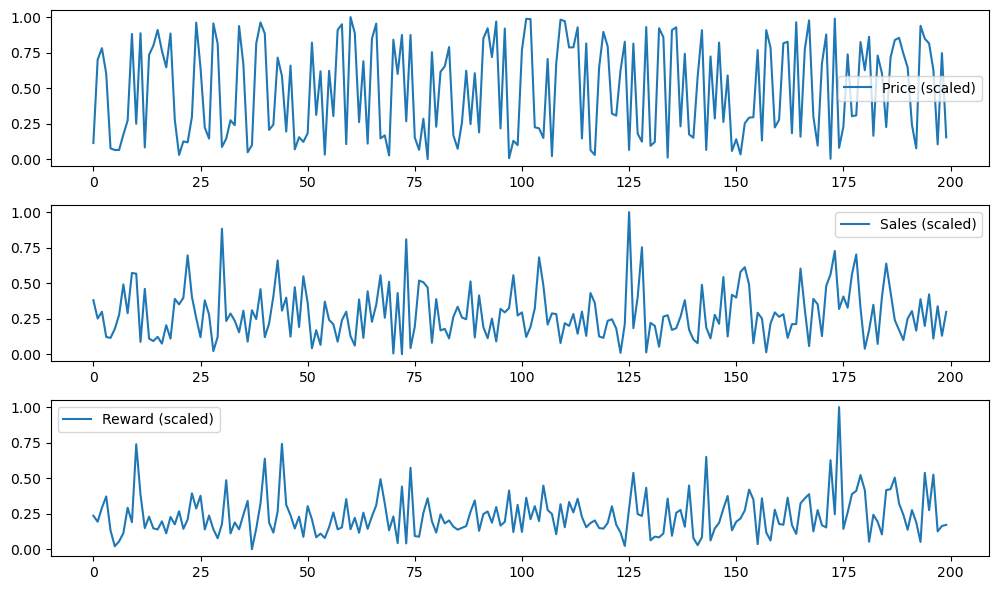

In [93]:
def visualize_model_working(model, test_env):
    prices, sales, rewards = [], [], []
    obs = test_env.reset()
    for _ in range(len(test_data)):
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, _ = test_env.step(action)
        prices.append(obs[0]) 
        sales.append(obs[1])   
        rewards.append(reward) 
        if done:
            break
    scaler = MinMaxScaler()
    prices_scaled = scaler.fit_transform(np.array(prices).reshape(-1, 1)).flatten()
    sales_scaled = scaler.fit_transform(np.array(sales).reshape(-1, 1)).flatten()
    rewards_scaled = scaler.fit_transform(np.array(rewards).reshape(-1, 1)).flatten()

    plt.figure(figsize=(10, 6))

    plt.subplot(3, 1, 1)
    plt.plot(prices_scaled, label="Price (scaled)")
    plt.legend()

    plt.subplot(3, 1, 2)
    plt.plot(sales_scaled, label="Sales (scaled)")
    plt.legend()

    plt.subplot(3, 1, 3)
    plt.plot(rewards_scaled, label="Reward (scaled)")
    plt.legend()

    plt.tight_layout()
    plt.show()
    
visualize_model_working(model, test_env)

In [90]:
study = optuna.create_study(direction="maximize")
study.optimize(lambda trial: optimize_rl(trial, train_env), n_trials=20)

[I 2024-12-03 03:42:19,177] A new study created in memory with name: no-name-9f26d393-4b50-4432-9138-1d29b8de7115
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automa

Step: 0, Price: 0.40, Sales: 203670.22
Step: 1, Price: 5.75, Sales: 160074.34
Step: 2, Price: 5.00, Sales: 145115.31
Step: 3, Price: 4.25, Sales: 271688.43
Step: 4, Price: 4.25, Sales: 98561.96
Step: 5, Price: 4.25, Sales: 406777.83
Step: 6, Price: 5.00, Sales: 32881.96
Step: 7, Price: 6.61, Sales: 31569.74
Step: 8, Price: 5.75, Sales: 80108.33
Step: 9, Price: 5.75, Sales: 249858.38
Step: 10, Price: 5.75, Sales: 73282.38
Step: 11, Price: 5.75, Sales: 273483.85
Step: 12, Price: 5.00, Sales: 92564.43
Step: 13, Price: 5.75, Sales: 10373.13
Step: 14, Price: 4.25, Sales: 236250.97
Step: 15, Price: 8.96, Sales: 3613.71
Step: 16, Price: 5.75, Sales: 153855.02
Step: 17, Price: 4.25, Sales: 186091.31
Step: 18, Price: 4.25, Sales: 62472.09
Step: 19, Price: 5.00, Sales: 183839.11
Step: 20, Price: 5.00, Sales: 155970.85
Step: 21, Price: 5.75, Sales: 152520.88
Step: 22, Price: 11.74, Sales: 2358.06
Step: 23, Price: 15.88, Sales: 2362.62
Step: 24, Price: 4.25, Sales: 200418.55
Step: 25, Price: 5.00,

Step: 40, Price: 4.25, Sales: 241420.50
Step: 41, Price: 4.89, Sales: 138086.61
Step: 42, Price: 4.25, Sales: 59059.29
Step: 43, Price: 8.29, Sales: 3611.46
Step: 44, Price: 5.75, Sales: 204244.57
Step: 45, Price: 5.00, Sales: 56469.30
Step: 46, Price: 5.75, Sales: 69944.14
Step: 47, Price: 5.00, Sales: 39802.95
Step: 48, Price: 5.00, Sales: 611634.75
Step: 49, Price: 5.75, Sales: 48156.11
Step: 50, Price: 4.89, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 61723.54
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Price: 4.25, Sales: 287219.16
Step: 55, Price: 5.00, Sales: 578279.15
Step: 56, Price: 5.00, Sales: 48317.87
Step: 57, Price: 5.75, Sales: 57015.27
Step: 58, Price: 4.25, Sales: 70500.55
Step: 59, Price: 5.75, Sales: 15052.23
Step: 60, Price: 6.61, Sales: 8736.84
Step: 61, Price: 5.75, Sales: 216287.96
Step: 62, Price: 4.25, Sales: 86911.32
Step: 63, Price: 4.25, Sales: 487549.46
Step: 64, Price: 4.25, Sales: 243872.41
Step: 65, Price: 

Step: 49, Price: 6.61, Sales: 38524.89
Step: 50, Price: 5.00, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 61723.54
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Price: 5.00, Sales: 287219.16
Step: 55, Price: 5.00, Sales: 578279.15
Step: 56, Price: 5.00, Sales: 48317.87
Step: 57, Price: 5.75, Sales: 57015.27
Step: 58, Price: 5.00, Sales: 70500.55
Step: 59, Price: 5.75, Sales: 15052.23
Step: 60, Price: 6.61, Sales: 8736.84
Step: 61, Price: 5.75, Sales: 216287.96
Step: 62, Price: 5.00, Sales: 86911.32
Step: 63, Price: 5.00, Sales: 487549.46
Step: 64, Price: 5.00, Sales: 243872.41
Step: 65, Price: 5.75, Sales: 97094.79
Step: 66, Price: 5.00, Sales: 20418.53
Step: 67, Price: 5.75, Sales: 17575.76
Step: 68, Price: 5.75, Sales: 134753.24
Step: 69, Price: 5.00, Sales: 252257.11
Step: 70, Price: 4.89, Sales: 103802.15
Step: 71, Price: 5.75, Sales: 72338.86
Step: 72, Price: 5.00, Sales: 35061.49
Step: 73, Price: 5.75, Sales: 49278.59
Step: 74, Price: 

Step: 80, Price: 6.61, Sales: 13749.35
Step: 81, Price: 5.00, Sales: 265243.88
Step: 82, Price: 5.75, Sales: 70724.93
Step: 83, Price: 5.75, Sales: 225248.13
Step: 84, Price: 5.75, Sales: 141508.63
Step: 85, Price: 5.00, Sales: 99856.52
Step: 86, Price: 5.00, Sales: 83025.33
Step: 87, Price: 7.21, Sales: 2682.67
Step: 88, Price: 5.00, Sales: 166413.06
Step: 89, Price: 5.00, Sales: 92233.62
Step: 90, Price: 5.75, Sales: 22299.34
Step: 91, Price: 5.75, Sales: 96482.35
Step: 92, Price: 5.00, Sales: 131472.47
Step: 93, Price: 5.00, Sales: 153565.58
Step: 94, Price: 5.00, Sales: 100869.56
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 5.21, Sales: 7306.61
Step: 97, Price: 6.61, Sales: 65756.97
Step: 98, Price: 5.00, Sales: 502023.23
Step: 99, Price: 5.39, Sales: 13640.76
Step: 100, Price: 5.00, Sales: 185648.10
Step: 101, Price: 5.00, Sales: 117317.72
Step: 102, Price: 5.00, Sales: 94658.17
Step: 103, Price: 5.75, Sales: 79129.46
Step: 104, Price: 4.25, Sales: 333944.51
Step: 105, P

Step: 122, Price: 5.00, Sales: 10207.44
Step: 123, Price: 5.75, Sales: 437493.12
Step: 124, Price: 5.75, Sales: 94369.24
Step: 125, Price: 5.00, Sales: 62723.88
Step: 126, Price: 5.00, Sales: 130212.90
Step: 127, Price: 5.00, Sales: 1407166.79
Step: 128, Price: 5.75, Sales: 79583.21
Step: 129, Price: 5.75, Sales: 6980.71
Step: 130, Price: 5.00, Sales: 120886.09
Step: 131, Price: 5.75, Sales: 123891.55
Step: 132, Price: 7.54, Sales: 4565.68
Step: 133, Price: 4.25, Sales: 182520.35
Step: 134, Price: 6.27, Sales: 5303.34
Step: 135, Price: 5.00, Sales: 47486.12
Step: 136, Price: 5.00, Sales: 199961.78
Step: 137, Price: 5.75, Sales: 33071.85
Step: 138, Price: 8.32, Sales: 7250.69
Step: 139, Price: 5.00, Sales: 12698.43
Step: 140, Price: 5.00, Sales: 96310.14
Step: 141, Price: 5.00, Sales: 22186.11
Step: 142, Price: 5.00, Sales: 123500.08
Step: 143, Price: 5.00, Sales: 386366.58
Step: 144, Price: 5.00, Sales: 1001031.74
Step: 145, Price: 5.00, Sales: 171887.80
Step: 146, Price: 5.00, Sales: 

Step: 149, Price: 5.00, Sales: 213679.67
Step: 150, Price: 5.75, Sales: 39802.95
Step: 151, Price: 5.00, Sales: 102095.15
Step: 152, Price: 5.99, Sales: 9183.65
Step: 153, Price: 5.00, Sales: 28787.38
Step: 154, Price: 5.00, Sales: 119997.71
Step: 155, Price: 5.00, Sales: 217545.77
Step: 156, Price: 5.75, Sales: 55484.22
Step: 157, Price: 5.75, Sales: 48795.87
Step: 158, Price: 5.00, Sales: 84207.77
Step: 159, Price: 5.00, Sales: 399188.65
Step: 160, Price: 5.00, Sales: 443444.35
Step: 161, Price: 5.75, Sales: 51667.50
Step: 162, Price: 5.00, Sales: 79876.34
Step: 163, Price: 5.75, Sales: 916836.65
Step: 164, Price: 5.75, Sales: 16791.24
Step: 165, Price: 5.00, Sales: 82175.37
Step: 166, Price: 5.00, Sales: 559462.56
Step: 167, Price: 5.00, Sales: 412111.66
Step: 168, Price: 5.00, Sales: 146297.75
Step: 169, Price: 7.22, Sales: 6050.66
Step: 170, Price: 7.21, Sales: 3487.47
Step: 171, Price: 5.00, Sales: 352176.58
Step: 172, Price: 5.00, Sales: 489581.32
Step: 173, Price: 5.00, Sales: 

Step: 189, Price: 6.61, Sales: 287242.92
Step: 190, Price: 5.00, Sales: 687244.87
Step: 191, Price: 5.00, Sales: 15250.90
Step: 192, Price: 6.61, Sales: 109017.27
Step: 193, Price: 5.00, Sales: 64464.42
Step: 194, Price: 5.75, Sales: 10906.80
Step: 195, Price: 5.75, Sales: 247678.90
Step: 196, Price: 5.00, Sales: 140111.72
Step: 197, Price: 5.75, Sales: 54655.45
Step: 198, Price: 5.00, Sales: 351961.67
Step: 199, Price: 5.00, Sales: 29493.83
Step: 0, Price: 0.40, Sales: 203670.22
Step: 1, Price: 5.75, Sales: 160074.34
Step: 2, Price: 5.00, Sales: 145115.31
Step: 3, Price: 5.00, Sales: 326026.11
Step: 4, Price: 5.00, Sales: 98561.96
Step: 5, Price: 5.00, Sales: 406777.83
Step: 6, Price: 5.00, Sales: 39458.35
Step: 7, Price: 5.62, Sales: 37883.68
Step: 8, Price: 5.00, Sales: 96129.99
Step: 9, Price: 5.75, Sales: 249858.38
Step: 10, Price: 5.75, Sales: 73282.38
Step: 11, Price: 5.75, Sales: 273483.85
Step: 12, Price: 5.00, Sales: 92564.43
Step: 13, Price: 5.75, Sales: 10373.13
Step: 14, P

Step: 34, Price: 5.00, Sales: 11312.18
Step: 35, Price: 5.75, Sales: 100776.09
Step: 36, Price: 5.75, Sales: 22031.97
Step: 37, Price: 5.00, Sales: 494839.25
Step: 38, Price: 5.75, Sales: 150191.80
Step: 39, Price: 5.00, Sales: 374448.92
Step: 40, Price: 5.00, Sales: 241420.50
Step: 41, Price: 5.00, Sales: 138086.61
Step: 42, Price: 5.00, Sales: 59059.29
Step: 43, Price: 8.29, Sales: 3611.46
Step: 44, Price: 5.75, Sales: 204244.57
Step: 45, Price: 5.00, Sales: 56469.30
Step: 46, Price: 5.00, Sales: 83932.97
Step: 47, Price: 5.00, Sales: 39802.95
Step: 48, Price: 5.75, Sales: 489307.80
Step: 49, Price: 6.61, Sales: 38524.89
Step: 50, Price: 5.00, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 61723.54
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Price: 5.00, Sales: 287219.16
Step: 55, Price: 5.00, Sales: 578279.15
Step: 56, Price: 5.00, Sales: 48317.87
Step: 57, Price: 5.75, Sales: 57015.27
Step: 58, Price: 5.00, Sales: 70500.55
Step: 59, Price

Step: 71, Price: 5.75, Sales: 72338.86
Step: 72, Price: 5.00, Sales: 35061.49
Step: 73, Price: 5.75, Sales: 49278.59
Step: 74, Price: 5.75, Sales: 73644.18
Step: 75, Price: 5.75, Sales: 121269.23
Step: 76, Price: 5.00, Sales: 81734.54
Step: 77, Price: 4.25, Sales: 274106.15
Step: 78, Price: 7.60, Sales: 68038.31
Step: 79, Price: 5.00, Sales: 105210.64
Step: 80, Price: 6.61, Sales: 13749.35
Step: 81, Price: 5.00, Sales: 265243.88
Step: 82, Price: 5.75, Sales: 70724.93
Step: 83, Price: 5.75, Sales: 225248.13
Step: 84, Price: 5.75, Sales: 141508.63
Step: 85, Price: 5.00, Sales: 99856.52
Step: 86, Price: 5.00, Sales: 83025.33
Step: 87, Price: 8.29, Sales: 2146.13
Step: 88, Price: 5.00, Sales: 166413.06
Step: 89, Price: 5.75, Sales: 73786.89
Step: 90, Price: 5.75, Sales: 22299.34
Step: 91, Price: 5.75, Sales: 96482.35
Step: 92, Price: 5.00, Sales: 131472.47
Step: 93, Price: 5.00, Sales: 153565.58
Step: 94, Price: 5.00, Sales: 121043.47
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 

Step: 80, Price: 6.61, Sales: 13749.35
Step: 81, Price: 5.00, Sales: 265243.88
Step: 82, Price: 5.75, Sales: 70724.93
Step: 83, Price: 5.75, Sales: 225248.13
Step: 84, Price: 5.75, Sales: 141508.63
Step: 85, Price: 5.00, Sales: 99856.52
Step: 86, Price: 5.00, Sales: 83025.33
Step: 87, Price: 8.29, Sales: 2146.13
Step: 88, Price: 5.00, Sales: 166413.06
Step: 89, Price: 5.75, Sales: 73786.89
Step: 90, Price: 5.75, Sales: 22299.34
Step: 91, Price: 5.75, Sales: 96482.35
Step: 92, Price: 5.00, Sales: 131472.47
Step: 93, Price: 5.00, Sales: 153565.58
Step: 94, Price: 5.00, Sales: 121043.47
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 5.99, Sales: 5845.28
Step: 97, Price: 7.60, Sales: 52605.57
Step: 98, Price: 5.00, Sales: 502023.23
Step: 99, Price: 5.39, Sales: 13640.76
Step: 100, Price: 5.00, Sales: 185648.10
Step: 101, Price: 5.75, Sales: 93854.17
Step: 102, Price: 5.00, Sales: 94658.17
Step: 103, Price: 5.00, Sales: 94955.35
Step: 104, Price: 5.00, Sales: 333944.51
Step: 105, Pr

Step: 93, Price: 5.00, Sales: 153565.58
Step: 94, Price: 5.00, Sales: 121043.47
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 5.99, Sales: 5845.28
Step: 97, Price: 7.60, Sales: 52605.57
Step: 98, Price: 5.00, Sales: 502023.23
Step: 99, Price: 5.39, Sales: 13640.76
Step: 100, Price: 5.00, Sales: 185648.10
Step: 101, Price: 5.75, Sales: 93854.17
Step: 102, Price: 5.00, Sales: 94658.17
Step: 103, Price: 5.00, Sales: 94955.35
Step: 104, Price: 5.00, Sales: 333944.51
Step: 105, Price: 4.89, Sales: 232360.11
Step: 106, Price: 5.00, Sales: 93470.77
Step: 107, Price: 5.75, Sales: 58752.14
Step: 108, Price: 5.75, Sales: 39201.64
Step: 109, Price: 6.61, Sales: 170971.73
Step: 110, Price: 7.60, Sales: 45504.04
Step: 111, Price: 11.48, Sales: 4631.97
Step: 112, Price: 5.00, Sales: 710398.73
Step: 113, Price: 5.75, Sales: 370799.39
Step: 114, Price: 5.33, Sales: 10408.72
Step: 115, Price: 5.00, Sales: 23749.33
Step: 116, Price: 5.00, Sales: 163428.22
Step: 117, Price: 5.00, Sales: 485458.9

Step: 104, Price: 5.00, Sales: 333944.51
Step: 105, Price: 5.00, Sales: 232360.11
Step: 106, Price: 5.00, Sales: 93470.77
Step: 107, Price: 5.75, Sales: 58752.14
Step: 108, Price: 5.75, Sales: 39201.64
Step: 109, Price: 6.61, Sales: 170971.73
Step: 110, Price: 7.60, Sales: 45504.04
Step: 111, Price: 11.48, Sales: 4631.97
Step: 112, Price: 5.00, Sales: 710398.73
Step: 113, Price: 6.61, Sales: 296639.51
Step: 114, Price: 5.33, Sales: 10408.72
Step: 115, Price: 5.00, Sales: 23749.33
Step: 116, Price: 5.00, Sales: 163428.22
Step: 117, Price: 5.00, Sales: 485458.98
Step: 118, Price: 5.75, Sales: 128572.13
Step: 119, Price: 5.75, Sales: 212987.44
Step: 120, Price: 5.00, Sales: 96274.71
Step: 121, Price: 5.00, Sales: 148244.73
Step: 122, Price: 5.75, Sales: 8165.95
Step: 123, Price: 5.75, Sales: 437493.12
Step: 124, Price: 5.75, Sales: 94369.24
Step: 125, Price: 5.00, Sales: 62723.88
Step: 126, Price: 5.00, Sales: 130212.90
Step: 127, Price: 5.00, Sales: 1407166.79
Step: 128, Price: 5.75, Sal

Step: 121, Price: 5.00, Sales: 148244.73
Step: 122, Price: 5.75, Sales: 8165.95
Step: 123, Price: 5.75, Sales: 437493.12
Step: 124, Price: 5.75, Sales: 94369.24
Step: 125, Price: 5.00, Sales: 62723.88
Step: 126, Price: 5.00, Sales: 130212.90
Step: 127, Price: 5.00, Sales: 1407166.79
Step: 128, Price: 5.75, Sales: 79583.21
Step: 129, Price: 5.75, Sales: 6980.71
Step: 130, Price: 5.00, Sales: 120886.09
Step: 131, Price: 5.75, Sales: 123891.55
Step: 132, Price: 8.67, Sales: 3652.54
Step: 133, Price: 5.00, Sales: 182520.35
Step: 134, Price: 6.27, Sales: 5303.34
Step: 135, Price: 5.00, Sales: 47486.12
Step: 136, Price: 5.00, Sales: 199961.78
Step: 137, Price: 6.61, Sales: 26457.48
Step: 138, Price: 8.32, Sales: 7250.69
Step: 139, Price: 5.00, Sales: 12698.43
Step: 140, Price: 5.00, Sales: 96310.14
Step: 141, Price: 5.00, Sales: 22186.11
Step: 142, Price: 5.00, Sales: 123500.08
Step: 143, Price: 5.00, Sales: 386366.58
Step: 144, Price: 4.25, Sales: 1201238.09
Step: 145, Price: 5.00, Sales: 1

Step: 144, Price: 5.00, Sales: 1201238.09
Step: 145, Price: 5.00, Sales: 171887.80
Step: 146, Price: 5.00, Sales: 37085.97
Step: 147, Price: 5.00, Sales: 48926.73
Step: 148, Price: 5.00, Sales: 718163.57
Step: 149, Price: 5.00, Sales: 256415.61
Step: 150, Price: 5.00, Sales: 47763.54
Step: 151, Price: 5.00, Sales: 122514.18
Step: 152, Price: 5.99, Sales: 9183.65
Step: 153, Price: 5.00, Sales: 28787.38
Step: 154, Price: 4.25, Sales: 143997.25
Step: 155, Price: 5.00, Sales: 217545.77
Step: 156, Price: 5.75, Sales: 55484.22
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 5.00, Sales: 84207.77
Step: 159, Price: 5.00, Sales: 479026.38
Step: 160, Price: 5.00, Sales: 425706.58
Step: 161, Price: 5.00, Sales: 62001.00
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 5.75, Sales: 916836.65
Step: 164, Price: 6.61, Sales: 13433.00
Step: 165, Price: 4.25, Sales: 98610.44
Step: 166, Price: 5.00, Sales: 671355.08
Step: 167, Price: 5.00, Sales: 412111.66
Step: 168, Price: 5.00, Sale

Step: 168, Price: 5.00, Sales: 146297.75
Step: 169, Price: 8.30, Sales: 4840.52
Step: 170, Price: 8.29, Sales: 2789.97
Step: 171, Price: 5.75, Sales: 281741.26
Step: 172, Price: 5.00, Sales: 587497.58
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.00, Sales: 121626.64
Step: 175, Price: 5.75, Sales: 326517.27
Step: 176, Price: 5.21, Sales: 10574.67
Step: 177, Price: 5.75, Sales: 688527.76
Step: 178, Price: 5.00, Sales: 293423.50
Step: 179, Price: 5.75, Sales: 272705.98
Step: 180, Price: 5.00, Sales: 10002.36
Step: 181, Price: 5.75, Sales: 65756.97
Step: 182, Price: 5.75, Sales: 262774.60
Step: 183, Price: 5.00, Sales: 487500.61
Step: 184, Price: 5.00, Sales: 699890.87
Step: 185, Price: 5.75, Sales: 70412.61
Step: 186, Price: 5.00, Sales: 166391.35
Step: 187, Price: 5.00, Sales: 179350.99
Step: 188, Price: 5.75, Sales: 389142.42
Step: 189, Price: 6.61, Sales: 287242.92
Step: 190, Price: 5.00, Sales: 687244.87
Step: 191, Price: 5.00, Sales: 15250.90
Step: 192, Price: 6.61, S

Step: 191, Price: 5.00, Sales: 15250.90
Step: 192, Price: 6.61, Sales: 109017.27
Step: 193, Price: 5.75, Sales: 51571.53
Step: 194, Price: 5.75, Sales: 10906.80
Step: 195, Price: 5.75, Sales: 247678.90
Step: 196, Price: 5.00, Sales: 140111.72
Step: 197, Price: 5.00, Sales: 65586.53
Step: 198, Price: 5.00, Sales: 351961.67
Step: 199, Price: 5.00, Sales: 35392.60
Step: 0, Price: 0.34, Sales: 244404.26
Step: 1, Price: 5.75, Sales: 160074.34
Step: 2, Price: 5.75, Sales: 116092.25
Step: 3, Price: 5.75, Sales: 260820.89
Step: 4, Price: 5.00, Sales: 98561.96
Step: 5, Price: 5.00, Sales: 406777.83
Step: 6, Price: 5.00, Sales: 39458.35
Step: 7, Price: 5.62, Sales: 37883.68
Step: 8, Price: 5.00, Sales: 96129.99
Step: 9, Price: 5.75, Sales: 249858.38
Step: 10, Price: 5.75, Sales: 73282.38
Step: 11, Price: 5.75, Sales: 273483.85
Step: 12, Price: 5.75, Sales: 106634.22
Step: 13, Price: 6.61, Sales: 8298.51
Step: 14, Price: 5.75, Sales: 189000.78
Step: 15, Price: 10.30, Sales: 2890.97
Step: 16, Pric

Step: 0, Price: 0.34, Sales: 244404.26
Step: 1, Price: 5.75, Sales: 160074.34
Step: 2, Price: 5.75, Sales: 116092.25
Step: 3, Price: 5.75, Sales: 260820.89
Step: 4, Price: 5.00, Sales: 98561.96
Step: 5, Price: 5.00, Sales: 406777.83
Step: 6, Price: 5.00, Sales: 39458.35
Step: 7, Price: 5.62, Sales: 37883.68
Step: 8, Price: 5.00, Sales: 96129.99
Step: 9, Price: 5.75, Sales: 249858.38
Step: 10, Price: 5.75, Sales: 73282.38
Step: 11, Price: 5.75, Sales: 273483.85
Step: 12, Price: 5.75, Sales: 106634.22
Step: 13, Price: 6.61, Sales: 8298.51
Step: 14, Price: 5.75, Sales: 189000.78
Step: 15, Price: 10.30, Sales: 2890.97
Step: 16, Price: 5.75, Sales: 153855.02
Step: 17, Price: 5.75, Sales: 148873.05
Step: 18, Price: 5.00, Sales: 62472.09
Step: 19, Price: 5.00, Sales: 211782.65
Step: 20, Price: 5.00, Sales: 187165.02
Step: 21, Price: 5.00, Sales: 219630.07
Step: 22, Price: 8.48, Sales: 3395.60
Step: 23, Price: 13.50, Sales: 2835.15
Step: 24, Price: 5.00, Sales: 240502.26
Step: 25, Price: 5.75,

Step: 36, Price: 5.75, Sales: 22031.97
Step: 37, Price: 5.00, Sales: 494839.25
Step: 38, Price: 5.75, Sales: 150191.80
Step: 39, Price: 5.00, Sales: 449338.71
Step: 40, Price: 5.00, Sales: 241420.50
Step: 41, Price: 5.00, Sales: 138086.61
Step: 42, Price: 5.00, Sales: 70871.14
Step: 43, Price: 8.29, Sales: 3611.46
Step: 44, Price: 5.75, Sales: 204244.57
Step: 45, Price: 5.00, Sales: 67763.16
Step: 46, Price: 5.00, Sales: 83932.97
Step: 47, Price: 5.00, Sales: 39802.95
Step: 48, Price: 6.61, Sales: 391446.24
Step: 49, Price: 6.61, Sales: 38524.89
Step: 50, Price: 5.00, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 74068.24
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Price: 4.25, Sales: 344663.00
Step: 55, Price: 5.00, Sales: 578279.15
Step: 56, Price: 5.00, Sales: 48317.87
Step: 57, Price: 5.75, Sales: 57015.27
Step: 58, Price: 5.00, Sales: 70500.55
Step: 59, Price: 5.00, Sales: 18062.67
Step: 60, Price: 6.61, Sales: 8736.84
Step: 61, Price: 

Step: 78, Price: 7.60, Sales: 68038.31
Step: 79, Price: 5.00, Sales: 105210.64
Step: 80, Price: 6.61, Sales: 13749.35
Step: 81, Price: 5.00, Sales: 265243.88
Step: 82, Price: 5.75, Sales: 70724.93
Step: 83, Price: 5.75, Sales: 225248.13
Step: 84, Price: 5.75, Sales: 141508.63
Step: 85, Price: 5.00, Sales: 99856.52
Step: 86, Price: 4.25, Sales: 99630.40
Step: 87, Price: 8.29, Sales: 2146.13
Step: 88, Price: 5.00, Sales: 166413.06
Step: 89, Price: 6.61, Sales: 59029.51
Step: 90, Price: 6.61, Sales: 17839.48
Step: 91, Price: 6.61, Sales: 77185.88
Step: 92, Price: 5.75, Sales: 105177.98
Step: 93, Price: 5.00, Sales: 153565.58
Step: 94, Price: 5.00, Sales: 121043.47
Step: 95, Price: 6.27, Sales: 4720.59
Step: 96, Price: 5.09, Sales: 7014.34
Step: 97, Price: 7.60, Sales: 52605.57
Step: 98, Price: 5.00, Sales: 502023.23
Step: 99, Price: 5.39, Sales: 13640.76
Step: 100, Price: 5.00, Sales: 185648.10
Step: 101, Price: 5.75, Sales: 93854.17
Step: 102, Price: 5.00, Sales: 113589.81
Step: 103, Pri

Step: 103, Price: 5.00, Sales: 91157.14
Step: 104, Price: 5.00, Sales: 333944.51
Step: 105, Price: 5.00, Sales: 278832.14
Step: 106, Price: 5.00, Sales: 93470.77
Step: 107, Price: 5.75, Sales: 58752.14
Step: 108, Price: 5.75, Sales: 39201.64
Step: 109, Price: 6.61, Sales: 170971.73
Step: 110, Price: 6.46, Sales: 54604.85
Step: 111, Price: 13.20, Sales: 3705.58
Step: 112, Price: 5.00, Sales: 710398.73
Step: 113, Price: 7.60, Sales: 237311.61
Step: 114, Price: 5.00, Sales: 12490.47
Step: 115, Price: 5.00, Sales: 23749.33
Step: 116, Price: 5.75, Sales: 130742.58
Step: 117, Price: 5.00, Sales: 485458.98
Step: 118, Price: 5.75, Sales: 128572.13
Step: 119, Price: 5.75, Sales: 212987.44
Step: 120, Price: 5.00, Sales: 96274.71
Step: 121, Price: 5.00, Sales: 148244.73
Step: 122, Price: 5.62, Sales: 7839.31
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 6.61, Sales: 75495.39
Step: 125, Price: 5.00, Sales: 62723.88
Step: 126, Price: 5.00, Sales: 130212.90
Step: 127, Price: 5.00, Sales

Step: 140, Price: 5.00, Sales: 96310.14
Step: 141, Price: 5.00, Sales: 22186.11
Step: 142, Price: 5.00, Sales: 123500.08
Step: 143, Price: 5.00, Sales: 386366.58
Step: 144, Price: 5.00, Sales: 1201238.09
Step: 145, Price: 5.00, Sales: 206265.36
Step: 146, Price: 5.00, Sales: 37085.97
Step: 147, Price: 5.00, Sales: 48926.73
Step: 148, Price: 5.00, Sales: 718163.57
Step: 149, Price: 5.00, Sales: 256415.61
Step: 150, Price: 5.00, Sales: 47763.54
Step: 151, Price: 5.00, Sales: 122514.18
Step: 152, Price: 5.99, Sales: 9183.65
Step: 153, Price: 5.00, Sales: 28787.38
Step: 154, Price: 5.00, Sales: 143997.25
Step: 155, Price: 5.00, Sales: 217545.77
Step: 156, Price: 5.00, Sales: 79897.28
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 5.00, Sales: 84207.77
Step: 159, Price: 5.00, Sales: 479026.38
Step: 160, Price: 5.00, Sales: 510847.89
Step: 161, Price: 5.00, Sales: 74401.20
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 5.00, Sales: 1100203.98
Step: 164, Price: 6.61, Sal

Step: 166, Price: 5.00, Sales: 671355.08
Step: 167, Price: 5.00, Sales: 412111.66
Step: 168, Price: 5.00, Sales: 146297.75
Step: 169, Price: 8.30, Sales: 4840.52
Step: 170, Price: 9.53, Sales: 2231.98
Step: 171, Price: 5.75, Sales: 281741.26
Step: 172, Price: 5.00, Sales: 587497.58
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.00, Sales: 121626.64
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 5.99, Sales: 8459.74
Step: 177, Price: 5.75, Sales: 688527.76
Step: 178, Price: 5.00, Sales: 293423.50
Step: 179, Price: 5.00, Sales: 327247.18
Step: 180, Price: 5.00, Sales: 10002.36
Step: 181, Price: 5.75, Sales: 65756.97
Step: 182, Price: 5.75, Sales: 262774.60
Step: 183, Price: 5.00, Sales: 487500.61
Step: 184, Price: 5.00, Sales: 699890.87
Step: 185, Price: 5.75, Sales: 70412.61
Step: 186, Price: 5.00, Sales: 166391.35
Step: 187, Price: 5.00, Sales: 179350.99
Step: 188, Price: 5.75, Sales: 389142.42
Step: 189, Price: 6.61, Sales: 287242.92
Step: 190, Price: 5.00, S

Step: 184, Price: 5.00, Sales: 699890.87
Step: 185, Price: 5.75, Sales: 70412.61
Step: 186, Price: 5.00, Sales: 166391.35
Step: 187, Price: 5.00, Sales: 179350.99
Step: 188, Price: 5.75, Sales: 389142.42
Step: 189, Price: 6.61, Sales: 287242.92
Step: 190, Price: 5.00, Sales: 687244.87
Step: 191, Price: 5.00, Sales: 15250.90
Step: 192, Price: 6.61, Sales: 109017.27
Step: 193, Price: 5.75, Sales: 51571.53
Step: 194, Price: 5.75, Sales: 10906.80
Step: 195, Price: 6.61, Sales: 198143.12
Step: 196, Price: 5.00, Sales: 140111.72
Step: 197, Price: 5.00, Sales: 65586.53
Step: 198, Price: 5.00, Sales: 351961.67
Step: 199, Price: 5.00, Sales: 35392.60
Step: 0, Price: 0.34, Sales: 244404.26
Step: 1, Price: 5.75, Sales: 160074.34
Step: 2, Price: 5.75, Sales: 116092.25
Step: 3, Price: 5.75, Sales: 260820.89
Step: 4, Price: 5.00, Sales: 98561.96
Step: 5, Price: 5.00, Sales: 406777.83
Step: 6, Price: 5.00, Sales: 39458.35
Step: 7, Price: 5.62, Sales: 37883.68
Step: 8, Price: 5.00, Sales: 96129.99
Ste

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 29, Price: 5.00, Sales: 198084.94
Step: 30, Price: 5.75, Sales: 113836.03
Step: 31, Price: 17.45, Sales: 2323.28
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 5.00, Sales: 118832.88
Step: 34, Price: 5.00, Sales: 11312.18
Step: 35, Price: 5.75, Sales: 100776.09
Step: 36, Price: 5.75, Sales: 22031.97
Step: 37, Price: 5.00, Sales: 593807.11
Step: 38, Price: 5.75, Sales: 150191.80
Step: 39, Price: 5.00, Sales: 449338.71
Step: 40, Price: 5.00, Sales: 241420.50
Step: 41, Price: 5.00, Sales: 138086.61
Step: 42, Price: 5.00, Sales: 70871.14
Step: 43, Price: 8.10, Sales: 3467.00
Step: 44, Price: 5.75, Sales: 204244.57
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 5.00, Sales: 83932.97
Step: 47, Price: 5.00, Sales: 39802.95
Step: 48, Price: 6.61, Sales: 391446.24
Step: 49, Price: 6.61, Sales: 38524.89
Step: 50, Price: 5.00, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 74068.24
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Pric

Step: 42, Price: 5.00, Sales: 70871.14
Step: 43, Price: 8.10, Sales: 3467.00
Step: 44, Price: 5.75, Sales: 204244.57
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 5.00, Sales: 83932.97
Step: 47, Price: 5.00, Sales: 39802.95
Step: 48, Price: 6.61, Sales: 391446.24
Step: 49, Price: 6.61, Sales: 38524.89
Step: 50, Price: 5.00, Sales: 44448.44
Step: 51, Price: 5.00, Sales: 63691.70
Step: 52, Price: 5.00, Sales: 74068.24
Step: 53, Price: 5.00, Sales: 548362.89
Step: 54, Price: 5.00, Sales: 344663.00
Step: 55, Price: 5.00, Sales: 578279.15
Step: 56, Price: 5.00, Sales: 48317.87
Step: 57, Price: 5.75, Sales: 57015.27
Step: 58, Price: 5.00, Sales: 70500.55
Step: 59, Price: 5.00, Sales: 18062.67
Step: 60, Price: 6.61, Sales: 8736.84
Step: 61, Price: 5.00, Sales: 259545.55
Step: 62, Price: 5.00, Sales: 104293.58
Step: 63, Price: 5.00, Sales: 585059.35
Step: 64, Price: 5.75, Sales: 195097.93
Step: 65, Price: 5.75, Sales: 97094.79
Step: 66, Price: 5.00, Sales: 20418.53
Step: 67, Price: 5

Step: 67, Price: 5.00, Sales: 21090.92
Step: 68, Price: 5.00, Sales: 161703.89
Step: 69, Price: 5.00, Sales: 302708.53
Step: 70, Price: 5.00, Sales: 124562.59
Step: 71, Price: 5.75, Sales: 72338.86
Step: 72, Price: 5.75, Sales: 28049.19
Step: 73, Price: 5.75, Sales: 49278.59
Step: 74, Price: 5.75, Sales: 73644.18
Step: 75, Price: 5.75, Sales: 121269.23
Step: 76, Price: 5.75, Sales: 65387.63
Step: 77, Price: 5.75, Sales: 219284.92
Step: 78, Price: 7.60, Sales: 68038.31
Step: 79, Price: 5.00, Sales: 105210.64
Step: 80, Price: 6.61, Sales: 13749.35
Step: 81, Price: 5.00, Sales: 265243.88
Step: 82, Price: 5.75, Sales: 70724.93
Step: 83, Price: 5.75, Sales: 225248.13
Step: 84, Price: 5.75, Sales: 141508.63
Step: 85, Price: 5.00, Sales: 99856.52
Step: 86, Price: 5.00, Sales: 99630.40
Step: 87, Price: 8.29, Sales: 2146.13
Step: 88, Price: 5.00, Sales: 166413.06
Step: 89, Price: 7.60, Sales: 47223.61
Step: 90, Price: 6.61, Sales: 17839.48
Step: 91, Price: 6.61, Sales: 77185.88
Step: 92, Price:

Step: 108, Price: 5.75, Sales: 39201.64
Step: 109, Price: 6.61, Sales: 170971.73
Step: 110, Price: 6.46, Sales: 54604.85
Step: 111, Price: 13.20, Sales: 3705.58
Step: 112, Price: 5.00, Sales: 710398.73
Step: 113, Price: 7.60, Sales: 237311.61
Step: 114, Price: 5.00, Sales: 12490.47
Step: 115, Price: 5.00, Sales: 23749.33
Step: 116, Price: 5.75, Sales: 130742.58
Step: 117, Price: 5.00, Sales: 485458.98
Step: 118, Price: 5.75, Sales: 128572.13
Step: 119, Price: 5.75, Sales: 212987.44
Step: 120, Price: 5.00, Sales: 96274.71
Step: 121, Price: 5.00, Sales: 148244.73
Step: 122, Price: 5.62, Sales: 7839.31
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 6.61, Sales: 75495.39
Step: 125, Price: 5.00, Sales: 62723.88
Step: 126, Price: 5.00, Sales: 130212.90
Step: 127, Price: 5.75, Sales: 1125733.43
Step: 128, Price: 5.75, Sales: 79583.21
Step: 129, Price: 5.75, Sales: 6980.71
Step: 130, Price: 5.75, Sales: 96708.87
Step: 131, Price: 5.75, Sales: 123891.55
Step: 132, Price: 9.98, Sales

[I 2024-12-03 03:42:52,450] Trial 0 finished with value: 185448764.4453125 and parameters: {'learning_rate': 0.00011359758244963054, 'gamma': 0.9604548771279617, 'batch_size': 32, 'buffer_size': 10000}. Best is trial 0 with value: 185448764.4453125.


Step: 153, Price: 5.00, Sales: 28787.38
Step: 154, Price: 5.00, Sales: 143997.25
Step: 155, Price: 5.00, Sales: 217545.77
Step: 156, Price: 5.00, Sales: 79897.28
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 5.00, Sales: 84207.77
Step: 159, Price: 5.00, Sales: 479026.38
Step: 160, Price: 5.00, Sales: 510847.89
Step: 161, Price: 5.00, Sales: 74401.20
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 5.00, Sales: 1100203.98
Step: 164, Price: 7.60, Sales: 10746.40
Step: 165, Price: 5.00, Sales: 98610.44
Step: 166, Price: 5.00, Sales: 671355.08
Step: 167, Price: 5.00, Sales: 412111.66
Step: 168, Price: 5.00, Sales: 146297.75
Step: 169, Price: 8.30, Sales: 4840.52
Step: 170, Price: 9.53, Sales: 2231.98
Step: 171, Price: 5.75, Sales: 281741.26
Step: 172, Price: 5.00, Sales: 587497.58
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.00, Sales: 121626.64
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 5.99, Sales: 8459.74
Step: 177, Price: 5.75, Sales

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.29, Sales: 293285.11
Step: 1, Price: 6.61, Sales: 128059.47
Step: 2, Price: 5.75, Sales: 116092.25
Step: 3, Price: 4.89, Sales: 312985.07
Step: 4, Price: 5.00, Sales: 98561.96
Step: 5, Price: 5.00, Sales: 406777.83
Step: 6, Price: 5.75, Sales: 31566.68
Step: 7, Price: 4.78, Sales: 45460.42
Step: 8, Price: 4.25, Sales: 115355.99
Step: 9, Price: 5.00, Sales: 299830.05
Step: 10, Price: 6.61, Sales: 58625.91
Step: 11, Price: 6.61, Sales: 218787.08
Step: 12, Price: 6.61, Sales: 85307.38
Step: 13, Price: 6.61, Sales: 8298.51
Step: 14, Price: 6.61, Sales: 151200.62
Step: 15, Price: 11.58, Sales: 2220.26
Step: 16, Price: 6.61, Sales: 123084.01
Step: 17, Price: 6.61, Sales: 119098.44
Step: 18, Price: 5.75, Sales: 49977.67
Step: 19, Price: 4.25, Sales: 254139.18
Step: 20, Price: 4.25, Sales: 224598.03
Step: 21, Price: 5.00, Sales: 219630.07
Step: 22, Price: 9.75, Sales: 2716.48
Step: 23, Price: 15.52, Sales: 2268.12
Step: 24, Price: 5.00, Sales: 240502.26
Step: 25, Price: 4.89,

Step: 12, Price: 7.60, Sales: 68245.90
Step: 13, Price: 7.60, Sales: 6638.81
Step: 14, Price: 7.60, Sales: 120960.50
Step: 15, Price: 13.31, Sales: 1776.21
Step: 16, Price: 6.61, Sales: 123084.01
Step: 17, Price: 7.60, Sales: 95278.75
Step: 18, Price: 6.61, Sales: 39982.14
Step: 19, Price: 5.00, Sales: 254139.18
Step: 20, Price: 4.25, Sales: 269517.63
Step: 21, Price: 5.75, Sales: 175704.06
Step: 22, Price: 11.21, Sales: 2173.19
Step: 23, Price: 17.85, Sales: 1814.50
Step: 24, Price: 4.25, Sales: 288602.71
Step: 25, Price: 5.75, Sales: 192060.99
Step: 26, Price: 7.60, Sales: 123908.92
Step: 27, Price: 4.25, Sales: 557101.69
Step: 28, Price: 5.75, Sales: 64108.77
Step: 29, Price: 5.00, Sales: 237701.93
Step: 30, Price: 4.25, Sales: 163923.88
Step: 31, Price: 23.00, Sales: 1486.90
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 6.61, Sales: 76053.04
Step: 34, Price: 5.75, Sales: 10859.69
Step: 35, Price: 7.60, Sales: 64496.70
Step: 36, Price: 6.61, Sales: 17625.58
Step: 37, Price

Step: 20, Price: 5.00, Sales: 269517.63
Step: 21, Price: 5.75, Sales: 175704.06
Step: 22, Price: 11.21, Sales: 2173.19
Step: 23, Price: 15.17, Sales: 2177.39
Step: 24, Price: 5.00, Sales: 288602.71
Step: 25, Price: 5.75, Sales: 192060.99
Step: 26, Price: 7.60, Sales: 123908.92
Step: 27, Price: 5.00, Sales: 557101.69
Step: 28, Price: 4.89, Sales: 76930.52
Step: 29, Price: 4.25, Sales: 285242.32
Step: 30, Price: 5.00, Sales: 163923.88
Step: 31, Price: 20.00, Sales: 1486.90
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 6.61, Sales: 76053.04
Step: 34, Price: 6.61, Sales: 8687.75
Step: 35, Price: 7.60, Sales: 64496.70
Step: 36, Price: 6.61, Sales: 17625.58
Step: 37, Price: 6.61, Sales: 380036.55
Step: 38, Price: 5.75, Sales: 144184.13
Step: 39, Price: 5.75, Sales: 359470.97
Step: 40, Price: 5.75, Sales: 193136.40
Step: 41, Price: 5.75, Sales: 132563.15
Step: 42, Price: 6.61, Sales: 45357.53
Step: 43, Price: 6.89, Sales: 4160.40
Step: 44, Price: 6.61, Sales: 163395.66
Step: 45, Pri

Step: 46, Price: 6.61, Sales: 53717.10
Step: 47, Price: 5.75, Sales: 38210.83
Step: 48, Price: 5.62, Sales: 469735.49
Step: 49, Price: 7.60, Sales: 30819.91
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 6.61, Sales: 370098.65
Step: 56, Price: 5.75, Sales: 38654.30
Step: 57, Price: 5.75, Sales: 54734.66
Step: 58, Price: 5.75, Sales: 56400.44
Step: 59, Price: 5.00, Sales: 17340.16
Step: 60, Price: 6.46, Sales: 8387.36
Step: 61, Price: 6.61, Sales: 166109.15
Step: 62, Price: 5.75, Sales: 100121.84
Step: 63, Price: 5.75, Sales: 468047.48
Step: 64, Price: 5.75, Sales: 187294.01
Step: 65, Price: 5.00, Sales: 116513.75
Step: 66, Price: 5.00, Sales: 24502.23
Step: 67, Price: 5.00, Sales: 21090.92
Step: 68, Price: 6.61, Sales: 103490.49
Step: 69, Price: 5.00, Sales: 363250.23
Step: 70, Price: 6.61, Sales: 79720.05
Step: 71, Price

Step: 76, Price: 5.62, Sales: 62772.12
Step: 77, Price: 5.75, Sales: 210513.52
Step: 78, Price: 10.06, Sales: 43544.52
Step: 79, Price: 6.61, Sales: 67334.81
Step: 80, Price: 8.75, Sales: 8799.58
Step: 81, Price: 6.61, Sales: 169756.08
Step: 82, Price: 6.61, Sales: 56579.95
Step: 83, Price: 5.00, Sales: 270297.76
Step: 84, Price: 5.00, Sales: 169810.35
Step: 85, Price: 6.61, Sales: 63908.17
Step: 86, Price: 5.75, Sales: 95645.18
Step: 87, Price: 5.85, Sales: 2966.82
Step: 88, Price: 6.61, Sales: 127805.23
Step: 89, Price: 8.75, Sales: 37778.89
Step: 90, Price: 5.62, Sales: 21407.37
Step: 91, Price: 5.62, Sales: 92623.05
Step: 92, Price: 5.62, Sales: 100970.86
Step: 93, Price: 5.75, Sales: 122852.46
Step: 94, Price: 5.00, Sales: 174302.59
Step: 95, Price: 5.00, Sales: 6797.65
Step: 96, Price: 5.00, Sales: 8417.21
Step: 97, Price: 8.55, Sales: 40401.08
Step: 98, Price: 5.00, Sales: 481942.30
Step: 99, Price: 5.75, Sales: 13095.13
Step: 100, Price: 5.75, Sales: 178222.18
Step: 101, Price:

Step: 96, Price: 5.00, Sales: 8417.21
Step: 97, Price: 8.55, Sales: 40401.08
Step: 98, Price: 5.00, Sales: 481942.30
Step: 99, Price: 5.75, Sales: 13095.13
Step: 100, Price: 5.75, Sales: 178222.18
Step: 101, Price: 7.60, Sales: 60066.67
Step: 102, Price: 5.00, Sales: 113589.81
Step: 103, Price: 5.00, Sales: 131266.28
Step: 104, Price: 5.62, Sales: 256469.39
Step: 105, Price: 5.75, Sales: 223065.71
Step: 106, Price: 5.75, Sales: 107678.32
Step: 107, Price: 5.75, Sales: 56402.05
Step: 108, Price: 5.00, Sales: 56450.37
Step: 109, Price: 8.75, Sales: 109421.91
Step: 110, Price: 6.32, Sales: 52420.65
Step: 111, Price: 15.18, Sales: 2964.46
Step: 112, Price: 6.61, Sales: 454655.19
Step: 113, Price: 8.75, Sales: 189849.29
Step: 114, Price: 5.00, Sales: 14988.56
Step: 115, Price: 6.61, Sales: 15199.57
Step: 116, Price: 5.62, Sales: 125512.87
Step: 117, Price: 5.75, Sales: 466040.62
Step: 118, Price: 5.62, Sales: 123429.24
Step: 119, Price: 6.61, Sales: 170389.96
Step: 120, Price: 5.75, Sales: 

Step: 118, Price: 5.62, Sales: 123429.24
Step: 119, Price: 6.61, Sales: 170389.96
Step: 120, Price: 5.75, Sales: 77019.77
Step: 121, Price: 5.75, Sales: 142314.94
Step: 122, Price: 4.25, Sales: 11288.61
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 5.62, Sales: 90594.47
Step: 125, Price: 5.00, Sales: 60214.93
Step: 126, Price: 5.75, Sales: 104170.32
Step: 127, Price: 5.75, Sales: 1125733.43
Step: 128, Price: 6.61, Sales: 63666.57
Step: 129, Price: 5.62, Sales: 6701.48
Step: 130, Price: 5.75, Sales: 92840.51
Step: 131, Price: 5.00, Sales: 148669.86
Step: 132, Price: 8.29, Sales: 3366.18
Step: 133, Price: 5.00, Sales: 175219.54
Step: 134, Price: 5.21, Sales: 6109.45
Step: 135, Price: 6.61, Sales: 30391.11
Step: 136, Price: 5.00, Sales: 239954.13
Step: 137, Price: 5.62, Sales: 31748.98
Step: 138, Price: 5.11, Sales: 12529.18
Step: 139, Price: 4.89, Sales: 12190.49
Step: 140, Price: 5.75, Sales: 77048.11
Step: 141, Price: 5.00, Sales: 26623.33
Step: 142, Price: 4.89, Sales: 11

Step: 152, Price: 5.85, Sales: 8816.30
Step: 153, Price: 5.75, Sales: 23029.91
Step: 154, Price: 5.75, Sales: 115197.80
Step: 155, Price: 5.00, Sales: 261054.93
Step: 156, Price: 5.00, Sales: 76701.38
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 5.75, Sales: 67366.22
Step: 159, Price: 5.00, Sales: 479026.38
Step: 160, Price: 5.75, Sales: 408678.32
Step: 161, Price: 5.00, Sales: 89281.44
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 5.75, Sales: 880163.18
Step: 164, Price: 8.55, Sales: 8253.23
Step: 165, Price: 5.75, Sales: 78888.35
Step: 166, Price: 5.75, Sales: 537084.06
Step: 167, Price: 5.75, Sales: 329689.32
Step: 168, Price: 5.75, Sales: 117038.20
Step: 169, Price: 6.90, Sales: 5576.28
Step: 170, Price: 9.53, Sales: 2231.98
Step: 171, Price: 6.61, Sales: 225393.01
Step: 172, Price: 5.75, Sales: 469998.07
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 6.61, Sales: 77841.05
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 4.98, Sales: 9

Step: 180, Price: 5.00, Sales: 9602.26
Step: 181, Price: 4.25, Sales: 94690.03
Step: 182, Price: 6.61, Sales: 210219.68
Step: 183, Price: 5.00, Sales: 585000.74
Step: 184, Price: 5.00, Sales: 699890.87
Step: 185, Price: 5.00, Sales: 84495.14
Step: 186, Price: 5.00, Sales: 159735.70
Step: 187, Price: 5.75, Sales: 143480.79
Step: 188, Price: 6.61, Sales: 311313.94
Step: 189, Price: 6.46, Sales: 275753.21
Step: 190, Price: 5.75, Sales: 549795.90
Step: 191, Price: 5.00, Sales: 14640.86
Step: 192, Price: 5.62, Sales: 130820.72
Step: 193, Price: 7.60, Sales: 33005.78
Step: 194, Price: 5.62, Sales: 10470.53
Step: 195, Price: 5.62, Sales: 237771.75
Step: 196, Price: 5.00, Sales: 140111.72
Step: 197, Price: 5.75, Sales: 52469.23
Step: 198, Price: 5.00, Sales: 422354.00
Step: 199, Price: 5.00, Sales: 33976.90
Step: 0, Price: 0.33, Sales: 234628.09
Step: 1, Price: 7.60, Sales: 102447.58
Step: 2, Price: 5.75, Sales: 111448.56
Step: 3, Price: 5.00, Sales: 450698.49
Step: 4, Price: 7.60, Sales: 5046

Step: 8, Price: 5.75, Sales: 92284.79
Step: 9, Price: 5.00, Sales: 287836.85
Step: 10, Price: 7.60, Sales: 46900.73
Step: 11, Price: 7.60, Sales: 175029.67
Step: 12, Price: 7.60, Sales: 68245.90
Step: 13, Price: 8.75, Sales: 5311.04
Step: 14, Price: 7.60, Sales: 120960.50
Step: 15, Price: 7.81, Sales: 2828.66
Step: 16, Price: 5.62, Sales: 147700.82
Step: 17, Price: 7.60, Sales: 95278.75
Step: 18, Price: 6.61, Sales: 39982.14
Step: 19, Price: 5.00, Sales: 254139.18
Step: 20, Price: 5.00, Sales: 388105.39
Step: 21, Price: 5.75, Sales: 175704.06
Step: 22, Price: 5.85, Sales: 4506.32
Step: 23, Price: 7.92, Sales: 4515.04
Step: 24, Price: 5.00, Sales: 288602.71
Step: 25, Price: 6.61, Sales: 153648.79
Step: 26, Price: 7.60, Sales: 123908.92
Step: 27, Price: 5.00, Sales: 557101.69
Step: 28, Price: 5.00, Sales: 76930.52
Step: 29, Price: 5.00, Sales: 285242.32
Step: 30, Price: 5.00, Sales: 196708.66
Step: 31, Price: 17.00, Sales: 1052.41
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 6

Step: 30, Price: 5.00, Sales: 196708.66
Step: 31, Price: 14.45, Sales: 1262.89
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 6.61, Sales: 76053.04
Step: 34, Price: 6.61, Sales: 8687.75
Step: 35, Price: 7.60, Sales: 64496.70
Step: 36, Price: 5.62, Sales: 21150.69
Step: 37, Price: 6.61, Sales: 380036.55
Step: 38, Price: 4.89, Sales: 166100.12
Step: 39, Price: 6.61, Sales: 287576.77
Step: 40, Price: 5.75, Sales: 193136.40
Step: 41, Price: 5.75, Sales: 132563.15
Step: 42, Price: 6.61, Sales: 45357.53
Step: 43, Price: 5.85, Sales: 4992.48
Step: 44, Price: 6.61, Sales: 163395.66
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 6.61, Sales: 53717.10
Step: 47, Price: 5.75, Sales: 38210.83
Step: 48, Price: 5.62, Sales: 469735.49
Step: 49, Price: 7.60, Sales: 30819.91
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 

Step: 40, Price: 5.75, Sales: 193136.40
Step: 41, Price: 5.75, Sales: 132563.15
Step: 42, Price: 6.61, Sales: 45357.53
Step: 43, Price: 5.85, Sales: 4992.48
Step: 44, Price: 6.61, Sales: 163395.66
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 6.61, Sales: 53717.10
Step: 47, Price: 5.75, Sales: 38210.83
Step: 48, Price: 5.62, Sales: 469735.49
Step: 49, Price: 7.60, Sales: 30819.91
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 6.61, Sales: 370098.65
Step: 56, Price: 5.75, Sales: 38654.30
Step: 57, Price: 6.61, Sales: 43787.73
Step: 58, Price: 5.75, Sales: 56400.44
Step: 59, Price: 5.00, Sales: 17340.16
Step: 60, Price: 7.43, Sales: 6709.89
Step: 61, Price: 6.61, Sales: 166109.15
Step: 62, Price: 4.89, Sales: 120146.21
Step: 63, Price: 5.75, Sales: 468047.48
Step: 64, Price: 5.75, Sales: 187294.01
Step: 65, Price:

Step: 64, Price: 5.75, Sales: 187294.01
Step: 65, Price: 5.00, Sales: 139816.49
Step: 66, Price: 5.00, Sales: 29402.68
Step: 67, Price: 5.00, Sales: 21090.92
Step: 68, Price: 6.61, Sales: 103490.49
Step: 69, Price: 5.00, Sales: 363250.23
Step: 70, Price: 6.61, Sales: 79720.05
Step: 71, Price: 6.61, Sales: 57871.09
Step: 72, Price: 6.61, Sales: 21541.78
Step: 73, Price: 5.00, Sales: 59134.31
Step: 74, Price: 5.00, Sales: 88373.02
Step: 75, Price: 5.75, Sales: 121269.23
Step: 76, Price: 6.46, Sales: 50217.70
Step: 77, Price: 5.75, Sales: 210513.52
Step: 78, Price: 11.57, Sales: 34835.61
Step: 79, Price: 6.61, Sales: 67334.81
Step: 80, Price: 8.75, Sales: 8799.58
Step: 81, Price: 6.61, Sales: 169756.08
Step: 82, Price: 6.61, Sales: 56579.95
Step: 83, Price: 5.00, Sales: 270297.76
Step: 84, Price: 4.89, Sales: 163017.94
Step: 85, Price: 6.61, Sales: 63908.17
Step: 86, Price: 5.75, Sales: 95645.18
Step: 87, Price: 5.00, Sales: 5126.66
Step: 88, Price: 6.61, Sales: 127805.23
Step: 89, Price:

Step: 92, Price: 5.62, Sales: 100970.86
Step: 93, Price: 5.75, Sales: 122852.46
Step: 94, Price: 5.75, Sales: 139442.08
Step: 95, Price: 4.25, Sales: 9788.62
Step: 96, Price: 5.00, Sales: 10100.65
Step: 97, Price: 8.55, Sales: 40401.08
Step: 98, Price: 5.75, Sales: 385553.84
Step: 99, Price: 5.00, Sales: 18856.98
Step: 100, Price: 5.75, Sales: 178222.18
Step: 101, Price: 8.75, Sales: 48053.34
Step: 102, Price: 5.00, Sales: 136307.77
Step: 103, Price: 5.00, Sales: 157519.53
Step: 104, Price: 5.62, Sales: 256469.39
Step: 105, Price: 5.75, Sales: 223065.71
Step: 106, Price: 5.75, Sales: 107678.32
Step: 107, Price: 5.00, Sales: 67682.46
Step: 108, Price: 5.75, Sales: 45160.29
Step: 109, Price: 10.06, Sales: 87537.52
Step: 110, Price: 6.32, Sales: 52420.65
Step: 111, Price: 6.73, Sales: 7376.53
Step: 112, Price: 6.61, Sales: 454655.19
Step: 113, Price: 8.75, Sales: 189849.29
Step: 114, Price: 5.00, Sales: 14988.56
Step: 115, Price: 6.61, Sales: 15199.57
Step: 116, Price: 5.00, Sales: 150615

Step: 120, Price: 5.75, Sales: 77019.77
Step: 121, Price: 5.75, Sales: 142314.94
Step: 122, Price: 4.25, Sales: 13004.48
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 5.62, Sales: 90594.47
Step: 125, Price: 5.00, Sales: 60214.93
Step: 126, Price: 5.75, Sales: 104170.32
Step: 127, Price: 5.75, Sales: 1125733.43
Step: 128, Price: 6.61, Sales: 63666.57
Step: 129, Price: 4.25, Sales: 11580.16
Step: 130, Price: 5.00, Sales: 111408.62
Step: 131, Price: 5.00, Sales: 178403.83
Step: 132, Price: 4.25, Sales: 8376.14
Step: 133, Price: 5.00, Sales: 175219.54
Step: 134, Price: 4.25, Sales: 10557.13
Step: 135, Price: 6.61, Sales: 30391.11
Step: 136, Price: 5.00, Sales: 239954.13
Step: 137, Price: 5.62, Sales: 31748.98
Step: 138, Price: 4.25, Sales: 21650.43
Step: 139, Price: 4.25, Sales: 17554.31
Step: 140, Price: 5.75, Sales: 77048.11
Step: 141, Price: 5.00, Sales: 26623.33
Step: 142, Price: 5.00, Sales: 118560.08
Step: 143, Price: 5.00, Sales: 445094.30
Step: 144, Price: 6.61, Sales:

Step: 152, Price: 5.85, Sales: 8816.30
Step: 153, Price: 5.75, Sales: 23029.91
Step: 154, Price: 5.00, Sales: 138237.36
Step: 155, Price: 5.00, Sales: 313265.91
Step: 156, Price: 6.61, Sales: 49088.89
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 6.61, Sales: 53892.97
Step: 159, Price: 5.75, Sales: 383221.10
Step: 160, Price: 5.75, Sales: 408678.32
Step: 161, Price: 5.75, Sales: 71425.15
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 5.75, Sales: 880163.18
Step: 164, Price: 6.18, Sales: 11884.65
Step: 165, Price: 5.75, Sales: 78888.35
Step: 166, Price: 5.75, Sales: 537084.06
Step: 167, Price: 5.75, Sales: 329689.32
Step: 168, Price: 5.75, Sales: 117038.20
Step: 169, Price: 5.00, Sales: 9635.82
Step: 170, Price: 6.73, Sales: 3085.49
Step: 171, Price: 6.61, Sales: 225393.01
Step: 172, Price: 5.75, Sales: 469998.07
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 6.61, Sales: 77841.05
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 5.00, Sales: 

Step: 196, Price: 5.00, Sales: 140111.72
Step: 197, Price: 5.00, Sales: 62963.07
Step: 198, Price: 5.00, Sales: 422354.00
Step: 199, Price: 5.00, Sales: 33976.90
Step: 0, Price: 0.28, Sales: 281553.71
Step: 1, Price: 7.60, Sales: 102447.58
Step: 2, Price: 5.75, Sales: 111448.56
Step: 3, Price: 5.00, Sales: 450698.49
Step: 4, Price: 7.60, Sales: 50463.72
Step: 5, Price: 5.75, Sales: 312405.38
Step: 6, Price: 5.00, Sales: 45456.02
Step: 7, Price: 7.60, Sales: 23275.73
Step: 8, Price: 5.00, Sales: 110741.75
Step: 9, Price: 5.00, Sales: 287836.85
Step: 10, Price: 7.60, Sales: 46900.73
Step: 11, Price: 7.60, Sales: 175029.67
Step: 12, Price: 7.60, Sales: 68245.90
Step: 13, Price: 5.37, Sales: 9177.49
Step: 14, Price: 7.60, Sales: 120960.50
Step: 15, Price: 5.00, Sales: 5865.51
Step: 16, Price: 5.62, Sales: 147700.82
Step: 17, Price: 7.60, Sales: 95278.75
Step: 18, Price: 6.61, Sales: 39982.14
Step: 19, Price: 5.75, Sales: 203311.35
Step: 20, Price: 5.00, Sales: 388105.39
Step: 21, Price: 5.

Step: 39, Price: 7.60, Sales: 230061.42
Step: 40, Price: 5.75, Sales: 193136.40
Step: 41, Price: 5.62, Sales: 127260.62
Step: 42, Price: 6.46, Sales: 43543.23
Step: 43, Price: 4.25, Sales: 10352.40
Step: 44, Price: 6.61, Sales: 163395.66
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 6.61, Sales: 53717.10
Step: 47, Price: 5.75, Sales: 38210.83
Step: 48, Price: 5.62, Sales: 469735.49
Step: 49, Price: 8.75, Sales: 24655.93
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 6.61, Sales: 370098.65
Step: 56, Price: 5.75, Sales: 38654.30
Step: 57, Price: 6.61, Sales: 43787.73
Step: 58, Price: 5.75, Sales: 56400.44
Step: 59, Price: 5.00, Sales: 17340.16
Step: 60, Price: 4.56, Sales: 11594.69
Step: 61, Price: 6.61, Sales: 166109.15
Step: 62, Price: 5.75, Sales: 96116.97
Step: 63, Price: 5.75, Sales: 468047.48
Step: 64, Price

Step: 47, Price: 5.75, Sales: 38210.83
Step: 48, Price: 5.62, Sales: 469735.49
Step: 49, Price: 8.75, Sales: 24655.93
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 6.61, Sales: 370098.65
Step: 56, Price: 5.75, Sales: 38654.30
Step: 57, Price: 6.61, Sales: 43787.73
Step: 58, Price: 5.75, Sales: 56400.44
Step: 59, Price: 5.00, Sales: 17340.16
Step: 60, Price: 5.00, Sales: 11594.69
Step: 61, Price: 6.61, Sales: 166109.15
Step: 62, Price: 5.75, Sales: 96116.97
Step: 63, Price: 5.75, Sales: 468047.48
Step: 64, Price: 5.75, Sales: 187294.01
Step: 65, Price: 5.00, Sales: 139816.49
Step: 66, Price: 5.00, Sales: 29402.68
Step: 67, Price: 5.00, Sales: 21090.92
Step: 68, Price: 6.61, Sales: 103490.49
Step: 69, Price: 5.00, Sales: 363250.23
Step: 70, Price: 7.60, Sales: 63776.04
Step: 71, Price: 6.61, Sales: 57871.09
Step: 72, Price

Step: 90, Price: 5.49, Sales: 20551.08
Step: 91, Price: 5.00, Sales: 111147.66
Step: 92, Price: 5.62, Sales: 100970.86
Step: 93, Price: 5.75, Sales: 122852.46
Step: 94, Price: 5.75, Sales: 139442.08
Step: 95, Price: 5.00, Sales: 16914.74
Step: 96, Price: 5.00, Sales: 17453.93
Step: 97, Price: 6.18, Sales: 58177.55
Step: 98, Price: 5.75, Sales: 385553.84
Step: 99, Price: 5.00, Sales: 27154.05
Step: 100, Price: 5.75, Sales: 178222.18
Step: 101, Price: 7.43, Sales: 57664.00
Step: 102, Price: 5.00, Sales: 136307.77
Step: 103, Price: 5.00, Sales: 157519.53
Step: 104, Price: 5.62, Sales: 256469.39
Step: 105, Price: 5.75, Sales: 223065.71
Step: 106, Price: 5.75, Sales: 107678.32
Step: 107, Price: 5.00, Sales: 67682.46
Step: 108, Price: 5.00, Sales: 54192.35
Step: 109, Price: 8.55, Sales: 105045.03
Step: 110, Price: 6.32, Sales: 52420.65
Step: 111, Price: 5.00, Sales: 12746.64
Step: 112, Price: 6.61, Sales: 454655.19
Step: 113, Price: 10.06, Sales: 151879.43
Step: 114, Price: 5.00, Sales: 2158

Step: 116, Price: 5.00, Sales: 150615.45
Step: 117, Price: 5.75, Sales: 447399.00
Step: 118, Price: 5.62, Sales: 123429.24
Step: 119, Price: 6.61, Sales: 170389.96
Step: 120, Price: 5.75, Sales: 77019.77
Step: 121, Price: 5.75, Sales: 142314.94
Step: 122, Price: 5.00, Sales: 18726.45
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 5.62, Sales: 90594.47
Step: 125, Price: 5.00, Sales: 60214.93
Step: 126, Price: 5.75, Sales: 104170.32
Step: 127, Price: 6.61, Sales: 900586.74
Step: 128, Price: 6.61, Sales: 63666.57
Step: 129, Price: 5.00, Sales: 16675.44
Step: 130, Price: 5.00, Sales: 111408.62
Step: 131, Price: 5.00, Sales: 178403.83
Step: 132, Price: 5.00, Sales: 12061.65
Step: 133, Price: 5.00, Sales: 175219.54
Step: 134, Price: 5.00, Sales: 15202.26
Step: 135, Price: 5.62, Sales: 36469.34
Step: 136, Price: 5.00, Sales: 239954.13
Step: 137, Price: 5.62, Sales: 31748.98
Step: 138, Price: 5.00, Sales: 31176.62
Step: 139, Price: 5.00, Sales: 21065.17
Step: 140, Price: 4.89, Sale

Step: 148, Price: 5.00, Sales: 861796.29
Step: 149, Price: 5.00, Sales: 246158.98
Step: 150, Price: 5.00, Sales: 57316.25
Step: 151, Price: 5.75, Sales: 98011.34
Step: 152, Price: 5.00, Sales: 12695.48
Step: 153, Price: 5.75, Sales: 23029.91
Step: 154, Price: 5.00, Sales: 138237.36
Step: 155, Price: 5.00, Sales: 313265.91
Step: 156, Price: 6.61, Sales: 49088.89
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 6.61, Sales: 53892.97
Step: 159, Price: 5.75, Sales: 383221.10
Step: 160, Price: 5.75, Sales: 408678.32
Step: 161, Price: 5.75, Sales: 71425.15
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 6.61, Sales: 704130.55
Step: 164, Price: 4.25, Sales: 24644.02
Step: 165, Price: 6.61, Sales: 63110.68
Step: 166, Price: 5.75, Sales: 537084.06
Step: 167, Price: 5.75, Sales: 329689.32
Step: 168, Price: 5.00, Sales: 140445.84
Step: 169, Price: 4.25, Sales: 19980.83
Step: 170, Price: 4.25, Sales: 5331.72
Step: 171, Price: 6.61, Sales: 225393.01
Step: 172, Price: 5.75, Sales:

Step: 172, Price: 5.75, Sales: 469998.07
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.62, Sales: 93409.26
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 4.25, Sales: 16166.81
Step: 177, Price: 7.60, Sales: 440657.76
Step: 178, Price: 5.00, Sales: 422529.84
Step: 179, Price: 6.61, Sales: 209438.20
Step: 180, Price: 5.00, Sales: 23893.50
Step: 181, Price: 5.00, Sales: 94690.03
Step: 182, Price: 6.61, Sales: 210219.68
Step: 183, Price: 5.75, Sales: 468000.59
Step: 184, Price: 5.75, Sales: 559912.70
Step: 185, Price: 5.00, Sales: 84495.14
Step: 186, Price: 5.75, Sales: 127788.56
Step: 187, Price: 5.00, Sales: 172176.95
Step: 188, Price: 6.61, Sales: 311313.94
Step: 189, Price: 6.46, Sales: 275753.21
Step: 190, Price: 5.75, Sales: 549795.90
Step: 191, Price: 4.25, Sales: 21082.84
Step: 192, Price: 5.37, Sales: 120564.38
Step: 193, Price: 8.75, Sales: 26404.63
Step: 194, Price: 4.78, Sales: 12564.64
Step: 195, Price: 5.00, Sales: 285326.09
Step: 196, Price: 5.00, 

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 9, Price: 5.00, Sales: 287836.85
Step: 10, Price: 7.60, Sales: 46900.73
Step: 11, Price: 7.60, Sales: 175029.67
Step: 12, Price: 7.60, Sales: 68245.90
Step: 13, Price: 4.25, Sales: 15858.69
Step: 14, Price: 7.60, Sales: 120960.50
Step: 15, Price: 5.00, Sales: 8446.33
Step: 16, Price: 5.62, Sales: 147700.82
Step: 17, Price: 7.60, Sales: 95278.75
Step: 18, Price: 5.62, Sales: 47978.57
Step: 19, Price: 5.75, Sales: 203311.35
Step: 20, Price: 5.00, Sales: 388105.39
Step: 21, Price: 5.75, Sales: 175704.06
Step: 22, Price: 4.25, Sales: 12917.56
Step: 23, Price: 4.25, Sales: 13481.85
Step: 24, Price: 5.00, Sales: 288602.71
Step: 25, Price: 5.62, Sales: 184378.55
Step: 26, Price: 7.60, Sales: 123908.92
Step: 27, Price: 5.00, Sales: 557101.69
Step: 28, Price: 5.75, Sales: 73853.30
Step: 29, Price: 5.75, Sales: 228193.86
Step: 30, Price: 5.00, Sales: 236050.39
Step: 31, Price: 11.47, Sales: 1340.79
Step: 32, Price: 5.75, Sales: 43256.75
Step: 33, Price: 6.61, Sales: 76053.04
Step: 34, Pric

Step: 49, Price: 8.75, Sales: 24655.93
Step: 50, Price: 5.00, Sales: 53338.13
Step: 51, Price: 6.61, Sales: 40762.69
Step: 52, Price: 5.75, Sales: 59254.59
Step: 53, Price: 5.75, Sales: 438690.31
Step: 54, Price: 5.75, Sales: 330876.48
Step: 55, Price: 6.61, Sales: 370098.65
Step: 56, Price: 5.75, Sales: 38654.30
Step: 57, Price: 6.61, Sales: 43787.73
Step: 58, Price: 5.75, Sales: 56400.44
Step: 59, Price: 5.00, Sales: 20808.20
Step: 60, Price: 4.25, Sales: 16696.35
Step: 61, Price: 6.61, Sales: 166109.15
Step: 62, Price: 5.75, Sales: 96116.97
Step: 63, Price: 5.75, Sales: 468047.48
Step: 64, Price: 5.75, Sales: 187294.01
Step: 65, Price: 5.00, Sales: 139816.49
Step: 66, Price: 5.00, Sales: 35283.21
Step: 67, Price: 5.00, Sales: 21090.92
Step: 68, Price: 6.61, Sales: 103490.49
Step: 69, Price: 5.00, Sales: 363250.23
Step: 70, Price: 7.60, Sales: 63776.04
Step: 71, Price: 6.61, Sales: 57871.09
Step: 72, Price: 6.61, Sales: 21541.78
Step: 73, Price: 5.00, Sales: 56768.94
Step: 74, Price:

Step: 104, Price: 5.62, Sales: 256469.39
Step: 105, Price: 5.75, Sales: 223065.71
Step: 106, Price: 6.61, Sales: 86142.66
Step: 107, Price: 5.00, Sales: 67682.46
Step: 108, Price: 5.00, Sales: 54192.35
Step: 109, Price: 8.55, Sales: 105045.03
Step: 110, Price: 6.32, Sales: 52420.65
Step: 111, Price: 5.00, Sales: 18355.16
Step: 112, Price: 6.61, Sales: 454655.19
Step: 113, Price: 10.06, Sales: 151879.43
Step: 114, Price: 5.00, Sales: 21583.53
Step: 115, Price: 5.00, Sales: 21011.89
Step: 116, Price: 5.00, Sales: 150615.45
Step: 117, Price: 5.75, Sales: 447399.00
Step: 118, Price: 5.62, Sales: 123429.24
Step: 119, Price: 6.61, Sales: 170389.96
Step: 120, Price: 5.75, Sales: 77019.77
Step: 121, Price: 6.61, Sales: 113851.95
Step: 122, Price: 5.00, Sales: 22471.74
Step: 123, Price: 5.00, Sales: 524991.75
Step: 124, Price: 6.46, Sales: 72475.57
Step: 125, Price: 5.00, Sales: 60214.93
Step: 126, Price: 5.75, Sales: 104170.32
Step: 127, Price: 6.61, Sales: 900586.74
Step: 128, Price: 6.61, Sa

Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 6.61, Sales: 704130.55
Step: 164, Price: 5.00, Sales: 35487.39
Step: 165, Price: 6.61, Sales: 63110.68
Step: 166, Price: 5.75, Sales: 537084.06
Step: 167, Price: 5.75, Sales: 329689.32
Step: 168, Price: 5.00, Sales: 140445.84
Step: 169, Price: 5.00, Sales: 28772.40
Step: 170, Price: 4.25, Sales: 13267.03
Step: 171, Price: 6.61, Sales: 225393.01
Step: 172, Price: 5.75, Sales: 469998.07
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.62, Sales: 93409.26
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 5.00, Sales: 16166.81
Step: 177, Price: 7.60, Sales: 440657.76
Step: 178, Price: 5.00, Sales: 422529.84
Step: 179, Price: 6.61, Sales: 209438.20
Step: 180, Price: 5.00, Sales: 28672.20
Step: 181, Price: 5.00, Sales: 94690.03
Step: 182, Price: 6.61, Sales: 210219.68
Step: 183, Price: 5.75, Sales: 468000.59
Step: 184, Price: 5.75, Sales: 559912.70
Step: 185, Price: 5.00, Sales: 84495.14
Step: 186, Price: 5.75, Sa

[I 2024-12-03 03:43:24,368] Trial 1 finished with value: 184446743.69023436 and parameters: {'learning_rate': 0.002941101061061794, 'gamma': 0.868881120161263, 'batch_size': 128, 'buffer_size': 10000}. Best is trial 0 with value: 185448764.4453125.


Step: 153, Price: 5.75, Sales: 23029.91
Step: 154, Price: 5.00, Sales: 138237.36
Step: 155, Price: 5.00, Sales: 313265.91
Step: 156, Price: 6.61, Sales: 49088.89
Step: 157, Price: 6.61, Sales: 39036.70
Step: 158, Price: 6.61, Sales: 53892.97
Step: 159, Price: 5.75, Sales: 383221.10
Step: 160, Price: 5.75, Sales: 408678.32
Step: 161, Price: 5.75, Sales: 71425.15
Step: 162, Price: 5.75, Sales: 63901.07
Step: 163, Price: 6.61, Sales: 704130.55
Step: 164, Price: 5.00, Sales: 35487.39
Step: 165, Price: 6.61, Sales: 63110.68
Step: 166, Price: 5.75, Sales: 537084.06
Step: 167, Price: 5.75, Sales: 329689.32
Step: 168, Price: 5.00, Sales: 140445.84
Step: 169, Price: 5.00, Sales: 28772.40
Step: 170, Price: 5.00, Sales: 13267.03
Step: 171, Price: 6.61, Sales: 225393.01
Step: 172, Price: 5.75, Sales: 469998.07
Step: 173, Price: 5.00, Sales: 237298.17
Step: 174, Price: 5.62, Sales: 93409.26
Step: 175, Price: 5.00, Sales: 391820.73
Step: 176, Price: 5.00, Sales: 16166.81
Step: 177, Price: 7.60, Sale

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 8, Price: 5.75, Sales: 106312.08
Step: 9, Price: 4.25, Sales: 345404.22
Step: 10, Price: 6.46, Sales: 56280.87
Step: 11, Price: 6.46, Sales: 210035.60
Step: 12, Price: 6.46, Sales: 81895.08
Step: 13, Price: 5.00, Sales: 15858.69
Step: 14, Price: 7.60, Sales: 120960.50
Step: 15, Price: 5.00, Sales: 8446.33
Step: 16, Price: 4.78, Sales: 177240.98
Step: 17, Price: 6.46, Sales: 114334.50
Step: 18, Price: 5.62, Sales: 47978.57
Step: 19, Price: 4.89, Sales: 243973.62
Step: 20, Price: 5.75, Sales: 310484.31
Step: 21, Price: 6.61, Sales: 140563.25
Step: 22, Price: 5.00, Sales: 18601.29
Step: 23, Price: 5.75, Sales: 12942.58
Step: 24, Price: 4.25, Sales: 346323.25
Step: 25, Price: 6.46, Sales: 147502.84
Step: 26, Price: 6.46, Sales: 148690.70
Step: 27, Price: 5.75, Sales: 445681.36
Step: 28, Price: 5.75, Sales: 73853.30
Step: 29, Price: 6.61, Sales: 182555.08
Step: 30, Price: 5.75, Sales: 188840.31
Step: 31, Price: 17.00, Sales: 659.02
Step: 32, Price: 6.61, Sales: 34605.40
Step: 33, Pric

Step: 25, Price: 7.43, Sales: 118002.27
Step: 26, Price: 5.49, Sales: 178428.84
Step: 27, Price: 6.61, Sales: 356545.08
Step: 28, Price: 6.61, Sales: 59082.64
Step: 29, Price: 7.60, Sales: 146044.07
Step: 30, Price: 5.75, Sales: 188840.31
Step: 31, Price: 14.45, Sales: 790.83
Step: 32, Price: 7.60, Sales: 27684.32
Step: 33, Price: 8.75, Sales: 48673.95
Step: 34, Price: 6.61, Sales: 11529.55
Step: 35, Price: 7.43, Sales: 61916.83
Step: 36, Price: 7.43, Sales: 13536.44
Step: 37, Price: 7.60, Sales: 304029.24
Step: 38, Price: 5.75, Sales: 191347.34
Step: 39, Price: 7.60, Sales: 230061.42
Step: 40, Price: 7.60, Sales: 123607.30
Step: 41, Price: 6.46, Sales: 101808.50
Step: 42, Price: 7.27, Sales: 33441.20
Step: 43, Price: 5.75, Sales: 14311.16
Step: 44, Price: 5.62, Sales: 196074.79
Step: 45, Price: 5.75, Sales: 54210.52
Step: 46, Price: 4.78, Sales: 77352.62
Step: 47, Price: 5.75, Sales: 36682.40
Step: 48, Price: 7.43, Sales: 300630.71
Step: 49, Price: 10.06, Sales: 19724.74
Step: 50, Pri

Step: 64, Price: 5.00, Sales: 269703.38
Step: 65, Price: 5.75, Sales: 111853.20
Step: 66, Price: 5.75, Sales: 28226.57
Step: 67, Price: 6.61, Sales: 13498.19
Step: 68, Price: 7.60, Sales: 82792.39
Step: 69, Price: 6.61, Sales: 232480.15
Step: 70, Price: 8.75, Sales: 51020.84
Step: 71, Price: 5.62, Sales: 69445.31
Step: 72, Price: 8.75, Sales: 13786.74
Step: 73, Price: 5.00, Sales: 81747.27
Step: 74, Price: 6.61, Sales: 56558.73
Step: 75, Price: 6.61, Sales: 97015.38
Step: 76, Price: 7.27, Sales: 38567.19
Step: 77, Price: 5.75, Sales: 202092.98
Step: 78, Price: 13.00, Sales: 26753.75
Step: 79, Price: 5.62, Sales: 80801.77
Step: 80, Price: 6.61, Sales: 14013.56
Step: 81, Price: 7.60, Sales: 135804.87
Step: 82, Price: 10.06, Sales: 28968.93
Step: 83, Price: 5.75, Sales: 259485.85
Step: 84, Price: 5.75, Sales: 125197.78
Step: 85, Price: 6.46, Sales: 61351.85
Step: 86, Price: 6.61, Sales: 76516.14
Step: 87, Price: 6.61, Sales: 11756.63
Step: 88, Price: 5.62, Sales: 153366.28
Step: 89, Price

Step: 92, Price: 4.67, Sales: 116318.43
Step: 93, Price: 4.25, Sales: 212289.06
Step: 94, Price: 5.62, Sales: 133864.39
Step: 95, Price: 4.89, Sales: 19485.78
Step: 96, Price: 4.89, Sales: 24128.31
Step: 97, Price: 6.94, Sales: 44680.36
Step: 98, Price: 4.25, Sales: 555197.53
Step: 99, Price: 4.25, Sales: 56306.64
Step: 100, Price: 5.62, Sales: 171093.29
Step: 101, Price: 7.27, Sales: 55357.44
Step: 102, Price: 4.25, Sales: 235539.82
Step: 103, Price: 4.89, Sales: 151218.75
Step: 104, Price: 4.25, Sales: 354543.28
Step: 105, Price: 5.75, Sales: 214143.08
Step: 106, Price: 6.46, Sales: 82696.95
Step: 107, Price: 4.89, Sales: 64975.16
Step: 108, Price: 4.25, Sales: 62429.59
Step: 109, Price: 6.04, Sales: 145214.25
Step: 110, Price: 4.25, Sales: 108699.47
Step: 111, Price: 4.25, Sales: 25374.17
Step: 112, Price: 4.25, Sales: 785644.17
Step: 113, Price: 7.10, Sales: 209958.12
Step: 114, Price: 4.25, Sales: 29837.07
Step: 115, Price: 4.78, Sales: 19364.55
Step: 116, Price: 4.78, Sales: 1388

Step: 120, Price: 4.25, Sales: 133090.16
Step: 121, Price: 4.67, Sales: 157388.94
Step: 122, Price: 4.25, Sales: 31064.93
Step: 123, Price: 4.25, Sales: 580598.87
Step: 124, Price: 5.37, Sales: 83491.86
Step: 125, Price: 4.25, Sales: 66592.89
Step: 126, Price: 4.25, Sales: 172806.06
Step: 127, Price: 5.37, Sales: 995976.89
Step: 128, Price: 5.37, Sales: 70410.13
Step: 129, Price: 4.25, Sales: 22130.04
Step: 130, Price: 5.00, Sales: 102674.18
Step: 131, Price: 4.25, Sales: 246625.46
Step: 132, Price: 4.25, Sales: 28812.71
Step: 133, Price: 4.25, Sales: 193778.79
Step: 134, Price: 4.25, Sales: 31523.41
Step: 135, Price: 5.37, Sales: 33610.14
Step: 136, Price: 4.25, Sales: 597082.66
Step: 137, Price: 4.25, Sales: 43889.79
Step: 138, Price: 4.25, Sales: 51718.27
Step: 139, Price: 4.25, Sales: 27955.67
Step: 140, Price: 4.25, Sales: 127813.57
Step: 141, Price: 4.25, Sales: 44164.92
Step: 142, Price: 4.25, Sales: 236012.33
Step: 143, Price: 4.67, Sales: 393790.95
Step: 144, Price: 4.67, Sale

Step: 164, Price: 5.00, Sales: 58869.32
Step: 165, Price: 5.00, Sales: 87244.21
Step: 166, Price: 5.00, Sales: 593972.00
Step: 167, Price: 4.25, Sales: 437532.02
Step: 168, Price: 5.00, Sales: 155321.87
Step: 169, Price: 5.00, Sales: 31819.97
Step: 170, Price: 5.00, Sales: 14672.28
Step: 171, Price: 5.00, Sales: 311583.30
Step: 172, Price: 5.00, Sales: 779670.39
Step: 173, Price: 5.00, Sales: 262432.79
Step: 174, Price: 5.00, Sales: 103303.17
Step: 175, Price: 5.00, Sales: 812479.46
Step: 176, Price: 5.00, Sales: 22348.99
Step: 177, Price: 5.37, Sales: 609165.29
Step: 178, Price: 5.00, Sales: 467284.20
Step: 179, Price: 8.36, Sales: 123531.67
Step: 180, Price: 5.00, Sales: 31709.16
Step: 181, Price: 5.00, Sales: 157079.40
Step: 182, Price: 5.37, Sales: 232486.15
Step: 183, Price: 5.00, Sales: 776356.82
Step: 184, Price: 5.49, Sales: 516015.54
Step: 185, Price: 4.25, Sales: 93444.86
Step: 186, Price: 5.49, Sales: 117769.94
Step: 187, Price: 5.00, Sales: 238017.42
Step: 188, Price: 5.00,

Step: 0, Price: 0.20, Sales: 373651.05
Step: 1, Price: 6.04, Sales: 108766.87
Step: 2, Price: 4.25, Sales: 154066.49
Step: 3, Price: 4.67, Sales: 398749.18
Step: 4, Price: 4.56, Sales: 83713.26
Step: 5, Price: 4.25, Sales: 414594.43
Step: 6, Price: 4.25, Sales: 90487.30
Step: 7, Price: 4.25, Sales: 46333.98
Step: 8, Price: 4.25, Sales: 211630.78
Step: 9, Price: 4.25, Sales: 687580.99
Step: 10, Price: 4.25, Sales: 112035.85
Step: 11, Price: 4.46, Sales: 278739.08
Step: 12, Price: 4.25, Sales: 130419.95
Step: 13, Price: 4.25, Sales: 25255.36
Step: 14, Price: 5.75, Sales: 192632.59
Step: 15, Price: 4.25, Sales: 16813.75
Step: 16, Price: 4.25, Sales: 282260.66
Step: 17, Price: 4.25, Sales: 182080.53
Step: 18, Price: 4.25, Sales: 76407.06
Step: 19, Price: 4.25, Sales: 388534.04
Step: 20, Price: 4.25, Sales: 927101.18
Step: 21, Price: 4.25, Sales: 335775.69
Step: 22, Price: 4.25, Sales: 44434.53
Step: 23, Price: 4.56, Sales: 13740.92
Step: 24, Price: 4.25, Sales: 551528.36
Step: 25, Price: 4

Step: 25, Price: 4.25, Sales: 281882.32
Step: 26, Price: 4.25, Sales: 426228.53
Step: 27, Price: 4.25, Sales: 851710.33
Step: 28, Price: 4.25, Sales: 176419.83
Step: 29, Price: 4.25, Sales: 348868.20
Step: 30, Price: 4.25, Sales: 451099.33
Step: 31, Price: 6.27, Sales: 1889.12
Step: 32, Price: 4.25, Sales: 66131.95
Step: 33, Price: 4.25, Sales: 116271.70
Step: 34, Price: 4.25, Sales: 27541.64
Step: 35, Price: 4.36, Sales: 98604.09
Step: 36, Price: 4.25, Sales: 32335.68
Step: 37, Price: 5.00, Sales: 605217.63
Step: 38, Price: 4.25, Sales: 457088.07
Step: 39, Price: 4.25, Sales: 549567.77
Step: 40, Price: 4.25, Sales: 295271.53
Step: 41, Price: 4.25, Sales: 243198.84
Step: 42, Price: 4.25, Sales: 79883.91
Step: 43, Price: 4.25, Sales: 34186.32
Step: 44, Price: 4.25, Sales: 468380.95
Step: 45, Price: 4.25, Sales: 107914.51
Step: 46, Price: 4.25, Sales: 184778.96
Step: 47, Price: 4.25, Sales: 87626.44
Step: 48, Price: 4.25, Sales: 718142.80
Step: 49, Price: 4.25, Sales: 58897.77
Step: 50, 

Step: 49, Price: 4.25, Sales: 70677.33
Step: 50, Price: 4.25, Sales: 146780.29
Step: 51, Price: 4.25, Sales: 93478.45
Step: 52, Price: 4.25, Sales: 254783.91
Step: 53, Price: 4.25, Sales: 1509030.44
Step: 54, Price: 4.25, Sales: 948472.19
Step: 55, Price: 4.25, Sales: 1060904.31
Step: 56, Price: 4.25, Sales: 110804.27
Step: 57, Price: 4.25, Sales: 125519.47
Step: 58, Price: 4.25, Sales: 161674.38
Step: 59, Price: 4.25, Sales: 89471.44
Step: 60, Price: 4.25, Sales: 38288.67
Step: 61, Price: 4.25, Sales: 595199.12
Step: 62, Price: 4.25, Sales: 220418.86
Step: 63, Price: 4.25, Sales: 1118065.83
Step: 64, Price: 4.25, Sales: 805329.98
Step: 65, Price: 4.25, Sales: 400790.22
Step: 66, Price: 4.25, Sales: 101140.91
Step: 67, Price: 4.25, Sales: 48366.45
Step: 68, Price: 4.25, Sales: 197773.40
Step: 69, Price: 4.25, Sales: 833018.41
Step: 70, Price: 5.75, Sales: 121877.92
Step: 71, Price: 4.25, Sales: 248835.08
Step: 72, Price: 4.25, Sales: 49400.38
Step: 73, Price: 4.25, Sales: 203413.38
Ste

Step: 76, Price: 4.25, Sales: 165831.87
Step: 77, Price: 4.25, Sales: 868962.82
Step: 78, Price: 4.25, Sales: 115036.24
Step: 79, Price: 4.25, Sales: 347432.83
Step: 80, Price: 4.25, Sales: 50213.11
Step: 81, Price: 5.00, Sales: 405511.16
Step: 82, Price: 4.25, Sales: 103800.92
Step: 83, Price: 5.00, Sales: 774820.60
Step: 84, Price: 5.00, Sales: 311532.13
Step: 85, Price: 5.00, Sales: 183195.63
Step: 86, Price: 5.00, Sales: 228475.98
Step: 87, Price: 5.00, Sales: 35105.12
Step: 88, Price: 5.00, Sales: 457949.25
Step: 89, Price: 5.00, Sales: 129953.85
Step: 90, Price: 5.00, Sales: 88365.86
Step: 91, Price: 5.00, Sales: 169925.19
Step: 92, Price: 5.00, Sales: 289437.48
Step: 93, Price: 5.00, Sales: 440202.59
Step: 94, Price: 5.00, Sales: 333097.45
Step: 95, Price: 5.00, Sales: 48486.85
Step: 96, Price: 4.25, Sales: 60038.95
Step: 97, Price: 4.25, Sales: 111179.04
Step: 98, Price: 4.25, Sales: 1381509.11
Step: 99, Price: 4.25, Sales: 140108.94
Step: 100, Price: 4.25, Sales: 425734.86
Ste

Step: 108, Price: 4.25, Sales: 124275.84
Step: 109, Price: 4.25, Sales: 289071.62
Step: 110, Price: 4.25, Sales: 216383.24
Step: 111, Price: 4.25, Sales: 50511.24
Step: 112, Price: 4.25, Sales: 1563947.27
Step: 113, Price: 4.25, Sales: 417954.39
Step: 114, Price: 4.25, Sales: 71274.40
Step: 115, Price: 4.25, Sales: 48185.21
Step: 116, Price: 4.25, Sales: 184211.58
Step: 117, Price: 4.25, Sales: 1025991.36
Step: 118, Price: 4.25, Sales: 339662.82
Step: 119, Price: 4.25, Sales: 732645.62
Step: 120, Price: 4.25, Sales: 220780.60
Step: 121, Price: 4.25, Sales: 261089.37
Step: 122, Price: 4.25, Sales: 51532.99
Step: 123, Price: 4.25, Sales: 963143.85
Step: 124, Price: 4.25, Sales: 138502.98
Step: 125, Price: 4.25, Sales: 110469.62
Step: 126, Price: 4.25, Sales: 429996.78
Step: 127, Price: 5.75, Sales: 1101470.76
Step: 128, Price: 4.25, Sales: 116801.96
Step: 129, Price: 4.25, Sales: 45888.85
Step: 130, Price: 4.25, Sales: 170324.15
Step: 131, Price: 4.25, Sales: 490946.45
Step: 132, Price: 

Step: 128, Price: 4.25, Sales: 140162.36
Step: 129, Price: 4.25, Sales: 55066.62
Step: 130, Price: 4.25, Sales: 204388.97
Step: 131, Price: 4.25, Sales: 589135.74
Step: 132, Price: 4.25, Sales: 47796.82
Step: 133, Price: 4.25, Sales: 385746.91
Step: 134, Price: 4.25, Sales: 50201.81
Step: 135, Price: 4.25, Sales: 66906.23
Step: 136, Price: 4.25, Sales: 1188586.19
Step: 137, Price: 4.25, Sales: 104843.36
Step: 138, Price: 4.25, Sales: 128691.61
Step: 139, Price: 4.25, Sales: 69562.66
Step: 140, Price: 4.25, Sales: 318041.05
Step: 141, Price: 4.25, Sales: 87917.15
Step: 142, Price: 4.25, Sales: 469819.37
Step: 143, Price: 4.89, Sales: 522601.55
Step: 144, Price: 4.89, Sales: 2031001.50
Step: 145, Price: 4.25, Sales: 363275.60
Step: 146, Price: 4.25, Sales: 97974.01
Step: 147, Price: 4.25, Sales: 107712.50
Step: 148, Price: 4.25, Sales: 1581041.62
Step: 149, Price: 4.25, Sales: 564500.57
Step: 150, Price: 4.25, Sales: 105151.73
Step: 151, Price: 4.25, Sales: 149842.08
Step: 152, Price: 5.

Step: 144, Price: 4.25, Sales: 2437201.80
Step: 145, Price: 4.25, Sales: 435930.71
Step: 146, Price: 4.25, Sales: 117568.81
Step: 147, Price: 4.25, Sales: 129255.00
Step: 148, Price: 4.25, Sales: 1897249.95
Step: 149, Price: 4.25, Sales: 677400.69
Step: 150, Price: 4.25, Sales: 126182.07
Step: 151, Price: 4.25, Sales: 179810.49
Step: 152, Price: 4.89, Sales: 23290.98
Step: 153, Price: 4.25, Sales: 63375.60
Step: 154, Price: 4.25, Sales: 380413.03
Step: 155, Price: 4.25, Sales: 718392.58
Step: 156, Price: 4.25, Sales: 162104.24
Step: 157, Price: 4.25, Sales: 161136.62
Step: 158, Price: 4.25, Sales: 278075.91
Step: 159, Price: 4.25, Sales: 1054579.58
Step: 160, Price: 4.25, Sales: 1124634.85
Step: 161, Price: 4.25, Sales: 157242.92
Step: 162, Price: 4.25, Sales: 175848.26
Step: 163, Price: 4.25, Sales: 1937684.78
Step: 164, Price: 4.25, Sales: 117188.56
Step: 165, Price: 4.25, Sales: 173673.20
Step: 166, Price: 4.25, Sales: 1182393.93
Step: 167, Price: 5.75, Sales: 580650.50
Step: 168, P

Step: 157, Price: 4.25, Sales: 193363.95
Step: 158, Price: 4.25, Sales: 333691.09
Step: 159, Price: 4.25, Sales: 1265495.50
Step: 160, Price: 4.25, Sales: 1349561.82
Step: 161, Price: 4.25, Sales: 188691.50
Step: 162, Price: 4.25, Sales: 211017.91
Step: 163, Price: 4.25, Sales: 2325221.73
Step: 164, Price: 4.25, Sales: 140626.28
Step: 165, Price: 4.25, Sales: 208407.85
Step: 166, Price: 4.25, Sales: 1418872.72
Step: 167, Price: 4.89, Sales: 696780.60
Step: 168, Price: 4.89, Sales: 296824.71
Step: 169, Price: 4.25, Sales: 114016.71
Step: 170, Price: 4.25, Sales: 52573.43
Step: 171, Price: 4.25, Sales: 893167.43
Step: 172, Price: 4.25, Sales: 2234959.99
Step: 173, Price: 4.25, Sales: 752275.30
Step: 174, Price: 4.25, Sales: 296123.15
Step: 175, Price: 4.25, Sales: 2329008.65
Step: 176, Price: 4.25, Sales: 80080.48
Step: 177, Price: 4.25, Sales: 1818957.82
Step: 178, Price: 4.25, Sales: 1395303.14
Step: 179, Price: 4.25, Sales: 295090.88
Step: 180, Price: 4.25, Sales: 113619.64
Step: 181,

Step: 173, Price: 4.25, Sales: 902730.36
Step: 174, Price: 4.25, Sales: 355347.78
Step: 175, Price: 4.25, Sales: 2794810.38
Step: 176, Price: 4.25, Sales: 96096.58
Step: 177, Price: 4.25, Sales: 2182749.39
Step: 178, Price: 4.25, Sales: 1674363.77
Step: 179, Price: 4.25, Sales: 354109.06
Step: 180, Price: 4.25, Sales: 136343.57
Step: 181, Price: 4.89, Sales: 300183.40
Step: 182, Price: 4.25, Sales: 1199577.47
Step: 183, Price: 4.25, Sales: 3338192.22
Step: 184, Price: 4.25, Sales: 2218772.38
Step: 185, Price: 4.25, Sales: 401795.81
Step: 186, Price: 4.25, Sales: 506389.17
Step: 187, Price: 4.25, Sales: 982494.08
Step: 188, Price: 4.25, Sales: 1028039.38
Step: 189, Price: 4.25, Sales: 1092730.35
Step: 190, Price: 4.25, Sales: 1815568.68
Step: 191, Price: 4.25, Sales: 87026.26
Step: 192, Price: 4.25, Sales: 477761.83
Step: 193, Price: 5.75, Sales: 83707.13
Step: 194, Price: 4.25, Sales: 89622.04
Step: 195, Price: 4.25, Sales: 1356797.93
Step: 196, Price: 4.25, Sales: 832833.46
Step: 197,

Step: 8, Price: 4.25, Sales: 1310361.99
Step: 9, Price: 4.25, Sales: 4257320.25
Step: 10, Price: 4.25, Sales: 693696.48
Step: 11, Price: 4.25, Sales: 1725878.93
Step: 12, Price: 4.89, Sales: 538350.63
Step: 13, Price: 4.25, Sales: 156374.56
Step: 14, Price: 4.25, Sales: 1192730.25
Step: 15, Price: 4.25, Sales: 86755.24
Step: 16, Price: 4.25, Sales: 1747683.60
Step: 17, Price: 4.25, Sales: 1127394.62
Step: 18, Price: 4.89, Sales: 210263.27
Step: 19, Price: 4.25, Sales: 2405700.34
Step: 20, Price: 4.25, Sales: 5740366.17
Step: 21, Price: 4.25, Sales: 2079034.54
Step: 22, Price: 4.25, Sales: 275126.88
Step: 23, Price: 4.25, Sales: 85080.13
Step: 24, Price: 4.25, Sales: 3414918.26
Step: 25, Price: 4.25, Sales: 969633.90
Step: 26, Price: 4.25, Sales: 1832704.65
Step: 27, Price: 4.25, Sales: 4394638.25
Step: 28, Price: 4.25, Sales: 758572.96
Step: 29, Price: 4.25, Sales: 1800083.28
Step: 30, Price: 4.25, Sales: 2327573.44
Step: 31, Price: 4.25, Sales: 9747.46
Step: 32, Price: 4.25, Sales: 34

Step: 39, Price: 4.25, Sales: 2268519.20
Step: 40, Price: 4.25, Sales: 1523536.24
Step: 41, Price: 4.25, Sales: 836568.38
Step: 42, Price: 4.25, Sales: 412183.45
Step: 43, Price: 4.89, Sales: 117595.92
Step: 44, Price: 4.25, Sales: 2013952.34
Step: 45, Price: 4.25, Sales: 371210.10
Step: 46, Price: 4.25, Sales: 953418.82
Step: 47, Price: 4.89, Sales: 200948.08
Step: 48, Price: 4.25, Sales: 3705459.10
Step: 49, Price: 4.25, Sales: 303899.57
Step: 50, Price: 4.25, Sales: 631128.38
Step: 51, Price: 4.25, Sales: 401940.21
Step: 52, Price: 4.25, Sales: 1095524.18
Step: 53, Price: 4.25, Sales: 6488554.68
Step: 54, Price: 5.75, Sales: 2718837.88
Step: 55, Price: 4.25, Sales: 4561694.35
Step: 56, Price: 4.25, Sales: 381150.46
Step: 57, Price: 4.25, Sales: 449758.97
Step: 58, Price: 4.25, Sales: 463446.84
Step: 59, Price: 4.25, Sales: 384710.82
Step: 60, Price: 4.25, Sales: 109756.19
Step: 61, Price: 4.25, Sales: 2559247.25
Step: 62, Price: 4.25, Sales: 947760.74
Step: 63, Price: 4.25, Sales: 4

Step: 60, Price: 4.25, Sales: 131707.43
Step: 61, Price: 4.25, Sales: 3071096.71
Step: 62, Price: 4.25, Sales: 1137312.89
Step: 63, Price: 4.25, Sales: 5768974.09
Step: 64, Price: 4.25, Sales: 4155325.81
Step: 65, Price: 4.25, Sales: 2067989.51
Step: 66, Price: 4.25, Sales: 347909.91
Step: 67, Price: 4.25, Sales: 166373.49
Step: 68, Price: 4.25, Sales: 1020467.30
Step: 69, Price: 4.25, Sales: 3581826.67
Step: 70, Price: 4.25, Sales: 628863.29
Step: 71, Price: 4.25, Sales: 1283934.38
Step: 72, Price: 4.25, Sales: 212412.58
Step: 73, Price: 4.25, Sales: 466474.82
Step: 74, Price: 4.89, Sales: 464747.53
Step: 75, Price: 4.25, Sales: 1793661.75
Step: 76, Price: 5.75, Sales: 475364.46
Step: 77, Price: 4.25, Sales: 3736381.08
Step: 78, Price: 4.25, Sales: 494634.76
Step: 79, Price: 4.25, Sales: 1493897.60
Step: 80, Price: 4.25, Sales: 215907.16
Step: 81, Price: 4.25, Sales: 1743623.76
Step: 82, Price: 4.25, Sales: 446324.96
Step: 83, Price: 4.25, Sales: 3331586.74
Step: 84, Price: 4.25, Sale

Step: 66, Price: 4.25, Sales: 417491.89
Step: 67, Price: 4.25, Sales: 199648.19
Step: 68, Price: 4.25, Sales: 1224560.76
Step: 69, Price: 4.25, Sales: 4298192.00
Step: 70, Price: 4.25, Sales: 754635.94
Step: 71, Price: 4.25, Sales: 1540721.25
Step: 72, Price: 4.25, Sales: 254895.10
Step: 73, Price: 4.25, Sales: 559769.79
Step: 74, Price: 4.25, Sales: 557697.03
Step: 75, Price: 4.25, Sales: 2152394.10
Step: 76, Price: 4.89, Sales: 570437.35
Step: 77, Price: 4.25, Sales: 4483657.30
Step: 78, Price: 4.25, Sales: 593561.71
Step: 79, Price: 4.25, Sales: 1792677.12
Step: 80, Price: 4.25, Sales: 259088.60
Step: 81, Price: 4.25, Sales: 2092348.51
Step: 82, Price: 4.25, Sales: 535589.95
Step: 83, Price: 4.25, Sales: 3997904.09
Step: 84, Price: 4.25, Sales: 1607437.38
Step: 85, Price: 4.25, Sales: 630166.14
Step: 86, Price: 4.25, Sales: 1178885.88
Step: 87, Price: 4.25, Sales: 181134.71
Step: 88, Price: 4.25, Sales: 2362917.54
Step: 89, Price: 4.25, Sales: 670533.30
Step: 90, Price: 4.25, Sales:

Step: 76, Price: 4.25, Sales: 684524.82
Step: 77, Price: 4.25, Sales: 5380388.76
Step: 78, Price: 4.25, Sales: 712274.05
Step: 79, Price: 4.25, Sales: 2151212.54
Step: 80, Price: 4.25, Sales: 310906.32
Step: 81, Price: 4.25, Sales: 2510818.22
Step: 82, Price: 4.25, Sales: 642707.94
Step: 83, Price: 4.25, Sales: 4797484.90
Step: 84, Price: 4.25, Sales: 1928924.86
Step: 85, Price: 4.25, Sales: 756199.37
Step: 86, Price: 4.25, Sales: 1414663.05
Step: 87, Price: 4.25, Sales: 217361.65
Step: 88, Price: 4.25, Sales: 2835501.05
Step: 89, Price: 4.25, Sales: 804639.97
Step: 90, Price: 4.25, Sales: 656565.76
Step: 91, Price: 4.25, Sales: 1052132.01
Step: 92, Price: 4.25, Sales: 1792120.58
Step: 93, Price: 4.25, Sales: 2725618.39
Step: 94, Price: 4.25, Sales: 1374967.72
Step: 95, Price: 4.25, Sales: 250181.51
Step: 96, Price: 4.25, Sales: 371745.35
Step: 97, Price: 4.25, Sales: 688391.30
Step: 98, Price: 4.25, Sales: 8553940.26
Step: 99, Price: 4.25, Sales: 462676.08
Step: 100, Price: 4.25, Sale

Step: 102, Price: 4.25, Sales: 2419311.41
Step: 103, Price: 4.25, Sales: 2329830.53
Step: 104, Price: 4.25, Sales: 5243957.74
Step: 105, Price: 4.25, Sales: 3167334.77
Step: 106, Price: 4.25, Sales: 1223149.19
Step: 107, Price: 4.25, Sales: 961030.76
Step: 108, Price: 4.25, Sales: 923379.87
Step: 109, Price: 4.25, Sales: 2147826.31
Step: 110, Price: 4.25, Sales: 1607745.61
Step: 111, Price: 4.25, Sales: 375302.75
Step: 112, Price: 4.25, Sales: 11620259.14
Step: 113, Price: 4.25, Sales: 3105436.14
Step: 114, Price: 4.25, Sales: 529574.76
Step: 115, Price: 4.25, Sales: 238680.08
Step: 116, Price: 4.25, Sales: 1140589.58
Step: 117, Price: 4.25, Sales: 7623201.70
Step: 118, Price: 5.75, Sales: 1682482.12
Step: 119, Price: 4.25, Sales: 4536348.57
Step: 120, Price: 4.25, Sales: 1640418.36
Step: 121, Price: 4.25, Sales: 1293277.23
Step: 122, Price: 4.25, Sales: 382894.43
Step: 123, Price: 4.25, Sales: 3975688.59
Step: 124, Price: 4.25, Sales: 1029088.71
Step: 125, Price: 4.25, Sales: 683998.7

Step: 133, Price: 4.25, Sales: 2866131.85
Step: 134, Price: 4.25, Sales: 310836.40
Step: 135, Price: 4.25, Sales: 497118.89
Step: 136, Price: 5.75, Sales: 5887529.92
Step: 137, Price: 4.25, Sales: 778994.94
Step: 138, Price: 4.25, Sales: 956189.43
Step: 139, Price: 4.25, Sales: 516856.36
Step: 140, Price: 4.25, Sales: 1575381.10
Step: 141, Price: 4.25, Sales: 653231.81
Step: 142, Price: 4.25, Sales: 3490797.25
Step: 143, Price: 4.25, Sales: 3882973.26
Step: 144, Price: 4.25, Sales: 15090511.13
Step: 145, Price: 4.25, Sales: 2699168.08
Step: 146, Price: 4.25, Sales: 727955.08
Step: 147, Price: 4.25, Sales: 800312.90
Step: 148, Price: 4.25, Sales: 9789393.00
Step: 149, Price: 4.25, Sales: 3495238.76
Step: 150, Price: 4.25, Sales: 781286.15
Step: 151, Price: 4.25, Sales: 1113339.18
Step: 152, Price: 4.25, Sales: 144211.60
Step: 153, Price: 4.25, Sales: 218002.80
Step: 154, Price: 5.00, Sales: 1635706.38
Step: 155, Price: 5.00, Sales: 3088956.59
Step: 156, Price: 4.25, Sales: 697018.55
Ste

Step: 160, Price: 4.25, Sales: 6963442.55
Step: 161, Price: 4.25, Sales: 649071.12
Step: 162, Price: 4.25, Sales: 725870.72
Step: 163, Price: 4.25, Sales: 11997633.40
Step: 164, Price: 4.25, Sales: 725600.69
Step: 165, Price: 4.25, Sales: 1075338.71
Step: 166, Price: 4.25, Sales: 4880714.39
Step: 167, Price: 5.75, Sales: 2396823.22
Step: 168, Price: 4.25, Sales: 1837860.37
Step: 169, Price: 4.25, Sales: 588301.19
Step: 170, Price: 4.25, Sales: 271267.34
Step: 171, Price: 4.25, Sales: 3840456.47
Step: 172, Price: 4.25, Sales: 13838283.18
Step: 173, Price: 4.25, Sales: 4657890.37
Step: 174, Price: 4.25, Sales: 1833516.50
Step: 175, Price: 4.25, Sales: 14420607.68
Step: 176, Price: 4.25, Sales: 495837.25
Step: 177, Price: 4.25, Sales: 9385422.83
Step: 178, Price: 4.25, Sales: 7199457.74
Step: 179, Price: 4.25, Sales: 1827124.97
Step: 180, Price: 4.25, Sales: 703502.87
Step: 181, Price: 4.25, Sales: 1548880.43
Step: 182, Price: 4.25, Sales: 6189556.27
Step: 183, Price: 4.25, Sales: 1722433

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 35, Price: 4.25, Sales: 1458427.51
Step: 36, Price: 4.25, Sales: 717403.05
Step: 37, Price: 4.25, Sales: 9324601.04
Step: 38, Price: 4.25, Sales: 10141006.70
Step: 39, Price: 4.25, Sales: 8128514.44
Step: 40, Price: 4.25, Sales: 5459105.80
Step: 41, Price: 4.25, Sales: 2997575.77
Step: 42, Price: 4.25, Sales: 1476927.83
Step: 43, Price: 4.25, Sales: 421367.44
Step: 44, Price: 4.25, Sales: 7216355.34
Step: 45, Price: 4.25, Sales: 1330112.91
Step: 46, Price: 4.25, Sales: 3416272.02
Step: 47, Price: 4.25, Sales: 720033.31
Step: 48, Price: 4.25, Sales: 13277329.91
Step: 49, Price: 4.25, Sales: 1088927.09
Step: 50, Price: 4.25, Sales: 2261447.09
Step: 51, Price: 4.25, Sales: 1440224.44
Step: 52, Price: 4.25, Sales: 3925461.20
Step: 53, Price: 4.25, Sales: 23249664.56
Step: 54, Price: 4.25, Sales: 9742087.70
Step: 55, Price: 4.25, Sales: 16345375.61
Step: 56, Price: 4.25, Sales: 1138109.16
Step: 57, Price: 4.25, Sales: 1611567.71
Step: 58, Price: 4.25, Sales: 1660613.81
Step: 59, Price

Step: 65, Price: 4.25, Sales: 6174983.59
Step: 66, Price: 4.25, Sales: 1246624.10
Step: 67, Price: 4.25, Sales: 397430.87
Step: 68, Price: 4.25, Sales: 3656518.85
Step: 69, Price: 4.25, Sales: 12834332.55
Step: 70, Price: 4.25, Sales: 2253330.85
Step: 71, Price: 4.25, Sales: 4600569.01
Step: 72, Price: 4.25, Sales: 761112.69
Step: 73, Price: 4.25, Sales: 1671463.63
Step: 74, Price: 4.25, Sales: 1665274.42
Step: 75, Price: 4.25, Sales: 6427014.34
Step: 76, Price: 4.25, Sales: 1703316.80
Step: 77, Price: 4.25, Sales: 8925419.30
Step: 78, Price: 4.25, Sales: 1772365.76
Step: 79, Price: 4.25, Sales: 5352905.18
Step: 80, Price: 4.25, Sales: 773634.41
Step: 81, Price: 4.25, Sales: 6247719.18
Step: 82, Price: 4.25, Sales: 1599263.03
Step: 83, Price: 4.25, Sales: 11937677.63
Step: 84, Price: 4.25, Sales: 4799782.30
Step: 85, Price: 4.25, Sales: 1881666.01
Step: 86, Price: 4.25, Sales: 3520134.36
Step: 87, Price: 4.25, Sales: 540865.35
Step: 88, Price: 4.25, Sales: 7055633.96
Step: 89, Price: 4

Step: 95, Price: 4.25, Sales: 747037.99
Step: 96, Price: 4.25, Sales: 1110025.67
Step: 97, Price: 4.25, Sales: 2055525.41
Step: 98, Price: 4.25, Sales: 25541928.76
Step: 99, Price: 4.25, Sales: 1381543.37
Step: 100, Price: 4.25, Sales: 7871167.44
Step: 101, Price: 4.25, Sales: 3056071.04
Step: 102, Price: 4.25, Sales: 6020020.98
Step: 103, Price: 4.25, Sales: 5797363.90
Step: 104, Price: 4.25, Sales: 13048644.93
Step: 105, Price: 4.25, Sales: 7881342.45
Step: 106, Price: 4.25, Sales: 3043586.60
Step: 107, Price: 4.25, Sales: 2391352.07
Step: 108, Price: 4.25, Sales: 2297664.60
Step: 109, Price: 4.25, Sales: 5344479.16
Step: 110, Price: 4.25, Sales: 4000585.57
Step: 111, Price: 4.25, Sales: 933873.34
Step: 112, Price: 4.25, Sales: 28914923.23
Step: 113, Price: 4.25, Sales: 7727318.85
Step: 114, Price: 4.25, Sales: 1317751.46
Step: 115, Price: 4.25, Sales: 593912.41
Step: 116, Price: 4.25, Sales: 2838151.86
Step: 117, Price: 4.25, Sales: 18968965.25
Step: 118, Price: 4.25, Sales: 4186553

Step: 121, Price: 4.25, Sales: 3861705.12
Step: 122, Price: 4.25, Sales: 1143316.63
Step: 123, Price: 4.25, Sales: 11871342.52
Step: 124, Price: 4.25, Sales: 3072842.41
Step: 125, Price: 4.25, Sales: 1361606.25
Step: 126, Price: 4.25, Sales: 9539956.37
Step: 127, Price: 4.25, Sales: 24437352.73
Step: 128, Price: 4.25, Sales: 2591381.35
Step: 129, Price: 4.25, Sales: 678730.03
Step: 130, Price: 4.25, Sales: 3778830.41
Step: 131, Price: 4.25, Sales: 10892192.38
Step: 132, Price: 4.25, Sales: 883688.01
Step: 133, Price: 4.25, Sales: 7131853.22
Step: 134, Price: 4.25, Sales: 773460.44
Step: 135, Price: 4.25, Sales: 1236990.87
Step: 136, Price: 4.25, Sales: 14650058.44
Step: 137, Price: 4.25, Sales: 1938388.70
Step: 138, Price: 4.25, Sales: 2379305.28
Step: 139, Price: 4.25, Sales: 1286104.02
Step: 140, Price: 4.25, Sales: 3920052.31
Step: 141, Price: 4.25, Sales: 1625449.77
Step: 142, Price: 4.25, Sales: 8686220.61
Step: 143, Price: 4.25, Sales: 9662080.02
Step: 144, Price: 4.25, Sales: 37

Step: 138, Price: 4.25, Sales: 2855166.34
Step: 139, Price: 4.25, Sales: 1543324.83
Step: 140, Price: 4.25, Sales: 4704062.77
Step: 141, Price: 4.25, Sales: 1950539.73
Step: 142, Price: 4.25, Sales: 10423464.73
Step: 143, Price: 4.25, Sales: 11594496.03
Step: 144, Price: 4.25, Sales: 45060024.80
Step: 145, Price: 4.25, Sales: 8059672.71
Step: 146, Price: 4.25, Sales: 2173662.21
Step: 147, Price: 4.25, Sales: 2389721.52
Step: 148, Price: 4.25, Sales: 29230970.87
Step: 149, Price: 4.25, Sales: 10436727.01
Step: 150, Price: 4.25, Sales: 2332907.93
Step: 151, Price: 4.25, Sales: 3324412.98
Step: 152, Price: 4.25, Sales: 430613.53
Step: 153, Price: 4.25, Sales: 650952.87
Step: 154, Price: 4.25, Sales: 4884193.09
Step: 155, Price: 4.25, Sales: 9223574.94
Step: 156, Price: 4.25, Sales: 2081286.23
Step: 157, Price: 4.25, Sales: 735595.68
Step: 158, Price: 4.25, Sales: 4284321.50
Step: 159, Price: 4.25, Sales: 16247930.36
Step: 160, Price: 4.25, Sales: 17327273.38
Step: 161, Price: 4.25, Sales:

[I 2024-12-03 03:43:58,164] Trial 2 finished with value: 6023188534.859375 and parameters: {'learning_rate': 0.0017412031406981658, 'gamma': 0.8890274529827279, 'batch_size': 32, 'buffer_size': 10000}. Best is trial 2 with value: 6023188534.859375.


Step: 186, Price: 4.25, Sales: 6501624.04
Step: 187, Price: 4.25, Sales: 8409615.31
Step: 188, Price: 4.25, Sales: 13199187.43
Step: 189, Price: 4.25, Sales: 14029766.72
Step: 190, Price: 4.25, Sales: 23310421.52
Step: 191, Price: 4.25, Sales: 1117346.21
Step: 192, Price: 4.25, Sales: 5111726.95
Step: 193, Price: 4.25, Sales: 1074731.27
Step: 194, Price: 4.25, Sales: 1150673.95
Step: 195, Price: 4.25, Sales: 17420179.17
Step: 196, Price: 4.25, Sales: 8910752.12
Step: 197, Price: 4.25, Sales: 4805151.18
Step: 198, Price: 4.25, Sales: 46415202.15
Step: 199, Price: 4.25, Sales: 1440563.22
Step: 0, Price: 0.01, Sales: 9167926.06
Step: 1, Price: 4.25, Sales: 6004599.69
Step: 2, Price: 5.00, Sales: 4725231.51
Step: 3, Price: 5.00, Sales: 14675603.19
Step: 4, Price: 4.25, Sales: 4621486.26
Step: 5, Price: 4.25, Sales: 22888159.49
Step: 6, Price: 5.00, Sales: 4162879.26
Step: 7, Price: 4.25, Sales: 2557920.42
Step: 8, Price: 4.25, Sales: 14019982.98
Step: 9, Price: 5.00, Sales: 31632245.83
Ste

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 27, Price: 4.25, Sales: 47019643.25
Step: 28, Price: 5.75, Sales: 5410810.14
Step: 29, Price: 5.00, Sales: 16049723.34
Step: 30, Price: 5.75, Sales: 16602302.85
Step: 31, Price: 5.00, Sales: 72424.47
Step: 32, Price: 5.00, Sales: 3042408.51
Step: 33, Price: 4.25, Sales: 6418912.18
Step: 34, Price: 4.25, Sales: 1520467.95
Step: 35, Price: 5.00, Sales: 3024195.29
Step: 36, Price: 5.75, Sales: 1190085.58
Step: 37, Price: 5.00, Sales: 19335492.72
Step: 38, Price: 5.75, Sales: 16822713.19
Step: 39, Price: 4.25, Sales: 20226345.04
Step: 40, Price: 5.00, Sales: 11320001.79
Step: 41, Price: 4.25, Sales: 7458927.74
Step: 42, Price: 5.00, Sales: 3062557.56
Step: 43, Price: 4.25, Sales: 1048497.03
Step: 44, Price: 5.75, Sales: 11971067.55
Step: 45, Price: 5.00, Sales: 2758122.12
Step: 46, Price: 4.25, Sales: 8500778.00
Step: 47, Price: 4.25, Sales: 1791673.29
Step: 48, Price: 5.00, Sales: 27531871.30
Step: 49, Price: 5.00, Sales: 2257999.22
Step: 50, Price: 5.00, Sales: 4689336.69
Step: 51,

Step: 37, Price: 5.75, Sales: 15468394.18
Step: 38, Price: 4.89, Sales: 20187255.83
Step: 39, Price: 4.25, Sales: 24271614.05
Step: 40, Price: 5.00, Sales: 11320001.79
Step: 41, Price: 4.25, Sales: 8950713.29
Step: 42, Price: 5.00, Sales: 3062557.56
Step: 43, Price: 4.25, Sales: 1258196.43
Step: 44, Price: 4.89, Sales: 14365281.06
Step: 45, Price: 4.25, Sales: 3309746.55
Step: 46, Price: 4.25, Sales: 10200933.60
Step: 47, Price: 5.75, Sales: 1433338.63
Step: 48, Price: 5.75, Sales: 22025497.04
Step: 49, Price: 5.00, Sales: 2257999.22
Step: 50, Price: 5.00, Sales: 4689336.69
Step: 51, Price: 4.25, Sales: 3583739.28
Step: 52, Price: 4.89, Sales: 7814242.89
Step: 53, Price: 5.00, Sales: 57852605.33
Step: 54, Price: 4.25, Sales: 29089717.99
Step: 55, Price: 5.75, Sales: 27115016.69
Step: 56, Price: 4.89, Sales: 2265583.83
Step: 57, Price: 5.75, Sales: 2673397.44
Step: 58, Price: 4.25, Sales: 4958566.28
Step: 59, Price: 4.25, Sales: 4116144.40
Step: 60, Price: 6.61, Sales: 521918.52
Step: 6

Step: 51, Price: 4.25, Sales: 4300487.13
Step: 52, Price: 4.25, Sales: 9377091.47
Step: 53, Price: 5.00, Sales: 57852605.33
Step: 54, Price: 4.25, Sales: 34907661.59
Step: 55, Price: 4.89, Sales: 32538020.02
Step: 56, Price: 4.25, Sales: 2718700.60
Step: 57, Price: 4.89, Sales: 3208076.93
Step: 58, Price: 5.75, Sales: 3966853.02
Step: 59, Price: 4.25, Sales: 4939373.28
Step: 60, Price: 5.62, Sales: 626302.22
Step: 61, Price: 4.25, Sales: 22818505.60
Step: 62, Price: 4.25, Sales: 8112316.78
Step: 63, Price: 4.25, Sales: 61724102.97
Step: 64, Price: 4.25, Sales: 29639441.82
Step: 65, Price: 5.00, Sales: 10243556.78
Step: 66, Price: 4.25, Sales: 3101999.68
Step: 67, Price: 4.25, Sales: 1186722.21
Step: 68, Price: 4.25, Sales: 9098588.97
Step: 69, Price: 4.25, Sales: 25548741.10
Step: 70, Price: 4.25, Sales: 6728409.87
Step: 71, Price: 5.62, Sales: 6105433.53
Step: 72, Price: 4.25, Sales: 1578243.28
Step: 73, Price: 4.25, Sales: 4159136.38
Step: 74, Price: 4.25, Sales: 4143735.65
Step: 75,

Step: 49, Price: 4.25, Sales: 3251518.87
Step: 50, Price: 4.25, Sales: 6752644.83
Step: 51, Price: 4.25, Sales: 5160584.56
Step: 52, Price: 4.25, Sales: 11252509.76
Step: 53, Price: 4.25, Sales: 69423126.39
Step: 54, Price: 4.25, Sales: 41889193.91
Step: 55, Price: 4.25, Sales: 39045624.03
Step: 56, Price: 4.25, Sales: 3262440.71
Step: 57, Price: 4.25, Sales: 3849692.32
Step: 58, Price: 4.89, Sales: 4760223.63
Step: 59, Price: 4.25, Sales: 5927247.94
Step: 60, Price: 4.78, Sales: 751562.67
Step: 61, Price: 4.25, Sales: 27382206.72
Step: 62, Price: 4.25, Sales: 9734780.14
Step: 63, Price: 4.25, Sales: 74068923.56
Step: 64, Price: 4.25, Sales: 35567330.19
Step: 65, Price: 4.25, Sales: 12292268.13
Step: 66, Price: 4.25, Sales: 3722399.61
Step: 67, Price: 4.25, Sales: 1424066.66
Step: 68, Price: 4.25, Sales: 10918306.77
Step: 69, Price: 4.25, Sales: 30658489.32
Step: 70, Price: 4.25, Sales: 8074091.84
Step: 71, Price: 4.78, Sales: 7326520.24
Step: 72, Price: 4.25, Sales: 1893891.93
Step: 7

Step: 48, Price: 4.25, Sales: 38060058.89
Step: 49, Price: 4.25, Sales: 3901822.64
Step: 50, Price: 4.25, Sales: 8103173.79
Step: 51, Price: 4.25, Sales: 6192701.47
Step: 52, Price: 4.25, Sales: 13503011.72
Step: 53, Price: 4.25, Sales: 83307751.67
Step: 54, Price: 4.25, Sales: 50267032.69
Step: 55, Price: 4.25, Sales: 46854748.83
Step: 56, Price: 4.25, Sales: 3914928.86
Step: 57, Price: 4.25, Sales: 4619630.78
Step: 58, Price: 4.25, Sales: 5712268.35
Step: 59, Price: 5.75, Sales: 4741798.35
Step: 60, Price: 4.25, Sales: 901875.20
Step: 61, Price: 4.25, Sales: 32858648.06
Step: 62, Price: 4.25, Sales: 11681736.17
Step: 63, Price: 4.25, Sales: 88882708.27
Step: 64, Price: 4.25, Sales: 42680796.22
Step: 65, Price: 4.25, Sales: 14750721.76
Step: 66, Price: 4.25, Sales: 4466879.53
Step: 67, Price: 4.25, Sales: 1708879.99
Step: 68, Price: 5.00, Sales: 10918306.77
Step: 69, Price: 4.25, Sales: 36790187.19
Step: 70, Price: 4.25, Sales: 9688910.21
Step: 71, Price: 4.25, Sales: 8791824.29
Step:

Step: 49, Price: 4.25, Sales: 4682187.17
Step: 50, Price: 4.25, Sales: 9723808.55
Step: 51, Price: 4.25, Sales: 7431241.76
Step: 52, Price: 4.25, Sales: 16203614.06
Step: 53, Price: 4.25, Sales: 99969302.01
Step: 54, Price: 4.25, Sales: 60320439.23
Step: 55, Price: 4.25, Sales: 56225698.60
Step: 56, Price: 4.25, Sales: 4697914.63
Step: 57, Price: 4.25, Sales: 5543556.93
Step: 58, Price: 4.25, Sales: 6854722.02
Step: 59, Price: 5.75, Sales: 4741798.35
Step: 60, Price: 4.25, Sales: 1082250.24
Step: 61, Price: 4.25, Sales: 39430377.67
Step: 62, Price: 4.25, Sales: 14018083.40
Step: 63, Price: 4.25, Sales: 106659249.92
Step: 64, Price: 4.25, Sales: 51216955.47
Step: 65, Price: 4.25, Sales: 17700866.11
Step: 66, Price: 4.25, Sales: 5360255.44
Step: 67, Price: 4.25, Sales: 2050655.98
Step: 68, Price: 4.25, Sales: 13101968.12
Step: 69, Price: 4.25, Sales: 44148224.63
Step: 70, Price: 4.25, Sales: 11626692.25
Step: 71, Price: 4.25, Sales: 10550189.14
Step: 72, Price: 4.25, Sales: 2727204.38
St

Step: 45, Price: 4.25, Sales: 8235708.53
Step: 46, Price: 4.25, Sales: 25383187.11
Step: 47, Price: 4.25, Sales: 3566605.19
Step: 48, Price: 4.25, Sales: 54806484.80
Step: 49, Price: 4.25, Sales: 5618624.61
Step: 50, Price: 4.25, Sales: 11668570.26
Step: 51, Price: 4.25, Sales: 8917490.12
Step: 52, Price: 4.25, Sales: 19444336.87
Step: 53, Price: 4.25, Sales: 119963162.41
Step: 54, Price: 4.25, Sales: 72384527.08
Step: 55, Price: 4.25, Sales: 67470838.32
Step: 56, Price: 4.25, Sales: 5637497.56
Step: 57, Price: 4.25, Sales: 6652268.32
Step: 58, Price: 4.25, Sales: 8225666.43
Step: 59, Price: 4.89, Sales: 5690158.02
Step: 60, Price: 4.25, Sales: 1298700.29
Step: 61, Price: 4.25, Sales: 47316453.20
Step: 62, Price: 4.25, Sales: 16821700.08
Step: 63, Price: 4.25, Sales: 127991099.91
Step: 64, Price: 4.25, Sales: 61460346.56
Step: 65, Price: 4.25, Sales: 21241039.33
Step: 66, Price: 4.25, Sales: 6432306.53
Step: 67, Price: 4.25, Sales: 2460787.18
Step: 68, Price: 4.25, Sales: 15722361.75
S

Step: 60, Price: 5.00, Sales: 1298700.29
Step: 61, Price: 4.25, Sales: 56779743.85
Step: 62, Price: 4.25, Sales: 20186040.10
Step: 63, Price: 4.25, Sales: 153589319.89
Step: 64, Price: 4.25, Sales: 73752415.87
Step: 65, Price: 4.25, Sales: 25489247.20
Step: 66, Price: 4.25, Sales: 7718767.84
Step: 67, Price: 4.25, Sales: 2952944.62
Step: 68, Price: 4.25, Sales: 18866834.10
Step: 69, Price: 4.25, Sales: 63573443.46
Step: 70, Price: 4.25, Sales: 16742436.85
Step: 71, Price: 4.25, Sales: 15192272.37
Step: 72, Price: 4.25, Sales: 3927174.31
Step: 73, Price: 4.25, Sales: 10349262.24
Step: 74, Price: 4.25, Sales: 10310940.29
Step: 75, Price: 4.25, Sales: 21223668.69
Step: 76, Price: 4.25, Sales: 5624793.96
Step: 77, Price: 4.25, Sales: 44211075.01
Step: 78, Price: 4.25, Sales: 8779217.31
Step: 79, Price: 4.25, Sales: 26515022.39
Step: 80, Price: 4.25, Sales: 5748168.40
Step: 81, Price: 4.25, Sales: 20631589.56
Step: 82, Price: 4.25, Sales: 8251845.96
Step: 83, Price: 4.25, Sales: 59131962.72

Step: 68, Price: 4.25, Sales: 22640200.92
Step: 69, Price: 4.25, Sales: 76288132.15
Step: 70, Price: 5.00, Sales: 16742436.85
Step: 71, Price: 4.25, Sales: 18230726.84
Step: 72, Price: 4.25, Sales: 4712609.18
Step: 73, Price: 4.25, Sales: 12419114.69
Step: 74, Price: 4.25, Sales: 12373128.35
Step: 75, Price: 4.25, Sales: 25468402.43
Step: 76, Price: 4.25, Sales: 6749752.75
Step: 77, Price: 4.25, Sales: 53053290.01
Step: 78, Price: 4.25, Sales: 10535060.77
Step: 79, Price: 4.25, Sales: 31818026.87
Step: 80, Price: 4.25, Sales: 6897802.08
Step: 81, Price: 4.25, Sales: 24757907.48
Step: 82, Price: 4.25, Sales: 9902215.15
Step: 83, Price: 4.25, Sales: 70958355.26
Step: 84, Price: 4.25, Sales: 19020151.61
Step: 85, Price: 4.25, Sales: 16777123.18
Step: 86, Price: 4.25, Sales: 21795744.15
Step: 87, Price: 4.25, Sales: 1786077.71
Step: 88, Price: 4.25, Sales: 23299533.75
Step: 89, Price: 4.25, Sales: 14876526.38
Step: 90, Price: 4.25, Sales: 12138867.47
Step: 91, Price: 4.25, Sales: 23342717.

Step: 84, Price: 4.25, Sales: 22824181.93
Step: 85, Price: 4.25, Sales: 20132547.82
Step: 86, Price: 4.25, Sales: 26154892.98
Step: 87, Price: 4.25, Sales: 2143293.25
Step: 88, Price: 4.25, Sales: 27959440.50
Step: 89, Price: 4.25, Sales: 17851831.65
Step: 90, Price: 4.25, Sales: 14566640.96
Step: 91, Price: 4.25, Sales: 28011261.15
Step: 92, Price: 4.25, Sales: 47712223.55
Step: 93, Price: 4.25, Sales: 50392393.68
Step: 94, Price: 4.25, Sales: 36606223.91
Step: 95, Price: 4.25, Sales: 2960295.88
Step: 96, Price: 4.25, Sales: 6872986.37
Step: 97, Price: 4.25, Sales: 12218180.67
Step: 98, Price: 4.25, Sales: 131790742.19
Step: 99, Price: 4.25, Sales: 6843321.91
Step: 100, Price: 4.25, Sales: 58483432.97
Step: 101, Price: 4.25, Sales: 15137909.09
Step: 102, Price: 4.25, Sales: 44729259.79
Step: 103, Price: 4.25, Sales: 28716599.37
Step: 104, Price: 4.25, Sales: 116343028.94
Step: 105, Price: 4.25, Sales: 70270840.98
Step: 106, Price: 4.25, Sales: 18845085.98
Step: 107, Price: 4.25, Sales

Step: 84, Price: 4.25, Sales: 27389018.32
Step: 85, Price: 4.25, Sales: 24159057.38
Step: 86, Price: 4.25, Sales: 31385871.58
Step: 87, Price: 4.25, Sales: 2571951.90
Step: 88, Price: 4.25, Sales: 33551328.61
Step: 89, Price: 4.25, Sales: 21422197.98
Step: 90, Price: 4.25, Sales: 17479969.15
Step: 91, Price: 4.25, Sales: 33613513.38
Step: 92, Price: 4.25, Sales: 57254668.26
Step: 93, Price: 4.25, Sales: 60470872.41
Step: 94, Price: 4.25, Sales: 43927468.69
Step: 95, Price: 4.25, Sales: 3552355.05
Step: 96, Price: 4.25, Sales: 8247583.64
Step: 97, Price: 4.25, Sales: 14661816.81
Step: 98, Price: 4.25, Sales: 158148890.63
Step: 99, Price: 4.25, Sales: 8211986.30
Step: 100, Price: 4.25, Sales: 70180119.57
Step: 101, Price: 4.25, Sales: 18165490.91
Step: 102, Price: 4.25, Sales: 53675111.75
Step: 103, Price: 4.25, Sales: 34459919.24
Step: 104, Price: 4.25, Sales: 139611634.73
Step: 105, Price: 4.25, Sales: 84325009.18
Step: 106, Price: 4.25, Sales: 22614103.17
Step: 107, Price: 4.25, Sales

Step: 100, Price: 4.25, Sales: 84216143.48
Step: 101, Price: 4.25, Sales: 21798589.10
Step: 102, Price: 4.25, Sales: 64410134.10
Step: 103, Price: 4.25, Sales: 41351903.09
Step: 104, Price: 4.25, Sales: 167533961.67
Step: 105, Price: 4.25, Sales: 101190011.02
Step: 106, Price: 4.25, Sales: 27136923.80
Step: 107, Price: 4.25, Sales: 20468673.84
Step: 108, Price: 4.25, Sales: 29500140.11
Step: 109, Price: 4.25, Sales: 68618754.73
Step: 110, Price: 4.25, Sales: 23779748.51
Step: 111, Price: 4.25, Sales: 11990172.27
Step: 112, Price: 5.75, Sales: 137497791.99
Step: 113, Price: 4.25, Sales: 82677061.31
Step: 114, Price: 4.25, Sales: 16918854.33
Step: 115, Price: 4.25, Sales: 5295382.69
Step: 116, Price: 4.25, Sales: 25305247.10
Step: 117, Price: 4.25, Sales: 162364031.62
Step: 118, Price: 4.25, Sales: 44793282.25
Step: 119, Price: 4.25, Sales: 96618175.89
Step: 120, Price: 5.00, Sales: 24263002.60
Step: 121, Price: 4.25, Sales: 22954233.85
Step: 122, Price: 4.25, Sales: 8155140.75
Step: 123

Step: 123, Price: 4.25, Sales: 67741492.72
Step: 124, Price: 4.25, Sales: 39452791.10
Step: 125, Price: 4.25, Sales: 11654609.39
Step: 126, Price: 4.25, Sales: 68047367.39
Step: 127, Price: 4.25, Sales: 313755683.91
Step: 128, Price: 4.25, Sales: 14787210.49
Step: 129, Price: 4.25, Sales: 5809560.13
Step: 130, Price: 4.25, Sales: 26953945.20
Step: 131, Price: 5.75, Sales: 27624072.92
Step: 132, Price: 4.25, Sales: 5042592.66
Step: 133, Price: 4.25, Sales: 61044786.88
Step: 134, Price: 4.25, Sales: 6620400.95
Step: 135, Price: 4.25, Sales: 11029134.89
Step: 136, Price: 4.25, Sales: 156745671.20
Step: 137, Price: 4.25, Sales: 11521912.23
Step: 138, Price: 4.25, Sales: 30548339.85
Step: 139, Price: 4.25, Sales: 11008351.34
Step: 140, Price: 4.25, Sales: 50330275.39
Step: 141, Price: 4.25, Sales: 17391208.13
Step: 142, Price: 4.25, Sales: 64539346.21
Step: 143, Price: 4.25, Sales: 124053229.47
Step: 144, Price: 4.25, Sales: 482111648.78
Step: 145, Price: 4.25, Sales: 86233021.79
Step: 146,

Step: 134, Price: 4.25, Sales: 7944481.14
Step: 135, Price: 4.25, Sales: 13234961.87
Step: 136, Price: 4.25, Sales: 188094805.44
Step: 137, Price: 4.25, Sales: 13826294.68
Step: 138, Price: 4.25, Sales: 36658007.82
Step: 139, Price: 4.25, Sales: 13210021.60
Step: 140, Price: 4.25, Sales: 60396330.47
Step: 141, Price: 4.25, Sales: 20869449.76
Step: 142, Price: 4.25, Sales: 77447215.45
Step: 143, Price: 4.25, Sales: 148863875.36
Step: 144, Price: 4.25, Sales: 578533978.53
Step: 145, Price: 4.25, Sales: 103479626.14
Step: 146, Price: 4.25, Sales: 27908050.43
Step: 147, Price: 4.25, Sales: 30682075.82
Step: 148, Price: 5.00, Sales: 312751526.93
Step: 149, Price: 5.75, Sales: 49629283.42
Step: 150, Price: 4.25, Sales: 24960529.74
Step: 151, Price: 4.25, Sales: 23712640.02
Step: 152, Price: 4.25, Sales: 5528726.61
Step: 153, Price: 4.25, Sales: 6964753.42
Step: 154, Price: 4.25, Sales: 41806037.93
Step: 155, Price: 4.25, Sales: 52632525.24
Step: 156, Price: 4.25, Sales: 18556957.12
Step: 157

Step: 139, Price: 4.25, Sales: 15852025.92
Step: 140, Price: 4.25, Sales: 72475596.56
Step: 141, Price: 4.25, Sales: 25043339.71
Step: 142, Price: 4.25, Sales: 92936658.54
Step: 143, Price: 4.25, Sales: 178636650.43
Step: 144, Price: 4.25, Sales: 694240774.24
Step: 145, Price: 4.25, Sales: 124175551.37
Step: 146, Price: 4.25, Sales: 33489660.52
Step: 147, Price: 4.25, Sales: 36818490.99
Step: 148, Price: 4.25, Sales: 375301832.32
Step: 149, Price: 4.89, Sales: 59555140.10
Step: 150, Price: 4.25, Sales: 29952635.68
Step: 151, Price: 4.25, Sales: 28455168.02
Step: 152, Price: 4.25, Sales: 6634471.94
Step: 153, Price: 4.25, Sales: 8357704.11
Step: 154, Price: 4.25, Sales: 50167245.52
Step: 155, Price: 4.25, Sales: 63159030.28
Step: 156, Price: 4.25, Sales: 22268348.55
Step: 157, Price: 4.25, Sales: 7870373.92
Step: 158, Price: 4.25, Sales: 44005755.85
Step: 159, Price: 4.25, Sales: 250332213.63
Step: 160, Price: 4.25, Sales: 148312041.52
Step: 161, Price: 4.25, Sales: 16589219.40
Step: 16

Step: 140, Price: 4.25, Sales: 86970715.87
Step: 141, Price: 4.25, Sales: 30052007.66
Step: 142, Price: 4.25, Sales: 111523990.25
Step: 143, Price: 4.25, Sales: 214363980.52
Step: 144, Price: 4.25, Sales: 833088929.08
Step: 145, Price: 4.25, Sales: 149010661.65
Step: 146, Price: 4.25, Sales: 40187592.62
Step: 147, Price: 4.25, Sales: 44182189.18
Step: 148, Price: 4.25, Sales: 450362198.78
Step: 149, Price: 4.25, Sales: 71466168.12
Step: 150, Price: 4.25, Sales: 35943162.82
Step: 151, Price: 4.25, Sales: 34146201.63
Step: 152, Price: 4.25, Sales: 7961366.33
Step: 153, Price: 4.25, Sales: 10029244.93
Step: 154, Price: 4.25, Sales: 60200694.62
Step: 155, Price: 4.25, Sales: 75790836.34
Step: 156, Price: 4.25, Sales: 26722018.25
Step: 157, Price: 4.25, Sales: 9444448.71
Step: 158, Price: 4.25, Sales: 52806907.02
Step: 159, Price: 4.25, Sales: 300398656.36
Step: 160, Price: 4.25, Sales: 177974449.83
Step: 161, Price: 4.25, Sales: 19907063.28
Step: 162, Price: 4.25, Sales: 33393769.54
Step: 

Step: 143, Price: 4.25, Sales: 257236776.63
Step: 144, Price: 4.25, Sales: 999706714.90
Step: 145, Price: 4.25, Sales: 178812793.98
Step: 146, Price: 4.25, Sales: 48225111.15
Step: 147, Price: 4.25, Sales: 53018627.02
Step: 148, Price: 4.25, Sales: 540434638.54
Step: 149, Price: 4.25, Sales: 85759401.74
Step: 150, Price: 4.25, Sales: 43131795.38
Step: 151, Price: 4.25, Sales: 40975441.95
Step: 152, Price: 4.25, Sales: 9553639.59
Step: 153, Price: 4.25, Sales: 12035093.91
Step: 154, Price: 4.25, Sales: 72240833.55
Step: 155, Price: 4.25, Sales: 90949003.61
Step: 156, Price: 5.00, Sales: 26722018.25
Step: 157, Price: 5.00, Sales: 9444448.71
Step: 158, Price: 4.25, Sales: 63368288.42
Step: 159, Price: 4.25, Sales: 360478387.63
Step: 160, Price: 4.25, Sales: 213569339.80
Step: 161, Price: 4.25, Sales: 23888475.94
Step: 162, Price: 4.25, Sales: 40072523.44
Step: 163, Price: 4.25, Sales: 662343075.74
Step: 164, Price: 4.25, Sales: 17803385.00
Step: 165, Price: 4.25, Sales: 14658099.58
Step: 

Step: 144, Price: 4.25, Sales: 1199648057.88
Step: 145, Price: 4.25, Sales: 214575352.77
Step: 146, Price: 4.25, Sales: 57870133.38
Step: 147, Price: 4.25, Sales: 63622352.42
Step: 148, Price: 4.25, Sales: 648521566.24
Step: 149, Price: 4.25, Sales: 102911282.09
Step: 150, Price: 5.00, Sales: 43131795.38
Step: 151, Price: 4.25, Sales: 49170530.34
Step: 152, Price: 4.25, Sales: 11464367.51
Step: 153, Price: 4.25, Sales: 14442112.69
Step: 154, Price: 4.25, Sales: 86689000.26
Step: 155, Price: 4.25, Sales: 109138804.33
Step: 156, Price: 4.25, Sales: 32066421.90
Step: 157, Price: 4.25, Sales: 11333338.45
Step: 158, Price: 4.25, Sales: 76041946.11
Step: 159, Price: 4.25, Sales: 432574065.16
Step: 160, Price: 4.25, Sales: 256283207.75
Step: 161, Price: 4.25, Sales: 28666171.13
Step: 162, Price: 4.25, Sales: 48087028.13
Step: 163, Price: 4.25, Sales: 794811690.89
Step: 164, Price: 4.25, Sales: 21364062.00
Step: 165, Price: 4.25, Sales: 17589719.50
Step: 166, Price: 4.25, Sales: 179630280.67
S

Step: 141, Price: 4.25, Sales: 51929869.23
Step: 142, Price: 4.25, Sales: 192713455.15
Step: 143, Price: 4.25, Sales: 370420958.34
Step: 144, Price: 4.25, Sales: 1439577669.46
Step: 145, Price: 4.25, Sales: 257490423.33
Step: 146, Price: 4.25, Sales: 69444160.06
Step: 147, Price: 4.25, Sales: 76346822.91
Step: 148, Price: 4.25, Sales: 778225879.49
Step: 149, Price: 4.25, Sales: 123493538.51
Step: 150, Price: 4.25, Sales: 51758154.46
Step: 151, Price: 4.25, Sales: 59004636.41
Step: 152, Price: 4.25, Sales: 13757241.01
Step: 153, Price: 4.25, Sales: 17330535.23
Step: 154, Price: 4.25, Sales: 104026800.31
Step: 155, Price: 4.25, Sales: 130966565.20
Step: 156, Price: 4.25, Sales: 38479706.29
Step: 157, Price: 4.25, Sales: 13600006.14
Step: 158, Price: 4.25, Sales: 91250335.33
Step: 159, Price: 4.25, Sales: 519088878.19
Step: 160, Price: 4.25, Sales: 307539849.31
Step: 161, Price: 4.25, Sales: 34399405.36
Step: 162, Price: 4.25, Sales: 57704433.76
Step: 163, Price: 4.25, Sales: 953774029.06

Step: 139, Price: 4.25, Sales: 39444913.15
Step: 140, Price: 4.25, Sales: 180342476.43
Step: 141, Price: 4.25, Sales: 62315843.07
Step: 142, Price: 4.25, Sales: 231256146.18
Step: 143, Price: 4.25, Sales: 444505150.01
Step: 144, Price: 4.25, Sales: 1727493203.35
Step: 145, Price: 4.25, Sales: 308988507.99
Step: 146, Price: 4.25, Sales: 83332992.07
Step: 147, Price: 4.25, Sales: 91616187.49
Step: 148, Price: 4.25, Sales: 933871055.39
Step: 149, Price: 4.25, Sales: 148192246.21
Step: 150, Price: 4.25, Sales: 62109785.35
Step: 151, Price: 4.25, Sales: 70805563.69
Step: 152, Price: 4.25, Sales: 16508689.21
Step: 153, Price: 4.25, Sales: 20796642.28
Step: 154, Price: 4.25, Sales: 124832160.37
Step: 155, Price: 4.25, Sales: 157159878.23
Step: 156, Price: 4.25, Sales: 46175647.54
Step: 157, Price: 4.25, Sales: 16320007.36
Step: 158, Price: 5.75, Sales: 73000268.26
Step: 159, Price: 4.25, Sales: 622906653.83
Step: 160, Price: 4.25, Sales: 369047819.17
Step: 161, Price: 4.25, Sales: 41279286.43

Step: 156, Price: 4.25, Sales: 55410777.05
Step: 157, Price: 4.25, Sales: 19584008.84
Step: 158, Price: 4.89, Sales: 87600321.92
Step: 159, Price: 4.25, Sales: 747487984.60
Step: 160, Price: 4.25, Sales: 442857383.00
Step: 161, Price: 4.25, Sales: 49535143.71
Step: 162, Price: 4.25, Sales: 83094384.61
Step: 163, Price: 4.89, Sales: 915623067.90
Step: 164, Price: 4.25, Sales: 36917099.14
Step: 165, Price: 4.25, Sales: 30395035.29
Step: 166, Price: 4.25, Sales: 310401125.00
Step: 167, Price: 4.25, Sales: 182918293.45
Step: 168, Price: 4.25, Sales: 175324926.02
Step: 169, Price: 4.25, Sales: 67346049.33
Step: 170, Price: 4.25, Sales: 20702302.70
Step: 171, Price: 4.25, Sales: 366365017.53
Step: 172, Price: 4.25, Sales: 1100099883.75
Step: 173, Price: 4.25, Sales: 533214142.14
Step: 174, Price: 4.25, Sales: 116607024.70
Step: 175, Price: 4.25, Sales: 1375671414.55
Step: 176, Price: 4.25, Sales: 26278331.91
Step: 177, Price: 4.25, Sales: 497407682.96
Step: 178, Price: 4.25, Sales: 686801029

Step: 170, Price: 4.25, Sales: 24842763.23
Step: 171, Price: 4.25, Sales: 439638021.04
Step: 172, Price: 4.25, Sales: 1320119860.50
Step: 173, Price: 4.25, Sales: 639856970.57
Step: 174, Price: 4.25, Sales: 139928429.64
Step: 175, Price: 4.25, Sales: 1650805697.45
Step: 176, Price: 4.25, Sales: 31533998.30
Step: 177, Price: 5.00, Sales: 497407682.96
Step: 178, Price: 4.25, Sales: 824161235.94
Step: 179, Price: 4.25, Sales: 121042228.75
Step: 180, Price: 4.25, Sales: 96640577.12
Step: 181, Price: 4.25, Sales: 141847039.30
Step: 182, Price: 4.25, Sales: 708552301.52
Step: 183, Price: 4.25, Sales: 2366116903.08
Step: 184, Price: 4.25, Sales: 1572670026.55
Step: 185, Price: 4.25, Sales: 87899265.67
Step: 186, Price: 4.25, Sales: 299107993.45
Step: 187, Price: 4.25, Sales: 386885360.77
Step: 188, Price: 4.25, Sales: 728676240.49
Step: 189, Price: 4.25, Sales: 774529320.28
Step: 190, Price: 4.25, Sales: 857918989.91
Step: 191, Price: 4.25, Sales: 27415278.16
Step: 192, Price: 4.25, Sales: 18

Step: 182, Price: 4.25, Sales: 850262761.82
Step: 183, Price: 4.25, Sales: 2839340283.70
Step: 184, Price: 4.25, Sales: 1887204031.87
Step: 185, Price: 4.25, Sales: 105479118.81
Step: 186, Price: 4.25, Sales: 358929592.14
Step: 187, Price: 4.25, Sales: 464262432.92
Step: 188, Price: 4.25, Sales: 874411488.59
Step: 189, Price: 4.25, Sales: 929435184.34
Step: 190, Price: 4.25, Sales: 1029502787.89
Step: 191, Price: 4.25, Sales: 32898333.79
Step: 192, Price: 4.25, Sales: 225758986.99
Step: 193, Price: 4.25, Sales: 71198122.91
Step: 194, Price: 4.25, Sales: 63524271.90
Step: 195, Price: 4.25, Sales: 769360734.16
Step: 196, Price: 4.25, Sales: 409940219.88
Step: 197, Price: 4.25, Sales: 141479396.11
Step: 198, Price: 4.25, Sales: 2562404328.76
Step: 199, Price: 4.25, Sales: 79527940.53
Step: 0, Price: 0.00, Sales: 607351014.28
Step: 1, Price: 4.25, Sales: 265192635.61
Step: 2, Price: 4.25, Sales: 120769356.81
Step: 3, Price: 4.25, Sales: 450101922.99
Step: 4, Price: 4.25, Sales: 212612029.7

Step: 1, Price: 4.25, Sales: 318231162.74
Step: 2, Price: 4.25, Sales: 144923228.18
Step: 3, Price: 4.25, Sales: 540122307.58
Step: 4, Price: 4.25, Sales: 255134435.71
Step: 5, Price: 4.25, Sales: 1516280431.61
Step: 6, Price: 4.25, Sales: 330935776.51
Step: 7, Price: 4.25, Sales: 141212922.55
Step: 8, Price: 4.25, Sales: 1114544445.08
Step: 9, Price: 4.25, Sales: 1397035451.75
Step: 10, Price: 4.25, Sales: 218530383.82
Step: 11, Price: 4.25, Sales: 978644979.30
Step: 12, Price: 4.25, Sales: 254389290.38
Step: 13, Price: 4.25, Sales: 51314158.29
Step: 14, Price: 4.25, Sales: 469671909.55
Step: 15, Price: 4.25, Sales: 40994851.09
Step: 16, Price: 4.25, Sales: 1238761409.26
Step: 17, Price: 4.25, Sales: 426186359.13
Step: 18, Price: 4.25, Sales: 178841995.87
Step: 19, Price: 4.25, Sales: 947313839.60
Step: 20, Price: 5.00, Sales: 1883695512.66
Step: 21, Price: 4.25, Sales: 818679767.34
Step: 22, Price: 4.25, Sales: 156008360.90
Step: 23, Price: 4.25, Sales: 14294508.62
Step: 24, Price: 4

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 26, Price: 4.25, Sales: 1558829392.42
Step: 27, Price: 4.25, Sales: 2491942263.49
Step: 28, Price: 4.25, Sales: 286761564.72
Step: 29, Price: 4.25, Sales: 1531082884.67
Step: 30, Price: 4.25, Sales: 1583796879.87
Step: 31, Price: 4.25, Sales: 2665517.20
Step: 32, Price: 4.25, Sales: 134367713.52
Step: 33, Price: 4.25, Sales: 131245699.86
Step: 34, Price: 4.25, Sales: 120872408.31
Step: 35, Price: 4.25, Sales: 288496789.11
Step: 36, Price: 4.25, Sales: 65700035.61
Step: 37, Price: 4.25, Sales: 819792378.83
Step: 38, Price: 4.25, Sales: 317002112.04
Step: 39, Price: 4.25, Sales: 1286344528.99
Step: 40, Price: 4.25, Sales: 899904452.33
Step: 41, Price: 4.25, Sales: 474368991.16
Step: 42, Price: 4.25, Sales: 243463670.27
Step: 43, Price: 4.25, Sales: 83352207.96
Step: 44, Price: 4.25, Sales: 634441418.41
Step: 45, Price: 4.25, Sales: 219262013.02
Step: 46, Price: 4.25, Sales: 540628040.08
Step: 47, Price: 4.25, Sales: 113945902.27
Step: 48, Price: 4.25, Sales: 1750957572.90
Step: 49,

Step: 43, Price: 4.25, Sales: 100022649.55
Step: 44, Price: 4.25, Sales: 761329702.09
Step: 45, Price: 4.25, Sales: 263114415.63
Step: 46, Price: 4.25, Sales: 648753648.10
Step: 47, Price: 4.25, Sales: 136735082.72
Step: 48, Price: 4.25, Sales: 2101149087.48
Step: 49, Price: 4.25, Sales: 215404582.37
Step: 50, Price: 4.25, Sales: 372787482.06
Step: 51, Price: 4.25, Sales: 341875168.47
Step: 52, Price: 4.25, Sales: 745449207.78
Step: 53, Price: 4.25, Sales: 3066066484.09
Step: 54, Price: 4.25, Sales: 2312540866.60
Step: 55, Price: 4.25, Sales: 2586670006.17
Step: 56, Price: 4.25, Sales: 144085417.23
Step: 57, Price: 4.25, Sales: 255032001.46
Step: 58, Price: 4.25, Sales: 315352308.59
Step: 59, Price: 4.25, Sales: 218147001.82
Step: 60, Price: 4.25, Sales: 18440389.71
Step: 61, Price: 4.25, Sales: 1209332835.21
Step: 62, Price: 4.25, Sales: 644903607.74
Step: 63, Price: 4.25, Sales: 4906871582.22
Step: 64, Price: 4.25, Sales: 1570828118.45
Step: 65, Price: 4.25, Sales: 678608723.21
Step:

Step: 68, Price: 4.25, Sales: 723309137.50
Step: 69, Price: 4.25, Sales: 2437253241.27
Step: 70, Price: 4.25, Sales: 297159650.72
Step: 71, Price: 4.25, Sales: 404468930.48
Step: 72, Price: 4.25, Sales: 150558437.66
Step: 73, Price: 4.25, Sales: 396765875.31
Step: 74, Price: 4.25, Sales: 263531135.78
Step: 75, Price: 4.25, Sales: 542443012.87
Step: 76, Price: 4.25, Sales: 143760733.56
Step: 77, Price: 4.25, Sales: 1694946506.05
Step: 78, Price: 4.25, Sales: 224382747.26
Step: 79, Price: 4.25, Sales: 847101933.71
Step: 80, Price: 4.25, Sales: 220370980.39
Step: 81, Price: 4.25, Sales: 527310417.64
Step: 82, Price: 4.25, Sales: 316355969.07
Step: 83, Price: 4.25, Sales: 2266977529.38
Step: 84, Price: 4.25, Sales: 607655802.40
Step: 85, Price: 4.25, Sales: 535995530.40
Step: 86, Price: 4.25, Sales: 696330432.82
Step: 87, Price: 4.25, Sales: 57061610.41
Step: 88, Price: 4.25, Sales: 744373502.91
Step: 89, Price: 4.25, Sales: 475275263.79
Step: 90, Price: 4.25, Sales: 323177114.18
Step: 91,

Step: 68, Price: 4.25, Sales: 867970965.00
Step: 69, Price: 4.25, Sales: 2924703889.52
Step: 70, Price: 4.25, Sales: 356591580.86
Step: 71, Price: 4.25, Sales: 485362716.58
Step: 72, Price: 4.25, Sales: 180670125.19
Step: 73, Price: 4.25, Sales: 476119050.37
Step: 74, Price: 4.25, Sales: 316237362.94
Step: 75, Price: 4.25, Sales: 650931615.44
Step: 76, Price: 4.25, Sales: 172512880.28
Step: 77, Price: 4.25, Sales: 2033935807.27
Step: 78, Price: 4.25, Sales: 269259296.71
Step: 79, Price: 4.25, Sales: 1016522320.45
Step: 80, Price: 4.25, Sales: 264445176.47
Step: 81, Price: 4.25, Sales: 632772501.17
Step: 82, Price: 4.25, Sales: 379627162.88
Step: 83, Price: 4.25, Sales: 2720373035.26
Step: 84, Price: 4.25, Sales: 729186962.88
Step: 85, Price: 4.25, Sales: 643194636.48
Step: 86, Price: 4.25, Sales: 835596519.38
Step: 87, Price: 4.25, Sales: 68473932.49
Step: 88, Price: 4.25, Sales: 893248203.49
Step: 89, Price: 4.25, Sales: 570330316.55
Step: 90, Price: 4.25, Sales: 387812537.01
Step: 91

Step: 104, Price: 4.25, Sales: 4460312497.48
Step: 105, Price: 4.25, Sales: 1496675215.55
Step: 106, Price: 4.25, Sales: 722475366.67
Step: 107, Price: 4.25, Sales: 544944325.34
Step: 108, Price: 4.25, Sales: 785392061.97
Step: 109, Price: 4.25, Sales: 1826859976.40
Step: 110, Price: 4.25, Sales: 633096169.97
Step: 111, Price: 4.25, Sales: 319218352.57
Step: 112, Price: 4.25, Sales: 3660649541.64
Step: 113, Price: 4.25, Sales: 2201138957.85
Step: 114, Price: 4.25, Sales: 300290865.08
Step: 115, Price: 4.25, Sales: 140980738.26
Step: 116, Price: 4.25, Sales: 561425022.70
Step: 117, Price: 4.25, Sales: 4322671726.78
Step: 118, Price: 4.25, Sales: 1192546481.97
Step: 119, Price: 4.25, Sales: 2572297897.76
Step: 120, Price: 4.25, Sales: 645962004.71
Step: 121, Price: 4.25, Sales: 611118217.94
Step: 122, Price: 4.25, Sales: 217117030.07
Step: 123, Price: 4.25, Sales: 1252433567.71
Step: 124, Price: 4.25, Sales: 583536003.53
Step: 125, Price: 4.25, Sales: 258570458.31
Step: 126, Price: 4.25,

[I 2024-12-03 03:44:31,110] Trial 3 finished with value: 942851082726.7937 and parameters: {'learning_rate': 0.0002418361098517578, 'gamma': 0.9054449468492056, 'batch_size': 32, 'buffer_size': 100000}. Best is trial 3 with value: 942851082726.7937.


Step: 172, Price: 4.25, Sales: 5676273765.40
Step: 173, Price: 4.25, Sales: 2751267854.05
Step: 174, Price: 4.25, Sales: 601666634.95
Step: 175, Price: 4.25, Sales: 7098162335.58
Step: 176, Price: 4.25, Sales: 135590420.69
Step: 177, Price: 4.25, Sales: 2138761991.22
Step: 178, Price: 4.25, Sales: 3543742460.05
Step: 179, Price: 4.25, Sales: 520459428.07
Step: 180, Price: 4.25, Sales: 415536792.54
Step: 181, Price: 4.25, Sales: 609916305.29
Step: 182, Price: 4.25, Sales: 3046645203.11
Step: 183, Price: 4.25, Sales: 10173869589.21
Step: 184, Price: 4.25, Sales: 6762193252.66
Step: 185, Price: 4.25, Sales: 377950753.31
Step: 186, Price: 4.25, Sales: 1286109623.12
Step: 187, Price: 4.25, Sales: 1663536235.81
Step: 188, Price: 4.25, Sales: 3133174457.20
Step: 189, Price: 4.25, Sales: 3330334307.37
Step: 190, Price: 4.25, Sales: 3688894623.12
Step: 191, Price: 4.25, Sales: 117880678.00
Step: 192, Price: 4.25, Sales: 808935267.61
Step: 193, Price: 4.25, Sales: 255115747.02
Step: 194, Price: 

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 43, Price: 4.25, Sales: 207406966.11
Step: 44, Price: 5.00, Sales: 1315577725.22
Step: 45, Price: 5.75, Sales: 363729368.16
Step: 46, Price: 5.75, Sales: 896837043.13
Step: 47, Price: 4.25, Sales: 283533867.53
Step: 48, Price: 4.25, Sales: 4356942747.79
Step: 49, Price: 5.75, Sales: 297775294.67
Step: 50, Price: 5.00, Sales: 644176768.99
Step: 51, Price: 5.75, Sales: 472608232.89
Step: 52, Price: 4.25, Sales: 1545763477.26
Step: 53, Price: 4.25, Sales: 6357795461.41
Step: 54, Price: 5.75, Sales: 3196856493.99
Step: 55, Price: 5.00, Sales: 4469765770.66
Step: 56, Price: 5.75, Sales: 199183680.78
Step: 57, Price: 5.00, Sales: 440695298.53
Step: 58, Price: 5.00, Sales: 544928789.24
Step: 59, Price: 5.00, Sales: 376958019.15
Step: 60, Price: 5.00, Sales: 31864993.42
Step: 61, Price: 5.00, Sales: 2089727139.25
Step: 62, Price: 5.00, Sales: 1114393434.17
Step: 63, Price: 4.25, Sales: 10174888912.88
Step: 64, Price: 5.75, Sales: 2171512790.95
Step: 65, Price: 5.75, Sales: 938108698.97
S

Step: 64, Price: 4.89, Sales: 2605815349.14
Step: 65, Price: 4.89, Sales: 1125730438.76
Step: 66, Price: 4.25, Sales: 511348089.35
Step: 67, Price: 4.25, Sales: 130416548.31
Step: 68, Price: 5.00, Sales: 1249878189.60
Step: 69, Price: 4.25, Sales: 5053888321.10
Step: 70, Price: 5.75, Sales: 342327917.63
Step: 71, Price: 5.00, Sales: 698922311.87
Step: 72, Price: 4.89, Sales: 208131984.22
Step: 73, Price: 4.25, Sales: 822733719.04
Step: 74, Price: 4.25, Sales: 546458163.15
Step: 75, Price: 4.25, Sales: 937341526.24
Step: 76, Price: 4.89, Sales: 198734838.08
Step: 77, Price: 4.89, Sales: 2343094049.97
Step: 78, Price: 4.25, Sales: 465280064.71
Step: 79, Price: 4.25, Sales: 1463792141.45
Step: 80, Price: 4.25, Sales: 380801054.11
Step: 81, Price: 5.00, Sales: 759327001.40
Step: 82, Price: 5.75, Sales: 364442076.37
Step: 83, Price: 4.25, Sales: 3917337170.78
Step: 84, Price: 5.75, Sales: 700019484.36
Step: 85, Price: 4.89, Sales: 740960221.23
Step: 86, Price: 4.25, Sales: 1443910785.50
Ste

Step: 71, Price: 4.25, Sales: 838706774.25
Step: 72, Price: 4.25, Sales: 249758381.06
Step: 73, Price: 4.25, Sales: 987280462.84
Step: 74, Price: 4.25, Sales: 655749795.79
Step: 75, Price: 4.25, Sales: 1124809831.48
Step: 76, Price: 5.75, Sales: 158987870.46
Step: 77, Price: 4.25, Sales: 2811712859.96
Step: 78, Price: 4.25, Sales: 558336077.66
Step: 79, Price: 4.25, Sales: 1756550569.74
Step: 80, Price: 4.25, Sales: 456961264.94
Step: 81, Price: 4.25, Sales: 911192401.68
Step: 82, Price: 4.89, Sales: 437330491.64
Step: 83, Price: 4.25, Sales: 4700804604.93
Step: 84, Price: 4.89, Sales: 840023381.24
Step: 85, Price: 4.25, Sales: 889152265.47
Step: 86, Price: 4.25, Sales: 1732692942.60
Step: 87, Price: 4.25, Sales: 98602462.79
Step: 88, Price: 4.25, Sales: 1852239474.76
Step: 89, Price: 4.25, Sales: 1182636944.40
Step: 90, Price: 4.25, Sales: 804168076.75
Step: 91, Price: 4.25, Sales: 1546393713.51
Step: 92, Price: 4.25, Sales: 2634007878.82
Step: 93, Price: 4.25, Sales: 2318308113.57
St

Step: 60, Price: 4.25, Sales: 55062708.63
Step: 61, Price: 4.25, Sales: 3611048496.62
Step: 62, Price: 4.25, Sales: 1604726545.21
Step: 63, Price: 4.25, Sales: 14651840034.55
Step: 64, Price: 4.25, Sales: 3752374102.76
Step: 65, Price: 4.25, Sales: 1621051831.82
Step: 66, Price: 4.25, Sales: 736341248.66
Step: 67, Price: 4.25, Sales: 187799829.56
Step: 68, Price: 4.25, Sales: 1499853827.52
Step: 69, Price: 4.25, Sales: 7277599182.38
Step: 70, Price: 5.75, Sales: 328634800.92
Step: 71, Price: 4.25, Sales: 1006448129.10
Step: 72, Price: 4.25, Sales: 299710057.28
Step: 73, Price: 5.75, Sales: 789824370.28
Step: 74, Price: 4.25, Sales: 786899754.94
Step: 75, Price: 4.25, Sales: 1349771797.78
Step: 76, Price: 4.89, Sales: 190785444.56
Step: 77, Price: 4.25, Sales: 3374055431.96
Step: 78, Price: 4.25, Sales: 670003293.19
Step: 79, Price: 4.25, Sales: 2107860683.69
Step: 80, Price: 4.25, Sales: 548353517.92
Step: 81, Price: 4.25, Sales: 1093430882.02
Step: 82, Price: 4.25, Sales: 524796589.97

Step: 49, Price: 4.25, Sales: 411644567.35
Step: 50, Price: 4.25, Sales: 1335764948.18
Step: 51, Price: 4.78, Sales: 544444684.29
Step: 52, Price: 4.25, Sales: 3205295146.45
Step: 53, Price: 4.25, Sales: 10986270557.31
Step: 54, Price: 4.25, Sales: 4419334417.29
Step: 55, Price: 4.25, Sales: 9268506302.05
Step: 56, Price: 4.25, Sales: 344189400.38
Step: 57, Price: 4.25, Sales: 913825771.03
Step: 58, Price: 4.25, Sales: 1129964337.37
Step: 59, Price: 4.25, Sales: 781660148.50
Step: 60, Price: 4.25, Sales: 66075250.36
Step: 61, Price: 4.25, Sales: 4333258195.94
Step: 62, Price: 4.25, Sales: 1925671854.25
Step: 63, Price: 4.25, Sales: 17582208041.46
Step: 64, Price: 4.25, Sales: 4502848923.31
Step: 65, Price: 4.25, Sales: 1945262198.18
Step: 66, Price: 4.25, Sales: 883609498.39
Step: 67, Price: 4.25, Sales: 225359795.47
Step: 68, Price: 4.25, Sales: 1799824593.02
Step: 69, Price: 4.25, Sales: 8733119018.86
Step: 70, Price: 4.89, Sales: 394361761.11
Step: 71, Price: 4.25, Sales: 1207737754

Step: 72, Price: 4.25, Sales: 431582482.48
Step: 73, Price: 4.25, Sales: 1137347093.20
Step: 74, Price: 4.25, Sales: 1133135647.12
Step: 75, Price: 4.25, Sales: 1943671388.80
Step: 76, Price: 4.25, Sales: 274731040.16
Step: 77, Price: 4.25, Sales: 4858639822.02
Step: 78, Price: 4.25, Sales: 964804742.19
Step: 79, Price: 4.25, Sales: 3035319384.51
Step: 80, Price: 4.25, Sales: 789629065.81
Step: 81, Price: 4.25, Sales: 1574540470.11
Step: 82, Price: 4.25, Sales: 755707089.56
Step: 83, Price: 4.25, Sales: 8122990357.32
Step: 84, Price: 4.25, Sales: 1451560402.78
Step: 85, Price: 4.25, Sales: 1536455114.73
Step: 86, Price: 4.25, Sales: 2994093404.81
Step: 87, Price: 4.25, Sales: 170385055.70
Step: 88, Price: 4.25, Sales: 3200669812.38
Step: 89, Price: 4.25, Sales: 2043596639.92
Step: 90, Price: 4.25, Sales: 1389602436.63
Step: 91, Price: 4.25, Sales: 2672168336.95
Step: 92, Price: 4.25, Sales: 4551565614.60
Step: 93, Price: 4.25, Sales: 4006036420.25
Step: 94, Price: 4.25, Sales: 29100793

Step: 84, Price: 4.25, Sales: 1741872483.33
Step: 85, Price: 5.00, Sales: 1536455114.73
Step: 86, Price: 4.25, Sales: 3592912085.77
Step: 87, Price: 4.25, Sales: 204462066.84
Step: 88, Price: 4.25, Sales: 3840803774.85
Step: 89, Price: 4.25, Sales: 2452315967.91
Step: 90, Price: 4.25, Sales: 1667522923.95
Step: 91, Price: 4.25, Sales: 3206602004.34
Step: 92, Price: 4.25, Sales: 5461878737.52
Step: 93, Price: 4.25, Sales: 4807243704.31
Step: 94, Price: 4.25, Sales: 3492095266.21
Step: 95, Price: 4.25, Sales: 338881232.08
Step: 96, Price: 4.25, Sales: 786788276.03
Step: 97, Price: 4.25, Sales: 932454568.41
Step: 98, Price: 4.25, Sales: 8381558795.93
Step: 99, Price: 4.25, Sales: 940070908.69
Step: 100, Price: 4.25, Sales: 3719398827.88
Step: 101, Price: 4.25, Sales: 2079502927.93
Step: 102, Price: 4.25, Sales: 4096322070.85
Step: 103, Price: 4.25, Sales: 2191563947.71
Step: 104, Price: 4.25, Sales: 15982106102.95
Step: 105, Price: 4.25, Sales: 3575238597.47
Step: 106, Price: 4.25, Sales:

Step: 100, Price: 4.25, Sales: 4463278593.46
Step: 101, Price: 5.00, Sales: 2079502927.93
Step: 102, Price: 4.25, Sales: 4915586485.02
Step: 103, Price: 4.25, Sales: 2629876737.26
Step: 104, Price: 4.25, Sales: 19178527323.54
Step: 105, Price: 4.25, Sales: 4290286316.96
Step: 106, Price: 4.25, Sales: 3106511834.80
Step: 107, Price: 4.25, Sales: 2343160852.37
Step: 108, Price: 5.75, Sales: 2251361405.54
Step: 109, Price: 4.25, Sales: 7855163510.05
Step: 110, Price: 4.25, Sales: 1890415033.98
Step: 111, Price: 4.25, Sales: 915053657.55
Step: 112, Price: 5.75, Sales: 6995610215.01
Step: 113, Price: 4.25, Sales: 3505368378.62
Step: 114, Price: 4.25, Sales: 717330974.79
Step: 115, Price: 4.25, Sales: 404127579.60
Step: 116, Price: 4.25, Sales: 1609349889.57
Step: 117, Price: 4.25, Sales: 18586697203.32
Step: 118, Price: 4.25, Sales: 5127731588.75
Step: 119, Price: 4.25, Sales: 11060410126.95
Step: 120, Price: 4.25, Sales: 2314598652.80
Step: 121, Price: 4.25, Sales: 2627696478.05
Step: 122,

Step: 105, Price: 4.25, Sales: 5148343580.36
Step: 106, Price: 4.25, Sales: 3727814201.77
Step: 107, Price: 4.25, Sales: 2811793022.84
Step: 108, Price: 4.89, Sales: 2701633686.65
Step: 109, Price: 4.25, Sales: 9426196212.06
Step: 110, Price: 4.25, Sales: 2268498040.78
Step: 111, Price: 4.25, Sales: 1098064389.06
Step: 112, Price: 4.89, Sales: 8394732258.01
Step: 113, Price: 4.25, Sales: 4206442054.34
Step: 114, Price: 4.25, Sales: 860797169.75
Step: 115, Price: 4.25, Sales: 484953095.52
Step: 116, Price: 4.25, Sales: 1931219867.48
Step: 117, Price: 4.25, Sales: 22304036643.99
Step: 118, Price: 4.25, Sales: 6153277906.50
Step: 119, Price: 4.25, Sales: 13272492152.34
Step: 120, Price: 4.25, Sales: 2777518383.36
Step: 121, Price: 4.25, Sales: 3153235773.67
Step: 122, Price: 4.25, Sales: 746850790.55
Step: 123, Price: 4.25, Sales: 5385235095.71
Step: 124, Price: 4.25, Sales: 1672732003.17
Step: 125, Price: 4.25, Sales: 1334166770.38
Step: 126, Price: 4.25, Sales: 7789753681.86
Step: 127, 

Step: 115, Price: 4.25, Sales: 581943714.62
Step: 116, Price: 4.25, Sales: 2317463840.98
Step: 117, Price: 4.25, Sales: 26764843972.78
Step: 118, Price: 4.25, Sales: 7383933487.81
Step: 119, Price: 4.25, Sales: 15926990582.81
Step: 120, Price: 4.25, Sales: 3333022060.03
Step: 121, Price: 4.25, Sales: 3783882928.40
Step: 122, Price: 4.25, Sales: 896220948.66
Step: 123, Price: 4.25, Sales: 6462282114.85
Step: 124, Price: 4.25, Sales: 2007278403.81
Step: 125, Price: 4.25, Sales: 1601000124.45
Step: 126, Price: 4.25, Sales: 9347704418.23
Step: 127, Price: 4.25, Sales: 23944884156.27
Step: 128, Price: 5.00, Sales: 1128515148.04
Step: 129, Price: 4.25, Sales: 798062481.75
Step: 130, Price: 4.25, Sales: 2468452220.34
Step: 131, Price: 4.89, Sales: 2529822763.08
Step: 132, Price: 4.25, Sales: 461802491.41
Step: 133, Price: 4.25, Sales: 5590504045.41
Step: 134, Price: 4.25, Sales: 757873443.67
Step: 135, Price: 5.75, Sales: 841710193.29
Step: 136, Price: 4.25, Sales: 21532239370.71
Step: 137, P

Step: 128, Price: 4.25, Sales: 1354218177.65
Step: 129, Price: 4.25, Sales: 957674978.10
Step: 130, Price: 4.25, Sales: 2962142664.41
Step: 131, Price: 4.25, Sales: 3035787315.70
Step: 132, Price: 4.25, Sales: 554162989.69
Step: 133, Price: 4.25, Sales: 6708604854.50
Step: 134, Price: 4.25, Sales: 909448132.40
Step: 135, Price: 4.89, Sales: 1010052231.95
Step: 136, Price: 4.25, Sales: 25838687244.85
Step: 137, Price: 4.25, Sales: 1582771442.83
Step: 138, Price: 4.25, Sales: 2797628204.84
Step: 139, Price: 4.25, Sales: 806519092.97
Step: 140, Price: 4.25, Sales: 8296677253.10
Step: 141, Price: 4.25, Sales: 1061795493.65
Step: 142, Price: 4.25, Sales: 10638966735.01
Step: 143, Price: 4.25, Sales: 20449512726.56
Step: 144, Price: 4.25, Sales: 66227943302.19
Step: 145, Price: 4.25, Sales: 11845877800.66
Step: 146, Price: 5.00, Sales: 2662322425.32
Step: 147, Price: 4.25, Sales: 2341563161.72
Step: 148, Price: 4.25, Sales: 42962849883.12
Step: 149, Price: 4.25, Sales: 6817602056.66
Step: 15

Step: 136, Price: 4.25, Sales: 31006424693.82
Step: 137, Price: 4.25, Sales: 1899325731.40
Step: 138, Price: 4.25, Sales: 3357153845.81
Step: 139, Price: 4.25, Sales: 967822911.57
Step: 140, Price: 4.25, Sales: 9956012703.72
Step: 141, Price: 4.25, Sales: 1274154592.38
Step: 142, Price: 4.25, Sales: 12766760082.01
Step: 143, Price: 4.25, Sales: 24539415271.87
Step: 144, Price: 4.25, Sales: 79473531962.63
Step: 145, Price: 4.25, Sales: 14215053360.79
Step: 146, Price: 4.25, Sales: 3194786910.38
Step: 147, Price: 4.25, Sales: 2809875794.07
Step: 148, Price: 4.25, Sales: 51555419859.74
Step: 149, Price: 5.75, Sales: 5454081645.33
Step: 150, Price: 4.25, Sales: 2285894498.14
Step: 151, Price: 4.25, Sales: 2171612298.69
Step: 152, Price: 4.25, Sales: 607587381.41
Step: 153, Price: 5.00, Sales: 797293351.47
Step: 154, Price: 4.25, Sales: 6891502207.56
Step: 155, Price: 4.25, Sales: 7230159043.14
Step: 156, Price: 4.25, Sales: 1699452961.69
Step: 157, Price: 4.25, Sales: 900964674.80
Step: 15

Step: 143, Price: 4.25, Sales: 29447298326.24
Step: 144, Price: 4.25, Sales: 95368238355.15
Step: 145, Price: 4.25, Sales: 17058064032.94
Step: 146, Price: 4.25, Sales: 3833744292.45
Step: 147, Price: 4.25, Sales: 3371850952.88
Step: 148, Price: 4.25, Sales: 61866503831.69
Step: 149, Price: 4.89, Sales: 6544897974.39
Step: 150, Price: 4.25, Sales: 2743073397.77
Step: 151, Price: 4.25, Sales: 2605934758.42
Step: 152, Price: 4.25, Sales: 729104857.69
Step: 153, Price: 4.25, Sales: 956752021.77
Step: 154, Price: 4.25, Sales: 8269802649.07
Step: 155, Price: 4.25, Sales: 8676190851.77
Step: 156, Price: 4.25, Sales: 2039343554.03
Step: 157, Price: 4.25, Sales: 1081157609.75
Step: 158, Price: 4.25, Sales: 3224050651.08
Step: 159, Price: 4.25, Sales: 34388274362.17
Step: 160, Price: 5.75, Sales: 7243984713.84
Step: 161, Price: 4.25, Sales: 1012831211.63
Step: 162, Price: 4.25, Sales: 3058213702.28
Step: 163, Price: 4.25, Sales: 42123349030.60
Step: 164, Price: 4.25, Sales: 2038050687.17
Step: 

Step: 158, Price: 4.25, Sales: 3868860781.30
Step: 159, Price: 4.25, Sales: 41265929234.60
Step: 160, Price: 4.89, Sales: 8692781656.61
Step: 161, Price: 4.25, Sales: 1215397453.96
Step: 162, Price: 4.25, Sales: 3669856442.74
Step: 163, Price: 4.25, Sales: 50548018836.72
Step: 164, Price: 4.25, Sales: 2445660824.60
Step: 165, Price: 4.25, Sales: 745774529.72
Step: 166, Price: 4.25, Sales: 20563259004.87
Step: 167, Price: 4.25, Sales: 6732142419.10
Step: 168, Price: 4.25, Sales: 9679013093.76
Step: 169, Price: 4.25, Sales: 2974332551.91
Step: 170, Price: 4.25, Sales: 1371473161.79
Step: 171, Price: 4.25, Sales: 16180479899.57
Step: 172, Price: 4.25, Sales: 60732272476.92
Step: 173, Price: 4.25, Sales: 19624464437.38
Step: 174, Price: 4.25, Sales: 7724909021.17
Step: 175, Price: 4.25, Sales: 91134616870.16
Step: 176, Price: 4.25, Sales: 1740870447.39
Step: 177, Price: 4.25, Sales: 18306640078.69
Step: 178, Price: 4.25, Sales: 37915636483.84
Step: 179, Price: 4.25, Sales: 6682274697.48
St

Step: 152, Price: 4.25, Sales: 1049910995.07
Step: 153, Price: 4.25, Sales: 1377722911.34
Step: 154, Price: 4.25, Sales: 11908515814.66
Step: 155, Price: 4.25, Sales: 12493714826.54
Step: 156, Price: 4.25, Sales: 2936654717.80
Step: 157, Price: 4.25, Sales: 1556866958.05
Step: 158, Price: 4.25, Sales: 4642632937.56
Step: 159, Price: 4.25, Sales: 49519115081.52
Step: 160, Price: 4.25, Sales: 10431337987.93
Step: 161, Price: 4.25, Sales: 1458476944.75
Step: 162, Price: 4.25, Sales: 4403827731.29
Step: 163, Price: 4.25, Sales: 60657622604.06
Step: 164, Price: 4.25, Sales: 2934792989.52
Step: 165, Price: 5.00, Sales: 745774529.72
Step: 166, Price: 4.25, Sales: 24675910805.85
Step: 167, Price: 4.25, Sales: 8078570902.92
Step: 168, Price: 5.00, Sales: 9679013093.76
Step: 169, Price: 4.25, Sales: 3569199062.30
Step: 170, Price: 4.25, Sales: 1645767794.15
Step: 171, Price: 4.25, Sales: 19416575879.48
Step: 172, Price: 4.25, Sales: 72878726972.30
Step: 173, Price: 4.25, Sales: 23549357324.86
St

Step: 156, Price: 4.25, Sales: 3523985661.36
Step: 157, Price: 4.25, Sales: 1868240349.66
Step: 158, Price: 4.25, Sales: 5571159525.07
Step: 159, Price: 4.25, Sales: 59422938097.83
Step: 160, Price: 4.25, Sales: 12517605585.52
Step: 161, Price: 4.25, Sales: 1750172333.70
Step: 162, Price: 4.25, Sales: 5284593277.55
Step: 163, Price: 4.25, Sales: 72789147124.87
Step: 164, Price: 4.25, Sales: 3521751587.43
Step: 165, Price: 4.25, Sales: 894929435.67
Step: 166, Price: 4.25, Sales: 29611092967.02
Step: 167, Price: 4.25, Sales: 9694285083.51
Step: 168, Price: 4.25, Sales: 11614815712.52
Step: 169, Price: 4.25, Sales: 4283038874.76
Step: 170, Price: 4.25, Sales: 1974921352.98
Step: 171, Price: 4.25, Sales: 23299891055.38
Step: 172, Price: 4.25, Sales: 87454472366.76
Step: 173, Price: 4.25, Sales: 28259228789.83
Step: 174, Price: 5.00, Sales: 9269890825.41
Step: 175, Price: 4.25, Sales: 131233848293.03
Step: 176, Price: 4.25, Sales: 2506853444.24
Step: 177, Price: 4.25, Sales: 26361561713.31


Step: 155, Price: 4.25, Sales: 17990949350.22
Step: 156, Price: 4.25, Sales: 4228782793.63
Step: 157, Price: 4.25, Sales: 2241888419.59
Step: 158, Price: 4.25, Sales: 6685391430.08
Step: 159, Price: 5.75, Sales: 47538350478.26
Step: 160, Price: 4.25, Sales: 15021126702.62
Step: 161, Price: 4.25, Sales: 2100206800.44
Step: 162, Price: 4.25, Sales: 6341511933.06
Step: 163, Price: 4.25, Sales: 87346976549.85
Step: 164, Price: 4.25, Sales: 4226101904.92
Step: 165, Price: 4.25, Sales: 1073915322.80
Step: 166, Price: 4.25, Sales: 35533311560.42
Step: 167, Price: 4.25, Sales: 11633142100.21
Step: 168, Price: 4.25, Sales: 13937778855.02
Step: 169, Price: 4.25, Sales: 5139646649.71
Step: 170, Price: 4.25, Sales: 2369905623.58
Step: 171, Price: 4.25, Sales: 27959869266.46
Step: 172, Price: 4.25, Sales: 104945366840.11
Step: 173, Price: 4.25, Sales: 33911074547.80
Step: 174, Price: 4.25, Sales: 11123868990.49
Step: 175, Price: 4.25, Sales: 157480617951.64
Step: 176, Price: 4.25, Sales: 3008224133

Step: 148, Price: 4.25, Sales: 153943658814.47
Step: 149, Price: 4.25, Sales: 16285800527.64
Step: 150, Price: 4.25, Sales: 6825644397.15
Step: 151, Price: 4.25, Sales: 6484399578.08
Step: 152, Price: 4.25, Sales: 1814246199.48
Step: 153, Price: 4.25, Sales: 2380705190.80
Step: 154, Price: 4.89, Sales: 13718610218.49
Step: 155, Price: 4.25, Sales: 21589139220.26
Step: 156, Price: 4.25, Sales: 5074539352.36
Step: 157, Price: 4.25, Sales: 2690266103.50
Step: 158, Price: 4.25, Sales: 8022469716.10
Step: 159, Price: 4.89, Sales: 57046020573.91
Step: 160, Price: 4.25, Sales: 18025352043.15
Step: 161, Price: 4.25, Sales: 2520248160.53
Step: 162, Price: 4.25, Sales: 7609814319.67
Step: 163, Price: 4.25, Sales: 104816371859.82
Step: 164, Price: 4.25, Sales: 5071322285.90
Step: 165, Price: 4.25, Sales: 1288698387.36
Step: 166, Price: 4.25, Sales: 42639973872.50
Step: 167, Price: 4.25, Sales: 13959770520.25
Step: 168, Price: 4.25, Sales: 16725334626.02
Step: 169, Price: 4.25, Sales: 6167575979.6

Step: 149, Price: 4.25, Sales: 19542960633.16
Step: 150, Price: 4.25, Sales: 8190773276.58
Step: 151, Price: 4.25, Sales: 7781279493.70
Step: 152, Price: 4.25, Sales: 2177095439.37
Step: 153, Price: 4.25, Sales: 2856846228.96
Step: 154, Price: 4.25, Sales: 16462332262.18
Step: 155, Price: 4.25, Sales: 25906967064.32
Step: 156, Price: 4.25, Sales: 6089447222.83
Step: 157, Price: 4.25, Sales: 3228319324.20
Step: 158, Price: 4.25, Sales: 9626963659.32
Step: 159, Price: 4.25, Sales: 68455224688.70
Step: 160, Price: 4.25, Sales: 21630422451.78
Step: 161, Price: 4.25, Sales: 3024297792.64
Step: 162, Price: 4.25, Sales: 9131777183.60
Step: 163, Price: 4.25, Sales: 125779646231.78
Step: 164, Price: 4.25, Sales: 6085586743.08
Step: 165, Price: 4.25, Sales: 1546438064.84
Step: 166, Price: 4.25, Sales: 51167968647.00
Step: 167, Price: 4.25, Sales: 16751724624.30
Step: 168, Price: 4.25, Sales: 20070401551.23
Step: 169, Price: 4.25, Sales: 7401091175.58
Step: 170, Price: 4.25, Sales: 3412664097.95


Step: 151, Price: 4.25, Sales: 9337535392.44
Step: 152, Price: 4.25, Sales: 2612514527.25
Step: 153, Price: 4.25, Sales: 3428215474.75
Step: 154, Price: 4.25, Sales: 19754798714.62
Step: 155, Price: 4.25, Sales: 31088360477.18
Step: 156, Price: 4.25, Sales: 7307336667.39
Step: 157, Price: 4.25, Sales: 3873983189.05
Step: 158, Price: 4.25, Sales: 11552356391.18
Step: 159, Price: 4.25, Sales: 82146269626.43
Step: 160, Price: 4.25, Sales: 25956506942.13
Step: 161, Price: 4.25, Sales: 3629157351.16
Step: 162, Price: 4.25, Sales: 10958132620.32
Step: 163, Price: 4.25, Sales: 150935575478.14
Step: 164, Price: 4.25, Sales: 7302704091.69
Step: 165, Price: 4.25, Sales: 1855725677.80
Step: 166, Price: 4.25, Sales: 61401562376.40
Step: 167, Price: 4.25, Sales: 20102069549.17
Step: 168, Price: 4.25, Sales: 24084481861.47
Step: 169, Price: 5.00, Sales: 7401091175.58
Step: 170, Price: 4.25, Sales: 4095196917.54
Step: 171, Price: 4.25, Sales: 48314654092.43
Step: 172, Price: 4.25, Sales: 181345593899

Step: 164, Price: 4.25, Sales: 8763244910.03
Step: 165, Price: 4.25, Sales: 2226870813.36
Step: 166, Price: 4.25, Sales: 73681874851.68
Step: 167, Price: 4.25, Sales: 24122483459.00
Step: 168, Price: 4.25, Sales: 28901378233.77
Step: 169, Price: 4.25, Sales: 8881309410.69
Step: 170, Price: 4.25, Sales: 4914236301.05
Step: 171, Price: 4.25, Sales: 57977584910.92
Step: 172, Price: 4.25, Sales: 217614712679.66
Step: 173, Price: 4.25, Sales: 70318004182.32
Step: 174, Price: 4.25, Sales: 19222045615.57
Step: 175, Price: 5.00, Sales: 272126507820.44
Step: 176, Price: 4.25, Sales: 5198211301.98
Step: 177, Price: 4.25, Sales: 65596001242.46
Step: 178, Price: 4.25, Sales: 135858580668.69
Step: 179, Price: 4.25, Sales: 15962532264.23
Step: 180, Price: 4.25, Sales: 19116819967.56
Step: 181, Price: 4.25, Sales: 28059272759.51
Step: 182, Price: 4.25, Sales: 140161277890.17
Step: 183, Price: 4.25, Sales: 390041741994.91
Step: 184, Price: 4.25, Sales: 80014277633.50
Step: 185, Price: 4.25, Sales: 115

Step: 146, Price: 4.25, Sales: 16484398729.00
Step: 147, Price: 4.25, Sales: 14498341913.78
Step: 148, Price: 4.25, Sales: 319217570917.68
Step: 149, Price: 4.25, Sales: 33770235974.11
Step: 150, Price: 4.25, Sales: 14153656221.92
Step: 151, Price: 4.25, Sales: 13446050965.11
Step: 152, Price: 5.75, Sales: 2508013946.16
Step: 153, Price: 4.25, Sales: 4936630283.64
Step: 154, Price: 4.25, Sales: 23705758457.54
Step: 155, Price: 4.25, Sales: 44767239087.14
Step: 156, Price: 4.25, Sales: 10522564801.04
Step: 157, Price: 4.25, Sales: 5578535792.23
Step: 158, Price: 4.25, Sales: 16635393203.30
Step: 159, Price: 4.25, Sales: 118290628262.07
Step: 160, Price: 4.25, Sales: 37377369996.67
Step: 161, Price: 4.25, Sales: 5225986585.68
Step: 162, Price: 4.25, Sales: 15779710973.26
Step: 163, Price: 4.25, Sales: 217347228688.51
Step: 164, Price: 4.25, Sales: 10515893892.04
Step: 165, Price: 4.25, Sales: 2672244976.04
Step: 166, Price: 4.25, Sales: 88418249822.02
Step: 167, Price: 4.25, Sales: 28946

Step: 149, Price: 4.25, Sales: 40524283168.93
Step: 150, Price: 4.25, Sales: 16984387466.31
Step: 151, Price: 4.25, Sales: 16135261158.13
Step: 152, Price: 4.89, Sales: 3009616735.39
Step: 153, Price: 4.25, Sales: 5923956340.37
Step: 154, Price: 4.25, Sales: 28446910149.05
Step: 155, Price: 4.25, Sales: 53720686904.57
Step: 156, Price: 4.25, Sales: 12627077761.25
Step: 157, Price: 5.00, Sales: 5578535792.23
Step: 158, Price: 4.25, Sales: 19962471843.96
Step: 159, Price: 4.25, Sales: 141948753914.48
Step: 160, Price: 4.25, Sales: 44852843996.01
Step: 161, Price: 4.25, Sales: 6271183902.81
Step: 162, Price: 4.25, Sales: 18935653167.92
Step: 163, Price: 4.25, Sales: 260816674426.22
Step: 164, Price: 4.25, Sales: 12619072670.45
Step: 165, Price: 4.25, Sales: 3206693971.24
Step: 166, Price: 4.25, Sales: 106101899786.42
Step: 167, Price: 4.25, Sales: 34736376180.96
Step: 168, Price: 4.25, Sales: 41617984656.62
Step: 169, Price: 4.25, Sales: 12789085551.40
Step: 170, Price: 5.75, Sales: 47176

Step: 149, Price: 4.25, Sales: 48629139802.71
Step: 150, Price: 4.25, Sales: 20381264959.57
Step: 151, Price: 4.25, Sales: 19362313389.76
Step: 152, Price: 4.25, Sales: 3611540082.47
Step: 153, Price: 4.25, Sales: 7108747608.44
Step: 154, Price: 4.25, Sales: 34136292178.86
Step: 155, Price: 4.25, Sales: 64464824285.48
Step: 156, Price: 4.25, Sales: 15152493313.50
Step: 157, Price: 4.25, Sales: 6694242950.67
Step: 158, Price: 4.25, Sales: 23954966212.76
Step: 159, Price: 4.25, Sales: 170338504697.37
Step: 160, Price: 4.25, Sales: 53823412795.21
Step: 161, Price: 4.25, Sales: 7525420683.37
Step: 162, Price: 4.25, Sales: 22722783801.50
Step: 163, Price: 4.25, Sales: 312980009311.46
Step: 164, Price: 4.25, Sales: 15142887204.54
Step: 165, Price: 4.25, Sales: 3848032765.49
Step: 166, Price: 4.25, Sales: 127322279743.71
Step: 167, Price: 4.25, Sales: 41683651417.15
Step: 168, Price: 4.25, Sales: 49941581587.95
Step: 169, Price: 4.25, Sales: 15346902661.68
Step: 170, Price: 4.89, Sales: 56612

Step: 132, Price: 4.25, Sales: 7115000948.34
Step: 133, Price: 4.25, Sales: 86133016440.52
Step: 134, Price: 4.25, Sales: 11676572497.39
Step: 135, Price: 4.25, Sales: 8645498071.71
Step: 136, Price: 4.25, Sales: 331747676533.67
Step: 137, Price: 4.25, Sales: 20321494806.11
Step: 138, Price: 4.25, Sales: 35919265091.42
Step: 139, Price: 4.25, Sales: 10355047554.80
Step: 140, Price: 4.25, Sales: 106522571196.53
Step: 141, Price: 4.25, Sales: 13632588398.69
Step: 142, Price: 4.25, Sales: 136595658347.94
Step: 143, Price: 4.25, Sales: 262555069806.56
Step: 144, Price: 4.25, Sales: 850312792747.75
Step: 145, Price: 4.25, Sales: 152091412370.51
Step: 146, Price: 4.25, Sales: 28485041003.71
Step: 147, Price: 4.25, Sales: 25053134827.02
Step: 148, Price: 4.25, Sales: 551607962545.74
Step: 149, Price: 4.25, Sales: 58354967763.26
Step: 150, Price: 4.25, Sales: 24457517951.48
Step: 151, Price: 4.25, Sales: 23234776067.71
Step: 152, Price: 4.25, Sales: 4333848098.96
Step: 153, Price: 4.25, Sales:

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 43, Price: 4.25, Sales: 19785839872.67
Step: 44, Price: 4.25, Sales: 125501137686.76
Step: 45, Price: 4.25, Sales: 19276892002.86
Step: 46, Price: 4.25, Sales: 41259095708.27
Step: 47, Price: 4.25, Sales: 27048058252.91
Step: 48, Price: 4.25, Sales: 415635854274.45
Step: 49, Price: 4.25, Sales: 12625171787.25
Step: 50, Price: 4.25, Sales: 61452026611.80
Step: 51, Price: 4.25, Sales: 17393918739.50
Step: 52, Price: 4.25, Sales: 147459987557.25
Step: 53, Price: 4.25, Sales: 336949796230.53
Step: 54, Price: 4.25, Sales: 203312009787.15
Step: 55, Price: 4.25, Sales: 355332286505.49
Step: 56, Price: 4.25, Sales: 10556316423.99
Step: 57, Price: 4.25, Sales: 35033886810.29
Step: 58, Price: 4.25, Sales: 28880080463.34
Step: 59, Price: 4.25, Sales: 24972478375.12
Step: 60, Price: 4.25, Sales: 3039799815.83
Step: 61, Price: 4.25, Sales: 199352062902.52
Step: 62, Price: 4.25, Sales: 88590764560.69
Step: 63, Price: 4.25, Sales: 808871589219.01
Step: 64, Price: 4.25, Sales: 115085613694.92
St

Step: 67, Price: 4.25, Sales: 12441245296.09
Step: 68, Price: 4.25, Sales: 66240916974.17
Step: 69, Price: 4.25, Sales: 482121825174.31
Step: 70, Price: 4.25, Sales: 14514128085.94
Step: 71, Price: 4.25, Sales: 66674544280.67
Step: 72, Price: 4.25, Sales: 8824446158.78
Step: 73, Price: 4.25, Sales: 52323789401.11
Step: 74, Price: 4.25, Sales: 43441701099.32
Step: 75, Price: 4.25, Sales: 59612556870.85
Step: 76, Price: 4.25, Sales: 8426022963.63
Step: 77, Price: 4.25, Sales: 223522307608.37
Step: 78, Price: 4.25, Sales: 36988298211.37
Step: 79, Price: 4.25, Sales: 139640232247.45
Step: 80, Price: 4.25, Sales: 36326979856.48
Step: 81, Price: 4.25, Sales: 72436923129.36
Step: 82, Price: 4.25, Sales: 34766395271.48
Step: 83, Price: 4.25, Sales: 249132763607.45
Step: 84, Price: 4.25, Sales: 66779210385.54
Step: 85, Price: 4.25, Sales: 49086667908.84
Step: 86, Price: 4.25, Sales: 137743626107.97
Step: 87, Price: 4.25, Sales: 6532154098.62
Step: 88, Price: 4.25, Sales: 147247198508.79
Step: 8

Step: 66, Price: 4.25, Sales: 32520448741.14
Step: 67, Price: 4.25, Sales: 14929494355.31
Step: 68, Price: 4.25, Sales: 79489100369.01
Step: 69, Price: 4.25, Sales: 578546190209.17
Step: 70, Price: 4.25, Sales: 17416953703.12
Step: 71, Price: 4.25, Sales: 80009453136.81
Step: 72, Price: 4.25, Sales: 10589335390.53
Step: 73, Price: 4.25, Sales: 62788547281.34
Step: 74, Price: 4.25, Sales: 52130041319.18
Step: 75, Price: 4.25, Sales: 71535068245.02
Step: 76, Price: 4.25, Sales: 10111227556.35
Step: 77, Price: 4.25, Sales: 268226769130.05
Step: 78, Price: 4.25, Sales: 44385957853.65
Step: 79, Price: 4.25, Sales: 167568278696.94
Step: 80, Price: 4.25, Sales: 43592375827.77
Step: 81, Price: 4.25, Sales: 86924307755.23
Step: 82, Price: 4.25, Sales: 41719674325.78
Step: 83, Price: 4.25, Sales: 298959316328.94
Step: 84, Price: 4.25, Sales: 80135052462.65
Step: 85, Price: 4.25, Sales: 58904001490.60
Step: 86, Price: 4.25, Sales: 165292351329.57
Step: 87, Price: 4.25, Sales: 7838584918.35
Step: 

Step: 53, Price: 4.25, Sales: 582249247886.36
Step: 54, Price: 4.25, Sales: 351323152912.19
Step: 55, Price: 4.25, Sales: 614014191081.49
Step: 56, Price: 4.25, Sales: 18241314780.66
Step: 57, Price: 4.25, Sales: 60538556408.17
Step: 58, Price: 4.25, Sales: 49904779040.65
Step: 59, Price: 4.25, Sales: 43152442632.21
Step: 60, Price: 4.25, Sales: 5252774081.75
Step: 61, Price: 4.25, Sales: 344480364695.55
Step: 62, Price: 4.25, Sales: 153084841160.86
Step: 63, Price: 4.25, Sales: 1397730106170.44
Step: 64, Price: 4.25, Sales: 198867940464.83
Step: 65, Price: 4.25, Sales: 154642211739.41
Step: 66, Price: 4.25, Sales: 39024538489.37
Step: 67, Price: 4.25, Sales: 17915393226.37
Step: 68, Price: 4.25, Sales: 95386920442.81
Step: 69, Price: 4.25, Sales: 694255428251.01
Step: 70, Price: 4.25, Sales: 20900344443.75
Step: 71, Price: 4.25, Sales: 96011343764.17
Step: 72, Price: 4.25, Sales: 12707202468.64
Step: 73, Price: 4.25, Sales: 75346256737.60
Step: 74, Price: 4.25, Sales: 62556049583.02
S

Step: 43, Price: 4.25, Sales: 41027917559.98
Step: 44, Price: 4.25, Sales: 260239159107.26
Step: 45, Price: 4.25, Sales: 39972563257.12
Step: 46, Price: 4.25, Sales: 85554860860.67
Step: 47, Price: 4.25, Sales: 56086853593.23
Step: 48, Price: 4.25, Sales: 861862507423.50
Step: 49, Price: 4.25, Sales: 26179556218.05
Step: 50, Price: 4.25, Sales: 127426922382.23
Step: 51, Price: 4.25, Sales: 36068029898.23
Step: 52, Price: 4.25, Sales: 305773030198.72
Step: 53, Price: 4.25, Sales: 698699097463.63
Step: 54, Price: 4.25, Sales: 421587783494.63
Step: 55, Price: 4.25, Sales: 736817029297.79
Step: 56, Price: 4.25, Sales: 21889577736.79
Step: 57, Price: 4.25, Sales: 72646267689.81
Step: 58, Price: 4.25, Sales: 59885734848.78
Step: 59, Price: 4.25, Sales: 51782931158.65
Step: 60, Price: 4.25, Sales: 6303328898.10
Step: 61, Price: 4.25, Sales: 413376437634.66
Step: 62, Price: 4.25, Sales: 183701809393.04
Step: 63, Price: 4.25, Sales: 1677276127404.53
Step: 64, Price: 4.25, Sales: 238641528557.79

[I 2024-12-03 03:45:05,241] Trial 4 finished with value: 157658171104491.44 and parameters: {'learning_rate': 1.0858205965915704e-05, 'gamma': 0.9205377846789153, 'batch_size': 64, 'buffer_size': 50000}. Best is trial 4 with value: 157658171104491.44.
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserW

Step: 0, Price: 0.00, Sales: 229595486771.62
Step: 1, Price: 5.75, Sales: 125312691569.81
Step: 2, Price: 5.00, Sales: 57067697700.17
Step: 3, Price: 5.00, Sales: 177240603859.10
Step: 4, Price: 5.00, Sales: 125583171112.74
Step: 5, Price: 4.25, Sales: 597079118294.72
Step: 6, Price: 5.75, Sales: 156378599261.61
Step: 7, Price: 4.25, Sales: 66727989514.68
Step: 8, Price: 5.75, Sales: 351107196635.70
Step: 9, Price: 4.25, Sales: 458435809082.75
Step: 10, Price: 5.75, Sales: 47807020306.83
Step: 11, Price: 5.00, Sales: 481712080744.60
Step: 12, Price: 5.00, Sales: 125216393054.45
Step: 13, Price: 5.75, Sales: 10776761958.05
Step: 14, Price: 5.00, Sales: 184946850065.76
Step: 15, Price: 5.75, Sales: 10761936042.83
Step: 16, Price: 5.75, Sales: 325198670199.72
Step: 17, Price: 4.25, Sales: 134258529086.14
Step: 18, Price: 5.75, Sales: 32603791665.64
Step: 19, Price: 5.75, Sales: 298425700314.50
Step: 20, Price: 5.00, Sales: 741759395153.30
Step: 21, Price: 5.75, Sales: 322378752277.65
Step

Step: 18, Price: 4.89, Sales: 39124549998.77
Step: 19, Price: 5.75, Sales: 298425700314.50
Step: 20, Price: 5.75, Sales: 593407516122.64
Step: 21, Price: 5.75, Sales: 322378752277.65
Step: 22, Price: 5.75, Sales: 58975476650.92
Step: 23, Price: 6.61, Sales: 3002066522.43
Step: 24, Price: 5.00, Sales: 1191427270880.53
Step: 25, Price: 5.00, Sales: 180423765445.71
Step: 26, Price: 5.75, Sales: 284182406412.28
Step: 27, Price: 5.00, Sales: 545152268121.40
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.75, Sales: 279124079066.19
Step: 30, Price: 5.75, Sales: 415777110388.97
Step: 31, Price: 5.75, Sales: 699749477.31
Step: 32, Price: 4.25, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76
Step: 34, Price: 5.00, Sales: 47596994247.95
Step: 35, Price: 4.89, Sales: 75735950017.55
Step: 36, Price: 5.75, Sales: 9198678207.37
Step: 37, Price: 5.00, Sales: 336267578248.59
Step: 38, Price: 5.00, Sales: 156035896796.17
Step: 39, Price: 5.75, Sales: 337690153341.85
S

Step: 32, Price: 5.00, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76
Step: 34, Price: 5.00, Sales: 47596994247.95
Step: 35, Price: 5.75, Sales: 60588760014.04
Step: 36, Price: 5.75, Sales: 9198678207.37
Step: 37, Price: 4.25, Sales: 403521093898.31
Step: 38, Price: 5.00, Sales: 156035896796.17
Step: 39, Price: 5.75, Sales: 337690153341.85
Step: 40, Price: 4.25, Sales: 295302760703.85
Step: 41, Price: 5.75, Sales: 86479843201.30
Step: 42, Price: 5.00, Sales: 99865454848.55
Step: 43, Price: 5.00, Sales: 39386800857.58
Step: 44, Price: 5.75, Sales: 208191327285.80
Step: 45, Price: 5.75, Sales: 31978050605.70
Step: 46, Price: 5.00, Sales: 102665833032.81
Step: 47, Price: 5.00, Sales: 56086853593.23
Step: 48, Price: 5.75, Sales: 827388007126.56
Step: 49, Price: 5.00, Sales: 31415467461.65
Step: 50, Price: 5.75, Sales: 101941537905.78
Step: 51, Price: 5.75, Sales: 28854423918.59
Step: 52, Price: 5.00, Sales: 305773030198.72
Step: 53, Price: 4.89, Sales: 670751133565.08
S

Step: 30, Price: 6.61, Sales: 332621688311.17
Step: 31, Price: 6.61, Sales: 559799581.85
Step: 32, Price: 5.00, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76
Step: 34, Price: 5.00, Sales: 47596994247.95
Step: 35, Price: 5.75, Sales: 60588760014.04
Step: 36, Price: 5.75, Sales: 9198678207.37
Step: 37, Price: 5.00, Sales: 403521093898.31
Step: 38, Price: 5.00, Sales: 156035896796.17
Step: 39, Price: 5.75, Sales: 337690153341.85
Step: 40, Price: 5.00, Sales: 295302760703.85
Step: 41, Price: 5.75, Sales: 86479843201.30
Step: 42, Price: 5.00, Sales: 99865454848.55
Step: 43, Price: 5.00, Sales: 39386800857.58
Step: 44, Price: 5.75, Sales: 208191327285.80
Step: 45, Price: 5.75, Sales: 31978050605.70
Step: 46, Price: 5.00, Sales: 102665833032.81
Step: 47, Price: 5.00, Sales: 56086853593.23
Step: 48, Price: 5.75, Sales: 827388007126.56
Step: 49, Price: 5.00, Sales: 31415467461.65
Step: 50, Price: 5.75, Sales: 101941537905.78
Step: 51, Price: 5.75, Sales: 28854423918.59
Step

Step: 24, Price: 5.00, Sales: 1429712725056.64
Step: 25, Price: 5.00, Sales: 216508518534.85
Step: 26, Price: 5.75, Sales: 284182406412.28
Step: 27, Price: 5.00, Sales: 545152268121.40
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.00, Sales: 334948894879.43
Step: 30, Price: 6.61, Sales: 332621688311.17
Step: 31, Price: 6.61, Sales: 559799581.85
Step: 32, Price: 5.00, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76
Step: 34, Price: 5.00, Sales: 47596994247.95
Step: 35, Price: 5.75, Sales: 60588760014.04
Step: 36, Price: 5.75, Sales: 9198678207.37
Step: 37, Price: 5.00, Sales: 403521093898.31
Step: 38, Price: 5.00, Sales: 156035896796.17
Step: 39, Price: 6.61, Sales: 270152122673.48
Step: 40, Price: 5.00, Sales: 295302760703.85
Step: 41, Price: 5.75, Sales: 86479843201.30
Step: 42, Price: 5.00, Sales: 99865454848.55
Step: 43, Price: 5.00, Sales: 39386800857.58
Step: 44, Price: 5.75, Sales: 208191327285.80
Step: 45, Price: 5.75, Sales: 31978050605.70
S

Step: 12, Price: 5.00, Sales: 125216393054.45
Step: 13, Price: 5.75, Sales: 10776761958.05
Step: 14, Price: 5.75, Sales: 177548976063.13
Step: 15, Price: 5.75, Sales: 10761936042.83
Step: 16, Price: 5.75, Sales: 325198670199.72
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 5.00, Sales: 39124549998.77
Step: 19, Price: 5.75, Sales: 298425700314.50
Step: 20, Price: 6.61, Sales: 474726012898.11
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 22, Price: 5.00, Sales: 70770571981.10
Step: 23, Price: 6.61, Sales: 3002066522.43
Step: 24, Price: 5.00, Sales: 1429712725056.64
Step: 25, Price: 5.00, Sales: 216508518534.85
Step: 26, Price: 5.75, Sales: 284182406412.28
Step: 27, Price: 5.00, Sales: 545152268121.40
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.00, Sales: 334948894879.43
Step: 30, Price: 6.61, Sales: 332621688311.17
Step: 31, Price: 6.61, Sales: 559799581.85
Step: 32, Price: 5.00, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76

Step: 2, Price: 5.00, Sales: 57067697700.17
Step: 3, Price: 5.00, Sales: 177240603859.10
Step: 4, Price: 5.75, Sales: 100466536890.20
Step: 5, Price: 5.00, Sales: 597079118294.72
Step: 6, Price: 5.00, Sales: 187654319113.93
Step: 7, Price: 5.00, Sales: 80073587417.62
Step: 8, Price: 6.61, Sales: 280885757308.56
Step: 9, Price: 5.75, Sales: 366748647266.20
Step: 10, Price: 5.75, Sales: 47807020306.83
Step: 11, Price: 5.00, Sales: 481712080744.60
Step: 12, Price: 5.00, Sales: 125216393054.45
Step: 13, Price: 5.75, Sales: 10776761958.05
Step: 14, Price: 5.75, Sales: 177548976063.13
Step: 15, Price: 5.75, Sales: 10761936042.83
Step: 16, Price: 5.75, Sales: 325198670199.72
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 5.00, Sales: 39124549998.77
Step: 19, Price: 5.75, Sales: 298425700314.50
Step: 20, Price: 6.61, Sales: 474726012898.11
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 22, Price: 5.00, Sales: 70770571981.10
Step: 23, Price: 6.61, Sales: 3002066522.43
Step:

Step: 195, Price: 5.00, Sales: 363549553939.91
Step: 196, Price: 5.00, Sales: 418415610936.10
Step: 197, Price: 5.75, Sales: 80224688986.66
Step: 198, Price: 5.00, Sales: 2179484391238.09
Step: 199, Price: 5.00, Sales: 31316418533.77
Step: 0, Price: 0.00, Sales: 229595486771.62
Step: 1, Price: 5.75, Sales: 125312691569.81
Step: 2, Price: 5.00, Sales: 57067697700.17
Step: 3, Price: 5.00, Sales: 177240603859.10
Step: 4, Price: 6.61, Sales: 80373229512.16
Step: 5, Price: 5.00, Sales: 597079118294.72
Step: 6, Price: 5.00, Sales: 187654319113.93
Step: 7, Price: 5.00, Sales: 80073587417.62
Step: 8, Price: 6.61, Sales: 280885757308.56
Step: 9, Price: 5.75, Sales: 366748647266.20
Step: 10, Price: 5.75, Sales: 47807020306.83
Step: 11, Price: 4.25, Sales: 578054496893.52
Step: 12, Price: 5.00, Sales: 125216393054.45
Step: 13, Price: 5.75, Sales: 10776761958.05
Step: 14, Price: 5.75, Sales: 177548976063.13
Step: 15, Price: 5.75, Sales: 10761936042.83
Step: 16, Price: 5.75, Sales: 325198670199.72


Step: 183, Price: 5.00, Sales: 2012529716805.20
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 5.75, Sales: 47848830196.35
Step: 186, Price: 5.00, Sales: 439620424529.25
Step: 187, Price: 5.00, Sales: 329070082940.20
Step: 188, Price: 5.00, Sales: 413189668412.20
Step: 189, Price: 4.89, Sales: 632433985283.65
Step: 190, Price: 5.00, Sales: 875656207632.15
Step: 191, Price: 5.00, Sales: 33578496974.93
Step: 192, Price: 5.00, Sales: 230426486312.95
Step: 193, Price: 5.00, Sales: 40372290412.95
Step: 194, Price: 5.75, Sales: 28816718740.12
Step: 195, Price: 5.00, Sales: 363549553939.91
Step: 196, Price: 4.25, Sales: 502098733123.32
Step: 197, Price: 5.75, Sales: 80224688986.66
Step: 198, Price: 5.00, Sales: 2179484391238.09
Step: 199, Price: 5.00, Sales: 31316418533.77
Step: 0, Price: 0.00, Sales: 183676389417.29
Step: 1, Price: 5.75, Sales: 125312691569.81
Step: 2, Price: 5.00, Sales: 57067697700.17
Step: 3, Price: 5.00, Sales: 177240603859.10
Step: 4, Price: 6.61, Sale

Step: 168, Price: 5.00, Sales: 178949716267.57
Step: 169, Price: 5.00, Sales: 45825605797.33
Step: 170, Price: 4.25, Sales: 24342124714.78
Step: 171, Price: 5.75, Sales: 287185539340.59
Step: 172, Price: 5.75, Sales: 898275295032.50
Step: 173, Price: 5.00, Sales: 435390547646.15
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.00, Sales: 1684935609972.31
Step: 176, Price: 5.00, Sales: 32185954249.81
Step: 177, Price: 5.00, Sales: 324922520045.40
Step: 178, Price: 5.00, Sales: 841200522221.89
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 5.75, Sales: 78910873649.06
Step: 181, Price: 5.00, Sales: 173735621131.10
Step: 182, Price: 5.62, Sales: 555418681166.51
Step: 183, Price: 5.00, Sales: 2012529716805.20
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 5.75, Sales: 47848830196.35
Step: 186, Price: 5.00, Sales: 439620424529.25
Step: 187, Price: 5.00, Sales: 329070082940.20
Step: 188, Price: 5.00, Sales: 413189668412.20
Step: 189, Price: 

Step: 156, Price: 4.25, Sales: 54294123113.08
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.00, Sales: 67849868866.74
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 5.75, Sales: 11030557698.47
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.00, Sales: 124466716193.19
Step: 168, Price: 5.00, Sales: 178949716267.57
Step: 169, Price: 5.00, Sales: 45825605797.33
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.75, Sales: 287185539340.59
Step: 172, Price: 5.75, Sales: 898275295032.50
Step: 173, Price: 5.00, Sales: 435390547646.15
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.00, Sales: 1684935609972.31
Step: 176, Price: 5.00, Sales: 32185954249.81
Step: 177, Price: 5.00

Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 5.75, Sales: 20613337545.25
Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.00, Sales: 339893708580.36
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.00, Sales: 70879897230.36
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 4.89, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 5.75, Sales: 46252446387.84
Step: 152, Price: 5.75, Sales: 8627200721.29
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.00, Sales: 54294123113.08
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, 

Step: 119, Price: 5.00, Sales: 610602592964.73
Step: 120, Price: 5.75, Sales: 102224053021.63
Step: 121, Price: 5.00, Sales: 174077987843.97
Step: 122, Price: 5.75, Sales: 18324778759.37
Step: 123, Price: 5.00, Sales: 237838450865.40
Step: 124, Price: 6.61, Sales: 49250711284.58
Step: 125, Price: 5.00, Sales: 51148751875.22
Step: 126, Price: 5.00, Sales: 430042262638.01
Step: 127, Price: 5.00, Sales: 637492631264.54
Step: 128, Price: 5.00, Sales: 34611649803.41
Step: 129, Price: 5.00, Sales: 20397200093.46
Step: 130, Price: 5.00, Sales: 94634533656.00
Step: 131, Price: 5.00, Sales: 139661759478.06
Step: 132, Price: 5.00, Sales: 21245278991.73
Step: 133, Price: 5.00, Sales: 257191808963.13
Step: 134, Price: 5.00, Sales: 34866058652.03
Step: 135, Price: 5.00, Sales: 25815318914.14
Step: 136, Price: 5.00, Sales: 825494378472.26
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 5.75, Sales: 20613337545.25
Step: 140, Price: 5.00, S

Step: 120, Price: 5.75, Sales: 102224053021.63
Step: 121, Price: 5.00, Sales: 174077987843.97
Step: 122, Price: 5.75, Sales: 18324778759.37
Step: 123, Price: 5.00, Sales: 237838450865.40
Step: 124, Price: 7.60, Sales: 39400569027.66
Step: 125, Price: 5.00, Sales: 51148751875.22
Step: 126, Price: 5.00, Sales: 430042262638.01
Step: 127, Price: 5.00, Sales: 637492631264.54
Step: 128, Price: 5.00, Sales: 34611649803.41
Step: 129, Price: 5.00, Sales: 20397200093.46
Step: 130, Price: 5.00, Sales: 94634533656.00
Step: 131, Price: 5.00, Sales: 139661759478.06
Step: 132, Price: 5.00, Sales: 21245278991.73
Step: 133, Price: 5.00, Sales: 257191808963.13
Step: 134, Price: 5.00, Sales: 34866058652.03
Step: 135, Price: 5.00, Sales: 25815318914.14
Step: 136, Price: 5.00, Sales: 825494378472.26
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 5.75, Sales: 20613337545.25
Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, S

Step: 129, Price: 5.00, Sales: 20397200093.46
Step: 130, Price: 5.00, Sales: 94634533656.00
Step: 131, Price: 5.00, Sales: 139661759478.06
Step: 132, Price: 5.00, Sales: 21245278991.73
Step: 133, Price: 5.00, Sales: 257191808963.13
Step: 134, Price: 5.00, Sales: 34866058652.03
Step: 135, Price: 5.00, Sales: 25815318914.14
Step: 136, Price: 5.00, Sales: 825494378472.26
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 4.89, Sales: 24736005054.30
Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.00, Sales: 70879897230.36
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75

Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.00, Sales: 70879897230.36
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.75, Sales: 8627200721.29
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 4.25, Sales: 65152947735.69
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00

Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.00, Sales: 70879897230.36
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.75, Sales: 8627200721.29
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.00, Sales: 65152947735.69
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00

Step: 136, Price: 5.00, Sales: 825494378472.26
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 5.00, Sales: 24736005054.30
Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.75, Sales: 56703917784.29
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.75, Sales: 8627200721.29
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.00, Sales: 65152947735.69
Step: 157, Price: 5.75,

Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 4.89, Sales: 10352640865.55
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.00, Sales: 65152947735.69
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.00, Sales: 67849868866.74
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 5.75, Sales: 11030557698.47
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.00, Sales: 124466716193.19
Step: 168, Price: 5.00, Sales: 178949716267.57
Step: 169, Price: 5.75

Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.00, Sales: 67849868866.74
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 5.75, Sales: 11030557698.47
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.00, Sales: 124466716193.19
Step: 168, Price: 4.25, Sales: 214739659521.08
Step: 169, Price: 5.75, Sales: 36660484637.86
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.75, Sales: 287185539340.59
Step: 172, Price: 5.75, Sales: 898275295032.50
Step: 173, Price: 5.00, Sales: 435390547646.15
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.00, Sales: 1684935609972.31
Step: 176, Price: 5.00, Sales: 32185954249.81
Step: 177, Price: 5.00, Sales: 324922520045.40
Step: 178, Price: 5.75, Sales: 672960417777.51
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 6.61, Sales: 63128698919.25
Step: 181, Price: 5.0

Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.00, Sales: 10352640865.55
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.00, Sales: 65152947735.69
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.00, Sales: 67849868866.74
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 6.61, Sales: 8824446158.78
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.00, Sales: 124466716193.19
Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 5.75, Sales: 36660484637.86
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.75, Sa

Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 5.75, Sales: 36660484637.86
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.75, Sales: 287185539340.59
Step: 172, Price: 5.75, Sales: 898275295032.50
Step: 173, Price: 5.00, Sales: 435390547646.15
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.00, Sales: 1684935609972.31
Step: 176, Price: 5.00, Sales: 32185954249.81
Step: 177, Price: 5.00, Sales: 324922520045.40
Step: 178, Price: 5.75, Sales: 672960417777.51
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 6.61, Sales: 63128698919.25
Step: 181, Price: 5.00, Sales: 173735621131.10
Step: 182, Price: 5.62, Sales: 555418681166.51
Step: 183, Price: 5.75, Sales: 1610023773444.16
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 5.75, Sales: 47848830196.35
Step: 186, Price: 4.89, Sales: 422035607548.08
Step: 187, Price: 5.00, Sales: 329070082940.20
Step: 188, Price: 6.61, Sales: 264441387783.81
Step: 189, Price: 

Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.00, Sales: 67849868866.74
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 6.61, Sales: 8824446158.78
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.00, Sales: 124466716193.19
Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 5.75, Sales: 36660484637.86
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.75, Sales: 287185539340.59
Step: 172, Price: 5.75, Sales: 898275295032.50
Step: 173, Price: 5.00, Sales: 435390547646.15
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.00, Sales: 1684935609972.31
Step: 176, Price: 5.00, Sales: 32185954249.81
Step: 177, Price: 5.00, Sales: 324922520045.40
Step: 178, Price: 5.75, Sales: 672960417777.51
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 7.6

Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.75, Sales: 56703917784.29
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.00, Sales: 10352640865.55
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.75, Sales: 52122358188.55
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.0

Step: 130, Price: 5.75, Sales: 75707626924.80
Step: 131, Price: 5.00, Sales: 139661759478.06
Step: 132, Price: 5.00, Sales: 21245278991.73
Step: 133, Price: 4.25, Sales: 308630170755.76
Step: 134, Price: 5.75, Sales: 27892846921.63
Step: 135, Price: 5.00, Sales: 25815318914.14
Step: 136, Price: 5.00, Sales: 990593254166.72
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00, Sales: 89378625712.28
Step: 139, Price: 5.00, Sales: 24736005054.30
Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 5.75, Sales: 522656825040.84
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.75, Sales: 56703917784.29
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61

Step: 117, Price: 5.00, Sales: 985055885058.77
Step: 118, Price: 5.00, Sales: 283082287924.40
Step: 119, Price: 5.00, Sales: 610602592964.73
Step: 120, Price: 5.75, Sales: 102224053021.63
Step: 121, Price: 5.00, Sales: 208893585412.76
Step: 122, Price: 5.75, Sales: 18324778759.37
Step: 123, Price: 5.00, Sales: 237838450865.40
Step: 124, Price: 7.60, Sales: 39400569027.66
Step: 125, Price: 5.00, Sales: 51148751875.22
Step: 126, Price: 5.00, Sales: 430042262638.01
Step: 127, Price: 5.00, Sales: 764991157517.44
Step: 128, Price: 5.00, Sales: 34611649803.41
Step: 129, Price: 5.00, Sales: 20397200093.46
Step: 130, Price: 5.75, Sales: 75707626924.80
Step: 131, Price: 5.00, Sales: 139661759478.06
Step: 132, Price: 5.00, Sales: 21245278991.73
Step: 133, Price: 5.00, Sales: 308630170755.76
Step: 134, Price: 5.75, Sales: 27892846921.63
Step: 135, Price: 5.00, Sales: 25815318914.14
Step: 136, Price: 5.00, Sales: 990593254166.72
Step: 137, Price: 5.00, Sales: 72815590016.56
Step: 138, Price: 5.00,

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 41, Price: 5.75, Sales: 86479843201.30
Step: 42, Price: 5.75, Sales: 115045003985.53
Step: 43, Price: 6.61, Sales: 25207552548.85
Step: 44, Price: 5.75, Sales: 208191327285.80
Step: 45, Price: 5.00, Sales: 46048392872.21
Step: 46, Price: 5.00, Sales: 123198999639.37
Step: 47, Price: 5.00, Sales: 56086853593.23
Step: 48, Price: 5.75, Sales: 827388007126.56
Step: 49, Price: 5.75, Sales: 25132373969.32
Step: 50, Price: 5.75, Sales: 101941537905.78
Step: 51, Price: 6.61, Sales: 23083539134.87
Step: 52, Price: 5.00, Sales: 305773030198.72
Step: 53, Price: 5.00, Sales: 670751133565.08
Step: 54, Price: 5.00, Sales: 505905340193.56
Step: 55, Price: 5.00, Sales: 884180435157.35
Step: 56, Price: 5.75, Sales: 21013994627.32
Step: 57, Price: 5.75, Sales: 83688500378.66
Step: 58, Price: 5.75, Sales: 57490305454.83
Step: 59, Price: 5.00, Sales: 74567420868.46
Step: 60, Price: 5.00, Sales: 7261434890.62
Step: 61, Price: 5.75, Sales: 330701150107.73
Step: 62, Price: 5.00, Sales: 220442171271.65


Step: 63, Price: 5.00, Sales: 1610185082308.35
Step: 64, Price: 5.75, Sales: 190913222846.23
Step: 65, Price: 5.00, Sales: 213777393508.55
Step: 66, Price: 6.61, Sales: 29970845559.84
Step: 67, Price: 5.00, Sales: 21498471871.64
Step: 68, Price: 5.75, Sales: 109885732350.12
Step: 69, Price: 5.00, Sales: 1151686444817.03
Step: 70, Price: 5.75, Sales: 20064330666.00
Step: 71, Price: 5.00, Sales: 138256335020.40
Step: 72, Price: 5.75, Sales: 12198914369.89
Step: 73, Price: 5.00, Sales: 130198331642.58
Step: 74, Price: 5.00, Sales: 90080711399.55
Step: 75, Price: 5.75, Sales: 82408398618.27
Step: 76, Price: 5.00, Sales: 17472201217.38
Step: 77, Price: 5.00, Sales: 556195028468.07
Step: 78, Price: 5.00, Sales: 76698935171.11
Step: 79, Price: 5.00, Sales: 289557985588.32
Step: 80, Price: 5.00, Sales: 90393150516.46
Step: 81, Price: 6.61, Sales: 115357596519.20
Step: 82, Price: 5.75, Sales: 57673277787.96
Step: 83, Price: 5.00, Sales: 495937630671.75
Step: 84, Price: 5.00, Sales: 166168044786

Step: 68, Price: 5.75, Sales: 109885732350.12
Step: 69, Price: 5.00, Sales: 1151686444817.03
Step: 70, Price: 5.75, Sales: 20064330666.00
Step: 71, Price: 5.00, Sales: 138256335020.40
Step: 72, Price: 5.75, Sales: 12198914369.89
Step: 73, Price: 5.00, Sales: 130198331642.58
Step: 74, Price: 5.00, Sales: 90080711399.55
Step: 75, Price: 5.75, Sales: 82408398618.27
Step: 76, Price: 5.00, Sales: 17472201217.38
Step: 77, Price: 5.00, Sales: 556195028468.07
Step: 78, Price: 5.00, Sales: 76698935171.11
Step: 79, Price: 5.00, Sales: 289557985588.32
Step: 80, Price: 5.00, Sales: 90393150516.46
Step: 81, Price: 6.61, Sales: 115357596519.20
Step: 82, Price: 5.75, Sales: 57673277787.96
Step: 83, Price: 5.00, Sales: 495937630671.75
Step: 84, Price: 5.00, Sales: 166168044786.55
Step: 85, Price: 5.00, Sales: 78171735994.19
Step: 86, Price: 6.61, Sales: 182800117182.39
Step: 87, Price: 5.75, Sales: 9030049825.93
Step: 88, Price: 6.61, Sales: 195412346129.81
Step: 89, Price: 6.61, Sales: 103974073490.8

Step: 67, Price: 5.00, Sales: 21498471871.64
Step: 68, Price: 5.75, Sales: 109885732350.12
Step: 69, Price: 5.00, Sales: 1151686444817.03
Step: 70, Price: 5.75, Sales: 20064330666.00
Step: 71, Price: 5.00, Sales: 138256335020.40
Step: 72, Price: 5.75, Sales: 12198914369.89
Step: 73, Price: 5.00, Sales: 130198331642.58
Step: 74, Price: 5.00, Sales: 90080711399.55
Step: 75, Price: 5.75, Sales: 82408398618.27
Step: 76, Price: 5.00, Sales: 17472201217.38
Step: 77, Price: 5.00, Sales: 556195028468.07
Step: 78, Price: 5.00, Sales: 76698935171.11
Step: 79, Price: 5.00, Sales: 289557985588.32
Step: 80, Price: 5.00, Sales: 90393150516.46
Step: 81, Price: 6.61, Sales: 115357596519.20
Step: 82, Price: 5.75, Sales: 57673277787.96
Step: 83, Price: 5.00, Sales: 495937630671.75
Step: 84, Price: 5.00, Sales: 166168044786.55
Step: 85, Price: 5.00, Sales: 78171735994.19
Step: 86, Price: 6.61, Sales: 182800117182.39
Step: 87, Price: 5.75, Sales: 9030049825.93
Step: 88, Price: 6.61, Sales: 195412346129.81

Step: 71, Price: 5.00, Sales: 138256335020.40
Step: 72, Price: 5.75, Sales: 12198914369.89
Step: 73, Price: 5.00, Sales: 130198331642.58
Step: 74, Price: 5.00, Sales: 90080711399.55
Step: 75, Price: 5.75, Sales: 82408398618.27
Step: 76, Price: 5.00, Sales: 17472201217.38
Step: 77, Price: 5.00, Sales: 556195028468.07
Step: 78, Price: 5.00, Sales: 76698935171.11
Step: 79, Price: 5.00, Sales: 289557985588.32
Step: 80, Price: 5.00, Sales: 90393150516.46
Step: 81, Price: 6.61, Sales: 115357596519.20
Step: 82, Price: 5.75, Sales: 57673277787.96
Step: 83, Price: 5.00, Sales: 495937630671.75
Step: 84, Price: 5.00, Sales: 166168044786.55
Step: 85, Price: 5.00, Sales: 78171735994.19
Step: 86, Price: 6.61, Sales: 182800117182.39
Step: 87, Price: 5.75, Sales: 9030049825.93
Step: 88, Price: 6.61, Sales: 195412346129.81
Step: 89, Price: 6.61, Sales: 103974073490.82
Step: 90, Price: 5.00, Sales: 127260302489.97
Step: 91, Price: 5.00, Sales: 169943166387.48
Step: 92, Price: 5.75, Sales: 289468092959.9

[I 2024-12-03 03:45:36,731] Trial 5 finished with value: 276193444859155.56 and parameters: {'learning_rate': 0.0001402679349758486, 'gamma': 0.8851186868196581, 'batch_size': 64, 'buffer_size': 10000}. Best is trial 5 with value: 276193444859155.56.


Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 5.75, Sales: 271914966864.28
Step: 143, Price: 6.61, Sales: 418125460032.67
Step: 144, Price: 5.00, Sales: 2115850328450.09
Step: 145, Price: 5.00, Sales: 454142523875.74
Step: 146, Price: 5.75, Sales: 56703917784.29
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 5.00, Sales: 139397600049.28
Step: 150, Price: 5.75, Sales: 48686504855.23
Step: 151, Price: 6.61, Sales: 37001957110.27
Step: 152, Price: 5.75, Sales: 8282112692.44
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 101930422265.40
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.75, Sales: 52122358188.55
Step: 157, Price: 5.75, Sales: 15991121874.25
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.75, Sales: 488282927625.87
Step: 160, Price: 5.00, Sales: 160715849431.89
Step: 161, Price: 5.00, Sales: 26964942904.59
Step: 162, Price: 5.75,

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 183676389417.29
Step: 1, Price: 6.61, Sales: 100250153255.85
Step: 2, Price: 4.25, Sales: 68481237240.21
Step: 3, Price: 5.75, Sales: 141792483087.28
Step: 4, Price: 7.60, Sales: 64298583609.72
Step: 5, Price: 4.25, Sales: 687835144275.51
Step: 6, Price: 4.89, Sales: 180148146349.37
Step: 7, Price: 5.75, Sales: 64058869934.09
Step: 8, Price: 8.75, Sales: 179766884677.48
Step: 9, Price: 7.60, Sales: 234719134250.37
Step: 10, Price: 5.75, Sales: 44058949914.77
Step: 11, Price: 4.25, Sales: 832398475526.67
Step: 12, Price: 5.75, Sales: 100173114443.56
Step: 13, Price: 5.62, Sales: 10345691479.72
Step: 14, Price: 5.75, Sales: 177548976063.13
Step: 15, Price: 6.61, Sales: 8609548834.26
Step: 16, Price: 5.75, Sales: 325198670199.72
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 5.75, Sales: 45071481598.58
Step: 19, Price: 5.00, Sales: 358110840377.40
Step: 20, Price: 6.61, Sales: 474726012898.11
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 

Step: 180, Price: 7.43, Sales: 48482840769.98
Step: 181, Price: 5.00, Sales: 173735621131.10
Step: 182, Price: 6.46, Sales: 444334944933.21
Step: 183, Price: 5.75, Sales: 1610023773444.16
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 4.89, Sales: 57418596235.62
Step: 186, Price: 5.00, Sales: 422035607548.08
Step: 187, Price: 5.00, Sales: 329070082940.20
Step: 188, Price: 6.61, Sales: 264441387783.81
Step: 189, Price: 5.00, Sales: 632433985283.65
Step: 190, Price: 5.75, Sales: 700524966105.72
Step: 191, Price: 5.00, Sales: 40294196369.91
Step: 192, Price: 4.25, Sales: 276511783575.54
Step: 193, Price: 6.61, Sales: 31005919037.15
Step: 194, Price: 5.75, Sales: 28816718740.12
Step: 195, Price: 5.00, Sales: 363549553939.91
Step: 196, Price: 4.25, Sales: 578417740558.06
Step: 197, Price: 6.61, Sales: 64179751189.33
Step: 198, Price: 5.00, Sales: 2179484391238.09
Step: 199, Price: 5.00, Sales: 31316418533.77
Step: 0, Price: 0.00, Sales: 220411667300.75
Step: 1, Price: 6.61

Step: 199, Price: 5.00, Sales: 31316418533.77
Step: 0, Price: 0.00, Sales: 220411667300.75
Step: 1, Price: 6.61, Sales: 100250153255.85
Step: 2, Price: 5.75, Sales: 54784989792.17
Step: 3, Price: 5.00, Sales: 170150979704.73
Step: 4, Price: 7.60, Sales: 64298583609.72
Step: 5, Price: 5.75, Sales: 550268115420.41
Step: 6, Price: 5.00, Sales: 180148146349.37
Step: 7, Price: 5.75, Sales: 64058869934.09
Step: 8, Price: 8.75, Sales: 179766884677.48
Step: 9, Price: 10.06, Sales: 150220245920.23
Step: 10, Price: 5.62, Sales: 42296591918.18
Step: 11, Price: 5.00, Sales: 832398475526.67
Step: 12, Price: 6.61, Sales: 80138491554.85
Step: 13, Price: 6.46, Sales: 8276553183.78
Step: 14, Price: 6.61, Sales: 142039180850.50
Step: 15, Price: 6.61, Sales: 8609548834.26
Step: 16, Price: 5.00, Sales: 390238404239.67
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 7.60, Sales: 28845748223.09
Step: 19, Price: 5.00, Sales: 358110840377.40
Step: 20, Price: 5.62, Sales: 569671215477.73
Step: 2

Step: 9, Price: 10.06, Sales: 150220245920.23
Step: 10, Price: 4.78, Sales: 50755910301.82
Step: 11, Price: 5.00, Sales: 832398475526.67
Step: 12, Price: 6.61, Sales: 80138491554.85
Step: 13, Price: 6.46, Sales: 8276553183.78
Step: 14, Price: 6.61, Sales: 142039180850.50
Step: 15, Price: 6.61, Sales: 8609548834.26
Step: 16, Price: 5.00, Sales: 390238404239.67
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 7.60, Sales: 28845748223.09
Step: 19, Price: 5.00, Sales: 358110840377.40
Step: 20, Price: 5.62, Sales: 569671215477.73
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 22, Price: 5.00, Sales: 84924686377.32
Step: 23, Price: 6.46, Sales: 2881983861.53
Step: 24, Price: 5.00, Sales: 1715655270067.96
Step: 25, Price: 5.00, Sales: 199534250681.72
Step: 26, Price: 4.78, Sales: 327378132186.95
Step: 27, Price: 6.61, Sales: 418676941917.24
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.00, Sales: 334948894879.43
Step: 30, Price: 7.60, Sales: 266097350648.9

Step: 24, Price: 5.00, Sales: 1715655270067.96
Step: 25, Price: 5.00, Sales: 199534250681.72
Step: 26, Price: 5.00, Sales: 327378132186.95
Step: 27, Price: 6.61, Sales: 418676941917.24
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.00, Sales: 334948894879.43
Step: 30, Price: 7.60, Sales: 266097350648.94
Step: 31, Price: 7.27, Sales: 412729035.70
Step: 32, Price: 5.00, Sales: 55115791249.81
Step: 33, Price: 5.00, Sales: 29908435616.76
Step: 34, Price: 5.75, Sales: 45693114478.03
Step: 35, Price: 6.61, Sales: 48471008011.24
Step: 36, Price: 5.00, Sales: 11038413848.85
Step: 37, Price: 5.00, Sales: 387380250142.38
Step: 38, Price: 5.00, Sales: 269630029663.79
Step: 39, Price: 5.62, Sales: 324182547208.18
Step: 40, Price: 6.61, Sales: 188993766850.46
Step: 41, Price: 5.00, Sales: 149437169051.84
Step: 42, Price: 6.61, Sales: 92036003188.42
Step: 43, Price: 5.62, Sales: 30249063058.62
Step: 44, Price: 5.75, Sales: 208191327285.80
Step: 45, Price: 5.00, Sales: 46048392872.21

Step: 11, Price: 5.00, Sales: 832398475526.67
Step: 12, Price: 6.61, Sales: 80138491554.85
Step: 13, Price: 6.46, Sales: 8276553183.78
Step: 14, Price: 6.61, Sales: 142039180850.50
Step: 15, Price: 6.61, Sales: 8609548834.26
Step: 16, Price: 5.00, Sales: 390238404239.67
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 7.60, Sales: 28845748223.09
Step: 19, Price: 5.00, Sales: 358110840377.40
Step: 20, Price: 5.62, Sales: 569671215477.73
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 22, Price: 5.00, Sales: 84924686377.32
Step: 23, Price: 5.49, Sales: 3458380633.83
Step: 24, Price: 5.00, Sales: 1715655270067.96
Step: 25, Price: 5.00, Sales: 199534250681.72
Step: 26, Price: 5.00, Sales: 327378132186.95
Step: 27, Price: 6.61, Sales: 418676941917.24
Step: 28, Price: 5.00, Sales: 81684483806.21
Step: 29, Price: 5.00, Sales: 334948894879.43
Step: 30, Price: 7.60, Sales: 266097350648.94
Step: 31, Price: 7.27, Sales: 412729035.70
Step: 32, Price: 5.00, Sales: 55115791249.81
S

Step: 0, Price: 0.00, Sales: 264494000760.90
Step: 1, Price: 6.61, Sales: 100250153255.85
Step: 2, Price: 6.61, Sales: 43827991833.73
Step: 3, Price: 5.00, Sales: 170150979704.73
Step: 4, Price: 7.60, Sales: 64298583609.72
Step: 5, Price: 5.75, Sales: 550268115420.41
Step: 6, Price: 5.00, Sales: 180148146349.37
Step: 7, Price: 5.75, Sales: 64058869934.09
Step: 8, Price: 8.75, Sales: 179766884677.48
Step: 9, Price: 10.06, Sales: 150220245920.23
Step: 10, Price: 5.00, Sales: 50755910301.82
Step: 11, Price: 5.00, Sales: 832398475526.67
Step: 12, Price: 6.61, Sales: 80138491554.85
Step: 13, Price: 6.46, Sales: 8276553183.78
Step: 14, Price: 6.61, Sales: 142039180850.50
Step: 15, Price: 6.61, Sales: 8609548834.26
Step: 16, Price: 4.25, Sales: 468286085087.60
Step: 17, Price: 5.75, Sales: 107406823268.91
Step: 18, Price: 7.60, Sales: 28845748223.09
Step: 19, Price: 5.00, Sales: 358110840377.40
Step: 20, Price: 5.62, Sales: 569671215477.73
Step: 21, Price: 5.00, Sales: 386854502733.18
Step: 2

Step: 188, Price: 6.61, Sales: 264441387783.81
Step: 189, Price: 5.00, Sales: 632433985283.65
Step: 190, Price: 5.75, Sales: 700524966105.72
Step: 191, Price: 5.00, Sales: 40294196369.91
Step: 192, Price: 5.00, Sales: 276511783575.54
Step: 193, Price: 6.61, Sales: 31005919037.15
Step: 194, Price: 5.75, Sales: 28816718740.12
Step: 195, Price: 5.75, Sales: 290839643151.93
Step: 196, Price: 5.00, Sales: 578417740558.06
Step: 197, Price: 6.61, Sales: 64179751189.33
Step: 198, Price: 5.00, Sales: 2615381269485.71
Step: 199, Price: 5.00, Sales: 31316418533.77
Step: 0, Price: 0.00, Sales: 317392800913.08
Step: 1, Price: 6.61, Sales: 100250153255.85
Step: 2, Price: 6.61, Sales: 43827991833.73
Step: 3, Price: 5.00, Sales: 170150979704.73
Step: 4, Price: 7.60, Sales: 64298583609.72
Step: 5, Price: 5.75, Sales: 550268115420.41
Step: 6, Price: 5.00, Sales: 180148146349.37
Step: 7, Price: 5.75, Sales: 64058869934.09
Step: 8, Price: 8.75, Sales: 179766884677.48
Step: 9, Price: 10.06, Sales: 15022024

Step: 176, Price: 5.00, Sales: 38623145099.77
Step: 177, Price: 5.75, Sales: 259938016036.32
Step: 178, Price: 5.75, Sales: 672960417777.51
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 7.43, Sales: 48482840769.98
Step: 181, Price: 5.00, Sales: 173735621131.10
Step: 182, Price: 6.46, Sales: 444334944933.21
Step: 183, Price: 6.61, Sales: 1288019018755.33
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 5.00, Sales: 68902315482.75
Step: 186, Price: 5.00, Sales: 405154183246.16
Step: 187, Price: 5.00, Sales: 329070082940.20
Step: 188, Price: 6.61, Sales: 264441387783.81
Step: 189, Price: 5.00, Sales: 632433985283.65
Step: 190, Price: 5.75, Sales: 700524966105.72
Step: 191, Price: 5.00, Sales: 40294196369.91
Step: 192, Price: 5.00, Sales: 276511783575.54
Step: 193, Price: 6.61, Sales: 31005919037.15
Step: 194, Price: 5.75, Sales: 28816718740.12
Step: 195, Price: 5.75, Sales: 290839643151.93
Step: 196, Price: 5.00, Sales: 578417740558.06
Step: 197, Price: 6

Step: 165, Price: 7.60, Sales: 7059556927.02
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.75, Sales: 99573372954.55
Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 6.61, Sales: 29328387710.29
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.00, Sales: 344622647208.71
Step: 172, Price: 5.00, Sales: 1077930354039.00
Step: 173, Price: 6.61, Sales: 278649950493.53
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.75, Sales: 1347948487977.85
Step: 176, Price: 5.00, Sales: 38623145099.77
Step: 177, Price: 5.75, Sales: 259938016036.32
Step: 178, Price: 5.75, Sales: 672960417777.51
Step: 179, Price: 6.61, Sales: 52712422620.88
Step: 180, Price: 7.43, Sales: 48482840769.98
Step: 181, Price: 5.00, Sales: 173735621131.10
Step: 182, Price: 6.46, Sales: 444334944933.21
Step: 183, Price: 6.61, Sales: 1288019018755.33
Step: 184, Price: 5.75, Sales: 330284878090.24
Step: 185, Price: 5.00, Sales: 68902315482.75
Step: 186, Price: 5.

Step: 154, Price: 5.00, Sales: 122316506718.48
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 6.61, Sales: 41697886550.84
Step: 157, Price: 4.89, Sales: 19189346249.10
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.00, Sales: 585939513151.05
Step: 160, Price: 5.75, Sales: 185144658545.53
Step: 161, Price: 5.00, Sales: 32357931485.50
Step: 162, Price: 5.75, Sales: 54279895093.39
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 7.60, Sales: 7059556927.02
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.75, Sales: 99573372954.55
Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 6.61, Sales: 29328387710.29
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.00, Sales: 344622647208.71
Step: 172, Price: 5.00, Sales: 1077930354039.00
Step: 173, Price: 6.61, Sales: 278649950493.53
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.75,

Step: 156, Price: 6.61, Sales: 41697886550.84
Step: 157, Price: 5.00, Sales: 19189346249.10
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.00, Sales: 585939513151.05
Step: 160, Price: 5.75, Sales: 185144658545.53
Step: 161, Price: 5.00, Sales: 32357931485.50
Step: 162, Price: 5.75, Sales: 54279895093.39
Step: 163, Price: 5.75, Sales: 1076605401742.70
Step: 164, Price: 5.00, Sales: 45216418906.55
Step: 165, Price: 7.60, Sales: 7059556927.02
Step: 166, Price: 5.00, Sales: 547462497827.87
Step: 167, Price: 5.75, Sales: 99573372954.55
Step: 168, Price: 5.00, Sales: 214739659521.08
Step: 169, Price: 6.61, Sales: 29328387710.29
Step: 170, Price: 5.00, Sales: 24342124714.78
Step: 171, Price: 5.00, Sales: 344622647208.71
Step: 172, Price: 4.25, Sales: 1293516424846.80
Step: 173, Price: 6.61, Sales: 278649950493.53
Step: 174, Price: 5.00, Sales: 99181533292.46
Step: 175, Price: 5.75, Sales: 1347948487977.85
Step: 176, Price: 5.00, Sales: 38623145099.77
Step: 177, Price: 5.75,

Step: 140, Price: 5.00, Sales: 254459754585.35
Step: 141, Price: 5.00, Sales: 40706690837.06
Step: 142, Price: 6.61, Sales: 217531973491.43
Step: 143, Price: 7.60, Sales: 334500368026.14
Step: 144, Price: 5.00, Sales: 2539020394140.11
Step: 145, Price: 6.61, Sales: 290651215280.47
Step: 146, Price: 5.00, Sales: 68044701341.14
Step: 147, Price: 5.00, Sales: 59846607794.65
Step: 148, Price: 5.00, Sales: 1372577125361.82
Step: 149, Price: 6.61, Sales: 89214464031.54
Step: 150, Price: 5.00, Sales: 58423805826.28
Step: 151, Price: 7.60, Sales: 29601565688.22
Step: 152, Price: 5.00, Sales: 9938535230.92
Step: 153, Price: 5.00, Sales: 21226606618.85
Step: 154, Price: 5.00, Sales: 122316506718.48
Step: 155, Price: 5.00, Sales: 192490933879.26
Step: 156, Price: 5.62, Sales: 50037463861.01
Step: 157, Price: 5.00, Sales: 19189346249.10
Step: 158, Price: 5.00, Sales: 71529145831.83
Step: 159, Price: 5.00, Sales: 585939513151.05
Step: 160, Price: 5.75, Sales: 185144658545.53
Step: 161, Price: 5.00,

Step: 120, Price: 8.55, Sales: 50245166541.19
Step: 121, Price: 4.89, Sales: 240645410395.50
Step: 122, Price: 4.89, Sales: 21989734511.25
Step: 123, Price: 4.25, Sales: 410984843095.41
Step: 124, Price: 5.37, Sales: 54467346623.84
Step: 125, Price: 4.25, Sales: 106062051888.46
Step: 126, Price: 4.89, Sales: 412840572132.49
Step: 127, Price: 4.25, Sales: 881269813460.09
Step: 128, Price: 4.25, Sales: 49840775716.90
Step: 129, Price: 4.89, Sales: 19581312089.72
Step: 130, Price: 4.89, Sales: 90849152309.76
Step: 131, Price: 4.25, Sales: 167594111373.67
Step: 132, Price: 4.89, Sales: 20395467832.06
Step: 133, Price: 4.25, Sales: 533312935065.94
Step: 134, Price: 5.62, Sales: 26777133044.76
Step: 135, Price: 5.62, Sales: 19826164926.06
Step: 136, Price: 4.25, Sales: 1188711905000.06
Step: 137, Price: 5.75, Sales: 58252472013.25
Step: 138, Price: 4.25, Sales: 107254350854.74
Step: 139, Price: 4.25, Sales: 35619847278.19
Step: 140, Price: 4.25, Sales: 305351705502.42
Step: 141, Price: 4.25,

Step: 116, Price: 5.37, Sales: 62884204839.51
Step: 117, Price: 4.25, Sales: 1418480474484.62
Step: 118, Price: 5.00, Sales: 407638494611.14
Step: 119, Price: 4.25, Sales: 879267733869.21
Step: 120, Price: 7.27, Sales: 60294199849.43
Step: 121, Price: 4.25, Sales: 288774492474.60
Step: 122, Price: 4.25, Sales: 26387681413.50
Step: 123, Price: 4.25, Sales: 493181811714.49
Step: 124, Price: 4.56, Sales: 65360815948.61
Step: 125, Price: 4.25, Sales: 127274462266.15
Step: 126, Price: 4.25, Sales: 495408686558.99
Step: 127, Price: 4.25, Sales: 1057523776152.11
Step: 128, Price: 4.25, Sales: 59808930860.29
Step: 129, Price: 4.25, Sales: 23497574507.66
Step: 130, Price: 4.25, Sales: 109018982771.72
Step: 131, Price: 4.25, Sales: 201112933648.40
Step: 132, Price: 4.25, Sales: 24474561398.47
Step: 133, Price: 4.25, Sales: 639975522079.13
Step: 134, Price: 4.78, Sales: 32132559653.71
Step: 135, Price: 4.78, Sales: 23791397911.27
Step: 136, Price: 4.25, Sales: 1426454286000.07
Step: 137, Price: 4

Step: 110, Price: 4.25, Sales: 249299862398.85
Step: 111, Price: 4.25, Sales: 83800950678.55
Step: 112, Price: 4.25, Sales: 410022756943.11
Step: 113, Price: 4.25, Sales: 118897380004.98
Step: 114, Price: 4.25, Sales: 63065697248.09
Step: 115, Price: 4.25, Sales: 44412182939.53
Step: 116, Price: 4.56, Sales: 75461045807.41
Step: 117, Price: 4.25, Sales: 1702176569381.55
Step: 118, Price: 4.25, Sales: 489166193533.37
Step: 119, Price: 4.25, Sales: 1055121280643.05
Step: 120, Price: 6.18, Sales: 72353039819.31
Step: 121, Price: 4.25, Sales: 346529390969.52
Step: 122, Price: 4.25, Sales: 31665217696.20
Step: 123, Price: 4.25, Sales: 591818174057.39
Step: 124, Price: 4.25, Sales: 78432979138.34
Step: 125, Price: 4.25, Sales: 152729354719.38
Step: 126, Price: 4.25, Sales: 594490423870.79
Step: 127, Price: 4.25, Sales: 1269028531382.53
Step: 128, Price: 4.25, Sales: 71770717032.34
Step: 129, Price: 4.25, Sales: 28197089409.20
Step: 130, Price: 4.25, Sales: 130822779326.06
Step: 131, Price: 4

Step: 101, Price: 4.25, Sales: 342794958033.46
Step: 102, Price: 4.25, Sales: 450171219127.52
Step: 103, Price: 4.25, Sales: 184969020929.59
Step: 104, Price: 4.25, Sales: 1756376589572.10
Step: 105, Price: 4.25, Sales: 471487199567.91
Step: 106, Price: 4.25, Sales: 273115677081.92
Step: 107, Price: 4.25, Sales: 257505039710.49
Step: 108, Price: 4.25, Sales: 237519942879.11
Step: 109, Price: 4.25, Sales: 441986313081.13
Step: 110, Price: 4.25, Sales: 299159834878.62
Step: 111, Price: 4.25, Sales: 100561140814.26
Step: 112, Price: 4.25, Sales: 492027308331.73
Step: 113, Price: 4.25, Sales: 142676856005.97
Step: 114, Price: 4.25, Sales: 75678836697.71
Step: 115, Price: 4.25, Sales: 53294619527.44
Step: 116, Price: 4.25, Sales: 90553254968.89
Step: 117, Price: 4.25, Sales: 2042611883257.86
Step: 118, Price: 4.25, Sales: 586999432240.04
Step: 119, Price: 4.25, Sales: 1266145536771.66
Step: 120, Price: 5.25, Sales: 86823647783.18
Step: 121, Price: 4.25, Sales: 415835269163.43
Step: 122, Pri

Step: 92, Price: 4.25, Sales: 480192830049.41
Step: 93, Price: 4.25, Sales: 608600421368.04
Step: 94, Price: 4.25, Sales: 552627134486.45
Step: 95, Price: 4.25, Sales: 44690209826.57
Step: 96, Price: 4.25, Sales: 224117880845.36
Step: 97, Price: 4.25, Sales: 81978751198.42
Step: 98, Price: 4.25, Sales: 679111178538.56
Step: 99, Price: 4.25, Sales: 50779151249.87
Step: 100, Price: 4.25, Sales: 565054197320.58
Step: 101, Price: 4.25, Sales: 411353949640.15
Step: 102, Price: 4.25, Sales: 540205462953.02
Step: 103, Price: 4.25, Sales: 221962825115.51
Step: 104, Price: 4.25, Sales: 2107651907486.51
Step: 105, Price: 4.25, Sales: 565784639481.49
Step: 106, Price: 4.25, Sales: 327738812498.30
Step: 107, Price: 4.25, Sales: 309006047652.58
Step: 108, Price: 4.25, Sales: 285023931454.93
Step: 109, Price: 4.25, Sales: 530383575697.36
Step: 110, Price: 4.25, Sales: 358991801854.34
Step: 111, Price: 4.25, Sales: 120673368977.11
Step: 112, Price: 4.25, Sales: 590432769998.07
Step: 113, Price: 4.25,

Step: 87, Price: 4.25, Sales: 22469653582.87
Step: 88, Price: 4.25, Sales: 583498138946.08
Step: 89, Price: 4.25, Sales: 165581290591.15
Step: 90, Price: 4.25, Sales: 303997781656.16
Step: 91, Price: 4.25, Sales: 338298383828.23
Step: 92, Price: 4.25, Sales: 576231396059.29
Step: 93, Price: 4.25, Sales: 730320505641.65
Step: 94, Price: 4.25, Sales: 663152561383.74
Step: 95, Price: 4.25, Sales: 53628251791.88
Step: 96, Price: 4.25, Sales: 268941457014.43
Step: 97, Price: 4.25, Sales: 98374501438.11
Step: 98, Price: 4.25, Sales: 814933414246.27
Step: 99, Price: 4.25, Sales: 60934981499.84
Step: 100, Price: 4.25, Sales: 678065036784.69
Step: 101, Price: 4.25, Sales: 493624739568.18
Step: 102, Price: 4.25, Sales: 648246555543.63
Step: 103, Price: 4.25, Sales: 266355390138.61
Step: 104, Price: 4.25, Sales: 2529182288983.82
Step: 105, Price: 4.25, Sales: 678941567377.79
Step: 106, Price: 4.25, Sales: 393286574997.96
Step: 107, Price: 4.25, Sales: 370807257183.10
Step: 108, Price: 4.25, Sales

Step: 78, Price: 4.25, Sales: 229021793237.96
Step: 79, Price: 4.25, Sales: 864615512038.94
Step: 80, Price: 4.25, Sales: 115162667158.08
Step: 81, Price: 4.25, Sales: 330677699985.39
Step: 82, Price: 4.89, Sales: 114807656468.27
Step: 83, Price: 4.25, Sales: 1777034196220.52
Step: 84, Price: 4.25, Sales: 396940098435.14
Step: 85, Price: 4.25, Sales: 179266216650.90
Step: 86, Price: 4.25, Sales: 545838225104.75
Step: 87, Price: 4.25, Sales: 26963584299.44
Step: 88, Price: 4.25, Sales: 700197766735.30
Step: 89, Price: 4.25, Sales: 198697548709.38
Step: 90, Price: 4.25, Sales: 364797337987.39
Step: 91, Price: 4.25, Sales: 405958060593.87
Step: 92, Price: 4.25, Sales: 691477675271.15
Step: 93, Price: 4.25, Sales: 876384606769.98
Step: 94, Price: 4.25, Sales: 795783073660.48
Step: 95, Price: 4.25, Sales: 64353902150.26
Step: 96, Price: 4.25, Sales: 322729748417.31
Step: 97, Price: 4.25, Sales: 118049401725.73
Step: 98, Price: 4.25, Sales: 977920097095.53
Step: 99, Price: 5.00, Sales: 60934

Step: 81, Price: 4.25, Sales: 396813239982.46
Step: 82, Price: 4.25, Sales: 137769187761.93
Step: 83, Price: 4.25, Sales: 2132441035464.62
Step: 84, Price: 4.25, Sales: 476328118122.17
Step: 85, Price: 4.25, Sales: 215119459981.08
Step: 86, Price: 4.25, Sales: 655005870125.70
Step: 87, Price: 4.25, Sales: 32356301159.33
Step: 88, Price: 4.25, Sales: 840237320082.35
Step: 89, Price: 5.75, Sales: 158958038967.50
Step: 90, Price: 4.25, Sales: 437756805584.87
Step: 91, Price: 4.25, Sales: 487149672712.65
Step: 92, Price: 4.25, Sales: 829773210325.38
Step: 93, Price: 4.25, Sales: 1051661528123.98
Step: 94, Price: 4.25, Sales: 954939688392.58
Step: 95, Price: 4.25, Sales: 77224682580.31
Step: 96, Price: 4.25, Sales: 387275698100.78
Step: 97, Price: 4.25, Sales: 141659282070.88
Step: 98, Price: 4.25, Sales: 1173504116514.63
Step: 99, Price: 4.25, Sales: 73121977799.81
Step: 100, Price: 4.25, Sales: 976413652969.95
Step: 101, Price: 4.89, Sales: 473879749985.45
Step: 102, Price: 4.25, Sales: 9

Step: 91, Price: 4.25, Sales: 584579607255.17
Step: 92, Price: 4.25, Sales: 995727852390.46
Step: 93, Price: 4.25, Sales: 1261993833748.77
Step: 94, Price: 4.25, Sales: 1145927626071.10
Step: 95, Price: 4.25, Sales: 92669619096.37
Step: 96, Price: 4.25, Sales: 464730837720.93
Step: 97, Price: 4.25, Sales: 169991138485.05
Step: 98, Price: 4.25, Sales: 1408204939817.56
Step: 99, Price: 4.25, Sales: 87746373359.77
Step: 100, Price: 4.25, Sales: 1171696383563.95
Step: 101, Price: 4.25, Sales: 568655699982.54
Step: 102, Price: 4.25, Sales: 1120170047979.39
Step: 103, Price: 4.25, Sales: 460262114159.52
Step: 104, Price: 4.25, Sales: 4370426995364.04
Step: 105, Price: 4.25, Sales: 1173211028428.82
Step: 106, Price: 4.25, Sales: 679599201596.48
Step: 107, Price: 4.25, Sales: 640754940412.40
Step: 108, Price: 4.25, Sales: 591025624264.95
Step: 109, Price: 4.25, Sales: 1099803382566.04
Step: 110, Price: 4.25, Sales: 744405400325.16
Step: 111, Price: 4.25, Sales: 250228297910.94
Step: 112, Price

Step: 101, Price: 4.25, Sales: 682386839979.05
Step: 102, Price: 4.25, Sales: 1344204057575.26
Step: 103, Price: 4.25, Sales: 552314536991.43
Step: 104, Price: 4.25, Sales: 5244512394436.84
Step: 105, Price: 4.25, Sales: 1407853234114.58
Step: 106, Price: 5.75, Sales: 543679361277.19
Step: 107, Price: 4.25, Sales: 768905928494.88
Step: 108, Price: 4.25, Sales: 709230749117.94
Step: 109, Price: 4.25, Sales: 1319764059079.24
Step: 110, Price: 4.25, Sales: 893286480390.19
Step: 111, Price: 4.25, Sales: 300273957493.12
Step: 112, Price: 4.25, Sales: 1469185670241.61
Step: 113, Price: 4.25, Sales: 426030809204.13
Step: 114, Price: 4.25, Sales: 225975795517.97
Step: 115, Price: 4.25, Sales: 159136881195.01
Step: 116, Price: 4.25, Sales: 270390570485.02
Step: 117, Price: 4.25, Sales: 6099206401617.83
Step: 118, Price: 4.25, Sales: 1752770912677.85
Step: 119, Price: 4.25, Sales: 3780690314471.58
Step: 120, Price: 4.25, Sales: 259254023102.20
Step: 121, Price: 4.25, Sales: 1241677460357.69
Step

Step: 109, Price: 4.25, Sales: 1583716870895.09
Step: 110, Price: 4.25, Sales: 1071943776468.23
Step: 111, Price: 4.25, Sales: 360328748991.75
Step: 112, Price: 4.25, Sales: 1763022804289.93
Step: 113, Price: 4.25, Sales: 511236971044.96
Step: 114, Price: 4.25, Sales: 271170954621.57
Step: 115, Price: 4.25, Sales: 190964257434.02
Step: 116, Price: 4.25, Sales: 324468684582.02
Step: 117, Price: 4.25, Sales: 7319047681941.40
Step: 118, Price: 4.25, Sales: 2103325095213.42
Step: 119, Price: 4.25, Sales: 4536828377365.89
Step: 120, Price: 4.25, Sales: 311104827722.64
Step: 121, Price: 4.25, Sales: 1490012952429.23
Step: 122, Price: 4.25, Sales: 136154640092.19
Step: 123, Price: 4.25, Sales: 2120591518373.50
Step: 124, Price: 4.25, Sales: 281039544935.28
Step: 125, Price: 4.25, Sales: 656708269712.25
Step: 126, Price: 5.00, Sales: 2130166672597.66
Step: 127, Price: 4.25, Sales: 5456590401962.51
Step: 128, Price: 4.25, Sales: 308600946327.03
Step: 129, Price: 4.25, Sales: 121242323264.30
Ste

Step: 96, Price: 4.25, Sales: 803054887581.77
Step: 97, Price: 4.25, Sales: 293744687302.17
Step: 98, Price: 4.25, Sales: 2433378136004.74
Step: 99, Price: 4.25, Sales: 151625733165.68
Step: 100, Price: 4.25, Sales: 2024691350798.50
Step: 101, Price: 4.25, Sales: 982637049569.83
Step: 102, Price: 5.00, Sales: 1613044869090.32
Step: 103, Price: 4.25, Sales: 795332933267.65
Step: 104, Price: 5.75, Sales: 5034731898659.37
Step: 105, Price: 4.25, Sales: 2027308657125.00
Step: 106, Price: 4.25, Sales: 782898280239.15
Step: 107, Price: 4.25, Sales: 1107224537032.62
Step: 108, Price: 4.25, Sales: 1021292278729.83
Step: 109, Price: 4.25, Sales: 1900460245074.11
Step: 110, Price: 4.25, Sales: 1286332531761.87
Step: 111, Price: 4.25, Sales: 432394498790.10
Step: 112, Price: 4.25, Sales: 2115627365147.91
Step: 113, Price: 4.25, Sales: 613484365253.95
Step: 114, Price: 4.25, Sales: 325405145545.88
Step: 115, Price: 4.25, Sales: 229157108920.82
Step: 116, Price: 4.25, Sales: 389362421498.43
Step: 1

Step: 103, Price: 4.25, Sales: 954399519921.18
Step: 104, Price: 4.89, Sales: 6041678278391.24
Step: 105, Price: 4.25, Sales: 2432770388550.00
Step: 106, Price: 4.25, Sales: 939477936286.98
Step: 107, Price: 4.25, Sales: 1328669444439.15
Step: 108, Price: 4.25, Sales: 1225550734475.80
Step: 109, Price: 4.25, Sales: 2280552294088.93
Step: 110, Price: 4.25, Sales: 1543599038114.25
Step: 111, Price: 4.25, Sales: 518873398548.12
Step: 112, Price: 5.00, Sales: 2115627365147.91
Step: 113, Price: 4.25, Sales: 736181238304.74
Step: 114, Price: 4.25, Sales: 390486174655.06
Step: 115, Price: 4.25, Sales: 274988530704.98
Step: 116, Price: 4.25, Sales: 467234905798.12
Step: 117, Price: 4.25, Sales: 10539428661995.62
Step: 118, Price: 4.25, Sales: 3028788137107.32
Step: 119, Price: 4.25, Sales: 6533032863406.89
Step: 120, Price: 4.25, Sales: 447990951920.60
Step: 121, Price: 4.25, Sales: 2145618651498.09
Step: 122, Price: 4.25, Sales: 196062681732.76
Step: 123, Price: 4.25, Sales: 3053651786457.84


C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 0, Price: 0.00, Sales: 3395887313393.24
Step: 1, Price: 4.25, Sales: 1072608523658.63
Step: 2, Price: 4.25, Sales: 312619822107.92
Step: 3, Price: 4.25, Sales: 1011388817611.05
Step: 4, Price: 4.25, Sales: 825541387408.65
Step: 5, Price: 4.25, Sales: 5887494948673.08
Step: 6, Price: 4.25, Sales: 1927462762101.74
Step: 7, Price: 4.25, Sales: 685386382720.97
Step: 8, Price: 4.25, Sales: 1068546400702.96
Step: 9, Price: 4.25, Sales: 1285803649907.07
Step: 10, Price: 4.25, Sales: 362035835674.96
Step: 11, Price: 4.25, Sales: 8906098104925.16
Step: 12, Price: 4.25, Sales: 571618272379.81
Step: 13, Price: 4.25, Sales: 106264194554.75
Step: 14, Price: 4.25, Sales: 1266435604051.06
Step: 15, Price: 4.25, Sales: 51175734813.63
Step: 16, Price: 4.25, Sales: 4175285773161.60
Step: 17, Price: 4.25, Sales: 1149180030112.42
Step: 18, Price: 4.25, Sales: 308629906394.62
Step: 19, Price: 4.25, Sales: 2554361779531.38
Step: 20, Price: 4.25, Sales: 6095094935615.46
Step: 21, Price: 4.25, Sales: 41

Step: 196, Price: 4.25, Sales: 7426412173251.27
Step: 197, Price: 4.25, Sales: 549343784014.19
Step: 198, Price: 4.25, Sales: 33579363037279.55
Step: 199, Price: 4.25, Sales: 335064399992.06
Step: 0, Price: 0.00, Sales: 4075064776071.89
Step: 1, Price: 4.25, Sales: 1287130228390.35
Step: 2, Price: 4.25, Sales: 375143786529.51
Step: 3, Price: 4.25, Sales: 1213666581133.26
Step: 4, Price: 4.25, Sales: 990649664890.38
Step: 5, Price: 4.25, Sales: 7064993938407.69
Step: 6, Price: 4.25, Sales: 2312955314522.09
Step: 7, Price: 4.25, Sales: 822463659265.17
Step: 8, Price: 4.25, Sales: 1282255680843.55
Step: 9, Price: 4.25, Sales: 1542964379888.48
Step: 10, Price: 4.25, Sales: 434443002809.95
Step: 11, Price: 4.25, Sales: 10687317725910.19
Step: 12, Price: 4.25, Sales: 685941926855.77
Step: 13, Price: 4.25, Sales: 127517033465.70
Step: 14, Price: 4.25, Sales: 1519722724861.27
Step: 15, Price: 4.25, Sales: 61410881776.36
Step: 16, Price: 4.25, Sales: 5010342927793.92
Step: 17, Price: 4.25, Sale

Step: 180, Price: 4.25, Sales: 746976173740.39
Step: 181, Price: 4.25, Sales: 2230623719200.83
Step: 182, Price: 4.25, Sales: 6845878082928.58
Step: 183, Price: 4.25, Sales: 19844536810440.90
Step: 184, Price: 4.25, Sales: 4240588535413.31
Step: 185, Price: 4.25, Sales: 1061579461181.64
Step: 186, Price: 4.25, Sales: 4161479494871.68
Step: 187, Price: 4.25, Sales: 5069989867410.51
Step: 188, Price: 4.25, Sales: 4074254166798.67
Step: 189, Price: 4.25, Sales: 9743924055766.83
Step: 190, Price: 4.25, Sales: 8994169388605.96
Step: 191, Price: 4.25, Sales: 620813552801.85
Step: 192, Price: 4.25, Sales: 3408178412140.50
Step: 193, Price: 4.25, Sales: 331742266350.82
Step: 194, Price: 4.25, Sales: 443979807337.82
Step: 195, Price: 4.25, Sales: 4480972656786.79
Step: 196, Price: 4.25, Sales: 8911694607901.53
Step: 197, Price: 4.25, Sales: 659212540817.02
Step: 198, Price: 4.25, Sales: 40295235644735.46
Step: 199, Price: 4.25, Sales: 402077279990.47
Step: 0, Price: 0.00, Sales: 4890077731286.2

Step: 170, Price: 4.25, Sales: 300031712521.45
Step: 171, Price: 4.25, Sales: 6371530272762.83
Step: 172, Price: 4.25, Sales: 23915082557635.77
Step: 173, Price: 4.25, Sales: 5151798958813.54
Step: 174, Price: 4.25, Sales: 1528092023237.48
Step: 175, Price: 4.25, Sales: 24921445722846.95
Step: 176, Price: 4.25, Sales: 714081155796.57
Step: 177, Price: 4.25, Sales: 4805844745352.04
Step: 178, Price: 4.25, Sales: 12441978810648.96
Step: 179, Price: 4.25, Sales: 974569719082.29
Step: 180, Price: 4.25, Sales: 896371408488.46
Step: 181, Price: 4.25, Sales: 2676748463040.99
Step: 182, Price: 4.25, Sales: 8215053699514.30
Step: 183, Price: 4.25, Sales: 23813444172529.08
Step: 184, Price: 4.25, Sales: 5088706242495.97
Step: 185, Price: 4.25, Sales: 1273895353417.96
Step: 186, Price: 4.25, Sales: 4993775393846.02
Step: 187, Price: 4.25, Sales: 6083987840892.62
Step: 188, Price: 4.25, Sales: 4889105000158.41
Step: 189, Price: 4.25, Sales: 11692708866920.20
Step: 190, Price: 4.25, Sales: 10793003

Step: 159, Price: 4.25, Sales: 12999719117549.96
Step: 160, Price: 4.25, Sales: 4107639958027.83
Step: 161, Price: 4.25, Sales: 498539348506.16
Step: 162, Price: 4.25, Sales: 1204259781269.09
Step: 163, Price: 4.25, Sales: 23885687018831.04
Step: 164, Price: 4.25, Sales: 1003176491930.98
Step: 165, Price: 4.25, Sales: 125299291255.65
Step: 166, Price: 4.25, Sales: 8434766515310.89
Step: 167, Price: 4.25, Sales: 1840954926438.09
Step: 168, Price: 4.25, Sales: 3970198280592.71
Step: 169, Price: 4.25, Sales: 542235722640.31
Step: 170, Price: 4.25, Sales: 360038055025.74
Step: 171, Price: 4.25, Sales: 7645836327315.40
Step: 172, Price: 4.25, Sales: 28698099069162.92
Step: 173, Price: 4.25, Sales: 6182158750576.25
Step: 174, Price: 4.25, Sales: 1833710427884.98
Step: 175, Price: 4.25, Sales: 29905734867416.33
Step: 176, Price: 4.25, Sales: 856897386955.89
Step: 177, Price: 4.25, Sales: 5767013694422.45
Step: 178, Price: 4.25, Sales: 14930374572778.75
Step: 179, Price: 4.25, Sales: 116948366

[I 2024-12-03 03:46:09,223] Trial 6 finished with value: 3573680184699809.5 and parameters: {'learning_rate': 0.0004105854455829142, 'gamma': 0.88766180328409, 'batch_size': 64, 'buffer_size': 10000}. Best is trial 6 with value: 3573680184699809.5.


Step: 150, Price: 4.25, Sales: 1555436454050.71
Step: 151, Price: 4.25, Sales: 788092348953.41
Step: 152, Price: 4.25, Sales: 264596935776.73
Step: 153, Price: 4.25, Sales: 251165787749.32
Step: 154, Price: 4.25, Sales: 3256473124119.85
Step: 155, Price: 4.25, Sales: 3416500190810.86
Step: 156, Price: 4.25, Sales: 888109384601.32
Step: 157, Price: 4.25, Sales: 340589573754.77
Step: 158, Price: 4.25, Sales: 1269562859185.22
Step: 159, Price: 4.25, Sales: 15599662941059.96
Step: 160, Price: 4.25, Sales: 4929167949633.40
Step: 161, Price: 4.25, Sales: 598247218207.39
Step: 162, Price: 4.25, Sales: 1445111737522.91
Step: 163, Price: 4.25, Sales: 28662824422597.25
Step: 164, Price: 4.25, Sales: 1203811790317.17
Step: 165, Price: 4.25, Sales: 150359149506.78
Step: 166, Price: 4.25, Sales: 10121719818373.07
Step: 167, Price: 4.25, Sales: 2209145911725.71
Step: 168, Price: 4.25, Sales: 4764237936711.25
Step: 169, Price: 4.25, Sales: 650682867168.38
Step: 170, Price: 4.25, Sales: 432045666030.8

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 7041711933052.22
Step: 1, Price: 5.75, Sales: 1779328827726.83
Step: 2, Price: 4.25, Sales: 777898155747.59
Step: 3, Price: 5.75, Sales: 1677772681758.62
Step: 4, Price: 4.25, Sales: 2054211145116.68
Step: 5, Price: 5.00, Sales: 12208309525568.49
Step: 6, Price: 4.25, Sales: 4796144140193.00
Step: 7, Price: 4.25, Sales: 1705460643852.25
Step: 8, Price: 4.25, Sales: 2658885379797.19
Step: 9, Price: 5.00, Sales: 2666242448447.29
Step: 10, Price: 5.75, Sales: 600574007084.48
Step: 11, Price: 5.00, Sales: 18467685030372.81
Step: 12, Price: 5.00, Sales: 1185307649606.77
Step: 13, Price: 4.25, Sales: 264419320594.48
Step: 14, Price: 5.00, Sales: 2626080868560.27
Step: 15, Price: 5.75, Sales: 84894402967.64
Step: 16, Price: 5.75, Sales: 6926298063382.31
Step: 17, Price: 5.00, Sales: 2382939710441.12
Step: 18, Price: 4.25, Sales: 767969968679.85
Step: 19, Price: 5.00, Sales: 5296724586036.27
Step: 20, Price: 4.25, Sales: 15166546630190.65
Step: 21, Price: 5.00, Sal

Step: 185, Price: 4.25, Sales: 2201291170706.24
Step: 186, Price: 5.00, Sales: 7191036567138.26
Step: 187, Price: 4.25, Sales: 10513130989062.44
Step: 188, Price: 4.25, Sales: 8448373440273.73
Step: 189, Price: 5.00, Sales: 16837500768365.09
Step: 190, Price: 4.25, Sales: 18650309644213.32
Step: 191, Price: 4.25, Sales: 1287318983089.91
Step: 192, Price: 4.25, Sales: 7067198755414.54
Step: 193, Price: 4.25, Sales: 687900763505.07
Step: 194, Price: 4.25, Sales: 920636528495.69
Step: 195, Price: 5.00, Sales: 7743120750927.58
Step: 196, Price: 4.25, Sales: 18479289938944.60
Step: 197, Price: 5.75, Sales: 911295416425.46
Step: 198, Price: 5.75, Sales: 55704133755282.30
Step: 199, Price: 4.25, Sales: 833747447788.24
Step: 0, Price: 0.00, Sales: 5633369546441.77
Step: 1, Price: 5.75, Sales: 1779328827726.83
Step: 2, Price: 5.75, Sales: 622318524598.07
Step: 3, Price: 4.89, Sales: 2013327218110.35
Step: 4, Price: 4.25, Sales: 2465053374140.02
Step: 5, Price: 4.25, Sales: 14649971430682.19
Ste

Step: 196, Price: 5.00, Sales: 18479289938944.60
Step: 197, Price: 5.75, Sales: 911295416425.46
Step: 198, Price: 6.61, Sales: 44563307004225.84
Step: 199, Price: 5.00, Sales: 833747447788.24
Step: 0, Price: 0.00, Sales: 5633369546441.77
Step: 1, Price: 5.75, Sales: 1779328827726.83
Step: 2, Price: 5.75, Sales: 622318524598.07
Step: 3, Price: 5.00, Sales: 2013327218110.35
Step: 4, Price: 5.00, Sales: 2465053374140.02
Step: 5, Price: 5.00, Sales: 14649971430682.19
Step: 6, Price: 5.00, Sales: 4796144140193.00
Step: 7, Price: 5.75, Sales: 1364368515081.80
Step: 8, Price: 5.75, Sales: 2127108303837.75
Step: 9, Price: 5.75, Sales: 2132993958757.83
Step: 10, Price: 5.00, Sales: 720688808501.38
Step: 11, Price: 5.75, Sales: 14774148024298.25
Step: 12, Price: 4.25, Sales: 1706843015433.75
Step: 13, Price: 4.25, Sales: 380763821656.05
Step: 14, Price: 4.25, Sales: 3781556450726.79
Step: 15, Price: 4.25, Sales: 122247940273.40
Step: 16, Price: 5.62, Sales: 6649246140847.02
Step: 17, Price: 4.25

Step: 190, Price: 4.25, Sales: 26856445887667.18
Step: 191, Price: 4.89, Sales: 1235826223766.31
Step: 192, Price: 4.25, Sales: 8480638506497.45
Step: 193, Price: 4.25, Sales: 825480916206.08
Step: 194, Price: 4.25, Sales: 1104763834194.83
Step: 195, Price: 4.25, Sales: 9291744901113.09
Step: 196, Price: 4.25, Sales: 22175147926733.52
Step: 197, Price: 4.89, Sales: 1093554499710.55
Step: 198, Price: 5.62, Sales: 53475968405071.01
Step: 199, Price: 4.25, Sales: 1000496937345.89
Step: 0, Price: 0.00, Sales: 6760043455730.13
Step: 1, Price: 4.89, Sales: 2135194593272.19
Step: 2, Price: 4.89, Sales: 746782229517.68
Step: 3, Price: 4.25, Sales: 2415992661732.42
Step: 4, Price: 5.00, Sales: 2465053374140.02
Step: 5, Price: 5.00, Sales: 14649971430682.19
Step: 6, Price: 5.00, Sales: 4796144140193.00
Step: 7, Price: 5.75, Sales: 1364368515081.80
Step: 8, Price: 5.75, Sales: 2127108303837.75
Step: 9, Price: 5.75, Sales: 2132993958757.83
Step: 10, Price: 5.00, Sales: 720688808501.38
Step: 11, Pr

Step: 177, Price: 5.00, Sales: 9965399663961.99
Step: 178, Price: 5.00, Sales: 30959624714114.00
Step: 179, Price: 5.00, Sales: 2425041323386.85
Step: 180, Price: 5.00, Sales: 1486972602113.34
Step: 181, Price: 5.00, Sales: 4440404490369.44
Step: 182, Price: 5.00, Sales: 13627788281050.28
Step: 183, Price: 5.00, Sales: 49379557836156.30
Step: 184, Price: 5.00, Sales: 12662329517327.56
Step: 185, Price: 5.00, Sales: 3169859285816.99
Step: 186, Price: 5.00, Sales: 10355092656679.10
Step: 187, Price: 5.00, Sales: 15138908624249.91
Step: 188, Price: 5.00, Sales: 12165657753994.17
Step: 189, Price: 5.00, Sales: 24246001106445.73
Step: 190, Price: 5.00, Sales: 26856445887667.18
Step: 191, Price: 5.00, Sales: 1235826223766.31
Step: 192, Price: 4.25, Sales: 10176766207796.94
Step: 193, Price: 4.25, Sales: 990577099447.30
Step: 194, Price: 4.25, Sales: 1325716601033.80
Step: 195, Price: 4.25, Sales: 11150093881335.71
Step: 196, Price: 4.25, Sales: 26610177512080.22
Step: 197, Price: 4.25, Sales

Step: 183, Price: 4.25, Sales: 59255469403387.55
Step: 184, Price: 4.25, Sales: 15194795420793.07
Step: 185, Price: 4.25, Sales: 3803831142980.39
Step: 186, Price: 4.25, Sales: 12426111188014.92
Step: 187, Price: 4.25, Sales: 18166690349099.89
Step: 188, Price: 4.25, Sales: 14598789304793.00
Step: 189, Price: 4.25, Sales: 29095201327734.87
Step: 190, Price: 4.25, Sales: 32227735065200.61
Step: 191, Price: 4.25, Sales: 1482991468519.58
Step: 192, Price: 4.25, Sales: 12212119449356.33
Step: 193, Price: 4.25, Sales: 1188692519336.76
Step: 194, Price: 4.25, Sales: 1590859921240.56
Step: 195, Price: 4.25, Sales: 13380112657602.85
Step: 196, Price: 4.25, Sales: 31932213014496.27
Step: 197, Price: 4.25, Sales: 1574718479583.19
Step: 198, Price: 4.25, Sales: 77005394503302.23
Step: 199, Price: 4.25, Sales: 1440715589778.08
Step: 0, Price: 0.00, Sales: 9734462576251.38
Step: 1, Price: 4.25, Sales: 3074680214311.95
Step: 2, Price: 4.25, Sales: 1075366410505.46
Step: 3, Price: 4.25, Sales: 347902

Step: 160, Price: 5.00, Sales: 12265347192431.78
Step: 161, Price: 5.00, Sales: 992420345339.87
Step: 162, Price: 5.00, Sales: 2996583698927.50
Step: 163, Price: 4.25, Sales: 71322279267237.19
Step: 164, Price: 5.00, Sales: 2496224128401.68
Step: 165, Price: 5.00, Sales: 166285190622.53
Step: 166, Price: 5.00, Sales: 20988398215378.39
Step: 167, Price: 5.00, Sales: 4580884962554.44
Step: 168, Price: 5.00, Sales: 9879123785564.45
Step: 169, Price: 5.00, Sales: 899503995573.56
Step: 170, Price: 5.00, Sales: 895889893081.66
Step: 171, Price: 5.00, Sales: 15854406208321.21
Step: 172, Price: 4.25, Sales: 59508378229816.23
Step: 173, Price: 4.25, Sales: 18459827114680.66
Step: 174, Price: 4.25, Sales: 3650286665531.80
Step: 175, Price: 4.25, Sales: 47625624438585.21
Step: 176, Price: 4.25, Sales: 1705787924728.06
Step: 177, Price: 4.25, Sales: 14350175516105.26
Step: 178, Price: 4.25, Sales: 44581859588324.16
Step: 179, Price: 4.25, Sales: 3492059505677.06
Step: 180, Price: 4.25, Sales: 2141

Step: 146, Price: 4.25, Sales: 6491207070620.72
Step: 147, Price: 5.00, Sales: 2643120353051.39
Step: 148, Price: 4.25, Sales: 130938664811709.95
Step: 149, Price: 4.25, Sales: 3782543261572.18
Step: 150, Price: 4.25, Sales: 4644508364812.14
Step: 151, Price: 4.25, Sales: 2353231144497.30
Step: 152, Price: 5.00, Sales: 790082216678.34
Step: 153, Price: 5.00, Sales: 624980852972.38
Step: 154, Price: 5.00, Sales: 6482517763367.93
Step: 155, Price: 5.00, Sales: 10201614905758.17
Step: 156, Price: 5.00, Sales: 2651880412669.38
Step: 157, Price: 5.00, Sales: 677996678532.37
Step: 158, Price: 5.00, Sales: 3790894384521.32
Step: 159, Price: 5.00, Sales: 38816953289498.31
Step: 160, Price: 5.00, Sales: 12265347192431.78
Step: 161, Price: 5.00, Sales: 992420345339.87
Step: 162, Price: 5.00, Sales: 2996583698927.50
Step: 163, Price: 5.00, Sales: 71322279267237.19
Step: 164, Price: 5.00, Sales: 2496224128401.68
Step: 165, Price: 5.00, Sales: 166285190622.53
Step: 166, Price: 5.00, Sales: 20988398

Step: 141, Price: 4.25, Sales: 3106611438364.28
Step: 142, Price: 4.25, Sales: 16601381816160.04
Step: 143, Price: 4.25, Sales: 21273379717161.46
Step: 144, Price: 4.25, Sales: 134562744212832.78
Step: 145, Price: 4.25, Sales: 33272431560909.55
Step: 146, Price: 4.25, Sales: 7789448484744.86
Step: 147, Price: 4.25, Sales: 3171744423661.66
Step: 148, Price: 4.25, Sales: 157126397774051.94
Step: 149, Price: 4.25, Sales: 4539051913886.61
Step: 150, Price: 4.25, Sales: 5573410037774.57
Step: 151, Price: 4.25, Sales: 2823877373396.76
Step: 152, Price: 4.25, Sales: 948098660014.01
Step: 153, Price: 4.25, Sales: 749977023566.85
Step: 154, Price: 4.25, Sales: 7779021316041.52
Step: 155, Price: 4.25, Sales: 12241937886909.80
Step: 156, Price: 4.25, Sales: 3182256495203.26
Step: 157, Price: 4.25, Sales: 813596014238.85
Step: 158, Price: 4.25, Sales: 4549073261425.59
Step: 159, Price: 4.25, Sales: 46580343947397.98
Step: 160, Price: 5.75, Sales: 9812277753945.43
Step: 161, Price: 4.25, Sales: 119

Step: 143, Price: 5.00, Sales: 21273379717161.46
Step: 144, Price: 5.00, Sales: 134562744212832.78
Step: 145, Price: 5.00, Sales: 33272431560909.55
Step: 146, Price: 5.00, Sales: 7789448484744.86
Step: 147, Price: 5.00, Sales: 3171744423661.66
Step: 148, Price: 4.25, Sales: 188551677328862.31
Step: 149, Price: 4.25, Sales: 5446862296663.94
Step: 150, Price: 4.25, Sales: 6688092045329.49
Step: 151, Price: 4.25, Sales: 3388652848076.11
Step: 152, Price: 4.25, Sales: 1137718392016.81
Step: 153, Price: 4.25, Sales: 899972428280.23
Step: 154, Price: 4.25, Sales: 9334825579249.83
Step: 155, Price: 4.25, Sales: 14690325464291.76
Step: 156, Price: 4.25, Sales: 3818707794243.91
Step: 157, Price: 4.25, Sales: 976315217086.62
Step: 158, Price: 4.25, Sales: 5458887913710.71
Step: 159, Price: 4.25, Sales: 55896412736877.57
Step: 160, Price: 4.89, Sales: 11774733304734.51
Step: 161, Price: 4.25, Sales: 1429085297289.41
Step: 162, Price: 4.25, Sales: 4315080526455.60
Step: 163, Price: 4.25, Sales: 10

Step: 138, Price: 4.25, Sales: 10231659290157.64
Step: 139, Price: 4.25, Sales: 3397998667779.27
Step: 140, Price: 4.25, Sales: 18642814368476.77
Step: 141, Price: 4.25, Sales: 3727933726037.14
Step: 142, Price: 4.25, Sales: 19921658179392.05
Step: 143, Price: 4.25, Sales: 25528055660593.75
Step: 144, Price: 4.25, Sales: 161475293055399.34
Step: 145, Price: 4.25, Sales: 39926917873091.46
Step: 146, Price: 4.25, Sales: 9347338181693.83
Step: 147, Price: 4.25, Sales: 3806093308394.00
Step: 148, Price: 4.25, Sales: 226262012794634.78
Step: 149, Price: 4.25, Sales: 6536234755996.72
Step: 150, Price: 4.25, Sales: 8025710454395.38
Step: 151, Price: 4.25, Sales: 4066383417691.34
Step: 152, Price: 4.25, Sales: 1365262070420.18
Step: 153, Price: 4.25, Sales: 1079966913936.27
Step: 154, Price: 4.25, Sales: 11201790695099.79
Step: 155, Price: 4.25, Sales: 17628390557150.11
Step: 156, Price: 4.25, Sales: 4582449353092.69
Step: 157, Price: 4.25, Sales: 1171578260503.94
Step: 158, Price: 4.25, Sales

Step: 112, Price: 5.00, Sales: 15090516878990.37
Step: 113, Price: 5.00, Sales: 5251092695077.24
Step: 114, Price: 5.00, Sales: 2228232932403.02
Step: 115, Price: 5.00, Sales: 2451825361883.95
Step: 116, Price: 4.25, Sales: 5998915228359.49
Step: 117, Price: 4.89, Sales: 90211780432877.94
Step: 118, Price: 4.25, Sales: 31109736115509.19
Step: 119, Price: 4.25, Sales: 55919210152217.58
Step: 120, Price: 4.25, Sales: 3834559034144.54
Step: 121, Price: 5.75, Sales: 9794842327249.19
Step: 122, Price: 4.25, Sales: 2013827978285.23
Step: 123, Price: 4.25, Sales: 47047678955230.20
Step: 124, Price: 4.25, Sales: 5195978798555.82
Step: 125, Price: 4.25, Sales: 12141502175599.01
Step: 126, Price: 4.25, Sales: 47260114390334.90
Step: 127, Price: 4.25, Sales: 80707013804848.61
Step: 128, Price: 4.25, Sales: 6846654870717.50
Step: 129, Price: 4.25, Sales: 1494386472228.87
Step: 130, Price: 4.25, Sales: 6933332332537.80
Step: 131, Price: 4.25, Sales: 15348330390597.69
Step: 132, Price: 4.25, Sales: 

Step: 87, Price: 4.25, Sales: 689146071601.28
Step: 88, Price: 4.25, Sales: 11930623044048.20
Step: 89, Price: 4.25, Sales: 2257062852857.46
Step: 90, Price: 4.25, Sales: 9323636264849.41
Step: 91, Price: 4.25, Sales: 10375638475442.34
Step: 92, Price: 4.25, Sales: 14138450384667.33
Step: 93, Price: 4.25, Sales: 17919190631635.04
Step: 94, Price: 4.25, Sales: 16271153655821.02
Step: 95, Price: 4.25, Sales: 1644782769476.85
Step: 96, Price: 4.25, Sales: 5728094434513.61
Step: 97, Price: 4.25, Sales: 2514294852602.56
Step: 98, Price: 4.89, Sales: 29992887552441.45
Step: 99, Price: 4.25, Sales: 1297833856747.82
Step: 100, Price: 4.25, Sales: 20796308882420.56
Step: 101, Price: 4.25, Sales: 4672688340342.68
Step: 102, Price: 4.25, Sales: 11505656064282.56
Step: 103, Price: 4.25, Sales: 8509521987384.58
Step: 104, Price: 4.25, Sales: 35912140270788.46
Step: 105, Price: 4.25, Sales: 26028990182225.51
Step: 106, Price: 4.25, Sales: 12062130694351.12
Step: 107, Price: 4.25, Sales: 113726882199

Step: 62, Price: 5.00, Sales: 36338715293389.34
Step: 63, Price: 5.00, Sales: 254813199582489.38
Step: 64, Price: 5.00, Sales: 17483903200182.42
Step: 65, Price: 5.00, Sales: 16314843635797.13
Step: 66, Price: 5.00, Sales: 3952427133586.71
Step: 67, Price: 5.00, Sales: 2362605557971.29
Step: 68, Price: 4.25, Sales: 18114076447541.24
Step: 69, Price: 4.25, Sales: 182255388615885.38
Step: 70, Price: 4.25, Sales: 3968997376962.03
Step: 71, Price: 4.25, Sales: 7779266172825.89
Step: 72, Price: 4.25, Sales: 1072493824253.41
Step: 73, Price: 4.25, Sales: 11446666677109.18
Step: 74, Price: 4.25, Sales: 5279759806539.72
Step: 75, Price: 4.25, Sales: 10867667716747.80
Step: 76, Price: 4.25, Sales: 888950342710.37
Step: 77, Price: 4.25, Sales: 39119266847854.10
Step: 78, Price: 4.25, Sales: 5853430588761.80
Step: 79, Price: 5.00, Sales: 15345964624557.36
Step: 80, Price: 4.25, Sales: 4415060259741.98
Step: 81, Price: 4.25, Sales: 8451592910656.80
Step: 82, Price: 4.25, Sales: 2347440001038.46
St

Step: 40, Price: 4.25, Sales: 21635148392214.51
Step: 41, Price: 4.25, Sales: 13685510931403.89
Step: 42, Price: 4.25, Sales: 12137315096517.64
Step: 43, Price: 4.25, Sales: 4986396586633.24
Step: 44, Price: 5.00, Sales: 22879486035271.11
Step: 45, Price: 4.25, Sales: 9108998130340.25
Step: 46, Price: 4.25, Sales: 16246957999006.77
Step: 47, Price: 4.25, Sales: 7100634964579.95
Step: 48, Price: 4.25, Sales: 38795519054585.62
Step: 49, Price: 4.25, Sales: 7158996347850.47
Step: 50, Price: 4.25, Sales: 7169927849230.81
Step: 51, Price: 4.25, Sales: 2337913783162.76
Step: 52, Price: 4.25, Sales: 48388849845304.64
Step: 53, Price: 4.25, Sales: 101901076200125.80
Step: 54, Price: 4.25, Sales: 80059963191176.75
Step: 55, Price: 4.25, Sales: 62187701461193.59
Step: 56, Price: 4.25, Sales: 2309363232796.63
Step: 57, Price: 4.25, Sales: 2180045841132.17
Step: 58, Price: 4.25, Sales: 6065260794706.65
Step: 59, Price: 4.25, Sales: 8194694210791.84
Step: 60, Price: 5.00, Sales: 766085620991.66
Ste

Step: 35, Price: 4.25, Sales: 9588224339888.39
Step: 36, Price: 4.25, Sales: 1213082402608.93
Step: 37, Price: 4.25, Sales: 40868842585613.66
Step: 38, Price: 4.25, Sales: 53336485442760.26
Step: 39, Price: 4.25, Sales: 28501206686850.87
Step: 40, Price: 4.25, Sales: 25962178070657.41
Step: 41, Price: 4.25, Sales: 16422613117684.67
Step: 42, Price: 4.25, Sales: 14564778115821.17
Step: 43, Price: 4.25, Sales: 5983675903959.88
Step: 44, Price: 5.00, Sales: 22879486035271.11
Step: 45, Price: 5.00, Sales: 9108998130340.25
Step: 46, Price: 5.00, Sales: 16246957999006.77
Step: 47, Price: 5.00, Sales: 7100634964579.95
Step: 48, Price: 5.00, Sales: 38795519054585.62
Step: 49, Price: 5.00, Sales: 7158996347850.47
Step: 50, Price: 5.00, Sales: 7169927849230.81
Step: 51, Price: 5.00, Sales: 2337913783162.76
Step: 52, Price: 5.00, Sales: 48388849845304.64
Step: 53, Price: 5.00, Sales: 101901076200125.80
Step: 54, Price: 5.00, Sales: 80059963191176.75
Step: 55, Price: 5.00, Sales: 62187701461193.59

Step: 21, Price: 4.25, Sales: 63770899885864.66
Step: 22, Price: 4.25, Sales: 11666151043315.94
Step: 23, Price: 4.25, Sales: 684114705479.95
Step: 24, Price: 4.25, Sales: 339379936466567.81
Step: 25, Price: 4.89, Sales: 21928104122048.87
Step: 26, Price: 4.25, Sales: 23985127850985.28
Step: 27, Price: 4.25, Sales: 55213327302930.18
Step: 28, Price: 4.25, Sales: 14891490555305.92
Step: 29, Price: 4.25, Sales: 114492864928012.02
Step: 30, Price: 4.25, Sales: 22458740696508.39
Step: 31, Price: 4.25, Sales: 52251785116.52
Step: 32, Price: 4.25, Sales: 2584332515365.54
Step: 33, Price: 4.89, Sales: 4733036132148.73
Step: 34, Price: 4.25, Sales: 13015755696991.40
Step: 35, Price: 4.25, Sales: 11505869207866.07
Step: 36, Price: 4.25, Sales: 1455698883130.72
Step: 37, Price: 4.25, Sales: 49042611102736.40
Step: 38, Price: 4.25, Sales: 64003782531312.30
Step: 39, Price: 4.25, Sales: 34201448024221.04
Step: 40, Price: 4.25, Sales: 31154613684788.89
Step: 41, Price: 4.25, Sales: 19707135741221.6

Step: 198, Price: 4.25, Sales: 397330921556147.44
Step: 199, Price: 4.25, Sales: 7433775992957.03
Step: 0, Price: 0.00, Sales: 33485125825480.79
Step: 1, Price: 4.25, Sales: 15864674558489.96
Step: 2, Price: 4.25, Sales: 4623878730105.71
Step: 3, Price: 4.25, Sales: 17951027711879.67
Step: 4, Price: 4.25, Sales: 15262960759822.76
Step: 5, Price: 4.25, Sales: 130620616840043.08
Step: 6, Price: 4.25, Sales: 35635752431895.94
Step: 7, Price: 4.25, Sales: 10137372274089.34
Step: 8, Price: 4.25, Sales: 15804592751114.03
Step: 9, Price: 4.25, Sales: 10565549106560.04
Step: 10, Price: 4.25, Sales: 5354778173776.85
Step: 11, Price: 4.25, Sales: 109773156518371.72
Step: 12, Price: 5.00, Sales: 10568322065980.19
Step: 13, Price: 5.00, Sales: 1886071378303.97
Step: 14, Price: 5.00, Sales: 23414400809326.76
Step: 15, Price: 5.00, Sales: 756927024354.19
Step: 16, Price: 4.25, Sales: 49404455414142.15
Step: 17, Price: 5.00, Sales: 21246529820431.09
Step: 18, Price: 5.00, Sales: 6847297381993.59
Step

Step: 192, Price: 4.25, Sales: 52509878325888.19
Step: 193, Price: 4.25, Sales: 6133392305843.19
Step: 194, Price: 4.25, Sales: 8208487764401.30
Step: 195, Price: 4.25, Sales: 69038442398245.66
Step: 196, Price: 4.25, Sales: 131810564246461.17
Step: 197, Price: 4.25, Sales: 8125201470884.63
Step: 198, Price: 4.25, Sales: 476797105867376.94
Step: 199, Price: 4.25, Sales: 8920531191548.43
Step: 0, Price: 0.00, Sales: 40182150990576.94
Step: 1, Price: 4.25, Sales: 19037609470187.95
Step: 2, Price: 4.25, Sales: 5548654476126.86
Step: 3, Price: 4.25, Sales: 21541233254255.60
Step: 4, Price: 4.25, Sales: 18315552911787.31
Step: 5, Price: 4.25, Sales: 156744740208051.69
Step: 6, Price: 4.25, Sales: 42762902918275.12
Step: 7, Price: 4.25, Sales: 12164846728907.21
Step: 8, Price: 4.25, Sales: 18965511301336.84
Step: 9, Price: 4.25, Sales: 12678658927872.04
Step: 10, Price: 4.25, Sales: 6425733808532.22
Step: 11, Price: 4.25, Sales: 131727787822046.06
Step: 12, Price: 4.25, Sales: 12681986479176

Step: 195, Price: 5.00, Sales: 69038442398245.66
Step: 196, Price: 5.00, Sales: 131810564246461.17
Step: 197, Price: 5.00, Sales: 8125201470884.63
Step: 198, Price: 5.00, Sales: 476797105867376.94
Step: 199, Price: 5.00, Sales: 8920531191548.43
Step: 0, Price: 0.00, Sales: 40182150990576.94
Step: 1, Price: 5.00, Sales: 19037609470187.95
Step: 2, Price: 5.00, Sales: 5548654476126.86
Step: 3, Price: 5.00, Sales: 21541233254255.60
Step: 4, Price: 4.25, Sales: 21978663494144.77
Step: 5, Price: 4.25, Sales: 188093688249662.03
Step: 6, Price: 4.25, Sales: 51315483501930.15
Step: 7, Price: 4.25, Sales: 14597816074688.65
Step: 8, Price: 4.25, Sales: 22758613561604.21
Step: 9, Price: 4.25, Sales: 15214390713446.45
Step: 10, Price: 5.75, Sales: 5140587046825.77
Step: 11, Price: 4.25, Sales: 158073345386455.28
Step: 12, Price: 4.25, Sales: 15218383775011.47
Step: 13, Price: 4.25, Sales: 2715942784757.71
Step: 14, Price: 4.25, Sales: 33716737165430.53
Step: 15, Price: 4.25, Sales: 1089974915070.03

Step: 194, Price: 4.25, Sales: 9850185317281.56
Step: 195, Price: 4.25, Sales: 82846130877894.80
Step: 196, Price: 4.25, Sales: 158172677095753.41
Step: 197, Price: 4.25, Sales: 9750241765061.56
Step: 198, Price: 4.25, Sales: 572156527040852.25
Step: 199, Price: 4.25, Sales: 10704637429858.12
Step: 0, Price: 0.00, Sales: 48218581188692.32
Step: 1, Price: 4.25, Sales: 22845131364225.54
Step: 2, Price: 4.25, Sales: 6658385371352.23
Step: 3, Price: 4.25, Sales: 25849479905106.72
Step: 4, Price: 4.25, Sales: 26374396192973.72
Step: 5, Price: 4.25, Sales: 225712425899594.44
Step: 6, Price: 4.25, Sales: 61578580202316.18
Step: 7, Price: 4.25, Sales: 17517379289626.38
Step: 8, Price: 4.25, Sales: 27310336273925.05
Step: 9, Price: 4.25, Sales: 18257268856135.74
Step: 10, Price: 4.89, Sales: 6168704456190.93
Step: 11, Price: 4.25, Sales: 189688014463746.34
Step: 12, Price: 4.25, Sales: 18262060530013.77
Step: 13, Price: 4.25, Sales: 3259131341709.25
Step: 14, Price: 4.25, Sales: 40460084598516.

Step: 168, Price: 4.25, Sales: 105699912015417.22
Step: 169, Price: 4.25, Sales: 9624081573769.79
Step: 170, Price: 4.25, Sales: 6390275421834.72
Step: 171, Price: 4.25, Sales: 113087582640676.33
Step: 172, Price: 4.25, Sales: 764039056046186.50
Step: 173, Price: 4.25, Sales: 197507607374318.97
Step: 174, Price: 4.25, Sales: 39055587089773.19
Step: 175, Price: 4.25, Sales: 509561821686409.62
Step: 176, Price: 4.25, Sales: 12674147066914.62
Step: 177, Price: 4.25, Sales: 127947606351698.34
Step: 178, Price: 4.25, Sales: 331246948549619.06
Step: 179, Price: 5.00, Sales: 25946294436586.52
Step: 180, Price: 5.00, Sales: 11048330903539.29
Step: 181, Price: 4.25, Sales: 47509310960425.08
Step: 182, Price: 4.25, Sales: 145808075041692.31
Step: 183, Price: 4.25, Sales: 528327717309163.31
Step: 184, Price: 4.25, Sales: 112898601885409.41
Step: 185, Price: 4.25, Sales: 33915340559017.55
Step: 186, Price: 4.25, Sales: 92327046277948.91
Step: 187, Price: 4.25, Sales: 89986686647187.47
Step: 188, P

Step: 140, Price: 4.25, Sales: 76954261827559.75
Step: 141, Price: 4.25, Sales: 19235319193164.59
Step: 142, Price: 4.25, Sales: 102791380453287.17
Step: 143, Price: 4.25, Sales: 87812773348195.97
Step: 144, Price: 4.25, Sales: 999812453328829.62
Step: 145, Price: 4.25, Sales: 171678438631245.75
Step: 146, Price: 4.25, Sales: 48230211893403.23
Step: 147, Price: 4.25, Sales: 23566326564636.01
Step: 148, Price: 4.25, Sales: 1400954745626074.50
Step: 149, Price: 4.25, Sales: 40470642804061.68
Step: 150, Price: 4.25, Sales: 59631700483339.59
Step: 151, Price: 4.25, Sales: 25177974314762.82
Step: 152, Price: 4.25, Sales: 10144011465050.21
Step: 153, Price: 4.25, Sales: 8024244571207.35
Step: 154, Price: 4.25, Sales: 83230242531540.92
Step: 155, Price: 4.25, Sales: 130980417457198.19
Step: 156, Price: 4.25, Sales: 34047982276016.80
Step: 157, Price: 4.25, Sales: 5803283029803.42
Step: 158, Price: 4.25, Sales: 48671992974415.27
Step: 159, Price: 4.25, Sales: 498378030659176.19
Step: 160, Pric

Step: 144, Price: 4.25, Sales: 1199774943994595.50
Step: 145, Price: 4.25, Sales: 206014126357494.91
Step: 146, Price: 4.25, Sales: 57876254272083.87
Step: 147, Price: 4.25, Sales: 28279591877563.21
Step: 148, Price: 4.25, Sales: 1681145694751289.25
Step: 149, Price: 4.25, Sales: 48564771364874.02
Step: 150, Price: 4.25, Sales: 71558040580007.50
Step: 151, Price: 4.25, Sales: 30213569177715.38
Step: 152, Price: 4.25, Sales: 12172813758060.25
Step: 153, Price: 4.25, Sales: 9629093485448.82
Step: 154, Price: 4.25, Sales: 99876291037849.11
Step: 155, Price: 4.25, Sales: 157176500948637.81
Step: 156, Price: 4.25, Sales: 40857578731220.16
Step: 157, Price: 4.25, Sales: 6963939635764.11
Step: 158, Price: 4.25, Sales: 58406391569298.33
Step: 159, Price: 4.25, Sales: 598053636791011.38
Step: 160, Price: 5.75, Sales: 58324836053576.78
Step: 161, Price: 5.75, Sales: 8494578706505.46
Step: 162, Price: 5.75, Sales: 14249515339330.19
Step: 163, Price: 5.75, Sales: 610479941899442.75
Step: 164, Pric

Step: 128, Price: 5.00, Sales: 29439362732377.71
Step: 129, Price: 5.00, Sales: 7710705957701.12
Step: 130, Price: 5.00, Sales: 42929366331977.80
Step: 131, Price: 5.00, Sales: 52796009056940.30
Step: 132, Price: 4.25, Sales: 12046954867136.49
Step: 133, Price: 5.00, Sales: 252008805552362.31
Step: 134, Price: 5.00, Sales: 8786889865209.51
Step: 135, Price: 5.00, Sales: 6505936515442.59
Step: 136, Price: 4.25, Sales: 702134355900951.38
Step: 137, Price: 4.25, Sales: 18350871726891.25
Step: 138, Price: 4.25, Sales: 76022084986147.66
Step: 139, Price: 4.25, Sales: 21039512114555.58
Step: 140, Price: 4.25, Sales: 110814137031686.05
Step: 141, Price: 5.75, Sales: 18465906425438.00
Step: 142, Price: 4.25, Sales: 148019587852733.53
Step: 143, Price: 4.25, Sales: 126450393621402.19
Step: 144, Price: 4.25, Sales: 1439729932793514.50
Step: 145, Price: 4.25, Sales: 247216951628993.88
Step: 146, Price: 4.25, Sales: 69451505126500.64
Step: 147, Price: 4.25, Sales: 33935510253075.85
Step: 148, Pric

Step: 104, Price: 4.25, Sales: 154415629806235.16
Step: 105, Price: 4.25, Sales: 111919893437206.72
Step: 106, Price: 4.25, Sales: 51864954133307.50
Step: 107, Price: 4.25, Sales: 48900477689070.91
Step: 108, Price: 4.25, Sales: 45105286795660.21
Step: 109, Price: 4.25, Sales: 69944721166099.55
Step: 110, Price: 4.25, Sales: 37873844714897.92
Step: 111, Price: 4.25, Sales: 15913888611992.20
Step: 112, Price: 4.25, Sales: 112123803590983.91
Step: 113, Price: 5.00, Sales: 32513381897508.29
Step: 114, Price: 4.25, Sales: 13796631005150.95
Step: 115, Price: 4.25, Sales: 15181056394540.92
Step: 116, Price: 4.25, Sales: 37143701914323.46
Step: 117, Price: 4.25, Sales: 558567566635801.69
Step: 118, Price: 4.25, Sales: 192623286197650.78
Step: 119, Price: 5.00, Sales: 288530841842771.12
Step: 120, Price: 4.25, Sales: 28491094602666.87
Step: 121, Price: 4.25, Sales: 60647081989293.93
Step: 122, Price: 4.25, Sales: 12469092041596.82
Step: 123, Price: 4.89, Sales: 194204551584320.47
Step: 124, Pr

Step: 85, Price: 4.25, Sales: 18156182910899.96
Step: 86, Price: 4.25, Sales: 86379377204250.14
Step: 87, Price: 4.25, Sales: 5120412998265.00
Step: 88, Price: 5.00, Sales: 49247515495838.63
Step: 89, Price: 4.25, Sales: 16770165928420.30
Step: 90, Price: 4.25, Sales: 69275397900333.10
Step: 91, Price: 4.25, Sales: 77091862384861.34
Step: 92, Price: 4.25, Sales: 70033246562431.98
Step: 93, Price: 4.25, Sales: 133141086352588.17
Step: 94, Price: 4.25, Sales: 120896033670256.64
Step: 95, Price: 4.25, Sales: 12220873656846.91
Step: 96, Price: 4.25, Sales: 42560221129349.53
Step: 97, Price: 4.25, Sales: 14945136974891.61
Step: 98, Price: 4.25, Sales: 222849665125679.09
Step: 99, Price: 4.25, Sales: 9643014193259.18
Step: 100, Price: 4.25, Sales: 128765263158763.98
Step: 101, Price: 4.25, Sales: 28932054587423.58
Step: 102, Price: 4.25, Sales: 59366658097354.78
Step: 103, Price: 4.25, Sales: 52688717226502.73
Step: 104, Price: 4.25, Sales: 185298755767482.19
Step: 105, Price: 4.25, Sales: 1

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 43, Price: 4.25, Sales: 20582968907992.03
Step: 44, Price: 4.25, Sales: 118053122508650.23
Step: 45, Price: 4.25, Sales: 47000429579334.33
Step: 46, Price: 4.25, Sales: 69858945552536.95
Step: 47, Price: 4.25, Sales: 36637716776963.83
Step: 48, Price: 4.25, Sales: 200176356963492.44
Step: 49, Price: 4.25, Sales: 36938848695678.62
Step: 50, Price: 4.25, Sales: 36995252841718.73
Step: 51, Price: 4.25, Sales: 8042081068688.81
Step: 52, Price: 4.89, Sales: 138708798159822.81
Step: 53, Price: 4.25, Sales: 630944604990076.50
Step: 54, Price: 4.25, Sales: 495710190066812.31
Step: 55, Price: 4.25, Sales: 385049856162609.94
Step: 56, Price: 4.25, Sales: 14298968441058.31
Step: 57, Price: 4.25, Sales: 19437507701337.16
Step: 58, Price: 4.25, Sales: 30043596939151.93
Step: 59, Price: 4.25, Sales: 60887263938468.26
Step: 60, Price: 4.25, Sales: 4743400242171.01
Step: 61, Price: 4.25, Sales: 324036765282013.25
Step: 62, Price: 4.25, Sales: 179999797620242.09
Step: 63, Price: 4.25, Sales: 1577

Step: 28, Price: 4.25, Sales: 76836820379261.06
Step: 29, Price: 4.25, Sales: 492298362416454.94
Step: 30, Price: 4.25, Sales: 115882168976506.78
Step: 31, Price: 4.25, Sales: 224673111834.30
Step: 32, Price: 4.25, Sales: 11112156779848.21
Step: 33, Price: 4.25, Sales: 16280951226644.71
Step: 34, Price: 4.25, Sales: 67158440511768.27
Step: 35, Price: 4.25, Sales: 59367757871429.12
Step: 36, Price: 4.25, Sales: 7511086495606.21
Step: 37, Price: 4.25, Sales: 303658921414411.44
Step: 38, Price: 4.25, Sales: 330245459558746.00
Step: 39, Price: 4.25, Sales: 211766351430389.84
Step: 40, Price: 4.25, Sales: 154320925022327.06
Step: 41, Price: 4.25, Sales: 146425668180123.09
Step: 42, Price: 4.25, Sales: 129861024687222.23
Step: 43, Price: 4.25, Sales: 24699562689590.43
Step: 44, Price: 4.25, Sales: 141663747010380.28
Step: 45, Price: 4.25, Sales: 56400515495201.20
Step: 46, Price: 4.25, Sales: 83830734663044.34
Step: 47, Price: 4.25, Sales: 43965260132356.59
Step: 48, Price: 4.25, Sales: 2402

Step: 14, Price: 4.25, Sales: 173970957959736.59
Step: 15, Price: 4.25, Sales: 5624031150951.23
Step: 16, Price: 4.25, Sales: 305899366016580.75
Step: 17, Price: 4.25, Sales: 131552912538770.88
Step: 18, Price: 4.25, Sales: 42396660595093.87
Step: 19, Price: 4.25, Sales: 203063708089587.72
Step: 20, Price: 4.25, Sales: 697738796332967.62
Step: 21, Price: 4.25, Sales: 394852603512532.06
Step: 22, Price: 4.25, Sales: 72233732324119.06
Step: 23, Price: 4.25, Sales: 3529881615849.69
Step: 24, Price: 4.25, Sales: 2101351113651845.00
Step: 25, Price: 4.25, Sales: 135773040966669.48
Step: 26, Price: 4.25, Sales: 148509589710866.16
Step: 27, Price: 4.25, Sales: 341866369663445.06
Step: 28, Price: 4.25, Sales: 92204184455113.27
Step: 29, Price: 4.25, Sales: 590758034899745.88
Step: 30, Price: 4.25, Sales: 139058602771808.12
Step: 31, Price: 4.25, Sales: 269607734201.16
Step: 32, Price: 4.25, Sales: 13334588135817.85
Step: 33, Price: 4.25, Sales: 19537141471973.66
Step: 34, Price: 4.25, Sales: 8

Step: 2, Price: 4.25, Sales: 19881832184691.81
Step: 3, Price: 4.25, Sales: 61748906723976.15
Step: 4, Price: 4.25, Sales: 94504230050256.50
Step: 5, Price: 4.25, Sales: 808768430804849.25
Step: 6, Price: 4.25, Sales: 220647186272199.38
Step: 7, Price: 4.25, Sales: 62767937136906.84
Step: 8, Price: 4.25, Sales: 117429447093926.08
Step: 9, Price: 4.25, Sales: 78502914270892.25
Step: 10, Price: 4.25, Sales: 26524300041957.32
Step: 11, Price: 4.25, Sales: 815623741699941.62
Step: 12, Price: 4.25, Sales: 94228221109799.72
Step: 13, Price: 4.25, Sales: 16816401861538.81
Step: 14, Price: 4.25, Sales: 208765149551683.91
Step: 15, Price: 4.25, Sales: 6748837381141.48
Step: 16, Price: 4.25, Sales: 367079239219896.88
Step: 17, Price: 4.25, Sales: 157863495046525.03
Step: 18, Price: 4.25, Sales: 50875992714112.64
Step: 19, Price: 4.25, Sales: 243676449707505.25
Step: 20, Price: 4.25, Sales: 837286555599561.12
Step: 21, Price: 4.25, Sales: 473823124215038.44
Step: 22, Price: 4.25, Sales: 866804787

Step: 187, Price: 4.25, Sales: 257950854279854.72
Step: 188, Price: 4.25, Sales: 310934746527141.38
Step: 189, Price: 4.25, Sales: 495751194766553.56
Step: 190, Price: 4.25, Sales: 457605190148750.62
Step: 191, Price: 4.25, Sales: 30322311259473.48
Step: 192, Price: 4.25, Sales: 260101860932955.31
Step: 193, Price: 4.25, Sales: 16878377125758.76
Step: 194, Price: 4.25, Sales: 40659834130934.60
Step: 195, Price: 4.25, Sales: 227982847116257.09
Step: 196, Price: 4.25, Sales: 652909017201527.00
Step: 197, Price: 4.25, Sales: 33539403924409.62
Step: 198, Price: 4.25, Sales: 1968134670995963.25
Step: 199, Price: 4.25, Sales: 36822385257243.79
Step: 0, Price: 0.00, Sales: 207331073182276.16
Step: 1, Price: 4.25, Sales: 98229883293324.89
Step: 2, Price: 4.25, Sales: 23858198621630.17
Step: 3, Price: 4.25, Sales: 74098688068771.38
Step: 4, Price: 4.25, Sales: 113405076060307.80
Step: 5, Price: 4.25, Sales: 970522116965819.12
Step: 6, Price: 4.25, Sales: 264776623526639.25
Step: 7, Price: 4.25,

[I 2024-12-03 03:46:45,739] Trial 7 finished with value: 2.651227559566996e+17 and parameters: {'learning_rate': 0.005495577170457904, 'gamma': 0.9688148920691394, 'batch_size': 64, 'buffer_size': 50000}. Best is trial 7 with value: 2.651227559566996e+17.


Step: 198, Price: 4.25, Sales: 2361761605195156.00
Step: 199, Price: 4.25, Sales: 44186862308692.55
Step: 0, Price: 0.00, Sales: 248797287818731.38
Step: 1, Price: 5.00, Sales: 98229883293324.89
Step: 2, Price: 4.25, Sales: 28629838345956.20
Step: 3, Price: 5.75, Sales: 59278950455017.10
Step: 4, Price: 5.75, Sales: 90724060848246.25
Step: 5, Price: 5.75, Sales: 776417693572655.38
Step: 6, Price: 4.25, Sales: 317731948231967.06
Step: 7, Price: 4.25, Sales: 90385829477145.84
Step: 8, Price: 4.25, Sales: 169098403815253.53
Step: 9, Price: 5.75, Sales: 75362797700056.56
Step: 10, Price: 4.25, Sales: 38194992060418.53
Step: 11, Price: 4.25, Sales: 1174498188047915.75
Step: 12, Price: 4.25, Sales: 135688638398111.58
Step: 13, Price: 5.75, Sales: 16143745787077.26
Step: 14, Price: 5.75, Sales: 200414543569616.56
Step: 15, Price: 5.75, Sales: 6478883885895.82
Step: 16, Price: 4.25, Sales: 528594104476651.50
Step: 17, Price: 4.25, Sales: 227323432866996.03
Step: 18, Price: 4.25, Sales: 7326142

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 53, Price: 4.25, Sales: 1569992079488907.00
Step: 54, Price: 4.25, Sales: 1233485580147050.00
Step: 55, Price: 5.75, Sales: 638751505391030.38
Step: 56, Price: 5.75, Sales: 23720272767502.81
Step: 57, Price: 5.75, Sales: 32244492775594.18
Step: 58, Price: 5.75, Sales: 49838722090420.34
Step: 59, Price: 4.25, Sales: 151506996603369.31
Step: 60, Price: 5.00, Sales: 9835914742165.80
Step: 61, Price: 5.00, Sales: 671922636488782.62
Step: 62, Price: 5.75, Sales: 298598064276267.19
Step: 63, Price: 4.25, Sales: 3925912463456793.50
Step: 64, Price: 5.00, Sales: 323249848575828.06
Step: 65, Price: 5.75, Sales: 201090518306183.41
Step: 66, Price: 5.00, Sales: 73074156142981.12
Step: 67, Price: 5.75, Sales: 34944686211745.21
Step: 68, Price: 4.25, Sales: 223267173304779.62
Step: 69, Price: 4.25, Sales: 3369615245387479.50
Step: 70, Price: 5.00, Sales: 73380513859596.75
Step: 71, Price: 5.75, Sales: 76707405925874.11
Step: 72, Price: 5.75, Sales: 15862978069327.59
Step: 73, Price: 5.00, Sal

Step: 40, Price: 5.75, Sales: 213333246750864.94
Step: 41, Price: 4.25, Sales: 303628265538303.19
Step: 42, Price: 4.89, Sales: 215423856633139.22
Step: 43, Price: 5.75, Sales: 34144675462089.81
Step: 44, Price: 4.25, Sales: 352504734960869.38
Step: 45, Price: 5.75, Sales: 77968072620566.12
Step: 46, Price: 5.75, Sales: 115887607598192.48
Step: 47, Price: 4.89, Sales: 72933090728363.70
Step: 48, Price: 5.00, Sales: 498102832559397.38
Step: 49, Price: 5.75, Sales: 73532540789144.81
Step: 50, Price: 4.89, Sales: 73644822040884.42
Step: 51, Price: 5.75, Sales: 13340847443226.49
Step: 52, Price: 5.75, Sales: 276121501309640.22
Step: 53, Price: 4.25, Sales: 1883990495386688.25
Step: 54, Price: 4.25, Sales: 1480182696176460.00
Step: 55, Price: 4.89, Sales: 766501806469236.38
Step: 56, Price: 4.89, Sales: 28464327321003.37
Step: 57, Price: 4.89, Sales: 38693391330713.02
Step: 58, Price: 4.89, Sales: 59806466508504.41
Step: 59, Price: 4.25, Sales: 181808395924043.16
Step: 60, Price: 5.00, Sale

Step: 24, Price: 4.25, Sales: 4357361669268465.00
Step: 25, Price: 4.25, Sales: 337846773298182.94
Step: 26, Price: 5.75, Sales: 171083047346917.81
Step: 27, Price: 4.25, Sales: 708894104134119.62
Step: 28, Price: 5.62, Sales: 101970451672598.86
Step: 29, Price: 4.25, Sales: 1224995861168112.75
Step: 30, Price: 4.89, Sales: 192234612471747.56
Step: 31, Price: 4.25, Sales: 670870317167.43
Step: 32, Price: 4.25, Sales: 27650601958431.89
Step: 33, Price: 4.25, Sales: 48614659867541.48
Step: 34, Price: 4.89, Sales: 111407793796162.12
Step: 35, Price: 4.25, Sales: 177271175119961.41
Step: 36, Price: 5.62, Sales: 9967992932664.98
Step: 37, Price: 5.75, Sales: 402986969244751.00
Step: 38, Price: 4.25, Sales: 821756381929218.75
Step: 39, Price: 5.75, Sales: 421553958073014.06
Step: 40, Price: 4.89, Sales: 255999896101037.91
Step: 41, Price: 4.25, Sales: 364353918645963.81
Step: 42, Price: 4.25, Sales: 258508627959767.06
Step: 43, Price: 4.89, Sales: 40973610554507.77
Step: 44, Price: 4.25, Sal

Step: 1, Price: 4.25, Sales: 169741238330865.38
Step: 2, Price: 4.25, Sales: 49472360661812.30
Step: 3, Price: 6.46, Sales: 45526233949453.14
Step: 4, Price: 4.25, Sales: 156771177145769.50
Step: 5, Price: 4.25, Sales: 1341649774493548.25
Step: 6, Price: 4.25, Sales: 457534005454032.50
Step: 7, Price: 4.25, Sales: 130155594447090.02
Step: 8, Price: 4.25, Sales: 292202041792758.06
Step: 9, Price: 4.25, Sales: 108522428688081.45
Step: 10, Price: 4.25, Sales: 66000946280403.21
Step: 11, Price: 4.25, Sales: 2029532868946798.00
Step: 12, Price: 4.25, Sales: 234469967151936.78
Step: 13, Price: 4.25, Sales: 27896392720069.50
Step: 14, Price: 4.25, Sales: 346316331288297.38
Step: 15, Price: 4.25, Sales: 11195511354827.97
Step: 16, Price: 4.25, Sales: 761175510446378.12
Step: 17, Price: 5.75, Sales: 174584396441853.00
Step: 18, Price: 4.25, Sales: 105496458491983.95
Step: 19, Price: 4.25, Sales: 505287486113482.88
Step: 20, Price: 4.25, Sales: 1736197401691249.75
Step: 21, Price: 4.25, Sales: 7

Step: 172, Price: 4.25, Sales: 6539759011294551.00
Step: 173, Price: 4.25, Sales: 1408798133315307.75
Step: 174, Price: 4.25, Sales: 278578830046422.25
Step: 175, Price: 4.25, Sales: 2423095672934581.50
Step: 176, Price: 4.25, Sales: 60268783117109.26
Step: 177, Price: 4.25, Sales: 760529140230439.62
Step: 178, Price: 4.25, Sales: 2835293823788822.50
Step: 179, Price: 4.25, Sales: 222086176758365.91
Step: 180, Price: 4.25, Sales: 43781345831789.91
Step: 181, Price: 4.25, Sales: 282398525833719.75
Step: 182, Price: 4.25, Sales: 1040031554590861.25
Step: 183, Price: 5.00, Sales: 3140415331417533.00
Step: 184, Price: 4.25, Sales: 671076849918649.25
Step: 185, Price: 5.00, Sales: 201595055440674.09
Step: 186, Price: 4.25, Sales: 365865430535543.38
Step: 187, Price: 4.25, Sales: 641864269721647.88
Step: 188, Price: 4.25, Sales: 773705148478416.25
Step: 189, Price: 4.25, Sales: 1233587612961510.50
Step: 190, Price: 5.75, Sales: 506074731889306.31
Step: 191, Price: 4.25, Sales: 62876344627644

Step: 153, Price: 4.25, Sales: 57235976494606.09
Step: 154, Price: 4.25, Sales: 1068608451951255.00
Step: 155, Price: 4.25, Sales: 1681681764676150.50
Step: 156, Price: 4.25, Sales: 291432220832069.44
Step: 157, Price: 4.25, Sales: 74509422369676.86
Step: 158, Price: 4.25, Sales: 520757254052036.12
Step: 159, Price: 4.25, Sales: 6398767558888158.00
Step: 160, Price: 4.25, Sales: 624036116258104.12
Step: 161, Price: 4.25, Sales: 90886220415382.95
Step: 162, Price: 4.25, Sales: 84700073402955.05
Step: 163, Price: 4.25, Sales: 4354480386896733.00
Step: 164, Price: 4.25, Sales: 190504270196127.38
Step: 165, Price: 4.25, Sales: 7050212475256.71
Step: 166, Price: 4.25, Sales: 1601771026532982.00
Step: 167, Price: 4.25, Sales: 233066183631680.44
Step: 168, Price: 4.89, Sales: 482524688845455.88
Step: 169, Price: 4.25, Sales: 68647422427152.91
Step: 170, Price: 4.25, Sales: 54697284050975.88
Step: 171, Price: 4.25, Sales: 774374589138986.12
Step: 172, Price: 4.25, Sales: 7847710813553461.00
St

Step: 124, Price: 4.25, Sales: 84992578728569.94
Step: 125, Price: 4.25, Sales: 372380842312203.50
Step: 126, Price: 4.25, Sales: 1207892905254380.75
Step: 127, Price: 4.25, Sales: 3094113206349344.50
Step: 128, Price: 4.25, Sales: 314981178305428.50
Step: 129, Price: 4.25, Sales: 54999543076663.33
Step: 130, Price: 4.25, Sales: 255175028263928.75
Step: 131, Price: 4.25, Sales: 376587616014970.31
Step: 132, Price: 4.25, Sales: 71607906460663.62
Step: 133, Price: 4.25, Sales: 1497957216099917.00
Step: 134, Price: 4.25, Sales: 52229861777313.70
Step: 135, Price: 4.25, Sales: 58007583481662.70
Step: 136, Price: 4.25, Sales: 7512360534461289.00
Step: 137, Price: 4.25, Sales: 196341858756027.97
Step: 138, Price: 4.25, Sales: 361504291211918.25
Step: 139, Price: 4.25, Sales: 225108484074811.84
Step: 140, Price: 4.25, Sales: 988029976861317.12
Step: 141, Price: 4.25, Sales: 131715101245840.88
Step: 142, Price: 4.25, Sales: 879838342402950.12
Step: 143, Price: 4.25, Sales: 1352933293499917.75


Step: 98, Price: 4.25, Sales: 1986949999120766.00
Step: 99, Price: 4.25, Sales: 38212481409358.71
Step: 100, Price: 4.25, Sales: 1148084020569657.00
Step: 101, Price: 4.25, Sales: 179139656163815.50
Step: 102, Price: 4.25, Sales: 352879391248857.00
Step: 103, Price: 4.25, Sales: 313185263520836.31
Step: 104, Price: 4.25, Sales: 1652142319359726.50
Step: 105, Price: 4.25, Sales: 692978480586279.25
Step: 106, Price: 4.25, Sales: 462433140796759.62
Step: 107, Price: 4.25, Sales: 436001571043457.44
Step: 108, Price: 4.89, Sales: 214487076169333.97
Step: 109, Price: 4.25, Sales: 519695133118500.62
Step: 110, Price: 4.25, Sales: 225124669226452.94
Step: 111, Price: 4.25, Sales: 113511863509503.69
Step: 112, Price: 4.25, Sales: 666471396971825.88
Step: 113, Price: 4.25, Sales: 193261719273794.72
Step: 114, Price: 4.25, Sales: 123012147889448.98
Step: 115, Price: 4.25, Sales: 90237215816243.94
Step: 116, Price: 4.25, Sales: 183987209604548.06
Step: 117, Price: 4.25, Sales: 4150203776052277.50


Step: 82, Price: 4.25, Sales: 186614079081682.28
Step: 83, Price: 4.25, Sales: 1604711016599785.25
Step: 84, Price: 4.25, Sales: 537671827230863.12
Step: 85, Price: 4.25, Sales: 86337253648262.95
Step: 86, Price: 4.25, Sales: 427870668783827.00
Step: 87, Price: 4.25, Sales: 36523293303269.11
Step: 88, Price: 5.75, Sales: 351276635990352.75
Step: 89, Price: 4.25, Sales: 119619587161372.55
Step: 90, Price: 4.25, Sales: 617666406272272.38
Step: 91, Price: 4.25, Sales: 572798990638793.25
Step: 92, Price: 4.25, Sales: 346901922815623.62
Step: 93, Price: 4.25, Sales: 1187099299709602.00
Step: 94, Price: 4.25, Sales: 598845099999859.75
Step: 95, Price: 4.25, Sales: 87170029671914.09
Step: 96, Price: 4.25, Sales: 455365448027121.12
Step: 97, Price: 4.25, Sales: 133252342481078.34
Step: 98, Price: 4.25, Sales: 2384339998944919.00
Step: 99, Price: 4.25, Sales: 45854977691230.45
Step: 100, Price: 4.25, Sales: 1377700824683588.25
Step: 101, Price: 4.25, Sales: 214967587396578.59
Step: 102, Price: 

Step: 72, Price: 4.25, Sales: 56839918448835.66
Step: 73, Price: 4.25, Sales: 758311593181911.38
Step: 74, Price: 4.25, Sales: 279816172407394.75
Step: 75, Price: 4.25, Sales: 691156255948418.12
Step: 76, Price: 4.25, Sales: 37689999768452.14
Step: 77, Price: 4.25, Sales: 4478196066210039.50
Step: 78, Price: 4.25, Sales: 670074159067848.62
Step: 79, Price: 4.25, Sales: 1219955804947076.75
Step: 80, Price: 4.25, Sales: 350983370862471.06
Step: 81, Price: 4.25, Sales: 644999990633994.38
Step: 82, Price: 4.25, Sales: 223936894898018.72
Step: 83, Price: 4.25, Sales: 1925653219919742.25
Step: 84, Price: 4.25, Sales: 645206192677035.75
Step: 85, Price: 4.25, Sales: 103604704377915.55
Step: 86, Price: 4.25, Sales: 513444802540592.38
Step: 87, Price: 4.25, Sales: 43827951963922.93
Step: 88, Price: 4.89, Sales: 421531963188423.31
Step: 89, Price: 4.25, Sales: 143543504593647.06
Step: 90, Price: 4.25, Sales: 741199687526726.88
Step: 91, Price: 4.25, Sales: 687358788766551.88
Step: 92, Price: 4.2

Step: 52, Price: 4.25, Sales: 989393261959877.50
Step: 53, Price: 4.25, Sales: 6750678570452070.00
Step: 54, Price: 4.25, Sales: 5303762217431724.00
Step: 55, Price: 4.25, Sales: 2746514556105882.50
Step: 56, Price: 4.25, Sales: 101992831141534.69
Step: 57, Price: 4.25, Sales: 115537847419247.75
Step: 58, Price: 5.75, Sales: 142864921672744.03
Step: 59, Price: 4.25, Sales: 651452353553829.62
Step: 60, Price: 4.25, Sales: 35243860854565.42
Step: 61, Price: 4.25, Sales: 1926096232121588.00
Step: 62, Price: 4.25, Sales: 713287233887924.25
Step: 63, Price: 4.25, Sales: 14067254161539078.00
Step: 64, Price: 4.25, Sales: 1667898217468532.25
Step: 65, Price: 4.25, Sales: 720543684256764.88
Step: 66, Price: 4.25, Sales: 314205495921278.38
Step: 67, Price: 4.25, Sales: 125213128695950.17
Step: 68, Price: 5.75, Sales: 640005318924766.88
Step: 69, Price: 4.25, Sales: 9659152520527762.00
Step: 70, Price: 4.25, Sales: 315522778027009.12
Step: 71, Price: 4.25, Sales: 274856504131398.25
Step: 72, Pri

Step: 53, Price: 4.25, Sales: 8100814284542484.00
Step: 54, Price: 4.25, Sales: 6364514660918069.00
Step: 55, Price: 4.25, Sales: 3295817467327059.00
Step: 56, Price: 4.25, Sales: 122391397369841.62
Step: 57, Price: 4.25, Sales: 138645416903097.30
Step: 58, Price: 4.89, Sales: 171437906007292.84
Step: 59, Price: 4.25, Sales: 781742824264595.50
Step: 60, Price: 4.25, Sales: 42292633025478.51
Step: 61, Price: 4.25, Sales: 2311315478545905.50
Step: 62, Price: 4.25, Sales: 855944680665509.12
Step: 63, Price: 4.25, Sales: 16880704993846892.00
Step: 64, Price: 4.25, Sales: 2001477860962238.75
Step: 65, Price: 4.25, Sales: 864652421108117.88
Step: 66, Price: 4.25, Sales: 377046595105534.06
Step: 67, Price: 4.25, Sales: 150255754435140.19
Step: 68, Price: 4.89, Sales: 768006382709720.25
Step: 69, Price: 4.25, Sales: 11590983024633314.00
Step: 70, Price: 4.25, Sales: 378627333632410.94
Step: 71, Price: 4.25, Sales: 329827804957677.88
Step: 72, Price: 4.25, Sales: 81849482566323.36
Step: 73, Pri

Step: 20, Price: 4.25, Sales: 6221109194749973.00
Step: 21, Price: 4.25, Sales: 2816436380138507.50
Step: 22, Price: 4.25, Sales: 515234570523425.50
Step: 23, Price: 4.25, Sales: 25178223245894.41
Step: 24, Price: 4.25, Sales: 18735857606374452.00
Step: 25, Price: 4.25, Sales: 1452679285708801.75
Step: 26, Price: 4.25, Sales: 735625788550760.25
Step: 27, Price: 4.25, Sales: 3048114891799893.00
Step: 28, Price: 4.25, Sales: 438454277520700.88
Step: 29, Price: 4.25, Sales: 5267257979780455.00
Step: 30, Price: 4.25, Sales: 661258917604038.00
Step: 31, Price: 4.25, Sales: 2884619567717.11
Step: 32, Price: 5.00, Sales: 82564255038246.27
Step: 33, Price: 4.25, Sales: 174195115835905.12
Step: 34, Price: 4.25, Sales: 332661889750639.31
Step: 35, Price: 4.25, Sales: 529328892569402.69
Step: 36, Price: 4.25, Sales: 35717120890860.82
Step: 37, Price: 4.25, Sales: 1443975170847981.75
Step: 38, Price: 4.25, Sales: 2944501690006243.00
Step: 39, Price: 4.25, Sales: 1007002699154152.50
Step: 40, Price

Step: 12, Price: 4.25, Sales: 840148284475450.12
Step: 13, Price: 4.25, Sales: 99957818783812.78
Step: 14, Price: 4.25, Sales: 1240914028998666.00
Step: 15, Price: 4.25, Sales: 40115541332801.56
Step: 16, Price: 4.25, Sales: 2727429474461661.00
Step: 17, Price: 4.25, Sales: 625567457310035.88
Step: 18, Price: 4.25, Sales: 315010737113728.12
Step: 19, Price: 4.25, Sales: 1005853565956720.88
Step: 20, Price: 4.25, Sales: 7465331033699967.00
Step: 21, Price: 4.25, Sales: 3379723656166209.00
Step: 22, Price: 4.25, Sales: 618281484628110.62
Step: 23, Price: 4.25, Sales: 30213867895073.29
Step: 24, Price: 4.25, Sales: 22483029127649340.00
Step: 25, Price: 4.25, Sales: 1743215142850562.00
Step: 26, Price: 4.25, Sales: 882750946260912.25
Step: 27, Price: 5.75, Sales: 2438491913439914.50
Step: 28, Price: 4.25, Sales: 526145133024841.00
Step: 29, Price: 4.25, Sales: 6320709575736546.00
Step: 30, Price: 4.25, Sales: 793510701124845.62
Step: 31, Price: 4.25, Sales: 3461543481260.53
Step: 32, Price

Step: 191, Price: 4.25, Sales: 324428127615299.19
Step: 192, Price: 4.25, Sales: 2319094318856542.00
Step: 193, Price: 4.25, Sales: 120391444685449.12
Step: 194, Price: 4.25, Sales: 290021732256672.50
Step: 195, Price: 4.25, Sales: 1355145310245292.25
Step: 196, Price: 4.25, Sales: 6985682857129100.00
Step: 197, Price: 4.25, Sales: 299040694364667.44
Step: 198, Price: 4.25, Sales: 7799149521020126.00
Step: 199, Price: 4.25, Sales: 145916482532429.50
Step: 0, Price: 0.00, Sales: 1848584674537889.25
Step: 1, Price: 4.25, Sales: 729856255386456.75
Step: 2, Price: 4.25, Sales: 141814730283264.91
Step: 3, Price: 4.25, Sales: 195754472860786.34
Step: 4, Price: 4.25, Sales: 674087366330543.88
Step: 5, Price: 4.25, Sales: 5768848454747532.00
Step: 6, Price: 5.75, Sales: 1311541650951987.50
Step: 7, Price: 4.25, Sales: 559645232442479.25
Step: 8, Price: 4.25, Sales: 837610196698086.62
Step: 9, Price: 4.25, Sales: 466626579413403.06
Step: 10, Price: 4.25, Sales: 283791988192526.56
Step: 11, Pric

Step: 186, Price: 4.25, Sales: 2265342311943980.50
Step: 187, Price: 4.25, Sales: 3974254377072703.50
Step: 188, Price: 4.25, Sales: 4790578348032209.00
Step: 189, Price: 4.25, Sales: 7638049353395257.00
Step: 190, Price: 4.25, Sales: 3133481349895330.50
Step: 191, Price: 4.25, Sales: 389313753138359.00
Step: 192, Price: 4.25, Sales: 2782913182627850.50
Step: 193, Price: 4.25, Sales: 144469733622538.94
Step: 194, Price: 4.25, Sales: 348026078708007.00
Step: 195, Price: 4.25, Sales: 1626174372294350.75
Step: 196, Price: 4.25, Sales: 8382819428554920.00
Step: 197, Price: 4.25, Sales: 358848833237600.94
Step: 198, Price: 4.25, Sales: 9358979425224150.00
Step: 199, Price: 4.25, Sales: 175099779038915.41
Step: 0, Price: 0.00, Sales: 2218301609445467.00
Step: 1, Price: 4.25, Sales: 875827506463748.12
Step: 2, Price: 4.25, Sales: 170177676339917.88
Step: 3, Price: 4.25, Sales: 234905367432943.59
Step: 4, Price: 4.25, Sales: 808904839596652.62
Step: 5, Price: 4.25, Sales: 6922618145697038.00
S

Step: 179, Price: 4.25, Sales: 1650118883455605.75
Step: 180, Price: 4.25, Sales: 325299064330060.69
Step: 181, Price: 4.25, Sales: 2098244685644051.50
Step: 182, Price: 4.25, Sales: 5151681005604423.00
Step: 183, Price: 4.25, Sales: 23333548786801560.00
Step: 184, Price: 4.25, Sales: 4986157168644908.00
Step: 185, Price: 4.25, Sales: 1497868136817322.25
Step: 186, Price: 4.25, Sales: 2718410774332776.50
Step: 187, Price: 4.25, Sales: 4769105252487244.00
Step: 188, Price: 4.25, Sales: 5748694017638651.00
Step: 189, Price: 4.25, Sales: 9165659224074308.00
Step: 190, Price: 4.25, Sales: 3760177619874396.50
Step: 191, Price: 4.25, Sales: 467176503766030.81
Step: 192, Price: 4.25, Sales: 3339495819153420.50
Step: 193, Price: 4.25, Sales: 173363680347046.72
Step: 194, Price: 4.25, Sales: 417631294449608.38
Step: 195, Price: 4.25, Sales: 1951409246753220.75
Step: 196, Price: 4.25, Sales: 10059383314265904.00
Step: 197, Price: 4.25, Sales: 430618599885121.12
Step: 198, Price: 4.25, Sales: 112

Step: 146, Price: 4.25, Sales: 3067319828381630.50
Step: 147, Price: 4.25, Sales: 1873448662054077.50
Step: 148, Price: 4.25, Sales: 89097188281520976.00
Step: 149, Price: 4.25, Sales: 3860746208660998.00
Step: 150, Price: 4.25, Sales: 3950443484835341.50
Step: 151, Price: 4.25, Sales: 2401883492389917.00
Step: 152, Price: 4.25, Sales: 967700315359848.62
Step: 153, Price: 4.25, Sales: 425268096399939.19
Step: 154, Price: 4.25, Sales: 7939850247877278.00
Step: 155, Price: 4.25, Sales: 12495036279877466.00
Step: 156, Price: 4.25, Sales: 2165365795664212.75
Step: 157, Price: 4.25, Sales: 461342704298313.31
Step: 158, Price: 4.25, Sales: 3224391657143001.50
Step: 159, Price: 4.89, Sales: 31695585722271460.00
Step: 160, Price: 4.25, Sales: 3863867149928343.00
Step: 161, Price: 4.25, Sales: 675292225488241.12
Step: 162, Price: 4.25, Sales: 629328635362836.00
Step: 163, Price: 4.25, Sales: 32354153774609916.00
Step: 164, Price: 4.25, Sales: 1179552228396092.25
Step: 165, Price: 4.25, Sales: 5

Step: 113, Price: 5.00, Sales: 830990018252221.12
Step: 114, Price: 5.00, Sales: 528929719781080.94
Step: 115, Price: 5.00, Sales: 388003510989865.88
Step: 116, Price: 4.25, Sales: 949333589136852.38
Step: 117, Price: 4.25, Sales: 21414139900470744.00
Step: 118, Price: 4.25, Sales: 5907771585906506.00
Step: 119, Price: 4.25, Sales: 13273895976528058.00
Step: 120, Price: 4.25, Sales: 873824149029922.50
Step: 121, Price: 4.25, Sales: 2232061023256673.00
Step: 122, Price: 5.00, Sales: 382428049689752.44
Step: 123, Price: 4.25, Sales: 7445336402151692.00
Step: 124, Price: 4.25, Sales: 631501974416862.88
Step: 125, Price: 4.25, Sales: 2766820829218153.00
Step: 126, Price: 4.25, Sales: 8974745394986518.00
Step: 127, Price: 4.25, Sales: 22989520121738496.00
Step: 128, Price: 4.25, Sales: 1040149564844901.25
Step: 129, Price: 4.25, Sales: 340542674083133.94
Step: 130, Price: 5.75, Sales: 1053317677725811.00
Step: 131, Price: 4.25, Sales: 2798077509965611.50
Step: 132, Price: 4.25, Sales: 44337

Step: 84, Price: 4.25, Sales: 2774268529969745.50
Step: 85, Price: 4.25, Sales: 445481265019947.38
Step: 86, Price: 4.25, Sales: 2207718669987889.75
Step: 87, Price: 4.25, Sales: 188452171176541.09
Step: 88, Price: 4.25, Sales: 1812510284499677.75
Step: 89, Price: 4.25, Sales: 617210795549601.38
Step: 90, Price: 4.25, Sales: 3187022987174119.50
Step: 91, Price: 4.25, Sales: 1576275721356521.00
Step: 92, Price: 4.25, Sales: 1789937725415074.50
Step: 93, Price: 4.25, Sales: 4083447761676375.50
Step: 94, Price: 4.25, Sales: 3089909180870749.50
Step: 95, Price: 4.25, Sales: 299852137589599.44
Step: 96, Price: 4.25, Sales: 1957988076425013.25
Step: 97, Price: 4.25, Sales: 381973788106579.25
Step: 98, Price: 4.25, Sales: 6834817043913162.00
Step: 99, Price: 4.25, Sales: 164306675647645.22
Step: 100, Price: 4.25, Sales: 5923861371780477.00
Step: 101, Price: 5.00, Sales: 770267731781742.25
Step: 102, Price: 4.89, Sales: 1213853433061048.25
Step: 103, Price: 4.25, Sales: 1615967169250752.50
Ste

Step: 48, Price: 4.89, Sales: 6139424870084171.00
Step: 49, Price: 4.25, Sales: 1359500930847006.75
Step: 50, Price: 4.25, Sales: 907717889632383.25
Step: 51, Price: 4.25, Sales: 246651269257266.97
Step: 52, Price: 4.25, Sales: 5105051913461764.00
Step: 53, Price: 4.25, Sales: 34832018650486024.00
Step: 54, Price: 4.25, Sales: 27366248081184164.00
Step: 55, Price: 4.25, Sales: 14171411843077130.00
Step: 56, Price: 4.25, Sales: 526260606168944.25
Step: 57, Price: 4.25, Sales: 496791595855173.56
Step: 58, Price: 4.25, Sales: 409528675465024.19
Step: 59, Price: 5.75, Sales: 1556181043579262.75
Step: 60, Price: 4.25, Sales: 151542150638340.47
Step: 61, Price: 4.25, Sales: 8281861245468499.00
Step: 62, Price: 4.25, Sales: 2555837121352318.50
Step: 63, Price: 4.25, Sales: 60486618024416280.00
Step: 64, Price: 4.25, Sales: 7171657043024961.00
Step: 65, Price: 4.25, Sales: 3098205953988121.50
Step: 66, Price: 4.25, Sales: 1351026120287523.00
Step: 67, Price: 4.25, Sales: 538393534381509.00
Ste

Step: 44, Price: 4.25, Sales: 7820709201627783.00
Step: 45, Price: 4.25, Sales: 1441506932392773.50
Step: 46, Price: 4.25, Sales: 2571095333509271.50
Step: 47, Price: 4.25, Sales: 1078734434259037.62
Step: 48, Price: 4.25, Sales: 7367309844101005.00
Step: 49, Price: 4.25, Sales: 1631401117016408.00
Step: 50, Price: 4.25, Sales: 1089261467558859.88
Step: 51, Price: 4.25, Sales: 295981523108720.38
Step: 52, Price: 4.25, Sales: 6126062296154117.00
Step: 53, Price: 4.25, Sales: 41798422380583224.00
Step: 54, Price: 4.25, Sales: 32839497697420996.00
Step: 55, Price: 4.25, Sales: 17005694211692556.00
Step: 56, Price: 4.25, Sales: 631512727402733.12
Step: 57, Price: 4.25, Sales: 596149915026208.25
Step: 58, Price: 4.25, Sales: 491434410558029.00
Step: 59, Price: 4.89, Sales: 1867417252295115.25
Step: 60, Price: 4.25, Sales: 181850580766008.56
Step: 61, Price: 5.00, Sales: 8281861245468499.00
Step: 62, Price: 4.25, Sales: 3067004545622782.00
Step: 63, Price: 4.25, Sales: 72583941629299536.00
S

Step: 6, Price: 4.25, Sales: 4699490862091463.00
Step: 7, Price: 4.25, Sales: 2005310051699428.75
Step: 8, Price: 4.25, Sales: 3001308774692806.00
Step: 9, Price: 4.25, Sales: 1672007400123780.50
Step: 10, Price: 4.25, Sales: 1016878003285287.75
Step: 11, Price: 4.25, Sales: 31269056698195468.00
Step: 12, Price: 4.25, Sales: 3612483842502443.50
Step: 13, Price: 4.25, Sales: 429800324491244.62
Step: 14, Price: 4.25, Sales: 5335703187790394.00
Step: 15, Price: 4.25, Sales: 172489484982361.12
Step: 16, Price: 4.25, Sales: 7818298340996090.00
Step: 17, Price: 4.25, Sales: 2689825562565767.50
Step: 18, Price: 4.25, Sales: 1354488510023709.25
Step: 19, Price: 4.89, Sales: 2883324148118124.00
Step: 20, Price: 4.25, Sales: 32099556990717444.00
Step: 21, Price: 4.25, Sales: 14532193096896670.00
Step: 22, Price: 4.25, Sales: 2658497213657929.00
Step: 23, Price: 4.25, Sales: 129914101602435.61
Step: 24, Price: 4.25, Sales: 96672909955240608.00
Step: 25, Price: 4.25, Sales: 4997004024105111.00
Ste

Step: 196, Price: 4.25, Sales: 30037157626264956.00
Step: 197, Price: 4.25, Sales: 857213499572915.50
Step: 198, Price: 4.25, Sales: 22356610256038804.00
Step: 199, Price: 4.25, Sales: 627414166336483.88
Step: 0, Price: 0.00, Sales: 7948575735574095.00
Step: 1, Price: 4.25, Sales: 3138248305272777.50
Step: 2, Price: 4.25, Sales: 609777382449808.00
Step: 3, Price: 4.25, Sales: 841708402402668.62
Step: 4, Price: 4.25, Sales: 2898452290269805.00
Step: 5, Price: 4.25, Sales: 24804992425393224.00
Step: 6, Price: 4.25, Sales: 5639389034509755.00
Step: 7, Price: 4.25, Sales: 2406372062039314.50
Step: 8, Price: 4.25, Sales: 3601570529631367.00
Step: 9, Price: 4.25, Sales: 2006408880148536.50
Step: 10, Price: 4.25, Sales: 1220253603942345.25
Step: 11, Price: 4.25, Sales: 37522868037834560.00
Step: 12, Price: 4.25, Sales: 4334980611002932.00
Step: 13, Price: 4.25, Sales: 515760389389493.50
Step: 14, Price: 4.25, Sales: 6402843825348473.00
Step: 15, Price: 4.25, Sales: 206987381978833.34
Step: 16

Step: 160, Price: 4.25, Sales: 11537445487811630.00
Step: 161, Price: 4.25, Sales: 2016411780632280.00
Step: 162, Price: 4.25, Sales: 1879165235935262.00
Step: 163, Price: 4.25, Sales: 96608985504524784.00
Step: 164, Price: 4.25, Sales: 3522124081155076.00
Step: 165, Price: 4.25, Sales: 156416797024845.22
Step: 166, Price: 4.25, Sales: 35537069899211044.00
Step: 167, Price: 4.25, Sales: 5170832236108523.00
Step: 168, Price: 4.25, Sales: 10705346339490010.00
Step: 169, Price: 4.25, Sales: 1015346225639893.00
Step: 170, Price: 4.25, Sales: 809013346026877.00
Step: 171, Price: 4.25, Sales: 11453573761608778.00
Step: 172, Price: 4.25, Sales: 174110183734367232.00
Step: 173, Price: 4.25, Sales: 37506902228742416.00
Step: 174, Price: 4.25, Sales: 7416697037324983.00
Step: 175, Price: 4.25, Sales: 64510883672008216.00
Step: 176, Price: 4.25, Sales: 1604555899360188.25
Step: 177, Price: 4.25, Sales: 13498547180120064.00
Step: 178, Price: 4.25, Sales: 41936095788869616.00
Step: 179, Price: 4.25

Step: 152, Price: 4.25, Sales: 3467445190151353.00
Step: 153, Price: 4.25, Sales: 1523812477872811.25
Step: 154, Price: 4.25, Sales: 28449918963069096.00
Step: 155, Price: 4.25, Sales: 44771974093360344.00
Step: 156, Price: 4.25, Sales: 6465747620000606.00
Step: 157, Price: 4.25, Sales: 1377561933551494.50
Step: 158, Price: 4.25, Sales: 11553578277554982.00
Step: 159, Price: 4.25, Sales: 113571014204797200.00
Step: 160, Price: 4.25, Sales: 13844934585373956.00
Step: 161, Price: 4.25, Sales: 2419694136758736.00
Step: 162, Price: 4.25, Sales: 2254998283122314.50
Step: 163, Price: 4.25, Sales: 115930782605429744.00
Step: 164, Price: 4.25, Sales: 4226548897386091.00
Step: 165, Price: 4.25, Sales: 187700156429814.25
Step: 166, Price: 4.25, Sales: 42644483879053248.00
Step: 167, Price: 4.25, Sales: 6204998683330227.00
Step: 168, Price: 4.25, Sales: 12846415607388012.00
Step: 169, Price: 4.25, Sales: 1218415470767871.50
Step: 170, Price: 4.25, Sales: 970816015232252.38
Step: 171, Price: 4.25,

Step: 142, Price: 4.25, Sales: 19520191185912800.00
Step: 143, Price: 4.25, Sales: 30016328316378348.00
Step: 144, Price: 4.25, Sales: 341757784313714304.00
Step: 145, Price: 4.25, Sales: 70420138423807784.00
Step: 146, Price: 4.25, Sales: 8792609213213082.00
Step: 147, Price: 4.25, Sales: 6712905275657857.00
Step: 148, Price: 4.25, Sales: 383101601261196992.00
Step: 149, Price: 4.25, Sales: 16600502026256252.00
Step: 150, Price: 4.25, Sales: 16986183895616500.00
Step: 151, Price: 4.25, Sales: 10327659376522194.00
Step: 152, Price: 4.25, Sales: 4160934228181623.50
Step: 153, Price: 4.25, Sales: 1828574973447373.50
Step: 154, Price: 4.25, Sales: 34139902755682912.00
Step: 155, Price: 4.25, Sales: 53726368912032408.00
Step: 156, Price: 4.25, Sales: 7758897144000727.00
Step: 157, Price: 4.25, Sales: 1653074320261793.25
Step: 158, Price: 4.25, Sales: 13864293933065978.00
Step: 159, Price: 4.25, Sales: 136285217045756640.00
Step: 160, Price: 4.25, Sales: 16613921502448746.00
Step: 161, Pric

Step: 116, Price: 5.00, Sales: 2267755926260171.50
Step: 117, Price: 5.00, Sales: 76730734939880672.00
Step: 118, Price: 5.00, Sales: 21168613717405740.00
Step: 119, Price: 5.00, Sales: 47562769204292584.00
Step: 120, Price: 5.00, Sales: 3131069913380355.50
Step: 121, Price: 5.00, Sales: 7997878202961661.00
Step: 122, Price: 5.00, Sales: 1370308845029766.50
Step: 123, Price: 5.00, Sales: 22231655371442516.00
Step: 124, Price: 5.00, Sales: 2262785749892593.50
Step: 125, Price: 5.00, Sales: 9914019272294562.00
Step: 126, Price: 5.00, Sales: 32158135384204100.00
Step: 127, Price: 5.00, Sales: 82375607101427024.00
Step: 128, Price: 4.25, Sales: 3727043949880605.00
Step: 129, Price: 4.25, Sales: 1016854976129452.25
Step: 130, Price: 5.75, Sales: 2516151786085142.00
Step: 131, Price: 4.25, Sales: 10026017610620584.00
Step: 132, Price: 4.25, Sales: 1588700966040585.50
Step: 133, Price: 4.25, Sales: 39880614204735096.00
Step: 134, Price: 4.25, Sales: 1390533017311991.00
Step: 135, Price: 4.25,

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 36, Price: 5.00, Sales: 382148925102501.31
Step: 37, Price: 5.00, Sales: 12874627668068220.00
Step: 38, Price: 5.00, Sales: 31504167405786240.00
Step: 39, Price: 5.00, Sales: 10774244660788002.00
Step: 40, Price: 5.00, Sales: 5452456443015938.00
Step: 41, Price: 5.00, Sales: 16762145716756284.00
Step: 42, Price: 5.00, Sales: 9910600355746432.00
Step: 43, Price: 5.00, Sales: 1884995866679944.50
Step: 44, Price: 5.00, Sales: 19460427120594444.00
Step: 45, Price: 5.00, Sales: 3586930530011586.00
Step: 46, Price: 5.00, Sales: 6397707940277789.00
Step: 47, Price: 5.00, Sales: 2684236467455448.00
Step: 48, Price: 5.00, Sales: 18332224431273408.00
Step: 49, Price: 5.00, Sales: 4059448027494268.00
Step: 50, Price: 5.00, Sales: 2710431094956061.50
Step: 51, Price: 5.00, Sales: 736496743581891.00
Step: 52, Price: 5.00, Sales: 12703002777305176.00
Step: 53, Price: 5.00, Sales: 86673208648377344.00
Step: 54, Price: 5.00, Sales: 68095982425372176.00
Step: 55, Price: 5.00, Sales: 2938583959780

Step: 20, Price: 5.00, Sales: 66561641375951680.00
Step: 21, Price: 5.00, Sales: 30133955605724932.00
Step: 22, Price: 5.00, Sales: 5512659822241081.00
Step: 23, Price: 5.00, Sales: 269389881082810.41
Step: 24, Price: 5.00, Sales: 200460946083186880.00
Step: 25, Price: 5.00, Sales: 10361787544384356.00
Step: 26, Price: 5.00, Sales: 6558913423046105.00
Step: 27, Price: 5.00, Sales: 21741838842490244.00
Step: 28, Price: 5.00, Sales: 4691162856410495.00
Step: 29, Price: 5.00, Sales: 56356081481520584.00
Step: 30, Price: 5.00, Sales: 4716680745330111.00
Step: 31, Price: 5.00, Sales: 30863469384924.64
Step: 32, Price: 5.00, Sales: 883381429627715.88
Step: 33, Price: 5.00, Sales: 1863769380466223.00
Step: 34, Price: 5.00, Sales: 2966046824323362.50
Step: 35, Price: 5.00, Sales: 5663459491575483.00
Step: 36, Price: 5.00, Sales: 382148925102501.31
Step: 37, Price: 5.00, Sales: 12874627668068220.00
Step: 38, Price: 5.00, Sales: 31504167405786240.00
Step: 39, Price: 5.00, Sales: 1077424466078800

Step: 190, Price: 5.00, Sales: 19401690603058032.00
Step: 191, Price: 5.00, Sales: 2410528145048019.00
Step: 192, Price: 5.00, Sales: 17231064913253958.00
Step: 193, Price: 5.00, Sales: 745432093004250.00
Step: 194, Price: 5.00, Sales: 2585862896977698.00
Step: 195, Price: 5.00, Sales: 12082611708130066.00
Step: 196, Price: 5.00, Sales: 41523366702548664.00
Step: 197, Price: 5.00, Sales: 1777517912714397.25
Step: 198, Price: 5.00, Sales: 38632222522435048.00
Step: 199, Price: 5.00, Sales: 1301006015315332.75
Step: 0, Price: 0.00, Sales: 13735138871072034.00
Step: 1, Price: 5.00, Sales: 5422893071511359.00
Step: 2, Price: 5.00, Sales: 1053695316873268.12
Step: 3, Price: 5.00, Sales: 1454472119351811.25
Step: 4, Price: 5.00, Sales: 5008525557586223.00
Step: 5, Price: 5.00, Sales: 35719189092566240.00
Step: 6, Price: 5.00, Sales: 9744864251632856.00
Step: 7, Price: 5.00, Sales: 4158210923203935.50
Step: 8, Price: 5.00, Sales: 4149009250135335.00
Step: 9, Price: 5.00, Sales: 34670745448966

Step: 164, Price: 5.00, Sales: 6086230412235971.00
Step: 165, Price: 5.00, Sales: 270288225258932.50
Step: 166, Price: 5.00, Sales: 61408056785836672.00
Step: 167, Price: 5.00, Sales: 8935198103995526.00
Step: 168, Price: 5.00, Sales: 18498838474638736.00
Step: 169, Price: 5.00, Sales: 1754518277905734.75
Step: 170, Price: 5.00, Sales: 1397975061934443.25
Step: 171, Price: 5.00, Sales: 19791775460059968.00
Step: 172, Price: 5.00, Sales: 300862397492986560.00
Step: 173, Price: 5.00, Sales: 64811927051266888.00
Step: 174, Price: 5.00, Sales: 12816052480497568.00
Step: 175, Price: 5.00, Sales: 111474806985230192.00
Step: 176, Price: 5.00, Sales: 2772672594094405.00
Step: 177, Price: 5.00, Sales: 23325489527247468.00
Step: 178, Price: 5.00, Sales: 72465573523166688.00
Step: 179, Price: 5.00, Sales: 10217101191982090.00
Step: 180, Price: 5.00, Sales: 1342777376523384.50
Step: 181, Price: 5.00, Sales: 12991778043209508.00
Step: 182, Price: 5.75, Sales: 21265233945991432.00
Step: 183, Price: 

Step: 144, Price: 5.00, Sales: 410109341176457152.00
Step: 145, Price: 5.00, Sales: 84504166108569344.00
Step: 146, Price: 5.00, Sales: 10551131055855698.00
Step: 147, Price: 5.00, Sales: 8055486330789428.00
Step: 148, Price: 5.00, Sales: 459721921513436352.00
Step: 149, Price: 5.00, Sales: 19920602431507500.00
Step: 150, Price: 5.00, Sales: 20383420674739800.00
Step: 151, Price: 5.00, Sales: 12393191251826632.00
Step: 152, Price: 5.00, Sales: 4993121073817948.00
Step: 153, Price: 5.00, Sales: 2194289968136848.00
Step: 154, Price: 5.00, Sales: 40967883306819496.00
Step: 155, Price: 5.00, Sales: 64471642694438888.00
Step: 156, Price: 5.00, Sales: 9310676572800872.00
Step: 157, Price: 5.00, Sales: 1983689184314151.75
Step: 158, Price: 5.00, Sales: 16637152719679172.00
Step: 159, Price: 5.00, Sales: 163542260454907968.00
Step: 160, Price: 5.00, Sales: 19936705802938496.00
Step: 161, Price: 5.00, Sales: 3484359556932579.50
Step: 162, Price: 5.00, Sales: 3247197527696133.00
Step: 163, Price

Step: 123, Price: 5.00, Sales: 22231655371442516.00
Step: 124, Price: 5.00, Sales: 2262785749892593.50
Step: 125, Price: 5.00, Sales: 9914019272294562.00
Step: 126, Price: 5.00, Sales: 32158135384204100.00
Step: 127, Price: 5.00, Sales: 82375607101427024.00
Step: 128, Price: 5.00, Sales: 3727043949880605.00
Step: 129, Price: 5.00, Sales: 1016854976129452.25
Step: 130, Price: 5.75, Sales: 2516151786085142.00
Step: 131, Price: 5.00, Sales: 10026017610620584.00
Step: 132, Price: 5.00, Sales: 1588700966040585.50
Step: 133, Price: 5.00, Sales: 39880614204735096.00
Step: 134, Price: 5.00, Sales: 1390533017311991.00
Step: 135, Price: 5.00, Sales: 1286962689875899.00
Step: 136, Price: 5.00, Sales: 200004078235131936.00
Step: 137, Price: 5.00, Sales: 3484849828433484.00
Step: 138, Price: 5.00, Sales: 5346916237447271.00
Step: 139, Price: 5.00, Sales: 3995425463919040.50
Step: 140, Price: 5.00, Sales: 26304651365484164.00
Step: 141, Price: 5.00, Sales: 4208034046312273.50
Step: 142, Price: 5.00,

[I 2024-12-03 03:47:20,980] Trial 8 finished with value: 2.530323465042673e+19 and parameters: {'learning_rate': 0.0028158046163230988, 'gamma': 0.8310392286048929, 'batch_size': 64, 'buffer_size': 10000}. Best is trial 8 with value: 2.530323465042673e+19.


Step: 171, Price: 5.00, Sales: 19791775460059968.00
Step: 172, Price: 5.00, Sales: 300862397492986560.00
Step: 173, Price: 5.00, Sales: 64811927051266888.00
Step: 174, Price: 5.00, Sales: 12816052480497568.00
Step: 175, Price: 5.00, Sales: 111474806985230192.00
Step: 176, Price: 5.00, Sales: 2772672594094405.00
Step: 177, Price: 5.00, Sales: 23325489527247468.00
Step: 178, Price: 5.00, Sales: 72465573523166688.00
Step: 179, Price: 5.00, Sales: 10217101191982090.00
Step: 180, Price: 5.00, Sales: 1342777376523384.50
Step: 181, Price: 5.00, Sales: 12991778043209508.00
Step: 182, Price: 5.75, Sales: 21265233945991432.00
Step: 183, Price: 5.00, Sales: 144475183887086464.00
Step: 184, Price: 5.00, Sales: 30872970948909524.00
Step: 185, Price: 5.00, Sales: 5152447054824578.00
Step: 186, Price: 5.00, Sales: 16831683002480832.00
Step: 187, Price: 5.00, Sales: 24607535578403676.00
Step: 188, Price: 5.00, Sales: 23729598753497476.00
Step: 189, Price: 5.00, Sales: 56751346053007400.00
Step: 190, P

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 23, Price: 4.25, Sales: 323267857299372.50
Step: 24, Price: 5.00, Sales: 200460946083186880.00
Step: 25, Price: 5.75, Sales: 8289430035507485.00
Step: 26, Price: 5.00, Sales: 6558913423046105.00
Step: 27, Price: 5.00, Sales: 21741838842490244.00
Step: 28, Price: 4.25, Sales: 5629395427692594.00
Step: 29, Price: 5.75, Sales: 45084865185216472.00
Step: 30, Price: 5.00, Sales: 4716680745330111.00
Step: 31, Price: 5.75, Sales: 24690775507939.71
Step: 32, Price: 5.00, Sales: 883381429627715.88
Step: 33, Price: 5.75, Sales: 1491015504372978.50
Step: 34, Price: 5.75, Sales: 2372837459458690.00
Step: 35, Price: 5.75, Sales: 4530767593260387.00
Step: 36, Price: 5.00, Sales: 382148925102501.31
Step: 37, Price: 4.25, Sales: 15449553201681864.00
Step: 38, Price: 5.75, Sales: 25203333924628992.00
Step: 39, Price: 5.00, Sales: 10774244660788002.00
Step: 40, Price: 5.75, Sales: 4361965154412750.50
Step: 41, Price: 4.25, Sales: 20114574860107540.00
Step: 42, Price: 5.00, Sales: 9910600355746432.

Step: 21, Price: 5.00, Sales: 30133955605724932.00
Step: 22, Price: 5.75, Sales: 4410127857792865.00
Step: 23, Price: 5.00, Sales: 323267857299372.50
Step: 24, Price: 5.00, Sales: 200460946083186880.00
Step: 25, Price: 4.89, Sales: 9947316042608982.00
Step: 26, Price: 5.00, Sales: 6558913423046105.00
Step: 27, Price: 5.00, Sales: 21741838842490244.00
Step: 28, Price: 4.25, Sales: 6755274513231113.00
Step: 29, Price: 5.75, Sales: 45084865185216472.00
Step: 30, Price: 5.00, Sales: 4716680745330111.00
Step: 31, Price: 6.61, Sales: 19752620406351.77
Step: 32, Price: 5.00, Sales: 883381429627715.88
Step: 33, Price: 5.75, Sales: 1491015504372978.50
Step: 34, Price: 6.61, Sales: 1898269967566952.00
Step: 35, Price: 5.75, Sales: 4530767593260387.00
Step: 36, Price: 5.00, Sales: 382148925102501.31
Step: 37, Price: 4.25, Sales: 18539463842018236.00
Step: 38, Price: 5.75, Sales: 25203333924628992.00
Step: 39, Price: 5.75, Sales: 8619395728630402.00
Step: 40, Price: 5.75, Sales: 4361965154412750.5

Step: 15, Price: 5.00, Sales: 515050842325570.56
Step: 16, Price: 5.00, Sales: 15563542502293912.00
Step: 17, Price: 5.00, Sales: 2974731886152733.50
Step: 18, Price: 6.61, Sales: 1198364746404336.50
Step: 19, Price: 5.75, Sales: 4783088762830192.00
Step: 20, Price: 5.75, Sales: 53249313100761344.00
Step: 21, Price: 5.00, Sales: 30133955605724932.00
Step: 22, Price: 5.75, Sales: 4410127857792865.00
Step: 23, Price: 5.00, Sales: 323267857299372.50
Step: 24, Price: 5.00, Sales: 200460946083186880.00
Step: 25, Price: 5.00, Sales: 9947316042608982.00
Step: 26, Price: 5.00, Sales: 6558913423046105.00
Step: 27, Price: 5.00, Sales: 21741838842490244.00
Step: 28, Price: 5.00, Sales: 6755274513231113.00
Step: 29, Price: 5.75, Sales: 45084865185216472.00
Step: 30, Price: 5.00, Sales: 4716680745330111.00
Step: 31, Price: 6.61, Sales: 19752620406351.77
Step: 32, Price: 5.00, Sales: 883381429627715.88
Step: 33, Price: 5.75, Sales: 1491015504372978.50
Step: 34, Price: 6.61, Sales: 1898269967566952.0

Step: 188, Price: 4.25, Sales: 34170622205036364.00
Step: 189, Price: 4.89, Sales: 54481292210887104.00
Step: 190, Price: 4.25, Sales: 23282028723669636.00
Step: 191, Price: 4.25, Sales: 3471160528869147.00
Step: 192, Price: 4.25, Sales: 20677277895904748.00
Step: 193, Price: 4.25, Sales: 894518511605100.00
Step: 194, Price: 4.25, Sales: 3103035476373237.50
Step: 195, Price: 5.75, Sales: 9666089366504054.00
Step: 196, Price: 4.25, Sales: 59793648051670072.00
Step: 197, Price: 4.25, Sales: 2133021495257276.50
Step: 198, Price: 4.89, Sales: 37086933621537648.00
Step: 199, Price: 4.89, Sales: 1248965774702719.50
Step: 0, Price: 0.00, Sales: 13185733316229154.00
Step: 1, Price: 5.62, Sales: 4164781878920724.00
Step: 2, Price: 4.25, Sales: 1517321256297506.00
Step: 3, Price: 4.25, Sales: 2513327822239929.50
Step: 4, Price: 4.89, Sales: 4808184535282774.00
Step: 5, Price: 4.89, Sales: 34290421528863588.00
Step: 6, Price: 5.62, Sales: 7484055745254033.00
Step: 7, Price: 4.25, Sales: 498985310

Step: 164, Price: 4.25, Sales: 7011337434895838.00
Step: 165, Price: 4.25, Sales: 389215044372862.81
Step: 166, Price: 4.25, Sales: 70742081417283848.00
Step: 167, Price: 4.25, Sales: 12866685269753556.00
Step: 168, Price: 4.89, Sales: 17758884935653188.00
Step: 169, Price: 4.25, Sales: 2105421933486881.50
Step: 170, Price: 4.25, Sales: 2013084089185598.00
Step: 171, Price: 4.25, Sales: 28500156662486352.00
Step: 172, Price: 4.25, Sales: 433241852389900608.00
Step: 173, Price: 4.25, Sales: 77774312461520256.00
Step: 174, Price: 4.25, Sales: 18455115571916496.00
Step: 175, Price: 4.25, Sales: 133769768382276224.00
Step: 176, Price: 4.25, Sales: 3992648535495943.00
Step: 177, Price: 4.25, Sales: 33588704919236352.00
Step: 178, Price: 4.25, Sales: 104350425873360016.00
Step: 179, Price: 4.25, Sales: 14712625716454210.00
Step: 180, Price: 4.25, Sales: 1933599422193673.50
Step: 181, Price: 4.25, Sales: 18708160382221692.00
Step: 182, Price: 4.25, Sales: 30621936882227660.00
Step: 183, Price

Step: 141, Price: 4.25, Sales: 10470935278119754.00
Step: 142, Price: 4.25, Sales: 32381654754487020.00
Step: 143, Price: 4.25, Sales: 74690230076210544.00
Step: 144, Price: 4.25, Sales: 850402729863501312.00
Step: 145, Price: 4.25, Sales: 116818559228486256.00
Step: 146, Price: 4.25, Sales: 21878825357422376.00
Step: 147, Price: 5.75, Sales: 7423936202455536.00
Step: 148, Price: 4.25, Sales: 794399480375217792.00
Step: 149, Price: 4.25, Sales: 28685667501370800.00
Step: 150, Price: 4.25, Sales: 42267061111140448.00
Step: 151, Price: 4.25, Sales: 25698521379787700.00
Step: 152, Price: 4.25, Sales: 10353735858668894.00
Step: 153, Price: 4.25, Sales: 3033386451952378.00
Step: 154, Price: 4.25, Sales: 56634001883347272.00
Step: 155, Price: 4.89, Sales: 71300479088633856.00
Step: 156, Price: 5.00, Sales: 13407374264833254.00
Step: 157, Price: 4.25, Sales: 2742251928395883.50
Step: 158, Price: 5.75, Sales: 19165999933070404.00
Step: 159, Price: 4.25, Sales: 282601026066080960.00
Step: 160, 

Step: 127, Price: 4.25, Sales: 136651247108415264.00
Step: 128, Price: 4.25, Sales: 9274078001366906.00
Step: 129, Price: 5.75, Sales: 1124560255201083.88
Step: 130, Price: 4.25, Sales: 5217492343626150.00
Step: 131, Price: 4.25, Sales: 20789950117382840.00
Step: 132, Price: 4.25, Sales: 3294330323181757.50
Step: 133, Price: 4.25, Sales: 82696441614938688.00
Step: 134, Price: 4.25, Sales: 2883409264698144.50
Step: 135, Price: 4.25, Sales: 2668645833726664.00
Step: 136, Price: 4.25, Sales: 331782765302695680.00
Step: 137, Price: 4.25, Sales: 5780947683391739.00
Step: 138, Price: 4.25, Sales: 11087365509970660.00
Step: 139, Price: 4.25, Sales: 9941897090379024.00
Step: 140, Price: 4.25, Sales: 43636260057174360.00
Step: 141, Price: 4.25, Sales: 12565122333743704.00
Step: 142, Price: 4.25, Sales: 38857985705384424.00
Step: 143, Price: 4.25, Sales: 89628276091452656.00
Step: 144, Price: 4.25, Sales: 1020483275836201600.00
Step: 145, Price: 4.25, Sales: 140182271074183504.00
Step: 146, Pric

Step: 122, Price: 4.25, Sales: 4091720286317361.50
Step: 123, Price: 4.25, Sales: 66383367232641392.00
Step: 124, Price: 4.25, Sales: 5630535037172738.00
Step: 125, Price: 4.25, Sales: 24669252435636000.00
Step: 126, Price: 4.25, Sales: 80019731439222736.00
Step: 127, Price: 5.75, Sales: 109320997686732224.00
Step: 128, Price: 4.25, Sales: 11128893601640286.00
Step: 129, Price: 4.89, Sales: 1349472306241300.50
Step: 130, Price: 4.25, Sales: 6260990812351380.00
Step: 131, Price: 4.25, Sales: 24947940140859408.00
Step: 132, Price: 4.25, Sales: 3953196387818109.00
Step: 133, Price: 4.25, Sales: 99235729937926416.00
Step: 134, Price: 4.25, Sales: 3460091117637773.50
Step: 135, Price: 4.25, Sales: 3202375000471996.50
Step: 136, Price: 4.25, Sales: 398139318363234816.00
Step: 137, Price: 4.25, Sales: 6937137220070087.00
Step: 138, Price: 4.25, Sales: 13304838611964792.00
Step: 139, Price: 4.25, Sales: 11930276508454828.00
Step: 140, Price: 4.25, Sales: 52363512068609232.00
Step: 141, Price: 

Step: 100, Price: 4.25, Sales: 52817743032338296.00
Step: 101, Price: 4.25, Sales: 5494227574893057.00
Step: 102, Price: 4.25, Sales: 12987406966359228.00
Step: 103, Price: 4.25, Sales: 14408125602123606.00
Step: 104, Price: 4.25, Sales: 50671337006325568.00
Step: 105, Price: 4.89, Sales: 17711421163324770.00
Step: 106, Price: 4.25, Sales: 17728576743684468.00
Step: 107, Price: 4.25, Sales: 12837314916177804.00
Step: 108, Price: 4.25, Sales: 9472803511853106.00
Step: 109, Price: 4.25, Sales: 28690364298518936.00
Step: 110, Price: 4.25, Sales: 17896701431209216.00
Step: 111, Price: 4.25, Sales: 4177701513512578.00
Step: 112, Price: 4.25, Sales: 35321583206999760.00
Step: 113, Price: 4.25, Sales: 10242464911582308.00
Step: 114, Price: 4.25, Sales: 4527350891170574.00
Step: 115, Price: 4.25, Sales: 4981648720696767.00
Step: 116, Price: 4.25, Sales: 6500623595249328.00
Step: 117, Price: 4.25, Sales: 152744497892483104.00
Step: 118, Price: 5.75, Sales: 50567313489883240.00
Step: 119, Price:

Step: 99, Price: 4.25, Sales: 1757969789272106.25
Step: 100, Price: 4.25, Sales: 63381291638805952.00
Step: 101, Price: 4.25, Sales: 6593073089871668.00
Step: 102, Price: 4.25, Sales: 15584888359631074.00
Step: 103, Price: 4.25, Sales: 17289750722548326.00
Step: 104, Price: 4.25, Sales: 60805604407590680.00
Step: 105, Price: 4.25, Sales: 21253705395989724.00
Step: 106, Price: 4.25, Sales: 21274292092421360.00
Step: 107, Price: 4.25, Sales: 15404777899413364.00
Step: 108, Price: 4.25, Sales: 11367364214223726.00
Step: 109, Price: 4.25, Sales: 34428437158222720.00
Step: 110, Price: 4.25, Sales: 21476041717451060.00
Step: 111, Price: 4.25, Sales: 5013241816215093.00
Step: 112, Price: 4.25, Sales: 42385899848399712.00
Step: 113, Price: 4.25, Sales: 12290957893898770.00
Step: 114, Price: 4.25, Sales: 5432821069404689.00
Step: 115, Price: 4.25, Sales: 5977978464836120.00
Step: 116, Price: 4.25, Sales: 7800748314299193.00
Step: 117, Price: 4.25, Sales: 183293397470979712.00
Step: 118, Price: 

Step: 90, Price: 4.25, Sales: 49102531922094328.00
Step: 91, Price: 4.25, Sales: 16190476030957730.00
Step: 92, Price: 4.25, Sales: 22062087322108872.00
Step: 93, Price: 4.25, Sales: 62913767762844280.00
Step: 94, Price: 4.25, Sales: 39671914510990096.00
Step: 95, Price: 5.75, Sales: 2566571307238220.00
Step: 96, Price: 4.25, Sales: 20111176357508684.00
Step: 97, Price: 4.25, Sales: 5885078394284546.00
Step: 98, Price: 4.25, Sales: 73127898370778240.00
Step: 99, Price: 4.25, Sales: 2109563747126527.50
Step: 100, Price: 4.25, Sales: 76057549966567136.00
Step: 101, Price: 4.25, Sales: 7911687707846001.00
Step: 102, Price: 4.25, Sales: 18701866031557288.00
Step: 103, Price: 4.25, Sales: 20747700867057992.00
Step: 104, Price: 4.25, Sales: 72966725289108816.00
Step: 105, Price: 4.25, Sales: 25504446475187668.00
Step: 106, Price: 4.25, Sales: 25529150510905632.00
Step: 107, Price: 4.25, Sales: 18485733479296036.00
Step: 108, Price: 4.25, Sales: 13640837057068470.00
Step: 109, Price: 4.25, Sa

Step: 84, Price: 4.25, Sales: 41033486491142256.00
Step: 85, Price: 4.25, Sales: 9883496824180346.00
Step: 86, Price: 4.25, Sales: 40817243014944624.00
Step: 87, Price: 4.25, Sales: 3484184000513533.00
Step: 88, Price: 4.25, Sales: 33510462068935440.00
Step: 89, Price: 4.25, Sales: 6339586695400212.00
Step: 90, Price: 4.25, Sales: 58923038306513192.00
Step: 91, Price: 4.25, Sales: 19428571237149276.00
Step: 92, Price: 4.25, Sales: 26474504786530644.00
Step: 93, Price: 5.75, Sales: 50331014210275424.00
Step: 94, Price: 4.25, Sales: 47606297413188112.00
Step: 95, Price: 4.89, Sales: 3079885568685864.00
Step: 96, Price: 4.25, Sales: 24133411629010420.00
Step: 97, Price: 4.25, Sales: 7062094073141455.00
Step: 98, Price: 4.25, Sales: 87753478044933888.00
Step: 99, Price: 4.25, Sales: 2531476496551833.00
Step: 100, Price: 4.25, Sales: 91269059959880560.00
Step: 101, Price: 4.25, Sales: 9494025249415200.00
Step: 102, Price: 4.25, Sales: 22442239237868744.00
Step: 103, Price: 4.25, Sales: 2489

Step: 59, Price: 4.25, Sales: 28771337894865624.00
Step: 60, Price: 4.25, Sales: 2241420656970362.50
Step: 61, Price: 4.25, Sales: 153118577863996576.00
Step: 62, Price: 4.25, Sales: 56704086244517576.00
Step: 63, Price: 4.25, Sales: 1341962825581361920.00
Step: 64, Price: 4.25, Sales: 106074119795922992.00
Step: 65, Price: 4.25, Sales: 57280951170728280.00
Step: 66, Price: 4.25, Sales: 29974015559663388.00
Step: 67, Price: 4.25, Sales: 9954048959800452.00
Step: 68, Price: 4.25, Sales: 27135149358890444.00
Step: 69, Price: 4.25, Sales: 491438190104731200.00
Step: 70, Price: 4.25, Sales: 20066452859202020.00
Step: 71, Price: 4.25, Sales: 20976216491320244.00
Step: 72, Price: 4.25, Sales: 5205420647401286.00
Step: 73, Price: 4.25, Sales: 69446454745815072.00
Step: 74, Price: 4.25, Sales: 32032085044187976.00
Step: 75, Price: 4.25, Sales: 65933691927358864.00
Step: 76, Price: 4.25, Sales: 1278394091813749.25
Step: 77, Price: 4.25, Sales: 341762369685432128.00
Step: 78, Price: 4.25, Sales:

Step: 37, Price: 4.25, Sales: 114791473522392112.00
Step: 38, Price: 4.25, Sales: 156052400627034784.00
Step: 39, Price: 4.25, Sales: 53369026472039832.00
Step: 40, Price: 4.25, Sales: 21606510815853644.00
Step: 41, Price: 4.25, Sales: 99635316625935344.00
Step: 42, Price: 4.25, Sales: 88363908274356800.00
Step: 43, Price: 4.25, Sales: 11204541661243836.00
Step: 44, Price: 4.25, Sales: 208213347567822336.00
Step: 45, Price: 4.25, Sales: 7580784096355421.00
Step: 46, Price: 4.25, Sales: 47535505528434792.00
Step: 47, Price: 4.25, Sales: 19146337576563692.00
Step: 48, Price: 4.25, Sales: 163451954469206368.00
Step: 49, Price: 4.25, Sales: 25135032206676080.00
Step: 50, Price: 4.25, Sales: 10740655955868768.00
Step: 51, Price: 4.25, Sales: 6566678945589581.00
Step: 52, Price: 4.25, Sales: 60405999337028184.00
Step: 53, Price: 4.25, Sales: 772787034481582848.00
Step: 54, Price: 4.25, Sales: 269844719745463712.00
Step: 55, Price: 4.25, Sales: 174671398406910400.00
Step: 56, Price: 4.25, Sal

Step: 16, Price: 4.25, Sales: 115638423567628304.00
Step: 17, Price: 4.25, Sales: 14735004613093216.00
Step: 18, Price: 4.25, Sales: 5935966918105495.00
Step: 19, Price: 4.25, Sales: 35538749885265408.00
Step: 20, Price: 4.25, Sales: 395646853672518464.00
Step: 21, Price: 4.25, Sales: 223897812569942016.00
Step: 22, Price: 4.25, Sales: 27306349284536960.00
Step: 23, Price: 4.25, Sales: 1667991138526441.75
Step: 24, Price: 4.25, Sales: 1489441609358436608.00
Step: 25, Price: 4.25, Sales: 73909390855375008.00
Step: 26, Price: 4.25, Sales: 40611063132842816.00
Step: 27, Price: 4.25, Sales: 107695788360798288.00
Step: 28, Price: 4.25, Sales: 50192255096260192.00
Step: 29, Price: 4.25, Sales: 334984322239558144.00
Step: 30, Price: 4.25, Sales: 23363555170954572.00
Step: 31, Price: 4.25, Sales: 97842415366279.77
Step: 32, Price: 4.25, Sales: 5469664972697709.00
Step: 33, Price: 4.25, Sales: 7385580003831419.00
Step: 34, Price: 4.25, Sales: 14104304757278832.00
Step: 35, Price: 4.25, Sales: 2

Step: 186, Price: 4.25, Sales: 100048650908881456.00
Step: 187, Price: 4.25, Sales: 263283910801296480.00
Step: 188, Price: 4.25, Sales: 253890583299592512.00
Step: 189, Price: 4.25, Sales: 404800561585880384.00
Step: 190, Price: 4.25, Sales: 172987422282849888.00
Step: 191, Price: 4.25, Sales: 21492511074596336.00
Step: 192, Price: 4.25, Sales: 153633905596991776.00
Step: 193, Price: 4.25, Sales: 6646347418579599.00
Step: 194, Price: 4.25, Sales: 23055813334871404.00
Step: 195, Price: 4.25, Sales: 71819853111307752.00
Step: 196, Price: 4.25, Sales: 444271810163630720.00
Step: 197, Price: 4.25, Sales: 15848528258335898.00
Step: 198, Price: 4.25, Sales: 275559021239526720.00
Step: 199, Price: 4.25, Sales: 9279920253069428.00
Step: 0, Price: 0.00, Sales: 81642585230149152.00
Step: 1, Price: 4.25, Sales: 30944677981277936.00
Step: 2, Price: 4.25, Sales: 9394853287098990.00
Step: 3, Price: 5.75, Sales: 12449490734715392.00
Step: 4, Price: 4.25, Sales: 35725213575276916.00
Step: 5, Price: 4

Step: 180, Price: 4.25, Sales: 9577870374982528.00
Step: 181, Price: 4.25, Sales: 139003197641643216.00
Step: 182, Price: 4.25, Sales: 227523554301747456.00
Step: 183, Price: 4.25, Sales: 1545786302181022976.00
Step: 184, Price: 4.25, Sales: 264255849711903808.00
Step: 185, Price: 4.25, Sales: 36751788396109360.00
Step: 186, Price: 4.25, Sales: 120058381090657744.00
Step: 187, Price: 4.25, Sales: 315940692961555776.00
Step: 188, Price: 4.25, Sales: 304668699959510976.00
Step: 189, Price: 5.75, Sales: 323840449268704320.00
Step: 190, Price: 4.25, Sales: 207584906739419872.00
Step: 191, Price: 4.25, Sales: 25791013289515604.00
Step: 192, Price: 4.25, Sales: 184360686716390112.00
Step: 193, Price: 4.25, Sales: 7975616902295519.00
Step: 194, Price: 4.25, Sales: 27666976001845684.00
Step: 195, Price: 4.25, Sales: 86183823733569296.00
Step: 196, Price: 4.25, Sales: 533126172196356864.00
Step: 197, Price: 4.25, Sales: 19018233910003076.00
Step: 198, Price: 4.25, Sales: 330670825487432064.00
S

Step: 154, Price: 4.25, Sales: 350662812207391424.00
Step: 155, Price: 4.25, Sales: 353179018646130944.00
Step: 156, Price: 4.25, Sales: 99617913077179728.00
Step: 157, Price: 4.25, Sales: 20375161373334504.00
Step: 158, Price: 4.25, Sales: 142404983828769520.00
Step: 159, Price: 4.25, Sales: 2099749279321157376.00
Step: 160, Price: 4.25, Sales: 213309205855593408.00
Step: 161, Price: 4.25, Sales: 29824223815153568.00
Step: 162, Price: 4.25, Sales: 34742807198720712.00
Step: 163, Price: 5.75, Sales: 1143134764006743680.00
Step: 164, Price: 4.25, Sales: 62513788846148824.00
Step: 165, Price: 4.25, Sales: 2891900359667383.00
Step: 166, Price: 4.25, Sales: 525619586529338752.00
Step: 167, Price: 4.25, Sales: 95600548584348768.00
Step: 168, Price: 4.25, Sales: 131950001612753392.00
Step: 169, Price: 4.25, Sales: 15643461204108660.00
Step: 170, Price: 4.25, Sales: 9971588861091514.00
Step: 171, Price: 4.25, Sales: 141172366440978176.00
Step: 172, Price: 4.25, Sales: 3219023228580708864.00
S

Step: 134, Price: 4.25, Sales: 17853310164917094.00
Step: 135, Price: 4.25, Sales: 19828261928605668.00
Step: 136, Price: 4.25, Sales: 2465173718699149824.00
Step: 137, Price: 4.25, Sales: 42952925192694632.00
Step: 138, Price: 4.25, Sales: 54920035885237504.00
Step: 139, Price: 4.25, Sales: 73869127586702832.00
Step: 140, Price: 4.25, Sales: 324221064879989696.00
Step: 141, Price: 4.25, Sales: 93359910726903056.00
Step: 142, Price: 4.25, Sales: 288718086471752640.00
Step: 143, Price: 4.25, Sales: 665945593862844288.00
Step: 144, Price: 4.25, Sales: 5054850773956058112.00
Step: 145, Price: 4.25, Sales: 1041566008301725952.00
Step: 146, Price: 4.25, Sales: 195073804576628320.00
Step: 147, Price: 4.25, Sales: 66192560902537736.00
Step: 148, Price: 4.25, Sales: 7082945563067811840.00
Step: 149, Price: 4.25, Sales: 255764292867494752.00
Step: 150, Price: 5.75, Sales: 209365201399723904.00
Step: 151, Price: 4.25, Sales: 229130597993841440.00
Step: 152, Price: 4.25, Sales: 92314948930601904.

Step: 106, Price: 4.25, Sales: 109770674341184656.00
Step: 107, Price: 4.25, Sales: 79485270332316880.00
Step: 108, Price: 4.25, Sales: 58653102526579488.00
Step: 109, Price: 4.25, Sales: 177643173599064256.00
Step: 110, Price: 4.25, Sales: 92343048410363552.00
Step: 111, Price: 5.00, Sales: 21556022185942848.00
Step: 112, Price: 4.25, Sales: 218701933239612544.00
Step: 113, Price: 4.25, Sales: 63418643048198152.00
Step: 114, Price: 4.25, Sales: 28032163409845932.00
Step: 115, Price: 4.25, Sales: 30845055827540520.00
Step: 116, Price: 4.25, Sales: 40250147883018088.00
Step: 117, Price: 4.25, Sales: 945753670922087040.00
Step: 118, Price: 4.25, Sales: 313099476718228800.00
Step: 119, Price: 4.25, Sales: 1055232880239754496.00
Step: 120, Price: 4.25, Sales: 57888554048387256.00
Step: 121, Price: 4.25, Sales: 177441814114479776.00
Step: 122, Price: 4.25, Sales: 25334853527064156.00
Step: 123, Price: 4.25, Sales: 493233975283080256.00
Step: 124, Price: 4.25, Sales: 41835346640714120.00
Ste

Step: 80, Price: 4.25, Sales: 79982533229136784.00
Step: 81, Price: 4.25, Sales: 146983411370480128.00
Step: 82, Price: 4.25, Sales: 76546533073907648.00
Step: 83, Price: 4.25, Sales: 947851814479299456.00
Step: 84, Price: 4.25, Sales: 176436481142544288.00
Step: 85, Price: 4.25, Sales: 42497227268716768.00
Step: 86, Price: 4.25, Sales: 175506673776100384.00
Step: 87, Price: 4.25, Sales: 14981353457168736.00
Step: 88, Price: 5.75, Sales: 96059235427630192.00
Step: 89, Price: 4.25, Sales: 27259062392272176.00
Step: 90, Price: 4.25, Sales: 253358279445075040.00
Step: 91, Price: 4.25, Sales: 83539300114062608.00
Step: 92, Price: 4.25, Sales: 113835524688725616.00
Step: 93, Price: 4.25, Sales: 216414148515343264.00
Step: 94, Price: 4.25, Sales: 204698365020030368.00
Step: 95, Price: 4.25, Sales: 13242944203094718.00
Step: 96, Price: 4.25, Sales: 103769252625080208.00
Step: 97, Price: 4.25, Sales: 25304759890674248.00
Step: 98, Price: 4.25, Sales: 377323893196594240.00
Step: 99, Price: 4.25

Step: 37, Price: 4.25, Sales: 411318603929143744.00
Step: 38, Price: 4.25, Sales: 559163965720698880.00
Step: 39, Price: 4.25, Sales: 191230870969304832.00
Step: 40, Price: 4.25, Sales: 77420034710359088.00
Step: 41, Price: 4.25, Sales: 357011353535972160.00
Step: 42, Price: 4.25, Sales: 316623859541636352.00
Step: 43, Price: 4.25, Sales: 33456582127807500.00
Step: 44, Price: 4.25, Sales: 621721724423956224.00
Step: 45, Price: 4.25, Sales: 27163320023006088.00
Step: 46, Price: 4.25, Sales: 170328310727781344.00
Step: 47, Price: 4.25, Sales: 68604789194661528.00
Step: 48, Price: 4.25, Sales: 585677904976534272.00
Step: 49, Price: 4.25, Sales: 90063364810343344.00
Step: 50, Price: 4.25, Sales: 38485712200474608.00
Step: 51, Price: 4.89, Sales: 13071998843111570.00
Step: 52, Price: 4.25, Sales: 216445617029252128.00
Step: 53, Price: 4.25, Sales: 2769035664443344896.00
Step: 54, Price: 4.25, Sales: 966902418773326080.00
Step: 55, Price: 4.25, Sales: 625879201080791808.00
Step: 56, Price: 4

Step: 25, Price: 4.25, Sales: 264830710252675264.00
Step: 26, Price: 4.25, Sales: 145516781685190176.00
Step: 27, Price: 4.25, Sales: 257262320730183840.00
Step: 28, Price: 4.25, Sales: 179847924769621632.00
Step: 29, Price: 4.25, Sales: 1200309391749797632.00
Step: 30, Price: 4.25, Sales: 83715842308305120.00
Step: 31, Price: 4.25, Sales: 350587064166078.50
Step: 32, Price: 4.25, Sales: 19598798512602952.00
Step: 33, Price: 4.25, Sales: 26463868466592656.00
Step: 34, Price: 4.25, Sales: 50538274003630168.00
Step: 35, Price: 4.25, Sales: 53610726957158032.00
Step: 36, Price: 4.25, Sales: 6782718797290623.00
Step: 37, Price: 4.25, Sales: 493582324714972480.00
Step: 38, Price: 4.25, Sales: 670996758864838656.00
Step: 39, Price: 4.25, Sales: 229477045163165792.00
Step: 40, Price: 4.25, Sales: 92904041652430896.00
Step: 41, Price: 4.25, Sales: 428413624243166592.00
Step: 42, Price: 4.25, Sales: 379948631449963584.00
Step: 43, Price: 4.25, Sales: 40147898553369000.00
Step: 44, Price: 4.25, 

Step: 8, Price: 4.25, Sales: 106042037809755568.00
Step: 9, Price: 4.25, Sales: 110766097342149008.00
Step: 10, Price: 4.25, Sales: 64670876201327688.00
Step: 11, Price: 4.25, Sales: 1726244043424034048.00
Step: 12, Price: 4.25, Sales: 239317563376778976.00
Step: 13, Price: 4.25, Sales: 41001324868857904.00
Step: 14, Price: 4.25, Sales: 339337264833934464.00
Step: 15, Price: 4.25, Sales: 9141580154556222.00
Step: 16, Price: 4.25, Sales: 497224054883751680.00
Step: 17, Price: 4.25, Sales: 63357822741056416.00
Step: 18, Price: 4.25, Sales: 25523571228468932.00
Step: 19, Price: 4.25, Sales: 101873412995908160.00
Step: 20, Price: 4.25, Sales: 1701209051591732992.00
Step: 21, Price: 4.25, Sales: 962719611795137664.00
Step: 22, Price: 4.25, Sales: 117412303769335856.00
Step: 23, Price: 4.25, Sales: 7172056586565701.00
Step: 24, Price: 4.25, Sales: 6404326292849098752.00
Step: 25, Price: 4.25, Sales: 317796852303210304.00
Step: 26, Price: 4.25, Sales: 174620138022228192.00
Step: 27, Price: 4.

Step: 167, Price: 4.25, Sales: 285461708464088000.00
Step: 168, Price: 4.25, Sales: 394000593615655744.00
Step: 169, Price: 4.25, Sales: 31140749906726124.00
Step: 170, Price: 4.25, Sales: 19850003195864984.00
Step: 171, Price: 4.25, Sales: 421538427434897664.00
Step: 172, Price: 5.00, Sales: 8009959880141947904.00
Step: 173, Price: 4.25, Sales: 1380407627569839104.00
Step: 174, Price: 4.25, Sales: 409447243840323008.00
Step: 175, Price: 4.25, Sales: 3561397126548163584.00
Step: 176, Price: 4.25, Sales: 106297612633946784.00
Step: 177, Price: 4.25, Sales: 745202737948448896.00
Step: 178, Price: 5.00, Sales: 2315130138357310464.00
Step: 179, Price: 4.25, Sales: 391699137886083200.00
Step: 180, Price: 4.25, Sales: 34319241232526188.00
Step: 181, Price: 4.25, Sales: 498073588928141184.00
Step: 182, Price: 4.25, Sales: 815258031321778560.00
Step: 183, Price: 4.25, Sales: 5538831798878038016.00
Step: 184, Price: 4.25, Sales: 946876486975379072.00
Step: 185, Price: 4.25, Sales: 1316883025466

Step: 127, Price: 4.25, Sales: 2021173163897746176.00
Step: 128, Price: 4.25, Sales: 205755724586097504.00
Step: 129, Price: 4.25, Sales: 16633079149253224.00
Step: 130, Price: 5.75, Sales: 77170576419347744.00
Step: 131, Price: 4.25, Sales: 461248142390052032.00
Step: 132, Price: 4.25, Sales: 27069769793640220.00
Step: 133, Price: 4.25, Sales: 1834712438548149504.00
Step: 134, Price: 5.00, Sales: 44424748749566496.00
Step: 135, Price: 4.25, Sales: 32892707148125364.00
Step: 136, Price: 4.25, Sales: 7360969281256159232.00
Step: 137, Price: 4.25, Sales: 128256747378583088.00
Step: 138, Price: 4.25, Sales: 163990348432744992.00
Step: 139, Price: 4.25, Sales: 220572033067853216.00
Step: 140, Price: 4.25, Sales: 806765760162175744.00
Step: 141, Price: 4.25, Sales: 193591110883306144.00
Step: 142, Price: 4.25, Sales: 862107586715269632.00
Step: 143, Price: 4.25, Sales: 1988502888144950784.00
Step: 144, Price: 4.25, Sales: 15093703533420402688.00
Step: 145, Price: 4.25, Sales: 31100994357328

Step: 115, Price: 4.25, Sales: 61401895453428496.00
Step: 116, Price: 4.25, Sales: 120186297576325840.00
Step: 117, Price: 5.00, Sales: 2353337774428847104.00
Step: 118, Price: 4.25, Sales: 934910027889003520.00
Step: 119, Price: 4.25, Sales: 3150908496669822464.00
Step: 120, Price: 4.25, Sales: 172854296171619520.00
Step: 121, Price: 4.25, Sales: 529838417876810560.00
Step: 122, Price: 4.25, Sales: 75649467274157120.00
Step: 123, Price: 4.25, Sales: 981859172301115264.00
Step: 124, Price: 4.25, Sales: 124919675703626096.00
Step: 125, Price: 4.25, Sales: 547314774486855680.00
Step: 126, Price: 4.25, Sales: 1775326649294463744.00
Step: 127, Price: 4.25, Sales: 2425407796677295104.00
Step: 128, Price: 5.00, Sales: 205755724586097504.00
Step: 129, Price: 4.25, Sales: 19959694979103868.00
Step: 130, Price: 4.89, Sales: 92604691703217296.00
Step: 131, Price: 4.25, Sales: 553497770868062400.00
Step: 132, Price: 4.25, Sales: 32483723752368264.00
Step: 133, Price: 4.25, Sales: 2201654926257779

Step: 86, Price: 4.25, Sales: 436716766490546048.00
Step: 87, Price: 4.25, Sales: 37278401434542096.00
Step: 88, Price: 4.25, Sales: 239026116699280704.00
Step: 89, Price: 4.25, Sales: 81395124158326416.00
Step: 90, Price: 4.25, Sales: 525363728257307520.00
Step: 91, Price: 4.25, Sales: 207872511259824224.00
Step: 92, Price: 4.25, Sales: 283259212793449632.00
Step: 93, Price: 4.25, Sales: 538507654033698816.00
Step: 94, Price: 4.25, Sales: 509355035646641856.00
Step: 95, Price: 4.25, Sales: 32952682919444640.00
Step: 96, Price: 4.25, Sales: 258211106692039552.00
Step: 97, Price: 5.00, Sales: 52471950109302112.00
Step: 98, Price: 4.25, Sales: 938902589918949248.00
Step: 99, Price: 4.25, Sales: 27085078470786380.00
Step: 100, Price: 4.25, Sales: 976516927704233472.00
Step: 101, Price: 4.25, Sales: 84649682782064624.00
Step: 102, Price: 5.00, Sales: 200097259328629792.00
Step: 103, Price: 4.25, Sales: 266383562401522112.00
Step: 104, Price: 4.25, Sales: 936833258963513088.00
Step: 105, Pr

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 41, Price: 4.25, Sales: 1066030189476756224.00
Step: 42, Price: 4.25, Sales: 945433778609573248.00
Step: 43, Price: 4.25, Sales: 99900818928319136.00
Step: 44, Price: 4.25, Sales: 1856451121582342400.00
Step: 45, Price: 4.25, Sales: 81109238975575792.00
Step: 46, Price: 4.25, Sales: 508597610580183360.00
Step: 47, Price: 4.25, Sales: 204852802858632160.00
Step: 48, Price: 4.25, Sales: 1748824853413451520.00
Step: 49, Price: 4.25, Sales: 268927766309848192.00
Step: 50, Price: 4.25, Sales: 95764767382684944.00
Step: 51, Price: 4.25, Sales: 39032779393549648.00
Step: 52, Price: 4.25, Sales: 646303149319474176.00
Step: 53, Price: 4.25, Sales: 8268296189457195008.00
Step: 54, Price: 4.25, Sales: 1924770101345633792.00
Step: 55, Price: 4.25, Sales: 1868865280360026624.00
Step: 56, Price: 4.25, Sales: 104101502325346864.00
Step: 57, Price: 4.25, Sales: 169814243161160640.00
Step: 58, Price: 4.25, Sales: 62215940721401304.00
Step: 59, Price: 4.25, Sales: 369400519729924032.00
Step: 60, P

Step: 4, Price: 4.25, Sales: 318529592772567744.00
Step: 5, Price: 4.25, Sales: 1893041945013840384.00
Step: 6, Price: 4.25, Sales: 495799030035098816.00
Step: 7, Price: 4.25, Sales: 275470548667844736.00
Step: 8, Price: 4.25, Sales: 263866523522770944.00
Step: 9, Price: 4.25, Sales: 275621495338416192.00
Step: 10, Price: 4.25, Sales: 160921834669287648.00
Step: 11, Price: 4.25, Sales: 4295447578132891648.00
Step: 12, Price: 4.25, Sales: 396999119534471040.00
Step: 13, Price: 4.25, Sales: 102024416697676464.00
Step: 14, Price: 4.25, Sales: 844379702831575680.00
Step: 15, Price: 4.25, Sales: 22747176730185336.00
Step: 16, Price: 4.25, Sales: 1237252560248336640.00
Step: 17, Price: 4.25, Sales: 157654537483025472.00
Step: 18, Price: 4.25, Sales: 63510812759223792.00
Step: 19, Price: 4.25, Sales: 253493651025978144.00
Step: 20, Price: 4.25, Sales: 4233152507256740864.00
Step: 21, Price: 4.25, Sales: 2395554464422076928.00
Step: 22, Price: 4.25, Sales: 292159383715313728.00
Step: 23, Price

Step: 197, Price: 4.25, Sales: 141307069908346528.00
Step: 198, Price: 4.25, Sales: 2047426593995607296.00
Step: 199, Price: 4.25, Sales: 55160467418781504.00
Step: 0, Price: 0.00, Sales: 873520188920773504.00
Step: 1, Price: 4.25, Sales: 275905857220009600.00
Step: 2, Price: 4.25, Sales: 67012364483522096.00
Step: 3, Price: 4.25, Sales: 88800727936283824.00
Step: 4, Price: 4.25, Sales: 382235511327081280.00
Step: 5, Price: 4.25, Sales: 2271650334016608256.00
Step: 6, Price: 4.25, Sales: 594958836042118528.00
Step: 7, Price: 4.25, Sales: 330564658401413696.00
Step: 8, Price: 4.25, Sales: 316639828227325120.00
Step: 9, Price: 4.25, Sales: 330745794406099392.00
Step: 10, Price: 4.25, Sales: 193106201603145184.00
Step: 11, Price: 4.25, Sales: 5154537093759469568.00
Step: 12, Price: 4.25, Sales: 476398943441365248.00
Step: 13, Price: 4.25, Sales: 122429300037211760.00
Step: 14, Price: 4.25, Sales: 1013255643397890816.00
Step: 15, Price: 4.25, Sales: 27296612076222404.00
Step: 16, Price: 4.

Step: 162, Price: 4.25, Sales: 309770358838185408.00
Step: 163, Price: 4.25, Sales: 8493586984814616576.00
Step: 164, Price: 4.25, Sales: 557379220753328128.00
Step: 165, Price: 4.25, Sales: 21487061744285028.00
Step: 166, Price: 4.25, Sales: 4686477031066368000.00
Step: 167, Price: 4.25, Sales: 852384094086431232.00
Step: 168, Price: 4.25, Sales: 1176479468526849792.00
Step: 169, Price: 4.25, Sales: 92985780969485664.00
Step: 170, Price: 4.25, Sales: 59271791942801688.00
Step: 171, Price: 4.25, Sales: 1258706999705765120.00
Step: 172, Price: 4.25, Sales: 23917612042745765888.00
Step: 173, Price: 4.25, Sales: 4121875089401497600.00
Step: 174, Price: 4.25, Sales: 1222602918951302656.00
Step: 175, Price: 4.25, Sales: 10634274837518790656.00
Step: 176, Price: 4.25, Sales: 317402970563162880.00
Step: 177, Price: 4.25, Sales: 2225163452270260736.00
Step: 178, Price: 4.25, Sales: 5760784625877261312.00
Step: 179, Price: 4.25, Sales: 1169607358541637888.00
Step: 180, Price: 4.25, Sales: 68317

Step: 123, Price: 4.25, Sales: 2443179815620310528.00
Step: 124, Price: 4.25, Sales: 310840127446846784.00
Step: 125, Price: 4.25, Sales: 1361894299651132416.00
Step: 126, Price: 4.25, Sales: 4417580807972399616.00
Step: 127, Price: 4.25, Sales: 6035190728628045824.00
Step: 128, Price: 4.25, Sales: 511986084602077952.00
Step: 129, Price: 4.25, Sales: 49666108210403728.00
Step: 130, Price: 4.25, Sales: 230430106458949600.00
Step: 131, Price: 4.25, Sales: 1377279573206416896.00
Step: 132, Price: 4.25, Sales: 80829899487492976.00
Step: 133, Price: 4.25, Sales: 5478421986105756672.00
Step: 134, Price: 4.25, Sales: 132651588970225536.00
Step: 135, Price: 4.25, Sales: 98217097260987952.00
Step: 136, Price: 4.25, Sales: 14653157665548257280.00
Step: 137, Price: 4.25, Sales: 382972595564491008.00
Step: 138, Price: 4.25, Sales: 489672556574601536.00
Step: 139, Price: 4.25, Sales: 658624561588080384.00
Step: 140, Price: 4.25, Sales: 2408989651592093184.00
Step: 141, Price: 4.25, Sales: 578059959

Step: 107, Price: 4.25, Sales: 708698654439719552.00
Step: 108, Price: 4.25, Sales: 522956953728840384.00
Step: 109, Price: 4.25, Sales: 1583884379756234496.00
Step: 110, Price: 4.25, Sales: 823339895324967424.00
Step: 111, Price: 4.25, Sales: 192195659074701216.00
Step: 112, Price: 4.25, Sales: 1949968404992162304.00
Step: 113, Price: 4.25, Sales: 376964661139884416.00
Step: 114, Price: 4.25, Sales: 249937584744112608.00
Step: 115, Price: 4.25, Sales: 183345077393610208.00
Step: 116, Price: 4.25, Sales: 358874361582147648.00
Step: 117, Price: 4.25, Sales: 7027028941040145408.00
Step: 118, Price: 4.25, Sales: 2791626384716118016.00
Step: 119, Price: 4.25, Sales: 9408562356520142848.00
Step: 120, Price: 4.25, Sales: 516140162699717056.00
Step: 121, Price: 4.25, Sales: 1582089038365469952.00
Step: 122, Price: 4.25, Sales: 225888098889156736.00
Step: 123, Price: 4.25, Sales: 2931815778744372736.00
Step: 124, Price: 4.25, Sales: 373008152936216128.00
Step: 125, Price: 4.25, Sales: 16342731

[I 2024-12-03 03:47:54,952] Trial 9 finished with value: 2.0477305415925272e+21 and parameters: {'learning_rate': 0.0021512046478907895, 'gamma': 0.9088635228216685, 'batch_size': 64, 'buffer_size': 100000}. Best is trial 9 with value: 2.0477305415925272e+21.


Step: 163, Price: 4.25, Sales: 12230765258133047296.00
Step: 164, Price: 4.25, Sales: 802626077884792448.00
Step: 165, Price: 4.25, Sales: 30941368911770436.00
Step: 166, Price: 4.25, Sales: 6748526924735569920.00
Step: 167, Price: 4.25, Sales: 1227433095484461056.00
Step: 168, Price: 4.25, Sales: 1694130434678663424.00
Step: 169, Price: 4.25, Sales: 133899524596059360.00
Step: 170, Price: 4.25, Sales: 85351380397634432.00
Step: 171, Price: 4.25, Sales: 1812538079576301824.00
Step: 172, Price: 4.25, Sales: 34441361341553897472.00
Step: 173, Price: 4.25, Sales: 5935500128738156544.00
Step: 174, Price: 4.25, Sales: 1760548203289875712.00
Step: 175, Price: 4.25, Sales: 15313355766027057152.00
Step: 176, Price: 4.25, Sales: 457060277610954560.00
Step: 177, Price: 4.25, Sales: 3204235371269174784.00
Step: 178, Price: 4.25, Sales: 8295529861263255552.00
Step: 179, Price: 4.25, Sales: 1684234596299958272.00
Step: 180, Price: 4.25, Sales: 98377637003964912.00
Step: 181, Price: 4.25, Sales: 214

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 1257869072045913600.00
Step: 1, Price: 4.25, Sales: 476765321276176576.00
Step: 2, Price: 5.00, Sales: 96497804856271808.00
Step: 3, Price: 5.00, Sales: 127873048228248704.00
Step: 4, Price: 5.75, Sales: 440335309048797632.00
Step: 5, Price: 5.00, Sales: 3271176480983915520.00
Step: 6, Price: 5.00, Sales: 856740723900650624.00
Step: 7, Price: 5.00, Sales: 476013108098035712.00
Step: 8, Price: 5.00, Sales: 455961352647348160.00
Step: 9, Price: 5.00, Sales: 476273943944783040.00
Step: 10, Price: 5.00, Sales: 278072930308529024.00
Step: 11, Price: 4.25, Sales: 8907040098016361472.00
Step: 12, Price: 5.00, Sales: 686014478555565952.00
Step: 13, Price: 5.00, Sales: 176298192053584928.00
Step: 14, Price: 4.25, Sales: 1750905751791555072.00
Step: 15, Price: 4.25, Sales: 47168545667712304.00
Step: 16, Price: 4.25, Sales: 2565566908930950144.00
Step: 17, Price: 4.25, Sales: 326912448924801600.00
Step: 18, Price: 5.75, Sales: 87797347558350976.00
Step: 19, Price: 5.7

Step: 165, Price: 5.75, Sales: 24753095129416352.00
Step: 166, Price: 5.75, Sales: 5398821539788455936.00
Step: 167, Price: 5.75, Sales: 981946476387568896.00
Step: 168, Price: 5.00, Sales: 1694130434678663424.00
Step: 169, Price: 5.75, Sales: 107119619676847488.00
Step: 170, Price: 4.25, Sales: 102421656477161312.00
Step: 171, Price: 5.75, Sales: 1450030463661041664.00
Step: 172, Price: 4.25, Sales: 41329633609864675328.00
Step: 173, Price: 5.00, Sales: 5935500128738156544.00
Step: 174, Price: 4.25, Sales: 2112657843947850752.00
Step: 175, Price: 5.75, Sales: 12250684612821647360.00
Step: 176, Price: 4.25, Sales: 548472333133145472.00
Step: 177, Price: 4.25, Sales: 3845082445523009536.00
Step: 178, Price: 4.25, Sales: 9954635833515907072.00
Step: 179, Price: 5.75, Sales: 1347387677039966720.00
Step: 180, Price: 4.25, Sales: 118053164404757888.00
Step: 181, Price: 5.00, Sales: 2141625265001288704.00
Step: 182, Price: 5.75, Sales: 2804368247882875392.00
Step: 183, Price: 4.25, Sales: 28

Step: 150, Price: 5.75, Sales: 1792052319407313920.00
Step: 151, Price: 5.75, Sales: 1961233370382771968.00
Step: 152, Price: 6.61, Sales: 421421751060924864.00
Step: 153, Price: 6.61, Sales: 185199098326804896.00
Step: 154, Price: 6.61, Sales: 1920949160207789056.00
Step: 155, Price: 6.61, Sales: 2902099605318495232.00
Step: 156, Price: 5.75, Sales: 1227852268796301568.00
Step: 157, Price: 5.75, Sales: 209280367243095584.00
Step: 158, Price: 5.75, Sales: 1462691105452316160.00
Step: 159, Price: 6.61, Sales: 17253803972119056384.00
Step: 160, Price: 5.75, Sales: 2629167629340008448.00
Step: 161, Price: 5.75, Sales: 367601967812290688.00
Step: 162, Price: 5.75, Sales: 428226544057907456.00
Step: 163, Price: 6.61, Sales: 7827689765205151744.00
Step: 164, Price: 5.75, Sales: 770521034769400832.00
Step: 165, Price: 6.61, Sales: 19802476103533084.00
Step: 166, Price: 6.61, Sales: 4319057231830765056.00
Step: 167, Price: 6.61, Sales: 785557181110055168.00
Step: 168, Price: 5.75, Sales: 13553

Step: 129, Price: 6.61, Sales: 38143571105590072.00
Step: 130, Price: 6.61, Sales: 176970321760473312.00
Step: 131, Price: 7.60, Sales: 846200569778022528.00
Step: 132, Price: 6.61, Sales: 62077362806394616.00
Step: 133, Price: 6.61, Sales: 5048913702395065344.00
Step: 134, Price: 7.60, Sales: 81501136263306576.00
Step: 135, Price: 7.60, Sales: 60344584557151008.00
Step: 136, Price: 7.60, Sales: 9002900069712850944.00
Step: 137, Price: 6.61, Sales: 294122953393529088.00
Step: 138, Price: 6.61, Sales: 376068523449294016.00
Step: 139, Price: 7.60, Sales: 404658930639716608.00
Step: 140, Price: 7.60, Sales: 1480083241938182144.00
Step: 141, Price: 6.61, Sales: 443950049003349440.00
Step: 142, Price: 7.60, Sales: 1581612724353274624.00
Step: 143, Price: 6.61, Sales: 4560105836509141504.00
Step: 144, Price: 7.60, Sales: 27690735975344205824.00
Step: 145, Price: 6.61, Sales: 8558629312672260096.00
Step: 146, Price: 7.60, Sales: 1068624467821780224.00
Step: 147, Price: 7.60, Sales: 2417375321

Step: 117, Price: 7.60, Sales: 3597838817812555264.00
Step: 118, Price: 8.75, Sales: 1143450167179722240.00
Step: 119, Price: 5.75, Sales: 9032219862259337216.00
Step: 120, Price: 6.61, Sales: 317116515962706240.00
Step: 121, Price: 6.61, Sales: 972035505171745024.00
Step: 122, Price: 8.75, Sales: 92523765304998608.00
Step: 123, Price: 7.60, Sales: 1501089678717119232.00
Step: 124, Price: 7.60, Sales: 229176209164011232.00
Step: 125, Price: 7.60, Sales: 1004097429246787072.00
Step: 126, Price: 6.61, Sales: 4071242472627363840.00
Step: 127, Price: 7.60, Sales: 3708021183669071872.00
Step: 128, Price: 8.75, Sales: 251651400303613408.00
Step: 129, Price: 7.60, Sales: 30514856884472060.00
Step: 130, Price: 7.60, Sales: 141576257408378656.00
Step: 131, Price: 8.75, Sales: 676960455822418048.00
Step: 132, Price: 7.60, Sales: 49661890245115696.00
Step: 133, Price: 7.60, Sales: 4039130961916052480.00
Step: 134, Price: 8.75, Sales: 65200909010645264.00
Step: 135, Price: 8.75, Sales: 48275667645

Step: 76, Price: 8.75, Sales: 11617318219322726.00
Step: 77, Price: 8.75, Sales: 3726890381721750016.00
Step: 78, Price: 8.75, Sales: 557656007362748352.00
Step: 79, Price: 10.06, Sales: 676856110267150976.00
Step: 80, Price: 8.75, Sales: 243415825195334624.00
Step: 81, Price: 8.75, Sales: 447323770882230272.00
Step: 82, Price: 8.75, Sales: 194132359922548736.00
Step: 83, Price: 10.06, Sales: 1923104310148926464.00
Step: 84, Price: 8.75, Sales: 447466777202844480.00
Step: 85, Price: 5.75, Sales: 202085091786796032.00
Step: 86, Price: 8.75, Sales: 534130391970818688.00
Step: 87, Price: 7.60, Sales: 56992107637309312.00
Step: 88, Price: 5.75, Sales: 548143226915469952.00
Step: 89, Price: 8.75, Sales: 82959202445576928.00
Step: 90, Price: 8.75, Sales: 642550860495531264.00
Step: 91, Price: 7.60, Sales: 317800444242767360.00
Step: 92, Price: 8.75, Sales: 346442742683171136.00
Step: 93, Price: 7.60, Sales: 823283322276945920.00
Step: 94, Price: 8.75, Sales: 519142736814183168.00
Step: 95, P

Step: 48, Price: 11.57, Sales: 950629358905100544.00
Step: 49, Price: 11.57, Sales: 146184238850402208.00
Step: 50, Price: 7.60, Sales: 117125965073784512.00
Step: 51, Price: 8.75, Sales: 33152356905150280.00
Step: 52, Price: 10.06, Sales: 526977942327995328.00
Step: 53, Price: 10.06, Sales: 5618119140461262848.00
Step: 54, Price: 10.06, Sales: 1307837491495012608.00
Step: 55, Price: 10.06, Sales: 1269851437581779712.00
Step: 56, Price: 11.57, Sales: 56587681850153856.00
Step: 57, Price: 8.75, Sales: 173077371921522400.00
Step: 58, Price: 10.06, Sales: 42274316183108896.00
Step: 59, Price: 11.57, Sales: 200799398844686816.00
Step: 60, Price: 11.57, Sales: 13036003693512340.00
Step: 61, Price: 11.57, Sales: 1068637075529624832.00
Step: 62, Price: 7.60, Sales: 890428855306332544.00
Step: 63, Price: 10.06, Sales: 11707194918833704960.00
Step: 64, Price: 11.57, Sales: 740306883393199744.00
Step: 65, Price: 10.06, Sales: 599658274618505728.00
Step: 66, Price: 8.75, Sales: 313789594734962112

Step: 32, Price: 11.57, Sales: 31811330267090164.00
Step: 33, Price: 11.57, Sales: 35795172996372796.00
Step: 34, Price: 10.06, Sales: 102537518079511104.00
Step: 35, Price: 13.30, Sales: 58011329622962240.00
Step: 36, Price: 7.43, Sales: 24770724703812528.00
Step: 37, Price: 10.06, Sales: 1001433221493738368.00
Step: 38, Price: 10.06, Sales: 1089112656098301184.00
Step: 39, Price: 7.43, Sales: 465587856553247808.00
Step: 40, Price: 11.57, Sales: 125662514050394368.00
Step: 41, Price: 10.06, Sales: 724343259430585088.00
Step: 42, Price: 10.06, Sales: 642400742055874176.00
Step: 43, Price: 10.06, Sales: 65165120177626152.00
Step: 44, Price: 11.57, Sales: 1210959647173712384.00
Step: 45, Price: 11.57, Sales: 44089505989198880.00
Step: 46, Price: 10.06, Sales: 414696605731678464.00
Step: 47, Price: 11.57, Sales: 133625105982211136.00
Step: 48, Price: 13.30, Sales: 760503487124080512.00
Step: 49, Price: 13.30, Sales: 116947391080321776.00
Step: 50, Price: 8.75, Sales: 93700772059027616.00


Step: 21, Price: 11.31, Sales: 1041743843148561408.00
Step: 22, Price: 11.57, Sales: 158812523219405888.00
Step: 23, Price: 11.57, Sales: 8084135752235720.00
Step: 24, Price: 10.06, Sales: 9023465328268568576.00
Step: 25, Price: 13.30, Sales: 343883006228100544.00
Step: 26, Price: 13.30, Sales: 157461434812442624.00
Step: 27, Price: 13.30, Sales: 278379535859926912.00
Step: 28, Price: 13.30, Sales: 194610628096010368.00
Step: 29, Price: 15.30, Sales: 1039068824117673856.00
Step: 30, Price: 13.30, Sales: 108705125226717392.00
Step: 31, Price: 15.30, Sales: 303491825539134.81
Step: 32, Price: 13.30, Sales: 25449064213672132.00
Step: 33, Price: 13.30, Sales: 28636138397098240.00
Step: 34, Price: 11.57, Sales: 82030014463608880.00
Step: 35, Price: 15.30, Sales: 46409063698369792.00
Step: 36, Price: 8.55, Sales: 19816579763050024.00
Step: 37, Price: 11.57, Sales: 801146577194990720.00
Step: 38, Price: 11.57, Sales: 871290124878641024.00
Step: 39, Price: 8.55, Sales: 372470285242598272.00
St

Step: 4, Price: 15.30, Sales: 92345007404230464.00
Step: 5, Price: 11.31, Sales: 823218515933805824.00
Step: 6, Price: 15.30, Sales: 143737241808775872.00
Step: 7, Price: 13.30, Sales: 119792621000881440.00
Step: 8, Price: 9.83, Sales: 143433039394063776.00
Step: 9, Price: 13.30, Sales: 99881885409168992.00
Step: 10, Price: 11.57, Sales: 72895150242799056.00
Step: 11, Price: 11.57, Sales: 2334927119454402048.00
Step: 12, Price: 13.30, Sales: 143867663573176256.00
Step: 13, Price: 13.30, Sales: 36972410606155984.00
Step: 14, Price: 13.30, Sales: 367191549918116480.00
Step: 15, Price: 13.30, Sales: 11870353186096106.00
Step: 16, Price: 13.30, Sales: 538038377419836160.00
Step: 17, Price: 15.30, Sales: 54846807687003664.00
Step: 18, Price: 17.59, Sales: 14729950642135278.00
Step: 19, Price: 17.59, Sales: 58792334808611520.00
Step: 20, Price: 17.59, Sales: 981787585192997760.00
Step: 21, Price: 13.00, Sales: 833395074518849152.00
Step: 22, Price: 13.30, Sales: 127050018575524720.00
Step: 2

Step: 180, Price: 15.30, Sales: 19806034387021352.00
Step: 181, Price: 15.30, Sales: 359305096619838784.00
Step: 182, Price: 13.00, Sales: 705742377574088448.00
Step: 183, Price: 13.30, Sales: 5993483309182347264.00
Step: 184, Price: 13.30, Sales: 853833537861075456.00
Step: 185, Price: 17.59, Sales: 75998855304951040.00
Step: 186, Price: 17.59, Sales: 248268177709182944.00
Step: 187, Price: 15.30, Sales: 816665394297965696.00
Step: 188, Price: 17.59, Sales: 630023012611315968.00
Step: 189, Price: 15.30, Sales: 1004502278117765376.00
Step: 190, Price: 17.59, Sales: 238479933438060768.00
Step: 191, Price: 17.59, Sales: 53333118541939152.00
Step: 192, Price: 17.59, Sales: 381238621714626560.00
Step: 193, Price: 15.30, Sales: 24739112627350928.00
Step: 194, Price: 15.30, Sales: 59596263816114936.00
Step: 195, Price: 15.30, Sales: 222773919154650016.00
Step: 196, Price: 15.30, Sales: 1653673763437423872.00
Step: 197, Price: 17.59, Sales: 32773099173296456.00
Step: 198, Price: 13.00, Sales:

Step: 152, Price: 20.23, Sales: 70702837446473680.00
Step: 153, Price: 14.95, Sales: 46606879134510688.00
Step: 154, Price: 17.59, Sales: 402852237322808640.00
Step: 155, Price: 20.23, Sales: 486891519319431680.00
Step: 156, Price: 17.59, Sales: 205999427296856192.00
Step: 157, Price: 15.30, Sales: 43889274072459256.00
Step: 158, Price: 17.59, Sales: 245398846174522944.00
Step: 159, Price: 20.23, Sales: 2894707960618995200.00
Step: 160, Price: 17.59, Sales: 441101132176452800.00
Step: 161, Price: 17.59, Sales: 61673376160118520.00
Step: 162, Price: 17.59, Sales: 71844492265930320.00
Step: 163, Price: 20.23, Sales: 1313268419718361600.00
Step: 164, Price: 17.59, Sales: 129271978328697536.00
Step: 165, Price: 20.23, Sales: 3322304189238131.00
Step: 166, Price: 20.23, Sales: 724617560947868544.00
Step: 167, Price: 20.23, Sales: 131794625078345200.00
Step: 168, Price: 15.30, Sales: 284227922347778432.00
Step: 169, Price: 20.23, Sales: 14377351977250572.00
Step: 170, Price: 17.59, Sales: 13

Step: 125, Price: 20.23, Sales: 210574493193975872.00
Step: 126, Price: 17.59, Sales: 853801429395542528.00
Step: 127, Price: 20.23, Sales: 777628404137396352.00
Step: 128, Price: 23.00, Sales: 52775123744952368.00
Step: 129, Price: 20.23, Sales: 6399429314498436.00
Step: 130, Price: 20.23, Sales: 29690693137649628.00
Step: 131, Price: 23.00, Sales: 141968897384889600.00
Step: 132, Price: 14.95, Sales: 15622279867698736.00
Step: 133, Price: 14.95, Sales: 1270600736256626176.00
Step: 134, Price: 23.00, Sales: 13673621673349280.00
Step: 135, Price: 23.00, Sales: 10124141295455870.00
Step: 136, Price: 20.23, Sales: 1888044988699845120.00
Step: 137, Price: 20.23, Sales: 49345643196411736.00
Step: 138, Price: 17.59, Sales: 78867285608873392.00
Step: 139, Price: 17.19, Sales: 101835754285073200.00
Step: 140, Price: 23.00, Sales: 248316762479771456.00
Step: 141, Price: 20.23, Sales: 74482458653397808.00
Step: 142, Price: 23.00, Sales: 265350583048233536.00
Step: 143, Price: 20.23, Sales: 7650

Step: 93, Price: 20.23, Sales: 172655026587974240.00
Step: 94, Price: 23.00, Sales: 108872122879533824.00
Step: 95, Price: 23.00, Sales: 5634778561812372.00
Step: 96, Price: 23.00, Sales: 66229618327296096.00
Step: 97, Price: 23.00, Sales: 13458744176999176.00
Step: 98, Price: 19.55, Sales: 240822948995008736.00
Step: 99, Price: 23.00, Sales: 5789301734751019.00
Step: 100, Price: 23.00, Sales: 208725669732487168.00
Step: 101, Price: 19.77, Sales: 21712141874939980.00
Step: 102, Price: 23.00, Sales: 34215840631205760.00
Step: 103, Price: 23.00, Sales: 56938170645643808.00
Step: 104, Price: 23.00, Sales: 160194785247227680.00
Step: 105, Price: 20.23, Sales: 104988249175064544.00
Step: 106, Price: 23.00, Sales: 100886344856268256.00
Step: 107, Price: 23.00, Sales: 48701400696604832.00
Step: 108, Price: 23.00, Sales: 44921660269623120.00
Step: 109, Price: 23.00, Sales: 108843705787172416.00
Step: 110, Price: 23.00, Sales: 56579486782604816.00
Step: 111, Price: 20.23, Sales: 206368517539751

Step: 65, Price: 23.00, Sales: 125757454993274912.00
Step: 66, Price: 23.00, Sales: 65806447617761552.00
Step: 67, Price: 23.00, Sales: 18211345983820596.00
Step: 68, Price: 23.00, Sales: 49644882729942720.00
Step: 69, Price: 23.00, Sales: 899106579222539776.00
Step: 70, Price: 19.77, Sales: 66082336031598560.00
Step: 71, Price: 23.00, Sales: 17056381891437736.00
Step: 72, Price: 22.74, Sales: 9523533266110096.00
Step: 73, Price: 23.00, Sales: 132349138760156288.00
Step: 74, Price: 23.00, Sales: 39069353297251400.00
Step: 75, Price: 23.00, Sales: 100523689784343040.00
Step: 76, Price: 23.00, Sales: 1949062571063128.50
Step: 77, Price: 23.00, Sales: 625268449424682752.00
Step: 78, Price: 23.00, Sales: 93559152892224208.00
Step: 79, Price: 23.00, Sales: 113557611628718144.00
Step: 80, Price: 19.77, Sales: 61257598156805584.00
Step: 81, Price: 23.00, Sales: 75048475260256912.00
Step: 82, Price: 23.00, Sales: 32570005350103452.00
Step: 83, Price: 23.00, Sales: 403304205023744384.00
Step: 8

Step: 40, Price: 23.00, Sales: 26353339266581272.00
Step: 41, Price: 23.00, Sales: 151905791520137120.00
Step: 42, Price: 23.00, Sales: 134721200100396112.00
Step: 43, Price: 23.00, Sales: 13666116211074910.00
Step: 44, Price: 23.00, Sales: 253956644598964640.00
Step: 45, Price: 23.00, Sales: 9246239566426044.00
Step: 46, Price: 23.00, Sales: 86968181610340112.00
Step: 47, Price: 23.00, Sales: 28023215826080616.00
Step: 48, Price: 23.00, Sales: 159489140902924000.00
Step: 49, Price: 23.00, Sales: 24525645509887904.00
Step: 50, Price: 20.23, Sales: 24563095190641744.00
Step: 51, Price: 23.00, Sales: 5562042527067980.00
Step: 52, Price: 23.00, Sales: 88412227656723264.00
Step: 53, Price: 23.00, Sales: 942563983332530048.00
Step: 54, Price: 23.00, Sales: 219418720877099968.00
Step: 55, Price: 23.00, Sales: 213045718562200448.00
Step: 56, Price: 23.00, Sales: 9493837613393112.00
Step: 57, Price: 17.00, Sales: 43556346801595768.00
Step: 58, Price: 22.74, Sales: 10638680007844706.00
Step: 59

Step: 5, Price: 23.00, Sales: 215801794640951680.00
Step: 6, Price: 23.00, Sales: 37679855516719760.00
Step: 7, Price: 23.00, Sales: 31402916839655072.00
Step: 8, Price: 22.74, Sales: 37600110678917472.00
Step: 9, Price: 23.00, Sales: 26183436968701200.00
Step: 10, Price: 23.00, Sales: 23886282831560400.00
Step: 11, Price: 23.00, Sales: 612087134802254976.00
Step: 12, Price: 23.00, Sales: 37714044799726728.00
Step: 13, Price: 23.00, Sales: 9692095605940158.00
Step: 14, Price: 23.00, Sales: 96257061661734736.00
Step: 15, Price: 23.00, Sales: 3111741865615979.50
Step: 16, Price: 23.00, Sales: 141043532410345584.00
Step: 17, Price: 23.00, Sales: 14377761554301896.00
Step: 18, Price: 23.00, Sales: 3861368181131912.00
Step: 19, Price: 23.00, Sales: 15412057816068664.00
Step: 20, Price: 23.00, Sales: 257369724732833280.00
Step: 21, Price: 23.00, Sales: 218469518414669216.00
Step: 22, Price: 23.00, Sales: 33305400069462364.00
Step: 23, Price: 23.00, Sales: 1695366146107265.00
Step: 24, Price:

Step: 180, Price: 22.48, Sales: 7788049617526989.00
Step: 181, Price: 23.00, Sales: 94189675248311040.00
Step: 182, Price: 23.00, Sales: 185006129826781920.00
Step: 183, Price: 23.00, Sales: 1571155688602297856.00
Step: 184, Price: 23.00, Sales: 223827338949053824.00
Step: 185, Price: 23.00, Sales: 19922643925061092.00
Step: 186, Price: 23.00, Sales: 65082013177396064.00
Step: 187, Price: 23.00, Sales: 214083933122846016.00
Step: 188, Price: 23.00, Sales: 165156752617980832.00
Step: 189, Price: 23.00, Sales: 263324245194903552.00
Step: 190, Price: 23.00, Sales: 62516083671187024.00
Step: 191, Price: 17.00, Sales: 20971435540587148.00
Step: 192, Price: 23.00, Sales: 99939417250759104.00
Step: 193, Price: 23.00, Sales: 6485209940584284.00
Step: 194, Price: 23.00, Sales: 15622802981811636.00
Step: 195, Price: 23.00, Sales: 58398846262876600.00
Step: 196, Price: 23.00, Sales: 433500655042540160.00
Step: 197, Price: 23.00, Sales: 8591271309684629.00
Step: 198, Price: 23.00, Sales: 233401237

Step: 154, Price: 23.00, Sales: 105605296900750368.00
Step: 155, Price: 23.00, Sales: 127635690440473152.00
Step: 156, Price: 23.00, Sales: 54001513869307080.00
Step: 157, Price: 23.00, Sales: 11505309862450764.00
Step: 158, Price: 23.00, Sales: 64329835131574160.00
Step: 159, Price: 23.00, Sales: 758830323628506112.00
Step: 160, Price: 23.00, Sales: 115632015193264064.00
Step: 161, Price: 23.00, Sales: 24250958280177168.00
Step: 162, Price: 23.00, Sales: 18833602580560044.00
Step: 163, Price: 23.00, Sales: 344265436618650304.00
Step: 164, Price: 23.00, Sales: 33887873486998100.00
Step: 165, Price: 23.00, Sales: 870922109383640.88
Step: 166, Price: 23.00, Sales: 189954145897118112.00
Step: 167, Price: 23.00, Sales: 34549170196537728.00
Step: 168, Price: 23.00, Sales: 74508644475936048.00
Step: 169, Price: 17.00, Sales: 8480107252629842.00
Step: 170, Price: 23.00, Sales: 3603641671446976.00
Step: 171, Price: 23.00, Sales: 51018411373591712.00
Step: 172, Price: 23.00, Sales: 272654476354

Step: 131, Price: 23.00, Sales: 37216294636064504.00
Step: 132, Price: 23.00, Sales: 4095286933638018.50
Step: 133, Price: 23.00, Sales: 333080359405257152.00
Step: 134, Price: 23.00, Sales: 3584457879938474.50
Step: 135, Price: 23.00, Sales: 3317478619694980.00
Step: 136, Price: 23.00, Sales: 494939665517732288.00
Step: 137, Price: 23.00, Sales: 12935664290080162.00
Step: 138, Price: 23.00, Sales: 20674585718652512.00
Step: 139, Price: 23.00, Sales: 26695631971306232.00
Step: 140, Price: 23.00, Sales: 65094749383497232.00
Step: 141, Price: 23.00, Sales: 19525129641236316.00
Step: 142, Price: 23.00, Sales: 69560063242596152.00
Step: 143, Price: 23.00, Sales: 200555575645240320.00
Step: 144, Price: 23.00, Sales: 1217851447462647040.00
Step: 145, Price: 17.00, Sales: 564618746826460224.00
Step: 146, Price: 23.00, Sales: 73435314255999280.00
Step: 147, Price: 23.00, Sales: 10631729100260576.00
Step: 148, Price: 23.00, Sales: 2133093510575177472.00
Step: 149, Price: 23.00, Sales: 924308930

Step: 112, Price: 23.00, Sales: 52691261892641696.00
Step: 113, Price: 23.00, Sales: 10186187444648588.00
Step: 114, Price: 23.00, Sales: 6753712881116810.00
Step: 115, Price: 23.00, Sales: 4128564111150392.00
Step: 116, Price: 23.00, Sales: 9697358646565118.00
Step: 117, Price: 23.00, Sales: 158234624601950624.00
Step: 118, Price: 23.00, Sales: 50289470183860672.00
Step: 119, Price: 23.00, Sales: 893792768686513920.00
Step: 120, Price: 23.00, Sales: 20920397799648544.00
Step: 121, Price: 23.00, Sales: 42750573621898104.00
Step: 122, Price: 23.00, Sales: 6103857347907820.00
Step: 123, Price: 23.00, Sales: 99027933365040816.00
Step: 124, Price: 23.00, Sales: 10079276271418210.00
Step: 125, Price: 23.00, Sales: 44160671955073304.00
Step: 126, Price: 23.00, Sales: 179055137525972128.00
Step: 127, Price: 23.00, Sales: 163080496299354976.00
Step: 128, Price: 23.00, Sales: 11067745631197438.00
Step: 129, Price: 23.00, Sales: 1342057598575902.75
Step: 130, Price: 23.00, Sales: 778323706187602

Step: 92, Price: 23.00, Sales: 15236712957550228.00
Step: 93, Price: 23.00, Sales: 36208383431902344.00
Step: 94, Price: 23.00, Sales: 22832139024106024.00
Step: 95, Price: 23.00, Sales: 1181698713046194.50
Step: 96, Price: 23.00, Sales: 17361697066790712.00
Step: 97, Price: 23.00, Sales: 2822503226828219.00
Step: 98, Price: 23.00, Sales: 50504232913078064.00
Step: 99, Price: 23.00, Sales: 1214104571163657.00
Step: 100, Price: 23.00, Sales: 43772945573082504.00
Step: 101, Price: 23.00, Sales: 4553366175731415.00
Step: 102, Price: 23.00, Sales: 7175581861141444.00
Step: 103, Price: 23.00, Sales: 11940799844585326.00
Step: 104, Price: 23.00, Sales: 33595281427079420.00
Step: 105, Price: 23.00, Sales: 22017631673398504.00
Step: 106, Price: 23.00, Sales: 21157399988801272.00
Step: 107, Price: 23.00, Sales: 10213423987368622.00
Step: 108, Price: 23.00, Sales: 9420754967776070.00
Step: 109, Price: 23.00, Sales: 22826179527898032.00
Step: 110, Price: 23.00, Sales: 11865578386511330.00
Step: 1

Step: 81, Price: 23.00, Sales: 15738805998899838.00
Step: 82, Price: 23.00, Sales: 6830425185998018.00
Step: 83, Price: 23.00, Sales: 84579022017395584.00
Step: 84, Price: 23.00, Sales: 19679796983119220.00
Step: 85, Price: 23.00, Sales: 7110237063032404.00
Step: 86, Price: 23.00, Sales: 35236954603228084.00
Step: 87, Price: 23.00, Sales: 2005231521237857.25
Step: 88, Price: 23.00, Sales: 19286075253766976.00
Step: 89, Price: 23.00, Sales: 3648584308797404.00
Step: 90, Price: 23.00, Sales: 28259685702092460.00
Step: 91, Price: 23.00, Sales: 13977011350292054.00
Step: 92, Price: 23.00, Sales: 12189370366040184.00
Step: 93, Price: 23.00, Sales: 28966706745521876.00
Step: 94, Price: 23.00, Sales: 18265711219284820.00
Step: 95, Price: 23.00, Sales: 945358970436955.62
Step: 96, Price: 23.00, Sales: 13889357653432570.00
Step: 97, Price: 23.00, Sales: 2258002581462575.50
Step: 98, Price: 23.00, Sales: 40403386330462456.00
Step: 99, Price: 23.00, Sales: 971283656930925.62
Step: 100, Price: 23.

Step: 40, Price: 23.00, Sales: 5526695814958948.00
Step: 41, Price: 23.00, Sales: 31856953449803868.00
Step: 42, Price: 23.00, Sales: 28253083423294600.00
Step: 43, Price: 23.00, Sales: 3582490368036022.00
Step: 44, Price: 23.00, Sales: 53258568513400808.00
Step: 45, Price: 23.00, Sales: 2908615469881428.00
Step: 46, Price: 23.00, Sales: 18238549600048808.00
Step: 47, Price: 23.00, Sales: 5876894311609664.00
Step: 48, Price: 23.00, Sales: 33447297082284896.00
Step: 49, Price: 23.00, Sales: 5143400653235245.00
Step: 50, Price: 23.00, Sales: 5151254420524474.00
Step: 51, Price: 23.00, Sales: 1166444860972567.25
Step: 52, Price: 23.00, Sales: 27812082008212888.00
Step: 53, Price: 23.00, Sales: 197669994277378272.00
Step: 54, Price: 23.00, Sales: 69023161398727808.00
Step: 55, Price: 23.00, Sales: 44678925477415592.00
Step: 56, Price: 23.00, Sales: 2986503080790389.50
Step: 57, Price: 23.00, Sales: 9134427980766022.00
Step: 58, Price: 23.00, Sales: 2788866131976443.50
Step: 59, Price: 23.0

Step: 28, Price: 23.00, Sales: 8559065939214168.00
Step: 29, Price: 23.00, Sales: 68548095250615104.00
Step: 30, Price: 23.00, Sales: 5976127459281103.00
Step: 31, Price: 23.00, Sales: 13347711644609.77
Step: 32, Price: 23.00, Sales: 1399077100947531.00
Step: 33, Price: 23.00, Sales: 1574288357110616.00
Step: 34, Price: 23.00, Sales: 5411577283762288.00
Step: 35, Price: 23.00, Sales: 2551365258527733.50
Step: 36, Price: 23.00, Sales: 871542394888963.50
Step: 37, Price: 23.00, Sales: 35234799087153436.00
Step: 38, Price: 23.00, Sales: 38319744938818776.00
Step: 39, Price: 23.00, Sales: 16381416385011224.00
Step: 40, Price: 23.00, Sales: 4421356651967158.50
Step: 41, Price: 23.00, Sales: 25485562759843096.00
Step: 42, Price: 20.00, Sales: 28253083423294600.00
Step: 43, Price: 23.00, Sales: 2865992294428818.00
Step: 44, Price: 23.00, Sales: 42606854810720648.00
Step: 45, Price: 23.00, Sales: 2326892375905142.50
Step: 46, Price: 23.00, Sales: 14590839680039048.00
Step: 47, Price: 23.00, Sa

Step: 199, Price: 23.00, Sales: 703317444798268.12
Step: 0, Price: 0.00, Sales: 13922153310159310.00
Step: 1, Price: 23.00, Sales: 4397383932400777.00
Step: 2, Price: 23.00, Sales: 1068042185915048.62
Step: 3, Price: 23.00, Sales: 943536557836650.25
Step: 4, Price: 23.00, Sales: 6092064564480736.00
Step: 5, Price: 23.00, Sales: 45256916523486128.00
Step: 6, Price: 23.00, Sales: 6321630748527993.00
Step: 7, Price: 23.00, Sales: 6585668985611633.00
Step: 8, Price: 23.00, Sales: 6308251784841053.00
Step: 9, Price: 23.00, Sales: 8236597080867852.00
Step: 10, Price: 23.00, Sales: 4007453265021806.50
Step: 11, Price: 23.00, Sales: 102691180713985536.00
Step: 12, Price: 23.00, Sales: 6327366758386923.00
Step: 13, Price: 23.00, Sales: 1626063814735089.75
Step: 14, Price: 23.00, Sales: 16149255150242430.00
Step: 15, Price: 23.00, Sales: 652579567696028.50
Step: 16, Price: 23.00, Sales: 23663178086513692.00
Step: 17, Price: 23.00, Sales: 2412188111930187.50
Step: 18, Price: 23.00, Sales: 6478300

Step: 181, Price: 23.00, Sales: 15802405266107690.00
Step: 182, Price: 23.00, Sales: 31038878014279644.00
Step: 183, Price: 23.00, Sales: 263596183573094976.00
Step: 184, Price: 23.00, Sales: 37551996122534912.00
Step: 185, Price: 22.48, Sales: 5013697506327568.00
Step: 186, Price: 23.00, Sales: 10918949927920206.00
Step: 187, Price: 23.00, Sales: 35917323881315440.00
Step: 188, Price: 23.00, Sales: 41563057687956464.00
Step: 189, Price: 23.00, Sales: 44178477396718608.00
Step: 190, Price: 23.00, Sales: 10488458392255782.00
Step: 191, Price: 23.00, Sales: 3518423038945075.50
Step: 192, Price: 23.00, Sales: 16767051901301124.00
Step: 193, Price: 23.00, Sales: 1088037679785297.62
Step: 194, Price: 23.00, Sales: 2621071401512980.50
Step: 195, Price: 23.00, Sales: 9797700579030736.00
Step: 196, Price: 23.00, Sales: 72729341257901888.00
Step: 197, Price: 23.00, Sales: 1441376144771820.00
Step: 198, Price: 23.00, Sales: 39158229830664328.00
Step: 199, Price: 23.00, Sales: 562653955838614.50


Step: 157, Price: 23.00, Sales: 1930270687092668.50
Step: 158, Price: 23.00, Sales: 10792755392468084.00
Step: 159, Price: 23.00, Sales: 127310602468653552.00
Step: 160, Price: 23.00, Sales: 19399832954126736.00
Step: 161, Price: 23.00, Sales: 4068635652735210.00
Step: 162, Price: 23.00, Sales: 3159754185522134.00
Step: 163, Price: 23.00, Sales: 57758155914854080.00
Step: 164, Price: 23.00, Sales: 8528162599080607.00
Step: 165, Price: 23.00, Sales: 146116483483049.78
Step: 166, Price: 17.00, Sales: 47803526037171984.00
Step: 167, Price: 23.00, Sales: 5796388910080762.00
Step: 168, Price: 23.00, Sales: 12500476222399864.00
Step: 169, Price: 23.00, Sales: 1422725910805375.00
Step: 170, Price: 23.00, Sales: 604590747084669.88
Step: 171, Price: 23.00, Sales: 8559469075916052.00
Step: 172, Price: 23.00, Sales: 457438304316815616.00
Step: 173, Price: 23.00, Sales: 65694391094581792.00
Step: 174, Price: 23.00, Sales: 12470930740038736.00
Step: 175, Price: 23.00, Sales: 90394097512181104.00
St

Step: 128, Price: 23.00, Sales: 2321074488595697.50
Step: 129, Price: 23.00, Sales: 281449877696865.31
Step: 130, Price: 23.00, Sales: 1632263117078744.00
Step: 131, Price: 23.00, Sales: 9365787207433438.00
Step: 132, Price: 23.00, Sales: 687075134676227.25
Step: 133, Price: 23.00, Sales: 83822417026494496.00
Step: 134, Price: 23.00, Sales: 601372240946298.88
Step: 135, Price: 23.00, Sales: 556580553780045.50
Step: 136, Price: 20.00, Sales: 155694556412976544.00
Step: 137, Price: 23.00, Sales: 2170244338981616.00
Step: 138, Price: 22.48, Sales: 5202929854685227.00
Step: 139, Price: 23.00, Sales: 4478783838391107.50
Step: 140, Price: 23.00, Sales: 10921086708728004.00
Step: 141, Price: 23.00, Sales: 4913659761285364.00
Step: 142, Price: 23.00, Sales: 11670242059946966.00
Step: 143, Price: 23.00, Sales: 33647642126045372.00
Step: 144, Price: 23.00, Sales: 204321567899934912.00
Step: 145, Price: 20.00, Sales: 118409133414460528.00
Step: 146, Price: 23.00, Sales: 12320401293007800.00
Step:

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 36, Price: 23.00, Sales: 356983764946519.56
Step: 37, Price: 23.00, Sales: 14432173706098052.00
Step: 38, Price: 23.00, Sales: 15695767526940174.00
Step: 39, Price: 23.00, Sales: 6709828151300599.00
Step: 40, Price: 23.00, Sales: 1810987684645748.50
Step: 41, Price: 23.00, Sales: 10438886506431734.00
Step: 42, Price: 23.00, Sales: 11572462970181470.00
Step: 43, Price: 23.00, Sales: 1173910443798044.00
Step: 44, Price: 23.00, Sales: 17451767730471182.00
Step: 45, Price: 23.00, Sales: 953095117170746.50
Step: 46, Price: 23.00, Sales: 5976407932943996.00
Step: 47, Price: 23.00, Sales: 1925740728028255.00
Step: 48, Price: 23.00, Sales: 10960010307923118.00
Step: 49, Price: 23.00, Sales: 2106736907565156.50
Step: 50, Price: 23.00, Sales: 1687963048517460.25
Step: 51, Price: 23.00, Sales: 382220652043490.94
Step: 52, Price: 23.00, Sales: 9113463032451200.00
Step: 53, Price: 23.00, Sales: 64772503724811328.00
Step: 54, Price: 23.00, Sales: 22617509527135132.00
Step: 55, Price: 23.00, Sa

Step: 197, Price: 23.00, Sales: 737984586123172.00
Step: 198, Price: 23.00, Sales: 20049013673300140.00
Step: 199, Price: 23.00, Sales: 288078825389370.69
Step: 0, Price: 0.00, Sales: 5702513995841255.00
Step: 1, Price: 23.00, Sales: 1801168458711359.00
Step: 2, Price: 23.00, Sales: 437470079350804.00
Step: 3, Price: 23.00, Sales: 386472574089892.00
Step: 4, Price: 23.00, Sales: 2495309645611310.00
Step: 5, Price: 23.00, Sales: 18537233008019920.00
Step: 6, Price: 23.00, Sales: 2589339954597066.50
Step: 7, Price: 23.00, Sales: 2697490016506525.50
Step: 8, Price: 23.00, Sales: 2583859931070896.00
Step: 9, Price: 23.00, Sales: 5060565246485209.00
Step: 10, Price: 23.00, Sales: 1641452857352932.25
Step: 11, Price: 23.00, Sales: 42062307620448488.00
Step: 12, Price: 23.00, Sales: 3239611780294105.50
Step: 13, Price: 23.00, Sales: 666035738515492.88
Step: 14, Price: 23.00, Sales: 6614734909539300.00
Step: 15, Price: 23.00, Sales: 267296590928293.31
Step: 16, Price: 23.00, Sales: 96924377442

Step: 158, Price: 22.48, Sales: 8288836141415488.00
Step: 159, Price: 23.00, Sales: 65183028463950632.00
Step: 160, Price: 23.00, Sales: 9932714472512890.00
Step: 161, Price: 23.00, Sales: 2083141454200427.75
Step: 162, Price: 23.00, Sales: 1617794142987333.00
Step: 163, Price: 23.00, Sales: 29572175828405296.00
Step: 164, Price: 23.00, Sales: 4366419250729271.50
Step: 165, Price: 23.00, Sales: 74811639543321.50
Step: 166, Price: 23.00, Sales: 24475405331032064.00
Step: 167, Price: 23.00, Sales: 2967751121961350.50
Step: 168, Price: 23.00, Sales: 6400243825868732.00
Step: 169, Price: 23.00, Sales: 728435666332352.00
Step: 170, Price: 23.00, Sales: 309550462507351.00
Step: 171, Price: 23.00, Sales: 4382448166869019.50
Step: 172, Price: 23.00, Sales: 234208411810209664.00
Step: 173, Price: 23.00, Sales: 33635528240425884.00
Step: 174, Price: 23.00, Sales: 6385116538899834.00
Step: 175, Price: 23.00, Sales: 46281777926236728.00
Step: 176, Price: 23.00, Sales: 3108104835323141.00
Step: 177

Step: 132, Price: 23.00, Sales: 351782468954228.44
Step: 133, Price: 23.00, Sales: 42917077517565184.00
Step: 134, Price: 23.00, Sales: 307902587364505.06
Step: 135, Price: 23.00, Sales: 284969243535383.38
Step: 136, Price: 23.00, Sales: 79715612883444016.00
Step: 137, Price: 23.00, Sales: 1111165101558587.62
Step: 138, Price: 23.00, Sales: 2663900085598837.00
Step: 139, Price: 23.00, Sales: 2293137325256247.50
Step: 140, Price: 23.00, Sales: 5591596394868740.00
Step: 141, Price: 23.00, Sales: 2515793797778107.00
Step: 142, Price: 23.00, Sales: 5975163934692848.00
Step: 143, Price: 23.00, Sales: 17227592768535232.00
Step: 144, Price: 23.00, Sales: 104612642764766688.00
Step: 145, Price: 23.00, Sales: 60625476308203808.00
Step: 146, Price: 23.00, Sales: 6308045462019994.00
Step: 147, Price: 23.00, Sales: 913258575711014.25
Step: 148, Price: 23.00, Sales: 229039171680755584.00
Step: 149, Price: 23.00, Sales: 7939753258271847.00
Step: 150, Price: 23.00, Sales: 5416145797579468.00
Step: 15

Step: 100, Price: 23.00, Sales: 4700084242149436.00
Step: 101, Price: 23.00, Sales: 488913970286975.75
Step: 102, Price: 23.00, Sales: 770472235584333.38
Step: 103, Price: 23.00, Sales: 1923200430771595.25
Step: 104, Price: 23.00, Sales: 5410898813595840.00
Step: 105, Price: 23.00, Sales: 3546187798973264.00
Step: 106, Price: 23.00, Sales: 2271758525507307.50
Step: 107, Price: 23.00, Sales: 1096658050148254.25
Step: 108, Price: 23.00, Sales: 1264432327819617.75
Step: 109, Price: 23.00, Sales: 2450942364123671.00
Step: 110, Price: 23.00, Sales: 1274056777954766.00
Step: 111, Price: 23.00, Sales: 464700589346514.75
Step: 112, Price: 23.00, Sales: 4526144932277346.00
Step: 113, Price: 23.00, Sales: 874986838913830.38
Step: 114, Price: 23.00, Sales: 580139519019413.12
Step: 115, Price: 23.00, Sales: 354640956736605.12
Step: 116, Price: 23.00, Sales: 1041245956114500.62
Step: 117, Price: 23.00, Sales: 13592250755204308.00
Step: 118, Price: 23.00, Sales: 4319832595456976.00
Step: 119, Price:

Step: 67, Price: 23.00, Sales: 410083054933248.62
Step: 68, Price: 23.00, Sales: 1117903376817111.25
Step: 69, Price: 23.00, Sales: 20246080275764976.00
Step: 70, Price: 23.00, Sales: 1488041919638397.25
Step: 71, Price: 23.00, Sales: 384075575652839.75
Step: 72, Price: 23.00, Sales: 214450904342519.91
Step: 73, Price: 23.00, Sales: 2980237660015234.00
Step: 74, Price: 23.00, Sales: 879763624755539.00
Step: 75, Price: 23.00, Sales: 2263592259273376.00
Step: 76, Price: 23.00, Sales: 43888987343808.47
Step: 77, Price: 23.00, Sales: 21119690668766488.00
Step: 78, Price: 23.00, Sales: 2106764830512603.00
Step: 79, Price: 23.00, Sales: 3835635130621342.50
Step: 80, Price: 23.00, Sales: 1724248101453758.50
Step: 81, Price: 23.00, Sales: 2112426782605108.00
Step: 82, Price: 23.00, Sales: 733411319790905.50
Step: 83, Price: 23.00, Sales: 9081603337309456.00
Step: 84, Price: 23.00, Sales: 2113102110860414.00
Step: 85, Price: 23.00, Sales: 763455891313282.12
Step: 86, Price: 23.00, Sales: 378353

[I 2024-12-03 03:48:29,652] Trial 10 finished with value: 5.2546845998122656e+19 and parameters: {'learning_rate': 0.0008330942815765179, 'gamma': 0.8317620599081468, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 9 with value: 2.0477305415925272e+21.


Step: 180, Price: 23.00, Sales: 274017635589355.62
Step: 181, Price: 23.00, Sales: 3314004580862828.50
Step: 182, Price: 23.00, Sales: 6509324510540260.00
Step: 183, Price: 23.00, Sales: 55280126357268344.00
Step: 184, Price: 23.00, Sales: 7875224377236637.00
Step: 185, Price: 23.00, Sales: 1051448575278987.62
Step: 186, Price: 23.00, Sales: 2289869767923772.50
Step: 187, Price: 23.00, Sales: 7532408761234847.00
Step: 188, Price: 23.00, Sales: 8716404955641330.00
Step: 189, Price: 23.00, Sales: 9264898222948326.00
Step: 190, Price: 23.00, Sales: 2199589149423600.50
Step: 191, Price: 23.00, Sales: 737866791296974.62
Step: 192, Price: 23.00, Sales: 3516305642891746.00
Step: 193, Price: 23.00, Sales: 228178039623709.75
Step: 194, Price: 23.00, Sales: 549678513182575.25
Step: 195, Price: 23.00, Sales: 2054726736471547.25
Step: 196, Price: 23.00, Sales: 15252448347769152.00
Step: 197, Price: 23.00, Sales: 302278486476051.31
Step: 198, Price: 23.00, Sales: 8212076000583738.00
Step: 199, Pric

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 24, Price: 17.00, Sales: 79897706672909760.00
Step: 25, Price: 23.00, Sales: 2029926978300046.50
Step: 26, Price: 23.00, Sales: 2614185710517809.00
Step: 27, Price: 20.00, Sales: 2054078421346451.25
Step: 28, Price: 23.00, Sales: 1148778384163512.50
Step: 29, Price: 20.00, Sales: 11500462004081442.00
Step: 30, Price: 23.00, Sales: 802102249823122.50
Step: 31, Price: 23.00, Sales: 1791499530938.67
Step: 32, Price: 23.00, Sales: 187780949786004.38
Step: 33, Price: 20.00, Sales: 264121758135299.50
Step: 34, Price: 17.00, Sales: 1089494411884479.00
Step: 35, Price: 20.00, Sales: 428048060372156.44
Step: 36, Price: 23.00, Sales: 116976440097675.58
Step: 37, Price: 20.00, Sales: 5911418350017764.00
Step: 38, Price: 23.00, Sales: 5143189103227757.00
Step: 39, Price: 17.00, Sales: 3298014732927271.00
Step: 40, Price: 17.00, Sales: 890136666757078.62
Step: 41, Price: 20.00, Sales: 4275767913034439.50
Step: 42, Price: 17.00, Sales: 5688096999103597.00
Step: 43, Price: 23.00, Sales: 3846669

Step: 186, Price: 20.00, Sales: 2289869767923772.50
Step: 187, Price: 20.00, Sales: 7532408761234847.00
Step: 188, Price: 20.00, Sales: 8716404955641330.00
Step: 189, Price: 17.00, Sales: 11117877867537990.00
Step: 190, Price: 20.00, Sales: 2199589149423600.50
Step: 191, Price: 17.00, Sales: 885440149556369.50
Step: 192, Price: 20.00, Sales: 3516305642891746.00
Step: 193, Price: 20.00, Sales: 228178039623709.75
Step: 194, Price: 17.00, Sales: 659614215819090.25
Step: 195, Price: 23.00, Sales: 1643781389177238.00
Step: 196, Price: 17.00, Sales: 18302938017322980.00
Step: 197, Price: 20.00, Sales: 302278486476051.31
Step: 198, Price: 17.00, Sales: 9854491200700486.00
Step: 199, Price: 20.00, Sales: 117997086879486.25
Step: 0, Price: 0.00, Sales: 2335749732696578.50
Step: 1, Price: 14.45, Sales: 1327965481238710.75
Step: 2, Price: 17.00, Sales: 215025293402507.25
Step: 3, Price: 17.00, Sales: 237448749520829.69
Step: 4, Price: 20.00, Sales: 1277598538552990.75
Step: 5, Price: 17.00, Sales

Step: 152, Price: 20.00, Sales: 815148217287618.38
Step: 153, Price: 20.00, Sales: 537340732167895.94
Step: 154, Price: 23.00, Sales: 2972524848566064.00
Step: 155, Price: 20.00, Sales: 7016846287925920.00
Step: 156, Price: 17.00, Sales: 2850014036006885.50
Step: 157, Price: 14.45, Sales: 728652785755997.88
Step: 158, Price: 20.00, Sales: 4243884104404730.50
Step: 159, Price: 19.55, Sales: 32038762150601020.00
Step: 160, Price: 17.00, Sales: 6102659771911920.00
Step: 161, Price: 17.00, Sales: 1023905687568594.25
Step: 162, Price: 20.00, Sales: 828310601209514.62
Step: 163, Price: 17.00, Sales: 18169144828972216.00
Step: 164, Price: 23.00, Sales: 1430788260078968.00
Step: 165, Price: 17.00, Sales: 36771417068333.39
Step: 166, Price: 17.00, Sales: 15037689035386102.00
Step: 167, Price: 17.00, Sales: 1823386289333054.00
Step: 168, Price: 20.00, Sales: 3276924838844791.50
Step: 169, Price: 23.00, Sales: 298367248929731.44
Step: 170, Price: 20.00, Sales: 158489836803763.72
Step: 171, Price:

Step: 144, Price: 20.00, Sales: 53561673095560552.00
Step: 145, Price: 20.00, Sales: 38800304837250440.00
Step: 146, Price: 20.00, Sales: 2583775421243389.50
Step: 147, Price: 20.00, Sales: 467588390764039.44
Step: 148, Price: 17.00, Sales: 175902083850820288.00
Step: 149, Price: 20.00, Sales: 5081442085293983.00
Step: 150, Price: 20.00, Sales: 2773066648360688.00
Step: 151, Price: 23.00, Sales: 3793577055592892.00
Step: 152, Price: 20.00, Sales: 815148217287618.38
Step: 153, Price: 20.00, Sales: 537340732167895.94
Step: 154, Price: 20.00, Sales: 2972524848566064.00
Step: 155, Price: 20.00, Sales: 7016846287925920.00
Step: 156, Price: 17.00, Sales: 2850014036006885.50
Step: 157, Price: 14.45, Sales: 728652785755997.88
Step: 158, Price: 20.00, Sales: 4243884104404730.50
Step: 159, Price: 19.55, Sales: 32038762150601020.00
Step: 160, Price: 17.00, Sales: 6102659771911920.00
Step: 161, Price: 17.00, Sales: 1023905687568594.25
Step: 162, Price: 20.00, Sales: 828310601209514.62
Step: 163, P

Step: 136, Price: 17.00, Sales: 61221590694485008.00
Step: 137, Price: 20.00, Sales: 568916531997996.88
Step: 138, Price: 20.00, Sales: 1704896054783256.00
Step: 139, Price: 20.00, Sales: 1174086310531198.75
Step: 140, Price: 20.00, Sales: 2862897354172795.50
Step: 141, Price: 20.00, Sales: 1610108030577988.75
Step: 142, Price: 20.00, Sales: 3059283934562739.00
Step: 143, Price: 17.00, Sales: 13230791246235060.00
Step: 144, Price: 20.00, Sales: 53561673095560552.00
Step: 145, Price: 20.00, Sales: 38800304837250440.00
Step: 146, Price: 20.00, Sales: 2583775421243389.50
Step: 147, Price: 20.00, Sales: 467588390764039.44
Step: 148, Price: 17.00, Sales: 175902083850820288.00
Step: 149, Price: 20.00, Sales: 5081442085293983.00
Step: 150, Price: 20.00, Sales: 2773066648360688.00
Step: 151, Price: 20.00, Sales: 3793577055592892.00
Step: 152, Price: 20.00, Sales: 815148217287618.38
Step: 153, Price: 20.00, Sales: 537340732167895.94
Step: 154, Price: 20.00, Sales: 2972524848566064.00
Step: 155,

Step: 130, Price: 17.00, Sales: 641831973845235.50
Step: 131, Price: 20.00, Sales: 1964147937364345.75
Step: 132, Price: 20.00, Sales: 144090099283652.00
Step: 133, Price: 20.00, Sales: 27466929611241720.00
Step: 134, Price: 20.00, Sales: 157646124730626.59
Step: 135, Price: 19.55, Sales: 175085103228139.56
Step: 136, Price: 17.00, Sales: 61221590694485008.00
Step: 137, Price: 20.00, Sales: 568916531997996.88
Step: 138, Price: 20.00, Sales: 1704896054783256.00
Step: 139, Price: 23.00, Sales: 939269048424959.00
Step: 140, Price: 20.00, Sales: 2862897354172795.50
Step: 141, Price: 20.00, Sales: 1610108030577988.75
Step: 142, Price: 20.00, Sales: 3059283934562739.00
Step: 143, Price: 17.00, Sales: 13230791246235060.00
Step: 144, Price: 20.00, Sales: 53561673095560552.00
Step: 145, Price: 20.00, Sales: 38800304837250440.00
Step: 146, Price: 20.00, Sales: 2583775421243389.50
Step: 147, Price: 20.00, Sales: 467588390764039.44
Step: 148, Price: 17.00, Sales: 175902083850820288.00
Step: 149, P

Step: 124, Price: 20.00, Sales: 831171109499329.00
Step: 125, Price: 17.00, Sales: 2913310338300277.50
Step: 126, Price: 14.45, Sales: 22148235643819188.00
Step: 127, Price: 17.00, Sales: 13448167645846636.00
Step: 128, Price: 20.00, Sales: 486764600590744.62
Step: 129, Price: 20.00, Sales: 92225495923708.86
Step: 130, Price: 17.00, Sales: 641831973845235.50
Step: 131, Price: 20.00, Sales: 1964147937364345.75
Step: 132, Price: 20.00, Sales: 144090099283652.00
Step: 133, Price: 20.00, Sales: 27466929611241720.00
Step: 134, Price: 20.00, Sales: 157646124730626.59
Step: 135, Price: 19.55, Sales: 175085103228139.56
Step: 136, Price: 17.00, Sales: 61221590694485008.00
Step: 137, Price: 20.00, Sales: 568916531997996.88
Step: 138, Price: 20.00, Sales: 1704896054783256.00
Step: 139, Price: 20.00, Sales: 939269048424959.00
Step: 140, Price: 20.00, Sales: 2862897354172795.50
Step: 141, Price: 20.00, Sales: 1610108030577988.75
Step: 142, Price: 20.00, Sales: 3059283934562739.00
Step: 143, Price: 

Step: 95, Price: 17.00, Sales: 121808575830208.72
Step: 96, Price: 19.55, Sales: 1431704085214565.00
Step: 97, Price: 20.00, Sales: 193960944833306.88
Step: 98, Price: 19.55, Sales: 4164749350487754.50
Step: 99, Price: 20.00, Sales: 83432630833152.22
Step: 100, Price: 20.00, Sales: 3760067393719549.00
Step: 101, Price: 20.00, Sales: 312904940983664.50
Step: 102, Price: 17.00, Sales: 591722676928768.12
Step: 103, Price: 20.00, Sales: 1538560344617276.25
Step: 104, Price: 20.00, Sales: 3462975240701338.00
Step: 105, Price: 20.00, Sales: 2269560191342889.50
Step: 106, Price: 17.00, Sales: 1744710547589612.25
Step: 107, Price: 20.00, Sales: 701861152094882.88
Step: 108, Price: 20.00, Sales: 1011545862255694.25
Step: 109, Price: 17.00, Sales: 2352904669558724.50
Step: 110, Price: 20.00, Sales: 815396337891050.38
Step: 111, Price: 20.00, Sales: 297408377181769.44
Step: 112, Price: 20.00, Sales: 3620915945821877.00
Step: 113, Price: 20.00, Sales: 699989471131064.38
Step: 114, Price: 20.00, Sa

Step: 64, Price: 20.00, Sales: 6555000774700759.00
Step: 65, Price: 20.00, Sales: 2831806137233877.00
Step: 66, Price: 20.00, Sales: 1185463571879709.50
Step: 67, Price: 20.00, Sales: 410083054933248.62
Step: 68, Price: 20.00, Sales: 894322701453689.00
Step: 69, Price: 20.00, Sales: 16196864220611982.00
Step: 70, Price: 19.55, Sales: 1428520242852861.50
Step: 71, Price: 20.00, Sales: 307260460522271.81
Step: 72, Price: 20.00, Sales: 214450904342519.91
Step: 73, Price: 17.00, Sales: 3576285192018280.50
Step: 74, Price: 17.00, Sales: 1055716349706646.75
Step: 75, Price: 17.00, Sales: 2716310711128051.00
Step: 76, Price: 20.00, Sales: 35111189875046.78
Step: 77, Price: 17.00, Sales: 25343628802519784.00
Step: 78, Price: 20.00, Sales: 1348329491528066.00
Step: 79, Price: 20.00, Sales: 2454806483597659.50
Step: 80, Price: 17.00, Sales: 2069097721744510.00
Step: 81, Price: 14.45, Sales: 3041894566951355.50
Step: 82, Price: 19.55, Sales: 704074866999269.38
Step: 83, Price: 17.00, Sales: 10897

Step: 28, Price: 20.00, Sales: 1148778384163512.50
Step: 29, Price: 19.55, Sales: 11040443523918184.00
Step: 30, Price: 20.00, Sales: 802102249823122.50
Step: 31, Price: 19.55, Sales: 1719839549701.12
Step: 32, Price: 17.00, Sales: 225337139743205.25
Step: 33, Price: 20.00, Sales: 264121758135299.50
Step: 34, Price: 12.28, Sales: 1568871953113649.75
Step: 35, Price: 20.00, Sales: 428048060372156.44
Step: 36, Price: 20.00, Sales: 116976440097675.58
Step: 37, Price: 20.00, Sales: 5911418350017764.00
Step: 38, Price: 17.00, Sales: 6171826923873308.00
Step: 39, Price: 17.00, Sales: 3298014732927271.00
Step: 40, Price: 17.00, Sales: 890136666757078.62
Step: 41, Price: 17.00, Sales: 5130921495641327.00
Step: 42, Price: 17.00, Sales: 5688096999103597.00
Step: 43, Price: 20.00, Sales: 384666974223743.19
Step: 44, Price: 20.00, Sales: 5718595249920799.00
Step: 45, Price: 14.45, Sales: 562158374390118.50
Step: 46, Price: 17.00, Sales: 2937524027200633.50
Step: 47, Price: 20.00, Sales: 7887834022

Step: 192, Price: 20.00, Sales: 3516305642891746.00
Step: 193, Price: 20.00, Sales: 228178039623709.75
Step: 194, Price: 17.00, Sales: 659614215819090.25
Step: 195, Price: 20.00, Sales: 1643781389177238.00
Step: 196, Price: 17.00, Sales: 18302938017322980.00
Step: 197, Price: 20.00, Sales: 302278486476051.31
Step: 198, Price: 14.45, Sales: 11825389440840582.00
Step: 199, Price: 20.00, Sales: 117997086879486.25
Step: 0, Price: 0.00, Sales: 2802899679235894.00
Step: 1, Price: 16.62, Sales: 1062372384990968.62
Step: 2, Price: 17.00, Sales: 215025293402507.25
Step: 3, Price: 17.00, Sales: 237448749520829.69
Step: 4, Price: 17.00, Sales: 1533118246263588.75
Step: 5, Price: 14.45, Sales: 13667131152152928.00
Step: 6, Price: 20.00, Sales: 1060593645402958.62
Step: 7, Price: 20.00, Sales: 1381114888451341.25
Step: 8, Price: 20.00, Sales: 1058349027766639.25
Step: 9, Price: 19.55, Sales: 2487369029952410.50
Step: 10, Price: 23.00, Sales: 430297017837927.19
Step: 11, Price: 20.00, Sales: 2153590

Step: 184, Price: 12.28, Sales: 13608387723864906.00
Step: 185, Price: 16.62, Sales: 1211268758721393.50
Step: 186, Price: 17.00, Sales: 2747843721508527.00
Step: 187, Price: 14.45, Sales: 10846668616178178.00
Step: 188, Price: 17.00, Sales: 10459685946769596.00
Step: 189, Price: 14.45, Sales: 13341453441045588.00
Step: 190, Price: 17.00, Sales: 2639506979308320.50
Step: 191, Price: 12.01, Sales: 1224032462746725.00
Step: 192, Price: 17.00, Sales: 4219566771470095.00
Step: 193, Price: 17.00, Sales: 273813647548451.69
Step: 194, Price: 14.45, Sales: 791537058982908.25
Step: 195, Price: 17.00, Sales: 1972537667012685.50
Step: 196, Price: 14.45, Sales: 21963525620787576.00
Step: 197, Price: 17.00, Sales: 362734183771261.56
Step: 198, Price: 12.28, Sales: 14190467329008698.00
Step: 199, Price: 17.00, Sales: 141596504255383.50
Step: 0, Price: 0.00, Sales: 3363479615083072.50
Step: 1, Price: 14.12, Sales: 1274846861989162.25
Step: 2, Price: 14.45, Sales: 258030352083008.69
Step: 3, Price: 14

Step: 145, Price: 12.28, Sales: 67046926758768752.00
Step: 146, Price: 14.45, Sales: 3720636606590481.00
Step: 147, Price: 14.45, Sales: 673327282700216.75
Step: 148, Price: 12.28, Sales: 253299000745181216.00
Step: 149, Price: 14.45, Sales: 7317276602823335.00
Step: 150, Price: 14.45, Sales: 3993215973639390.50
Step: 151, Price: 14.45, Sales: 3496160614434409.50
Step: 152, Price: 14.45, Sales: 1173813432894170.25
Step: 153, Price: 14.45, Sales: 773770654321770.12
Step: 154, Price: 14.45, Sales: 4280435781935131.50
Step: 155, Price: 14.45, Sales: 10104258654613324.00
Step: 156, Price: 12.28, Sales: 4104020211849915.00
Step: 157, Price: 8.87, Sales: 1259112013786364.00
Step: 158, Price: 14.45, Sales: 6111193110342811.00
Step: 159, Price: 14.45, Sales: 36908653997492376.00
Step: 160, Price: 12.28, Sales: 8787830071553164.00
Step: 161, Price: 12.28, Sales: 1474424190098775.50
Step: 162, Price: 14.45, Sales: 1192767265741701.00
Step: 163, Price: 12.28, Sales: 26163568553719992.00
Step: 164

Step: 135, Price: 14.12, Sales: 252122548648520.97
Step: 136, Price: 12.28, Sales: 88159090600058400.00
Step: 137, Price: 14.45, Sales: 819239806077115.50
Step: 138, Price: 14.45, Sales: 2455050318887888.50
Step: 139, Price: 14.45, Sales: 1352547429731940.75
Step: 140, Price: 12.28, Sales: 4947086628010590.00
Step: 141, Price: 14.45, Sales: 1854844451225843.00
Step: 142, Price: 14.45, Sales: 4405368865770343.50
Step: 143, Price: 14.12, Sales: 15241871515662788.00
Step: 144, Price: 14.45, Sales: 77128809257607200.00
Step: 145, Price: 12.28, Sales: 67046926758768752.00
Step: 146, Price: 14.45, Sales: 3720636606590481.00
Step: 147, Price: 14.45, Sales: 673327282700216.75
Step: 148, Price: 12.28, Sales: 253299000745181216.00
Step: 149, Price: 14.45, Sales: 7317276602823335.00
Step: 150, Price: 14.45, Sales: 3993215973639390.50
Step: 151, Price: 14.45, Sales: 3496160614434409.50
Step: 152, Price: 14.45, Sales: 1173813432894170.25
Step: 153, Price: 12.28, Sales: 928524785186124.12
Step: 154,

Step: 103, Price: 14.45, Sales: 2215526896248877.75
Step: 104, Price: 14.45, Sales: 4986684346609926.00
Step: 105, Price: 14.45, Sales: 3268166675533761.00
Step: 106, Price: 12.28, Sales: 2512383188529041.50
Step: 107, Price: 16.62, Sales: 808544047213305.00
Step: 108, Price: 14.45, Sales: 1456626041648199.50
Step: 109, Price: 12.28, Sales: 3388182724164563.50
Step: 110, Price: 14.45, Sales: 1174170726563112.50
Step: 111, Price: 17.00, Sales: 285512042094498.69
Step: 112, Price: 17.00, Sales: 4345099134986252.00
Step: 113, Price: 12.28, Sales: 1209581806114479.00
Step: 114, Price: 14.45, Sales: 534656580728291.12
Step: 115, Price: 14.12, Sales: 392204526874146.38
Step: 116, Price: 14.45, Sales: 959612273155123.62
Step: 117, Price: 14.45, Sales: 12526618295996292.00
Step: 118, Price: 14.45, Sales: 4976447149966436.00
Step: 119, Price: 14.45, Sales: 70756959023490776.00
Step: 120, Price: 12.28, Sales: 2484239828948607.00
Step: 121, Price: 14.45, Sales: 4230427751223384.50
Step: 122, Pric

Step: 88, Price: 14.12, Sales: 2290168511533415.50
Step: 89, Price: 14.45, Sales: 705174762734263.00
Step: 90, Price: 12.28, Sales: 5243375198263363.00
Step: 91, Price: 12.28, Sales: 3889996270617072.50
Step: 92, Price: 12.28, Sales: 1809317851118467.50
Step: 93, Price: 12.28, Sales: 5374557711857049.00
Step: 94, Price: 12.28, Sales: 3389067316440372.50
Step: 95, Price: 12.28, Sales: 175404349195500.56
Step: 96, Price: 14.12, Sales: 2061653882708973.50
Step: 97, Price: 14.45, Sales: 279303760559961.88
Step: 98, Price: 14.12, Sales: 5997239064702366.00
Step: 99, Price: 14.45, Sales: 120142988399739.19
Step: 100, Price: 14.45, Sales: 5414497046956151.00
Step: 101, Price: 14.45, Sales: 450583115016476.81
Step: 102, Price: 12.28, Sales: 852080654777426.12
Step: 103, Price: 14.45, Sales: 2215526896248877.75
Step: 104, Price: 14.45, Sales: 4986684346609926.00
Step: 105, Price: 14.45, Sales: 3268166675533761.00
Step: 106, Price: 12.28, Sales: 2512383188529041.50
Step: 107, Price: 16.62, Sales

Step: 71, Price: 19.55, Sales: 294970042101380.94
Step: 72, Price: 16.62, Sales: 247047441802582.91
Step: 73, Price: 14.12, Sales: 4119880541205059.50
Step: 74, Price: 14.12, Sales: 1216185234862057.00
Step: 75, Price: 19.11, Sales: 2086126626146343.25
Step: 76, Price: 16.62, Sales: 40448090736053.89
Step: 77, Price: 19.11, Sales: 19463906920335196.00
Step: 78, Price: 16.62, Sales: 1553275574240332.00
Step: 79, Price: 16.62, Sales: 2827937069104504.00
Step: 80, Price: 14.12, Sales: 2383600575449675.50
Step: 81, Price: 12.01, Sales: 3504262541127961.50
Step: 82, Price: 13.81, Sales: 973313096139790.00
Step: 83, Price: 14.12, Sales: 12554408453496590.00
Step: 84, Price: 14.12, Sales: 2921152358053436.00
Step: 85, Price: 16.24, Sales: 675456911456948.00
Step: 86, Price: 19.11, Sales: 3486909718229790.00
Step: 87, Price: 16.62, Sales: 198429783658558.41
Step: 88, Price: 16.24, Sales: 1832134809226732.50
Step: 89, Price: 16.62, Sales: 564139810187410.38
Step: 90, Price: 14.12, Sales: 419470

Step: 52, Price: 12.01, Sales: 4953912624831741.00
Step: 53, Price: 19.55, Sales: 25469584824655420.00
Step: 54, Price: 19.55, Sales: 7114853300977578.00
Step: 55, Price: 20.00, Sales: 2947499884737350.50
Step: 56, Price: 19.55, Sales: 384807991841939.25
Step: 57, Price: 16.62, Sales: 1412354500022066.50
Step: 58, Price: 19.55, Sales: 229979305531408.31
Step: 59, Price: 19.55, Sales: 728254733479314.38
Step: 60, Price: 19.55, Sales: 73872944295369.17
Step: 61, Price: 19.55, Sales: 3875708857215700.00
Step: 62, Price: 19.55, Sales: 3229387301129177.00
Step: 63, Price: 16.62, Sales: 50951268765501400.00
Step: 64, Price: 19.55, Sales: 6292800743712729.00
Step: 65, Price: 19.55, Sales: 2718533891744522.00
Step: 66, Price: 19.55, Sales: 1138045029004521.00
Step: 67, Price: 19.55, Sales: 393679732735918.69
Step: 68, Price: 19.55, Sales: 858549793395541.50
Step: 69, Price: 19.55, Sales: 12439191721430002.00
Step: 70, Price: 16.24, Sales: 1645655319766496.25
Step: 71, Price: 19.55, Sales: 2949

Step: 24, Price: 16.24, Sales: 73633726469753616.00
Step: 25, Price: 17.00, Sales: 1558983919334435.75
Step: 26, Price: 16.62, Sales: 3011541938516515.50
Step: 27, Price: 16.24, Sales: 1817317126188374.25
Step: 28, Price: 14.12, Sales: 1588071238267639.50
Step: 29, Price: 16.24, Sales: 12718590939553746.00
Step: 30, Price: 16.62, Sales: 924021791796237.12
Step: 31, Price: 12.01, Sales: 2971882741883.54
Step: 32, Price: 14.12, Sales: 259588384984172.44
Step: 33, Price: 16.62, Sales: 304268265371865.00
Step: 34, Price: 10.21, Sales: 1807340489986924.75
Step: 35, Price: 14.45, Sales: 616389206935905.25
Step: 36, Price: 16.62, Sales: 134756858992522.27
Step: 37, Price: 14.12, Sales: 8171944727064556.00
Step: 38, Price: 14.12, Sales: 7109944616302051.00
Step: 39, Price: 14.12, Sales: 3799312972332216.00
Step: 40, Price: 14.12, Sales: 1025437440104154.50
Step: 41, Price: 14.12, Sales: 5910821562978809.00
Step: 42, Price: 14.12, Sales: 6552687742967343.00
Step: 43, Price: 14.12, Sales: 531763

Step: 196, Price: 10.21, Sales: 30362377818176748.00
Step: 197, Price: 12.01, Sales: 501443735645391.94
Step: 198, Price: 7.37, Sales: 23540282442745948.00
Step: 199, Price: 13.81, Sales: 156594405986113.72
Step: 0, Price: 0.00, Sales: 6695530876642808.00
Step: 1, Price: 11.47, Sales: 1409878641611054.25
Step: 2, Price: 10.21, Sales: 356701158719551.25
Step: 3, Price: 10.21, Sales: 393898981605113.94
Step: 4, Price: 10.21, Sales: 2543259196361742.00
Step: 5, Price: 11.74, Sales: 15114753683788962.00
Step: 6, Price: 12.01, Sales: 1759397586486059.75
Step: 7, Price: 12.01, Sales: 2291103866154160.50
Step: 8, Price: 14.12, Sales: 1463061695984601.75
Step: 9, Price: 13.81, Sales: 3438538947006211.50
Step: 10, Price: 14.12, Sales: 594842597459150.50
Step: 11, Price: 16.24, Sales: 23816984188726472.00
Step: 12, Price: 12.01, Sales: 2751553121328274.50
Step: 13, Price: 12.01, Sales: 565695163345193.50
Step: 14, Price: 13.81, Sales: 3595649498066635.50
Step: 15, Price: 12.01, Sales: 1816219520

Step: 176, Price: 8.87, Sales: 3167829780001291.50
Step: 177, Price: 8.87, Sales: 9475485760068876.00
Step: 178, Price: 8.67, Sales: 71869148946717288.00
Step: 179, Price: 8.87, Sales: 7782151533790877.00
Step: 180, Price: 8.87, Sales: 545474850391764.12
Step: 181, Price: 10.44, Sales: 5497535919101729.00
Step: 182, Price: 6.41, Sales: 23324086607137252.00
Step: 183, Price: 8.87, Sales: 137554644017317936.00
Step: 184, Price: 7.37, Sales: 22574682227365012.00
Step: 185, Price: 13.50, Sales: 1339566345645163.50
Step: 186, Price: 10.21, Sales: 4558342992736065.00
Step: 187, Price: 8.67, Sales: 17993321634005656.00
Step: 188, Price: 10.21, Sales: 17351363823377144.00
Step: 189, Price: 8.67, Sales: 22131870284281704.00
Step: 190, Price: 12.01, Sales: 3648854448195822.00
Step: 191, Price: 7.21, Sales: 2030522971801287.25
Step: 192, Price: 13.81, Sales: 4666503283904208.00
Step: 193, Price: 13.81, Sales: 302815989096783.69
Step: 194, Price: 8.67, Sales: 1313064996405566.75
Step: 195, Price: 

Step: 142, Price: 12.28, Sales: 5286442638924412.00
Step: 143, Price: 12.01, Sales: 18290245818795344.00
Step: 144, Price: 10.44, Sales: 111065485330954368.00
Step: 145, Price: 8.87, Sales: 96547574532626992.00
Step: 146, Price: 10.44, Sales: 5357716713490292.00
Step: 147, Price: 10.44, Sales: 969591287088312.12
Step: 148, Price: 8.87, Sales: 364750561073060928.00
Step: 149, Price: 10.44, Sales: 10536878308065602.00
Step: 150, Price: 8.87, Sales: 6900277202448865.00
Step: 151, Price: 10.44, Sales: 5034471284785549.00
Step: 152, Price: 10.44, Sales: 1690291343367605.00
Step: 153, Price: 10.21, Sales: 1069660552534414.88
Step: 154, Price: 7.54, Sales: 8875911637420688.00
Step: 155, Price: 10.44, Sales: 14550132462643186.00
Step: 156, Price: 8.87, Sales: 5909789105063877.00
Step: 157, Price: 6.41, Sales: 1813121299852364.00
Step: 158, Price: 10.44, Sales: 8800118078893647.00
Step: 159, Price: 10.44, Sales: 53148461756389016.00
Step: 160, Price: 8.87, Sales: 12654475303036554.00
Step: 161,

Step: 129, Price: 12.28, Sales: 159365656956168.91
Step: 130, Price: 14.12, Sales: 739390433869711.38
Step: 131, Price: 16.62, Sales: 2262698423843726.50
Step: 132, Price: 16.62, Sales: 165991794374767.09
Step: 133, Price: 16.62, Sales: 31641902912150460.00
Step: 134, Price: 16.62, Sales: 181608335689681.84
Step: 135, Price: 12.01, Sales: 302547058378225.12
Step: 136, Price: 14.12, Sales: 70527272480046720.00
Step: 137, Price: 16.62, Sales: 655391844861692.38
Step: 138, Price: 14.12, Sales: 2356848306132373.00
Step: 139, Price: 12.28, Sales: 1623056915678328.75
Step: 140, Price: 10.44, Sales: 5936503953612708.00
Step: 141, Price: 12.28, Sales: 2225813341471011.50
Step: 142, Price: 12.28, Sales: 5286442638924412.00
Step: 143, Price: 12.01, Sales: 18290245818795344.00
Step: 144, Price: 10.44, Sales: 111065485330954368.00
Step: 145, Price: 8.87, Sales: 96547574532626992.00
Step: 146, Price: 10.44, Sales: 5357716713490292.00
Step: 147, Price: 10.44, Sales: 969591287088312.12
Step: 148, Pri

Step: 105, Price: 16.62, Sales: 2614533340427009.00
Step: 106, Price: 10.21, Sales: 2894265433185456.00
Step: 107, Price: 16.24, Sales: 776202285324772.75
Step: 108, Price: 14.12, Sales: 1398360999982271.75
Step: 109, Price: 12.01, Sales: 3252655415197981.00
Step: 110, Price: 14.12, Sales: 1127203897500588.00
Step: 111, Price: 16.62, Sales: 274091560410718.75
Step: 112, Price: 16.62, Sales: 4171295169586802.00
Step: 113, Price: 14.12, Sales: 967665444891583.25
Step: 114, Price: 14.12, Sales: 513270317499159.50
Step: 115, Price: 13.81, Sales: 376516345799180.56
Step: 116, Price: 14.12, Sales: 921227782228918.75
Step: 117, Price: 14.12, Sales: 12025553564156440.00
Step: 118, Price: 14.12, Sales: 4777389263967779.00
Step: 119, Price: 14.12, Sales: 67926680662551144.00
Step: 120, Price: 14.12, Sales: 1987391863158885.75
Step: 121, Price: 16.62, Sales: 3384342200978708.00
Step: 122, Price: 14.12, Sales: 579853047886038.38
Step: 123, Price: 16.62, Sales: 7839530223083234.00
Step: 124, Price:

Step: 76, Price: 12.01, Sales: 58245250659917.59
Step: 77, Price: 11.74, Sales: 33633631158339220.00
Step: 78, Price: 12.01, Sales: 2236716826906077.75
Step: 79, Price: 12.01, Sales: 4072229379510485.00
Step: 80, Price: 10.21, Sales: 3432384828647532.50
Step: 81, Price: 8.67, Sales: 5046138059224264.00
Step: 82, Price: 9.98, Sales: 1401570858441297.50
Step: 83, Price: 10.21, Sales: 18078348173035088.00
Step: 84, Price: 10.21, Sales: 4206459395596947.50
Step: 85, Price: 18.26, Sales: 518750907998936.12
Step: 86, Price: 13.81, Sales: 5021149994250897.00
Step: 87, Price: 12.01, Sales: 285738888468324.12
Step: 88, Price: 11.74, Sales: 2638274125286494.50
Step: 89, Price: 12.01, Sales: 812361326669870.88
Step: 90, Price: 10.21, Sales: 6040368228399393.00
Step: 91, Price: 10.21, Sales: 4481275703750867.00
Step: 92, Price: 10.21, Sales: 2084334164488474.50
Step: 93, Price: 10.21, Sales: 6191490484059320.00
Step: 94, Price: 10.21, Sales: 3904205548539309.00
Step: 95, Price: 10.21, Sales: 20206

Step: 48, Price: 12.01, Sales: 4766129690930709.00
Step: 49, Price: 14.12, Sales: 1192899830177002.50
Step: 50, Price: 9.98, Sales: 1321266224946049.25
Step: 51, Price: 14.12, Sales: 138512126282280.98
Step: 52, Price: 8.67, Sales: 7133634179757707.00
Step: 53, Price: 16.24, Sales: 29340961718003040.00
Step: 54, Price: 14.12, Sales: 10245388753407712.00
Step: 55, Price: 14.45, Sales: 4244399834021784.50
Step: 56, Price: 14.12, Sales: 554123508252392.44
Step: 57, Price: 12.01, Sales: 2033790480031775.50
Step: 58, Price: 19.11, Sales: 220780133310152.00
Step: 59, Price: 14.12, Sales: 1048686816210212.62
Step: 60, Price: 14.12, Sales: 106377039785331.59
Step: 61, Price: 14.12, Sales: 5581020754390608.00
Step: 62, Price: 14.12, Sales: 4650317713626015.00
Step: 63, Price: 13.81, Sales: 58695861617857616.00
Step: 64, Price: 12.01, Sales: 10873959685135596.00
Step: 65, Price: 14.12, Sales: 3914688804112111.50
Step: 66, Price: 17.00, Sales: 1092523227844340.25
Step: 67, Price: 14.12, Sales: 56

Step: 18, Price: 13.81, Sales: 180300103735880.25
Step: 19, Price: 8.67, Sales: 1619190364272253.25
Step: 20, Price: 8.67, Sales: 27039256101694692.00
Step: 21, Price: 10.44, Sales: 10201067338195644.00
Step: 22, Price: 8.67, Sales: 2799251521856121.00
Step: 23, Price: 10.21, Sales: 94994730678233.75
Step: 24, Price: 13.50, Sales: 84826052893156160.00
Step: 25, Price: 16.62, Sales: 1496624562561058.50
Step: 26, Price: 10.21, Sales: 5203944469756538.00
Step: 27, Price: 11.74, Sales: 2616936661711258.50
Step: 28, Price: 10.21, Sales: 2286822583105400.50
Step: 29, Price: 11.74, Sales: 18314770952957392.00
Step: 30, Price: 12.01, Sales: 1330591380186581.25
Step: 31, Price: 8.67, Sales: 4279511148312.29
Step: 32, Price: 12.01, Sales: 311506061981006.94
Step: 33, Price: 14.12, Sales: 365121918446238.00
Step: 34, Price: 8.67, Sales: 2168808587984309.50
Step: 35, Price: 12.28, Sales: 739667048323086.25
Step: 36, Price: 12.01, Sales: 194049876949232.06
Step: 37, Price: 10.21, Sales: 11767600406

Step: 12, Price: 8.67, Sales: 3962236494712715.50
Step: 13, Price: 8.67, Sales: 814601035217078.50
Step: 14, Price: 9.98, Sales: 5177735277215955.00
Step: 15, Price: 8.67, Sales: 261535610885383.41
Step: 16, Price: 10.21, Sales: 9878686387297222.00
Step: 17, Price: 10.21, Sales: 805614521525521.75
Step: 18, Price: 13.81, Sales: 180300103735880.25
Step: 19, Price: 8.67, Sales: 1619190364272253.25
Step: 20, Price: 7.37, Sales: 32447107322033628.00
Step: 21, Price: 10.44, Sales: 10201067338195644.00
Step: 22, Price: 8.67, Sales: 2799251521856121.00
Step: 23, Price: 10.21, Sales: 94994730678233.75
Step: 24, Price: 13.50, Sales: 84826052893156160.00
Step: 25, Price: 16.62, Sales: 1496624562561058.50
Step: 26, Price: 10.21, Sales: 5203944469756538.00
Step: 27, Price: 11.74, Sales: 2616936661711258.50
Step: 28, Price: 10.21, Sales: 2286822583105400.50
Step: 29, Price: 11.74, Sales: 18314770952957392.00
Step: 30, Price: 12.01, Sales: 1330591380186581.25
Step: 31, Price: 8.67, Sales: 4279511148

Step: 180, Price: 8.67, Sales: 523655856376093.50
Step: 181, Price: 7.54, Sales: 7916451723506490.00
Step: 182, Price: 4.63, Sales: 33586684714277640.00
Step: 183, Price: 6.41, Sales: 198078687384937792.00
Step: 184, Price: 5.33, Sales: 32507542407405612.00
Step: 185, Price: 9.75, Sales: 1928975537729035.50
Step: 186, Price: 7.37, Sales: 6564013909539933.00
Step: 187, Price: 6.27, Sales: 25910383152968144.00
Step: 188, Price: 7.37, Sales: 24985963905663084.00
Step: 189, Price: 6.27, Sales: 31869893209365652.00
Step: 190, Price: 8.67, Sales: 5254350405401983.00
Step: 191, Price: 5.21, Sales: 2923953079393853.50
Step: 192, Price: 9.98, Sales: 6719764728822059.00
Step: 193, Price: 9.98, Sales: 436055024299368.50
Step: 194, Price: 6.27, Sales: 1890813594824016.00
Step: 195, Price: 8.48, Sales: 3769578184382211.50
Step: 196, Price: 5.33, Sales: 62959426643771296.00
Step: 197, Price: 7.37, Sales: 866494775195237.12
Step: 198, Price: 4.53, Sales: 40677608061064992.00
Step: 199, Price: 8.48, S

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 34, Price: 7.37, Sales: 2602570305581171.50
Step: 35, Price: 10.44, Sales: 887600457987703.50
Step: 36, Price: 10.21, Sales: 232859852339078.47
Step: 37, Price: 8.67, Sales: 14121120488367550.00
Step: 38, Price: 8.67, Sales: 12285984296969942.00
Step: 39, Price: 8.67, Sales: 6565212816190069.00
Step: 40, Price: 8.67, Sales: 1771955896499978.75
Step: 41, Price: 8.67, Sales: 10213899660827382.00
Step: 42, Price: 8.67, Sales: 11323044419847566.00
Step: 43, Price: 8.67, Sales: 918887544288407.62
Step: 44, Price: 11.74, Sales: 9107004756661072.00
Step: 45, Price: 6.27, Sales: 1342876729115922.50
Step: 46, Price: 8.67, Sales: 5847599829891103.00
Step: 47, Price: 10.21, Sales: 1570196412290586.25
Step: 48, Price: 8.67, Sales: 6863226754940221.00
Step: 49, Price: 10.21, Sales: 1717775755454883.50
Step: 50, Price: 7.21, Sales: 1902623363922310.75
Step: 51, Price: 10.21, Sales: 199457461846484.62
Step: 52, Price: 6.27, Sales: 10272433218851098.00
Step: 53, Price: 15.88, Sales: 281673232492

Step: 70, Price: 11.47, Sales: 2274953914045204.00
Step: 71, Price: 10.21, Sales: 611649879301423.50
Step: 72, Price: 8.67, Sales: 512277575321835.88
Step: 73, Price: 6.27, Sales: 10251581148291372.00
Step: 74, Price: 7.37, Sales: 2521881703009960.50
Step: 75, Price: 9.98, Sales: 4325792171977057.50
Step: 76, Price: 8.67, Sales: 83873160950281.33
Step: 77, Price: 8.48, Sales: 48432428868008472.00
Step: 78, Price: 8.67, Sales: 3220872230744751.50
Step: 79, Price: 8.67, Sales: 5864010306495098.00
Step: 80, Price: 7.37, Sales: 4942634153252447.00
Step: 81, Price: 6.27, Sales: 7266438805282940.00
Step: 82, Price: 7.21, Sales: 2018262036155468.25
Step: 83, Price: 8.48, Sales: 20826257095336424.00
Step: 84, Price: 7.37, Sales: 6057301529659604.00
Step: 85, Price: 13.19, Sales: 747001307518468.00
Step: 86, Price: 9.98, Sales: 7230455991721291.00
Step: 87, Price: 8.67, Sales: 411463999394386.69
Step: 88, Price: 8.48, Sales: 3799114740412552.00
Step: 89, Price: 8.67, Sales: 1169800310404614.00


Step: 50, Price: 5.21, Sales: 2739777644048127.50
Step: 51, Price: 7.37, Sales: 287218745058937.81
Step: 52, Price: 4.53, Sales: 14792303835145582.00
Step: 53, Price: 11.47, Sales: 40560945478967392.00
Step: 54, Price: 7.37, Sales: 21244838119066228.00
Step: 55, Price: 7.54, Sales: 8801187495827571.00
Step: 56, Price: 7.37, Sales: 1149030506712160.75
Step: 57, Price: 6.27, Sales: 4217267939393889.00
Step: 58, Price: 9.98, Sales: 457809684431931.06
Step: 59, Price: 7.37, Sales: 2174556982093496.50
Step: 60, Price: 8.67, Sales: 183819524749052.97
Step: 61, Price: 7.37, Sales: 11572804636304364.00
Step: 62, Price: 7.37, Sales: 9642898810974904.00
Step: 63, Price: 7.21, Sales: 121711738650789536.00
Step: 64, Price: 7.37, Sales: 18790202335914308.00
Step: 65, Price: 8.67, Sales: 6764582253505729.00
Step: 66, Price: 10.44, Sales: 1887880137715019.75
Step: 67, Price: 8.67, Sales: 979601152561441.00
Step: 68, Price: 8.67, Sales: 2136346621901993.50
Step: 69, Price: 8.48, Sales: 297145819624979

Step: 33, Price: 7.37, Sales: 757116810090118.88
Step: 34, Price: 4.53, Sales: 4497241488044263.50
Step: 35, Price: 6.41, Sales: 1533773591402751.50
Step: 36, Price: 6.27, Sales: 402381824841927.56
Step: 37, Price: 5.33, Sales: 24401296203899124.00
Step: 38, Price: 5.33, Sales: 21230180865164060.00
Step: 39, Price: 5.33, Sales: 11344687746376440.00
Step: 40, Price: 5.33, Sales: 3061939789151963.50
Step: 41, Price: 5.33, Sales: 17649618613909716.00
Step: 42, Price: 5.33, Sales: 19566220757496588.00
Step: 43, Price: 5.33, Sales: 1587837676530368.25
Step: 44, Price: 7.21, Sales: 15736904219510330.00
Step: 45, Price: 4.25, Sales: 2320490987912314.00
Step: 46, Price: 5.33, Sales: 10104652506051824.00
Step: 47, Price: 6.27, Sales: 2713299400438132.50
Step: 48, Price: 5.33, Sales: 11859655832536702.00
Step: 49, Price: 6.27, Sales: 2968316505426038.50
Step: 50, Price: 4.43, Sales: 3287733172857753.00
Step: 51, Price: 6.27, Sales: 344662494070725.38
Step: 52, Price: 4.25, Sales: 177507646021746

Step: 26, Price: 4.53, Sales: 12949079102984584.00
Step: 27, Price: 5.21, Sales: 6511775834069358.00
Step: 28, Price: 4.53, Sales: 5690346369992829.00
Step: 29, Price: 5.21, Sales: 45573010857662928.00
Step: 30, Price: 5.33, Sales: 3310937143145874.00
Step: 31, Price: 4.25, Sales: 10648793180568.45
Step: 32, Price: 5.33, Sales: 775126764148579.00
Step: 33, Price: 6.27, Sales: 908540172108142.62
Step: 34, Price: 4.25, Sales: 5396689785653116.00
Step: 35, Price: 5.45, Sales: 1840528309683301.75
Step: 36, Price: 5.33, Sales: 482858189810313.06
Step: 37, Price: 4.53, Sales: 29281555444678948.00
Step: 38, Price: 4.53, Sales: 25476217038196872.00
Step: 39, Price: 4.53, Sales: 13613625295651728.00
Step: 40, Price: 4.53, Sales: 3674327746982356.00
Step: 41, Price: 4.53, Sales: 21179542336691660.00
Step: 42, Price: 4.53, Sales: 23479464908995904.00
Step: 43, Price: 4.53, Sales: 1905405211836441.75
Step: 44, Price: 6.13, Sales: 18884285063412396.00
Step: 45, Price: 4.25, Sales: 2784589185494776.

[I 2024-12-03 03:49:10,081] Trial 11 finished with value: 3.374053014698427e+19 and parameters: {'learning_rate': 0.0008390517392569121, 'gamma': 0.8072013024447539, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 9 with value: 2.0477305415925272e+21.


Step: 187, Price: 4.25, Sales: 64473324607193688.00
Step: 188, Price: 4.25, Sales: 62173073705739560.00
Step: 189, Price: 4.25, Sales: 79302492670728720.00
Step: 190, Price: 4.25, Sales: 13074505200769860.00
Step: 191, Price: 4.25, Sales: 7275730926517311.00
Step: 192, Price: 4.43, Sales: 16720924970022500.00
Step: 193, Price: 4.43, Sales: 1085044438064604.50
Step: 194, Price: 4.25, Sales: 4704949284272494.00
Step: 195, Price: 4.25, Sales: 9379916787761944.00
Step: 196, Price: 4.25, Sales: 156663200506228960.00
Step: 197, Price: 4.25, Sales: 2156116279013811.75
Step: 198, Price: 4.25, Sales: 101218905690509232.00
Step: 199, Price: 4.25, Sales: 673327282700217.12
Step: 0, Price: 0.00, Sales: 19193038146394940.00
Step: 1, Price: 5.00, Sales: 5051850078950809.00
Step: 2, Price: 5.75, Sales: 1022499794609318.62
Step: 3, Price: 5.00, Sales: 1411411268026997.00
Step: 4, Price: 5.00, Sales: 9112957521826822.00
Step: 5, Price: 5.00, Sales: 54158895196481856.00
Step: 6, Price: 5.75, Sales: 5043

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 44, Price: 5.21, Sales: 22661142076094876.00
Step: 45, Price: 4.25, Sales: 3341507022593731.50
Step: 46, Price: 5.75, Sales: 9700466405809750.00
Step: 47, Price: 6.13, Sales: 2604767424420607.50
Step: 48, Price: 4.25, Sales: 17077904398852850.00
Step: 49, Price: 4.53, Sales: 4274375767813495.00
Step: 50, Price: 4.25, Sales: 4734335768915164.00
Step: 51, Price: 6.13, Sales: 330875994307896.38
Step: 52, Price: 5.75, Sales: 17040734018087710.00
Step: 53, Price: 8.29, Sales: 58407761489713048.00
Step: 54, Price: 5.33, Sales: 30592566891455364.00
Step: 55, Price: 6.27, Sales: 10138967995193360.00
Step: 56, Price: 4.53, Sales: 1985524715598613.50
Step: 57, Price: 4.25, Sales: 7287438999272640.00
Step: 58, Price: 6.13, Sales: 791095134698376.75
Step: 59, Price: 4.53, Sales: 3757634465057561.50
Step: 60, Price: 5.33, Sales: 317640138766363.50
Step: 61, Price: 4.53, Sales: 19997806411533936.00
Step: 62, Price: 4.53, Sales: 16662929145364632.00
Step: 63, Price: 5.21, Sales: 175264903657136

Step: 12, Price: 5.00, Sales: 11831174777428250.00
Step: 13, Price: 5.75, Sales: 1945908526033306.00
Step: 14, Price: 4.25, Sales: 18552761632802884.00
Step: 15, Price: 5.00, Sales: 650784291278317.00
Step: 16, Price: 5.75, Sales: 23598079594789844.00
Step: 17, Price: 5.00, Sales: 2004626726202386.00
Step: 18, Price: 8.10, Sales: 287132386641961.94
Step: 19, Price: 5.00, Sales: 4029063767225932.50
Step: 20, Price: 5.00, Sales: 96886543309875248.00
Step: 21, Price: 5.00, Sales: 30460223854774776.00
Step: 22, Price: 4.25, Sales: 8358520256238026.00
Step: 23, Price: 4.89, Sales: 226922196711612.06
Step: 24, Price: 5.99, Sales: 211074363935098272.00
Step: 25, Price: 6.27, Sales: 4468896997814319.00
Step: 26, Price: 6.61, Sales: 8287410625910135.00
Step: 27, Price: 5.75, Sales: 6251304800706584.00
Step: 28, Price: 5.75, Sales: 4552277095994263.00
Step: 29, Price: 4.43, Sales: 54687613029195512.00
Step: 30, Price: 4.53, Sales: 3973124571775048.50
Step: 31, Price: 5.75, Sales: 8519034544454.7

Step: 178, Price: 5.75, Sales: 206016123694574048.00
Step: 179, Price: 4.25, Sales: 40154192580340816.00
Step: 180, Price: 4.25, Sales: 1876353610374375.25
Step: 181, Price: 4.89, Sales: 18910718546530244.00
Step: 182, Price: 4.25, Sales: 120347163803853104.00
Step: 183, Price: 5.75, Sales: 394306527514950720.00
Step: 184, Price: 4.25, Sales: 97067001507834624.00
Step: 185, Price: 5.75, Sales: 3839926728033530.50
Step: 186, Price: 4.25, Sales: 23520048611596416.00
Step: 187, Price: 4.25, Sales: 77367989528632416.00
Step: 188, Price: 4.89, Sales: 59686150757509976.00
Step: 189, Price: 4.25, Sales: 95162991204874464.00
Step: 190, Price: 4.25, Sales: 18827287489108596.00
Step: 191, Price: 4.25, Sales: 8730877111820773.00
Step: 192, Price: 4.89, Sales: 16052087971221600.00
Step: 193, Price: 4.25, Sales: 1562463990813030.25
Step: 194, Price: 4.25, Sales: 5645939141126993.00
Step: 195, Price: 4.25, Sales: 13507080174377198.00
Step: 196, Price: 4.89, Sales: 150396672485979808.00
Step: 197, Pr

Step: 161, Price: 4.25, Sales: 13146114182259172.00
Step: 162, Price: 4.25, Sales: 7089888501829772.00
Step: 163, Price: 4.89, Sales: 107998613569351520.00
Step: 164, Price: 5.62, Sales: 5443008788074454.00
Step: 165, Price: 4.25, Sales: 251794673822189.22
Step: 166, Price: 4.25, Sales: 185348799520091552.00
Step: 167, Price: 4.25, Sales: 19508994373999536.00
Step: 168, Price: 4.25, Sales: 40390121352303712.00
Step: 169, Price: 4.25, Sales: 3830792201175291.50
Step: 170, Price: 4.25, Sales: 2441856334988259.50
Step: 171, Price: 4.25, Sales: 28808735341421844.00
Step: 172, Price: 4.25, Sales: 1847528475499267840.00
Step: 173, Price: 4.25, Sales: 141509511652106400.00
Step: 174, Price: 4.25, Sales: 30946296836992152.00
Step: 175, Price: 4.25, Sales: 292071158177687232.00
Step: 176, Price: 4.25, Sales: 16345305857331140.00
Step: 177, Price: 4.89, Sales: 32594283500306112.00
Step: 178, Price: 4.89, Sales: 247219348433488864.00
Step: 179, Price: 4.25, Sales: 48185031096408976.00
Step: 180, 

Step: 144, Price: 4.25, Sales: 477561257496668672.00
Step: 145, Price: 4.25, Sales: 415136898422253504.00
Step: 146, Price: 4.25, Sales: 23037201191541012.00
Step: 147, Price: 4.89, Sales: 3335252048392441.50
Step: 148, Price: 4.25, Sales: 2601722112868115968.00
Step: 149, Price: 4.25, Sales: 43494382132297504.00
Step: 150, Price: 4.25, Sales: 35603914732549168.00
Step: 151, Price: 4.89, Sales: 17317844011963112.00
Step: 152, Price: 4.25, Sales: 10465838475196618.00
Step: 153, Price: 4.25, Sales: 5519213502276537.00
Step: 154, Price: 4.25, Sales: 36638203578281128.00
Step: 155, Price: 4.89, Sales: 50050325066495768.00
Step: 156, Price: 4.25, Sales: 24394570967017796.00
Step: 157, Price: 4.25, Sales: 8981095352420090.00
Step: 158, Price: 4.25, Sales: 34872327443524156.00
Step: 159, Price: 4.25, Sales: 394897519741880640.00
Step: 160, Price: 4.25, Sales: 65294313033477240.00
Step: 161, Price: 4.25, Sales: 15775337018711006.00
Step: 162, Price: 4.25, Sales: 8507866202195726.00
Step: 163, 

Step: 111, Price: 5.00, Sales: 1131401798444998.00
Step: 112, Price: 5.00, Sales: 17935805715355400.00
Step: 113, Price: 5.00, Sales: 4160784291550773.50
Step: 114, Price: 5.00, Sales: 2206968416247470.00
Step: 115, Price: 6.73, Sales: 690752584270737.62
Step: 116, Price: 5.00, Sales: 3802666408369047.00
Step: 117, Price: 5.00, Sales: 49639372001806368.00
Step: 118, Price: 5.00, Sales: 15776178725169076.00
Step: 119, Price: 5.00, Sales: 336467282168841280.00
Step: 120, Price: 4.25, Sales: 9844325267761814.00
Step: 121, Price: 4.25, Sales: 16763963897332192.00
Step: 122, Price: 4.25, Sales: 4308356683482760.00
Step: 123, Price: 4.25, Sales: 48540304816770040.00
Step: 124, Price: 4.25, Sales: 5928644081587520.00
Step: 125, Price: 4.25, Sales: 24936352908698816.00
Step: 126, Price: 4.25, Sales: 101107657600991072.00
Step: 127, Price: 4.25, Sales: 138130806038808896.00
Step: 128, Price: 4.25, Sales: 2893361382348193.00
Step: 129, Price: 4.25, Sales: 789400114124171.62
Step: 130, Price: 4.2

Step: 75, Price: 7.74, Sales: 4408916040652370.50
Step: 76, Price: 4.25, Sales: 360639239942829.31
Step: 77, Price: 4.25, Sales: 208250579060656384.00
Step: 78, Price: 4.25, Sales: 9232774029166208.00
Step: 79, Price: 4.25, Sales: 13447557850390622.00
Step: 80, Price: 4.25, Sales: 21252422159230104.00
Step: 81, Price: 4.25, Sales: 31244356813757716.00
Step: 82, Price: 4.25, Sales: 8678157332785416.00
Step: 83, Price: 4.25, Sales: 59699395647898576.00
Step: 84, Price: 4.25, Sales: 18087005450739100.00
Step: 85, Price: 4.98, Sales: 2230533952229224.75
Step: 86, Price: 5.09, Sales: 14393350602655936.00
Step: 87, Price: 5.99, Sales: 546055519452288.12
Step: 88, Price: 4.25, Sales: 11344095829036032.00
Step: 89, Price: 4.25, Sales: 4191606012075852.00
Step: 90, Price: 5.00, Sales: 20777982202493488.00
Step: 91, Price: 4.89, Sales: 22197502394984336.00
Step: 92, Price: 4.25, Sales: 5735843450095981.00
Step: 93, Price: 4.25, Sales: 38336077139093088.00
Step: 94, Price: 4.25, Sales: 1342989538

Step: 41, Price: 5.75, Sales: 42161183029789264.00
Step: 42, Price: 5.00, Sales: 58424422122352680.00
Step: 43, Price: 5.00, Sales: 5689509476060225.00
Step: 44, Price: 5.00, Sales: 56388173050788392.00
Step: 45, Price: 5.00, Sales: 8314738754460432.00
Step: 46, Price: 5.00, Sales: 24137864566904516.00
Step: 47, Price: 5.00, Sales: 5401245731278571.00
Step: 48, Price: 5.00, Sales: 18886796032779344.00
Step: 49, Price: 5.00, Sales: 10636014710565674.00
Step: 50, Price: 5.00, Sales: 11780542380506980.00
Step: 51, Price: 5.00, Sales: 476461431803370.75
Step: 52, Price: 5.00, Sales: 35335666059906672.00
Step: 53, Price: 5.00, Sales: 145337201070082752.00
Step: 54, Price: 5.75, Sales: 33832931576598312.00
Step: 55, Price: 5.00, Sales: 16819331227866360.00
Step: 56, Price: 5.75, Sales: 3293747240212227.50
Step: 57, Price: 5.75, Sales: 8059324538075597.00
Step: 58, Price: 5.75, Sales: 1093609914207036.00
Step: 59, Price: 5.75, Sales: 6233464661394688.00
Step: 60, Price: 4.89, Sales: 421541498

Step: 21, Price: 4.25, Sales: 52635266821050808.00
Step: 22, Price: 4.25, Sales: 14443523002779306.00
Step: 23, Price: 4.25, Sales: 392121555917665.62
Step: 24, Price: 4.25, Sales: 364736500879849792.00
Step: 25, Price: 4.25, Sales: 7722254012223143.00
Step: 26, Price: 4.25, Sales: 17184774673887254.00
Step: 27, Price: 4.25, Sales: 10802254695620976.00
Step: 28, Price: 4.25, Sales: 7866334821878085.00
Step: 29, Price: 4.25, Sales: 94500195314449824.00
Step: 30, Price: 4.25, Sales: 6865559260027283.00
Step: 31, Price: 5.75, Sales: 9813927795211.88
Step: 32, Price: 4.25, Sales: 1543010743812953.25
Step: 33, Price: 4.25, Sales: 1507159120706755.50
Step: 34, Price: 4.25, Sales: 13428691127436360.00
Step: 35, Price: 4.25, Sales: 3053215602367435.00
Step: 36, Price: 4.25, Sales: 1441806829042557.50
Step: 37, Price: 4.25, Sales: 104921107263509040.00
Step: 38, Price: 4.25, Sales: 91285891747899856.00
Step: 39, Price: 4.25, Sales: 32520053851849060.00
Step: 40, Price: 5.00, Sales: 109714838632

Step: 12, Price: 4.25, Sales: 42393238303925176.00
Step: 13, Price: 4.25, Sales: 6972542069038841.00
Step: 14, Price: 4.25, Sales: 66477899269635920.00
Step: 15, Price: 4.25, Sales: 2331877777450072.50
Step: 16, Price: 4.25, Sales: 40777481539796848.00
Step: 17, Price: 4.25, Sales: 4156793979453267.00
Step: 18, Price: 4.86, Sales: 476318173552617.75
Step: 19, Price: 4.25, Sales: 6962222189766411.00
Step: 20, Price: 4.25, Sales: 200903936207357248.00
Step: 21, Price: 4.25, Sales: 63162320185260968.00
Step: 22, Price: 4.25, Sales: 17332227603335166.00
Step: 23, Price: 4.25, Sales: 470545867101198.75
Step: 24, Price: 4.25, Sales: 437683801055819712.00
Step: 25, Price: 4.25, Sales: 9266704814667772.00
Step: 26, Price: 4.25, Sales: 20621729608664704.00
Step: 27, Price: 4.25, Sales: 12962705634745170.00
Step: 28, Price: 4.25, Sales: 9439601786253702.00
Step: 29, Price: 5.00, Sales: 94500195314449824.00
Step: 30, Price: 4.25, Sales: 8238671112032739.00
Step: 31, Price: 4.89, Sales: 1177671335

Step: 185, Price: 4.25, Sales: 11465959771080470.00
Step: 186, Price: 4.25, Sales: 70230488833449104.00
Step: 187, Price: 4.25, Sales: 231019578844663904.00
Step: 188, Price: 4.25, Sales: 178221891183512608.00
Step: 189, Price: 4.25, Sales: 236795974274913216.00
Step: 190, Price: 4.25, Sales: 56217979205878432.00
Step: 191, Price: 4.25, Sales: 26070259361863040.00
Step: 192, Price: 4.89, Sales: 31954185232440104.00
Step: 193, Price: 4.25, Sales: 4665492477143854.00
Step: 194, Price: 4.25, Sales: 16858683940378938.00
Step: 195, Price: 4.25, Sales: 40331925287407512.00
Step: 196, Price: 4.25, Sales: 374235048080313216.00
Step: 197, Price: 4.25, Sales: 6438128711274776.00
Step: 198, Price: 4.25, Sales: 362685639467243264.00
Step: 199, Price: 4.25, Sales: 1340362995270883.25
Step: 0, Price: 0.00, Sales: 57310104816524936.00
Step: 1, Price: 4.25, Sales: 15084743506145854.00
Step: 2, Price: 4.89, Sales: 2442534421365369.00
Step: 3, Price: 4.25, Sales: 3512042886456936.50
Step: 4, Price: 4.25

Step: 169, Price: 5.00, Sales: 6354824566685667.00
Step: 170, Price: 5.00, Sales: 5063433296231654.00
Step: 171, Price: 5.00, Sales: 59737793603972328.00
Step: 172, Price: 4.25, Sales: 4597242056154338304.00
Step: 173, Price: 4.25, Sales: 352120948034169344.00
Step: 174, Price: 4.25, Sales: 77004289345424304.00
Step: 175, Price: 4.25, Sales: 726766504316702464.00
Step: 176, Price: 4.25, Sales: 48806821765097056.00
Step: 177, Price: 4.25, Sales: 97326009023378032.00
Step: 178, Price: 4.25, Sales: 738193018912822656.00
Step: 179, Price: 4.25, Sales: 143879731893379632.00
Step: 180, Price: 4.25, Sales: 5602761858920118.00
Step: 181, Price: 4.25, Sales: 56467103008442544.00
Step: 182, Price: 4.25, Sales: 359354705563684416.00
Step: 183, Price: 4.25, Sales: 1177392982255202304.00
Step: 184, Price: 4.25, Sales: 347808616116443968.00
Step: 185, Price: 4.25, Sales: 13759151725296564.00
Step: 186, Price: 4.25, Sales: 84276586600138928.00
Step: 187, Price: 4.25, Sales: 277223494613596672.00
Step

Step: 144, Price: 4.25, Sales: 1711188328685918464.00
Step: 145, Price: 4.25, Sales: 1487510563798168832.00
Step: 146, Price: 4.25, Sales: 82546456995266864.00
Step: 147, Price: 4.25, Sales: 11950811102960464.00
Step: 148, Price: 4.25, Sales: 9322440721764464640.00
Step: 149, Price: 4.25, Sales: 129873529136926208.00
Step: 150, Price: 4.25, Sales: 127575263674507296.00
Step: 151, Price: 4.25, Sales: 62052966161061176.00
Step: 152, Price: 4.25, Sales: 17361570129734164.00
Step: 153, Price: 4.25, Sales: 19776339852458040.00
Step: 154, Price: 4.25, Sales: 131281307608188224.00
Step: 155, Price: 4.25, Sales: 179339363812026304.00
Step: 156, Price: 4.25, Sales: 50584582357208088.00
Step: 157, Price: 4.25, Sales: 22347839187333960.00
Step: 158, Price: 4.25, Sales: 57849006549513336.00
Step: 159, Price: 4.25, Sales: 982631396324116224.00
Step: 160, Price: 5.00, Sales: 86652344003979776.00
Step: 161, Price: 5.00, Sales: 32711738841999136.00
Step: 162, Price: 5.00, Sales: 21170293628247664.00
S

Step: 124, Price: 4.25, Sales: 17702836369315026.00
Step: 125, Price: 4.25, Sales: 74459550803728112.00
Step: 126, Price: 4.25, Sales: 301905847874037632.00
Step: 127, Price: 4.25, Sales: 343713647282488832.00
Step: 128, Price: 4.25, Sales: 5759687195939724.00
Step: 129, Price: 4.25, Sales: 2357136110372949.50
Step: 130, Price: 4.25, Sales: 13670165240008090.00
Step: 131, Price: 4.25, Sales: 50200478543437688.00
Step: 132, Price: 4.25, Sales: 3682712386276327.50
Step: 133, Price: 4.25, Sales: 468007181595330432.00
Step: 134, Price: 4.25, Sales: 4029182706377736.00
Step: 135, Price: 4.25, Sales: 6712342640295770.00
Step: 136, Price: 4.25, Sales: 1251780720418725632.00
Step: 137, Price: 4.25, Sales: 9305981608174436.00
Step: 138, Price: 4.25, Sales: 43574415240730536.00
Step: 139, Price: 4.25, Sales: 36009320999958152.00
Step: 140, Price: 5.00, Sales: 158049523280323968.00
Step: 141, Price: 5.00, Sales: 49382142009186264.00
Step: 142, Price: 5.00, Sales: 93828482830911360.00
Step: 143, P

Step: 112, Price: 4.25, Sales: 53556028893159784.00
Step: 113, Price: 4.25, Sales: 12424035322021942.00
Step: 114, Price: 4.25, Sales: 6589972379420283.00
Step: 115, Price: 4.25, Sales: 2062576164591073.75
Step: 116, Price: 4.25, Sales: 13625641263272922.00
Step: 117, Price: 4.25, Sales: 177866844680930112.00
Step: 118, Price: 4.25, Sales: 56528900705394304.00
Step: 119, Price: 4.25, Sales: 1205623105295574016.00
Step: 120, Price: 4.25, Sales: 29394997740332480.00
Step: 121, Price: 4.25, Sales: 50056927974011544.00
Step: 122, Price: 4.25, Sales: 12864684123172584.00
Step: 123, Price: 4.25, Sales: 144940573537998240.00
Step: 124, Price: 4.25, Sales: 21243403643178032.00
Step: 125, Price: 4.25, Sales: 89351460964473728.00
Step: 126, Price: 4.25, Sales: 362287017448845120.00
Step: 127, Price: 4.25, Sales: 412456376738986560.00
Step: 128, Price: 4.25, Sales: 6911624635127669.00
Step: 129, Price: 4.25, Sales: 2828563332447539.50
Step: 130, Price: 4.25, Sales: 16404198288009708.00
Step: 131,

Step: 99, Price: 5.00, Sales: 1705923638148151.75
Step: 100, Price: 5.00, Sales: 115321567543585968.00
Step: 101, Price: 5.00, Sales: 4265253134870437.50
Step: 102, Price: 5.00, Sales: 3584826035252833.50
Step: 103, Price: 5.00, Sales: 56625322513535136.00
Step: 104, Price: 5.75, Sales: 56645187979250976.00
Step: 105, Price: 5.00, Sales: 40282171583434272.00
Step: 106, Price: 5.00, Sales: 42808329572801136.00
Step: 107, Price: 5.00, Sales: 7653737827994885.00
Step: 108, Price: 4.25, Sales: 25853493714944424.00
Step: 109, Price: 5.00, Sales: 33409154771100296.00
Step: 110, Price: 5.00, Sales: 17366854767749394.00
Step: 111, Price: 5.00, Sales: 2346074769255547.50
Step: 112, Price: 4.25, Sales: 64267234671791736.00
Step: 113, Price: 4.25, Sales: 14908842386426330.00
Step: 114, Price: 4.25, Sales: 7907966855304339.00
Step: 115, Price: 4.25, Sales: 2475091397509288.50
Step: 116, Price: 4.25, Sales: 16350769515927506.00
Step: 117, Price: 5.75, Sales: 142293475744744096.00
Step: 118, Price: 

Step: 84, Price: 4.25, Sales: 77770812792700416.00
Step: 85, Price: 4.25, Sales: 9590887717651050.00
Step: 86, Price: 4.25, Sales: 51573977527105160.00
Step: 87, Price: 4.25, Sales: 2347938783642557.50
Step: 88, Price: 4.25, Sales: 40647946367961976.00
Step: 89, Price: 4.25, Sales: 15019282183634758.00
Step: 90, Price: 4.25, Sales: 74451266890716352.00
Step: 91, Price: 4.25, Sales: 79537664389661872.00
Step: 92, Price: 4.25, Sales: 24663076946627600.00
Step: 93, Price: 4.25, Sales: 164838114662540672.00
Step: 94, Price: 4.25, Sales: 57746091953246304.00
Step: 95, Price: 4.25, Sales: 5379665411575968.00
Step: 96, Price: 4.25, Sales: 29273652495569096.00
Step: 97, Price: 4.25, Sales: 3304887601774414.50
Step: 98, Price: 4.25, Sales: 102186556406217936.00
Step: 99, Price: 4.25, Sales: 2047108365777782.00
Step: 100, Price: 5.75, Sales: 92257254034868784.00
Step: 101, Price: 4.25, Sales: 5118303761844525.00
Step: 102, Price: 4.25, Sales: 4301791242303400.00
Step: 103, Price: 4.25, Sales: 67

Step: 70, Price: 5.00, Sales: 33648253473488776.00
Step: 71, Price: 5.00, Sales: 6031169847353713.00
Step: 72, Price: 5.00, Sales: 5051309859302601.00
Step: 73, Price: 5.00, Sales: 67390434954815144.00
Step: 74, Price: 5.00, Sales: 24866998916370600.00
Step: 75, Price: 5.00, Sales: 18957531966813104.00
Step: 76, Price: 5.00, Sales: 1550682720347686.50
Step: 77, Price: 5.00, Sales: 895439371774830976.00
Step: 78, Price: 5.00, Sales: 27568915526705828.00
Step: 79, Price: 5.00, Sales: 48185031096408952.00
Step: 80, Price: 5.00, Sales: 91381525241337392.00
Step: 81, Price: 5.00, Sales: 111954179443405808.00
Step: 82, Price: 5.00, Sales: 24876325387372728.00
Step: 83, Price: 5.00, Sales: 256696473908584384.00
Step: 84, Price: 5.00, Sales: 77770812792700416.00
Step: 85, Price: 5.00, Sales: 9590887717651050.00
Step: 86, Price: 5.00, Sales: 51573977527105160.00
Step: 87, Price: 5.00, Sales: 2347938783642557.50
Step: 88, Price: 4.25, Sales: 48777535641554368.00
Step: 89, Price: 4.25, Sales: 180

Step: 28, Price: 5.75, Sales: 22549199920099980.00
Step: 29, Price: 5.00, Sales: 282176071205822080.00
Step: 30, Price: 5.00, Sales: 24600540121791960.00
Step: 31, Price: 5.00, Sales: 35165077648389.53
Step: 32, Price: 5.00, Sales: 4607405392853577.00
Step: 33, Price: 5.00, Sales: 4500353019884439.50
Step: 34, Price: 5.00, Sales: 40097856847466920.00
Step: 35, Price: 5.00, Sales: 9116852937219520.00
Step: 36, Price: 5.00, Sales: 5166254547134172.00
Step: 37, Price: 5.00, Sales: 375951297061346048.00
Step: 38, Price: 5.00, Sales: 327093854621953088.00
Step: 39, Price: 5.00, Sales: 116525232576911568.00
Step: 40, Price: 5.00, Sales: 47175372391548712.00
Step: 41, Price: 5.75, Sales: 145028295876121632.00
Step: 42, Price: 5.00, Sales: 251214321119891200.00
Step: 43, Price: 5.00, Sales: 24463849339244460.00
Step: 44, Price: 5.00, Sales: 290950587392633792.00
Step: 45, Price: 5.00, Sales: 28601483771518592.00
Step: 46, Price: 5.00, Sales: 124546079331550880.00
Step: 47, Price: 5.00, Sales: 

Step: 189, Price: 4.25, Sales: 471379326966201600.00
Step: 190, Price: 4.25, Sales: 167865986421085632.00
Step: 191, Price: 4.25, Sales: 77845377330373232.00
Step: 192, Price: 4.25, Sales: 95414685837102416.00
Step: 193, Price: 4.25, Sales: 13931085888871912.00
Step: 194, Price: 4.25, Sales: 41949800422523712.00
Step: 195, Price: 4.25, Sales: 120430483597394208.00
Step: 196, Price: 4.25, Sales: 1340951838968454656.00
Step: 197, Price: 4.25, Sales: 19224149321807096.00
Step: 198, Price: 4.25, Sales: 1082973516478956800.00
Step: 199, Price: 4.25, Sales: 4002302458070932.00
Step: 0, Price: 0.00, Sales: 114084704013644256.00
Step: 1, Price: 4.25, Sales: 45042802753455408.00
Step: 2, Price: 5.75, Sales: 4862245801097499.00
Step: 3, Price: 5.75, Sales: 5826057703485682.00
Step: 4, Price: 4.25, Sales: 97502453574357600.00
Step: 5, Price: 4.25, Sales: 579463379686081792.00
Step: 6, Price: 4.25, Sales: 53960864623031192.00
Step: 7, Price: 4.25, Sales: 56214670979862728.00
Step: 8, Price: 4.25, 

Step: 149, Price: 4.25, Sales: 323166900021996224.00
Step: 150, Price: 4.25, Sales: 317448080106549888.00
Step: 151, Price: 4.25, Sales: 154407636757891712.00
Step: 152, Price: 4.25, Sales: 51841370622264136.00
Step: 153, Price: 5.75, Sales: 39367889585334704.00
Step: 154, Price: 4.25, Sales: 392003884017128192.00
Step: 155, Price: 4.25, Sales: 535504470912889472.00
Step: 156, Price: 4.25, Sales: 120835802852244496.00
Step: 157, Price: 5.00, Sales: 55608575206626832.00
Step: 158, Price: 4.25, Sales: 172736207972742016.00
Step: 159, Price: 4.25, Sales: 2934121627321469952.00
Step: 160, Price: 4.25, Sales: 215618760631982880.00
Step: 161, Price: 4.25, Sales: 81397273995323280.00
Step: 162, Price: 4.25, Sales: 52678465041041224.00
Step: 163, Price: 4.25, Sales: 802438739047267584.00
Step: 164, Price: 4.25, Sales: 33701675760563868.00
Step: 165, Price: 4.25, Sales: 1559046252871176.25
Step: 166, Price: 4.25, Sales: 1147630912836665984.00
Step: 167, Price: 4.25, Sales: 120794551029889584.00

Step: 117, Price: 4.25, Sales: 295059751304301248.00
Step: 118, Price: 4.25, Sales: 140661994203246736.00
Step: 119, Price: 4.25, Sales: 2999976085369082368.00
Step: 120, Price: 4.25, Sales: 73144160777224112.00
Step: 121, Price: 4.25, Sales: 124557655016292368.00
Step: 122, Price: 4.25, Sales: 32011450797372800.00
Step: 123, Price: 4.25, Sales: 360658527946071744.00
Step: 124, Price: 4.25, Sales: 35240257435595164.00
Step: 125, Price: 4.25, Sales: 222335027347119232.00
Step: 126, Price: 4.25, Sales: 901486031258310272.00
Step: 127, Price: 4.25, Sales: 1026323451367155072.00
Step: 128, Price: 4.25, Sales: 20638000574497052.00
Step: 129, Price: 4.25, Sales: 8446044853675032.00
Step: 130, Price: 4.25, Sales: 48982673620824360.00
Step: 131, Price: 4.25, Sales: 179877390867657856.00
Step: 132, Price: 4.25, Sales: 10996520262022930.00
Step: 133, Price: 4.25, Sales: 1397461956128750848.00
Step: 134, Price: 4.89, Sales: 9624860075456492.00
Step: 135, Price: 4.25, Sales: 24051537271729104.00
S

Step: 84, Price: 4.25, Sales: 161265557406943552.00
Step: 85, Price: 4.25, Sales: 19887664771321216.00
Step: 86, Price: 4.25, Sales: 106943799800205248.00
Step: 87, Price: 4.25, Sales: 4868685861761207.00
Step: 88, Price: 5.00, Sales: 70239651323838288.00
Step: 89, Price: 5.00, Sales: 25953319613320856.00
Step: 90, Price: 5.00, Sales: 128651789187157840.00
Step: 91, Price: 5.00, Sales: 137441084065335696.00
Step: 92, Price: 5.00, Sales: 35514830803143744.00
Step: 93, Price: 5.00, Sales: 237366885114058560.00
Step: 94, Price: 5.75, Sales: 66523497930139744.00
Step: 95, Price: 5.00, Sales: 7746718192669393.00
Step: 96, Price: 5.00, Sales: 50584871512343392.00
Step: 97, Price: 5.00, Sales: 4759038146555157.00
Step: 98, Price: 5.00, Sales: 147148641224953824.00
Step: 99, Price: 5.00, Sales: 2947836046720006.00
Step: 100, Price: 4.25, Sales: 132850445810211040.00
Step: 101, Price: 5.75, Sales: 4913571611370744.00
Step: 102, Price: 5.00, Sales: 5162149490764080.00
Step: 103, Price: 5.75, Sal

Step: 48, Price: 4.25, Sales: 168396570573983456.00
Step: 49, Price: 4.25, Sales: 94831775528532000.00
Step: 50, Price: 4.25, Sales: 87530415999614208.00
Step: 51, Price: 4.25, Sales: 4248177985678726.50
Step: 52, Price: 4.25, Sales: 175031304442310048.00
Step: 53, Price: 4.25, Sales: 1079867569674363776.00
Step: 54, Price: 4.25, Sales: 251381513663268928.00
Step: 55, Price: 4.25, Sales: 124969038916787760.00
Step: 56, Price: 4.25, Sales: 13052169442176974.00
Step: 57, Price: 4.25, Sales: 59881455938813664.00
Step: 58, Price: 5.00, Sales: 6771344337693441.00
Step: 59, Price: 4.25, Sales: 46315164218040912.00
Step: 60, Price: 4.25, Sales: 3132088621393899.50
Step: 61, Price: 4.25, Sales: 105167064687583568.00
Step: 62, Price: 4.25, Sales: 295748477381879168.00
Step: 63, Price: 4.25, Sales: 1440165414353764096.00
Step: 64, Price: 4.25, Sales: 400206255363451712.00
Step: 65, Price: 4.25, Sales: 92209012654614896.00
Step: 66, Price: 4.25, Sales: 48251195616720456.00
Step: 67, Price: 4.25, 

Step: 21, Price: 4.25, Sales: 469301326097244992.00
Step: 22, Price: 4.25, Sales: 128779901919476400.00
Step: 23, Price: 4.25, Sales: 3496195180488337.50
Step: 24, Price: 4.25, Sales: 2710022732491793920.00
Step: 25, Price: 4.25, Sales: 57376993716607864.00
Step: 26, Price: 4.25, Sales: 127684314310853664.00
Step: 27, Price: 4.25, Sales: 66884713842917792.00
Step: 28, Price: 5.00, Sales: 38965017461932760.00
Step: 29, Price: 5.00, Sales: 406333542536383808.00
Step: 30, Price: 5.00, Sales: 35424777775380420.00
Step: 31, Price: 5.00, Sales: 50637711813680.91
Step: 32, Price: 5.00, Sales: 6634663765709150.00
Step: 33, Price: 5.00, Sales: 6480508348633592.00
Step: 34, Price: 5.00, Sales: 57740913860352360.00
Step: 35, Price: 5.00, Sales: 13128268229596108.00
Step: 36, Price: 5.00, Sales: 10712745428937418.00
Step: 37, Price: 5.00, Sales: 649643841322005888.00
Step: 38, Price: 5.00, Sales: 565218180786734848.00
Step: 39, Price: 5.00, Sales: 201355601892903168.00
Step: 40, Price: 5.00, Sales

Step: 197, Price: 4.25, Sales: 39863196033699192.00
Step: 198, Price: 4.25, Sales: 1871378236475637248.00
Step: 199, Price: 4.25, Sales: 8299174377055882.00
Step: 0, Price: 0.00, Sales: 236566042242692704.00
Step: 1, Price: 4.25, Sales: 112080906947478160.00
Step: 2, Price: 4.25, Sales: 10082352893155774.00
Step: 3, Price: 4.25, Sales: 14497095904737486.00
Step: 4, Price: 4.25, Sales: 242617305278145472.00
Step: 5, Price: 4.25, Sales: 1441890316940470784.00
Step: 6, Price: 4.25, Sales: 89514599105853968.00
Step: 7, Price: 4.25, Sales: 139880090092612000.00
Step: 8, Price: 4.25, Sales: 111656440411028832.00
Step: 9, Price: 4.89, Sales: 218682404218448800.00
Step: 10, Price: 4.25, Sales: 68094879955600560.00
Step: 11, Price: 4.25, Sales: 2181168176137069824.00
Step: 12, Price: 4.25, Sales: 314985309203875392.00
Step: 13, Price: 4.25, Sales: 34537714148467232.00
Step: 14, Price: 5.00, Sales: 343011358493702400.00
Step: 15, Price: 4.25, Sales: 17326047080667326.00
Step: 16, Price: 4.25, Sa

Step: 168, Price: 5.00, Sales: 288097903275511328.00
Step: 169, Price: 5.00, Sales: 32789498939591608.00
Step: 170, Price: 5.00, Sales: 26126203635558684.00
Step: 171, Price: 5.00, Sales: 308233893709607616.00
Step: 172, Price: 5.00, Sales: 23720759234733228032.00
Step: 173, Price: 5.00, Sales: 1816866749194319360.00
Step: 174, Price: 5.00, Sales: 397325219184243136.00
Step: 175, Price: 5.00, Sales: 3749955529465043456.00
Step: 176, Price: 5.00, Sales: 362638771181443584.00
Step: 177, Price: 5.00, Sales: 602616994916880640.00
Step: 178, Price: 5.00, Sales: 5484835922356720640.00
Step: 179, Price: 5.00, Sales: 1069038451691262464.00
Step: 180, Price: 5.00, Sales: 34690824667909208.00
Step: 181, Price: 5.00, Sales: 291357848637321728.00
Step: 182, Price: 5.00, Sales: 1236127566110829056.00
Step: 183, Price: 5.00, Sales: 7290107011707689984.00
Step: 184, Price: 5.00, Sales: 1196410709129292032.00
Step: 185, Price: 5.00, Sales: 59161833943643416.00
Step: 186, Price: 5.00, Sales: 4348486756

Step: 145, Price: 4.25, Sales: 11052328003888652288.00
Step: 146, Price: 4.25, Sales: 613327085181202816.00
Step: 147, Price: 4.25, Sales: 88795526860107120.00
Step: 148, Price: 4.25, Sales: 69266514915136749568.00
Step: 149, Price: 4.25, Sales: 964971192795280384.00
Step: 150, Price: 4.25, Sales: 631929925352584064.00
Step: 151, Price: 4.25, Sales: 461058732836876480.00
Step: 152, Price: 4.25, Sales: 128997919346792272.00
Step: 153, Price: 4.25, Sales: 97959907012980032.00
Step: 154, Price: 4.25, Sales: 975431104677500288.00
Step: 155, Price: 4.89, Sales: 888337656707974144.00
Step: 156, Price: 4.25, Sales: 250565120794414112.00
Step: 157, Price: 4.25, Sales: 96091617957051152.00
Step: 158, Price: 4.25, Sales: 358185800852277824.00
Step: 159, Price: 4.25, Sales: 6084194606413799424.00
Step: 160, Price: 4.25, Sales: 372589218372066432.00
Step: 161, Price: 4.25, Sales: 140654489463918624.00
Step: 162, Price: 4.25, Sales: 91028387590919232.00
Step: 163, Price: 4.25, Sales: 13866141410736

Step: 132, Price: 4.25, Sales: 32835433558076268.00
Step: 133, Price: 4.25, Sales: 4172799041609151488.00
Step: 134, Price: 4.25, Sales: 28739678187551876.00
Step: 135, Price: 4.25, Sales: 71817505468786736.00
Step: 136, Price: 4.25, Sales: 13393203170932336640.00
Step: 137, Price: 4.25, Sales: 82973066788106128.00
Step: 138, Price: 4.25, Sales: 310811090608296384.00
Step: 139, Price: 4.25, Sales: 321062723109120960.00
Step: 140, Price: 5.00, Sales: 1409185425366342912.00
Step: 141, Price: 5.00, Sales: 440296138503946816.00
Step: 142, Price: 5.00, Sales: 557722785218579200.00
Step: 143, Price: 5.00, Sales: 1395856202082460928.00
Step: 144, Price: 5.00, Sales: 12714272520372455424.00
Step: 145, Price: 5.00, Sales: 11052328003888652288.00
Step: 146, Price: 5.00, Sales: 613327085181202816.00
Step: 147, Price: 5.00, Sales: 88795526860107120.00
Step: 148, Price: 4.25, Sales: 83119817898164092928.00
Step: 149, Price: 4.25, Sales: 1157965431354336512.00
Step: 150, Price: 4.25, Sales: 75831591

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 37, Price: 4.25, Sales: 1122584557804426112.00
Step: 38, Price: 4.25, Sales: 976697016399477760.00
Step: 39, Price: 4.25, Sales: 347942480070936640.00
Step: 40, Price: 4.25, Sales: 169037888586247392.00
Step: 41, Price: 4.89, Sales: 346441736826692096.00
Step: 42, Price: 4.25, Sales: 900146332121828480.00
Step: 43, Price: 4.25, Sales: 87658395246473408.00
Step: 44, Price: 4.25, Sales: 1042528558494007040.00
Step: 45, Price: 4.25, Sales: 102484287501616976.00
Step: 46, Price: 4.25, Sales: 446271120176089792.00
Step: 47, Price: 4.25, Sales: 99860531413741712.00
Step: 48, Price: 4.25, Sales: 419024554490654400.00
Step: 49, Price: 4.25, Sales: 235971803683156704.00
Step: 50, Price: 4.25, Sales: 217803684740160000.00
Step: 51, Price: 4.25, Sales: 10570826245324086.00
Step: 52, Price: 4.25, Sales: 362944912891574080.00
Step: 53, Price: 4.25, Sales: 2239213392476760576.00
Step: 54, Price: 4.25, Sales: 521264706732154368.00
Step: 55, Price: 4.25, Sales: 259135799097851104.00
Step: 56, Pr

Step: 7, Price: 4.25, Sales: 290055354816040256.00
Step: 8, Price: 4.25, Sales: 231530794836309344.00
Step: 9, Price: 4.25, Sales: 453459833387375360.00
Step: 10, Price: 4.25, Sales: 141201543075933312.00
Step: 11, Price: 4.25, Sales: 4522870330037826560.00
Step: 12, Price: 4.25, Sales: 653153537165155840.00
Step: 13, Price: 4.25, Sales: 71617404058261648.00
Step: 14, Price: 4.25, Sales: 711268352972541184.00
Step: 15, Price: 4.25, Sales: 29939409355393136.00
Step: 16, Price: 4.25, Sales: 628259537840947072.00
Step: 17, Price: 4.25, Sales: 51235051618037760.00
Step: 18, Price: 4.25, Sales: 8806373251551301.00
Step: 19, Price: 4.25, Sales: 128720528981754032.00
Step: 20, Price: 4.25, Sales: 3714397535479290368.00
Step: 21, Price: 4.25, Sales: 1167771875754296576.00
Step: 22, Price: 4.25, Sales: 320445605544271488.00
Step: 23, Price: 4.25, Sales: 8699652391512739.00
Step: 24, Price: 4.25, Sales: 6743403765713979392.00
Step: 25, Price: 4.25, Sales: 142772321004909632.00
Step: 26, Price: 4

Step: 177, Price: 4.25, Sales: 1249586600659643648.00
Step: 178, Price: 4.25, Sales: 11373355768598894592.00
Step: 179, Price: 4.25, Sales: 2216758133427001600.00
Step: 180, Price: 4.25, Sales: 71934894031376520.00
Step: 181, Price: 4.25, Sales: 604159634934350208.00
Step: 182, Price: 4.25, Sales: 1708822747391610112.00
Step: 183, Price: 4.25, Sales: 15116765899477063680.00
Step: 184, Price: 4.25, Sales: 2480877246450499584.00
Step: 185, Price: 4.25, Sales: 122677978865538960.00
Step: 186, Price: 4.25, Sales: 901702213875580672.00
Step: 187, Price: 4.25, Sales: 1977402019673106432.00
Step: 188, Price: 4.25, Sales: 1016988341677023104.00
Step: 189, Price: 4.25, Sales: 2026844824682658816.00
Step: 190, Price: 4.25, Sales: 721793015420513536.00
Step: 191, Price: 4.25, Sales: 401665048443285952.00
Step: 192, Price: 4.25, Sales: 328212547516355776.00
Step: 193, Price: 4.25, Sales: 71881343251425720.00
Step: 194, Price: 4.25, Sales: 216451755990459072.00
Step: 195, Price: 4.25, Sales: 621394

Step: 153, Price: 4.25, Sales: 203129663182115360.00
Step: 154, Price: 4.25, Sales: 2022653938659264000.00
Step: 155, Price: 4.25, Sales: 1842056964949655040.00
Step: 156, Price: 4.25, Sales: 519571834479297024.00
Step: 157, Price: 4.25, Sales: 199255578995741248.00
Step: 158, Price: 4.25, Sales: 742734076647283200.00
Step: 159, Price: 4.25, Sales: 12616185935859652608.00
Step: 160, Price: 4.25, Sales: 772601003216316800.00
Step: 161, Price: 4.25, Sales: 291661149352381568.00
Step: 162, Price: 4.25, Sales: 188756464508530080.00
Step: 163, Price: 4.25, Sales: 2875283082930379264.00
Step: 164, Price: 4.25, Sales: 144911037015693376.00
Step: 165, Price: 4.25, Sales: 4469075679679953.50
Step: 166, Price: 4.25, Sales: 4934602862835377152.00
Step: 167, Price: 4.25, Sales: 519394459193904512.00
Step: 168, Price: 4.25, Sales: 716879774678520192.00
Step: 169, Price: 4.25, Sales: 81590766001364576.00
Step: 170, Price: 4.25, Sales: 65010355030433376.00
Step: 171, Price: 4.25, Sales: 7669845623954

Step: 119, Price: 4.25, Sales: 12899348051464384512.00
Step: 120, Price: 4.25, Sales: 377407803641849920.00
Step: 121, Price: 4.25, Sales: 642690141044259456.00
Step: 122, Price: 4.25, Sales: 165172054863298880.00
Step: 123, Price: 4.25, Sales: 1860918786277383168.00
Step: 124, Price: 4.25, Sales: 181831987915605792.00
Step: 125, Price: 4.25, Sales: 1147199905667048064.00
Step: 126, Price: 4.25, Sales: 4651469911689085952.00
Step: 127, Price: 4.25, Sales: 5295603579161072640.00
Step: 128, Price: 4.25, Sales: 85190039895083648.00
Step: 129, Price: 4.25, Sales: 52295683545723752.00
Step: 130, Price: 4.25, Sales: 303287804324589824.00
Step: 131, Price: 4.25, Sales: 742502261734371968.00
Step: 132, Price: 4.25, Sales: 68087555026026936.00
Step: 133, Price: 4.25, Sales: 8652716092680735744.00
Step: 134, Price: 4.25, Sales: 59594596689707560.00
Step: 135, Price: 4.25, Sales: 148920779340076160.00
Step: 136, Price: 4.25, Sales: 27772146095245291520.00
Step: 137, Price: 4.25, Sales: 1720529512

Step: 93, Price: 4.25, Sales: 1224760990026960128.00
Step: 94, Price: 4.25, Sales: 343246637566247616.00
Step: 95, Price: 4.25, Sales: 39971364323016472.00
Step: 96, Price: 4.25, Sales: 261006826137833888.00
Step: 97, Price: 4.25, Sales: 24555591523013788.00
Step: 98, Price: 4.25, Sales: 759254667816013440.00
Step: 99, Price: 4.25, Sales: 15210186514783234.00
Step: 100, Price: 4.25, Sales: 685479120045967488.00
Step: 101, Price: 4.25, Sales: 25352950258495736.00
Step: 102, Price: 4.25, Sales: 26635557516531296.00
Step: 103, Price: 4.25, Sales: 280487257469761728.00
Step: 104, Price: 4.25, Sales: 350732073564822848.00
Step: 105, Price: 4.25, Sales: 166277725977677472.00
Step: 106, Price: 4.25, Sales: 265057893398015712.00
Step: 107, Price: 4.25, Sales: 47389927277096568.00
Step: 108, Price: 4.25, Sales: 160078018681110816.00
Step: 109, Price: 4.25, Sales: 110325696233504192.00
Step: 110, Price: 4.25, Sales: 107530987208004976.00
Step: 111, Price: 4.25, Sales: 11621021278778596.00
Step: 

[I 2024-12-03 03:49:54,007] Trial 12 finished with value: 2.161913604809868e+21 and parameters: {'learning_rate': 0.008021214235510627, 'gamma': 0.8467967869019993, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 12 with value: 2.161913604809868e+21.


Step: 199, Price: 4.25, Sales: 35684930740462308.00
Step: 0, Price: 0.00, Sales: 847658900496005248.00
Step: 1, Price: 5.00, Sales: 267737435880526880.00
Step: 2, Price: 5.00, Sales: 36126893305580208.00
Step: 3, Price: 5.75, Sales: 41556572561291176.00
Step: 4, Price: 5.75, Sales: 695473336016311296.00
Step: 5, Price: 5.75, Sales: 4133242959493607424.00
Step: 6, Price: 4.25, Sales: 384896391402951552.00
Step: 7, Price: 5.00, Sales: 501215653122117568.00
Step: 8, Price: 5.00, Sales: 400085213477142528.00
Step: 9, Price: 5.00, Sales: 783578592093384576.00
Step: 10, Price: 5.75, Sales: 195197013148170240.00
Step: 11, Price: 5.75, Sales: 6252415944244290560.00
Step: 12, Price: 5.00, Sales: 1128649312221389184.00
Step: 13, Price: 4.25, Sales: 148505849055211296.00
Step: 14, Price: 5.00, Sales: 1229071713936550912.00
Step: 15, Price: 4.25, Sales: 62082359239343200.00
Step: 16, Price: 4.25, Sales: 1302758977666987776.00
Step: 17, Price: 5.00, Sales: 88534169195969232.00
Step: 18, Price: 5.00

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 47, Price: 5.00, Sales: 207070797939534784.00
Step: 48, Price: 4.25, Sales: 1042667179430185088.00
Step: 49, Price: 4.25, Sales: 587173358540872320.00
Step: 50, Price: 5.00, Sales: 451637720677195776.00
Step: 51, Price: 4.25, Sales: 26303598362764824.00
Step: 52, Price: 5.00, Sales: 752602571371967872.00
Step: 53, Price: 4.25, Sales: 5571879468767771648.00
Step: 54, Price: 5.00, Sales: 1080894495879795072.00
Step: 55, Price: 4.25, Sales: 644812791611164672.00
Step: 56, Price: 5.75, Sales: 44897551625813024.00
Step: 57, Price: 5.00, Sales: 257479299835203680.00
Step: 58, Price: 5.75, Sales: 23292432980171372.00
Step: 59, Price: 5.75, Sales: 159317382887933920.00
Step: 60, Price: 5.75, Sales: 10773926219594006.00
Step: 61, Price: 5.00, Sales: 452199128377088704.00
Step: 62, Price: 4.25, Sales: 1831196619274723072.00
Step: 63, Price: 4.25, Sales: 7430937208612490240.00
Step: 64, Price: 5.00, Sales: 1720813644309860096.00
Step: 65, Price: 5.75, Sales: 317185501181734144.00
Step: 66, 

Step: 20, Price: 5.75, Sales: 5134783153046569984.00
Step: 21, Price: 5.75, Sales: 1614327841042739456.00
Step: 22, Price: 5.00, Sales: 553730006380501056.00
Step: 23, Price: 4.89, Sales: 14431679359232650.00
Step: 24, Price: 5.00, Sales: 13983122048584505344.00
Step: 25, Price: 4.89, Sales: 236842147868624480.00
Step: 26, Price: 5.75, Sales: 527058412991787968.00
Step: 27, Price: 5.75, Sales: 276088345868663680.00
Step: 28, Price: 4.89, Sales: 134033954343611664.00
Step: 29, Price: 5.00, Sales: 1455966548012353280.00
Step: 30, Price: 5.75, Sales: 101546706855207856.00
Step: 31, Price: 5.75, Sales: 145155261381371.72
Step: 32, Price: 4.89, Sales: 19018559855795780.00
Step: 33, Price: 4.89, Sales: 18576666471250872.00
Step: 34, Price: 4.25, Sales: 248275360702642144.00
Step: 35, Price: 4.25, Sales: 56449150389046512.00
Step: 36, Price: 4.25, Sales: 46062844483507576.00
Step: 37, Price: 4.25, Sales: 2793349606875909120.00
Step: 38, Price: 4.25, Sales: 2916401663816577536.00
Step: 39, Pri

Step: 176, Price: 4.89, Sales: 1247424270943623936.00
Step: 177, Price: 4.89, Sales: 2072914220102269696.00
Step: 178, Price: 5.00, Sales: 19653158768138891264.00
Step: 179, Price: 5.75, Sales: 3677335732379384320.00
Step: 180, Price: 4.89, Sales: 119331357010769888.00
Step: 181, Price: 4.25, Sales: 1252785418999868160.00
Step: 182, Price: 4.25, Sales: 3543414848991241728.00
Step: 183, Price: 4.25, Sales: 31346125769155637248.00
Step: 184, Price: 4.25, Sales: 5144347058239754240.00
Step: 185, Price: 4.25, Sales: 254385056975581536.00
Step: 186, Price: 4.25, Sales: 2243723652830884608.00
Step: 187, Price: 4.89, Sales: 3280272662395322368.00
Step: 188, Price: 4.25, Sales: 2530592430361769984.00
Step: 189, Price: 4.25, Sales: 5043438514154351616.00
Step: 190, Price: 4.25, Sales: 1496709996775976448.00
Step: 191, Price: 4.25, Sales: 832892644451997568.00
Step: 192, Price: 4.89, Sales: 544465230823932288.00
Step: 193, Price: 4.25, Sales: 149053153366156384.00
Step: 194, Price: 4.89, Sales: 

Step: 153, Price: 4.25, Sales: 336967735659547456.00
Step: 154, Price: 4.25, Sales: 3355340165763079680.00
Step: 155, Price: 4.25, Sales: 4583627187023525376.00
Step: 156, Price: 4.25, Sales: 861907324781016064.00
Step: 157, Price: 4.25, Sales: 495811642326682752.00
Step: 158, Price: 4.25, Sales: 1232106705068645120.00
Step: 159, Price: 4.25, Sales: 26160923156598575104.00
Step: 160, Price: 4.25, Sales: 1281652352215483648.00
Step: 161, Price: 4.25, Sales: 604788559297098368.00
Step: 162, Price: 5.62, Sales: 208749549229273600.00
Step: 163, Price: 4.25, Sales: 5962187000764433408.00
Step: 164, Price: 5.00, Sales: 250406271963118112.00
Step: 165, Price: 4.25, Sales: 7413660263507481.00
Step: 166, Price: 4.25, Sales: 8185913997100350464.00
Step: 167, Price: 4.25, Sales: 861613080467584384.00
Step: 168, Price: 4.89, Sales: 991014600515586304.00
Step: 169, Price: 4.25, Sales: 169186612380429568.00
Step: 170, Price: 4.25, Sales: 107844377752885296.00
Step: 171, Price: 4.89, Sales: 106027945

Step: 124, Price: 4.89, Sales: 209470450078777888.00
Step: 125, Price: 4.25, Sales: 2378833724391190528.00
Step: 126, Price: 4.25, Sales: 6430192005918991360.00
Step: 127, Price: 5.62, Sales: 4880428258554845184.00
Step: 128, Price: 4.25, Sales: 147208388938704512.00
Step: 129, Price: 4.25, Sales: 72293552933608512.00
Step: 130, Price: 4.25, Sales: 524081325872891200.00
Step: 131, Price: 4.25, Sales: 1539652689932393472.00
Step: 132, Price: 4.25, Sales: 94124236067979632.00
Step: 133, Price: 4.25, Sales: 14353817671826214912.00
Step: 134, Price: 4.25, Sales: 123575355695777584.00
Step: 135, Price: 4.25, Sales: 257335106699651584.00
Step: 136, Price: 4.89, Sales: 38392214762067091456.00
Step: 137, Price: 4.25, Sales: 237845999865807584.00
Step: 138, Price: 4.25, Sales: 1113692332294707584.00
Step: 139, Price: 4.25, Sales: 1150425785040318336.00
Step: 140, Price: 4.25, Sales: 4847391513420010496.00
Step: 141, Price: 4.25, Sales: 1514554243009423104.00
Step: 142, Price: 4.25, Sales: 15987

Step: 102, Price: 5.00, Sales: 46026243388566072.00
Step: 103, Price: 5.00, Sales: 484681980907748160.00
Step: 104, Price: 5.00, Sales: 606065023120013824.00
Step: 105, Price: 5.00, Sales: 191551940326284448.00
Step: 106, Price: 5.00, Sales: 458020039791771072.00
Step: 107, Price: 5.00, Sales: 54593196223215240.00
Step: 108, Price: 5.00, Sales: 230512346900799552.00
Step: 109, Price: 5.00, Sales: 127095202060996832.00
Step: 110, Price: 5.00, Sales: 154844621579527168.00
Step: 111, Price: 5.00, Sales: 13387416513152944.00
Step: 112, Price: 5.00, Sales: 792133336901840000.00
Step: 113, Price: 5.00, Sales: 191417380249815072.00
Step: 114, Price: 5.00, Sales: 64980381840420152.00
Step: 115, Price: 5.00, Sales: 25422524373665812.00
Step: 116, Price: 5.00, Sales: 161226661563509824.00
Step: 117, Price: 5.00, Sales: 2192318650722152704.00
Step: 118, Price: 5.00, Sales: 1254156469568150016.00
Step: 119, Price: 5.00, Sales: 17832058746344366080.00
Step: 120, Price: 4.25, Sales: 9391113859580880

Step: 60, Price: 4.25, Sales: 22340813408950128.00
Step: 61, Price: 4.25, Sales: 937680112602731008.00
Step: 62, Price: 4.25, Sales: 3797169309728065024.00
Step: 63, Price: 5.00, Sales: 12840659496482381824.00
Step: 64, Price: 4.25, Sales: 3568279172840925184.00
Step: 65, Price: 4.25, Sales: 789259026300532480.00
Step: 66, Price: 4.25, Sales: 413004006592443776.00
Step: 67, Price: 4.25, Sales: 178586196932383264.00
Step: 68, Price: 4.25, Sales: 216370383405092384.00
Step: 69, Price: 4.25, Sales: 3611411421367749120.00
Step: 70, Price: 4.25, Sales: 477775288823677952.00
Step: 71, Price: 4.25, Sales: 128455875935778912.00
Step: 72, Price: 5.75, Sales: 59770091506326496.00
Step: 73, Price: 4.25, Sales: 1794158009745861376.00
Step: 74, Price: 4.89, Sales: 245200888831832064.00
Step: 75, Price: 4.25, Sales: 269180102258933824.00
Step: 76, Price: 4.25, Sales: 27522895251150812.00
Step: 77, Price: 4.25, Sales: 19866317356323184640.00
Step: 78, Price: 4.25, Sales: 733976426260060544.00
Step: 7

Step: 31, Price: 4.25, Sales: 209023576389175.28
Step: 32, Price: 4.25, Sales: 27386726192345924.00
Step: 33, Price: 4.25, Sales: 26750399718601252.00
Step: 34, Price: 4.25, Sales: 343215858635332416.00
Step: 35, Price: 4.25, Sales: 81286776560226960.00
Step: 36, Price: 4.25, Sales: 66330496056250904.00
Step: 37, Price: 4.25, Sales: 4022423433901308928.00
Step: 38, Price: 4.25, Sales: 5039542075075045376.00
Step: 39, Price: 4.89, Sales: 797914121020520320.00
Step: 40, Price: 4.25, Sales: 872198376270884224.00
Step: 41, Price: 4.25, Sales: 1430050613432896256.00
Step: 42, Price: 4.25, Sales: 4458775064070792192.00
Step: 43, Price: 4.25, Sales: 434206142861379392.00
Step: 44, Price: 4.25, Sales: 5164049637615608832.00
Step: 45, Price: 4.25, Sales: 761466834776969728.00
Step: 46, Price: 4.25, Sales: 1842128766039695104.00
Step: 47, Price: 4.25, Sales: 618310089514683648.00
Step: 48, Price: 4.25, Sales: 1729659730613145344.00
Step: 49, Price: 4.25, Sales: 811708450846901760.00
Step: 50, Pr

Step: 198, Price: 5.00, Sales: 9269664629498306560.00
Step: 199, Price: 5.00, Sales: 61663560319518864.00
Step: 0, Price: 0.00, Sales: 1464754580057096960.00
Step: 1, Price: 5.00, Sales: 555180347041860544.00
Step: 2, Price: 5.00, Sales: 62427271632042592.00
Step: 3, Price: 5.00, Sales: 86171708863093376.00
Step: 4, Price: 5.00, Sales: 1442133509563422720.00
Step: 5, Price: 5.00, Sales: 7142243834004953088.00
Step: 6, Price: 5.00, Sales: 532080771475440256.00
Step: 7, Price: 5.00, Sales: 692880518876015232.00
Step: 8, Price: 5.00, Sales: 691347248888502144.00
Step: 9, Price: 5.00, Sales: 1354023807137368320.00
Step: 10, Price: 5.00, Sales: 269840350976030496.00
Step: 11, Price: 5.00, Sales: 10804174751654133760.00
Step: 12, Price: 5.00, Sales: 2340367213822272512.00
Step: 13, Price: 5.00, Sales: 205294485733924064.00
Step: 14, Price: 5.00, Sales: 1699068737345888000.00
Step: 15, Price: 5.00, Sales: 85822653412468032.00
Step: 16, Price: 5.00, Sales: 2701401016090265600.00
Step: 17, Pric

Step: 170, Price: 5.00, Sales: 186355084756985760.00
Step: 171, Price: 5.00, Sales: 1832162905247949312.00
Step: 172, Price: 5.00, Sales: 169197337636622008320.00
Step: 173, Price: 5.00, Sales: 13499472030760738816.00
Step: 174, Price: 5.00, Sales: 4251109877846450176.00
Step: 175, Price: 4.25, Sales: 32097580970115182592.00
Step: 176, Price: 5.00, Sales: 1796290950158818304.00
Step: 177, Price: 5.00, Sales: 2984996476947268096.00
Step: 178, Price: 5.00, Sales: 28300548626120003584.00
Step: 179, Price: 5.00, Sales: 6354436145551576064.00
Step: 180, Price: 5.00, Sales: 171837154095508608.00
Step: 181, Price: 5.00, Sales: 1804011003359810048.00
Step: 182, Price: 5.00, Sales: 5102517382547387392.00
Step: 183, Price: 5.75, Sales: 36110736886067294208.00
Step: 184, Price: 5.75, Sales: 4938573175910164480.00
Step: 185, Price: 5.00, Sales: 366314482044837440.00
Step: 186, Price: 5.00, Sales: 3230962060076473856.00
Step: 187, Price: 5.00, Sales: 4723592633849264128.00
Step: 188, Price: 5.00, S

Step: 154, Price: 4.25, Sales: 8349160041271585792.00
Step: 155, Price: 4.25, Sales: 13686637442417252352.00
Step: 156, Price: 4.25, Sales: 1787251028665914624.00
Step: 157, Price: 4.25, Sales: 1028115021528609280.00
Step: 158, Price: 4.25, Sales: 2554896463630342144.00
Step: 159, Price: 4.25, Sales: 54247290257522794496.00
Step: 160, Price: 4.25, Sales: 2657634317554026496.00
Step: 161, Price: 4.25, Sales: 1254089556558462976.00
Step: 162, Price: 4.25, Sales: 432863065281821696.00
Step: 163, Price: 4.25, Sales: 12363190964785127424.00
Step: 164, Price: 4.25, Sales: 519242445542721600.00
Step: 165, Price: 4.25, Sales: 15372965922409110.00
Step: 166, Price: 4.25, Sales: 16974311264387280896.00
Step: 167, Price: 4.25, Sales: 1786640883657582848.00
Step: 168, Price: 4.25, Sales: 2054967875629119488.00
Step: 169, Price: 4.25, Sales: 350825359432058688.00
Step: 170, Price: 4.25, Sales: 223626101708382912.00
Step: 171, Price: 4.25, Sales: 2198595486297539072.00
Step: 172, Price: 4.25, Sales:

Step: 116, Price: 5.00, Sales: 278599671181744928.00
Step: 117, Price: 5.00, Sales: 3788326628447879680.00
Step: 118, Price: 5.00, Sales: 2167182379413762816.00
Step: 119, Price: 5.00, Sales: 30813797513683062784.00
Step: 120, Price: 5.00, Sales: 1622784474935576064.00
Step: 121, Price: 5.00, Sales: 1842299978991265536.00
Step: 122, Price: 5.00, Sales: 591841335682718976.00
Step: 123, Price: 5.00, Sales: 6668008465348420608.00
Step: 124, Price: 5.00, Sales: 361964937736128128.00
Step: 125, Price: 5.00, Sales: 4932749610897571840.00
Step: 126, Price: 5.00, Sales: 10666916914778896384.00
Step: 127, Price: 5.00, Sales: 10120056036939325440.00
Step: 128, Price: 5.00, Sales: 305251315303297664.00
Step: 129, Price: 5.00, Sales: 119926329090504464.00
Step: 130, Price: 5.00, Sales: 869388029864021760.00
Step: 131, Price: 5.00, Sales: 3192623817843810304.00
Step: 132, Price: 5.00, Sales: 195176015910562528.00
Step: 133, Price: 5.00, Sales: 29764076324298829824.00
Step: 134, Price: 5.00, Sales: 

Step: 92, Price: 4.25, Sales: 756418541509075456.00
Step: 93, Price: 4.25, Sales: 5266248076864312320.00
Step: 94, Price: 4.25, Sales: 1180718170936259328.00
Step: 95, Price: 4.25, Sales: 114579700153630080.00
Step: 96, Price: 4.25, Sales: 1346737893243874560.00
Step: 97, Price: 4.25, Sales: 101361166937747424.00
Step: 98, Price: 4.25, Sales: 3264656097634459648.00
Step: 99, Price: 4.25, Sales: 65401017941028224.00
Step: 100, Price: 4.25, Sales: 3536921695319431168.00
Step: 101, Price: 4.25, Sales: 109013045507516288.00
Step: 102, Price: 4.25, Sales: 137433626338364064.00
Step: 103, Price: 4.25, Sales: 804029244488245376.00
Step: 104, Price: 4.25, Sales: 1508083718329992448.00
Step: 105, Price: 4.25, Sales: 397202103460583424.00
Step: 106, Price: 4.25, Sales: 1139700425414659712.00
Step: 107, Price: 4.25, Sales: 135845342026150912.00
Step: 108, Price: 4.25, Sales: 573588483040197504.00
Step: 109, Price: 4.25, Sales: 316253533192419584.00
Step: 110, Price: 4.25, Sales: 38530296876876902

Step: 64, Price: 5.00, Sales: 4281935007409110016.00
Step: 65, Price: 5.00, Sales: 947110831560638976.00
Step: 66, Price: 5.00, Sales: 495604807910932544.00
Step: 67, Price: 5.00, Sales: 214303436318859904.00
Step: 68, Price: 5.00, Sales: 259644460086110848.00
Step: 69, Price: 5.00, Sales: 4333693705641298944.00
Step: 70, Price: 5.00, Sales: 573330346588413504.00
Step: 71, Price: 5.00, Sales: 184976461347521632.00
Step: 72, Price: 5.75, Sales: 82626174498345744.00
Step: 73, Price: 5.00, Sales: 2583587534034040320.00
Step: 74, Price: 5.00, Sales: 353089279917838144.00
Step: 75, Price: 5.00, Sales: 387619347252864704.00
Step: 76, Price: 5.00, Sales: 57071475592786320.00
Step: 77, Price: 5.00, Sales: 41194795670071746560.00
Step: 78, Price: 5.00, Sales: 1521973517492861184.00
Step: 79, Price: 5.00, Sales: 2216758133427000064.00
Step: 80, Price: 5.00, Sales: 2335565570127120384.00
Step: 81, Price: 5.00, Sales: 6180558539578767360.00
Step: 82, Price: 5.00, Sales: 915550665880463232.00
Step:

Step: 52, Price: 4.89, Sales: 1498172824317035776.00
Step: 53, Price: 4.89, Sales: 11091695295779377152.00
Step: 54, Price: 4.25, Sales: 2689611391987611136.00
Step: 55, Price: 4.25, Sales: 1604500565621893376.00
Step: 56, Price: 4.25, Sales: 134063370793851648.00
Step: 57, Price: 4.25, Sales: 922594883566944896.00
Step: 58, Price: 4.25, Sales: 83460998639836832.00
Step: 59, Price: 4.25, Sales: 570862987470293184.00
Step: 60, Price: 4.25, Sales: 38604925570665816.00
Step: 61, Price: 4.25, Sales: 1620311234577519104.00
Step: 62, Price: 4.25, Sales: 6561508567210095616.00
Step: 63, Price: 4.25, Sales: 22188659609921552384.00
Step: 64, Price: 4.25, Sales: 5138322008890932224.00
Step: 65, Price: 5.00, Sales: 947110831560638976.00
Step: 66, Price: 4.25, Sales: 594725769493118976.00
Step: 67, Price: 4.25, Sales: 257164123582631872.00
Step: 68, Price: 4.25, Sales: 311573352103332992.00
Step: 69, Price: 5.00, Sales: 4333693705641298944.00
Step: 70, Price: 4.25, Sales: 687996415906096128.00
Ste

Step: 27, Price: 5.37, Sales: 244265298770458048.00
Step: 28, Price: 4.89, Sales: 256142875601123168.00
Step: 29, Price: 4.25, Sales: 3622910680750098432.00
Step: 30, Price: 4.25, Sales: 252680701601950720.00
Step: 31, Price: 4.25, Sales: 361192740000494.81
Step: 32, Price: 4.25, Sales: 47324262860373752.00
Step: 33, Price: 4.25, Sales: 55469628856491552.00
Step: 34, Price: 4.89, Sales: 474461602977483584.00
Step: 35, Price: 4.25, Sales: 168556259875286592.00
Step: 36, Price: 4.25, Sales: 114619097185201552.00
Step: 37, Price: 4.25, Sales: 6950747693781460992.00
Step: 38, Price: 4.25, Sales: 10449994446875613184.00
Step: 39, Price: 4.25, Sales: 1103036480898767104.00
Step: 40, Price: 4.25, Sales: 1507158794196087552.00
Step: 41, Price: 4.25, Sales: 2059272883343370496.00
Step: 42, Price: 4.25, Sales: 7704763310714328064.00
Step: 43, Price: 4.25, Sales: 750308214864463488.00
Step: 44, Price: 4.25, Sales: 10708173328559724544.00
Step: 45, Price: 5.75, Sales: 877209793663069184.00
Step: 4

Step: 192, Price: 4.25, Sales: 1625764467796568320.00
Step: 193, Price: 4.25, Sales: 445070331100889024.00
Step: 194, Price: 4.25, Sales: 1072169777006850176.00
Step: 195, Price: 4.25, Sales: 3847513082389929472.00
Step: 196, Price: 4.25, Sales: 42840729266967724032.00
Step: 197, Price: 4.25, Sales: 491338497058535104.00
Step: 198, Price: 5.00, Sales: 16017980479773073408.00
Step: 199, Price: 4.25, Sales: 127865558678554304.00
Step: 0, Price: 0.00, Sales: 3037315097206395904.00
Step: 1, Price: 4.25, Sales: 1151221967626001792.00
Step: 2, Price: 4.25, Sales: 129449190456203504.00
Step: 3, Price: 4.25, Sales: 119123770332340272.00
Step: 4, Price: 5.75, Sales: 1993605363620475392.00
Step: 5, Price: 4.25, Sales: 14810156814192666624.00
Step: 6, Price: 4.25, Sales: 1323987225277767168.00
Step: 7, Price: 4.25, Sales: 1724108452729565696.00
Step: 8, Price: 4.25, Sales: 1720293186354237440.00
Step: 9, Price: 4.25, Sales: 3369244519776055808.00
Step: 10, Price: 4.25, Sales: 671449142140676096.0

Step: 149, Price: 5.00, Sales: 11418110965440935936.00
Step: 150, Price: 5.00, Sales: 9346711673792651264.00
Step: 151, Price: 5.00, Sales: 8183280204252523520.00
Step: 152, Price: 5.00, Sales: 2747483679448322560.00
Step: 153, Price: 5.00, Sales: 2086415402056875264.00
Step: 154, Price: 5.00, Sales: 20775381913896910848.00
Step: 155, Price: 5.00, Sales: 34056733680715689984.00
Step: 156, Price: 5.00, Sales: 4447252479649967616.00
Step: 157, Price: 5.00, Sales: 2558279170370068480.00
Step: 158, Price: 5.00, Sales: 6357399968380651520.00
Step: 159, Price: 5.00, Sales: 134984617293599096832.00
Step: 160, Price: 5.00, Sales: 6613044625056033792.00
Step: 161, Price: 5.00, Sales: 2080384083583702528.00
Step: 162, Price: 5.00, Sales: 1077101822602062080.00
Step: 163, Price: 5.00, Sales: 17090875189718956032.00
Step: 164, Price: 5.00, Sales: 897250945897822848.00
Step: 165, Price: 5.00, Sales: 26564485113922940.00
Step: 166, Price: 5.00, Sales: 29331609864861216768.00
Step: 167, Price: 5.00, 

Step: 112, Price: 5.00, Sales: 2838356963826604544.00
Step: 113, Price: 5.00, Sales: 685883081697436416.00
Step: 114, Price: 5.00, Sales: 232836456587262112.00
Step: 115, Price: 5.00, Sales: 91093501223251344.00
Step: 116, Price: 5.00, Sales: 481420231802055168.00
Step: 117, Price: 5.00, Sales: 6546228413957936128.00
Step: 118, Price: 5.00, Sales: 3744891151626981376.00
Step: 119, Price: 5.00, Sales: 44371868419703603200.00
Step: 120, Price: 5.00, Sales: 2804171572688675328.00
Step: 121, Price: 5.00, Sales: 3183494363696906752.00
Step: 122, Price: 5.00, Sales: 1022701828059738240.00
Step: 123, Price: 5.00, Sales: 11522318628122068992.00
Step: 124, Price: 4.25, Sales: 750570494889635200.00
Step: 125, Price: 4.25, Sales: 10228549593157203968.00
Step: 126, Price: 4.25, Sales: 22118918914485518336.00
Step: 127, Price: 4.25, Sales: 17487456831831152640.00
Step: 128, Price: 4.25, Sales: 632969127412917888.00
Step: 129, Price: 4.25, Sales: 248679236002070016.00
Step: 130, Price: 4.25, Sales: 

Step: 94, Price: 4.25, Sales: 2448337199253426688.00
Step: 95, Price: 4.25, Sales: 237592466238567264.00
Step: 96, Price: 4.25, Sales: 2792595695430497792.00
Step: 97, Price: 4.25, Sales: 210182515762113056.00
Step: 98, Price: 4.25, Sales: 6769590884054815744.00
Step: 99, Price: 4.25, Sales: 135615550802516112.00
Step: 100, Price: 4.25, Sales: 7334160827414371328.00
Step: 101, Price: 4.25, Sales: 226049451164385696.00
Step: 102, Price: 4.25, Sales: 284982367575231648.00
Step: 103, Price: 4.25, Sales: 1667235041370825472.00
Step: 104, Price: 4.25, Sales: 3127162398329071104.00
Step: 105, Price: 4.25, Sales: 823638281735865600.00
Step: 106, Price: 4.25, Sales: 2363282802139837952.00
Step: 107, Price: 4.25, Sales: 281688901225426496.00
Step: 108, Price: 4.25, Sales: 1189393078432153344.00
Step: 109, Price: 4.25, Sales: 655783326427801216.00
Step: 110, Price: 4.25, Sales: 665803530032432768.00
Step: 111, Price: 4.25, Sales: 69076128688606896.00
Step: 112, Price: 4.25, Sales: 34060283565919

Step: 77, Price: 4.25, Sales: 85421528301460766720.00
Step: 78, Price: 4.25, Sales: 3155964285873196544.00
Step: 79, Price: 4.25, Sales: 3064446443649484800.00
Step: 80, Price: 4.89, Sales: 3228685844143730688.00
Step: 81, Price: 4.25, Sales: 10252804950136424448.00
Step: 82, Price: 4.25, Sales: 1898485860769728256.00
Step: 83, Price: 4.25, Sales: 16325248291167934464.00
Step: 84, Price: 4.25, Sales: 7122279653527464960.00
Step: 85, Price: 5.00, Sales: 487965014678388928.00
Step: 86, Price: 4.25, Sales: 7084745760055778304.00
Step: 87, Price: 4.25, Sales: 215025097796521984.00
Step: 88, Price: 4.25, Sales: 3722553885940411392.00
Step: 89, Price: 4.25, Sales: 1432782697028426496.00
Step: 90, Price: 4.25, Sales: 8181929301963462656.00
Step: 91, Price: 4.25, Sales: 5827270858352203776.00
Step: 92, Price: 4.25, Sales: 1882211385207862528.00
Step: 93, Price: 5.75, Sales: 8736073609748668416.00
Step: 94, Price: 4.25, Sales: 2938004639104112128.00
Step: 95, Price: 5.00, Sales: 237592466238567

Step: 31, Price: 4.25, Sales: 748969265665026.00
Step: 32, Price: 4.25, Sales: 98131591467271008.00
Step: 33, Price: 4.25, Sales: 115021822396820864.00
Step: 34, Price: 4.25, Sales: 983843579934109824.00
Step: 35, Price: 4.25, Sales: 349518260477394176.00
Step: 36, Price: 4.25, Sales: 237674159923233888.00
Step: 37, Price: 4.25, Sales: 14413070417825234944.00
Step: 38, Price: 4.25, Sales: 18057590404201058304.00
Step: 39, Price: 4.25, Sales: 2287256446791683328.00
Step: 40, Price: 4.25, Sales: 3125244475645006848.00
Step: 41, Price: 4.25, Sales: 4270108250900812800.00
Step: 42, Price: 4.25, Sales: 13313831000914356224.00
Step: 43, Price: 4.25, Sales: 1555839114342951168.00
Step: 44, Price: 4.25, Sales: 22204468214101438464.00
Step: 45, Price: 4.25, Sales: 1818982228139740160.00
Step: 46, Price: 4.25, Sales: 5280544340480901120.00
Step: 47, Price: 4.25, Sales: 1477011227463530240.00
Step: 48, Price: 4.25, Sales: 6197683537266193408.00
Step: 49, Price: 4.25, Sales: 3490197763526833664.00

Step: 185, Price: 4.25, Sales: 1575085222590007040.00
Step: 186, Price: 4.25, Sales: 13892545463033356288.00
Step: 187, Price: 4.25, Sales: 20310583719156129792.00
Step: 188, Price: 4.25, Sales: 18802513585584840704.00
Step: 189, Price: 4.25, Sales: 37473170330669309952.00
Step: 190, Price: 5.00, Sales: 9267233800807993344.00
Step: 191, Price: 4.25, Sales: 6188462067122982912.00
Step: 192, Price: 4.25, Sales: 3371185200422963200.00
Step: 193, Price: 4.25, Sales: 922897838570803328.00
Step: 194, Price: 4.25, Sales: 2223251249601404160.00
Step: 195, Price: 4.25, Sales: 7978203127643755520.00
Step: 196, Price: 4.25, Sales: 88834536207984263168.00
Step: 197, Price: 4.25, Sales: 1018839507500578176.00
Step: 198, Price: 4.25, Sales: 33214884322857435136.00
Step: 199, Price: 4.25, Sales: 265142022475850144.00
Step: 0, Price: 0.00, Sales: 6298176585567181824.00
Step: 1, Price: 4.25, Sales: 2387173872069276672.00
Step: 2, Price: 4.25, Sales: 268425841329983520.00
Step: 3, Price: 4.25, Sales: 24

Step: 140, Price: 4.25, Sales: 51863795574811770880.00
Step: 141, Price: 4.25, Sales: 16204701318005207040.00
Step: 142, Price: 4.25, Sales: 17105402406778910720.00
Step: 143, Price: 4.25, Sales: 51373225562432774144.00
Step: 144, Price: 4.25, Sales: 389947754573425803264.00
Step: 145, Price: 4.25, Sales: 406770940077265387520.00
Step: 146, Price: 4.25, Sales: 18810790731616944128.00
Step: 147, Price: 4.25, Sales: 3404207383845735936.00
Step: 148, Price: 4.25, Sales: 2655511936979174424576.00
Step: 149, Price: 4.25, Sales: 28411913877525983232.00
Step: 150, Price: 4.25, Sales: 23257609592131727360.00
Step: 151, Price: 4.25, Sales: 20362619797845635072.00
Step: 152, Price: 4.25, Sales: 6836618589244849152.00
Step: 153, Price: 4.25, Sales: 5191669173246162944.00
Step: 154, Price: 4.25, Sales: 51695798323987955712.00
Step: 155, Price: 4.25, Sales: 84744051552398458880.00
Step: 156, Price: 4.25, Sales: 9221822741802172416.00
Step: 157, Price: 4.25, Sales: 6365817225215247360.00
Step: 158, 

Step: 124, Price: 4.25, Sales: 1867659573843776768.00
Step: 125, Price: 4.25, Sales: 16967936349096620032.00
Step: 126, Price: 4.25, Sales: 55038948313292603392.00
Step: 127, Price: 4.25, Sales: 43514388583782088704.00
Step: 128, Price: 4.25, Sales: 1050019826082741120.00
Step: 129, Price: 4.25, Sales: 618793516528670848.00
Step: 130, Price: 4.25, Sales: 2990567516504245248.00
Step: 131, Price: 4.25, Sales: 16473237646637717504.00
Step: 132, Price: 4.25, Sales: 1007065372076959616.00
Step: 133, Price: 4.25, Sales: 153576096213545385984.00
Step: 134, Price: 4.25, Sales: 1322172341175019776.00
Step: 135, Price: 4.25, Sales: 2753310792236121600.00
Step: 136, Price: 4.25, Sales: 410770611899528183808.00
Step: 137, Price: 4.25, Sales: 2544790591223308288.00
Step: 138, Price: 4.25, Sales: 11915751243830528000.00
Step: 139, Price: 4.25, Sales: 12308774229219887104.00
Step: 140, Price: 4.25, Sales: 62236554689774125056.00
Step: 141, Price: 5.00, Sales: 16204701318005207040.00
Step: 142, Price:

Step: 88, Price: 4.25, Sales: 7719087737886034944.00
Step: 89, Price: 4.25, Sales: 2971018200558145024.00
Step: 90, Price: 4.25, Sales: 16966048600551434240.00
Step: 91, Price: 4.25, Sales: 12083428851879127040.00
Step: 92, Price: 4.25, Sales: 3902953528367023104.00
Step: 93, Price: 4.25, Sales: 18115122237174835200.00
Step: 94, Price: 4.25, Sales: 6092246419646286848.00
Step: 95, Price: 4.25, Sales: 492671737992292992.00
Step: 96, Price: 4.25, Sales: 6948871720853615616.00
Step: 97, Price: 4.25, Sales: 523001357621180992.00
Step: 98, Price: 4.25, Sales: 14037423657176064000.00
Step: 99, Price: 4.25, Sales: 337454887372916864.00
Step: 100, Price: 4.25, Sales: 18249739070071726080.00
Step: 101, Price: 4.25, Sales: 562483370321364096.00
Step: 102, Price: 4.25, Sales: 472751549923200320.00
Step: 103, Price: 4.25, Sales: 4148614298143851520.00
Step: 104, Price: 4.25, Sales: 7781380739010192384.00
Step: 105, Price: 4.25, Sales: 2049475609208988928.00
Step: 106, Price: 4.25, Sales: 588060386

Step: 52, Price: 5.75, Sales: 5153495135207590912.00
Step: 53, Price: 4.25, Sales: 57230711457533255680.00
Step: 54, Price: 4.25, Sales: 11564836679077531648.00
Step: 55, Price: 4.25, Sales: 5519246995512486912.00
Step: 56, Price: 4.25, Sales: 691737546545006080.00
Step: 57, Price: 4.25, Sales: 2644659418380249088.00
Step: 58, Price: 4.25, Sales: 430640420940128640.00
Step: 59, Price: 4.25, Sales: 2945527626433239040.00
Step: 60, Price: 4.25, Sales: 132795290966629184.00
Step: 61, Price: 4.25, Sales: 8360450072297942016.00
Step: 62, Price: 4.25, Sales: 33855942984570306560.00
Step: 63, Price: 4.25, Sales: 114488609892489166848.00
Step: 64, Price: 4.25, Sales: 26512612943724589056.00
Step: 65, Price: 4.25, Sales: 4886883859852965888.00
Step: 66, Price: 4.25, Sales: 3068654340258675200.00
Step: 67, Price: 4.89, Sales: 884606928067308928.00
Step: 68, Price: 4.25, Sales: 1071766706926369792.00
Step: 69, Price: 4.89, Sales: 14907271755969359872.00
Step: 70, Price: 4.25, Sales: 3549910389038

Step: 24, Price: 4.25, Sales: 179531885902179729408.00
Step: 25, Price: 4.89, Sales: 1689366704621884928.00
Step: 26, Price: 4.25, Sales: 6767000283359769600.00
Step: 27, Price: 4.25, Sales: 1260355289271218432.00
Step: 28, Price: 4.25, Sales: 1321640976831455232.00
Step: 29, Price: 4.25, Sales: 18693423347585298432.00
Step: 30, Price: 4.25, Sales: 1303776919455319808.00
Step: 31, Price: 4.25, Sales: 1863675203139597.25
Step: 32, Price: 4.25, Sales: 244182801679839776.00
Step: 33, Price: 4.25, Sales: 286211101106457216.00
Step: 34, Price: 4.25, Sales: 2448117656821643776.00
Step: 35, Price: 4.25, Sales: 869713277911109376.00
Step: 36, Price: 4.25, Sales: 591409365620181248.00
Step: 37, Price: 4.25, Sales: 35864331382082887680.00
Step: 38, Price: 4.25, Sales: 44933063354581573632.00
Step: 39, Price: 4.25, Sales: 5691425961680679936.00
Step: 40, Price: 4.25, Sales: 7776608333636983808.00
Step: 41, Price: 4.25, Sales: 10625395762881509376.00
Step: 42, Price: 4.25, Sales: 33129071956195201

Step: 192, Price: 4.25, Sales: 8388587557916467200.00
Step: 193, Price: 4.89, Sales: 1530976766448333824.00
Step: 194, Price: 4.25, Sales: 5532160549408164864.00
Step: 195, Price: 4.25, Sales: 19852322406578503680.00
Step: 196, Price: 4.25, Sales: 221048753137051336704.00
Step: 197, Price: 4.25, Sales: 2535198723303838208.00
Step: 198, Price: 4.25, Sales: 82649260958252580864.00
Step: 199, Price: 4.89, Sales: 439838798244738240.00
Step: 0, Price: 0.00, Sales: 15671878761398528000.00
Step: 1, Price: 4.25, Sales: 5940052489347422208.00
Step: 2, Price: 4.25, Sales: 667929389498224512.00
Step: 3, Price: 4.25, Sales: 614652489616969728.00
Step: 4, Price: 4.25, Sales: 10286565784850743296.00
Step: 5, Price: 4.25, Sales: 76417156139910217728.00
Step: 6, Price: 4.25, Sales: 6831483271287217152.00
Step: 7, Price: 4.25, Sales: 10675225102933352448.00
Step: 8, Price: 4.25, Sales: 8876334982630067200.00
Step: 9, Price: 4.25, Sales: 17384561674224160768.00
Step: 10, Price: 4.25, Sales: 346453009098

Step: 154, Price: 4.25, Sales: 128635688885545713664.00
Step: 155, Price: 4.25, Sales: 210870318358864134144.00
Step: 156, Price: 4.25, Sales: 22946845964881178624.00
Step: 157, Price: 4.25, Sales: 15840190317847601152.00
Step: 158, Price: 4.25, Sales: 39363344935987077120.00
Step: 159, Price: 4.25, Sales: 835789171360502382592.00
Step: 160, Price: 4.25, Sales: 40946229267915972608.00
Step: 161, Price: 4.25, Sales: 12881189902906454016.00
Step: 162, Price: 4.25, Sales: 6669130585638609920.00
Step: 163, Price: 4.25, Sales: 105822194402875326464.00
Step: 164, Price: 4.25, Sales: 5555541361748399104.00
Step: 165, Price: 4.25, Sales: 164480290022179264.00
Step: 166, Price: 5.75, Sales: 121075731418592182272.00
Step: 167, Price: 4.25, Sales: 19115843500382232576.00
Step: 168, Price: 4.25, Sales: 21986759996458156032.00
Step: 169, Price: 4.25, Sales: 3753592973390098944.00
Step: 170, Price: 4.25, Sales: 1993872785683854080.00
Step: 171, Price: 4.25, Sales: 23523477841093312512.00
Step: 172, 

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 14, Price: 4.25, Sales: 26177588692993306624.00
Step: 15, Price: 4.25, Sales: 1057817178171313920.00
Step: 16, Price: 4.25, Sales: 23122524298062356480.00
Step: 17, Price: 4.25, Sales: 1309485940694761984.00
Step: 18, Price: 4.25, Sales: 225076809669046304.00
Step: 19, Price: 4.25, Sales: 5921803370603088896.00
Step: 20, Price: 4.25, Sales: 113920869340527935488.00
Step: 21, Price: 4.25, Sales: 35815656780577312768.00
Step: 22, Price: 4.25, Sales: 12285115422912317440.00
Step: 23, Price: 4.25, Sales: 320182841153102528.00
Step: 24, Price: 4.25, Sales: 258525915699138789376.00
Step: 25, Price: 4.25, Sales: 2432688054655514112.00
Step: 26, Price: 4.25, Sales: 8120400340031723520.00
Step: 27, Price: 4.25, Sales: 1814911616550554368.00
Step: 28, Price: 4.25, Sales: 1903163006637295360.00
Step: 29, Price: 4.25, Sales: 26918529620522827776.00
Step: 30, Price: 4.25, Sales: 1877438764015660288.00
Step: 31, Price: 4.25, Sales: 2683692292521019.50
Step: 32, Price: 4.25, Sales: 351623234418

Step: 5, Price: 4.25, Sales: 110040704841470705664.00
Step: 6, Price: 4.25, Sales: 9837335910653591552.00
Step: 7, Price: 4.25, Sales: 15372324148224026624.00
Step: 8, Price: 4.25, Sales: 12781922374987296768.00
Step: 9, Price: 4.25, Sales: 25033768810882789376.00
Step: 10, Price: 4.25, Sales: 4988923331017988096.00
Step: 11, Price: 4.25, Sales: 199752184193203798016.00
Step: 12, Price: 4.25, Sales: 43269705786977181696.00
Step: 13, Price: 4.25, Sales: 2635813809038483968.00
Step: 14, Price: 4.25, Sales: 31413106431591968768.00
Step: 15, Price: 4.25, Sales: 1269380613805576704.00
Step: 16, Price: 4.25, Sales: 27747029157674827776.00
Step: 17, Price: 4.25, Sales: 1571383128833714432.00
Step: 18, Price: 4.25, Sales: 270092171602855552.00
Step: 19, Price: 4.25, Sales: 7106164044723706880.00
Step: 20, Price: 4.25, Sales: 136705043208633516032.00
Step: 21, Price: 4.25, Sales: 42978788136692776960.00
Step: 22, Price: 4.25, Sales: 14742138507494780928.00
Step: 23, Price: 4.25, Sales: 38421940

Step: 182, Price: 4.25, Sales: 94337514477131448320.00
Step: 183, Price: 4.25, Sales: 667630682733420478464.00
Step: 184, Price: 4.25, Sales: 91306444162705637376.00
Step: 185, Price: 4.25, Sales: 6772578153537885184.00
Step: 186, Price: 4.25, Sales: 59735402599521869824.00
Step: 187, Price: 4.25, Sales: 87331792343127375872.00
Step: 188, Price: 4.25, Sales: 67372805671606747136.00
Step: 189, Price: 4.25, Sales: 161127773332780679168.00
Step: 190, Price: 4.25, Sales: 39847409068999458816.00
Step: 191, Price: 4.25, Sales: 26609254152532058112.00
Step: 192, Price: 4.25, Sales: 14495479300079654912.00
Step: 193, Price: 4.25, Sales: 2645527852422721024.00
Step: 194, Price: 4.25, Sales: 9559573429377306624.00
Step: 195, Price: 4.25, Sales: 34304813118567653376.00
Step: 196, Price: 4.25, Sales: 381972245420824657920.00
Step: 197, Price: 4.25, Sales: 4380823393869032448.00
Step: 198, Price: 4.25, Sales: 142817922935860445184.00
Step: 199, Price: 4.25, Sales: 760041443366907648.00
Step: 0, Pri

Step: 156, Price: 4.25, Sales: 39652149827314671616.00
Step: 157, Price: 4.25, Sales: 27371848869240651776.00
Step: 158, Price: 4.25, Sales: 68019860049385660416.00
Step: 159, Price: 4.25, Sales: 1444243688110948089856.00
Step: 160, Price: 4.25, Sales: 70755084174958804992.00
Step: 161, Price: 4.25, Sales: 22258696152222351360.00
Step: 162, Price: 4.25, Sales: 11524257651983515648.00
Step: 163, Price: 4.25, Sales: 182860751928168546304.00
Step: 164, Price: 4.25, Sales: 9599975473101232128.00
Step: 165, Price: 4.25, Sales: 284221941158325728.00
Step: 166, Price: 4.25, Sales: 209218863891327254528.00
Step: 167, Price: 4.25, Sales: 33032177568660492288.00
Step: 168, Price: 4.25, Sales: 37993121273879691264.00
Step: 169, Price: 4.25, Sales: 6486208658018089984.00
Step: 170, Price: 4.25, Sales: 3445412173661699584.00
Step: 171, Price: 4.25, Sales: 40648569709409239040.00
Step: 172, Price: 4.25, Sales: 2502553950076806889472.00
Step: 173, Price: 4.25, Sales: 299500785825776402432.00
Step: 17

Step: 145, Price: 4.25, Sales: 2098848704375242883072.00
Step: 146, Price: 4.25, Sales: 97059548422580781056.00
Step: 147, Price: 4.25, Sales: 17564962373300547584.00
Step: 148, Price: 4.25, Sales: 13701858316926601658368.00
Step: 149, Price: 4.25, Sales: 97732823325316448256.00
Step: 150, Price: 4.25, Sales: 120004157007967993856.00
Step: 151, Price: 4.25, Sales: 105066645548170084352.00
Step: 152, Price: 4.25, Sales: 23516966847269015552.00
Step: 153, Price: 4.25, Sales: 26787872594199625728.00
Step: 154, Price: 4.25, Sales: 266738964473067503616.00
Step: 155, Price: 4.25, Sales: 437260692148940570624.00
Step: 156, Price: 4.25, Sales: 47582579792777601024.00
Step: 157, Price: 4.25, Sales: 32846218643088781312.00
Step: 158, Price: 4.25, Sales: 81623832059262795776.00
Step: 159, Price: 4.25, Sales: 1733092425733137760256.00
Step: 160, Price: 4.25, Sales: 84906101009950556160.00
Step: 161, Price: 4.25, Sales: 26710435382666821632.00
Step: 162, Price: 4.25, Sales: 13829109182380218368.00

Step: 131, Price: 4.25, Sales: 84998287942947995648.00
Step: 132, Price: 4.25, Sales: 5196236120022262784.00
Step: 133, Price: 4.25, Sales: 792418923779512729600.00
Step: 134, Price: 4.25, Sales: 6822118867952707584.00
Step: 135, Price: 4.25, Sales: 14206478928729491456.00
Step: 136, Price: 4.25, Sales: 2119486132458202595328.00
Step: 137, Price: 4.25, Sales: 13130560492548489216.00
Step: 138, Price: 4.25, Sales: 61482659147236311040.00
Step: 139, Price: 4.25, Sales: 63510571425132691456.00
Step: 140, Price: 4.25, Sales: 267605793387058298880.00
Step: 141, Price: 4.25, Sales: 83612699470671740928.00
Step: 142, Price: 4.25, Sales: 88260119251551322112.00
Step: 143, Price: 4.25, Sales: 318089471851085561856.00
Step: 144, Price: 4.25, Sales: 2414453714825376169984.00
Step: 145, Price: 4.25, Sales: 2518618445250291564544.00
Step: 146, Price: 4.25, Sales: 116471458107096940544.00
Step: 147, Price: 4.25, Sales: 21077954847960657920.00
Step: 148, Price: 4.25, Sales: 16442229980311922409472.00

[I 2024-12-03 03:50:33,948] Trial 13 finished with value: 1.4189895123518766e+23 and parameters: {'learning_rate': 0.00913925743863142, 'gamma': 0.9380794733261224, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 13 with value: 1.4189895123518766e+23.


Step: 178, Price: 4.25, Sales: 627879115087576170496.00
Step: 179, Price: 4.25, Sales: 203011525578147921920.00
Step: 180, Price: 4.25, Sales: 5489853388228267008.00
Step: 181, Price: 4.25, Sales: 38423028947865903104.00
Step: 182, Price: 4.25, Sales: 163015225016483119104.00
Step: 183, Price: 4.25, Sales: 1153665819763350437888.00
Step: 184, Price: 4.25, Sales: 157777535513155338240.00
Step: 185, Price: 4.25, Sales: 11703015049313464320.00
Step: 186, Price: 4.25, Sales: 103222775691973771264.00
Step: 187, Price: 4.25, Sales: 150909337168924082176.00
Step: 188, Price: 4.25, Sales: 116420208200536457216.00
Step: 189, Price: 4.25, Sales: 278428792319044976640.00
Step: 190, Price: 4.25, Sales: 68856322871231053824.00
Step: 191, Price: 4.25, Sales: 45980791175575388160.00
Step: 192, Price: 4.25, Sales: 25048188230537637888.00
Step: 193, Price: 4.25, Sales: 4571472128986461184.00
Step: 194, Price: 4.25, Sales: 16518942885963982848.00
Step: 195, Price: 4.25, Sales: 59278717068884893696.00
St

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 14, Price: 5.75, Sales: 43425478331032739840.00
Step: 15, Price: 5.00, Sales: 2193489700656036352.00
Step: 16, Price: 5.00, Sales: 47946866384462094336.00
Step: 17, Price: 5.75, Sales: 2172280037299726848.00
Step: 18, Price: 4.25, Sales: 560063127035681152.00
Step: 19, Price: 5.75, Sales: 9823561175426052096.00
Step: 20, Price: 5.75, Sales: 188981051731614990336.00
Step: 21, Price: 4.25, Sales: 89120815080246132736.00
Step: 22, Price: 4.25, Sales: 30569298409141178368.00
Step: 23, Price: 5.75, Sales: 531144911532058624.00
Step: 24, Price: 4.25, Sales: 643295206552481038336.00
Step: 25, Price: 4.25, Sales: 6053306340160407552.00
Step: 26, Price: 5.00, Sales: 16838462145089779712.00
Step: 27, Price: 4.25, Sales: 4516080873695075328.00
Step: 28, Price: 4.25, Sales: 4735678572675714048.00
Step: 29, Price: 5.00, Sales: 55818263021116121088.00
Step: 30, Price: 5.75, Sales: 3114445616850298368.00
Step: 31, Price: 5.00, Sales: 5564904337771585.00
Step: 32, Price: 5.75, Sales: 58330075111

Step: 176, Price: 4.25, Sales: 68865483795143327744.00
Step: 177, Price: 4.25, Sales: 109860096680804073472.00
Step: 178, Price: 5.75, Sales: 502303292070060949504.00
Step: 179, Price: 4.25, Sales: 243613830693777506304.00
Step: 180, Price: 4.25, Sales: 6587824065873920000.00
Step: 181, Price: 4.25, Sales: 46107634737439080448.00
Step: 182, Price: 5.75, Sales: 130412180013186498560.00
Step: 183, Price: 4.25, Sales: 1384398983716020420608.00
Step: 184, Price: 4.25, Sales: 189333042615786405888.00
Step: 185, Price: 5.75, Sales: 9362412039450771456.00
Step: 186, Price: 4.25, Sales: 123867330830368522240.00
Step: 187, Price: 4.25, Sales: 181091204602708885504.00
Step: 188, Price: 4.25, Sales: 139704249840643735552.00
Step: 189, Price: 4.25, Sales: 334114550782853971968.00
Step: 190, Price: 4.25, Sales: 82627587445477261312.00
Step: 191, Price: 4.25, Sales: 55176949410690465792.00
Step: 192, Price: 4.25, Sales: 30057825876645163008.00
Step: 193, Price: 4.25, Sales: 5485766554783753216.00
St

Step: 151, Price: 4.25, Sales: 151295969589364916224.00
Step: 152, Price: 4.25, Sales: 40637318712080850944.00
Step: 153, Price: 4.25, Sales: 46289443842776940544.00
Step: 154, Price: 4.89, Sales: 307283287072973783040.00
Step: 155, Price: 4.89, Sales: 503724317355579539456.00
Step: 156, Price: 5.00, Sales: 68518914901599739904.00
Step: 157, Price: 4.25, Sales: 56758265815257407488.00
Step: 158, Price: 4.25, Sales: 117538318165338423296.00
Step: 159, Price: 4.25, Sales: 2994783711666861768704.00
Step: 160, Price: 4.25, Sales: 146717742545194549248.00
Step: 161, Price: 4.25, Sales: 38463026951040221184.00
Step: 162, Price: 4.25, Sales: 23896700667153014784.00
Step: 163, Price: 4.25, Sales: 379180055198250237952.00
Step: 164, Price: 4.25, Sales: 19906509141022711808.00
Step: 165, Price: 4.25, Sales: 589362617185904128.00
Step: 166, Price: 4.25, Sales: 361530196804213473280.00
Step: 167, Price: 4.25, Sales: 68495523406374387712.00
Step: 168, Price: 4.25, Sales: 78782536273516920832.00
Ste

Step: 107, Price: 4.25, Sales: 3616655815418060800.00
Step: 108, Price: 4.25, Sales: 21990005784081448960.00
Step: 109, Price: 4.89, Sales: 3592415238587428864.00
Step: 110, Price: 4.25, Sales: 10258049351645448192.00
Step: 111, Price: 4.25, Sales: 709504936662846976.00
Step: 112, Price: 4.25, Sales: 62972102848397672448.00
Step: 113, Price: 4.25, Sales: 10144718819861934080.00
Step: 114, Price: 5.00, Sales: 2869853047992150528.00
Step: 115, Price: 4.25, Sales: 1347340357105192448.00
Step: 116, Price: 4.25, Sales: 8900702277379956736.00
Step: 117, Price: 4.25, Sales: 121029458887224164352.00
Step: 118, Price: 4.25, Sales: 55389714016890667008.00
Step: 119, Price: 4.25, Sales: 820366000856496603136.00
Step: 120, Price: 4.25, Sales: 62213661963728896000.00
Step: 121, Price: 4.25, Sales: 58857799612862808064.00
Step: 122, Price: 4.89, Sales: 15126517564113885184.00
Step: 123, Price: 4.25, Sales: 255635440837538447360.00
Step: 124, Price: 4.25, Sales: 16652240363538100224.00
Step: 125, Pri

Step: 63, Price: 4.25, Sales: 850659954985523609600.00
Step: 64, Price: 4.78, Sales: 87551525982215045120.00
Step: 65, Price: 4.78, Sales: 16137758286448156672.00
Step: 66, Price: 4.25, Sales: 12666865897556985856.00
Step: 67, Price: 4.25, Sales: 4381802348817384960.00
Step: 68, Price: 4.25, Sales: 7963316346710047744.00
Step: 69, Price: 4.25, Sales: 92301897490050236416.00
Step: 70, Price: 4.25, Sales: 21980109452067024896.00
Step: 71, Price: 4.25, Sales: 5673242856469079040.00
Step: 72, Price: 4.25, Sales: 3801227065448898048.00
Step: 73, Price: 4.25, Sales: 79238836199725826048.00
Step: 74, Price: 4.25, Sales: 16243914661333135360.00
Step: 75, Price: 4.25, Sales: 11888316366373095424.00
Step: 76, Price: 4.25, Sales: 1823319498646388480.00
Step: 77, Price: 4.25, Sales: 1052873063579796373504.00
Step: 78, Price: 4.25, Sales: 48624009841072365568.00
Step: 79, Price: 4.25, Sales: 31475994980981370880.00
Step: 80, Price: 4.25, Sales: 59693318949940854784.00
Step: 81, Price: 4.25, Sales: 

Step: 20, Price: 4.25, Sales: 391871108870676742144.00
Step: 21, Price: 4.25, Sales: 123200614766932246528.00
Step: 22, Price: 4.25, Sales: 63388497181195132928.00
Step: 23, Price: 4.25, Sales: 1101382088552876672.00
Step: 24, Price: 4.25, Sales: 1333936940307224461312.00
Step: 25, Price: 4.25, Sales: 12552136026956617728.00
Step: 26, Price: 4.89, Sales: 15518326712914741248.00
Step: 27, Price: 4.25, Sales: 7803787749745089536.00
Step: 28, Price: 4.25, Sales: 9819903088300357632.00
Step: 29, Price: 4.25, Sales: 77163166800390930432.00
Step: 30, Price: 5.00, Sales: 3587841350611544064.00
Step: 31, Price: 4.25, Sales: 9616154695669298.00
Step: 32, Price: 4.25, Sales: 1007943697923159808.00
Step: 33, Price: 4.25, Sales: 1181429132810706432.00
Step: 34, Price: 4.25, Sales: 12631749385052590080.00
Step: 35, Price: 4.25, Sales: 5385035379887108096.00
Step: 36, Price: 4.25, Sales: 4394221091590743552.00
Step: 37, Price: 4.25, Sales: 222062486883465854976.00
Step: 38, Price: 4.25, Sales: 23184

Step: 176, Price: 4.25, Sales: 142799467197609197568.00
Step: 177, Price: 4.25, Sales: 227805896477315268608.00
Step: 178, Price: 4.25, Sales: 1041576106436478238720.00
Step: 179, Price: 4.25, Sales: 505157639326616977408.00
Step: 180, Price: 4.25, Sales: 13660511982996160512.00
Step: 181, Price: 4.25, Sales: 79673992826294730752.00
Step: 182, Price: 4.25, Sales: 270422696475343519744.00
Step: 183, Price: 4.25, Sales: 1913793155089026514944.00
Step: 184, Price: 4.25, Sales: 392600997168094642176.00
Step: 185, Price: 4.25, Sales: 19413897605005115392.00
Step: 186, Price: 4.25, Sales: 256851297209852166144.00
Step: 187, Price: 4.25, Sales: 375510721864177025024.00
Step: 188, Price: 4.25, Sales: 289690732469558837248.00
Step: 189, Price: 4.25, Sales: 692819932503325802496.00
Step: 190, Price: 4.25, Sales: 118983725921487241216.00
Step: 191, Price: 4.25, Sales: 114414922298007732224.00
Step: 192, Price: 4.25, Sales: 62327907737811394560.00
Step: 193, Price: 4.25, Sales: 1137528552799959040

Step: 148, Price: 4.25, Sales: 49096235645531691417600.00
Step: 149, Price: 4.25, Sales: 291828646724221665280.00
Step: 150, Price: 5.75, Sales: 286664394207424217088.00
Step: 151, Price: 4.25, Sales: 261439435450422525952.00
Step: 152, Price: 4.25, Sales: 84265544081370841088.00
Step: 153, Price: 4.25, Sales: 95985790752382255104.00
Step: 154, Price: 5.75, Sales: 424788416049678909440.00
Step: 155, Price: 4.25, Sales: 1044522744468529348608.00
Step: 156, Price: 4.25, Sales: 142080821939957202944.00
Step: 157, Price: 4.25, Sales: 117693939994517716992.00
Step: 158, Price: 4.25, Sales: 243727456547645685760.00
Step: 159, Price: 4.25, Sales: 6209983504512403374080.00
Step: 160, Price: 4.25, Sales: 304233910941715398656.00
Step: 161, Price: 4.25, Sales: 79756932685676986368.00
Step: 162, Price: 5.00, Sales: 41293498752840409088.00
Step: 163, Price: 4.25, Sales: 786267762459091533824.00
Step: 164, Price: 4.25, Sales: 41278137354824687616.00
Step: 165, Price: 4.25, Sales: 122210232299669068

Step: 120, Price: 4.25, Sales: 129006249447988232192.00
Step: 121, Price: 4.25, Sales: 122047533277232316416.00
Step: 122, Price: 4.25, Sales: 31366346820946546688.00
Step: 123, Price: 4.25, Sales: 530085650120719663104.00
Step: 124, Price: 4.25, Sales: 34530085617832599552.00
Step: 125, Price: 4.89, Sales: 209140289125391826944.00
Step: 126, Price: 4.25, Sales: 678389011284353875968.00
Step: 127, Price: 4.25, Sales: 804512548458318135296.00
Step: 128, Price: 4.25, Sales: 13481398428500178944.00
Step: 129, Price: 4.25, Sales: 11440518071245674496.00
Step: 130, Price: 4.25, Sales: 30717158831358709760.00
Step: 131, Price: 4.25, Sales: 203042822260028473344.00
Step: 132, Price: 4.25, Sales: 12412702331686840320.00
Step: 133, Price: 4.25, Sales: 2839380273243413282816.00
Step: 134, Price: 4.25, Sales: 24444885342965870592.00
Step: 135, Price: 4.25, Sales: 28280212518348926976.00
Step: 136, Price: 4.25, Sales: 4219167786494715232256.00
Step: 137, Price: 4.25, Sales: 26138429027854602240.00

Step: 101, Price: 4.25, Sales: 6932954737509844992.00
Step: 102, Price: 4.25, Sales: 8740431994903064576.00
Step: 103, Price: 4.25, Sales: 63917789996139782144.00
Step: 104, Price: 4.25, Sales: 143865481111200940032.00
Step: 105, Price: 4.25, Sales: 31576314927671414784.00
Step: 106, Price: 4.25, Sales: 60401727051219116032.00
Step: 107, Price: 4.25, Sales: 8999396998621067264.00
Step: 108, Price: 5.00, Sales: 45598475993871286272.00
Step: 109, Price: 4.25, Sales: 8939078686481868800.00
Step: 110, Price: 4.25, Sales: 25525309362686398464.00
Step: 111, Price: 4.25, Sales: 1765475323996895232.00
Step: 112, Price: 4.25, Sales: 156694742959724855296.00
Step: 113, Price: 4.25, Sales: 25243306733838839808.00
Step: 114, Price: 4.89, Sales: 3967284853544349184.00
Step: 115, Price: 4.25, Sales: 3352613957391992320.00
Step: 116, Price: 4.25, Sales: 22147795490850086912.00
Step: 117, Price: 4.25, Sales: 301160023138257600512.00
Step: 118, Price: 5.00, Sales: 114856110985424470016.00
Step: 119, Pr

Step: 77, Price: 4.25, Sales: 2619885101566878810112.00
Step: 78, Price: 4.25, Sales: 120992096167737180160.00
Step: 79, Price: 4.25, Sales: 78322347831075553280.00
Step: 80, Price: 4.25, Sales: 148536079409516806144.00
Step: 81, Price: 4.25, Sales: 471681521138405212160.00
Step: 82, Price: 4.25, Sales: 38817808742646341632.00
Step: 83, Price: 4.25, Sales: 625870837654511026176.00
Step: 84, Price: 4.25, Sales: 218440886325729984512.00
Step: 85, Price: 4.25, Sales: 22448889011856613376.00
Step: 86, Price: 4.89, Sales: 120716510451394297856.00
Step: 87, Price: 4.25, Sales: 9892255407652935680.00
Step: 88, Price: 4.25, Sales: 142713781576482144256.00
Step: 89, Price: 4.25, Sales: 43943559853908557824.00
Step: 90, Price: 4.25, Sales: 376410638626814361600.00
Step: 91, Price: 4.25, Sales: 119148575370163830784.00
Step: 92, Price: 4.25, Sales: 86591360471268458496.00
Step: 93, Price: 4.25, Sales: 223280063307537448960.00
Step: 94, Price: 4.25, Sales: 93863372025186861056.00
Step: 95, Price: 

Step: 32, Price: 4.25, Sales: 2508086462416156160.00
Step: 33, Price: 4.25, Sales: 2939773739755536384.00
Step: 34, Price: 4.25, Sales: 31431834629814054912.00
Step: 35, Price: 4.25, Sales: 13399691236480686080.00
Step: 36, Price: 4.89, Sales: 7289485484418051072.00
Step: 37, Price: 4.25, Sales: 552562527361865744384.00
Step: 38, Price: 4.25, Sales: 576903897096911716352.00
Step: 39, Price: 4.25, Sales: 87687922581775138816.00
Step: 40, Price: 4.25, Sales: 143777246848143720448.00
Step: 41, Price: 4.25, Sales: 130964561405787160576.00
Step: 42, Price: 4.25, Sales: 408336261100098617344.00
Step: 43, Price: 4.25, Sales: 39764758341686099968.00
Step: 44, Price: 4.25, Sales: 1021519222713524027392.00
Step: 45, Price: 4.25, Sales: 83682495518581161984.00
Step: 46, Price: 4.25, Sales: 134962264205870727168.00
Step: 47, Price: 4.25, Sales: 56625065522454159360.00
Step: 48, Price: 4.25, Sales: 237604311910214664192.00
Step: 49, Price: 4.25, Sales: 111504837929490137088.00
Step: 50, Price: 4.25

Step: 188, Price: 5.00, Sales: 600702702848877133824.00
Step: 189, Price: 4.25, Sales: 1723957694446675165184.00
Step: 190, Price: 4.25, Sales: 296069584884955086848.00
Step: 191, Price: 4.25, Sales: 284700939452578562048.00
Step: 192, Price: 4.25, Sales: 155091779382150823936.00
Step: 193, Price: 4.25, Sales: 28305350485031936000.00
Step: 194, Price: 4.25, Sales: 68187293551045689344.00
Step: 195, Price: 4.25, Sales: 305865159623799209984.00
Step: 196, Price: 4.25, Sales: 4086843490341557895168.00
Step: 197, Price: 4.25, Sales: 46871833710967218176.00
Step: 198, Price: 4.25, Sales: 1273378946707415629824.00
Step: 199, Price: 4.25, Sales: 5647171544914016256.00
Step: 0, Price: 0.00, Sales: 241456974191168913408.00
Step: 1, Price: 4.25, Sales: 91518516857551159296.00
Step: 2, Price: 4.25, Sales: 6860535009532959744.00
Step: 3, Price: 4.25, Sales: 7575971334721498112.00
Step: 4, Price: 4.25, Sales: 105656893983731515392.00
Step: 5, Price: 4.25, Sales: 1412832927979357339648.00
Step: 6, P

Step: 154, Price: 4.25, Sales: 1057009511424737017856.00
Step: 155, Price: 4.25, Sales: 2599106835515930312704.00
Step: 156, Price: 4.25, Sales: 353542550849634238464.00
Step: 157, Price: 4.25, Sales: 292860184767158288384.00
Step: 158, Price: 4.25, Sales: 606471904676637573120.00
Step: 159, Price: 4.25, Sales: 15452426153948302278656.00
Step: 160, Price: 4.25, Sales: 757031325274489094144.00
Step: 161, Price: 4.25, Sales: 198460770740423720960.00
Step: 162, Price: 4.25, Sales: 102751438816667844608.00
Step: 163, Price: 5.75, Sales: 1304323865788137603072.00
Step: 164, Price: 4.25, Sales: 102713214742757326848.00
Step: 165, Price: 4.25, Sales: 2534151376965937152.00
Step: 166, Price: 4.25, Sales: 1865416406125073137664.00
Step: 167, Price: 4.25, Sales: 353421855872166461440.00
Step: 168, Price: 4.25, Sales: 406500582744819695616.00
Step: 169, Price: 4.25, Sales: 46265350338589614080.00
Step: 170, Price: 4.25, Sales: 30719641026011746304.00
Step: 171, Price: 4.25, Sales: 434912076728434

Step: 104, Price: 4.25, Sales: 298319461632186253312.00
Step: 105, Price: 4.25, Sales: 65476646634019430400.00
Step: 106, Price: 4.25, Sales: 125249021213407952896.00
Step: 107, Price: 4.25, Sales: 18661149616340639744.00
Step: 108, Price: 4.25, Sales: 94552999820891488256.00
Step: 109, Price: 4.25, Sales: 18536073564288802816.00
Step: 110, Price: 4.25, Sales: 52929281494466510848.00
Step: 111, Price: 4.25, Sales: 3660889631839961088.00
Step: 112, Price: 4.25, Sales: 324922219001285378048.00
Step: 113, Price: 4.25, Sales: 52344520843288207360.00
Step: 114, Price: 4.25, Sales: 8226561872309562368.00
Step: 115, Price: 4.25, Sales: 6951980302048034816.00
Step: 116, Price: 4.25, Sales: 30617112486551158784.00
Step: 117, Price: 4.25, Sales: 520404519982909095936.00
Step: 118, Price: 4.25, Sales: 238165631739376140288.00
Step: 119, Price: 4.25, Sales: 3527423643890137694208.00
Step: 120, Price: 4.25, Sales: 321008830626417999872.00
Step: 121, Price: 4.25, Sales: 303693318004402618368.00
Step

Step: 56, Price: 4.25, Sales: 18416359244569554944.00
Step: 57, Price: 4.25, Sales: 84491578931963346944.00
Step: 58, Price: 4.25, Sales: 7643388967273165824.00
Step: 59, Price: 4.25, Sales: 75282973139123421184.00
Step: 60, Price: 4.25, Sales: 3394035157955229184.00
Step: 61, Price: 4.25, Sales: 267099658383586951168.00
Step: 62, Price: 4.25, Sales: 1081629664340236173312.00
Step: 63, Price: 4.25, Sales: 4389218521967507800064.00
Step: 64, Price: 4.89, Sales: 301164429033767108608.00
Step: 65, Price: 4.25, Sales: 83267288131740352512.00
Step: 66, Price: 4.25, Sales: 65358245779633364992.00
Step: 67, Price: 4.25, Sales: 22609137665775386624.00
Step: 68, Price: 4.25, Sales: 41088963222514900992.00
Step: 69, Price: 4.25, Sales: 211670007609546342400.00
Step: 70, Price: 4.25, Sales: 113412536885584871424.00
Step: 71, Price: 4.25, Sales: 19515124681955672064.00
Step: 72, Price: 4.25, Sales: 19613496725793837056.00
Step: 73, Price: 4.25, Sales: 408854990138691616768.00
Step: 74, Price: 4.25

Step: 16, Price: 4.25, Sales: 512998892235567267840.00
Step: 17, Price: 4.25, Sales: 10329742407629678592.00
Step: 18, Price: 4.25, Sales: 3994863278411594240.00
Step: 19, Price: 4.25, Sales: 105105429839623716864.00
Step: 20, Price: 4.25, Sales: 2021968848067369893888.00
Step: 21, Price: 4.25, Sales: 423792074285825261568.00
Step: 22, Price: 4.25, Sales: 327070722298337951744.00
Step: 23, Price: 4.25, Sales: 5682889660559855616.00
Step: 24, Price: 4.25, Sales: 6882821615404210716672.00
Step: 25, Price: 4.25, Sales: 64766264847522070528.00
Step: 26, Price: 4.25, Sales: 80071157269214183424.00
Step: 27, Price: 4.25, Sales: 40265830702312980480.00
Step: 28, Price: 4.25, Sales: 50668543013556289536.00
Step: 29, Price: 4.25, Sales: 265429994636503777280.00
Step: 30, Price: 4.25, Sales: 18512473306978582528.00
Step: 31, Price: 4.25, Sales: 49617246060506976.00
Step: 32, Price: 4.25, Sales: 5200768088466140160.00
Step: 33, Price: 4.25, Sales: 6095914826757079040.00
Step: 34, Price: 4.25, Sal

Step: 166, Price: 4.25, Sales: 3223439549784125865984.00
Step: 167, Price: 4.25, Sales: 610712966947103571968.00
Step: 168, Price: 4.25, Sales: 702433006983048331264.00
Step: 169, Price: 4.25, Sales: 79946525385082847232.00
Step: 170, Price: 4.25, Sales: 53083539692948291584.00
Step: 171, Price: 4.25, Sales: 751528068586735140864.00
Step: 172, Price: 4.25, Sales: 25704601800266448109568.00
Step: 173, Price: 4.25, Sales: 3691532055058644992000.00
Step: 174, Price: 4.25, Sales: 1210935350833174806528.00
Step: 175, Price: 4.25, Sales: 10971655851708822585344.00
Step: 176, Price: 4.25, Sales: 736813885122292088832.00
Step: 177, Price: 4.25, Sales: 979523657261164265472.00
Step: 178, Price: 4.25, Sales: 5374303929103598747648.00
Step: 179, Price: 4.25, Sales: 2606502462060179750912.00
Step: 180, Price: 4.25, Sales: 46990160885416091648.00
Step: 181, Price: 4.25, Sales: 411100302750504321024.00
Step: 182, Price: 4.25, Sales: 1395321716008337014784.00
Step: 183, Price: 4.25, Sales: 9874752319

Step: 120, Price: 4.25, Sales: 554703259322450182144.00
Step: 121, Price: 4.25, Sales: 524782053511607681024.00
Step: 122, Price: 4.25, Sales: 134869550033948000256.00
Step: 123, Price: 4.25, Sales: 2279271268641695334400.00
Step: 124, Price: 4.25, Sales: 65988021231026077696.00
Step: 125, Price: 4.25, Sales: 899264962200662966272.00
Step: 126, Price: 4.25, Sales: 2916948576198095011840.00
Step: 127, Price: 4.25, Sales: 3459256700393897328640.00
Step: 128, Price: 4.25, Sales: 57967545607382409216.00
Step: 129, Price: 4.25, Sales: 49192133633928617984.00
Step: 130, Price: 4.25, Sales: 88052107004059959296.00
Step: 131, Price: 4.25, Sales: 873046970759935557632.00
Step: 132, Price: 4.25, Sales: 53372348005218598912.00
Step: 133, Price: 4.25, Sales: 12208815454781458874368.00
Step: 134, Price: 4.25, Sales: 105108532582940049408.00
Step: 135, Price: 4.25, Sales: 121599737418801004544.00
Step: 136, Price: 4.25, Sales: 18141649205455631679488.00
Step: 137, Price: 4.25, Sales: 112390460441725

Step: 70, Price: 4.25, Sales: 195976863738290667520.00
Step: 71, Price: 4.25, Sales: 33722135450419400704.00
Step: 72, Price: 4.25, Sales: 33892122342171746304.00
Step: 73, Price: 4.25, Sales: 706501422959659057152.00
Step: 74, Price: 4.25, Sales: 144832374793344532480.00
Step: 75, Price: 4.25, Sales: 105997422883228270592.00
Step: 76, Price: 4.25, Sales: 16256899799194961920.00
Step: 77, Price: 4.25, Sales: 9387521994140489351168.00
Step: 78, Price: 4.25, Sales: 289024370626659581952.00
Step: 79, Price: 4.25, Sales: 280643132959231574016.00
Step: 80, Price: 4.25, Sales: 532231627847455801344.00
Step: 81, Price: 4.25, Sales: 1690120170257927372800.00
Step: 82, Price: 4.25, Sales: 139091226984722464768.00
Step: 83, Price: 4.25, Sales: 2242608368763560263680.00
Step: 84, Price: 5.00, Sales: 652260991514448363520.00
Step: 85, Price: 4.25, Sales: 80438428088615583744.00
Step: 86, Price: 4.25, Sales: 432549082492435234816.00
Step: 87, Price: 4.25, Sales: 35445739645398159360.00
Step: 88, Pr

Step: 20, Price: 4.25, Sales: 3493962169460415004672.00
Step: 21, Price: 4.25, Sales: 732312704365905969152.00
Step: 22, Price: 4.25, Sales: 565178208131527999488.00
Step: 23, Price: 4.25, Sales: 9820033333447430144.00
Step: 24, Price: 4.25, Sales: 11893515751418474004480.00
Step: 25, Price: 4.25, Sales: 111916105656518131712.00
Step: 26, Price: 4.25, Sales: 138362959761202085888.00
Step: 27, Price: 4.25, Sales: 69579355453596819456.00
Step: 28, Price: 4.25, Sales: 87555242327425253376.00
Step: 29, Price: 4.25, Sales: 458663030731878498304.00
Step: 30, Price: 4.25, Sales: 31989553874458984448.00
Step: 31, Price: 4.25, Sales: 85738601192556048.00
Step: 32, Price: 4.25, Sales: 8986927256869488640.00
Step: 33, Price: 4.25, Sales: 10533740820636231680.00
Step: 34, Price: 4.25, Sales: 112625946354324783104.00
Step: 35, Price: 4.25, Sales: 48013516364485844992.00
Step: 36, Price: 4.25, Sales: 26119544429645451264.00
Step: 37, Price: 4.25, Sales: 1979931438842511622144.00
Step: 38, Price: 4.2

Step: 171, Price: 4.25, Sales: 1298640502517877964800.00
Step: 172, Price: 4.25, Sales: 44417551910860421595136.00
Step: 173, Price: 4.25, Sales: 6378967391141338546176.00
Step: 174, Price: 4.25, Sales: 1743746905199771648000.00
Step: 175, Price: 4.25, Sales: 18959021311752841199616.00
Step: 176, Price: 4.25, Sales: 1273214393491320471552.00
Step: 177, Price: 4.25, Sales: 1692616879747291676672.00
Step: 178, Price: 4.25, Sales: 9286797189491016597504.00
Step: 179, Price: 4.25, Sales: 4504036254439990886400.00
Step: 180, Price: 4.25, Sales: 81198998009998999552.00
Step: 181, Price: 4.25, Sales: 710381323152871391232.00
Step: 182, Price: 4.25, Sales: 2411115925262405992448.00
Step: 183, Price: 4.25, Sales: 17063572007958528131072.00
Step: 184, Price: 4.25, Sales: 3500469926836199489536.00
Step: 185, Price: 4.25, Sales: 173096261138382127104.00
Step: 186, Price: 4.25, Sales: 1908426638489914441728.00
Step: 187, Price: 4.25, Sales: 3348091315538120671232.00
Step: 188, Price: 4.25, Sales: 2

Step: 132, Price: 4.25, Sales: 92227417353017737216.00
Step: 133, Price: 4.25, Sales: 21096833105862361874432.00
Step: 134, Price: 4.25, Sales: 181627544303320367104.00
Step: 135, Price: 4.25, Sales: 210124346259688095744.00
Step: 136, Price: 4.25, Sales: 31348769827027328958464.00
Step: 137, Price: 4.25, Sales: 194210715643301691392.00
Step: 138, Price: 4.25, Sales: 1364061104559949611008.00
Step: 139, Price: 4.25, Sales: 1127242073273849217024.00
Step: 140, Price: 4.25, Sales: 3958087902910759305216.00
Step: 141, Price: 4.25, Sales: 1545867197584853958656.00
Step: 142, Price: 4.25, Sales: 1305432539024847536128.00
Step: 143, Price: 4.25, Sales: 8468602022232211849216.00
Step: 144, Price: 4.25, Sales: 35711558856148563001344.00
Step: 145, Price: 5.00, Sales: 37252232375157492023296.00
Step: 146, Price: 4.25, Sales: 3100858446895903145984.00
Step: 147, Price: 4.25, Sales: 374110277864471396352.00
Step: 148, Price: 4.25, Sales: 303990950449171694354432.00
Step: 149, Price: 4.25, Sales: 

Step: 92, Price: 4.25, Sales: 536150880495120285696.00
Step: 93, Price: 4.25, Sales: 1382491300377056772096.00
Step: 94, Price: 4.25, Sales: 581177259297630453760.00
Step: 95, Price: 4.25, Sales: 30079372705230565376.00
Step: 96, Price: 4.25, Sales: 636380229229819854848.00
Step: 97, Price: 4.25, Sales: 39913880653417873408.00
Step: 98, Price: 4.25, Sales: 1285552423991564042240.00
Step: 99, Price: 4.25, Sales: 20602828507793063936.00
Step: 100, Price: 4.25, Sales: 928509899747355000832.00
Step: 101, Price: 4.25, Sales: 51512434035708387328.00
Step: 102, Price: 4.25, Sales: 54118451130351575040.00
Step: 103, Price: 4.25, Sales: 474914530030095499264.00
Step: 104, Price: 4.25, Sales: 1068932567186786222080.00
Step: 105, Price: 4.25, Sales: 234614663067403026432.00
Step: 106, Price: 4.25, Sales: 448789888030675894272.00
Step: 107, Price: 4.25, Sales: 66866273011199139840.00
Step: 108, Price: 4.25, Sales: 282333744617184821248.00
Step: 109, Price: 4.25, Sales: 66418102902947184640.00
Step

Step: 52, Price: 4.25, Sales: 341405512772512907264.00
Step: 53, Price: 4.25, Sales: 4367674679117633552384.00
Step: 54, Price: 4.25, Sales: 1059111998678932520960.00
Step: 55, Price: 4.25, Sales: 631818338515242582016.00
Step: 56, Price: 4.25, Sales: 65989144851044114432.00
Step: 57, Price: 4.25, Sales: 302748603390695505920.00
Step: 58, Price: 4.25, Sales: 27387644594465026048.00
Step: 59, Price: 4.25, Sales: 269752503919022768128.00
Step: 60, Price: 4.25, Sales: 12161441612510140416.00
Step: 61, Price: 4.25, Sales: 957066367606627368960.00
Step: 62, Price: 4.25, Sales: 3875674645974377562112.00
Step: 63, Price: 4.25, Sales: 15727363534918348963840.00
Step: 64, Price: 4.25, Sales: 1079126599756756287488.00
Step: 65, Price: 4.25, Sales: 298361748101719785472.00
Step: 66, Price: 4.25, Sales: 234190411399263191040.00
Step: 67, Price: 4.25, Sales: 81012627988563165184.00
Step: 68, Price: 4.25, Sales: 147229184110821474304.00
Step: 69, Price: 4.25, Sales: 758451907202380201984.00
Step: 70

Step: 8, Price: 4.25, Sales: 470427097226836574208.00
Step: 9, Price: 4.89, Sales: 1326737129389172195328.00
Step: 10, Price: 4.25, Sales: 229516016062134484992.00
Step: 11, Price: 4.25, Sales: 10586445910233793429504.00
Step: 12, Price: 4.25, Sales: 1911002883046109872128.00
Step: 13, Price: 4.25, Sales: 209538887633719787520.00
Step: 14, Price: 4.25, Sales: 1109885743189386461184.00
Step: 15, Price: 4.25, Sales: 46718405879003865088.00
Step: 16, Price: 4.25, Sales: 1838167781079753162752.00
Step: 17, Price: 4.25, Sales: 37013334663964434432.00
Step: 18, Price: 4.25, Sales: 9542878265219651584.00
Step: 19, Price: 4.25, Sales: 376611758177086734336.00
Step: 20, Price: 4.25, Sales: 7245079954593116323840.00
Step: 21, Price: 4.25, Sales: 1518523623773142515712.00
Step: 22, Price: 4.25, Sales: 1171953532381536452608.00
Step: 23, Price: 4.25, Sales: 20362821120236584960.00
Step: 24, Price: 4.25, Sales: 24662394262141343367168.00
Step: 25, Price: 4.25, Sales: 193391030574463287296.00
Step: 

Step: 156, Price: 4.25, Sales: 2189042288963884154880.00
Step: 157, Price: 4.25, Sales: 1208875381795738091520.00
Step: 158, Price: 4.25, Sales: 3755114181348635967488.00
Step: 159, Price: 4.25, Sales: 95677349831848017002496.00
Step: 160, Price: 4.25, Sales: 4687338429599794069504.00
Step: 161, Price: 4.25, Sales: 1024013985509214257152.00
Step: 162, Price: 4.25, Sales: 636209826175167102976.00
Step: 163, Price: 4.25, Sales: 8076029586405978013696.00
Step: 164, Price: 4.25, Sales: 423982101856348667904.00
Step: 165, Price: 4.25, Sales: 15690797380635099136.00
Step: 166, Price: 4.25, Sales: 11550166704747121213440.00
Step: 167, Price: 4.25, Sales: 2188294977475895885824.00
Step: 168, Price: 4.25, Sales: 2516944463907924213760.00
Step: 169, Price: 4.25, Sales: 286462854786541355008.00
Step: 170, Price: 4.25, Sales: 190207920223810158592.00
Step: 171, Price: 4.25, Sales: 2692860946021071454208.00
Step: 172, Price: 4.25, Sales: 92104235642360168448000.00
Step: 173, Price: 4.25, Sales: 132

Step: 106, Price: 4.25, Sales: 775508926517007876096.00
Step: 107, Price: 4.25, Sales: 115544919763352109056.00
Step: 108, Price: 4.25, Sales: 487872710698495311872.00
Step: 109, Price: 4.25, Sales: 114770481816292720640.00
Step: 110, Price: 4.25, Sales: 218482773360500375552.00
Step: 111, Price: 4.25, Sales: 22667263671850008576.00
Step: 112, Price: 4.25, Sales: 2011832737837287211008.00
Step: 113, Price: 4.25, Sales: 216068984145642291200.00
Step: 114, Price: 4.25, Sales: 50936702775906238464.00
Step: 115, Price: 4.25, Sales: 35870691369998467072.00
Step: 116, Price: 4.25, Sales: 189573090531696574464.00
Step: 117, Price: 4.25, Sales: 3222207620759764860928.00
Step: 118, Price: 4.25, Sales: 1474658816604599746560.00
Step: 119, Price: 4.25, Sales: 21840877453109486419968.00
Step: 120, Price: 5.00, Sales: 1656335057084686794752.00
Step: 121, Price: 4.25, Sales: 1880388978327364829184.00
Step: 122, Price: 4.25, Sales: 402718318488568070144.00
Step: 123, Price: 4.25, Sales: 8167041047788

Step: 59, Price: 4.25, Sales: 466132326772071268352.00
Step: 60, Price: 4.25, Sales: 21014971106417520640.00
Step: 61, Price: 4.25, Sales: 1653810683224251957248.00
Step: 62, Price: 4.25, Sales: 6697165788243724075008.00
Step: 63, Price: 4.89, Sales: 18117922792225938341888.00
Step: 64, Price: 4.25, Sales: 1864730764379674640384.00
Step: 65, Price: 4.25, Sales: 515569100719771680768.00
Step: 66, Price: 4.25, Sales: 404681030897926733824.00
Step: 67, Price: 4.25, Sales: 139989821164237127680.00
Step: 68, Price: 4.25, Sales: 254412030143499436032.00
Step: 69, Price: 4.25, Sales: 1310604895645712777216.00
Step: 70, Price: 4.25, Sales: 702220535391259066368.00
Step: 71, Price: 4.25, Sales: 120832508280942133248.00
Step: 72, Price: 4.25, Sales: 121441602047720800256.00
Step: 73, Price: 4.25, Sales: 2531522333921729576960.00
Step: 74, Price: 4.25, Sales: 518960584577916010496.00
Step: 75, Price: 4.25, Sales: 379807930524664070144.00
Step: 76, Price: 4.25, Sales: 58251411227999248384.00
Step:

Step: 12, Price: 4.25, Sales: 3302212981903677456384.00
Step: 13, Price: 4.25, Sales: 362083197831067795456.00
Step: 14, Price: 5.00, Sales: 1598235470192716283904.00
Step: 15, Price: 4.25, Sales: 80729405358918680576.00
Step: 16, Price: 4.25, Sales: 3176353925705812672512.00
Step: 17, Price: 4.89, Sales: 42639361532887023616.00
Step: 18, Price: 4.25, Sales: 16490093642299555840.00
Step: 19, Price: 4.25, Sales: 650785118130005868544.00
Step: 20, Price: 4.25, Sales: 12519498161536905510912.00
Step: 21, Price: 4.25, Sales: 2624008821879989600256.00
Step: 22, Price: 4.25, Sales: 1687613086629412208640.00
Step: 23, Price: 4.25, Sales: 23457969930512543744.00
Step: 24, Price: 4.25, Sales: 42616617284980235567104.00
Step: 25, Price: 4.25, Sales: 334179700832672546816.00
Step: 26, Price: 4.25, Sales: 495779500847511830528.00
Step: 27, Price: 4.25, Sales: 249315410537703309312.00
Step: 28, Price: 4.25, Sales: 313726263246977433600.00
Step: 29, Price: 4.25, Sales: 1643472565388276400128.00
Step

Step: 169, Price: 4.25, Sales: 495007813071143370752.00
Step: 170, Price: 4.25, Sales: 328679286146743926784.00
Step: 171, Price: 4.25, Sales: 4653263714724411342848.00
Step: 172, Price: 5.00, Sales: 132630099324998642565120.00
Step: 173, Price: 4.25, Sales: 22856993479763729317888.00
Step: 174, Price: 4.25, Sales: 6248160430771241222144.00
Step: 175, Price: 4.25, Sales: 67933601151063590699008.00
Step: 176, Price: 4.25, Sales: 4562157369041742725120.00
Step: 177, Price: 4.25, Sales: 6064952305266402000896.00
Step: 178, Price: 4.25, Sales: 33276273382878166908928.00
Step: 179, Price: 4.25, Sales: 16138776229413287624704.00
Step: 180, Price: 5.75, Sales: 193967127099111014400.00
Step: 181, Price: 4.25, Sales: 2545424717799963492352.00
Step: 182, Price: 4.25, Sales: 8639464289974486040576.00
Step: 183, Price: 4.25, Sales: 61141863598334421237760.00
Step: 184, Price: 4.25, Sales: 12542816632816869048320.00
Step: 185, Price: 4.25, Sales: 620235199462836797440.00
Step: 186, Price: 4.25, Sal

Step: 116, Price: 4.25, Sales: 327582300438771597312.00
Step: 117, Price: 4.25, Sales: 5567974768672872857600.00
Step: 118, Price: 4.25, Sales: 2548210435092748173312.00
Step: 119, Price: 4.25, Sales: 37741036238973188440064.00
Step: 120, Price: 4.25, Sales: 2862146978642337988608.00
Step: 121, Price: 4.89, Sales: 2166208103033124421632.00
Step: 122, Price: 4.25, Sales: 695897254348245565440.00
Step: 123, Price: 4.25, Sales: 14112646930578634964992.00
Step: 124, Price: 4.25, Sales: 408580434498248572928.00
Step: 125, Price: 4.25, Sales: 5568011619846002311168.00
Step: 126, Price: 4.25, Sales: 18060976741513561112576.00
Step: 127, Price: 5.00, Sales: 14874170629347317121024.00
Step: 128, Price: 4.25, Sales: 358919763454362714112.00
Step: 129, Price: 4.25, Sales: 304584725516763791360.00
Step: 130, Price: 4.25, Sales: 545195438006100033536.00
Step: 131, Price: 4.25, Sales: 5405676727320280301568.00
Step: 132, Price: 4.25, Sales: 330467511092919992320.00
Step: 133, Price: 4.25, Sales: 755

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 14, Price: 4.25, Sales: 2301459077077511176192.00
Step: 15, Price: 4.25, Sales: 116250343716842897408.00
Step: 16, Price: 4.25, Sales: 4573949653016369954816.00
Step: 17, Price: 4.25, Sales: 61400680607357304832.00
Step: 18, Price: 4.25, Sales: 23745734844911357952.00
Step: 19, Price: 4.25, Sales: 780942141756006989824.00
Step: 20, Price: 4.25, Sales: 18028077352613142593536.00
Step: 21, Price: 4.25, Sales: 3778572703507184877568.00
Step: 22, Price: 4.25, Sales: 2430162844746353475584.00
Step: 23, Price: 4.25, Sales: 33779476699938062336.00
Step: 24, Price: 4.25, Sales: 61367928890371533176832.00
Step: 25, Price: 4.25, Sales: 481218769199048425472.00
Step: 26, Price: 4.25, Sales: 713922481220417093632.00
Step: 27, Price: 4.25, Sales: 359014191174292733952.00
Step: 28, Price: 4.25, Sales: 451765819075647504384.00
Step: 29, Price: 4.25, Sales: 2366600494159117680640.00
Step: 30, Price: 4.25, Sales: 165059071550678859776.00
Step: 31, Price: 4.25, Sales: 368660291534428608.00
Step: 3

Step: 1, Price: 4.25, Sales: 1410027763698436407296.00
Step: 2, Price: 4.25, Sales: 126840493086095212544.00
Step: 3, Price: 4.25, Sales: 140067784563002310656.00
Step: 4, Price: 4.25, Sales: 868190957392605609984.00
Step: 5, Price: 4.25, Sales: 26121056883196762783744.00
Step: 6, Price: 4.25, Sales: 2335150536081049387008.00
Step: 7, Price: 4.25, Sales: 1621789173706934976512.00
Step: 8, Price: 4.25, Sales: 1404687785485778288640.00
Step: 9, Price: 4.25, Sales: 3961615840561997545472.00
Step: 10, Price: 4.25, Sales: 685331151705276416000.00
Step: 11, Price: 4.25, Sales: 31610958104823534190592.00
Step: 12, Price: 4.25, Sales: 5706224032729553436672.00
Step: 13, Price: 4.25, Sales: 521399804876737609728.00
Step: 14, Price: 4.25, Sales: 2761750892493013516288.00
Step: 15, Price: 4.25, Sales: 139500412460211470336.00
Step: 16, Price: 4.25, Sales: 5488739583619643736064.00
Step: 17, Price: 4.25, Sales: 73680816728828764160.00
Step: 18, Price: 4.25, Sales: 28494881813893627904.00
Step: 19,

Step: 179, Price: 4.25, Sales: 27887805324426158800896.00
Step: 180, Price: 4.25, Sales: 335175195627263819776.00
Step: 181, Price: 4.25, Sales: 4398493912358336856064.00
Step: 182, Price: 4.25, Sales: 14928994293075910066176.00
Step: 183, Price: 4.25, Sales: 105653140297921861779456.00
Step: 184, Price: 4.25, Sales: 21673987141507548708864.00
Step: 185, Price: 4.25, Sales: 1071766424671781912576.00
Step: 186, Price: 4.25, Sales: 11816474727016397012992.00
Step: 187, Price: 4.25, Sales: 20730498943938507833344.00
Step: 188, Price: 4.25, Sales: 13327256883895182819328.00
Step: 189, Price: 4.25, Sales: 17707368928009391177728.00
Step: 190, Price: 4.25, Sales: 6568632693937915559936.00
Step: 191, Price: 4.25, Sales: 6316406663689270198272.00
Step: 192, Price: 4.25, Sales: 3440883443013770543104.00
Step: 193, Price: 4.25, Sales: 627985649662726373376.00
Step: 194, Price: 4.25, Sales: 1260675723424337231872.00
Step: 195, Price: 4.25, Sales: 6785958403062973333504.00
Step: 196, Price: 4.25, 

Step: 146, Price: 4.25, Sales: 15999748488626712870912.00
Step: 147, Price: 4.25, Sales: 1930326861206359375872.00
Step: 148, Price: 4.25, Sales: 1882231839976129464107008.00
Step: 149, Price: 4.25, Sales: 16110734262644284325888.00
Step: 150, Price: 4.25, Sales: 10550423863407490891776.00
Step: 151, Price: 4.25, Sales: 14433063092321519665152.00
Step: 152, Price: 4.25, Sales: 4651975751630089355264.00
Step: 153, Price: 4.25, Sales: 3532670250527207981056.00
Step: 154, Price: 4.25, Sales: 15633953613181353984000.00
Step: 155, Price: 4.25, Sales: 48053394107338586062848.00
Step: 156, Price: 4.25, Sales: 7843734300203439620096.00
Step: 157, Price: 4.25, Sales: 3609682548035964895232.00
Step: 158, Price: 4.25, Sales: 11212710863680122650624.00
Step: 159, Price: 4.25, Sales: 342829242912360907145216.00
Step: 160, Price: 4.25, Sales: 16795581064044135579648.00
Step: 161, Price: 4.25, Sales: 3669227251808093601792.00
Step: 162, Price: 4.25, Sales: 2279654833922195587072.00
Step: 163, Price: 

Step: 96, Price: 4.25, Sales: 3940298643817535897600.00
Step: 97, Price: 4.25, Sales: 247136228601094111232.00
Step: 98, Price: 4.25, Sales: 7959801766533172035584.00
Step: 99, Price: 4.25, Sales: 127567283676163309568.00
Step: 100, Price: 4.25, Sales: 5749088564824667848704.00
Step: 101, Price: 4.25, Sales: 318951414025372893184.00
Step: 102, Price: 4.25, Sales: 335087184987672150016.00
Step: 103, Price: 4.25, Sales: 2940545593114320437248.00
Step: 104, Price: 4.25, Sales: 6618548709339957297152.00
Step: 105, Price: 4.25, Sales: 1452672154543543025664.00
Step: 106, Price: 4.25, Sales: 2778788695724352602112.00
Step: 107, Price: 4.25, Sales: 414018338033583783936.00
Step: 108, Price: 4.25, Sales: 1748136129818802520064.00
Step: 109, Price: 4.25, Sales: 274162257900592791552.00
Step: 110, Price: 4.25, Sales: 782863278636096159744.00
Step: 111, Price: 4.25, Sales: 81220903977510420480.00
Step: 112, Price: 4.25, Sales: 7208760439029999075328.00
Step: 113, Price: 4.25, Sales: 7742142354661

Step: 67, Price: 4.25, Sales: 501608839391127994368.00
Step: 68, Price: 4.25, Sales: 911604301699208183808.00
Step: 69, Price: 4.25, Sales: 4696134298463720964096.00
Step: 70, Price: 4.25, Sales: 2516183139779679354880.00
Step: 71, Price: 4.25, Sales: 432964723688112783360.00
Step: 72, Price: 4.25, Sales: 435147216778633674752.00
Step: 73, Price: 4.25, Sales: 9070902221679529820160.00
Step: 74, Price: 4.25, Sales: 1859529602616364105728.00
Step: 75, Price: 4.25, Sales: 1360920484343709958144.00
Step: 76, Price: 4.25, Sales: 208725338285071269888.00
Step: 77, Price: 4.25, Sales: 120528128246355389841408.00
Step: 78, Price: 4.25, Sales: 2061576256401013735424.00
Step: 79, Price: 4.25, Sales: 2001793890862217822208.00
Step: 80, Price: 4.25, Sales: 5694516786752063012864.00
Step: 81, Price: 4.25, Sales: 21699764939006219911168.00
Step: 82, Price: 4.25, Sales: 1785817945824422789120.00
Step: 83, Price: 4.25, Sales: 28793262934073406390272.00
Step: 84, Price: 4.25, Sales: 8374499307103496175

[I 2024-12-03 03:51:14,197] Trial 14 finished with value: 2.302258931741147e+25 and parameters: {'learning_rate': 0.009648838402221813, 'gamma': 0.9415859383261155, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 14 with value: 2.302258931741147e+25.


Step: 178, Price: 4.25, Sales: 99362419900900073013248.00
Step: 179, Price: 4.25, Sales: 48190127600608399589376.00
Step: 180, Price: 4.25, Sales: 579182738043911864320.00
Step: 181, Price: 4.25, Sales: 7600597480555205885952.00
Step: 182, Price: 4.25, Sales: 25797302138435169943552.00
Step: 183, Price: 4.25, Sales: 182568626434808949506048.00
Step: 184, Price: 4.25, Sales: 37452649780525041451008.00
Step: 185, Price: 4.25, Sales: 1852012381832839168000.00
Step: 186, Price: 4.25, Sales: 20418868328284330917888.00
Step: 187, Price: 4.25, Sales: 35822302175125737308160.00
Step: 188, Price: 4.25, Sales: 23029499895370873831424.00
Step: 189, Price: 4.25, Sales: 30598333507600222519296.00
Step: 190, Price: 4.25, Sales: 11350597295124718288896.00
Step: 191, Price: 4.25, Sales: 10914750714855058046976.00
Step: 192, Price: 4.25, Sales: 5945846589527794122752.00
Step: 193, Price: 4.25, Sales: 1085159202617191038976.00
Step: 194, Price: 4.25, Sales: 2178447650077254352896.00
Step: 195, Price: 4.

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 22, Price: 5.75, Sales: 4031348539892830306304.00
Step: 23, Price: 5.00, Sales: 70045122884991549440.00
Step: 24, Price: 5.00, Sales: 127252537347074374500352.00
Step: 25, Price: 4.25, Sales: 1197426287773376053248.00
Step: 26, Price: 4.25, Sales: 1776467588470388031488.00
Step: 27, Price: 5.00, Sales: 744451826819013279744.00
Step: 28, Price: 4.25, Sales: 1124137922922314858496.00
Step: 29, Price: 5.00, Sales: 4907382784688346103808.00
Step: 30, Price: 4.25, Sales: 410719788920985092096.00
Step: 31, Price: 5.75, Sales: 611563184420632960.00
Step: 32, Price: 5.00, Sales: 96154015372101664768.00
Step: 33, Price: 5.00, Sales: 75135913002149789696.00
Step: 34, Price: 4.25, Sales: 1446025321116073197568.00
Step: 35, Price: 5.00, Sales: 342474667823791079424.00
Step: 36, Price: 5.75, Sales: 223569102525508026368.00
Step: 37, Price: 5.00, Sales: 21183921107255827628032.00
Step: 38, Price: 4.25, Sales: 26540532962126085488640.00
Step: 39, Price: 5.00, Sales: 2801453745123673243648.00
St

Step: 186, Price: 4.25, Sales: 24502641993941195423744.00
Step: 187, Price: 5.75, Sales: 28657841740100589846528.00
Step: 188, Price: 5.75, Sales: 18423599916296699904000.00
Step: 189, Price: 4.25, Sales: 36718000209120263667712.00
Step: 190, Price: 4.25, Sales: 13620716754149660688384.00
Step: 191, Price: 4.25, Sales: 13097700857826068398080.00
Step: 192, Price: 5.75, Sales: 4756677271622235717632.00
Step: 193, Price: 5.00, Sales: 1085159202617191038976.00
Step: 194, Price: 5.00, Sales: 2178447650077254352896.00
Step: 195, Price: 4.25, Sales: 14071363344591380021248.00
Step: 196, Price: 5.00, Sales: 130566475572215411638272.00
Step: 197, Price: 4.25, Sales: 2156344330245081661440.00
Step: 198, Price: 4.25, Sales: 58581951133341511057408.00
Step: 199, Price: 5.00, Sales: 120277224107661901824.00
Step: 0, Price: 0.00, Sales: 6171253917010170478592.00
Step: 1, Price: 5.00, Sales: 2436527975670898229248.00
Step: 2, Price: 5.75, Sales: 210413157170661588992.00
Step: 3, Price: 5.00, Sales: 

Step: 140, Price: 5.75, Sales: 28232567460303401385984.00
Step: 141, Price: 5.75, Sales: 13231782924797335306240.00
Step: 142, Price: 4.25, Sales: 16760689410769065869312.00
Step: 143, Price: 5.75, Sales: 72486630035065206210560.00
Step: 144, Price: 4.89, Sales: 305671532088217483345920.00
Step: 145, Price: 5.00, Sales: 332144645778678243917824.00
Step: 146, Price: 4.25, Sales: 27647565388346950680576.00
Step: 147, Price: 4.89, Sales: 2668483852931670999040.00
Step: 148, Price: 4.89, Sales: 2601997295583000726077440.00
Step: 149, Price: 4.25, Sales: 33407218567019180851200.00
Step: 150, Price: 4.25, Sales: 21877358923161767247872.00
Step: 151, Price: 4.25, Sales: 29928399628237897990144.00
Step: 152, Price: 4.89, Sales: 6430891279053435699200.00
Step: 153, Price: 5.00, Sales: 5087045160759178821632.00
Step: 154, Price: 4.25, Sales: 32418566212292853104640.00
Step: 155, Price: 4.25, Sales: 83036265017481063563264.00
Step: 156, Price: 4.25, Sales: 13553972870751543361536.00
Step: 157, Pr

Step: 104, Price: 4.25, Sales: 13724222603687333199872.00
Step: 105, Price: 4.25, Sales: 2008173986440993832960.00
Step: 106, Price: 4.25, Sales: 4801746866211680944128.00
Step: 107, Price: 4.25, Sales: 715423688122032586752.00
Step: 108, Price: 4.25, Sales: 2416623385861512757248.00
Step: 109, Price: 4.25, Sales: 379001905321779396608.00
Step: 110, Price: 4.25, Sales: 1623345294579808600064.00
Step: 111, Price: 4.25, Sales: 168419666487765598208.00
Step: 112, Price: 4.25, Sales: 12456738038643838418944.00
Step: 113, Price: 5.75, Sales: 1070273759108432658432.00
Step: 114, Price: 4.25, Sales: 252309310251633377280.00
Step: 115, Price: 4.25, Sales: 177681493001831055360.00
Step: 116, Price: 4.25, Sales: 1173786609352037498880.00
Step: 117, Price: 4.89, Sales: 13300706857328717070336.00
Step: 118, Price: 4.25, Sales: 7608915587819983863808.00
Step: 119, Price: 4.25, Sales: 162279547708311487905792.00
Step: 120, Price: 4.89, Sales: 8204472080519387938816.00
Step: 121, Price: 4.25, Sales: 

Step: 58, Price: 4.25, Sales: 234423350635570167808.00
Step: 59, Price: 4.25, Sales: 2886168505332690583552.00
Step: 60, Price: 4.78, Sales: 69396886408154120192.00
Step: 61, Price: 4.25, Sales: 8533299869228188303360.00
Step: 62, Price: 4.25, Sales: 49760502405503813419008.00
Step: 63, Price: 4.25, Sales: 93484502042380330860544.00
Step: 64, Price: 4.25, Sales: 7697280927852948094976.00
Step: 65, Price: 4.25, Sales: 2553814383352498094080.00
Step: 66, Price: 4.25, Sales: 3006813934158086668288.00
Step: 67, Price: 4.25, Sales: 866780074467869065216.00
Step: 68, Price: 4.25, Sales: 1575252233336231297024.00
Step: 69, Price: 4.78, Sales: 4327957369464165498880.00
Step: 70, Price: 4.25, Sales: 3478371572431428517888.00
Step: 71, Price: 4.25, Sales: 748163042533058805760.00
Step: 72, Price: 4.25, Sales: 902321268712174780416.00
Step: 73, Price: 4.78, Sales: 8359743487499854413824.00
Step: 74, Price: 4.25, Sales: 3213267153321076457472.00
Step: 75, Price: 4.25, Sales: 1881336477556744650752

Step: 8, Price: 4.25, Sales: 5033250302947157344256.00
Step: 9, Price: 4.25, Sales: 14195185816877605584896.00
Step: 10, Price: 4.25, Sales: 2455665424432233447424.00
Step: 11, Price: 4.25, Sales: 113267778150808059641856.00
Step: 12, Price: 4.25, Sales: 24535718873490123653120.00
Step: 13, Price: 4.25, Sales: 1868269769958072516608.00
Step: 14, Price: 4.25, Sales: 7916682217891062349824.00
Step: 15, Price: 4.25, Sales: 599826239423412305920.00
Step: 16, Price: 4.25, Sales: 19667146292225898446848.00
Step: 17, Price: 4.89, Sales: 140806233509897617408.00
Step: 18, Price: 4.25, Sales: 68068208942541881344.00
Step: 19, Price: 4.25, Sales: 1865504592167334576128.00
Step: 20, Price: 4.25, Sales: 62013946205566306091008.00
Step: 21, Price: 4.25, Sales: 12997736796106593927168.00
Step: 22, Price: 4.25, Sales: 8359404332321772404736.00
Step: 23, Price: 4.25, Sales: 145245566814318460928.00
Step: 24, Price: 4.25, Sales: 263870861442893372981248.00
Step: 25, Price: 4.89, Sales: 1655322100217915

Step: 160, Price: 4.25, Sales: 50151336327938750545920.00
Step: 161, Price: 4.25, Sales: 10956253866262936944640.00
Step: 162, Price: 4.25, Sales: 5445610287691465752576.00
Step: 163, Price: 5.00, Sales: 48004460676988687876096.00
Step: 164, Price: 4.25, Sales: 3024213606731128242176.00
Step: 165, Price: 4.25, Sales: 201457044804923457536.00
Step: 166, Price: 4.25, Sales: 98863148672282202734592.00
Step: 167, Price: 4.25, Sales: 23413269395507007979520.00
Step: 168, Price: 4.25, Sales: 26929595595461870223360.00
Step: 169, Price: 4.25, Sales: 3677949486678202122240.00
Step: 170, Price: 4.25, Sales: 2442114608787870449664.00
Step: 171, Price: 4.25, Sales: 34574138910589740646400.00
Step: 172, Price: 4.25, Sales: 821210616697123577528320.00
Step: 173, Price: 4.25, Sales: 113219583228169898950656.00
Step: 174, Price: 4.25, Sales: 25791308341469836738560.00
Step: 175, Price: 4.25, Sales: 504752343062201751306240.00
Step: 176, Price: 4.25, Sales: 18831783964410875215872.00
Step: 177, Price:

Step: 111, Price: 4.25, Sales: 291029183690858921984.00
Step: 112, Price: 4.25, Sales: 21525243330776551915520.00
Step: 113, Price: 4.25, Sales: 1849433055739371061248.00
Step: 114, Price: 4.25, Sales: 435990488114822447104.00
Step: 115, Price: 4.25, Sales: 307033619907164045312.00
Step: 116, Price: 5.00, Sales: 1690252717466934050816.00
Step: 117, Price: 4.25, Sales: 22983621449464015749120.00
Step: 118, Price: 4.25, Sales: 13148206135752930623488.00
Step: 119, Price: 4.25, Sales: 280419058439962211909632.00
Step: 120, Price: 4.25, Sales: 14177327755137499791360.00
Step: 121, Price: 4.25, Sales: 16095107532057844121600.00
Step: 122, Price: 4.25, Sales: 2872541583997459234816.00
Step: 123, Price: 4.25, Sales: 104858148019842314141696.00
Step: 124, Price: 4.25, Sales: 3035786829315386638336.00
Step: 125, Price: 5.75, Sales: 22983773564631271866368.00
Step: 126, Price: 4.25, Sales: 93190672928790647144448.00
Step: 127, Price: 4.25, Sales: 110516332846466503540736.00
Step: 128, Price: 4.2

Step: 76, Price: 4.25, Sales: 623250520513810137088.00
Step: 77, Price: 4.25, Sales: 359895062493565141647360.00
Step: 78, Price: 4.25, Sales: 6155833716393322217472.00
Step: 79, Price: 4.25, Sales: 7172789435294793334784.00
Step: 80, Price: 4.25, Sales: 9068659206918972112896.00
Step: 81, Price: 4.25, Sales: 64795150911633528717312.00
Step: 82, Price: 4.25, Sales: 4443686510953826877440.00
Step: 83, Price: 4.25, Sales: 68780977943148993970176.00
Step: 84, Price: 4.25, Sales: 30007345126826550755328.00
Step: 85, Price: 4.25, Sales: 2467053019691979636736.00
Step: 86, Price: 4.25, Sales: 16582893672293600329728.00
Step: 87, Price: 4.25, Sales: 1087123668441893961728.00
Step: 88, Price: 4.25, Sales: 15683736758819821191168.00
Step: 89, Price: 4.25, Sales: 3219493905358136016896.00
Step: 90, Price: 4.25, Sales: 41366189755671458611200.00
Step: 91, Price: 4.25, Sales: 13094004451788657262592.00
Step: 92, Price: 4.25, Sales: 9516082386841097994240.00
Step: 93, Price: 4.25, Sales: 3680652664

Step: 28, Price: 4.25, Sales: 2685326281311412289536.00
Step: 29, Price: 4.25, Sales: 17584039772345811861504.00
Step: 30, Price: 4.25, Sales: 981122174561150828544.00
Step: 31, Price: 4.25, Sales: 1460894306935247104.00
Step: 32, Price: 4.25, Sales: 229691481149479649280.00
Step: 33, Price: 4.25, Sales: 179483707239848968192.00
Step: 34, Price: 4.25, Sales: 5181370166936946606080.00
Step: 35, Price: 4.25, Sales: 818099102821723799552.00
Step: 36, Price: 4.25, Sales: 801088515642631520256.00
Step: 37, Price: 4.25, Sales: 63254849483528174829568.00
Step: 38, Price: 4.25, Sales: 95099528131657299132416.00
Step: 39, Price: 4.25, Sales: 8365096059679366184960.00
Step: 40, Price: 4.25, Sales: 15800607807912915501056.00
Step: 41, Price: 4.25, Sales: 17990674088489197240320.00
Step: 42, Price: 4.25, Sales: 37395585050432738689024.00
Step: 43, Price: 4.25, Sales: 4370005441800039825408.00
Step: 44, Price: 4.25, Sales: 168391991363432127397888.00
Step: 45, Price: 4.25, Sales: 638639477744551329

Step: 180, Price: 4.25, Sales: 2490379759980448841728.00
Step: 181, Price: 4.25, Sales: 32681177953024537001984.00
Step: 182, Price: 4.25, Sales: 61624265142826556194816.00
Step: 183, Price: 4.25, Sales: 785011676308295871627264.00
Step: 184, Price: 4.25, Sales: 134199615602701497270272.00
Step: 185, Price: 4.25, Sales: 7963314249534836572160.00
Step: 186, Price: 4.25, Sales: 87797396341963773444096.00
Step: 187, Price: 4.25, Sales: 102686228292567006445568.00
Step: 188, Price: 4.25, Sales: 66015089486955932549120.00
Step: 189, Price: 4.25, Sales: 58474325939429213995008.00
Step: 190, Price: 4.25, Sales: 48805490755707382792192.00
Step: 191, Price: 4.25, Sales: 46931430237905883234304.00
Step: 192, Price: 4.25, Sales: 9468908150818431041536.00
Step: 193, Price: 4.25, Sales: 3888321619761228677120.00
Step: 194, Price: 4.25, Sales: 6504809827968278855680.00
Step: 195, Price: 4.25, Sales: 50420238966163599523840.00
Step: 196, Price: 4.25, Sales: 311895525596020831420416.00
Step: 197, Pric

Step: 136, Price: 4.25, Sales: 640979517734943255953408.00
Step: 137, Price: 4.25, Sales: 6204643931149020692480.00
Step: 138, Price: 4.25, Sales: 62753794678987721539584.00
Step: 139, Price: 4.25, Sales: 28810503748805499813888.00
Step: 140, Price: 4.25, Sales: 101162393658463883362304.00
Step: 141, Price: 4.25, Sales: 47411870525901649215488.00
Step: 142, Price: 4.25, Sales: 60056580491430995165184.00
Step: 143, Price: 5.00, Sales: 216443917498624126222336.00
Step: 144, Price: 4.25, Sales: 1095276364885084438790144.00
Step: 145, Price: 4.25, Sales: 1190134317576960608305152.00
Step: 146, Price: 4.25, Sales: 99066225466269314842624.00
Step: 147, Price: 4.25, Sales: 9561660106934786719744.00
Step: 148, Price: 4.25, Sales: 9323426751184931701915648.00
Step: 149, Price: 4.25, Sales: 119704104150746607386624.00
Step: 150, Price: 4.25, Sales: 78390532448181890842624.00
Step: 151, Price: 4.25, Sales: 107238866922629165481984.00
Step: 152, Price: 4.25, Sales: 23043046157991712653312.00
Step:

Step: 89, Price: 4.25, Sales: 5563285468458858315776.00
Step: 90, Price: 4.25, Sales: 71480775897800278802432.00
Step: 91, Price: 4.25, Sales: 22626439692690799984640.00
Step: 92, Price: 4.25, Sales: 16443790364461416579072.00
Step: 93, Price: 4.25, Sales: 63601678047506895732736.00
Step: 94, Price: 4.25, Sales: 22280941252155268923392.00
Step: 95, Price: 4.25, Sales: 922536765401835634688.00
Step: 96, Price: 4.25, Sales: 20331075523381964046336.00
Step: 97, Price: 4.25, Sales: 1224161910339173351424.00
Step: 98, Price: 4.25, Sales: 32856663008618188111872.00
Step: 99, Price: 4.25, Sales: 631890397315466395648.00
Step: 100, Price: 4.25, Sales: 35596841062428225568768.00
Step: 101, Price: 4.25, Sales: 1316575391464588574720.00
Step: 102, Price: 4.25, Sales: 2489725833561185976320.00
Step: 103, Price: 4.25, Sales: 21848499900736493060096.00
Step: 104, Price: 4.25, Sales: 40980309107048705949696.00
Step: 105, Price: 4.25, Sales: 5996375392729023119360.00
Step: 106, Price: 4.25, Sales: 172

Step: 40, Price: 4.25, Sales: 27303450292073514663936.00
Step: 41, Price: 4.25, Sales: 31087884824909331824640.00
Step: 42, Price: 4.25, Sales: 64619570967147760844800.00
Step: 43, Price: 4.25, Sales: 7551369403430467534848.00
Step: 44, Price: 4.25, Sales: 290981361076010697621504.00
Step: 45, Price: 4.25, Sales: 11035690175425845133312.00
Step: 46, Price: 4.25, Sales: 32036844779260180692992.00
Step: 47, Price: 4.25, Sales: 8960966214927062663168.00
Step: 48, Price: 4.25, Sales: 47001363086814522376192.00
Step: 49, Price: 4.25, Sales: 17645738265695389483008.00
Step: 50, Price: 4.25, Sales: 24430716430358153265152.00
Step: 51, Price: 4.25, Sales: 234215093141463433216.00
Step: 52, Price: 4.25, Sales: 4653748608242752684032.00
Step: 53, Price: 4.25, Sales: 167446164448270371258368.00
Step: 54, Price: 4.25, Sales: 32483049664450974973952.00
Step: 55, Price: 4.25, Sales: 8612408422024431534080.00
Step: 56, Price: 4.25, Sales: 2108221195547949924352.00
Step: 57, Price: 4.25, Sales: 116066

Step: 9, Price: 4.25, Sales: 50863917271468132532224.00
Step: 10, Price: 4.25, Sales: 8799093200049424826368.00
Step: 11, Price: 4.25, Sales: 270572618619089884020736.00
Step: 12, Price: 4.25, Sales: 87915916781687435952128.00
Step: 13, Price: 4.25, Sales: 6694348368934180225024.00
Step: 14, Price: 4.25, Sales: 28366903722848664158208.00
Step: 15, Price: 4.25, Sales: 1791071553698477899776.00
Step: 16, Price: 4.25, Sales: 70470940985095020871680.00
Step: 17, Price: 4.25, Sales: 504534192432981671936.00
Step: 18, Price: 4.25, Sales: 243900699373304283136.00
Step: 19, Price: 4.25, Sales: 6684440236965821939712.00
Step: 20, Price: 4.25, Sales: 222207181376017995399168.00
Step: 21, Price: 4.25, Sales: 46573240931262656413696.00
Step: 22, Price: 4.25, Sales: 29953257103012183146496.00
Step: 23, Price: 4.25, Sales: 520441126294183084032.00
Step: 24, Price: 4.25, Sales: 945497004401635530637312.00
Step: 25, Price: 4.25, Sales: 5931318367316507361280.00
Step: 26, Price: 4.25, Sales: 1099941907

Step: 177, Price: 4.89, Sales: 47842739720231323697152.00
Step: 178, Price: 4.25, Sales: 590616877745476980441088.00
Step: 179, Price: 4.25, Sales: 190963563689465924812800.00
Step: 180, Price: 4.25, Sales: 5164051470295457857536.00
Step: 181, Price: 4.25, Sales: 67767690603391659016192.00
Step: 182, Price: 4.25, Sales: 127784076200165129584640.00
Step: 183, Price: 4.25, Sales: 1627800211992882169511936.00
Step: 184, Price: 4.25, Sales: 278276322913761821196288.00
Step: 185, Price: 4.25, Sales: 16512728427835435253760.00
Step: 186, Price: 4.25, Sales: 182056681054696045019136.00
Step: 187, Price: 4.25, Sales: 212930162987466879926272.00
Step: 188, Price: 4.25, Sales: 136888889560151812472832.00
Step: 189, Price: 4.25, Sales: 121252362268000393363456.00
Step: 190, Price: 4.25, Sales: 101203065631034818166784.00
Step: 191, Price: 4.25, Sales: 97317013741321630777344.00
Step: 192, Price: 4.25, Sales: 19634727941537093648384.00
Step: 193, Price: 4.25, Sales: 8062823710736883122176.00
Step:

Step: 152, Price: 4.25, Sales: 47782060513211600338944.00
Step: 153, Price: 4.25, Sales: 37797171365119505989632.00
Step: 154, Price: 4.25, Sales: 240872660614367550636032.00
Step: 155, Price: 4.25, Sales: 514138666488796377251840.00
Step: 156, Price: 4.25, Sales: 100707152990464529924096.00
Step: 157, Price: 4.25, Sales: 55614456894997963735040.00
Step: 158, Price: 4.25, Sales: 143962065155265457553408.00
Step: 159, Price: 4.25, Sales: 4401647951624877346127872.00
Step: 160, Price: 4.25, Sales: 215641566509535112200192.00
Step: 161, Price: 4.25, Sales: 31406590794815290474496.00
Step: 162, Price: 4.25, Sales: 23415127472566238707712.00
Step: 163, Price: 4.25, Sales: 206410394174568972419072.00
Step: 164, Price: 4.25, Sales: 13003564956885270396928.00
Step: 165, Price: 4.25, Sales: 866228417963689377792.00
Step: 166, Price: 6.61, Sales: 188930419280035731996672.00
Step: 167, Price: 4.25, Sales: 83893977363208283881472.00
Step: 168, Price: 4.25, Sales: 115792331867308249055232.00
Step: 

Step: 97, Price: 4.25, Sales: 2538422137279309938688.00
Step: 98, Price: 4.25, Sales: 56776313678892229459968.00
Step: 99, Price: 4.25, Sales: 1310287927873350926336.00
Step: 100, Price: 4.25, Sales: 73813609627051158929408.00
Step: 101, Price: 4.25, Sales: 2730050731740970352640.00
Step: 102, Price: 4.25, Sales: 5162695488472474451968.00
Step: 103, Price: 4.25, Sales: 45305049394167188291584.00
Step: 104, Price: 4.25, Sales: 70813974136980154351616.00
Step: 105, Price: 4.25, Sales: 12434084014362902659072.00
Step: 106, Price: 4.25, Sales: 35677381155201495334912.00
Step: 107, Price: 4.25, Sales: 5315657888631511580672.00
Step: 108, Price: 4.25, Sales: 17955714044954796883968.00
Step: 109, Price: 4.25, Sales: 2816015881607828209664.00
Step: 110, Price: 4.25, Sales: 12061591423897745489920.00
Step: 111, Price: 4.25, Sales: 1042810183240758722560.00
Step: 112, Price: 4.25, Sales: 92554606341799893008384.00
Step: 113, Price: 4.25, Sales: 7952223619452770451456.00
Step: 114, Price: 5.75, S

Step: 59, Price: 4.25, Sales: 21444473586782620876800.00
Step: 60, Price: 4.25, Sales: 429687229174523166720.00
Step: 61, Price: 4.25, Sales: 63403132324273585127424.00
Step: 62, Price: 4.25, Sales: 369724698169296795205632.00
Step: 63, Price: 4.25, Sales: 463065116980586571890688.00
Step: 64, Price: 4.25, Sales: 38127627739545569591296.00
Step: 65, Price: 4.25, Sales: 18975054640143182856192.00
Step: 66, Price: 4.25, Sales: 22340879221807741140992.00
Step: 67, Price: 4.25, Sales: 6440248508751943827456.00
Step: 68, Price: 4.25, Sales: 7802837302091907596288.00
Step: 69, Price: 4.25, Sales: 26797571279105755709440.00
Step: 70, Price: 4.25, Sales: 25844591946797315784704.00
Step: 71, Price: 4.25, Sales: 5558914032414646861824.00
Step: 72, Price: 4.25, Sales: 6704322557029618024448.00
Step: 73, Price: 4.25, Sales: 51761328233474028470272.00
Step: 74, Price: 4.25, Sales: 23874843921743599370240.00
Step: 75, Price: 4.25, Sales: 13978487509053375250432.00
Step: 76, Price: 4.25, Sales: 26798

Step: 24, Price: 4.25, Sales: 1960582588327230902894592.00
Step: 25, Price: 4.25, Sales: 12299181766467509026816.00
Step: 26, Price: 4.25, Sales: 22808395385097225764864.00
Step: 27, Price: 4.25, Sales: 5097682380907009277952.00
Step: 28, Price: 4.25, Sales: 9622009572930449571840.00
Step: 29, Price: 4.25, Sales: 75608152438447034859520.00
Step: 30, Price: 4.25, Sales: 4218645766010115194880.00
Step: 31, Price: 4.25, Sales: 6281578117727620096.00
Step: 32, Price: 4.25, Sales: 987631326214052511744.00
Step: 33, Price: 4.25, Sales: 771747088433577328640.00
Step: 34, Price: 4.25, Sales: 22278943319833513558016.00
Step: 35, Price: 4.25, Sales: 3517676397273630638080.00
Step: 36, Price: 4.25, Sales: 3444533986021410340864.00
Step: 37, Price: 4.25, Sales: 226653562176267989549056.00
Step: 38, Price: 4.25, Sales: 408910563948497003872256.00
Step: 39, Price: 4.25, Sales: 35968381909438505680896.00
Step: 40, Price: 4.25, Sales: 45293147620514904145920.00
Step: 41, Price: 4.25, Sales: 7735660556

Step: 177, Price: 4.25, Sales: 99206705083871668469760.00
Step: 178, Price: 4.25, Sales: 1224703157693021052469248.00
Step: 179, Price: 4.25, Sales: 395982045666476493373440.00
Step: 180, Price: 4.25, Sales: 10708177128804658970624.00
Step: 181, Price: 4.25, Sales: 117102569362660777787392.00
Step: 182, Price: 4.25, Sales: 264973060408662437134336.00
Step: 183, Price: 4.25, Sales: 3375406519588439940136960.00
Step: 184, Price: 4.25, Sales: 577033783193976466046976.00
Step: 185, Price: 4.25, Sales: 28533994723299626582016.00
Step: 186, Price: 4.25, Sales: 377512733835017576251392.00
Step: 187, Price: 4.25, Sales: 441531985970811291828224.00
Step: 188, Price: 5.75, Sales: 189235200927953856757760.00
Step: 189, Price: 4.25, Sales: 251428898398925582499840.00
Step: 190, Price: 4.25, Sales: 209854676892513793474560.00
Step: 191, Price: 4.25, Sales: 201796559694004505018368.00
Step: 192, Price: 4.25, Sales: 40714571859571314262016.00
Step: 193, Price: 4.25, Sales: 16719071246583997661184.00


Step: 133, Price: 4.25, Sales: 2782160264176972618268672.00
Step: 134, Price: 4.25, Sales: 13306813873835344920576.00
Step: 135, Price: 4.25, Sales: 41565452295592629764096.00
Step: 136, Price: 4.25, Sales: 2756094601369328545693696.00
Step: 137, Price: 4.25, Sales: 26678833205915617853440.00
Step: 138, Price: 4.25, Sales: 269829830665069066715136.00
Step: 139, Price: 4.25, Sales: 123879892645257433579520.00
Step: 140, Price: 4.25, Sales: 434979775966859287855104.00
Step: 141, Price: 4.25, Sales: 203862364992595935887360.00
Step: 142, Price: 5.00, Sales: 179327988442125029081088.00
Step: 143, Price: 4.25, Sales: 930669227349424620961792.00
Step: 144, Price: 4.25, Sales: 4709487889620033396015104.00
Step: 145, Price: 4.25, Sales: 5117359723395439820537856.00
Step: 146, Price: 4.25, Sales: 283977757615365759696896.00
Step: 147, Price: 4.25, Sales: 41113388293553597186048.00
Step: 148, Price: 4.25, Sales: 40089028470062661945524224.00
Step: 149, Price: 4.25, Sales: 42892144767415529924198

Step: 92, Price: 4.25, Sales: 70705288695795750535168.00
Step: 93, Price: 4.25, Sales: 227896311627608152342528.00
Step: 94, Price: 4.25, Sales: 95803969080780828704768.00
Step: 95, Price: 4.25, Sales: 3966739230098352242688.00
Step: 96, Price: 4.25, Sales: 87419903350478622162944.00
Step: 97, Price: 4.25, Sales: 5263672143862376169472.00
Step: 98, Price: 4.25, Sales: 117731364044550908674048.00
Step: 99, Price: 4.25, Sales: 2717013047238179946496.00
Step: 100, Price: 4.25, Sales: 153059900922653237575680.00
Step: 101, Price: 5.75, Sales: 3774022131558717063168.00
Step: 102, Price: 4.25, Sales: 10705365364896520208384.00
Step: 103, Price: 4.25, Sales: 93944550423745058045952.00
Step: 104, Price: 4.25, Sales: 122366547308701691150336.00
Step: 105, Price: 4.25, Sales: 25783316612182911746048.00
Step: 106, Price: 4.25, Sales: 73980617563425808056320.00
Step: 107, Price: 4.25, Sales: 11022548197866301554688.00
Step: 108, Price: 4.25, Sales: 37232968643618258550784.00
Step: 109, Price: 4.25

Step: 50, Price: 4.25, Sales: 105047608852204618776576.00
Step: 51, Price: 4.25, Sales: 1007082029777643896832.00
Step: 52, Price: 4.25, Sales: 13340178128865721319424.00
Step: 53, Price: 4.25, Sales: 719987857781621931376640.00
Step: 54, Price: 4.25, Sales: 139671167859728612065280.00
Step: 55, Price: 4.25, Sales: 37031779799467481366528.00
Step: 56, Price: 4.25, Sales: 9064965252048549314560.00
Step: 57, Price: 4.25, Sales: 49906491306188692520960.00
Step: 58, Price: 4.25, Sales: 3611765620829052207104.00
Step: 59, Price: 4.25, Sales: 44467260429552437952512.00
Step: 60, Price: 4.25, Sales: 890999438416291168256.00
Step: 61, Price: 4.25, Sales: 131472735187613698228224.00
Step: 62, Price: 4.25, Sales: 766661134123853705904128.00
Step: 63, Price: 4.25, Sales: 960211826570944231505920.00
Step: 64, Price: 4.25, Sales: 79061448880721689051136.00
Step: 65, Price: 4.25, Sales: 39346673301800894857216.00
Step: 66, Price: 4.25, Sales: 46326047154340521574400.00
Step: 67, Price: 4.25, Sales: 

Step: 12, Price: 4.25, Sales: 378022350031848151711744.00
Step: 13, Price: 4.25, Sales: 28784472652891518140416.00
Step: 14, Price: 4.25, Sales: 121972493730191809445888.00
Step: 15, Price: 5.00, Sales: 6417733202638553481216.00
Step: 16, Price: 4.25, Sales: 303012147234870587817984.00
Step: 17, Price: 4.25, Sales: 2169404677523237502976.00
Step: 18, Price: 4.25, Sales: 1048728363721194864640.00
Step: 19, Price: 4.25, Sales: 28741869499012054253568.00
Step: 20, Price: 4.25, Sales: 955450207114398045044736.00
Step: 21, Price: 4.25, Sales: 200256411238409311354880.00
Step: 22, Price: 4.25, Sales: 128793522898772229619712.00
Step: 23, Price: 4.25, Sales: 2237801581521229578240.00
Step: 24, Price: 4.25, Sales: 4065464055155345368023040.00
Step: 25, Price: 4.25, Sales: 21252986092455850934272.00
Step: 26, Price: 4.25, Sales: 47295488670537609117696.00
Step: 27, Price: 4.25, Sales: 10570554185048771264512.00
Step: 28, Price: 4.25, Sales: 19952199050428581675008.00
Step: 29, Price: 4.25, Sale

Step: 172, Price: 4.25, Sales: 10543674740609958329450496.00
Step: 173, Price: 4.25, Sales: 1162917707641393174806528.00
Step: 174, Price: 4.25, Sales: 264911496035889947082752.00
Step: 175, Price: 4.25, Sales: 5184486826254904827314176.00
Step: 176, Price: 4.25, Sales: 290141701827627801640960.00
Step: 177, Price: 4.25, Sales: 205715023661916296839168.00
Step: 178, Price: 4.25, Sales: 2539544467792247931273216.00
Step: 179, Price: 4.25, Sales: 821108369894005505261568.00
Step: 180, Price: 4.25, Sales: 22204476094289337647104.00
Step: 181, Price: 4.25, Sales: 242823887830413345816576.00
Step: 182, Price: 4.25, Sales: 549448138063402456055808.00
Step: 183, Price: 4.25, Sales: 6999242959018587402010624.00
Step: 184, Price: 4.25, Sales: 1196537252831029335425024.00
Step: 185, Price: 4.25, Sales: 59168091458234094714880.00
Step: 186, Price: 4.25, Sales: 782810404880292195074048.00
Step: 187, Price: 4.25, Sales: 762967271757561747996672.00
Step: 188, Price: 4.25, Sales: 39239811264420507549

Step: 130, Price: 4.25, Sales: 28894212287437765345280.00
Step: 131, Price: 4.25, Sales: 343787405458164582187008.00
Step: 132, Price: 4.25, Sales: 37830420338455728881664.00
Step: 133, Price: 4.25, Sales: 5769087523797369668763648.00
Step: 134, Price: 4.25, Sales: 27593009248784969891840.00
Step: 135, Price: 4.25, Sales: 86190121880140875038720.00
Step: 136, Price: 4.25, Sales: 4762531471166198962454528.00
Step: 137, Price: 4.25, Sales: 55321228535786624778240.00
Step: 138, Price: 4.25, Sales: 559519136867087248523264.00
Step: 139, Price: 5.00, Sales: 214064454491004808986624.00
Step: 140, Price: 4.25, Sales: 901974063444879348858880.00
Step: 141, Price: 4.25, Sales: 422729000048646888095744.00
Step: 142, Price: 4.25, Sales: 371854516833590446129152.00
Step: 143, Price: 4.25, Sales: 1929835709831766175907840.00
Step: 144, Price: 4.89, Sales: 6510396058610734477606912.00
Step: 145, Price: 4.25, Sales: 10611357122432781994950656.00
Step: 146, Price: 4.25, Sales: 588856278191222321840128

Step: 77, Price: 4.25, Sales: 5544910992425465908559872.00
Step: 78, Price: 4.25, Sales: 63228708585358695071744.00
Step: 79, Price: 4.25, Sales: 73674214386367996100608.00
Step: 80, Price: 4.25, Sales: 139721028053571811147776.00
Step: 81, Price: 4.25, Sales: 831916906686763900076032.00
Step: 82, Price: 4.25, Sales: 68463973944964010737664.00
Step: 83, Price: 4.25, Sales: 1059710011091244772491264.00
Step: 84, Price: 4.25, Sales: 462323813765075638943744.00
Step: 85, Price: 4.25, Sales: 38009939100042759503872.00
Step: 86, Price: 4.25, Sales: 255493000578099092389888.00
Step: 87, Price: 4.25, Sales: 16749337813927726153728.00
Step: 88, Price: 4.25, Sales: 241639670613270180397056.00
Step: 89, Price: 4.25, Sales: 49602812059102090362880.00
Step: 90, Price: 4.25, Sales: 637329778024063512346624.00
Step: 91, Price: 4.25, Sales: 201739609086437701451776.00
Step: 92, Price: 4.25, Sales: 146614486639602034540544.00
Step: 93, Price: 4.25, Sales: 472565791791008152813568.00
Step: 94, Price: 4

Step: 18, Price: 4.89, Sales: 1208135075006816452608.00
Step: 19, Price: 4.25, Sales: 49665950494292829011968.00
Step: 20, Price: 4.25, Sales: 1651017957893679454617600.00
Step: 21, Price: 4.25, Sales: 346043078619971239018496.00
Step: 22, Price: 4.25, Sales: 222555207569078417883136.00
Step: 23, Price: 4.25, Sales: 3866921132868684480512.00
Step: 24, Price: 4.25, Sales: 7025121887308435851051008.00
Step: 25, Price: 4.25, Sales: 36725159967763703267328.00
Step: 26, Price: 5.75, Sales: 54484402948459322146816.00
Step: 27, Price: 4.25, Sales: 15221598026470229278720.00
Step: 28, Price: 4.25, Sales: 28731166632617153921024.00
Step: 29, Price: 4.25, Sales: 270917680140916514357248.00
Step: 30, Price: 4.25, Sales: 15116170510768732635136.00
Step: 31, Price: 4.25, Sales: 18756691754284789760.00
Step: 32, Price: 4.25, Sales: 3538861605568729055232.00
Step: 33, Price: 4.25, Sales: 1843539566487397203968.00
Step: 34, Price: 4.25, Sales: 79829481947915687559168.00
Step: 35, Price: 4.25, Sales: 1

Step: 162, Price: 4.25, Sales: 144980297607027154223104.00
Step: 163, Price: 4.25, Sales: 852025837048412699099136.00
Step: 164, Price: 4.25, Sales: 80514646764590787985408.00
Step: 165, Price: 4.25, Sales: 4469548371353085673472.00
Step: 166, Price: 4.25, Sales: 974839465296250166837248.00
Step: 167, Price: 4.25, Sales: 519449395259777623261184.00
Step: 168, Price: 4.25, Sales: 716955598657440555466752.00
Step: 169, Price: 4.25, Sales: 97919274974094538309632.00
Step: 170, Price: 4.25, Sales: 43344820759918746271744.00
Step: 171, Price: 4.25, Sales: 767065685930210846834688.00
Step: 172, Price: 4.25, Sales: 18219469951774004437057536.00
Step: 173, Price: 4.25, Sales: 2009521798804327066763264.00
Step: 174, Price: 5.00, Sales: 381472554291681462059008.00
Step: 175, Price: 4.25, Sales: 8958793235768475249541120.00
Step: 176, Price: 4.25, Sales: 501364860758140779495424.00
Step: 177, Price: 4.25, Sales: 355475560887791338389504.00
Step: 178, Price: 4.25, Sales: 4388332840345003725160448.

Step: 136, Price: 4.25, Sales: 8229654382175190930948096.00
Step: 137, Price: 4.25, Sales: 95595082909839272181760.00
Step: 138, Price: 4.25, Sales: 966849068506326595796992.00
Step: 139, Price: 4.25, Sales: 369903377360456293285888.00
Step: 140, Price: 4.25, Sales: 1558611181632751396716544.00
Step: 141, Price: 4.25, Sales: 730475712084061722771456.00
Step: 142, Price: 4.25, Sales: 642564605088444136292352.00
Step: 143, Price: 4.25, Sales: 3334756106589291973443584.00
Step: 144, Price: 4.25, Sales: 11249964389279348249591808.00
Step: 145, Price: 4.25, Sales: 18336425107563844246437888.00
Step: 146, Price: 4.25, Sales: 1017543648714432020742144.00
Step: 147, Price: 4.25, Sales: 147316703556405959852032.00
Step: 148, Price: 4.25, Sales: 143646237104581840847503360.00
Step: 149, Price: 4.25, Sales: 1536903096014237343940608.00
Step: 150, Price: 4.25, Sales: 1207764624672450569830400.00
Step: 151, Price: 4.25, Sales: 1652231536311142541426688.00
Step: 152, Price: 4.25, Sales: 355024709300

Step: 104, Price: 4.25, Sales: 438461462878831459172352.00
Step: 105, Price: 4.25, Sales: 92386285045094820085760.00
Step: 106, Price: 4.25, Sales: 265085928425410044887040.00
Step: 107, Price: 4.25, Sales: 39495783069669119754240.00
Step: 108, Price: 4.25, Sales: 133412458370814957322240.00
Step: 109, Price: 4.25, Sales: 20923233720249637404672.00
Step: 110, Price: 4.25, Sales: 59745755945164095881216.00
Step: 111, Price: 4.25, Sales: 7748166951865706086400.00
Step: 112, Price: 4.25, Sales: 687688472576899569156096.00
Step: 113, Price: 4.25, Sales: 59085687148362292264960.00
Step: 114, Price: 4.25, Sales: 9286016057901396787200.00
Step: 115, Price: 4.25, Sales: 6539406712980050542592.00
Step: 116, Price: 4.25, Sales: 30000107617362752045056.00
Step: 117, Price: 4.25, Sales: 734280736620939413815296.00
Step: 118, Price: 4.25, Sales: 420058888797516443156480.00
Step: 119, Price: 4.25, Sales: 8958828061390973867917312.00
Step: 120, Price: 5.75, Sales: 251631814571580060598272.00
Step: 12

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 13, Price: 4.25, Sales: 57299983193314403811328.00
Step: 14, Price: 4.25, Sales: 364207914718452900691968.00
Step: 15, Price: 4.25, Sales: 19163248659347472908288.00
Step: 16, Price: 4.25, Sales: 904789423448967557939200.00
Step: 17, Price: 4.25, Sales: 6477807656609544929280.00
Step: 18, Price: 4.25, Sales: 2087657409611778490368.00
Step: 19, Price: 4.25, Sales: 85822762454137996050432.00
Step: 20, Price: 4.25, Sales: 2852959031240277882830848.00
Step: 21, Price: 4.25, Sales: 597962439855310234451968.00
Step: 22, Price: 4.25, Sales: 384575398679367420739584.00
Step: 23, Price: 4.25, Sales: 6682039717597086220288.00
Step: 24, Price: 4.25, Sales: 8092940414179318547087360.00
Step: 25, Price: 4.25, Sales: 63461076424295677165568.00
Step: 26, Price: 4.25, Sales: 94149048294937699811328.00
Step: 27, Price: 4.25, Sales: 26302921389740556025856.00
Step: 28, Price: 4.25, Sales: 49647455941162438754304.00
Step: 29, Price: 4.25, Sales: 468145751283503636414464.00
Step: 30, Price: 4.25, Sa

Step: 164, Price: 4.25, Sales: 139129309609212860432384.00
Step: 165, Price: 4.25, Sales: 7723379585698130558976.00
Step: 166, Price: 4.25, Sales: 1684522596031920120791040.00
Step: 167, Price: 4.25, Sales: 897608555008895439863808.00
Step: 168, Price: 4.25, Sales: 1238899274480057178914816.00
Step: 169, Price: 4.25, Sales: 169204507155235344482304.00
Step: 170, Price: 4.25, Sales: 74899850273139577585664.00
Step: 171, Price: 4.25, Sales: 1104574587739503587229696.00
Step: 172, Price: 4.25, Sales: 31483244076665479461076992.00
Step: 173, Price: 4.25, Sales: 3472453668333876733280256.00
Step: 174, Price: 4.25, Sales: 659184573816025431146496.00
Step: 175, Price: 4.25, Sales: 15480794711407922396528640.00
Step: 176, Price: 4.25, Sales: 866358479390067210059776.00
Step: 177, Price: 4.25, Sales: 614261769214103365091328.00
Step: 178, Price: 4.25, Sales: 7583039148116165303205888.00
Step: 179, Price: 4.25, Sales: 2451816454769581423067136.00
Step: 180, Price: 4.25, Sales: 663022103459304476

Step: 147, Price: 4.25, Sales: 254563263745469460774912.00
Step: 148, Price: 4.25, Sales: 248220697716717436102770688.00
Step: 149, Price: 4.25, Sales: 2655768549912601511854080.00
Step: 150, Price: 4.25, Sales: 2087017271433994530979840.00
Step: 151, Price: 4.25, Sales: 2855056094745653950808064.00
Step: 152, Price: 4.25, Sales: 613482697671034955366400.00
Step: 153, Price: 4.25, Sales: 337003376551350750937088.00
Step: 154, Price: 4.25, Sales: 3092608565677982664884224.00
Step: 155, Price: 4.25, Sales: 4400747514956637840343040.00
Step: 156, Price: 4.25, Sales: 1292997732366046917033984.00
Step: 157, Price: 4.25, Sales: 476029520688964981227520.00
Step: 158, Price: 4.25, Sales: 1848355536474318701592576.00
Step: 159, Price: 4.25, Sales: 47094642329457182732451840.00
Step: 160, Price: 4.25, Sales: 2768661889658339356311552.00
Step: 161, Price: 4.25, Sales: 268823345533291467898880.00
Step: 162, Price: 4.25, Sales: 300631145117931423137792.00
Step: 163, Price: 4.25, Sales: 176676077570

Step: 134, Price: 4.25, Sales: 45773491182624403619840.00
Step: 135, Price: 4.25, Sales: 308834789870580675903488.00
Step: 136, Price: 4.25, Sales: 17065011326878472248229888.00
Step: 137, Price: 4.25, Sales: 198225963921842699763712.00
Step: 138, Price: 4.25, Sales: 2004858228454718347149312.00
Step: 139, Price: 4.25, Sales: 767031643294642053578752.00
Step: 140, Price: 4.25, Sales: 3231936146233672993865728.00
Step: 141, Price: 4.25, Sales: 1514714436577510207520768.00
Step: 142, Price: 4.25, Sales: 1332421965111397758009344.00
Step: 143, Price: 4.25, Sales: 6914950262623555473637376.00
Step: 144, Price: 4.25, Sales: 23327926157609651836813312.00
Step: 145, Price: 4.25, Sales: 38022411103044375314169856.00
Step: 146, Price: 4.25, Sales: 2109978509974246107643904.00
Step: 147, Price: 4.25, Sales: 305475916494563312664576.00
Step: 148, Price: 4.25, Sales: 297864837260060916451377152.00
Step: 149, Price: 4.25, Sales: 3186922259895121814224896.00
Step: 150, Price: 4.25, Sales: 2504420725

Step: 108, Price: 4.25, Sales: 276644073677721870270464.00
Step: 109, Price: 4.25, Sales: 43386417442309640552448.00
Step: 110, Price: 4.25, Sales: 123888799527892244496384.00
Step: 111, Price: 4.25, Sales: 16066598991388727050240.00
Step: 112, Price: 4.25, Sales: 1425990816735458555330560.00
Step: 113, Price: 4.25, Sales: 122520080870844038905856.00
Step: 114, Price: 4.25, Sales: 19255482897664334364672.00
Step: 115, Price: 4.25, Sales: 13560113760035430989824.00
Step: 116, Price: 4.25, Sales: 62208223155363380199424.00
Step: 117, Price: 4.25, Sales: 1522604535457179706064896.00
Step: 118, Price: 4.25, Sales: 871034111810529992376320.00
Step: 119, Price: 4.25, Sales: 18577025868100321268465664.00
Step: 120, Price: 4.25, Sales: 521783730695628329582592.00
Step: 121, Price: 4.25, Sales: 1066258586831788743589888.00
Step: 122, Price: 4.25, Sales: 126865555215795615694848.00
Step: 123, Price: 4.25, Sales: 3087367470801459550879744.00
Step: 124, Price: 4.25, Sales: 134075267617861947883520

Step: 48, Price: 4.25, Sales: 1501599544939391741853696.00
Step: 49, Price: 4.25, Sales: 250553797778601649635328.00
Step: 50, Price: 4.25, Sales: 780512526979468644843520.00
Step: 51, Price: 4.25, Sales: 7482703780942507409408.00
Step: 52, Price: 4.25, Sales: 99118640162162073403392.00
Step: 53, Price: 4.25, Sales: 5349570051254661809176576.00
Step: 54, Price: 4.25, Sales: 1037768468635470794850304.00
Step: 55, Price: 4.25, Sales: 275149223724791233511424.00
Step: 56, Price: 4.25, Sales: 44902300415119511781376.00
Step: 57, Price: 4.25, Sales: 370809407921660759113728.00
Step: 58, Price: 4.25, Sales: 26835720892391255703552.00
Step: 59, Price: 4.25, Sales: 330395467207207213334528.00
Step: 60, Price: 4.25, Sales: 4413466940144075407360.00
Step: 61, Price: 4.25, Sales: 976853427616436904263680.00
Step: 62, Price: 4.25, Sales: 5696356401351784497414144.00
Step: 63, Price: 4.25, Sales: 7134454247758254907064320.00
Step: 64, Price: 4.25, Sales: 587433183170975888310272.00
Step: 65, Price:

[I 2024-12-03 03:51:53,037] Trial 15 finished with value: 3.5147784443014534e+27 and parameters: {'learning_rate': 0.00893308847004979, 'gamma': 0.9410810670923171, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 15 with value: 3.5147784443014534e+27.


Step: 192, Price: 4.25, Sales: 522741905867051548803072.00
Step: 193, Price: 4.25, Sales: 214659242835971766484992.00
Step: 194, Price: 4.25, Sales: 359105467347992334827520.00
Step: 195, Price: 4.25, Sales: 2319589139497428545699840.00
Step: 196, Price: 4.25, Sales: 17218549265088973197279232.00
Step: 197, Price: 4.25, Sales: 236974568702134435446784.00
Step: 198, Price: 4.25, Sales: 9656921955021415608483840.00
Step: 199, Price: 4.25, Sales: 19827058397739969675264.00
Step: 0, Price: 0.00, Sales: 1220757921951886163836928.00
Step: 1, Price: 5.00, Sales: 401648631482480938975232.00
Step: 2, Price: 4.25, Sales: 34685485850099456147456.00
Step: 3, Price: 5.75, Sales: 38302588087678936285184.00
Step: 4, Price: 4.25, Sales: 158275560299634746195968.00
Step: 5, Price: 5.00, Sales: 4761999510134282013114368.00
Step: 6, Price: 4.25, Sales: 766277351086429806002176.00
Step: 7, Price: 4.25, Sales: 354792347887036111257600.00
Step: 8, Price: 5.00, Sales: 400127530269810725224448.00
Step: 9, Pri

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 30, Price: 4.25, Sales: 64996766332455240073216.00
Step: 31, Price: 4.25, Sales: 80650341318565871616.00
Step: 32, Price: 5.75, Sales: 10144304767144831221760.00
Step: 33, Price: 4.25, Sales: 7926882694413555859456.00
Step: 34, Price: 5.00, Sales: 286043466989717971533824.00
Step: 35, Price: 5.00, Sales: 45164096787673369280512.00
Step: 36, Price: 5.00, Sales: 44225007864189860970496.00
Step: 37, Price: 5.75, Sales: 2328037548271074824683520.00
Step: 38, Price: 5.00, Sales: 3500052156017092950228992.00
Step: 39, Price: 5.00, Sales: 461804696734734017888256.00
Step: 40, Price: 4.25, Sales: 697832502570198182658048.00
Step: 41, Price: 4.25, Sales: 1191834890915523411836928.00
Step: 42, Price: 5.75, Sales: 1376310699460951843799040.00
Step: 43, Price: 5.00, Sales: 241251149225530524434432.00
Step: 44, Price: 5.75, Sales: 7437018004274147657515008.00
Step: 45, Price: 5.00, Sales: 352568229029943447650304.00
Step: 46, Price: 5.75, Sales: 818810491993182626119680.00
Step: 47, Price: 5.

Step: 0, Price: 0.00, Sales: 976606337561508957913088.00
Step: 1, Price: 5.75, Sales: 321318905185984791445504.00
Step: 2, Price: 5.00, Sales: 34685485850099456147456.00
Step: 3, Price: 5.75, Sales: 38302588087678936285184.00
Step: 4, Price: 4.25, Sales: 189930672359561702146048.00
Step: 5, Price: 5.00, Sales: 4761999510134282013114368.00
Step: 6, Price: 5.00, Sales: 766277351086429806002176.00
Step: 7, Price: 5.75, Sales: 283833878309628889006080.00
Step: 8, Price: 4.25, Sales: 480153036323772843425792.00
Step: 9, Price: 4.25, Sales: 1950000510945125099110400.00
Step: 10, Price: 5.00, Sales: 156174127222991146188800.00
Step: 11, Price: 5.00, Sales: 7203545002177881081643008.00
Step: 12, Price: 5.75, Sales: 1872491802538748002959360.00
Step: 13, Price: 5.00, Sales: 118817245149656728469504.00
Step: 14, Price: 5.00, Sales: 755221531960183913185280.00
Step: 15, Price: 6.61, Sales: 25431623948814667218944.00
Step: 16, Price: 6.61, Sales: 1200749663016818762055680.00
Step: 17, Price: 5.75,

Step: 171, Price: 5.00, Sales: 2748535038163961367232512.00
Step: 172, Price: 5.75, Sales: 52226923933898823740424192.00
Step: 173, Price: 5.75, Sales: 5760383941325700586274816.00
Step: 174, Price: 4.25, Sales: 1640262158717892176117760.00
Step: 175, Price: 5.00, Sales: 32100975913575464342388736.00
Step: 176, Price: 5.00, Sales: 1796480942863242919673856.00
Step: 177, Price: 5.75, Sales: 1018986563713891748020224.00
Step: 178, Price: 5.00, Sales: 15724189977533675558928384.00
Step: 179, Price: 5.00, Sales: 5084086600610202674790400.00
Step: 180, Price: 5.00, Sales: 137484263373321365618688.00
Step: 181, Price: 5.00, Sales: 1503501510508341465448448.00
Step: 182, Price: 5.00, Sales: 3402038048667031098621952.00
Step: 183, Price: 5.75, Sales: 23113316031243802491486208.00
Step: 184, Price: 5.00, Sales: 8890371946934783598133248.00
Step: 185, Price: 5.00, Sales: 366353226925842261606400.00
Step: 186, Price: 5.00, Sales: 5816346834877192060534784.00
Step: 187, Price: 5.00, Sales: 3779273

Step: 143, Price: 5.00, Sales: 9957528378177919280742400.00
Step: 144, Price: 5.75, Sales: 26873770933566319156527104.00
Step: 145, Price: 5.00, Sales: 54752271988383892549664768.00
Step: 146, Price: 5.75, Sales: 2430695243490331524595712.00
Step: 147, Price: 5.75, Sales: 351908255801736951758848.00
Step: 148, Price: 5.75, Sales: 343140292523590102634463232.00
Step: 149, Price: 5.00, Sales: 5507001665098769300979712.00
Step: 150, Price: 5.00, Sales: 5193166816854637302251520.00
Step: 151, Price: 5.00, Sales: 4933536931720488944664576.00
Step: 152, Price: 5.00, Sales: 1060098101575548349186048.00
Step: 153, Price: 5.00, Sales: 698810201616880741908480.00
Step: 154, Price: 5.00, Sales: 5344027601491553477984256.00
Step: 155, Price: 5.00, Sales: 7604491705845069243219968.00
Step: 156, Price: 5.00, Sales: 2234300081528528806346752.00
Step: 157, Price: 5.00, Sales: 987094814100637647634432.00
Step: 158, Price: 5.00, Sales: 3193958367027622639042560.00
Step: 159, Price: 5.75, Sales: 65103633

Step: 102, Price: 5.75, Sales: 63633408619132059910144.00
Step: 103, Price: 5.75, Sales: 670095238515488997769216.00
Step: 104, Price: 5.00, Sales: 1091032427310653517070336.00
Step: 105, Price: 5.00, Sales: 331036762756910847885312.00
Step: 106, Price: 5.75, Sales: 527694893935612976431104.00
Step: 107, Price: 5.00, Sales: 98278146927919043182592.00
Step: 108, Price: 5.00, Sales: 331972888413266230902784.00
Step: 109, Price: 5.75, Sales: 41650960744617256943616.00
Step: 110, Price: 5.75, Sales: 118933247546776554045440.00
Step: 111, Price: 5.00, Sales: 19279918789666472460288.00
Step: 112, Price: 5.00, Sales: 2053426776099060212301824.00
Step: 113, Price: 5.75, Sales: 117619277636010288087040.00
Step: 114, Price: 5.00, Sales: 23106579477197198721024.00
Step: 115, Price: 5.00, Sales: 19526563814451017940992.00
Step: 116, Price: 5.75, Sales: 59719894229148845998080.00
Step: 117, Price: 5.00, Sales: 2192550531058338497560576.00
Step: 118, Price: 5.75, Sales: 836192747338108873211904.00
S

Step: 67, Price: 5.00, Sales: 95256045811237293916160.00
Step: 68, Price: 5.00, Sales: 144262179187580647505920.00
Step: 69, Price: 5.75, Sales: 330296607074958713028608.00
Step: 70, Price: 5.75, Sales: 382260658282259705495552.00
Step: 71, Price: 6.61, Sales: 45678031161964449759232.00
Step: 72, Price: 5.00, Sales: 66107931058650438696960.00
Step: 73, Price: 5.00, Sales: 956985480986856892923904.00
Step: 74, Price: 5.00, Sales: 367840235392185581699072.00
Step: 75, Price: 5.75, Sales: 206752184286788435574784.00
Step: 76, Price: 6.61, Sales: 22020645066097840619520.00
Step: 77, Price: 5.00, Sales: 28610522792305727897600000.00
Step: 78, Price: 6.61, Sales: 173997999061902672527360.00
Step: 79, Price: 5.75, Sales: 253428509226544794697728.00
Step: 80, Price: 5.00, Sales: 720929815312060381134848.00
Step: 81, Price: 5.00, Sales: 2384726949788323070083072.00
Step: 82, Price: 5.75, Sales: 235506045054043448934400.00
Step: 83, Price: 5.00, Sales: 4556559078371921630330880.00
Step: 84, Pric

Step: 35, Price: 5.00, Sales: 45164096787673369280512.00
Step: 36, Price: 5.00, Sales: 53070009437027829809152.00
Step: 37, Price: 5.00, Sales: 2793645057925289789620224.00
Step: 38, Price: 5.75, Sales: 2800041724813674467557376.00
Step: 39, Price: 5.00, Sales: 461804696734734017888256.00
Step: 40, Price: 5.75, Sales: 669919202467390207033344.00
Step: 41, Price: 5.75, Sales: 953467912732418756313088.00
Step: 42, Price: 5.00, Sales: 1651572839353142212558848.00
Step: 43, Price: 5.75, Sales: 193000919380424426258432.00
Step: 44, Price: 5.75, Sales: 7437018004274147657515008.00
Step: 45, Price: 5.00, Sales: 352568229029943447650304.00
Step: 46, Price: 5.75, Sales: 818810491993182626119680.00
Step: 47, Price: 5.75, Sales: 229027958456405580578816.00
Step: 48, Price: 6.61, Sales: 961023708761210784579584.00
Step: 49, Price: 5.00, Sales: 240531645867457622573056.00
Step: 50, Price: 6.61, Sales: 499528017266859986386944.00
Step: 51, Price: 5.00, Sales: 8979244537131008262144.00
Step: 52, Pric

Step: 185, Price: 5.00, Sales: 366353226925842261606400.00
Step: 186, Price: 5.00, Sales: 5816346834877192060534784.00
Step: 187, Price: 5.00, Sales: 3779273796512360360312832.00
Step: 188, Price: 5.75, Sales: 1943700548912113099210752.00
Step: 189, Price: 5.00, Sales: 3873770462106728131461120.00
Step: 190, Price: 5.00, Sales: 2586588427528648515387392.00
Step: 191, Price: 5.00, Sales: 2590903290735692710150144.00
Step: 192, Price: 5.00, Sales: 522741905867051548803072.00
Step: 193, Price: 5.75, Sales: 171727394268777419898880.00
Step: 194, Price: 5.00, Sales: 359105467347992334827520.00
Step: 195, Price: 5.00, Sales: 2783506967396914254839808.00
Step: 196, Price: 5.00, Sales: 17218549265088973197279232.00
Step: 197, Price: 5.00, Sales: 236974568702134435446784.00
Step: 198, Price: 5.00, Sales: 9656921955021415608483840.00
Step: 199, Price: 5.75, Sales: 15861646718191976579072.00
Step: 0, Price: 0.00, Sales: 976606337561508957913088.00
Step: 1, Price: 6.61, Sales: 25705512414878784657

Step: 138, Price: 5.75, Sales: 2309596679179835507998720.00
Step: 139, Price: 5.00, Sales: 1104525566344284562522112.00
Step: 140, Price: 5.75, Sales: 4467828528553429575925760.00
Step: 141, Price: 5.00, Sales: 2181188788671614344495104.00
Step: 142, Price: 5.00, Sales: 1918687629760412889645056.00
Step: 143, Price: 5.75, Sales: 7966022702542335424593920.00
Step: 144, Price: 6.61, Sales: 21499016746853054466228224.00
Step: 145, Price: 5.00, Sales: 54752271988383892549664768.00
Step: 146, Price: 5.75, Sales: 2430695243490331524595712.00
Step: 147, Price: 5.75, Sales: 351908255801736951758848.00
Step: 148, Price: 5.75, Sales: 343140292523590102634463232.00
Step: 149, Price: 5.75, Sales: 4405601332079015548157952.00
Step: 150, Price: 5.00, Sales: 5193166816854637302251520.00
Step: 151, Price: 5.00, Sales: 4933536931720488944664576.00
Step: 152, Price: 5.00, Sales: 1060098101575548349186048.00
Step: 153, Price: 5.00, Sales: 698810201616880741908480.00
Step: 154, Price: 5.00, Sales: 5344027

Step: 112, Price: 5.00, Sales: 2053426776099060212301824.00
Step: 113, Price: 5.75, Sales: 117619277636010288087040.00
Step: 114, Price: 5.00, Sales: 27727895372636637626368.00
Step: 115, Price: 5.00, Sales: 19526563814451017940992.00
Step: 116, Price: 5.75, Sales: 59719894229148845998080.00
Step: 117, Price: 5.00, Sales: 2192550531058338497560576.00
Step: 118, Price: 5.75, Sales: 836192747338108873211904.00
Step: 119, Price: 5.00, Sales: 26750917250064462798389248.00
Step: 120, Price: 5.75, Sales: 500912381467803271561216.00
Step: 121, Price: 5.00, Sales: 1228329892030220553158656.00
Step: 122, Price: 5.75, Sales: 121790933007163809857536.00
Step: 123, Price: 5.00, Sales: 5334970989544921064538112.00
Step: 124, Price: 5.00, Sales: 193068385369721191530496.00
Step: 125, Price: 5.00, Sales: 1522614612687353821528064.00
Step: 126, Price: 5.75, Sales: 3951127832853993192685568.00
Step: 127, Price: 5.00, Sales: 15181689644538552968544256.00
Step: 128, Price: 5.00, Sales: 135681600696350771

Step: 64, Price: 5.75, Sales: 563935855844136914518016.00
Step: 65, Price: 4.89, Sales: 336786135805026394701824.00
Step: 66, Price: 5.75, Sales: 264350521471196135948288.00
Step: 67, Price: 5.00, Sales: 95256045811237293916160.00
Step: 68, Price: 5.00, Sales: 144262179187580647505920.00
Step: 69, Price: 5.75, Sales: 330296607074958713028608.00
Step: 70, Price: 5.75, Sales: 382260658282259705495552.00
Step: 71, Price: 6.61, Sales: 45678031161964449759232.00
Step: 72, Price: 5.00, Sales: 66107931058650438696960.00
Step: 73, Price: 5.00, Sales: 956985480986856892923904.00
Step: 74, Price: 5.00, Sales: 367840235392185581699072.00
Step: 75, Price: 6.61, Sales: 165401747429430761881600.00
Step: 76, Price: 6.61, Sales: 22020645066097840619520.00
Step: 77, Price: 5.00, Sales: 28610522792305727897600000.00
Step: 78, Price: 6.61, Sales: 173997999061902672527360.00
Step: 79, Price: 5.75, Sales: 253428509226544794697728.00
Step: 80, Price: 5.00, Sales: 720929815312060381134848.00
Step: 81, Price:

Step: 12, Price: 5.75, Sales: 1872491802538748002959360.00
Step: 13, Price: 5.00, Sales: 118817245149656728469504.00
Step: 14, Price: 5.00, Sales: 755221531960183913185280.00
Step: 15, Price: 6.61, Sales: 25431623948814667218944.00
Step: 16, Price: 6.61, Sales: 1200749663016818762055680.00
Step: 17, Price: 5.75, Sales: 10745905565396442808320.00
Step: 18, Price: 5.75, Sales: 3463173123656786640896.00
Step: 19, Price: 5.75, Sales: 142369664179920428859392.00
Step: 20, Price: 5.00, Sales: 7099075016615807753912320.00
Step: 21, Price: 5.00, Sales: 1239934915283971146252288.00
Step: 22, Price: 5.75, Sales: 612445859866779741847552.00
Step: 23, Price: 5.75, Sales: 11084702046727455113216.00
Step: 24, Price: 5.00, Sales: 16781521242842233753829376.00
Step: 25, Price: 5.75, Sales: 105274310458735591424000.00
Step: 26, Price: 5.00, Sales: 234272959853259340644352.00
Step: 27, Price: 5.75, Sales: 52360068282015373328384.00
Step: 28, Price: 5.00, Sales: 102948964639594424303616.00
Step: 29, Pric

Step: 154, Price: 5.00, Sales: 5344027601491553477984256.00
Step: 155, Price: 5.75, Sales: 6083593364676055824072704.00
Step: 156, Price: 5.00, Sales: 2234300081528528806346752.00
Step: 157, Price: 5.00, Sales: 987094814100637647634432.00
Step: 158, Price: 5.00, Sales: 3193958367027622639042560.00
Step: 159, Price: 6.61, Sales: 52082906844993289946398720.00
Step: 160, Price: 5.00, Sales: 4784247745329609930964992.00
Step: 161, Price: 5.75, Sales: 371621392865222178373632.00
Step: 162, Price: 5.75, Sales: 415592495011028327727104.00
Step: 163, Price: 5.00, Sales: 3052962620415799776509952.00
Step: 164, Price: 5.00, Sales: 346198243686796476022784.00
Step: 165, Price: 5.00, Sales: 16015199908903639842816.00
Step: 166, Price: 4.25, Sales: 4191631266158146951839744.00
Step: 167, Price: 5.00, Sales: 2233537319599734641393664.00
Step: 168, Price: 5.00, Sales: 2568981535561846112649216.00
Step: 169, Price: 4.89, Sales: 336827967395612057403392.00
Step: 170, Price: 5.00, Sales: 149099836345326

Step: 120, Price: 5.75, Sales: 500912381467803271561216.00
Step: 121, Price: 5.00, Sales: 1228329892030220553158656.00
Step: 122, Price: 5.75, Sales: 121790933007163809857536.00
Step: 123, Price: 5.00, Sales: 6401965187453904633200640.00
Step: 124, Price: 5.00, Sales: 193068385369721191530496.00
Step: 125, Price: 5.00, Sales: 1522614612687353821528064.00
Step: 126, Price: 5.75, Sales: 3951127832853993192685568.00
Step: 127, Price: 5.00, Sales: 15181689644538552968544256.00
Step: 128, Price: 5.00, Sales: 135681600696350771511296.00
Step: 129, Price: 5.00, Sales: 149923767040348241526784.00
Step: 130, Price: 5.00, Sales: 178905346616685999685632.00
Step: 131, Price: 5.00, Sales: 2128640999937713253646336.00
Step: 132, Price: 6.61, Sales: 124925862124969619619840.00
Step: 133, Price: 5.00, Sales: 35720669345109583325036544.00
Step: 134, Price: 5.00, Sales: 79096592763574957375488.00
Step: 135, Price: 5.75, Sales: 355777677930908939714560.00
Step: 136, Price: 5.75, Sales: 23590671658276794

Step: 84, Price: 5.75, Sales: 1590326220351162537738240.00
Step: 85, Price: 5.00, Sales: 163435780790930984927232.00
Step: 86, Price: 5.75, Sales: 1054630211565120145850368.00
Step: 87, Price: 5.75, Sales: 57615269440876590399488.00
Step: 88, Price: 5.00, Sales: 1496169149632923568177152.00
Step: 89, Price: 5.75, Sales: 204751692053202859982848.00
Step: 90, Price: 5.00, Sales: 3288481666393083354284032.00
Step: 91, Price: 5.00, Sales: 832745656947489403568128.00
Step: 92, Price: 5.75, Sales: 504332364987723243585536.00
Step: 93, Price: 5.00, Sales: 2808962712012172057116672.00
Step: 94, Price: 5.75, Sales: 683358249332682935762944.00
Step: 95, Price: 5.00, Sales: 40743757932588936724480.00
Step: 96, Price: 5.00, Sales: 649537199541415344865280.00
Step: 97, Price: 5.00, Sales: 56317715473636716969984.00
Step: 98, Price: 5.75, Sales: 1007716481022153776431104.00
Step: 99, Price: 5.62, Sales: 18604923838769454383104.00
Step: 100, Price: 5.00, Sales: 947706563351727149416448.00
Step: 101, 

Step: 46, Price: 5.75, Sales: 818810491993182626119680.00
Step: 47, Price: 5.75, Sales: 229027958456405580578816.00
Step: 48, Price: 6.61, Sales: 961023708761210784579584.00
Step: 49, Price: 5.00, Sales: 240531645867457622573056.00
Step: 50, Price: 6.61, Sales: 499528017266859986386944.00
Step: 51, Price: 5.00, Sales: 8979244537131008262144.00
Step: 52, Price: 4.25, Sales: 142730841833513364226048.00
Step: 53, Price: 5.75, Sales: 4279656041003729769463808.00
Step: 54, Price: 5.00, Sales: 1195509275868062417944576.00
Step: 55, Price: 5.00, Sales: 330179068469749466791936.00
Step: 56, Price: 5.75, Sales: 35921840332095612780544.00
Step: 57, Price: 5.00, Sales: 370809407921660759113728.00
Step: 58, Price: 5.00, Sales: 26835720892391255703552.00
Step: 59, Price: 5.75, Sales: 317179648518918930169856.00
Step: 60, Price: 5.00, Sales: 4413466940144075407360.00
Step: 61, Price: 5.00, Sales: 976853427616436904263680.00
Step: 62, Price: 6.61, Sales: 3645668096865142250143744.00
Step: 63, Price: 

Step: 7, Price: 5.75, Sales: 326976627812692517715968.00
Step: 8, Price: 5.00, Sales: 480153036323772843425792.00
Step: 9, Price: 5.00, Sales: 1950000510945125099110400.00
Step: 10, Price: 5.00, Sales: 156174127222991146188800.00
Step: 11, Price: 5.00, Sales: 8644254002613456868474880.00
Step: 12, Price: 5.75, Sales: 1872491802538748002959360.00
Step: 13, Price: 5.00, Sales: 118817245149656728469504.00
Step: 14, Price: 5.00, Sales: 755221531960183913185280.00
Step: 15, Price: 6.61, Sales: 25431623948814667218944.00
Step: 16, Price: 6.61, Sales: 1200749663016818762055680.00
Step: 17, Price: 5.75, Sales: 10745905565396442808320.00
Step: 18, Price: 5.00, Sales: 4155807748388143759360.00
Step: 19, Price: 5.75, Sales: 142369664179920428859392.00
Step: 20, Price: 5.00, Sales: 7099075016615807753912320.00
Step: 21, Price: 5.00, Sales: 1239934915283971146252288.00
Step: 22, Price: 5.75, Sales: 612445859866779741847552.00
Step: 23, Price: 6.61, Sales: 8867761637381964300288.00
Step: 24, Price: 

Step: 157, Price: 5.00, Sales: 987094814100637647634432.00
Step: 158, Price: 5.00, Sales: 3193958367027622639042560.00
Step: 159, Price: 6.61, Sales: 52082906844993289946398720.00
Step: 160, Price: 5.00, Sales: 4784247745329609930964992.00
Step: 161, Price: 5.75, Sales: 371621392865222178373632.00
Step: 162, Price: 5.75, Sales: 415592495011028327727104.00
Step: 163, Price: 5.00, Sales: 3052962620415799776509952.00
Step: 164, Price: 5.00, Sales: 346198243686796476022784.00
Step: 165, Price: 5.00, Sales: 16015199908903639842816.00
Step: 166, Price: 5.00, Sales: 5029957519389776127459328.00
Step: 167, Price: 5.75, Sales: 1786829855679787927863296.00
Step: 168, Price: 5.00, Sales: 2568981535561846112649216.00
Step: 169, Price: 5.00, Sales: 336827967395612057403392.00
Step: 170, Price: 5.00, Sales: 149099836345326929707008.00
Step: 171, Price: 5.00, Sales: 3298242045796753533304832.00
Step: 172, Price: 5.75, Sales: 52226923933898823740424192.00
Step: 173, Price: 5.75, Sales: 576038394132570

Step: 105, Price: 5.00, Sales: 397244115308292977197056.00
Step: 106, Price: 5.62, Sales: 506587098178188486901760.00
Step: 107, Price: 5.00, Sales: 117933776313502845108224.00
Step: 108, Price: 5.00, Sales: 331972888413266230902784.00
Step: 109, Price: 5.75, Sales: 41650960744617256943616.00
Step: 110, Price: 5.75, Sales: 118933247546776554045440.00
Step: 111, Price: 5.75, Sales: 15423935031733179645952.00
Step: 112, Price: 5.00, Sales: 2053426776099060212301824.00
Step: 113, Price: 5.75, Sales: 117619277636010288087040.00
Step: 114, Price: 5.00, Sales: 27727895372636637626368.00
Step: 115, Price: 5.00, Sales: 19526563814451017940992.00
Step: 116, Price: 5.75, Sales: 59719894229148845998080.00
Step: 117, Price: 5.00, Sales: 2631060637270005874950144.00
Step: 118, Price: 5.75, Sales: 836192747338108873211904.00
Step: 119, Price: 5.00, Sales: 26750917250064462798389248.00
Step: 120, Price: 5.75, Sales: 500912381467803271561216.00
Step: 121, Price: 5.00, Sales: 1228329892030220553158656.

Step: 65, Price: 5.00, Sales: 336786135805026394701824.00
Step: 66, Price: 6.61, Sales: 211480417176956935602176.00
Step: 67, Price: 5.00, Sales: 114307254973484752699392.00
Step: 68, Price: 5.00, Sales: 144262179187580647505920.00
Step: 69, Price: 5.75, Sales: 330296607074958713028608.00
Step: 70, Price: 5.75, Sales: 382260658282259705495552.00
Step: 71, Price: 5.62, Sales: 54813637394357341388800.00
Step: 72, Price: 5.00, Sales: 66107931058650438696960.00
Step: 73, Price: 5.00, Sales: 956985480986856892923904.00
Step: 74, Price: 5.00, Sales: 367840235392185581699072.00
Step: 75, Price: 6.61, Sales: 165401747429430761881600.00
Step: 76, Price: 6.61, Sales: 22020645066097840619520.00
Step: 77, Price: 5.00, Sales: 28610522792305727897600000.00
Step: 78, Price: 6.61, Sales: 173997999061902672527360.00
Step: 79, Price: 5.75, Sales: 253428509226544794697728.00
Step: 80, Price: 5.75, Sales: 576743852249648331751424.00
Step: 81, Price: 5.00, Sales: 2384726949788323070083072.00
Step: 82, Pric

Step: 22, Price: 5.75, Sales: 612445859866779741847552.00
Step: 23, Price: 7.60, Sales: 7094209309905572069376.00
Step: 24, Price: 5.00, Sales: 16781521242842233753829376.00
Step: 25, Price: 5.75, Sales: 105274310458735591424000.00
Step: 26, Price: 5.00, Sales: 234272959853259340644352.00
Step: 27, Price: 5.75, Sales: 52360068282015373328384.00
Step: 28, Price: 5.00, Sales: 123538757567513305808896.00
Step: 29, Price: 5.75, Sales: 776597623889178350583808.00
Step: 30, Price: 4.25, Sales: 93595343518735538323456.00
Step: 31, Price: 5.00, Sales: 96780409582279049216.00
Step: 32, Price: 5.75, Sales: 10144304767144831221760.00
Step: 33, Price: 5.00, Sales: 7926882694413555859456.00
Step: 34, Price: 5.75, Sales: 228834773591774390648832.00
Step: 35, Price: 5.00, Sales: 45164096787673369280512.00
Step: 36, Price: 5.00, Sales: 53070009437027829809152.00
Step: 37, Price: 5.00, Sales: 3352374069510347532795904.00
Step: 38, Price: 6.61, Sales: 2240033379850939627732992.00
Step: 39, Price: 6.61, 

Step: 176, Price: 5.00, Sales: 2155777131435891449921536.00
Step: 177, Price: 5.75, Sales: 1018986563713891748020224.00
Step: 178, Price: 5.00, Sales: 15724189977533675558928384.00
Step: 179, Price: 5.75, Sales: 4067269280488162139832320.00
Step: 180, Price: 5.00, Sales: 137484263373321365618688.00
Step: 181, Price: 5.00, Sales: 1503501510508341465448448.00
Step: 182, Price: 5.00, Sales: 3402038048667031098621952.00
Step: 183, Price: 5.00, Sales: 27735979237492560412803072.00
Step: 184, Price: 5.00, Sales: 8890371946934783598133248.00
Step: 185, Price: 5.75, Sales: 293082581540673809285120.00
Step: 186, Price: 5.00, Sales: 5816346834877192060534784.00
Step: 187, Price: 5.00, Sales: 3779273796512360360312832.00
Step: 188, Price: 5.62, Sales: 1865952526955628757778432.00
Step: 189, Price: 5.00, Sales: 3873770462106728131461120.00
Step: 190, Price: 5.75, Sales: 2069270742022918919684096.00
Step: 191, Price: 5.75, Sales: 2072722632588554382868480.00
Step: 192, Price: 5.00, Sales: 522741905

Step: 128, Price: 5.00, Sales: 135681600696350771511296.00
Step: 129, Price: 5.00, Sales: 149923767040348241526784.00
Step: 130, Price: 5.00, Sales: 178905346616685999685632.00
Step: 131, Price: 5.00, Sales: 2128640999937713253646336.00
Step: 132, Price: 6.61, Sales: 124925862124969619619840.00
Step: 133, Price: 5.00, Sales: 35720669345109583325036544.00
Step: 134, Price: 5.00, Sales: 79096592763574957375488.00
Step: 135, Price: 5.75, Sales: 355777677930908939714560.00
Step: 136, Price: 5.75, Sales: 23590671658276794249773056.00
Step: 137, Price: 5.75, Sales: 228356310437962782343168.00
Step: 138, Price: 5.62, Sales: 2217212812012642033991680.00
Step: 139, Price: 5.00, Sales: 1104525566344284562522112.00
Step: 140, Price: 6.61, Sales: 3574262822842743660740608.00
Step: 141, Price: 5.00, Sales: 2617426546405936998645760.00
Step: 142, Price: 5.00, Sales: 1918687629760412889645056.00
Step: 143, Price: 5.75, Sales: 7966022702542335424593920.00
Step: 144, Price: 6.61, Sales: 214990167468530

Step: 69, Price: 5.75, Sales: 330296607074958713028608.00
Step: 70, Price: 5.75, Sales: 382260658282259705495552.00
Step: 71, Price: 5.62, Sales: 54813637394357341388800.00
Step: 72, Price: 5.75, Sales: 52886344846920350957568.00
Step: 73, Price: 5.00, Sales: 956985480986856892923904.00
Step: 74, Price: 5.00, Sales: 367840235392185581699072.00
Step: 75, Price: 6.61, Sales: 165401747429430761881600.00
Step: 76, Price: 6.61, Sales: 22020645066097840619520.00
Step: 77, Price: 5.00, Sales: 28610522792305727897600000.00
Step: 78, Price: 6.61, Sales: 173997999061902672527360.00
Step: 79, Price: 5.75, Sales: 253428509226544794697728.00
Step: 80, Price: 5.75, Sales: 576743852249648331751424.00
Step: 81, Price: 5.00, Sales: 2384726949788323070083072.00
Step: 82, Price: 5.75, Sales: 235506045054043448934400.00
Step: 83, Price: 5.00, Sales: 4556559078371921630330880.00
Step: 84, Price: 5.75, Sales: 1590326220351162537738240.00
Step: 85, Price: 5.00, Sales: 163435780790930984927232.00
Step: 86, Pr

Step: 43, Price: 5.75, Sales: 193000919380424426258432.00
Step: 44, Price: 6.61, Sales: 5949614403419318555508736.00
Step: 45, Price: 5.00, Sales: 352568229029943447650304.00
Step: 46, Price: 5.00, Sales: 982572590391819151343616.00
Step: 47, Price: 5.75, Sales: 229027958456405580578816.00
Step: 48, Price: 6.61, Sales: 961023708761210784579584.00
Step: 49, Price: 5.00, Sales: 240531645867457622573056.00
Step: 50, Price: 6.61, Sales: 499528017266859986386944.00
Step: 51, Price: 5.00, Sales: 10775093444557209075712.00
Step: 52, Price: 5.00, Sales: 142730841833513364226048.00
Step: 53, Price: 5.00, Sales: 5135587249204475293859840.00
Step: 54, Price: 5.00, Sales: 1195509275868062417944576.00
Step: 55, Price: 5.00, Sales: 396214882163699373572096.00
Step: 56, Price: 5.75, Sales: 35921840332095612780544.00
Step: 57, Price: 5.75, Sales: 296647526337328634134528.00
Step: 58, Price: 4.25, Sales: 32202865070869504327680.00
Step: 59, Price: 5.75, Sales: 317179648518918930169856.00
Step: 60, Pric

Step: 12, Price: 5.00, Sales: 2246990163046497603551232.00
Step: 13, Price: 5.00, Sales: 118817245149656728469504.00
Step: 14, Price: 5.00, Sales: 755221531960183913185280.00
Step: 15, Price: 6.61, Sales: 25431623948814667218944.00
Step: 16, Price: 6.61, Sales: 1200749663016818762055680.00
Step: 17, Price: 5.75, Sales: 10745905565396442808320.00
Step: 18, Price: 5.00, Sales: 4155807748388143759360.00
Step: 19, Price: 5.75, Sales: 142369664179920428859392.00
Step: 20, Price: 5.00, Sales: 7099075016615807753912320.00
Step: 21, Price: 5.00, Sales: 1239934915283971146252288.00
Step: 22, Price: 5.75, Sales: 612445859866779741847552.00
Step: 23, Price: 7.60, Sales: 7094209309905572069376.00
Step: 24, Price: 5.00, Sales: 16781521242842233753829376.00
Step: 25, Price: 5.75, Sales: 105274310458735591424000.00
Step: 26, Price: 5.00, Sales: 234272959853259340644352.00
Step: 27, Price: 5.75, Sales: 52360068282015373328384.00
Step: 28, Price: 5.00, Sales: 148246509081015963615232.00
Step: 29, Price

Step: 157, Price: 5.75, Sales: 789675851280510225481728.00
Step: 158, Price: 5.00, Sales: 3193958367027622639042560.00
Step: 159, Price: 6.61, Sales: 52082906844993289946398720.00
Step: 160, Price: 5.00, Sales: 4784247745329609930964992.00
Step: 161, Price: 5.75, Sales: 371621392865222178373632.00
Step: 162, Price: 5.00, Sales: 498710994013233979850752.00
Step: 163, Price: 5.00, Sales: 3052962620415799776509952.00
Step: 164, Price: 5.00, Sales: 346198243686796476022784.00
Step: 165, Price: 5.00, Sales: 16015199908903639842816.00
Step: 166, Price: 5.00, Sales: 5029957519389776127459328.00
Step: 167, Price: 5.75, Sales: 1786829855679787927863296.00
Step: 168, Price: 5.00, Sales: 2568981535561846112649216.00
Step: 169, Price: 5.00, Sales: 336827967395612057403392.00
Step: 170, Price: 5.00, Sales: 149099836345326929707008.00
Step: 171, Price: 5.00, Sales: 3298242045796753533304832.00
Step: 172, Price: 5.75, Sales: 52226923933898823740424192.00
Step: 173, Price: 5.75, Sales: 576038394132570

Step: 123, Price: 5.00, Sales: 6401965187453904633200640.00
Step: 124, Price: 5.00, Sales: 193068385369721191530496.00
Step: 125, Price: 4.25, Sales: 1827137535224824639520768.00
Step: 126, Price: 5.75, Sales: 3951127832853993192685568.00
Step: 127, Price: 5.00, Sales: 18218027573446262703259648.00
Step: 128, Price: 5.00, Sales: 135681600696350771511296.00
Step: 129, Price: 5.00, Sales: 149923767040348241526784.00
Step: 130, Price: 5.00, Sales: 178905346616685999685632.00
Step: 131, Price: 5.00, Sales: 2128640999937713253646336.00
Step: 132, Price: 6.61, Sales: 124925862124969619619840.00
Step: 133, Price: 5.00, Sales: 35720669345109583325036544.00
Step: 134, Price: 5.00, Sales: 79096592763574957375488.00
Step: 135, Price: 5.00, Sales: 512319856220508832923648.00
Step: 136, Price: 5.75, Sales: 23590671658276794249773056.00
Step: 137, Price: 5.75, Sales: 228356310437962782343168.00
Step: 138, Price: 5.62, Sales: 2217212812012642033991680.00
Step: 139, Price: 5.00, Sales: 110452556634428

Step: 64, Price: 5.75, Sales: 563935855844136914518016.00
Step: 65, Price: 5.00, Sales: 336786135805026394701824.00
Step: 66, Price: 6.61, Sales: 211480417176956935602176.00
Step: 67, Price: 5.00, Sales: 114307254973484752699392.00
Step: 68, Price: 5.00, Sales: 144262179187580647505920.00
Step: 69, Price: 6.61, Sales: 264237285659966997266432.00
Step: 70, Price: 5.75, Sales: 382260658282259705495552.00
Step: 71, Price: 5.62, Sales: 54813637394357341388800.00
Step: 72, Price: 5.75, Sales: 52886344846920350957568.00
Step: 73, Price: 5.00, Sales: 956985480986856892923904.00
Step: 74, Price: 5.00, Sales: 367840235392185581699072.00
Step: 75, Price: 6.61, Sales: 165401747429430761881600.00
Step: 76, Price: 6.61, Sales: 22020645066097840619520.00
Step: 77, Price: 5.00, Sales: 28610522792305727897600000.00
Step: 78, Price: 6.61, Sales: 173997999061902672527360.00
Step: 79, Price: 5.00, Sales: 304114211071853726793728.00
Step: 80, Price: 5.75, Sales: 576743852249648331751424.00
Step: 81, Price

Step: 28, Price: 5.00, Sales: 148246509081015963615232.00
Step: 29, Price: 5.75, Sales: 776597623889178350583808.00
Step: 30, Price: 5.00, Sales: 93595343518735538323456.00
Step: 31, Price: 5.00, Sales: 96780409582279049216.00
Step: 32, Price: 5.75, Sales: 10144304767144831221760.00
Step: 33, Price: 4.25, Sales: 11414711079955517669376.00
Step: 34, Price: 5.75, Sales: 228834773591774390648832.00
Step: 35, Price: 5.00, Sales: 45164096787673369280512.00
Step: 36, Price: 5.00, Sales: 53070009437027829809152.00
Step: 37, Price: 5.00, Sales: 3352374069510347532795904.00
Step: 38, Price: 7.60, Sales: 1792026703880751809560576.00
Step: 39, Price: 6.61, Sales: 295555005910229834530816.00
Step: 40, Price: 5.00, Sales: 803903042960868167909376.00
Step: 41, Price: 6.61, Sales: 762774330185935031894016.00
Step: 42, Price: 4.25, Sales: 2378264888668524378062848.00
Step: 43, Price: 5.75, Sales: 193000919380424426258432.00
Step: 44, Price: 6.61, Sales: 5949614403419318555508736.00
Step: 45, Price: 5.

Step: 194, Price: 5.00, Sales: 359105467347992334827520.00
Step: 195, Price: 5.00, Sales: 2783506967396914254839808.00
Step: 196, Price: 5.00, Sales: 17218549265088973197279232.00
Step: 197, Price: 5.75, Sales: 189579654961707561779200.00
Step: 198, Price: 5.00, Sales: 13905967615230838046720000.00
Step: 199, Price: 5.75, Sales: 15861646718191976579072.00
Step: 0, Price: 0.00, Sales: 781285070049207193174016.00
Step: 1, Price: 6.61, Sales: 257055124148787846578176.00
Step: 2, Price: 5.75, Sales: 27748388680079568273408.00
Step: 3, Price: 5.75, Sales: 38302588087678936285184.00
Step: 4, Price: 5.75, Sales: 151944537887649355005952.00
Step: 5, Price: 5.00, Sales: 5714399412161137986240512.00
Step: 6, Price: 5.75, Sales: 613021880869143898488832.00
Step: 7, Price: 6.61, Sales: 261581302250154041016320.00
Step: 8, Price: 5.75, Sales: 384122429059018315005952.00
Step: 9, Price: 5.00, Sales: 1950000510945125099110400.00
Step: 10, Price: 5.00, Sales: 156174127222991146188800.00
Step: 11, Pric

Step: 161, Price: 5.75, Sales: 371621392865222178373632.00
Step: 162, Price: 5.00, Sales: 718143831379056802136064.00
Step: 163, Price: 5.00, Sales: 3052962620415799776509952.00
Step: 164, Price: 5.00, Sales: 415437892424155757805568.00
Step: 165, Price: 5.00, Sales: 16015199908903639842816.00
Step: 166, Price: 5.00, Sales: 5029957519389776127459328.00
Step: 167, Price: 5.75, Sales: 1786829855679787927863296.00
Step: 168, Price: 5.00, Sales: 2568981535561846112649216.00
Step: 169, Price: 5.00, Sales: 336827967395612057403392.00
Step: 170, Price: 5.00, Sales: 149099836345326929707008.00
Step: 171, Price: 5.00, Sales: 3298242045796753533304832.00
Step: 172, Price: 5.75, Sales: 52226923933898823740424192.00
Step: 173, Price: 5.75, Sales: 5760383941325700586274816.00
Step: 174, Price: 5.00, Sales: 2361977508553764626235392.00
Step: 175, Price: 5.00, Sales: 32100975913575464342388736.00
Step: 176, Price: 5.00, Sales: 2155777131435891449921536.00
Step: 177, Price: 5.75, Sales: 10189865637138

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 36, Price: 5.00, Sales: 53070009437027829809152.00
Step: 37, Price: 5.00, Sales: 3352374069510347532795904.00
Step: 38, Price: 7.60, Sales: 1792026703880751809560576.00
Step: 39, Price: 6.61, Sales: 295555005910229834530816.00
Step: 40, Price: 5.00, Sales: 803903042960868167909376.00
Step: 41, Price: 6.61, Sales: 762774330185935031894016.00
Step: 42, Price: 5.00, Sales: 2378264888668524378062848.00
Step: 43, Price: 5.00, Sales: 231601103256509304799232.00
Step: 44, Price: 6.61, Sales: 5949614403419318555508736.00
Step: 45, Price: 5.00, Sales: 352568229029943447650304.00
Step: 46, Price: 5.00, Sales: 982572590391819151343616.00
Step: 47, Price: 5.75, Sales: 229027958456405580578816.00
Step: 48, Price: 6.61, Sales: 961023708761210784579584.00
Step: 49, Price: 5.00, Sales: 240531645867457622573056.00
Step: 50, Price: 6.61, Sales: 499528017266859986386944.00
Step: 51, Price: 5.00, Sales: 10775093444557209075712.00
Step: 52, Price: 5.00, Sales: 142730841833513364226048.00
Step: 53, Pr

Step: 188, Price: 5.62, Sales: 1865952526955628757778432.00
Step: 189, Price: 5.00, Sales: 3873770462106728131461120.00
Step: 190, Price: 5.75, Sales: 2069270742022918919684096.00
Step: 191, Price: 5.75, Sales: 2072722632588554382868480.00
Step: 192, Price: 5.00, Sales: 522741905867051548803072.00
Step: 193, Price: 5.75, Sales: 171727394268777419898880.00
Step: 194, Price: 5.00, Sales: 359105467347992334827520.00
Step: 195, Price: 5.00, Sales: 2783506967396914254839808.00
Step: 196, Price: 5.00, Sales: 17218549265088973197279232.00
Step: 197, Price: 5.75, Sales: 189579654961707561779200.00
Step: 198, Price: 5.00, Sales: 13905967615230838046720000.00
Step: 199, Price: 5.75, Sales: 15861646718191976579072.00
Step: 0, Price: 0.00, Sales: 781285070049207193174016.00
Step: 1, Price: 6.61, Sales: 257055124148787846578176.00
Step: 2, Price: 5.75, Sales: 27748388680079568273408.00
Step: 3, Price: 5.75, Sales: 38302588087678936285184.00
Step: 4, Price: 5.75, Sales: 151944537887649355005952.00
S

Step: 144, Price: 6.61, Sales: 21499016746853054466228224.00
Step: 145, Price: 5.75, Sales: 43801817590707112321744896.00
Step: 146, Price: 6.61, Sales: 1944556194792265327050752.00
Step: 147, Price: 5.75, Sales: 351908255801736951758848.00
Step: 148, Price: 5.00, Sales: 411768351028308095673565184.00
Step: 149, Price: 5.00, Sales: 5286721598494818013544448.00
Step: 150, Price: 5.75, Sales: 4985440144180452024909824.00
Step: 151, Price: 6.61, Sales: 3157463636301113611780096.00
Step: 152, Price: 5.00, Sales: 1060098101575548349186048.00
Step: 153, Price: 5.00, Sales: 838572241940256890290176.00
Step: 154, Price: 5.00, Sales: 5344027601491553477984256.00
Step: 155, Price: 5.75, Sales: 6083593364676055824072704.00
Step: 156, Price: 5.00, Sales: 2234300081528528806346752.00
Step: 157, Price: 5.75, Sales: 789675851280510225481728.00
Step: 158, Price: 5.00, Sales: 3193958367027622639042560.00
Step: 159, Price: 6.61, Sales: 52082906844993289946398720.00
Step: 160, Price: 5.00, Sales: 4784247

Step: 93, Price: 5.00, Sales: 2808962712012172057116672.00
Step: 94, Price: 5.75, Sales: 683358249332682935762944.00
Step: 95, Price: 5.00, Sales: 48892509519106724069376.00
Step: 96, Price: 5.00, Sales: 779444639449698413838336.00
Step: 97, Price: 5.75, Sales: 54065006854691247620096.00
Step: 98, Price: 5.75, Sales: 1007716481022153776431104.00
Step: 99, Price: 5.62, Sales: 18604923838769454383104.00
Step: 100, Price: 5.00, Sales: 947706563351727149416448.00
Step: 101, Price: 5.62, Sales: 17228574934486392766464.00
Step: 102, Price: 5.00, Sales: 91632108411550166941696.00
Step: 103, Price: 6.61, Sales: 536076190812391251902464.00
Step: 104, Price: 5.00, Sales: 1047391130218227440812032.00
Step: 105, Price: 5.00, Sales: 397244115308292977197056.00
Step: 106, Price: 5.62, Sales: 506587098178188486901760.00
Step: 107, Price: 5.00, Sales: 117933776313502845108224.00
Step: 108, Price: 5.00, Sales: 398367466095919463661568.00
Step: 109, Price: 5.75, Sales: 41650960744617256943616.00
Step: 1

Step: 37, Price: 5.00, Sales: 3352374069510347532795904.00
Step: 38, Price: 7.60, Sales: 1792026703880751809560576.00
Step: 39, Price: 6.61, Sales: 295555005910229834530816.00
Step: 40, Price: 5.00, Sales: 803903042960868167909376.00
Step: 41, Price: 6.61, Sales: 762774330185935031894016.00
Step: 42, Price: 5.00, Sales: 2378264888668524378062848.00
Step: 43, Price: 5.00, Sales: 231601103256509304799232.00
Step: 44, Price: 6.61, Sales: 5949614403419318555508736.00
Step: 45, Price: 5.00, Sales: 352568229029943447650304.00
Step: 46, Price: 5.00, Sales: 982572590391819151343616.00
Step: 47, Price: 5.75, Sales: 229027958456405580578816.00
Step: 48, Price: 6.61, Sales: 961023708761210784579584.00
Step: 49, Price: 5.00, Sales: 240531645867457622573056.00
Step: 50, Price: 6.61, Sales: 499528017266859986386944.00
Step: 51, Price: 5.00, Sales: 10775093444557209075712.00
Step: 52, Price: 5.00, Sales: 142730841833513364226048.00
Step: 53, Price: 5.00, Sales: 5135587249204475293859840.00
Step: 54, 

Step: 181, Price: 5.00, Sales: 1503501510508341465448448.00
Step: 182, Price: 5.00, Sales: 3402038048667031098621952.00
Step: 183, Price: 5.00, Sales: 33283175084991070777376768.00
Step: 184, Price: 5.00, Sales: 8890371946934783598133248.00
Step: 185, Price: 5.75, Sales: 293082581540673809285120.00
Step: 186, Price: 5.00, Sales: 5816346834877192060534784.00
Step: 187, Price: 5.00, Sales: 3779273796512360360312832.00
Step: 188, Price: 5.62, Sales: 1865952526955628757778432.00
Step: 189, Price: 5.00, Sales: 3873770462106728131461120.00
Step: 190, Price: 5.75, Sales: 2069270742022918919684096.00
Step: 191, Price: 5.75, Sales: 2072722632588554382868480.00
Step: 192, Price: 5.00, Sales: 522741905867051548803072.00
Step: 193, Price: 5.75, Sales: 171727394268777419898880.00
Step: 194, Price: 5.00, Sales: 359105467347992334827520.00
Step: 195, Price: 5.00, Sales: 2783506967396914254839808.00
Step: 196, Price: 5.00, Sales: 17218549265088973197279232.00
Step: 197, Price: 5.75, Sales: 18957965496

Step: 123, Price: 5.00, Sales: 6401965187453904633200640.00
Step: 124, Price: 5.00, Sales: 193068385369721191530496.00
Step: 125, Price: 5.00, Sales: 1827137535224824639520768.00
Step: 126, Price: 5.75, Sales: 3951127832853993192685568.00
Step: 127, Price: 5.00, Sales: 18218027573446262703259648.00
Step: 128, Price: 5.00, Sales: 135681600696350771511296.00
Step: 129, Price: 5.00, Sales: 149923767040348241526784.00
Step: 130, Price: 5.00, Sales: 178905346616685999685632.00
Step: 131, Price: 5.00, Sales: 2128640999937713253646336.00
Step: 132, Price: 6.61, Sales: 124925862124969619619840.00
Step: 133, Price: 5.00, Sales: 35720669345109583325036544.00
Step: 134, Price: 5.00, Sales: 79096592763574957375488.00
Step: 135, Price: 5.00, Sales: 512319856220508832923648.00
Step: 136, Price: 5.75, Sales: 23590671658276794249773056.00
Step: 137, Price: 5.75, Sales: 228356310437962782343168.00
Step: 138, Price: 5.62, Sales: 2217212812012642033991680.00
Step: 139, Price: 5.00, Sales: 110452556634428

[I 2024-12-03 03:52:30,658] Trial 16 finished with value: 5.779493568790455e+27 and parameters: {'learning_rate': 4.6132034714295205e-05, 'gamma': 0.9418441670166834, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 16 with value: 5.779493568790455e+27.


Step: 170, Price: 5.00, Sales: 149099836345326929707008.00
Step: 171, Price: 5.00, Sales: 3298242045796753533304832.00
Step: 172, Price: 5.75, Sales: 52226923933898823740424192.00
Step: 173, Price: 5.75, Sales: 5760383941325700586274816.00
Step: 174, Price: 5.00, Sales: 2361977508553764626235392.00
Step: 175, Price: 5.00, Sales: 32100975913575464342388736.00
Step: 176, Price: 5.00, Sales: 2155777131435891449921536.00
Step: 177, Price: 5.75, Sales: 1018986563713891748020224.00
Step: 178, Price: 5.00, Sales: 15724189977533675558928384.00
Step: 179, Price: 5.75, Sales: 4067269280488162139832320.00
Step: 180, Price: 5.00, Sales: 137484263373321365618688.00
Step: 181, Price: 5.00, Sales: 1503501510508341465448448.00
Step: 182, Price: 5.00, Sales: 3402038048667031098621952.00
Step: 183, Price: 5.00, Sales: 33283175084991070777376768.00
Step: 184, Price: 5.00, Sales: 8890371946934783598133248.00
Step: 185, Price: 5.75, Sales: 293082581540673809285120.00
Step: 186, Price: 5.00, Sales: 58163468

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 937542084059048578121728.00
Step: 1, Price: 6.61, Sales: 257055124148787846578176.00
Step: 2, Price: 6.61, Sales: 22198710944063656296448.00
Step: 3, Price: 4.89, Sales: 45963105705214718509056.00
Step: 4, Price: 5.75, Sales: 151944537887649355005952.00
Step: 5, Price: 4.25, Sales: 6857279294593364939243520.00
Step: 6, Price: 5.75, Sales: 613021880869143898488832.00
Step: 7, Price: 7.60, Sales: 209265041800123232813056.00
Step: 8, Price: 5.75, Sales: 384122429059018315005952.00
Step: 9, Price: 5.75, Sales: 1560000408756100079288320.00
Step: 10, Price: 5.00, Sales: 156174127222991146188800.00
Step: 11, Price: 5.00, Sales: 8644254002613456868474880.00
Step: 12, Price: 4.25, Sales: 2696388195655797016887296.00
Step: 13, Price: 5.00, Sales: 142580694179588060741632.00
Step: 14, Price: 5.00, Sales: 755221531960183913185280.00
Step: 15, Price: 6.61, Sales: 25431623948814667218944.00
Step: 16, Price: 7.60, Sales: 960599730413455009644544.00
Step: 17, Price: 6.61, 

Step: 156, Price: 5.00, Sales: 2234300081528528806346752.00
Step: 157, Price: 5.75, Sales: 789675851280510225481728.00
Step: 158, Price: 5.75, Sales: 2555166693622098111234048.00
Step: 159, Price: 7.60, Sales: 41666325475994631957118976.00
Step: 160, Price: 5.75, Sales: 3827398196263688052146176.00
Step: 161, Price: 5.75, Sales: 371621392865222178373632.00
Step: 162, Price: 5.00, Sales: 718143831379056802136064.00
Step: 163, Price: 5.75, Sales: 2442370096332639928582144.00
Step: 164, Price: 5.75, Sales: 332350313939324633088000.00
Step: 165, Price: 5.00, Sales: 16015199908903639842816.00
Step: 166, Price: 5.75, Sales: 4023966015511821331464192.00
Step: 167, Price: 4.89, Sales: 2144195826815745459748864.00
Step: 168, Price: 5.75, Sales: 2055185228449476943806464.00
Step: 169, Price: 5.00, Sales: 336827967395612057403392.00
Step: 170, Price: 4.25, Sales: 178919803614392322359296.00
Step: 171, Price: 4.25, Sales: 3957890454956104132591616.00
Step: 172, Price: 5.75, Sales: 5222692393389882

Step: 132, Price: 8.75, Sales: 79952551759980563267584.00
Step: 133, Price: 5.75, Sales: 28576535476087670096003072.00
Step: 134, Price: 5.75, Sales: 63277274210859967578112.00
Step: 135, Price: 5.75, Sales: 491827061971688498397184.00
Step: 136, Price: 5.75, Sales: 22647044791945724369567744.00
Step: 137, Price: 6.61, Sales: 182685048350370252718080.00
Step: 138, Price: 5.75, Sales: 2128524299532136406319104.00
Step: 139, Price: 6.61, Sales: 706896362460342179069952.00
Step: 140, Price: 5.75, Sales: 4117550771914840284856320.00
Step: 141, Price: 6.61, Sales: 1675152989699799840194560.00
Step: 142, Price: 6.61, Sales: 1227960083046664346009600.00
Step: 143, Price: 5.00, Sales: 9559227243050802509512704.00
Step: 144, Price: 8.75, Sales: 13759370717985956318674944.00
Step: 145, Price: 7.60, Sales: 28033163258052553432104960.00
Step: 146, Price: 4.78, Sales: 2800160920500861942104064.00
Step: 147, Price: 5.62, Sales: 337831925569667492478976.00
Step: 148, Price: 6.61, Sales: 2635317446581

Step: 81, Price: 7.60, Sales: 1220980198291621587976192.00
Step: 82, Price: 5.75, Sales: 271302963902258073305088.00
Step: 83, Price: 7.60, Sales: 2332958248126424207589376.00
Step: 84, Price: 6.61, Sales: 1221370537229692904144896.00
Step: 85, Price: 7.60, Sales: 83679119764956670590976.00
Step: 86, Price: 8.75, Sales: 539970668321341572120576.00
Step: 87, Price: 5.62, Sales: 55310658663241530474496.00
Step: 88, Price: 6.61, Sales: 957548255765071250063360.00
Step: 89, Price: 6.46, Sales: 157249299496859798077440.00
Step: 90, Price: 7.60, Sales: 1683702613193258874961920.00
Step: 91, Price: 6.61, Sales: 639548664535671839391744.00
Step: 92, Price: 6.61, Sales: 403465891990178648555520.00
Step: 93, Price: 7.60, Sales: 1438188908550232215650304.00
Step: 94, Price: 6.61, Sales: 524819135487500512919552.00
Step: 95, Price: 5.75, Sales: 56324170966010943242240.00
Step: 96, Price: 6.61, Sales: 598613483097368473632768.00
Step: 97, Price: 5.75, Sales: 51902406580503601741824.00
Step: 98, Pri

Step: 52, Price: 6.46, Sales: 87693829222510631059456.00
Step: 53, Price: 7.60, Sales: 3155304805911230582620160.00
Step: 54, Price: 8.75, Sales: 489680599395558540443648.00
Step: 55, Price: 7.60, Sales: 202862019667814101549056.00
Step: 56, Price: 7.60, Sales: 22989977812541196206080.00
Step: 57, Price: 6.46, Sales: 227825300227068448997376.00
Step: 58, Price: 8.75, Sales: 13190293533028150935552.00
Step: 59, Price: 10.06, Sales: 129916784033349207326720.00
Step: 60, Price: 7.60, Sales: 2259695073353766797312.00
Step: 61, Price: 8.75, Sales: 400119163951692680003584.00
Step: 62, Price: 11.57, Sales: 1493265652475962719207424.00
Step: 63, Price: 11.57, Sales: 1870254374324340562853888.00
Step: 64, Price: 10.06, Sales: 230988126553758532370432.00
Step: 65, Price: 7.60, Sales: 206921401838608228286464.00
Step: 66, Price: 10.06, Sales: 108277973594601963913216.00
Step: 67, Price: 7.60, Sales: 56184301964567240507392.00
Step: 68, Price: 7.60, Sales: 73862235744041300918272.00
Step: 69, Pri

Step: 197, Price: 10.06, Sales: 77651826672315425357824.00
Step: 198, Price: 8.75, Sales: 5695884335198551263936512.00
Step: 199, Price: 10.06, Sales: 6496930495771433762816.00
Step: 0, Price: 0.00, Sales: 384017237630586403684352.00
Step: 1, Price: 11.57, Sales: 105289778851343522332672.00
Step: 2, Price: 8.55, Sales: 13638888004032709787648.00
Step: 3, Price: 7.60, Sales: 23533110121069941882880.00
Step: 4, Price: 10.06, Sales: 62236482718781195419648.00
Step: 5, Price: 7.60, Sales: 3510926998831803106590720.00
Step: 6, Price: 8.75, Sales: 313867203005001712533504.00
Step: 7, Price: 7.27, Sales: 192858662522993596432384.00
Step: 8, Price: 7.43, Sales: 236004820413860886347776.00
Step: 9, Price: 8.75, Sales: 798720209283123337232384.00
Step: 10, Price: 7.60, Sales: 79961153138171473559552.00
Step: 11, Price: 6.61, Sales: 5532322561672612610572288.00
Step: 12, Price: 8.75, Sales: 1104440604940614712164352.00
Step: 13, Price: 8.75, Sales: 58401052335959284121600.00
Step: 14, Price: 6.61

Step: 173, Price: 10.06, Sales: 2359453262367007178752000.00
Step: 174, Price: 6.61, Sales: 1813998726569291507826688.00
Step: 175, Price: 7.60, Sales: 19722839601300766879383552.00
Step: 176, Price: 8.75, Sales: 1059607575643369460727808.00
Step: 177, Price: 10.06, Sales: 417376896497210173161472.00
Step: 178, Price: 10.06, Sales: 5152502571838236539224064.00
Step: 179, Price: 8.75, Sales: 1999144196745542106087424.00
Step: 180, Price: 10.06, Sales: 45050843422169954779136.00
Step: 181, Price: 10.06, Sales: 492667374963373461471232.00
Step: 182, Price: 10.06, Sales: 1114779827787213033177088.00
Step: 183, Price: 10.06, Sales: 10906230811849877106982912.00
Step: 184, Price: 10.06, Sales: 2913197079571590826426368.00
Step: 185, Price: 11.57, Sales: 96037300319248021716992.00
Step: 186, Price: 10.06, Sales: 1905900530852558740127744.00
Step: 187, Price: 8.75, Sales: 1857588656461755742945280.00
Step: 188, Price: 11.31, Sales: 611435324032820629733376.00
Step: 189, Price: 10.06, Sales: 12

Step: 132, Price: 15.30, Sales: 32748565200888047599616.00
Step: 133, Price: 10.06, Sales: 11704948931005511530184704.00
Step: 134, Price: 10.06, Sales: 25918371516768252329984.00
Step: 135, Price: 10.06, Sales: 201452364583603638632448.00
Step: 136, Price: 10.06, Sales: 9276229546780971732303872.00
Step: 137, Price: 11.57, Sales: 74827795804311676518400.00
Step: 138, Price: 10.06, Sales: 871843553088363424645120.00
Step: 139, Price: 11.57, Sales: 289544750063756194611200.00
Step: 140, Price: 7.43, Sales: 2529823194264477986979840.00
Step: 141, Price: 10.06, Sales: 857678330726297620185088.00
Step: 142, Price: 11.57, Sales: 502972450015913820815360.00
Step: 143, Price: 8.75, Sales: 3915459478753609930244096.00
Step: 144, Price: 15.30, Sales: 5635838246087048720023552.00
Step: 145, Price: 13.30, Sales: 11482383670498326761963520.00
Step: 146, Price: 8.75, Sales: 1146945913037153206534144.00
Step: 147, Price: 9.83, Sales: 138375956713335834017792.00
Step: 148, Price: 11.57, Sales: 107942

Step: 86, Price: 13.30, Sales: 276464982180526951497728.00
Step: 87, Price: 9.83, Sales: 22655245788463736291328.00
Step: 88, Price: 11.57, Sales: 392211765561373270999040.00
Step: 89, Price: 9.83, Sales: 80511641342392232050688.00
Step: 90, Price: 13.30, Sales: 689644590363958923231232.00
Step: 91, Price: 11.57, Sales: 261959132993811222888448.00
Step: 92, Price: 11.57, Sales: 165259629359177192701952.00
Step: 93, Price: 13.30, Sales: 589082176942175221186560.00
Step: 94, Price: 11.57, Sales: 214965917895680252182528.00
Step: 95, Price: 10.06, Sales: 23070380427678090002432.00
Step: 96, Price: 10.06, Sales: 306490103345852702523392.00
Step: 97, Price: 10.06, Sales: 21259225735374280065024.00
Step: 98, Price: 15.30, Sales: 211333463360857280872448.00
Step: 99, Price: 14.95, Sales: 3901735323832305057792.00
Step: 100, Price: 8.75, Sales: 558980076022369154498560.00
Step: 101, Price: 13.00, Sales: 4516367547626002317312.00
Step: 102, Price: 11.57, Sales: 24020807427437413531648.00
Step: 

Step: 32, Price: 17.59, Sales: 1701931922482186158080.00
Step: 33, Price: 13.30, Sales: 2393838417075087867904.00
Step: 34, Price: 13.30, Sales: 57588156372904449146880.00
Step: 35, Price: 11.57, Sales: 14207396385969422729216.00
Step: 36, Price: 11.57, Sales: 16694381464632271306752.00
Step: 37, Price: 15.30, Sales: 562435038769741360529408.00
Step: 38, Price: 17.19, Sales: 450978286331631285305344.00
Step: 39, Price: 14.95, Sales: 74378852610558079795200.00
Step: 40, Price: 13.30, Sales: 168590687435147159011328.00
Step: 41, Price: 17.59, Sales: 159965371209809471209472.00
Step: 42, Price: 13.30, Sales: 598509956136117028782080.00
Step: 43, Price: 13.30, Sales: 58284326027591415758848.00
Step: 44, Price: 14.95, Sales: 1497269489443156724285440.00
Step: 45, Price: 11.57, Sales: 133090049996388753735680.00
Step: 46, Price: 13.30, Sales: 247272488770246230933504.00
Step: 47, Price: 15.30, Sales: 48030644113276808462336.00
Step: 48, Price: 14.95, Sales: 241849535145118923751424.00
Step: 

Step: 194, Price: 13.30, Sales: 75309874905977712541696.00
Step: 195, Price: 13.30, Sales: 583743720369037550551040.00
Step: 196, Price: 13.30, Sales: 4333189803405584338255872.00
Step: 197, Price: 17.59, Sales: 31806188204980409729024.00
Step: 198, Price: 8.36, Sales: 5249327003318984307113984.00
Step: 199, Price: 17.59, Sales: 2661142731067979988992.00
Step: 0, Price: 0.00, Sales: 157293460533488218275840.00
Step: 1, Price: 20.23, Sales: 43126693417510315753472.00
Step: 2, Price: 14.95, Sales: 5586488526451798704128.00
Step: 3, Price: 13.30, Sales: 9639161905590250242048.00
Step: 4, Price: 17.59, Sales: 25492063321612781355008.00
Step: 5, Price: 13.30, Sales: 1438075698721506619031552.00
Step: 6, Price: 15.30, Sales: 128560006350848724566016.00
Step: 7, Price: 12.71, Sales: 78994908169418204774400.00
Step: 8, Price: 13.00, Sales: 96667574441517443448832.00
Step: 9, Price: 15.30, Sales: 327155797722367430492160.00
Step: 10, Price: 13.30, Sales: 32752088325395044106240.00
Step: 11, Pri

Step: 148, Price: 17.59, Sales: 55266612537325993508995072.00
Step: 149, Price: 13.30, Sales: 1064357642277754306035712.00
Step: 150, Price: 20.23, Sales: 669134449231893092106240.00
Step: 151, Price: 23.00, Sales: 423787595506954113384448.00
Step: 152, Price: 15.30, Sales: 213425937975875043590144.00
Step: 153, Price: 13.30, Sales: 211033614519539312099328.00
Step: 154, Price: 17.59, Sales: 717263243041486057504768.00
Step: 155, Price: 15.30, Sales: 1224789119224044075352064.00
Step: 156, Price: 10.06, Sales: 732135450715268482859008.00
Step: 157, Price: 17.59, Sales: 132485623269170029264896.00
Step: 158, Price: 13.30, Sales: 643028753023556575559680.00
Step: 159, Price: 23.00, Sales: 6990449424370650511835136.00
Step: 160, Price: 17.59, Sales: 642130862567262999543808.00
Step: 161, Price: 15.30, Sales: 77934654729008671883264.00
Step: 162, Price: 13.30, Sales: 150605677226425256509440.00
Step: 163, Price: 17.59, Sales: 409761706581135158411264.00
Step: 164, Price: 13.00, Sales: 8363

Step: 100, Price: 13.30, Sales: 286197798923453041999872.00
Step: 101, Price: 19.77, Sales: 2312380184384513507328.00
Step: 102, Price: 17.59, Sales: 12298653402847957221376.00
Step: 103, Price: 23.00, Sales: 57560742692586927423488.00
Step: 104, Price: 20.23, Sales: 112462766260194178498560.00
Step: 105, Price: 17.59, Sales: 53317202618049114406912.00
Step: 106, Price: 17.59, Sales: 81591563221907319816192.00
Step: 107, Price: 15.30, Sales: 19786004389073222893568.00
Step: 108, Price: 20.23, Sales: 42774380966809088032768.00
Step: 109, Price: 20.23, Sales: 5590297320159718670336.00
Step: 110, Price: 15.30, Sales: 28733310484901875679232.00
Step: 111, Price: 23.00, Sales: 1656132413423068905472.00
Step: 112, Price: 17.59, Sales: 330727531802856844689408.00
Step: 113, Price: 17.59, Sales: 18943910655967822348288.00
Step: 114, Price: 17.59, Sales: 3721575119137004847104.00
Step: 115, Price: 17.59, Sales: 2620811030822629933056.00
Step: 116, Price: 17.19, Sales: 9618562223804006793216.00


Step: 54, Price: 23.00, Sales: 102693464838359476076544.00
Step: 55, Price: 20.23, Sales: 42543249027039588515840.00
Step: 56, Price: 17.59, Sales: 6026684743690800332800.00
Step: 57, Price: 14.95, Sales: 59723035502724656398336.00
Step: 58, Price: 17.19, Sales: 4149307569506560245760.00
Step: 59, Price: 19.77, Sales: 40868286520365959610368.00
Step: 60, Price: 20.23, Sales: 473892404247400153088.00
Step: 61, Price: 23.00, Sales: 83911070491962045890560.00
Step: 62, Price: 22.74, Sales: 469740757443190642966528.00
Step: 63, Price: 23.00, Sales: 490275962702880246333440.00
Step: 64, Price: 23.00, Sales: 48441721157846803939328.00
Step: 65, Price: 20.23, Sales: 43394563170864111550464.00
Step: 66, Price: 23.00, Sales: 22707536887986677350400.00
Step: 67, Price: 20.23, Sales: 11782702123359617941504.00
Step: 68, Price: 20.23, Sales: 15490033541508776329216.00
Step: 69, Price: 23.00, Sales: 35465328134167759683584.00
Step: 70, Price: 23.00, Sales: 32835940517394765578240.00
Step: 71, Price

Step: 8, Price: 19.77, Sales: 49493798114056942387200.00
Step: 9, Price: 23.00, Sales: 167503768433852139175936.00
Step: 10, Price: 20.23, Sales: 16769069222602265853952.00
Step: 11, Price: 17.59, Sales: 1160212132485684394983424.00
Step: 12, Price: 17.19, Sales: 347426973529863173963776.00
Step: 13, Price: 17.19, Sales: 18371382556269253492736.00
Step: 14, Price: 17.59, Sales: 101364118156375316496384.00
Step: 15, Price: 22.74, Sales: 3276839794329882984448.00
Step: 16, Price: 23.00, Sales: 82514888533444172709888.00
Step: 17, Price: 22.74, Sales: 1107679511262771281920.00
Step: 18, Price: 23.00, Sales: 285584933884647768064.00
Step: 19, Price: 23.00, Sales: 12229461031905224818688.00
Step: 20, Price: 22.74, Sales: 585413664541739008917504.00
Step: 21, Price: 23.00, Sales: 127811517847516534013952.00
Step: 22, Price: 23.00, Sales: 65760873467460492197888.00
Step: 23, Price: 23.00, Sales: 487510351632370958336.00
Step: 24, Price: 20.23, Sales: 1729826037963280902782976.00
Step: 25, Pri

Step: 163, Price: 23.00, Sales: 209797993769541220433920.00
Step: 164, Price: 19.77, Sales: 42823011875541972156416.00
Step: 165, Price: 20.23, Sales: 2063542795429300666368.00
Step: 166, Price: 23.00, Sales: 345656048736774274416640.00
Step: 167, Price: 23.00, Sales: 184185019047866252918784.00
Step: 168, Price: 23.00, Sales: 176539066868255946702848.00
Step: 169, Price: 17.19, Sales: 43399953130269265887232.00
Step: 170, Price: 20.23, Sales: 23053641153916740567040.00
Step: 171, Price: 23.00, Sales: 339980201303740749185024.00
Step: 172, Price: 20.23, Sales: 7009779070836725560377344.00
Step: 173, Price: 23.00, Sales: 494813212807949556121600.00
Step: 174, Price: 17.59, Sales: 380423105742224419192832.00
Step: 175, Price: 20.23, Sales: 4136179251554712700321792.00
Step: 176, Price: 17.19, Sales: 333323721971346576506880.00
Step: 177, Price: 23.00, Sales: 87530279324291778478080.00
Step: 178, Price: 23.00, Sales: 1080558107353570466594816.00
Step: 179, Price: 23.00, Sales: 41925092504

Step: 120, Price: 23.00, Sales: 33045539275249050189824.00
Step: 121, Price: 23.00, Sales: 81033779941924000497664.00
Step: 122, Price: 22.48, Sales: 12554113781162301194240.00
Step: 123, Price: 23.00, Sales: 659909546645881018646528.00
Step: 124, Price: 23.00, Sales: 13267558416871644463104.00
Step: 125, Price: 23.00, Sales: 125559935345354822647808.00
Step: 126, Price: 23.00, Sales: 217215549752617851682816.00
Step: 127, Price: 17.00, Sales: 1877899983013871309815808.00
Step: 128, Price: 23.00, Sales: 9323968602556122267648.00
Step: 129, Price: 23.00, Sales: 12363219385563243085824.00
Step: 130, Price: 23.00, Sales: 9835425443817103294464.00
Step: 131, Price: 19.77, Sales: 219418643511773224763392.00
Step: 132, Price: 23.00, Sales: 8584839876021599600640.00
Step: 133, Price: 23.00, Sales: 2454705706055607619944448.00
Step: 134, Price: 23.00, Sales: 5435476466313357950976.00
Step: 135, Price: 23.00, Sales: 42247622929123370860544.00
Step: 136, Price: 23.00, Sales: 19453663346490821406

Step: 60, Price: 23.00, Sales: 242632910974668931072.00
Step: 61, Price: 23.00, Sales: 42962468091884568838144.00
Step: 62, Price: 23.00, Sales: 240507267810913647853568.00
Step: 63, Price: 23.00, Sales: 251021292903874718334976.00
Step: 64, Price: 23.00, Sales: 24802161232817567039488.00
Step: 65, Price: 23.00, Sales: 22218016343482429341696.00
Step: 66, Price: 23.00, Sales: 11626258886649180061696.00
Step: 67, Price: 23.00, Sales: 6032743487160126013440.00
Step: 68, Price: 23.00, Sales: 7930897173252495376384.00
Step: 69, Price: 23.00, Sales: 18158248004693895675904.00
Step: 70, Price: 23.00, Sales: 16812001544906123247616.00
Step: 71, Price: 23.00, Sales: 2410729267031732387840.00
Step: 72, Price: 23.00, Sales: 2791159253268494811136.00
Step: 73, Price: 23.00, Sales: 42088666558314332553216.00
Step: 74, Price: 23.00, Sales: 30333346198317684490240.00
Step: 75, Price: 23.00, Sales: 13639585841484622987264.00
Step: 76, Price: 23.00, Sales: 1452717318078167777280.00
Step: 77, Price: 23

Step: 4, Price: 23.00, Sales: 6682591447380863746048.00
Step: 5, Price: 23.00, Sales: 376982915965650816991232.00
Step: 6, Price: 23.00, Sales: 33701234304836895244288.00
Step: 7, Price: 23.00, Sales: 20708041207163970912256.00
Step: 8, Price: 23.00, Sales: 25340824634397156179968.00
Step: 9, Price: 23.00, Sales: 85761929438132302774272.00
Step: 10, Price: 23.00, Sales: 8585763441972361560064.00
Step: 11, Price: 23.00, Sales: 594028611832670544986112.00
Step: 12, Price: 23.00, Sales: 177882610447289971376128.00
Step: 13, Price: 23.00, Sales: 9406147868809859432448.00
Step: 14, Price: 23.00, Sales: 51898428496064167280640.00
Step: 15, Price: 23.00, Sales: 1677741974696900427776.00
Step: 16, Price: 23.00, Sales: 42247622929123421192192.00
Step: 17, Price: 23.00, Sales: 567131909766538985472.00
Step: 18, Price: 23.00, Sales: 146219486148939694080.00
Step: 19, Price: 23.00, Sales: 6261484048335475048448.00
Step: 20, Price: 23.00, Sales: 299731796245370430816256.00
Step: 21, Price: 23.00, S

Step: 166, Price: 23.00, Sales: 221219871191535542337536.00
Step: 167, Price: 23.00, Sales: 94302729752507530084352.00
Step: 168, Price: 23.00, Sales: 90388002236547062562816.00
Step: 169, Price: 23.00, Sales: 22220776002697866248192.00
Step: 170, Price: 23.00, Sales: 11803464270805372764160.00
Step: 171, Price: 23.00, Sales: 174069863067515277541376.00
Step: 172, Price: 23.00, Sales: 3589006884268403731726336.00
Step: 173, Price: 23.00, Sales: 253344364957670186156032.00
Step: 174, Price: 23.00, Sales: 194776630140018939133952.00
Step: 175, Price: 23.00, Sales: 2117723776796013228982272.00
Step: 176, Price: 23.00, Sales: 170661745649329478041600.00
Step: 177, Price: 23.00, Sales: 44815503014037397962752.00
Step: 178, Price: 23.00, Sales: 553245750965028217946112.00
Step: 179, Price: 23.00, Sales: 214656473625257467445248.00
Step: 180, Price: 20.00, Sales: 9069932772911099150336.00
Step: 181, Price: 23.00, Sales: 52899756581846477963264.00
Step: 182, Price: 23.00, Sales: 14962321570583

Step: 125, Price: 23.00, Sales: 64286686896821683355648.00
Step: 126, Price: 23.00, Sales: 111214361473340361670656.00
Step: 127, Price: 23.00, Sales: 961484791303102267392000.00
Step: 128, Price: 23.00, Sales: 4773871924508736094208.00
Step: 129, Price: 23.00, Sales: 6329968325408381206528.00
Step: 130, Price: 23.00, Sales: 5035737827234357968896.00
Step: 131, Price: 23.00, Sales: 140427931847534869217280.00
Step: 132, Price: 23.00, Sales: 4395438016523059331072.00
Step: 133, Price: 23.00, Sales: 1256809321500471451451392.00
Step: 134, Price: 23.00, Sales: 2782963950752439468032.00
Step: 135, Price: 20.00, Sales: 27038478674638961377280.00
Step: 136, Price: 23.00, Sales: 996027563340330279370752.00
Step: 137, Price: 23.00, Sales: 10043216744102649397248.00
Step: 138, Price: 23.00, Sales: 93613488693574052610048.00
Step: 139, Price: 23.00, Sales: 31089630806308191993856.00
Step: 140, Price: 23.00, Sales: 339547121375881002483712.00
Step: 141, Price: 23.00, Sales: 9209250952393305935052

Step: 97, Price: 23.00, Sales: 3424037972689278730240.00
Step: 98, Price: 19.55, Sales: 34037636763198628560896.00
Step: 99, Price: 23.00, Sales: 418945640337693212672.00
Step: 100, Price: 23.00, Sales: 60020028640791755751424.00
Step: 101, Price: 23.00, Sales: 484941272844235177984.00
Step: 102, Price: 23.00, Sales: 2579214558108941025280.00
Step: 103, Price: 23.00, Sales: 15089203332405513945088.00
Step: 104, Price: 23.00, Sales: 23585151518809878691840.00
Step: 105, Price: 23.00, Sales: 11181427810484694810624.00
Step: 106, Price: 23.00, Sales: 21388738749243678785536.00
Step: 107, Price: 23.00, Sales: 4149425867655370244096.00
Step: 108, Price: 23.00, Sales: 8970437859330566914048.00
Step: 109, Price: 23.00, Sales: 1465462900695949639680.00
Step: 110, Price: 23.00, Sales: 6025811955003296841728.00
Step: 111, Price: 20.00, Sales: 434145175384377065472.00
Step: 112, Price: 23.00, Sales: 69358590477542507937792.00
Step: 113, Price: 23.00, Sales: 3972826011998424662016.00
Step: 114, Pr

Step: 52, Price: 23.00, Sales: 5785223094861195902976.00
Step: 53, Price: 23.00, Sales: 138771772931075794272256.00
Step: 54, Price: 23.00, Sales: 21536380517269530214400.00
Step: 55, Price: 23.00, Sales: 8921965978355415121920.00
Step: 56, Price: 23.00, Sales: 1263887396360065646592.00
Step: 57, Price: 23.00, Sales: 12524828335061006811136.00
Step: 58, Price: 23.00, Sales: 870172866800582393856.00
Step: 59, Price: 23.00, Sales: 10713376101594818412544.00
Step: 60, Price: 23.00, Sales: 99382440335224406016.00
Step: 61, Price: 23.00, Sales: 17597426930435923902464.00
Step: 62, Price: 23.00, Sales: 98511776895350247260160.00
Step: 63, Price: 23.00, Sales: 128522901966783875383296.00
Step: 64, Price: 23.00, Sales: 10158965240962077425664.00
Step: 65, Price: 19.55, Sales: 13650749241435608842240.00
Step: 66, Price: 23.00, Sales: 4762115639971505242112.00
Step: 67, Price: 23.00, Sales: 2471011732340788428800.00
Step: 68, Price: 23.00, Sales: 3248495482164223148032.00
Step: 69, Price: 23.00,

Step: 16, Price: 23.00, Sales: 17304626351768959188992.00
Step: 17, Price: 23.00, Sales: 232297230240374423552.00
Step: 18, Price: 23.00, Sales: 59891501526605709312.00
Step: 19, Price: 23.00, Sales: 2564703866198211166208.00
Step: 20, Price: 23.00, Sales: 122770143742103761453056.00
Step: 21, Price: 23.00, Sales: 26804018027695509078016.00
Step: 22, Price: 23.00, Sales: 13791054731403172249600.00
Step: 23, Price: 23.00, Sales: 102238330894653046784.00
Step: 24, Price: 23.00, Sales: 362770813516677193400320.00
Step: 25, Price: 23.00, Sales: 4096339303855517859840.00
Step: 26, Price: 20.00, Sales: 6330429688188738994176.00
Step: 27, Price: 23.00, Sales: 1179043920019892076544.00
Step: 28, Price: 23.00, Sales: 4005857538337445249024.00
Step: 29, Price: 17.00, Sales: 16787926893907775848448.00
Step: 30, Price: 23.00, Sales: 2023276580134037749760.00
Step: 31, Price: 23.00, Sales: 3138193559026917376.00
Step: 32, Price: 23.00, Sales: 182743548676984995840.00
Step: 33, Price: 23.00, Sales: 

Step: 164, Price: 23.00, Sales: 8980636500081664589824.00
Step: 165, Price: 23.00, Sales: 432756290052015128576.00
Step: 166, Price: 23.00, Sales: 90611659240052971536384.00
Step: 167, Price: 23.00, Sales: 57939597159940633919488.00
Step: 168, Price: 23.00, Sales: 37022925716089680691200.00
Step: 169, Price: 23.00, Sales: 9101629850705048109056.00
Step: 170, Price: 20.00, Sales: 6043373706652351987712.00
Step: 171, Price: 23.00, Sales: 71299015912454279397376.00
Step: 172, Price: 23.00, Sales: 1470057219796338646974464.00
Step: 173, Price: 23.00, Sales: 103769851886661728731136.00
Step: 174, Price: 23.00, Sales: 79780507705351772045312.00
Step: 175, Price: 23.00, Sales: 867419658975647073566720.00
Step: 176, Price: 22.48, Sales: 104854576526948040704000.00
Step: 177, Price: 23.00, Sales: 18356430034549721792512.00
Step: 178, Price: 23.00, Sales: 226609459595275621367808.00
Step: 179, Price: 23.00, Sales: 87923291596905468919808.00
Step: 180, Price: 23.00, Sales: 3715044463784387149824.

Step: 107, Price: 23.00, Sales: 2124506044239549825024.00
Step: 108, Price: 23.00, Sales: 4592864183977251438592.00
Step: 109, Price: 23.00, Sales: 750317005156326309888.00
Step: 110, Price: 23.00, Sales: 3085215720961688469504.00
Step: 111, Price: 23.00, Sales: 222282329796801101824.00
Step: 112, Price: 23.00, Sales: 35511598324501771714560.00
Step: 113, Price: 23.00, Sales: 2034086918143193645056.00
Step: 114, Price: 23.00, Sales: 599401628486278053888.00
Step: 115, Price: 23.00, Sales: 281407441659481194496.00
Step: 116, Price: 23.00, Sales: 1290981568305601970176.00
Step: 117, Price: 23.00, Sales: 36400876663598267498496.00
Step: 118, Price: 23.00, Sales: 9640646004023865901056.00
Step: 119, Price: 23.00, Sales: 308417077655576189599744.00
Step: 120, Price: 23.00, Sales: 6930151878216711667712.00
Step: 121, Price: 23.00, Sales: 16994015367276584239104.00
Step: 122, Price: 23.00, Sales: 3290985603049011019776.00
Step: 123, Price: 23.00, Sales: 138393062556750321811456.00
Step: 124, 

Step: 55, Price: 23.00, Sales: 4568046580917973024768.00
Step: 56, Price: 23.00, Sales: 647110346936353685504.00
Step: 57, Price: 23.00, Sales: 6412712107551236292608.00
Step: 58, Price: 23.00, Sales: 445528507801898319872.00
Step: 59, Price: 23.00, Sales: 5485248564016548151296.00
Step: 60, Price: 23.00, Sales: 50883809451634900992.00
Step: 61, Price: 23.00, Sales: 9009882588383194120192.00
Step: 62, Price: 23.00, Sales: 50438029770419332972544.00
Step: 63, Price: 23.00, Sales: 65803725806993351376896.00
Step: 64, Price: 23.00, Sales: 5201390203372584304640.00
Step: 65, Price: 23.00, Sales: 6989183611615032901632.00
Step: 66, Price: 23.00, Sales: 2438203207665411162112.00
Step: 67, Price: 23.00, Sales: 1265158006958483832832.00
Step: 68, Price: 23.00, Sales: 1663229686868082425856.00
Step: 69, Price: 23.00, Sales: 3808060611953982177280.00
Step: 70, Price: 23.00, Sales: 3525732266390298034176.00
Step: 71, Price: 23.00, Sales: 505566570381413318656.00
Step: 72, Price: 23.00, Sales: 585

Step: 12, Price: 23.00, Sales: 46630859033094402342912.00
Step: 13, Price: 23.00, Sales: 2958918272305550852096.00
Step: 14, Price: 21.98, Sales: 24488750951410046074880.00
Step: 15, Price: 23.00, Sales: 351847993771955519488.00
Step: 16, Price: 23.00, Sales: 8859968692105708044288.00
Step: 17, Price: 23.00, Sales: 118936181883071741952.00
Step: 18, Price: 23.00, Sales: 30664448781622124544.00
Step: 19, Price: 23.00, Sales: 1313128379493484331008.00
Step: 20, Price: 23.00, Sales: 62858313595957136064512.00
Step: 21, Price: 23.00, Sales: 13723657230180100866048.00
Step: 22, Price: 23.00, Sales: 7061020022478425030656.00
Step: 23, Price: 23.00, Sales: 52346025418062364672.00
Step: 24, Price: 23.00, Sales: 185738656520538752548864.00
Step: 25, Price: 23.00, Sales: 2621657154467531325440.00
Step: 26, Price: 23.00, Sales: 3241180000352634667008.00
Step: 27, Price: 23.00, Sales: 603670487050184818688.00
Step: 28, Price: 23.00, Sales: 2050999059628772294656.00
Step: 29, Price: 23.00, Sales: 8

Step: 167, Price: 23.00, Sales: 29665073745889610170368.00
Step: 168, Price: 23.00, Sales: 18955737966637918191616.00
Step: 169, Price: 23.00, Sales: 4660034483560984870912.00
Step: 170, Price: 23.00, Sales: 3867759172257505607680.00
Step: 171, Price: 23.00, Sales: 36505096147176597225472.00
Step: 172, Price: 23.00, Sales: 752669296535725567639552.00
Step: 173, Price: 23.00, Sales: 53130164165970814304256.00
Step: 174, Price: 23.00, Sales: 40847619945140112588800.00
Step: 175, Price: 23.00, Sales: 444118865395531384881152.00
Step: 176, Price: 23.00, Sales: 53685543181797396840448.00
Step: 177, Price: 19.55, Sales: 14097738266534188417024.00
Step: 178, Price: 23.00, Sales: 116024043312781123911680.00
Step: 179, Price: 23.00, Sales: 45016725297615605858304.00
Step: 180, Price: 23.00, Sales: 1902102765457606443008.00
Step: 181, Price: 23.00, Sales: 13867353789391569944576.00
Step: 182, Price: 23.00, Sales: 31378262606391518691328.00
Step: 183, Price: 23.00, Sales: 306983106376648525611008

Step: 116, Price: 23.00, Sales: 660982562972468379648.00
Step: 117, Price: 23.00, Sales: 18637248851762315526144.00
Step: 118, Price: 23.00, Sales: 4936010754060220104704.00
Step: 119, Price: 23.00, Sales: 157909543759655039139840.00
Step: 120, Price: 23.00, Sales: 3548237761646956642304.00
Step: 121, Price: 23.00, Sales: 10876169835057015422976.00
Step: 122, Price: 17.00, Sales: 2527476943141640601600.00
Step: 123, Price: 23.00, Sales: 70857248029056178323456.00
Step: 124, Price: 23.00, Sales: 1780741546819789520896.00
Step: 125, Price: 23.00, Sales: 13481895399904342179840.00
Step: 126, Price: 23.00, Sales: 23323342059253876654080.00
Step: 127, Price: 17.00, Sales: 378071203697040671375360.00
Step: 128, Price: 23.00, Sales: 1001153505422734786560.00
Step: 129, Price: 23.00, Sales: 1991235860035026288640.00
Step: 130, Price: 23.00, Sales: 1056070765586019254272.00
Step: 131, Price: 23.00, Sales: 29449871812992155254784.00
Step: 132, Price: 23.00, Sales: 921790162722737094656.00
Step: 

Step: 68, Price: 23.00, Sales: 851573599676458336256.00
Step: 69, Price: 23.00, Sales: 1949727033320439283712.00
Step: 70, Price: 23.00, Sales: 1805174920391832895488.00
Step: 71, Price: 23.00, Sales: 258850084035283648512.00
Step: 72, Price: 23.00, Sales: 299698442767899361280.00
Step: 73, Price: 23.00, Sales: 4519236160005225840640.00
Step: 74, Price: 23.00, Sales: 3257018247500510789632.00
Step: 75, Price: 23.00, Sales: 2746011333757552295936.00
Step: 76, Price: 23.00, Sales: 155984334286964064256.00
Step: 77, Price: 23.00, Sales: 168886717364703472910336.00
Step: 78, Price: 23.00, Sales: 1925817934819485810688.00
Step: 79, Price: 23.00, Sales: 2804958510410290429952.00
Step: 80, Price: 23.00, Sales: 5106742194496624132096.00
Step: 81, Price: 23.00, Sales: 11261554618476349358080.00
Step: 82, Price: 23.00, Sales: 3753492256157866131456.00
Step: 83, Price: 23.00, Sales: 40345766004223098486784.00
Step: 84, Price: 23.00, Sales: 11265154859722656972800.00
Step: 85, Price: 23.00, Sales:

Step: 41, Price: 23.00, Sales: 3602099930863407464448.00
Step: 42, Price: 17.00, Sales: 20215869115741126000640.00
Step: 43, Price: 23.00, Sales: 1640557931121258790912.00
Step: 44, Price: 23.00, Sales: 33715511573647103885312.00
Step: 45, Price: 23.00, Sales: 3746151872315358969856.00
Step: 46, Price: 23.00, Sales: 8352122162134926753792.00
Step: 47, Price: 19.55, Sales: 3650244596959249694720.00
Step: 48, Price: 23.00, Sales: 5445967381796430544896.00
Step: 49, Price: 23.00, Sales: 1363054299016745713664.00
Step: 50, Price: 23.00, Sales: 8293198942952407171072.00
Step: 51, Price: 23.00, Sales: 50883940132365443072.00
Step: 52, Price: 23.00, Sales: 1213249218383435268096.00
Step: 53, Price: 23.00, Sales: 29102550114595156000768.00
Step: 54, Price: 17.00, Sales: 6774759521182926503936.00
Step: 55, Price: 23.00, Sales: 1871071879544002314240.00
Step: 56, Price: 23.00, Sales: 265056398105130532864.00
Step: 57, Price: 23.00, Sales: 2626646879252987248640.00
Step: 58, Price: 23.00, Sales: 

Step: 192, Price: 23.00, Sales: 3085723569322458611712.00
Step: 193, Price: 23.00, Sales: 1013699613606770507776.00
Step: 194, Price: 23.00, Sales: 2543741434229100642304.00
Step: 195, Price: 23.00, Sales: 13144740007669332443136.00
Step: 196, Price: 23.00, Sales: 97574759919715230941184.00
Step: 197, Price: 23.00, Sales: 1074317530110193303552.00
Step: 198, Price: 23.00, Sales: 177306503520699585396736.00
Step: 199, Price: 23.00, Sales: 74904508825109184512.00
Step: 0, Price: 0.00, Sales: 5312900776848255877120.00
Step: 1, Price: 23.00, Sales: 1456690203036159311872.00
Step: 2, Price: 23.00, Sales: 125796538230189441024.00
Step: 3, Price: 23.00, Sales: 217054629830900842496.00
Step: 4, Price: 23.00, Sales: 574030234380602703872.00
Step: 5, Price: 23.00, Sales: 32382585904463748268032.00
Step: 6, Price: 23.00, Sales: 4342370975223235215360.00
Step: 7, Price: 23.00, Sales: 2223508993724741582848.00
Step: 8, Price: 23.00, Sales: 2176760261168140386304.00
Step: 9, Price: 23.00, Sales: 736

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 42, Price: 19.55, Sales: 16172695292592900800512.00
Step: 43, Price: 23.00, Sales: 1312446344897007190016.00
Step: 44, Price: 23.00, Sales: 26972409258917685624832.00
Step: 45, Price: 23.00, Sales: 2996921497852287385600.00
Step: 46, Price: 23.00, Sales: 6681697729707941822464.00
Step: 47, Price: 22.48, Sales: 2920195677567399755776.00
Step: 48, Price: 23.00, Sales: 4356773905437144645632.00
Step: 49, Price: 23.00, Sales: 1090443439213396623360.00
Step: 50, Price: 23.00, Sales: 6634559154361926156288.00
Step: 51, Price: 23.00, Sales: 40707152105892356096.00
Step: 52, Price: 23.00, Sales: 970599374706748293120.00
Step: 53, Price: 23.00, Sales: 23282040091676126478336.00
Step: 54, Price: 19.55, Sales: 5419807616946341412864.00
Step: 55, Price: 23.00, Sales: 1496857503635201851392.00
Step: 56, Price: 23.00, Sales: 212045118484104445952.00
Step: 57, Price: 23.00, Sales: 2101317503402389798912.00
Step: 58, Price: 23.00, Sales: 145990781436526100480.00
Step: 59, Price: 23.00, Sales: 17

Step: 2, Price: 23.00, Sales: 100637230584151556096.00
Step: 3, Price: 23.00, Sales: 173643703864720687104.00
Step: 4, Price: 23.00, Sales: 459224187504482189312.00
Step: 5, Price: 23.00, Sales: 25906068723571001131008.00
Step: 6, Price: 23.00, Sales: 3473896780178588172288.00
Step: 7, Price: 23.00, Sales: 1778807194979793371136.00
Step: 8, Price: 23.00, Sales: 1741408208934512361472.00
Step: 9, Price: 23.00, Sales: 5893514914858211999744.00
Step: 10, Price: 23.00, Sales: 737511463889274273792.00
Step: 11, Price: 23.00, Sales: 40821335371353610518528.00
Step: 12, Price: 23.00, Sales: 15279999887964381380608.00
Step: 13, Price: 23.00, Sales: 969578339469083148288.00
Step: 14, Price: 23.00, Sales: 8024473911758044528640.00
Step: 15, Price: 23.00, Sales: 115293550599194411008.00
Step: 16, Price: 23.00, Sales: 2903234541029199183872.00
Step: 17, Price: 23.00, Sales: 38973008079444959232.00
Step: 18, Price: 23.00, Sales: 10048126576761942016.00
Step: 19, Price: 23.00, Sales: 430285907392425

Step: 183, Price: 23.00, Sales: 100592224297500213772288.00
Step: 184, Price: 23.00, Sales: 33586875601959547568128.00
Step: 185, Price: 23.00, Sales: 1062945300311492788224.00
Step: 186, Price: 23.00, Sales: 21094595593550614757376.00
Step: 187, Price: 23.00, Sales: 13706585015990406348800.00
Step: 188, Price: 23.00, Sales: 6767394564035475144704.00
Step: 189, Price: 23.00, Sales: 9366202261802649124864.00
Step: 190, Price: 23.00, Sales: 14071470906401055834112.00
Step: 191, Price: 23.00, Sales: 5011535814871826300928.00
Step: 192, Price: 23.00, Sales: 1974863084366373584896.00
Step: 193, Price: 23.00, Sales: 648767752708333240320.00
Step: 194, Price: 23.00, Sales: 1627994517906624610304.00
Step: 195, Price: 23.00, Sales: 8412633604908373770240.00
Step: 196, Price: 23.00, Sales: 62447846348617750151168.00
Step: 197, Price: 23.00, Sales: 687563219270523813888.00
Step: 198, Price: 23.00, Sales: 113476162253247744049152.00
Step: 199, Price: 23.00, Sales: 47938885648069885952.00
Step: 0, 

Step: 153, Price: 23.00, Sales: 3041314904681110568960.00
Step: 154, Price: 23.00, Sales: 15505279075623328808960.00
Step: 155, Price: 23.00, Sales: 33095758925669081284608.00
Step: 156, Price: 23.00, Sales: 10551183817683253592064.00
Step: 157, Price: 23.00, Sales: 1909319051478344400896.00
Step: 158, Price: 23.00, Sales: 13900531452025950437376.00
Step: 159, Price: 23.00, Sales: 125928741690991968256000.00
Step: 160, Price: 23.00, Sales: 9254081002819276505088.00
Step: 161, Price: 23.00, Sales: 1123156742389798666240.00
Step: 162, Price: 23.00, Sales: 2170456549877794734080.00
Step: 163, Price: 23.00, Sales: 5905288541022401331200.00
Step: 164, Price: 23.00, Sales: 1205360627034833551360.00
Step: 165, Price: 23.00, Sales: 58083566028490506240.00
Step: 166, Price: 23.00, Sales: 15202113791887654518784.00
Step: 167, Price: 23.00, Sales: 7776521092042487496704.00
Step: 168, Price: 23.00, Sales: 4969132973526331949056.00
Step: 169, Price: 23.00, Sales: 1221600079658611113984.00
Step: 170

Step: 97, Price: 23.00, Sales: 235298097807401648128.00
Step: 98, Price: 23.00, Sales: 5262859322318356742144.00
Step: 99, Price: 23.00, Sales: 28789725184834752512.00
Step: 100, Price: 23.00, Sales: 4124544961874945900544.00
Step: 101, Price: 23.00, Sales: 33324910517545664512.00
Step: 102, Price: 23.00, Sales: 265863412234679975936.00
Step: 103, Price: 23.00, Sales: 1296152696707519086592.00
Step: 104, Price: 23.00, Sales: 1620759271111891615744.00
Step: 105, Price: 23.00, Sales: 768381868297866969088.00
Step: 106, Price: 23.00, Sales: 1837278668613792038912.00
Step: 107, Price: 23.00, Sales: 285146374380099993600.00
Step: 108, Price: 23.00, Sales: 616443795786001154048.00
Step: 109, Price: 23.00, Sales: 100705843711846449152.00
Step: 110, Price: 23.00, Sales: 776419958357550039040.00
Step: 111, Price: 23.00, Sales: 29834229279873363968.00
Step: 112, Price: 23.00, Sales: 4766286044763235811328.00
Step: 113, Price: 23.00, Sales: 273010524707701620736.00
Step: 114, Price: 23.00, Sales:

Step: 76, Price: 23.00, Sales: 40890357327321915392.00
Step: 77, Price: 23.00, Sales: 44272639636852839546880.00
Step: 78, Price: 23.00, Sales: 504841616705319469056.00
Step: 79, Price: 23.00, Sales: 735303043752995454976.00
Step: 80, Price: 23.00, Sales: 1338701825834123788288.00
Step: 81, Price: 23.00, Sales: 2952148973905864818688.00
Step: 82, Price: 23.00, Sales: 983955473998248017920.00
Step: 83, Price: 23.00, Sales: 10576400483411063472128.00
Step: 84, Price: 23.00, Sales: 2953092755547136983040.00
Step: 85, Price: 23.00, Sales: 202323696892962209792.00
Step: 86, Price: 23.00, Sales: 2039951508650743037952.00
Step: 87, Price: 23.00, Sales: 208957760493388627968.00
Step: 88, Price: 23.00, Sales: 2315209619842697003008.00
Step: 89, Price: 23.00, Sales: 1069327902814131585024.00
Step: 90, Price: 23.00, Sales: 5088678904104888565760.00
Step: 91, Price: 23.00, Sales: 1546333786914459746304.00
Step: 92, Price: 23.00, Sales: 1219400835401937321984.00
Step: 93, Price: 23.00, Sales: 34773

[I 2024-12-03 03:53:09,975] Trial 17 finished with value: 7.048423060278374e+25 and parameters: {'learning_rate': 2.971842430750595e-05, 'gamma': 0.9787727603961608, 'batch_size': 128, 'buffer_size': 50000}. Best is trial 16 with value: 5.779493568790455e+27.


Step: 160, Price: 23.00, Sales: 5922611841804337676288.00
Step: 161, Price: 23.00, Sales: 718820315129471172608.00
Step: 162, Price: 23.00, Sales: 1389092191921788682240.00
Step: 163, Price: 23.00, Sales: 3779384666254336851968.00
Step: 164, Price: 23.00, Sales: 771430801302293577728.00
Step: 165, Price: 23.00, Sales: 37173482258233925632.00
Step: 166, Price: 23.00, Sales: 9729352826808099143680.00
Step: 167, Price: 23.00, Sales: 4976973498907192459264.00
Step: 168, Price: 23.00, Sales: 3180245103056852615168.00
Step: 169, Price: 23.00, Sales: 781824050981511233536.00
Step: 170, Price: 23.00, Sales: 648902310689454030848.00
Step: 171, Price: 23.00, Sales: 6124538831619498180608.00
Step: 172, Price: 23.00, Sales: 126276953645479234633728.00
Step: 173, Price: 23.00, Sales: 8913762403279524855808.00
Step: 174, Price: 23.00, Sales: 6853093429055240273920.00
Step: 175, Price: 23.00, Sales: 74510781344157582491648.00
Step: 176, Price: 23.00, Sales: 9006939540383424577536.00
Step: 177, Price:

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 2611396989836454789120.00
Step: 1, Price: 17.00, Sales: 715992368596333232128.00
Step: 2, Price: 23.00, Sales: 41221009647268478976.00
Step: 3, Price: 23.00, Sales: 71124461102989606912.00
Step: 4, Price: 23.00, Sales: 188098227201835958272.00
Step: 5, Price: 17.00, Sales: 15916688623762025742336.00
Step: 6, Price: 20.00, Sales: 1778635151451437400064.00
Step: 7, Price: 20.00, Sales: 910749283829654487040.00
Step: 8, Price: 17.00, Sales: 1069921203569364566016.00
Step: 9, Price: 23.00, Sales: 2413983709125924093952.00
Step: 10, Price: 17.00, Sales: 453127043413570158592.00
Step: 11, Price: 20.00, Sales: 20900523710133049491456.00
Step: 12, Price: 23.00, Sales: 6258687954110212210688.00
Step: 13, Price: 20.00, Sales: 496424109808170631168.00
Step: 14, Price: 20.00, Sales: 4108530642820119134208.00
Step: 15, Price: 23.00, Sales: 47224238325430042624.00
Step: 16, Price: 20.00, Sales: 1486456085006950334464.00
Step: 17, Price: 23.00, Sales: 15963344109340659712

Step: 155, Price: 23.00, Sales: 16945028569942573711360.00
Step: 156, Price: 17.00, Sales: 8103309171980740067328.00
Step: 157, Price: 17.00, Sales: 1466357031535368732672.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 17.00, Sales: 96713273618681831620608.00
Step: 160, Price: 20.00, Sales: 5922611841804337676288.00
Step: 161, Price: 20.00, Sales: 718820315129471172608.00
Step: 162, Price: 17.00, Sales: 1666910630306146418688.00
Step: 163, Price: 23.00, Sales: 3023507733003469586432.00
Step: 164, Price: 20.00, Sales: 771430801302293577728.00
Step: 165, Price: 20.00, Sales: 37173482258233925632.00
Step: 166, Price: 17.00, Sales: 11675223392169718972416.00
Step: 167, Price: 20.00, Sales: 4976973498907192459264.00
Step: 168, Price: 20.00, Sales: 3180245103056852615168.00
Step: 169, Price: 20.00, Sales: 781824050981511233536.00
Step: 170, Price: 20.00, Sales: 648902310689454030848.00
Step: 171, Price: 23.00, Sales: 4899631065295599173632.00
Step: 172, Price:

Step: 119, Price: 23.00, Sales: 21194260192937484746752.00
Step: 120, Price: 17.00, Sales: 892943270197613166592.00
Step: 121, Price: 23.00, Sales: 1459774804603487911936.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 20.00, Sales: 11887873553490503532544.00
Step: 124, Price: 20.00, Sales: 373448569639621689344.00
Step: 125, Price: 23.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 4891259344624839294976.00
Step: 127, Price: 23.00, Sales: 63429822478052537401344.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 19.55, Sales: 212615128146264195072.00
Step: 131, Price: 17.00, Sales: 7411302908683218845696.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 55275058515481383141376.00
Step: 134, Price: 20.00, Sales: 152995061176687230976.00
Step: 135, Price: 17.00, Sales: 2140496762410005430272.00
Step: 136, Price: 

Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 20.00, Sales: 28334489367585818148864.00
Step: 78, Price: 20.00, Sales: 403873293364255588352.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 4252453567987877150720.00
Step: 85, Price: 20.00, Sales: 161858957514369761280.00
Step: 86, Price: 14.45, Sales: 2937530172457070100480.00
Step: 87, Price: 20.00, Sales: 208957760493388627968.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 20.00, Sales: 855462322251305320448.00
Step: 90, Price: 20.00, Sales: 5088678904104888565760.00
Step: 91, Price: 19.55, Sales: 1484480435437881524224.00
Step: 92, Price: 20.00, Sales: 1219400

Step: 25, Price: 17.00, Sales: 527809300301365837824.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 344100542391888052224.00
Step: 29, Price: 17.00, Sales: 1730486327447347527680.00
Step: 30, Price: 20.00, Sales: 139038507879014711296.00
Step: 31, Price: 20.00, Sales: 215655019272615392.00
Step: 32, Price: 17.00, Sales: 18837061562943246336.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 17.00, Sales: 764866067247169536000.00
Step: 35, Price: 17.00, Sales: 125798498441147678720.00
Step: 36, Price: 20.00, Sales: 98546234351024734208.00
Step: 37, Price: 20.00, Sales: 4150038087308937265152.00
Step: 38, Price: 20.00, Sales: 3327632412303887433728.00
Step: 39, Price: 16.62, Sales: 632239561084322185216.00
Step: 40, Price: 20.00, Sales: 1492775646876923330560.00
Step: 41, Price: 20.00, Sales: 1180336105345321795584.00
Step: 42, Price: 17.00, Sales: 7949203190215263387

Step: 174, Price: 20.00, Sales: 6853093429055240273920.00
Step: 175, Price: 20.00, Sales: 74510781344157582491648.00
Step: 176, Price: 17.00, Sales: 10808327448460108234752.00
Step: 177, Price: 17.00, Sales: 2838249600109317193728.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 20.00, Sales: 7552553239307616256000.00
Step: 180, Price: 17.00, Sales: 306355093922684338176.00
Step: 181, Price: 19.55, Sales: 2233493662781193846784.00
Step: 182, Price: 20.00, Sales: 5264398894521537003520.00
Step: 183, Price: 17.00, Sales: 61803862608384136052736.00
Step: 184, Price: 17.00, Sales: 13206896876700127199232.00
Step: 185, Price: 20.00, Sales: 544227993759484346368.00
Step: 186, Price: 17.00, Sales: 12960519532677500502016.00
Step: 187, Price: 20.00, Sales: 7017771528187088470016.00
Step: 188, Price: 19.55, Sales: 3326309776114717294592.00
Step: 189, Price: 17.00, Sales: 5754594669651548962816.00
Step: 190, Price: 20.00, Sales: 7204593104077341065216.00
Step: 191,

Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 19.55, Sales: 212615128146264195072.00
Step: 131, Price: 17.00, Sales: 7411302908683218845696.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 55275058515481383141376.00
Step: 134, Price: 20.00, Sales: 152995061176687230976.00
Step: 135, Price: 17.00, Sales: 2140496762410005430272.00
Step: 136, Price: 20.00, Sales: 43805755499123614679040.00
Step: 137, Price: 17.00, Sales: 530046412339943636992.00
Step: 138, Price: 17.00, Sales: 4940597728092569468928.00
Step: 139, Price: 20.00, Sales: 1709170528739941679104.00
Step: 140, Price: 20.00, Sales: 9557401808144649158656.00
Step: 141, Price: 20.00, Sales: 4050271402105459179520.00
Step: 142, Price: 17.00, Sales: 2850264287714378514432.00
Step: 143, Price: 17.00, Sales: 26625937834800475799552.00
Step: 144, Price: 20.00, Sales: 26614493636196353179648.00
Step: 145, Price

Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 19.55, Sales: 1137303018171273838592.00
Step: 74, Price: 17.00, Sales: 1024569349767329087488.00
Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 20.00, Sales: 28334489367585818148864.00
Step: 78, Price: 20.00, Sales: 403873293364255588352.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 4252453567987877150720.00
Step: 85, Price: 20.00, Sales: 161858957514369761280.00
Step: 86, Price: 14.45, Sales: 2937530172457070100480.00
Step: 87, Price: 20.00, Sales: 208957760493388627968.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 20.00, Sales: 85546232

Step: 32, Price: 17.00, Sales: 18837061562943246336.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 17.00, Sales: 764866067247169536000.00
Step: 35, Price: 17.00, Sales: 125798498441147678720.00
Step: 36, Price: 20.00, Sales: 98546234351024734208.00
Step: 37, Price: 20.00, Sales: 4150038087308937265152.00
Step: 38, Price: 20.00, Sales: 3327632412303887433728.00
Step: 39, Price: 16.62, Sales: 632239561084322185216.00
Step: 40, Price: 20.00, Sales: 1492775646876923330560.00
Step: 41, Price: 17.00, Sales: 1416403326414386102272.00
Step: 42, Price: 17.00, Sales: 7949203190215263387648.00
Step: 43, Price: 20.00, Sales: 430062418295851384832.00
Step: 44, Price: 17.00, Sales: 13257478598943223840768.00
Step: 45, Price: 19.11, Sales: 1131299984351505809408.00
Step: 46, Price: 20.00, Sales: 2736823390088373207040.00
Step: 47, Price: 20.00, Sales: 956889719625285763072.00
Step: 48, Price: 17.00, Sales: 2141441510000465805312.00
Step: 49, Price: 16.62, Sales: 5145357688

Step: 184, Price: 17.00, Sales: 13206896876700127199232.00
Step: 185, Price: 20.00, Sales: 544227993759484346368.00
Step: 186, Price: 17.00, Sales: 12960519532677500502016.00
Step: 187, Price: 20.00, Sales: 7017771528187088470016.00
Step: 188, Price: 20.00, Sales: 2661047820891773730816.00
Step: 189, Price: 17.00, Sales: 5754594669651548962816.00
Step: 190, Price: 20.00, Sales: 7204593104077341065216.00
Step: 191, Price: 20.00, Sales: 2052725069771500158976.00
Step: 192, Price: 20.00, Sales: 1011129899195583561728.00
Step: 193, Price: 20.00, Sales: 332169089386666655744.00
Step: 194, Price: 20.00, Sales: 833533193168191881216.00
Step: 195, Price: 20.00, Sales: 3445814724570470416384.00
Step: 196, Price: 20.00, Sales: 25578637864393838166016.00
Step: 197, Price: 20.00, Sales: 352032368266508238848.00
Step: 198, Price: 17.00, Sales: 69719754088395416010752.00
Step: 199, Price: 20.00, Sales: 24544709451811782656.00
Step: 0, Price: 0.00, Sales: 3133676387803745746944.00
Step: 1, Price: 17.

Step: 130, Price: 19.55, Sales: 212615128146264195072.00
Step: 131, Price: 17.00, Sales: 7411302908683218845696.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 55275058515481383141376.00
Step: 134, Price: 20.00, Sales: 152995061176687230976.00
Step: 135, Price: 17.00, Sales: 2140496762410005430272.00
Step: 136, Price: 20.00, Sales: 43805755499123614679040.00
Step: 137, Price: 17.00, Sales: 530046412339943636992.00
Step: 138, Price: 17.00, Sales: 4940597728092569468928.00
Step: 139, Price: 20.00, Sales: 1709170528739941679104.00
Step: 140, Price: 20.00, Sales: 9557401808144649158656.00
Step: 141, Price: 20.00, Sales: 4050271402105459179520.00
Step: 142, Price: 17.00, Sales: 2850264287714378514432.00
Step: 143, Price: 17.00, Sales: 26625937834800475799552.00
Step: 144, Price: 20.00, Sales: 26614493636196353179648.00
Step: 145, Price: 20.00, Sales: 54224023789011109675008.00
Step: 146, Price: 20.00, Sales: 8124448406086473482240.00
Step: 147, Pr

Step: 100, Price: 17.00, Sales: 3959563163399948337152.00
Step: 101, Price: 20.00, Sales: 26659928414036533248.00
Step: 102, Price: 20.00, Sales: 212690729787743993856.00
Step: 103, Price: 17.00, Sales: 995445271071374835712.00
Step: 104, Price: 20.00, Sales: 1296607416889513345024.00
Step: 105, Price: 20.00, Sales: 491764395710634852352.00
Step: 106, Price: 20.00, Sales: 1175858347912827109376.00
Step: 107, Price: 20.00, Sales: 182493679603263995904.00
Step: 108, Price: 20.00, Sales: 394524029303040770048.00
Step: 109, Price: 20.00, Sales: 64451739975581736960.00
Step: 110, Price: 14.45, Sales: 894435792027897561088.00
Step: 111, Price: 20.00, Sales: 19093906739118956544.00
Step: 112, Price: 20.00, Sales: 3050423068648471003136.00
Step: 113, Price: 20.00, Sales: 174726735812929060864.00
Step: 114, Price: 20.00, Sales: 64360259787942690816.00
Step: 115, Price: 14.45, Sales: 43510887316026015744.00
Step: 116, Price: 17.00, Sales: 133073366774672474112.00
Step: 117, Price: 17.00, Sales: 

Step: 66, Price: 17.00, Sales: 392700113922196635648.00
Step: 67, Price: 17.00, Sales: 203767959905971109888.00
Step: 68, Price: 17.00, Sales: 267881891656302657536.00
Step: 69, Price: 20.00, Sales: 511109243422753357824.00
Step: 70, Price: 20.00, Sales: 378572619464957493248.00
Step: 71, Price: 20.00, Sales: 67855996429345423360.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 19.55, Sales: 1137303018171273838592.00
Step: 74, Price: 17.00, Sales: 1024569349767329087488.00
Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 17.00, Sales: 34001387241102980939776.00
Step: 78, Price: 17.00, Sales: 484647952037106679808.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093

Step: 39, Price: 16.62, Sales: 632239561084322185216.00
Step: 40, Price: 20.00, Sales: 1492775646876923330560.00
Step: 41, Price: 14.45, Sales: 1699683991697263165440.00
Step: 42, Price: 17.00, Sales: 7949203190215263387648.00
Step: 43, Price: 20.00, Sales: 430062418295851384832.00
Step: 44, Price: 17.00, Sales: 13257478598943223840768.00
Step: 45, Price: 19.11, Sales: 1131299984351505809408.00
Step: 46, Price: 20.00, Sales: 2736823390088373207040.00
Step: 47, Price: 20.00, Sales: 956889719625285763072.00
Step: 48, Price: 17.00, Sales: 2141441510000465805312.00
Step: 49, Price: 19.11, Sales: 411628615097985531904.00
Step: 50, Price: 12.28, Sales: 4695866662394842841088.00
Step: 51, Price: 20.00, Sales: 12805362817976457216.00
Step: 52, Price: 17.00, Sales: 381655203724688818176.00
Step: 53, Price: 14.45, Sales: 13732306015032784715776.00
Step: 54, Price: 14.45, Sales: 3196732607857759354880.00
Step: 55, Price: 20.00, Sales: 613112833488978837504.00
Step: 56, Price: 20.00, Sales: 444690

Step: 9, Price: 20.00, Sales: 2413983709125924093952.00
Step: 10, Price: 14.45, Sales: 543752452096284164096.00
Step: 11, Price: 20.00, Sales: 20900523710133049491456.00
Step: 12, Price: 17.00, Sales: 7510425544932254023680.00
Step: 13, Price: 20.00, Sales: 397139287846536544256.00
Step: 14, Price: 20.00, Sales: 3286824514256095412224.00
Step: 15, Price: 20.00, Sales: 37779390660344037376.00
Step: 16, Price: 20.00, Sales: 1486456085006950334464.00
Step: 17, Price: 17.00, Sales: 19156012931208790016.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 17.00, Sales: 211494129201524834304.00
Step: 20, Price: 17.00, Sales: 12655050055141319245824.00
Step: 21, Price: 20.00, Sales: 1841958093285547048960.00
Step: 22, Price: 14.45, Sales: 1705885316603214823424.00
Step: 23, Price: 20.00, Sales: 8782205751803228160.00
Step: 24, Price: 20.00, Sales: 19943536383967289671680.00
Step: 25, Price: 17.00, Sales: 527809300301365837824.00
Step: 26, Price: 17.00, Sales: 652535723529

Step: 161, Price: 20.00, Sales: 718820315129471172608.00
Step: 162, Price: 19.55, Sales: 1333528504244917239808.00
Step: 163, Price: 20.00, Sales: 3023507733003469586432.00
Step: 164, Price: 20.00, Sales: 771430801302293577728.00
Step: 165, Price: 23.00, Sales: 29738785806587142144.00
Step: 166, Price: 17.00, Sales: 11675223392169718972416.00
Step: 167, Price: 20.00, Sales: 4976973498907192459264.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 14.45, Sales: 900661306730700996608.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 20.00, Sales: 4899631065295599173632.00
Step: 172, Price: 20.00, Sales: 126276953645479234633728.00
Step: 173, Price: 20.00, Sales: 8913762403279524855808.00
Step: 174, Price: 17.00, Sales: 8223712114866288328704.00
Step: 175, Price: 20.00, Sales: 74510781344157582491648.00
Step: 176, Price: 17.00, Sales: 10808327448460108234752.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Pric

Step: 116, Price: 14.45, Sales: 159688040129606975488.00
Step: 117, Price: 17.00, Sales: 4690217244476526034944.00
Step: 118, Price: 17.00, Sales: 1242187778987868291072.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 17.00, Sales: 892943270197613166592.00
Step: 121, Price: 20.00, Sales: 1459774804603487911936.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 20.00, Sales: 11887873553490503532544.00
Step: 124, Price: 20.00, Sales: 373448569639621689344.00
Step: 125, Price: 20.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 4891259344624839294976.00
Step: 127, Price: 20.00, Sales: 50743857982442034954240.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 20.00, Sales: 170092102517011349504.00
Step: 131, Price: 17.00, Sales: 7411302908683218845696.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 2

Step: 64, Price: 14.45, Sales: 1005291036774902267904.00
Step: 65, Price: 19.55, Sales: 900549451128772493312.00
Step: 66, Price: 17.00, Sales: 392700113922196635648.00
Step: 67, Price: 17.00, Sales: 203767959905971109888.00
Step: 68, Price: 17.00, Sales: 267881891656302657536.00
Step: 69, Price: 20.00, Sales: 511109243422753357824.00
Step: 70, Price: 20.00, Sales: 378572619464957493248.00
Step: 71, Price: 20.00, Sales: 67855996429345423360.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 19.55, Sales: 1137303018171273838592.00
Step: 74, Price: 17.00, Sales: 1024569349767329087488.00
Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 17.00, Sales: 34001387241102980939776.00
Step: 78, Price: 17.00, Sales: 484647952037106679808.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 35425787686870

Step: 13, Price: 20.00, Sales: 397139287846536544256.00
Step: 14, Price: 20.00, Sales: 3286824514256095412224.00
Step: 15, Price: 20.00, Sales: 37779390660344037376.00
Step: 16, Price: 20.00, Sales: 1486456085006950334464.00
Step: 17, Price: 17.00, Sales: 19156012931208790016.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 17.00, Sales: 211494129201524834304.00
Step: 20, Price: 17.00, Sales: 12655050055141319245824.00
Step: 21, Price: 20.00, Sales: 1841958093285547048960.00
Step: 22, Price: 14.45, Sales: 1705885316603214823424.00
Step: 23, Price: 20.00, Sales: 8782205751803228160.00
Step: 24, Price: 20.00, Sales: 19943536383967289671680.00
Step: 25, Price: 17.00, Sales: 527809300301365837824.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 344100542391888052224.00
Step: 29, Price: 17.00, Sales: 1730486327447347527680.00
Step: 30, Price: 20.00, Sales: 139038507879014

Step: 169, Price: 14.45, Sales: 900661306730700996608.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 20.00, Sales: 4899631065295599173632.00
Step: 172, Price: 17.00, Sales: 151532344374575088271360.00
Step: 173, Price: 20.00, Sales: 8913762403279524855808.00
Step: 174, Price: 17.00, Sales: 8223712114866288328704.00
Step: 175, Price: 20.00, Sales: 74510781344157582491648.00
Step: 176, Price: 17.00, Sales: 10808327448460108234752.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 20.00, Sales: 7552553239307616256000.00
Step: 180, Price: 17.00, Sales: 306355093922684338176.00
Step: 181, Price: 20.00, Sales: 1786794930224955129856.00
Step: 182, Price: 20.00, Sales: 5264398894521537003520.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 17.00, Sales: 13206896876700127199232.00
Step: 185, Price: 20.00, Sales: 544227993759484346368.00
Step: 186, 

Step: 114, Price: 20.00, Sales: 64360259787942690816.00
Step: 115, Price: 14.45, Sales: 43510887316026015744.00
Step: 116, Price: 12.28, Sales: 191625648155528364032.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 17.00, Sales: 1242187778987868291072.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 17.00, Sales: 892943270197613166592.00
Step: 121, Price: 17.00, Sales: 1751729765524185546752.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 20.00, Sales: 11887873553490503532544.00
Step: 124, Price: 23.00, Sales: 298758855711697338368.00
Step: 125, Price: 20.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 4891259344624839294976.00
Step: 127, Price: 20.00, Sales: 50743857982442034954240.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 20.00, Sales: 170092102517011349504.00
Step: 131, Price: 17.0

Step: 67, Price: 17.00, Sales: 203767959905971109888.00
Step: 68, Price: 17.00, Sales: 267881891656302657536.00
Step: 69, Price: 20.00, Sales: 511109243422753357824.00
Step: 70, Price: 20.00, Sales: 378572619464957493248.00
Step: 71, Price: 20.00, Sales: 67855996429345423360.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 19.55, Sales: 1137303018171273838592.00
Step: 74, Price: 17.00, Sales: 1024569349767329087488.00
Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 17.00, Sales: 34001387241102980939776.00
Step: 78, Price: 17.00, Sales: 484647952037106679808.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 425245356798

Step: 15, Price: 20.00, Sales: 37779390660344037376.00
Step: 16, Price: 17.00, Sales: 1783747302008340348928.00
Step: 17, Price: 17.00, Sales: 19156012931208790016.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 17.00, Sales: 211494129201524834304.00
Step: 20, Price: 19.55, Sales: 10124040044113056235520.00
Step: 21, Price: 20.00, Sales: 1841958093285547048960.00
Step: 22, Price: 14.45, Sales: 1705885316603214823424.00
Step: 23, Price: 20.00, Sales: 8782205751803228160.00
Step: 24, Price: 20.00, Sales: 19943536383967289671680.00
Step: 25, Price: 19.55, Sales: 422247440241092722688.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 344100542391888052224.00
Step: 29, Price: 17.00, Sales: 1730486327447347527680.00
Step: 30, Price: 20.00, Sales: 139038507879014711296.00
Step: 31, Price: 20.00, Sales: 215655019272615392.00
Step: 32, Price: 14.45, Sales: 2260447387553189478

Step: 167, Price: 17.00, Sales: 5972368198688631160832.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 14.45, Sales: 900661306730700996608.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 20.00, Sales: 4899631065295599173632.00
Step: 172, Price: 17.00, Sales: 151532344374575088271360.00
Step: 173, Price: 20.00, Sales: 8913762403279524855808.00
Step: 174, Price: 17.00, Sales: 8223712114866288328704.00
Step: 175, Price: 20.00, Sales: 74510781344157582491648.00
Step: 176, Price: 17.00, Sales: 10808327448460108234752.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 20.00, Sales: 7552553239307616256000.00
Step: 180, Price: 17.00, Sales: 306355093922684338176.00
Step: 181, Price: 20.00, Sales: 1786794930224955129856.00
Step: 182, Price: 20.00, Sales: 5264398894521537003520.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, 

Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 17.00, Sales: 1242187778987868291072.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 17.00, Sales: 892943270197613166592.00
Step: 121, Price: 17.00, Sales: 1751729765524185546752.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 20.00, Sales: 11887873553490503532544.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 20.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 4891259344624839294976.00
Step: 127, Price: 20.00, Sales: 50743857982442034954240.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 20.00, Sales: 170092102517011349504.00
Step: 131, Price: 17.00, Sales: 7411302908683218845696.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 55275058515481383141376.00
Step: 134, Price:

Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 17.00, Sales: 34001387241102980939776.00
Step: 78, Price: 17.00, Sales: 484647952037106679808.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 4252453567987877150720.00
Step: 85, Price: 17.00, Sales: 194230749017243713536.00
Step: 86, Price: 16.62, Sales: 2350024137965656080384.00
Step: 87, Price: 17.00, Sales: 250749312592066347008.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 17.00, Sales: 1026554786701566410752.00
Step: 90, Price: 20.00, Sales: 5088678904104888565760.00
Step: 91, Price: 16.62, Sales: 1781376522525457776640.00
Step: 92, Price: 20.00, Sales: 975520668321549910016.00
Step: 93, Price: 17.00, Sales: 333823

Step: 41, Price: 14.45, Sales: 1699683991697263165440.00
Step: 42, Price: 19.55, Sales: 6359362552172211339264.00
Step: 43, Price: 20.00, Sales: 430062418295851384832.00
Step: 44, Price: 17.00, Sales: 13257478598943223840768.00
Step: 45, Price: 19.11, Sales: 1131299984351505809408.00
Step: 46, Price: 17.00, Sales: 3284188068106047848448.00
Step: 47, Price: 20.00, Sales: 956889719625285763072.00
Step: 48, Price: 17.00, Sales: 2141441510000465805312.00
Step: 49, Price: 20.00, Sales: 329302892078388412416.00
Step: 50, Price: 12.28, Sales: 4695866662394842841088.00
Step: 51, Price: 20.00, Sales: 10244290254381166592.00
Step: 52, Price: 17.00, Sales: 381655203724688818176.00
Step: 53, Price: 14.45, Sales: 13732306015032784715776.00
Step: 54, Price: 12.28, Sales: 3836079129429311225856.00
Step: 55, Price: 20.00, Sales: 613112833488978837504.00
Step: 56, Price: 20.00, Sales: 44469084431917670400.00
Step: 57, Price: 20.00, Sales: 860699649393618976768.00
Step: 58, Price: 20.00, Sales: 38270607

Step: 16, Price: 17.00, Sales: 1783747302008340348928.00
Step: 17, Price: 19.55, Sales: 15324810344967032832.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 17.00, Sales: 211494129201524834304.00
Step: 20, Price: 19.55, Sales: 10124040044113056235520.00
Step: 21, Price: 20.00, Sales: 1841958093285547048960.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 20.00, Sales: 8782205751803228160.00
Step: 24, Price: 20.00, Sales: 19943536383967289671680.00
Step: 25, Price: 16.62, Sales: 506696928289311227904.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 344100542391888052224.00
Step: 29, Price: 14.45, Sales: 2076583592936817033216.00
Step: 30, Price: 20.00, Sales: 111230806303211782144.00
Step: 31, Price: 20.00, Sales: 215655019272615392.00
Step: 32, Price: 14.45, Sales: 22604473875531894784.00
Step: 33, Price: 20.00, Sales: 1413072788275141836

Step: 192, Price: 17.00, Sales: 970684703227760345088.00
Step: 193, Price: 20.00, Sales: 332169089386666655744.00
Step: 194, Price: 20.00, Sales: 833533193168191881216.00
Step: 195, Price: 17.00, Sales: 4134977669484564185088.00
Step: 196, Price: 20.00, Sales: 20462910291515069693952.00
Step: 197, Price: 20.00, Sales: 281625894613206597632.00
Step: 198, Price: 19.55, Sales: 55775803270716339519488.00
Step: 199, Price: 20.00, Sales: 24544709451811782656.00
Step: 0, Price: 0.00, Sales: 3133676387803745746944.00
Step: 1, Price: 17.00, Sales: 715992368596333232128.00
Step: 2, Price: 20.00, Sales: 32976807717814784000.00
Step: 3, Price: 17.00, Sales: 85349353323587518464.00
Step: 4, Price: 17.00, Sales: 225717872642203156480.00
Step: 5, Price: 19.55, Sales: 12733350899009621852160.00
Step: 6, Price: 20.00, Sales: 1422908121161149972480.00
Step: 7, Price: 20.00, Sales: 728599427063723589632.00
Step: 8, Price: 17.00, Sales: 1069921203569364566016.00
Step: 9, Price: 17.00, Sales: 2317424360760

Step: 151, Price: 20.00, Sales: 3908750657964767969280.00
Step: 152, Price: 20.00, Sales: 1968506828266189881344.00
Step: 153, Price: 20.00, Sales: 1946441538995910868992.00
Step: 154, Price: 17.00, Sales: 11908054330078715183104.00
Step: 155, Price: 17.00, Sales: 20334034283931088453632.00
Step: 156, Price: 19.55, Sales: 6482647337584592683008.00
Step: 157, Price: 17.00, Sales: 1466357031535368732672.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 19.11, Sales: 74275794139147657019392.00
Step: 160, Price: 20.00, Sales: 5922611841804337676288.00
Step: 161, Price: 20.00, Sales: 718820315129471172608.00
Step: 162, Price: 19.55, Sales: 1333528504244917239808.00
Step: 163, Price: 17.00, Sales: 3628209279604163608576.00
Step: 164, Price: 20.00, Sales: 617144641041834835968.00
Step: 165, Price: 20.00, Sales: 29738785806587142144.00
Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price: 17.00, Sales: 5972368198688631160832.00
Step: 168, Pri

Step: 112, Price: 17.00, Sales: 3660507682378164994048.00
Step: 113, Price: 17.00, Sales: 209672082975514853376.00
Step: 114, Price: 17.00, Sales: 77232311745531232256.00
Step: 115, Price: 16.62, Sales: 34808709852820815872.00
Step: 116, Price: 12.28, Sales: 191625648155528364032.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 17.00, Sales: 1242187778987868291072.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 14.45, Sales: 1071531924237135773696.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 17.00, Sales: 14265448264188603400192.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 20.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 3913007475699871645696.00
Step: 127, Price: 20.00, Sales: 50743857982442034954240.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17

Step: 68, Price: 17.00, Sales: 267881891656302657536.00
Step: 69, Price: 20.00, Sales: 511109243422753357824.00
Step: 70, Price: 20.00, Sales: 378572619464957493248.00
Step: 71, Price: 20.00, Sales: 54284797143476338688.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 19.55, Sales: 1137303018171273838592.00
Step: 74, Price: 14.45, Sales: 1229483219720794800128.00
Step: 75, Price: 20.00, Sales: 575880316061232005120.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 19.55, Sales: 27201109792882388107264.00
Step: 78, Price: 17.00, Sales: 484647952037106679808.00
Step: 79, Price: 20.00, Sales: 588242435002396377088.00
Step: 80, Price: 20.00, Sales: 1338701825834123788288.00
Step: 81, Price: 17.00, Sales: 3542578768687037677568.00
Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 4252453567987877150720.00
Step: 85, Price: 14.45, Sales: 23307689882

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 344100542391888052224.00
Step: 29, Price: 14.45, Sales: 2076583592936817033216.00
Step: 30, Price: 20.00, Sales: 111230806303211782144.00
Step: 31, Price: 20.00, Sales: 215655019272615392.00
Step: 32, Price: 14.45, Sales: 22604473875531894784.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 19.55, Sales: 611892853797735628800.00
Step: 35, Price: 14.45, Sales: 150958198129377214464.00
Step: 36, Price: 20.00, Sales: 63069589984655835136.00
Step: 37, Price: 20.00, Sales: 3320030469847150231552.00
Step: 38, Price: 17.00, Sales: 3993158894764664815616.00
Step: 39, Price: 16.62, Sales: 632239561084322185216.00
Step: 40, Price: 20.00, Sales: 1194220517501538664448.00
Step: 41, Price: 14.45, Sales: 1699683991697263165440.00
Step: 42, Price: 19.55, Sales: 6359362552172211339264.00
Step: 43, Price: 20.00, Sales: 430062418295851384832.00
Step: 44, Price: 17.00, Sales: 132574785989432238

Step: 3, Price: 17.00, Sales: 85349353323587518464.00
Step: 4, Price: 17.00, Sales: 225717872642203156480.00
Step: 5, Price: 19.55, Sales: 12733350899009621852160.00
Step: 6, Price: 20.00, Sales: 1422908121161149972480.00
Step: 7, Price: 20.00, Sales: 728599427063723589632.00
Step: 8, Price: 19.55, Sales: 855936962855491731456.00
Step: 9, Price: 17.00, Sales: 2317424360760887214080.00
Step: 10, Price: 10.44, Sales: 783003531018649075712.00
Step: 11, Price: 20.00, Sales: 20900523710133049491456.00
Step: 12, Price: 17.00, Sales: 7510425544932254023680.00
Step: 13, Price: 20.00, Sales: 397139287846536544256.00
Step: 14, Price: 20.00, Sales: 3286824514256095412224.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 17.00, Sales: 1783747302008340348928.00
Step: 17, Price: 19.55, Sales: 15324810344967032832.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 17.00, Sales: 211494129201524834304.00
Step: 20, Price: 19.55, Sales: 10124040044113056235

Step: 149, Price: 14.45, Sales: 21204647672394230530048.00
Step: 150, Price: 20.00, Sales: 8887213393836004868096.00
Step: 151, Price: 20.00, Sales: 3908750657964767969280.00
Step: 152, Price: 20.00, Sales: 1968506828266189881344.00
Step: 153, Price: 20.00, Sales: 1946441538995910868992.00
Step: 154, Price: 17.00, Sales: 11908054330078715183104.00
Step: 155, Price: 17.00, Sales: 20334034283931088453632.00
Step: 156, Price: 19.55, Sales: 6482647337584592683008.00
Step: 157, Price: 17.00, Sales: 1466357031535368732672.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 19.11, Sales: 74275794139147657019392.00
Step: 160, Price: 20.00, Sales: 5922611841804337676288.00
Step: 161, Price: 20.00, Sales: 718820315129471172608.00
Step: 162, Price: 20.00, Sales: 1066822803395933896704.00
Step: 163, Price: 17.00, Sales: 3628209279604163608576.00
Step: 164, Price: 20.00, Sales: 617144641041834835968.00
Step: 165, Price: 17.00, Sales: 35686542967904567296.00
Step: 166, Pri

Step: 137, Price: 17.00, Sales: 530046412339943636992.00
Step: 138, Price: 17.00, Sales: 4940597728092569468928.00
Step: 139, Price: 17.00, Sales: 2051004634487929962496.00
Step: 140, Price: 20.00, Sales: 9557401808144649158656.00
Step: 141, Price: 20.00, Sales: 4050271402105459179520.00
Step: 142, Price: 17.00, Sales: 2850264287714378514432.00
Step: 143, Price: 14.45, Sales: 31951125401760568442880.00
Step: 144, Price: 20.00, Sales: 26614493636196353179648.00
Step: 145, Price: 20.00, Sales: 54224023789011109675008.00
Step: 146, Price: 20.00, Sales: 8124448406086473482240.00
Step: 147, Price: 20.00, Sales: 784154376021694611456.00
Step: 148, Price: 20.00, Sales: 509744528648460736397312.00
Step: 149, Price: 14.45, Sales: 21204647672394230530048.00
Step: 150, Price: 20.00, Sales: 8887213393836004868096.00
Step: 151, Price: 20.00, Sales: 3908750657964767969280.00
Step: 152, Price: 20.00, Sales: 1968506828266189881344.00
Step: 153, Price: 20.00, Sales: 1946441538995910868992.00
Step: 154,

Step: 112, Price: 17.00, Sales: 3660507682378164994048.00
Step: 113, Price: 17.00, Sales: 209672082975514853376.00
Step: 114, Price: 17.00, Sales: 77232311745531232256.00
Step: 115, Price: 16.62, Sales: 34808709852820815872.00
Step: 116, Price: 12.28, Sales: 191625648155528364032.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 17.00, Sales: 1242187778987868291072.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 14.45, Sales: 1071531924237135773696.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 17.00, Sales: 636060399151605612544.00
Step: 123, Price: 17.00, Sales: 14265448264188603400192.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 20.00, Sales: 2261886712136016330752.00
Step: 126, Price: 20.00, Sales: 3913007475699871645696.00
Step: 127, Price: 20.00, Sales: 50743857982442034954240.00
Step: 128, Price: 20.00, Sales: 167965686096343957504.00
Step: 129, Price: 17

Step: 82, Price: 20.00, Sales: 629731503358878810112.00
Step: 83, Price: 17.00, Sales: 12691680580093276585984.00
Step: 84, Price: 14.45, Sales: 4252453567987877150720.00
Step: 85, Price: 14.45, Sales: 233076898820692443136.00
Step: 86, Price: 16.62, Sales: 2350024137965656080384.00
Step: 87, Price: 17.00, Sales: 250749312592066347008.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 17.00, Sales: 1026554786701566410752.00
Step: 90, Price: 20.00, Sales: 5088678904104888565760.00
Step: 91, Price: 16.62, Sales: 1781376522525457776640.00
Step: 92, Price: 20.00, Sales: 975520668321549910016.00
Step: 93, Price: 19.55, Sales: 2670587450925713457152.00
Step: 94, Price: 17.00, Sales: 2284082652667206696960.00
Step: 95, Price: 19.55, Sales: 130736149534462820352.00
Step: 96, Price: 20.00, Sales: 1389464247716841521152.00
Step: 97, Price: 17.00, Sales: 225886173895105576960.00
Step: 98, Price: 19.55, Sales: 4041875959540497776640.00
Step: 99, Price: 20.00, Sales: 23031

[I 2024-12-03 03:53:49,875] Trial 18 finished with value: 3.4240080925041997e+25 and parameters: {'learning_rate': 3.890728138090971e-05, 'gamma': 0.9310970517372333, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 16 with value: 5.779493568790455e+27.


Step: 169, Price: 14.45, Sales: 900661306730700996608.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 20.00, Sales: 4899631065295599173632.00
Step: 172, Price: 19.55, Sales: 121225875499660070617088.00
Step: 173, Price: 20.00, Sales: 8913762403279524855808.00
Step: 174, Price: 19.55, Sales: 6578969691893031501824.00
Step: 175, Price: 20.00, Sales: 74510781344157582491648.00
Step: 176, Price: 17.00, Sales: 10808327448460108234752.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 20.00, Sales: 7552553239307616256000.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 20.00, Sales: 1786794930224955129856.00
Step: 182, Price: 20.00, Sales: 4211519115617229602816.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 17.00, Sales: 13206896876700127199232.00
Step: 185, Price: 20.00, Sales: 544227993759484346368.00
Step: 186, 

C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:4: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
C:\Users\77479\AppData\Local\Temp\ipykernel_11708\3056881865.py:5: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  gamma = trial.suggest_uniform('gamma', 0.8, 0.99)
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn

Step: 0, Price: 0.00, Sales: 3133676387803745746944.00
Step: 1, Price: 17.00, Sales: 715992368596333232128.00
Step: 2, Price: 20.00, Sales: 32976807717814784000.00
Step: 3, Price: 17.00, Sales: 85349353323587518464.00
Step: 4, Price: 14.45, Sales: 270861447170643787776.00
Step: 5, Price: 22.48, Sales: 10186680719207697481728.00
Step: 6, Price: 17.00, Sales: 1707489745393379966976.00
Step: 7, Price: 23.00, Sales: 582879541650978897920.00
Step: 8, Price: 19.55, Sales: 855936962855491731456.00
Step: 9, Price: 17.00, Sales: 2317424360760887214080.00
Step: 10, Price: 10.44, Sales: 783003531018649075712.00
Step: 11, Price: 17.00, Sales: 25080628452159660228608.00
Step: 12, Price: 19.55, Sales: 6008340435945803218944.00
Step: 13, Price: 17.00, Sales: 476567145415843840000.00
Step: 14, Price: 17.00, Sales: 3944189417107314180096.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 22.48, Sales: 12259848275973627904.

Step: 176, Price: 14.45, Sales: 12969992938152129462272.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 17.00, Sales: 9063063887169139507200.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 17.00, Sales: 2144153916269945946112.00
Step: 182, Price: 20.00, Sales: 4211519115617229602816.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 14.45, Sales: 15848276252040152219648.00
Step: 185, Price: 17.00, Sales: 653073592511381241856.00
Step: 186, Price: 16.62, Sales: 12442098751370401153024.00
Step: 187, Price: 20.00, Sales: 7017771528187088470016.00
Step: 188, Price: 17.00, Sales: 2043684726444882395136.00
Step: 189, Price: 17.00, Sales: 5754594669651548962816.00
Step: 190, Price: 23.00, Sales: 5763674483261873061888.00
Step: 191, Price: 14.45, Sales: 2364739280376768233472.00
Step: 192, Price: 17.00, Sales: 970684703227760345088.00
Step: 193, P

Step: 143, Price: 16.62, Sales: 25560900321408454754304.00
Step: 144, Price: 20.00, Sales: 26614493636196353179648.00
Step: 145, Price: 17.00, Sales: 65068828546813329932288.00
Step: 146, Price: 23.00, Sales: 6499558724869178785792.00
Step: 147, Price: 17.00, Sales: 940985251226033455104.00
Step: 148, Price: 20.00, Sales: 509744528648460736397312.00
Step: 149, Price: 14.45, Sales: 21204647672394230530048.00
Step: 150, Price: 17.00, Sales: 10664656072603204583424.00
Step: 151, Price: 20.00, Sales: 3908750657964767969280.00
Step: 152, Price: 20.00, Sales: 1574805462612951957504.00
Step: 153, Price: 20.00, Sales: 1557153231196728852480.00
Step: 154, Price: 17.00, Sales: 11908054330078715183104.00
Step: 155, Price: 19.55, Sales: 16267227427144871182336.00
Step: 156, Price: 19.55, Sales: 6482647337584592683008.00
Step: 157, Price: 14.45, Sales: 1759628437842442321920.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 19.11, Sales: 74275794139147657019392.00
Step:

Step: 102, Price: 14.45, Sales: 306274650894351335424.00
Step: 103, Price: 17.00, Sales: 995445271071374835712.00
Step: 104, Price: 17.00, Sales: 1555928900267415961600.00
Step: 105, Price: 17.00, Sales: 590117274852761796608.00
Step: 106, Price: 17.00, Sales: 1128824013996314066944.00
Step: 107, Price: 17.00, Sales: 218992415523916775424.00
Step: 108, Price: 17.00, Sales: 378743068130919186432.00
Step: 109, Price: 20.00, Sales: 64451739975581736960.00
Step: 110, Price: 16.62, Sales: 715548633622318153728.00
Step: 111, Price: 17.00, Sales: 22912688086942748672.00
Step: 112, Price: 19.55, Sales: 2928406145902532100096.00
Step: 113, Price: 16.62, Sales: 201285199656494268416.00
Step: 114, Price: 14.45, Sales: 92678774094637481984.00
Step: 115, Price: 19.11, Sales: 27846967882256654336.00
Step: 116, Price: 12.28, Sales: 191625648155528364032.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 14.45, Sales: 1490625334785441792000.00
Step: 119, Price: 20.00, Sales

Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 20.00, Sales: 727873931629615382528.00
Step: 74, Price: 14.12, Sales: 1180303890931963002880.00
Step: 75, Price: 20.00, Sales: 460704252848985604096.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 20.00, Sales: 21760887834305911324672.00
Step: 78, Price: 14.45, Sales: 581577542444527976448.00
Step: 79, Price: 17.00, Sales: 705890922002875678720.00
Step: 80, Price: 20.00, Sales: 1070961460667299135488.00
Step: 81, Price: 14.45, Sales: 4251094522424445108224.00
Step: 82, Price: 17.00, Sales: 755677804030654545920.00
Step: 83, Price: 20.00, Sales: 8122675571259698315264.00
Step: 84, Price: 12.28, Sales: 5102944281585452580864.00
Step: 85, Price: 16.62, Sales: 186461519056553967616.00
Step: 86, Price: 14.12, Sales: 2820028965558786981888.00
Step: 87, Price: 20.00, Sales: 160479560058922467328.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 14.45, Sales: 1231865744

Step: 39, Price: 16.24, Sales: 606949978640949313536.00
Step: 40, Price: 20.00, Sales: 1194220517501538664448.00
Step: 41, Price: 16.62, Sales: 1359747193357810532352.00
Step: 42, Price: 16.62, Sales: 7631235062606653816832.00
Step: 43, Price: 14.45, Sales: 619289882346025910272.00
Step: 44, Price: 14.45, Sales: 15908974318731869028352.00
Step: 45, Price: 18.68, Sales: 1086047984977445519360.00
Step: 46, Price: 12.28, Sales: 4729230818072708775936.00
Step: 47, Price: 17.00, Sales: 918614130840274337792.00
Step: 48, Price: 19.55, Sales: 1713153208000372801536.00
Step: 49, Price: 17.00, Sales: 316130776395252891648.00
Step: 50, Price: 14.12, Sales: 3756693329915874377728.00
Step: 51, Price: 20.00, Sales: 10244290254381166592.00
Step: 52, Price: 20.00, Sales: 244259330383800860672.00
Step: 53, Price: 14.12, Sales: 13183013774431474417664.00
Step: 54, Price: 14.12, Sales: 3068863303543449190400.00
Step: 55, Price: 17.00, Sales: 735735400186774552576.00
Step: 56, Price: 20.00, Sales: 444690

Step: 13, Price: 17.00, Sales: 476567145415843840000.00
Step: 14, Price: 14.45, Sales: 4733027300528776806400.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 23.00, Sales: 7846302896623123456.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 19.11, Sales: 162427491226771095552.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 17.00, Sales: 2210349711942656458752.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 20.00, Sales: 7025764601442582528.00
Step: 24, Price: 20.00, Sales: 15954829107173831737344.00
Step: 25, Price: 19.11, Sales: 405357542631449034752.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 16.62, Sales: 1661266874349453836288.00
Step: 30, Price: 20.00, Sales: 11123080630321178

Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 17.00, Sales: 5879557278354718588928.00
Step: 172, Price: 20.00, Sales: 96980700399728066560000.00
Step: 173, Price: 20.00, Sales: 7131009922623620513792.00
Step: 174, Price: 16.62, Sales: 7894763630271638011904.00
Step: 175, Price: 20.00, Sales: 59608625075326067671040.00
Step: 176, Price: 14.45, Sales: 12969992938152129462272.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 17.00, Sales: 9063063887169139507200.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 17.00, Sales: 2144153916269945946112.00
Step: 182, Price: 20.00, Sales: 4211519115617229602816.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 12.28, Sales: 19017931502448180985856.00
Step: 185, Price: 17.00, Sales: 653073592511381241856.00
Step: 186, Price: 16.62, Sales: 12442098751370401153024.00
Step: 187,

Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 20.00, Sales: 1809509369708813221888.00
Step: 126, Price: 14.45, Sales: 5634730765007814918144.00
Step: 127, Price: 20.00, Sales: 40595086385953627963392.00
Step: 128, Price: 17.00, Sales: 201558823315612729344.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 14.45, Sales: 244932627624496300032.00
Step: 131, Price: 14.45, Sales: 8893563490419862405120.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 35376037449908088733696.00
Step: 134, Price: 20.00, Sales: 97916839153079844864.00
Step: 135, Price: 14.12, Sales: 2465852270296326209536.00
Step: 136, Price: 17.00, Sales: 52566906598948337614848.00
Step: 137, Price: 17.00, Sales: 530046412339943636992.00
Step: 138, Price: 19.55, Sales: 3952478182474055680000.00
Step: 139, Price: 17.00, Sales: 2051004634487929962496.00
Step: 140, Price: 20.00, Sales: 9557401808144649158656.00
Step: 141, Price: 1

Step: 73, Price: 20.00, Sales: 727873931629615382528.00
Step: 74, Price: 14.12, Sales: 1180303890931963002880.00
Step: 75, Price: 20.00, Sales: 460704252848985604096.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 20.00, Sales: 21760887834305911324672.00
Step: 78, Price: 14.45, Sales: 581577542444527976448.00
Step: 79, Price: 17.00, Sales: 705890922002875678720.00
Step: 80, Price: 20.00, Sales: 1070961460667299135488.00
Step: 81, Price: 14.45, Sales: 4251094522424445108224.00
Step: 82, Price: 17.00, Sales: 755677804030654545920.00
Step: 83, Price: 20.00, Sales: 8122675571259698315264.00
Step: 84, Price: 12.28, Sales: 5102944281585452580864.00
Step: 85, Price: 16.62, Sales: 186461519056553967616.00
Step: 86, Price: 14.12, Sales: 2820028965558786981888.00
Step: 87, Price: 20.00, Sales: 160479560058922467328.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 14.45, Sales: 1231865744041879535616.00
Step: 90, Price: 20.00, Sales: 50886789

Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 21.98, Sales: 129941992981416886272.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 17.00, Sales: 2210349711942656458752.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 20.00, Sales: 7025764601442582528.00
Step: 24, Price: 17.00, Sales: 19145794928608597245952.00
Step: 25, Price: 16.24, Sales: 486429051157738815488.00
Step: 26, Price: 17.00, Sales: 652535723529555017728.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 16.62, Sales: 1661266874349453836288.00
Step: 30, Price: 20.00, Sales: 111230806303211782144.00
Step: 31, Price: 19.55, Sales: 207028818501710784.00
Step: 32, Price: 8.87, Sales: 39060530856919113728.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 19.55, Sales: 611892853797735628800.00
Step: 35, Price: 14.12, Sales: 144919870204202123264.

Step: 174, Price: 16.62, Sales: 7894763630271638011904.00
Step: 175, Price: 20.00, Sales: 59608625075326067671040.00
Step: 176, Price: 12.28, Sales: 15563991525782554935296.00
Step: 177, Price: 19.55, Sales: 2270599680087453859840.00
Step: 178, Price: 20.00, Sales: 19465604358518853337088.00
Step: 179, Price: 17.00, Sales: 9063063887169139507200.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 17.00, Sales: 2144153916269945946112.00
Step: 182, Price: 17.00, Sales: 5053822938740675313664.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 12.28, Sales: 19017931502448180985856.00
Step: 185, Price: 17.00, Sales: 653073592511381241856.00
Step: 186, Price: 16.62, Sales: 12442098751370401153024.00
Step: 187, Price: 20.00, Sales: 7017771528187088470016.00
Step: 188, Price: 17.00, Sales: 2043684726444882395136.00
Step: 189, Price: 14.45, Sales: 6905513603581858545664.00
Step: 190, Price: 20.00, Sales: 5763674483261873061888.00
Step: 191,

Step: 131, Price: 14.45, Sales: 8893563490419862405120.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 20.00, Sales: 35376037449908088733696.00
Step: 134, Price: 20.00, Sales: 97916839153079844864.00
Step: 135, Price: 12.01, Sales: 2959022724355591241728.00
Step: 136, Price: 17.00, Sales: 52566906598948337614848.00
Step: 137, Price: 17.00, Sales: 530046412339943636992.00
Step: 138, Price: 19.55, Sales: 3952478182474055680000.00
Step: 139, Price: 17.00, Sales: 2051004634487929962496.00
Step: 140, Price: 20.00, Sales: 9557401808144649158656.00
Step: 141, Price: 19.55, Sales: 3888260546021241126912.00
Step: 142, Price: 14.45, Sales: 3420317145257254322176.00
Step: 143, Price: 16.62, Sales: 25560900321408454754304.00
Step: 144, Price: 20.00, Sales: 26614493636196353179648.00
Step: 145, Price: 17.00, Sales: 65068828546813329932288.00
Step: 146, Price: 20.00, Sales: 6499558724869178785792.00
Step: 147, Price: 14.45, Sales: 1129182301471240093696.00
Step: 148, Pr

Step: 96, Price: 17.00, Sales: 1667357097260209668096.00
Step: 97, Price: 16.62, Sales: 216850726939301347328.00
Step: 98, Price: 17.00, Sales: 3104160736927102271488.00
Step: 99, Price: 17.00, Sales: 27638136177441361920.00
Step: 100, Price: 14.45, Sales: 4751475796079937585152.00
Step: 101, Price: 17.00, Sales: 25593531277475074048.00
Step: 102, Price: 14.45, Sales: 306274650894351335424.00
Step: 103, Price: 17.00, Sales: 995445271071374835712.00
Step: 104, Price: 16.62, Sales: 1493691744256719323136.00
Step: 105, Price: 19.55, Sales: 472093819882209476608.00
Step: 106, Price: 17.00, Sales: 1128824013996314066944.00
Step: 107, Price: 17.00, Sales: 218992415523916775424.00
Step: 108, Price: 17.00, Sales: 378743068130919186432.00
Step: 109, Price: 20.00, Sales: 64451739975581736960.00
Step: 110, Price: 16.62, Sales: 715548633622318153728.00
Step: 111, Price: 17.00, Sales: 22912688086942748672.00
Step: 112, Price: 19.55, Sales: 2928406145902532100096.00
Step: 113, Price: 19.11, Sales: 1

Step: 49, Price: 14.45, Sales: 379356931674303430656.00
Step: 50, Price: 14.12, Sales: 3756693329915874377728.00
Step: 51, Price: 20.00, Sales: 8195432203504933888.00
Step: 52, Price: 20.00, Sales: 244259330383800860672.00
Step: 53, Price: 14.12, Sales: 13183013774431474417664.00
Step: 54, Price: 14.12, Sales: 3068863303543449190400.00
Step: 55, Price: 14.45, Sales: 882882480224129384448.00
Step: 56, Price: 20.00, Sales: 44469084431917670400.00
Step: 57, Price: 16.62, Sales: 991525996101449154560.00
Step: 58, Price: 17.00, Sales: 45924728890676043776.00
Step: 59, Price: 20.00, Sales: 736217599777564000256.00
Step: 60, Price: 14.12, Sales: 7552890921277474816.00
Step: 61, Price: 20.00, Sales: 773943021158113738752.00
Step: 62, Price: 20.00, Sales: 3466075013418008969216.00
Step: 63, Price: 10.44, Sales: 21976908359016007073792.00
Step: 64, Price: 14.12, Sales: 965079395303906213888.00
Step: 65, Price: 19.55, Sales: 900549451128772493312.00
Step: 66, Price: 14.12, Sales: 4523905312383704

Step: 7, Price: 19.55, Sales: 559564359984939794432.00
Step: 8, Price: 16.62, Sales: 1027124355426589999104.00
Step: 9, Price: 16.62, Sales: 2224727386330451673088.00
Step: 10, Price: 10.44, Sales: 783003531018649075712.00
Step: 11, Price: 20.00, Sales: 16051602209382185566208.00
Step: 12, Price: 19.55, Sales: 6008340435945803218944.00
Step: 13, Price: 19.55, Sales: 381253716332675072000.00
Step: 14, Price: 14.45, Sales: 4733027300528776806400.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 20.00, Sales: 7846302896623123456.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 20.00, Sales: 129941992981416886272.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 17.00, Sales: 2210349711942656458752.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 20.00, Sales: 7025764601442582528.00
Step: 24, Price: 17.00, Sales: 19145794928608597

Step: 156, Price: 16.62, Sales: 7779176805101510590464.00
Step: 157, Price: 14.45, Sales: 1759628437842442321920.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 21.98, Sales: 59420635311318132326400.00
Step: 160, Price: 20.00, Sales: 4738089473443470770176.00
Step: 161, Price: 20.00, Sales: 575056252103576977408.00
Step: 162, Price: 20.00, Sales: 853458242716747169792.00
Step: 163, Price: 17.00, Sales: 3628209279604163608576.00
Step: 164, Price: 14.45, Sales: 888688283100242116608.00
Step: 165, Price: 17.00, Sales: 35686542967904567296.00
Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price: 19.55, Sales: 4777894558950905348096.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 16.62, Sales: 720529045384560902144.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 19.55, Sales: 4703645822683774976000.00
Step: 172, Price: 20.00, Sales: 96980700399728066560000.00
Step: 173, Price: 

Step: 116, Price: 10.44, Sales: 229950777786634043392.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 14.45, Sales: 1490625334785441792000.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 12.28, Sales: 1285838309084562980864.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 20.00, Sales: 260530339492497719296.00
Step: 123, Price: 17.00, Sales: 14265448264188603400192.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 17.00, Sales: 2171411243650575761408.00
Step: 126, Price: 14.45, Sales: 5634730765007814918144.00
Step: 127, Price: 20.00, Sales: 40595086385953627963392.00
Step: 128, Price: 17.00, Sales: 201558823315612729344.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 16.62, Sales: 195946102099597066240.00
Step: 131, Price: 14.45, Sales: 8893563490419862405120.00
Step: 132, Price: 17.00, Sales: 231976090000117727232.00
Step: 133, Price: 

Step: 80, Price: 23.00, Sales: 856769168533839413248.00
Step: 81, Price: 14.45, Sales: 4251094522424445108224.00
Step: 82, Price: 17.00, Sales: 755677804030654545920.00
Step: 83, Price: 20.00, Sales: 8122675571259698315264.00
Step: 84, Price: 10.44, Sales: 6123533137902543306752.00
Step: 85, Price: 16.62, Sales: 186461519056553967616.00
Step: 86, Price: 18.68, Sales: 1804818537957623857152.00
Step: 87, Price: 20.00, Sales: 160479560058922467328.00
Step: 88, Price: 17.00, Sales: 2778251543811236298752.00
Step: 89, Price: 16.62, Sales: 985492595233503707136.00
Step: 90, Price: 20.00, Sales: 5088678904104888565760.00
Step: 91, Price: 19.11, Sales: 1425101218020366221312.00
Step: 92, Price: 20.00, Sales: 624333227725792083968.00
Step: 93, Price: 16.24, Sales: 3076516743466422108160.00
Step: 94, Price: 14.45, Sales: 2740899183200648036352.00
Step: 95, Price: 20.00, Sales: 104588919627570266112.00
Step: 96, Price: 17.00, Sales: 1667357097260209668096.00
Step: 97, Price: 16.62, Sales: 2168507

Step: 55, Price: 14.45, Sales: 882882480224129384448.00
Step: 56, Price: 20.00, Sales: 44469084431917670400.00
Step: 57, Price: 16.62, Sales: 991525996101449154560.00
Step: 58, Price: 19.55, Sales: 36739783112540835840.00
Step: 59, Price: 20.00, Sales: 736217599777564000256.00
Step: 60, Price: 12.01, Sales: 9063469105532968960.00
Step: 61, Price: 20.00, Sales: 773943021158113738752.00
Step: 62, Price: 20.00, Sales: 3466075013418008969216.00
Step: 63, Price: 10.44, Sales: 21976908359016007073792.00
Step: 64, Price: 14.12, Sales: 965079395303906213888.00
Step: 65, Price: 19.55, Sales: 900549451128772493312.00
Step: 66, Price: 14.12, Sales: 452390531238370476032.00
Step: 67, Price: 20.00, Sales: 104329195471857221632.00
Step: 68, Price: 16.62, Sales: 257166615990050553856.00
Step: 69, Price: 17.00, Sales: 490664873685843247104.00
Step: 70, Price: 14.45, Sales: 545144572029538729984.00
Step: 71, Price: 17.00, Sales: 52113405257737281536.00
Step: 72, Price: 20.00, Sales: 6285131886475858739

Step: 26, Price: 14.45, Sales: 783042868235466047488.00
Step: 27, Price: 20.00, Sales: 81023281232529260544.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 16.62, Sales: 1661266874349453836288.00
Step: 30, Price: 20.00, Sales: 71187716034055544832.00
Step: 31, Price: 19.55, Sales: 207028818501710784.00
Step: 32, Price: 8.87, Sales: 39060530856919113728.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 17.00, Sales: 587417139645826203648.00
Step: 35, Price: 14.12, Sales: 144919870204202123264.00
Step: 36, Price: 17.00, Sales: 75683507981587005440.00
Step: 37, Price: 19.55, Sales: 3187229251053264306176.00
Step: 38, Price: 12.28, Sales: 5750148808461117292544.00
Step: 39, Price: 13.81, Sales: 728339974369139097600.00
Step: 40, Price: 20.00, Sales: 955376414001231036416.00
Step: 41, Price: 16.62, Sales: 1359747193357810532352.00
Step: 42, Price: 14.12, Sales: 9157482075127984160768.00
Step: 43, Price: 14.45, Sales: 619289882346025910272

Step: 195, Price: 14.45, Sales: 4961973203381476392960.00
Step: 196, Price: 17.00, Sales: 19644393879854464892928.00
Step: 197, Price: 19.55, Sales: 216288687062942711808.00
Step: 198, Price: 20.00, Sales: 44620642616573073293312.00
Step: 199, Price: 17.00, Sales: 29453651342174138368.00
Step: 0, Price: 0.00, Sales: 3609995198749914693632.00
Step: 1, Price: 17.00, Sales: 715992368596333232128.00
Step: 2, Price: 20.00, Sales: 32976807717814784000.00
Step: 3, Price: 17.00, Sales: 85349353323587518464.00
Step: 4, Price: 12.28, Sales: 325033736604772532224.00
Step: 5, Price: 20.00, Sales: 8149344575366158614528.00
Step: 6, Price: 14.12, Sales: 1967028186693173510144.00
Step: 7, Price: 19.55, Sales: 559564359984939794432.00
Step: 8, Price: 16.62, Sales: 1027124355426589999104.00
Step: 9, Price: 16.62, Sales: 2224727386330451673088.00
Step: 10, Price: 10.44, Sales: 783003531018649075712.00
Step: 11, Price: 20.00, Sales: 16051602209382185566208.00
Step: 12, Price: 19.55, Sales: 60083404359458

Step: 157, Price: 14.45, Sales: 1759628437842442321920.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 20.00, Sales: 59420635311318132326400.00
Step: 160, Price: 20.00, Sales: 4738089473443470770176.00
Step: 161, Price: 20.00, Sales: 575056252103576977408.00
Step: 162, Price: 20.00, Sales: 853458242716747169792.00
Step: 163, Price: 17.00, Sales: 3628209279604163608576.00
Step: 164, Price: 14.45, Sales: 888688283100242116608.00
Step: 165, Price: 17.00, Sales: 35686542967904567296.00
Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price: 19.55, Sales: 4777894558950905348096.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 16.62, Sales: 720529045384560902144.00
Step: 170, Price: 20.00, Sales: 519121848551563264000.00
Step: 171, Price: 19.55, Sales: 4703645822683774976000.00
Step: 172, Price: 20.00, Sales: 96980700399728066560000.00
Step: 173, Price: 20.00, Sales: 5704807938098896830464.00
Step: 174, Price: 

Step: 112, Price: 19.55, Sales: 2928406145902532100096.00
Step: 113, Price: 19.11, Sales: 161028159725195427840.00
Step: 114, Price: 12.28, Sales: 111214528913564975104.00
Step: 115, Price: 19.11, Sales: 27846967882256654336.00
Step: 116, Price: 10.44, Sales: 229950777786634043392.00
Step: 117, Price: 14.45, Sales: 5628260693371831451648.00
Step: 118, Price: 14.45, Sales: 1490625334785441792000.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 12.28, Sales: 1285838309084562980864.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 20.00, Sales: 260530339492497719296.00
Step: 123, Price: 17.00, Sales: 14265448264188603400192.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 17.00, Sales: 2171411243650575761408.00
Step: 126, Price: 14.45, Sales: 5634730765007814918144.00
Step: 127, Price: 20.00, Sales: 40595086385953627963392.00
Step: 128, Price: 17.00, Sales: 201558823315612729344.00
Step: 129, Price: 1

Step: 58, Price: 16.62, Sales: 44087739735049003008.00
Step: 59, Price: 20.00, Sales: 736217599777564000256.00
Step: 60, Price: 13.81, Sales: 7250775284426375168.00
Step: 61, Price: 20.00, Sales: 773943021158113738752.00
Step: 62, Price: 20.00, Sales: 3466075013418008969216.00
Step: 63, Price: 10.44, Sales: 21976908359016007073792.00
Step: 64, Price: 14.12, Sales: 965079395303906213888.00
Step: 65, Price: 16.62, Sales: 1080659341354526965760.00
Step: 66, Price: 14.12, Sales: 452390531238370476032.00
Step: 67, Price: 20.00, Sales: 104329195471857221632.00
Step: 68, Price: 16.62, Sales: 257166615990050553856.00
Step: 69, Price: 19.55, Sales: 392531898948674650112.00
Step: 70, Price: 14.45, Sales: 545144572029538729984.00
Step: 71, Price: 17.00, Sales: 52113405257737281536.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 17.00, Sales: 873448717955538485248.00
Step: 74, Price: 16.24, Sales: 944243112745570402304.00
Step: 75, Price: 20.00, Sales: 460704252848985604

Step: 13, Price: 19.55, Sales: 381253716332675072000.00
Step: 14, Price: 14.45, Sales: 4733027300528776806400.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 20.00, Sales: 7846302896623123456.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 20.00, Sales: 129941992981416886272.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 19.55, Sales: 1768279769554125324288.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 20.00, Sales: 7025764601442582528.00
Step: 24, Price: 17.00, Sales: 19145794928608597245952.00
Step: 25, Price: 16.24, Sales: 486429051157738815488.00
Step: 26, Price: 14.45, Sales: 783042868235466047488.00
Step: 27, Price: 20.00, Sales: 64818624986023411712.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 19.11, Sales: 1329013499479563173888.00
Step: 30, Price: 20.00, Sales: 71187716034055544

Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price: 19.55, Sales: 4777894558950905348096.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 16.62, Sales: 720529045384560902144.00
Step: 170, Price: 20.00, Sales: 415297478841250611200.00
Step: 171, Price: 19.55, Sales: 4703645822683774976000.00
Step: 172, Price: 23.00, Sales: 77584560319782453248000.00
Step: 173, Price: 20.00, Sales: 5704807938098896830464.00
Step: 174, Price: 16.62, Sales: 7894763630271638011904.00
Step: 175, Price: 20.00, Sales: 47686900060260854136832.00
Step: 176, Price: 12.28, Sales: 15563991525782554935296.00
Step: 177, Price: 16.62, Sales: 2724719616104944631808.00
Step: 178, Price: 19.55, Sales: 18686980184178098700288.00
Step: 179, Price: 19.55, Sales: 7250451109735311605760.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 17.00, Sales: 2144153916269945946112.00
Step: 182, Price: 17.00, Sales: 5053822938740675313664.00
Step: 183, P

Step: 120, Price: 12.28, Sales: 1285838309084562980864.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 20.00, Sales: 260530339492497719296.00
Step: 123, Price: 17.00, Sales: 14265448264188603400192.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 17.00, Sales: 2171411243650575761408.00
Step: 126, Price: 14.45, Sales: 5634730765007814918144.00
Step: 127, Price: 23.00, Sales: 32476069108762904887296.00
Step: 128, Price: 17.00, Sales: 201558823315612729344.00
Step: 129, Price: 17.00, Sales: 501110911961301254144.00
Step: 130, Price: 16.62, Sales: 195946102099597066240.00
Step: 131, Price: 16.62, Sales: 7114850792335889924096.00
Step: 132, Price: 19.55, Sales: 185580872000094208000.00
Step: 133, Price: 20.00, Sales: 35376037449908088733696.00
Step: 134, Price: 20.00, Sales: 97916839153079844864.00
Step: 135, Price: 10.21, Sales: 3550827269226709385216.00
Step: 136, Price: 17.00, Sales: 52566906598948337614848.00
Step: 137, Price: 

Step: 98, Price: 17.00, Sales: 3104160736927102271488.00
Step: 99, Price: 17.00, Sales: 27638136177441361920.00
Step: 100, Price: 14.45, Sales: 4751475796079937585152.00
Step: 101, Price: 16.62, Sales: 24569790026376069120.00
Step: 102, Price: 12.28, Sales: 367529581073221615616.00
Step: 103, Price: 17.00, Sales: 995445271071374835712.00
Step: 104, Price: 16.62, Sales: 1493691744256719323136.00
Step: 105, Price: 19.55, Sales: 472093819882209476608.00
Step: 106, Price: 19.55, Sales: 903059211197051305984.00
Step: 107, Price: 17.00, Sales: 218992415523916775424.00
Step: 108, Price: 17.00, Sales: 378743068130919186432.00
Step: 109, Price: 20.00, Sales: 64451739975581736960.00
Step: 110, Price: 16.62, Sales: 715548633622318153728.00
Step: 111, Price: 17.00, Sales: 22912688086942748672.00
Step: 112, Price: 19.55, Sales: 2928406145902532100096.00
Step: 113, Price: 19.11, Sales: 161028159725195427840.00
Step: 114, Price: 12.28, Sales: 111214528913564975104.00
Step: 115, Price: 19.11, Sales: 2

Step: 57, Price: 16.62, Sales: 991525996101449154560.00
Step: 58, Price: 16.62, Sales: 44087739735049003008.00
Step: 59, Price: 20.00, Sales: 736217599777564000256.00
Step: 60, Price: 13.81, Sales: 7250775284426375168.00
Step: 61, Price: 20.00, Sales: 773943021158113738752.00
Step: 62, Price: 20.00, Sales: 3466075013418008969216.00
Step: 63, Price: 10.44, Sales: 21976908359016007073792.00
Step: 64, Price: 14.12, Sales: 965079395303906213888.00
Step: 65, Price: 16.62, Sales: 1080659341354526965760.00
Step: 66, Price: 14.12, Sales: 452390531238370476032.00
Step: 67, Price: 17.00, Sales: 125195034566228656128.00
Step: 68, Price: 16.62, Sales: 257166615990050553856.00
Step: 69, Price: 19.55, Sales: 392531898948674650112.00
Step: 70, Price: 14.45, Sales: 545144572029538729984.00
Step: 71, Price: 17.00, Sales: 52113405257737281536.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 17.00, Sales: 873448717955538485248.00
Step: 74, Price: 16.24, Sales: 944243112745570402

Step: 12, Price: 19.55, Sales: 6008340435945803218944.00
Step: 13, Price: 19.55, Sales: 381253716332675072000.00
Step: 14, Price: 14.45, Sales: 4733027300528776806400.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 20.00, Sales: 7846302896623123456.00
Step: 18, Price: 20.00, Sales: 3292570116673354240.00
Step: 19, Price: 20.00, Sales: 129941992981416886272.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 16.62, Sales: 2121935723464950284288.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 17.00, Sales: 8430917521731098624.00
Step: 24, Price: 17.00, Sales: 19145794928608597245952.00
Step: 25, Price: 18.68, Sales: 389143240926191091712.00
Step: 26, Price: 14.45, Sales: 783042868235466047488.00
Step: 27, Price: 20.00, Sales: 64818624986023411712.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 19.11, Sales: 13290134994795631

Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 16.62, Sales: 720529045384560902144.00
Step: 170, Price: 20.00, Sales: 415297478841250611200.00
Step: 171, Price: 19.55, Sales: 4703645822683774976000.00
Step: 172, Price: 20.00, Sales: 77584560319782453248000.00
Step: 173, Price: 20.00, Sales: 5704807938098896830464.00
Step: 174, Price: 16.62, Sales: 7894763630271638011904.00
Step: 175, Price: 20.00, Sales: 47686900060260854136832.00
Step: 176, Price: 12.28, Sales: 15563991525782554935296.00
Step: 177, Price: 16.62, Sales: 2724719616104944631808.00
Step: 178, Price: 19.55, Sales: 18686980184178098700288.00
Step: 179, Price: 19.55, Sales: 7250451109735311605760.00
Step: 180, Price: 14.45, Sales: 367626112707221192704.00
Step: 181, Price: 17.00, Sales: 2144153916269945946112.00
Step: 182, Price: 17.00, Sales: 5053822938740675313664.00
Step: 183, Price: 14.45, Sales: 74164635130060959907840.00
Step: 184, Price: 12.28, Sales: 19017931502448180985856.00
Step: 185, 

C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
C:\Users\77479\anaconda3\lib\site-packages\stable_baselines3\common\evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Step: 0, Price: 0.00, Sales: 3609995198749914693632.00
Step: 1, Price: 14.45, Sales: 859190842315599904768.00
Step: 2, Price: 20.00, Sales: 32976807717814784000.00
Step: 3, Price: 17.00, Sales: 85349353323587518464.00
Step: 4, Price: 12.28, Sales: 325033736604772532224.00
Step: 5, Price: 20.00, Sales: 8149344575366158614528.00
Step: 6, Price: 14.12, Sales: 1967028186693173510144.00
Step: 7, Price: 20.00, Sales: 447651487987951861760.00
Step: 8, Price: 14.12, Sales: 1232549226511907946496.00
Step: 9, Price: 19.11, Sales: 1779781909064361443328.00
Step: 10, Price: 10.44, Sales: 783003531018649075712.00
Step: 11, Price: 20.00, Sales: 16051602209382185566208.00
Step: 12, Price: 19.55, Sales: 6008340435945803218944.00
Step: 13, Price: 19.55, Sales: 381253716332675072000.00
Step: 14, Price: 14.45, Sales: 4733027300528776806400.00
Step: 15, Price: 17.00, Sales: 45335268792412839936.00
Step: 16, Price: 19.55, Sales: 1426997841606672384000.00
Step: 17, Price: 20.00, Sales: 7846302896623123456.0

Step: 159, Price: 17.00, Sales: 71304762373581758791680.00
Step: 160, Price: 20.00, Sales: 4738089473443470770176.00
Step: 161, Price: 20.00, Sales: 575056252103576977408.00
Step: 162, Price: 20.00, Sales: 853458242716747169792.00
Step: 163, Price: 16.62, Sales: 3483080908419997106176.00
Step: 164, Price: 14.45, Sales: 888688283100242116608.00
Step: 165, Price: 17.00, Sales: 35686542967904567296.00
Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price: 19.55, Sales: 4777894558950905348096.00
Step: 168, Price: 14.45, Sales: 4579552948401867325440.00
Step: 169, Price: 16.62, Sales: 720529045384560902144.00
Step: 170, Price: 20.00, Sales: 415297478841250611200.00
Step: 171, Price: 19.55, Sales: 4703645822683774976000.00
Step: 172, Price: 20.00, Sales: 77584560319782453248000.00
Step: 173, Price: 20.00, Sales: 5704807938098896830464.00
Step: 174, Price: 16.62, Sales: 7894763630271638011904.00
Step: 175, Price: 20.00, Sales: 47686900060260854136832.00
Step: 176, Price:

Step: 109, Price: 20.00, Sales: 64451739975581736960.00
Step: 110, Price: 16.62, Sales: 715548633622318153728.00
Step: 111, Price: 17.00, Sales: 22912688086942748672.00
Step: 112, Price: 19.55, Sales: 2928406145902532100096.00
Step: 113, Price: 20.00, Sales: 128822527780156342272.00
Step: 114, Price: 12.28, Sales: 111214528913564975104.00
Step: 115, Price: 19.11, Sales: 27846967882256654336.00
Step: 116, Price: 10.44, Sales: 229950777786634043392.00
Step: 117, Price: 16.62, Sales: 4502608554697465266176.00
Step: 118, Price: 14.45, Sales: 1490625334785441792000.00
Step: 119, Price: 20.00, Sales: 21194260192937484746752.00
Step: 120, Price: 12.28, Sales: 1285838309084562980864.00
Step: 121, Price: 19.55, Sales: 1401383812419348594688.00
Step: 122, Price: 20.00, Sales: 260530339492497719296.00
Step: 123, Price: 19.55, Sales: 11412358611350883139584.00
Step: 124, Price: 20.00, Sales: 298758855711697338368.00
Step: 125, Price: 17.00, Sales: 2171411243650575761408.00
Step: 126, Price: 14.45,

Step: 67, Price: 17.00, Sales: 125195034566228656128.00
Step: 68, Price: 16.62, Sales: 257166615990050553856.00
Step: 69, Price: 19.55, Sales: 392531898948674650112.00
Step: 70, Price: 14.45, Sales: 545144572029538729984.00
Step: 71, Price: 17.00, Sales: 52113405257737281536.00
Step: 72, Price: 20.00, Sales: 62851318864758587392.00
Step: 73, Price: 17.00, Sales: 873448717955538485248.00
Step: 74, Price: 16.24, Sales: 944243112745570402304.00
Step: 75, Price: 20.00, Sales: 460704252848985604096.00
Step: 76, Price: 20.00, Sales: 26169828689486028800.00
Step: 77, Price: 20.00, Sales: 21760887834305911324672.00
Step: 78, Price: 14.45, Sales: 581577542444527976448.00
Step: 79, Price: 19.55, Sales: 564712737602300542976.00
Step: 80, Price: 20.00, Sales: 856769168533839413248.00
Step: 81, Price: 14.45, Sales: 4251094522424445108224.00
Step: 82, Price: 17.00, Sales: 755677804030654545920.00
Step: 83, Price: 20.00, Sales: 8122675571259698315264.00
Step: 84, Price: 10.44, Sales: 6123533137902543

Step: 19, Price: 20.00, Sales: 129941992981416886272.00
Step: 20, Price: 20.00, Sales: 6479385628232356200448.00
Step: 21, Price: 16.62, Sales: 2121935723464950284288.00
Step: 22, Price: 16.62, Sales: 1364708253282571911168.00
Step: 23, Price: 17.00, Sales: 8430917521731098624.00
Step: 24, Price: 17.00, Sales: 19145794928608597245952.00
Step: 25, Price: 18.68, Sales: 389143240926191091712.00
Step: 26, Price: 14.45, Sales: 783042868235466047488.00
Step: 27, Price: 20.00, Sales: 64818624986023411712.00
Step: 28, Price: 20.00, Sales: 220224347130808369152.00
Step: 29, Price: 19.11, Sales: 1329013499479563173888.00
Step: 30, Price: 20.00, Sales: 71187716034055544832.00
Step: 31, Price: 19.55, Sales: 207028818501710784.00
Step: 32, Price: 8.87, Sales: 39060530856919113728.00
Step: 33, Price: 20.00, Sales: 14130727882751418368.00
Step: 34, Price: 17.00, Sales: 587417139645826203648.00
Step: 35, Price: 14.12, Sales: 144919870204202123264.00
Step: 36, Price: 17.00, Sales: 75683507981587005440.

Step: 185, Price: 14.45, Sales: 783688311013657411584.00
Step: 186, Price: 19.11, Sales: 9953679001096321761280.00
Step: 187, Price: 20.00, Sales: 5614217222549670985728.00
Step: 188, Price: 19.55, Sales: 1634947781155906125824.00
Step: 189, Price: 14.45, Sales: 6905513603581858545664.00
Step: 190, Price: 17.00, Sales: 6916409379914247045120.00
Step: 191, Price: 14.45, Sales: 2364739280376768233472.00
Step: 192, Price: 17.00, Sales: 970684703227760345088.00
Step: 193, Price: 12.28, Sales: 573988186460160000000.00
Step: 194, Price: 20.00, Sales: 666826554534553583616.00
Step: 195, Price: 14.45, Sales: 4961973203381476392960.00
Step: 196, Price: 17.00, Sales: 19644393879854464892928.00
Step: 197, Price: 16.62, Sales: 259546424475531247616.00
Step: 198, Price: 20.00, Sales: 44620642616573073293312.00
Step: 199, Price: 17.00, Sales: 29453651342174138368.00
Step: 0, Price: 0.00, Sales: 3609995198749914693632.00
Step: 1, Price: 14.45, Sales: 859190842315599904768.00
Step: 2, Price: 20.00, Sa

Step: 150, Price: 19.55, Sales: 8531724858082564505600.00
Step: 151, Price: 20.00, Sales: 3127000526371814375424.00
Step: 152, Price: 17.00, Sales: 1889766555135542296576.00
Step: 153, Price: 20.00, Sales: 1557153231196728852480.00
Step: 154, Price: 19.55, Sales: 9526443464062972985344.00
Step: 155, Price: 20.00, Sales: 13013781941715898204160.00
Step: 156, Price: 16.62, Sales: 7779176805101510590464.00
Step: 157, Price: 14.45, Sales: 1759628437842442321920.00
Step: 158, Price: 20.00, Sales: 8896340129296609705984.00
Step: 159, Price: 17.00, Sales: 71304762373581758791680.00
Step: 160, Price: 20.00, Sales: 4738089473443470770176.00
Step: 161, Price: 20.00, Sales: 575056252103576977408.00
Step: 162, Price: 20.00, Sales: 853458242716747169792.00
Step: 163, Price: 16.62, Sales: 3483080908419997106176.00
Step: 164, Price: 14.45, Sales: 888688283100242116608.00
Step: 165, Price: 17.00, Sales: 35686542967904567296.00
Step: 166, Price: 14.45, Sales: 14010268070603661508608.00
Step: 167, Price

[I 2024-12-03 03:54:29,388] Trial 19 finished with value: 3.041546196882793e+25 and parameters: {'learning_rate': 5.97816747692058e-05, 'gamma': 0.9879249664791048, 'batch_size': 128, 'buffer_size': 100000}. Best is trial 16 with value: 5.779493568790455e+27.


Step: 0, Price: 17.69, Sales: 5203.00
Step: 1, Price: 9.49, Sales: 8590.00
Step: 2, Price: 16.42, Sales: 6465.00
Step: 3, Price: 17.38, Sales: 7250.00
Step: 4, Price: 15.25, Sales: 4339.00
Step: 5, Price: 9.05, Sales: 4221.00
Step: 6, Price: 8.91, Sales: 5258.00
Step: 7, Price: 8.91, Sales: 6882.00
Step: 8, Price: 10.19, Sales: 10413.00
Step: 9, Price: 11.37, Sales: 7090.00
Step: 10, Price: 18.56, Sales: 11747.00
Step: 11, Price: 11.09, Sales: 11660.00
Step: 12, Price: 18.62, Sales: 3765.00
Step: 13, Price: 9.13, Sales: 9905.00
Step: 14, Price: 16.82, Sales: 4144.00
Step: 15, Price: 17.59, Sales: 3858.00
Step: 16, Price: 18.89, Sales: 4350.00
Step: 17, Price: 17.16, Sales: 3563.00
Step: 18, Price: 15.78, Sales: 5691.00
Step: 19, Price: 18.60, Sales: 4135.00
Step: 20, Price: 11.42, Sales: 8744.00
Step: 21, Price: 8.50, Sales: 8103.00
Step: 22, Price: 9.63, Sales: 8870.00
Step: 23, Price: 9.55, Sales: 13780.00
Step: 24, Price: 11.67, Sales: 8975.00
Step: 25, Price: 19.50, Sales: 6524.00


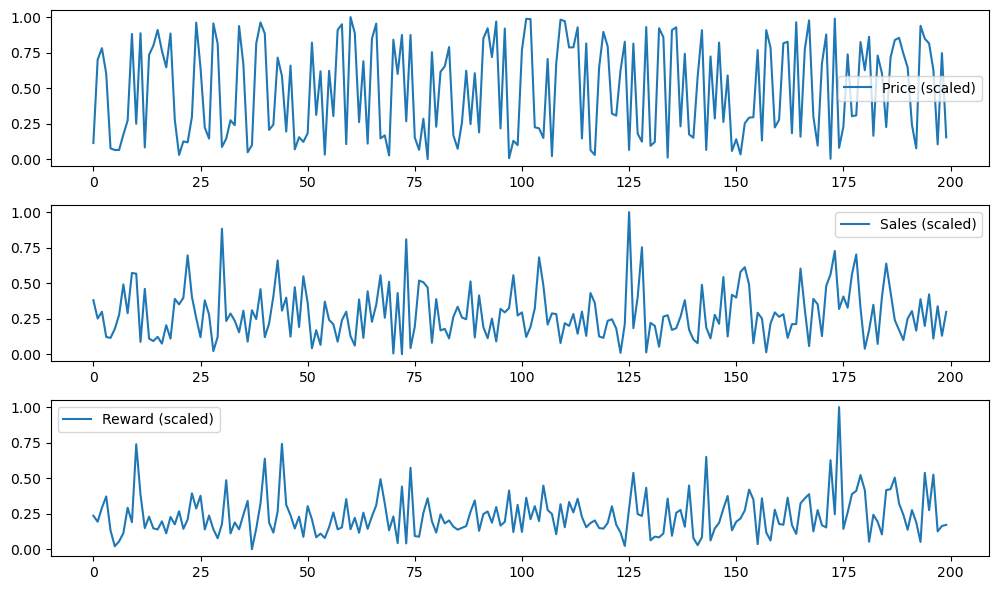

In [94]:
visualize_model_working(model, test_env)

In [95]:
def baseline_strategy(env):
    total_reward = 0
    obs = env.reset()
    for _ in range(len(env.data)):
        action = 0  
        obs, reward, done, info = env.step(action)
        total_reward += reward
        if done:
            break
    return total_reward

baseline_reward = baseline_strategy(test_env)
print(f"Baseline Strategy Reward: {baseline_reward}")

Step: 0, Price: 15.04, Sales: 6243.60
Step: 1, Price: 8.07, Sales: 10308.00
Step: 2, Price: 13.96, Sales: 7758.00
Step: 3, Price: 14.77, Sales: 8700.00
Step: 4, Price: 12.97, Sales: 5206.80
Step: 5, Price: 7.69, Sales: 5065.20
Step: 6, Price: 7.58, Sales: 6309.60
Step: 7, Price: 7.57, Sales: 8258.40
Step: 8, Price: 8.67, Sales: 12495.60
Step: 9, Price: 9.66, Sales: 8508.00
Step: 10, Price: 15.78, Sales: 14096.40
Step: 11, Price: 9.43, Sales: 13992.00
Step: 12, Price: 15.83, Sales: 4518.00
Step: 13, Price: 7.76, Sales: 11886.00
Step: 14, Price: 14.30, Sales: 4972.80
Step: 15, Price: 14.95, Sales: 4629.60
Step: 16, Price: 16.06, Sales: 5220.00
Step: 17, Price: 14.59, Sales: 4275.60
Step: 18, Price: 13.42, Sales: 6829.20
Step: 19, Price: 15.81, Sales: 4962.00
Step: 20, Price: 9.71, Sales: 10492.80
Step: 21, Price: 7.23, Sales: 9723.60
Step: 22, Price: 8.18, Sales: 10644.00
Step: 23, Price: 8.12, Sales: 16536.00
Step: 24, Price: 9.92, Sales: 10770.00
Step: 25, Price: 16.58, Sales: 7828.80


In [96]:
model.save("optimized_pricing_model")